#  Fitting Spectrum

This notebook shows the aplication of fitting code to a 5-component spectrum 


In [1]:
import matplotlib.pylab as plt
import scipy.optimize as sop
import tables as tb
import pandas as pd
from Histogram import Histogram as hist
from PDF import PDF
import numpy as np
from Fits import Fit
%matplotlib inline
%load_ext autoreload
%autoreload 2

In [2]:
np.warnings.filterwarnings('ignore')

plt.rcParams["figure.figsize"]          = 16, 12
plt.rcParams["font.size"]               = 15
#plt.rcParams["figure.max_open_warning"] = 100

In [3]:
regions = ['Anode', 'Barrel', 'Cathode']
isotopes = ['K', 'Co', 'Bi', 'Tl']
nbinE = 150
minE, maxE = 650, 2700
nbinZ = 100
minZ, maxZ = 10, 550

In [4]:
def SigmaEstimator(E, rlim = 0.01):
    #res en Q_bb
    qbb = 2458     #MeV

    return rlim*(qbb*E)**0.5/2.35482

def Gaussianizator(E,sigma = -1, rlim = 0.01):
    if sigma<0:
        sigma = SigmaEstimator(E, rlim)
    return E #np.random.normal(E, sigma)


def h_Gauss(h,sigma = -1, rlim = 0.01):
    nbin = h.nbin
    minE = h.minlim
    maxE = h.maxlim
    hnew = hist([],nbin,minE,maxE)
    hnew.hist = np.zeros_like(h.hist)
    hnew.bins = h.bins[:]

    for i in range(nbin):
        Caux = h.bins[i]
        naux = h.hist[i]
        for j in range(int(naux)):
            hnew.Fill_hist(Gaussianizator(Caux, sigma, rlim))
    return hnew

# Reading and building MC PDFs

In [5]:
mc_pdfs = {}

In [6]:
with tb.open_file("../Data/new_MC_innercastle_Topology_pdfs/pdf_fid_hits_MC_bkg_innercastle.h5", "r") as f_pdfs:
    for region in regions:
        mc_pdfs[region] = {}
        for isotope in isotopes:
            group = getattr(f_pdfs.root, region)
            node  = getattr(group, isotope)
            mc_pdfs[region][isotope] = pd.DataFrame.from_records(node.read())

In [7]:
mc_pdfs[region][isotope].columns

Index(['index', 'evt_energy', 'numb_of_tracks', 'energy', 'length',
       'numb_of_voxels', 'eblob1_bary', 'eblob2_bary', 'ovlp_energy', 'nS2',
       'Xavg', 'Yavg', 'Zavg', 'minZ', 'maxZ', 'maxR', 'event', 'x_blob_1',
       'y_blob_1', 'z_blob_1', 'x_blob_2', 'y_blob_2', 'z_blob_2', 'subindex',
       'dist_blobs', 'evt_number', 'atomic_number', 'mass_number', 'region',
       'isotope'],
      dtype='object')

In [8]:
#as just energy is required, all regions are joined

In [9]:
histograms = {'E':[], 'z':[]}
name       = []
N_MC       = []


for isotope in isotopes:
    df = []
    name.append(isotope) 
    for region in regions:
        
        df.append(mc_pdfs[region][isotope])
    df = pd.concat(df)       
    histograms['E'].append(hist(df.energy , nbinE, minE, maxE))
    histograms['z'].append(hist(df.Zavg                            , nbinZ, minZ, maxZ))                      
    N_MC           .append(len(df.evt_energy.unique()))




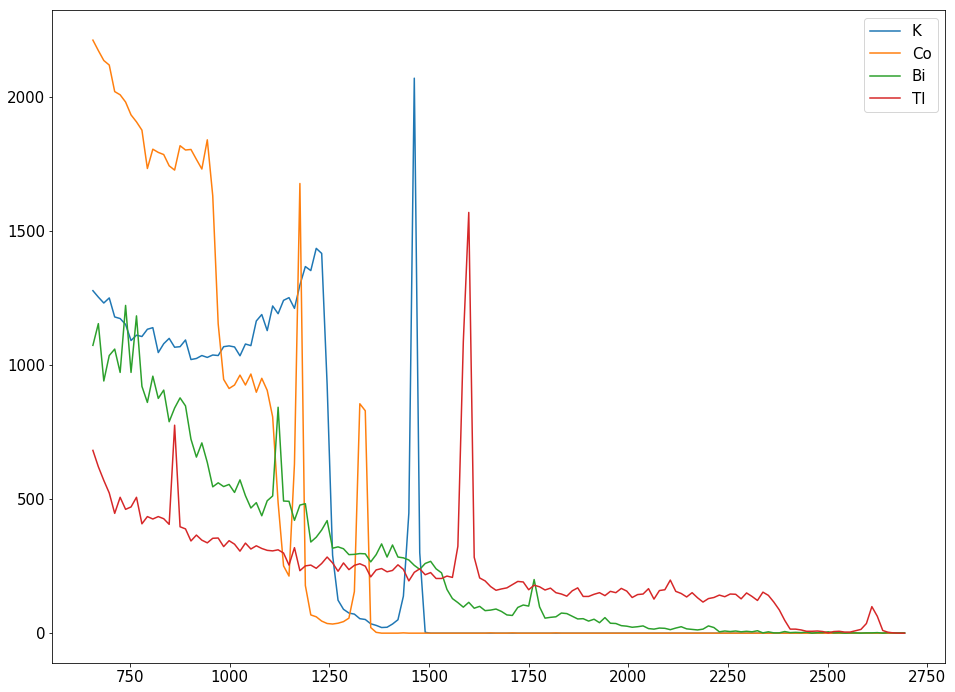

In [10]:
i = 0
for isotope in isotopes:
    h_ = histograms['E'][i]
    plt.plot(h_.bins, h_.hist, label=name[i])
    i += 1
    plt.legend()

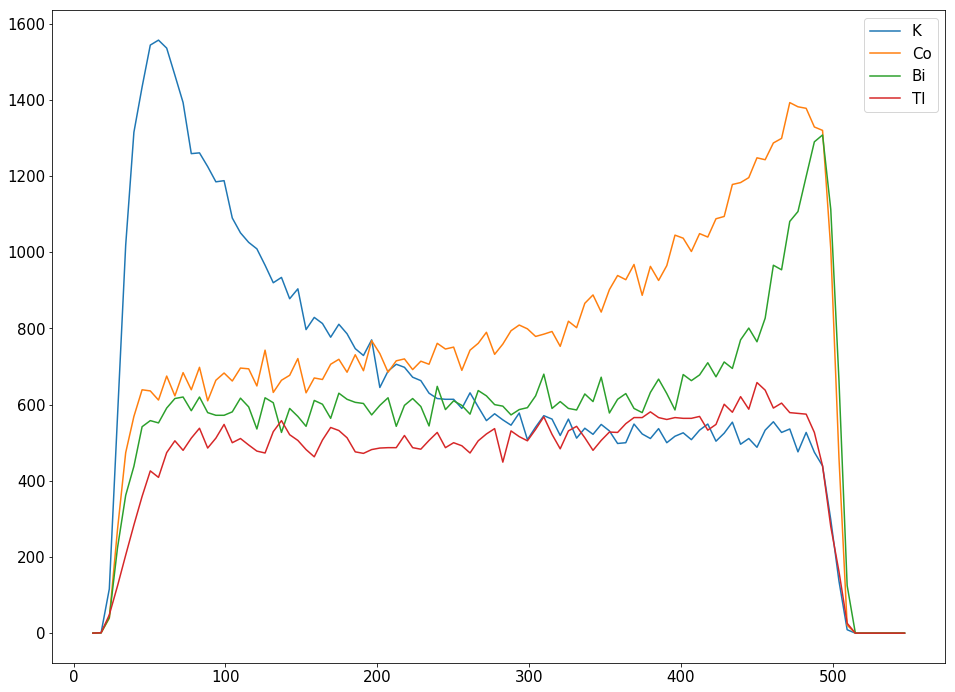

In [11]:
i = 0

for isotope in isotopes:
    h_ = histograms['z'][i]
    plt.plot(h_.bins, h_.hist, label=name[i])
    i += 1
plt.legend()

In [12]:
pdfs = {'E':[]}#, 'z':[]}

interpol = 'cubic'

pdfs['E'] = [PDF(h_, interpolation=interpol) for h_ in histograms['E']]
#pdfs['z'] = [PDF(h_, interpolation=interpol) for h_ in histograms['z']]

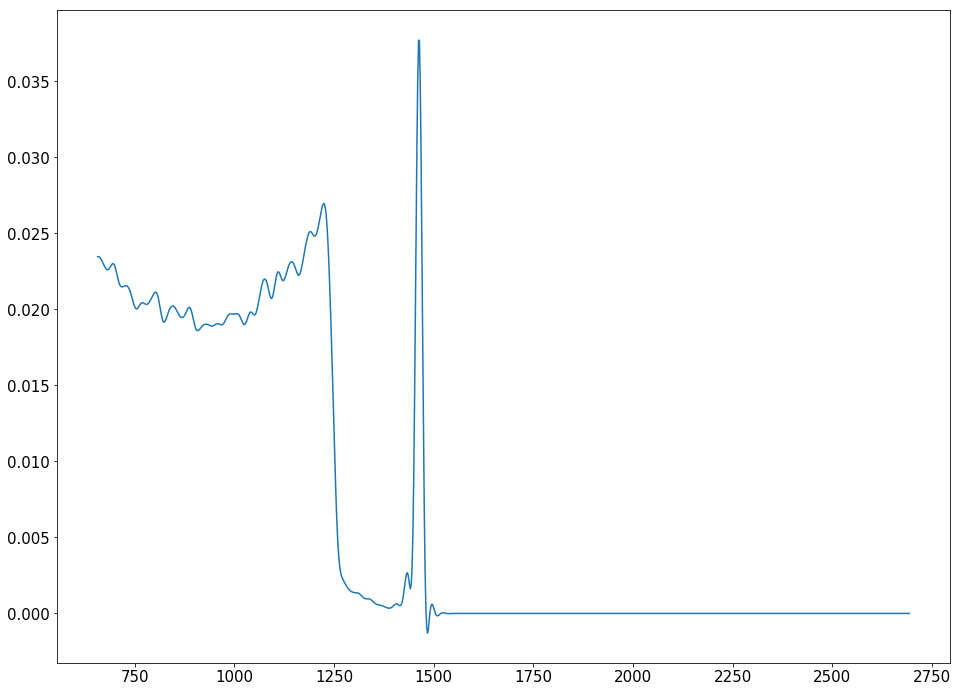

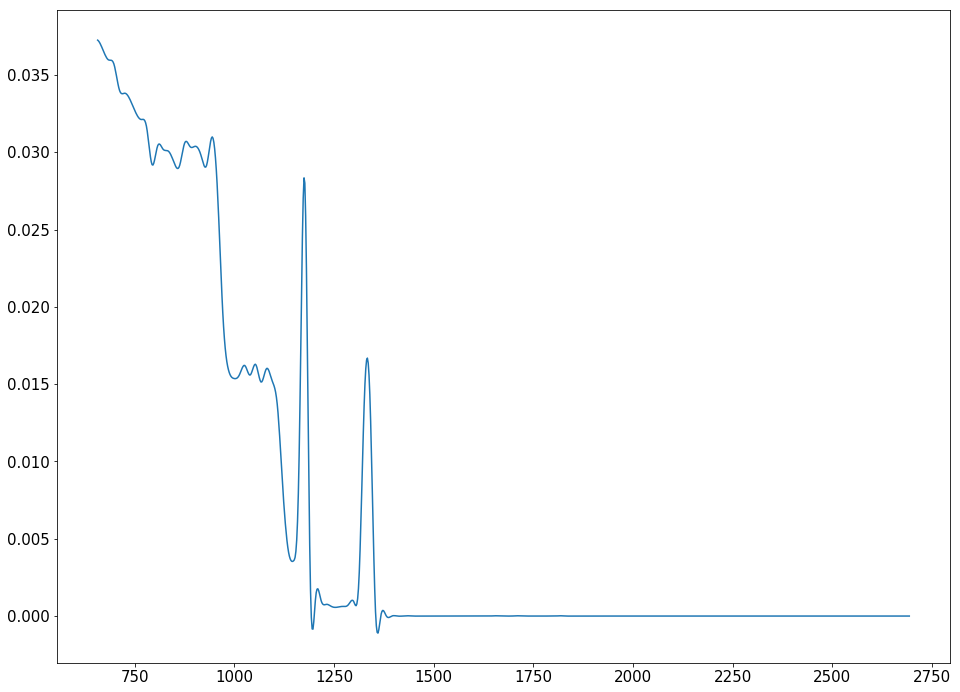

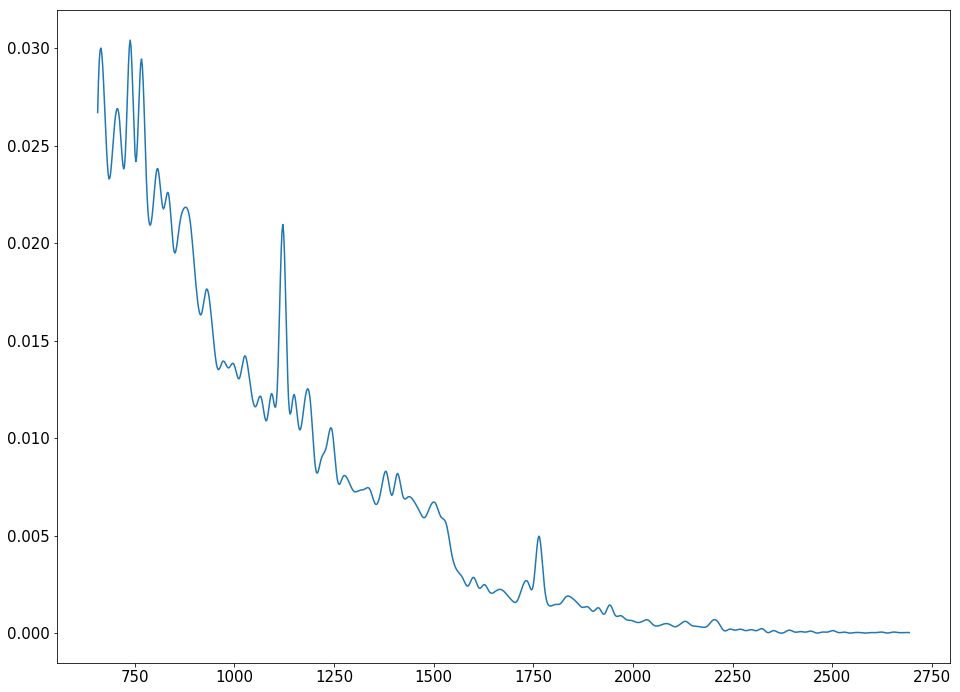

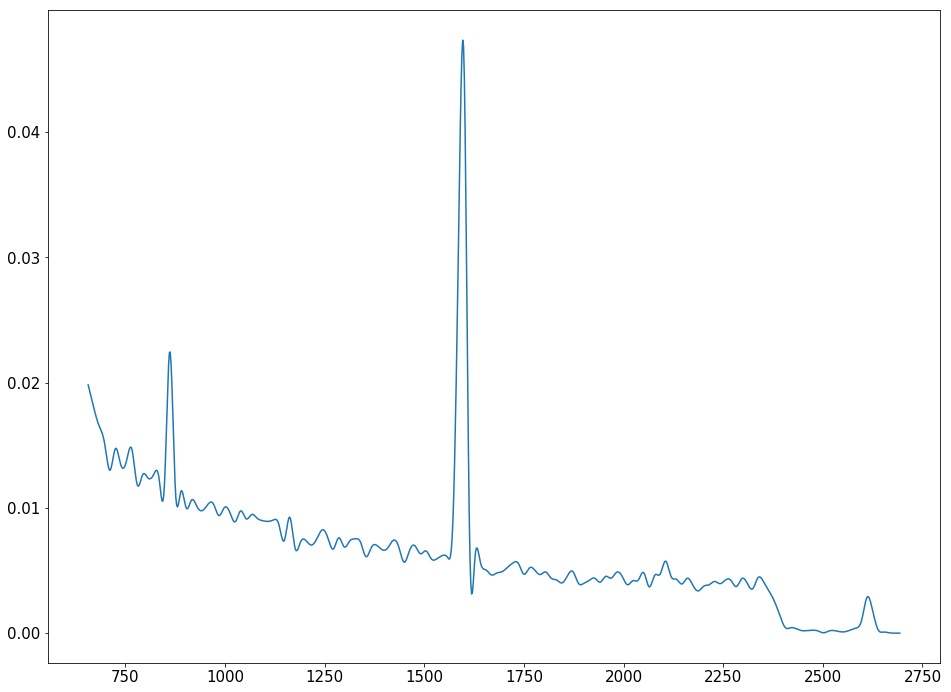

In [13]:
Ep = np.linspace(histograms['E'][0].bins[0],histograms['E'][0].bins[-1],1000)

for pdf in pdfs['E']:
    
    plt.figure()
    y = pdf.pdf(Ep)
    plt.plot(Ep, y)
    plt.show()

In [14]:
x_dict = {'E': histograms['E'][0].bins }#, 'z': histograms['z'][0].bins}

# "MC-Data reading"

## Bkg

In [15]:
f_data_b     = tb.open_file("../Data//new_MC_innercastle_Topology/topology_hits_MC_bkg_innercastle_energy_cut.hdf5", "r")
table_data_b = pd.DataFrame.from_records(f_data_b.root.dataframe.table.read())
table_data_b.head()

h_total_e_b = hist(table_data_b.energy, nbinE, minE, maxE)
h_total_z_b = hist(table_data_b.Zavg  , nbinZ, minZ, maxZ)

totals = {'E': h_total_e_b}#    , 'z': h_total_z_b  }

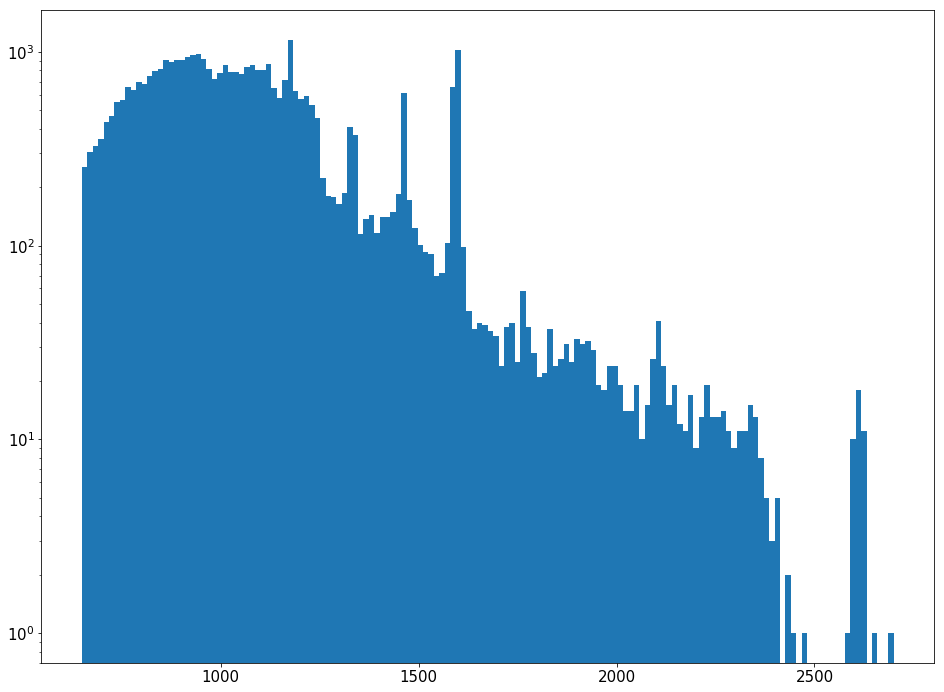

In [16]:
plt.hist(table_data_b.energy,nbinE,[minE,maxE]);
plt.yscale('log')

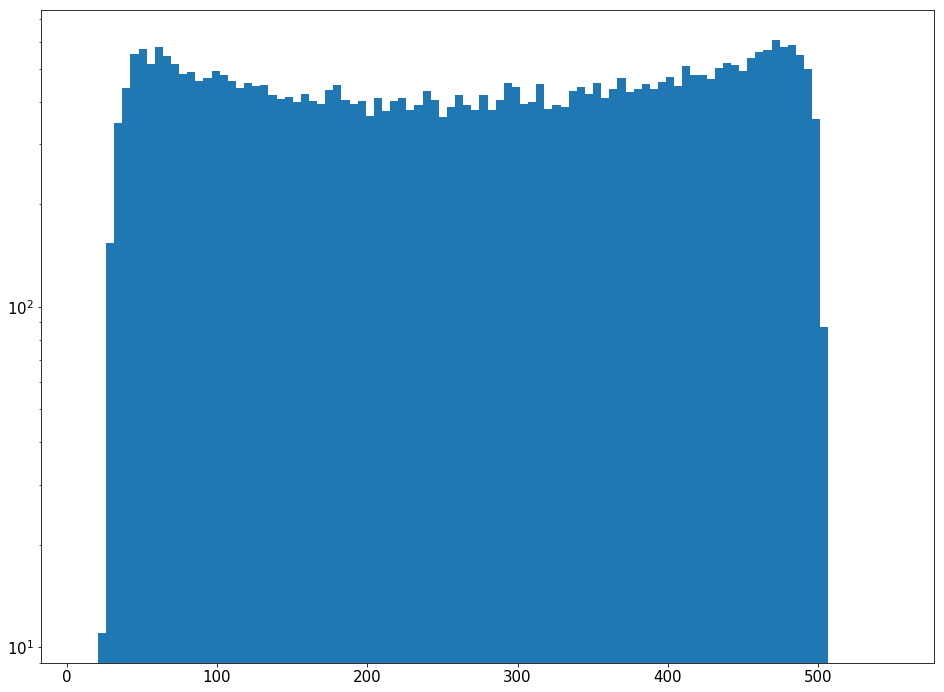

In [17]:
plt.hist(table_data_b.Zavg,nbinZ,[minZ,maxZ]);
plt.yscale('log')

## Signal

In [18]:
f_data_s     = tb.open_file("../Data/new_MC_innercastle_Topology/topology_hits_MC_xe2nu_unique_cut.hdf5", "r")
table_data_s = pd.DataFrame.from_records(f_data_s.root.dataframe.table.read())
table_data_s.head()

h_total_e_s = hist(table_data_s.energy, nbinE, minE, maxE)
h_total_z_s = hist(table_data_s.Zavg  , nbinZ, minZ, maxZ)

totals_s = {'E': h_total_e_s}#, 'z': h_total_z_s   }

#add signal pdf

interpol = 'cubic'

pdfs['E'] += [PDF(h_total_e_s, interpolation=interpol)]
#pdfs['z'] += [PDF(h_total_z_s, interpolation=interpol)]

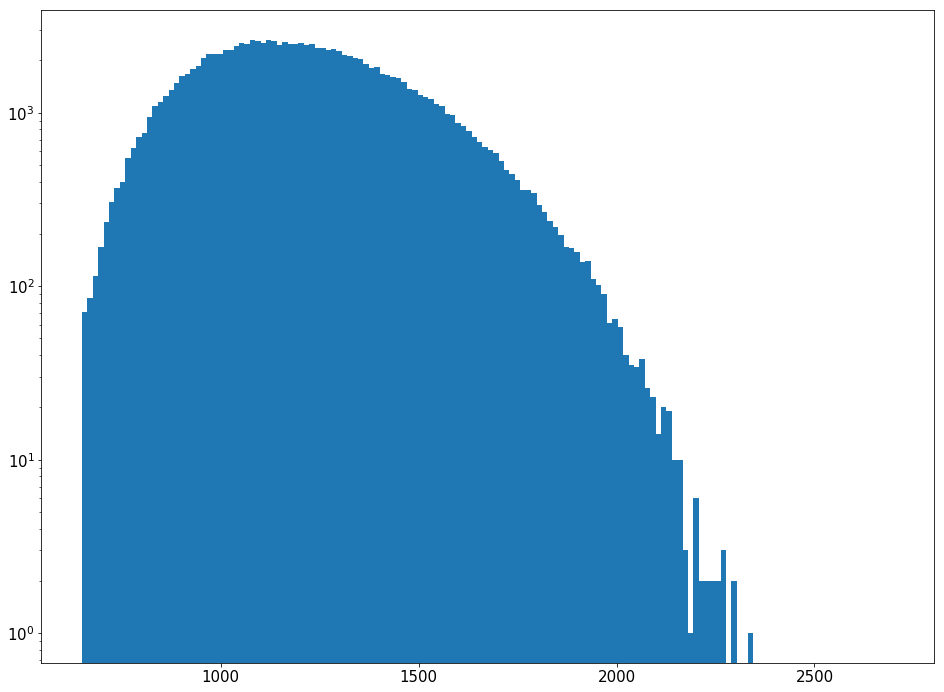

In [19]:
plt.hist(table_data_s.energy,nbinE,[minE,maxE]);
plt.yscale('log')

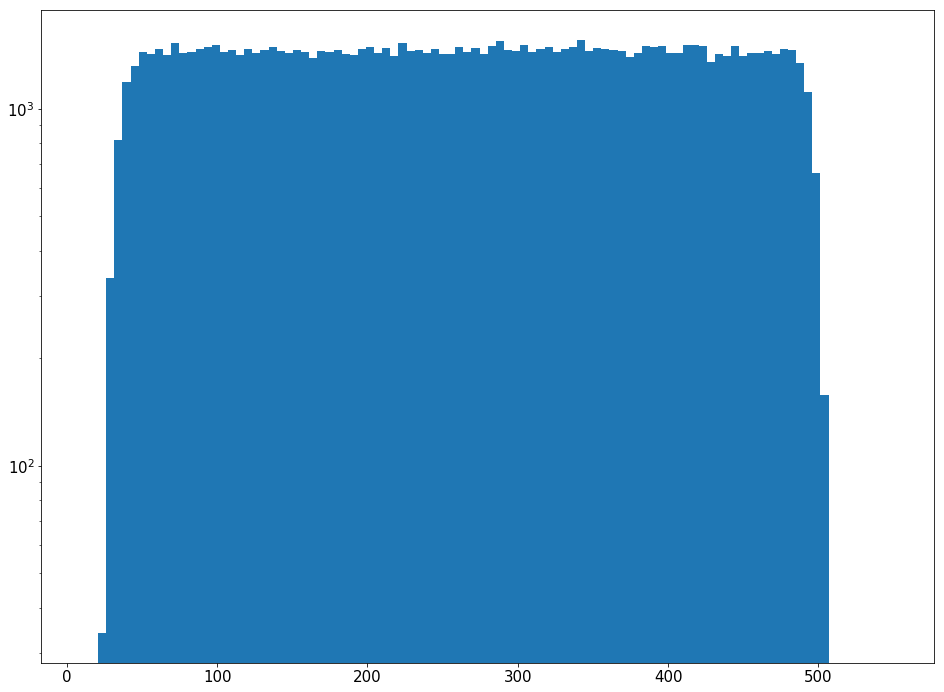

In [20]:
plt.hist(table_data_s.Zavg,nbinZ,[minZ,maxZ]);
plt.yscale('log')

# Exposure issues

In [21]:
#Pau normalization:
n_pau       = {} 
n_pau['K']  = 0.36
n_pau['Co'] = 4.38
n_pau['Bi'] = 1.69
n_pau['Tl'] = 1.55

In [22]:
expo_bb = 223.970 #y
expo_bkg  = 5.48    #y

In [23]:
N_K  = np.sum([len(mc_pdfs[region]['K'])  for region in regions])
N_Co = np.sum([len(mc_pdfs[region]['Co']) for region in regions])
N_Bi = np.sum([len(mc_pdfs[region]['Bi']) for region in regions])
N_Tl = np.sum([len(mc_pdfs[region]['Tl']) for region in regions])
N_bb = len(table_data_s)

# Fitting

In [24]:
#As we don't care abour regions, data are considered just by isotope
mc_pdfs_noreg = {}

for isotope in isotopes:
    mc_pdfs_noreg[isotope] = pd.concat([mc_pdfs[region][isotope] for region in regions]) 


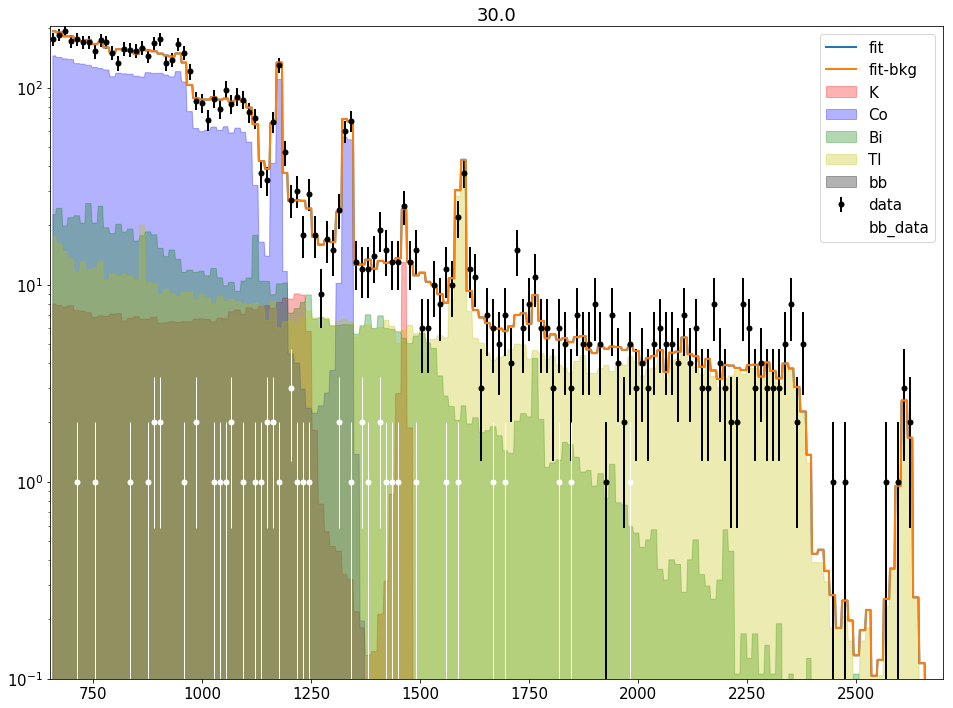

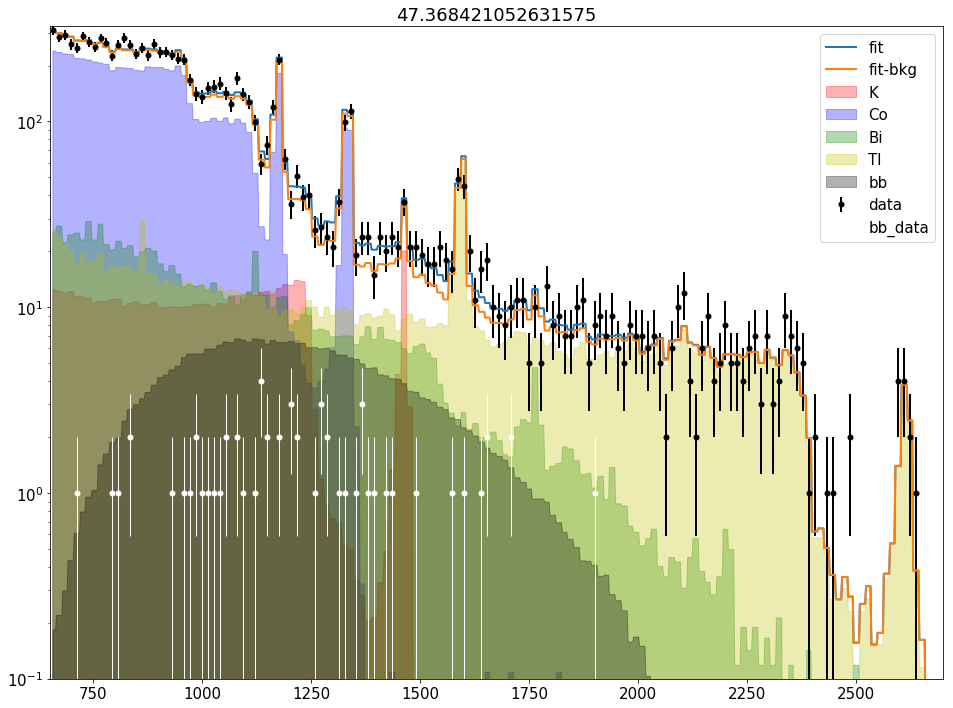

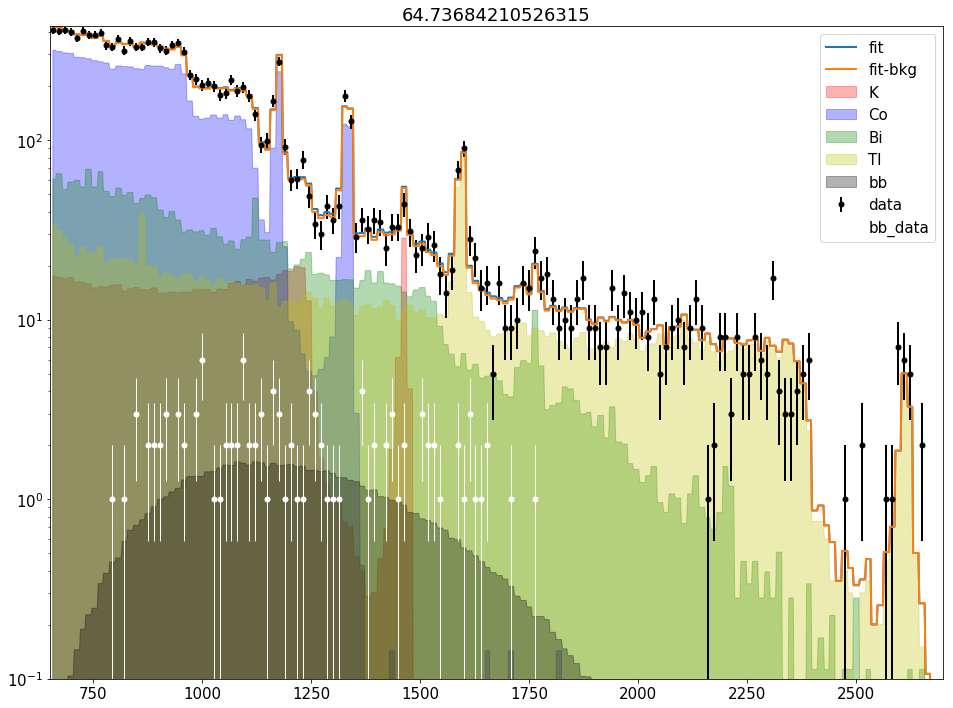

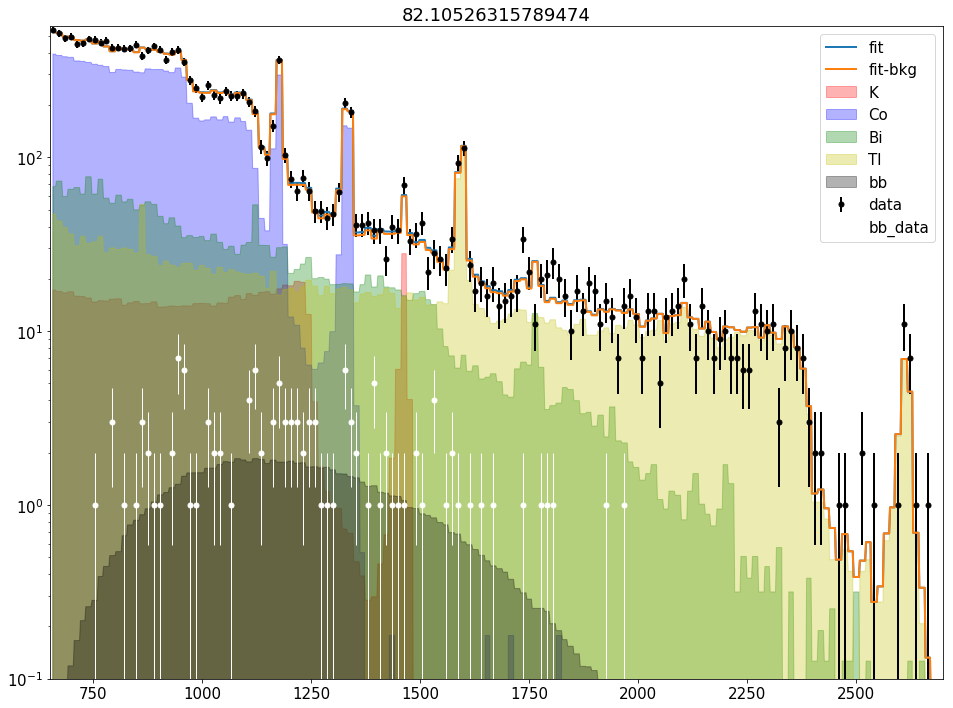

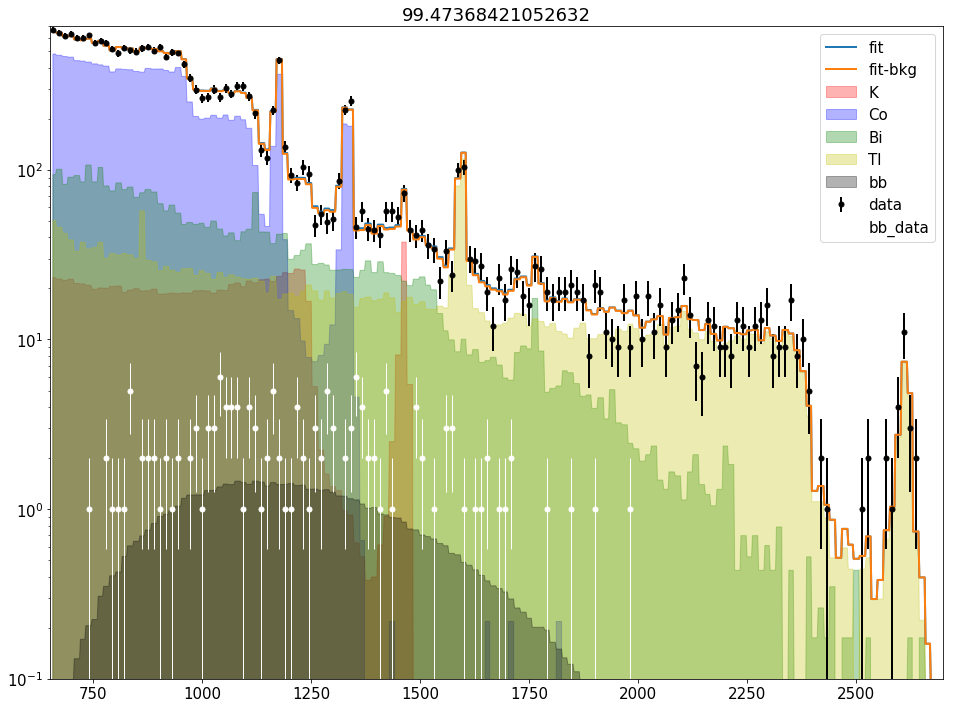

...

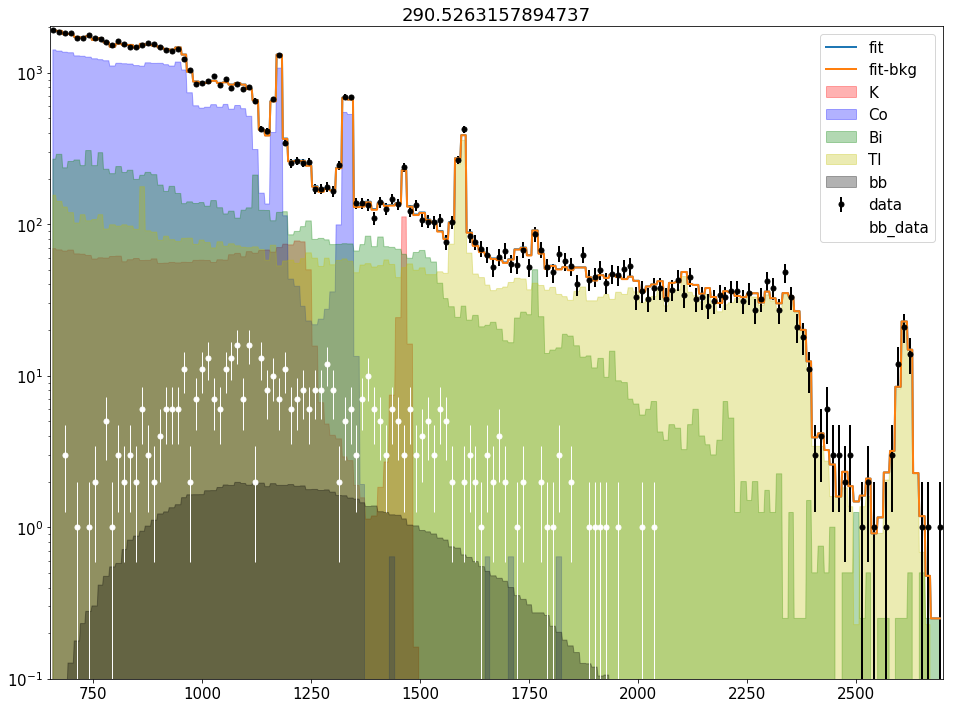

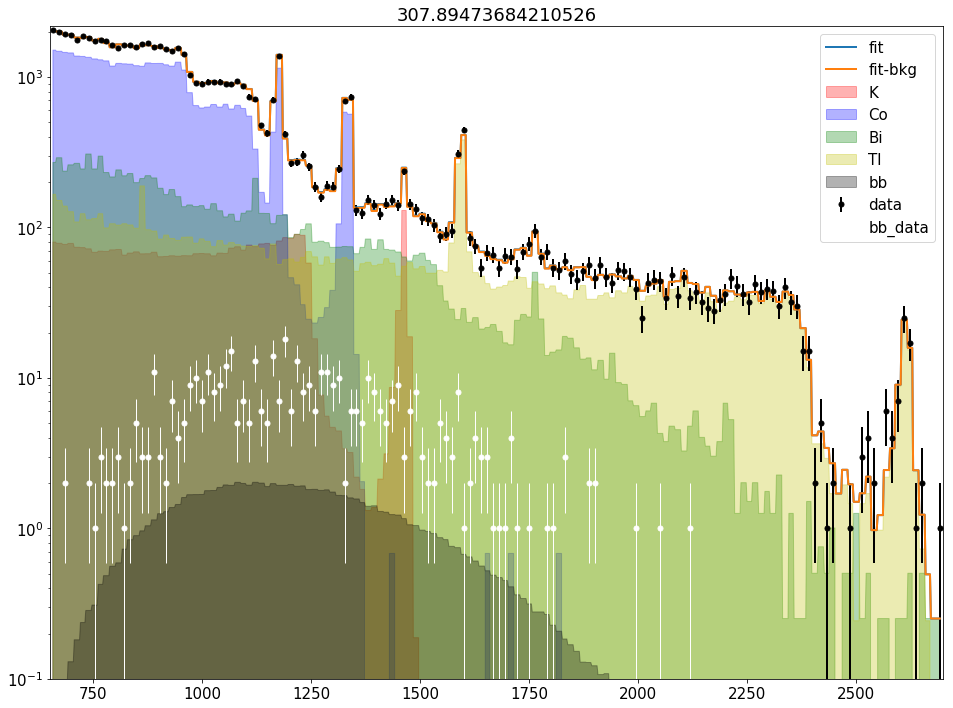

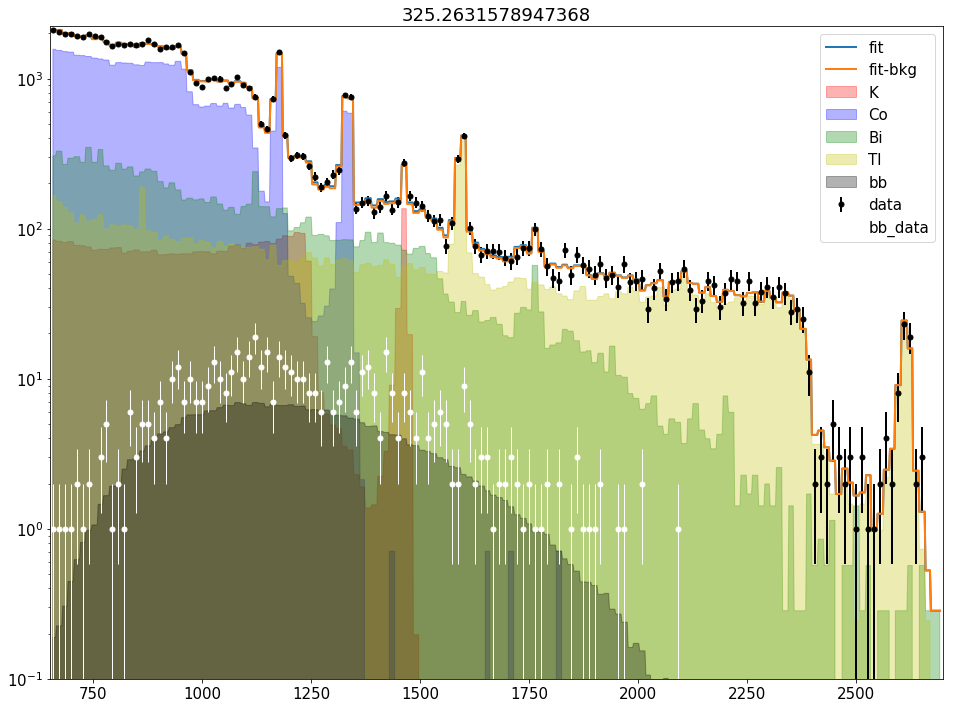

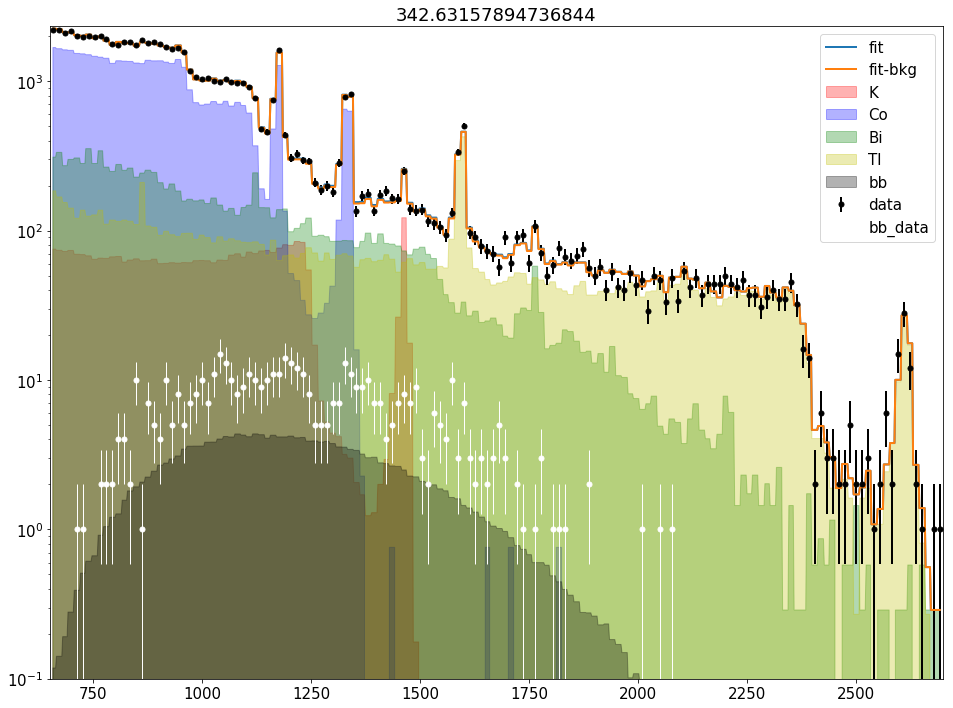

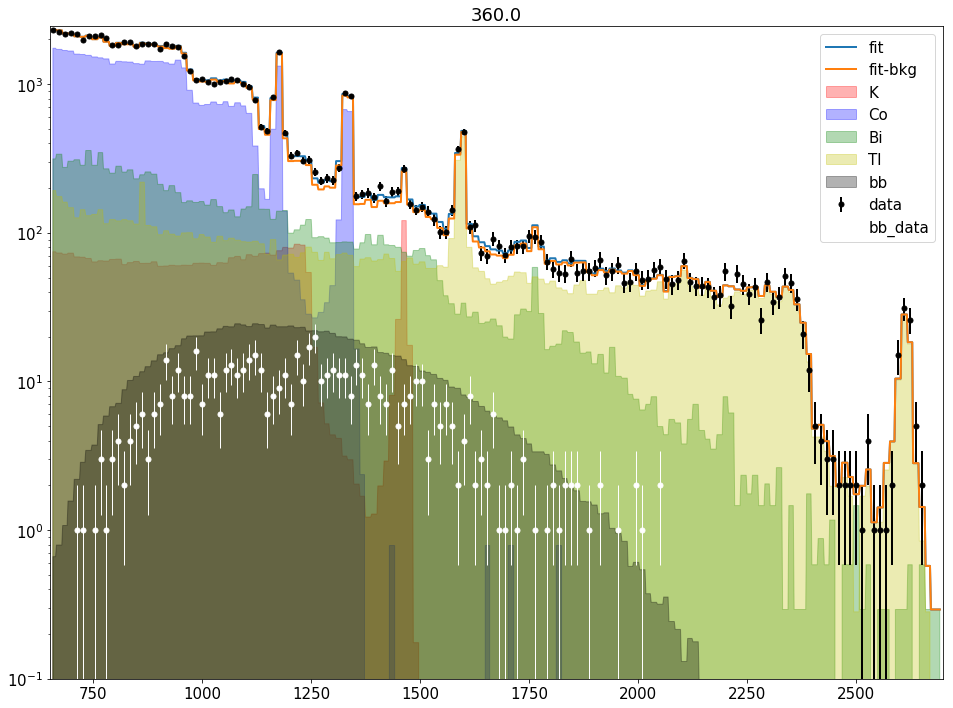

In [25]:
res_list = {}

for days in np.linspace(30, 360, 20):
    
    n_exp = {}
    n_exp['K']  = n_pau['K']  * days * N_K  / (expo_bkg * 365.24)
    n_exp['Co'] = n_pau['Co'] * days * N_Co / (expo_bkg * 365.24)
    n_exp['Bi'] = n_pau['Bi'] * days * N_Bi / (expo_bkg * 365.24)
    n_exp['Tl'] = n_pau['Tl'] * days * N_Tl / (expo_bkg * 365.24)
    n_exp['bb'] = days * N_bb / (expo_bb  * 365.24)
    
    total_data = []
    
    for isotope in isotopes:
        iso_e = np.random.choice(mc_pdfs_noreg[isotope].energy, int(np.random.poisson(n_exp[isotope])))
        total_data.append(iso_e)
    total_bb = np.random.choice(table_data_s.energy, int(np.random.poisson(n_exp['bb'])))
    total_data.append(total_bb)
    total_data = np.concatenate(total_data)
    h_total_e  = hist(total_data, nbinE, minE, maxE)
    h_total_bb = hist(total_bb  , nbinE, minE, maxE)

    
    N_0 = np.array([n_exp[key] for key in n_exp.keys()])
    totals = {'E': h_total_e}
    ratios = np.ones_like(N_0)
    bounds = [[0.5,1.5]]*len(N_0)
    fit = Fit(x_dict, totals, pdfs,N_0)
    
    res_ll = fit.FitLLM(ratios,tol=1e-12,options={"maxiter":10000,'ftol':1e-12}, bounds=bounds)
    
    res_list[days] = res_ll
    
    
    #plotting
    plt.figure()
    factors   = res_ll.x * N_0
    Ep = np.linspace(totals['E'].bins[0],totals['E'].bins[-1],1000)
    pdfs_plot = {'E':[]}
    interpol = 'nearest'
    pdfs_plot['E'] = [PDF(h_, factor=factors[i], 
                          interpolation=interpol) for h_, i in zip(histograms['E']+[h_total_e_s], 
                                                                   range(len(N_0)))]

    y_e = [pdf.pdf(Ep) for pdf in pdfs_plot['E']] 
    fittotal_e = np.sum(y_e, axis=0)
    K_e  = y_e[0] 
    Co_e = y_e[1]
    Bi_e = y_e[2]
    Tl_e = y_e[3]
    bb_e = y_e[4]
    
    total_sin = y_e[0] + y_e[1] + y_e[2] + y_e[3]
    
    plt.errorbar(totals['E'].bins, totals['E'].hist, yerr=np.sqrt(totals['E'].hist),
                 marker='.', markersize=10, elinewidth=2, linewidth=0,label='data',color='black')
    
    plt.errorbar(totals['E'].bins, h_total_bb.hist, yerr=np.sqrt(h_total_bb.hist),
                 marker='.', markersize=10, elinewidth=1, linewidth=0,label='bb_data',color='w')

    plt.plot(Ep, fittotal_e, label='fit', linewidth=2,)
    plt.plot(Ep, total_sin, label='fit-bkg', linewidth=2,)
    alfa = 0.3
    plt.fill_between(Ep, 0 , K_e  , label='K'  ,alpha=alfa,color='r')
    plt.fill_between(Ep, 0 , Co_e , label='Co' ,alpha=alfa,color='b')
    plt.fill_between(Ep, 0 , Bi_e , label='Bi' ,alpha=alfa,color='g')
    plt.fill_between(Ep, 0 , Tl_e , label='Tl' ,alpha=alfa,color='y')
    plt.fill_between(Ep, 0 , bb_e , label='bb' ,alpha=alfa,color='k')

    plt.xlim(minE, maxE)
    plt.ylim(   0.1, np.max(h_total_e.hist)*1.05)
    plt.legend()
    plt.yscale('log')
    plt.title(str(days))

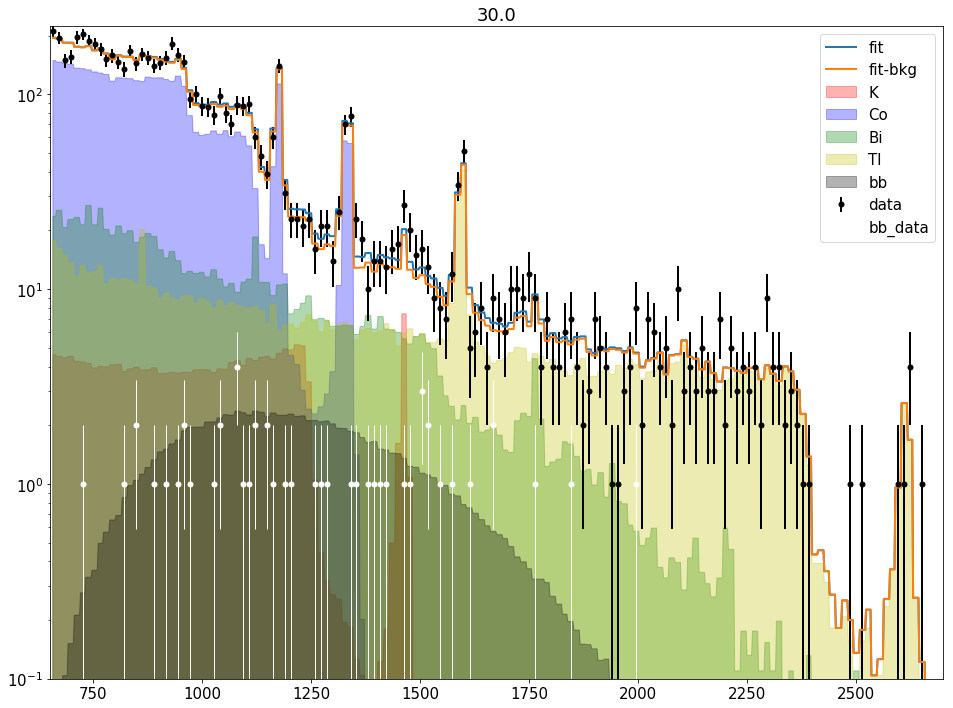

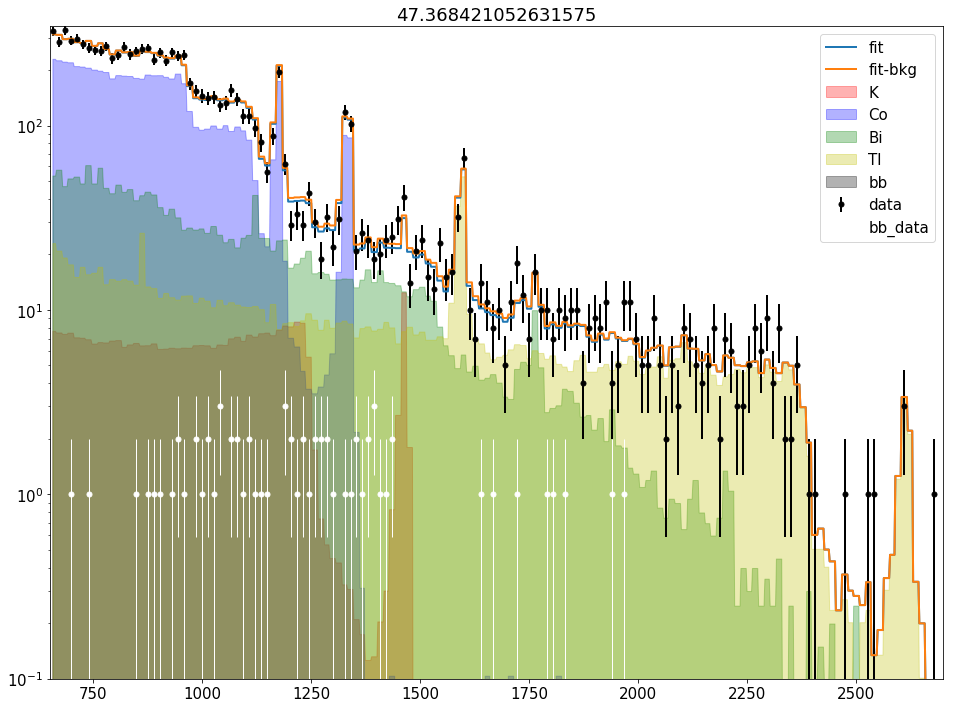

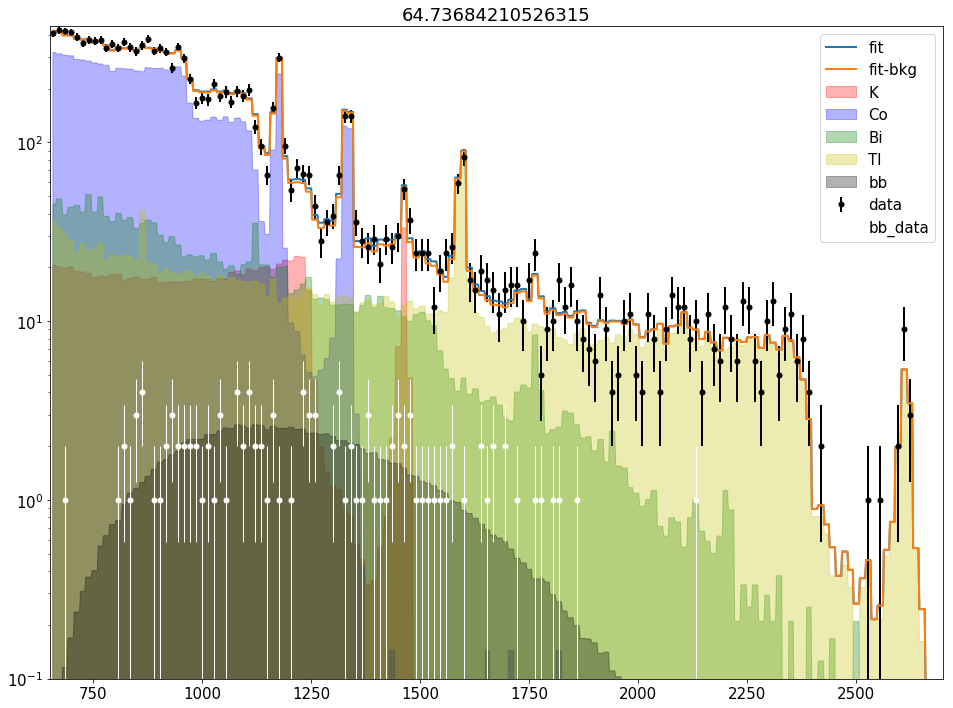

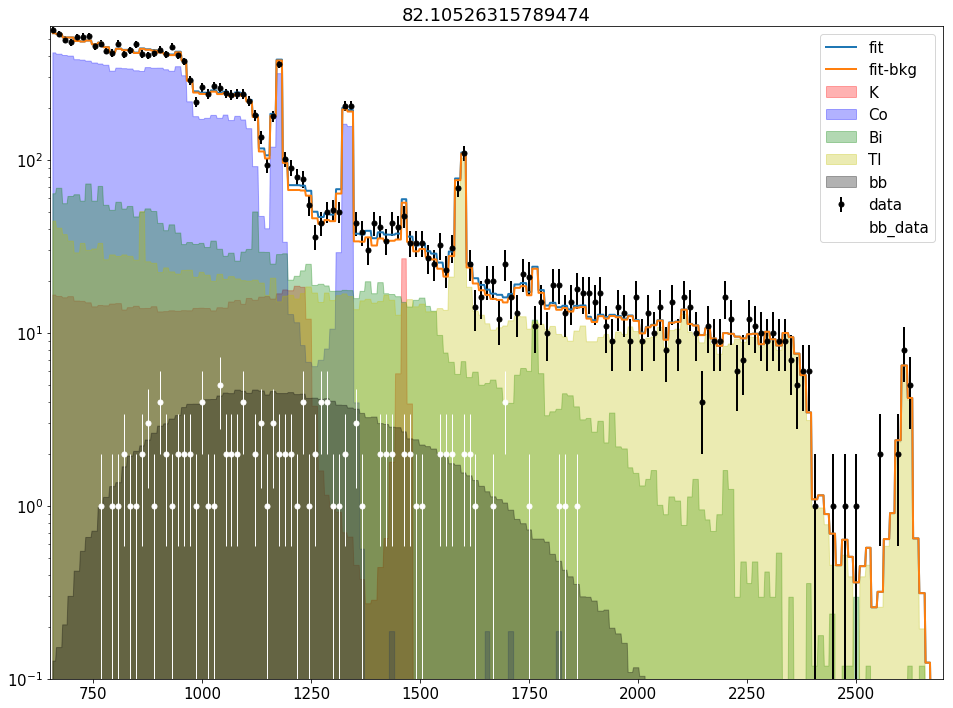

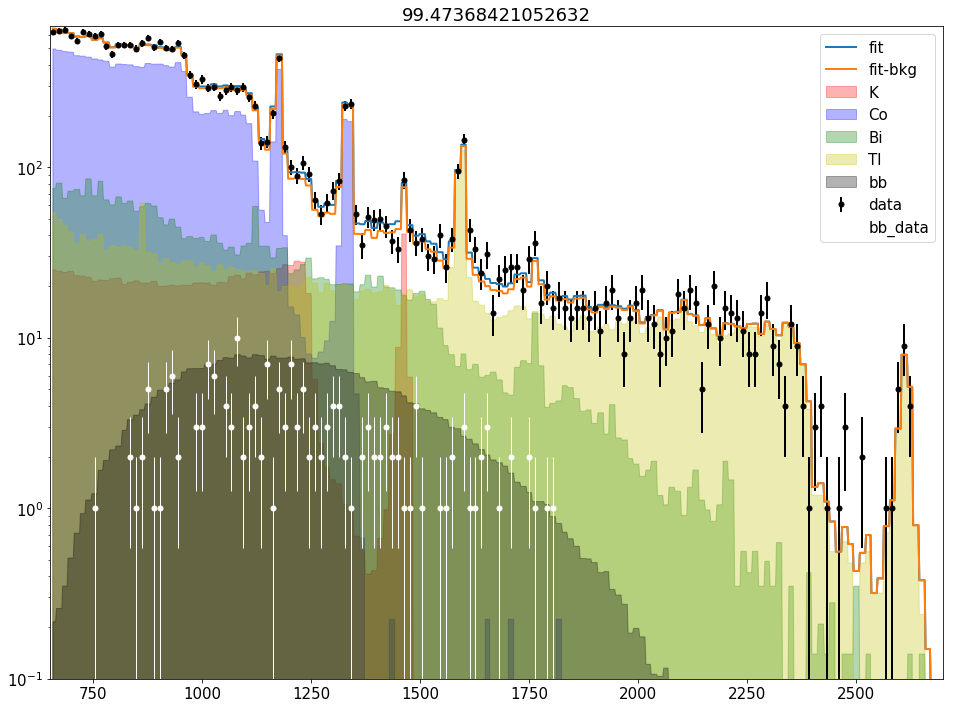

...

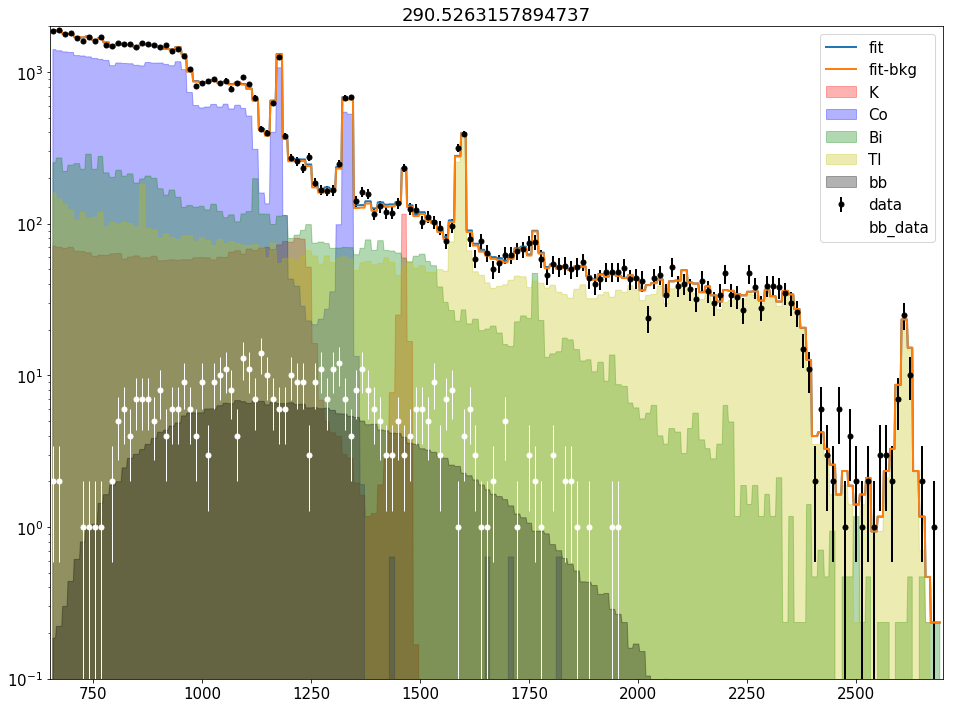

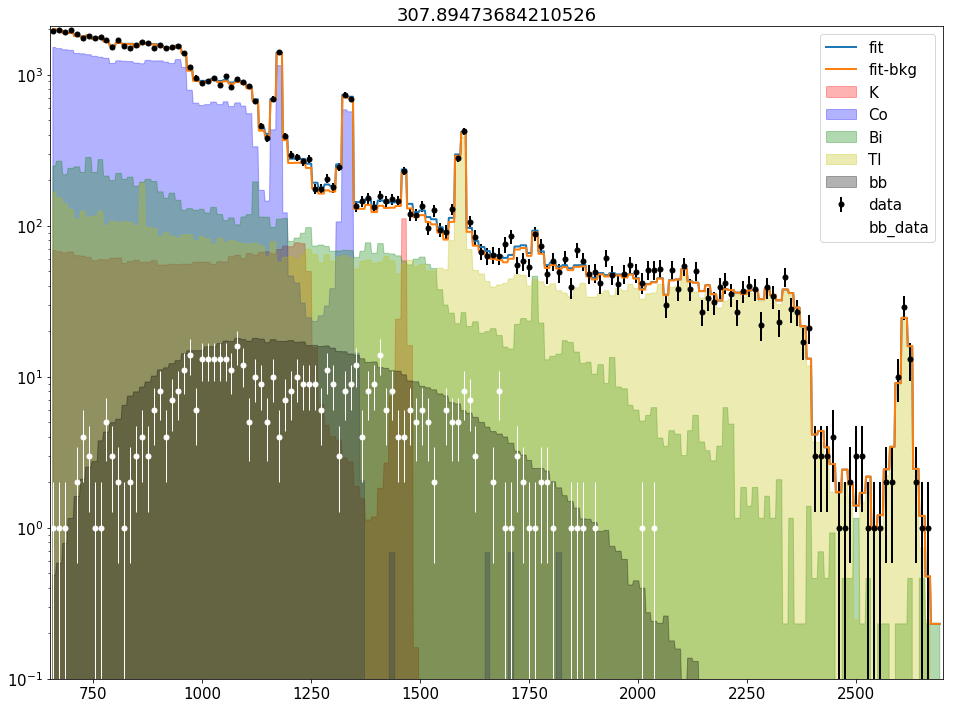

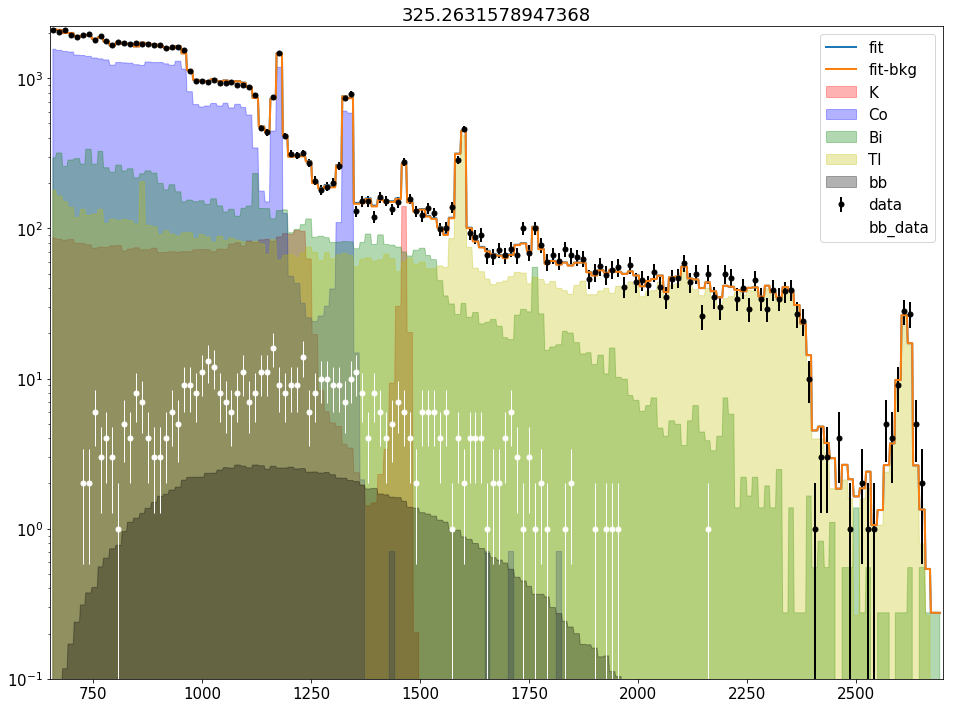

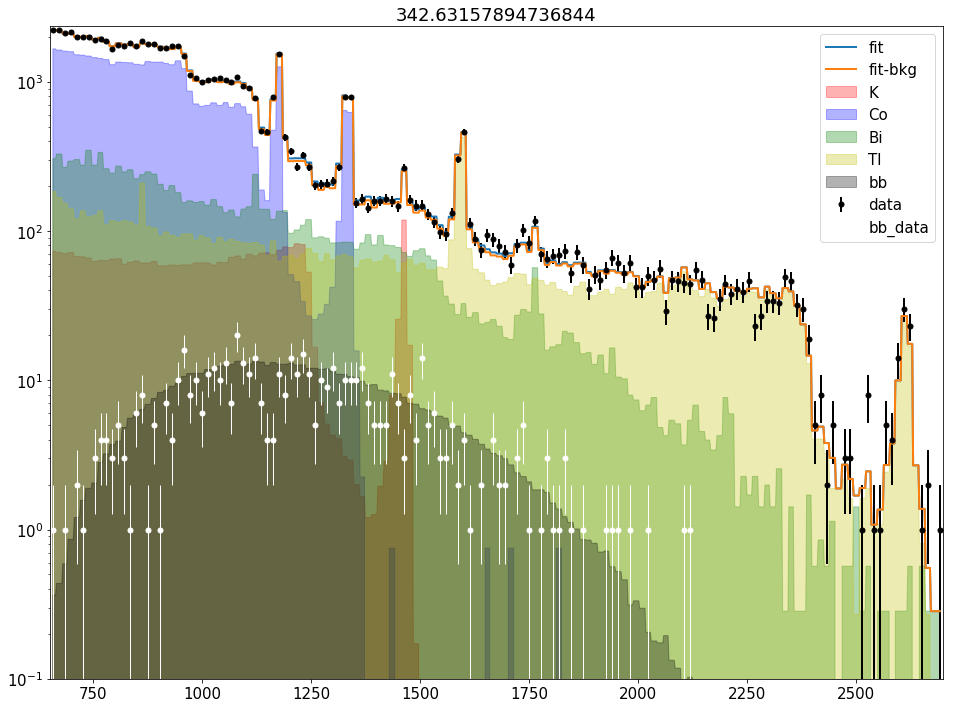

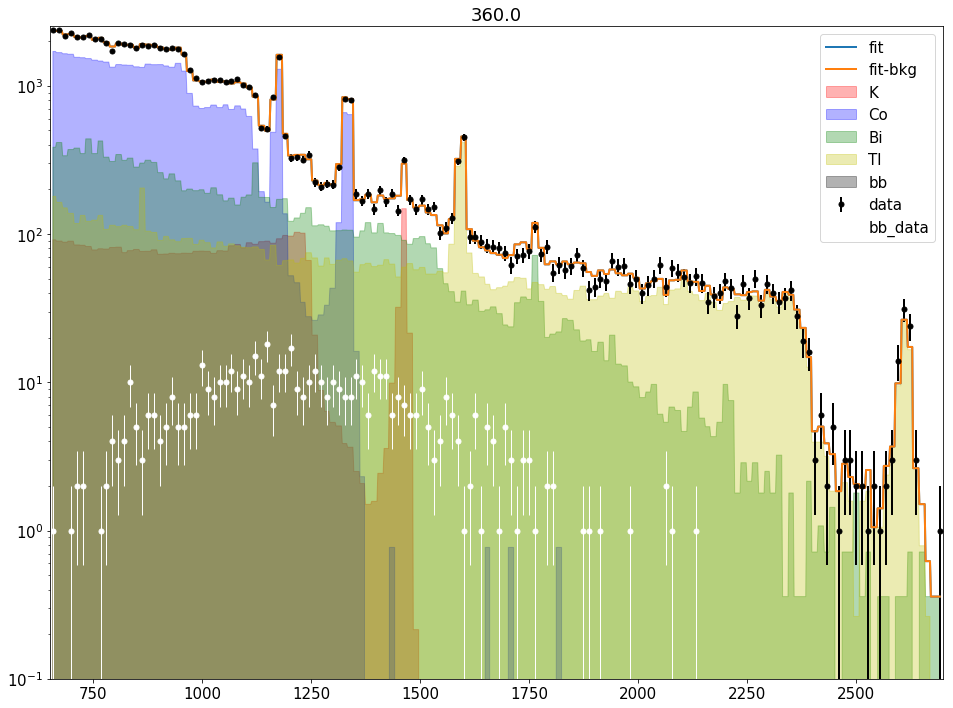

In [26]:
res_list = {}

for days in np.linspace(30, 360, 20):
    
    n_exp = {}
    n_exp['K']  = n_pau['K']  * days * N_K  / (expo_bkg * 365.24)
    n_exp['Co'] = n_pau['Co'] * days * N_Co / (expo_bkg * 365.24)
    n_exp['Bi'] = n_pau['Bi'] * days * N_Bi / (expo_bkg * 365.24)
    n_exp['Tl'] = n_pau['Tl'] * days * N_Tl / (expo_bkg * 365.24)
    n_exp['bb'] = days * N_bb / (expo_bb  * 365.24)
    
    total_data = []
    
    for isotope in isotopes:
        iso_e = np.random.choice(mc_pdfs_noreg[isotope].energy, int(np.random.poisson(n_exp[isotope])))
        total_data.append(iso_e)
    total_bb = np.random.choice(table_data_s.energy, int(np.random.poisson(n_exp['bb'])))
    total_data.append(total_bb)
    total_data = np.concatenate(total_data)
    h_total_e  = hist(total_data, nbinE, minE, maxE)
    h_total_bb = hist(total_bb  , nbinE, minE, maxE)

    
    N_0 = np.array([n_exp[key] for key in n_exp.keys()])
    totals = {'E': h_total_e}
    ratios = np.ones_like(N_0)
    bounds = [[0.5,1.1], [0.5,1.1], [0.5,1.1], [0.5,1.1], [0.5,1.5]]
    fit = Fit(x_dict, totals, pdfs,N_0)
    
    res_ll = fit.FitLLM(ratios,tol=1e-12,options={"maxiter":10000,'ftol':1e-12}, bounds=bounds)
    
    res_list[days] = res_ll
    
    
    #plotting
    plt.figure()
    factors   = res_ll.x * N_0
    Ep = np.linspace(totals['E'].bins[0],totals['E'].bins[-1],1000)
    pdfs_plot = {'E':[]}
    interpol = 'nearest'
    pdfs_plot['E'] = [PDF(h_, factor=factors[i], 
                          interpolation=interpol) for h_, i in zip(histograms['E']+[h_total_e_s], 
                                                                   range(len(N_0)))]

    y_e = [pdf.pdf(Ep) for pdf in pdfs_plot['E']] 
    fittotal_e = np.sum(y_e, axis=0)
    K_e  = y_e[0] 
    Co_e = y_e[1]
    Bi_e = y_e[2]
    Tl_e = y_e[3]
    bb_e = y_e[4]
    
    total_sin = y_e[0] + y_e[1] + y_e[2] + y_e[3]
    
    plt.errorbar(totals['E'].bins, totals['E'].hist, yerr=np.sqrt(totals['E'].hist),
                 marker='.', markersize=10, elinewidth=2, linewidth=0,label='data',color='black')
    
    plt.errorbar(totals['E'].bins, h_total_bb.hist, yerr=np.sqrt(h_total_bb.hist),
                 marker='.', markersize=10, elinewidth=1, linewidth=0,label='bb_data',color='w')

    plt.plot(Ep, fittotal_e, label='fit', linewidth=2,)
    plt.plot(Ep, total_sin, label='fit-bkg', linewidth=2,)
    alfa = 0.3
    plt.fill_between(Ep, 0 , K_e  , label='K'  ,alpha=alfa,color='r')
    plt.fill_between(Ep, 0 , Co_e , label='Co' ,alpha=alfa,color='b')
    plt.fill_between(Ep, 0 , Bi_e , label='Bi' ,alpha=alfa,color='g')
    plt.fill_between(Ep, 0 , Tl_e , label='Tl' ,alpha=alfa,color='y')
    plt.fill_between(Ep, 0 , bb_e , label='bb' ,alpha=alfa,color='k')

    plt.xlim(minE, maxE)
    plt.ylim(   0.1, np.max(h_total_e.hist)*1.05)
    plt.legend()
    plt.yscale('log')
    plt.title(str(days))

In [27]:
from iminuit import Minuit as imin

In [28]:
res_list = {}

for days in np.linspace(30, 360, 50):
    
    n_exp = {}
    n_exp['K']  = n_pau['K']  * days * N_K  / (expo_bkg * 365.24)
    n_exp['Co'] = n_pau['Co'] * days * N_Co / (expo_bkg * 365.24)
    n_exp['Bi'] = n_pau['Bi'] * days * N_Bi / (expo_bkg * 365.24)
    n_exp['Tl'] = n_pau['Tl'] * days * N_Tl / (expo_bkg * 365.24)
    n_exp['bb'] = days * N_bb / (expo_bb  * 365.24)
    
    
    auxres = {'K':[], 'Co':[], 'Bi':[], 'Tl':[], 'bb':[]}
    auxerr = {'K':[], 'Co':[], 'Bi':[], 'Tl':[], 'bb':[]}
    
    for i in range(100):
        total_data = []
        for isotope in isotopes:
            iso_e = np.random.choice(mc_pdfs_noreg[isotope].energy, int(np.random.poisson(n_exp[isotope])))
            total_data.append(iso_e)
        total_bb = np.random.choice(table_data_s.energy, int(np.random.poisson(n_exp['bb'])))
        total_data.append(total_bb)
        total_data = np.concatenate(total_data)
        h_total_e  = hist(total_data, nbinE, minE, maxE)
        h_total_bb = hist(total_bb  , nbinE, minE, maxE)


        N_0 = np.array([n_exp[key] for key in n_exp.keys()])
        print(N_0)
        totals = {'E': h_total_e}
        ratios = np.ones_like(N_0)
        bounds = [[0.5,1.5]]*len(N_0)
        fit = Fit(x_dict, totals, pdfs,N_0)


        m = imin.from_array_func(fit.LLh, np.ones_like(N_0), 
                                 name=['K', 'Co', 'Bi', 'Tl', 'bb'], 
                                 limit=[[0,None]]*len(N_0))

        min_, res_ll = m.migrad()
        
        i_ = 0
        print(res_ll)
        for key in auxres.keys():
            auxres[key].append(res_ll[i_].value)
            auxerr[key].append(res_ll[i_].error)
            print(i_,key)
            i_+=1
   
    
    res_list[days] = {}
    res_list[days]['value'] = auxres
    res_list[days]['error'] = auxerr

    
    #plotting
    '''
    plt.figure()
    factors   = [i.value for i in res_ll[1]]* N_0
    Ep = np.linspace(totals['E'].bins[0],totals['E'].bins[-1],1000)
    pdfs_plot = {'E':[]}
    interpol = 'nearest'
    pdfs_plot['E'] = [PDF(h_, factor=factors[i], 
                          interpolation=interpol) for h_, i in zip(histograms['E']+[h_total_e_s], 
                                                                   range(len(N_0)))]

    y_e = [pdf.pdf(Ep) for pdf in pdfs_plot['E']] 
    fittotal_e = np.sum(y_e, axis=0)
    K_e  = y_e[0] 
    Co_e = y_e[1]
    Bi_e = y_e[2]
    Tl_e = y_e[3]
    bb_e = y_e[4]
    
    plt.errorbar(totals['E'].bins, totals['E'].hist, yerr=np.sqrt(totals['E'].hist),
                 marker='.', markersize=10, elinewidth=2, linewidth=0,label='data',color='black')
    
    plt.errorbar(totals['E'].bins, h_total_bb.hist, yerr=np.sqrt(h_total_bb.hist),
                 marker='.', markersize=10, elinewidth=1, linewidth=0,label='bb_data',color='w')

    plt.plot(Ep, fittotal_e, label='fit', linewidth=2,)

    alfa = 0.3
    plt.fill_between(Ep, 0 , K_e  , label='K'  ,alpha=alfa,color='r')
    plt.fill_between(Ep, 0 , Co_e , label='Co' ,alpha=alfa,color='b')
    plt.fill_between(Ep, 0 , Bi_e , label='Bi' ,alpha=alfa,color='g')
    plt.fill_between(Ep, 0 , Tl_e , label='Tl' ,alpha=alfa,color='y')
    plt.fill_between(Ep, 0 , bb_e , label='bb' ,alpha=alfa,color='k')

    plt.xlim(minE, maxE)
    plt.ylim(   0.1, np.max(h_total_e.hist)*1.05)
    plt.legend()
    plt.yscale('log')
    plt.title(str(days))
    '''

[ 349.86014595 4865.27536738 1475.79828522 1044.64482708   45.89365977]


FCN = 781.0704393215062 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.3839778736890374e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.21562,0.258388,,,0,,No
1,Co,0.775846,0.0318282,,,0,,No
2,Bi,0.735459,0.17118,,,0,,No
3,Tl,0.785471,0.0617623,,,0,,No
4,bb,0.814371,1.44561,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.2156178104924615, 'error': 0.25838828210345643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.775846326871211, 'error': 0.03182821837980576, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.735458765177518, 'error': 0.1711796432133451, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7854707955601545, 'error': 0.061762258001661796, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.81437117636

FCN = 785.9891144158867 
 TOTAL NCALL = 236 
 NCALLS = 236 
 
 
 EDM = 4.431199624112337e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.964804,0.241315,,,0,,No
1,Co,0.776973,0.0226297,,,0,,No
2,Bi,0.744822,0.10105,,,0,,No
3,Tl,0.852882,0.0636782,,,0,,No
4,bb,5.97987e-05,5.32164,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9648039414163954, 'error': 0.24131547562598377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7769731550915508, 'error': 0.022629719658258107, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7448219719421432, 'error': 0.10104974133430655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8528817940624001, 'error': 0.06367818901427647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.97986627

FCN = 717.9947071266508 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 7.228237321461634e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.959637,0.241117,,,0,,No
1,Co,0.747916,0.0225491,,,0,,No
2,Bi,0.899461,0.0999593,,,0,,No
3,Tl,0.620503,0.0574169,,,0,,No
4,bb,2.81462e-08,1.07527,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9596370993189267, 'error': 0.2411168536114492, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7479162990046506, 'error': 0.02254908374290121, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8994610910034317, 'error': 0.09995925211493273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6205031912737076, 'error': 0.057416864912698484, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.814617960

FCN = 738.5317035183995 
 TOTAL NCALL = 154 
 NCALLS = 154 
 
 
 EDM = 3.4442163119671945e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04887,0.233108,,,0,,No
1,Co,0.813855,0.0222043,,,0,,No
2,Bi,0.673396,0.0960039,,,0,,No
3,Tl,0.711958,0.0589634,,,0,,No
4,bb,4.53038e-05,1.59448,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0488677927931178, 'error': 0.23310799369534219, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8138549549631162, 'error': 0.022204314983185203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6733961770221915, 'error': 0.09600391681165321, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7119579629028174, 'error': 0.05896341429478724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.53037680

FCN = 734.2484310670623 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.4558342079385343e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05179,0.237343,,,0,,No
1,Co,0.781606,0.0224002,,,0,,No
2,Bi,0.710799,0.098461,,,0,,No
3,Tl,0.786203,0.0624402,,,0,,No
4,bb,1.45468e-05,3.24585,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0517866907305842, 'error': 0.23734342426549404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.781606262235746, 'error': 0.022400179792946506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7107990343336079, 'error': 0.0984609867935814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7862028749566912, 'error': 0.06244016398356289, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4546786613

FCN = 760.7610990838082 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 1.4599684872554483e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.509057,0.229077,,,0,,No
1,Co,0.828657,0.0300387,,,0,,No
2,Bi,0.644288,0.160977,,,0,,No
3,Tl,0.783788,0.0606961,,,0,,No
4,bb,3.21575,2.44718,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5090571230464516, 'error': 0.22907699556810357, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8286574519514909, 'error': 0.03003870188011193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6442878117046418, 'error': 0.16097683786301953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7837875127370253, 'error': 0.06069612179210959, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.215751372

FCN = 739.5314863084166 
 TOTAL NCALL = 141 
 NCALLS = 141 
 
 
 EDM = 1.3257097789791501e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01482,0.242,,,0,,No
1,Co,0.804123,0.0314257,,,0,,No
2,Bi,0.653389,0.1696,,,0,,No
3,Tl,0.75818,0.0594949,,,0,,No
4,bb,0.335812,2.73433,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0148166763401925, 'error': 0.24200005693336912, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8041233634917573, 'error': 0.03142574387608421, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6533885393732735, 'error': 0.16959994866692707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7581801958187642, 'error': 0.059494941647841304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.33581174

FCN = 753.2004118313776 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 2.1423085504325273e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.781844,0.223922,,,0,,No
1,Co,0.83179,0.0219777,,,0,,No
2,Bi,0.645104,0.0926144,,,0,,No
3,Tl,0.749109,0.0585981,,,0,,No
4,bb,5.15257e-06,1.78729,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7818444366126822, 'error': 0.22392219029514138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8317896423438833, 'error': 0.02197774446095102, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6451036742510274, 'error': 0.09261438908976083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7491086398089308, 'error': 0.058598055687956285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.15256850

FCN = 737.8492401741541 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.468617264615086e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.886267,0.243971,,,0,,No
1,Co,0.771746,0.0311981,,,0,,No
2,Bi,0.750967,0.167321,,,0,,No
3,Tl,0.743703,0.0603291,,,0,,No
4,bb,1.24151,1.82117,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8862673890830077, 'error': 0.24397067407644957, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7717463659261452, 'error': 0.031198143421448332, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.750966782992019, 'error': 0.16732134727476167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7437027483147174, 'error': 0.06032911177950562, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.241509239

FCN = 761.7780687763233 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 0.00013071883015703216 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.834515,0.238233,,,0,,No
1,Co,0.770865,0.0223919,,,0,,No
2,Bi,0.764325,0.0980041,,,0,,No
3,Tl,0.728984,0.0596799,,,0,,No
4,bb,8.56089e-07,1.30105,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8345147005796882, 'error': 0.23823266437189272, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7708650526760363, 'error': 0.022391906702532105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.764324746699848, 'error': 0.09800406693159869, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7289839987531321, 'error': 0.05967986290069871, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.560891713

FCN = 753.6160766741968 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.4679628837417423e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.28407,0.252316,,,0,,No
1,Co,0.744611,0.022876,,,0,,No
2,Bi,0.778309,0.100696,,,0,,No
3,Tl,0.749839,0.0611171,,,0,,No
4,bb,5.50917e-07,1.1029,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.284074728341717, 'error': 0.2523157579044697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7446105189035008, 'error': 0.02287601272761397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7783089203238869, 'error': 0.1006960220203863, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7498388326618535, 'error': 0.06111711568235423, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.509168468087

FCN = 749.6793056111652 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 7.839199073984709e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.750452,0.241816,,,0,,No
1,Co,0.793579,0.0316891,,,0,,No
2,Bi,0.684545,0.172121,,,0,,No
3,Tl,0.769833,0.0622463,,,0,,No
4,bb,2.54972,2.4778,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7504520291663088, 'error': 0.24181584935344747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7935791824119562, 'error': 0.031689082853327166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6845449434850361, 'error': 0.17212071167034393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7698328781837336, 'error': 0.06224628410590327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.54971961

FCN = 711.4287955588525 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 8.685891187535342e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.58002,0.209054,,,0,,No
1,Co,0.800559,0.0216984,,,0,,No
2,Bi,0.763052,0.0915231,,,0,,No
3,Tl,0.616585,0.0558795,,,0,,No
4,bb,2.32462e-05,2.55796,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5800202072120304, 'error': 0.2090542212400901, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8005585911818751, 'error': 0.02169837637011407, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7630518633335392, 'error': 0.09152306573000213, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.616585349273624, 'error': 0.05587949858828223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.32461919391

FCN = 739.7746216315686 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 9.032955216952577e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.925104,0.246058,,,0,,No
1,Co,0.788455,0.022768,,,0,,No
2,Bi,0.706103,0.101986,,,0,,No
3,Tl,0.83691,0.0634535,,,0,,No
4,bb,0.000815228,3.54976,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9251036388330545, 'error': 0.24605812623267465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7884554512442827, 'error': 0.0227679820961737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7061032471840032, 'error': 0.10198631609471842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8369102276547302, 'error': 0.06345351144743439, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0008152282

FCN = 732.6557482235282 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 9.57934567432229e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.412936,0.222571,,,0,,No
1,Co,0.83444,0.0305025,,,0,,No
2,Bi,0.620927,0.165237,,,0,,No
3,Tl,0.744313,0.0603876,,,0,,No
4,bb,1.24073,1.81642,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.4129363193343305, 'error': 0.22257118183179847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8344403358326795, 'error': 0.03050248214615925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6209274714160935, 'error': 0.1652368454980242, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7443127618635139, 'error': 0.0603876027979372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.24073337811

FCN = 751.4601451095668 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 4.565624723723997e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.700629,0.240137,,,0,,No
1,Co,0.794886,0.0307404,,,0,,No
2,Bi,0.676799,0.164622,,,0,,No
3,Tl,0.718975,0.0584885,,,0,,No
4,bb,2.2017,2.36646,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.700629119759477, 'error': 0.24013746297267768, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7948863015691157, 'error': 0.030740382364160435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6767989199087796, 'error': 0.16462174843859212, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7189751277019789, 'error': 0.05848846020750342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.201701727

FCN = 759.4899755775123 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 3.085956459860099e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821242,0.218156,,,0,,No
1,Co,0.826145,0.0222287,,,0,,No
2,Bi,0.604272,0.0980395,,,0,,No
3,Tl,0.839984,0.0636185,,,0,,No
4,bb,4.76174e-06,2.51026,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8212422842395648, 'error': 0.21815578164939597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8261452538710579, 'error': 0.02222874017347709, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.604272268763342, 'error': 0.09803951451073478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8399841920418463, 'error': 0.06361845343558714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.7617390996

FCN = 751.9283296388058 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 6.697398139051768e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.06554,0.237337,,,0,,No
1,Co,0.805528,0.0227383,,,0,,No
2,Bi,0.635519,0.100312,,,0,,No
3,Tl,0.892274,0.0645964,,,0,,No
4,bb,1.00614e-06,1.6543,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0655367194161474, 'error': 0.23733678044898143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8055281341678786, 'error': 0.02273832666936204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6355190170522502, 'error': 0.10031155929647428, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8922737262450053, 'error': 0.0645963920244581, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0061444069

FCN = 749.7202981333957 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 2.9928674656333623e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00001,0.235454,,,0,,No
1,Co,0.83643,0.0225123,,,0,,No
2,Bi,0.559122,0.0983589,,,0,,No
3,Tl,0.929075,0.0649107,,,0,,No
4,bb,1.58622e-09,0.992558,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0000081010985529, 'error': 0.2354536678734115, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8364296335962209, 'error': 0.022512264746152755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5591220103361962, 'error': 0.0983588598837205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.9290748817153236, 'error': 0.06491065364190163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5862176017

FCN = 730.42016768889 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.419409611861765e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.246592,0.21184,,,0,,No
1,Co,0.849697,0.0313377,,,0,,No
2,Bi,0.629286,0.172804,,,0,,No
3,Tl,0.677154,0.0590654,,,0,,No
4,bb,5.76199,2.6011,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.24659171614602005, 'error': 0.2118400622485882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8496968611270019, 'error': 0.031337734995398936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6292858738834317, 'error': 0.17280416586349345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6771543396390189, 'error': 0.059065420435753246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.7619900

FCN = 734.8814782395957 
 TOTAL NCALL = 142 
 NCALLS = 142 
 
 
 EDM = 2.4383029120043603e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.722561,0.233225,,,0,,No
1,Co,0.781407,0.0309969,,,0,,No
2,Bi,0.814735,0.171671,,,0,,No
3,Tl,0.701871,0.0604952,,,0,,No
4,bb,0.890699,1.49925,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7225613842351755, 'error': 0.2332247604142068, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7814066383215705, 'error': 0.030996909519464544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8147352070372613, 'error': 0.17167133137761847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7018713121819642, 'error': 0.06049517641311386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.890698558

FCN = 748.8872439764589 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.78882110019676e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.543723,0.236347,,,0,,No
1,Co,0.799059,0.0310753,,,0,,No
2,Bi,0.670752,0.166805,,,0,,No
3,Tl,0.845911,0.0634425,,,0,,No
4,bb,1.58106,2.08521,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5437226933545634, 'error': 0.23634724442793342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.799059467588201, 'error': 0.031075349960166143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6707515192089462, 'error': 0.1668051772630389, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8459105236702322, 'error': 0.0634424823313704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.58106174270

FCN = 750.8550321781217 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 4.852137320100567e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.9037,0.240939,,,0,,No
1,Co,0.818922,0.0223055,,,0,,No
2,Bi,0.6658,0.0970617,,,0,,No
3,Tl,0.748778,0.0604332,,,0,,No
4,bb,7.68146e-05,1.78953,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9037004729249773, 'error': 0.24093945906062864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8189224753816455, 'error': 0.022305522995426763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6657996788221323, 'error': 0.09706171117016316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7487776925593557, 'error': 0.060433153610703894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.6814585

FCN = 732.6185414064403 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 5.227336332281879e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.8358,0.233959,,,0,,No
1,Co,0.819476,0.0315319,,,0,,No
2,Bi,0.602202,0.170822,,,0,,No
3,Tl,0.737665,0.059989,,,0,,No
4,bb,2.80282,2.55999,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.835799863895879, 'error': 0.2339585280423424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8194763768579254, 'error': 0.031531862417742085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6022017977863308, 'error': 0.17082229152542427, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7376650623136585, 'error': 0.05998902139928508, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.8028244596

FCN = 788.9247282485251 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 2.2587321546051065e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.896131,0.242084,,,0,,No
1,Co,0.802508,0.0226474,,,0,,No
2,Bi,0.742092,0.0991262,,,0,,No
3,Tl,0.768579,0.0607333,,,0,,No
4,bb,2.12955e-07,1.20344,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8961310154191575, 'error': 0.2420836780583593, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8025077026888425, 'error': 0.022647375781555623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7420923537227369, 'error': 0.09912621717536574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7685792351512142, 'error': 0.06073333599480102, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.129554268

FCN = 727.8113953882754 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 6.729286742119181e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.840318,0.245457,,,0,,No
1,Co,0.765143,0.031034,,,0,,No
2,Bi,0.797326,0.167813,,,0,,No
3,Tl,0.654289,0.0591331,,,0,,No
4,bb,1.96608,2.29058,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8403179697471934, 'error': 0.24545697222967078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7651426311915537, 'error': 0.031034015027176842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7973259671475081, 'error': 0.16781348586782185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6542892887242864, 'error': 0.05913311756767137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.96608049

FCN = 745.2725979408576 
 TOTAL NCALL = 166 
 NCALLS = 166 
 
 
 EDM = 4.3703509372196356e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.554148,0.226322,,,0,,No
1,Co,0.79543,0.0313797,,,0,,No
2,Bi,0.759154,0.172175,,,0,,No
3,Tl,0.693056,0.0595633,,,0,,No
4,bb,3.02391,2.51281,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5541482369027699, 'error': 0.2263217086053133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7954304685748479, 'error': 0.031379746965978894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7591541319512152, 'error': 0.17217544880461, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6930560202989562, 'error': 0.05956331429143469, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.023910160061

FCN = 730.7832653035149 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 0.00012155237239878803 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.582234,0.237426,,,0,,No
1,Co,0.750826,0.0224161,,,0,,No
2,Bi,0.948182,0.10179,,,0,,No
3,Tl,0.656441,0.0589429,,,0,,No
4,bb,0.000153882,1.90917,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5822336483547013, 'error': 0.23742647416844198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7508263507451276, 'error': 0.02241607308479554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.948182079720258, 'error': 0.10179037516633671, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6564414306442035, 'error': 0.05894287129950093, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0001538821

FCN = 754.4114108431102 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.537575632528347e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.675485,0.232767,,,0,,No
1,Co,0.82781,0.0310114,,,0,,No
2,Bi,0.703167,0.167483,,,0,,No
3,Tl,0.711745,0.0594783,,,0,,No
4,bb,1.67569,2.12379,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6754847983847607, 'error': 0.23276700373630888, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8278104276137379, 'error': 0.031011397946035912, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7031673602155679, 'error': 0.167483261184887, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7117445235803617, 'error': 0.059478255994164786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.675687998

FCN = 772.2673791351531 
 TOTAL NCALL = 142 
 NCALLS = 142 
 
 
 EDM = 0.00010701409167948886 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.480124,0.238156,,,0,,No
1,Co,0.812879,0.0315061,,,0,,No
2,Bi,0.737969,0.1717,,,0,,No
3,Tl,0.816037,0.0629541,,,0,,No
4,bb,0.970235,1.58037,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.48012434930385717, 'error': 0.23815646390007872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8128786137714414, 'error': 0.03150610911259999, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7379694901215275, 'error': 0.17169993877907264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8160369354860051, 'error': 0.06295408951686743, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.97023507

FCN = 747.594208245424 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.5731455429950046e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.728932,0.236674,,,0,,No
1,Co,0.815803,0.031959,,,0,,No
2,Bi,0.618211,0.175645,,,0,,No
3,Tl,0.756099,0.0620949,,,0,,No
4,bb,1.34259,1.92031,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7289316339860052, 'error': 0.23667374271692732, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8158032546835179, 'error': 0.03195895565308826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6182105811167133, 'error': 0.17564510496418362, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7560991519082794, 'error': 0.06209489858958106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.342592906

FCN = 725.725592179561 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.6106784382928693e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.885846,0.246889,,,0,,No
1,Co,0.770376,0.0312477,,,0,,No
2,Bi,0.713554,0.167589,,,0,,No
3,Tl,0.701424,0.0577187,,,0,,No
4,bb,1.2683,1.84577,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8858460289999293, 'error': 0.24688896688350237, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7703763026545529, 'error': 0.03124766879799723, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7135542978909795, 'error': 0.16758872737269193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7014239868675218, 'error': 0.057718732037977505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.26830174

FCN = 759.2233097544756 
 TOTAL NCALL = 148 
 NCALLS = 148 
 
 
 EDM = 3.111447702395658e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.882504,0.227745,,,0,,No
1,Co,0.86937,0.0225046,,,0,,No
2,Bi,0.541162,0.097922,,,0,,No
3,Tl,0.88947,0.064436,,,0,,No
4,bb,1.75297e-07,1.1108,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8825039020012289, 'error': 0.22774491098822003, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8693704969550009, 'error': 0.022504586692258077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.541161756583842, 'error': 0.09792198383113615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8894700975077456, 'error': 0.0644359974775165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7529668316

FCN = 734.0745454481607 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 8.005919416974319e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04537,0.24094,,,0,,No
1,Co,0.825214,0.031553,,,0,,No
2,Bi,0.517501,0.168744,,,0,,No
3,Tl,0.707605,0.0586619,,,0,,No
4,bb,2.60338,2.4677,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0453701587422644, 'error': 0.24094029289068153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8252139039281339, 'error': 0.03155297612139607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.51750128241561, 'error': 0.16874381822545148, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7076046243354144, 'error': 0.05866190308330621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.60338348816

FCN = 738.4862611804363 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.009643596807006e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.579232,0.231336,,,0,,No
1,Co,0.830115,0.0317142,,,0,,No
2,Bi,0.693354,0.172976,,,0,,No
3,Tl,0.714992,0.0595842,,,0,,No
4,bb,3.32463,2.56836,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5792320283434733, 'error': 0.23133615514530104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8301151515984189, 'error': 0.03171421336694402, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.693354351970503, 'error': 0.17297615971557934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7149915641386988, 'error': 0.0595841641896353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.32462890838

FCN = 782.5932063543819 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 3.406140590849286e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.503976,0.223187,,,0,,No
1,Co,0.836615,0.0221632,,,0,,No
2,Bi,0.7399,0.098864,,,0,,No
3,Tl,0.699178,0.0599897,,,0,,No
4,bb,4.24856e-06,1.03845,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5039761365303645, 'error': 0.22318656239001267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.83661502774412, 'error': 0.0221632326204676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7398999796772492, 'error': 0.09886398976000288, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6991782645547189, 'error': 0.05998968099758584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.248563566511

FCN = 731.0025103012316 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.636914356048812e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.81882,0.243103,,,0,,No
1,Co,0.807351,0.0317571,,,0,,No
2,Bi,0.680572,0.173323,,,0,,No
3,Tl,0.722614,0.0591418,,,0,,No
4,bb,1.75187,2.21557,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8188198114161775, 'error': 0.24310275526130765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8073505038306779, 'error': 0.03175706250341548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6805722271812102, 'error': 0.17332259770851832, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7226136447651701, 'error': 0.05914179457834867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.751865750

FCN = 756.6439816248944 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.929614210242917e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.941931,0.241386,,,0,,No
1,Co,0.80871,0.0317898,,,0,,No
2,Bi,0.483808,0.170915,,,0,,No
3,Tl,0.795863,0.0620807,,,0,,No
4,bb,3.98005,2.61521,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9419307041537115, 'error': 0.2413856206121091, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8087097320359791, 'error': 0.03178979271367155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4838078719287082, 'error': 0.17091492324778923, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7958630485041129, 'error': 0.062080692124729775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.980050087

FCN = 782.1434045461675 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 5.971309388942961e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.891959,0.230291,,,0,,No
1,Co,0.829326,0.0305644,,,0,,No
2,Bi,0.50921,0.165771,,,0,,No
3,Tl,0.837712,0.0633213,,,0,,No
4,bb,1.90836,2.25495,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8919589403240287, 'error': 0.23029106010273237, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8293260479138143, 'error': 0.030564439121393394, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5092102006497039, 'error': 0.16577091603413807, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8377123206369401, 'error': 0.06332132762462006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.90836440

FCN = 748.8349426189229 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 6.237425460499884e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.263652,0.220163,,,0,,No
1,Co,0.820463,0.022327,,,0,,No
2,Bi,0.810443,0.103657,,,0,,No
3,Tl,0.778187,0.0630147,,,0,,No
4,bb,7.69081e-07,1.1368,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.26365169414282374, 'error': 0.22016275040663924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8204629074588885, 'error': 0.022326956678258014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8104428746578554, 'error': 0.10365708253255124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7781865525792693, 'error': 0.06301471915057844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.6908111

FCN = 745.4342599936317 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 8.5705190753285e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.671964,0.227987,,,0,,No
1,Co,0.787503,0.0222138,,,0,,No
2,Bi,0.766999,0.0973442,,,0,,No
3,Tl,0.734661,0.0599229,,,0,,No
4,bb,1.34955e-09,1.01477,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6719640852792188, 'error': 0.22798706308741112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7875030345622591, 'error': 0.02221376194160396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7669987857633511, 'error': 0.097344245461362, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7346605074589261, 'error': 0.059922912780726034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3495506934

FCN = 772.3933907089856 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.5024896476781109e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.44478,0.271559,,,0,,No
1,Co,0.803346,0.032366,,,0,,No
2,Bi,0.546875,0.173194,,,0,,No
3,Tl,0.774628,0.0605102,,,0,,No
4,bb,2.26592,2.44621,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.4447784626950209, 'error': 0.27155903478432486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8033461315765023, 'error': 0.032366039767497745, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5468754070468149, 'error': 0.17319411379181748, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7746277884534463, 'error': 0.060510171348015285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2659183

FCN = 730.1626784944854 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 2.995023312401546e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.643769,0.232054,,,0,,No
1,Co,0.840339,0.0312982,,,0,,No
2,Bi,0.627783,0.168873,,,0,,No
3,Tl,0.745444,0.0603852,,,0,,No
4,bb,1.43716,1.98366,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6437689838910787, 'error': 0.23205380010567533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8403386585103694, 'error': 0.03129821463527327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6277827837975167, 'error': 0.16887344504929125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7454439793445093, 'error': 0.060385195610863196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.43715711

FCN = 745.7929016903319 
 TOTAL NCALL = 151 
 NCALLS = 151 
 
 
 EDM = 6.195007384086196e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.888511,0.239224,,,0,,No
1,Co,0.828267,0.022697,,,0,,No
2,Bi,0.721474,0.101181,,,0,,No
3,Tl,0.774106,0.0618552,,,0,,No
4,bb,2.44728e-07,0.575218,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8885105560919189, 'error': 0.23922412517339875, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8282668560937989, 'error': 0.022697019049037204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7214744178814532, 'error': 0.10118115908361658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7741063736725922, 'error': 0.06185523872298848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.44727534

FCN = 793.180674810126 
 TOTAL NCALL = 143 
 NCALLS = 143 
 
 
 EDM = 1.6687018267806916e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.52305,0.227486,,,0,,No
1,Co,0.83159,0.0304784,,,0,,No
2,Bi,0.660176,0.16712,,,0,,No
3,Tl,0.820216,0.0617258,,,0,,No
4,bb,0.503342,1.95958,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5230495363865757, 'error': 0.2274860708958566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8315902165768534, 'error': 0.03047843837650044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6601756724563774, 'error': 0.1671201944100994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8202155057723379, 'error': 0.06172580744018086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.50334159388

FCN = 750.9409821893628 
 TOTAL NCALL = 153 
 NCALLS = 153 
 
 
 EDM = 0.00010062387915777855 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.559695,0.228455,,,0,,No
1,Co,0.819019,0.0225396,,,0,,No
2,Bi,0.82987,0.0994613,,,0,,No
3,Tl,0.734827,0.0600197,,,0,,No
4,bb,3.33992e-05,0.572149,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5596948073939816, 'error': 0.2284547303938378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8190188697100276, 'error': 0.022539559885319305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8298697138839082, 'error': 0.0994613227136163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7348267125031416, 'error': 0.06001968744137198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.3399196283

FCN = 746.7273699943137 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 1.9911385413823855e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.829856,0.237363,,,0,,No
1,Co,0.829625,0.031627,,,0,,No
2,Bi,0.486753,0.169541,,,0,,No
3,Tl,0.794681,0.0609941,,,0,,No
4,bb,2.63035,2.46289,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.829856009401633, 'error': 0.23736277992922084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8296253689550281, 'error': 0.03162704584903353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4867526765962009, 'error': 0.1695407366147138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7946812332262403, 'error': 0.06099413732104064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.63035300902

FCN = 745.5554058671901 
 TOTAL NCALL = 179 
 NCALLS = 179 
 
 
 EDM = 4.514516070437099e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792624,0.225907,,,0,,No
1,Co,0.777737,0.0223012,,,0,,No
2,Bi,0.869331,0.098216,,,0,,No
3,Tl,0.639258,0.0584172,,,0,,No
4,bb,7.71573e-06,1.38348,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.792623956134509, 'error': 0.22590724626780156, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7777367870964458, 'error': 0.022301181323718278, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8693307613009593, 'error': 0.0982159797013854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6392583770233153, 'error': 0.05841715709654782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.7157251234

FCN = 747.982428136241 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.2993377273507135e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.552558,0.217884,,,0,,No
1,Co,0.833802,0.0312246,,,0,,No
2,Bi,0.509756,0.169185,,,0,,No
3,Tl,0.761936,0.0598929,,,0,,No
4,bb,3.47912,2.51562,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5525584523232714, 'error': 0.21788353204017408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8338015232335634, 'error': 0.031224627581803888, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5097559071900701, 'error': 0.1691845519258537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7619356516791347, 'error': 0.059892862620253506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.47911940

FCN = 777.4376091721804 
 TOTAL NCALL = 144 
 NCALLS = 144 
 
 
 EDM = 8.793803940623757e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.07781,0.247125,,,0,,No
1,Co,0.773426,0.0229416,,,0,,No
2,Bi,0.891557,0.0993621,,,0,,No
3,Tl,0.697424,0.0588754,,,0,,No
4,bb,2.42807e-05,0.972957,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0778072610855705, 'error': 0.2471247032504097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7734258256121411, 'error': 0.02294155359865624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8915565995211399, 'error': 0.09936205804590392, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6974236001075251, 'error': 0.058875397062940205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.428065200

FCN = 739.0911303947751 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 6.8455316371219145e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.655645,0.245813,,,0,,No
1,Co,0.770105,0.0318945,,,0,,No
2,Bi,0.788139,0.174248,,,0,,No
3,Tl,0.713011,0.0595648,,,0,,No
4,bb,2.72157,2.51984,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6556448970697308, 'error': 0.24581265744203862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7701049946106162, 'error': 0.031894484708055226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7881391118799423, 'error': 0.1742478094947254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7130114936049856, 'error': 0.05956475232348801, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.721565182

FCN = 742.022144997366 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 2.4221211551810094e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.742144,0.236718,,,0,,No
1,Co,0.792288,0.0309517,,,0,,No
2,Bi,0.846374,0.16825,,,0,,No
3,Tl,0.706006,0.059763,,,0,,No
4,bb,0.30686,2.66245,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.742144219533424, 'error': 0.23671758534092013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7922884318255798, 'error': 0.030951683919970274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8463735733699074, 'error': 0.1682496536940178, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7060056766977656, 'error': 0.059763037514136474, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.306859902

FCN = 740.286274418203 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.3804409080404188e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.759929,0.230127,,,0,,No
1,Co,0.8248,0.0224184,,,0,,No
2,Bi,0.700142,0.0984648,,,0,,No
3,Tl,0.783244,0.0607916,,,0,,No
4,bb,1.07642e-06,2.28227,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7599288317547235, 'error': 0.23012679894869437, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8247995131798773, 'error': 0.02241835989389851, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7001417588101153, 'error': 0.09846482542968849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7832444455056153, 'error': 0.06079156412051001, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.076423749

FCN = 740.2830086931219 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 0.0001083014852643491 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.985708,0.249481,,,0,,No
1,Co,0.824498,0.0313173,,,0,,No
2,Bi,0.338262,0.167564,,,0,,No
3,Tl,0.905104,0.0645684,,,0,,No
4,bb,5.17741,2.57536,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9857081788744311, 'error': 0.24948094874148052, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8244984003959765, 'error': 0.031317309831070506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.33826155379710343, 'error': 0.16756356214139767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.9051038662068036, 'error': 0.06456843812357282, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.1774106

FCN = 737.6504715652713 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 4.340984552581769e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.601503,0.232611,,,0,,No
1,Co,0.802952,0.0314148,,,0,,No
2,Bi,0.611197,0.17321,,,0,,No
3,Tl,0.807374,0.0633196,,,0,,No
4,bb,2.80001,2.48852,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6015026876578364, 'error': 0.2326107330031516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8029515238678842, 'error': 0.03141481509305033, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6111967465532162, 'error': 0.17320991884292702, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8073738187881285, 'error': 0.06331958033164109, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.8000104729

FCN = 761.2429178306182 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 1.4846929143919332e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.618114,0.229975,,,0,,No
1,Co,0.801598,0.0224003,,,0,,No
2,Bi,0.777044,0.100728,,,0,,No
3,Tl,0.803194,0.062588,,,0,,No
4,bb,2.60726e-07,2.14849,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6181144598576525, 'error': 0.229974776910025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8015984131449623, 'error': 0.022400266997002483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7770435975130316, 'error': 0.10072753740954399, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8031936838429634, 'error': 0.06258799025103878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.6072598191

FCN = 738.1584207285903 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 8.401855737800065e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.837055,0.239757,,,0,,No
1,Co,0.823192,0.0314229,,,0,,No
2,Bi,0.702843,0.171361,,,0,,No
3,Tl,0.709897,0.0600412,,,0,,No
4,bb,1.22628,1.81557,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8370550581266476, 'error': 0.23975701755759216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8231915426025516, 'error': 0.031422851425058074, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7028433551711382, 'error': 0.1713614430229431, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.709896945034113, 'error': 0.06004120162261617, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2262772526

FCN = 739.3677256924692 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.1139499440940212e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.456239,0.238247,,,0,,No
1,Co,0.838962,0.031607,,,0,,No
2,Bi,0.701338,0.172778,,,0,,No
3,Tl,0.818348,0.0627364,,,0,,No
4,bb,1.34373,1.92232,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.45623917772302014, 'error': 0.23824683273490688, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8389620803630782, 'error': 0.031607028369486034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7013381075388085, 'error': 0.17277777819335627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8183482784435456, 'error': 0.06273641785144335, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3437297

FCN = 746.5290668210199 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.4156618116006807e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.711179,0.241213,,,0,,No
1,Co,0.791196,0.032096,,,0,,No
2,Bi,0.827814,0.175075,,,0,,No
3,Tl,0.678134,0.058302,,,0,,No
4,bb,2.08441,2.38371,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7111785534215564, 'error': 0.2412131167722077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7911963483238442, 'error': 0.03209604328764415, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.827813823455658, 'error': 0.1750750304811488, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6781342538718387, 'error': 0.05830198622499494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.084414054086

FCN = 738.3945597422396 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 7.856612629597997e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.1668,0.256691,,,0,,No
1,Co,0.75433,0.0301858,,,0,,No
2,Bi,0.795678,0.158571,,,0,,No
3,Tl,0.706559,0.0589777,,,0,,No
4,bb,0.234466,2.85556,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1667976048907454, 'error': 0.2566914854596384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7543295403743522, 'error': 0.030185841930748802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7956783249154138, 'error': 0.15857073065928595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7065590685584098, 'error': 0.05897766616565392, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.234466143

FCN = 734.4249297873055 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.4884800143286226e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.773854,0.234523,,,0,,No
1,Co,0.81276,0.0306019,,,0,,No
2,Bi,0.493601,0.164102,,,0,,No
3,Tl,0.766849,0.0613116,,,0,,No
4,bb,3.03553,2.47759,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7738543092538748, 'error': 0.23452269957210026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8127596438778204, 'error': 0.03060189695999116, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.49360100410863894, 'error': 0.16410228147820483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7668485055448202, 'error': 0.061311616019106285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.0355278

FCN = 742.8557404525369 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 8.994825469778456e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.15852,0.246639,,,0,,No
1,Co,0.802791,0.0303179,,,0,,No
2,Bi,0.395354,0.158472,,,0,,No
3,Tl,0.782969,0.059826,,,0,,No
4,bb,4.32384,2.46854,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1585178547393888, 'error': 0.24663919506678045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027905549717975, 'error': 0.030317922153362264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.3953536792532706, 'error': 0.15847232435210457, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7829689008953258, 'error': 0.05982604885120324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.32384078

FCN = 720.0823957287082 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 3.8047887147012194e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.991249,0.233484,,,0,,No
1,Co,0.812027,0.0221496,,,0,,No
2,Bi,0.62562,0.0969793,,,0,,No
3,Tl,0.752814,0.0606337,,,0,,No
4,bb,0.000219298,4.8915,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9912494824748976, 'error': 0.23348403613411228, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8120265381233278, 'error': 0.022149640396052828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6256197876675749, 'error': 0.09697928348159335, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7528143188787189, 'error': 0.060633714198191635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0002192

FCN = 734.8235666529861 
 TOTAL NCALL = 154 
 NCALLS = 154 
 
 
 EDM = 8.07000382067126e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.909325,0.227042,,,0,,No
1,Co,0.78992,0.0316143,,,0,,No
2,Bi,0.630733,0.17077,,,0,,No
3,Tl,0.742068,0.0603776,,,0,,No
4,bb,2.28064,2.38221,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9093247415371601, 'error': 0.2270417431921371, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.789919657013678, 'error': 0.03161430797183262, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.63073253268715, 'error': 0.17077009686506328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7420676520927003, 'error': 0.06037764334051432, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2806438938855

FCN = 727.2728584979131 
 TOTAL NCALL = 165 
 NCALLS = 165 
 
 
 EDM = 1.8312087304132077e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.987716,0.247074,,,0,,No
1,Co,0.814071,0.0312142,,,0,,No
2,Bi,0.562672,0.165832,,,0,,No
3,Tl,0.767075,0.0613597,,,0,,No
4,bb,3.40159,2.52822,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9877155192349032, 'error': 0.24707396134558846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8140706516299205, 'error': 0.031214199208407734, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5626717924356361, 'error': 0.16583165224941765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7670754791908023, 'error': 0.06135971448142097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.40158969

FCN = 724.4050065508218 
 TOTAL NCALL = 142 
 NCALLS = 142 
 
 
 EDM = 1.49726437789999e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.515203,0.233215,,,0,,No
1,Co,0.824854,0.0314313,,,0,,No
2,Bi,0.713855,0.170491,,,0,,No
3,Tl,0.787757,0.0617294,,,0,,No
4,bb,0.897562,1.51152,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.515202713412722, 'error': 0.23321536885450556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8248543563374524, 'error': 0.031431272447432046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7138552977867747, 'error': 0.1704914380344189, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7877574508288412, 'error': 0.061729417219245186, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.897561556

FCN = 730.264194962105 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.5143867927331383e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.866589,0.236957,,,0,,No
1,Co,0.77411,0.0225325,,,0,,No
2,Bi,0.759111,0.0993707,,,0,,No
3,Tl,0.756568,0.0608018,,,0,,No
4,bb,7.34081e-07,0.698163,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8665888151196004, 'error': 0.23695720339040904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7741096395286624, 'error': 0.022532479675098194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.759111344366723, 'error': 0.09937074284310476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7565678537382265, 'error': 0.060801754228079874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.34081442

FCN = 745.1265920212412 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 1.778759713260043e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.765622,0.242453,,,0,,No
1,Co,0.801765,0.0315717,,,0,,No
2,Bi,0.603427,0.172039,,,0,,No
3,Tl,0.888039,0.0644963,,,0,,No
4,bb,1.7887,2.21112,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7656215329373888, 'error': 0.2424534316719228, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8017654568170622, 'error': 0.03157168066172411, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6034273267372203, 'error': 0.1720393561828233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8880386571524428, 'error': 0.06449625153492133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.78870309431

FCN = 758.0267391259752 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.300243388079683e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.209209,0.216097,,,0,,No
1,Co,0.816944,0.0311859,,,0,,No
2,Bi,0.797551,0.171922,,,0,,No
3,Tl,0.673798,0.0595623,,,0,,No
4,bb,1.81262,2.22437,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.20920936964936776, 'error': 0.2160965622225428, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8169444660066076, 'error': 0.031185892605380627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7975507987229145, 'error': 0.17192220546219927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6737977706960347, 'error': 0.05956234500450375, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.81261833

FCN = 732.5886146568112 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 1.1957774012401706e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.922261,0.22591,,,0,,No
1,Co,0.832774,0.0222256,,,0,,No
2,Bi,0.552216,0.0966454,,,0,,No
3,Tl,0.917767,0.0641978,,,0,,No
4,bb,3.83476e-05,2.03577,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9222606428122111, 'error': 0.2259098309254911, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8327742122676689, 'error': 0.022225582018635448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5522157740161548, 'error': 0.09664544251774554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.917767386662506, 'error': 0.06419776729612192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.8347637233

FCN = 764.6077347397381 
 TOTAL NCALL = 166 
 NCALLS = 166 
 
 
 EDM = 1.7724712534809386e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.815157,0.229311,,,0,,No
1,Co,0.826952,0.0221743,,,0,,No
2,Bi,0.653162,0.097133,,,0,,No
3,Tl,0.751924,0.0608341,,,0,,No
4,bb,2.20968e-08,0.825432,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8151567730334088, 'error': 0.22931116328592094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8269521962288406, 'error': 0.022174273303253167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6531620165999426, 'error': 0.0971329654792028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7519236868800931, 'error': 0.060834122920516376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.20967941

FCN = 738.3009713057542 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.4440149975269216e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.52747,0.256366,,,0,,No
1,Co,0.775368,0.023054,,,0,,No
2,Bi,0.638519,0.101084,,,0,,No
3,Tl,0.877861,0.0636102,,,0,,No
4,bb,2.0487e-05,3.40987,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.5274687424970925, 'error': 0.25636618458191296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7753677047831291, 'error': 0.02305397555747568, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6385191166432578, 'error': 0.1010840673840031, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8778614161494409, 'error': 0.06361024617614408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0487025908

FCN = 745.9453139772736 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 5.35784348758788e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.498974,0.227036,,,0,,No
1,Co,0.803917,0.0309074,,,0,,No
2,Bi,0.78348,0.168458,,,0,,No
3,Tl,0.740818,0.0616506,,,0,,No
4,bb,1.3101,1.87752,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.4989737098579592, 'error': 0.22703574362850254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8039170674236515, 'error': 0.030907401841800963, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7834799980692737, 'error': 0.1684583450810737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7408175117044205, 'error': 0.06165055741071579, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.310101110

FCN = 763.7864117026409 
 TOTAL NCALL = 142 
 NCALLS = 142 
 
 
 EDM = 7.44551048507624e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.20324,0.23967,,,0,,No
1,Co,0.808338,0.0223311,,,0,,No
2,Bi,0.562962,0.0977466,,,0,,No
3,Tl,0.84094,0.0633776,,,0,,No
4,bb,0.000128041,1.20858,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.203243962804156, 'error': 0.23967007822516262, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8083381771709481, 'error': 0.022331086253417953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5629621600388679, 'error': 0.09774655865526594, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8409403851899255, 'error': 0.06337764269887325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000128041

FCN = 734.9408508720137 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.8782493933739467e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.955071,0.244756,,,0,,No
1,Co,0.797555,0.0308013,,,0,,No
2,Bi,0.738513,0.166332,,,0,,No
3,Tl,0.745956,0.0609472,,,0,,No
4,bb,0.274103,2.7829,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9550705208587538, 'error': 0.2447561996763551, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7975551646621395, 'error': 0.03080132269809588, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7385125968424227, 'error': 0.1663323480406329, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7459561684173224, 'error': 0.06094722665387764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.27410271374

FCN = 739.9090333603543 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.1285282553448003e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0288,0.240612,,,0,,No
1,Co,0.800785,0.0310046,,,0,,No
2,Bi,0.539348,0.166475,,,0,,No
3,Tl,0.741965,0.0591957,,,0,,No
4,bb,2.4179,2.42115,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.028803134780739, 'error': 0.24061157787692733, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8007846870776447, 'error': 0.031004627473173008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.539347540668988, 'error': 0.16647464733569417, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7419654179351776, 'error': 0.05919571639592247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4179036022

FCN = 755.086309704297 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 0.0001914927103358158 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839099,0.235779,,,0,,No
1,Co,0.811227,0.0222338,,,0,,No
2,Bi,0.65038,0.0983322,,,0,,No
3,Tl,0.776843,0.0608053,,,0,,No
4,bb,0.000171342,0.926958,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8390992368161965, 'error': 0.2357788177293132, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8112265360709416, 'error': 0.022233844239369027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6503799114096274, 'error': 0.09833216474063744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7768426487455107, 'error': 0.06080534899813428, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000171341

FCN = 756.3064178077718 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.6900655235271596e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.277,0.245218,,,0,,No
1,Co,0.819712,0.0316028,,,0,,No
2,Bi,0.509594,0.170248,,,0,,No
3,Tl,0.845688,0.0622987,,,0,,No
4,bb,1.06346,1.67014,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.2769961241857604, 'error': 0.24521770623115158, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8197124015315032, 'error': 0.031602824441282706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5095943647794383, 'error': 0.17024801369202192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8456878113288013, 'error': 0.06229871084883376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.06345780

FCN = 760.8862929525345 
 TOTAL NCALL = 166 
 NCALLS = 166 
 
 
 EDM = 5.200881940440164e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.805536,0.23477,,,0,,No
1,Co,0.867998,0.0315852,,,0,,No
2,Bi,0.455121,0.169411,,,0,,No
3,Tl,0.837662,0.0627032,,,0,,No
4,bb,3.21263,2.53468,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8055355301971245, 'error': 0.23477022878417664, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8679981752925046, 'error': 0.03158516637794062, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4551206894176423, 'error': 0.16941078753310945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8376624403510351, 'error': 0.06270317791283664, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.212625839

FCN = 730.6535415318282 
 TOTAL NCALL = 211 
 NCALLS = 211 
 
 
 EDM = 7.23933119518086e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.69985,0.230124,,,0,,No
1,Co,0.778132,0.0239214,,,0,,No
2,Bi,0.785729,0.112828,,,0,,No
3,Tl,0.747949,0.0614424,,,0,,No
4,bb,0.0130837,6.13629,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6998498108322437, 'error': 0.2301240344700055, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7781318635740655, 'error': 0.023921434563242694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7857292194858798, 'error': 0.11282806639505605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7479491359433559, 'error': 0.06144241754898283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.013083732

FCN = 728.0434254676877 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.2156024474143161e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0925,0.250827,,,0,,No
1,Co,0.798016,0.0226612,,,0,,No
2,Bi,0.680987,0.0989745,,,0,,No
3,Tl,0.807208,0.0617329,,,0,,No
4,bb,1.62812e-05,1.16908,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0924963997718335, 'error': 0.25082699526817764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7980162781899578, 'error': 0.022661174293342135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6809869373571802, 'error': 0.09897452499575254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8072082461123142, 'error': 0.06173285171842113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.62812445

FCN = 733.7728825520728 
 TOTAL NCALL = 153 
 NCALLS = 153 
 
 
 EDM = 0.00011563297544002044 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.954236,0.239331,,,0,,No
1,Co,0.796938,0.0224499,,,0,,No
2,Bi,0.650449,0.100397,,,0,,No
3,Tl,0.855447,0.0643276,,,0,,No
4,bb,6.9734e-05,0.905937,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9542356604489381, 'error': 0.23933085257257503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7969381953490089, 'error': 0.022449932597020106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6504490286068769, 'error': 0.1003967968362216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8554465594902088, 'error': 0.06432761073670112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.973399774

FCN = 734.5244490821808 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 4.205654100020964e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.60098,0.233354,,,0,,No
1,Co,0.861966,0.0312399,,,0,,No
2,Bi,0.308105,0.166029,,,0,,No
3,Tl,0.774422,0.0606406,,,0,,No
4,bb,8.44588,2.58554,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6009796335710829, 'error': 0.2333541577966728, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.861965589262361, 'error': 0.031239937811148866, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.3081048785631102, 'error': 0.1660292499653464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7744222481483782, 'error': 0.06064061955697486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.44588213526

FCN = 751.4922059877892 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 0.00015685919525011878 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.8421,0.24152,,,0,,No
1,Co,0.773218,0.0226188,,,0,,No
2,Bi,0.790154,0.100276,,,0,,No
3,Tl,0.785403,0.0614613,,,0,,No
4,bb,0.000200494,1.19087,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8420999744624365, 'error': 0.24152024081465673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7732181291813209, 'error': 0.02261881738826066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7901539297449496, 'error': 0.10027600656277169, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7854025168550856, 'error': 0.061461349910128416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00020049

FCN = 750.8159300040912 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 9.211904462715984e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.779024,0.231566,,,0,,No
1,Co,0.835815,0.0293774,,,0,,No
2,Bi,0.642215,0.154792,,,0,,No
3,Tl,0.796457,0.06097,,,0,,No
4,bb,0.186017,3.19631,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7790236943815363, 'error': 0.23156595571666794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.835815232104554, 'error': 0.029377367208548444, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6422154055370375, 'error': 0.15479190980418867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7964569747948924, 'error': 0.06097004374248516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.186017235

FCN = 711.6719449778224 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 9.920534495842671e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.672154,0.233633,,,0,,No
1,Co,0.816424,0.0314843,,,0,,No
2,Bi,0.580289,0.16916,,,0,,No
3,Tl,0.741073,0.0604941,,,0,,No
4,bb,4.36579,2.5748,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.672153503048402, 'error': 0.233633260930036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8164241796489726, 'error': 0.031484283355661336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5802894168597896, 'error': 0.16916035366587234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7410728301292728, 'error': 0.06049406966945281, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.36578546405

FCN = 747.4646642879877 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.599842103745796e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.482034,0.228242,,,0,,No
1,Co,0.832229,0.0311904,,,0,,No
2,Bi,0.709178,0.168763,,,0,,No
3,Tl,0.661022,0.0586954,,,0,,No
4,bb,4.18757,2.57469,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.48203416336417537, 'error': 0.22824201884452489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8322285442281421, 'error': 0.03119040069569512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7091780090088293, 'error': 0.16876320500700048, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6610221121254176, 'error': 0.05869535032832773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.18756798

FCN = 743.5325490761588 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 2.4718259893535557e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.912287,0.245473,,,0,,No
1,Co,0.835358,0.029341,,,0,,No
2,Bi,0.354,0.149799,,,0,,No
3,Tl,0.874707,0.0621972,,,0,,No
4,bb,4.3,2.38469,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9122866534513678, 'error': 0.2454730689889265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8353580882059133, 'error': 0.02934096897338745, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.3540002044718744, 'error': 0.14979861232387348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.87470703012043, 'error': 0.06219717785490808, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.299996834802

FCN = 743.0114373212887 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 9.10847511926251e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04736,0.232478,,,0,,No
1,Co,0.75613,0.0222725,,,0,,No
2,Bi,0.722593,0.0966024,,,0,,No
3,Tl,0.740316,0.0599246,,,0,,No
4,bb,1.59261e-07,0.748766,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0473572559050375, 'error': 0.23247780938941065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7561298199557926, 'error': 0.022272478390282124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7225927726380714, 'error': 0.09660244709510224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7403157795378141, 'error': 0.05992461716354447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.59260673

FCN = 767.4193272286298 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 2.45299889543652e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.06959,0.249342,,,0,,No
1,Co,0.838247,0.0311609,,,0,,No
2,Bi,0.486898,0.16513,,,0,,No
3,Tl,0.777722,0.0599334,,,0,,No
4,bb,2.23962,2.35494,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0695873492703627, 'error': 0.24934176659268636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8382467681005539, 'error': 0.0311608841624631, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.48689810462755445, 'error': 0.16513035242273966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7777222176836995, 'error': 0.05993341361445459, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.239615398

FCN = 758.6993439504715 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.6965230022554534e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.658312,0.225176,,,0,,No
1,Co,0.80297,0.022044,,,0,,No
2,Bi,0.648191,0.0971799,,,0,,No
3,Tl,0.850374,0.0627912,,,0,,No
4,bb,7.49114e-05,1.44847,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6583123733002556, 'error': 0.22517574714743616, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8029696551575172, 'error': 0.022044048134900573, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6481905941680963, 'error': 0.09717990035555668, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8503744165765179, 'error': 0.06279119814436562, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.49113974

FCN = 761.8408348599593 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 9.724590101650987e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839274,0.244249,,,0,,No
1,Co,0.778026,0.0229809,,,0,,No
2,Bi,0.827296,0.102981,,,0,,No
3,Tl,0.832172,0.0635491,,,0,,No
4,bb,3.35435e-08,1.36895,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8392743813114651, 'error': 0.2442487693884141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7780263239461105, 'error': 0.022980856988265908, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8272955922941485, 'error': 0.10298078793515408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8321722235296638, 'error': 0.06354913721597821, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.354347044

FCN = 772.0606950068361 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 5.721551862239619e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.871021,0.250847,,,0,,No
1,Co,0.818764,0.031726,,,0,,No
2,Bi,0.619424,0.170902,,,0,,No
3,Tl,0.688091,0.0599527,,,0,,No
4,bb,4.98536,2.60628,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8710214600217108, 'error': 0.25084740487687684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.81876377745337, 'error': 0.03172598898101098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6194244613402786, 'error': 0.170901902137786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.688090823031773, 'error': 0.059952667739393894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.9853647928836

FCN = 754.4162446632898 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 7.238863656866304e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.778636,0.237739,,,0,,No
1,Co,0.839785,0.0306609,,,0,,No
2,Bi,0.614235,0.163788,,,0,,No
3,Tl,0.734846,0.0586326,,,0,,No
4,bb,2.36641,2.40255,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7786361288840322, 'error': 0.2377392177061297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.839784812229156, 'error': 0.03066086837389792, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6142354725221342, 'error': 0.16378786866629624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7348456031763886, 'error': 0.05863261592940028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.36641471910

FCN = 752.9242685319058 
 TOTAL NCALL = 208 
 NCALLS = 208 
 
 
 EDM = 1.0880024493887844e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.994918,0.226842,,,0,,No
1,Co,0.781495,0.022187,,,0,,No
2,Bi,0.640879,0.0960322,,,0,,No
3,Tl,0.837654,0.0621487,,,0,,No
4,bb,2.13457e-05,4.60414,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9949180785116583, 'error': 0.22684237604083013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7814954492638295, 'error': 0.022186969277838586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6408793049567549, 'error': 0.09603222900187758, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8376537691883634, 'error': 0.062148732251992356, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1345728

FCN = 751.2882954095321 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 1.9887005484037514e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.702393,0.227117,,,0,,No
1,Co,0.790058,0.0220308,,,0,,No
2,Bi,0.740965,0.0964835,,,0,,No
3,Tl,0.722587,0.059381,,,0,,No
4,bb,1.59161e-07,2.41969,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7023930812946231, 'error': 0.2271167630607771, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.790058159779089, 'error': 0.022030755069730956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7409654618958894, 'error': 0.09648345053506269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7225867131955528, 'error': 0.05938095500288976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5916070084

FCN = 741.76191504978 
 TOTAL NCALL = 166 
 NCALLS = 166 
 
 
 EDM = 5.206245848453432e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.846577,0.237447,,,0,,No
1,Co,0.801563,0.022631,,,0,,No
2,Bi,0.736307,0.0995692,,,0,,No
3,Tl,0.721155,0.060069,,,0,,No
4,bb,1.1949e-06,1.29101,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8465771379661997, 'error': 0.23744678347931814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8015633682990584, 'error': 0.022630960690630975, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.736306723334512, 'error': 0.09956917599798532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7211549898454102, 'error': 0.06006899134925736, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.194900401

FCN = 762.943680849659 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 3.5463262431636684e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.548442,0.216423,,,0,,No
1,Co,0.807072,0.022015,,,0,,No
2,Bi,0.834172,0.0949255,,,0,,No
3,Tl,0.666664,0.0572617,,,0,,No
4,bb,9.50175e-08,1.27036,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5484423301616705, 'error': 0.2164234065035353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8070716853380648, 'error': 0.022015020934024077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8341715447323674, 'error': 0.09492551444827269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6666638978984674, 'error': 0.057261673306596594, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.50175469

FCN = 764.2354503581882 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 2.64560987870874e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.508141,0.227481,,,0,,No
1,Co,0.812343,0.0316159,,,0,,No
2,Bi,0.682212,0.174096,,,0,,No
3,Tl,0.777123,0.0623327,,,0,,No
4,bb,3.07781,2.54321,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5081406945939908, 'error': 0.22748085424716247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.812343336961417, 'error': 0.03161590360299016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6822122861273965, 'error': 0.17409611282467774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7771228819348237, 'error': 0.062332684727030574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.077814408

FCN = 737.5513872114536 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 1.8415098550465844e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80966,0.226011,,,0,,No
1,Co,0.824676,0.029955,,,0,,No
2,Bi,0.621836,0.160345,,,0,,No
3,Tl,0.751434,0.059085,,,0,,No
4,bb,0.780297,1.37423,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.809660162348985, 'error': 0.22601052492309415, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8246762111010615, 'error': 0.02995502479136869, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6218357000425052, 'error': 0.1603447327497498, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7514335439874487, 'error': 0.05908503448603397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.78029712355

FCN = 770.2569697502147 
 TOTAL NCALL = 152 
 NCALLS = 152 
 
 
 EDM = 3.0397660588681257e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04355,0.213942,,,0,,No
1,Co,0.796304,0.0201868,,,0,,No
2,Bi,0.689538,0.0886706,,,0,,No
3,Tl,0.769415,0.055057,,,0,,No
4,bb,1.3461e-05,0.84139,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0435524925770068, 'error': 0.21394200532975105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7963044432877644, 'error': 0.02018681469737038, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6895381468292825, 'error': 0.0886706464544843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7694154684972658, 'error': 0.05505704855154081, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3460972110

FCN = 785.336493617006 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 7.195966040321197e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01349,0.224165,,,0,,No
1,Co,0.802763,0.0283008,,,0,,No
2,Bi,0.681474,0.15276,,,0,,No
3,Tl,0.765312,0.0552351,,,0,,No
4,bb,1.48195,1.93526,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0134874314941524, 'error': 0.2241654326378243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027627342067258, 'error': 0.02830083620395385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6814735995241441, 'error': 0.1527604810701979, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7653120081257114, 'error': 0.055235075729540006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4819525904

FCN = 761.9416093404582 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 9.703459504440793e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.12865,0.219563,,,0,,No
1,Co,0.766996,0.0269042,,,0,,No
2,Bi,0.649575,0.143981,,,0,,No
3,Tl,0.742378,0.0548724,,,0,,No
4,bb,0.280349,2.29141,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1286492367979863, 'error': 0.21956339545579473, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7669957956786928, 'error': 0.02690420774866964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6495750515554071, 'error': 0.143981023362323, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7423776055738869, 'error': 0.05487238049901877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.28034910174

FCN = 769.844020822208 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.6123460349955432e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.654099,0.204708,,,0,,No
1,Co,0.830469,0.027766,,,0,,No
2,Bi,0.492453,0.149267,,,0,,No
3,Tl,0.841407,0.0568467,,,0,,No
4,bb,3.34206,2.24079,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6540989328648079, 'error': 0.20470803399632154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8304686168151931, 'error': 0.027766048883163696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4924534206152429, 'error': 0.14926744125325075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.841406982936127, 'error': 0.056846732153487456, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.34206296

FCN = 786.7205034292967 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.676703087224241e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.795339,0.216826,,,0,,No
1,Co,0.805104,0.0276839,,,0,,No
2,Bi,0.611621,0.148852,,,0,,No
3,Tl,0.701646,0.0541421,,,0,,No
4,bb,3.24384,2.22114,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7953387817385746, 'error': 0.2168258099856426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8051037909914291, 'error': 0.02768392376882778, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6116205188154256, 'error': 0.14885173411216945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7016457419923425, 'error': 0.05414209093554512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.2438370869

FCN = 805.2774851139004 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 0.00012232776926321686 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.1349,0.219233,,,0,,No
1,Co,0.793097,0.0201895,,,0,,No
2,Bi,0.669451,0.0885941,,,0,,No
3,Tl,0.755725,0.0546557,,,0,,No
4,bb,1.68048e-05,1.21046,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1349041448527961, 'error': 0.219232700928094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7930968458996128, 'error': 0.020189499074731, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.669450994400602, 'error': 0.08859408388341761, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7557253092167064, 'error': 0.05465572679399344, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.68047783910552

FCN = 776.390546335412 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.0125992482976393e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.798487,0.214291,,,0,,No
1,Co,0.768401,0.0205397,,,0,,No
2,Bi,0.88108,0.0915101,,,0,,No
3,Tl,0.741104,0.0552645,,,0,,No
4,bb,1.22913e-05,1.27053,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7984869019883156, 'error': 0.2142905714648602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7684010062737601, 'error': 0.020539681224568618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8810797940749366, 'error': 0.09151008789134829, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7411036081383424, 'error': 0.05526450493249169, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.229126292

FCN = 761.892179873847 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 8.181845075207418e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.665307,0.218751,,,0,,No
1,Co,0.8385,0.028899,,,0,,No
2,Bi,0.552964,0.156646,,,0,,No
3,Tl,0.792537,0.0563558,,,0,,No
4,bb,3.20809,2.31052,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6653066018096063, 'error': 0.21875096028778407, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8385004254373369, 'error': 0.02889899629356374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5529640476502808, 'error': 0.15664597382051526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7925372436167133, 'error': 0.05635581145358115, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.208089215

FCN = 764.2057260246484 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 1.344087310326666e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.729941,0.213893,,,0,,No
1,Co,0.838753,0.0282089,,,0,,No
2,Bi,0.565625,0.150805,,,0,,No
3,Tl,0.805661,0.0561376,,,0,,No
4,bb,2.80656,2.25108,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7299410564991806, 'error': 0.21389335987404845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8387531676936837, 'error': 0.02820885132242601, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5656254928457698, 'error': 0.15080485115502695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8056609322052743, 'error': 0.05613756325453856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.806558474

FCN = 793.4136478740056 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.3565035636631825e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.737035,0.21695,,,0,,No
1,Co,0.756769,0.0282854,,,0,,No
2,Bi,0.781876,0.154125,,,0,,No
3,Tl,0.820282,0.0576181,,,0,,No
4,bb,0.634308,1.46308,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7370352358110714, 'error': 0.21695008089710666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7567693732565943, 'error': 0.028285354586921274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7818764927468609, 'error': 0.1541245150102789, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8202823771377579, 'error': 0.057618094921335516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.63430830

FCN = 774.3826202051561 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.6526899826537464e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.22956,0.222551,,,0,,No
1,Co,0.773517,0.0278815,,,0,,No
2,Bi,0.576723,0.150496,,,0,,No
3,Tl,0.836672,0.0572996,,,0,,No
4,bb,1.24188,1.75755,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.2295577141577816, 'error': 0.2225512649177508, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7735167056768222, 'error': 0.027881516611075963, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5767226960378915, 'error': 0.15049555253572788, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8366723159323783, 'error': 0.05729964392742337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.241879482

FCN = 785.0056075378055 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.500241518502179e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01315,0.227461,,,0,,No
1,Co,0.779438,0.0285226,,,0,,No
2,Bi,0.733889,0.154389,,,0,,No
3,Tl,0.757494,0.0551302,,,0,,No
4,bb,1.00111,1.5739,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0131459970784231, 'error': 0.2274606102367812, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7794381146260587, 'error': 0.028522610346362276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7338894253186499, 'error': 0.15438874979492834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7574944278409139, 'error': 0.05513021183885514, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.001114440

FCN = 771.3123765014952 
 TOTAL NCALL = 166 
 NCALLS = 166 
 
 
 EDM = 2.4684939182253004e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.842002,0.208928,,,0,,No
1,Co,0.785723,0.0203277,,,0,,No
2,Bi,0.835621,0.0893022,,,0,,No
3,Tl,0.673627,0.0533378,,,0,,No
4,bb,1.50868e-08,1.04642,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8420021233731789, 'error': 0.20892849991108953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7857230612815151, 'error': 0.02032771152113244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8356206910572881, 'error': 0.0893022178715418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6736265480908998, 'error': 0.05333778099788389, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5086820681

FCN = 773.3198918192394 
 TOTAL NCALL = 211 
 NCALLS = 211 
 
 
 EDM = 0.00013827903304295907 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.723703,0.211938,,,0,,No
1,Co,0.778253,0.0218134,,,0,,No
2,Bi,0.813859,0.104051,,,0,,No
3,Tl,0.715645,0.0550218,,,0,,No
4,bb,0.0156907,5.02324,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7237027226562474, 'error': 0.21193786058916342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.778252622184125, 'error': 0.021813398020503194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8138590021562968, 'error': 0.10405095139924658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7156445629187107, 'error': 0.0550217841980708, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0156907221

FCN = 747.1473465810086 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.9901086929343418e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.734657,0.216575,,,0,,No
1,Co,0.843583,0.028678,,,0,,No
2,Bi,0.496279,0.154982,,,0,,No
3,Tl,0.734473,0.0545502,,,0,,No
4,bb,4.96563,2.32194,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7346573580856237, 'error': 0.21657505932675447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8435832239788044, 'error': 0.028677957996249392, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4962792296733092, 'error': 0.15498151187893006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.734472730401228, 'error': 0.0545501758548913, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.9656284449

FCN = 794.4836461987779 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 0.00013668919118579919 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.543475,0.210507,,,0,,No
1,Co,0.785396,0.0201016,,,0,,No
2,Bi,0.794412,0.0920435,,,0,,No
3,Tl,0.762678,0.0559918,,,0,,No
4,bb,5.67739e-05,0.916357,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5434754865660258, 'error': 0.21050682925427744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7853958459714965, 'error': 0.020101646263321005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7944123385918735, 'error': 0.09204347447216943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7626783436926392, 'error': 0.05599184540960933, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.67739367

FCN = 776.9155608299042 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 5.438181191831283e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.831355,0.215546,,,0,,No
1,Co,0.804434,0.0282085,,,0,,No
2,Bi,0.675795,0.152168,,,0,,No
3,Tl,0.752489,0.0549072,,,0,,No
4,bb,1.11583,1.66842,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8313549326429264, 'error': 0.21554639850662938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8044338038392118, 'error': 0.02820845987776044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6757946235495584, 'error': 0.152168205209267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7524892903974916, 'error': 0.05490720100444102, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.11582794528

FCN = 772.1242458562115 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 0.00013391250710188414 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.92259,0.211072,,,0,,No
1,Co,0.782477,0.0200388,,,0,,No
2,Bi,0.68949,0.0877073,,,0,,No
3,Tl,0.749416,0.054644,,,0,,No
4,bb,0.000213464,1.45231,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9225900369855695, 'error': 0.2110724239139492, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7824773537786791, 'error': 0.020038817802278452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6894895637671516, 'error': 0.08770727949488355, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7494160403505241, 'error': 0.05464395437820613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000213463

FCN = 761.4875311733897 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 2.919609893725228e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.477043,0.207453,,,0,,No
1,Co,0.838674,0.0278316,,,0,,No
2,Bi,0.613374,0.15201,,,0,,No
3,Tl,0.776855,0.0560615,,,0,,No
4,bb,1.1809,1.71815,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.4770434063147613, 'error': 0.20745305330647779, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8386743245745845, 'error': 0.02783162422984642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6133735836463257, 'error': 0.15200964548239104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7768552489284903, 'error': 0.05606147845434295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.180895198

FCN = 763.9677111713879 
 TOTAL NCALL = 179 
 NCALLS = 179 
 
 
 EDM = 0.00015204044396948773 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.37844,0.223252,,,0,,No
1,Co,0.778913,0.0224123,,,0,,No
2,Bi,0.664735,0.104859,,,0,,No
3,Tl,0.783398,0.0559732,,,0,,No
4,bb,0.0238693,4.51606,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.37843727381384, 'error': 0.22325236553197159, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7789126572285991, 'error': 0.02241230947642514, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6647351741693415, 'error': 0.10485870821867016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7833983045201134, 'error': 0.05597323252426478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.02386929471

FCN = 760.0357627765557 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 6.0254236017424815e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.456215,0.210412,,,0,,No
1,Co,0.83632,0.0277899,,,0,,No
2,Bi,0.554702,0.149577,,,0,,No
3,Tl,0.810422,0.0566225,,,0,,No
4,bb,4.15086,2.28309,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.4562153105254587, 'error': 0.21041235116384294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8363204942595899, 'error': 0.027789944244623443, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.554702297311291, 'error': 0.14957709456775503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8104223841159612, 'error': 0.05662253409365481, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.150861395

FCN = 772.1286020769057 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.6826436839291533e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02497,0.237906,,,0,,No
1,Co,0.780584,0.0287465,,,0,,No
2,Bi,0.591797,0.154067,,,0,,No
3,Tl,0.828392,0.0566817,,,0,,No
4,bb,2.64235,2.25411,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.024966621713196, 'error': 0.2379059376625664, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7805836395562933, 'error': 0.02874645195115022, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5917970686577465, 'error': 0.15406721111213117, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8283924169820229, 'error': 0.05668169512310195, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.64235047618

FCN = 790.0208742340318 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.198245296170699e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.633008,0.229853,,,0,,No
1,Co,0.780549,0.0282651,,,0,,No
2,Bi,0.947156,0.151442,,,0,,No
3,Tl,0.65305,0.0528082,,,0,,No
4,bb,0.458564,1.85076,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6330079598396097, 'error': 0.229852515522049, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7805493495506799, 'error': 0.028265134594985253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.9471556554574234, 'error': 0.15144188606158349, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6530503149157616, 'error': 0.05280819850778662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4585643546

FCN = 785.9554723461117 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.9250615192103916e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.94491,0.218197,,,0,,No
1,Co,0.800505,0.0273343,,,0,,No
2,Bi,0.503605,0.147299,,,0,,No
3,Tl,0.853258,0.0567208,,,0,,No
4,bb,0.818552,1.39286,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9449099972913382, 'error': 0.21819651168927223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8005047553842997, 'error': 0.027334257238169846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5036053161933884, 'error': 0.14729857972878513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8532579626063264, 'error': 0.05672082512245291, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.81855176

FCN = 769.8963793237948 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.1182376957968474e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.957095,0.220552,,,0,,No
1,Co,0.844575,0.0284228,,,0,,No
2,Bi,0.587524,0.152794,,,0,,No
3,Tl,0.680182,0.0525578,,,0,,No
4,bb,3.4846,2.28771,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9570949248452605, 'error': 0.2205523797329333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8445750709823703, 'error': 0.028422755046775938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5875241244207963, 'error': 0.15279379503488433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6801820608328646, 'error': 0.052557821387836046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.48460393

FCN = 771.1981318366148 
 TOTAL NCALL = 166 
 NCALLS = 166 
 
 
 EDM = 1.1208621038352316e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04092,0.22882,,,0,,No
1,Co,0.774385,0.028582,,,0,,No
2,Bi,0.69045,0.151786,,,0,,No
3,Tl,0.797778,0.0562436,,,0,,No
4,bb,1.57534,1.99016,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0409241099314697, 'error': 0.2288196086400508, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7743850786309674, 'error': 0.02858197211779534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6904499783493132, 'error': 0.15178615417991914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7977781227875536, 'error': 0.05624359707130899, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5753428054

FCN = 788.0798981753778 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 0.00010627316542277104 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.16467,0.222456,,,0,,No
1,Co,0.791898,0.0281871,,,0,,No
2,Bi,0.524171,0.1488,,,0,,No
3,Tl,0.816093,0.0557322,,,0,,No
4,bb,2.12956,2.16166,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1646715669133165, 'error': 0.2224562741504752, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7918978714479652, 'error': 0.02818707755483918, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5241706278937621, 'error': 0.14879963927331719, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8160928834580234, 'error': 0.05573220379994592, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1295643545

FCN = 778.678108953495 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 9.644700397364677e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.329985,0.203754,,,0,,No
1,Co,0.837121,0.0273172,,,0,,No
2,Bi,0.646472,0.147391,,,0,,No
3,Tl,0.75445,0.0550078,,,0,,No
4,bb,3.40364,2.23815,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.32998474719969795, 'error': 0.20375361427626615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.837120848991491, 'error': 0.027317172832600822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6464722532994829, 'error': 0.14739123403359944, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7544497564346937, 'error': 0.05500784417285176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.40364263

FCN = 786.5480744055207 
 TOTAL NCALL = 139 
 NCALLS = 139 
 
 
 EDM = 4.002156585730493e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.97704,0.214415,,,0,,No
1,Co,0.788776,0.0272683,,,0,,No
2,Bi,0.676121,0.1468,,,0,,No
3,Tl,0.803692,0.0560541,,,0,,No
4,bb,0.511426,1.77993,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9770397028966067, 'error': 0.21441476178757357, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7887762277957284, 'error': 0.02726825537409261, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6761205908388537, 'error': 0.14679970190653135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8036920894866415, 'error': 0.056054086345678655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.51142642

FCN = 791.1502849763635 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 7.409408537832471e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.97367,0.209133,,,0,,No
1,Co,0.825249,0.0280593,,,0,,No
2,Bi,0.572483,0.151124,,,0,,No
3,Tl,0.777649,0.0549064,,,0,,No
4,bb,1.09076,1.64142,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9736696854172122, 'error': 0.20913344163992986, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8252489441695328, 'error': 0.02805932448851034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5724831931138905, 'error': 0.1511237611437528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7776487731451704, 'error': 0.0549064301583474, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.09075871815

FCN = 755.6785321856878 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 5.782883918208952e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.955829,0.206278,,,0,,No
1,Co,0.808533,0.0275538,,,0,,No
2,Bi,0.53571,0.149974,,,0,,No
3,Tl,0.779719,0.0553446,,,0,,No
4,bb,2.54817,2.21505,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9558286489000238, 'error': 0.20627791687634267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8085326592663258, 'error': 0.027553807098438465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5357104686083354, 'error': 0.1499735831212229, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7797187796845906, 'error': 0.055344639826516384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.54816896

FCN = 784.2719636851434 
 TOTAL NCALL = 153 
 NCALLS = 153 
 
 
 EDM = 5.66810631744973e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.939135,0.208068,,,0,,No
1,Co,0.808037,0.0202272,,,0,,No
2,Bi,0.60919,0.0889105,,,0,,No
3,Tl,0.866814,0.0568499,,,0,,No
4,bb,1.20472e-06,0.528356,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.939135112847683, 'error': 0.2080680304377749, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8080370339655505, 'error': 0.020227199159584486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6091896857869967, 'error': 0.08891051060258093, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8668137334686443, 'error': 0.056849862772891946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.204719532

FCN = 775.0086385728507 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.5953163753271035e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.533252,0.209035,,,0,,No
1,Co,0.814605,0.0281523,,,0,,No
2,Bi,0.817848,0.153229,,,0,,No
3,Tl,0.715868,0.0543034,,,0,,No
4,bb,0.37382,2.09837,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5332523036472419, 'error': 0.2090348399411467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8146048214201413, 'error': 0.028152337799845273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.817848188646747, 'error': 0.15322923607731875, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7158675885438264, 'error': 0.0543033769065453, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.37382015651

FCN = 761.9930357926526 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.2350199704104646e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.54854,0.215987,,,0,,No
1,Co,0.817545,0.0279396,,,0,,No
2,Bi,0.610192,0.151555,,,0,,No
3,Tl,0.761824,0.0544611,,,0,,No
4,bb,3.06664,2.27595,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.548539580391614, 'error': 0.21598669182466812, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8175453537491935, 'error': 0.027939590852319007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6101915003625271, 'error': 0.15155484539867425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7618238990202024, 'error': 0.05446110354796796, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.066638498

FCN = 761.9367634446037 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 3.138726490638266e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.829327,0.220263,,,0,,No
1,Co,0.851222,0.0290847,,,0,,No
2,Bi,0.328278,0.156113,,,0,,No
3,Tl,0.851798,0.0574647,,,0,,No
4,bb,6.66848,2.39719,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8293273307331064, 'error': 0.22026320505580554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8512221672668221, 'error': 0.029084710887507637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.32827764625672406, 'error': 0.1561126593490696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8517976656436597, 'error': 0.057464694075137435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.6684768

FCN = 744.1705261761404 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 1.777028453938847e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.994017,0.223279,,,0,,No
1,Co,0.778266,0.0280226,,,0,,No
2,Bi,0.675608,0.150926,,,0,,No
3,Tl,0.774612,0.055407,,,0,,No
4,bb,0.624776,1.52854,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9940165840004773, 'error': 0.22327924715636172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7782661257511905, 'error': 0.028022589164978906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6756077117108303, 'error': 0.15092611274929335, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.774612078224814, 'error': 0.05540699182759956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.624775959

FCN = 813.7409630256623 
 TOTAL NCALL = 139 
 NCALLS = 139 
 
 
 EDM = 1.9240469070024575e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.15336,0.215326,,,0,,No
1,Co,0.786283,0.0201065,,,0,,No
2,Bi,0.631871,0.0882817,,,0,,No
3,Tl,0.788736,0.0556667,,,0,,No
4,bb,2.36058e-06,0.664875,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1533586998734195, 'error': 0.21532565642395418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7862833971060037, 'error': 0.02010649882057891, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6318705699397191, 'error': 0.08828174466624239, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7887359077161684, 'error': 0.05566670610328195, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.360578101

FCN = 791.0789801015321 
 TOTAL NCALL = 144 
 NCALLS = 144 
 
 
 EDM = 9.503607691178302e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01986,0.216718,,,0,,No
1,Co,0.772541,0.0205206,,,0,,No
2,Bi,0.766217,0.0915372,,,0,,No
3,Tl,0.805373,0.0571794,,,0,,No
4,bb,8.66268e-06,0.7884,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0198637378125754, 'error': 0.21671782727584077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7725414259860548, 'error': 0.02052063234932877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7662174730649831, 'error': 0.09153721085781219, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8053725370355898, 'error': 0.05717939753051582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.662680679

FCN = 786.7387190042184 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 8.781907786794987e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.652189,0.221871,,,0,,No
1,Co,0.778791,0.0278159,,,0,,No
2,Bi,0.798225,0.150148,,,0,,No
3,Tl,0.6758,0.0534109,,,0,,No
4,bb,2.04732,2.15987,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6521887249801017, 'error': 0.2218714746465955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7787911026275953, 'error': 0.027815901754950634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.79822502124766, 'error': 0.15014819327106554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6757998811314279, 'error': 0.05341094401030311, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.04731838343

FCN = 793.6812892213793 
 TOTAL NCALL = 139 
 NCALLS = 139 
 
 
 EDM = 7.741576615984563e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.848421,0.213577,,,0,,No
1,Co,0.778235,0.0280158,,,0,,No
2,Bi,0.776571,0.150755,,,0,,No
3,Tl,0.753204,0.054705,,,0,,No
4,bb,0.576901,1.53636,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8484212270751026, 'error': 0.21357660479895824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7782354017876487, 'error': 0.02801582150217008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7765710513397837, 'error': 0.15075526392383287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7532037293183109, 'error': 0.054705009690780404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.57690084

FCN = 748.361737766493 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 2.5663724518638255e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810965,0.213674,,,0,,No
1,Co,0.840643,0.0277891,,,0,,No
2,Bi,0.52084,0.148823,,,0,,No
3,Tl,0.775521,0.0550663,,,0,,No
4,bb,1.81343,2.06502,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8109648506652656, 'error': 0.2136741502196633, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8406427650412893, 'error': 0.02778909987626277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5208396337042451, 'error': 0.14882336937244267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7755206760052762, 'error': 0.055066332732054524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.813426045

FCN = 784.1147803028532 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 9.887253095609173e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.613652,0.211511,,,0,,No
1,Co,0.789882,0.020177,,,0,,No
2,Bi,0.807909,0.0896932,,,0,,No
3,Tl,0.749991,0.0544854,,,0,,No
4,bb,4.53809e-05,2.35892,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6136520141943562, 'error': 0.21151094817417493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7898818514476136, 'error': 0.020176990449173315, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8079087621612817, 'error': 0.08969317203224281, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7499907814478157, 'error': 0.05448539655078588, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.53808655

FCN = 755.7452910346179 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 8.723827733725176e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.900758,0.218971,,,0,,No
1,Co,0.80173,0.0280164,,,0,,No
2,Bi,0.506785,0.150118,,,0,,No
3,Tl,0.786563,0.0548991,,,0,,No
4,bb,2.35015,2.21835,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9007579376366424, 'error': 0.21897093657397337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8017298445825831, 'error': 0.028016405929337185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5067851748796295, 'error': 0.15011810174597273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7865625135135976, 'error': 0.05489910867639691, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.35014710

FCN = 795.82087922115 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.5100824672152694e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.858937,0.209579,,,0,,No
1,Co,0.82865,0.0265006,,,0,,No
2,Bi,0.615071,0.140042,,,0,,No
3,Tl,0.795851,0.0551703,,,0,,No
4,bb,0.145042,3.14653,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8589370669378087, 'error': 0.20957949721638836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8286495929297728, 'error': 0.02650063225070265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.615071192622753, 'error': 0.1400423535056271, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.795850772260617, 'error': 0.05517028175038052, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.145042062839

FCN = 804.9134591317015 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 3.669173770827621e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.816991,0.212754,,,0,,No
1,Co,0.779049,0.0245156,,,0,,No
2,Bi,0.700441,0.126292,,,0,,No
3,Tl,0.80248,0.0560985,,,0,,No
4,bb,0.0438469,5.06157,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8169909049609878, 'error': 0.21275383468500864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.779048677924568, 'error': 0.024515649960435648, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7004413929333708, 'error': 0.12629214688825863, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8024804826995644, 'error': 0.05609848462259903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.043846865

FCN = 778.8789890416874 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.421375660994429e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.776126,0.20114,,,0,,No
1,Co,0.78487,0.0200034,,,0,,No
2,Bi,0.753335,0.0882636,,,0,,No
3,Tl,0.734462,0.0552335,,,0,,No
4,bb,2.06279e-07,0.826766,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7761264258059224, 'error': 0.2011399047879877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7848700555127262, 'error': 0.020003411453525355, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.753334655778797, 'error': 0.08826358702354387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7344617940556266, 'error': 0.05523348437362596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0627930097

FCN = 791.6747125591301 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.736012266867039e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.37681,0.226847,,,0,,No
1,Co,0.810936,0.0284405,,,0,,No
2,Bi,0.553547,0.15161,,,0,,No
3,Tl,0.754212,0.0542075,,,0,,No
4,bb,2.27216,2.19011,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.3768105321179234, 'error': 0.22684662942676215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8109357565519792, 'error': 0.028440513839929515, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.553546828625366, 'error': 0.15161005685566709, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7542117016248122, 'error': 0.05420751656372447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.272164578

FCN = 765.0399950957084 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 7.793839994308424e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.731285,0.224072,,,0,,No
1,Co,0.792897,0.0286425,,,0,,No
2,Bi,0.63897,0.155588,,,0,,No
3,Tl,0.832654,0.0569144,,,0,,No
4,bb,2.60898,2.28639,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7312848351936052, 'error': 0.22407239041478644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7928973662590699, 'error': 0.028642479948195354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6389701980370162, 'error': 0.15558802528205895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8326544913794307, 'error': 0.05691442666650137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.60898204

FCN = 798.151739554161 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 4.6695263822052214e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.48004,0.216367,,,0,,No
1,Co,0.813055,0.0286357,,,0,,No
2,Bi,0.864081,0.156492,,,0,,No
3,Tl,0.668584,0.0527881,,,0,,No
4,bb,1.0485,1.62799,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.48004018125838477, 'error': 0.21636688790964675, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8130553552502486, 'error': 0.028635735549493724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8640805995824519, 'error': 0.15649197740536325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6685838546467684, 'error': 0.05278814049586178, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0485011

FCN = 772.7446961116914 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 1.5512357854963088e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.93742,0.219195,,,0,,No
1,Co,0.802377,0.0289378,,,0,,No
2,Bi,0.613754,0.157526,,,0,,No
3,Tl,0.785223,0.0557575,,,0,,No
4,bb,2.05889,2.20666,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9374200652047413, 'error': 0.21919483830951425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8023771516410718, 'error': 0.028937809875026477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6137538108609599, 'error': 0.1575264485424972, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7852233147573162, 'error': 0.0557574622641952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0588949435

FCN = 795.5309154967724 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 7.290795862937941e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01354,0.215147,,,0,,No
1,Co,0.822512,0.027252,,,0,,No
2,Bi,0.372787,0.144019,,,0,,No
3,Tl,0.855195,0.0573541,,,0,,No
4,bb,4.52089,2.22627,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0135372730624783, 'error': 0.21514699487572087, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8225120079765118, 'error': 0.027252044823638855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.3727865666886174, 'error': 0.14401854597409913, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8551949015242541, 'error': 0.05735406527942066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.52089378

FCN = 764.8721110892759 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 3.8457288804321e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.819282,0.211314,,,0,,No
1,Co,0.792894,0.0273587,,,0,,No
2,Bi,0.774549,0.147852,,,0,,No
3,Tl,0.74499,0.0543917,,,0,,No
4,bb,0.333442,2.17205,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.819282365015968, 'error': 0.2113137836292196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.79289408117976, 'error': 0.02735868480080894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7745490090775684, 'error': 0.14785159986270935, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.744990478935355, 'error': 0.0543916687849888, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.333441687613735

FCN = 756.7096172947561 
 TOTAL NCALL = 166 
 NCALLS = 166 
 
 
 EDM = 6.913681996079354e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.807525,0.212977,,,0,,No
1,Co,0.825383,0.0282883,,,0,,No
2,Bi,0.568972,0.153192,,,0,,No
3,Tl,0.747331,0.054729,,,0,,No
4,bb,4.12626,2.33113,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8075246033858681, 'error': 0.21297710175739115, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8253829669354991, 'error': 0.028288302985209013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5689722885246309, 'error': 0.15319206451569256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7473305039173201, 'error': 0.05472901936446872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.12625691

FCN = 787.50045417498 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 5.484997189874672e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.702822,0.224094,,,0,,No
1,Co,0.771247,0.0206987,,,0,,No
2,Bi,0.916972,0.0933417,,,0,,No
3,Tl,0.741222,0.0553896,,,0,,No
4,bb,5.44231e-06,1.0389,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7028216744367193, 'error': 0.2240939233444985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7712473183398718, 'error': 0.020698736572387744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.9169722582490878, 'error': 0.0933416996744374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7412222029023405, 'error': 0.05538959840331992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.4423102135

FCN = 757.5542159369031 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 9.408040354668836e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.12274,0.217399,,,0,,No
1,Co,0.800048,0.0205552,,,0,,No
2,Bi,0.697787,0.0916098,,,0,,No
3,Tl,0.859143,0.0580359,,,0,,No
4,bb,0.000117161,1.19801,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1227363079385304, 'error': 0.2173990098127343, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8000481803332571, 'error': 0.02055520791413923, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6977865688460001, 'error': 0.09160977559124117, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8591425110009525, 'error': 0.058035869500907555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000117160

FCN = 779.842613421029 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 5.259468845891503e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.631367,0.209162,,,0,,No
1,Co,0.805079,0.025027,,,0,,No
2,Bi,0.840121,0.129641,,,0,,No
3,Tl,0.713245,0.0540916,,,0,,No
4,bb,0.0582248,4.45385,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6313666021162452, 'error': 0.2091621269676489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8050791569025308, 'error': 0.02502702797716716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8401214276334152, 'error': 0.12964054588368312, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7132445139064243, 'error': 0.05409155901421436, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0582248111

FCN = 750.0934175189257 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 5.016229998743691e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.570296,0.207024,,,0,,No
1,Co,0.770349,0.0203462,,,0,,No
2,Bi,0.923159,0.090748,,,0,,No
3,Tl,0.690449,0.0538484,,,0,,No
4,bb,3.22471e-06,0.858672,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.570295865497628, 'error': 0.20702402892125693, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7703485828834526, 'error': 0.020346235169066418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.9231587145034157, 'error': 0.09074795520236334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6904493499072142, 'error': 0.053848422928305495, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.22470999

FCN = 773.8137003099989 
 TOTAL NCALL = 143 
 NCALLS = 143 
 
 
 EDM = 6.29877690522692e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.474616,0.208255,,,0,,No
1,Co,0.82172,0.0277384,,,0,,No
2,Bi,0.751734,0.150455,,,0,,No
3,Tl,0.760524,0.0550542,,,0,,No
4,bb,0.979052,1.55227,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.4746160413574405, 'error': 0.2082545126213391, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8217197516364168, 'error': 0.027738388364557776, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7517342100787279, 'error': 0.15045478052661976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7605241892884731, 'error': 0.055054228082436985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.97905186

FCN = 769.9702233337412 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 0.0001173896517199057 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.93968,0.222323,,,0,,No
1,Co,0.77469,0.0205593,,,0,,No
2,Bi,0.784933,0.0915392,,,0,,No
3,Tl,0.741783,0.0555414,,,0,,No
4,bb,0.00031051,1.97278,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.939679927132149, 'error': 0.22232286901375642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7746898268502695, 'error': 0.020559251162241, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.784933488692978, 'error': 0.09153923922719487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7417825328384837, 'error': 0.0555413740961751, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00031050979116

FCN = 761.2215094597453 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.422277949444536e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.582784,0.203963,,,0,,No
1,Co,0.821779,0.0201565,,,0,,No
2,Bi,0.734177,0.0898132,,,0,,No
3,Tl,0.750417,0.0552644,,,0,,No
4,bb,7.43232e-06,0.91305,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5827844281360093, 'error': 0.20396340510431554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8217786936571996, 'error': 0.020156472352896637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7341773279067636, 'error': 0.08981318480816369, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7504171056732005, 'error': 0.05526437675246976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.43232419

FCN = 727.5028296879215 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.8057485558874367e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.995189,0.218608,,,0,,No
1,Co,0.806928,0.0282616,,,0,,No
2,Bi,0.567486,0.152027,,,0,,No
3,Tl,0.70781,0.0525923,,,0,,No
4,bb,1.85905,2.09856,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9951885157173905, 'error': 0.21860798059173747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8069279435930585, 'error': 0.02826162149653011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5674860345066097, 'error': 0.1520271112561603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7078103030052969, 'error': 0.0525922841057378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.85905427028

FCN = 783.9975228315252 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.0820800357616182e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.982841,0.229305,,,0,,No
1,Co,0.764891,0.0282796,,,0,,No
2,Bi,0.722025,0.154557,,,0,,No
3,Tl,0.775664,0.0561421,,,0,,No
4,bb,1.08888,1.65137,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9828412920220908, 'error': 0.22930493331777546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7648911855445524, 'error': 0.02827961394782441, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7220251865185665, 'error': 0.15455718888047998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7756644813880691, 'error': 0.056142129895409676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.08888305

FCN = 762.9336811160199 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 0.00010929772845481855 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.738957,0.21648,,,0,,No
1,Co,0.771788,0.0202063,,,0,,No
2,Bi,0.776933,0.0906483,,,0,,No
3,Tl,0.762615,0.0551907,,,0,,No
4,bb,0.000107888,1.72587,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.738957254990618, 'error': 0.21648015991615954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7717881283624866, 'error': 0.02020634482945749, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7769332800759161, 'error': 0.0906483324908105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7626152987658539, 'error': 0.05519073069522895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00010788803

FCN = 793.5358784772957 
 TOTAL NCALL = 165 
 NCALLS = 165 
 
 
 EDM = 9.526703190430451e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.679506,0.207516,,,0,,No
1,Co,0.817751,0.0285977,,,0,,No
2,Bi,0.677655,0.156638,,,0,,No
3,Tl,0.806354,0.056328,,,0,,No
4,bb,1.48017,1.94073,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6795056530467491, 'error': 0.20751596217841206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8177508267893194, 'error': 0.02859770069709222, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6776546599923523, 'error': 0.1566375294767165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8063535634920331, 'error': 0.05632801489135486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4801743101

FCN = 786.4458495183894 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 1.2802052826504943e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.14274,0.208826,,,0,,No
1,Co,0.806739,0.0265036,,,0,,No
2,Bi,0.434752,0.139567,,,0,,No
3,Tl,0.877171,0.0565684,,,0,,No
4,bb,0.439706,1.69458,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1427400893587465, 'error': 0.20882577824407067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8067390376251979, 'error': 0.02650360005002772, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.43475175433156665, 'error': 0.13956724286446576, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8771709468015365, 'error': 0.05656844068128564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.43970620

FCN = 802.7504046923705 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 5.745854484237415e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.699831,0.204808,,,0,,No
1,Co,0.798756,0.0279163,,,0,,No
2,Bi,0.692343,0.152029,,,0,,No
3,Tl,0.790846,0.0573065,,,0,,No
4,bb,2.09724,2.16232,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6998310838881192, 'error': 0.20480792607181086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.798756480889617, 'error': 0.027916253946462133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6923427641860502, 'error': 0.1520288381767695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7908455395810299, 'error': 0.05730648360521107, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0972374299

FCN = 780.631621158092 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.1053943228712526e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.690595,0.208779,,,0,,No
1,Co,0.809081,0.0281034,,,0,,No
2,Bi,0.617926,0.153608,,,0,,No
3,Tl,0.825481,0.0567807,,,0,,No
4,bb,1.29061,1.80231,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6905946478853393, 'error': 0.20877914306597822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8090810873815295, 'error': 0.028103421750334867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6179260662291588, 'error': 0.15360763281559764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8254811902138774, 'error': 0.05678068856102836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.29061339

FCN = 773.6624025626725 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.9539375020997837e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00908,0.206599,,,0,,No
1,Co,0.808251,0.0200403,,,0,,No
2,Bi,0.637169,0.0865582,,,0,,No
3,Tl,0.779478,0.054959,,,0,,No
4,bb,8.71318e-05,1.87543,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.009075636028769, 'error': 0.20659909832187018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8082509795160013, 'error': 0.020040265934481494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6371686786161892, 'error': 0.0865582026215056, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7794778351207705, 'error': 0.05495897283140272, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.7131773832

FCN = 811.5484890406256 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 4.976972068593566e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.606844,0.214681,,,0,,No
1,Co,0.807009,0.025564,,,0,,No
2,Bi,0.768159,0.135049,,,0,,No
3,Tl,0.76461,0.0551309,,,0,,No
4,bb,0.097034,3.70326,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6068436479004811, 'error': 0.21468069382929567, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8070092661694166, 'error': 0.025563958144465992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.768158562485366, 'error': 0.13504905076646334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7646103759581324, 'error': 0.05513091446676566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.097033971

FCN = 754.8666193538745 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 2.5316331174583e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.785492,0.211621,,,0,,No
1,Co,0.874942,0.0286829,,,0,,No
2,Bi,0.497785,0.153997,,,0,,No
3,Tl,0.782353,0.0551631,,,0,,No
4,bb,3.25165,2.30968,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7854922044971868, 'error': 0.2116205739705982, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8749422239798814, 'error': 0.02868291960868674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4977848768276172, 'error': 0.15399683811321796, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7823526595915176, 'error': 0.05516306668391191, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.2516533442

FCN = 824.1218136510321 
 TOTAL NCALL = 151 
 NCALLS = 151 
 
 
 EDM = 7.144413522822244e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.08961,0.214969,,,0,,No
1,Co,0.820074,0.0202166,,,0,,No
2,Bi,0.614219,0.0864358,,,0,,No
3,Tl,0.79803,0.0548893,,,0,,No
4,bb,6.91854e-07,0.597266,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.089612834385647, 'error': 0.21496940686006039, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8200740616134718, 'error': 0.020216638423823374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6142187662389123, 'error': 0.08643583529272614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7980297766021893, 'error': 0.05488930820047844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.918537425

FCN = 783.6404554598172 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.405766197718713e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.534931,0.20787,,,0,,No
1,Co,0.867084,0.0284206,,,0,,No
2,Bi,0.428753,0.154328,,,0,,No
3,Tl,0.77888,0.0553207,,,0,,No
4,bb,6.27499,2.33613,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5349313563209106, 'error': 0.2078696314760009, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.867083584321874, 'error': 0.028420616574019175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4287525314452352, 'error': 0.15432773307982928, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7788804251546895, 'error': 0.05532074492596151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.2749915854

FCN = 779.7482279865778 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.0509089626337497e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.645078,0.218057,,,0,,No
1,Co,0.806059,0.028979,,,0,,No
2,Bi,0.626896,0.157751,,,0,,No
3,Tl,0.780585,0.054726,,,0,,No
4,bb,2.67182,2.31343,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.645078370110675, 'error': 0.2180565524017627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8060589876924755, 'error': 0.02897903662035972, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6268962728030905, 'error': 0.15775062805247642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7805846974780757, 'error': 0.05472599355222885, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.67181611300

FCN = 740.5165853151525 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.5482665952756405e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.734436,0.217051,,,0,,No
1,Co,0.812428,0.0290894,,,0,,No
2,Bi,0.637135,0.157702,,,0,,No
3,Tl,0.791191,0.0558893,,,0,,No
4,bb,2.51484,2.30439,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7344363740937943, 'error': 0.21705063246569767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8124283985147192, 'error': 0.029089431982210368, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6371348833272461, 'error': 0.15770248842825596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7911907300503136, 'error': 0.055889263813556744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5148448

FCN = 799.8695743768344 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 1.102558110727994e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.933734,0.210428,,,0,,No
1,Co,0.852282,0.0281328,,,0,,No
2,Bi,0.485038,0.152413,,,0,,No
3,Tl,0.782279,0.0558622,,,0,,No
4,bb,2.88741,2.23088,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.933734065739654, 'error': 0.21042768662978617, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8522824282231554, 'error': 0.028132846972345416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4850375069773811, 'error': 0.15241251427308777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7822790347403852, 'error': 0.05586224866702916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.887411526

FCN = 764.5912682835117 
 TOTAL NCALL = 154 
 NCALLS = 154 
 
 
 EDM = 1.2641346934812892e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.912566,0.215904,,,0,,No
1,Co,0.783613,0.028304,,,0,,No
2,Bi,0.675168,0.153914,,,0,,No
3,Tl,0.757438,0.0547656,,,0,,No
4,bb,0.709634,1.3856,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9125663463309097, 'error': 0.21590369356340589, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7836132137155869, 'error': 0.028304025276671974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6751683369862622, 'error': 0.15391355075186242, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7574375555639536, 'error': 0.05476560763146654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.70963388

FCN = 782.1805677873774 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 8.365553829291061e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.639192,0.210793,,,0,,No
1,Co,0.784623,0.0202475,,,0,,No
2,Bi,0.786059,0.0899575,,,0,,No
3,Tl,0.755575,0.0548289,,,0,,No
4,bb,6.25214e-05,1.13156,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6391923627298732, 'error': 0.21079327115557334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7846232967920361, 'error': 0.02024753763314302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7860587069445464, 'error': 0.0899575147047722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.75557494608673, 'error': 0.054828916107356296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.25214200946

FCN = 812.1551917896536 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 3.2634940646253626e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04967,0.220629,,,0,,No
1,Co,0.792593,0.0277319,,,0,,No
2,Bi,0.624141,0.147109,,,0,,No
3,Tl,0.808089,0.0554301,,,0,,No
4,bb,0.478628,1.76506,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.049665425573067, 'error': 0.2206292714380751, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7925931581506633, 'error': 0.02773185718204796, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6241406118842712, 'error': 0.14710932735674165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8080894799626248, 'error': 0.05543013434944544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.47862804993

FCN = 784.0710884360351 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.771485682596753e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.795885,0.215091,,,0,,No
1,Co,0.822623,0.0283761,,,0,,No
2,Bi,0.54109,0.153296,,,0,,No
3,Tl,0.811227,0.0562685,,,0,,No
4,bb,2.63686,2.22296,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7958851265205102, 'error': 0.2150908674045129, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8226228859205078, 'error': 0.028376148964589842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5410895387698538, 'error': 0.15329621558790119, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.81122678022517, 'error': 0.05626850843000586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.63685513531

FCN = 764.1142493074444 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 6.599849253014284e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.980153,0.227563,,,0,,No
1,Co,0.826732,0.0284996,,,0,,No
2,Bi,0.596881,0.153272,,,0,,No
3,Tl,0.771516,0.0546674,,,0,,No
4,bb,0.991402,1.56488,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9801529184361697, 'error': 0.22756269876776403, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8267323371074073, 'error': 0.028499597299666446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5968806526470953, 'error': 0.15327160715298194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7715163860822676, 'error': 0.054667381317375585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9914017

FCN = 795.6742642139706 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.3945280063697906e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.484086,0.210912,,,0,,No
1,Co,0.801178,0.0277592,,,0,,No
2,Bi,0.695783,0.150283,,,0,,No
3,Tl,0.707838,0.0541464,,,0,,No
4,bb,4.01814,2.29061,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.48408641761357196, 'error': 0.2109117610416551, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8011776571202063, 'error': 0.027759182678538497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6957832223410496, 'error': 0.15028326854285234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7078377784078045, 'error': 0.054146413236810464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.0181386

FCN = 766.9015062081486 
 TOTAL NCALL = 166 
 NCALLS = 166 
 
 
 EDM = 5.808380119475392e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.788755,0.214077,,,0,,No
1,Co,0.779937,0.0284308,,,0,,No
2,Bi,0.711288,0.154672,,,0,,No
3,Tl,0.710187,0.054209,,,0,,No
4,bb,2.22437,2.2112,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7887547869551381, 'error': 0.2140765947415212, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.779936643190154, 'error': 0.028430815747504168, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7112877157313304, 'error': 0.154671798390825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.71018659330968, 'error': 0.05420902329372901, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.22436653604260

FCN = 751.3386751260762 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 6.350679554827349e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.856121,0.216795,,,0,,No
1,Co,0.838456,0.0288414,,,0,,No
2,Bi,0.380772,0.155664,,,0,,No
3,Tl,0.867433,0.0583489,,,0,,No
4,bb,5.73842,2.36302,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8561208284511144, 'error': 0.21679502478071622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8384557663702621, 'error': 0.02884142821726199, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.38077239365617865, 'error': 0.1556638516047919, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8674332722067315, 'error': 0.058348932001284104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.73841748

FCN = 776.5173170944109 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 5.4441241086562e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.796053,0.219161,,,0,,No
1,Co,0.799987,0.0204499,,,0,,No
2,Bi,0.763586,0.0905087,,,0,,No
3,Tl,0.801487,0.0557104,,,0,,No
4,bb,3.44007e-08,0.78198,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7960525533181406, 'error': 0.21916148544686176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7999871773478275, 'error': 0.02044992835899373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7635856498128892, 'error': 0.0905087052076129, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8014873182459112, 'error': 0.05571037623252362, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.4400652992

FCN = 766.5294644486801 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 6.432736856936058e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.602226,0.22006,,,0,,No
1,Co,0.813094,0.0284418,,,0,,No
2,Bi,0.794036,0.15507,,,0,,No
3,Tl,0.695028,0.0539379,,,0,,No
4,bb,1.83329,2.12829,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6022262872417821, 'error': 0.2200596915170412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8130941906981426, 'error': 0.02844175707500829, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7940363289571786, 'error': 0.15507032618126615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6950283344558092, 'error': 0.05393793103072653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8332855293

FCN = 758.9012424231814 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 9.492939754272403e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.11112,0.22336,,,0,,No
1,Co,0.858958,0.0283089,,,0,,No
2,Bi,0.276322,0.149951,,,0,,No
3,Tl,0.858122,0.0566462,,,0,,No
4,bb,5.65525,2.33098,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1111164746206565, 'error': 0.2233598737713306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8589576102262886, 'error': 0.028308941764105033, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.2763223586014014, 'error': 0.14995101927473165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8581224577488318, 'error': 0.05664620395086595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.655250878

FCN = 765.275886540366 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 6.252007711786657e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867482,0.221628,,,0,,No
1,Co,0.795906,0.0203355,,,0,,No
2,Bi,0.687749,0.09008,,,0,,No
3,Tl,0.842137,0.0565486,,,0,,No
4,bb,7.96457e-05,1.53097,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8674818921201455, 'error': 0.22162796202830526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7959062668843522, 'error': 0.02033546986649326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6877492595539176, 'error': 0.09008004014510462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8421372386115287, 'error': 0.05654860523387717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.964566631

FCN = 772.5169461525261 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.4393487074077612e-09 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.614916,0.190296,,,0,,No
1,Co,0.819204,0.0199271,,,0,,No
2,Bi,0.716438,0.0857994,,,0,,No
3,Tl,0.708673,0.053541,,,0,,No
4,bb,1.30804e-09,0.756078,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6149157921312929, 'error': 0.1902962297629539, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8192038662130792, 'error': 0.01992713993502193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7164383709102484, 'error': 0.08579941308152772, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7086725646249068, 'error': 0.05354098023571652, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3080354577

FCN = 770.3199678955755 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 6.402071313947201e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.98691,0.218385,,,0,,No
1,Co,0.805082,0.0201706,,,0,,No
2,Bi,0.647757,0.0882162,,,0,,No
3,Tl,0.779247,0.0548139,,,0,,No
4,bb,0.000608636,5.48008,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9869100552549355, 'error': 0.2183849155344214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8050820868085979, 'error': 0.02017058157352003, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6477566009005984, 'error': 0.08821623469908979, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7792473269685436, 'error': 0.05481392806312224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0006086362

FCN = 788.555444524682 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 8.720984452570422e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01731,0.219979,,,0,,No
1,Co,0.775611,0.0209182,,,0,,No
2,Bi,0.923497,0.0930137,,,0,,No
3,Tl,0.701783,0.0555367,,,0,,No
4,bb,2.12534e-05,3.37717,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0173119418020886, 'error': 0.219979240381872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7756105470909522, 'error': 0.020918173673689977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.9234965036196541, 'error': 0.09301371815736803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7017828025329662, 'error': 0.055536701685240386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.125335048

FCN = 776.5437408060436 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 7.690671714052483e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.686965,0.208082,,,0,,No
1,Co,0.812631,0.0267919,,,0,,No
2,Bi,0.635508,0.144315,,,0,,No
3,Tl,0.759538,0.0553892,,,0,,No
4,bb,0.203177,2.75519,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6869651799717726, 'error': 0.20808245269727832, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8126308950163148, 'error': 0.02679193148129988, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6355079522792997, 'error': 0.14431452281669255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.759537709778491, 'error': 0.055389214767326056, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.203176503

FCN = 792.9132910316852 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 4.874684853445484e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.12138,0.229026,,,0,,No
1,Co,0.83597,0.0290448,,,0,,No
2,Bi,0.51098,0.157423,,,0,,No
3,Tl,0.838091,0.0571228,,,0,,No
4,bb,2.73763,2.31653,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1213811045891307, 'error': 0.2290255252233231, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8359702054009148, 'error': 0.02904482750794557, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5109799784473352, 'error': 0.1574226740491933, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8380910591969899, 'error': 0.05712280067313813, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.73763294171

FCN = 757.293397751127 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 1.241755379081401e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.63391,0.20787,,,0,,No
1,Co,0.831043,0.0281465,,,0,,No
2,Bi,0.401235,0.153281,,,0,,No
3,Tl,0.791033,0.0552095,,,0,,No
4,bb,5.63382,2.31596,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6339099705050111, 'error': 0.20786993586316505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8310425497186924, 'error': 0.02814645310461039, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4012350212142213, 'error': 0.15328080259941002, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7910330887978068, 'error': 0.055209538479710885, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.63381666

FCN = 755.0434423014287 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.153691365243273e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.631803,0.215239,,,0,,No
1,Co,0.820698,0.0274796,,,0,,No
2,Bi,0.597249,0.147722,,,0,,No
3,Tl,0.770515,0.0557919,,,0,,No
4,bb,4.16554,2.29691,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.631802925129971, 'error': 0.2152386366024459, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8206976762874423, 'error': 0.027479569625992517, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5972489925061621, 'error': 0.14772185747643252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7705148092376197, 'error': 0.05579190130153011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.1655429464

FCN = 756.6974315116922 
 TOTAL NCALL = 142 
 NCALLS = 142 
 
 
 EDM = 2.486933790671755e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.961669,0.226708,,,0,,No
1,Co,0.782115,0.0286126,,,0,,No
2,Bi,0.879818,0.154727,,,0,,No
3,Tl,0.669102,0.0536356,,,0,,No
4,bb,0.391579,2.26277,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.961669396252341, 'error': 0.2267080000586834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7821150163351052, 'error': 0.028612561667385794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8798178455135386, 'error': 0.1547266272568414, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6691015426983229, 'error': 0.05363556315269424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.39157937922

FCN = 805.5176730103253 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 2.7955089873419788e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.706106,0.210509,,,0,,No
1,Co,0.777628,0.0205734,,,0,,No
2,Bi,0.90071,0.0910435,,,0,,No
3,Tl,0.692921,0.0542925,,,0,,No
4,bb,1.29883e-05,0.643848,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.706106042442276, 'error': 0.21050854486259496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7776283844476193, 'error': 0.02057339095225008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.9007100630535045, 'error': 0.09104347712615934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6929212289427951, 'error': 0.054292478848773196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.298827592

FCN = 783.8392096872183 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 4.579507104223525e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.966864,0.213258,,,0,,No
1,Co,0.811348,0.0199458,,,0,,No
2,Bi,0.631857,0.0855851,,,0,,No
3,Tl,0.792312,0.0546993,,,0,,No
4,bb,1.55998e-06,0.958694,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9668643653541, 'error': 0.21325757048032656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8113480025572095, 'error': 0.019945849581347153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6318569291002991, 'error': 0.08558511431353988, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7923116732010853, 'error': 0.054699286779406164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5599817475

FCN = 760.0815472109127 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.4779057131251837e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792521,0.221048,,,0,,No
1,Co,0.798711,0.0286004,,,0,,No
2,Bi,0.66875,0.154196,,,0,,No
3,Tl,0.711309,0.0525912,,,0,,No
4,bb,1.97385,2.1365,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7925213559274991, 'error': 0.22104811399101099, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7987109583131704, 'error': 0.02860039200220299, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6687501876236286, 'error': 0.15419550558817907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7113085122973757, 'error': 0.05259118558377163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.973854041

FCN = 758.3829411599952 
 TOTAL NCALL = 119 
 NCALLS = 119 
 
 
 EDM = 3.4490953548483815e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.804865,0.213185,,,0,,No
1,Co,0.775982,0.02801,,,0,,No
2,Bi,0.704432,0.151254,,,0,,No
3,Tl,0.826243,0.0570403,,,0,,No
4,bb,0.714704,1.32472,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8048651925122423, 'error': 0.21318519216681808, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7759816967165007, 'error': 0.02800996704510783, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7044315541129065, 'error': 0.15125357142950702, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8262431410708337, 'error': 0.05704025903485399, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.714704433

FCN = 778.2663175745056 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 1.2308784503636794e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.599745,0.196324,,,0,,No
1,Co,0.826322,0.027225,,,0,,No
2,Bi,0.581084,0.148662,,,0,,No
3,Tl,0.782366,0.0548705,,,0,,No
4,bb,0.777339,1.35294,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5997453608883196, 'error': 0.1963237146777237, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.826321677660528, 'error': 0.027225048906081795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5810835573857605, 'error': 0.14866239447134044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7823664998816526, 'error': 0.054870505815125536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.777338848

FCN = 816.6148309670207 
 TOTAL NCALL = 164 
 NCALLS = 164 
 
 
 EDM = 2.9937532505902283e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.915418,0.189976,,,0,,No
1,Co,0.826712,0.0257445,,,0,,No
2,Bi,0.475653,0.140018,,,0,,No
3,Tl,0.874614,0.0533031,,,0,,No
4,bb,2.35756,2.06064,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9154177999484006, 'error': 0.18997599951953514, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8267119166521066, 'error': 0.025744458747841592, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.47565310818042184, 'error': 0.14001835261155604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8746142137251705, 'error': 0.0533030965770549, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.35755568

FCN = 824.2413218221991 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 0.00018413013834697706 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.733932,0.193209,,,0,,No
1,Co,0.789181,0.018721,,,0,,No
2,Bi,0.769333,0.083451,,,0,,No
3,Tl,0.796718,0.0524122,,,0,,No
4,bb,0.000175564,0.960482,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7339317376999464, 'error': 0.19320940086859273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7891806546264428, 'error': 0.018720982753540727, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7693328452928594, 'error': 0.08345097726203476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7967184733141839, 'error': 0.05241224474863704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00017556

FCN = 829.4060984795843 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 9.220710578088745e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.816404,0.199481,,,0,,No
1,Co,0.806861,0.0264475,,,0,,No
2,Bi,0.549159,0.144901,,,0,,No
3,Tl,0.820776,0.0519345,,,0,,No
4,bb,2.93696,2.13372,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8164039345283374, 'error': 0.19948089710750616, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8068608786310112, 'error': 0.026447478726810636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5491588443752986, 'error': 0.14490118702931676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8207758943889483, 'error': 0.051934514745879845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9369607

FCN = 795.7316552401503 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 1.3210994594737326e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.85055,0.195938,,,0,,No
1,Co,0.791759,0.018549,,,0,,No
2,Bi,0.751606,0.0812972,,,0,,No
3,Tl,0.743054,0.0500285,,,0,,No
4,bb,7.77619e-06,2.01884,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8505502037796211, 'error': 0.19593779555390267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7917590917842048, 'error': 0.01854902359810673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7516057983929043, 'error': 0.0812971622929276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7430535156411617, 'error': 0.050028525683572966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.776185069

FCN = 802.7673410359093 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.2769793483975012e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.88498,0.196929,,,0,,No
1,Co,0.816001,0.0249435,,,0,,No
2,Bi,0.515954,0.131794,,,0,,No
3,Tl,0.713418,0.0486764,,,0,,No
4,bb,3.8304,2.02336,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8849795780274841, 'error': 0.19692885697205276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8160013952436533, 'error': 0.024943526908253744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5159535208974406, 'error': 0.13179385528795395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7134184654042064, 'error': 0.04867636954011367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.83040050

FCN = 790.1044655196773 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 8.539319852181045e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.89879,0.192872,,,0,,No
1,Co,0.776468,0.0186475,,,0,,No
2,Bi,0.742733,0.0813676,,,0,,No
3,Tl,0.774349,0.0507263,,,0,,No
4,bb,0.000108098,1.21304,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8987898016165781, 'error': 0.19287178875572453, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7764677537016702, 'error': 0.01864750867868381, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.742732687223415, 'error': 0.08136756099029696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7743485802023546, 'error': 0.050726345343217516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000108098

FCN = 808.425170041771 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.2590972208572517e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.756971,0.190754,,,0,,No
1,Co,0.806463,0.0185818,,,0,,No
2,Bi,0.718256,0.0825673,,,0,,No
3,Tl,0.797483,0.0527684,,,0,,No
4,bb,9.33765e-08,1.71522,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7569711319521701, 'error': 0.19075357474661747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8064633864414095, 'error': 0.01858179624197931, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7182555679876044, 'error': 0.0825673071969727, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7974826136346116, 'error': 0.05276838480259993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.3376463672

FCN = 802.7346063360183 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.919198222709592e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.985022,0.205136,,,0,,No
1,Co,0.796032,0.0261669,,,0,,No
2,Bi,0.722893,0.142897,,,0,,No
3,Tl,0.759662,0.0511586,,,0,,No
4,bb,1.41772,1.82674,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9850221643372183, 'error': 0.20513594607715002, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7960318865587923, 'error': 0.026166937075317254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.722892578166759, 'error': 0.14289654404210217, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7596621878212455, 'error': 0.05115861979327996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.417721791

FCN = 780.8473692647673 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 7.831774233111551e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864842,0.202351,,,0,,No
1,Co,0.800323,0.0252247,,,0,,No
2,Bi,0.748264,0.13528,,,0,,No
3,Tl,0.753414,0.0505614,,,0,,No
4,bb,0.195671,2.56828,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.864842406821843, 'error': 0.20235129720660028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8003226188629731, 'error': 0.02522473968818939, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7482638437626965, 'error': 0.13528024582251896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7534137714649065, 'error': 0.05056136441060588, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1956714185

FCN = 805.3005458445732 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.9872487949406685e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.600388,0.1989,,,0,,No
1,Co,0.816227,0.0258032,,,0,,No
2,Bi,0.567276,0.140241,,,0,,No
3,Tl,0.753632,0.0515386,,,0,,No
4,bb,6.62805,2.12313,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.600387692932207, 'error': 0.19889977618583288, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8162265562790951, 'error': 0.025803214318970036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5672756012674354, 'error': 0.14024143670493805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7536323261380442, 'error': 0.05153864917930673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.628048371

FCN = 803.1990247546319 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 7.218354314750243e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.92127,0.195564,,,0,,No
1,Co,0.803049,0.0188955,,,0,,No
2,Bi,0.839837,0.0837981,,,0,,No
3,Tl,0.681637,0.0498537,,,0,,No
4,bb,8.00255e-06,1.3001,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9212696307968564, 'error': 0.19556425284421886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8030492354925451, 'error': 0.018895486720121202, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8398369276004469, 'error': 0.0837980608340374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.68163720417511, 'error': 0.04985369391359362, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.00254833155

FCN = 808.6948703891729 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.5582036006269194e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.999372,0.199892,,,0,,No
1,Co,0.800241,0.0249887,,,0,,No
2,Bi,0.590065,0.132622,,,0,,No
3,Tl,0.81889,0.0514842,,,0,,No
4,bb,0.62736,1.21898,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9993722532612934, 'error': 0.1998922137494008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8002413083060964, 'error': 0.024988656034943713, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5900648080635591, 'error': 0.13262208787305063, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8188895039447472, 'error': 0.051484177962413114, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.62735987

FCN = 829.9350592391924 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.7394249322367874e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.789728,0.197754,,,0,,No
1,Co,0.832325,0.0257145,,,0,,No
2,Bi,0.559786,0.138961,,,0,,No
3,Tl,0.770835,0.0510495,,,0,,No
4,bb,2.4533,2.02493,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7897275416143927, 'error': 0.19775368044662056, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8323252253960063, 'error': 0.025714455289428173, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5597861108199367, 'error': 0.13896133681691736, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.770835216831935, 'error': 0.05104946118113973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.453303035

FCN = 803.01978991348 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.56237281510121e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.912181,0.200052,,,0,,No
1,Co,0.800358,0.0257653,,,0,,No
2,Bi,0.626747,0.138801,,,0,,No
3,Tl,0.696934,0.0488146,,,0,,No
4,bb,2.39817,2.05362,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9121812496977317, 'error': 0.20005209588502182, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8003579104478291, 'error': 0.02576526378709476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.626747141637839, 'error': 0.13880115920044034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6969344771981671, 'error': 0.04881458446775766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3981738590

FCN = 802.0326724829724 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 8.510397416421285e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.76116,0.1918,,,0,,No
1,Co,0.815237,0.0255157,,,0,,No
2,Bi,0.654489,0.138208,,,0,,No
3,Tl,0.74785,0.0499971,,,0,,No
4,bb,1.33533,1.76496,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7611604596788908, 'error': 0.19179993482092805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8152367083073568, 'error': 0.025515654770269847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6544889326517296, 'error': 0.1382082502303732, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7478496355650668, 'error': 0.049997068076428675, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.33532892

FCN = 812.5313609858957 
 TOTAL NCALL = 165 
 NCALLS = 165 
 
 
 EDM = 6.885077180352653e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.846134,0.194826,,,0,,No
1,Co,0.849546,0.0260563,,,0,,No
2,Bi,0.60428,0.139634,,,0,,No
3,Tl,0.72269,0.0495851,,,0,,No
4,bb,1.35355,1.78572,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8461341545213095, 'error': 0.19482565599930102, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8495459298330368, 'error': 0.026056277124061666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6042804790428853, 'error': 0.13963383503255844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.722689997657544, 'error': 0.049585115720851114, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.35354940

FCN = 791.220147109048 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 6.631266289646561e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.804558,0.199804,,,0,,No
1,Co,0.812642,0.0259723,,,0,,No
2,Bi,0.599097,0.140194,,,0,,No
3,Tl,0.781094,0.0504148,,,0,,No
4,bb,2.68111,2.07182,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8045584677679596, 'error': 0.19980351433913524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8126424126280931, 'error': 0.025972332364598283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5990967085463206, 'error': 0.14019441306344005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7810937916141036, 'error': 0.05041478279136935, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.68110739

FCN = 801.7385686617142 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 3.626825270846731e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.707645,0.192165,,,0,,No
1,Co,0.769686,0.0183941,,,0,,No
2,Bi,0.81897,0.0810352,,,0,,No
3,Tl,0.691918,0.0485861,,,0,,No
4,bb,1.34713e-06,1.15029,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7076453942240086, 'error': 0.192165276525603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7696864661617742, 'error': 0.018394113394024636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8189697195216525, 'error': 0.0810351765925389, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6919183454480993, 'error': 0.04858606874451643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.34712809063

FCN = 776.3999511565858 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.282194304060527e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.762617,0.20398,,,0,,No
1,Co,0.806486,0.0253539,,,0,,No
2,Bi,0.6476,0.134236,,,0,,No
3,Tl,0.677516,0.0478589,,,0,,No
4,bb,2.95412,2.03574,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7626173897765056, 'error': 0.2039799664726507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8064855086598557, 'error': 0.025353854986790325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6475999486901243, 'error': 0.13423585348095723, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6775162201721281, 'error': 0.0478588712480843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9541168643

FCN = 821.8011385298837 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 7.272146522481955e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792284,0.193884,,,0,,No
1,Co,0.779422,0.0186994,,,0,,No
2,Bi,0.773223,0.0824882,,,0,,No
3,Tl,0.762954,0.0509557,,,0,,No
4,bb,4.22998e-09,0.964086,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7922836602445915, 'error': 0.1938838743611705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7794217913236325, 'error': 0.018699373862505086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7732228912048102, 'error': 0.08248824465702176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7629540228120986, 'error': 0.05095567920314492, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.229979921

FCN = 781.4699774814756 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 0.00011344202671292983 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.65036,0.19474,,,0,,No
1,Co,0.811206,0.0188247,,,0,,No
2,Bi,0.849787,0.083894,,,0,,No
3,Tl,0.689289,0.0496742,,,0,,No
4,bb,0.000113074,1.44921,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6503596699753507, 'error': 0.19473957499240646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8112057218388065, 'error': 0.018824680703907082, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8497871679015261, 'error': 0.08389403866718581, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6892886497124435, 'error': 0.04967423247145564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00011307

FCN = 801.8953074156689 
 TOTAL NCALL = 165 
 NCALLS = 165 
 
 
 EDM = 2.254922820856027e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814333,0.187188,,,0,,No
1,Co,0.800676,0.0185672,,,0,,No
2,Bi,0.782648,0.0801729,,,0,,No
3,Tl,0.720122,0.0493418,,,0,,No
4,bb,1.43288e-06,0.683735,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8143330485493707, 'error': 0.18718804054974125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8006763653643765, 'error': 0.018567183582655633, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7826484520376771, 'error': 0.08017293250644175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7201216265012407, 'error': 0.049341845047310096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4328756

FCN = 805.8899038416046 
 TOTAL NCALL = 151 
 NCALLS = 151 
 
 
 EDM = 0.00012977312573652 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.899954,0.191895,,,0,,No
1,Co,0.808295,0.0184833,,,0,,No
2,Bi,0.664438,0.0811019,,,0,,No
3,Tl,0.802384,0.0511896,,,0,,No
4,bb,5.48644e-05,0.587474,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8999543027851526, 'error': 0.19189465018407326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.808295019121474, 'error': 0.018483279829102917, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6644380510979595, 'error': 0.0811018764991791, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8023842960456091, 'error': 0.051189631220594056, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.486444983

FCN = 795.6990524777418 
 TOTAL NCALL = 192 
 NCALLS = 192 
 
 
 EDM = 1.5277226322483008e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.782939,0.197695,,,0,,No
1,Co,0.799365,0.0186921,,,0,,No
2,Bi,0.800208,0.0821736,,,0,,No
3,Tl,0.746933,0.0502266,,,0,,No
4,bb,6.56746e-05,2.14839,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7829389866184819, 'error': 0.1976954612098667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7993651366388652, 'error': 0.018692071246402042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8002083790288503, 'error': 0.08217361104072074, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7469331426707446, 'error': 0.05022663348547807, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.567456178

FCN = 805.231734690356 
 TOTAL NCALL = 140 
 NCALLS = 140 
 
 
 EDM = 0.0001657623808209161 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.18328,0.198747,,,0,,No
1,Co,0.794016,0.0187211,,,0,,No
2,Bi,0.65914,0.0815831,,,0,,No
3,Tl,0.804094,0.0516902,,,0,,No
4,bb,4.68001e-05,0.54977,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1832834315699867, 'error': 0.1987470338002062, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7940161523596725, 'error': 0.018721069884263475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.659140485698591, 'error': 0.08158308797839586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8040938468570731, 'error': 0.05169015690755974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.6800147128

FCN = 797.6592950104127 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.9073302099276073e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.20168,0.207748,,,0,,No
1,Co,0.780691,0.0189354,,,0,,No
2,Bi,0.777436,0.0828983,,,0,,No
3,Tl,0.749624,0.0508821,,,0,,No
4,bb,1.09043e-08,0.835101,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.201681777896702, 'error': 0.2077481946801727, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7806914453784108, 'error': 0.018935354174065333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7774356348975116, 'error': 0.08289826964117064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7496241553033387, 'error': 0.05088214210650077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0904298353

FCN = 816.7168882120777 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 1.7787394778700385e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.888839,0.205429,,,0,,No
1,Co,0.811929,0.0261262,,,0,,No
2,Bi,0.652925,0.141073,,,0,,No
3,Tl,0.823104,0.0514227,,,0,,No
4,bb,1.1056,1.62466,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8888393714440415, 'error': 0.20542947819244417, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.811929203949121, 'error': 0.026126151253066165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6529246655845051, 'error': 0.14107261035664842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8231036855910343, 'error': 0.0514227440179148, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1056019312

FCN = 828.2797569093888 
 TOTAL NCALL = 206 
 NCALLS = 206 
 
 
 EDM = 6.62929065156074e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.579464,0.179955,,,0,,No
1,Co,0.792537,0.0184994,,,0,,No
2,Bi,0.784222,0.0823496,,,0,,No
3,Tl,0.734114,0.0507168,,,0,,No
4,bb,2.35796e-06,2.65546,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5794636334039185, 'error': 0.17995496975680259, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7925374836937178, 'error': 0.018499366446163346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7842217682955908, 'error': 0.08234962224831532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.734114479351502, 'error': 0.05071682388726828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.357958363

FCN = 824.5413224668737 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.1488554507211365e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.813289,0.196262,,,0,,No
1,Co,0.812133,0.0265843,,,0,,No
2,Bi,0.601617,0.146054,,,0,,No
3,Tl,0.809733,0.0527714,,,0,,No
4,bb,2.27315,2.08875,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8132887065235155, 'error': 0.1962617490784283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8121325129487311, 'error': 0.02658432401193178, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6016173291887497, 'error': 0.14605389880913477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8097329523268753, 'error': 0.05277137627681572, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2731536541

FCN = 808.6938969596442 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 2.9274550637610352e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.717148,0.196597,,,0,,No
1,Co,0.773908,0.0187126,,,0,,No
2,Bi,0.807749,0.082912,,,0,,No
3,Tl,0.772527,0.0508848,,,0,,No
4,bb,3.13578e-08,0.760347,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7171475492379178, 'error': 0.1965972426288255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7739078271122555, 'error': 0.018712563110647507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8077493857237126, 'error': 0.08291200309420699, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7725267240381064, 'error': 0.050884760630749315, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.13578005

FCN = 815.0110086658913 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 2.3676856482538924e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.900592,0.204441,,,0,,No
1,Co,0.79591,0.026663,,,0,,No
2,Bi,0.61414,0.143632,,,0,,No
3,Tl,0.767835,0.0503008,,,0,,No
4,bb,2.27102,2.10033,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9005923386313495, 'error': 0.20444148261132522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7959098700901206, 'error': 0.02666304202231673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6141398681721764, 'error': 0.1436324508589254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7678346908284175, 'error': 0.05030082753014131, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2710164126

FCN = 826.2900623550464 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 4.0021785516597726e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.851749,0.197517,,,0,,No
1,Co,0.839883,0.0260266,,,0,,No
2,Bi,0.483483,0.141363,,,0,,No
3,Tl,0.853583,0.0523569,,,0,,No
4,bb,2.84752,2.12644,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8517492303064171, 'error': 0.19751729583629385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8398832952945328, 'error': 0.026026563185687968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4834827269141002, 'error': 0.1413632081969789, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8535830759958489, 'error': 0.05235692973631145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.847520114

FCN = 778.9857657329501 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 3.577591461168975e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.716253,0.201628,,,0,,No
1,Co,0.796434,0.0262966,,,0,,No
2,Bi,0.749286,0.142433,,,0,,No
3,Tl,0.734347,0.0503084,,,0,,No
4,bb,1.02925,1.56125,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7162530550058852, 'error': 0.20162780449035067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7964341937244863, 'error': 0.026296563262766193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7492862807912686, 'error': 0.14243340931084003, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.734346554482, 'error': 0.05030838963892248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.029254817812

FCN = 789.6874913371321 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.0181421682315854e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.762021,0.200418,,,0,,No
1,Co,0.838816,0.0262751,,,0,,No
2,Bi,0.55679,0.141272,,,0,,No
3,Tl,0.836288,0.0520622,,,0,,No
4,bb,1.81768,1.98457,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7620214413481756, 'error': 0.20041802723622537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8388163518591849, 'error': 0.026275052116274455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5567903992936338, 'error': 0.14127199853660377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8362882940175729, 'error': 0.05206217709329497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.81768059

FCN = 823.8615277568772 
 TOTAL NCALL = 165 
 NCALLS = 165 
 
 
 EDM = 3.1129336660937016e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.99749,0.194621,,,0,,No
1,Co,0.828809,0.0254713,,,0,,No
2,Bi,0.580578,0.137195,,,0,,No
3,Tl,0.777193,0.0506581,,,0,,No
4,bb,1.3371,1.75306,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9974895481604431, 'error': 0.19462062109968326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8288085313135938, 'error': 0.025471330042120655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5805781450065164, 'error': 0.13719548104872403, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7771927695134564, 'error': 0.05065813477168879, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.33710485

FCN = 786.6927843850335 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 5.94080645624688e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.663759,0.194302,,,0,,No
1,Co,0.826154,0.0254101,,,0,,No
2,Bi,0.539149,0.135982,,,0,,No
3,Tl,0.707589,0.0489686,,,0,,No
4,bb,4.11033,2.07863,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6637588630835163, 'error': 0.1943018851150815, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8261536415683222, 'error': 0.025410074020210782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5391486627362179, 'error': 0.13598233599025045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.707588557847127, 'error': 0.04896859850199742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.1103338936

FCN = 814.044976834318 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 2.4623632221854843e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.770624,0.188373,,,0,,No
1,Co,0.820008,0.0184531,,,0,,No
2,Bi,0.596953,0.081818,,,0,,No
3,Tl,0.847688,0.0530089,,,0,,No
4,bb,4.71371e-06,0.697691,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7706242831419188, 'error': 0.18837259453486233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8200082364052483, 'error': 0.018453118338213947, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5969528186406865, 'error': 0.08181802750992706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8476877663635605, 'error': 0.05300892749206909, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.71371395

FCN = 793.4969740964627 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.924181133665277e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.584188,0.187257,,,0,,No
1,Co,0.809309,0.0261529,,,0,,No
2,Bi,0.745935,0.143567,,,0,,No
3,Tl,0.692029,0.0497123,,,0,,No
4,bb,1.80273,1.96221,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5841877569278646, 'error': 0.18725732445644838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8093094167238115, 'error': 0.02615292753732046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7459347285569011, 'error': 0.14356725478950683, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6920290461571856, 'error': 0.049712333907969475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.80273042

FCN = 802.2889780928315 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 7.210355088555527e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.796331,0.202213,,,0,,No
1,Co,0.773887,0.0255886,,,0,,No
2,Bi,0.644192,0.137837,,,0,,No
3,Tl,0.820127,0.0518833,,,0,,No
4,bb,2.52121,2.05043,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7963312166188659, 'error': 0.20221318505160513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7738872295837016, 'error': 0.025588615722485164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6441917362290017, 'error': 0.13783738061824924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8201273126212603, 'error': 0.05188333090918584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.52120527

FCN = 778.3901107703198 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 1.559733207897147e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.14137,0.202123,,,0,,No
1,Co,0.817354,0.0260966,,,0,,No
2,Bi,0.583299,0.140624,,,0,,No
3,Tl,0.789769,0.0509801,,,0,,No
4,bb,1.2423,1.71079,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1413678002951166, 'error': 0.20212323792364284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8173541999120282, 'error': 0.02609657841318913, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5832990066241712, 'error': 0.14062431624707494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.789769240726925, 'error': 0.050980128012451, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.242300428011

FCN = 787.1657689891308 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.3144135888883667e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.12788,0.204574,,,0,,No
1,Co,0.80918,0.0258363,,,0,,No
2,Bi,0.626134,0.138378,,,0,,No
3,Tl,0.794057,0.0511651,,,0,,No
4,bb,1.11407,1.61816,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1278811752676519, 'error': 0.20457420017737382, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8091799921796861, 'error': 0.025836332358925573, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6261341876502879, 'error': 0.13837760305446978, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7940566279889083, 'error': 0.051165145740144524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1140674

FCN = 831.4548923416728 
 TOTAL NCALL = 165 
 NCALLS = 165 
 
 
 EDM = 4.974662714675921e-09 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.702615,0.189741,,,0,,No
1,Co,0.819528,0.0183728,,,0,,No
2,Bi,0.743242,0.0794677,,,0,,No
3,Tl,0.727401,0.0495691,,,0,,No
4,bb,1.44352e-09,0.925546,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7026153344160944, 'error': 0.18974121108237274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8195284778450218, 'error': 0.018372754761507792, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7432424285147663, 'error': 0.07946772211788244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7274007915051612, 'error': 0.0495691032588893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.443522634

FCN = 814.0506465169933 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.106069236825634e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04825,0.202075,,,0,,No
1,Co,0.791505,0.0266316,,,0,,No
2,Bi,0.611108,0.14425,,,0,,No
3,Tl,0.745032,0.0506139,,,0,,No
4,bb,3.55737,2.12438,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.048254891774178, 'error': 0.20207522620039742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7915046788880677, 'error': 0.0266316002865169, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6111079495325211, 'error': 0.1442497269994938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7450324073239936, 'error': 0.050613896718893936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.55736509733

FCN = 780.6635685078315 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 3.2434880936321274e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00126,0.194103,,,0,,No
1,Co,0.813777,0.0183783,,,0,,No
2,Bi,0.631718,0.0786151,,,0,,No
3,Tl,0.73646,0.049198,,,0,,No
4,bb,3.47384e-05,2.77117,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0012645628868149, 'error': 0.1941026414544217, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8137771838411609, 'error': 0.01837828514800932, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6317181355222397, 'error': 0.07861514931630253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7364601613096629, 'error': 0.04919796400447418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.4738440036

FCN = 807.7259221536287 
 TOTAL NCALL = 154 
 NCALLS = 154 
 
 
 EDM = 4.7607555069719055e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.762542,0.188069,,,0,,No
1,Co,0.811008,0.0185841,,,0,,No
2,Bi,0.642798,0.0828096,,,0,,No
3,Tl,0.851894,0.0530662,,,0,,No
4,bb,4.35239e-07,0.558875,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7625421226150377, 'error': 0.18806852632409565, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8110075201872382, 'error': 0.01858409289513918, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6427975681538516, 'error': 0.08280959553264977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8518935171950912, 'error': 0.053066236299243896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.35239281

FCN = 805.5788685151201 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.0330057472260155e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.68375,0.184638,,,0,,No
1,Co,0.822869,0.0258122,,,0,,No
2,Bi,0.613987,0.141429,,,0,,No
3,Tl,0.807473,0.0519125,,,0,,No
4,bb,1.02669,1.55419,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.683750242051522, 'error': 0.18463833455203216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.822868894785715, 'error': 0.025812211629182014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6139870061396091, 'error': 0.1414293396001831, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8074731276253726, 'error': 0.051912548272940784, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0266882393

FCN = 803.3300690457247 
 TOTAL NCALL = 147 
 NCALLS = 147 
 
 
 EDM = 1.0862023726646208e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01566,0.200515,,,0,,No
1,Co,0.810436,0.0259458,,,0,,No
2,Bi,0.512072,0.139389,,,0,,No
3,Tl,0.79559,0.0506154,,,0,,No
4,bb,3.33135,2.10239,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0156633644376765, 'error': 0.200514850543986, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.810435758555812, 'error': 0.025945755706585305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5120723252793018, 'error': 0.13938905640581134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7955900017849384, 'error': 0.05061540407028198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.33135172064

FCN = 778.7590978266155 
 TOTAL NCALL = 165 
 NCALLS = 165 
 
 
 EDM = 7.487206185422741e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.75975,0.198666,,,0,,No
1,Co,0.832985,0.0260068,,,0,,No
2,Bi,0.599196,0.13999,,,0,,No
3,Tl,0.808422,0.0522629,,,0,,No
4,bb,3.21786,2.10966,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.759749953009748, 'error': 0.19866569954402824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8329854177274338, 'error': 0.026006828182674302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5991964741469546, 'error': 0.13998982848035657, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8084222495789768, 'error': 0.052262930433942256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.21785502

FCN = 808.5996915335536 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 4.139499713890526e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.58752,0.185535,,,0,,No
1,Co,0.773512,0.025715,,,0,,No
2,Bi,0.838957,0.141336,,,0,,No
3,Tl,0.728136,0.0501319,,,0,,No
4,bb,0.390973,1.8079,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5875200372843445, 'error': 0.18553479179394705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7735115647346666, 'error': 0.025714977898192992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8389565575633393, 'error': 0.14133613248290866, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7281355065310704, 'error': 0.05013185741129034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.39097278

FCN = 792.8520093975955 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 0.00012176315702422261 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.828999,0.194133,,,0,,No
1,Co,0.791349,0.0184062,,,0,,No
2,Bi,0.693803,0.0810561,,,0,,No
3,Tl,0.744908,0.0498753,,,0,,No
4,bb,0.00177627,4.6093,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8289994627182704, 'error': 0.19413264635424954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7913492840689766, 'error': 0.018406243778676723, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6938032599276267, 'error': 0.08105613928982569, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7449076108432948, 'error': 0.049875340881998964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0017762

FCN = 830.4708319624866 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.826677299594677e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.986956,0.201518,,,0,,No
1,Co,0.821037,0.0264985,,,0,,No
2,Bi,0.523142,0.143637,,,0,,No
3,Tl,0.820296,0.0520521,,,0,,No
4,bb,2.79758,2.1107,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9869563351020338, 'error': 0.20151815513947025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8210370343526867, 'error': 0.026498504117588584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5231417624017114, 'error': 0.14363719386649165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8202956417781522, 'error': 0.05205205476456387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.79757691

FCN = 814.8101020018075 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 4.0748630900639535e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.86074,0.197951,,,0,,No
1,Co,0.796633,0.0262283,,,0,,No
2,Bi,0.723429,0.142623,,,0,,No
3,Tl,0.770129,0.0508477,,,0,,No
4,bb,0.678981,1.24121,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8607395689642461, 'error': 0.1979512060865828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7966326732070175, 'error': 0.026228328705161674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7234290598532058, 'error': 0.1426231279793534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7701292713633123, 'error': 0.05084767983224836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6789805990

FCN = 810.5417917913771 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 9.81439182687039e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.07847,0.199527,,,0,,No
1,Co,0.806186,0.0184692,,,0,,No
2,Bi,0.603986,0.0796011,,,0,,No
3,Tl,0.794576,0.0503463,,,0,,No
4,bb,2.17053e-05,1.38277,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0784689752116905, 'error': 0.19952704458927395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8061861204024379, 'error': 0.018469211999140867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.603985893414398, 'error': 0.07960105116014671, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7945757406614564, 'error': 0.050346303851406815, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.17053269

FCN = 807.5621630244317 
 TOTAL NCALL = 166 
 NCALLS = 166 
 
 
 EDM = 1.9322853211395157e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.621528,0.196621,,,0,,No
1,Co,0.785936,0.0256075,,,0,,No
2,Bi,0.856436,0.139273,,,0,,No
3,Tl,0.768933,0.0516379,,,0,,No
4,bb,0.407121,1.73675,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6215277542160345, 'error': 0.1966207247540882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7859363371760302, 'error': 0.025607473199362296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8564361114946706, 'error': 0.1392732093636726, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7689328617851601, 'error': 0.05163788219530119, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4071208814

FCN = 777.3713958997373 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 2.6451606376351467e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791054,0.197596,,,0,,No
1,Co,0.798981,0.0262306,,,0,,No
2,Bi,0.764504,0.143191,,,0,,No
3,Tl,0.713471,0.0501476,,,0,,No
4,bb,1.10837,1.63247,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7910537220090126, 'error': 0.1975957491448006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7989806775067034, 'error': 0.026230629806285766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7645037330254423, 'error': 0.14319050979038594, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7134705973469646, 'error': 0.05014756459399805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.108366566

FCN = 805.3470517596284 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.9442749254343354e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.06792,0.205678,,,0,,No
1,Co,0.831149,0.026226,,,0,,No
2,Bi,0.583316,0.142512,,,0,,No
3,Tl,0.789738,0.0514752,,,0,,No
4,bb,2.09425,2.03882,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.067921545091373, 'error': 0.20567807360699575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8311492663106284, 'error': 0.02622598644509533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.583315703914933, 'error': 0.14251186212520817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7897377848833622, 'error': 0.05147522870859311, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.09425056804

FCN = 798.2447778542935 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 2.551859971068962e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.759366,0.187843,,,0,,No
1,Co,0.809145,0.0185251,,,0,,No
2,Bi,0.757434,0.0809688,,,0,,No
3,Tl,0.726233,0.0500047,,,0,,No
4,bb,5.15919e-05,2.36927,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7593660891512124, 'error': 0.18784318219304086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8091446889715002, 'error': 0.01852505598623444, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7574341801167703, 'error': 0.08096883762643736, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7262334891900031, 'error': 0.05000467135228259, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.159185406

FCN = 800.5098037478242 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.632385872459133e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.956673,0.216115,,,0,,No
1,Co,0.807532,0.026548,,,0,,No
2,Bi,0.553769,0.142133,,,0,,No
3,Tl,0.735164,0.049226,,,0,,No
4,bb,3.67333,2.14069,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9566726856133441, 'error': 0.21611499407821544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.807532127527536, 'error': 0.026548048033857352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.553769031328935, 'error': 0.14213348396866377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7351639352397623, 'error': 0.04922604709975653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.6733322734

FCN = 840.5519321840491 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.1953341125972318e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.808843,0.202973,,,0,,No
1,Co,0.846845,0.0258481,,,0,,No
2,Bi,0.452615,0.139455,,,0,,No
3,Tl,0.801065,0.0525749,,,0,,No
4,bb,3.99247,2.09874,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8088429595694611, 'error': 0.20297337031790463, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8468454296646128, 'error': 0.025848137543781236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.45261509532768174, 'error': 0.1394554397300798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8010650337230583, 'error': 0.052574883065033995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.9924665

FCN = 817.3815293831062 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 1.285756982283823e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.820416,0.201819,,,0,,No
1,Co,0.796103,0.0262167,,,0,,No
2,Bi,0.733871,0.142859,,,0,,No
3,Tl,0.764271,0.0509838,,,0,,No
4,bb,1.22789,1.71221,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8204162573227636, 'error': 0.2018185394277402, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7961027514919827, 'error': 0.02621667488392032, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7338710605196117, 'error': 0.1428591364527364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7642709003614805, 'error': 0.05098381360186954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.22789171723

FCN = 802.5576619443534 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 2.4222184247206025e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.695583,0.196389,,,0,,No
1,Co,0.7882,0.0251071,,,0,,No
2,Bi,0.758875,0.135646,,,0,,No
3,Tl,0.784139,0.050638,,,0,,No
4,bb,0.198928,2.58313,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.695582840280081, 'error': 0.19638904141586566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7882003104256481, 'error': 0.02510712972681961, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7588747187856364, 'error': 0.135646313083854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7841387036060472, 'error': 0.05063799597829921, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.198927747623

FCN = 800.0586158717422 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.496643580886522e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.941189,0.20024,,,0,,No
1,Co,0.825091,0.0256563,,,0,,No
2,Bi,0.5921,0.138291,,,0,,No
3,Tl,0.767667,0.0511487,,,0,,No
4,bb,0.605565,1.27643,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9411886210726315, 'error': 0.2002397528071801, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8250906470214934, 'error': 0.025656304294816468, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5920998190433682, 'error': 0.13829118372985416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7676672925492274, 'error': 0.05114872706150475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.605564574

FCN = 781.022589549179 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.124193107120939e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.22794,0.205497,,,0,,No
1,Co,0.78687,0.0258301,,,0,,No
2,Bi,0.591469,0.138649,,,0,,No
3,Tl,0.795214,0.0517674,,,0,,No
4,bb,0.858433,1.40388,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.227938449806933, 'error': 0.2054971549200817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7868704126317183, 'error': 0.02583006310805369, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5914691051619878, 'error': 0.13864879594979018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.795213752840616, 'error': 0.05176741104771154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.858433011822

FCN = 787.8887789086318 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 6.70895647021643e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.90054,0.198349,,,0,,No
1,Co,0.778929,0.0187802,,,0,,No
2,Bi,0.815208,0.0827418,,,0,,No
3,Tl,0.689879,0.0490187,,,0,,No
4,bb,5.44166e-05,0.770882,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9005404912305426, 'error': 0.19834924251999608, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7789289181342216, 'error': 0.018780231406881898, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8152079745907705, 'error': 0.0827418136087602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.689878931434752, 'error': 0.04901871890308529, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.4416603355

FCN = 799.6906170912916 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 8.434213402327958e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.617209,0.189368,,,0,,No
1,Co,0.77843,0.0185945,,,0,,No
2,Bi,0.849947,0.0823774,,,0,,No
3,Tl,0.732067,0.0496637,,,0,,No
4,bb,1.83264e-08,0.768896,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.617209007180326, 'error': 0.18936804124030138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7784296045233403, 'error': 0.018594505136691142, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8499468978696725, 'error': 0.0823774238403141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7320672681012979, 'error': 0.04966370001788811, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8326368644

FCN = 802.9197958526956 
 TOTAL NCALL = 241 
 NCALLS = 241 
 
 
 EDM = 1.0224386211535191e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.40622,0.205662,,,0,,No
1,Co,0.808146,0.0259435,,,0,,No
2,Bi,0.506937,0.138995,,,0,,No
3,Tl,0.848824,0.0530722,,,0,,No
4,bb,0.409355,1.69211,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.4062191711823129, 'error': 0.20566182383474163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8081462355568412, 'error': 0.02594345611396942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5069365995452795, 'error': 0.13899457824282913, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8488235934012966, 'error': 0.053072193138140045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.40935464

FCN = 783.022744204524 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.7263703549642205e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04834,0.208652,,,0,,No
1,Co,0.799885,0.0260393,,,0,,No
2,Bi,0.619201,0.138171,,,0,,No
3,Tl,0.822751,0.0518927,,,0,,No
4,bb,0.468887,1.58885,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0483439258337661, 'error': 0.20865234352797324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.799884620870017, 'error': 0.026039312318627217, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6192006134901311, 'error': 0.13817051192862106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8227506313798993, 'error': 0.05189271105283699, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.468887429

FCN = 812.4047174809886 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 5.446995883732981e-10 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84925,0.20113,,,0,,No
1,Co,0.801005,0.0263388,,,0,,No
2,Bi,0.670514,0.143502,,,0,,No
3,Tl,0.745788,0.0504436,,,0,,No
4,bb,1.11198,1.62299,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8492499701277048, 'error': 0.2011295718789482, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8010045111025295, 'error': 0.026338836463694504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6705144534049623, 'error': 0.1435015500734822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7457884714968752, 'error': 0.050443565646515975, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.111982587

FCN = 804.0312568328662 
 TOTAL NCALL = 192 
 NCALLS = 192 
 
 
 EDM = 2.3105945773754966e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.18762,0.205176,,,0,,No
1,Co,0.766539,0.0259823,,,0,,No
2,Bi,0.761521,0.139676,,,0,,No
3,Tl,0.774387,0.0517204,,,0,,No
4,bb,0.428263,1.69149,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1876160330169796, 'error': 0.20517592935261186, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7665394148908475, 'error': 0.025982314387210104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7615211270995386, 'error': 0.13967564857166548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7743871015697883, 'error': 0.0517204431887367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.428262755

FCN = 806.9347013945012 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 3.6192668046418397e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.698441,0.192267,,,0,,No
1,Co,0.825303,0.025747,,,0,,No
2,Bi,0.594705,0.139849,,,0,,No
3,Tl,0.704471,0.0488333,,,0,,No
4,bb,2.68746,2.10997,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6984407935549894, 'error': 0.19226705428491353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8253026977925744, 'error': 0.025746985001427358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5947048164763189, 'error': 0.13984893808016563, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7044713833173162, 'error': 0.04883332706550658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.68745680

FCN = 808.5952109772015 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.1942459732503141e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.720356,0.198605,,,0,,No
1,Co,0.843787,0.0262613,,,0,,No
2,Bi,0.394316,0.140991,,,0,,No
3,Tl,0.830224,0.0520198,,,0,,No
4,bb,3.97515,2.11935,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7203558349664276, 'error': 0.19860526446212723, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8437867220692663, 'error': 0.02626129783804876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.3943163530652496, 'error': 0.14099146515910754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8302241846122358, 'error': 0.052019829528646144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.97515333

FCN = 821.3657436410741 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.65047364017877e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.521325,0.186744,,,0,,No
1,Co,0.821504,0.0255288,,,0,,No
2,Bi,0.686591,0.138814,,,0,,No
3,Tl,0.709609,0.0488381,,,0,,No
4,bb,3.02441,2.0799,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5213246041651793, 'error': 0.18674416015630124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8215035425599984, 'error': 0.02552883088419089, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6865913257049585, 'error': 0.13881402517116437, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.709608911017594, 'error': 0.04883814539440867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.0244129615

FCN = 803.4788367136671 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 1.0349796600846873e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867574,0.20463,,,0,,No
1,Co,0.814698,0.0258878,,,0,,No
2,Bi,0.615245,0.139251,,,0,,No
3,Tl,0.678398,0.0487425,,,0,,No
4,bb,3.3604,2.12603,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8675736253081454, 'error': 0.20462976138339084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8146980577131653, 'error': 0.025887834819656286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6152446922456933, 'error': 0.13925134996366773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6783978190222244, 'error': 0.048742515460438285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.3604028

FCN = 811.3308582071644 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.496939791952341e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.17057,0.202677,,,0,,No
1,Co,0.808259,0.0186125,,,0,,No
2,Bi,0.654558,0.0802051,,,0,,No
3,Tl,0.754321,0.0497129,,,0,,No
4,bb,8.2471e-05,3.00186,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.170568013380381, 'error': 0.2026766382181321, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8082587942732624, 'error': 0.01861253767746407, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6545579883906998, 'error': 0.0802050585782248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.754320619936822, 'error': 0.049712896096966275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.247100424552

FCN = 831.1817072617092 
 TOTAL NCALL = 165 
 NCALLS = 165 
 
 
 EDM = 5.396348621242837e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.877405,0.194214,,,0,,No
1,Co,0.77334,0.0185426,,,0,,No
2,Bi,0.731879,0.0819972,,,0,,No
3,Tl,0.79635,0.0511104,,,0,,No
4,bb,1.60289e-08,0.430729,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.877404505010958, 'error': 0.19421379890194657, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7733403493552626, 'error': 0.01854260639970773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7318789063377993, 'error': 0.08199718326555372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7963495179206255, 'error': 0.05111043912089175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6028911309

FCN = 821.9904697482791 
 TOTAL NCALL = 231 
 NCALLS = 231 
 
 
 EDM = 3.4796878099249473e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.683499,0.189882,,,0,,No
1,Co,0.778155,0.0186393,,,0,,No
2,Bi,0.773069,0.0838168,,,0,,No
3,Tl,0.859226,0.0532443,,,0,,No
4,bb,2.44929e-05,4.00569,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.683499377650038, 'error': 0.18988164766390458, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7781549610590945, 'error': 0.018639314337244084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7730685054562787, 'error': 0.08381678661002223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8592261253284215, 'error': 0.053244250470469545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.44928808

FCN = 822.5411725162664 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 1.2941459881004067e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.632774,0.196161,,,0,,No
1,Co,0.845907,0.0259466,,,0,,No
2,Bi,0.588027,0.141001,,,0,,No
3,Tl,0.774068,0.0519021,,,0,,No
4,bb,3.75789,2.12576,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6327743067144862, 'error': 0.196160914893018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8459068052991554, 'error': 0.02594657547379442, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.588027450752187, 'error': 0.1410009907387174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7740678279390838, 'error': 0.05190209598464324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.7578854542616

FCN = 834.1916898818159 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 4.848306780977662e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.945088,0.194375,,,0,,No
1,Co,0.799683,0.0256625,,,0,,No
2,Bi,0.58954,0.139815,,,0,,No
3,Tl,0.820222,0.0523177,,,0,,No
4,bb,1.50569,1.85375,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9450878132697929, 'error': 0.1943751818078715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7996832007771553, 'error': 0.025662484095189342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.589539983765734, 'error': 0.13981531334606434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8202222029070272, 'error': 0.05231768684235971, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5056909029

FCN = 813.6450627877467 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 3.0295063744464613e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.770122,0.192678,,,0,,No
1,Co,0.772018,0.0186651,,,0,,No
2,Bi,0.804634,0.0830927,,,0,,No
3,Tl,0.768652,0.0510646,,,0,,No
4,bb,5.99837e-06,1.33219,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.770121679522157, 'error': 0.19267793636469388, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7720175146443158, 'error': 0.018665095309778668, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8046339399057778, 'error': 0.08309267746333204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7686521264273465, 'error': 0.05106461948083929, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.998370184

FCN = 798.8915893094451 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 3.942074336513165e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.741039,0.194052,,,0,,No
1,Co,0.783,0.0253439,,,0,,No
2,Bi,0.729793,0.138042,,,0,,No
3,Tl,0.758949,0.0507338,,,0,,No
4,bb,1.16304,1.64638,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7410391097605646, 'error': 0.19405205344833987, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7829995446461442, 'error': 0.02534386731113658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7297931396702342, 'error': 0.13804199737592537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.75894909811918, 'error': 0.050733824290831286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1630422646

FCN = 807.9997396021565 
 TOTAL NCALL = 179 
 NCALLS = 179 
 
 
 EDM = 4.287650103546338e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.881154,0.195448,,,0,,No
1,Co,0.808292,0.0186722,,,0,,No
2,Bi,0.76713,0.0819564,,,0,,No
3,Tl,0.749563,0.0507733,,,0,,No
4,bb,3.76774e-06,1.18734,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8811544318656361, 'error': 0.19544828170132345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.808291983301721, 'error': 0.018672212962602797, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7671303397571785, 'error': 0.08195636502882753, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7495625359279559, 'error': 0.05077333473410195, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.767741567

FCN = 793.4579692069274 
 TOTAL NCALL = 215 
 NCALLS = 215 
 
 
 EDM = 2.5100027665575376e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.765455,0.188353,,,0,,No
1,Co,0.809168,0.0185288,,,0,,No
2,Bi,0.716998,0.0808794,,,0,,No
3,Tl,0.766609,0.0505957,,,0,,No
4,bb,4.94893e-06,3.89894,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7654551071145677, 'error': 0.18835286200161372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8091684692886754, 'error': 0.018528796710816087, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7169983034369132, 'error': 0.08087943554241961, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7666092520638565, 'error': 0.05059567538439136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.94893333

FCN = 770.6982032010537 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 7.421049525867597e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.853438,0.206812,,,0,,No
1,Co,0.7661,0.0258663,,,0,,No
2,Bi,0.734859,0.139507,,,0,,No
3,Tl,0.673518,0.0488775,,,0,,No
4,bb,1.59016,1.88327,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.853438185917589, 'error': 0.20681229986368688, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7660998932509338, 'error': 0.02586629155852438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7348593696556769, 'error': 0.13950658943894223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6735177107599324, 'error': 0.048877524772506065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.590160364

FCN = 769.2348383132328 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 5.910822083364093e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.657828,0.195864,,,0,,No
1,Co,0.792652,0.0260696,,,0,,No
2,Bi,0.914399,0.142065,,,0,,No
3,Tl,0.600316,0.0467387,,,0,,No
4,bb,1.76875,1.97439,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6578275521227734, 'error': 0.1958637517289018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7926521052152078, 'error': 0.02606955242619391, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.9143989120333422, 'error': 0.14206473654470264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6003155811648082, 'error': 0.04673866467611665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7687464930

FCN = 829.5082015174246 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 8.782427197270202e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.871053,0.20431,,,0,,No
1,Co,0.826975,0.025908,,,0,,No
2,Bi,0.436725,0.138638,,,0,,No
3,Tl,0.802714,0.0519001,,,0,,No
4,bb,5.31871,2.11346,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8710529387373536, 'error': 0.20430957682413586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8269751862247934, 'error': 0.02590801930800124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.43672506965719204, 'error': 0.13863751166719884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8027136012655955, 'error': 0.05190005694941613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.31871208

FCN = 797.6215782170761 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.667242182123844e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790434,0.200027,,,0,,No
1,Co,0.797267,0.0253691,,,0,,No
2,Bi,0.691986,0.136033,,,0,,No
3,Tl,0.815251,0.0511176,,,0,,No
4,bb,0.301435,2.09064,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.790433750841925, 'error': 0.20002653003342952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7972667646442986, 'error': 0.025369101796617666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6919858198815174, 'error': 0.13603329545402987, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8152508454474847, 'error': 0.05111758624521412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.301434639

FCN = 789.6930959244363 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 6.050196759745961e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.568316,0.195621,,,0,,No
1,Co,0.81004,0.0259984,,,0,,No
2,Bi,0.736489,0.141642,,,0,,No
3,Tl,0.770842,0.0516756,,,0,,No
4,bb,0.988077,1.52644,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5683163455459912, 'error': 0.19562127295103982, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8100402104215303, 'error': 0.025998351153910804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7364889142562421, 'error': 0.14164155843689163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7708416647621299, 'error': 0.05167555925872658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.98807742

FCN = 809.1538714797396 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.418517572697571e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.564823,0.186098,,,0,,No
1,Co,0.830906,0.0259703,,,0,,No
2,Bi,0.620068,0.142099,,,0,,No
3,Tl,0.798235,0.0513383,,,0,,No
4,bb,1.71049,1.95166,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5648233340889222, 'error': 0.18609849424019997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.830905561286962, 'error': 0.0259703274946671, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6200676407665877, 'error': 0.1420994855884482, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7982345404619291, 'error': 0.05133827730205942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.710493118444

FCN = 787.4110311351499 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 7.925792486585196e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.709559,0.195271,,,0,,No
1,Co,0.781147,0.0249734,,,0,,No
2,Bi,0.82363,0.135413,,,0,,No
3,Tl,0.6542,0.0483027,,,0,,No
4,bb,0.591523,1.26096,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7095594429601548, 'error': 0.19527096496865792, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7811469956496921, 'error': 0.024973433093068764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8236303272708436, 'error': 0.13541256555077463, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6542000388131193, 'error': 0.04830270025719252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.59152277

FCN = 799.9507817463061 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 0.00010873898007283525 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.731818,0.195119,,,0,,No
1,Co,0.822897,0.0259932,,,0,,No
2,Bi,0.517379,0.140142,,,0,,No
3,Tl,0.732518,0.0489496,,,0,,No
4,bb,4.81764,2.1319,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7318175645019664, 'error': 0.19511892778618944, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8228968028913954, 'error': 0.02599317861116668, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5173789195831262, 'error': 0.14014229344421414, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7325182498194203, 'error': 0.04894955522338096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.817638309

FCN = 804.9603166490114 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 1.6664084707260207e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.719501,0.194442,,,0,,No
1,Co,0.749713,0.0185041,,,0,,No
2,Bi,0.884124,0.083116,,,0,,No
3,Tl,0.695932,0.0495238,,,0,,No
4,bb,6.00977e-05,2.11806,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7195009286365384, 'error': 0.19444184912204665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7497131250320914, 'error': 0.01850414409744139, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8841244764031198, 'error': 0.08311603778675614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6959324395500621, 'error': 0.04952375430898637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.009772131

FCN = 783.6490215186127 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 5.441566480614914e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.549912,0.192473,,,0,,No
1,Co,0.840046,0.0260646,,,0,,No
2,Bi,0.591596,0.142294,,,0,,No
3,Tl,0.771009,0.0504458,,,0,,No
4,bb,2.10701,2.06264,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5499121090316308, 'error': 0.19247307012788395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8400455828255435, 'error': 0.026064595832421267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.591596033675005, 'error': 0.14229387136958338, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7710085810933396, 'error': 0.05044579531609239, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.107013691

FCN = 769.6062396158259 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.5920723938513096e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.770373,0.192746,,,0,,No
1,Co,0.818539,0.0259126,,,0,,No
2,Bi,0.57126,0.140715,,,0,,No
3,Tl,0.734568,0.0494022,,,0,,No
4,bb,2.24618,2.05169,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.770373303342385, 'error': 0.19274567251580654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8185387112152387, 'error': 0.025912617264305826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5712604751309893, 'error': 0.14071546916707023, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7345676330610345, 'error': 0.04940224678387539, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.246176645

FCN = 777.4201283760822 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 6.705267633849924e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.889761,0.202265,,,0,,No
1,Co,0.838495,0.0257734,,,0,,No
2,Bi,0.384625,0.137934,,,0,,No
3,Tl,0.763435,0.0505753,,,0,,No
4,bb,5.34774,2.09316,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8897605200719685, 'error': 0.2022649717925007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8384948300992852, 'error': 0.025773444365963072, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.3846248896705733, 'error': 0.13793372632928624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7634351566591568, 'error': 0.05057527937655948, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.347740596

FCN = 781.2190140800394 
 TOTAL NCALL = 165 
 NCALLS = 165 
 
 
 EDM = 2.58994206498885e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.734357,0.192945,,,0,,No
1,Co,0.773976,0.0257436,,,0,,No
2,Bi,0.82727,0.139637,,,0,,No
3,Tl,0.706325,0.0500494,,,0,,No
4,bb,1.11693,1.62015,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7343568476873941, 'error': 0.19294468548417276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7739764320799032, 'error': 0.025743622782694375, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8272703656478333, 'error': 0.13963738939212922, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7063249681857062, 'error': 0.05004935206769423, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.11693312

FCN = 792.2678403774235 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 4.527202950649414e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.728262,0.19393,,,0,,No
1,Co,0.753305,0.0187619,,,0,,No
2,Bi,0.860638,0.0846941,,,0,,No
3,Tl,0.760965,0.0516376,,,0,,No
4,bb,1.12209e-05,1.54813,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7282623149024181, 'error': 0.1939297050904859, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7533049401406902, 'error': 0.018761888530437476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8606376581943607, 'error': 0.08469410204180183, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7609649590108223, 'error': 0.0516376179514032, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1220852278

FCN = 803.4189003946442 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 4.357157383333552e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790507,0.184823,,,0,,No
1,Co,0.825275,0.01847,,,0,,No
2,Bi,0.697802,0.0786082,,,0,,No
3,Tl,0.711649,0.0489327,,,0,,No
4,bb,2.10304e-07,1.55436,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7905074073631713, 'error': 0.1848228072561151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.825274688103325, 'error': 0.01846995535948559, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6978021926786524, 'error': 0.07860823640706571, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7116494180145483, 'error': 0.048932723215598384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1030398422

FCN = 810.3300283274389 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 5.8556641627730086e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.838956,0.20408,,,0,,No
1,Co,0.77949,0.0186418,,,0,,No
2,Bi,0.73014,0.0834651,,,0,,No
3,Tl,0.811993,0.0520838,,,0,,No
4,bb,9.48101e-05,1.54073,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8389564323239533, 'error': 0.20408012090512262, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7794900137470324, 'error': 0.018641761058043715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7301398240651509, 'error': 0.0834650879592419, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.811992572019248, 'error': 0.052083837787704534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.481007499

FCN = 808.3614176486014 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 5.501824498680131e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.97495,0.207578,,,0,,No
1,Co,0.844811,0.0253115,,,0,,No
2,Bi,0.414607,0.132991,,,0,,No
3,Tl,0.769946,0.0496739,,,0,,No
4,bb,4.51191,2.08687,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9749495596406714, 'error': 0.2075775556402807, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8448105315006849, 'error': 0.02531147187318472, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.41460740818091946, 'error': 0.13299090005996372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7699457125912572, 'error': 0.04967386406788543, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.511907533

FCN = 805.6225449316296 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.6155846512093814e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03468,0.200775,,,0,,No
1,Co,0.819606,0.0259232,,,0,,No
2,Bi,0.577877,0.139973,,,0,,No
3,Tl,0.733176,0.0499644,,,0,,No
4,bb,3.0317,2.08926,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.034675991582552, 'error': 0.20077451691712855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.819606037018499, 'error': 0.02592322701543137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5778774336047061, 'error': 0.13997324487195895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7331756047795581, 'error': 0.04996437904262474, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.03169544521

FCN = 805.1439382256872 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 0.00013285560832621213 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.709218,0.182348,,,0,,No
1,Co,0.801348,0.0173364,,,0,,No
2,Bi,0.715789,0.0781349,,,0,,No
3,Tl,0.804084,0.0481897,,,0,,No
4,bb,9.66052e-05,0.824503,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7092177692361092, 'error': 0.18234774470820947, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8013483455721322, 'error': 0.017336404047995302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7157894544121219, 'error': 0.07813485673646947, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8040835643632478, 'error': 0.0481897419984062, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.660518704

FCN = 799.2860119060804 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 1.21005319969402e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.771176,0.187208,,,0,,No
1,Co,0.815667,0.0244395,,,0,,No
2,Bi,0.687337,0.132906,,,0,,No
3,Tl,0.750224,0.046338,,,0,,No
4,bb,1.05923,1.54731,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7711760326994357, 'error': 0.18720795776051458, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8156670025977686, 'error': 0.02443945398147984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6873366741251228, 'error': 0.13290603041830762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7502238871479421, 'error': 0.04633795679756003, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.059227860

FCN = 842.4112619030454 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 4.7090222276938123e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.775365,0.180724,,,0,,No
1,Co,0.830808,0.0238471,,,0,,No
2,Bi,0.519416,0.12808,,,0,,No
3,Tl,0.819293,0.0482747,,,0,,No
4,bb,2.83315,1.91604,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.775364785213075, 'error': 0.18072370572585206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8308081860496197, 'error': 0.023847075678598673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.519416032919064, 'error': 0.1280797341591131, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8192928692990591, 'error': 0.04827468923564493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.83314511872

FCN = 841.8728933987272 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 7.337600273639626e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.541724,0.168084,,,0,,No
1,Co,0.839466,0.0169901,,,0,,No
2,Bi,0.62561,0.073514,,,0,,No
3,Tl,0.782693,0.0466384,,,0,,No
4,bb,8.02625e-06,0.464059,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5417243382965731, 'error': 0.16808423000803208, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8394657551085956, 'error': 0.016990100005535802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6256095126316645, 'error': 0.07351400438659816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7826930948953372, 'error': 0.046638380785053, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.0262531014

FCN = 838.3261981021788 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.7327246107359089e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.83252,0.186324,,,0,,No
1,Co,0.804653,0.0241499,,,0,,No
2,Bi,0.628386,0.132256,,,0,,No
3,Tl,0.827017,0.0484768,,,0,,No
4,bb,1.52987,1.81001,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8325199992966719, 'error': 0.18632396687368136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8046526383706252, 'error': 0.024149867416622506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6283864337637719, 'error': 0.13225613129577773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8270171963345161, 'error': 0.048476821481444166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5298662

FCN = 816.5232872478914 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 0.0001260227747336084 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.849896,0.18868,,,0,,No
1,Co,0.807472,0.0242664,,,0,,No
2,Bi,0.618265,0.132541,,,0,,No
3,Tl,0.807173,0.0488907,,,0,,No
4,bb,2.05287,1.93018,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8498957362424067, 'error': 0.1886802686199096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8074716999199183, 'error': 0.02426639206350989, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6182654821397999, 'error': 0.13254089667876612, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8071731118705496, 'error': 0.04889073066309224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0528735336

FCN = 824.6995571447319 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 0.0001454666308976859 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01539,0.19227,,,0,,No
1,Co,0.826572,0.0245553,,,0,,No
2,Bi,0.586457,0.131625,,,0,,No
3,Tl,0.675495,0.0441713,,,0,,No
4,bb,2.57024,1.97627,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0153928424074605, 'error': 0.19226972363530326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8265716992131298, 'error': 0.02455527127254231, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5864570803728768, 'error': 0.1316247919830711, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6754953119449583, 'error': 0.04417129023626365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5702373973

FCN = 822.2526333400763 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.095297475163471e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.532285,0.173988,,,0,,No
1,Co,0.807368,0.0170878,,,0,,No
2,Bi,0.808356,0.0752053,,,0,,No
3,Tl,0.659515,0.0445033,,,0,,No
4,bb,1.99212e-06,0.876149,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5322845639334286, 'error': 0.17398807450930598, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8073680515873827, 'error': 0.017087838094712704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8083555270696203, 'error': 0.07520529954950406, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6595152332640006, 'error': 0.04450328083481492, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.99211791

FCN = 814.2096633037393 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.3528682055188712e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.723282,0.184881,,,0,,No
1,Co,0.789772,0.0235907,,,0,,No
2,Bi,0.763825,0.126937,,,0,,No
3,Tl,0.70797,0.0454699,,,0,,No
4,bb,0.523585,1.25385,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7232821521615185, 'error': 0.18488139655178604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7897715445949842, 'error': 0.02359074257014737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7638252824890559, 'error': 0.1269367696402921, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7079696127605768, 'error': 0.045469898317888835, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.523584964

FCN = 846.6630555237967 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 8.185080868017043e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02744,0.191139,,,0,,No
1,Co,0.816908,0.0242159,,,0,,No
2,Bi,0.648659,0.131234,,,0,,No
3,Tl,0.748362,0.0468269,,,0,,No
4,bb,0.860246,1.38832,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0274366671005914, 'error': 0.19113896664339314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8169081434587115, 'error': 0.024215934559249197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6486588104517528, 'error': 0.13123353638451052, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7483618348788696, 'error': 0.04682694683119171, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.86024632

FCN = 824.400371681221 
 TOTAL NCALL = 189 
 NCALLS = 189 
 
 
 EDM = 6.026102750992087e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.1243,0.187642,,,0,,No
1,Co,0.768486,0.0172738,,,0,,No
2,Bi,0.781035,0.0750586,,,0,,No
3,Tl,0.718524,0.0457575,,,0,,No
4,bb,0.000186124,2.39188,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.124301415800208, 'error': 0.1876423085830533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7684857922228523, 'error': 0.017273760978088637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.781034737069862, 'error': 0.07505856135107902, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7185236639841566, 'error': 0.045757472233816876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0001861241

FCN = 803.6632832200519 
 TOTAL NCALL = 179 
 NCALLS = 179 
 
 
 EDM = 2.297071038114407e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.87131,0.189464,,,0,,No
1,Co,0.820369,0.0243815,,,0,,No
2,Bi,0.602127,0.13183,,,0,,No
3,Tl,0.852392,0.0493354,,,0,,No
4,bb,1.37257,1.74461,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8713102047013541, 'error': 0.1894640508351748, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8203692266493032, 'error': 0.024381538221047605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6021274602151172, 'error': 0.13182966956448883, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8523921471236571, 'error': 0.04933541634269489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.372570069

FCN = 840.0339344413549 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.192407536538919e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.368849,0.175734,,,0,,No
1,Co,0.808673,0.0239456,,,0,,No
2,Bi,0.681062,0.130799,,,0,,No
3,Tl,0.761974,0.0474121,,,0,,No
4,bb,3.32987,1.9919,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.36884861816568115, 'error': 0.1757338975436855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8086727581194277, 'error': 0.023945572222915268, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6810619973604022, 'error': 0.13079895120553564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7619737229976045, 'error': 0.047412120778932754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.3298704

FCN = 801.4792087238441 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 5.677138130545193e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.702773,0.176098,,,0,,No
1,Co,0.783899,0.0171471,,,0,,No
2,Bi,0.748769,0.0753956,,,0,,No
3,Tl,0.762465,0.0469284,,,0,,No
4,bb,3.05696e-06,0.81182,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7027734464303046, 'error': 0.17609789246568086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7838987189031874, 'error': 0.01714706379098696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7487685501648034, 'error': 0.07539559533924434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7624650305559202, 'error': 0.04692841975013873, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.056958232

FCN = 842.0778850085674 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.302579524779904e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.557919,0.184609,,,0,,No
1,Co,0.838701,0.0244056,,,0,,No
2,Bi,0.636273,0.133488,,,0,,No
3,Tl,0.802227,0.048079,,,0,,No
4,bb,1.84641,1.88011,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5579194568145283, 'error': 0.1846089835243463, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8387014394133736, 'error': 0.024405597428980297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6362728981230124, 'error': 0.1334883191703965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8022269567217033, 'error': 0.048079042768313984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.846408587

FCN = 793.6913283730582 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 0.00011112143646467284 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.805439,0.186394,,,0,,No
1,Co,0.776589,0.0175457,,,0,,No
2,Bi,0.843676,0.0773078,,,0,,No
3,Tl,0.755511,0.0469357,,,0,,No
4,bb,0.000217336,1.35599,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8054390202777884, 'error': 0.18639395627615618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7765889212822865, 'error': 0.017545650663195578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8436762539787979, 'error': 0.07730784082642839, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7555107783742421, 'error': 0.046935688460158054, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0002173

FCN = 840.1547732873461 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 3.052174135129677e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.748894,0.186633,,,0,,No
1,Co,0.841239,0.0237515,,,0,,No
2,Bi,0.598075,0.127178,,,0,,No
3,Tl,0.782244,0.0478096,,,0,,No
4,bb,1.45909,1.7278,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7488943008986617, 'error': 0.1866330889802923, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8412393354215992, 'error': 0.023751521174867007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5980752780461653, 'error': 0.12717775284867694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7822443053048564, 'error': 0.0478096372292085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4590884095

FCN = 802.4808287573513 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 5.403623351321629e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.910469,0.183921,,,0,,No
1,Co,0.85347,0.0236949,,,0,,No
2,Bi,0.404001,0.126784,,,0,,No
3,Tl,0.747805,0.0464415,,,0,,No
4,bb,4.55682,1.91551,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.910469425769985, 'error': 0.18392100197309746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8534699866940347, 'error': 0.023694903735552275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.40400091514269065, 'error': 0.12678386493292804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7478053634376498, 'error': 0.04644150697898841, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.55682156

FCN = 836.3191101355576 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.3086927464604741e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.492645,0.183925,,,0,,No
1,Co,0.770096,0.024007,,,0,,No
2,Bi,0.850218,0.130725,,,0,,No
3,Tl,0.686056,0.045471,,,0,,No
4,bb,0.643981,1.18475,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.4926452784110289, 'error': 0.18392537687281485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7700964033813278, 'error': 0.024007023285378293, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.850217757191434, 'error': 0.1307249526900609, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6860561378795154, 'error': 0.04547103718956769, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6439805567

FCN = 822.5495186233219 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 0.00013681099329606745 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790597,0.182131,,,0,,No
1,Co,0.805878,0.017312,,,0,,No
2,Bi,0.763995,0.0749207,,,0,,No
3,Tl,0.724366,0.0455287,,,0,,No
4,bb,9.11699e-06,0.39271,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7905974431594502, 'error': 0.1821310292049575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8058776235554812, 'error': 0.01731203595824138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7639950949450947, 'error': 0.07492069492002662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7243659728806575, 'error': 0.045528721197880095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.116991459

FCN = 821.3248962691732 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 3.822838311732414e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.545253,0.183115,,,0,,No
1,Co,0.791335,0.0173651,,,0,,No
2,Bi,0.866481,0.0778912,,,0,,No
3,Tl,0.73152,0.0468425,,,0,,No
4,bb,1.96865e-06,1.18006,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5452534568260055, 'error': 0.183114901388591, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7913350817638898, 'error': 0.017365057461617095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8664808231530698, 'error': 0.07789119601779892, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7315200584208252, 'error': 0.0468424681534384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.96865405577

FCN = 808.81299857422 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.0938236477131705e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.939586,0.185701,,,0,,No
1,Co,0.810435,0.024175,,,0,,No
2,Bi,0.579225,0.13135,,,0,,No
3,Tl,0.789969,0.0473713,,,0,,No
4,bb,2.25038,1.92366,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9395858062975564, 'error': 0.18570098534500623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8104348165981095, 'error': 0.024175021937561825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5792246326048789, 'error': 0.13134966884736798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7899687289989268, 'error': 0.04737132215505724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.25037946

FCN = 825.8279106999995 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 1.0681591029601827e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02839,0.1954,,,0,,No
1,Co,0.778949,0.024214,,,0,,No
2,Bi,0.764565,0.129507,,,0,,No
3,Tl,0.67639,0.0450649,,,0,,No
4,bb,1.38148,1.7287,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0283906997322765, 'error': 0.19539974559425066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7789485381410204, 'error': 0.024213981695496156, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7645650556536232, 'error': 0.12950679568401358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6763899002421838, 'error': 0.04506493547147239, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.38147918

FCN = 812.6734445964956 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 6.857040920886454e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.851243,0.178664,,,0,,No
1,Co,0.817577,0.017283,,,0,,No
2,Bi,0.687437,0.0757922,,,0,,No
3,Tl,0.784594,0.0476141,,,0,,No
4,bb,3.97777e-05,1.83708,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8512430983840125, 'error': 0.17866380745415955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8175772232159126, 'error': 0.01728304497475419, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6874369123802808, 'error': 0.07579218375496566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7845944573968213, 'error': 0.047614060529652336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.97776794

FCN = 833.9025663624082 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.391999435114815e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.696627,0.188525,,,0,,No
1,Co,0.795261,0.0243848,,,0,,No
2,Bi,0.750404,0.131509,,,0,,No
3,Tl,0.712077,0.0462818,,,0,,No
4,bb,3.11191,1.98074,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6966267824094705, 'error': 0.1885254500535377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7952607762632224, 'error': 0.024384768912263266, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7504037665275465, 'error': 0.13150915762041127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7120770977230069, 'error': 0.04628181204658477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.111909281

FCN = 850.215947360397 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.3434967441320734e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.18122,0.194479,,,0,,No
1,Co,0.770413,0.0234382,,,0,,No
2,Bi,0.745987,0.123263,,,0,,No
3,Tl,0.708957,0.0455334,,,0,,No
4,bb,0.211497,2.19628,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1812160384119514, 'error': 0.19447896244764573, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7704131356086747, 'error': 0.02343822175625976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7459874974279255, 'error': 0.12326264989905089, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7089567112591348, 'error': 0.04553335079253329, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.211496990

FCN = 804.5729447191868 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.728788943250673e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.647584,0.180894,,,0,,No
1,Co,0.828922,0.0245747,,,0,,No
2,Bi,0.579751,0.134301,,,0,,No
3,Tl,0.871768,0.0496584,,,0,,No
4,bb,2.27604,1.96444,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6475843522348199, 'error': 0.18089400916662368, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8289218197026373, 'error': 0.024574744261218306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5797514291895591, 'error': 0.1343012508503647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8717675627405665, 'error': 0.04965839353435575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.276038546

FCN = 824.4778469968702 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.6409125640462617e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.764161,0.174229,,,0,,No
1,Co,0.774657,0.0171788,,,0,,No
2,Bi,0.777682,0.0765453,,,0,,No
3,Tl,0.767693,0.0474124,,,0,,No
4,bb,3.54019e-06,0.429232,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7641605298114358, 'error': 0.17422929627219552, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7746572743211255, 'error': 0.017178834078970917, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7776818444460842, 'error': 0.0765453013623898, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7676932736037758, 'error': 0.04741240541268932, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.540186390

FCN = 795.8808301374883 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 4.004478743466535e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.593981,0.175212,,,0,,No
1,Co,0.827632,0.0237333,,,0,,No
2,Bi,0.70334,0.130076,,,0,,No
3,Tl,0.734634,0.0464507,,,0,,No
4,bb,0.554722,1.21814,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5939805169915442, 'error': 0.17521211496185418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8276322122839821, 'error': 0.023733274767005375, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7033402746725377, 'error': 0.13007570354610765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7346336955459376, 'error': 0.04645066243868434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.55472173

FCN = 812.0574970803484 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 6.422584142630399e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.608509,0.178893,,,0,,No
1,Co,0.8463,0.0244306,,,0,,No
2,Bi,0.56312,0.132302,,,0,,No
3,Tl,0.666855,0.0451692,,,0,,No
4,bb,6.00988,2.0199,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6085090808872982, 'error': 0.17889274950665035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8462999472120543, 'error': 0.0244306232496333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5631200440811155, 'error': 0.1323019697269403, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6668548100220117, 'error': 0.04516921323857215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.00987590647

FCN = 829.5705508880153 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 4.551151081437492e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.970866,0.193249,,,0,,No
1,Co,0.790373,0.0244697,,,0,,No
2,Bi,0.756856,0.132889,,,0,,No
3,Tl,0.803032,0.0483942,,,0,,No
4,bb,0.656929,1.2029,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9708659155476034, 'error': 0.19324852655674252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7903734605414396, 'error': 0.02446974786377054, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7568563770342798, 'error': 0.1328893592558421, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8030322585311565, 'error': 0.048394222782461305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.656928714

FCN = 810.0258045818858 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 3.852283107570324e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.648712,0.17492,,,0,,No
1,Co,0.80981,0.0170936,,,0,,No
2,Bi,0.67435,0.0756194,,,0,,No
3,Tl,0.788339,0.0471902,,,0,,No
4,bb,0.000147003,2.14252,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6487117479974038, 'error': 0.17492006795683857, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8098103965009589, 'error': 0.01709363357526339, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6743500969756486, 'error': 0.07561935728772973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7883385112789334, 'error': 0.04719020484430103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000147002

FCN = 821.6007939791834 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.281218835101019e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05767,0.186185,,,0,,No
1,Co,0.783956,0.0240644,,,0,,No
2,Bi,0.57413,0.129955,,,0,,No
3,Tl,0.872311,0.0491167,,,0,,No
4,bb,1.09819,1.56549,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.05767393812177, 'error': 0.18618502960493333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7839561929420611, 'error': 0.02406441812971649, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5741301393241414, 'error': 0.12995526628383347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8723105418192418, 'error': 0.04911669107688699, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.09818687671

FCN = 820.4338252639311 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.063222508119759e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.06433,0.188199,,,0,,No
1,Co,0.799219,0.0242171,,,0,,No
2,Bi,0.679083,0.130947,,,0,,No
3,Tl,0.722834,0.0467111,,,0,,No
4,bb,1.00413,1.49839,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0643312475891542, 'error': 0.1881988001312208, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7992188148649924, 'error': 0.024217136631385028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6790834648096873, 'error': 0.13094689133289317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7228338887533945, 'error': 0.04671107112556516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.004132855

FCN = 813.8185185583997 
 TOTAL NCALL = 209 
 NCALLS = 209 
 
 
 EDM = 0.00010807626947666753 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.796639,0.188733,,,0,,No
1,Co,0.779162,0.0192406,,,0,,No
2,Bi,0.834863,0.0945234,,,0,,No
3,Tl,0.70413,0.0467175,,,0,,No
4,bb,0.0195242,4.56134,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7966394581152709, 'error': 0.18873346673988578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7791617954643986, 'error': 0.01924058686351604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8348631540412548, 'error': 0.09452342892731813, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7041304040862688, 'error': 0.04671752212334446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.019524174

FCN = 827.5330293581433 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 1.6287695568142074e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.06843,0.18998,,,0,,No
1,Co,0.781882,0.0211556,,,0,,No
2,Bi,0.689999,0.108121,,,0,,No
3,Tl,0.784283,0.0472943,,,0,,No
4,bb,0.0414707,4.43423,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.068434585375642, 'error': 0.18997989192081255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7818821298289271, 'error': 0.02115559728519123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6899988446612464, 'error': 0.10812113104647147, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7842827028091017, 'error': 0.0472942863393484, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.04147068772

FCN = 842.2602991017693 
 TOTAL NCALL = 153 
 NCALLS = 153 
 
 
 EDM = 6.746386482131908e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.14497,0.183264,,,0,,No
1,Co,0.804723,0.0172997,,,0,,No
2,Bi,0.60659,0.0750952,,,0,,No
3,Tl,0.829141,0.0486502,,,0,,No
4,bb,3.31142e-05,1.04961,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1449693757910056, 'error': 0.18326445861465424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8047233997298346, 'error': 0.01729965015024959, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6065904315754636, 'error': 0.07509523592849943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8291405574556558, 'error': 0.04865022047370815, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.311420168

FCN = 805.4844461094395 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.9501784223865756e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0608,0.19018,,,0,,No
1,Co,0.820106,0.0244002,,,0,,No
2,Bi,0.458624,0.130086,,,0,,No
3,Tl,0.76517,0.0469173,,,0,,No
4,bb,3.47958,1.96257,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0608019974620175, 'error': 0.19017969515713773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8201064468646801, 'error': 0.02440019643803193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4586241333765324, 'error': 0.13008561073852265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.765170355393159, 'error': 0.04691727014516289, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.4795761770

FCN = 805.0408771830222 
 TOTAL NCALL = 212 
 NCALLS = 212 
 
 
 EDM = 1.454905516715573e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.60151,0.177258,,,0,,No
1,Co,0.762587,0.0219591,,,0,,No
2,Bi,0.928559,0.115659,,,0,,No
3,Tl,0.67616,0.0458533,,,0,,No
4,bb,0.0623438,3.84049,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6015097076001854, 'error': 0.17725774111087989, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7625873388512321, 'error': 0.02195911275674367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.9285590811811772, 'error': 0.11565888897854737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6761603438641766, 'error': 0.045853301374323974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.06234380

FCN = 824.9342477368422 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 1.6279259759208725e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.692867,0.186998,,,0,,No
1,Co,0.788135,0.0239766,,,0,,No
2,Bi,0.759334,0.130222,,,0,,No
3,Tl,0.791198,0.0484147,,,0,,No
4,bb,0.676449,1.21763,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6928671496100502, 'error': 0.18699772201632925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.788134894898149, 'error': 0.023976557795866604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7593338976370474, 'error': 0.13022192041756775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7911983825535593, 'error': 0.04841467623057827, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.676448715

FCN = 811.0184626961875 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.986014174730423e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.563015,0.174442,,,0,,No
1,Co,0.838775,0.0239207,,,0,,No
2,Bi,0.488528,0.130006,,,0,,No
3,Tl,0.797722,0.047627,,,0,,No
4,bb,4.06383,1.97422,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5630150485834216, 'error': 0.174442261736231, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.838775304570506, 'error': 0.023920701181573523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4885282342647115, 'error': 0.13000550008346867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7977221351592823, 'error': 0.04762697914306402, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.06383136275

FCN = 809.4461280674171 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 6.309455982738524e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.837001,0.186141,,,0,,No
1,Co,0.804601,0.0242826,,,0,,No
2,Bi,0.723321,0.130349,,,0,,No
3,Tl,0.681942,0.0450849,,,0,,No
4,bb,0.922329,1.43469,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8370012340165711, 'error': 0.1861406424955565, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8046012486721743, 'error': 0.024282600056451775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7233213447848998, 'error': 0.13034926252957346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6819421222829387, 'error': 0.04508489711207597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.922328908

FCN = 829.4220243867708 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.657533234274956e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809529,0.187095,,,0,,No
1,Co,0.800988,0.0242756,,,0,,No
2,Bi,0.660681,0.132627,,,0,,No
3,Tl,0.759511,0.0477774,,,0,,No
4,bb,2.12779,1.91519,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8095285623810111, 'error': 0.18709527132847092, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8009881524943514, 'error': 0.024275640977601265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6606813993065164, 'error': 0.1326269294043947, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7595110510263918, 'error': 0.04777739580242646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.127788219

FCN = 858.6632368111341 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.783820248951281e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.07857,0.183552,,,0,,No
1,Co,0.808843,0.0174003,,,0,,No
2,Bi,0.643797,0.0771336,,,0,,No
3,Tl,0.84372,0.0491074,,,0,,No
4,bb,4.3797e-09,1.52126,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.078571298615692, 'error': 0.18355191095805423, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8088426273227423, 'error': 0.017400281930497807, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6437971678438652, 'error': 0.07713355173617997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8437198270669868, 'error': 0.049107391047174764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.37969771

FCN = 814.0125381529151 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.9831514324271257e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.555551,0.177891,,,0,,No
1,Co,0.827273,0.0243311,,,0,,No
2,Bi,0.691451,0.132519,,,0,,No
3,Tl,0.655205,0.0446223,,,0,,No
4,bb,2.91816,1.97381,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5555510705515683, 'error': 0.17789080866045404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8272732154960205, 'error': 0.024331147155784216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6914505243861826, 'error': 0.13251919897521036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6552052690714871, 'error': 0.04462230414140411, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.91816408

FCN = 824.1242225903512 
 TOTAL NCALL = 211 
 NCALLS = 211 
 
 
 EDM = 6.588703179950429e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.637131,0.177147,,,0,,No
1,Co,0.801446,0.0173111,,,0,,No
2,Bi,0.771717,0.0769109,,,0,,No
3,Tl,0.788249,0.0477415,,,0,,No
4,bb,7.3205e-05,3.00092,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6371314119104479, 'error': 0.1771466568061535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.801446399859485, 'error': 0.017311123107699777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7717166269510922, 'error': 0.07691085258059283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.78824879637192, 'error': 0.04774145912861494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.320501394336

FCN = 858.7788073191889 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 0.00017430957925127137 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.966778,0.180769,,,0,,No
1,Co,0.790555,0.0175026,,,0,,No
2,Bi,0.722761,0.0779486,,,0,,No
3,Tl,0.816745,0.0489053,,,0,,No
4,bb,0.00202858,3.88041,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9667775704726442, 'error': 0.1807689452267639, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7905550752289257, 'error': 0.017502631626278853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7227608147205817, 'error': 0.07794859083078998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8167454335400735, 'error': 0.048905316520786224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00202858

FCN = 823.3319589720269 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.84812766056083e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.13016,0.185812,,,0,,No
1,Co,0.812866,0.0242381,,,0,,No
2,Bi,0.52717,0.131524,,,0,,No
3,Tl,0.756645,0.0475693,,,0,,No
4,bb,2.36881,1.92878,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1301615674123577, 'error': 0.1858119620448565, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8128659589227696, 'error': 0.02423813407271791, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.527169782962295, 'error': 0.13152433768248872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7566447596750243, 'error': 0.04756932596317587, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.36881193890

FCN = 816.7536598211921 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.607478398077407e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.713017,0.184372,,,0,,No
1,Co,0.807007,0.0243863,,,0,,No
2,Bi,0.728646,0.134068,,,0,,No
3,Tl,0.735179,0.0464093,,,0,,No
4,bb,1.04472,1.53762,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7130172832419082, 'error': 0.18437219522538972, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.807006618858157, 'error': 0.024386301632162155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7286460242483619, 'error': 0.1340676271388801, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7351790085121603, 'error': 0.04640932403610498, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0447157443

FCN = 843.08867672044 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.617483818311591e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0452,0.191484,,,0,,No
1,Co,0.800068,0.024212,,,0,,No
2,Bi,0.582248,0.13154,,,0,,No
3,Tl,0.750629,0.0473484,,,0,,No
4,bb,1.76414,1.83663,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0452031644729773, 'error': 0.1914842903073879, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8000684569198253, 'error': 0.024211982258882103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5822481831168391, 'error': 0.1315401284279787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7506292736376106, 'error': 0.04734841449687821, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7641423228

FCN = 807.8805046884082 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 1.0416675405841193e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.832492,0.183513,,,0,,No
1,Co,0.781956,0.0171824,,,0,,No
2,Bi,0.719773,0.0762223,,,0,,No
3,Tl,0.759373,0.0469871,,,0,,No
4,bb,8.57823e-06,2.46181,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8324915760890974, 'error': 0.1835130136183284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7819557673591853, 'error': 0.017182432256497626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7197731358071957, 'error': 0.07622230875924862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7593728378288853, 'error': 0.046987139281508994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.57823046

FCN = 823.4948424826506 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 1.0279816456104905e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790709,0.18678,,,0,,No
1,Co,0.777763,0.0175416,,,0,,No
2,Bi,0.872099,0.0785365,,,0,,No
3,Tl,0.741194,0.0469611,,,0,,No
4,bb,9.12518e-07,0.875609,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7907085492241512, 'error': 0.18678013196009946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7777632257495644, 'error': 0.01754159109426834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8720990430339075, 'error': 0.07853647334934122, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7411937655179954, 'error': 0.0469610634812796, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.1251775780

FCN = 817.9153896379938 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.768412289264416e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.702121,0.179613,,,0,,No
1,Co,0.815364,0.024092,,,0,,No
2,Bi,0.58137,0.131494,,,0,,No
3,Tl,0.810313,0.0485512,,,0,,No
4,bb,3.04541,1.95623,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7021206642196836, 'error': 0.17961258505583022, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8153644952611363, 'error': 0.02409201132610117, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5813704948911633, 'error': 0.13149415521301844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8103133996351588, 'error': 0.04855119744552061, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.045411463

FCN = 804.8890959375204 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.317495170436135e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.981614,0.19044,,,0,,No
1,Co,0.785638,0.0242682,,,0,,No
2,Bi,0.616205,0.131269,,,0,,No
3,Tl,0.767164,0.0473216,,,0,,No
4,bb,1.99074,1.88488,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9816136944098839, 'error': 0.19044002276565342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7856376171309551, 'error': 0.024268157234831667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.616204884742219, 'error': 0.1312692870862041, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7671641801375828, 'error': 0.047321614333472706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.990737213

FCN = 851.3206646358947 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.8274548497362392e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.881967,0.182347,,,0,,No
1,Co,0.803356,0.0228278,,,0,,No
2,Bi,0.705237,0.121453,,,0,,No
3,Tl,0.760026,0.046898,,,0,,No
4,bb,0.109723,3.10064,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8819674199031942, 'error': 0.18234737172929005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8033560939432438, 'error': 0.022827809719516257, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7052374399706569, 'error': 0.12145263028266817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7600262603899772, 'error': 0.04689804988294677, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.10972341

FCN = 843.1821794277364 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 5.25057914512663e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.920877,0.180152,,,0,,No
1,Co,0.794421,0.0225672,,,0,,No
2,Bi,0.695752,0.119894,,,0,,No
3,Tl,0.767961,0.0470202,,,0,,No
4,bb,0.118731,2.9323,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9208773323914614, 'error': 0.1801516331492291, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7944206530637701, 'error': 0.022567216317882832, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6957518704993582, 'error': 0.11989363166671663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.767960584334543, 'error': 0.047020159137467044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.118731158

FCN = 812.7692643707815 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 1.5414953530366446e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.12616,0.191265,,,0,,No
1,Co,0.773635,0.0174562,,,0,,No
2,Bi,0.802043,0.0761602,,,0,,No
3,Tl,0.661853,0.0449293,,,0,,No
4,bb,2.72779e-05,1.69031,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1261579402993953, 'error': 0.19126455245949847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7736354727146704, 'error': 0.017456195289416776, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8020426443269757, 'error': 0.076160231196716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6618531948192665, 'error': 0.044929286953870884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.727785766

FCN = 827.7005805435606 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 7.555424691959963e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.78087,0.182331,,,0,,No
1,Co,0.811279,0.0238917,,,0,,No
2,Bi,0.635491,0.129929,,,0,,No
3,Tl,0.741773,0.0471604,,,0,,No
4,bb,0.862405,1.38478,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7808699743852106, 'error': 0.18233116296153185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8112793864450638, 'error': 0.02389174618972223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.635490562138789, 'error': 0.12992946002682226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7417729960776813, 'error': 0.04716038946109302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8624045181

FCN = 859.8799419129773 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 8.685604495637059e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.966552,0.189727,,,0,,No
1,Co,0.786985,0.0174754,,,0,,No
2,Bi,0.751523,0.0776418,,,0,,No
3,Tl,0.727986,0.0467987,,,0,,No
4,bb,4.32567e-05,0.757437,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9665521697607604, 'error': 0.18972702085646598, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7869851727284174, 'error': 0.017475350669359013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.751522683173991, 'error': 0.07764183731938779, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7279856691542013, 'error': 0.04679871800932045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.325672941

FCN = 830.577294156951 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 9.498198062734933e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.512956,0.172632,,,0,,No
1,Co,0.818924,0.0172615,,,0,,No
2,Bi,0.799311,0.0762711,,,0,,No
3,Tl,0.733327,0.0465203,,,0,,No
4,bb,4.87958e-05,1.27049,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5129557827973359, 'error': 0.1726317787456252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8189239758284172, 'error': 0.01726147098747144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7993114139675175, 'error': 0.07627107065044969, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7333274111951258, 'error': 0.04652030340347135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.8795791796

FCN = 812.0137970268993 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.721681610218385e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05067,0.188639,,,0,,No
1,Co,0.826704,0.0247055,,,0,,No
2,Bi,0.587534,0.132657,,,0,,No
3,Tl,0.754843,0.0475056,,,0,,No
4,bb,1.96899,1.91119,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0506710812714077, 'error': 0.1886389543601289, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8267043529655669, 'error': 0.024705490369542837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.587534204487365, 'error': 0.13265658459609553, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7548430642700583, 'error': 0.04750558637469515, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9689855670

FCN = 824.6858383531589 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 0.00014327990028392533 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.948626,0.183689,,,0,,No
1,Co,0.764764,0.0173013,,,0,,No
2,Bi,0.759261,0.0760096,,,0,,No
3,Tl,0.752256,0.0466513,,,0,,No
4,bb,0.00172144,4.3873,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9486256174441903, 'error': 0.18368893175026046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7647637808661099, 'error': 0.01730128910076223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7592613179637935, 'error': 0.07600955044481617, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7522555642162341, 'error': 0.046651313961925234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00172144

FCN = 828.0739452676469 
 TOTAL NCALL = 179 
 NCALLS = 179 
 
 
 EDM = 1.1807849774906662e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.853004,0.184033,,,0,,No
1,Co,0.802876,0.0175475,,,0,,No
2,Bi,0.702397,0.0788539,,,0,,No
3,Tl,0.880885,0.0501354,,,0,,No
4,bb,1.20644e-05,1.18925,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8530037727110686, 'error': 0.18403302374756658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8028764185443871, 'error': 0.017547489460982613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7023971803664488, 'error': 0.07885390252887514, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8808846550316616, 'error': 0.05013536574263633, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.20644397

FCN = 832.4115372193055 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.627754246273856e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.854553,0.186972,,,0,,No
1,Co,0.81144,0.0241426,,,0,,No
2,Bi,0.59307,0.131285,,,0,,No
3,Tl,0.801362,0.0483278,,,0,,No
4,bb,1.41298,1.73453,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.854553359295056, 'error': 0.18697242758798427, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8114395721786005, 'error': 0.02414258834068561, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5930699282341942, 'error': 0.131285468230816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8013615133704777, 'error': 0.048327806851446886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.41298212151

FCN = 813.0690853465001 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.847251443698712e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.716977,0.182786,,,0,,No
1,Co,0.82027,0.0241194,,,0,,No
2,Bi,0.617857,0.131783,,,0,,No
3,Tl,0.774095,0.0476932,,,0,,No
4,bb,2.4695,1.94141,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7169765688173915, 'error': 0.1827862447865889, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8202697968843038, 'error': 0.024119372879704337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6178571355088707, 'error': 0.13178320650121245, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7740950308104526, 'error': 0.04769322678924537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.469497387

FCN = 823.3954950364007 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 3.301997276190981e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.862457,0.185891,,,0,,No
1,Co,0.781983,0.0175845,,,0,,No
2,Bi,0.867661,0.0768846,,,0,,No
3,Tl,0.691167,0.0454692,,,0,,No
4,bb,4.46835e-05,1.28312,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8624569382736067, 'error': 0.18589056833445416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7819831999444127, 'error': 0.017584457116087582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8676611585402867, 'error': 0.07688464308542242, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.691166625216479, 'error': 0.04546922672342946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.468345634

FCN = 817.0095067611251 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.3305861254641657e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.14819,0.194212,,,0,,No
1,Co,0.810385,0.0244387,,,0,,No
2,Bi,0.507096,0.13067,,,0,,No
3,Tl,0.765993,0.0464813,,,0,,No
4,bb,4.11789,1.9909,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1481937503757664, 'error': 0.19421225665089514, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8103847778804749, 'error': 0.024438743256913642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5070960157253206, 'error': 0.13066955244347822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7659926916641049, 'error': 0.046481275492283425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.1178859

FCN = 824.1810094077402 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.894563852078904e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.862889,0.186822,,,0,,No
1,Co,0.770814,0.024029,,,0,,No
2,Bi,0.796478,0.129922,,,0,,No
3,Tl,0.705426,0.0465324,,,0,,No
4,bb,1.96064,1.86866,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8628892778908248, 'error': 0.18682231842505415, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7708144296716606, 'error': 0.02402896815459532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7964783435284997, 'error': 0.12992209233718832, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.705425703144295, 'error': 0.046532392025119274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.960635617

FCN = 828.0528144004319 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 6.673448639480794e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00045,0.181914,,,0,,No
1,Co,0.780526,0.0171172,,,0,,No
2,Bi,0.669775,0.075451,,,0,,No
3,Tl,0.757881,0.0468796,,,0,,No
4,bb,6.00004e-05,1.24899,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0004465353253087, 'error': 0.18191381649535243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.780526167665742, 'error': 0.01711722012469119, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6697749526852987, 'error': 0.07545095969455629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7578814195217558, 'error': 0.046879572771771905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.000043651

FCN = 804.5733634947551 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.5174412782223691e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.665782,0.181581,,,0,,No
1,Co,0.817284,0.0239981,,,0,,No
2,Bi,0.594418,0.129919,,,0,,No
3,Tl,0.728231,0.0465474,,,0,,No
4,bb,3.64674,1.9675,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.665781703283604, 'error': 0.18158144725826164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8172839657614641, 'error': 0.02399808110853774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5944182107933704, 'error': 0.12991900682755897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7282307557504417, 'error': 0.04654735369393925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.6467428903

FCN = 848.2613339393068 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.007036139243668e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.14042,0.187361,,,0,,No
1,Co,0.792072,0.0242557,,,0,,No
2,Bi,0.541504,0.131113,,,0,,No
3,Tl,0.82893,0.0483817,,,0,,No
4,bb,1.05533,1.53443,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1404205722906582, 'error': 0.1873613185060944, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7920717014858789, 'error': 0.024255651930662814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5415043586938528, 'error': 0.1311131403981085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8289302603110147, 'error': 0.04838170172834022, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0553260018

FCN = 798.7604528894491 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.097460026107697e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.966623,0.18921,,,0,,No
1,Co,0.827374,0.0240831,,,0,,No
2,Bi,0.457788,0.129291,,,0,,No
3,Tl,0.70227,0.0458159,,,0,,No
4,bb,4.82407,1.9666,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9666230990452134, 'error': 0.18921027529640821, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8273737042034472, 'error': 0.024083138971436102, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.45778769161094535, 'error': 0.1292911938965241, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7022695600619298, 'error': 0.04581590052316764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.82407445

FCN = 822.340806722012 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.501981858050351e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.880509,0.178787,,,0,,No
1,Co,0.797746,0.0174619,,,0,,No
2,Bi,0.79723,0.0774986,,,0,,No
3,Tl,0.743045,0.0475349,,,0,,No
4,bb,9.5965e-06,1.12193,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8805087911036587, 'error': 0.17878691222379284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7977464891169634, 'error': 0.017461904709705767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7972295494948836, 'error': 0.07749856873654704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7430451420923447, 'error': 0.04753491658207476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.59649914

FCN = 813.8647795301039 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.137274701707557e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03133,0.189225,,,0,,No
1,Co,0.793583,0.023908,,,0,,No
2,Bi,0.646591,0.128469,,,0,,No
3,Tl,0.725786,0.046084,,,0,,No
4,bb,1.46644,1.75232,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0313290785682705, 'error': 0.1892251101747059, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7935834572651517, 'error': 0.023908046122479876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6465909042995601, 'error': 0.12846864340865305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7257863640203048, 'error': 0.046083957111768714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.46644484

FCN = 809.8171522560119 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 5.1779662322058855e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.18563,0.184995,,,0,,No
1,Co,0.797499,0.0172693,,,0,,No
2,Bi,0.688978,0.0737864,,,0,,No
3,Tl,0.73391,0.0458424,,,0,,No
4,bb,4.14236e-06,0.965741,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1856329414842732, 'error': 0.18499541205592562, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7974985190811759, 'error': 0.01726929086693385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.688978181756579, 'error': 0.07378642311151917, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7339103207610538, 'error': 0.04584237061901819, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.1423558330

FCN = 808.2282199860128 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.642454484109754e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.618465,0.183151,,,0,,No
1,Co,0.790156,0.0238742,,,0,,No
2,Bi,0.768908,0.12969,,,0,,No
3,Tl,0.654736,0.0456606,,,0,,No
4,bb,2.23939,1.92136,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6184654317318417, 'error': 0.18315124556161877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7901560866947654, 'error': 0.023874219885157588, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.768907951015094, 'error': 0.12968977092829614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6547361387710131, 'error': 0.04566061105027297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.239388546

FCN = 824.0731909814033 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 9.494855556425823e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.610922,0.174498,,,0,,No
1,Co,0.80088,0.0172807,,,0,,No
2,Bi,0.787667,0.0773909,,,0,,No
3,Tl,0.756378,0.0476907,,,0,,No
4,bb,0.000455336,2.3131,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6109223004142821, 'error': 0.17449775526840317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8008801625264788, 'error': 0.017280713400551817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7876672993168026, 'error': 0.0773909194099639, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7563778386984845, 'error': 0.04769067653871928, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000455336

FCN = 819.6461169755148 
 TOTAL NCALL = 143 
 NCALLS = 143 
 
 
 EDM = 1.236843231700989e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.717017,0.181135,,,0,,No
1,Co,0.818504,0.0240243,,,0,,No
2,Bi,0.778572,0.130587,,,0,,No
3,Tl,0.728376,0.0473741,,,0,,No
4,bb,0.430439,1.42322,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7170168504833914, 'error': 0.18113477500313135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8185042446268649, 'error': 0.024024286088882518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7785722991968511, 'error': 0.13058672932780724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7283763837645147, 'error': 0.047374088882742416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4304386

FCN = 834.0735801334673 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.892140115728276e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867358,0.187319,,,0,,No
1,Co,0.811391,0.0243966,,,0,,No
2,Bi,0.555598,0.133868,,,0,,No
3,Tl,0.872975,0.0496623,,,0,,No
4,bb,1.63759,1.8439,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8673582478912611, 'error': 0.1873188356610147, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.811391071066923, 'error': 0.024396635101173847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5555978536637696, 'error': 0.13386833532864317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8729746827135729, 'error': 0.04966232492117317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6375886549

FCN = 836.3717239219613 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 1.2827136211865949e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.672851,0.17883,,,0,,No
1,Co,0.79246,0.0173389,,,0,,No
2,Bi,0.822437,0.076118,,,0,,No
3,Tl,0.724069,0.0461659,,,0,,No
4,bb,1.38468e-05,1.58623,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6728508891964682, 'error': 0.1788301669618948, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7924603927604179, 'error': 0.01733894119374113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8224368120848846, 'error': 0.07611799856560486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7240689477628117, 'error': 0.04616585985376598, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3846828342

FCN = 822.1298580706141 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.6298791964210023e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.928527,0.186371,,,0,,No
1,Co,0.781179,0.0173857,,,0,,No
2,Bi,0.810102,0.0761655,,,0,,No
3,Tl,0.696933,0.045629,,,0,,No
4,bb,2.05162e-05,0.67619,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9285265084621961, 'error': 0.186371307662468, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7811792455802615, 'error': 0.01738572178687703, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.810101535264623, 'error': 0.07616554484225568, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.696933202363927, 'error': 0.045629040147633804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.051621562926

FCN = 823.424945143895 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 0.00011009201557635117 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.828968,0.173901,,,0,,No
1,Co,0.806173,0.0173177,,,0,,No
2,Bi,0.754026,0.0763479,,,0,,No
3,Tl,0.76191,0.0474305,,,0,,No
4,bb,0.000439079,3.88966,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.828967966245578, 'error': 0.1739007385870892, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8061725738841277, 'error': 0.017317676068848376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7540256900716722, 'error': 0.07634792586906647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7619095860357281, 'error': 0.04743054754152043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0004390785

FCN = 823.4750035534973 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 2.0434822017415854e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.856916,0.189415,,,0,,No
1,Co,0.778852,0.0236479,,,0,,No
2,Bi,0.681993,0.127207,,,0,,No
3,Tl,0.749943,0.0468227,,,0,,No
4,bb,1.03603,1.51763,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8569157793618347, 'error': 0.18941549195999985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.778852180742019, 'error': 0.023647879896726898, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6819930683553708, 'error': 0.12720699309103467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7499432025036963, 'error': 0.0468226902053569, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0360284548

FCN = 820.7446324815976 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.459810382123765e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.612134,0.173794,,,0,,No
1,Co,0.815939,0.0234748,,,0,,No
2,Bi,0.717964,0.12784,,,0,,No
3,Tl,0.788142,0.0475861,,,0,,No
4,bb,0.245345,2.12959,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6121343975797273, 'error': 0.17379447673329962, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8159391711414368, 'error': 0.023474849170911916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.717964213139566, 'error': 0.12784032057519956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7881418115226098, 'error': 0.04758607071120646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.245344683

FCN = 857.1619449553386 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.87146265709699e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.813362,0.186194,,,0,,No
1,Co,0.792899,0.0238551,,,0,,No
2,Bi,0.693275,0.129336,,,0,,No
3,Tl,0.800165,0.0479242,,,0,,No
4,bb,1.23845,1.64183,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8133622012621748, 'error': 0.18619406048333942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7928994449865703, 'error': 0.023855087258895513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6932750383269553, 'error': 0.12933563571102946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8001645783822704, 'error': 0.04792418395185116, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.23845461

FCN = 860.8438404105523 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.641719118245494e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.695228,0.180071,,,0,,No
1,Co,0.796553,0.0239917,,,0,,No
2,Bi,0.63096,0.131235,,,0,,No
3,Tl,0.835437,0.0486653,,,0,,No
4,bb,1.54556,1.79759,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.695228167015697, 'error': 0.18007109741992822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7965529567458469, 'error': 0.023991734608106774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.630959791287113, 'error': 0.1312346631679887, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8354369324986166, 'error': 0.04866528823563987, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.54555727349

FCN = 824.379558121899 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 6.4804100655444535e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791302,0.183724,,,0,,No
1,Co,0.772035,0.0238072,,,0,,No
2,Bi,0.818837,0.127932,,,0,,No
3,Tl,0.738377,0.0468063,,,0,,No
4,bb,0.427449,1.48166,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7913023201558664, 'error': 0.18372389421738045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7720350372724698, 'error': 0.02380715607885109, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8188365911639686, 'error': 0.12793191542475435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7383765706145269, 'error': 0.0468063141021533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4274494113

FCN = 835.0995845372513 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 8.139270425787423e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.93913,0.193696,,,0,,No
1,Co,0.819085,0.0243783,,,0,,No
2,Bi,0.435813,0.129984,,,0,,No
3,Tl,0.843677,0.0485185,,,0,,No
4,bb,3.49116,1.9747,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.939130352564276, 'error': 0.19369591411450038, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8190851818683573, 'error': 0.024378253128183647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.43581258063045314, 'error': 0.12998393830691723, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8436768307110267, 'error': 0.04851849880825643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.49116079

FCN = 874.9891210724628 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.9293055404953102e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.676136,0.190898,,,0,,No
1,Co,0.771835,0.0175869,,,0,,No
2,Bi,0.835629,0.0792348,,,0,,No
3,Tl,0.800286,0.047649,,,0,,No
4,bb,7.40966e-06,0.65274,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6761355413141161, 'error': 0.19089847848346841, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.77183500999725, 'error': 0.01758694519142545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8356289718313468, 'error': 0.07923475962281623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8002861067656661, 'error': 0.04764902168260465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.40966478951

FCN = 810.3184558078383 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.119399846024503e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.899581,0.185405,,,0,,No
1,Co,0.841615,0.0244695,,,0,,No
2,Bi,0.577431,0.13275,,,0,,No
3,Tl,0.72349,0.0466137,,,0,,No
4,bb,3.2035,1.99198,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8995809924375648, 'error': 0.18540505231628257, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8416146829260798, 'error': 0.024469521056228016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5774310325385179, 'error': 0.13275029524031667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7234902791804316, 'error': 0.04661366384125909, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.20350304

FCN = 861.0118071859563 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 1.9221387111426784e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.890074,0.178849,,,0,,No
1,Co,0.815992,0.0237156,,,0,,No
2,Bi,0.61598,0.12933,,,0,,No
3,Tl,0.739103,0.0469698,,,0,,No
4,bb,1.99321,1.86572,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8900737940523227, 'error': 0.17884895531694556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8159917438220401, 'error': 0.023715641180712566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6159797109642209, 'error': 0.12933044679326744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7391033348388703, 'error': 0.04696975575905882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.99320773

FCN = 838.301350329954 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 0.00010285995113017116 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.688045,0.186278,,,0,,No
1,Co,0.787758,0.0240575,,,0,,No
2,Bi,0.718419,0.130427,,,0,,No
3,Tl,0.763896,0.0472481,,,0,,No
4,bb,1.61849,1.81086,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6880450002681455, 'error': 0.1862781588112873, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7877578804828662, 'error': 0.02405748316920786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7184194695102595, 'error': 0.1304266043735609, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7638964363506715, 'error': 0.04724808696986582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.61849082372

FCN = 830.8649263615292 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.4507302883781924e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.961154,0.186903,,,0,,No
1,Co,0.783751,0.0174038,,,0,,No
2,Bi,0.779423,0.0766456,,,0,,No
3,Tl,0.777393,0.04708,,,0,,No
4,bb,9.34311e-07,0.673875,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9611536958428859, 'error': 0.1869034311951847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7837509608335393, 'error': 0.01740383113859878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7794231452920484, 'error': 0.07664561720993479, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7773927061956936, 'error': 0.04708001464651823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.3431139536

FCN = 846.8759752973691 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 4.927695236309199e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84224,0.183886,,,0,,No
1,Co,0.785499,0.0174582,,,0,,No
2,Bi,0.761997,0.0772639,,,0,,No
3,Tl,0.782788,0.0477842,,,0,,No
4,bb,0.000114067,1.55846,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8422401451141242, 'error': 0.183885938162887, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7854988638320386, 'error': 0.01745815581566157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7619971154959182, 'error': 0.07726388443198284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7827876144632795, 'error': 0.047784214179093176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0001140672

FCN = 822.6782724129606 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 3.147713977033036e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.662807,0.174504,,,0,,No
1,Co,0.779406,0.0174347,,,0,,No
2,Bi,0.892738,0.0763158,,,0,,No
3,Tl,0.67404,0.0456831,,,0,,No
4,bb,1.05298e-08,1.16719,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6628065208959444, 'error': 0.17450363162334048, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7794064646863668, 'error': 0.017434662721645622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8927383870080057, 'error': 0.07631575201867691, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6740397111323442, 'error': 0.04568314286037156, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.05297646

FCN = 809.2924978880683 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 6.93376058775299e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.988203,0.185124,,,0,,No
1,Co,0.816504,0.01745,,,0,,No
2,Bi,0.726008,0.0757853,,,0,,No
3,Tl,0.744866,0.0466348,,,0,,No
4,bb,4.82827e-05,0.924878,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9882031868282288, 'error': 0.1851235567532744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8165042197819146, 'error': 0.017449961339281228, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7260081969729129, 'error': 0.07578530744281198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.744866293841804, 'error': 0.04663477111430303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.8282710109

FCN = 804.8972788499066 
 TOTAL NCALL = 205 
 NCALLS = 205 
 
 
 EDM = 6.445156979420643e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.83223,0.17586,,,0,,No
1,Co,0.823345,0.0178146,,,0,,No
2,Bi,0.558415,0.0823368,,,0,,No
3,Tl,0.892625,0.0496423,,,0,,No
4,bb,0.00714563,5.62354,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.832230488504198, 'error': 0.17585999519963913, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8233448024798917, 'error': 0.017814644375819588, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5584148648234846, 'error': 0.0823367677440554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8926251717972384, 'error': 0.04964229093332628, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0071456301

FCN = 859.3648335945893 
 TOTAL NCALL = 223 
 NCALLS = 223 
 
 
 EDM = 4.231549301245587e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.606432,0.174055,,,0,,No
1,Co,0.808728,0.0173716,,,0,,No
2,Bi,0.842676,0.0761786,,,0,,No
3,Tl,0.720974,0.0465444,,,0,,No
4,bb,0.00073879,5.32656,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6064321306747775, 'error': 0.17405459304948268, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8087283483229974, 'error': 0.017371610469157472, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.84267631855011, 'error': 0.07617862274300524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7209739756084781, 'error': 0.046544398064376935, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000738789

FCN = 834.5535942338131 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.965521881753436e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.985109,0.188961,,,0,,No
1,Co,0.803098,0.0238513,,,0,,No
2,Bi,0.56497,0.127706,,,0,,No
3,Tl,0.763385,0.0466418,,,0,,No
4,bb,3.1693,1.95398,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9851093487516074, 'error': 0.18896084237606836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8030975119443449, 'error': 0.02385129537027042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5649701590734064, 'error': 0.12770589926210596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7633849723361412, 'error': 0.04664177016675253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.169303715

FCN = 809.48009791753 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 8.218002988551754e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.503502,0.174822,,,0,,No
1,Co,0.805833,0.0234809,,,0,,No
2,Bi,0.835646,0.127962,,,0,,No
3,Tl,0.725758,0.0466018,,,0,,No
4,bb,0.325124,1.7504,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5035015209879352, 'error': 0.17482204714973149, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8058333324506326, 'error': 0.023480882918794466, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8356457100364578, 'error': 0.1279621876293111, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7257583032052286, 'error': 0.04660182827213133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.325123707

FCN = 854.040836063061 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 8.328518242188416e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.695218,0.168879,,,0,,No
1,Co,0.800647,0.0225058,,,0,,No
2,Bi,0.785529,0.12262,,,0,,No
3,Tl,0.671979,0.042606,,,0,,No
4,bb,0.926754,1.41071,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6952181157047399, 'error': 0.16887893055675696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8006466708738964, 'error': 0.02250583091971714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7855287682961234, 'error': 0.12261975727163588, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.671978742569401, 'error': 0.0426059849184246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.92675422090

FCN = 833.2485874482966 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.902513767142349e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.07735,0.177027,,,0,,No
1,Co,0.79703,0.0226213,,,0,,No
2,Bi,0.648085,0.12312,,,0,,No
3,Tl,0.791543,0.0450744,,,0,,No
4,bb,1.53998,1.72054,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0773522953349408, 'error': 0.17702662256464563, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7970297037185661, 'error': 0.02262132016902063, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6480853207555699, 'error': 0.12312048385776397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7915430354324675, 'error': 0.04507440004747565, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.539976769

FCN = 850.7472489798677 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 1.0534411492990176e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.95461,0.179897,,,0,,No
1,Co,0.806741,0.0227188,,,0,,No
2,Bi,0.662458,0.123268,,,0,,No
3,Tl,0.873739,0.0465675,,,0,,No
4,bb,0.514178,1.19319,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9546102298155601, 'error': 0.1798974114259495, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8067410689852961, 'error': 0.022718799927124667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6624579346861823, 'error': 0.12326781736192594, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8737393838463035, 'error': 0.046567506741917564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.51417789

FCN = 832.8775591459212 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.526351365751133e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.933402,0.171993,,,0,,No
1,Co,0.786079,0.022492,,,0,,No
2,Bi,0.64638,0.122193,,,0,,No
3,Tl,0.731425,0.0433606,,,0,,No
4,bb,2.12204,1.78582,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.933401740880051, 'error': 0.17199293726359932, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.786079419323185, 'error': 0.022491999581239375, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.646379830172803, 'error': 0.12219317624629156, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7314251098996722, 'error': 0.043360550666390996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1220441814

FCN = 838.8313187183751 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.672431414750127e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.7636,0.173834,,,0,,No
1,Co,0.826512,0.022768,,,0,,No
2,Bi,0.564217,0.123413,,,0,,No
3,Tl,0.764806,0.0438655,,,0,,No
4,bb,1.86095,1.79212,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7636004363589874, 'error': 0.17383446043632123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8265119172050666, 'error': 0.022768008296921605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5642166194694176, 'error': 0.12341285481324349, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7648064666039742, 'error': 0.043865485305705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8609495598

FCN = 862.098833057041 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.827196288070401e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.673677,0.16968,,,0,,No
1,Co,0.815764,0.0225209,,,0,,No
2,Bi,0.630755,0.122072,,,0,,No
3,Tl,0.732974,0.0440437,,,0,,No
4,bb,3.42187,1.84065,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6736774445004907, 'error': 0.16967965897496762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8157637926709285, 'error': 0.02252094431015328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6307552331092534, 'error': 0.12207215309357544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7329735190163618, 'error': 0.04404368125173119, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.421867276

FCN = 847.1290442477106 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.844149229657612e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.972551,0.178447,,,0,,No
1,Co,0.827338,0.0225717,,,0,,No
2,Bi,0.531076,0.121384,,,0,,No
3,Tl,0.774704,0.0447015,,,0,,No
4,bb,2.9398,1.82861,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.972551410888898, 'error': 0.1784472770014094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.827338027988038, 'error': 0.022571675469420627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5310758802826292, 'error': 0.12138374304687316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7747044524559463, 'error': 0.044701541028684066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9397977389

FCN = 841.7098999169106 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 3.521038966782485e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00964,0.177208,,,0,,No
1,Co,0.783681,0.0163907,,,0,,No
2,Bi,0.706702,0.0730164,,,0,,No
3,Tl,0.802229,0.0453074,,,0,,No
4,bb,7.12394e-07,1.78251,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0096426353468244, 'error': 0.17720779668273612, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7836812163337354, 'error': 0.016390661285658137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7067023906380663, 'error': 0.07301644401065499, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8022288954019918, 'error': 0.045307379708806717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.1239437

FCN = 829.0318747860886 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 2.003546083866109e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.12514,0.182021,,,0,,No
1,Co,0.786655,0.0230236,,,0,,No
2,Bi,0.646862,0.124738,,,0,,No
3,Tl,0.765439,0.0445663,,,0,,No
4,bb,1.17456,1.56008,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1251389532815188, 'error': 0.18202051550194942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7866546125383047, 'error': 0.023023641374427584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6468619936993767, 'error': 0.12473766285491861, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7654386626643166, 'error': 0.044566280699013805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1745552

FCN = 842.399822097331 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.115004415113466e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.730628,0.175531,,,0,,No
1,Co,0.79376,0.0226846,,,0,,No
2,Bi,0.603451,0.122437,,,0,,No
3,Tl,0.744719,0.0440249,,,0,,No
4,bb,3.91171,1.8511,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7306282367213643, 'error': 0.17553080930496956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7937599877511246, 'error': 0.02268460281703577, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.603450652912318, 'error': 0.12243696802097992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7447191553530943, 'error': 0.04402485290004454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.9117091353

FCN = 835.4687715465818 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 3.096045094237339e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.892871,0.173242,,,0,,No
1,Co,0.804568,0.0221626,,,0,,No
2,Bi,0.538729,0.119455,,,0,,No
3,Tl,0.762656,0.044621,,,0,,No
4,bb,2.6006,1.80731,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8928713989129347, 'error': 0.173241787801091, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8045684215218731, 'error': 0.02216257176229952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5387290645493683, 'error': 0.11945496458222682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.762656329432164, 'error': 0.04462102794817857, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.600600854854

FCN = 835.0665907431298 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 8.99354648428979e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.708984,0.175729,,,0,,No
1,Co,0.813006,0.0228818,,,0,,No
2,Bi,0.649953,0.124913,,,0,,No
3,Tl,0.843201,0.0456225,,,0,,No
4,bb,0.638113,1.17191,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7089837917463337, 'error': 0.17572941776672857, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8130055271547649, 'error': 0.022881776064366255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6499530793207244, 'error': 0.12491343816552447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8432012881270636, 'error': 0.045622497629758896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6381134

FCN = 825.7730862842739 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 4.686627751342144e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.929068,0.173452,,,0,,No
1,Co,0.820152,0.0163986,,,0,,No
2,Bi,0.702825,0.0716694,,,0,,No
3,Tl,0.73893,0.0438696,,,0,,No
4,bb,6.24018e-06,1.63246,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9290679112075972, 'error': 0.1734518572907795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8201516467540999, 'error': 0.01639857790855337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7028249060262823, 'error': 0.07166939316349841, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7389300803207988, 'error': 0.04386955853973762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.2401772176

FCN = 809.7697738278428 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 6.757431105157652e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.920275,0.171445,,,0,,No
1,Co,0.789338,0.0163933,,,0,,No
2,Bi,0.789804,0.0720047,,,0,,No
3,Tl,0.760005,0.0442533,,,0,,No
4,bb,5.19334e-05,0.800717,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9202750041120669, 'error': 0.17144486454561358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7893377935399659, 'error': 0.01639332891123635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7898040164335605, 'error': 0.07200468991858411, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7600051904870713, 'error': 0.04425325265834534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.193336223

FCN = 846.8904749350731 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 8.075408715451247e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.879314,0.172116,,,0,,No
1,Co,0.78765,0.0225913,,,0,,No
2,Bi,0.764841,0.122267,,,0,,No
3,Tl,0.710829,0.043773,,,0,,No
4,bb,0.990764,1.44853,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8793141896607979, 'error': 0.17211555649311372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7876498831432428, 'error': 0.022591281859789647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7648410117326423, 'error': 0.12226671418865065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7108294425279547, 'error': 0.04377301873107131, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.99076406

FCN = 818.7368344095875 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.023782889151228e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.823469,0.169651,,,0,,No
1,Co,0.823482,0.0216001,,,0,,No
2,Bi,0.642934,0.115009,,,0,,No
3,Tl,0.762756,0.0438609,,,0,,No
4,bb,0.128978,2.61879,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8234694774503655, 'error': 0.16965137087501925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8234816591879643, 'error': 0.02160005687567701, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6429342825486399, 'error': 0.11500945921695527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7627564990836284, 'error': 0.04386087315740106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.128978074

FCN = 856.5624397965227 
 TOTAL NCALL = 207 
 NCALLS = 207 
 
 
 EDM = 6.541458424115621e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.843916,0.177672,,,0,,No
1,Co,0.804329,0.0162706,,,0,,No
2,Bi,0.70892,0.071781,,,0,,No
3,Tl,0.766568,0.0440901,,,0,,No
4,bb,8.61757e-05,3.0145,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.843916081353044, 'error': 0.17767209056450017, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043293496292252, 'error': 0.016270607887066135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7089197921450183, 'error': 0.07178098191584803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7665682529549294, 'error': 0.044090065948644064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.61757134

FCN = 859.190653837042 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.0402159330572271e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01687,0.174966,,,0,,No
1,Co,0.776921,0.0222025,,,0,,No
2,Bi,0.67359,0.118901,,,0,,No
3,Tl,0.75502,0.0440455,,,0,,No
4,bb,1.19414,1.55982,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.016870042572041, 'error': 0.17496571741305023, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7769214986730342, 'error': 0.022202464760518903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6735895198229316, 'error': 0.11890074688293006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7550195523937169, 'error': 0.044045489359553325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.19414306

FCN = 830.495067429413 
 TOTAL NCALL = 225 
 NCALLS = 225 
 
 
 EDM = 8.580573408088814e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.567321,0.162946,,,0,,No
1,Co,0.825086,0.0160844,,,0,,No
2,Bi,0.599807,0.0717539,,,0,,No
3,Tl,0.859921,0.0452447,,,0,,No
4,bb,0.00273621,5.16556,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5673205762750348, 'error': 0.1629459295771406, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8250858187955481, 'error': 0.016084427117146083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5998069023008552, 'error': 0.07175387402955336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8599210618871869, 'error': 0.04524472413948177, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.002736209

FCN = 843.2955844766872 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.09148397783928e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.59938,0.166568,,,0,,No
1,Co,0.821449,0.0225289,,,0,,No
2,Bi,0.570514,0.122354,,,0,,No
3,Tl,0.760881,0.0446831,,,0,,No
4,bb,2.97405,1.83141,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5993799973973206, 'error': 0.16656816498626914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8214487558738068, 'error': 0.022528901298319415, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5705135956597809, 'error': 0.12235432514571487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7608813981480083, 'error': 0.04468311057663954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.97405189

FCN = 844.0654153762634 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 0.00014022555704152183 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.94615,0.1672,,,0,,No
1,Co,0.801618,0.0161626,,,0,,No
2,Bi,0.695452,0.0689334,,,0,,No
3,Tl,0.731242,0.0428857,,,0,,No
4,bb,3.72909e-05,0.631154,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9461502070865297, 'error': 0.16719957381668904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8016181472431132, 'error': 0.01616255470888306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6954518131037479, 'error': 0.06893343277213004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7312416590984698, 'error': 0.04288566514741132, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.729088461

FCN = 887.465318464697 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 2.032224887436192e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.767383,0.17096,,,0,,No
1,Co,0.826067,0.022453,,,0,,No
2,Bi,0.674742,0.121208,,,0,,No
3,Tl,0.768382,0.0438916,,,0,,No
4,bb,1.35605,1.65027,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7673827152085486, 'error': 0.1709604631848758, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8260670767313472, 'error': 0.022453045687324535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6747415210943437, 'error': 0.12120819020902884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7683815897168782, 'error': 0.04389164397278844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.356049014

FCN = 820.5792014276418 
 TOTAL NCALL = 223 
 NCALLS = 223 
 
 
 EDM = 9.247761434900652e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.725941,0.164647,,,0,,No
1,Co,0.809713,0.0162315,,,0,,No
2,Bi,0.719927,0.0714017,,,0,,No
3,Tl,0.755495,0.0445551,,,0,,No
4,bb,0.000326396,3.80741,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7259413973058493, 'error': 0.16464691725038783, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8097133518410733, 'error': 0.016231519268509853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7199268368382541, 'error': 0.07140165848683677, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7554947810435659, 'error': 0.04455509397290269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00032639

FCN = 824.8556228450283 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 2.6650767448901735e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.611835,0.170698,,,0,,No
1,Co,0.800487,0.0224798,,,0,,No
2,Bi,0.700941,0.122404,,,0,,No
3,Tl,0.779426,0.0450271,,,0,,No
4,bb,1.16542,1.55313,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6118347311931651, 'error': 0.17069795204145832, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8004870296706756, 'error': 0.022479762764059164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7009409230460253, 'error': 0.12240416901272877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7794260470012249, 'error': 0.04502705340226398, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.16542242

FCN = 842.6977607118016 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 7.251766806163393e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.897004,0.173263,,,0,,No
1,Co,0.759658,0.0165146,,,0,,No
2,Bi,0.848758,0.0734992,,,0,,No
3,Tl,0.775396,0.0452141,,,0,,No
4,bb,6.19517e-07,1.72024,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8970036793689977, 'error': 0.17326347243559115, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7596581238419451, 'error': 0.01651463596824365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8487575136557253, 'error': 0.0734992141421662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7753959772072172, 'error': 0.04521407904961894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.1951659113

FCN = 838.2929909483199 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.1022374179607235e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839469,0.173102,,,0,,No
1,Co,0.805615,0.0225157,,,0,,No
2,Bi,0.610704,0.121584,,,0,,No
3,Tl,0.810166,0.0445342,,,0,,No
4,bb,1.15541,1.55125,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8394685541311564, 'error': 0.17310206159473762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8056147884866978, 'error': 0.022515670373795982, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6107037445701098, 'error': 0.12158431819831483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.810166442859791, 'error': 0.04453421371043731, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.155411145

FCN = 820.7128425364385 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 2.2810919152704767e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.907902,0.175286,,,0,,No
1,Co,0.770772,0.0162827,,,0,,No
2,Bi,0.793712,0.0719838,,,0,,No
3,Tl,0.759853,0.0444425,,,0,,No
4,bb,4.01691e-06,1.25921,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.907902185157297, 'error': 0.17528638838718513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7707723454384547, 'error': 0.016282737210215004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7937117905950264, 'error': 0.07198381561122347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7598525197072536, 'error': 0.04444253472393034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.016907596

FCN = 852.4848224248524 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.148240886490059e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.938839,0.170067,,,0,,No
1,Co,0.812296,0.0161303,,,0,,No
2,Bi,0.73388,0.0683816,,,0,,No
3,Tl,0.645739,0.0411102,,,0,,No
4,bb,7.94906e-05,1.30249,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9388389894767799, 'error': 0.17006706968985275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8122958583180957, 'error': 0.0161302539749133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7338798907116117, 'error': 0.06838156948595997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6457387396600152, 'error': 0.04111018663793742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.9490603600

FCN = 864.1517402561396 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 4.118974436796929e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.733235,0.166461,,,0,,No
1,Co,0.807385,0.0162694,,,0,,No
2,Bi,0.734915,0.0715362,,,0,,No
3,Tl,0.785367,0.0450351,,,0,,No
4,bb,2.04501e-06,2.18901,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7332347002803605, 'error': 0.1664607638078376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8073854523097588, 'error': 0.016269423139793515, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7349150970154523, 'error': 0.07153615009586023, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7853669135451284, 'error': 0.04503513661315439, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.045007167

FCN = 820.184607877289 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 2.991099853679625e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0278,0.177801,,,0,,No
1,Co,0.820795,0.0225245,,,0,,No
2,Bi,0.513036,0.121376,,,0,,No
3,Tl,0.79119,0.0441999,,,0,,No
4,bb,1.32578,1.62509,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0278035279768316, 'error': 0.1778008167714622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8207945771197356, 'error': 0.022524474217425206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5130357586984398, 'error': 0.12137614787931206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7911896690517704, 'error': 0.0441998605585463, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3257832771

FCN = 843.1222448357669 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.044934281113119e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.663315,0.167593,,,0,,No
1,Co,0.829027,0.0227449,,,0,,No
2,Bi,0.578907,0.123807,,,0,,No
3,Tl,0.78133,0.0449129,,,0,,No
4,bb,3.02912,1.85037,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6633146815748443, 'error': 0.1675927084478115, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8290266515607345, 'error': 0.02274487314107876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5789065005523453, 'error': 0.12380683759107103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7813301020250178, 'error': 0.044912884859171, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.029115114659

FCN = 828.972683126876 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.2162379450307121e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.899761,0.178454,,,0,,No
1,Co,0.794841,0.0214934,,,0,,No
2,Bi,0.778559,0.114596,,,0,,No
3,Tl,0.690357,0.0427747,,,0,,No
4,bb,0.142362,2.46753,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8997612360549199, 'error': 0.17845435852021796, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7948414831419124, 'error': 0.021493432428100756, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7785594595123844, 'error': 0.1145958801790905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6903565423719729, 'error': 0.042774673280255526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.14236204

FCN = 850.3195813057941 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 8.785937123610823e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.898521,0.171371,,,0,,No
1,Co,0.802761,0.016301,,,0,,No
2,Bi,0.654747,0.073183,,,0,,No
3,Tl,0.823056,0.0460087,,,0,,No
4,bb,6.79382e-06,1.41182,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.89852113712713, 'error': 0.17137084934904856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027608847627752, 'error': 0.016301026747647995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6547467307137287, 'error': 0.073183020113745, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.823056015901968, 'error': 0.04600865470251381, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.7938158814229

FCN = 843.2620553240417 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 4.4788424767720094e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.542804,0.167669,,,0,,No
1,Co,0.795799,0.0225274,,,0,,No
2,Bi,0.733158,0.12346,,,0,,No
3,Tl,0.765451,0.0445695,,,0,,No
4,bb,1.41328,1.67524,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5428042777708406, 'error': 0.16766890400367762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7957988807282366, 'error': 0.02252740134074771, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.733158152196387, 'error': 0.12345980269930734, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.765450784433851, 'error': 0.044569459152397184, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4132816503

FCN = 821.0661133413155 
 TOTAL NCALL = 137 
 NCALLS = 137 
 
 
 EDM = 8.552993554280332e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.33701,0.184458,,,0,,No
1,Co,0.785291,0.0215853,,,0,,No
2,Bi,0.630722,0.113205,,,0,,No
3,Tl,0.79009,0.0452475,,,0,,No
4,bb,0.0880182,3.26363,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.3370134958096305, 'error': 0.18445836141462002, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7852913338062466, 'error': 0.02158532399189761, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6307222767650273, 'error': 0.11320495193083135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7900900789645531, 'error': 0.045247522193526346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.08801816

FCN = 831.0400674489987 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.2269521175429954e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0252,0.179691,,,0,,No
1,Co,0.770849,0.0228659,,,0,,No
2,Bi,0.673696,0.123568,,,0,,No
3,Tl,0.795579,0.0445818,,,0,,No
4,bb,1.17859,1.57785,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.025202002499526, 'error': 0.17969120488525325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7708494595952526, 'error': 0.022865917532179814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6736959971864147, 'error': 0.12356782281052126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7955794779325067, 'error': 0.044581812870345794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.17859262

FCN = 837.0733074070519 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.4574791523540026e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.943941,0.17447,,,0,,No
1,Co,0.827912,0.0221606,,,0,,No
2,Bi,0.449425,0.118216,,,0,,No
3,Tl,0.72569,0.0431966,,,0,,No
4,bb,4.33524,1.82216,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9439407059335407, 'error': 0.1744701403108272, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.827911613998574, 'error': 0.022160622141016884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.44942456393625196, 'error': 0.11821575780346771, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7256903019776553, 'error': 0.04319658174527374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.335237645

FCN = 836.7746394858187 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 4.730227268455063e-09 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867703,0.171406,,,0,,No
1,Co,0.785259,0.016297,,,0,,No
2,Bi,0.738855,0.0724611,,,0,,No
3,Tl,0.729376,0.0439825,,,0,,No
4,bb,2.54518e-09,0.860991,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8677026571128308, 'error': 0.17140589751945567, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7852592326212813, 'error': 0.016297017717029738, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7388551970184203, 'error': 0.0724611176977249, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.729376335809373, 'error': 0.04398248724634035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5451769580

FCN = 828.9733914517315 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 1.7036574297823338e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.848338,0.173315,,,0,,No
1,Co,0.790728,0.016501,,,0,,No
2,Bi,0.858718,0.0726965,,,0,,No
3,Tl,0.674148,0.0430453,,,0,,No
4,bb,1.9045e-05,1.15663,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8483376918892334, 'error': 0.17331528500491467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7907279346942855, 'error': 0.01650104317642509, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8587184364414362, 'error': 0.07269648437000964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6741477475880031, 'error': 0.04304528647976025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.904500414

FCN = 827.2611023425078 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.04135585926146e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.594065,0.168793,,,0,,No
1,Co,0.800832,0.0221367,,,0,,No
2,Bi,0.653733,0.120768,,,0,,No
3,Tl,0.728977,0.0442406,,,0,,No
4,bb,3.26366,1.82978,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5940653364444641, 'error': 0.16879284399043104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.800832298166158, 'error': 0.02213668079411346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6537334717233529, 'error': 0.12076789790516007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7289772791035809, 'error': 0.044240636101426145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.263662932

FCN = 841.1780830529488 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 6.353314799245933e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.878411,0.165137,,,0,,No
1,Co,0.802422,0.0162685,,,0,,No
2,Bi,0.752591,0.071057,,,0,,No
3,Tl,0.76204,0.0445634,,,0,,No
4,bb,3.04875e-06,0.784379,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8784110140114147, 'error': 0.16513694241202503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8024222696426342, 'error': 0.016268466714491447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7525907915193502, 'error': 0.07105698033760599, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7620401556340755, 'error': 0.044563408943113725, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.0487506

FCN = 806.2967133438308 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.885341388995898e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.08169,0.174296,,,0,,No
1,Co,0.774376,0.0225262,,,0,,No
2,Bi,0.618537,0.121781,,,0,,No
3,Tl,0.790748,0.0446469,,,0,,No
4,bb,1.37406,1.63837,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0816851282106392, 'error': 0.17429623853259246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7743757519554897, 'error': 0.02252622235958679, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6185370737682965, 'error': 0.12178123523932993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7907479277634972, 'error': 0.044646903638397184, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.37405707

FCN = 849.3608779756316 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.4532509771940371e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.761202,0.173352,,,0,,No
1,Co,0.787186,0.0163031,,,0,,No
2,Bi,0.826726,0.0712245,,,0,,No
3,Tl,0.700071,0.0425902,,,0,,No
4,bb,9.35146e-09,0.71396,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7612016238759476, 'error': 0.17335240022270293, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7871858535343124, 'error': 0.01630306977714946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8267262165168836, 'error': 0.0712245142314607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7000707534513366, 'error': 0.04259015520247611, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.3514622712

FCN = 846.7948326844771 
 TOTAL NCALL = 212 
 NCALLS = 212 
 
 
 EDM = 0.0001488293695715516 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.872084,0.177063,,,0,,No
1,Co,0.77219,0.0164128,,,0,,No
2,Bi,0.792002,0.0711381,,,0,,No
3,Tl,0.720854,0.043136,,,0,,No
4,bb,0.000314901,2.90171,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8720842691035056, 'error': 0.17706312174235128, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.772190473585685, 'error': 0.016412786342116847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7920022377799234, 'error': 0.07113809871423182, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7208542033535223, 'error': 0.04313600111664706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000314901

FCN = 845.6869318711719 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 1.620169699389077e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.554224,0.16288,,,0,,No
1,Co,0.806309,0.0160644,,,0,,No
2,Bi,0.754352,0.070917,,,0,,No
3,Tl,0.759523,0.0438281,,,0,,No
4,bb,6.75127e-08,1.15139,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5542243288804007, 'error': 0.16288042539547876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8063089063164066, 'error': 0.01606437944476835, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7543522868278865, 'error': 0.07091702361371677, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7595229777790018, 'error': 0.043828067112651525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.75127485

FCN = 832.1837377417437 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.789942447422751e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.538715,0.165368,,,0,,No
1,Co,0.812185,0.0227965,,,0,,No
2,Bi,0.725949,0.125109,,,0,,No
3,Tl,0.785104,0.0452751,,,0,,No
4,bb,1.39486,1.68275,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5387153692585336, 'error': 0.1653677471902043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8121852836435106, 'error': 0.022796510765244804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7259493186935191, 'error': 0.1251090081750057, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7851042664434791, 'error': 0.04527509700759358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3948578872

FCN = 810.1133607222853 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.254624338306496e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01534,0.171053,,,0,,No
1,Co,0.780141,0.0162532,,,0,,No
2,Bi,0.733107,0.0707626,,,0,,No
3,Tl,0.746551,0.0438148,,,0,,No
4,bb,1.19777e-05,1.05802,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0153405962240432, 'error': 0.17105304883603867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7801408156109535, 'error': 0.01625318630533512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7331072662995795, 'error': 0.07076257425625854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7465513601220699, 'error': 0.04381477127836897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.197767593

FCN = 818.0131809390534 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.3307976095724973e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.931271,0.174804,,,0,,No
1,Co,0.798525,0.0164009,,,0,,No
2,Bi,0.711757,0.0723381,,,0,,No
3,Tl,0.799002,0.0448685,,,0,,No
4,bb,2.85926e-05,1.47191,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9312713242767041, 'error': 0.17480413768282355, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7985253736029649, 'error': 0.016400850679702095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.711757389949591, 'error': 0.07233809751329023, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7990016742633255, 'error': 0.04486854410291141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.859260381

FCN = 819.0006793176663 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 4.697230349425665e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.944794,0.17321,,,0,,No
1,Co,0.804224,0.0227169,,,0,,No
2,Bi,0.58875,0.124058,,,0,,No
3,Tl,0.794754,0.0451611,,,0,,No
4,bb,1.54387,1.70467,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9447939561433469, 'error': 0.17321036771935217, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8042242489293392, 'error': 0.022716870748973994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5887500694656138, 'error': 0.12405812135689687, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7947538318663543, 'error': 0.04516112845816023, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.54387274

FCN = 836.1631671507678 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.789929967295798e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.763646,0.164612,,,0,,No
1,Co,0.822278,0.0160207,,,0,,No
2,Bi,0.642888,0.0696938,,,0,,No
3,Tl,0.780256,0.044189,,,0,,No
4,bb,8.21662e-05,1.38491,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.763646191379987, 'error': 0.1646119151537263, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8222775019115354, 'error': 0.016020665687791036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6428879532182701, 'error': 0.06969376914298187, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7802559820327037, 'error': 0.04418903814269215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.2166210853

FCN = 880.6700636545374 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 1.1612550087279933e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.941472,0.178075,,,0,,No
1,Co,0.813935,0.022976,,,0,,No
2,Bi,0.643902,0.125169,,,0,,No
3,Tl,0.773324,0.0446992,,,0,,No
4,bb,1.94358,1.80998,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9414717854346291, 'error': 0.17807515175168853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8139350326263051, 'error': 0.022975987246504626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6439023817950553, 'error': 0.12516935271853347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7733240194686597, 'error': 0.04469915205306263, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.94358468

FCN = 846.6030096896934 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 5.9054465689928176e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.95701,0.17463,,,0,,No
1,Co,0.777248,0.0163524,,,0,,No
2,Bi,0.801268,0.0715311,,,0,,No
3,Tl,0.713069,0.0431975,,,0,,No
4,bb,0.000108957,1.37994,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9570097264715347, 'error': 0.1746302816850872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7772477340429136, 'error': 0.01635235085139275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8012680321143781, 'error': 0.07153108214640247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7130691555111235, 'error': 0.043197492587382036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000108957

FCN = 817.754922176699 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 9.087504441663598e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.670844,0.174136,,,0,,No
1,Co,0.804673,0.0227391,,,0,,No
2,Bi,0.592443,0.122601,,,0,,No
3,Tl,0.766184,0.0442448,,,0,,No
4,bb,3.68925,1.865,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6708444027475884, 'error': 0.17413609959415266, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8046726585341168, 'error': 0.022739126854927738, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5924430401041858, 'error': 0.12260108364395161, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.766184110741502, 'error': 0.04424482490914683, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.689247035

FCN = 828.1693626394264 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.083670954332724e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.663288,0.167971,,,0,,No
1,Co,0.794805,0.0228032,,,0,,No
2,Bi,0.681272,0.124574,,,0,,No
3,Tl,0.731091,0.0436844,,,0,,No
4,bb,1.8901,1.78809,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6632877794843179, 'error': 0.16797063961640646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7948049518435831, 'error': 0.022803207173734075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6812716871184386, 'error': 0.12457418369027506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7310910829539612, 'error': 0.04368444005321337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.89009969

FCN = 845.4164447871684 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 6.228399039309467e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.956307,0.179013,,,0,,No
1,Co,0.793665,0.0227508,,,0,,No
2,Bi,0.68262,0.122811,,,0,,No
3,Tl,0.680888,0.0423992,,,0,,No
4,bb,1.13577,1.53921,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9563074972841992, 'error': 0.1790133337867389, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7936654017646416, 'error': 0.022750817741077567, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6826196322019791, 'error': 0.12281093800366738, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6808877881845459, 'error': 0.04239924260224193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.135768985

FCN = 834.3451154960142 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 3.068476188890474e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.787408,0.166936,,,0,,No
1,Co,0.815013,0.0160859,,,0,,No
2,Bi,0.659201,0.0704807,,,0,,No
3,Tl,0.769075,0.0443385,,,0,,No
4,bb,4.92033e-05,1.229,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7874079545525976, 'error': 0.166936309728399, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8150132861952561, 'error': 0.016085868732884423, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6592008093950561, 'error': 0.07048068641461602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7690751433766416, 'error': 0.044338529750036604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.920325485

FCN = 865.8604575313514 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 2.1142133926311546e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03816,0.173837,,,0,,No
1,Co,0.807633,0.0164603,,,0,,No
2,Bi,0.706626,0.0719876,,,0,,No
3,Tl,0.823945,0.0456121,,,0,,No
4,bb,9.28979e-07,0.86101,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0381550875262282, 'error': 0.17383725108368742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8076325368375681, 'error': 0.016460309170918563, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7066260988716251, 'error': 0.07198759376872765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8239452547112023, 'error': 0.04561210585375908, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.28979040

FCN = 824.9009829988433 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.696071902349399e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80562,0.171881,,,0,,No
1,Co,0.808397,0.0227392,,,0,,No
2,Bi,0.652849,0.122863,,,0,,No
3,Tl,0.768919,0.0438665,,,0,,No
4,bb,0.816232,1.32541,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.805620428388969, 'error': 0.17188107679591902, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8083966417883133, 'error': 0.02273922807358153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6528491544105011, 'error': 0.12286320384509686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7689191039431107, 'error': 0.04386651799074792, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8162319277

FCN = 839.4320701981173 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.630691782289643e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.78394,0.171691,,,0,,No
1,Co,0.820947,0.0227052,,,0,,No
2,Bi,0.692171,0.122829,,,0,,No
3,Tl,0.753807,0.0443378,,,0,,No
4,bb,1.76587,1.76146,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7839400157249157, 'error': 0.17169085619015267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8209470356398041, 'error': 0.022705156197094123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6921710442748947, 'error': 0.122829203466287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7538072375168499, 'error': 0.044337794858884894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.765867385

FCN = 816.2303731904028 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 7.228227855380794e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.69111,0.16827,,,0,,No
1,Co,0.8168,0.0224658,,,0,,No
2,Bi,0.671472,0.121986,,,0,,No
3,Tl,0.670441,0.0425409,,,0,,No
4,bb,2.7057,1.82647,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6911095990475271, 'error': 0.16826971033457416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8167999474230034, 'error': 0.022465752459342347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6714723163869929, 'error': 0.12198572394686358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6704412317575137, 'error': 0.042540870815582554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.7057008

FCN = 820.2147672104369 
 TOTAL NCALL = 143 
 NCALLS = 143 
 
 
 EDM = 6.222469461370336e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.959532,0.175431,,,0,,No
1,Co,0.806056,0.0230358,,,0,,No
2,Bi,0.698154,0.126203,,,0,,No
3,Tl,0.796756,0.0452056,,,0,,No
4,bb,0.350914,1.71397,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9595322749114321, 'error': 0.1754310182859522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8060557758577356, 'error': 0.023035849871018588, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6981536675954518, 'error': 0.12620253436664886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.796755524731743, 'error': 0.04520562515425075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3509135492

FCN = 835.280880891148 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 6.585570548191524e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791777,0.167779,,,0,,No
1,Co,0.803166,0.0161117,,,0,,No
2,Bi,0.681624,0.0709528,,,0,,No
3,Tl,0.790005,0.0443005,,,0,,No
4,bb,5.25705e-08,0.385057,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7917774321691606, 'error': 0.16777853088807904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8031661183699486, 'error': 0.016111736418431666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6816243804945572, 'error': 0.0709528080002898, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7900051156116372, 'error': 0.04430053683819246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.257049839

FCN = 821.6054265522946 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 9.434809184454729e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.881383,0.172543,,,0,,No
1,Co,0.818117,0.0229414,,,0,,No
2,Bi,0.66368,0.125024,,,0,,No
3,Tl,0.787142,0.0453942,,,0,,No
4,bb,1.35019,1.63876,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.88138347538758, 'error': 0.17254267018949387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8181169718006314, 'error': 0.022941399908222637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.663679745517286, 'error': 0.1250241088965054, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7871415036458562, 'error': 0.045394207931852226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.35018514520

FCN = 827.665869892257 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 2.713055954101909e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.581933,0.170745,,,0,,No
1,Co,0.804743,0.0225944,,,0,,No
2,Bi,0.728539,0.1229,,,0,,No
3,Tl,0.744391,0.0443566,,,0,,No
4,bb,1.24108,1.58824,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5819334466796047, 'error': 0.17074540780842018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8047427012614066, 'error': 0.022594371364145105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7285387898077493, 'error': 0.12289976905000233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7443912523962322, 'error': 0.04435660868911462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.24108431

FCN = 850.4324721782326 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.695235895004309e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.15472,0.172665,,,0,,No
1,Co,0.807837,0.0220675,,,0,,No
2,Bi,0.574816,0.118828,,,0,,No
3,Tl,0.707083,0.0428754,,,0,,No
4,bb,2.05083,1.74809,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1547207101737742, 'error': 0.1726651613080763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8078372282166433, 'error': 0.02206748054450336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5748155540873368, 'error': 0.11882759077437288, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7070827024644104, 'error': 0.04287536293668981, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0508251260

FCN = 851.2060910396233 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 1.0017709027971757e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.894728,0.172153,,,0,,No
1,Co,0.849164,0.0223406,,,0,,No
2,Bi,0.515594,0.120976,,,0,,No
3,Tl,0.806271,0.0448183,,,0,,No
4,bb,1.83726,1.76133,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8947281390709558, 'error': 0.1721527849957365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8491639649999638, 'error': 0.02234060185040787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5155941439741516, 'error': 0.12097605899296693, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8062709111814355, 'error': 0.044818301672546634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.837263815

FCN = 850.347323468694 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.1754918795344074e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.471339,0.170511,,,0,,No
1,Co,0.794134,0.0229491,,,0,,No
2,Bi,0.763851,0.125935,,,0,,No
3,Tl,0.701574,0.0436261,,,0,,No
4,bb,2.97688,1.85902,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.4713392967810768, 'error': 0.17051135275984342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7941342140320076, 'error': 0.022949116374881506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.763850821904954, 'error': 0.12593478813760317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7015735596222052, 'error': 0.04362614188883995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.976875431

FCN = 831.2871138590343 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 7.2648625377603786e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.68871,0.165156,,,0,,No
1,Co,0.841379,0.0227207,,,0,,No
2,Bi,0.577942,0.12464,,,0,,No
3,Tl,0.728909,0.0441418,,,0,,No
4,bb,2.81436,1.84787,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6887104779635431, 'error': 0.16515595368873626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8413789207636526, 'error': 0.022720675775922516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5779421187694516, 'error': 0.12463958806744058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7289089368815234, 'error': 0.04414184579029534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.81436071

FCN = 848.2116165967523 
 TOTAL NCALL = 143 
 NCALLS = 143 
 
 
 EDM = 4.3321489045619606e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.72844,0.171764,,,0,,No
1,Co,0.824351,0.0221946,,,0,,No
2,Bi,0.667415,0.120092,,,0,,No
3,Tl,0.783381,0.0445772,,,0,,No
4,bb,0.408742,1.32746,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7284402781662793, 'error': 0.17176376627564693, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8243505718188731, 'error': 0.02219457157062188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6674145382961434, 'error': 0.12009165834288438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7833810747072969, 'error': 0.04457715839903342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.408741553

FCN = 834.6128526878385 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.5115084762721296e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00268,0.182522,,,0,,No
1,Co,0.793175,0.0229089,,,0,,No
2,Bi,0.580293,0.12334,,,0,,No
3,Tl,0.806985,0.0453779,,,0,,No
4,bb,2.04753,1.79223,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0026847751640409, 'error': 0.18252197023895367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7931745693410046, 'error': 0.02290885424628586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5802933826039711, 'error': 0.12333965023388227, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8069850970534089, 'error': 0.045377884759879694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.04752502

FCN = 840.7488420657105 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.0687944582336573e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.55717,0.16679,,,0,,No
1,Co,0.838314,0.0229053,,,0,,No
2,Bi,0.492103,0.125501,,,0,,No
3,Tl,0.816921,0.0445856,,,0,,No
4,bb,3.14338,1.86033,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5571698091541353, 'error': 0.16679006421607867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8383138660603806, 'error': 0.022905330560067605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.49210285415888366, 'error': 0.1255012668239739, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8169208189760437, 'error': 0.04458558153901704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.14338425

FCN = 840.5395064121145 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.9502932956701664e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.683427,0.173967,,,0,,No
1,Co,0.842843,0.0227957,,,0,,No
2,Bi,0.471088,0.12306,,,0,,No
3,Tl,0.865909,0.0460435,,,0,,No
4,bb,2.90227,1.84542,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6834265361804093, 'error': 0.1739674071454933, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8428431196225281, 'error': 0.022795692042036353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.47108824969552865, 'error': 0.1230600122228912, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.865909055139501, 'error': 0.04604353241311665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9022709080

FCN = 842.4909870475798 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.576574035669594e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.695573,0.170184,,,0,,No
1,Co,0.775522,0.0225839,,,0,,No
2,Bi,0.814677,0.122178,,,0,,No
3,Tl,0.747982,0.0440035,,,0,,No
4,bb,0.412216,1.38861,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6955729724637039, 'error': 0.1701838471910163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7755220638329408, 'error': 0.022583929018553106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8146766408959236, 'error': 0.12217787690051707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7479816786156379, 'error': 0.0440034805961258, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4122155137

FCN = 836.2553039062925 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 6.845627950177087e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.831164,0.168057,,,0,,No
1,Co,0.801749,0.0226914,,,0,,No
2,Bi,0.74027,0.123693,,,0,,No
3,Tl,0.751806,0.0445922,,,0,,No
4,bb,0.652841,1.17464,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8311644857450848, 'error': 0.16805743202765666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8017488677829556, 'error': 0.02269143382294392, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7402704375173872, 'error': 0.12369306642521827, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7518056127070796, 'error': 0.04459219294122674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.652841112

FCN = 851.2243615133389 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 2.2740888167404754e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.835872,0.176513,,,0,,No
1,Co,0.770027,0.0164875,,,0,,No
2,Bi,0.834882,0.0737021,,,0,,No
3,Tl,0.706605,0.0437206,,,0,,No
4,bb,4.15768e-06,1.34219,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8358716594259756, 'error': 0.17651256777215174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.770027363156901, 'error': 0.0164875167011016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8348819483942327, 'error': 0.07370207052333455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7066054727326347, 'error': 0.04372058735075235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.15768079964

FCN = 827.5274116511482 
 TOTAL NCALL = 209 
 NCALLS = 209 
 
 
 EDM = 2.164739273029903e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.547247,0.164485,,,0,,No
1,Co,0.805135,0.0161343,,,0,,No
2,Bi,0.738004,0.07223,,,0,,No
3,Tl,0.78976,0.0451657,,,0,,No
4,bb,1.25264e-05,2.99013,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5472466214880121, 'error': 0.16448525130020608, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8051351937537192, 'error': 0.016134261784450432, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7380037248923421, 'error': 0.07223001450704047, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7897597736225308, 'error': 0.045165724287030695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2526402

FCN = 869.8448056545417 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 1.610841863253885e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.944526,0.179594,,,0,,No
1,Co,0.794157,0.0228986,,,0,,No
2,Bi,0.698268,0.12342,,,0,,No
3,Tl,0.803364,0.0452049,,,0,,No
4,bb,1.22229,1.60423,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9445257218326149, 'error': 0.1795940601828676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7941568285252361, 'error': 0.022898605653060122, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6982682415654617, 'error': 0.12342046983833144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8033638828355876, 'error': 0.04520492175211188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.222294613

FCN = 865.8646586725986 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 9.758483074052985e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.474818,0.158323,,,0,,No
1,Co,0.819993,0.0220227,,,0,,No
2,Bi,0.660438,0.121572,,,0,,No
3,Tl,0.750276,0.0440746,,,0,,No
4,bb,2.0827,1.79047,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.47481783392944577, 'error': 0.15832262926325735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8199930777372424, 'error': 0.02202267115000378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6604382525621233, 'error': 0.12157210050257805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7502758219151706, 'error': 0.044074644474156766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0827034

FCN = 861.6814022622975 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 9.729484995693674e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.28291,0.17836,,,0,,No
1,Co,0.786343,0.022968,,,0,,No
2,Bi,0.546965,0.123867,,,0,,No
3,Tl,0.814595,0.0449465,,,0,,No
4,bb,2.24806,1.82338,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.2829050742439558, 'error': 0.17835957277968095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7863429643926902, 'error': 0.022967981982538577, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5469646124893546, 'error': 0.12386651823015338, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8145950269937432, 'error': 0.044946486617370884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2480602

FCN = 855.7623674509363 
 TOTAL NCALL = 209 
 NCALLS = 209 
 
 
 EDM = 1.9022259373714908e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.769628,0.173036,,,0,,No
1,Co,0.802783,0.0162578,,,0,,No
2,Bi,0.768186,0.0705392,,,0,,No
3,Tl,0.69466,0.0427038,,,0,,No
4,bb,4.95613e-06,1.9138,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7696276612590693, 'error': 0.17303551075152412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027828697803925, 'error': 0.016257783622395494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7681858155196299, 'error': 0.07053922205303975, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6946603013139443, 'error': 0.04270380864821044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.95613433

FCN = 854.456802121837 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 4.601933070519707e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.465713,0.163167,,,0,,No
1,Co,0.788605,0.0163439,,,0,,No
2,Bi,0.853151,0.0732221,,,0,,No
3,Tl,0.719711,0.0442088,,,0,,No
4,bb,0.000135292,1.69462,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.46571290267496246, 'error': 0.16316677611583674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.78860502330905, 'error': 0.016343929692754666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8531514643659186, 'error': 0.07322212190284105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7197112666528307, 'error': 0.044208806026651115, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00013529

FCN = 823.1833406784663 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.1690581159468329e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.811824,0.171569,,,0,,No
1,Co,0.796263,0.0228587,,,0,,No
2,Bi,0.683988,0.123825,,,0,,No
3,Tl,0.720323,0.0426553,,,0,,No
4,bb,2.20886,1.82499,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8118242886634564, 'error': 0.1715693558990512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7962628333352433, 'error': 0.022858737543559826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6839884942182308, 'error': 0.12382529303662426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7203229045279491, 'error': 0.042655306696088635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.20886041

FCN = 832.1694389646927 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.9486338923122786e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03001,0.173978,,,0,,No
1,Co,0.798337,0.0228467,,,0,,No
2,Bi,0.600952,0.123781,,,0,,No
3,Tl,0.790429,0.0456811,,,0,,No
4,bb,1.26015,1.60458,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0300099741303574, 'error': 0.17397758822701337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7983367335820362, 'error': 0.0228467126548203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6009518073593088, 'error': 0.12378126938167333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7904287648896657, 'error': 0.045681109665076325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.260151045

FCN = 815.904056901358 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 7.0043099152631465e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.805466,0.168839,,,0,,No
1,Co,0.810282,0.0163124,,,0,,No
2,Bi,0.722641,0.0720519,,,0,,No
3,Tl,0.768081,0.0448602,,,0,,No
4,bb,3.78063e-07,1.09857,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8054661166905919, 'error': 0.16883887668171416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8102818818765163, 'error': 0.01631238438691185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7226407420428123, 'error': 0.07205190578564935, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7680811964171854, 'error': 0.04486022076901974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.780634201

FCN = 858.008389629484 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.3803773459133e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.836136,0.174079,,,0,,No
1,Co,0.794604,0.0225612,,,0,,No
2,Bi,0.736167,0.12298,,,0,,No
3,Tl,0.75835,0.0438794,,,0,,No
4,bb,1.06483,1.51553,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8361363247748885, 'error': 0.17407915337381474, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7946040530395717, 'error': 0.02256118296386367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7361667352543413, 'error': 0.12298047778192722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.758349987268371, 'error': 0.04387939242693839, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0648347609

FCN = 845.2858833297469 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.6101075296702576e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.579824,0.167048,,,0,,No
1,Co,0.8229,0.0225704,,,0,,No
2,Bi,0.620969,0.123002,,,0,,No
3,Tl,0.849423,0.0458575,,,0,,No
4,bb,1.57035,1.72752,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5798243529533189, 'error': 0.16704819880559596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8229004601571599, 'error': 0.02257044535022268, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6209691766539347, 'error': 0.12300190497653318, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.84942300516032, 'error': 0.04585745386408224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.57034701904

FCN = 860.5573872558352 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.7558982556423572e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.83674,0.169399,,,0,,No
1,Co,0.791725,0.0161992,,,0,,No
2,Bi,0.733213,0.0710378,,,0,,No
3,Tl,0.768137,0.0443762,,,0,,No
4,bb,2.75492e-05,1.4082,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8367401242194288, 'error': 0.16939898580491308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7917253514905085, 'error': 0.016199231063302455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7332125140199297, 'error': 0.07103778148378481, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7681374137396391, 'error': 0.04437617456014076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.75492403

FCN = 858.482395683001 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.009691851635898e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.803313,0.169743,,,0,,No
1,Co,0.80704,0.0224468,,,0,,No
2,Bi,0.619819,0.122354,,,0,,No
3,Tl,0.778611,0.0446052,,,0,,No
4,bb,1.77264,1.74075,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8033130113535647, 'error': 0.16974303550209824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.807039953206244, 'error': 0.022446767396453016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6198194732664608, 'error': 0.12235360354582203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7786105463954409, 'error': 0.04460515818519095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.772636328

FCN = 824.7471914802636 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 1.3706370434530841e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903868,0.176309,,,0,,No
1,Co,0.796737,0.0163376,,,0,,No
2,Bi,0.717027,0.0721017,,,0,,No
3,Tl,0.779396,0.044435,,,0,,No
4,bb,3.0717e-10,0.705339,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9038676392538814, 'error': 0.17630857080050522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7967366058846734, 'error': 0.016337580355476278, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7170266724365073, 'error': 0.0721016988758385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7793961425229738, 'error': 0.0444350226498017, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.0717028920

FCN = 839.7103177417914 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 1.4200291755647942e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.664411,0.170305,,,0,,No
1,Co,0.793605,0.0223453,,,0,,No
2,Bi,0.731388,0.120956,,,0,,No
3,Tl,0.799124,0.0450509,,,0,,No
4,bb,0.581924,1.10398,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6644112529764579, 'error': 0.1703051692541503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7936054379189115, 'error': 0.02234525754695238, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7313879374932466, 'error': 0.12095640589609968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7991243598310827, 'error': 0.04505086996258245, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5819244892

FCN = 852.6153608187726 
 TOTAL NCALL = 154 
 NCALLS = 154 
 
 
 EDM = 1.285089092266325e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.32862,0.179279,,,0,,No
1,Co,0.792374,0.0163994,,,0,,No
2,Bi,0.648391,0.0709993,,,0,,No
3,Tl,0.770048,0.0442109,,,0,,No
4,bb,9.64915e-06,0.773956,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.3286239116057934, 'error': 0.17927933491695525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7923736837746418, 'error': 0.016399417962985385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6483908823468796, 'error': 0.07099930060188309, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7700476634588549, 'error': 0.044210885904225505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.6491544

FCN = 864.8909763080554 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.0071180132705197e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.538262,0.17114,,,0,,No
1,Co,0.832367,0.0227653,,,0,,No
2,Bi,0.648324,0.123302,,,0,,No
3,Tl,0.750326,0.0438473,,,0,,No
4,bb,2.99491,1.85606,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.538262253057352, 'error': 0.17113957433912408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8323667089728626, 'error': 0.02276534958426102, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6483243705509565, 'error': 0.12330202746693342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7503264239314358, 'error': 0.04384731656370455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9949083025

FCN = 850.5528043959239 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 6.121821253975333e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.985336,0.172949,,,0,,No
1,Co,0.794069,0.0164836,,,0,,No
2,Bi,0.680292,0.0739352,,,0,,No
3,Tl,0.826429,0.0465705,,,0,,No
4,bb,3.74353e-06,0.700107,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9853362207964436, 'error': 0.17294920772292333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7940694801368895, 'error': 0.016483580361309813, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6802917656259797, 'error': 0.07393521735514375, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8264290982585176, 'error': 0.046570499850196456, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.7435273

FCN = 822.6632093321105 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.0117405865927433e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839482,0.177725,,,0,,No
1,Co,0.783546,0.0231006,,,0,,No
2,Bi,0.744813,0.125913,,,0,,No
3,Tl,0.708024,0.0433503,,,0,,No
4,bb,2.17515,1.83579,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8394820885747523, 'error': 0.17772468221284576, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7835461936354635, 'error': 0.023100599734927174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7448125834320107, 'error': 0.12591287053754974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7080237750652663, 'error': 0.043350334595579576, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1751474

FCN = 819.5412302762005 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 1.8816146474799267e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.837751,0.169386,,,0,,No
1,Co,0.815348,0.0228323,,,0,,No
2,Bi,0.561592,0.124547,,,0,,No
3,Tl,0.797356,0.045052,,,0,,No
4,bb,1.6758,1.75499,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8377513513614614, 'error': 0.16938630326038717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.815348156820503, 'error': 0.022832333069166322, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5615924286047085, 'error': 0.12454715320203746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7973564933773301, 'error': 0.045051989802316283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.67580302

FCN = 834.927258674534 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 8.486021973763248e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.779317,0.169545,,,0,,No
1,Co,0.807964,0.0163462,,,0,,No
2,Bi,0.735136,0.07246,,,0,,No
3,Tl,0.795789,0.0451801,,,0,,No
4,bb,0.00045192,2.54191,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7793171265506156, 'error': 0.16954497487590714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8079641660139165, 'error': 0.016346163846630568, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7351361755601744, 'error': 0.07246001284847103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7957885609639712, 'error': 0.045180113984978565, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0004519

FCN = 857.8961409975639 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 8.087652722997294e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.787181,0.175339,,,0,,No
1,Co,0.819707,0.0227704,,,0,,No
2,Bi,0.681865,0.122327,,,0,,No
3,Tl,0.764728,0.0436029,,,0,,No
4,bb,1.47167,1.69856,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7871810997875723, 'error': 0.17533864967582524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8197065974100632, 'error': 0.022770427035100682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6818645678651567, 'error': 0.12232680554891984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7647284145399746, 'error': 0.043602885223429366, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4716668

FCN = 852.527637726456 
 TOTAL NCALL = 145 
 NCALLS = 145 
 
 
 EDM = 8.820669884438745e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84538,0.177235,,,0,,No
1,Co,0.79873,0.0230602,,,0,,No
2,Bi,0.734612,0.12559,,,0,,No
3,Tl,0.727199,0.043371,,,0,,No
4,bb,0.512749,1.18409,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8453795938405257, 'error': 0.1772352312953559, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7987301184632012, 'error': 0.023060186435032715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7346124190889851, 'error': 0.12558980114431717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7271987721644908, 'error': 0.04337097127449352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.512748500

FCN = 856.9314452731355 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 8.161314833407543e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.756196,0.169517,,,0,,No
1,Co,0.843482,0.0223519,,,0,,No
2,Bi,0.537405,0.121017,,,0,,No
3,Tl,0.769266,0.0440171,,,0,,No
4,bb,2.1635,1.7982,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7561963595010066, 'error': 0.1695167348076414, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8434815082849685, 'error': 0.022351910263083696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.53740451109706, 'error': 0.12101736225980553, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7692656248324881, 'error': 0.04401706408801942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.16350132233

FCN = 825.8316739562688 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 2.8806237157459464e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.677814,0.172556,,,0,,No
1,Co,0.796174,0.0188532,,,0,,No
2,Bi,0.788666,0.0940556,,,0,,No
3,Tl,0.715646,0.0431098,,,0,,No
4,bb,0.0268358,4.40812,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6778141260498753, 'error': 0.17255643627656525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7961735764027245, 'error': 0.018853157705524315, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7886664698652057, 'error': 0.0940555614852252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7156461759630088, 'error': 0.04310984575231103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.026835774

FCN = 873.2655023493985 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.547895228971664e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.734938,0.170086,,,0,,No
1,Co,0.814269,0.0219992,,,0,,No
2,Bi,0.632117,0.119832,,,0,,No
3,Tl,0.734252,0.0412681,,,0,,No
4,bb,3.2639,1.78491,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7349377613135546, 'error': 0.17008632543314706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8142690171093008, 'error': 0.02199921336130961, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6321170130143081, 'error': 0.11983185016473241, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7342521918306186, 'error': 0.04126806977873332, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.263904294

FCN = 827.6856106061089 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 3.497910614507055e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.07695,0.165431,,,0,,No
1,Co,0.810305,0.0155581,,,0,,No
2,Bi,0.636957,0.0673461,,,0,,No
3,Tl,0.812593,0.0426062,,,0,,No
4,bb,4.40218e-05,1.85963,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0769528627800349, 'error': 0.16543104787444496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8103045549145358, 'error': 0.015558066438396412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6369567627122614, 'error': 0.06734606369097362, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.812592919122985, 'error': 0.042606243462747884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.40217501

FCN = 882.2972241016389 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.284464583260901e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.616145,0.161732,,,0,,No
1,Co,0.821425,0.0210089,,,0,,No
2,Bi,0.734639,0.113589,,,0,,No
3,Tl,0.802844,0.0423502,,,0,,No
4,bb,0.240361,1.8484,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.616144670521888, 'error': 0.16173248281775654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8214251282009037, 'error': 0.02100885959456067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7346388943644582, 'error': 0.11358913018881767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8028438288937398, 'error': 0.042350204408200365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.240361447

FCN = 857.7460890053881 
 TOTAL NCALL = 222 
 NCALLS = 222 
 
 
 EDM = 3.025541080380463e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.897089,0.158986,,,0,,No
1,Co,0.784743,0.0153444,,,0,,No
2,Bi,0.775229,0.066675,,,0,,No
3,Tl,0.726258,0.0411241,,,0,,No
4,bb,0.000648368,5.44785,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8970891481062575, 'error': 0.15898591825786157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7847428995999364, 'error': 0.015344400817222104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7752292682954773, 'error': 0.06667500241979363, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.726257634832429, 'error': 0.04112407654762418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000648368

FCN = 853.8315110943265 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 4.7998187973066e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.898216,0.165431,,,0,,No
1,Co,0.76578,0.0155235,,,0,,No
2,Bi,0.792174,0.069112,,,0,,No
3,Tl,0.748687,0.0419954,,,0,,No
4,bb,7.79898e-06,1.16442,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8982158798590416, 'error': 0.16543096352383146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7657803664617697, 'error': 0.015523487152369952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7921743173438918, 'error': 0.0691120395511775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7486872508074291, 'error': 0.04199535978326607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.798982882

FCN = 830.9615590950093 
 TOTAL NCALL = 192 
 NCALLS = 192 
 
 
 EDM = 1.391337180944439e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.14451,0.170157,,,0,,No
1,Co,0.781859,0.0212013,,,0,,No
2,Bi,0.793265,0.114575,,,0,,No
3,Tl,0.679432,0.0403503,,,0,,No
4,bb,0.330813,1.46254,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1445120417115504, 'error': 0.17015702213963602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7818592334032854, 'error': 0.02120129456640696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7932645561150145, 'error': 0.11457543675837145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6794324127202622, 'error': 0.04035030221280256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.330812894

FCN = 856.2117089263849 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.389580222198545e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.840672,0.162823,,,0,,No
1,Co,0.80933,0.0217079,,,0,,No
2,Bi,0.524176,0.117686,,,0,,No
3,Tl,0.773273,0.0413721,,,0,,No
4,bb,3.45254,1.76765,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8406721866479989, 'error': 0.16282254299948618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8093302282204045, 'error': 0.02170791276809758, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.524175981736356, 'error': 0.11768649466363856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7732732176002681, 'error': 0.04137205865074989, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.4525355927

FCN = 886.3207809028925 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 0.00018813429253026988 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.693101,0.161654,,,0,,No
1,Co,0.813318,0.0153398,,,0,,No
2,Bi,0.728732,0.0682471,,,0,,No
3,Tl,0.799522,0.0425303,,,0,,No
4,bb,0.000163766,1.39406,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.693100995227109, 'error': 0.16165434915761634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8133180865379293, 'error': 0.01533975849350211, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7287323237684391, 'error': 0.06824713990660003, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7995216530424094, 'error': 0.04253034754696028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0001637658

FCN = 840.2690096151957 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.0224400859794493e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.755922,0.165816,,,0,,No
1,Co,0.818268,0.0215013,,,0,,No
2,Bi,0.556958,0.116129,,,0,,No
3,Tl,0.727667,0.0409657,,,0,,No
4,bb,4.03446,1.76421,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.755922402374493, 'error': 0.16581617493526335, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8182681317104668, 'error': 0.021501344736742478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5569575068385657, 'error': 0.11612881934574582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7276667738602938, 'error': 0.04096570685734802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.034456594

FCN = 866.5114870393289 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.475413470490251e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.60121,0.157454,,,0,,No
1,Co,0.811896,0.0209384,,,0,,No
2,Bi,0.698591,0.113237,,,0,,No
3,Tl,0.747338,0.0408997,,,0,,No
4,bb,1.53442,1.62434,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.601209678349645, 'error': 0.15745395273849438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.811895870108837, 'error': 0.020938432154054998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6985905816907232, 'error': 0.11323666203690419, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7473380247503296, 'error': 0.040899652687631516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.534420537

FCN = 859.3621046468331 
 TOTAL NCALL = 205 
 NCALLS = 205 
 
 
 EDM = 1.1595011874638263e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.713344,0.156425,,,0,,No
1,Co,0.790047,0.015517,,,0,,No
2,Bi,0.809733,0.0690487,,,0,,No
3,Tl,0.786948,0.0428341,,,0,,No
4,bb,2.40671e-06,2.08483,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7133442951207336, 'error': 0.15642455689985846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.790047051315333, 'error': 0.015517023098303273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8097333947958685, 'error': 0.06904869724883533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7869478095763076, 'error': 0.042834085472752914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.40670664

FCN = 866.7474305921396 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.4059767530761643e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.687245,0.16222,,,0,,No
1,Co,0.801543,0.0213889,,,0,,No
2,Bi,0.69196,0.116386,,,0,,No
3,Tl,0.758671,0.0418687,,,0,,No
4,bb,1.53186,1.64083,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6872450491519673, 'error': 0.16222024258603562, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8015430413168494, 'error': 0.021388871447733715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6919603522486779, 'error': 0.11638556379889053, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.758671394581206, 'error': 0.0418687437932489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5318570673

FCN = 838.4509076036129 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.6272216492795012e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.692851,0.166732,,,0,,No
1,Co,0.812085,0.021346,,,0,,No
2,Bi,0.570831,0.114182,,,0,,No
3,Tl,0.776609,0.0418156,,,0,,No
4,bb,3.73377,1.74878,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6928509479738136, 'error': 0.16673207590517747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8120845246415429, 'error': 0.021345953028587106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5708307320691821, 'error': 0.11418245966494667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7766086129127949, 'error': 0.041815553361130076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.7337666

FCN = 834.9061969803463 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 9.423244684370175e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.76876,0.160039,,,0,,No
1,Co,0.799418,0.0211141,,,0,,No
2,Bi,0.666836,0.115149,,,0,,No
3,Tl,0.738447,0.0415666,,,0,,No
4,bb,2.17984,1.69718,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7687604640100163, 'error': 0.16003895160425508, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7994183094693357, 'error': 0.021114139624365813, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6668363462871529, 'error': 0.11514888256646572, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7384471638522494, 'error': 0.04156663866525545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.17984273

FCN = 857.397662278501 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 0.00015685963223117586 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.856268,0.156137,,,0,,No
1,Co,0.816771,0.0152606,,,0,,No
2,Bi,0.671605,0.0658871,,,0,,No
3,Tl,0.751239,0.0411596,,,0,,No
4,bb,0.000399844,1.83418,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8562683837932465, 'error': 0.15613716398641164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8167710463691413, 'error': 0.015260612299157428, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6716047352845331, 'error': 0.06588713476229147, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7512385021931796, 'error': 0.041159637172811125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0003998

FCN = 837.78329253748 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 3.1051547451595264e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.992635,0.162482,,,0,,No
1,Co,0.803366,0.0154681,,,0,,No
2,Bi,0.760444,0.0671045,,,0,,No
3,Tl,0.723517,0.0412921,,,0,,No
4,bb,3.56414e-06,1.26246,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9926348099342222, 'error': 0.16248200251360145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8033658298825759, 'error': 0.015468143888973218, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7604444362659095, 'error': 0.06710449525123008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7235169885447301, 'error': 0.04129208198086143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.56414057

FCN = 837.2529852382539 
 TOTAL NCALL = 141 
 NCALLS = 141 
 
 
 EDM = 4.795967022492845e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.938208,0.164989,,,0,,No
1,Co,0.820395,0.0215193,,,0,,No
2,Bi,0.598584,0.116894,,,0,,No
3,Tl,0.81811,0.0424752,,,0,,No
4,bb,0.256286,1.91367,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9382078950948511, 'error': 0.16498893708532436, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8203951233956144, 'error': 0.02151930231136656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5985840507193136, 'error': 0.1168936858530163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8181095704487051, 'error': 0.042475232191114376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.256286228

FCN = 853.351113027262 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.377709735175887e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.71368,0.166114,,,0,,No
1,Co,0.807822,0.0217833,,,0,,No
2,Bi,0.740877,0.118368,,,0,,No
3,Tl,0.687373,0.0404328,,,0,,No
4,bb,1.98654,1.72624,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7136802272593961, 'error': 0.16611424539688757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8078219078752877, 'error': 0.02178331782237075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7408773416021348, 'error': 0.11836788839514034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6873729698289428, 'error': 0.040432756951231386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.98653894

FCN = 842.5998361845907 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 4.9665891314907595e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.516962,0.154045,,,0,,No
1,Co,0.811332,0.0204742,,,0,,No
2,Bi,0.762056,0.111238,,,0,,No
3,Tl,0.699379,0.0407743,,,0,,No
4,bb,0.19979,1.95562,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5169621274313005, 'error': 0.15404462139581954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8113318180166125, 'error': 0.020474168873854892, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7620556256503248, 'error': 0.11123841192556805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6993786185464859, 'error': 0.04077425188109385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.19979021

FCN = 867.1316595970952 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.105401009616092e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.702617,0.160805,,,0,,No
1,Co,0.805518,0.0213256,,,0,,No
2,Bi,0.659061,0.116186,,,0,,No
3,Tl,0.736082,0.0411599,,,0,,No
4,bb,1.54849,1.62533,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7026168964993462, 'error': 0.1608048566713105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805517815458551, 'error': 0.02132562144607253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6590607899921583, 'error': 0.11618579994262968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.736081904209883, 'error': 0.04115990333964781, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.548492293573

FCN = 860.5499540279166 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 4.249228642251924e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.820099,0.161926,,,0,,No
1,Co,0.782635,0.0154736,,,0,,No
2,Bi,0.767397,0.0694725,,,0,,No
3,Tl,0.782846,0.0428759,,,0,,No
4,bb,6.91412e-06,1.401,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8200986611793926, 'error': 0.16192602070516604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7826349967358286, 'error': 0.015473629414985202, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7673971634503358, 'error': 0.06947246574910193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7828457580657968, 'error': 0.04287589248604606, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.91412039

FCN = 865.4727004093232 
 TOTAL NCALL = 209 
 NCALLS = 209 
 
 
 EDM = 3.276678483922204e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.851217,0.159068,,,0,,No
1,Co,0.77864,0.0152942,,,0,,No
2,Bi,0.763819,0.0669378,,,0,,No
3,Tl,0.731625,0.0410681,,,0,,No
4,bb,2.16184e-05,2.36763,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8512173464105957, 'error': 0.15906769488263073, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7786401966737917, 'error': 0.015294243439315292, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7638188030775908, 'error': 0.06693778532276962, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7316252562964072, 'error': 0.041068093364747815, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1618392

FCN = 855.7920244125748 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 9.302739747266779e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.829799,0.167802,,,0,,No
1,Co,0.794619,0.021752,,,0,,No
2,Bi,0.755155,0.118264,,,0,,No
3,Tl,0.744226,0.0419597,,,0,,No
4,bb,1.27337,1.56579,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8297991363169459, 'error': 0.16780195887078653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7946185657457321, 'error': 0.021752000894873946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7551549218459546, 'error': 0.11826436059416612, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7442262051826465, 'error': 0.041959666476655944, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2733698

FCN = 863.9362850774362 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.9524317453933143e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.691054,0.161767,,,0,,No
1,Co,0.818861,0.0212243,,,0,,No
2,Bi,0.582189,0.114478,,,0,,No
3,Tl,0.829451,0.0432862,,,0,,No
4,bb,2.12487,1.69598,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6910536923369386, 'error': 0.1617674564514353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.81886144909468, 'error': 0.021224274861923464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5821892548578167, 'error': 0.114478269749689, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8294512133831293, 'error': 0.04328616147336084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1248669931199

FCN = 864.2180903674464 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.791270778026501e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.928421,0.165982,,,0,,No
1,Co,0.804488,0.0215693,,,0,,No
2,Bi,0.708272,0.116542,,,0,,No
3,Tl,0.806556,0.0430662,,,0,,No
4,bb,0.908379,1.36587,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9284207753075002, 'error': 0.1659821584803174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.804487775818062, 'error': 0.02156927573386236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7082720671589495, 'error': 0.11654177998952941, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8065556297535128, 'error': 0.04306621862589577, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.90837929528

FCN = 877.8621532541603 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.7035508747902996e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.980439,0.174094,,,0,,No
1,Co,0.805289,0.0212381,,,0,,No
2,Bi,0.584078,0.113105,,,0,,No
3,Tl,0.773542,0.0418835,,,0,,No
4,bb,2.23177,1.69239,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9804385116226833, 'error': 0.174094122553746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8052885821455822, 'error': 0.021238095192758766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5840784211823258, 'error': 0.11310466671646358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7735416242755373, 'error': 0.041883500934553064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.231771796

FCN = 836.8052850593982 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 1.375317422209252e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.978313,0.166703,,,0,,No
1,Co,0.789365,0.0154571,,,0,,No
2,Bi,0.688633,0.0691178,,,0,,No
3,Tl,0.834123,0.043264,,,0,,No
4,bb,2.93754e-05,3.08555,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9783133580537637, 'error': 0.16670268075607564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7893648123681467, 'error': 0.01545712104828556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6886334835495749, 'error': 0.0691178424411879, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8341233494691611, 'error': 0.0432640140247843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.93754347229

FCN = 864.7620992507127 
 TOTAL NCALL = 208 
 NCALLS = 208 
 
 
 EDM = 4.89344110315913e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.55233,0.15573,,,0,,No
1,Co,0.815807,0.0152298,,,0,,No
2,Bi,0.737984,0.067101,,,0,,No
3,Tl,0.780606,0.0419768,,,0,,No
4,bb,0.000289829,2.8691,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5523300619701279, 'error': 0.15572999341604843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8158069081359303, 'error': 0.015229765698738684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7379839112018443, 'error': 0.06710097699253548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7806058846126196, 'error': 0.041976816597361744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0002898

FCN = 834.6843724343696 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 2.5722061415402164e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.99681,0.168142,,,0,,No
1,Co,0.802362,0.0214611,,,0,,No
2,Bi,0.566722,0.11572,,,0,,No
3,Tl,0.828843,0.0430499,,,0,,No
4,bb,2.15068,1.71313,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9968100168232845, 'error': 0.1681420906435297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.802362270590367, 'error': 0.021461066494722125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5667216102776713, 'error': 0.11572007015759878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8288432156957779, 'error': 0.04304992453232992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1506765106

FCN = 856.1336491894704 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 3.314829421825915e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.907488,0.16191,,,0,,No
1,Co,0.821789,0.0152998,,,0,,No
2,Bi,0.64282,0.0663576,,,0,,No
3,Tl,0.782377,0.0419053,,,0,,No
4,bb,5.0972e-05,1.81089,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9074877590923744, 'error': 0.1619103763872075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8217891663108063, 'error': 0.015299783421290791, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6428199024522467, 'error': 0.06635762822775115, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7823766454105152, 'error': 0.04190526838939346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.097203106

FCN = 817.3238921910565 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.16997954966789e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.816279,0.17121,,,0,,No
1,Co,0.817957,0.0218127,,,0,,No
2,Bi,0.680904,0.118295,,,0,,No
3,Tl,0.708732,0.0405946,,,0,,No
4,bb,2.04518,1.72398,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8162792101777028, 'error': 0.17121049146059641, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8179566328354535, 'error': 0.02181266656868619, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6809035924248541, 'error': 0.11829465134887907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7087324300407809, 'error': 0.04059458859156062, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.045181868

FCN = 859.209369520403 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 6.606709686280378e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.12585,0.172849,,,0,,No
1,Co,0.798674,0.021552,,,0,,No
2,Bi,0.603494,0.116267,,,0,,No
3,Tl,0.849496,0.0438012,,,0,,No
4,bb,0.85741,1.3236,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1258502171750093, 'error': 0.17284906001727685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7986742409815468, 'error': 0.021551977969076375, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6034942279490849, 'error': 0.1162665358001922, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8494962100466339, 'error': 0.04380120108048091, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.857410325

FCN = 859.3516497131513 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 8.269991725672815e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.797168,0.161496,,,0,,No
1,Co,0.837406,0.0217078,,,0,,No
2,Bi,0.539868,0.117484,,,0,,No
3,Tl,0.751757,0.0416011,,,0,,No
4,bb,4.06446,1.77672,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7971675874133477, 'error': 0.16149644551173237, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8374058711614469, 'error': 0.02170781060630833, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5398681593254055, 'error': 0.11748372100881477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7517567721122147, 'error': 0.041601086686538946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.06445890

FCN = 874.0140163714178 
 TOTAL NCALL = 154 
 NCALLS = 154 
 
 
 EDM = 3.023557083663829e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02914,0.165838,,,0,,No
1,Co,0.797028,0.0155345,,,0,,No
2,Bi,0.700837,0.0672926,,,0,,No
3,Tl,0.760553,0.0411761,,,0,,No
4,bb,6.44709e-07,0.288023,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0291412510155484, 'error': 0.16583795377359623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7970281856518031, 'error': 0.015534460415701501, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7008368219843308, 'error': 0.06729260101913737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7605526474713369, 'error': 0.04117610650337811, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.44708860

FCN = 843.2406212153171 
 TOTAL NCALL = 148 
 NCALLS = 148 
 
 
 EDM = 8.481139590986336e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.948743,0.160718,,,0,,No
1,Co,0.807703,0.0213641,,,0,,No
2,Bi,0.609402,0.115873,,,0,,No
3,Tl,0.748389,0.04169,,,0,,No
4,bb,1.54414,1.62427,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9487432263812356, 'error': 0.1607183762315686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8077033626377816, 'error': 0.02136408442848503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6094020681545926, 'error': 0.11587329089562148, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7483889176876453, 'error': 0.04169000647199206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5441428758

FCN = 879.4253463473854 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 9.87055379319262e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.825828,0.163729,,,0,,No
1,Co,0.783011,0.0154163,,,0,,No
2,Bi,0.751918,0.068346,,,0,,No
3,Tl,0.79649,0.0425934,,,0,,No
4,bb,4.77453e-07,0.864691,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8258281664655562, 'error': 0.1637287984684478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7830107682599727, 'error': 0.015416306957090509, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7519183464865937, 'error': 0.06834598441846262, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7964902956651954, 'error': 0.04259335951643328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.774527613

FCN = 864.6299670267985 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.40396653917148e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.678868,0.161978,,,0,,No
1,Co,0.814406,0.0214279,,,0,,No
2,Bi,0.665732,0.116059,,,0,,No
3,Tl,0.685082,0.0403084,,,0,,No
4,bb,3.13083,1.76142,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6788676846953545, 'error': 0.16197773721657605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8144057700379341, 'error': 0.02142792867232579, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6657317480320706, 'error': 0.1160585179377287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6850822865129091, 'error': 0.04030844864744487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.1308253862

FCN = 862.7260270537329 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 4.134455721330063e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.802897,0.162254,,,0,,No
1,Co,0.82429,0.0213739,,,0,,No
2,Bi,0.60017,0.115893,,,0,,No
3,Tl,0.750665,0.0420688,,,0,,No
4,bb,2.66525,1.72186,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8028966800175097, 'error': 0.1622542122406636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8242902683324902, 'error': 0.0213738784147659, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6001697618211479, 'error': 0.11589341700135758, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7506654522398246, 'error': 0.04206879144001141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.66524579051

FCN = 855.8251804565249 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 1.1758793190269456e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.954019,0.168858,,,0,,No
1,Co,0.792663,0.0214069,,,0,,No
2,Bi,0.6322,0.116294,,,0,,No
3,Tl,0.77755,0.0429048,,,0,,No
4,bb,2.48655,1.72857,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9540194866703793, 'error': 0.1688578488322341, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.792663050240731, 'error': 0.021406897734873365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6322004708396223, 'error': 0.11629375662524732, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7775504862504781, 'error': 0.04290479256235413, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4865518443

FCN = 850.3699281256452 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 3.573263283111919e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.705423,0.164223,,,0,,No
1,Co,0.811023,0.0215198,,,0,,No
2,Bi,0.722618,0.117051,,,0,,No
3,Tl,0.768087,0.0415521,,,0,,No
4,bb,0.883719,1.34846,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7054229235463745, 'error': 0.16422281232244984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8110229971217924, 'error': 0.021519752211081267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7226179177442904, 'error': 0.11705056346142095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7680874106488946, 'error': 0.04155210400604026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.88371901

FCN = 812.711556655863 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.7232955260530575e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.717284,0.153364,,,0,,No
1,Co,0.813915,0.0151615,,,0,,No
2,Bi,0.668715,0.0660922,,,0,,No
3,Tl,0.77758,0.0418509,,,0,,No
4,bb,4.50532e-07,0.835307,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7172843629153589, 'error': 0.15336432824364865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8139146172694502, 'error': 0.01516147059074846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6687154217016111, 'error': 0.06609219705005154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7775795554754585, 'error': 0.04185090084180865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.505316757

FCN = 840.0533977810325 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.8846988385935615e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.588783,0.157928,,,0,,No
1,Co,0.8018,0.0212985,,,0,,No
2,Bi,0.741921,0.116478,,,0,,No
3,Tl,0.739363,0.0415568,,,0,,No
4,bb,1.47808,1.63056,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5887834263415059, 'error': 0.15792758376074578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8018000015599831, 'error': 0.02129847879964042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.741921039404146, 'error': 0.11647770072522146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7393626226562082, 'error': 0.04155678537014207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4780807767

FCN = 863.4389073102 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 7.222949222722749e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.734438,0.164417,,,0,,No
1,Co,0.792773,0.0212723,,,0,,No
2,Bi,0.853894,0.115042,,,0,,No
3,Tl,0.668641,0.0399047,,,0,,No
4,bb,0.299682,1.58367,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7344378929117341, 'error': 0.1644171281693897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7927732213360386, 'error': 0.021272261888331645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8538944266705062, 'error': 0.11504191197218727, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6686410875098916, 'error': 0.0399047094470486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2996816418

FCN = 846.3586323435359 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.823853763429983e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.941676,0.165898,,,0,,No
1,Co,0.826937,0.0212688,,,0,,No
2,Bi,0.534205,0.114728,,,0,,No
3,Tl,0.827684,0.042994,,,0,,No
4,bb,1.46113,1.60737,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9416755254622766, 'error': 0.16589833841789403, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8269367836923265, 'error': 0.02126877673292027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5342048834920612, 'error': 0.11472779375260345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8276836614326488, 'error': 0.042993999250999115, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.46112509

FCN = 849.369477744896 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 1.2296927601472732e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.956871,0.165107,,,0,,No
1,Co,0.78711,0.0154728,,,0,,No
2,Bi,0.798244,0.0672453,,,0,,No
3,Tl,0.714988,0.0406259,,,0,,No
4,bb,6.91309e-06,0.550247,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.956871359175683, 'error': 0.16510690005142703, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7871103257800551, 'error': 0.015472834303039584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7982436399891402, 'error': 0.06724529245148858, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7149883446825556, 'error': 0.04062590555447698, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.913085427

FCN = 865.3210825834526 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.323565388514895e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.869588,0.167736,,,0,,No
1,Co,0.811777,0.0217017,,,0,,No
2,Bi,0.517777,0.117174,,,0,,No
3,Tl,0.796574,0.0416426,,,0,,No
4,bb,3.72259,1.77433,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.869587906322919, 'error': 0.16773619896086533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8117774811341625, 'error': 0.021701710881341096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5177768150609989, 'error': 0.11717376225292375, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7965743262338081, 'error': 0.04164257959077833, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.722591007

FCN = 851.770160641179 
 TOTAL NCALL = 153 
 NCALLS = 153 
 
 
 EDM = 2.677643173692742e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.85301,0.16116,,,0,,No
1,Co,0.815833,0.0215621,,,0,,No
2,Bi,0.648533,0.117783,,,0,,No
3,Tl,0.811313,0.0425397,,,0,,No
4,bb,0.463203,1.26663,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.85300980796736, 'error': 0.16116038072292682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8158331204240763, 'error': 0.021562072071310556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6485329713130488, 'error': 0.11778312877590058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8113125023431593, 'error': 0.04253967945590098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4632025272

FCN = 832.7237673862949 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 4.322534943397121e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.822789,0.157146,,,0,,No
1,Co,0.799485,0.0151922,,,0,,No
2,Bi,0.688731,0.0660833,,,0,,No
3,Tl,0.74051,0.0412506,,,0,,No
4,bb,1.01029e-06,1.24218,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8227892053310901, 'error': 0.15714583571914775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7994851403471799, 'error': 0.015192162009592503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6887309054183508, 'error': 0.0660833185248294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.740509645793181, 'error': 0.04125058575815532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0102864207

FCN = 845.758957738612 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.922241873264896e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.857189,0.16674,,,0,,No
1,Co,0.798594,0.0215073,,,0,,No
2,Bi,0.708441,0.116159,,,0,,No
3,Tl,0.75962,0.0415929,,,0,,No
4,bb,0.951505,1.39475,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8571888686022229, 'error': 0.16674039634625082, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7985942833527477, 'error': 0.021507337061234866, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.708441463247975, 'error': 0.11615944836318681, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7596204425417323, 'error': 0.04159293340725323, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.951505097

FCN = 847.3506038074183 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 3.883016965590622e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.621704,0.156272,,,0,,No
1,Co,0.800169,0.0154481,,,0,,No
2,Bi,0.855407,0.0678807,,,0,,No
3,Tl,0.715489,0.0412085,,,0,,No
4,bb,1.47136e-05,0.662056,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6217036788749541, 'error': 0.15627216662108379, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001690895083933, 'error': 0.015448086807505756, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8554070068967503, 'error': 0.06788071613879965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7154894526594977, 'error': 0.04120854190137058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.47135512

FCN = 860.2994680762887 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 8.580773596199038e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.719782,0.167393,,,0,,No
1,Co,0.791338,0.0216096,,,0,,No
2,Bi,0.802196,0.118105,,,0,,No
3,Tl,0.70873,0.041464,,,0,,No
4,bb,0.850289,1.33142,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7197817773135164, 'error': 0.16739250417087803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7913379966869971, 'error': 0.021609638191808167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8021957272047955, 'error': 0.1181052546121385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7087296417432882, 'error': 0.04146401920598197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.850288957

FCN = 836.8123698922602 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 6.279871341628863e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.786598,0.1611,,,0,,No
1,Co,0.789271,0.01565,,,0,,No
2,Bi,0.858798,0.0696764,,,0,,No
3,Tl,0.747217,0.042482,,,0,,No
4,bb,9.80386e-08,1.53227,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7865980388776008, 'error': 0.1611000220739094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7892708109505031, 'error': 0.01564998979323129, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8587982712171263, 'error': 0.06967644157691244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.747217345718612, 'error': 0.04248203639961823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.80386307691

FCN = 845.1528643475897 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.9176092862773605e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.726567,0.158642,,,0,,No
1,Co,0.803063,0.0213849,,,0,,No
2,Bi,0.62967,0.117107,,,0,,No
3,Tl,0.782392,0.0423836,,,0,,No
4,bb,2.80117,1.74684,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.726566560382288, 'error': 0.1586421508673761, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8030632695800866, 'error': 0.021384884529798365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6296697276782066, 'error': 0.11710670542306967, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7823918086373338, 'error': 0.042383583222322385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.801169235

FCN = 897.6638735603726 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 1.33347444184667e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.671163,0.164451,,,0,,No
1,Co,0.826118,0.0216879,,,0,,No
2,Bi,0.662108,0.117868,,,0,,No
3,Tl,0.818829,0.0436395,,,0,,No
4,bb,2.7786,1.75227,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6711629801420926, 'error': 0.16445123851543808, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.826118268218295, 'error': 0.02168790099994722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6621082445709687, 'error': 0.11786828078719291, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8188290660642359, 'error': 0.04363948138432727, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.7786008297

FCN = 856.1912350317741 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.0131345354836364e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.991524,0.169134,,,0,,No
1,Co,0.808809,0.0213595,,,0,,No
2,Bi,0.62789,0.115399,,,0,,No
3,Tl,0.827861,0.0427138,,,0,,No
4,bb,0.591524,1.10192,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9915235565314668, 'error': 0.16913447431626627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8088094400836301, 'error': 0.02135950707691303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6278895997782821, 'error': 0.1153985126766115, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8278614861178286, 'error': 0.04271379589154245, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5915238566

FCN = 884.4253161651948 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 5.753418610131768e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04086,0.167523,,,0,,No
1,Co,0.749639,0.0155792,,,0,,No
2,Bi,0.81176,0.0689964,,,0,,No
3,Tl,0.79357,0.0425803,,,0,,No
4,bb,6.52894e-09,0.905436,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0408627632723153, 'error': 0.1675233625208128, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7496386293548436, 'error': 0.015579240114325654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.811760008025517, 'error': 0.06899639864811136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7935704690699352, 'error': 0.042580271977802675, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.528939833

FCN = 849.4368148308527 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.1847528046108253e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.940215,0.168876,,,0,,No
1,Co,0.831006,0.0217412,,,0,,No
2,Bi,0.539399,0.116614,,,0,,No
3,Tl,0.733817,0.0406249,,,0,,No
4,bb,3.29661,1.76839,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9402145753637394, 'error': 0.16887559863092905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8310062304316295, 'error': 0.021741223369708296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5393994074535655, 'error': 0.11661380028336277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7338170014358529, 'error': 0.04062492445412591, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.29660972

FCN = 844.2324759242495 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 9.215084385267346e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.21005,0.166492,,,0,,No
1,Co,0.810117,0.0215622,,,0,,No
2,Bi,0.569146,0.115571,,,0,,No
3,Tl,0.729512,0.0403729,,,0,,No
4,bb,1.05218,1.4479,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.2100531013184073, 'error': 0.16649159759696674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8101168366714919, 'error': 0.02156224679246599, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5691460964625452, 'error': 0.11557106397912698, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7295124957160777, 'error': 0.04037286781060423, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.052178722

FCN = 837.9588100169751 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.497454221154569e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.720423,0.157076,,,0,,No
1,Co,0.805419,0.0154017,,,0,,No
2,Bi,0.775339,0.0678522,,,0,,No
3,Tl,0.745315,0.0417223,,,0,,No
4,bb,1.47169e-07,0.697557,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7204230948405401, 'error': 0.15707648182492107, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8054193036798161, 'error': 0.015401650396885569, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7753392224429152, 'error': 0.06785224925367483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.74531480802699, 'error': 0.04172226929051959, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4716867924

FCN = 858.6138186648209 
 TOTAL NCALL = 213 
 NCALLS = 213 
 
 
 EDM = 6.36507513682196e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.618357,0.150229,,,0,,No
1,Co,0.786314,0.0152877,,,0,,No
2,Bi,0.745785,0.0672959,,,0,,No
3,Tl,0.761901,0.0420842,,,0,,No
4,bb,0.000126057,2.50054,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6183570477787226, 'error': 0.15022874251315554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7863135968007349, 'error': 0.015287730409111577, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7457850371653634, 'error': 0.06729585736568844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7619005076594942, 'error': 0.042084209460757305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0001260

FCN = 872.3890776153785 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.430067988391419e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.798879,0.165253,,,0,,No
1,Co,0.814415,0.0215657,,,0,,No
2,Bi,0.63706,0.116995,,,0,,No
3,Tl,0.711568,0.0408234,,,0,,No
4,bb,3.34724,1.76716,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7988793080729992, 'error': 0.1652533438131728, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8144153165027421, 'error': 0.021565741924919224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6370602259580762, 'error': 0.11699526202479815, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7115677606695043, 'error': 0.04082341833279324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.347244745

FCN = 848.2320810565086 
 TOTAL NCALL = 226 
 NCALLS = 226 
 
 
 EDM = 4.442452827564211e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.854076,0.160303,,,0,,No
1,Co,0.795864,0.0152865,,,0,,No
2,Bi,0.703788,0.0675795,,,0,,No
3,Tl,0.768112,0.0420327,,,0,,No
4,bb,0.000801194,5.21055,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8540759947405361, 'error': 0.16030262132228434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.795864418856161, 'error': 0.015286470144382447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7037876394109683, 'error': 0.06757954875661998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7681116346190915, 'error': 0.04203265864364536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000801194

FCN = 866.7821705125461 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.337538342133218e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05803,0.167778,,,0,,No
1,Co,0.825513,0.0214519,,,0,,No
2,Bi,0.451502,0.115279,,,0,,No
3,Tl,0.73814,0.0410965,,,0,,No
4,bb,4.64399,1.73413,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0580332847945715, 'error': 0.16777761163616034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8255134614497663, 'error': 0.02145185885887002, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4515020060202981, 'error': 0.11527858224057719, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7381401594610764, 'error': 0.04109651032113382, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.643988875

FCN = 877.7630658601054 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.138125630282193e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.498173,0.163344,,,0,,No
1,Co,0.823128,0.0215391,,,0,,No
2,Bi,0.660316,0.118489,,,0,,No
3,Tl,0.80236,0.0435054,,,0,,No
4,bb,2.43212,1.7642,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.4981734271863081, 'error': 0.16334395463073303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8231278077695043, 'error': 0.021539074361043853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.660316398185947, 'error': 0.11848900652596928, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8023601341251767, 'error': 0.04350535243590836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.432117754

FCN = 851.4034027361795 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.841082547660228e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.783276,0.158981,,,0,,No
1,Co,0.809166,0.0213735,,,0,,No
2,Bi,0.582238,0.115908,,,0,,No
3,Tl,0.694807,0.0406286,,,0,,No
4,bb,4.19426,1.73662,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7832758802599011, 'error': 0.1589812272704535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8091661274771618, 'error': 0.021373537313613467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.582238349694117, 'error': 0.11590814245366221, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6948065684391387, 'error': 0.04062859852744716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.1942632268

FCN = 857.1590689976924 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 7.05088550246782e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.527359,0.157718,,,0,,No
1,Co,0.838863,0.0211484,,,0,,No
2,Bi,0.597646,0.115031,,,0,,No
3,Tl,0.758193,0.0416683,,,0,,No
4,bb,3.33519,1.73458,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5273589572024475, 'error': 0.1577175367530479, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8388629775026544, 'error': 0.02114837983888529, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5976455647982646, 'error': 0.11503074229137256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7581928295862761, 'error': 0.04166829334610889, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.3351859200

FCN = 874.0886505930781 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.3901582722157236e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.958317,0.172774,,,0,,No
1,Co,0.799726,0.0214242,,,0,,No
2,Bi,0.665953,0.115399,,,0,,No
3,Tl,0.769612,0.0421095,,,0,,No
4,bb,1.84882,1.68277,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.95831729733783, 'error': 0.17277402896325833, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7997255114310668, 'error': 0.021424189353244416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6659530616749456, 'error': 0.11539891895012822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7696116259970054, 'error': 0.042109513607430094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.848817223

FCN = 883.743676213547 
 TOTAL NCALL = 212 
 NCALLS = 212 
 
 
 EDM = 6.567485278274806e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.661264,0.153905,,,0,,No
1,Co,0.778546,0.0153259,,,0,,No
2,Bi,0.796231,0.0674843,,,0,,No
3,Tl,0.747778,0.041642,,,0,,No
4,bb,0.000206185,2.79379,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6612640879169212, 'error': 0.15390546578209952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7785461590306628, 'error': 0.015325900599589937, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7962309637328944, 'error': 0.06748432997794795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.747778167892208, 'error': 0.041642032340943325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00020618

FCN = 844.982880287498 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 0.0001375261014616333 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.850961,0.158321,,,0,,No
1,Co,0.79096,0.0153469,,,0,,No
2,Bi,0.754286,0.0669121,,,0,,No
3,Tl,0.757447,0.0414902,,,0,,No
4,bb,0.000440566,1.97525,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8509611008345987, 'error': 0.15832062518826906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7909597030337185, 'error': 0.015346867369511297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7542858359584887, 'error': 0.06691209777137186, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7574467166752852, 'error': 0.04149016150831786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00044056

FCN = 865.9199214548473 
 TOTAL NCALL = 218 
 NCALLS = 218 
 
 
 EDM = 1.3465514373794705e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.704967,0.165177,,,0,,No
1,Co,0.784979,0.019879,,,0,,No
2,Bi,0.75773,0.105328,,,0,,No
3,Tl,0.823043,0.0435694,,,0,,No
4,bb,0.0649067,3.40768,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7049666600910847, 'error': 0.1651765537634876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7849793097469537, 'error': 0.019879048743966843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7577301473726434, 'error': 0.10532752047264715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8230432092581441, 'error': 0.04356940525354458, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.064906652

FCN = 863.1348495673572 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 7.3520154557078095e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.807701,0.16745,,,0,,No
1,Co,0.790698,0.0216655,,,0,,No
2,Bi,0.652469,0.117511,,,0,,No
3,Tl,0.780012,0.0426569,,,0,,No
4,bb,2.76386,1.75692,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8077011245246446, 'error': 0.16744950365206357, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.790697751412242, 'error': 0.02166553462046883, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.652468946609462, 'error': 0.11751107683959061, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7800118859379339, 'error': 0.042656879291478766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.7638642334

FCN = 847.3277545560454 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 4.543998954585695e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.786732,0.163525,,,0,,No
1,Co,0.802287,0.0215314,,,0,,No
2,Bi,0.721464,0.117512,,,0,,No
3,Tl,0.734773,0.0416658,,,0,,No
4,bb,2.61808,1.76166,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7867322062653825, 'error': 0.16352508146642808, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.802287308578665, 'error': 0.021531411849127435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.721463648806393, 'error': 0.1175117166866313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7347730680690923, 'error': 0.04166583813998026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.61808060262

FCN = 850.6333645696941 
 TOTAL NCALL = 134 
 NCALLS = 134 
 
 
 EDM = 6.141910285473261e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.07291,0.163174,,,0,,No
1,Co,0.789382,0.0207249,,,0,,No
2,Bi,0.630539,0.111417,,,0,,No
3,Tl,0.797874,0.0427226,,,0,,No
4,bb,0.224278,1.79771,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.072909372330138, 'error': 0.16317430765595187, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7893824112724539, 'error': 0.020724862580364878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6305392578975058, 'error': 0.11141690563330642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7978744295848756, 'error': 0.04272262224524359, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.224278008

FCN = 870.685760641683 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.5675530560798113e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.712096,0.152596,,,0,,No
1,Co,0.799457,0.0152145,,,0,,No
2,Bi,0.730455,0.0666605,,,0,,No
3,Tl,0.747659,0.0413682,,,0,,No
4,bb,3.0403e-06,0.498502,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7120963659655832, 'error': 0.15259635059797638, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7994567527776129, 'error': 0.015214469590056456, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7304550177329643, 'error': 0.06666047215748738, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7476590622177803, 'error': 0.04136819428037286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.04029515

FCN = 853.2911835876369 
 TOTAL NCALL = 201 
 NCALLS = 201 
 
 
 EDM = 5.692540803227425e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.735966,0.15622,,,0,,No
1,Co,0.81107,0.0154538,,,0,,No
2,Bi,0.742336,0.0685102,,,0,,No
3,Tl,0.787403,0.0428047,,,0,,No
4,bb,0.000685879,3.95203,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7359661830696165, 'error': 0.15621957999134395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8110696075749628, 'error': 0.015453792029310742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7423360577247535, 'error': 0.0685101609951615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7874025162749088, 'error': 0.04280472262575852, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000685879

FCN = 859.1528833731265 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.111616112775723e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.830664,0.169231,,,0,,No
1,Co,0.793163,0.0216089,,,0,,No
2,Bi,0.602416,0.116905,,,0,,No
3,Tl,0.751937,0.0415967,,,0,,No
4,bb,3.66306,1.78499,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8306635711288808, 'error': 0.16923116313502162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7931628929065488, 'error': 0.021608921120243707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6024158912114848, 'error': 0.1169054688513953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7519373700671816, 'error': 0.04159670659131609, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.663062790

FCN = 859.678739392111 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 9.793760879514653e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.999117,0.171441,,,0,,No
1,Co,0.828127,0.0215341,,,0,,No
2,Bi,0.59822,0.115618,,,0,,No
3,Tl,0.82612,0.0431018,,,0,,No
4,bb,0.596777,1.10637,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9991173951585013, 'error': 0.17144093953740425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8281269726481111, 'error': 0.021534145166591023, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.598220305616157, 'error': 0.11561841520690641, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8261199032398598, 'error': 0.043101777237917305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.59677696

FCN = 853.4975755862389 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 0.00011191053267082846 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04886,0.165719,,,0,,No
1,Co,0.828482,0.0212624,,,0,,No
2,Bi,0.434415,0.115374,,,0,,No
3,Tl,0.795776,0.0421593,,,0,,No
4,bb,2.54367,1.71495,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0488647980868255, 'error': 0.16571915691970696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8284824217215934, 'error': 0.02126240969422033, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.434415351232988, 'error': 0.11537374971215164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7957757489972876, 'error': 0.04215932519943011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5436682220

FCN = 866.3198578027168 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 6.9818940479243435e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.849509,0.16476,,,0,,No
1,Co,0.822667,0.021766,,,0,,No
2,Bi,0.526479,0.117675,,,0,,No
3,Tl,0.75825,0.0417858,,,0,,No
4,bb,3.89983,1.77607,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8495091696855024, 'error': 0.16476043070500512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8226671410339208, 'error': 0.021765996734409265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5264790714979994, 'error': 0.11767508624266221, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7582504842764235, 'error': 0.041785756100080285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.8998301

FCN = 852.9833843497565 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 0.00015545004880754187 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.670332,0.154145,,,0,,No
1,Co,0.797698,0.0152223,,,0,,No
2,Bi,0.77143,0.0662568,,,0,,No
3,Tl,0.709745,0.0407101,,,0,,No
4,bb,1.81582e-05,0.848325,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6703317976629455, 'error': 0.15414473328527234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7976975148074614, 'error': 0.01522234336115591, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7714301318774341, 'error': 0.06625676835159489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7097449859731473, 'error': 0.0407100626450958, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8158232215

FCN = 867.0475901764223 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.086801625242897e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02831,0.16478,,,0,,No
1,Co,0.791262,0.0214579,,,0,,No
2,Bi,0.613079,0.11576,,,0,,No
3,Tl,0.834013,0.043214,,,0,,No
4,bb,0.814127,1.294,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0283133213948235, 'error': 0.16478009115415326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7912617788960787, 'error': 0.021457909966872135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6130791781385663, 'error': 0.11575953942485762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8340127467558895, 'error': 0.04321402076091185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.81412708

FCN = 856.9017413692277 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.2869172985727903e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.677443,0.16111,,,0,,No
1,Co,0.787967,0.0154417,,,0,,No
2,Bi,0.801499,0.0689524,,,0,,No
3,Tl,0.763955,0.0420841,,,0,,No
4,bb,2.16196e-08,0.608785,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6774432408316369, 'error': 0.16111026153596297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7879668898637822, 'error': 0.015441742106861, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8014987292514792, 'error': 0.06895242328094187, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7639550482920632, 'error': 0.04208405666091031, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.16195996660

FCN = 854.8186324829528 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 1.041640993721613e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809045,0.162406,,,0,,No
1,Co,0.82914,0.0217663,,,0,,No
2,Bi,0.481139,0.118475,,,0,,No
3,Tl,0.811576,0.0424088,,,0,,No
4,bb,3.85543,1.76916,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8090454076938896, 'error': 0.16240598366163583, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8291399827162425, 'error': 0.021766309099323644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.48113884984340616, 'error': 0.1184754029062518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8115757639052807, 'error': 0.04240880039993833, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.85542997

FCN = 849.0915021571624 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 8.26177071173207e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.13108,0.169458,,,0,,No
1,Co,0.773305,0.0154268,,,0,,No
2,Bi,0.69221,0.0684658,,,0,,No
3,Tl,0.802577,0.0425529,,,0,,No
4,bb,3.0518e-07,0.422992,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1310803167377643, 'error': 0.16945801651414383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7733046017745238, 'error': 0.015426781935337863, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6922096776341422, 'error': 0.06846580710017491, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8025768204949559, 'error': 0.04255294669432452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.05179576

FCN = 861.1959867321356 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 1.544515855332363e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.10872,0.172417,,,0,,No
1,Co,0.843151,0.0220407,,,0,,No
2,Bi,0.427451,0.118976,,,0,,No
3,Tl,0.840381,0.0432713,,,0,,No
4,bb,3.65178,1.78676,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1087190138016276, 'error': 0.17241744892541588, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8431509608159402, 'error': 0.022040747023424512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.42745115493117103, 'error': 0.118976256818763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8403808207549963, 'error': 0.04327133744309575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.651780173

FCN = 847.2748227793129 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.3293047658226188e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.996704,0.159232,,,0,,No
1,Co,0.778194,0.015291,,,0,,No
2,Bi,0.712126,0.066427,,,0,,No
3,Tl,0.772603,0.0416076,,,0,,No
4,bb,1.71633e-09,0.61304,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9967041197306441, 'error': 0.15923173029673499, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7781938586369834, 'error': 0.015290989435090885, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7121260434569805, 'error': 0.0664270198473147, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7726033568163826, 'error': 0.04160761395715762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.716327080

FCN = 871.0241619522897 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 2.938551271363751e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.400238,0.157324,,,0,,No
1,Co,0.827996,0.0217701,,,0,,No
2,Bi,0.621465,0.119228,,,0,,No
3,Tl,0.707969,0.0413428,,,0,,No
4,bb,3.98633,1.76257,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.40023842355516215, 'error': 0.15732406535594368, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8279958755945755, 'error': 0.02177007753358251, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6214645682203885, 'error': 0.11922795189062085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7079691079517969, 'error': 0.0413428440286443, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.986332429

FCN = 839.4620550565728 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 5.072649388154532e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.675781,0.160477,,,0,,No
1,Co,0.803831,0.0213479,,,0,,No
2,Bi,0.733261,0.116602,,,0,,No
3,Tl,0.720348,0.0401363,,,0,,No
4,bb,1.11876,1.4934,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6757809329419315, 'error': 0.1604767432434555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8038310975650025, 'error': 0.021347895351331192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7332613167581763, 'error': 0.11660241778572655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7203479674554742, 'error': 0.04013630183157213, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.118764297

FCN = 868.8599568411378 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.4442908159811624e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.648501,0.167029,,,0,,No
1,Co,0.791665,0.0216921,,,0,,No
2,Bi,0.702437,0.118027,,,0,,No
3,Tl,0.723415,0.0415946,,,0,,No
4,bb,3.24685,1.77035,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6485009601500971, 'error': 0.16702853257160888, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7916645445388064, 'error': 0.021692112337134528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7024373903365562, 'error': 0.11802692303915141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7234146820016172, 'error': 0.04159459679297639, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.24684689

FCN = 871.3549216458841 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.7954915855409083e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.741885,0.162628,,,0,,No
1,Co,0.806665,0.0211346,,,0,,No
2,Bi,0.643468,0.114204,,,0,,No
3,Tl,0.68547,0.0400822,,,0,,No
4,bb,2.28911,1.69246,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7418845929043834, 'error': 0.1626275039324634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8066645346285679, 'error': 0.02113459107148674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6434677724257656, 'error': 0.11420432351537535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6854699646085789, 'error': 0.04008220487048064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2891124098

FCN = 852.9762787799198 
 TOTAL NCALL = 221 
 NCALLS = 221 
 
 
 EDM = 2.6276982609924837e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.93609,0.158118,,,0,,No
1,Co,0.805845,0.0152969,,,0,,No
2,Bi,0.645946,0.0660553,,,0,,No
3,Tl,0.804336,0.0421227,,,0,,No
4,bb,0.000399817,4.69674,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9360904681581603, 'error': 0.15811775189313737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8058445547093269, 'error': 0.015296902516820254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6459460104209949, 'error': 0.06605526460531841, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8043355641062484, 'error': 0.042122720755884635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0003998

FCN = 878.0242551083035 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 1.012416803079762e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.729541,0.161156,,,0,,No
1,Co,0.800705,0.0212291,,,0,,No
2,Bi,0.754935,0.114682,,,0,,No
3,Tl,0.734949,0.0409309,,,0,,No
4,bb,0.634114,1.13681,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7295406200584904, 'error': 0.16115560709234278, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8007046568364202, 'error': 0.02122908563610193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.754935377669979, 'error': 0.11468241461756956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7349486980587712, 'error': 0.040930906648175114, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.634114122

FCN = 839.47201389447 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 1.8256684934985834e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.91472,0.165866,,,0,,No
1,Co,0.791876,0.0216251,,,0,,No
2,Bi,0.670572,0.117079,,,0,,No
3,Tl,0.793111,0.0424155,,,0,,No
4,bb,0.625922,1.14585,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9147196853105479, 'error': 0.16586560700183917, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7918756606334008, 'error': 0.021625053023805685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6705718262785043, 'error': 0.1170785254926563, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7931105363515762, 'error': 0.042415476703806076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.62592161

FCN = 865.1849607276586 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.1365034690103231e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.953342,0.166428,,,0,,No
1,Co,0.78657,0.0213587,,,0,,No
2,Bi,0.738255,0.115679,,,0,,No
3,Tl,0.723911,0.0413963,,,0,,No
4,bb,1.0711,1.45651,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9533417605502865, 'error': 0.16642775215723726, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7865703372559414, 'error': 0.02135869456614059, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7382550438549944, 'error': 0.11567862753238622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7239112074613407, 'error': 0.04139628179196053, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.071098763

FCN = 857.5099210436872 
 TOTAL NCALL = 179 
 NCALLS = 179 
 
 
 EDM = 0.00013390561884314025 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.723727,0.158801,,,0,,No
1,Co,0.79545,0.0155005,,,0,,No
2,Bi,0.839728,0.068662,,,0,,No
3,Tl,0.746121,0.0420006,,,0,,No
4,bb,0.000164693,1.14897,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7237267344656579, 'error': 0.15880106059283616, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7954498083228154, 'error': 0.015500491547368656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8397280683404376, 'error': 0.06866201242429071, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7461206703771197, 'error': 0.042000632161628304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0001646

FCN = 835.1606952481147 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 7.763912049305234e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.997119,0.169096,,,0,,No
1,Co,0.797096,0.0214748,,,0,,No
2,Bi,0.761497,0.114901,,,0,,No
3,Tl,0.662233,0.0397278,,,0,,No
4,bb,0.675876,1.17887,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.997119192254603, 'error': 0.16909599069623382, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7970956653766441, 'error': 0.02147476401137527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7614966380786974, 'error': 0.1149012948200655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6622328920749543, 'error': 0.039727762101171904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6758764882

FCN = 859.8364774531042 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.11875791014578e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.940241,0.164153,,,0,,No
1,Co,0.770728,0.0155336,,,0,,No
2,Bi,0.826459,0.0684506,,,0,,No
3,Tl,0.729052,0.0413634,,,0,,No
4,bb,1.57245e-08,0.612773,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9402410504430674, 'error': 0.16415270460640408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7707281326335342, 'error': 0.015533621286247357, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8264590325076397, 'error': 0.06845061647170347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7290522862485687, 'error': 0.041363397488463405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5724534

FCN = 870.0530162525731 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 0.00011149138625765566 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.967105,0.163755,,,0,,No
1,Co,0.770971,0.0201991,,,0,,No
2,Bi,0.762818,0.10683,,,0,,No
3,Tl,0.758133,0.0418117,,,0,,No
4,bb,0.151052,2.17176,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9671045692597229, 'error': 0.16375468493655987, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7709710292303649, 'error': 0.02019907271908683, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7628178058421586, 'error': 0.10683048931636652, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7581327746596822, 'error': 0.04181172232579733, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.151052136

FCN = 861.509679190195 
 TOTAL NCALL = 207 
 NCALLS = 207 
 
 
 EDM = 6.941560098506888e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.914681,0.164312,,,0,,No
1,Co,0.795237,0.0154121,,,0,,No
2,Bi,0.689128,0.0681532,,,0,,No
3,Tl,0.795349,0.0423451,,,0,,No
4,bb,1.49402e-06,1.96251,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9146805059896745, 'error': 0.1643119351971214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7952369113648725, 'error': 0.015412087265984531, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6891277373609543, 'error': 0.06815318291902217, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7953493186863263, 'error': 0.04234507898475548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.494015185

FCN = 851.5996779397664 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.013843158604808e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.697077,0.158921,,,0,,No
1,Co,0.826742,0.0209472,,,0,,No
2,Bi,0.537995,0.112024,,,0,,No
3,Tl,0.768728,0.0412672,,,0,,No
4,bb,2.55133,1.70094,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6970774154821289, 'error': 0.1589213744415785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8267423159491538, 'error': 0.020947164553169473, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5379949339601053, 'error': 0.11202445856563648, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7687277190576354, 'error': 0.04126719626147801, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.551331682

FCN = 889.0336846608627 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 1.9413438578030442e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.815466,0.152568,,,0,,No
1,Co,0.799037,0.0200768,,,0,,No
2,Bi,0.634208,0.108793,,,0,,No
3,Tl,0.747956,0.0396992,,,0,,No
4,bb,1.80474,1.59476,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8154663983006065, 'error': 0.15256775590950633, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7990369199888663, 'error': 0.020076774589123048, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6342077225971912, 'error': 0.10879257798471087, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7479561394176617, 'error': 0.039699156923404644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8047361

FCN = 872.2315625112046 
 TOTAL NCALL = 132 
 NCALLS = 132 
 
 
 EDM = 1.3607880345909417e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821063,0.158676,,,0,,No
1,Co,0.805664,0.0203816,,,0,,No
2,Bi,0.749836,0.110374,,,0,,No
3,Tl,0.722078,0.038875,,,0,,No
4,bb,0.549725,1.05058,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.821062901928497, 'error': 0.15867574570001186, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8056638478237621, 'error': 0.020381614012875637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7498357621669145, 'error': 0.11037436413458024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7220777270171705, 'error': 0.038874989754474454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.54972547

FCN = 867.4600978844967 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.417104503643418e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.959684,0.157766,,,0,,No
1,Co,0.793292,0.0205006,,,0,,No
2,Bi,0.65133,0.111458,,,0,,No
3,Tl,0.721273,0.0389618,,,0,,No
4,bb,1.66112,1.5962,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9596836396321895, 'error': 0.1577655436324764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7932922891554934, 'error': 0.020500561907697223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6513295420390446, 'error': 0.11145764357761256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7212727177278382, 'error': 0.0389617823251136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6611241146

FCN = 855.220048224855 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 8.939517542781295e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.968732,0.161486,,,0,,No
1,Co,0.802423,0.0206015,,,0,,No
2,Bi,0.647509,0.111218,,,0,,No
3,Tl,0.746511,0.0390317,,,0,,No
4,bb,1.45171,1.57302,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9687317512047797, 'error': 0.16148639488154937, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8024234647423769, 'error': 0.020601498790490336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6475092073048898, 'error': 0.11121844155788396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7465110385420304, 'error': 0.03903168746508745, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.45171459

FCN = 904.887138382664 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 0.0001009655522116109 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.91723,0.160531,,,0,,No
1,Co,0.802187,0.0204354,,,0,,No
2,Bi,0.596899,0.110178,,,0,,No
3,Tl,0.734299,0.0391716,,,0,,No
4,bb,3.85148,1.66824,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9172300980004835, 'error': 0.16053107110438936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8021871003747107, 'error': 0.020435395938317225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5968990274620618, 'error': 0.11017846380484642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7342990466703476, 'error': 0.039171628698589256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.8514773

FCN = 861.1760658786542 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 3.58571121470253e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.807895,0.160022,,,0,,No
1,Co,0.797159,0.0201389,,,0,,No
2,Bi,0.796091,0.108246,,,0,,No
3,Tl,0.699313,0.0385524,,,0,,No
4,bb,0.452437,1.05055,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8078946856954146, 'error': 0.16002189037743153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7971587444877279, 'error': 0.0201389400920976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7960911108983431, 'error': 0.10824608846846284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6993129299875298, 'error': 0.038552379229441214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.452436628

FCN = 865.2355956005008 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.1263038463289672e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.607733,0.152335,,,0,,No
1,Co,0.824533,0.0208429,,,0,,No
2,Bi,0.610713,0.113872,,,0,,No
3,Tl,0.766841,0.0395587,,,0,,No
4,bb,3.28711,1.69801,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6077325847944464, 'error': 0.15233548834730803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8245331714838942, 'error': 0.020842908194019683, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6107129096589781, 'error': 0.11387205853091464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7668413923966027, 'error': 0.03955868347662672, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.28711284

FCN = 892.7097839449948 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 0.00014332646543232359 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.94903,0.15571,,,0,,No
1,Co,0.808388,0.0206063,,,0,,No
2,Bi,0.610638,0.111654,,,0,,No
3,Tl,0.806506,0.0407785,,,0,,No
4,bb,1.51012,1.5724,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9490295594357505, 'error': 0.15570956786685408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8083883816400623, 'error': 0.02060634170231823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6106375981814247, 'error': 0.11165406104952946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8065064259084449, 'error': 0.04077850739142452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.510119491

FCN = 891.575214003075 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 1.1063495813047812e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.714378,0.151356,,,0,,No
1,Co,0.788488,0.0147006,,,0,,No
2,Bi,0.805766,0.0654791,,,0,,No
3,Tl,0.741573,0.0400094,,,0,,No
4,bb,2.75748e-05,1.48639,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7143779548019875, 'error': 0.1513560886307478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7884884802344969, 'error': 0.01470060906328019, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8057657331987602, 'error': 0.06547910213848485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7415727575105564, 'error': 0.040009434109899655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.757478079

FCN = 867.0558614040026 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.236153600847043e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.825742,0.153172,,,0,,No
1,Co,0.813769,0.0204369,,,0,,No
2,Bi,0.654117,0.11078,,,0,,No
3,Tl,0.69068,0.0386911,,,0,,No
4,bb,2.9999,1.6563,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8257419709923088, 'error': 0.15317189178645685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8137685856888388, 'error': 0.020436867719171414, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.654116726384506, 'error': 0.11077977328420463, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6906795820581244, 'error': 0.038691080359344876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.99990149

FCN = 859.719640876699 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 9.453362039064442e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.812875,0.159436,,,0,,No
1,Co,0.800842,0.0204954,,,0,,No
2,Bi,0.648902,0.110566,,,0,,No
3,Tl,0.725703,0.0392094,,,0,,No
4,bb,2.51249,1.63965,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8128750355308432, 'error': 0.15943557833340993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8008421310414833, 'error': 0.020495366399185366, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6489016516694588, 'error': 0.11056573963650163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7257031316130236, 'error': 0.039209366841363225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5124902

FCN = 906.083400846758 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 3.758027493675121e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.8326,0.154403,,,0,,No
1,Co,0.812818,0.0146408,,,0,,No
2,Bi,0.670984,0.0645765,,,0,,No
3,Tl,0.822595,0.0408068,,,0,,No
4,bb,8.91634e-07,0.961758,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8325998796941616, 'error': 0.15440290614324492, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8128182045103589, 'error': 0.014640778011152822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6709841601573936, 'error': 0.06457649219785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8225948758740127, 'error': 0.040806803341291165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.9163403815

FCN = 913.5139787966192 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.7514702772769722e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.979761,0.160413,,,0,,No
1,Co,0.830188,0.0204299,,,0,,No
2,Bi,0.50919,0.110361,,,0,,No
3,Tl,0.78042,0.0399283,,,0,,No
4,bb,2.34301,1.65536,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9797607155396904, 'error': 0.1604127943863346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8301879176328801, 'error': 0.020429943728696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.509190194541369, 'error': 0.11036077961785351, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7804199764301489, 'error': 0.039928289798344396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.343010205648

FCN = 868.118768471501 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.0958556696257705e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.899685,0.15494,,,0,,No
1,Co,0.817702,0.019983,,,0,,No
2,Bi,0.585771,0.108066,,,0,,No
3,Tl,0.817834,0.0406592,,,0,,No
4,bb,0.923878,1.33325,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8996847032612505, 'error': 0.1549401132938092, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8177021387544556, 'error': 0.019983030516598888, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5857714714151467, 'error': 0.1080661724569908, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8178339422953567, 'error': 0.040659198855319656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.923877644

FCN = 864.2483230632185 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 9.316696947696118e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04081,0.159765,,,0,,No
1,Co,0.772363,0.0187613,,,0,,No
2,Bi,0.775967,0.0973372,,,0,,No
3,Tl,0.736134,0.0391843,,,0,,No
4,bb,0.0790306,2.70098,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0408082114343573, 'error': 0.15976471845517703, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7723626714809246, 'error': 0.01876133423309989, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7759667409534095, 'error': 0.09733723518335002, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7361342860637381, 'error': 0.03918434881468469, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.079030597

FCN = 856.0218487074335 
 TOTAL NCALL = 166 
 NCALLS = 166 
 
 
 EDM = 9.653218572711692e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.905449,0.154478,,,0,,No
1,Co,0.828315,0.0204247,,,0,,No
2,Bi,0.598182,0.110662,,,0,,No
3,Tl,0.804347,0.0407637,,,0,,No
4,bb,1.20578,1.47248,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.905448818869149, 'error': 0.15447769497096442, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8283152724348568, 'error': 0.020424651060721, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5981820466576546, 'error': 0.11066198588964138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8043473755768107, 'error': 0.04076371539712198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.205783141707

FCN = 872.1572074622472 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 1.3462781661888379e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.995885,0.159791,,,0,,No
1,Co,0.807523,0.0203321,,,0,,No
2,Bi,0.532342,0.109143,,,0,,No
3,Tl,0.775908,0.0397768,,,0,,No
4,bb,2.90967,1.63065,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.995885495162431, 'error': 0.15979115264300348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8075234804977902, 'error': 0.020332080029362376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5323418791033228, 'error': 0.10914326472749203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7759077447343548, 'error': 0.03977675932551317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.909674856

FCN = 849.5801346085949 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 4.2343915485020045e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.893692,0.155134,,,0,,No
1,Co,0.791426,0.0147441,,,0,,No
2,Bi,0.716031,0.065356,,,0,,No
3,Tl,0.832354,0.0411155,,,0,,No
4,bb,3.23601e-06,0.861567,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8936916799109269, 'error': 0.15513363335875052, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7914256525967491, 'error': 0.014744075920147148, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7160308082814419, 'error': 0.06535601720106021, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8323541802375474, 'error': 0.04111546528520316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.23601125

FCN = 871.8197432116156 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 1.5222254520434332e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.604083,0.15238,,,0,,No
1,Co,0.822383,0.0205138,,,0,,No
2,Bi,0.662255,0.111927,,,0,,No
3,Tl,0.749717,0.0397848,,,0,,No
4,bb,1.42991,1.54627,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6040832524204538, 'error': 0.1523804109324114, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8223829887610901, 'error': 0.02051384488612129, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6622554653363828, 'error': 0.11192717074651948, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7497174224115832, 'error': 0.039784800591775804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.429910402

FCN = 880.2897935097081 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.7724472500162776e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.627116,0.151199,,,0,,No
1,Co,0.80222,0.0202353,,,0,,No
2,Bi,0.698435,0.110194,,,0,,No
3,Tl,0.766297,0.0401472,,,0,,No
4,bb,1.96102,1.61727,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6271163511321913, 'error': 0.15119949516277065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8022200607782615, 'error': 0.02023534481395972, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6984348898362847, 'error': 0.11019410264758955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7662972402484227, 'error': 0.04014722486289812, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.961020635

FCN = 853.4636731581377 
 TOTAL NCALL = 129 
 NCALLS = 129 
 
 
 EDM = 0.00018145590262911375 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05207,0.159888,,,0,,No
1,Co,0.813997,0.0202125,,,0,,No
2,Bi,0.654996,0.107792,,,0,,No
3,Tl,0.785479,0.0400984,,,0,,No
4,bb,0.180456,2.02308,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.052070897558735, 'error': 0.1598884805726285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8139967597913449, 'error': 0.020212522130021005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.654995538520998, 'error': 0.10779169128804167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7854793351532627, 'error': 0.040098351273062605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1804555301

FCN = 885.4166023974624 
 TOTAL NCALL = 149 
 NCALLS = 149 
 
 
 EDM = 0.00016502022994202607 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.676619,0.154104,,,0,,No
1,Co,0.806795,0.0200784,,,0,,No
2,Bi,0.64432,0.108897,,,0,,No
3,Tl,0.768808,0.0401681,,,0,,No
4,bb,1.64711,1.57574,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6766193643487519, 'error': 0.15410416167903096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8067946585788577, 'error': 0.020078369192353063, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6443199894412484, 'error': 0.10889686702528167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7688076126048824, 'error': 0.040168071521457405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6471138

FCN = 857.8371024812473 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 1.0778813586953124e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.874756,0.154303,,,0,,No
1,Co,0.827397,0.0201005,,,0,,No
2,Bi,0.465365,0.10758,,,0,,No
3,Tl,0.739898,0.039305,,,0,,No
4,bb,3.6599,1.62287,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8747559087686911, 'error': 0.1543025390977466, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8273969389063764, 'error': 0.02010046286709255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.465364932363054, 'error': 0.10758048654160746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7398984857532365, 'error': 0.039305046086544615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.6598983090

FCN = 857.9269391623593 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.127424498503471e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821382,0.15732,,,0,,No
1,Co,0.778276,0.0201109,,,0,,No
2,Bi,0.8234,0.108543,,,0,,No
3,Tl,0.692005,0.0384531,,,0,,No
4,bb,0.438838,1.09076,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8213821784891528, 'error': 0.15731979105661476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7782760941274842, 'error': 0.020110888562553386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.823400194847651, 'error': 0.10854282250100011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6920052214298129, 'error': 0.038453106902479606, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.43883838

FCN = 875.6464567401965 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 7.787992018972486e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.85883,0.155729,,,0,,No
1,Co,0.827467,0.0206351,,,0,,No
2,Bi,0.579721,0.111522,,,0,,No
3,Tl,0.700691,0.0384329,,,0,,No
4,bb,4.06508,1.66964,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.858830223194291, 'error': 0.15572857578476984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8274669806490338, 'error': 0.020635084899045197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5797210516796258, 'error': 0.11152186652903862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.700690813972155, 'error': 0.03843287508797244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.0650791939

FCN = 868.9981324756445 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.6400750611740703e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.785373,0.157723,,,0,,No
1,Co,0.789554,0.0202633,,,0,,No
2,Bi,0.800444,0.110009,,,0,,No
3,Tl,0.653293,0.0379719,,,0,,No
4,bb,2.06538,1.61495,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7853728415092855, 'error': 0.15772321704982473, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7895544009222184, 'error': 0.020263313795171656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.800443589608467, 'error': 0.11000881575920174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6532926177641172, 'error': 0.037971856598467246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.06537802

FCN = 891.458910658029 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.1727082335062511e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03597,0.160711,,,0,,No
1,Co,0.807983,0.0201593,,,0,,No
2,Bi,0.550815,0.108259,,,0,,No
3,Tl,0.823954,0.0405173,,,0,,No
4,bb,1.96584,1.61787,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0359725312163688, 'error': 0.16071067901224512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8079833173119362, 'error': 0.020159347542879624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5508152621231941, 'error': 0.108259498058494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.823954232704228, 'error': 0.04051725026734154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.96584261692

FCN = 908.6104364319793 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.330293375110758e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.751896,0.148804,,,0,,No
1,Co,0.783588,0.0145237,,,0,,No
2,Bi,0.775502,0.0635862,,,0,,No
3,Tl,0.734751,0.0388222,,,0,,No
4,bb,1.8637e-06,0.540938,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7518956418350395, 'error': 0.14880362808138592, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7835881864879448, 'error': 0.01452374417829283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7755017538205611, 'error': 0.063586194652405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7347508226074986, 'error': 0.03882219128886921, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.86369939725

FCN = 882.9823954436742 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 0.00010418366945389529 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.977484,0.157897,,,0,,No
1,Co,0.754277,0.0148903,,,0,,No
2,Bi,0.837277,0.0664167,,,0,,No
3,Tl,0.764219,0.0405104,,,0,,No
4,bb,0.000122006,1.55869,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9774844683854542, 'error': 0.1578970297689649, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7542765104997491, 'error': 0.014890340075167652, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8372767641085805, 'error': 0.06641671252376535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7642193392157308, 'error': 0.04051041508062281, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000122005

FCN = 912.0080622017329 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.308874209508892e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02667,0.157187,,,0,,No
1,Co,0.781821,0.0145823,,,0,,No
2,Bi,0.716306,0.06389,,,0,,No
3,Tl,0.742071,0.039326,,,0,,No
4,bb,5.33751e-08,0.468587,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0266707444341483, 'error': 0.1571869318182738, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7818207165422697, 'error': 0.014582303946467201, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7163059605341215, 'error': 0.0638899978161348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7420710362505551, 'error': 0.03932602023712328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.3375087238

FCN = 857.312017436661 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 3.7113632883033337e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.896904,0.156607,,,0,,No
1,Co,0.839992,0.0205845,,,0,,No
2,Bi,0.423633,0.111561,,,0,,No
3,Tl,0.833787,0.0408209,,,0,,No
4,bb,4.76849,1.68196,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8969037982606818, 'error': 0.15660689572796027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8399919459633012, 'error': 0.02058446428647387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.42363309265365734, 'error': 0.11156140762728173, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8337868315117192, 'error': 0.040820895928934564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.7684898

FCN = 842.7845967700696 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.78537239769823e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.771564,0.154963,,,0,,No
1,Co,0.78567,0.0202094,,,0,,No
2,Bi,0.757811,0.110073,,,0,,No
3,Tl,0.737006,0.0391534,,,0,,No
4,bb,0.432149,1.12361,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7715637388727887, 'error': 0.1549632014921828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7856703702422749, 'error': 0.020209360071914206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7578109078099042, 'error': 0.11007344899320615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7370059658461452, 'error': 0.0391534202746201, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4321488369

FCN = 897.2007914199403 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.4568549932897323e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.554987,0.151418,,,0,,No
1,Co,0.812661,0.0200721,,,0,,No
2,Bi,0.635727,0.108784,,,0,,No
3,Tl,0.766283,0.0401323,,,0,,No
4,bb,2.8431,1.64126,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5549871996007532, 'error': 0.15141795988118056, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8126605814245915, 'error': 0.020072139034587044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6357269593574622, 'error': 0.10878428119068984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7662831149279019, 'error': 0.04013230178030014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.84309889

FCN = 867.7471509094541 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.0745531514042662e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.785472,0.157704,,,0,,No
1,Co,0.807176,0.020469,,,0,,No
2,Bi,0.744626,0.11072,,,0,,No
3,Tl,0.768711,0.0405092,,,0,,No
4,bb,0.878182,1.31752,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7854716236460635, 'error': 0.15770437317409403, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8071759362436552, 'error': 0.020469009021719886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7446258780610382, 'error': 0.11072037040148308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7687110872188756, 'error': 0.04050918249804747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.87818230

FCN = 884.3016100935877 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.1279662943938857e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.721707,0.154667,,,0,,No
1,Co,0.80446,0.0203211,,,0,,No
2,Bi,0.702829,0.110652,,,0,,No
3,Tl,0.770965,0.0401525,,,0,,No
4,bb,1.40349,1.54504,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.72170748543815, 'error': 0.1546674656484226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.804459540558166, 'error': 0.02032107549548412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7028294339547838, 'error': 0.11065193044198685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7709654561402897, 'error': 0.04015249511198282, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4034938882637

FCN = 870.5961667672344 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.0659354718428228e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.699486,0.14556,,,0,,No
1,Co,0.829092,0.0143987,,,0,,No
2,Bi,0.619599,0.0629871,,,0,,No
3,Tl,0.844147,0.0409126,,,0,,No
4,bb,3.8079e-07,0.772029,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6994860440116655, 'error': 0.1455595650251995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8290922218195218, 'error': 0.014398686623179113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6195993157492288, 'error': 0.06298708822165522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.844147288749959, 'error': 0.04091263994233607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.8078976660

FCN = 886.441970100295 
 TOTAL NCALL = 144 
 NCALLS = 144 
 
 
 EDM = 1.2232786289984521e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.825097,0.153799,,,0,,No
1,Co,0.81075,0.0206041,,,0,,No
2,Bi,0.653515,0.112321,,,0,,No
3,Tl,0.7921,0.0400284,,,0,,No
4,bb,0.394185,1.22648,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8250970049892987, 'error': 0.15379892799340134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.810749843295786, 'error': 0.020604092004662067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6535150502575859, 'error': 0.11232119466382684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7920998470839291, 'error': 0.04002844115970339, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.394185014

FCN = 877.4559449437843 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.2984326773568351e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.702,0.15138,,,0,,No
1,Co,0.796321,0.020324,,,0,,No
2,Bi,0.658063,0.111561,,,0,,No
3,Tl,0.772828,0.0400548,,,0,,No
4,bb,2.18233,1.65257,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.702000091811465, 'error': 0.1513801918712252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7963210451413616, 'error': 0.02032404787878328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6580634657480195, 'error': 0.11156088680235698, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7728280675697052, 'error': 0.0400547917783205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.182328446540

FCN = 845.2061831392086 
 TOTAL NCALL = 216 
 NCALLS = 216 
 
 
 EDM = 7.44369208640506e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.65798,0.151078,,,0,,No
1,Co,0.815095,0.0145993,,,0,,No
2,Bi,0.76107,0.0638806,,,0,,No
3,Tl,0.748809,0.0391113,,,0,,No
4,bb,0.000999113,4.29592,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6579798092541345, 'error': 0.15107819181577697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8150954658103395, 'error': 0.014599266850340964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7610695940376564, 'error': 0.063880627935754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7488092794127883, 'error': 0.03911133759494145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0009991134

FCN = 876.1075615120528 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.0883810536275493e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.77967,0.15657,,,0,,No
1,Co,0.797652,0.0202086,,,0,,No
2,Bi,0.531304,0.108993,,,0,,No
3,Tl,0.79415,0.0402589,,,0,,No
4,bb,3.88708,1.657,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7796700243245815, 'error': 0.15657020255734422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.797652098781481, 'error': 0.020208627220570263, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5313035644148099, 'error': 0.10899289282016889, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7941503771367109, 'error': 0.04025890404089194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.887083065

FCN = 893.8135039749652 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 0.00019169375258516286 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.829205,0.155828,,,0,,No
1,Co,0.826909,0.0202814,,,0,,No
2,Bi,0.410825,0.10957,,,0,,No
3,Tl,0.831944,0.0410767,,,0,,No
4,bb,4.51641,1.67052,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8292048146301068, 'error': 0.155828059707266, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8269092488533369, 'error': 0.02028141836961317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4108247147614392, 'error': 0.1095699979856608, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8319436187018456, 'error': 0.04107672825217856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.516407291216

FCN = 864.6776252546897 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 1.683139230472332e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.9744,0.155312,,,0,,No
1,Co,0.79836,0.0148491,,,0,,No
2,Bi,0.729939,0.065415,,,0,,No
3,Tl,0.797871,0.0409305,,,0,,No
4,bb,6.6814e-07,0.703728,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9743997766537025, 'error': 0.1553116295982423, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7983597197157675, 'error': 0.014849123600971126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.729939476316739, 'error': 0.06541495512087792, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7978710595493455, 'error': 0.04093052396212582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.6814045829

FCN = 859.1904391005835 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 8.887414064272993e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.684335,0.152345,,,0,,No
1,Co,0.770017,0.0147345,,,0,,No
2,Bi,0.908005,0.0648956,,,0,,No
3,Tl,0.700664,0.0385703,,,0,,No
4,bb,0.000239011,1.64236,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.68433498025314, 'error': 0.15234480457120625, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7700169171282871, 'error': 0.014734459738409922, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.9080052442284432, 'error': 0.06489559653374655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7006644940294771, 'error': 0.03857030757061852, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0002390111

FCN = 886.1072701008998 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 1.2324488182989834e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.746659,0.152167,,,0,,No
1,Co,0.840795,0.0204775,,,0,,No
2,Bi,0.587281,0.111365,,,0,,No
3,Tl,0.827419,0.0411326,,,0,,No
4,bb,1.6945,1.61664,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7466593479705912, 'error': 0.15216651163550243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8407948937845993, 'error': 0.020477509026961882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5872813682634539, 'error': 0.1113648297647426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.827418835445749, 'error': 0.04113263283009372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6945049938

FCN = 859.393892792502 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 2.4374456347668923e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.513084,0.145014,,,0,,No
1,Co,0.811683,0.0147489,,,0,,No
2,Bi,0.851048,0.0655634,,,0,,No
3,Tl,0.724295,0.0398248,,,0,,No
4,bb,1.95065e-05,0.744759,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5130844946015669, 'error': 0.1450140042785758, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8116832423692617, 'error': 0.014748937308777244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8510480998151913, 'error': 0.06556335959012916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7242946481132337, 'error': 0.03982480256154797, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.950654426

FCN = 858.8719159089098 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 4.389082785799809e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.583542,0.149303,,,0,,No
1,Co,0.790319,0.0146298,,,0,,No
2,Bi,0.854184,0.064601,,,0,,No
3,Tl,0.709739,0.0386382,,,0,,No
4,bb,6.31326e-07,0.976971,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5835419081872701, 'error': 0.1493028147364639, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7903190119965113, 'error': 0.014629843783832364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.854183813167334, 'error': 0.06460103299363784, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7097394104780077, 'error': 0.038638171496263696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.313263678

FCN = 878.2321757011957 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.278398018428757e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.838984,0.163039,,,0,,No
1,Co,0.799688,0.020195,,,0,,No
2,Bi,0.568175,0.10827,,,0,,No
3,Tl,0.764157,0.0393208,,,0,,No
4,bb,2.54546,1.63898,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8389838317619487, 'error': 0.16303913893499955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7996875731973414, 'error': 0.020195046023720353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5681751675732172, 'error': 0.10826961102799859, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7641566273712503, 'error': 0.03932075752001207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.54546059

FCN = 872.6927905481377 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.073872807985506e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.797589,0.157581,,,0,,No
1,Co,0.797197,0.0204644,,,0,,No
2,Bi,0.709761,0.111014,,,0,,No
3,Tl,0.78769,0.0403837,,,0,,No
4,bb,1.19634,1.48817,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7975892679554817, 'error': 0.15758093234874682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7971968019344713, 'error': 0.020464351189895758, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7097607722146988, 'error': 0.11101409640291982, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7876895570413427, 'error': 0.0403836915959086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.196343747

FCN = 891.9234775727913 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.390232960866907e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.875232,0.157088,,,0,,No
1,Co,0.808499,0.0195231,,,0,,No
2,Bi,0.686945,0.104058,,,0,,No
3,Tl,0.75628,0.0393631,,,0,,No
4,bb,0.213132,1.74946,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8752315162240787, 'error': 0.15708844142821965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8084985068657646, 'error': 0.01952307195337155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6869446763189799, 'error': 0.1040584185316833, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7562795718436885, 'error': 0.03936310838643875, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2131318184

FCN = 851.8288871656168 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 1.150200202586385e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.574945,0.149408,,,0,,No
1,Co,0.806529,0.0199033,,,0,,No
2,Bi,0.733383,0.107855,,,0,,No
3,Tl,0.728859,0.0391678,,,0,,No
4,bb,0.72071,1.18814,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5749445451020152, 'error': 0.149407569921435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8065289009638186, 'error': 0.019903314366705116, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7333829007801811, 'error': 0.10785484727670847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7288585226352347, 'error': 0.03916784572558751, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7207100178

FCN = 859.2872375148519 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.337321123683445e-09 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.969097,0.155418,,,0,,No
1,Co,0.788976,0.0147413,,,0,,No
2,Bi,0.74937,0.0647505,,,0,,No
3,Tl,0.75817,0.0398009,,,0,,No
4,bb,3.83419e-09,0.627181,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9690973290616349, 'error': 0.1554182239390023, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7889763595383545, 'error': 0.014741259163465248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7493697137566262, 'error': 0.06475045394783996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7581698205054073, 'error': 0.03980087171694502, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.834186745

FCN = 852.5559863641279 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 5.7131999156327986e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.668815,0.154914,,,0,,No
1,Co,0.808245,0.0201945,,,0,,No
2,Bi,0.667889,0.109978,,,0,,No
3,Tl,0.788259,0.0402926,,,0,,No
4,bb,1.19753,1.4726,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6688150220573679, 'error': 0.15491406640612393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8082451450117578, 'error': 0.02019452808945954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6678893499832093, 'error': 0.10997768020547793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7882590836962728, 'error': 0.04029263715670228, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.197531253

FCN = 882.4872153020789 
 TOTAL NCALL = 220 
 NCALLS = 220 
 
 
 EDM = 2.1131861994478107e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.09847,0.157761,,,0,,No
1,Co,0.777371,0.0147001,,,0,,No
2,Bi,0.75585,0.0639439,,,0,,No
3,Tl,0.718965,0.039039,,,0,,No
4,bb,0.000555725,5.3359,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0984666252408086, 'error': 0.1577610271649773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7773711149834328, 'error': 0.0147000703837179, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7558503220260233, 'error': 0.06394391736431726, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7189651728581126, 'error': 0.03903900747916822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00055572509

FCN = 864.2589153035547 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.220126180265823e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.739871,0.156946,,,0,,No
1,Co,0.778119,0.0204239,,,0,,No
2,Bi,0.786744,0.111196,,,0,,No
3,Tl,0.734473,0.0400461,,,0,,No
4,bb,1.40082,1.55728,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7398705041170095, 'error': 0.15694613952824255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7781187818488071, 'error': 0.020423861665755716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7867444850275727, 'error': 0.11119608169370487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7344729396139744, 'error': 0.04004606868356553, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.40081946

FCN = 869.092908604799 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.6895561798464494e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.823806,0.156559,,,0,,No
1,Co,0.831323,0.0206252,,,0,,No
2,Bi,0.565434,0.111574,,,0,,No
3,Tl,0.756363,0.0394739,,,0,,No
4,bb,3.08565,1.674,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8238056208370472, 'error': 0.1565585400715429, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8313228317871857, 'error': 0.020625234329725073, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5654343856086612, 'error': 0.11157438812815035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7563626372098948, 'error': 0.03947387434305483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.085654045

FCN = 881.9120624910203 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 3.2076084463830376e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.888474,0.156092,,,0,,No
1,Co,0.798463,0.014552,,,0,,No
2,Bi,0.672273,0.0643077,,,0,,No
3,Tl,0.806334,0.040463,,,0,,No
4,bb,2.08643e-05,1.15504,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8884744109700939, 'error': 0.15609205248260538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7984631943217102, 'error': 0.014551995593519496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6722730242736688, 'error': 0.06430772894316061, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8063335575276576, 'error': 0.04046300014912596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.08642654

FCN = 877.9931545790994 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 1.2319468660669747e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.90023,0.151978,,,0,,No
1,Co,0.795374,0.0145571,,,0,,No
2,Bi,0.710093,0.0636269,,,0,,No
3,Tl,0.794283,0.0399928,,,0,,No
4,bb,3.04419e-06,1.77482,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.90023048204141, 'error': 0.15197846854575392, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7953737299554438, 'error': 0.014557141176300803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7100934557665641, 'error': 0.06362692170430895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7942831266722499, 'error': 0.03999284479339427, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.0441943466

FCN = 860.4652067524105 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 4.396080472177753e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.89124,0.154381,,,0,,No
1,Co,0.808775,0.020484,,,0,,No
2,Bi,0.61372,0.11152,,,0,,No
3,Tl,0.774153,0.0400297,,,0,,No
4,bb,2.57634,1.66358,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8912403573513319, 'error': 0.15438114752121257, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8087753435976606, 'error': 0.020483950355216995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6137201087881428, 'error': 0.11152015012187422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7741528461700222, 'error': 0.04002972915659142, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.57633693

FCN = 870.4936220412194 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 1.6613524230490625e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.977056,0.161338,,,0,,No
1,Co,0.800693,0.0205573,,,0,,No
2,Bi,0.626095,0.110726,,,0,,No
3,Tl,0.744886,0.0392547,,,0,,No
4,bb,2.11889,1.64104,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9770557807423124, 'error': 0.16133760047286705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8006930753013195, 'error': 0.020557273256475384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6260949595624121, 'error': 0.11072641795654359, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7448861292353557, 'error': 0.039254698060301574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1188863

FCN = 869.5622385120403 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.3581922417002435e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.760644,0.159431,,,0,,No
1,Co,0.801906,0.0206311,,,0,,No
2,Bi,0.672538,0.112646,,,0,,No
3,Tl,0.819983,0.0412467,,,0,,No
4,bb,1.55005,1.59391,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7606443354425658, 'error': 0.1594305334191426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8019064068924777, 'error': 0.020631123559125886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6725382950561778, 'error': 0.11264557738188885, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8199825046048652, 'error': 0.0412466775626108, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5500536657

FCN = 869.4467402280866 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 3.000647351277956e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.988051,0.154402,,,0,,No
1,Co,0.802559,0.014575,,,0,,No
2,Bi,0.648574,0.0629308,,,0,,No
3,Tl,0.819802,0.0398757,,,0,,No
4,bb,2.67351e-05,1.47443,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.988051313202809, 'error': 0.1544018520312308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8025588028592199, 'error': 0.014574950722756164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.648574330162671, 'error': 0.06293076600548142, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8198017006222673, 'error': 0.039875721805569087, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.6735120568

FCN = 864.9144114116505 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 1.1853549830976623e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.737906,0.154478,,,0,,No
1,Co,0.805987,0.0146854,,,0,,No
2,Bi,0.796357,0.064195,,,0,,No
3,Tl,0.696957,0.0383656,,,0,,No
4,bb,1.33471e-05,1.61436,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7379060326120725, 'error': 0.15447835003156063, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805987148937193, 'error': 0.014685442799170167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7963574138915324, 'error': 0.06419498271507562, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6969567459101076, 'error': 0.03836557679095387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.334711027

FCN = 854.7951535569473 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 8.577295496880598e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.852162,0.159974,,,0,,No
1,Co,0.824253,0.020687,,,0,,No
2,Bi,0.607129,0.112479,,,0,,No
3,Tl,0.779499,0.0403153,,,0,,No
4,bb,2.65483,1.6857,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8521624585790935, 'error': 0.15997370270902644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.824252546727759, 'error': 0.020686961466929388, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6071286438798429, 'error': 0.11247898717588123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7794985950543039, 'error': 0.04031534464551645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.654829166

FCN = 900.2186804143046 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.260462001554783e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.931531,0.158571,,,0,,No
1,Co,0.805948,0.0205286,,,0,,No
2,Bi,0.617109,0.110993,,,0,,No
3,Tl,0.751995,0.0398955,,,0,,No
4,bb,3.19184,1.653,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9315312841658523, 'error': 0.15857110138356034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8059475348505853, 'error': 0.020528584086212498, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6171093663189229, 'error': 0.1109933754027943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7519948640195242, 'error': 0.03989547439319319, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.191843549

FCN = 887.6132869398119 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.6842159984554016e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.85951,0.160082,,,0,,No
1,Co,0.790658,0.020579,,,0,,No
2,Bi,0.705736,0.112266,,,0,,No
3,Tl,0.760705,0.03984,,,0,,No
4,bb,1.1208,1.45318,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8595096168508902, 'error': 0.16008216373400208, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7906578357015359, 'error': 0.020578986287509093, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.705735830737559, 'error': 0.11226587650903364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7607050950410166, 'error': 0.03984001988452357, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.120800801

FCN = 873.5779017020704 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 6.12432499988834e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.640161,0.155252,,,0,,No
1,Co,0.819773,0.0201319,,,0,,No
2,Bi,0.682302,0.1095,,,0,,No
3,Tl,0.768543,0.0397785,,,0,,No
4,bb,1.57189,1.56442,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6401612669649017, 'error': 0.1552521717002303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8197733672028857, 'error': 0.020131941833730016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6823022794765794, 'error': 0.10949970572810075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7685434456710782, 'error': 0.039778497652903866, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.57189394

FCN = 889.5365096915395 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 2.4979089812822455e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.807799,0.15765,,,0,,No
1,Co,0.795136,0.0203113,,,0,,No
2,Bi,0.71511,0.110735,,,0,,No
3,Tl,0.793464,0.0407365,,,0,,No
4,bb,0.819768,1.27231,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8077990703964666, 'error': 0.15764974641862328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7951355614859577, 'error': 0.02031130896668898, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7151095294918246, 'error': 0.11073507314803088, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7934635782634674, 'error': 0.04073648148360076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.819768103

FCN = 925.2794281412885 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.6142608409115367e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.999458,0.152394,,,0,,No
1,Co,0.786149,0.0146243,,,0,,No
2,Bi,0.74235,0.0641911,,,0,,No
3,Tl,0.763801,0.0399715,,,0,,No
4,bb,2.00845e-05,0.965945,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9994575960708427, 'error': 0.15239432366118455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7861494504006412, 'error': 0.014624339408883968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7423496003345373, 'error': 0.06419109060427874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7638014499180503, 'error': 0.03997150378246772, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.00845457

FCN = 866.2371327425719 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 1.3242499950036997e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.86577,0.158854,,,0,,No
1,Co,0.791516,0.0202274,,,0,,No
2,Bi,0.685338,0.109391,,,0,,No
3,Tl,0.745447,0.0395724,,,0,,No
4,bb,0.830845,1.27323,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.865769900007751, 'error': 0.15885442074425116, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7915160249174871, 'error': 0.020227403649122677, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.685337530976976, 'error': 0.10939098247920687, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7454467876904671, 'error': 0.039572441601300024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.830844641

FCN = 880.0246101483502 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.0046382827542416e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.694148,0.14986,,,0,,No
1,Co,0.815165,0.0201136,,,0,,No
2,Bi,0.627915,0.108972,,,0,,No
3,Tl,0.811963,0.0405997,,,0,,No
4,bb,1.23074,1.47748,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6941484536611897, 'error': 0.1498599846165367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8151652020607856, 'error': 0.020113564689246854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6279148193499198, 'error': 0.10897221447486916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8119625602173584, 'error': 0.04059967206209569, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.230739393

FCN = 858.9738605082532 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 4.463103530384965e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.975099,0.154857,,,0,,No
1,Co,0.80023,0.0145134,,,0,,No
2,Bi,0.724675,0.063097,,,0,,No
3,Tl,0.699388,0.0384276,,,0,,No
4,bb,4.301e-07,0.846007,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.975099445591298, 'error': 0.15485741168327505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8002301347921417, 'error': 0.014513380921490904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7246751216606284, 'error': 0.06309698812335351, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6993880002624882, 'error': 0.038427588613440644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.30100206

FCN = 848.1402362221534 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.897297053998938e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.16189,0.163031,,,0,,No
1,Co,0.805477,0.0204161,,,0,,No
2,Bi,0.561998,0.109212,,,0,,No
3,Tl,0.75236,0.0397019,,,0,,No
4,bb,2.66018,1.62852,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1618892492843886, 'error': 0.16303122844704832, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8054766516994161, 'error': 0.020416076981399023, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5619981801701683, 'error': 0.10921220203547555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7523604302684341, 'error': 0.03970187871896469, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.66017810

FCN = 874.0083632188906 
 TOTAL NCALL = 212 
 NCALLS = 212 
 
 
 EDM = 0.00013374312968199734 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04069,0.157981,,,0,,No
1,Co,0.781137,0.014914,,,0,,No
2,Bi,0.790692,0.0655176,,,0,,No
3,Tl,0.739301,0.0393138,,,0,,No
4,bb,0.00241842,4.23695,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0406899877863736, 'error': 0.1579811783571483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7811365734847109, 'error': 0.01491397567957653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7906918800623943, 'error': 0.06551758878738045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7393008836779704, 'error': 0.039313751571089184, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.002418421

FCN = 879.6553147752073 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 2.205490931435031e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.07465,0.156865,,,0,,No
1,Co,0.787105,0.0146279,,,0,,No
2,Bi,0.68425,0.06385,,,0,,No
3,Tl,0.756213,0.0396041,,,0,,No
4,bb,3.1643e-06,1.24701,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0746527049711498, 'error': 0.15686498354626155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7871047989296884, 'error': 0.014627853861264972, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6842503750804951, 'error': 0.06385001092815423, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7562125607210071, 'error': 0.039604085352698326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.1642963

FCN = 867.1584197422254 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.01313075279e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.689384,0.154845,,,0,,No
1,Co,0.810844,0.0205302,,,0,,No
2,Bi,0.573421,0.11248,,,0,,No
3,Tl,0.787526,0.0401006,,,0,,No
4,bb,3.64207,1.67728,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6893839448512549, 'error': 0.1548454080908629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8108439617789112, 'error': 0.020530244101233386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5734207492025134, 'error': 0.1124798789567859, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7875262266944796, 'error': 0.04010060280148131, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.6420657719

FCN = 857.9869885308126 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 3.8475983618511365e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.879244,0.155046,,,0,,No
1,Co,0.772094,0.014718,,,0,,No
2,Bi,0.79251,0.0651151,,,0,,No
3,Tl,0.749308,0.0398551,,,0,,No
4,bb,4.23355e-09,0.658648,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8792444294549153, 'error': 0.15504551779074882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7720944398452549, 'error': 0.014718030710626828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7925102194772411, 'error': 0.06511514888618719, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7493081408813758, 'error': 0.03985514082934072, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.23355461

FCN = 851.7179214654831 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.2862880028815804e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.660934,0.159398,,,0,,No
1,Co,0.808108,0.0207498,,,0,,No
2,Bi,0.735981,0.113137,,,0,,No
3,Tl,0.683515,0.0383678,,,0,,No
4,bb,2.96211,1.69372,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.660933661841461, 'error': 0.1593983471721685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8081077795618337, 'error': 0.02074977203491357, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7359807583377078, 'error': 0.1131372481366466, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6835149988449862, 'error': 0.03836781920165766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.962111375741

FCN = 869.9442986492288 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.954575618285083e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.945959,0.158824,,,0,,No
1,Co,0.826061,0.0203254,,,0,,No
2,Bi,0.429421,0.109034,,,0,,No
3,Tl,0.793865,0.0404379,,,0,,No
4,bb,5.47148,1.67215,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9459594493417547, 'error': 0.15882378364972394, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.826061283150334, 'error': 0.020325401974322865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.42942135909484325, 'error': 0.10903429175218293, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.793865320849158, 'error': 0.04043789770508743, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.471477724

FCN = 851.2297064779052 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 5.898018417737992e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.673079,0.153735,,,0,,No
1,Co,0.780886,0.0202101,,,0,,No
2,Bi,0.743982,0.109754,,,0,,No
3,Tl,0.744906,0.0394952,,,0,,No
4,bb,1.06476,1.41928,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6730790611839907, 'error': 0.1537347511346595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7808856517445575, 'error': 0.020210095138369133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7439818656879769, 'error': 0.10975426643137598, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7449058960931907, 'error': 0.03949522860638133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.064756570

FCN = 857.9404845775099 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 5.624499586251765e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.938196,0.161187,,,0,,No
1,Co,0.817723,0.0204732,,,0,,No
2,Bi,0.654209,0.110378,,,0,,No
3,Tl,0.791948,0.0401739,,,0,,No
4,bb,0.725734,1.20385,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9381957786272095, 'error': 0.16118706490401635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8177233354193374, 'error': 0.02047315655890536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6542091939457413, 'error': 0.11037849935625332, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7919478805228906, 'error': 0.04017388169812697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.725733852

FCN = 907.9468394076439 
 TOTAL NCALL = 179 
 NCALLS = 179 
 
 
 EDM = 1.5035053270775768e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.914374,0.16368,,,0,,No
1,Co,0.828957,0.020345,,,0,,No
2,Bi,0.458924,0.108448,,,0,,No
3,Tl,0.768091,0.0399025,,,0,,No
4,bb,5.63639,1.66445,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.914373650164992, 'error': 0.16368031593417764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8289573119166147, 'error': 0.02034499089737052, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4589238793525181, 'error': 0.1084482540423658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7680909624428314, 'error': 0.03990252325082211, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.63639463967

FCN = 851.0494180633743 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.6847486397083013e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0569,0.159512,,,0,,No
1,Co,0.823046,0.0203851,,,0,,No
2,Bi,0.452892,0.109835,,,0,,No
3,Tl,0.837401,0.0409512,,,0,,No
4,bb,2.8927,1.65209,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0568967779641434, 'error': 0.15951230769987623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8230457741117683, 'error': 0.020385089940679113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.45289226456657183, 'error': 0.10983466720919277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8374012589089821, 'error': 0.04095118731954728, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.8927015

FCN = 882.7622068586425 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 2.272458157712136e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.734213,0.151235,,,0,,No
1,Co,0.796267,0.0196581,,,0,,No
2,Bi,0.796714,0.106155,,,0,,No
3,Tl,0.679635,0.038375,,,0,,No
4,bb,0.197937,1.84798,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7342127791962718, 'error': 0.1512348872065422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7962670902385705, 'error': 0.01965810522039113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7967144467267191, 'error': 0.10615549990577655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6796346305683165, 'error': 0.03837502506793555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1979369353

FCN = 861.1378243822064 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 6.670474702050543e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.893427,0.153859,,,0,,No
1,Co,0.784011,0.0147322,,,0,,No
2,Bi,0.779731,0.0647583,,,0,,No
3,Tl,0.779058,0.0402695,,,0,,No
4,bb,1.79838e-07,1.14873,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8934266610871284, 'error': 0.15385886040728214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7840107730251233, 'error': 0.014732187526811935, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.779731023504427, 'error': 0.06475832747617238, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7790577968585246, 'error': 0.04026954837539398, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.798384099

FCN = 890.6558960518521 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.511643549170285e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.95867,0.158789,,,0,,No
1,Co,0.79115,0.0203841,,,0,,No
2,Bi,0.632703,0.110283,,,0,,No
3,Tl,0.815873,0.0411564,,,0,,No
4,bb,1.13613,1.43529,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9586698397964037, 'error': 0.15878896647224505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.79114996992802, 'error': 0.02038412190904526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.632703191262393, 'error': 0.11028294903043934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8158730355731085, 'error': 0.04115635981356347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.136128520153

FCN = 883.6846079971965 
 TOTAL NCALL = 220 
 NCALLS = 220 
 
 
 EDM = 3.0788329458900764e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.853438,0.155022,,,0,,No
1,Co,0.780899,0.0147917,,,0,,No
2,Bi,0.826714,0.0656601,,,0,,No
3,Tl,0.731491,0.0396751,,,0,,No
4,bb,0.000224939,3.42648,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8534377679962355, 'error': 0.15502176647140786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.780899428752083, 'error': 0.014791686666929538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8267135860290278, 'error': 0.06566009779407489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7314910548725606, 'error': 0.03967511570250182, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000224939

FCN = 866.6524565522383 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 9.259242896030423e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.807883,0.151754,,,0,,No
1,Co,0.798149,0.0145389,,,0,,No
2,Bi,0.698959,0.0642694,,,0,,No
3,Tl,0.776658,0.0400924,,,0,,No
4,bb,1.22931e-07,0.819261,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.807882621053083, 'error': 0.151754456217306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7981491752815417, 'error': 0.014538858812861655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6989588212730691, 'error': 0.0642693895102131, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7766584368202492, 'error': 0.04009241815460496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.229309414263

FCN = 860.7425518853925 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.6532664714338223e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.586303,0.155179,,,0,,No
1,Co,0.793933,0.0202441,,,0,,No
2,Bi,0.669249,0.109781,,,0,,No
3,Tl,0.703458,0.0390562,,,0,,No
4,bb,3.08682,1.65458,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5863025299499331, 'error': 0.15517865378052387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7939331698956644, 'error': 0.020244059762320243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6692491808167269, 'error': 0.10978077326225655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7034584895520086, 'error': 0.039056171087831215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.0868160

FCN = 885.3853667343533 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.526442482626091e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.622786,0.154551,,,0,,No
1,Co,0.817509,0.0206833,,,0,,No
2,Bi,0.722588,0.112248,,,0,,No
3,Tl,0.725575,0.0390393,,,0,,No
4,bb,1.85083,1.63865,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6227855494237029, 'error': 0.15455132337864042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8175090774803528, 'error': 0.020683277746175954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7225875398440511, 'error': 0.11224786098770756, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7255751302882287, 'error': 0.03903932168396129, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.85083446

FCN = 876.7587818498159 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 5.3933225938807624e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.23784,0.159122,,,0,,No
1,Co,0.792084,0.0146736,,,0,,No
2,Bi,0.664673,0.0629595,,,0,,No
3,Tl,0.778569,0.0396691,,,0,,No
4,bb,3.64815e-07,0.736009,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.2378412664282328, 'error': 0.15912157402029448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7920836950095667, 'error': 0.01467361250247634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6646727894147435, 'error': 0.06295950440615261, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7785689168826875, 'error': 0.039669135747656736, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.64815391

FCN = 908.4751494532012 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 1.876126694522173e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810686,0.151123,,,0,,No
1,Co,0.808488,0.0191535,,,0,,No
2,Bi,0.656699,0.102508,,,0,,No
3,Tl,0.792092,0.0401724,,,0,,No
4,bb,0.114916,2.42897,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.810686277999962, 'error': 0.15112319203018598, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8084876096506879, 'error': 0.0191534782601539, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6566991752017146, 'error': 0.10250783088228477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7920921599376711, 'error': 0.04017241351226475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.11491623093

FCN = 884.1232163271543 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.8222970089344805e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03284,0.160406,,,0,,No
1,Co,0.802377,0.0208971,,,0,,No
2,Bi,0.67638,0.113761,,,0,,No
3,Tl,0.76664,0.0397992,,,0,,No
4,bb,1.52674,1.58762,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.032835278180193, 'error': 0.160405557490108, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8023769944189312, 'error': 0.020897093857066062, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6763795451018861, 'error': 0.1137607636003718, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7666402883372567, 'error': 0.03979915123816735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.526740970268

FCN = 889.8586237221023 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 0.00011198725149567401 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.749385,0.151625,,,0,,No
1,Co,0.811393,0.0202167,,,0,,No
2,Bi,0.528985,0.109481,,,0,,No
3,Tl,0.756606,0.0393352,,,0,,No
4,bb,3.2129,1.6519,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7493846789905034, 'error': 0.15162525106820146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8113926672175129, 'error': 0.020216667856748693, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5289853501945561, 'error': 0.10948063400299513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7566059593962726, 'error': 0.03933523025331609, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.21290175

FCN = 861.0069164463421 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.4341358861159153e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.933097,0.156293,,,0,,No
1,Co,0.809895,0.0202146,,,0,,No
2,Bi,0.630533,0.109274,,,0,,No
3,Tl,0.789352,0.039937,,,0,,No
4,bb,0.509354,1.00587,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9330965749073645, 'error': 0.1562929455796156, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8098951838278143, 'error': 0.020214590375636443, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6305333950645002, 'error': 0.10927425093887522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7893524920042381, 'error': 0.03993696099645272, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.509354100

FCN = 867.3108818960454 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 6.815939681746778e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.875614,0.161511,,,0,,No
1,Co,0.790879,0.0148236,,,0,,No
2,Bi,0.755602,0.0655498,,,0,,No
3,Tl,0.770973,0.0399671,,,0,,No
4,bb,1.42508e-07,0.708616,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8756142387943073, 'error': 0.16151087129201303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7908787077413066, 'error': 0.014823574947033347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7556020131432473, 'error': 0.06554975777120176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7709731604813026, 'error': 0.03996708866288301, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.42507629

FCN = 867.712562907923 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 6.611571378017983e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02315,0.160313,,,0,,No
1,Co,0.815679,0.0203601,,,0,,No
2,Bi,0.54604,0.109653,,,0,,No
3,Tl,0.827358,0.0401901,,,0,,No
4,bb,0.736825,1.20911,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0231526184069257, 'error': 0.16031322123844816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.815678676116339, 'error': 0.02036006492269815, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5460396489844572, 'error': 0.10965254095664356, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8273577924866835, 'error': 0.04019013986484976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7368250785

FCN = 905.1571121094042 
 TOTAL NCALL = 153 
 NCALLS = 153 
 
 
 EDM = 6.531698008554986e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.854003,0.1539,,,0,,No
1,Co,0.822854,0.0147244,,,0,,No
2,Bi,0.739942,0.064388,,,0,,No
3,Tl,0.733337,0.0391079,,,0,,No
4,bb,2.62979e-06,0.385851,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8540034007899773, 'error': 0.15390045121983253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8228538953809386, 'error': 0.014724374964486753, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7399421948992897, 'error': 0.0643879870234354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7333365580906113, 'error': 0.03910793368824472, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.629788027

FCN = 859.0640418593385 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.184638907536778e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.715929,0.156451,,,0,,No
1,Co,0.803927,0.0202979,,,0,,No
2,Bi,0.671094,0.110754,,,0,,No
3,Tl,0.785933,0.0401251,,,0,,No
4,bb,1.2455,1.50715,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7159289619004825, 'error': 0.1564510591226097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8039268198512177, 'error': 0.020297936195932786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6710940004514754, 'error': 0.1107535515033905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7859325905154275, 'error': 0.0401251411365674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.24550444812

FCN = 871.2765535772253 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 8.297779468398253e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.764444,0.157217,,,0,,No
1,Co,0.792988,0.014897,,,0,,No
2,Bi,0.82019,0.0662099,,,0,,No
3,Tl,0.775624,0.0402512,,,0,,No
4,bb,0.000109087,1.28519,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7644441375197382, 'error': 0.1572170735920131, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7929882087826616, 'error': 0.014896952349166659, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8201899191305488, 'error': 0.06620986165494658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.775624133281096, 'error': 0.04025121426818701, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0001090869

FCN = 885.8849720575154 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.1548402376643612e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.683305,0.157867,,,0,,No
1,Co,0.819718,0.0207564,,,0,,No
2,Bi,0.674156,0.11302,,,0,,No
3,Tl,0.811312,0.040209,,,0,,No
4,bb,1.22389,1.51164,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6833045140017211, 'error': 0.1578673457041494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8197180660822656, 'error': 0.020756438490182272, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6741560219307057, 'error': 0.1130200381703137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.811311921008812, 'error': 0.040208996890963244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2238932572

FCN = 925.5116646615272 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 1.8756260527296036e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0937,0.148566,,,0,,No
1,Co,0.784318,0.0139354,,,0,,No
2,Bi,0.650322,0.061089,,,0,,No
3,Tl,0.788022,0.0384482,,,0,,No
4,bb,4.572e-06,1.51154,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0936953239074838, 'error': 0.14856570223933818, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7843178205254486, 'error': 0.013935415041975152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6503222240979956, 'error': 0.06108900155952546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7880217558874651, 'error': 0.038448186668488704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.5719959

FCN = 871.7988405460792 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.2654812139669766e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.08248,0.156106,,,0,,No
1,Co,0.790724,0.0196841,,,0,,No
2,Bi,0.6326,0.106056,,,0,,No
3,Tl,0.769314,0.0381348,,,0,,No
4,bb,1.07374,1.3861,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0824761187031018, 'error': 0.15610618222652728, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7907237352774952, 'error': 0.019684103977042344, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6325996446012179, 'error': 0.10605625355703086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7693142898773904, 'error': 0.03813484217174823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.07373703

FCN = 890.5525792189941 
 TOTAL NCALL = 144 
 NCALLS = 144 
 
 
 EDM = 7.097021390469256e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00368,0.153127,,,0,,No
1,Co,0.790878,0.0194993,,,0,,No
2,Bi,0.721809,0.104357,,,0,,No
3,Tl,0.739383,0.0373801,,,0,,No
4,bb,0.426316,1.0842,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0036756163953324, 'error': 0.15312672676805306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7908784786221739, 'error': 0.0194993176445889, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7218092619377443, 'error': 0.1043568021538348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.73938349175223, 'error': 0.03738005966612812, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4263156826208

FCN = 875.56316298815 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 4.686146198473369e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.707575,0.147461,,,0,,No
1,Co,0.80331,0.0192673,,,0,,No
2,Bi,0.681168,0.104034,,,0,,No
3,Tl,0.73698,0.0375176,,,0,,No
4,bb,1.5675,1.49451,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7075752870201717, 'error': 0.1474606347328996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8033102792979971, 'error': 0.019267255839926833, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6811683305406881, 'error': 0.1040343607399139, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.736980023324233, 'error': 0.03751762896550426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.56750020187

FCN = 861.0310994432649 
 TOTAL NCALL = 252 
 NCALLS = 252 
 
 
 EDM = 6.112029592051072e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.732449,0.149719,,,0,,No
1,Co,0.794043,0.0139889,,,0,,No
2,Bi,0.76778,0.0617327,,,0,,No
3,Tl,0.746519,0.0375578,,,0,,No
4,bb,0.00198631,4.64875,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7324492503432116, 'error': 0.14971906252582223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7940434182005756, 'error': 0.013988872458394752, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7677804490371027, 'error': 0.06173268239679863, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7465189981579383, 'error': 0.03755779267918802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00198631

FCN = 874.643198744343 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 8.549630371495787e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03486,0.152589,,,0,,No
1,Co,0.785816,0.0187823,,,0,,No
2,Bi,0.705067,0.100424,,,0,,No
3,Tl,0.773606,0.0380431,,,0,,No
4,bb,0.207903,1.64612,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0348595070606943, 'error': 0.15258949023336266, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.785815956795326, 'error': 0.018782308971701522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7050671076318618, 'error': 0.10042416353731809, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7736062225542206, 'error': 0.03804309315840437, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.207903276

FCN = 920.9345728812082 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 2.703889402349543e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.831877,0.148474,,,0,,No
1,Co,0.802917,0.0194426,,,0,,No
2,Bi,0.674379,0.105859,,,0,,No
3,Tl,0.771757,0.0383172,,,0,,No
4,bb,0.882734,1.28667,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8318769234767582, 'error': 0.14847366395827755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8029170057214323, 'error': 0.01944257917252945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6743793083545684, 'error': 0.10585873672497559, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7717573977123684, 'error': 0.038317177271479874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.88273384

FCN = 905.1131553697178 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.6246506009211786e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.06596,0.154382,,,0,,No
1,Co,0.791964,0.0188931,,,0,,No
2,Bi,0.694089,0.100601,,,0,,No
3,Tl,0.758068,0.0378278,,,0,,No
4,bb,0.149988,2.02209,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0659607942674025, 'error': 0.15438176586103192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7919637054098725, 'error': 0.01889311497344237, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.694089293090346, 'error': 0.10060125924421848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7580683612322203, 'error': 0.03782781944537139, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1499883990

FCN = 887.86178392193 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 7.0621807094521455e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.583203,0.14847,,,0,,No
1,Co,0.834421,0.019609,,,0,,No
2,Bi,0.621379,0.106878,,,0,,No
3,Tl,0.768339,0.0380736,,,0,,No
4,bb,2.502,1.59871,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5832030974081501, 'error': 0.14847042466074123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8344208877013946, 'error': 0.019609036388435808, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6213790472523946, 'error': 0.10687784720335591, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7683394753748938, 'error': 0.038073604954276585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5019980

FCN = 905.4172072799878 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 9.582028851522304e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.769553,0.146,,,0,,No
1,Co,0.807861,0.0139909,,,0,,No
2,Bi,0.736849,0.0606128,,,0,,No
3,Tl,0.769601,0.0375243,,,0,,No
4,bb,6.58413e-05,1.08535,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7695527166083267, 'error': 0.14599986890068006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8078610350795496, 'error': 0.013990908135982583, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7368489494313601, 'error': 0.06061276840709129, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7696005722690309, 'error': 0.03752434787149017, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.58412631

FCN = 925.7328151721989 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.333018544627862e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.775501,0.148347,,,0,,No
1,Co,0.814737,0.0193184,,,0,,No
2,Bi,0.606856,0.105023,,,0,,No
3,Tl,0.80191,0.0383018,,,0,,No
4,bb,1.37509,1.47613,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7755009539537929, 'error': 0.14834683593751818, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8147370132081708, 'error': 0.01931840648139349, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6068555908645303, 'error': 0.105022528801763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8019096238788999, 'error': 0.03830180367255254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.37509393637

FCN = 882.5621534067806 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.4054960665585462e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03595,0.15,,,0,,No
1,Co,0.79587,0.0194823,,,0,,No
2,Bi,0.605391,0.105866,,,0,,No
3,Tl,0.82368,0.0391932,,,0,,No
4,bb,1.01876,1.36346,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0359495943150394, 'error': 0.15000017812503974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7958697290829144, 'error': 0.019482285482012363, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6053907975269675, 'error': 0.10586584761501305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8236797941476093, 'error': 0.03919319919921771, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.01875766

FCN = 864.6295526464737 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.9179097573943825e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.860637,0.146708,,,0,,No
1,Co,0.841165,0.0194161,,,0,,No
2,Bi,0.618661,0.104883,,,0,,No
3,Tl,0.735466,0.0373284,,,0,,No
4,bb,1.63421,1.51989,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8606372001735603, 'error': 0.14670833514986925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.84116463236134, 'error': 0.019416069424732618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6186605911583865, 'error': 0.1048828012037365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7354661851272204, 'error': 0.03732835177939242, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.63420963352

FCN = 892.8283205187648 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.7088451402844787e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.758283,0.143089,,,0,,No
1,Co,0.807352,0.013962,,,0,,No
2,Bi,0.718932,0.061663,,,0,,No
3,Tl,0.771618,0.0384352,,,0,,No
4,bb,2.57627e-07,0.808108,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7582829189606144, 'error': 0.14308903884094226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8073521527113887, 'error': 0.013962047711928105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7189323125908613, 'error': 0.06166296825204953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7716180425411179, 'error': 0.03843519520913419, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.57626566

FCN = 887.0462745445536 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 4.485678697118073e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.676237,0.146255,,,0,,No
1,Co,0.795169,0.0141266,,,0,,No
2,Bi,0.837253,0.062508,,,0,,No
3,Tl,0.764425,0.0380991,,,0,,No
4,bb,9.72849e-08,0.419816,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6762374190148974, 'error': 0.1462549223917432, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.795169450540335, 'error': 0.014126583729968223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8372529920507652, 'error': 0.06250795523145014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7644254233854086, 'error': 0.03809914694824268, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.7284881039

FCN = 876.585934320704 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 2.230335391136729e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00372,0.151994,,,0,,No
1,Co,0.794702,0.0192238,,,0,,No
2,Bi,0.691174,0.103561,,,0,,No
3,Tl,0.759422,0.0380557,,,0,,No
4,bb,0.25294,1.49567,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0037244230766404, 'error': 0.15199393493876967, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7947024999476662, 'error': 0.019223776816982285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6911741279957768, 'error': 0.10356131480358133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7594220166371728, 'error': 0.03805568864594522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.25294005

FCN = 874.0497472452051 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.3526611843684013e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.952894,0.149571,,,0,,No
1,Co,0.799423,0.0194126,,,0,,No
2,Bi,0.682915,0.105132,,,0,,No
3,Tl,0.75312,0.0377748,,,0,,No
4,bb,1.84885,1.53767,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9528938839432783, 'error': 0.14957126805948628, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7994229978680347, 'error': 0.019412576550124072, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.682914691863727, 'error': 0.10513163949008575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7531197012974282, 'error': 0.03777475414879705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.848847117

FCN = 865.9250060783095 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 0.00010322428936802977 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03807,0.150153,,,0,,No
1,Co,0.783185,0.0140048,,,0,,No
2,Bi,0.691764,0.0617195,,,0,,No
3,Tl,0.812443,0.0387389,,,0,,No
4,bb,4.5206e-05,0.989017,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0380732817867493, 'error': 0.15015252993597838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7831847113152328, 'error': 0.014004821607492612, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6917642385100937, 'error': 0.061719518814510876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8124434681320913, 'error': 0.038738881833001226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.520596

FCN = 871.1243171642172 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.0735661444552699e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.812032,0.151669,,,0,,No
1,Co,0.791719,0.0199141,,,0,,No
2,Bi,0.688197,0.1081,,,0,,No
3,Tl,0.78657,0.038383,,,0,,No
4,bb,1.31386,1.48586,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.812031566006022, 'error': 0.15166919044718707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7917192477063322, 'error': 0.019914098562066496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6881974028935676, 'error': 0.10809984416322849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7865701026493976, 'error': 0.03838302818595629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.313859173

FCN = 866.1962913896492 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.467101346211838e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.586433,0.148823,,,0,,No
1,Co,0.799598,0.0197444,,,0,,No
2,Bi,0.707845,0.106908,,,0,,No
3,Tl,0.707791,0.0372212,,,0,,No
4,bb,3.52867,1.60879,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5864334742733772, 'error': 0.14882302465526098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7995983358153869, 'error': 0.019744420458538747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.707844843137029, 'error': 0.10690846413449129, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7077909421041046, 'error': 0.037221231009496036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.52866682

FCN = 891.0117396622419 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 5.27111163065785e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.12834,0.150925,,,0,,No
1,Co,0.775918,0.0193482,,,0,,No
2,Bi,0.620286,0.104046,,,0,,No
3,Tl,0.812188,0.0385853,,,0,,No
4,bb,0.693846,1.15424,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1283438123650962, 'error': 0.15092513517915906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7759178968923015, 'error': 0.0193481965254777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.620286002961681, 'error': 0.10404603173283122, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8121875179768341, 'error': 0.03858527225325559, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.69384559617

FCN = 897.864272494123 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 7.62423692111803e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.85687,0.155215,,,0,,No
1,Co,0.817258,0.0197394,,,0,,No
2,Bi,0.634437,0.106375,,,0,,No
3,Tl,0.72034,0.036938,,,0,,No
4,bb,3.54763,1.60155,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8568698931189827, 'error': 0.15521491083283778, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8172578888918371, 'error': 0.01973936921706987, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6344374068677967, 'error': 0.1063750349619671, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7203398189732511, 'error': 0.03693804375194809, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.5476342203

FCN = 866.4076056841781 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 6.795636398743835e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.694585,0.147152,,,0,,No
1,Co,0.820368,0.0197264,,,0,,No
2,Bi,0.586164,0.107126,,,0,,No
3,Tl,0.687316,0.0363818,,,0,,No
4,bb,3.61179,1.61194,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6945850240630926, 'error': 0.14715190084981344, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8203680197788641, 'error': 0.019726366233988157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5861638751976408, 'error': 0.10712644458672282, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6873161654802593, 'error': 0.03638175248433817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.61179348

FCN = 899.2315885859277 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 9.354075202422708e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.824195,0.140522,,,0,,No
1,Co,0.807292,0.0137424,,,0,,No
2,Bi,0.656536,0.0593409,,,0,,No
3,Tl,0.743512,0.0373903,,,0,,No
4,bb,8.49745e-06,0.8225,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8241954934264635, 'error': 0.1405222659443477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8072919738346458, 'error': 0.013742410328954846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.656535569281367, 'error': 0.05934090324311447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7435124422194936, 'error': 0.037390325033156535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.497451177

FCN = 890.7035764288333 
 TOTAL NCALL = 142 
 NCALLS = 142 
 
 
 EDM = 3.021334076528071e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.18052,0.14705,,,0,,No
1,Co,0.784798,0.01403,,,0,,No
2,Bi,0.648909,0.0614992,,,0,,No
3,Tl,0.814932,0.0390515,,,0,,No
4,bb,1.77947e-06,0.350112,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1805195466448541, 'error': 0.14704962434057167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7847980394829832, 'error': 0.014029999148000405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6489085478374563, 'error': 0.061499223073415155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8149318778006251, 'error': 0.039051467962939124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.779470

FCN = 897.7730855862424 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 5.4500467375024855e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.966337,0.146464,,,0,,No
1,Co,0.772877,0.0140619,,,0,,No
2,Bi,0.791246,0.0621271,,,0,,No
3,Tl,0.761072,0.0384545,,,0,,No
4,bb,1.99485e-06,0.453828,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9663371885741607, 'error': 0.1464636221446607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7728773365063459, 'error': 0.014061853203670371, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7912455590762542, 'error': 0.06212711489530365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7610723094843355, 'error': 0.038454532935572994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.99485420

FCN = 895.5599479378498 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 9.069943612310873e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.800258,0.14764,,,0,,No
1,Co,0.818522,0.0196621,,,0,,No
2,Bi,0.656835,0.106255,,,0,,No
3,Tl,0.759696,0.0380985,,,0,,No
4,bb,1.6071,1.52484,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8002579844790623, 'error': 0.1476397135508114, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8185219059449653, 'error': 0.019662128531660383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.656835379648091, 'error': 0.10625526526418794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7596958887346559, 'error': 0.03809847961580104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6071048553

FCN = 907.5540842001426 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 3.215180356112821e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.959306,0.149316,,,0,,No
1,Co,0.770822,0.0139641,,,0,,No
2,Bi,0.734432,0.0616453,,,0,,No
3,Tl,0.818369,0.0387318,,,0,,No
4,bb,2.10169e-08,1.0081,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9593057241815235, 'error': 0.1493161091694224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7708222312219646, 'error': 0.013964071098925057, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7344319601324172, 'error': 0.061645332332538105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8183693644081602, 'error': 0.03873179710941321, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.10168644

FCN = 889.0151961881606 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 4.639166229263485e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867932,0.145091,,,0,,No
1,Co,0.804897,0.0138827,,,0,,No
2,Bi,0.688867,0.0605797,,,0,,No
3,Tl,0.778891,0.0380104,,,0,,No
4,bb,2.1893e-08,0.655561,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8679316957375163, 'error': 0.14509087588496916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8048969065155382, 'error': 0.013882676781686976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6888670641967991, 'error': 0.060579652463931044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7788908735351723, 'error': 0.03801038248045796, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1892972

FCN = 887.5397230808821 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.6715932524638233e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.816163,0.149884,,,0,,No
1,Co,0.836753,0.0195506,,,0,,No
2,Bi,0.455679,0.105151,,,0,,No
3,Tl,0.801952,0.0380388,,,0,,No
4,bb,3.99777,1.59912,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8161626862669686, 'error': 0.1498839820453748, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8367528859108273, 'error': 0.01955062784826256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.45567860923480663, 'error': 0.10515052644493317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8019519941903861, 'error': 0.03803878520215165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.997771220

FCN = 900.2482191250144 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 2.9662103101780328e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0092,0.148843,,,0,,No
1,Co,0.806661,0.0139471,,,0,,No
2,Bi,0.671527,0.060868,,,0,,No
3,Tl,0.770928,0.03805,,,0,,No
4,bb,6.84268e-06,1.79163,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0091970194692719, 'error': 0.1488425109569651, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8066612435248064, 'error': 0.013947142916233779, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6715269942052657, 'error': 0.06086801987067081, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7709284431953327, 'error': 0.038050010906924725, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.84268189

FCN = 861.4703051431433 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 8.862416056801303e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.826903,0.147415,,,0,,No
1,Co,0.816888,0.0195018,,,0,,No
2,Bi,0.544708,0.105486,,,0,,No
3,Tl,0.799157,0.0383663,,,0,,No
4,bb,2.52621,1.57473,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8269025265341168, 'error': 0.14741517497944623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8168881808148558, 'error': 0.01950182184959348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5447080306346499, 'error': 0.10548630750291532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7991572245812522, 'error': 0.03836629967984506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.526205799

FCN = 914.6618358716569 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.405833874847251e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.924726,0.154375,,,0,,No
1,Co,0.785618,0.0194551,,,0,,No
2,Bi,0.735996,0.105416,,,0,,No
3,Tl,0.756849,0.037856,,,0,,No
4,bb,0.748789,1.19989,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9247263852461762, 'error': 0.15437543069375503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.785617787351022, 'error': 0.019455114527255124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.735996350834786, 'error': 0.10541582588273857, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7568492077671887, 'error': 0.037855973692288436, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.748788638

FCN = 878.6603396773069 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 1.1407015256037544e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.699563,0.146095,,,0,,No
1,Co,0.834828,0.0197411,,,0,,No
2,Bi,0.609704,0.107016,,,0,,No
3,Tl,0.744791,0.0376534,,,0,,No
4,bb,1.78005,1.55353,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6995633243927728, 'error': 0.14609450183082706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8348284278446949, 'error': 0.019741118341491726, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6097040681253996, 'error': 0.10701602503351382, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7447913918285547, 'error': 0.037653416362474434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7800529

FCN = 893.7679659132064 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.193128400814364e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.79281,0.15214,,,0,,No
1,Co,0.813441,0.019574,,,0,,No
2,Bi,0.662082,0.105626,,,0,,No
3,Tl,0.744642,0.0374025,,,0,,No
4,bb,1.81188,1.55117,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7928098250252138, 'error': 0.15214031924516425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8134405999924605, 'error': 0.01957397171016284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6620822367142649, 'error': 0.10562637446014367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7446423354947533, 'error': 0.03740250657455635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.811876850

FCN = 880.2023372690835 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.2722508427939989e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.07635,0.154117,,,0,,No
1,Co,0.803901,0.0196416,,,0,,No
2,Bi,0.632717,0.106235,,,0,,No
3,Tl,0.851551,0.0399605,,,0,,No
4,bb,0.77125,1.21832,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0763481384068396, 'error': 0.15411740434577936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8039008547954409, 'error': 0.01964163083836279, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6327173221511126, 'error': 0.1062351209794451, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8515513464117028, 'error': 0.03996053216553208, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7712499220

FCN = 889.4473663574131 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 7.867617006066947e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.916059,0.1545,,,0,,No
1,Co,0.803774,0.0194818,,,0,,No
2,Bi,0.603898,0.104886,,,0,,No
3,Tl,0.779696,0.0379995,,,0,,No
4,bb,1.73447,1.5293,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.916058839061995, 'error': 0.1544996165676471, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8037744732355958, 'error': 0.0194817816016587, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.603897810769404, 'error': 0.10488590567193434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7796960723297688, 'error': 0.037999513597452794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.734469552465

FCN = 872.0901756846062 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.0091654599324927e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.802392,0.149915,,,0,,No
1,Co,0.815928,0.0196004,,,0,,No
2,Bi,0.653373,0.106632,,,0,,No
3,Tl,0.789887,0.0383005,,,0,,No
4,bb,1.3734,1.49457,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8023920372425355, 'error': 0.1499153574780342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8159278649999204, 'error': 0.019600363204510418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6533727435348227, 'error': 0.10663190560170777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7898868663930265, 'error': 0.03830053144484513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.373401492

FCN = 867.5915491825838 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 1.6349173664905312e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.710962,0.148627,,,0,,No
1,Co,0.83278,0.0195069,,,0,,No
2,Bi,0.607812,0.105858,,,0,,No
3,Tl,0.760929,0.0379932,,,0,,No
4,bb,2.74598,1.59916,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7109617470607574, 'error': 0.14862748420667904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8327800594060213, 'error': 0.019506905514542927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6078123369426993, 'error': 0.10585822996222127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7609293175973935, 'error': 0.037993234302242884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.7459827

FCN = 912.8410808279787 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.7781644597096963e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.978456,0.151081,,,0,,No
1,Co,0.788241,0.0194609,,,0,,No
2,Bi,0.643422,0.105353,,,0,,No
3,Tl,0.793441,0.0382806,,,0,,No
4,bb,1.20421,1.42588,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9784561954403073, 'error': 0.15108105807334438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.788240689522024, 'error': 0.01946086706059702, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6434217181986199, 'error': 0.10535334136124908, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7934406042821169, 'error': 0.0382805594658473, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.20420500777

FCN = 896.8103767809337 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 8.021907049319016e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.841143,0.145854,,,0,,No
1,Co,0.777491,0.0140708,,,0,,No
2,Bi,0.77739,0.0631157,,,0,,No
3,Tl,0.775441,0.038941,,,0,,No
4,bb,0.000168287,1.38944,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8411429866124727, 'error': 0.14585430713147396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7774908112547214, 'error': 0.014070806845265293, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7773899436105753, 'error': 0.06311574167363532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7754407604353568, 'error': 0.03894102024059998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00016828

FCN = 882.0456833939952 
 TOTAL NCALL = 208 
 NCALLS = 208 
 
 
 EDM = 1.887610168582045e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791029,0.144377,,,0,,No
1,Co,0.805672,0.0139168,,,0,,No
2,Bi,0.675365,0.0612717,,,0,,No
3,Tl,0.839451,0.039035,,,0,,No
4,bb,6.37693e-06,2.07208,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7910292143240747, 'error': 0.1443766723862624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8056715879314502, 'error': 0.013916779979226024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6753654482858069, 'error': 0.06127174891639764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.839451222208168, 'error': 0.03903503582988144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.3769257354

FCN = 878.7531151166024 
 TOTAL NCALL = 215 
 NCALLS = 215 
 
 
 EDM = 7.959770587253106e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.683763,0.145062,,,0,,No
1,Co,0.801146,0.0138142,,,0,,No
2,Bi,0.740747,0.0608693,,,0,,No
3,Tl,0.745168,0.0375798,,,0,,No
4,bb,0.000717244,3.36732,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6837626113558166, 'error': 0.14506157369383377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8011457590134097, 'error': 0.013814242550520883, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7407471554817431, 'error': 0.06086928939431657, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7451676681372825, 'error': 0.037579815020736596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0007172

FCN = 859.7018785680933 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.761286860015032e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.936887,0.151377,,,0,,No
1,Co,0.814026,0.0194388,,,0,,No
2,Bi,0.650908,0.104495,,,0,,No
3,Tl,0.777998,0.0380484,,,0,,No
4,bb,0.883007,1.28622,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9368872281186933, 'error': 0.15137715896231185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8140260630690195, 'error': 0.019438829557692938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6509077335043016, 'error': 0.10449502777786146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7779977717786493, 'error': 0.03804843990588147, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.88300699

FCN = 852.1569985824549 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 7.71560954068014e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.512256,0.13921,,,0,,No
1,Co,0.783538,0.0140376,,,0,,No
2,Bi,0.915091,0.0624922,,,0,,No
3,Tl,0.699472,0.037347,,,0,,No
4,bb,0.000127282,1.24635,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5122557421354443, 'error': 0.13920990219963736, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7835380037038886, 'error': 0.014037553173331663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.9150908440998733, 'error': 0.0624921986095085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6994718858809144, 'error': 0.037346986840327445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00012728

FCN = 879.6103137971619 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.1159899559806805e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05525,0.152651,,,0,,No
1,Co,0.808238,0.019194,,,0,,No
2,Bi,0.615239,0.102989,,,0,,No
3,Tl,0.69914,0.0367717,,,0,,No
4,bb,1.55972,1.49367,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0552492631062544, 'error': 0.15265050549753345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8082382498868634, 'error': 0.019194047356373978, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6152385701524745, 'error': 0.10298930256918892, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.699140153843286, 'error': 0.036771726841447805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.55971865

FCN = 879.3954563566365 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.6429335715648934e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839491,0.148839,,,0,,No
1,Co,0.780735,0.0193984,,,0,,No
2,Bi,0.707571,0.106068,,,0,,No
3,Tl,0.779165,0.0390155,,,0,,No
4,bb,0.898607,1.29498,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8394910761575525, 'error': 0.14883887272053964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7807353429852617, 'error': 0.019398376751419755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.70757072262563, 'error': 0.10606768482955231, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7791647782067892, 'error': 0.03901546431085057, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8986065793

FCN = 884.5883897690469 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.3567326766853367e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03558,0.151663,,,0,,No
1,Co,0.792984,0.0190567,,,0,,No
2,Bi,0.572563,0.102055,,,0,,No
3,Tl,0.823536,0.0387116,,,0,,No
4,bb,0.463358,0.943055,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0355815192286086, 'error': 0.15166274086391418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7929840252307008, 'error': 0.019056696071144352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5725632085135439, 'error': 0.10205519722883127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.823536150937527, 'error': 0.038711624943904566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.46335811

FCN = 882.150058781913 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 6.084156174131422e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.893062,0.14694,,,0,,No
1,Co,0.807469,0.0138776,,,0,,No
2,Bi,0.676335,0.060841,,,0,,No
3,Tl,0.748697,0.0377692,,,0,,No
4,bb,0.000113738,2.81879,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8930621953053244, 'error': 0.14693963039023583, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8074686773666304, 'error': 0.013877606755575922, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6763346649425559, 'error': 0.060841007886218934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7486974523105285, 'error': 0.037769203259196305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000113

FCN = 867.3894687173236 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.582574980158164e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839203,0.149446,,,0,,No
1,Co,0.815705,0.0194992,,,0,,No
2,Bi,0.69933,0.105044,,,0,,No
3,Tl,0.700422,0.0368834,,,0,,No
4,bb,0.751151,1.19747,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8392029058492656, 'error': 0.14944591558474862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8157052912470892, 'error': 0.019499150342259686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6993299044107717, 'error': 0.10504401360290383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7004215984145079, 'error': 0.036883362595198976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7511514

FCN = 910.2162272745682 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 5.693644739078404e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.69603,0.140797,,,0,,No
1,Co,0.830944,0.0136616,,,0,,No
2,Bi,0.659943,0.0598991,,,0,,No
3,Tl,0.748535,0.0377378,,,0,,No
4,bb,2.27658e-07,0.676296,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6960295909106988, 'error': 0.14079731991551314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8309443480161167, 'error': 0.013661644488256797, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6599434691460786, 'error': 0.05989911665095449, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7485345012517568, 'error': 0.03773781702422552, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.27658479

FCN = 859.8026164699261 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.009355152799314e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.62511,0.146684,,,0,,No
1,Co,0.803934,0.0197392,,,0,,No
2,Bi,0.759294,0.107687,,,0,,No
3,Tl,0.697342,0.0370375,,,0,,No
4,bb,1.69682,1.54535,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6251103872049779, 'error': 0.14668444313858575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8039339209113923, 'error': 0.019739196856883523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7592944996169497, 'error': 0.10768661722166906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6973417155907553, 'error': 0.03703749197194106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.69682202

FCN = 895.1665082289637 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 7.411947527450898e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.684184,0.147818,,,0,,No
1,Co,0.799515,0.0195911,,,0,,No
2,Bi,0.680361,0.107345,,,0,,No
3,Tl,0.834414,0.0399004,,,0,,No
4,bb,1.27574,1.46711,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.684183890070277, 'error': 0.14781796314045081, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7995145476707077, 'error': 0.01959113113492683, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6803606608847976, 'error': 0.10734467402738002, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8344136709879404, 'error': 0.03990043432832091, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2757351717

FCN = 881.2557472740941 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 9.725583857475285e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.763392,0.14576,,,0,,No
1,Co,0.804895,0.0194585,,,0,,No
2,Bi,0.730948,0.106164,,,0,,No
3,Tl,0.765182,0.0381089,,,0,,No
4,bb,0.424368,1.05361,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7633917587600123, 'error': 0.14575963570492945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8048945519459023, 'error': 0.019458503895292467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7309483092478555, 'error': 0.10616379596481851, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7651819522144474, 'error': 0.03810889443150034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.42436819

FCN = 896.275905404437 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.1444921992564575e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0117,0.153252,,,0,,No
1,Co,0.801451,0.0195595,,,0,,No
2,Bi,0.670009,0.10499,,,0,,No
3,Tl,0.736956,0.0373063,,,0,,No
4,bb,1.20917,1.4286,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0116992569183676, 'error': 0.1532518214559795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8014514383113991, 'error': 0.019559478681800746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6700085516029504, 'error': 0.10499009435518836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7369557435405218, 'error': 0.03730634796358845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.209168756

FCN = 893.7242039457012 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.3609351509401523e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.834821,0.149414,,,0,,No
1,Co,0.786413,0.0197017,,,0,,No
2,Bi,0.738384,0.107036,,,0,,No
3,Tl,0.759803,0.0382019,,,0,,No
4,bb,2.29042,1.593,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8348212902133327, 'error': 0.14941378087297608, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7864129919136156, 'error': 0.01970167126702993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7383843411056925, 'error': 0.10703616288037987, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7598033123731645, 'error': 0.03820187922553031, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.290422405

FCN = 865.036766584039 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.7749013511746018e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.701254,0.148493,,,0,,No
1,Co,0.824797,0.0193591,,,0,,No
2,Bi,0.562243,0.104654,,,0,,No
3,Tl,0.743714,0.0378724,,,0,,No
4,bb,3.48942,1.58307,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7012539704606378, 'error': 0.14849310920786607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8247969998877933, 'error': 0.01935912106997706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5622430163073253, 'error': 0.10465374959303064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7437144649914993, 'error': 0.03787239370689144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.489421542

FCN = 868.9772629689076 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.3295279449399513e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.763819,0.147551,,,0,,No
1,Co,0.787784,0.01909,,,0,,No
2,Bi,0.791861,0.103521,,,0,,No
3,Tl,0.690839,0.0365133,,,0,,No
4,bb,0.376461,1.1275,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7638185460140392, 'error': 0.147550715359417, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7877840995705965, 'error': 0.01909001098293317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7918610320403305, 'error': 0.10352110270213188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6908385289036663, 'error': 0.036513315020340165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3764605986

FCN = 897.8489857187974 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.640066486692405e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.95278,0.14791,,,0,,No
1,Co,0.834661,0.0196219,,,0,,No
2,Bi,0.48777,0.105959,,,0,,No
3,Tl,0.804268,0.0387978,,,0,,No
4,bb,2.65689,1.58629,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9527802780346408, 'error': 0.14790974821578928, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.834661255867474, 'error': 0.019621921191524505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4877703590104068, 'error': 0.10595890651606876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8042677751720211, 'error': 0.03879780088579765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.656886248

FCN = 893.2722970592922 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 9.315729590835235e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.76902,0.146988,,,0,,No
1,Co,0.783339,0.0179074,,,0,,No
2,Bi,0.798834,0.0940674,,,0,,No
3,Tl,0.728656,0.0377274,,,0,,No
4,bb,0.0678621,2.93982,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7690197897618947, 'error': 0.14698772862453013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7833386229952168, 'error': 0.01790741747837732, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.798833965508496, 'error': 0.0940673585407048, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7286561775075802, 'error': 0.03772742323190281, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.06786210000

FCN = 872.6154530910744 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 7.841697599717077e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.90095,0.147552,,,0,,No
1,Co,0.80969,0.0192276,,,0,,No
2,Bi,0.644613,0.104384,,,0,,No
3,Tl,0.788343,0.0384768,,,0,,No
4,bb,0.625433,1.09693,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9009499456793642, 'error': 0.14755187100645717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8096895166278759, 'error': 0.01922761514665461, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6446133248360375, 'error': 0.10438424689569437, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7883430737673396, 'error': 0.038476797880818925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.62543338

FCN = 892.3850415063898 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 1.597699553754865e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.485999,0.144418,,,0,,No
1,Co,0.81144,0.0192514,,,0,,No
2,Bi,0.733559,0.104442,,,0,,No
3,Tl,0.701516,0.0372527,,,0,,No
4,bb,2.05802,1.5595,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.4859987537628545, 'error': 0.1444184331617825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8114397915151361, 'error': 0.019251358290825027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7335587038840847, 'error': 0.10444198982343766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7015160878853233, 'error': 0.03725270712541495, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.058022573

FCN = 895.0456903080792 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 3.644824512639172e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.670545,0.142454,,,0,,No
1,Co,0.820394,0.0138786,,,0,,No
2,Bi,0.676448,0.0609795,,,0,,No
3,Tl,0.821104,0.0386687,,,0,,No
4,bb,1.407e-05,0.845758,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6705447956001271, 'error': 0.14245446390472039, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8203942114206737, 'error': 0.013878639046284058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6764483502802046, 'error': 0.060979450255044254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8211040255064732, 'error': 0.03866874854774749, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4069953

FCN = 906.7451061108108 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.3451384775960667e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.689397,0.145698,,,0,,No
1,Co,0.792391,0.0140574,,,0,,No
2,Bi,0.812759,0.0623342,,,0,,No
3,Tl,0.743499,0.0378392,,,0,,No
4,bb,8.73366e-07,0.575613,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6893969818527523, 'error': 0.14569776453784533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7923907225492635, 'error': 0.014057374941841783, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8127585414992169, 'error': 0.06233419973559684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7434985520513395, 'error': 0.037839207756633186, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.7336579

FCN = 894.6941739084159 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.2809344296293154e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.871225,0.150565,,,0,,No
1,Co,0.812366,0.0196444,,,0,,No
2,Bi,0.649177,0.106217,,,0,,No
3,Tl,0.780038,0.0384934,,,0,,No
4,bb,0.815605,1.24912,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8712245344797325, 'error': 0.1505652830872618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.812365760305144, 'error': 0.01964442625046603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6491770463995141, 'error': 0.10621741118016881, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7800380410484169, 'error': 0.03849335834874246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.81560542556

FCN = 889.8573963798503 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 6.887865734720007e-09 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.992584,0.147821,,,0,,No
1,Co,0.790487,0.013969,,,0,,No
2,Bi,0.730002,0.0612412,,,0,,No
3,Tl,0.737535,0.037567,,,0,,No
4,bb,5.507e-09,0.672146,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9925842555741706, 'error': 0.1478208235700098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7904869820763525, 'error': 0.013968962475561453, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7300016201977602, 'error': 0.06124115396341778, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7375352940232072, 'error': 0.037566962098934176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.50700285

FCN = 873.9862317185738 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.230280188419217e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.712652,0.149172,,,0,,No
1,Co,0.788847,0.0189914,,,0,,No
2,Bi,0.816502,0.102628,,,0,,No
3,Tl,0.712521,0.0376154,,,0,,No
4,bb,0.358741,1.16847,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7126517907580745, 'error': 0.14917170592368867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7888468798309305, 'error': 0.018991417219243245, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.816502356512564, 'error': 0.10262764856637308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7125211929455504, 'error': 0.037615404405270225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.35874085

FCN = 877.4697889195476 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.6357423985418806e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.16002,0.153149,,,0,,No
1,Co,0.806506,0.0195775,,,0,,No
2,Bi,0.580525,0.104824,,,0,,No
3,Tl,0.76055,0.0377954,,,0,,No
4,bb,2.90114,1.59543,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1600208602016542, 'error': 0.15314861860835616, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8065058165533721, 'error': 0.019577537227280284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5805249053558827, 'error': 0.10482380669680358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7605501381921782, 'error': 0.037795401734408984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9011401

FCN = 870.5097375927696 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 1.0508457557260105e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.680973,0.146285,,,0,,No
1,Co,0.789505,0.0193381,,,0,,No
2,Bi,0.728296,0.10545,,,0,,No
3,Tl,0.756814,0.0379373,,,0,,No
4,bb,1.04561,1.36645,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6809732920644713, 'error': 0.146284748695787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7895051911154503, 'error': 0.01933806778163405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7282963391976385, 'error': 0.10545009724275012, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7568142714859454, 'error': 0.037937302613508805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0456090320

FCN = 867.8257817542161 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 4.999142008658372e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.916835,0.152202,,,0,,No
1,Co,0.801956,0.0196399,,,0,,No
2,Bi,0.675337,0.107322,,,0,,No
3,Tl,0.792609,0.0385484,,,0,,No
4,bb,1.20232,1.44167,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.916835249428295, 'error': 0.15220247492183359, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8019560115783024, 'error': 0.01963987289557345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6753370356099584, 'error': 0.10732215469371953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.792608502563261, 'error': 0.03854844705178184, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.20231940943

FCN = 878.7456798335659 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 7.725383120040573e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.742928,0.151482,,,0,,No
1,Co,0.814341,0.0196017,,,0,,No
2,Bi,0.723845,0.105912,,,0,,No
3,Tl,0.751828,0.0382041,,,0,,No
4,bb,1.2914,1.46988,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7429281926395142, 'error': 0.15148182360506257, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8143414535320452, 'error': 0.019601651117861163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7238445596114598, 'error': 0.10591152307082785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7518276619413156, 'error': 0.038204060143375074, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2914044

FCN = 870.3252204645842 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 6.09771414055396e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.905754,0.150818,,,0,,No
1,Co,0.767614,0.0140895,,,0,,No
2,Bi,0.784123,0.0623962,,,0,,No
3,Tl,0.756833,0.0380781,,,0,,No
4,bb,7.01835e-06,1.01296,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9057536104379784, 'error': 0.1508180659046775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7676135275639662, 'error': 0.014089480554400957, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.784123034206357, 'error': 0.06239621001355977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7568330145584954, 'error': 0.03807809642190296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.0183524674

FCN = 916.3609666355608 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 7.684912048338905e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.942052,0.147506,,,0,,No
1,Co,0.781651,0.0194238,,,0,,No
2,Bi,0.702555,0.104941,,,0,,No
3,Tl,0.742861,0.0376036,,,0,,No
4,bb,1.36263,1.46904,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9420517141223754, 'error': 0.1475063581815591, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7816510726048302, 'error': 0.019423834384255767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.70255466277769, 'error': 0.10494064009576287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7428613692776436, 'error': 0.03760360660355888, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.36262680941

FCN = 892.583982037787 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.5892588897348536e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.885787,0.144007,,,0,,No
1,Co,0.805006,0.0139276,,,0,,No
2,Bi,0.741654,0.060509,,,0,,No
3,Tl,0.739141,0.0373818,,,0,,No
4,bb,8.04976e-09,0.731957,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8857871740058734, 'error': 0.1440072955388747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8050061519566556, 'error': 0.01392757769587627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7416538829272543, 'error': 0.060508987538787196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7391409898274024, 'error': 0.03738180022669191, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.049758859

FCN = 919.3497165425307 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.8448508377832574e-09 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.836259,0.147602,,,0,,No
1,Co,0.806004,0.0191839,,,0,,No
2,Bi,0.657046,0.104167,,,0,,No
3,Tl,0.807043,0.0389987,,,0,,No
4,bb,1.29355,1.45907,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8362594501262439, 'error': 0.14760187842319916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8060038453582996, 'error': 0.019183856359976104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6570460663832249, 'error': 0.10416660893976881, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8070433227383635, 'error': 0.03899865606957886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.29354797

FCN = 893.7910367883817 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.238458677746709e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.937798,0.149825,,,0,,No
1,Co,0.770482,0.0195206,,,0,,No
2,Bi,0.684894,0.105863,,,0,,No
3,Tl,0.761453,0.0381311,,,0,,No
4,bb,1.80955,1.546,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9377983766694935, 'error': 0.14982537235529958, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.770481783998541, 'error': 0.019520556124930977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6848936133633483, 'error': 0.10586338540632922, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.761452741447471, 'error': 0.03813113997177153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8095458816

FCN = 887.0112936218136 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 6.71614980776593e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.765451,0.148154,,,0,,No
1,Co,0.839176,0.0192105,,,0,,No
2,Bi,0.571639,0.104626,,,0,,No
3,Tl,0.812155,0.0388552,,,0,,No
4,bb,1.32929,1.46971,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7654512206083164, 'error': 0.14815368782317984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8391763713418234, 'error': 0.019210521102549505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5716394396849327, 'error': 0.10462569114196629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8121553444072562, 'error': 0.03885517238123015, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.32928521

FCN = 869.0293408684906 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 2.112460267795068e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.847018,0.148026,,,0,,No
1,Co,0.794544,0.018615,,,0,,No
2,Bi,0.775442,0.0991621,,,0,,No
3,Tl,0.698489,0.0367873,,,0,,No
4,bb,0.136393,2.07491,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8470180536966487, 'error': 0.14802616903782595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7945442314442377, 'error': 0.01861499072870243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7754422928171663, 'error': 0.09916210054633989, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6984888568707108, 'error': 0.03678733515320454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.136392900

FCN = 880.1944148576006 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 7.059558150496662e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.95912,0.15015,,,0,,No
1,Co,0.818323,0.0195024,,,0,,No
2,Bi,0.628791,0.105438,,,0,,No
3,Tl,0.763194,0.038071,,,0,,No
4,bb,1.09504,1.39061,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9591199077646364, 'error': 0.15014998494049736, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8183233000581058, 'error': 0.01950240359194766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6287909937605167, 'error': 0.10543751420178471, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7631941200163221, 'error': 0.038070985636465826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.09504481

FCN = 937.3366701838297 
 TOTAL NCALL = 193 
 NCALLS = 193 
 
 
 EDM = 7.540063082289646e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.969826,0.145576,,,0,,No
1,Co,0.813082,0.014032,,,0,,No
2,Bi,0.642845,0.060761,,,0,,No
3,Tl,0.82448,0.0387255,,,0,,No
4,bb,1.87888e-06,1.52468,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9698255984063584, 'error': 0.14557621803916476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8130818796305432, 'error': 0.014032015783937535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6428447398846133, 'error': 0.060761042344469884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.824479783846213, 'error': 0.03872554906933967, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.87888265

FCN = 879.0942688028481 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 4.6028029446029535e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05181,0.148032,,,0,,No
1,Co,0.788841,0.0138293,,,0,,No
2,Bi,0.646631,0.0596384,,,0,,No
3,Tl,0.743781,0.0374523,,,0,,No
4,bb,2.60119e-06,0.795147,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0518108072042796, 'error': 0.14803165799711937, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7888407894179721, 'error': 0.013829288407226636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6466312280216102, 'error': 0.059638416129188965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.743780545286266, 'error': 0.03745232006698518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.60119415

FCN = 901.7547051858078 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 1.1913465864279061e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.630815,0.13888,,,0,,No
1,Co,0.78084,0.0139778,,,0,,No
2,Bi,0.820935,0.06166,,,0,,No
3,Tl,0.761366,0.038046,,,0,,No
4,bb,1.25925e-05,0.963904,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.630815452042687, 'error': 0.13888035716359082, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7808398303561355, 'error': 0.013977751811986239, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8209351889912844, 'error': 0.06165998309623666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7613663601580698, 'error': 0.03804603393836059, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.259247186

FCN = 878.2709134915463 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.8318465754697034e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.978236,0.150222,,,0,,No
1,Co,0.777923,0.0141936,,,0,,No
2,Bi,0.761978,0.0634468,,,0,,No
3,Tl,0.819999,0.0395288,,,0,,No
4,bb,9.26243e-06,0.875716,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9782356441217464, 'error': 0.15022234310003457, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7779225254169497, 'error': 0.014193591884121504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7619780481993423, 'error': 0.06344679176316526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8199990406610924, 'error': 0.039528750157661, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.2624271761

FCN = 884.1831149731652 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 0.00011289352677751083 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.928196,0.150562,,,0,,No
1,Co,0.826285,0.0194096,,,0,,No
2,Bi,0.566617,0.105254,,,0,,No
3,Tl,0.769683,0.0381505,,,0,,No
4,bb,2.84888,1.58349,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9281955858730799, 'error': 0.15056177819382255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8262849521924109, 'error': 0.019409604377861434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5666168878407085, 'error': 0.10525401083896435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7696833626332475, 'error': 0.038150538761721364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.8488756

FCN = 882.0487508695951 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.80080732000968e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.501904,0.144809,,,0,,No
1,Co,0.849664,0.0194758,,,0,,No
2,Bi,0.517901,0.106056,,,0,,No
3,Tl,0.762903,0.0376799,,,0,,No
4,bb,3.94472,1.60132,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5019042971777483, 'error': 0.14480866056313124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8496637789946857, 'error': 0.01947579870227223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5179012453462253, 'error': 0.10605566202564376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7629029712823172, 'error': 0.037679927672808367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.94472182

FCN = 865.5073139481522 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 4.447692043516362e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.94647,0.153769,,,0,,No
1,Co,0.816858,0.0195626,,,0,,No
2,Bi,0.641104,0.105719,,,0,,No
3,Tl,0.787743,0.0384711,,,0,,No
4,bb,1.03924,1.37356,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9464700081323429, 'error': 0.15376855130475553, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8168581337359779, 'error': 0.01956263632070787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.641104015963921, 'error': 0.10571900027474967, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7877428786479694, 'error': 0.03847108545433653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0392394054

FCN = 911.4189361583053 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 4.311421147279229e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.97923,0.149634,,,0,,No
1,Co,0.814722,0.0198834,,,0,,No
2,Bi,0.57764,0.10756,,,0,,No
3,Tl,0.863475,0.0396171,,,0,,No
4,bb,2.14118,1.58761,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9792303191690281, 'error': 0.14963424561440297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8147217055095426, 'error': 0.019883422570112552, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5776399751607941, 'error': 0.10755997183047539, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.863475407045124, 'error': 0.03961710408765495, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.141177766

FCN = 869.1084627347994 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 1.6090679472833433e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790974,0.148744,,,0,,No
1,Co,0.785087,0.0192975,,,0,,No
2,Bi,0.812263,0.103773,,,0,,No
3,Tl,0.668553,0.0364152,,,0,,No
4,bb,0.833556,1.25015,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7909739901375799, 'error': 0.1487441296025317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7850867579903857, 'error': 0.019297513468474525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8122625960727812, 'error': 0.1037733801534404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6685530556759796, 'error': 0.03641518138849742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8335562489

FCN = 871.5655661478196 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 0.000166787236898339 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.837857,0.143744,,,0,,No
1,Co,0.799422,0.0140007,,,0,,No
2,Bi,0.722506,0.0620864,,,0,,No
3,Tl,0.789497,0.0388426,,,0,,No
4,bb,0.000134421,1.17374,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8378574639645278, 'error': 0.1437442334614083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.799422038062896, 'error': 0.014000693292124389, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7225059192383945, 'error': 0.062086449495649676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7894972587484401, 'error': 0.03884256857929613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000134420

FCN = 845.4655249145803 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.1656942199530797e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.859728,0.152534,,,0,,No
1,Co,0.783457,0.0198091,,,0,,No
2,Bi,0.805683,0.107551,,,0,,No
3,Tl,0.689862,0.0370064,,,0,,No
4,bb,0.80806,1.24484,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8597276074810327, 'error': 0.15253356897738068, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7834569156680229, 'error': 0.019809127940188076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8056825582201992, 'error': 0.10755081189204141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.689861806258713, 'error': 0.037006393080441624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.80805960

FCN = 885.5947862112764 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 8.637188650289694e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.756543,0.14709,,,0,,No
1,Co,0.791001,0.0193603,,,0,,No
2,Bi,0.657563,0.105282,,,0,,No
3,Tl,0.790115,0.037866,,,0,,No
4,bb,1.43555,1.4996,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.756542747527218, 'error': 0.147090483674864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7910011629298581, 'error': 0.019360316475838024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6575625906517342, 'error': 0.10528207900766484, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.790115168406935, 'error': 0.03786596768364048, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.435553932962

FCN = 892.1819967070594 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.447869698995786e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.727624,0.147087,,,0,,No
1,Co,0.808916,0.0195266,,,0,,No
2,Bi,0.686217,0.105927,,,0,,No
3,Tl,0.710904,0.0365118,,,0,,No
4,bb,1.77659,1.54419,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7276235485811278, 'error': 0.14708675834203155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8089162413810069, 'error': 0.019526570886241545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6862172174160537, 'error': 0.10592656040895487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7109039991612804, 'error': 0.036511838678577435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7765930

FCN = 895.9862788465244 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 8.158681489441512e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.1788,0.154827,,,0,,No
1,Co,0.808966,0.019585,,,0,,No
2,Bi,0.46914,0.105316,,,0,,No
3,Tl,0.773858,0.0383127,,,0,,No
4,bb,3.50163,1.57809,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1787954714871671, 'error': 0.15482701176654312, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8089661511527888, 'error': 0.01958502417245811, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4691397934333894, 'error': 0.10531563568177371, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7738583091831375, 'error': 0.03831265144077789, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.501632418

FCN = 882.9670676943047 
 TOTAL NCALL = 205 
 NCALLS = 205 
 
 
 EDM = 7.586967137375018e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.721937,0.151619,,,0,,No
1,Co,0.767591,0.0142981,,,0,,No
2,Bi,0.938208,0.0649177,,,0,,No
3,Tl,0.759076,0.0388232,,,0,,No
4,bb,9.75835e-07,1.43636,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7219367332059656, 'error': 0.15161883698899448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7675908877857565, 'error': 0.014298124101849052, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.9382077048154682, 'error': 0.06491767862245146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7590759186639748, 'error': 0.03882317838875826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.75835156

FCN = 879.0396920958412 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.0023755297040954e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.755276,0.148877,,,0,,No
1,Co,0.815488,0.0196016,,,0,,No
2,Bi,0.621546,0.106727,,,0,,No
3,Tl,0.791091,0.0383774,,,0,,No
4,bb,1.72229,1.55306,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7552755361099266, 'error': 0.14887700122227276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8154877059657692, 'error': 0.019601644990123956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6215458859773473, 'error': 0.10672712338162882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7910908222724367, 'error': 0.03837737031298316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.72229245

FCN = 896.3077634289538 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.8031374479562005e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.789068,0.140096,,,0,,No
1,Co,0.787248,0.0138935,,,0,,No
2,Bi,0.774928,0.0607239,,,0,,No
3,Tl,0.718515,0.0374794,,,0,,No
4,bb,3.97359e-07,0.467962,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.789068382318167, 'error': 0.1400962473460321, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7872476984634311, 'error': 0.013893514176749111, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7749280846621216, 'error': 0.06072388887894031, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7185147517547106, 'error': 0.03747938076999646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.9735901391

FCN = 897.39695698997 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 0.00013089936605496997 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04789,0.15294,,,0,,No
1,Co,0.801575,0.0184692,,,0,,No
2,Bi,0.64532,0.0974057,,,0,,No
3,Tl,0.79091,0.0382116,,,0,,No
4,bb,0.145106,1.93332,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0478909604626896, 'error': 0.15293993352051927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8015749649169162, 'error': 0.01846924089847435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6453200278772417, 'error': 0.09740565378713262, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7909103445110159, 'error': 0.038211567769563026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.14510581

FCN = 883.6814162240119 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 2.8388007114905226e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.717671,0.145445,,,0,,No
1,Co,0.766094,0.0139991,,,0,,No
2,Bi,0.876442,0.0620434,,,0,,No
3,Tl,0.682224,0.0367756,,,0,,No
4,bb,1.87012e-05,0.758986,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7176713323267705, 'error': 0.14544520796329952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7660941575307392, 'error': 0.013999105542631285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8764421118972647, 'error': 0.06204337664527615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6822237728985967, 'error': 0.03677563854182275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.87011836

FCN = 871.6866923184477 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.350813331507845e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.706457,0.149726,,,0,,No
1,Co,0.803994,0.0193338,,,0,,No
2,Bi,0.69166,0.104826,,,0,,No
3,Tl,0.724836,0.0377118,,,0,,No
4,bb,2.85713,1.56984,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7064568698742153, 'error': 0.14972620693605077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.80399419843898, 'error': 0.019333831373713473, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6916596459484925, 'error': 0.10482592930752233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7248358068222143, 'error': 0.03771183045016402, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.8571323409

FCN = 871.7603948266542 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 3.24254338196163e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01232,0.154722,,,0,,No
1,Co,0.816298,0.0196767,,,0,,No
2,Bi,0.623006,0.1063,,,0,,No
3,Tl,0.815527,0.0388338,,,0,,No
4,bb,0.559786,1.04358,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0123189773913368, 'error': 0.15472203432534393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8162980349904922, 'error': 0.01967670583303649, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.623006321831653, 'error': 0.10630047615451221, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8155270679890172, 'error': 0.03883378495630585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5597859743

FCN = 923.9033762441723 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 8.933920865941072e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.808759,0.139279,,,0,,No
1,Co,0.808605,0.0182373,,,0,,No
2,Bi,0.695288,0.0991221,,,0,,No
3,Tl,0.812576,0.037493,,,0,,No
4,bb,0.284873,1.28658,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8087592269833859, 'error': 0.13927897484920493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8086048367368139, 'error': 0.018237346476906113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6952877613405106, 'error': 0.09912212442658963, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8125755657951019, 'error': 0.03749298096437237, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.28487285

FCN = 895.4178371053724 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.862689922557703e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04589,0.151067,,,0,,No
1,Co,0.801131,0.0191108,,,0,,No
2,Bi,0.664165,0.103125,,,0,,No
3,Tl,0.799389,0.0369329,,,0,,No
4,bb,0.60879,1.07652,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0458915959083472, 'error': 0.15106715605039545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8011314517817596, 'error': 0.019110806099563726, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6641652847843282, 'error': 0.10312499013078325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7993887720489292, 'error': 0.03693292241487656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.60879048

FCN = 896.8335130194424 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 7.095372050101406e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.918397,0.145443,,,0,,No
1,Co,0.782227,0.0135811,,,0,,No
2,Bi,0.834343,0.0597446,,,0,,No
3,Tl,0.706789,0.0357891,,,0,,No
4,bb,2.94794e-05,1.15897,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.918396939806684, 'error': 0.1454432192327143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7822271704721611, 'error': 0.013581125015975193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8343430529805658, 'error': 0.05974455182934113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7067886543394302, 'error': 0.03578908060129993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9479447217

FCN = 906.4870040566233 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 4.708011442423723e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.907335,0.147713,,,0,,No
1,Co,0.776691,0.0187052,,,0,,No
2,Bi,0.7458,0.10088,,,0,,No
3,Tl,0.746145,0.0362681,,,0,,No
4,bb,0.550763,1.01761,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.907335092481808, 'error': 0.1477130907851687, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7766913980424293, 'error': 0.018705198509968324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7457999784752205, 'error': 0.10088007197895121, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.746144507727434, 'error': 0.036268078984783125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5507631436

FCN = 889.1366601412544 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 1.539930395687542e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.815657,0.137178,,,0,,No
1,Co,0.813228,0.0133519,,,0,,No
2,Bi,0.639241,0.0585009,,,0,,No
3,Tl,0.862983,0.0378511,,,0,,No
4,bb,7.31379e-06,1.01345,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8156568229202383, 'error': 0.13717800496023358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8132283814836261, 'error': 0.013351947820984478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6392407627005234, 'error': 0.05850089983979545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8629830352548549, 'error': 0.03785113980741972, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.31379269

FCN = 896.8841238400829 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.839124586331581e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.824214,0.147025,,,0,,No
1,Co,0.823612,0.0184498,,,0,,No
2,Bi,0.589554,0.099428,,,0,,No
3,Tl,0.75527,0.0360596,,,0,,No
4,bb,1.88349,1.4834,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8242139635547905, 'error': 0.1470254662430066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8236123737623082, 'error': 0.01844980041667532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5895537857989397, 'error': 0.09942798205773984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7552702403813916, 'error': 0.03605961712389316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8834853214

FCN = 898.2793485266188 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 2.0921734675904655e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.915604,0.143756,,,0,,No
1,Co,0.786215,0.0187361,,,0,,No
2,Bi,0.666575,0.101651,,,0,,No
3,Tl,0.75344,0.036708,,,0,,No
4,bb,2.23221,1.51714,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9156040174764037, 'error': 0.14375594652768686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7862146228077005, 'error': 0.018736092752892786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6665750749601194, 'error': 0.1016509151108117, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7534395961520426, 'error': 0.0367079895622785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2322094300

FCN = 904.8970578066798 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.818030688493402e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.656516,0.145524,,,0,,No
1,Co,0.834799,0.0189112,,,0,,No
2,Bi,0.56367,0.102199,,,0,,No
3,Tl,0.751104,0.0366298,,,0,,No
4,bb,3.61114,1.54204,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6565163407308725, 'error': 0.14552402274303455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8347986549806763, 'error': 0.01891120378270872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5636696580597889, 'error': 0.10219916321363054, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7511043390248162, 'error': 0.03662983006470277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.611140530

FCN = 875.8111574986142 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 2.2561573888790056e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.614518,0.13963,,,0,,No
1,Co,0.797813,0.0135341,,,0,,No
2,Bi,0.853281,0.0600702,,,0,,No
3,Tl,0.72646,0.0361043,,,0,,No
4,bb,8.54865e-06,1.07243,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6145184159605512, 'error': 0.13962951664188328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7978134271391077, 'error': 0.013534144907142331, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.853280892552249, 'error': 0.06007015073121613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7264595191617187, 'error': 0.03610430725444913, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.548646505

FCN = 898.0903867091495 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.3716117217983406e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.805927,0.143122,,,0,,No
1,Co,0.800198,0.0184469,,,0,,No
2,Bi,0.643917,0.0990574,,,0,,No
3,Tl,0.72775,0.0355886,,,0,,No
4,bb,2.37322,1.48695,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8059268890294806, 'error': 0.14312218384130282, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001980941491453, 'error': 0.018446896830447757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.643916693786311, 'error': 0.0990573639251976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7277501444311905, 'error': 0.03558859035691786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3732203601

FCN = 893.1247438227352 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 8.130858986140848e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.861054,0.140495,,,0,,No
1,Co,0.848282,0.0184816,,,0,,No
2,Bi,0.474446,0.0989596,,,0,,No
3,Tl,0.799848,0.0367163,,,0,,No
4,bb,2.51448,1.48899,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8610536552953156, 'error': 0.14049469705653495, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8482816300888407, 'error': 0.018481615249908656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4744463992023773, 'error': 0.09895962497593669, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7998478221464702, 'error': 0.03671630966850847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.51447592

FCN = 911.4572191295769 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 0.00010397955705582551 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.985481,0.147616,,,0,,No
1,Co,0.819618,0.0187319,,,0,,No
2,Bi,0.585932,0.10111,,,0,,No
3,Tl,0.800766,0.0375516,,,0,,No
4,bb,1.79745,1.49062,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9854807477906182, 'error': 0.14761573906830427, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8196184867666514, 'error': 0.018731941642786243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5859317238837793, 'error': 0.10111044225575716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8007658079822662, 'error': 0.0375516135398134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.797450972

FCN = 891.0978150591895 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 0.00014527251643999087 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84322,0.13735,,,0,,No
1,Co,0.798216,0.0132863,,,0,,No
2,Bi,0.691428,0.057787,,,0,,No
3,Tl,0.766939,0.0363272,,,0,,No
4,bb,0.000116719,0.904921,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8432201710928195, 'error': 0.13734962203754097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7982162792474241, 'error': 0.013286290121167221, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6914280647350728, 'error': 0.05778698015461803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.766939008759217, 'error': 0.03632723324155529, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000116719

FCN = 878.8492660766267 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 0.00014149796188454668 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.818214,0.144059,,,0,,No
1,Co,0.829376,0.0188308,,,0,,No
2,Bi,0.493853,0.10227,,,0,,No
3,Tl,0.740014,0.0359546,,,0,,No
4,bb,4.2559,1.53291,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8182138926448388, 'error': 0.14405916248421735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8293757871532845, 'error': 0.01883080555629646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4938527679732301, 'error': 0.10226984247590787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7400143086514825, 'error': 0.03595462925530801, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.255903148

FCN = 912.3721857224577 
 TOTAL NCALL = 217 
 NCALLS = 217 
 
 
 EDM = 2.4211595308552924e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.856504,0.140519,,,0,,No
1,Co,0.796381,0.0134097,,,0,,No
2,Bi,0.726224,0.0587255,,,0,,No
3,Tl,0.776122,0.0364453,,,0,,No
4,bb,3.4395e-05,2.85154,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8565035020218708, 'error': 0.14051900166411424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7963814242379379, 'error': 0.013409720265740277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.726224477128476, 'error': 0.05872553774008926, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.776122003741962, 'error': 0.03644530082164643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.4395048596

FCN = 916.8821300881515 
 TOTAL NCALL = 227 
 NCALLS = 227 
 
 
 EDM = 9.632278716901018e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.806294,0.140262,,,0,,No
1,Co,0.794644,0.0135283,,,0,,No
2,Bi,0.753999,0.0607318,,,0,,No
3,Tl,0.757743,0.0366471,,,0,,No
4,bb,0.00247483,4.42055,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.806293989502104, 'error': 0.1402617308773173, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7946437167779421, 'error': 0.013528269044398744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7539993353332375, 'error': 0.06073181126937954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7577426931263378, 'error': 0.03664711560190337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0024748332

FCN = 884.2774505601597 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 5.216429101843248e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.838863,0.142085,,,0,,No
1,Co,0.804815,0.0187157,,,0,,No
2,Bi,0.700633,0.102283,,,0,,No
3,Tl,0.793736,0.0371252,,,0,,No
4,bb,0.727861,1.16703,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8388629353313308, 'error': 0.1420849749312849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8048153625765391, 'error': 0.018715662412086553, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7006333922026085, 'error': 0.10228278154057124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7937359093881744, 'error': 0.03712520622152238, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.727861493

FCN = 916.8513043179182 
 TOTAL NCALL = 216 
 NCALLS = 216 
 
 
 EDM = 9.126346465877227e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.868643,0.139852,,,0,,No
1,Co,0.803435,0.0140805,,,0,,No
2,Bi,0.700058,0.0652402,,,0,,No
3,Tl,0.7643,0.0362585,,,0,,No
4,bb,0.00767492,4.15702,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8686430164285879, 'error': 0.1398519761855862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8034345685908635, 'error': 0.01408049906919695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7000579853733251, 'error': 0.06524024805529183, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7642997021817732, 'error': 0.036258519861481875, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.007674920

FCN = 880.8627715249152 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 1.0029416286307024e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.756256,0.141198,,,0,,No
1,Co,0.798924,0.0185085,,,0,,No
2,Bi,0.743583,0.100558,,,0,,No
3,Tl,0.739523,0.0359486,,,0,,No
4,bb,0.619202,1.0778,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7562557333765672, 'error': 0.14119765435898124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7989239612955923, 'error': 0.0185085156351813, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7435833481176304, 'error': 0.10055780669530512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7395226475122101, 'error': 0.03594862699550949, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6192017000

FCN = 878.5458662132296 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.931972135237594e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.768996,0.141615,,,0,,No
1,Co,0.807878,0.0185836,,,0,,No
2,Bi,0.626598,0.100299,,,0,,No
3,Tl,0.704611,0.0352111,,,0,,No
4,bb,3.18827,1.5242,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7689956538972429, 'error': 0.14161481048689428, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8078778299323854, 'error': 0.018583586391002216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6265979848999308, 'error': 0.10029914389543781, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7046112168225214, 'error': 0.03521114488571642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.18826513

FCN = 888.1074943634437 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.6403871671761556e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.857621,0.14744,,,0,,No
1,Co,0.78698,0.0187448,,,0,,No
2,Bi,0.693078,0.100786,,,0,,No
3,Tl,0.722626,0.0357659,,,0,,No
4,bb,2.27555,1.50964,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8576206367411516, 'error': 0.14744025838852826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7869804571910719, 'error': 0.01874483040657926, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6930779159190512, 'error': 0.10078592139292519, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7226264500304542, 'error': 0.035765914872982085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.27554785

FCN = 917.6003849740887 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.2700383007786792e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.615561,0.142136,,,0,,No
1,Co,0.831159,0.0185833,,,0,,No
2,Bi,0.60714,0.10079,,,0,,No
3,Tl,0.736766,0.0360471,,,0,,No
4,bb,3.18466,1.51545,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6155605240075643, 'error': 0.14213644723918328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.831159405397851, 'error': 0.01858325146097406, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.607139784580875, 'error': 0.10079001593073533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7367660706476851, 'error': 0.036047149669087286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.1846592134

FCN = 895.2938925834986 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 4.572199694323819e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790985,0.141459,,,0,,No
1,Co,0.829548,0.0187568,,,0,,No
2,Bi,0.578082,0.101757,,,0,,No
3,Tl,0.769838,0.0362833,,,0,,No
4,bb,3.03384,1.54675,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7909845468359105, 'error': 0.1414589681762457, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8295477579017008, 'error': 0.018756823411466894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5780817447384938, 'error': 0.10175687799930078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7698375285800148, 'error': 0.03628329403396324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.033837630

FCN = 902.5482752932346 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.8945048611383787e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04853,0.143773,,,0,,No
1,Co,0.80414,0.0186153,,,0,,No
2,Bi,0.51348,0.0997434,,,0,,No
3,Tl,0.817836,0.0370191,,,0,,No
4,bb,2.72145,1.49252,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0485252085114745, 'error': 0.14377278023611773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8041401205376795, 'error': 0.01861534333614634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5134798581147402, 'error': 0.09974341899896522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8178358424017078, 'error': 0.037019072698904254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.72144823

FCN = 901.4368189181157 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.0627229569187014e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.797463,0.139397,,,0,,No
1,Co,0.806442,0.0185627,,,0,,No
2,Bi,0.716334,0.101082,,,0,,No
3,Tl,0.725702,0.0359016,,,0,,No
4,bb,0.987585,1.30324,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.797462693236731, 'error': 0.13939726679565267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8064417416386009, 'error': 0.01856265204353935, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7163342949234186, 'error': 0.10108213054694515, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7257015886234808, 'error': 0.03590162773638694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9875854403

FCN = 894.0197135478637 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.784555431322584e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.767827,0.138541,,,0,,No
1,Co,0.818258,0.0134214,,,0,,No
2,Bi,0.72835,0.0582131,,,0,,No
3,Tl,0.766209,0.0361183,,,0,,No
4,bb,2.10204e-05,0.625311,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.767826994998074, 'error': 0.13854119838182966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8182576686117, 'error': 0.01342137018043077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7283498352061915, 'error': 0.05821307812363152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7662086619821593, 'error': 0.03611832370837276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1020446539399

FCN = 912.644774325759 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 6.7976518848292085e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.76113,0.14633,,,0,,No
1,Co,0.783841,0.0189901,,,0,,No
2,Bi,0.764182,0.103424,,,0,,No
3,Tl,0.716972,0.0356731,,,0,,No
4,bb,2.1272,1.51876,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7611304361671769, 'error': 0.14633016921796815, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7838407894039088, 'error': 0.01899010664554235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7641824038599594, 'error': 0.10342433225652325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7169721963798106, 'error': 0.03567314011671441, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.127195228

FCN = 914.8743912877596 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.6923781931144906e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80279,0.143895,,,0,,No
1,Co,0.80902,0.0189253,,,0,,No
2,Bi,0.657716,0.103307,,,0,,No
3,Tl,0.73879,0.0363649,,,0,,No
4,bb,1.72001,1.48214,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8027904522174232, 'error': 0.1438949146175441, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8090202421499701, 'error': 0.018925288439388677, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6577161888089422, 'error': 0.10330729072975864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7387901726257207, 'error': 0.036364909915755805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.72000851

FCN = 907.4973100534019 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 9.507646635973958e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.836809,0.146615,,,0,,No
1,Co,0.796569,0.0186655,,,0,,No
2,Bi,0.727704,0.100925,,,0,,No
3,Tl,0.719265,0.0358728,,,0,,No
4,bb,1.3922,1.43369,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8368092364167892, 'error': 0.14661512122677856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7965694233527432, 'error': 0.018665509330397567, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7277039306732653, 'error': 0.10092507834934783, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7192654110230565, 'error': 0.03587279126394283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.39220037

FCN = 931.3045220165031 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.167956573207469e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.978707,0.143975,,,0,,No
1,Co,0.809661,0.0184178,,,0,,No
2,Bi,0.679406,0.0986783,,,0,,No
3,Tl,0.717371,0.0352585,,,0,,No
4,bb,0.516517,0.9856,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.978706928098535, 'error': 0.14397538865941795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8096613042380587, 'error': 0.018417779107626986, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6794058267612737, 'error': 0.09867827892472614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7173708646511834, 'error': 0.03525851245495526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.516517136

FCN = 883.861711603633 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.271113238528522e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.795736,0.143789,,,0,,No
1,Co,0.782059,0.0186991,,,0,,No
2,Bi,0.74573,0.101925,,,0,,No
3,Tl,0.719797,0.0358954,,,0,,No
4,bb,1.79448,1.49435,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.795736237256695, 'error': 0.14378897949379943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.782059224228034, 'error': 0.018699135644347664, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7457297491965935, 'error': 0.1019250041893438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7197973396865869, 'error': 0.035895365119579914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7944814236

FCN = 882.1998638584342 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 2.7185330120820366e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.644441,0.142787,,,0,,No
1,Co,0.784433,0.0188042,,,0,,No
2,Bi,0.802446,0.102414,,,0,,No
3,Tl,0.751542,0.0369047,,,0,,No
4,bb,0.911399,1.28188,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6444413689876698, 'error': 0.14278672952033222, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7844329024089804, 'error': 0.018804225004220188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.802446433007783, 'error': 0.10241422909262377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7515416595601443, 'error': 0.03690466076002885, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.911399264

FCN = 902.7167494700639 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.199917758976046e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.89427,0.141973,,,0,,No
1,Co,0.814912,0.0185575,,,0,,No
2,Bi,0.593443,0.100479,,,0,,No
3,Tl,0.830171,0.0380354,,,0,,No
4,bb,0.926749,1.27924,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8942699222879846, 'error': 0.1419726837065577, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8149119228745358, 'error': 0.018557471875608966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5934431879159117, 'error': 0.10047861359405641, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.830170563856836, 'error': 0.038035411712918465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.926749270

FCN = 905.9336287188075 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 1.1792456636288328e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.734905,0.13936,,,0,,No
1,Co,0.781852,0.0134431,,,0,,No
2,Bi,0.84208,0.0596306,,,0,,No
3,Tl,0.735847,0.0363361,,,0,,No
4,bb,3.05023e-09,1.19694,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7349046155131482, 'error': 0.13936049802235118, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7818523789146534, 'error': 0.013443148062191379, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8420800090386249, 'error': 0.05963057662997495, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7358466987151016, 'error': 0.03633612745204795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.05022740

FCN = 909.3768623370872 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.024373898667457e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.862297,0.146246,,,0,,No
1,Co,0.810229,0.018686,,,0,,No
2,Bi,0.623099,0.100106,,,0,,No
3,Tl,0.747881,0.035668,,,0,,No
4,bb,1.92947,1.49163,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8622966411758919, 'error': 0.14624626240740546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8102292228708785, 'error': 0.018686020225231026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6230989005742986, 'error': 0.10010625373222581, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.747880540275877, 'error': 0.035668015069484915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.92946659

FCN = 910.3644442854254 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 9.840326972418932e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.687632,0.130134,,,0,,No
1,Co,0.826573,0.0132023,,,0,,No
2,Bi,0.651065,0.0578829,,,0,,No
3,Tl,0.796039,0.037176,,,0,,No
4,bb,1.02711e-05,1.55092,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6876324036476789, 'error': 0.1301342800587849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8265727524713447, 'error': 0.013202331095803155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.651065206138491, 'error': 0.05788291315309779, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7960386019383825, 'error': 0.037176031287915134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.027114451

FCN = 909.0529070659637 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 5.7098198084262434e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.930146,0.147744,,,0,,No
1,Co,0.797847,0.0188259,,,0,,No
2,Bi,0.632832,0.101678,,,0,,No
3,Tl,0.811167,0.0371513,,,0,,No
4,bb,1.5549,1.47197,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9301457901208416, 'error': 0.14774409096126595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7978474389054067, 'error': 0.01882592156092955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6328317093781881, 'error': 0.10167815716148876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8111671413506267, 'error': 0.03715132721740555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.554898115

FCN = 901.1035290467348 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.0033262247496524e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.675315,0.138909,,,0,,No
1,Co,0.815615,0.0183721,,,0,,No
2,Bi,0.668194,0.100232,,,0,,No
3,Tl,0.747559,0.0361479,,,0,,No
4,bb,2.12935,1.48772,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.675314847192749, 'error': 0.13890923483919315, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8156154456151521, 'error': 0.018372087016463312, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6681942721797376, 'error': 0.1002316864714834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7475593622140035, 'error': 0.03614789205532165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1293452681

FCN = 882.4234023482693 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.3509630838048485e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.886597,0.146884,,,0,,No
1,Co,0.782575,0.0189693,,,0,,No
2,Bi,0.733647,0.103075,,,0,,No
3,Tl,0.718114,0.0359679,,,0,,No
4,bb,1.75514,1.50187,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.886596635414193, 'error': 0.14688373396119614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7825750889830512, 'error': 0.018969259039871234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7336472443235826, 'error': 0.10307504319207816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7181137391891028, 'error': 0.035967920580806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.75514449925

FCN = 922.6876383985332 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 5.505534746456563e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00337,0.148,,,0,,No
1,Co,0.762011,0.0191277,,,0,,No
2,Bi,0.756031,0.104265,,,0,,No
3,Tl,0.796687,0.0377489,,,0,,No
4,bb,1.03191,1.34801,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0033670138286892, 'error': 0.14799990692105058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.762010654971919, 'error': 0.019127727983552334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.756031012787379, 'error': 0.10426478851125953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.796687151859029, 'error': 0.03774889080917154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.03191409709

FCN = 905.6305213031364 
 TOTAL NCALL = 204 
 NCALLS = 204 
 
 
 EDM = 1.8572806067724298e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.871673,0.139451,,,0,,No
1,Co,0.792197,0.0135038,,,0,,No
2,Bi,0.798826,0.0590749,,,0,,No
3,Tl,0.749614,0.0364445,,,0,,No
4,bb,8.6835e-06,2.50744,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8716728572088361, 'error': 0.1394514090157868, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7921973836531444, 'error': 0.013503783589832175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7988263712118118, 'error': 0.05907491738233239, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7496135885476756, 'error': 0.036444491768852005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.68350471

FCN = 936.9214126616364 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.8894474113061385e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01362,0.140642,,,0,,No
1,Co,0.821781,0.0183599,,,0,,No
2,Bi,0.54304,0.0989587,,,0,,No
3,Tl,0.827072,0.0368606,,,0,,No
4,bb,0.846687,1.23135,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0136171170585313, 'error': 0.14064201005561006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8217814647804871, 'error': 0.018359892767557118, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5430399878417127, 'error': 0.09895870640135107, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8270720692228328, 'error': 0.03686059138005526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.84668673

FCN = 880.6232792948521 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 4.204336121305265e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.851304,0.13868,,,0,,No
1,Co,0.805338,0.0132955,,,0,,No
2,Bi,0.667032,0.0580945,,,0,,No
3,Tl,0.775208,0.0364867,,,0,,No
4,bb,5.48091e-07,1.48666,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8513040390974749, 'error': 0.13867985520752313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8053377696504809, 'error': 0.013295462147122294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6670318755140527, 'error': 0.05809453154705535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.775207804072447, 'error': 0.036486715044388385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.48091146

FCN = 900.254685559094 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.6888013311306873e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.762628,0.14266,,,0,,No
1,Co,0.804273,0.0186289,,,0,,No
2,Bi,0.687359,0.101408,,,0,,No
3,Tl,0.766829,0.0368583,,,0,,No
4,bb,1.73547,1.48675,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7626278364871861, 'error': 0.14266008861647717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8042725006392046, 'error': 0.018628921549651678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6873592682946208, 'error': 0.10140777963762948, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.766828773943449, 'error': 0.03685828257175516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.735467087

FCN = 883.2875365788655 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 4.2924327226085933e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.761077,0.14535,,,0,,No
1,Co,0.819318,0.0187825,,,0,,No
2,Bi,0.527953,0.10193,,,0,,No
3,Tl,0.808805,0.0376244,,,0,,No
4,bb,4.54756,1.54888,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7610772551439093, 'error': 0.14534982853098333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8193175950177427, 'error': 0.018782493586614546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5279532680779806, 'error': 0.10192975776152902, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8088049188286504, 'error': 0.03762437581383804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.54755574

FCN = 878.0749805567709 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 9.376212969607305e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.833981,0.144397,,,0,,No
1,Co,0.822425,0.0186475,,,0,,No
2,Bi,0.615004,0.100846,,,0,,No
3,Tl,0.744782,0.0357345,,,0,,No
4,bb,1.32512,1.42115,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8339810821018119, 'error': 0.14439656848980575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8224246889011091, 'error': 0.01864751546244381, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6150040079496293, 'error': 0.10084629781946397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7447821936944314, 'error': 0.03573446015642634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.325123279

FCN = 904.7428679444688 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.927754368020552e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.93485,0.150366,,,0,,No
1,Co,0.801393,0.0187452,,,0,,No
2,Bi,0.688027,0.10083,,,0,,No
3,Tl,0.755915,0.0363609,,,0,,No
4,bb,0.798304,1.20603,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9348503383994575, 'error': 0.15036610418851615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8013931686135336, 'error': 0.018745172961301626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6880273106848793, 'error': 0.10083026100253523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7559147268472852, 'error': 0.0363608600514157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.798303567

FCN = 925.5201802070965 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 1.0416992820775163e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04963,0.144946,,,0,,No
1,Co,0.797075,0.0135825,,,0,,No
2,Bi,0.738848,0.0605743,,,0,,No
3,Tl,0.758626,0.0369211,,,0,,No
4,bb,4.03268e-09,0.478187,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0496287817467014, 'error': 0.14494587509746704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7970752601227054, 'error': 0.013582489252378593, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.738848215365361, 'error': 0.06057430634746719, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7586263407701639, 'error': 0.03692105103766907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.032680633

FCN = 892.7004439207752 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 0.0001168610785414593 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.885359,0.14064,,,0,,No
1,Co,0.834292,0.0183987,,,0,,No
2,Bi,0.484369,0.0995148,,,0,,No
3,Tl,0.727355,0.0357152,,,0,,No
4,bb,2.72626,1.49207,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8853585933878791, 'error': 0.14063971098603012, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.83429160379925, 'error': 0.01839866506430532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4843690088181043, 'error': 0.09951481837418008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7273547036645389, 'error': 0.03571516545487896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.72625748128

FCN = 869.3180057589088 
 TOTAL NCALL = 134 
 NCALLS = 134 
 
 
 EDM = 6.779406674102623e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.07562,0.149387,,,0,,No
1,Co,0.777119,0.0187619,,,0,,No
2,Bi,0.756496,0.101074,,,0,,No
3,Tl,0.770415,0.036698,,,0,,No
4,bb,0.328803,1.21529,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0756193896042663, 'error': 0.14938734314423707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7771187973518379, 'error': 0.018761876317526793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7564958055476547, 'error': 0.10107432735773758, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7704152572958136, 'error': 0.03669796913703627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.32880273

FCN = 887.9571127427655 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.5642342650069844e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.890354,0.14633,,,0,,No
1,Co,0.817117,0.018794,,,0,,No
2,Bi,0.606305,0.101489,,,0,,No
3,Tl,0.77934,0.0366275,,,0,,No
4,bb,0.898039,1.26639,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.890353539670254, 'error': 0.14632962518306059, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.817116682025784, 'error': 0.018794000198722682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6063049383093433, 'error': 0.1014890637380963, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7793400084326396, 'error': 0.03662753809518815, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.89803877769

FCN = 907.379527213488 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.4900304936424658e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.551068,0.13629,,,0,,No
1,Co,0.810314,0.0186513,,,0,,No
2,Bi,0.705106,0.101895,,,0,,No
3,Tl,0.797426,0.0373266,,,0,,No
4,bb,1.58828,1.47061,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5510677885588486, 'error': 0.13629006760427598, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8103143248449662, 'error': 0.01865129474998639, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7051064256805983, 'error': 0.10189494372350316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7974255743011263, 'error': 0.03732662679903265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.588276308

FCN = 912.3865732448637 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 5.8153755259463156e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.09146,0.149818,,,0,,No
1,Co,0.781926,0.018618,,,0,,No
2,Bi,0.680285,0.100443,,,0,,No
3,Tl,0.813874,0.0377118,,,0,,No
4,bb,0.925357,1.27929,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0914574952205225, 'error': 0.14981831854834315, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7819263907099661, 'error': 0.018617962716292236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6802847984408071, 'error': 0.10044270937157773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8138739097340761, 'error': 0.037711791573283526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9253569

FCN = 900.9597669544203 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 7.742749190566689e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.642689,0.142593,,,0,,No
1,Co,0.816223,0.0185041,,,0,,No
2,Bi,0.668632,0.100464,,,0,,No
3,Tl,0.79813,0.037168,,,0,,No
4,bb,1.53728,1.44871,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6426885664849316, 'error': 0.14259331639681316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8162232961984217, 'error': 0.018504125808410987, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6686318960741666, 'error': 0.10046385316403839, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7981298837340511, 'error': 0.037167951083871165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5372819

FCN = 898.2444752355295 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.5540039845803636e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.708415,0.141375,,,0,,No
1,Co,0.813125,0.0186072,,,0,,No
2,Bi,0.639313,0.10105,,,0,,No
3,Tl,0.733554,0.0356013,,,0,,No
4,bb,2.734,1.51951,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7084149965943776, 'error': 0.1413754444766605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8131248462668146, 'error': 0.01860719392002741, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6393129949808121, 'error': 0.10105011855413681, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7335544466831971, 'error': 0.0356012986417813, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.73400411469

FCN = 923.9819800237644 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 1.0149895430695165e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.586558,0.143278,,,0,,No
1,Co,0.798462,0.0186486,,,0,,No
2,Bi,0.765605,0.100732,,,0,,No
3,Tl,0.745952,0.0362351,,,0,,No
4,bb,0.734476,1.16412,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5865578432347851, 'error': 0.14327818221467103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7984617491069879, 'error': 0.018648622809258608, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7656048052077673, 'error': 0.10073246920731649, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7459517578214032, 'error': 0.036235077205408195, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7344757

FCN = 883.8140740846427 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 3.183309269496634e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.947003,0.145412,,,0,,No
1,Co,0.788622,0.0184718,,,0,,No
2,Bi,0.598343,0.0994789,,,0,,No
3,Tl,0.744767,0.0361427,,,0,,No
4,bb,2.36856,1.49367,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9470026885818332, 'error': 0.1454120362234682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7886219256473717, 'error': 0.018471830727139427, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5983434607396736, 'error': 0.099478882372673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.744766641766156, 'error': 0.036142721580485704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.36856453782

FCN = 904.5263896234387 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 6.343686149832945e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.82085,0.138736,,,0,,No
1,Co,0.812846,0.0132588,,,0,,No
2,Bi,0.651726,0.0586188,,,0,,No
3,Tl,0.811726,0.0372969,,,0,,No
4,bb,4.33249e-05,1.1727,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.820849698505244, 'error': 0.13873589807210762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8128458946386927, 'error': 0.0132588084655334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6517256166600727, 'error': 0.0586187845681132, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8117261146119665, 'error': 0.03729689389291013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.332490363512

FCN = 887.8824523401228 
 TOTAL NCALL = 234 
 NCALLS = 234 
 
 
 EDM = 4.6315010435123285e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.717647,0.139228,,,0,,No
1,Co,0.77813,0.0139316,,,0,,No
2,Bi,0.837994,0.063931,,,0,,No
3,Tl,0.718762,0.0360961,,,0,,No
4,bb,0.00500486,4.81658,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7176469588576291, 'error': 0.13922768013856301, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7781301650077947, 'error': 0.013931587905227638, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8379937723219346, 'error': 0.06393103638598552, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7187616548960307, 'error': 0.036096124531589724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0050048

FCN = 887.0712319029476 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.91663199302603e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.776529,0.141482,,,0,,No
1,Co,0.816195,0.0187453,,,0,,No
2,Bi,0.680644,0.101496,,,0,,No
3,Tl,0.70574,0.0350887,,,0,,No
4,bb,1.53592,1.44685,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7765288779854225, 'error': 0.1414824271966053, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8161946856115971, 'error': 0.018745295154907526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6806440020989089, 'error': 0.1014961589422726, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7057397390798246, 'error': 0.035088715891063216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.535915050

FCN = 895.2692794546967 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 5.213174073353208e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.794998,0.14226,,,0,,No
1,Co,0.806951,0.0135161,,,0,,No
2,Bi,0.750776,0.0603319,,,0,,No
3,Tl,0.781875,0.0369726,,,0,,No
4,bb,1.67494e-07,0.497955,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7949984014195679, 'error': 0.14226041473259377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8069512570696011, 'error': 0.013516053580527765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7507760338167115, 'error': 0.06033192261828213, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7818751892154281, 'error': 0.036972572644646595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6749369

FCN = 907.2077590446384 
 TOTAL NCALL = 205 
 NCALLS = 205 
 
 
 EDM = 1.3633461428095001e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.614447,0.132329,,,0,,No
1,Co,0.806915,0.0131755,,,0,,No
2,Bi,0.734859,0.0572597,,,0,,No
3,Tl,0.74412,0.0357864,,,0,,No
4,bb,7.33641e-09,1.30318,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6144465189247637, 'error': 0.13232920885761845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8069145005457692, 'error': 0.013175478527931661, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7348587057482505, 'error': 0.057259672411919316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7441199399826279, 'error': 0.03578644544666387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.3364123

FCN = 901.9117887901264 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.7865528738982617e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.74465,0.143259,,,0,,No
1,Co,0.830115,0.018725,,,0,,No
2,Bi,0.614726,0.101272,,,0,,No
3,Tl,0.786147,0.0365663,,,0,,No
4,bb,1.50315,1.45033,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7446496021352587, 'error': 0.14325919526022746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8301154800369959, 'error': 0.018724951785845545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6147258134588942, 'error': 0.1012722234264607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.786147144408536, 'error': 0.03656629969475367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5031489141

FCN = 872.614004410691 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.96031166157593e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.11372,0.14751,,,0,,No
1,Co,0.812971,0.0187343,,,0,,No
2,Bi,0.552424,0.101424,,,0,,No
3,Tl,0.769323,0.0365002,,,0,,No
4,bb,1.78911,1.47804,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1137173065130663, 'error': 0.1475096811629203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8129714677835318, 'error': 0.018734311744400545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5524241202383351, 'error': 0.10142368871099627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7693225759155695, 'error': 0.036500242953243944, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.78910726

FCN = 903.876218771856 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.3787662236442208e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.703316,0.142034,,,0,,No
1,Co,0.81434,0.0188733,,,0,,No
2,Bi,0.600353,0.102886,,,0,,No
3,Tl,0.803697,0.0372993,,,0,,No
4,bb,1.85334,1.5015,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7033155848893389, 'error': 0.14203429603945628, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8143396916352073, 'error': 0.018873302609930365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6003534014266163, 'error': 0.10288569853518803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8036972946021943, 'error': 0.03729932722176155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.85334244

FCN = 875.9186684446655 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.967165215917457e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.600614,0.143387,,,0,,No
1,Co,0.803593,0.0187447,,,0,,No
2,Bi,0.719343,0.101479,,,0,,No
3,Tl,0.671947,0.0350338,,,0,,No
4,bb,3.08348,1.51894,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6006144262915674, 'error': 0.14338711795105985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8035934050128264, 'error': 0.01874473041037028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.719342604124152, 'error': 0.10147885216541397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.671946967099619, 'error': 0.03503377840713984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.08347636447

FCN = 866.9211548107578 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.938758249502669e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.716149,0.140512,,,0,,No
1,Co,0.812218,0.0184,,,0,,No
2,Bi,0.666441,0.0997523,,,0,,No
3,Tl,0.677948,0.0351481,,,0,,No
4,bb,2.57947,1.51018,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7161491926239647, 'error': 0.14051200081065995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8122184079910919, 'error': 0.01839997161997453, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6664414651740469, 'error': 0.0997523391163393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6779478352966348, 'error': 0.035148051245325496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.579467744

FCN = 909.7483834516706 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 7.501011399212585e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.825065,0.142594,,,0,,No
1,Co,0.776376,0.0171833,,,0,,No
2,Bi,0.820981,0.0908152,,,0,,No
3,Tl,0.766211,0.036738,,,0,,No
4,bb,0.0644843,2.8516,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8250648873084854, 'error': 0.14259431829587998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.776375977555009, 'error': 0.017183296880677212, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8209810445847321, 'error': 0.09081521770278278, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.766211146983393, 'error': 0.03673796270079155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0644843478

FCN = 892.7419255670155 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 6.346791493840131e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00135,0.143999,,,0,,No
1,Co,0.811226,0.0181993,,,0,,No
2,Bi,0.67987,0.0968546,,,0,,No
3,Tl,0.717141,0.0353422,,,0,,No
4,bb,0.457115,0.925271,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.001345904956557, 'error': 0.14399854429150272, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8112262533663901, 'error': 0.018199330528670177, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6798698386034376, 'error': 0.09685459885396142, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7171409663870181, 'error': 0.03534221812576388, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.457114542

FCN = 930.8153884744379 
 TOTAL NCALL = 154 
 NCALLS = 154 
 
 
 EDM = 1.827301997734664e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.538883,0.144923,,,0,,No
1,Co,0.78658,0.0191431,,,0,,No
2,Bi,0.801894,0.105018,,,0,,No
3,Tl,0.761026,0.0367416,,,0,,No
4,bb,1.0799,1.36472,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5388825367469954, 'error': 0.14492310982132361, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7865802258594934, 'error': 0.01914310373279393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8018939927877893, 'error': 0.10501841612112028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7610261916002072, 'error': 0.036741608762827394, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.07990248

FCN = 893.4738452015542 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 4.3523907481308066e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.569671,0.141672,,,0,,No
1,Co,0.790356,0.0187631,,,0,,No
2,Bi,0.794887,0.103035,,,0,,No
3,Tl,0.740108,0.036691,,,0,,No
4,bb,1.33475,1.42838,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5696712346766744, 'error': 0.14167197573273638, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.79035583013558, 'error': 0.01876307059106075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7948866387569347, 'error': 0.1030353688058766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7401075871804719, 'error': 0.036690967749790526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.33474888002

FCN = 898.657693240483 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.526452086675129e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.98444,0.146045,,,0,,No
1,Co,0.778304,0.0188367,,,0,,No
2,Bi,0.780142,0.102444,,,0,,No
3,Tl,0.735448,0.0360466,,,0,,No
4,bb,1.02674,1.33917,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9844395540312831, 'error': 0.14604534263799462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7783040953505271, 'error': 0.01883667991179694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7801424499918663, 'error': 0.10244388295600326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7354478891946046, 'error': 0.03604662313024254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.026735090

FCN = 886.6112225614255 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.721839507143608e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.773691,0.14377,,,0,,No
1,Co,0.775438,0.0186369,,,0,,No
2,Bi,0.80399,0.101318,,,0,,No
3,Tl,0.703979,0.0358583,,,0,,No
4,bb,0.431819,0.952395,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7736907133991235, 'error': 0.14376999174403715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7754382106663948, 'error': 0.018636948955896848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8039895371946315, 'error': 0.10131800313531125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7039792118499846, 'error': 0.035858343495367206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4318191

FCN = 903.7807516665532 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.2127568181203793e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03875,0.142185,,,0,,No
1,Co,0.792005,0.0132924,,,0,,No
2,Bi,0.659514,0.0581634,,,0,,No
3,Tl,0.759085,0.0362954,,,0,,No
4,bb,3.68141e-06,0.871578,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0387501753021686, 'error': 0.14218461863525256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7920049411669239, 'error': 0.013292431042947861, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6595142886108143, 'error': 0.05816337875074107, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7590848965792771, 'error': 0.03629535354763713, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.68141402

FCN = 891.4562100213982 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.86594035287281e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.640173,0.141966,,,0,,No
1,Co,0.825511,0.0188261,,,0,,No
2,Bi,0.68938,0.1022,,,0,,No
3,Tl,0.742455,0.036078,,,0,,No
4,bb,2.69405,1.53686,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6401730151152891, 'error': 0.14196621303129786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8255114803166161, 'error': 0.018826122112296728, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.689380231487301, 'error': 0.10220040514196094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7424547073562411, 'error': 0.03607803346095173, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.694048365

FCN = 907.4477376320178 
 TOTAL NCALL = 144 
 NCALLS = 144 
 
 
 EDM = 8.10031083066608e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05392,0.151361,,,0,,No
1,Co,0.762545,0.0190358,,,0,,No
2,Bi,0.864616,0.103449,,,0,,No
3,Tl,0.717677,0.0361414,,,0,,No
4,bb,0.460844,1.00543,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.053917142547665, 'error': 0.1513607060849912, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7625446833792071, 'error': 0.019035826732773153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8646159891912435, 'error': 0.10344859645211035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.717676887066736, 'error': 0.03614143921673196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.46084438589

FCN = 883.1281931204721 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 4.8804084982092234e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.019,0.148144,,,0,,No
1,Co,0.792008,0.0188584,,,0,,No
2,Bi,0.695114,0.101478,,,0,,No
3,Tl,0.716859,0.0352438,,,0,,No
4,bb,0.596996,1.0623,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.018996792038525, 'error': 0.14814407371106753, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7920080244204712, 'error': 0.01885841428500845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.695113872794471, 'error': 0.10147844246738091, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7168585871822399, 'error': 0.03524378745032308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.59699572870

FCN = 890.6959810815031 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 1.344804759406394e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00002,0.14453,,,0,,No
1,Co,0.78694,0.0133979,,,0,,No
2,Bi,0.718402,0.0589599,,,0,,No
3,Tl,0.766508,0.0363829,,,0,,No
4,bb,3.85116e-08,0.336682,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.000023356387047, 'error': 0.1445297208668601, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7869401251452279, 'error': 0.01339791895035769, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7184019214283184, 'error': 0.05895989719309924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7665083997821798, 'error': 0.03638292616198491, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.85116216694

FCN = 897.2850976220731 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.851086019926506e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.719365,0.145058,,,0,,No
1,Co,0.81816,0.018994,,,0,,No
2,Bi,0.626191,0.103694,,,0,,No
3,Tl,0.783126,0.0372363,,,0,,No
4,bb,3.24344,1.55254,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7193652713947616, 'error': 0.145058434325124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.818159805686129, 'error': 0.018993964094191296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6261914222395148, 'error': 0.10369433194082867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.783126435581796, 'error': 0.03723632105116503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.243444003114

FCN = 925.2478913621992 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.441652742603752e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.79207,0.146015,,,0,,No
1,Co,0.772821,0.0183923,,,0,,No
2,Bi,0.899388,0.0997772,,,0,,No
3,Tl,0.683204,0.0356922,,,0,,No
4,bb,0.959264,1.29196,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7920700923594182, 'error': 0.14601496926772595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7728206017711001, 'error': 0.01839227239600294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8993883227722825, 'error': 0.0997772087254295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6832036134873307, 'error': 0.03569218903613991, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9592637607

FCN = 898.1463157922649 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 8.473317280155972e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.838365,0.14352,,,0,,No
1,Co,0.805852,0.0187182,,,0,,No
2,Bi,0.675133,0.101333,,,0,,No
3,Tl,0.710904,0.0355727,,,0,,No
4,bb,1.4588,1.43937,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8383649823845467, 'error': 0.14352041514820124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8058524423129207, 'error': 0.018718173076618827, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6751332715739944, 'error': 0.10133253905203632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7109037558840674, 'error': 0.035572686640770734, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4587995

FCN = 906.7299123127248 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 0.0001238614105664991 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.8577,0.145035,,,0,,No
1,Co,0.824993,0.0188007,,,0,,No
2,Bi,0.560558,0.10074,,,0,,No
3,Tl,0.730876,0.0356156,,,0,,No
4,bb,4.0551,1.53225,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8577004292136354, 'error': 0.1450348341887603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8249932998438156, 'error': 0.018800739849513803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5605578985070574, 'error': 0.10073955781648625, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7308759328058463, 'error': 0.03561564806686757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.055100666

FCN = 884.6418215072736 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.3226952825923066e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.890506,0.145215,,,0,,No
1,Co,0.791577,0.0188083,,,0,,No
2,Bi,0.687657,0.102101,,,0,,No
3,Tl,0.77692,0.0366387,,,0,,No
4,bb,0.884742,1.26323,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8905058524732978, 'error': 0.14521529070765626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7915770865984333, 'error': 0.018808272844805574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6876574406461349, 'error': 0.10210072359991917, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7769204595168626, 'error': 0.03663865180476078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.88474236

FCN = 909.0972920934628 
 TOTAL NCALL = 143 
 NCALLS = 143 
 
 
 EDM = 1.3147711903196825e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04726,0.148411,,,0,,No
1,Co,0.795914,0.0188069,,,0,,No
2,Bi,0.644115,0.101691,,,0,,No
3,Tl,0.849567,0.0381509,,,0,,No
4,bb,0.288482,1.4458,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0472555033206463, 'error': 0.1484113021308081, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7959136128221067, 'error': 0.01880687719870411, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6441149450337234, 'error': 0.1016910614388542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8495669768356577, 'error': 0.038150884387093575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2884824054

FCN = 917.915550530171 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 0.0001012607119215297 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839534,0.143186,,,0,,No
1,Co,0.814819,0.0188039,,,0,,No
2,Bi,0.611911,0.10155,,,0,,No
3,Tl,0.757903,0.0366732,,,0,,No
4,bb,2.17745,1.5095,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8395344697065048, 'error': 0.14318634671887676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8148191612589932, 'error': 0.01880393130866509, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6119107181144621, 'error': 0.10154951008942659, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7579026268840834, 'error': 0.03667317239837653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.177451208

FCN = 908.3291527342947 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.9978650979018765e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.763854,0.14014,,,0,,No
1,Co,0.795501,0.0183636,,,0,,No
2,Bi,0.708265,0.0999724,,,0,,No
3,Tl,0.75037,0.0361414,,,0,,No
4,bb,1.29876,1.39636,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7638541127077967, 'error': 0.14013964949934488, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7955006077119868, 'error': 0.018363580732678297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7082648264060203, 'error': 0.09997243373257159, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7503702351269699, 'error': 0.03614140652523179, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.29875557

FCN = 905.8860435760016 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 5.1484377109333544e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.984328,0.141648,,,0,,No
1,Co,0.805018,0.0144085,,,0,,No
2,Bi,0.674845,0.0673344,,,0,,No
3,Tl,0.802184,0.0368343,,,0,,No
4,bb,0.010554,4.2832,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9843284919046622, 'error': 0.14164808399637552, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8050175626060556, 'error': 0.014408476973474249, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6748453745777767, 'error': 0.06733444678325384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8021838971098176, 'error': 0.03683428697100999, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.01055395

FCN = 882.0323418633673 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 9.03225129459544e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.613513,0.13928,,,0,,No
1,Co,0.816406,0.0185751,,,0,,No
2,Bi,0.650079,0.101096,,,0,,No
3,Tl,0.774391,0.0368454,,,0,,No
4,bb,2.72221,1.51727,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6135131862537848, 'error': 0.13927957490001308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8164059021984862, 'error': 0.01857513643199149, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6500794861196535, 'error': 0.10109580795901696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7743906638105251, 'error': 0.03684538597795084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.722208892

FCN = 901.8686186612355 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 6.74179685896409e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.857178,0.14407,,,0,,No
1,Co,0.810627,0.0186219,,,0,,No
2,Bi,0.647416,0.100963,,,0,,No
3,Tl,0.731249,0.0361524,,,0,,No
4,bb,3.31649,1.51424,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8571783220904639, 'error': 0.14407001893271298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.810626511069104, 'error': 0.01862192413529007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6474158727113746, 'error': 0.10096343465417978, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7312493609936841, 'error': 0.03615240985924517, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.3164940287

FCN = 879.7484243934174 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.724790213175804e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.491232,0.134709,,,0,,No
1,Co,0.830844,0.0186386,,,0,,No
2,Bi,0.651009,0.101889,,,0,,No
3,Tl,0.7568,0.0365186,,,0,,No
4,bb,2.19033,1.5081,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.49123249827983173, 'error': 0.13470871309855192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8308444502071002, 'error': 0.018638581325832737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6510087018296395, 'error': 0.10188883572155893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7568001531008837, 'error': 0.036518623292561614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.190334

FCN = 893.6287520000002 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 2.744965948664659e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.635661,0.141403,,,0,,No
1,Co,0.802249,0.0184341,,,0,,No
2,Bi,0.713758,0.100156,,,0,,No
3,Tl,0.730571,0.0358722,,,0,,No
4,bb,0.946104,1.29495,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6356608996962083, 'error': 0.14140342230756542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8022493016628203, 'error': 0.018434082279025765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7137578896730905, 'error': 0.10015559274486574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.730570769141889, 'error': 0.03587217881705995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.946103547

FCN = 882.4897037540642 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 2.4316352454817636e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04917,0.149874,,,0,,No
1,Co,0.775779,0.0176836,,,0,,No
2,Bi,0.640333,0.0934601,,,0,,No
3,Tl,0.813978,0.0369912,,,0,,No
4,bb,0.114471,2.15975,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.049168620468461, 'error': 0.14987441611734353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7757792754318027, 'error': 0.01768357401653442, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.640333231056263, 'error': 0.09346012779350854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8139778292706585, 'error': 0.036991214792579274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1144712121

FCN = 895.0573984216131 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 9.850730839859413e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810436,0.141254,,,0,,No
1,Co,0.809812,0.0164917,,,0,,No
2,Bi,0.731179,0.0847035,,,0,,No
3,Tl,0.765587,0.0367871,,,0,,No
4,bb,0.0441985,3.09782,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8104359488229622, 'error': 0.14125415018506848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8098119604254508, 'error': 0.016491652006734747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7311785200277945, 'error': 0.0847035445339207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.765586584541921, 'error': 0.03678705980125174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0441985328

FCN = 887.0202970567436 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 2.305468601767342e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.727582,0.140258,,,0,,No
1,Co,0.797821,0.0133633,,,0,,No
2,Bi,0.746573,0.0592999,,,0,,No
3,Tl,0.790592,0.0368346,,,0,,No
4,bb,3.63859e-09,0.710162,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7275820114230869, 'error': 0.1402582818401119, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7978207441246938, 'error': 0.013363261453802622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7465725363776661, 'error': 0.059299921361350094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7905924084853437, 'error': 0.036834578531218076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.6385858

FCN = 918.1972441943007 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 5.6450938849317127e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.507025,0.140567,,,0,,No
1,Co,0.783071,0.0136738,,,0,,No
2,Bi,0.945907,0.0615074,,,0,,No
3,Tl,0.721165,0.0362599,,,0,,No
4,bb,1.53894e-05,0.486127,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5070245995491507, 'error': 0.14056741692359698, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7830708855656134, 'error': 0.013673842393887248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.9459069320317188, 'error': 0.06150736521788358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7211651156415888, 'error': 0.03625987581584211, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.53894192

FCN = 888.8432484339828 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 1.5144126078881568e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00396,0.146353,,,0,,No
1,Co,0.805287,0.0189456,,,0,,No
2,Bi,0.609467,0.102497,,,0,,No
3,Tl,0.770613,0.0364602,,,0,,No
4,bb,2.02011,1.51513,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0039642628982008, 'error': 0.14635292289495072, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8052868744100907, 'error': 0.01894559395649298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6094665593756057, 'error': 0.10249655174096506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7706125113825024, 'error': 0.036460187834127855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.02011026

FCN = 918.5472174195748 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.326536336428267e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.779874,0.144537,,,0,,No
1,Co,0.818407,0.0189998,,,0,,No
2,Bi,0.638583,0.102571,,,0,,No
3,Tl,0.764648,0.0364112,,,0,,No
4,bb,2.13758,1.52127,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7798736034076155, 'error': 0.14453726723152893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.818407338272749, 'error': 0.01899976400534531, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6385828240246252, 'error': 0.10257082143085894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.764647984279982, 'error': 0.036411195491010906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1375815899

FCN = 869.8143917707878 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.888890362552569e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.939187,0.145155,,,0,,No
1,Co,0.780657,0.0187856,,,0,,No
2,Bi,0.676972,0.101745,,,0,,No
3,Tl,0.747119,0.0364775,,,0,,No
4,bb,2.03905,1.50707,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9391871005795451, 'error': 0.14515470270008046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7806567933776312, 'error': 0.01878562607148071, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6769721152275741, 'error': 0.10174494296484693, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7471187546521674, 'error': 0.03647753847822921, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.039047000

FCN = 923.5260124983025 
 TOTAL NCALL = 209 
 NCALLS = 209 
 
 
 EDM = 0.00014221045053426762 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.853854,0.14304,,,0,,No
1,Co,0.789614,0.0134525,,,0,,No
2,Bi,0.720245,0.0592334,,,0,,No
3,Tl,0.787946,0.036881,,,0,,No
4,bb,0.000226516,2.24228,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8538537142070977, 'error': 0.14303968966077552, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7896143618112734, 'error': 0.013452497635381588, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7202450499878934, 'error': 0.05923338263552802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7879459424646007, 'error': 0.03688101618192241, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00022651

FCN = 900.8281094021457 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 2.4628110252865763e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.492681,0.131819,,,0,,No
1,Co,0.776995,0.0133129,,,0,,No
2,Bi,0.806342,0.0591811,,,0,,No
3,Tl,0.776684,0.0367322,,,0,,No
4,bb,2.35468e-06,0.798721,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.49268066671844934, 'error': 0.13181905063881305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7769950617030361, 'error': 0.013312872815650079, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8063418764693819, 'error': 0.059181080194183444, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.776683692023125, 'error': 0.036732204728215145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.354676

FCN = 901.5610955712261 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 5.48726177849988e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.724876,0.133743,,,0,,No
1,Co,0.809812,0.0178659,,,0,,No
2,Bi,0.672745,0.0983088,,,0,,No
3,Tl,0.812747,0.0361216,,,0,,No
4,bb,0.473558,0.937326,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7248764444159743, 'error': 0.1337431559923249, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8098119171732294, 'error': 0.017865898631243327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6727453427316494, 'error': 0.09830879418281024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8127474512916972, 'error': 0.03612155709004061, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.473558260

FCN = 914.5026588180194 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 0.0001951191698800042 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.734183,0.133543,,,0,,No
1,Co,0.828258,0.0181095,,,0,,No
2,Bi,0.605138,0.0985394,,,0,,No
3,Tl,0.7783,0.0355885,,,0,,No
4,bb,1.86139,1.43877,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7341834381310037, 'error': 0.13354327529965226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8282580234166805, 'error': 0.0181095428968705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6051380264165513, 'error': 0.09853935783708923, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7783001381629222, 'error': 0.03558847658090947, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8613872673

FCN = 904.3443213223582 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 4.85099328063169e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.762128,0.133193,,,0,,No
1,Co,0.81725,0.0175557,,,0,,No
2,Bi,0.69948,0.0946865,,,0,,No
3,Tl,0.741238,0.0345844,,,0,,No
4,bb,0.341498,1.07293,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7621277845307857, 'error': 0.13319308796917884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8172501606754636, 'error': 0.01755574672707827, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6994801684446919, 'error': 0.09468645141102194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.741238400123085, 'error': 0.03458441391496059, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3414979840

FCN = 895.1016597769692 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 1.0591433286095785e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.543691,0.133209,,,0,,No
1,Co,0.803935,0.0178762,,,0,,No
2,Bi,0.714256,0.0976222,,,0,,No
3,Tl,0.757122,0.0356088,,,0,,No
4,bb,0.8384,1.20736,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5436910435013196, 'error': 0.13320906690708323, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8039352587778414, 'error': 0.017876242579607182, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7142562945050517, 'error': 0.0976221993914188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7571216728308598, 'error': 0.035608782381405524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.83839984

FCN = 944.6828443727841 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 9.764867779845885e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.731446,0.133272,,,0,,No
1,Co,0.788432,0.0128619,,,0,,No
2,Bi,0.786552,0.0566189,,,0,,No
3,Tl,0.714946,0.0344615,,,0,,No
4,bb,9.99778e-05,1.57031,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7314461823452587, 'error': 0.13327172860994818, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7884323487918585, 'error': 0.012861865918249893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7865518095125388, 'error': 0.05661887969793866, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7149455425891165, 'error': 0.034461537742685455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.9977803

FCN = 918.3094195018255 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.545421188381897e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.807019,0.1359,,,0,,No
1,Co,0.812331,0.0177556,,,0,,No
2,Bi,0.644895,0.0963905,,,0,,No
3,Tl,0.781071,0.0352192,,,0,,No
4,bb,0.886429,1.22688,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8070186277997875, 'error': 0.13589964168942525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8123307654455563, 'error': 0.017755633548232952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.644895083985848, 'error': 0.09639048591358057, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7810712654854, 'error': 0.03521923464650889, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.886429167249

FCN = 909.3141064463341 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 2.5553747798326687e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.931096,0.138889,,,0,,No
1,Co,0.77833,0.013037,,,0,,No
2,Bi,0.791775,0.0572831,,,0,,No
3,Tl,0.73651,0.0347525,,,0,,No
4,bb,9.7605e-06,0.60736,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9310956779546182, 'error': 0.13888929003661887, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7783304649005907, 'error': 0.01303695077068534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7917747112474673, 'error': 0.057283117721686594, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7365101958724369, 'error': 0.034752546195648604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.7604960

FCN = 906.0549565967193 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 4.588615305346399e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.675079,0.138168,,,0,,No
1,Co,0.802058,0.0182208,,,0,,No
2,Bi,0.769227,0.0994728,,,0,,No
3,Tl,0.770378,0.0358503,,,0,,No
4,bb,1.01204,1.30148,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.675078554420731, 'error': 0.1381680065442753, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8020577561643445, 'error': 0.018220753798755318, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7692271620230824, 'error': 0.09947276420147966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7703782939843649, 'error': 0.035850271542223755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.012042695

FCN = 889.8473615518471 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.0069599341787101e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.895244,0.138218,,,0,,No
1,Co,0.820672,0.0181204,,,0,,No
2,Bi,0.485033,0.0986425,,,0,,No
3,Tl,0.812044,0.0358758,,,0,,No
4,bb,2.70421,1.47309,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8952437226393217, 'error': 0.13821787790165596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8206723538515086, 'error': 0.018120434196526758, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4850327080663548, 'error': 0.09864254774482495, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8120441209413265, 'error': 0.035875838210927546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.7042054

FCN = 902.6048934284936 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.4026932450709747e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80344,0.136607,,,0,,No
1,Co,0.810076,0.0178305,,,0,,No
2,Bi,0.644704,0.0966011,,,0,,No
3,Tl,0.790026,0.0355367,,,0,,No
4,bb,0.803251,1.18469,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8034398690255942, 'error': 0.13660741270737975, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8100764299456533, 'error': 0.01783045805933603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.644703807008246, 'error': 0.096601134263261, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7900256884030812, 'error': 0.035536716147583025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.80325147401

FCN = 901.7474673332549 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 3.0508786025728717e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.642774,0.134199,,,0,,No
1,Co,0.821293,0.0177177,,,0,,No
2,Bi,0.666367,0.0962973,,,0,,No
3,Tl,0.789352,0.0353084,,,0,,No
4,bb,0.489892,0.952419,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6427743329101905, 'error': 0.13419925672610244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8212934499513032, 'error': 0.017717730023605882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6663667425779716, 'error': 0.09629731340183534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7893516368143147, 'error': 0.035308401677242585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4898919

FCN = 921.4161621101421 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.567173500480135e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.613336,0.131192,,,0,,No
1,Co,0.795424,0.0179532,,,0,,No
2,Bi,0.764513,0.0982862,,,0,,No
3,Tl,0.72429,0.0347718,,,0,,No
4,bb,1.51421,1.40484,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6133356958787235, 'error': 0.1311917129273088, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7954244161832396, 'error': 0.01795316646389844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7645130034255576, 'error': 0.09828623493813615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7242897702440139, 'error': 0.03477179785109341, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5142099083

FCN = 900.7841514078987 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 1.3630518776880161e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.888405,0.137546,,,0,,No
1,Co,0.82467,0.0179012,,,0,,No
2,Bi,0.619949,0.0967489,,,0,,No
3,Tl,0.803286,0.0356707,,,0,,No
4,bb,1.26916,1.35887,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8884052732428525, 'error': 0.13754649230402727, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8246698922235494, 'error': 0.017901203648891473, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6199494094859355, 'error': 0.09674889562048805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8032860682601555, 'error': 0.03567068224100978, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.26916423

FCN = 890.365269767047 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.880734768979978e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.751834,0.137653,,,0,,No
1,Co,0.792947,0.0179594,,,0,,No
2,Bi,0.778619,0.0975409,,,0,,No
3,Tl,0.69438,0.0344522,,,0,,No
4,bb,1.08548,1.31266,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7518340133408599, 'error': 0.1376531271649536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7929473424224798, 'error': 0.017959377253346287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7786187123365618, 'error': 0.09754087978009651, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6943802414975839, 'error': 0.034452185099001165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.08548486

FCN = 883.368779573446 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 2.115329726850692e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.943019,0.143499,,,0,,No
1,Co,0.806967,0.0183396,,,0,,No
2,Bi,0.579842,0.099738,,,0,,No
3,Tl,0.795281,0.0356026,,,0,,No
4,bb,2.80602,1.48823,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9430191480089636, 'error': 0.14349906918609778, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8069673804738571, 'error': 0.018339554348189457, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5798424137628118, 'error': 0.09973798689120206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7952806541641972, 'error': 0.03560256119839378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.80601810

FCN = 921.6007296841303 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 8.80360663400783e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.91119,0.139251,,,0,,No
1,Co,0.818498,0.0181933,,,0,,No
2,Bi,0.542722,0.0980965,,,0,,No
3,Tl,0.735228,0.0343704,,,0,,No
4,bb,3.99796,1.48411,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9111896230380268, 'error': 0.13925080598352502, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8184984074525306, 'error': 0.018193278455497786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5427215122986899, 'error': 0.09809650172678142, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7352281679659276, 'error': 0.03437040373935096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.99796238

FCN = 905.7595751269068 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.036661216833508e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.773691,0.136613,,,0,,No
1,Co,0.789916,0.0179086,,,0,,No
2,Bi,0.732607,0.0971345,,,0,,No
3,Tl,0.732793,0.0345363,,,0,,No
4,bb,1.31935,1.3712,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7736910612585317, 'error': 0.1366134433762397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7899158836391325, 'error': 0.017908603534984358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7326068257068055, 'error': 0.09713445423137157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7327934864169805, 'error': 0.03453626569783563, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.319353893

FCN = 908.0874281160086 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.23257976752377e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.75671,0.135225,,,0,,No
1,Co,0.81668,0.0180509,,,0,,No
2,Bi,0.53123,0.0978876,,,0,,No
3,Tl,0.736673,0.0345289,,,0,,No
4,bb,4.24041,1.47596,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7567097830013523, 'error': 0.1352245996778143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8166795921240202, 'error': 0.018050909120308267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5312299877855635, 'error': 0.09788763398662081, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7366728811682994, 'error': 0.034528944788221105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.24041202

FCN = 907.6583729225301 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 2.5674217466483272e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.08495,0.141128,,,0,,No
1,Co,0.783603,0.0154786,,,0,,No
2,Bi,0.816862,0.0774401,,,0,,No
3,Tl,0.711544,0.0346373,,,0,,No
4,bb,0.022115,4.13213,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0849506973062466, 'error': 0.1411278165137837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7836032798065975, 'error': 0.015478581816270154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8168622069688103, 'error': 0.07744014452753145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7115443504523438, 'error': 0.03463733649310752, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.022114965

FCN = 886.3133392667871 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.921312193543216e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.882029,0.140296,,,0,,No
1,Co,0.803425,0.0178651,,,0,,No
2,Bi,0.627677,0.0959978,,,0,,No
3,Tl,0.743684,0.0345915,,,0,,No
4,bb,1.82641,1.42571,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8820290203913486, 'error': 0.14029619809293026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8034254112457813, 'error': 0.017865105360976408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6276766655803896, 'error': 0.09599780460322793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7436843581623214, 'error': 0.03459145114329232, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.82640966

FCN = 899.7073175951296 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.935588144197037e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.975933,0.138514,,,0,,No
1,Co,0.797524,0.0180574,,,0,,No
2,Bi,0.731086,0.09821,,,0,,No
3,Tl,0.739325,0.0351638,,,0,,No
4,bb,0.826251,1.20359,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9759329646742598, 'error': 0.13851409845897988, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7975240596022037, 'error': 0.018057413267792977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7310862773901476, 'error': 0.09821000297123506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.739324910860353, 'error': 0.03516378169233214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.826250559

FCN = 893.5415544680247 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 7.925729127001762e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.72498,0.130713,,,0,,No
1,Co,0.810496,0.0128025,,,0,,No
2,Bi,0.720154,0.0562893,,,0,,No
3,Tl,0.761049,0.0348967,,,0,,No
4,bb,0.000130653,1.54259,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.724980071928661, 'error': 0.13071285534337307, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8104958772069604, 'error': 0.012802496877997727, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.720153649095409, 'error': 0.056289276329831606, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7610486247068187, 'error': 0.034896695517669385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00013065

FCN = 901.6132120628142 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.879472215332867e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.548607,0.137784,,,0,,No
1,Co,0.805585,0.0178666,,,0,,No
2,Bi,0.726004,0.0972201,,,0,,No
3,Tl,0.746115,0.0350416,,,0,,No
4,bb,2.10565,1.44998,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5486070844903956, 'error': 0.13778368804658048, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8055848607287395, 'error': 0.017866599693432073, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7260042876214128, 'error': 0.09722012982652861, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7461147314537535, 'error': 0.03504159138217322, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.10564906

FCN = 912.6237396616223 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.9413016330730416e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0547,0.140583,,,0,,No
1,Co,0.820825,0.0179073,,,0,,No
2,Bi,0.538376,0.0958641,,,0,,No
3,Tl,0.777134,0.0349762,,,0,,No
4,bb,1.84969,1.41373,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0546956909397158, 'error': 0.14058255028317423, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8208250045617744, 'error': 0.01790727712007001, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5383763583780037, 'error': 0.0958640750124613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7771341455993273, 'error': 0.03497619404278329, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8496901996

FCN = 919.700988689877 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 9.421942995221493e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.868927,0.140503,,,0,,No
1,Co,0.805849,0.0180173,,,0,,No
2,Bi,0.6429,0.0972676,,,0,,No
3,Tl,0.735966,0.0347683,,,0,,No
4,bb,3.07087,1.46408,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8689269204997658, 'error': 0.14050329910937132, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8058488974865927, 'error': 0.018017250519340666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6428998318047958, 'error': 0.09726756951434012, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7359657865982896, 'error': 0.03476834119461303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.07087133

FCN = 890.5072692879221 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 1.3841536874930317e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0702,0.139047,,,0,,No
1,Co,0.792487,0.012896,,,0,,No
2,Bi,0.659648,0.0567311,,,0,,No
3,Tl,0.798675,0.0356614,,,0,,No
4,bb,2.44645e-06,1.23559,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0702012480900485, 'error': 0.1390473454281963, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7924866224651976, 'error': 0.012895955379762847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.65964835318159, 'error': 0.056731117256475616, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.798674940694944, 'error': 0.03566141896574615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.44644772684

FCN = 897.1862671445308 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.504176564728758e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.904626,0.13575,,,0,,No
1,Co,0.818475,0.0179736,,,0,,No
2,Bi,0.564932,0.0980297,,,0,,No
3,Tl,0.821419,0.0361418,,,0,,No
4,bb,1.70722,1.41884,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9046261177337278, 'error': 0.13575003569382904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.818474939139098, 'error': 0.017973615458561465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5649316695452791, 'error': 0.09802966723513695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.821418874689176, 'error': 0.03614181782930226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7072162865

FCN = 912.0944355507633 
 TOTAL NCALL = 227 
 NCALLS = 227 
 
 
 EDM = 8.225946270080546e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.525067,0.131145,,,0,,No
1,Co,0.804885,0.0127512,,,0,,No
2,Bi,0.725915,0.0569642,,,0,,No
3,Tl,0.77963,0.0354499,,,0,,No
4,bb,0.000163953,3.19274,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5250666872562535, 'error': 0.1311445049699902, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8048853422096216, 'error': 0.012751201414441304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7259149451368292, 'error': 0.056964243416401494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7796300364351787, 'error': 0.03544985790093247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00016395

FCN = 924.321244268187 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 3.776341612542544e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.895255,0.135373,,,0,,No
1,Co,0.787101,0.0130237,,,0,,No
2,Bi,0.785276,0.0577891,,,0,,No
3,Tl,0.788798,0.0359244,,,0,,No
4,bb,3.71076e-05,1.09429,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8952552246581165, 'error': 0.13537282633331738, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7871008466362088, 'error': 0.01302365390685134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7852763295926137, 'error': 0.05778908330452259, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7887981869213285, 'error': 0.035924353104142104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.71076264

FCN = 908.1009612260056 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.128802736332509e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.946863,0.137705,,,0,,No
1,Co,0.780886,0.0177319,,,0,,No
2,Bi,0.690621,0.095315,,,0,,No
3,Tl,0.708375,0.0343165,,,0,,No
4,bb,1.39833,1.37483,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9468630278900718, 'error': 0.13770515357496527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7808855801620813, 'error': 0.017731865007367564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6906208387565096, 'error': 0.09531495501913367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7083746096202206, 'error': 0.03431648620180894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.39832566

FCN = 931.3653070882285 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.1691496266447087e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.06537,0.137637,,,0,,No
1,Co,0.795337,0.0127926,,,0,,No
2,Bi,0.690574,0.0550705,,,0,,No
3,Tl,0.742084,0.0343119,,,0,,No
4,bb,1.22777e-05,0.946548,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0653728446392212, 'error': 0.13763666106479477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7953365041965053, 'error': 0.01279255417764058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6905741563151142, 'error': 0.05507051507974092, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7420841118899966, 'error': 0.034311931989561284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.22776695

FCN = 906.7416692595225 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 0.00013936039642936394 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.669,0.136263,,,0,,No
1,Co,0.785511,0.0129255,,,0,,No
2,Bi,0.849579,0.0572243,,,0,,No
3,Tl,0.680268,0.0337654,,,0,,No
4,bb,4.8696e-05,0.542984,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6689998240662289, 'error': 0.136263474046744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7855106434568262, 'error': 0.012925477485402737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8495786076541618, 'error': 0.05722433809874938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6802681294538075, 'error': 0.033765373478963134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.869600084

FCN = 905.4401963861121 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.2953984959035356e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.891852,0.139365,,,0,,No
1,Co,0.834801,0.0176882,,,0,,No
2,Bi,0.498055,0.095126,,,0,,No
3,Tl,0.842467,0.03621,,,0,,No
4,bb,1.58798,1.3967,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8918523254206707, 'error': 0.13936545464690586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8348006555334311, 'error': 0.01768820586803599, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.49805485456019283, 'error': 0.09512596756291025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8424667896002831, 'error': 0.036209994239894794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5879804

FCN = 903.1524567904117 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.9752136639288686e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.586774,0.137672,,,0,,No
1,Co,0.842811,0.0182361,,,0,,No
2,Bi,0.591816,0.0989683,,,0,,No
3,Tl,0.750069,0.0348407,,,0,,No
4,bb,3.58349,1.48083,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5867737587243682, 'error': 0.13767157365617244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8428107197233039, 'error': 0.018236131425180435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5918161130940327, 'error': 0.09896830563458903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7500685823935753, 'error': 0.0348407289717757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.583491532

FCN = 900.7984875092038 
 TOTAL NCALL = 143 
 NCALLS = 143 
 
 
 EDM = 0.00012712450969509277 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.794634,0.138864,,,0,,No
1,Co,0.816092,0.0179371,,,0,,No
2,Bi,0.729629,0.0970639,,,0,,No
3,Tl,0.753895,0.0349122,,,0,,No
4,bb,0.510404,0.973594,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7946340373375425, 'error': 0.1388642878022297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8160923263226811, 'error': 0.0179370575001645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7296289331948789, 'error': 0.0970639436122962, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7538950058251586, 'error': 0.034912177427815494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.51040426519

FCN = 881.3488290458778 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.441211325789835e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.925393,0.141166,,,0,,No
1,Co,0.792396,0.018128,,,0,,No
2,Bi,0.713473,0.0986512,,,0,,No
3,Tl,0.738559,0.0346819,,,0,,No
4,bb,1.38099,1.40337,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.925393421018087, 'error': 0.1411662625393989, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7923955635757629, 'error': 0.018127955654562156, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7134733083238252, 'error': 0.09865121354670792, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7385587226516455, 'error': 0.0346818659942606, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.38099309046

FCN = 932.0869093566378 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 3.0916885780379777e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.63922,0.135985,,,0,,No
1,Co,0.802792,0.0179693,,,0,,No
2,Bi,0.784638,0.0982099,,,0,,No
3,Tl,0.728168,0.0350763,,,0,,No
4,bb,0.654083,1.09087,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6392199428355569, 'error': 0.13598539326470283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027918740409992, 'error': 0.01796930764842286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7846377342898119, 'error': 0.09820988192099278, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7281676223733626, 'error': 0.03507626336123604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.654083143

FCN = 912.3133783424958 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 4.368890506144899e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.784972,0.136414,,,0,,No
1,Co,0.809488,0.01785,,,0,,No
2,Bi,0.71879,0.096653,,,0,,No
3,Tl,0.767412,0.0351331,,,0,,No
4,bb,0.313551,1.16655,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7849723488838671, 'error': 0.13641396998040223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.809488184764533, 'error': 0.017849969043110092, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7187902348023798, 'error': 0.09665303726376806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7674115007128666, 'error': 0.035133057755385444, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.31355149

FCN = 911.7319799170252 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 2.6198518293078562e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.689156,0.129894,,,0,,No
1,Co,0.814113,0.0128793,,,0,,No
2,Bi,0.738185,0.0565133,,,0,,No
3,Tl,0.760844,0.0349564,,,0,,No
4,bb,2.55924e-05,0.874185,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6891564117132123, 'error': 0.12989431254444284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8141131924847778, 'error': 0.012879316910568317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.738184831831922, 'error': 0.056513312105069935, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7608437695235708, 'error': 0.034956373607804125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5592379

FCN = 903.152330449549 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 0.00013105943296517716 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01591,0.138873,,,0,,No
1,Co,0.772275,0.0130784,,,0,,No
2,Bi,0.761787,0.0579893,,,0,,No
3,Tl,0.807486,0.0361969,,,0,,No
4,bb,0.000423836,1.86746,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.015910461634661, 'error': 0.1388732710753845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.772274707285828, 'error': 0.013078377895248017, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7617872768053628, 'error': 0.05798927564365253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8074857281090762, 'error': 0.036196880569676404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0004238355

FCN = 887.1484909836399 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 3.155741911373554e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.706322,0.132986,,,0,,No
1,Co,0.809181,0.017682,,,0,,No
2,Bi,0.713959,0.0962056,,,0,,No
3,Tl,0.770485,0.0353745,,,0,,No
4,bb,0.398862,0.92648,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7063217355167524, 'error': 0.13298643867714954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8091805933255705, 'error': 0.01768204687268604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7139592646580333, 'error': 0.09620559742587342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7704849430317429, 'error': 0.0353744840816097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3988615959

FCN = 915.394770571068 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 0.00010276707869911436 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.709527,0.133373,,,0,,No
1,Co,0.811134,0.0177113,,,0,,No
2,Bi,0.65897,0.0967636,,,0,,No
3,Tl,0.760975,0.0354006,,,0,,No
4,bb,1.0904,1.30974,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7095273018394515, 'error': 0.1333733643908005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8111341197598183, 'error': 0.017711277345667242, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6589696197288091, 'error': 0.09676360645874815, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7609746940613125, 'error': 0.03540058298200133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.090401784

FCN = 924.2907052906675 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.8281060387510125e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.838626,0.142316,,,0,,No
1,Co,0.796013,0.018132,,,0,,No
2,Bi,0.701483,0.0986644,,,0,,No
3,Tl,0.744351,0.0350055,,,0,,No
4,bb,2.10271,1.46317,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8386261806429243, 'error': 0.1423159159810482, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7960126840688229, 'error': 0.018131990469778647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7014834733378894, 'error': 0.09866436002925516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7443514512333598, 'error': 0.035005542194545436, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.10271066

FCN = 891.0405757564129 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.12776900604994e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.889808,0.138023,,,0,,No
1,Co,0.812595,0.0179488,,,0,,No
2,Bi,0.678615,0.0980144,,,0,,No
3,Tl,0.766017,0.0353345,,,0,,No
4,bb,0.827807,1.20164,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8898081766748438, 'error': 0.13802296903627664, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8125950725884423, 'error': 0.01794884493675175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6786152917754376, 'error': 0.09801435039803452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7660169213814956, 'error': 0.03533450469348032, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.827807477

FCN = 908.624451479333 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 2.7859866498259664e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.721951,0.135814,,,0,,No
1,Co,0.80817,0.0178324,,,0,,No
2,Bi,0.596759,0.0969831,,,0,,No
3,Tl,0.777681,0.0356319,,,0,,No
4,bb,2.66969,1.44857,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7219511515584707, 'error': 0.1358136828741363, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8081697724537356, 'error': 0.01783236700134261, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5967587653602688, 'error': 0.09698305482230662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7776810431337624, 'error': 0.03563191522812126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.6696897114

FCN = 890.7152880016818 
 TOTAL NCALL = 179 
 NCALLS = 179 
 
 
 EDM = 1.290053572707274e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.678048,0.130911,,,0,,No
1,Co,0.801271,0.0128484,,,0,,No
2,Bi,0.748411,0.0565156,,,0,,No
3,Tl,0.780809,0.0352778,,,0,,No
4,bb,4.44595e-06,0.627338,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6780477622670809, 'error': 0.13091101050745502, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8012713629524113, 'error': 0.012848423556424904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7484112383627459, 'error': 0.056515560150984356, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7808093225566439, 'error': 0.035277753441876114, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.445953

FCN = 896.4349901930732 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.1830297450958365e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.724641,0.135841,,,0,,No
1,Co,0.815283,0.017945,,,0,,No
2,Bi,0.619672,0.0975768,,,0,,No
3,Tl,0.770275,0.0348259,,,0,,No
4,bb,1.96757,1.44467,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7246407014509895, 'error': 0.13584078065131466, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8152827914269396, 'error': 0.017944985704014926, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6196716653347054, 'error': 0.09757676541609583, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.770275342909291, 'error': 0.03482594794895899, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.967572939

FCN = 927.0839757500336 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 2.8405891952552877e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.912688,0.140833,,,0,,No
1,Co,0.778744,0.0169815,,,0,,No
2,Bi,0.719893,0.0906837,,,0,,No
3,Tl,0.756802,0.0351211,,,0,,No
4,bb,0.126535,1.93121,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9126876712219911, 'error': 0.14083285434991255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7787441430705309, 'error': 0.01698145057680034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.719893171189379, 'error': 0.09068374633082688, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7568017603653645, 'error': 0.035121080404115546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.126534989

FCN = 895.8459758783354 
 TOTAL NCALL = 165 
 NCALLS = 165 
 
 
 EDM = 1.006234173584366e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.764381,0.131924,,,0,,No
1,Co,0.812837,0.0180021,,,0,,No
2,Bi,0.676138,0.0982221,,,0,,No
3,Tl,0.781389,0.0357001,,,0,,No
4,bb,1.16438,1.34508,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7643814770187525, 'error': 0.131923604740393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8128371252143576, 'error': 0.018002092960616167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6761375518105979, 'error': 0.09822210105458373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7813886241783585, 'error': 0.035700090019754493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.164379228

FCN = 901.1055392847811 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.4790684860331686e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.866071,0.140361,,,0,,No
1,Co,0.78839,0.0179777,,,0,,No
2,Bi,0.621669,0.0977436,,,0,,No
3,Tl,0.782217,0.0357761,,,0,,No
4,bb,2.518,1.46611,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8660712408422608, 'error': 0.14036140341490022, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7883896121552743, 'error': 0.017977716352072237, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6216692565077395, 'error': 0.09774363481105142, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7822174224270131, 'error': 0.03577614662375572, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.51799503

FCN = 895.310027450292 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 3.7951171695722836e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.869861,0.133651,,,0,,No
1,Co,0.813257,0.0128799,,,0,,No
2,Bi,0.684143,0.0563374,,,0,,No
3,Tl,0.80354,0.0354846,,,0,,No
4,bb,1.79403e-06,0.653433,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8698610057655651, 'error': 0.13365100784676964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8132568493421668, 'error': 0.01287993199043369, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6841434746508057, 'error': 0.05633744308583999, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8035402908553508, 'error': 0.035484639017065334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.79403159

FCN = 906.7460062635857 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 3.23107237564595e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.840742,0.134999,,,0,,No
1,Co,0.81771,0.0180224,,,0,,No
2,Bi,0.627184,0.0979632,,,0,,No
3,Tl,0.786126,0.0353381,,,0,,No
4,bb,1.04901,1.304,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8407416098764631, 'error': 0.13499880359947403, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8177100110558124, 'error': 0.01802235628734139, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.627183654723066, 'error': 0.09796321456477086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7861257439263147, 'error': 0.03533807894227814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0490093202

FCN = 940.619886669686 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.19762826682394e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.81667,0.136739,,,0,,No
1,Co,0.835169,0.0176576,,,0,,No
2,Bi,0.46806,0.0948779,,,0,,No
3,Tl,0.807854,0.0352404,,,0,,No
4,bb,2.65308,1.43811,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8166698818768179, 'error': 0.13673934352300599, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8351693248387433, 'error': 0.017657612161846137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.46805958525283264, 'error': 0.09487788929486918, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8078543157615703, 'error': 0.035240406332818996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.653081

FCN = 915.3871562479237 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.3217470073358526e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.07407,0.134009,,,0,,No
1,Co,0.797296,0.0128706,,,0,,No
2,Bi,0.68126,0.0557838,,,0,,No
3,Tl,0.780078,0.0350648,,,0,,No
4,bb,8.75089e-07,1.0557,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0740717788153726, 'error': 0.1340093479737231, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7972963375086524, 'error': 0.012870581022852878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6812599544050884, 'error': 0.05578376803424401, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7800778114024893, 'error': 0.03506480777755605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.750892122

FCN = 924.768353948079 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 8.743398951550621e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.11669,0.138816,,,0,,No
1,Co,0.800897,0.0129989,,,0,,No
2,Bi,0.669714,0.0569693,,,0,,No
3,Tl,0.788187,0.0354915,,,0,,No
4,bb,4.82844e-06,0.531151,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1166941247015156, 'error': 0.1388164560968559, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8008969604549794, 'error': 0.012998880777066235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6697135031416683, 'error': 0.056969251864886106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7881873299221744, 'error': 0.0354914503159689, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.828442000

FCN = 890.4348082098704 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.0787812914979314e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.971949,0.14251,,,0,,No
1,Co,0.802366,0.0178062,,,0,,No
2,Bi,0.675609,0.0958755,,,0,,No
3,Tl,0.76682,0.0351458,,,0,,No
4,bb,0.54838,1.00431,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9719490084853908, 'error': 0.1425096714127524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8023658793951673, 'error': 0.0178061986931225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6756087779615119, 'error': 0.09587553396483584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7668196273168633, 'error': 0.03514575344219517, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.54837999061

FCN = 908.1869834010388 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 1.026093190620455e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.895005,0.137715,,,0,,No
1,Co,0.828445,0.017773,,,0,,No
2,Bi,0.621484,0.0965164,,,0,,No
3,Tl,0.787757,0.0352431,,,0,,No
4,bb,0.961683,1.26852,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8950046812897212, 'error': 0.13771537601189, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8284447871845344, 'error': 0.017773038025568733, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6214840093410856, 'error': 0.09651643304370938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7877566236668645, 'error': 0.035243062743414044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9616828323

FCN = 926.5720252330034 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 8.804302915197182e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.985445,0.13589,,,0,,No
1,Co,0.790129,0.0128899,,,0,,No
2,Bi,0.712709,0.056706,,,0,,No
3,Tl,0.77983,0.0352636,,,0,,No
4,bb,1.00224e-07,0.81613,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9854450006389952, 'error': 0.13588953978294083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7901285141739312, 'error': 0.012889947829925141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7127089925043184, 'error': 0.056705999607799984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7798295932961192, 'error': 0.035263626133718584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.002242

FCN = 906.8611300435368 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 4.379278534770756e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.999058,0.138512,,,0,,No
1,Co,0.80457,0.0179354,,,0,,No
2,Bi,0.5613,0.0966073,,,0,,No
3,Tl,0.736002,0.034707,,,0,,No
4,bb,3.15959,1.46128,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9990579353949696, 'error': 0.13851155600671006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.804569931722853, 'error': 0.01793542060821285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5612999993358054, 'error': 0.09660725442439644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7360018264538604, 'error': 0.03470695848194816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.1595855157

FCN = 911.3026855895605 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.345747665563784e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.06232,0.142297,,,0,,No
1,Co,0.793632,0.017882,,,0,,No
2,Bi,0.557799,0.096446,,,0,,No
3,Tl,0.854413,0.0364794,,,0,,No
4,bb,1.54236,1.39848,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0623229432181942, 'error': 0.14229659102864134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7936320798999896, 'error': 0.0178819898674506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5577989864829624, 'error': 0.09644603959845355, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8544132499533084, 'error': 0.03647943234264672, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5423600955

FCN = 899.2858523396252 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 1.6969780554650428e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.857686,0.137139,,,0,,No
1,Co,0.78077,0.017893,,,0,,No
2,Bi,0.774053,0.0973225,,,0,,No
3,Tl,0.698236,0.0342416,,,0,,No
4,bb,0.683342,1.11837,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8576861698235874, 'error': 0.1371387588126297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7807703930873526, 'error': 0.017892969882204124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7740528716596322, 'error': 0.09732249253879499, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6982363787694916, 'error': 0.03424160002559984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.683342047

FCN = 889.2849327520933 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 3.5763800157709167e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.672213,0.136506,,,0,,No
1,Co,0.852929,0.0182389,,,0,,No
2,Bi,0.420746,0.0984622,,,0,,No
3,Tl,0.833596,0.0359868,,,0,,No
4,bb,4.29229,1.49166,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6722128908771534, 'error': 0.13650569873015606, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8529286309110393, 'error': 0.018238869139077463, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4207461743864551, 'error': 0.09846221881684836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8335963848692642, 'error': 0.03598679743152566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.29229183

FCN = 899.8034977193727 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.800248945517391e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.504753,0.132747,,,0,,No
1,Co,0.799926,0.0179868,,,0,,No
2,Bi,0.713709,0.0987111,,,0,,No
3,Tl,0.706322,0.034421,,,0,,No
4,bb,2.37764,1.46204,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5047530861567664, 'error': 0.13274671228936774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7999262397042866, 'error': 0.017986807204534272, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.71370886830076, 'error': 0.09871112456846354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7063221526320451, 'error': 0.03442096282881968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3776386448

FCN = 895.4681797258086 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.0078807827561632e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.974403,0.135025,,,0,,No
1,Co,0.777906,0.0128616,,,0,,No
2,Bi,0.71393,0.0566984,,,0,,No
3,Tl,0.792745,0.0354691,,,0,,No
4,bb,5.50928e-07,0.481392,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9744029761927469, 'error': 0.13502510393053735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7779063480707002, 'error': 0.012861600020071418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7139303831858428, 'error': 0.056698412314262314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7927450370620015, 'error': 0.03546907709468716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.5092836

FCN = 917.5928578197718 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.0725337326982244e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.626698,0.135695,,,0,,No
1,Co,0.820806,0.0174695,,,0,,No
2,Bi,0.641698,0.0943915,,,0,,No
3,Tl,0.771996,0.0349782,,,0,,No
4,bb,1.3688,1.36096,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.626698302532098, 'error': 0.1356946765402507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8208056437851985, 'error': 0.01746947840394475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6416981692969426, 'error': 0.0943914647463755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7719964776854717, 'error': 0.034978219487204476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.36880247911

FCN = 922.1797781346 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 1.7046818097145518e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.805228,0.134421,,,0,,No
1,Co,0.780772,0.0127777,,,0,,No
2,Bi,0.738251,0.0566079,,,0,,No
3,Tl,0.740621,0.0346911,,,0,,No
4,bb,3.90317e-06,1.40354,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8052282085735565, 'error': 0.13442059796556605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7807722362520917, 'error': 0.012777718081733558, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.738250745031005, 'error': 0.05660789080628437, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7406210754636795, 'error': 0.03469112070931668, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.903172640

FCN = 935.3818142091632 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.532625053249438e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80362,0.139117,,,0,,No
1,Co,0.792093,0.0178067,,,0,,No
2,Bi,0.654191,0.0964968,,,0,,No
3,Tl,0.836665,0.036139,,,0,,No
4,bb,0.915936,1.24696,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8036199007199929, 'error': 0.13911659746035132, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7920927329394298, 'error': 0.017806676903908247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6541913418003655, 'error': 0.09649681362221385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8366648701719641, 'error': 0.036138963637559196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9159357

FCN = 909.646412481899 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 4.41256846795329e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.539394,0.135826,,,0,,No
1,Co,0.828226,0.0179508,,,0,,No
2,Bi,0.560291,0.0976347,,,0,,No
3,Tl,0.796261,0.035782,,,0,,No
4,bb,4.19407,1.48655,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5393937404620779, 'error': 0.13582564900732774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8282260346561541, 'error': 0.01795082060443909, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5602913343528366, 'error': 0.0976346704191201, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7962610975950939, 'error': 0.03578203218237541, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.1940734104

FCN = 940.1025415091167 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.609683947818745e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.850336,0.141782,,,0,,No
1,Co,0.79358,0.0182125,,,0,,No
2,Bi,0.692596,0.0989703,,,0,,No
3,Tl,0.776223,0.0353717,,,0,,No
4,bb,1.89891,1.45213,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8503360474196893, 'error': 0.14178160065540812, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7935798288180504, 'error': 0.01821246807696819, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6925955887069879, 'error': 0.09897027689325044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7762233361273212, 'error': 0.03537166072688369, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.898910572

FCN = 898.2693457398648 
 TOTAL NCALL = 144 
 NCALLS = 144 
 
 
 EDM = 3.7073881931694122e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.683817,0.128834,,,0,,No
1,Co,0.796624,0.0177032,,,0,,No
2,Bi,0.711297,0.0973913,,,0,,No
3,Tl,0.747704,0.0350936,,,0,,No
4,bb,0.657849,1.08494,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6838168751816127, 'error': 0.12883390180288978, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7966240342083419, 'error': 0.0177032098669615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.711297451185694, 'error': 0.09739131525176103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7477037445286734, 'error': 0.03509363495591644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.65784916085

FCN = 916.4280104653345 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 8.464701069053223e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.962325,0.139478,,,0,,No
1,Co,0.802201,0.0178079,,,0,,No
2,Bi,0.62362,0.0960427,,,0,,No
3,Tl,0.760816,0.0352514,,,0,,No
4,bb,2.20033,1.43217,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9623248868363132, 'error': 0.13947789769194996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8022005991106667, 'error': 0.017807866758507207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6236199625634027, 'error': 0.09604269866073156, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7608162835896108, 'error': 0.035251351952179544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2003279

FCN = 917.5562561543618 
 TOTAL NCALL = 206 
 NCALLS = 206 
 
 
 EDM = 4.46365724162618e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.826346,0.136394,,,0,,No
1,Co,0.785322,0.0129087,,,0,,No
2,Bi,0.756398,0.0572449,,,0,,No
3,Tl,0.772898,0.0353618,,,0,,No
4,bb,2.04148e-07,0.571793,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8263460568329599, 'error': 0.13639430950384845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7853219060865306, 'error': 0.01290869104564396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7563981886431534, 'error': 0.05724487370446085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7728980096006985, 'error': 0.03536176720910411, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.041481357

FCN = 930.4614921660138 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.3786099791643658e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.725081,0.135405,,,0,,No
1,Co,0.821205,0.0178355,,,0,,No
2,Bi,0.584429,0.0963924,,,0,,No
3,Tl,0.776981,0.0354191,,,0,,No
4,bb,3.43182,1.45473,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7250814503712097, 'error': 0.1354046307387491, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8212047166961791, 'error': 0.017835490983800995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5844286398573315, 'error': 0.09639239119307585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7769810541396363, 'error': 0.035419070839757816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.43181910

FCN = 920.6731915754079 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.055638034765429e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.649703,0.140328,,,0,,No
1,Co,0.798545,0.0183396,,,0,,No
2,Bi,0.842,0.100283,,,0,,No
3,Tl,0.664653,0.0337126,,,0,,No
4,bb,1.59056,1.43189,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.649702518621869, 'error': 0.1403281448544138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7985452849472074, 'error': 0.01833959902008997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8420003621922942, 'error': 0.10028252742226451, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6646529834843091, 'error': 0.033712595322268224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5905585190

FCN = 911.4818699358966 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 7.360900161621271e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.696877,0.140621,,,0,,No
1,Co,0.813737,0.0181715,,,0,,No
2,Bi,0.777244,0.0986236,,,0,,No
3,Tl,0.737491,0.0351049,,,0,,No
4,bb,1.22698,1.3697,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.696877301855156, 'error': 0.14062139765803605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8137368040640163, 'error': 0.01817146741711373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7772438149716177, 'error': 0.09862364691369296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7374912533754012, 'error': 0.035104937407428594, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.226981324

FCN = 916.2937501653686 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.1516690598018593e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.802763,0.13664,,,0,,No
1,Co,0.786022,0.0179541,,,0,,No
2,Bi,0.813424,0.0974762,,,0,,No
3,Tl,0.743925,0.0351542,,,0,,No
4,bb,0.800238,1.18852,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8027631927927366, 'error': 0.13663999010464978, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7860218698375943, 'error': 0.017954147294545475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8134241172143468, 'error': 0.09747617632545769, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7439247517795695, 'error': 0.035154227563198415, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8002382

FCN = 902.459703352044 
 TOTAL NCALL = 225 
 NCALLS = 225 
 
 
 EDM = 8.879392879054834e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.850863,0.136478,,,0,,No
1,Co,0.789951,0.0128518,,,0,,No
2,Bi,0.703721,0.0572613,,,0,,No
3,Tl,0.796715,0.0356375,,,0,,No
4,bb,0.000761142,3.86935,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.850862685358023, 'error': 0.13647816570695803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7899510712478031, 'error': 0.012851790362883864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7037212569575, 'error': 0.05726134802930605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7967149010820986, 'error': 0.03563747850416643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000761141821

FCN = 927.4336138457152 
 TOTAL NCALL = 201 
 NCALLS = 201 
 
 
 EDM = 3.55973679938546e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.879719,0.136112,,,0,,No
1,Co,0.773399,0.0129159,,,0,,No
2,Bi,0.821741,0.0568783,,,0,,No
3,Tl,0.730418,0.0344691,,,0,,No
4,bb,2.12349e-10,1.52948,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8797187646980955, 'error': 0.136112266748461, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7733987807273126, 'error': 0.012915918599499032, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8217408992675994, 'error': 0.05687825723417206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7304181743750155, 'error': 0.03446913401330265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1234880520

FCN = 945.9328135365154 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.111067368111833e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.926108,0.143213,,,0,,No
1,Co,0.789165,0.0179371,,,0,,No
2,Bi,0.672263,0.0972414,,,0,,No
3,Tl,0.818309,0.0362005,,,0,,No
4,bb,0.713744,1.13791,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9261082070152127, 'error': 0.14321331873940757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7891645958501627, 'error': 0.01793706334905021, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6722625492187753, 'error': 0.09724144571109339, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8183094809155631, 'error': 0.03620052548409414, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.713743568

FCN = 943.1614871570266 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.397086826756171e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.52604,0.132113,,,0,,No
1,Co,0.803234,0.0178508,,,0,,No
2,Bi,0.742069,0.0981579,,,0,,No
3,Tl,0.755404,0.0354761,,,0,,No
4,bb,1.51675,1.40045,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5260402744913613, 'error': 0.13211250018737764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8032343908017441, 'error': 0.017850764593499435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7420686140888342, 'error': 0.09815793359195712, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7554044793521906, 'error': 0.035476096395640866, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5167473

FCN = 910.5475905452649 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.8977530941644315e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.836532,0.136606,,,0,,No
1,Co,0.822362,0.0180454,,,0,,No
2,Bi,0.580244,0.0978675,,,0,,No
3,Tl,0.799677,0.0353605,,,0,,No
4,bb,1.69375,1.4278,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8365316294809417, 'error': 0.13660615084585082, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.822361724629662, 'error': 0.018045429146749226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5802439147666303, 'error': 0.09786746958055359, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7996771917562233, 'error': 0.035360453556511295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.69375443

FCN = 928.5108643741428 
 TOTAL NCALL = 144 
 NCALLS = 144 
 
 
 EDM = 1.1759250788063408e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.933459,0.13844,,,0,,No
1,Co,0.800416,0.0179348,,,0,,No
2,Bi,0.710454,0.097754,,,0,,No
3,Tl,0.739387,0.0348396,,,0,,No
4,bb,0.415504,0.942769,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9334593164220248, 'error': 0.13843981315384868, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8004161678077091, 'error': 0.017934816823845123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.710453859867002, 'error': 0.09775397489526572, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7393873348360354, 'error': 0.034839582169067906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.41550354

FCN = 932.213535625529 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.969969646844772e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.8284,0.136463,,,0,,No
1,Co,0.817869,0.0179405,,,0,,No
2,Bi,0.560866,0.0973746,,,0,,No
3,Tl,0.796089,0.0355409,,,0,,No
4,bb,2.41711,1.44656,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8284000410969881, 'error': 0.13646286282342268, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8178685584144165, 'error': 0.017940464075477225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5608659519761847, 'error': 0.09737460278944865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7960893428074813, 'error': 0.035540906390489346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4171089

FCN = 900.742428127835 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.325938499463294e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.808945,0.141291,,,0,,No
1,Co,0.796663,0.0180096,,,0,,No
2,Bi,0.670473,0.0972948,,,0,,No
3,Tl,0.768297,0.035032,,,0,,No
4,bb,1.62565,1.41524,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8089445826353328, 'error': 0.14129110026055025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7966633060975505, 'error': 0.018009576585431675, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6704732610990798, 'error': 0.09729477094532768, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7682974591526115, 'error': 0.035031987345611415, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6256499

FCN = 890.3583214445152 
 TOTAL NCALL = 229 
 NCALLS = 229 
 
 
 EDM = 7.374044067734559e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.768984,0.132602,,,0,,No
1,Co,0.798125,0.0128781,,,0,,No
2,Bi,0.761712,0.0567637,,,0,,No
3,Tl,0.752423,0.0350719,,,0,,No
4,bb,0.000603152,3.56861,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7689838863950418, 'error': 0.13260218351285102, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7981254224979468, 'error': 0.012878117333005035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7617119306591846, 'error': 0.056763709597300926, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7524229295057965, 'error': 0.03507188705841047, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0006031

FCN = 919.1814838241548 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 1.2383866173352808e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.08004,0.140003,,,0,,No
1,Co,0.758239,0.0129549,,,0,,No
2,Bi,0.740659,0.0574304,,,0,,No
3,Tl,0.792279,0.0357353,,,0,,No
4,bb,7.79005e-07,0.704825,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0800381220884767, 'error': 0.14000293710929945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7582390595108917, 'error': 0.012954936192428823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7406589308987628, 'error': 0.05743036955060188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7922789257014, 'error': 0.03573527250770303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.79004655004

FCN = 895.8021440449209 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.942530620909238e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.745673,0.134982,,,0,,No
1,Co,0.821687,0.0178475,,,0,,No
2,Bi,0.558929,0.0967513,,,0,,No
3,Tl,0.753386,0.0348366,,,0,,No
4,bb,3.55861,1.46159,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7456726584225482, 'error': 0.1349818620625638, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8216871423374079, 'error': 0.01784747112199414, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5589292783176143, 'error': 0.0967512887920835, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7533855327950436, 'error': 0.03483657443084931, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.55860713248

FCN = 902.6837549173761 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.8112205478148565e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.902475,0.141688,,,0,,No
1,Co,0.814899,0.0179932,,,0,,No
2,Bi,0.607331,0.0970552,,,0,,No
3,Tl,0.727947,0.0346587,,,0,,No
4,bb,2.72457,1.45874,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9024753203073097, 'error': 0.14168832592502056, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8148985176223582, 'error': 0.01799315093966114, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6073312530956969, 'error': 0.09705519035456689, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7279469513080532, 'error': 0.03465872201222164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.724569365

FCN = 918.7751729416545 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.4042851778103405e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.672792,0.1381,,,0,,No
1,Co,0.785433,0.0181393,,,0,,No
2,Bi,0.712082,0.0991872,,,0,,No
3,Tl,0.745584,0.0350374,,,0,,No
4,bb,2.53496,1.47345,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6727920927731672, 'error': 0.13809975529343088, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7854328187513606, 'error': 0.018139303265207185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7120815352887699, 'error': 0.09918718603378607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.745584170914156, 'error': 0.03503736107830202, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.534955862

FCN = 921.6615398065417 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 1.9910888215448766e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.564209,0.133203,,,0,,No
1,Co,0.804818,0.0176999,,,0,,No
2,Bi,0.728395,0.096366,,,0,,No
3,Tl,0.802741,0.0358545,,,0,,No
4,bb,0.757285,1.15623,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5642087917083916, 'error': 0.13320289397519158, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8048175360202561, 'error': 0.01769993826538574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7283946871176055, 'error': 0.09636603744759842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8027411927158181, 'error': 0.0358545004074019, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7572849589

FCN = 925.0282166392337 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 2.76515284594711e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.657444,0.133834,,,0,,No
1,Co,0.809061,0.0178843,,,0,,No
2,Bi,0.72088,0.0973754,,,0,,No
3,Tl,0.734137,0.0349494,,,0,,No
4,bb,2.0583,1.45347,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6574443857404111, 'error': 0.13383444374779463, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8090609316505548, 'error': 0.01788434930890148, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7208804706314884, 'error': 0.09737535405639397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.734137194904207, 'error': 0.03494938127165159, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0583049338

FCN = 913.5165345452332 
 TOTAL NCALL = 211 
 NCALLS = 211 
 
 
 EDM = 0.00010774163611946526 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.901719,0.1346,,,0,,No
1,Co,0.816696,0.0132038,,,0,,No
2,Bi,0.664664,0.0596574,,,0,,No
3,Tl,0.790654,0.03549,,,0,,No
4,bb,0.00567064,3.77901,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9017190841362985, 'error': 0.1346000195418653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8166963178889444, 'error': 0.013203812817109695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6646639208379761, 'error': 0.05965744642290338, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7906543029514015, 'error': 0.03549004191347094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.005670641

FCN = 917.13724987145 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 5.060101377506134e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.914825,0.141114,,,0,,No
1,Co,0.804936,0.0179811,,,0,,No
2,Bi,0.658613,0.0970554,,,0,,No
3,Tl,0.733111,0.0343664,,,0,,No
4,bb,1.41941,1.39056,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.914824803511963, 'error': 0.1411137362753181, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8049364172751385, 'error': 0.017981084613952536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6586126335992837, 'error': 0.09705541481628754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.733111387991509, 'error': 0.03436640906930688, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.41940900451

FCN = 923.541778332203 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.221232826950455e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791051,0.138958,,,0,,No
1,Co,0.797656,0.0177426,,,0,,No
2,Bi,0.660463,0.0958038,,,0,,No
3,Tl,0.758414,0.0354662,,,0,,No
4,bb,2.34438,1.43718,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7910514414511882, 'error': 0.13895757011979137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7976559912283754, 'error': 0.01774261174521974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6604632865925222, 'error': 0.09580377688522235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7584144233832997, 'error': 0.035466156439308394, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.34437530

FCN = 921.6190541235442 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 6.744138904935013e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.684679,0.130537,,,0,,No
1,Co,0.785747,0.0128569,,,0,,No
2,Bi,0.772802,0.0572786,,,0,,No
3,Tl,0.788497,0.0357904,,,0,,No
4,bb,9.65012e-05,1.07302,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6846788297248232, 'error': 0.13053678100191335, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7857467649901233, 'error': 0.012856925744755499, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.772802029641714, 'error': 0.05727863364241248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7884969409609828, 'error': 0.03579041120867199, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.650120503

FCN = 911.5346912429643 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 2.578018566647232e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.668965,0.129836,,,0,,No
1,Co,0.792875,0.0129091,,,0,,No
2,Bi,0.789751,0.0566938,,,0,,No
3,Tl,0.750727,0.0349335,,,0,,No
4,bb,2.26762e-05,1.48009,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6689653018580233, 'error': 0.12983581990239879, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7928752186707639, 'error': 0.012909052297112589, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7897514118019013, 'error': 0.05669382542198853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7507269910865548, 'error': 0.03493351886059526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.26762265

FCN = 931.7170876510502 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.761675674126869e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.848974,0.138668,,,0,,No
1,Co,0.815413,0.0181715,,,0,,No
2,Bi,0.661559,0.0988955,,,0,,No
3,Tl,0.735468,0.0347376,,,0,,No
4,bb,1.73238,1.43905,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8489735970150212, 'error': 0.13866765828063532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8154127589398947, 'error': 0.01817149347959568, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6615590699166956, 'error': 0.09889551567641996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7354678157555323, 'error': 0.034737559215807234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.73237757

FCN = 911.689475061188 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 2.4064202176190745e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.707215,0.138198,,,0,,No
1,Co,0.807488,0.0172848,,,0,,No
2,Bi,0.768131,0.0927849,,,0,,No
3,Tl,0.792512,0.0353778,,,0,,No
4,bb,0.154023,1.79524,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7072149591956818, 'error': 0.1381978302714264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.807487893216861, 'error': 0.017284765682659242, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7681309243428742, 'error': 0.09278494347596433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7925117905911521, 'error': 0.03537778386161039, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1540228821

FCN = 903.069170336973 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.762740046706744e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03091,0.143592,,,0,,No
1,Co,0.781465,0.0175416,,,0,,No
2,Bi,0.705497,0.0947144,,,0,,No
3,Tl,0.800595,0.0358468,,,0,,No
4,bb,0.201956,1.5343,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.030913729019221, 'error': 0.14359237990522367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7814653823961872, 'error': 0.017541604363547014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7054973519236829, 'error': 0.0947144358749934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8005953117786619, 'error': 0.035846760170678116, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.201955982

FCN = 934.2483509931394 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 6.875219428091883e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.735084,0.143514,,,0,,No
1,Co,0.814763,0.0182479,,,0,,No
2,Bi,0.591568,0.0985254,,,0,,No
3,Tl,0.844803,0.0361755,,,0,,No
4,bb,2.73172,1.49608,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.735084154272788, 'error': 0.1435143734176969, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8147627755999689, 'error': 0.018247925443098167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5915682549957335, 'error': 0.0985254209115386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8448029558115531, 'error': 0.03617553455291822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.73172102407

FCN = 912.6636017067381 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.694929718666036e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.522756,0.130674,,,0,,No
1,Co,0.84168,0.0174394,,,0,,No
2,Bi,0.560488,0.0948982,,,0,,No
3,Tl,0.78476,0.03438,,,0,,No
4,bb,3.98855,1.43594,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5227562859457386, 'error': 0.13067444792694205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8416804010083898, 'error': 0.01743936059640172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5604875953003048, 'error': 0.09489824424242255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7847598794268609, 'error': 0.034380046020514476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.98854560

FCN = 914.8253194600743 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.512177959789263e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.902579,0.134282,,,0,,No
1,Co,0.815182,0.0174037,,,0,,No
2,Bi,0.575622,0.0941158,,,0,,No
3,Tl,0.779439,0.0342302,,,0,,No
4,bb,2.75405,1.40086,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9025790125463993, 'error': 0.13428183414463135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8151819638689206, 'error': 0.01740366131275839, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5756218221609948, 'error': 0.09411576849460068, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7794390702254796, 'error': 0.03423022132921527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.754054520

FCN = 928.239029830098 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.2698246825455777e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.960483,0.134123,,,0,,No
1,Co,0.806675,0.0172107,,,0,,No
2,Bi,0.59102,0.0936538,,,0,,No
3,Tl,0.782605,0.0341854,,,0,,No
4,bb,2.05105,1.39518,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9604826219257117, 'error': 0.13412330249635418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8066745801338833, 'error': 0.01721067969416923, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5910200036607893, 'error': 0.09365377864514135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.782604851491713, 'error': 0.03418538763563517, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0510529259

FCN = 913.3951755033502 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.4402270910887715e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.927509,0.133587,,,0,,No
1,Co,0.801317,0.017177,,,0,,No
2,Bi,0.69136,0.0926312,,,0,,No
3,Tl,0.725145,0.0331106,,,0,,No
4,bb,0.763098,1.13704,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9275088249205818, 'error': 0.13358715780151764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8013171662010175, 'error': 0.017176962179327515, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6913604058674705, 'error': 0.09263116182875264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7251447997797458, 'error': 0.03311061296393836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.76309833

FCN = 909.0589116793565 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.6008511837285442e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.871651,0.131151,,,0,,No
1,Co,0.809353,0.0174023,,,0,,No
2,Bi,0.656778,0.0947066,,,0,,No
3,Tl,0.700247,0.0329508,,,0,,No
4,bb,2.0241,1.39247,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8716511480867479, 'error': 0.1311513796310637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8093533678329503, 'error': 0.01740231752362531, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6567782581370487, 'error': 0.09470660516981466, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7002469201136401, 'error': 0.03295083752694883, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0240980239

FCN = 957.9446455588284 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 6.07310107125263e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.13437,0.133554,,,0,,No
1,Co,0.769674,0.0124597,,,0,,No
2,Bi,0.691716,0.0546566,,,0,,No
3,Tl,0.800475,0.0343755,,,0,,No
4,bb,3.22005e-07,0.546751,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1343677098486542, 'error': 0.133553718057146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7696739694077765, 'error': 0.012459692578626225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6917158726955688, 'error': 0.054656610820212115, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8004749881793221, 'error': 0.034375468778243934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.22005396

FCN = 921.9279433029682 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 5.727930848630887e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814692,0.131525,,,0,,No
1,Co,0.802276,0.0125174,,,0,,No
2,Bi,0.708353,0.0560603,,,0,,No
3,Tl,0.808727,0.0349696,,,0,,No
4,bb,4.2725e-06,0.799738,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.814692423861296, 'error': 0.13152463591639352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8022756304223753, 'error': 0.012517385026316163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7083527837072343, 'error': 0.056060252013125034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8087266354471281, 'error': 0.03496963398156816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.27250493

FCN = 921.4247313980551 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 9.016419602754945e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.852475,0.130918,,,0,,No
1,Co,0.777579,0.012529,,,0,,No
2,Bi,0.844696,0.0551044,,,0,,No
3,Tl,0.692729,0.0331443,,,0,,No
4,bb,4.05527e-06,0.554949,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8524753081230816, 'error': 0.13091790543803805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7775791115942297, 'error': 0.012528984559401435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8446958940396858, 'error': 0.0551043824306513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6927290301767963, 'error': 0.03314430985167016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.055273565

FCN = 937.63705820867 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 3.27333290085167e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.801475,0.128446,,,0,,No
1,Co,0.800023,0.0124819,,,0,,No
2,Bi,0.716255,0.0548239,,,0,,No
3,Tl,0.776165,0.0340066,,,0,,No
4,bb,1.90222e-06,0.36266,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8014753119991442, 'error': 0.1284461753459215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8000227218768865, 'error': 0.012481911005527091, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7162547945723257, 'error': 0.054823904053429295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7761646090178096, 'error': 0.03400657368243687, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.90221904

FCN = 936.9211071095192 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.0626259864434892e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.718861,0.131769,,,0,,No
1,Co,0.822433,0.0174528,,,0,,No
2,Bi,0.665651,0.0945088,,,0,,No
3,Tl,0.801129,0.0342255,,,0,,No
4,bb,1.19167,1.31478,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7188607748384013, 'error': 0.13176941949493948, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.822433192520621, 'error': 0.017452838126416625, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6656510951306693, 'error': 0.09450884256731562, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8011292678072675, 'error': 0.03422547913412488, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.191672386

FCN = 954.6244013262236 
 TOTAL NCALL = 144 
 NCALLS = 144 
 
 
 EDM = 1.7877589318816177e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.848966,0.134657,,,0,,No
1,Co,0.811217,0.0172769,,,0,,No
2,Bi,0.633892,0.0937811,,,0,,No
3,Tl,0.814215,0.0345466,,,0,,No
4,bb,0.496993,0.963329,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8489661342930457, 'error': 0.13465673545113044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8112170025754435, 'error': 0.01727688981612263, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6338917687113941, 'error': 0.09378114081164524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8142145449818596, 'error': 0.034546635764904465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.49699332

FCN = 920.6040110532532 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 0.00015499358404610087 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.855993,0.129716,,,0,,No
1,Co,0.78206,0.0125726,,,0,,No
2,Bi,0.851496,0.0554225,,,0,,No
3,Tl,0.72207,0.0336282,,,0,,No
4,bb,0.000180087,1.02258,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8559928525641236, 'error': 0.1297163959425942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7820603902204073, 'error': 0.012572562727288683, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8514960865580301, 'error': 0.05542245636371801, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7220695850605012, 'error': 0.033628183166781844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00018008

FCN = 929.3607731969685 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 7.36936742614928e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.789286,0.132985,,,0,,No
1,Co,0.821126,0.0174178,,,0,,No
2,Bi,0.527459,0.0941068,,,0,,No
3,Tl,0.793064,0.0342019,,,0,,No
4,bb,3.50043,1.42574,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7892856377660871, 'error': 0.13298482764538644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8211257198547373, 'error': 0.017417826527461377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5274588415272825, 'error': 0.09410679787473519, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7930641536556673, 'error': 0.03420189703272525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.50043027

FCN = 941.6016195061168 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.5661958864037548e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.07396,0.139063,,,0,,No
1,Co,0.790762,0.0174195,,,0,,No
2,Bi,0.649743,0.0943764,,,0,,No
3,Tl,0.824798,0.0348471,,,0,,No
4,bb,0.768701,1.15476,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0739576593951536, 'error': 0.13906297793479805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7907616584227897, 'error': 0.01741945051955507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6497426466026703, 'error': 0.09437639122873842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8247977513090108, 'error': 0.03484710975106353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.768700999

FCN = 933.1876628458459 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.0576637502712109e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.767403,0.132443,,,0,,No
1,Co,0.823037,0.0172298,,,0,,No
2,Bi,0.640516,0.0932776,,,0,,No
3,Tl,0.754166,0.0336868,,,0,,No
4,bb,1.99857,1.38508,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.767402824397913, 'error': 0.1324430935197235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8230367122015638, 'error': 0.017229844032293218, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6405160924014948, 'error': 0.09327756373665208, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7541658186893385, 'error': 0.03368679659548268, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9985693811

FCN = 917.8300219180244 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.871309416290514e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.649631,0.131765,,,0,,No
1,Co,0.824592,0.0172791,,,0,,No
2,Bi,0.662185,0.0942028,,,0,,No
3,Tl,0.789385,0.0341986,,,0,,No
4,bb,1.51368,1.3631,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6496311710301383, 'error': 0.1317648788164808, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.824592491009988, 'error': 0.017279060676122282, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6621849795870673, 'error': 0.0942028063166046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7893851698256444, 'error': 0.03419856559708678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.51367874807

FCN = 954.5638905139404 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.191752893540171e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.734706,0.129926,,,0,,No
1,Co,0.798004,0.017453,,,0,,No
2,Bi,0.730227,0.0954776,,,0,,No
3,Tl,0.775692,0.0343745,,,0,,No
4,bb,1.14362,1.30027,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7347063010415227, 'error': 0.129925797811141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.798003964727195, 'error': 0.01745303000906817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7302274202697421, 'error': 0.09547759283336621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7756921715170761, 'error': 0.03437446454184867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.143620944397

FCN = 947.6216041946307 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 7.5706476826520815e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.81071,0.132564,,,0,,No
1,Co,0.780811,0.0168449,,,0,,No
2,Bi,0.763834,0.0914448,,,0,,No
3,Tl,0.743415,0.0338115,,,0,,No
4,bb,0.234609,1.30926,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8107098911513131, 'error': 0.1325642970047275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7808106893130602, 'error': 0.016844866917188672, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7638344644693211, 'error': 0.09144479676237527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7434154768226942, 'error': 0.033811491357436885, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.23460859

FCN = 956.1991433881184 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 0.00014769258945419042 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.929261,0.135672,,,0,,No
1,Co,0.812889,0.017599,,,0,,No
2,Bi,0.670224,0.0954463,,,0,,No
3,Tl,0.785473,0.0344283,,,0,,No
4,bb,1.06125,1.28761,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9292613184326795, 'error': 0.13567194756392065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8128887984657629, 'error': 0.017599006174238485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6702244512507192, 'error': 0.0954463143360903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7854730889464532, 'error': 0.034428322937082756, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.06124629

FCN = 924.5597565980563 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 8.431260011492789e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.881269,0.136621,,,0,,No
1,Co,0.778625,0.0176133,,,0,,No
2,Bi,0.847058,0.096107,,,0,,No
3,Tl,0.710718,0.0334258,,,0,,No
4,bb,0.770415,1.15666,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8812689365286308, 'error': 0.13662147240063238, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7786248620651279, 'error': 0.017613342329457105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8470579730856171, 'error': 0.09610698506025939, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7107178979817248, 'error': 0.03342577343145314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.77041538

FCN = 900.7308065973136 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.8244777569134525e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.591612,0.126766,,,0,,No
1,Co,0.841354,0.0173567,,,0,,No
2,Bi,0.634782,0.0946483,,,0,,No
3,Tl,0.773871,0.0339777,,,0,,No
4,bb,1.93873,1.4074,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5916119476584321, 'error': 0.1267660905873269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8413539611582852, 'error': 0.01735673395333681, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6347824978346182, 'error': 0.09464825774501018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7738709196204872, 'error': 0.033977672129634984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.938733160

FCN = 894.7984448729405 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.590686106896563e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.756491,0.132621,,,0,,No
1,Co,0.784903,0.0171439,,,0,,No
2,Bi,0.705388,0.0929964,,,0,,No
3,Tl,0.702175,0.033111,,,0,,No
4,bb,1.98457,1.38911,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7564906192762042, 'error': 0.13262087656849997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7849030046153247, 'error': 0.017143896129656166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7053879907308722, 'error': 0.09299637963811591, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7021748342304146, 'error': 0.03311095081676241, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.98456577

FCN = 921.9378165541693 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.2297416999027208e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.716367,0.135199,,,0,,No
1,Co,0.81413,0.0174785,,,0,,No
2,Bi,0.566054,0.0950506,,,0,,No
3,Tl,0.826148,0.0349402,,,0,,No
4,bb,3.09774,1.43847,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7163670319275046, 'error': 0.1351994268656882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8141295837350111, 'error': 0.017478499201102893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5660539191998761, 'error': 0.09505064426178922, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8261482884116509, 'error': 0.034940183427753624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.09773635

FCN = 887.017946546803 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.475105580683024e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.956389,0.131147,,,0,,No
1,Co,0.777823,0.0162424,,,0,,No
2,Bi,0.71234,0.085795,,,0,,No
3,Tl,0.760639,0.0336104,,,0,,No
4,bb,0.0742664,2.56105,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9563894532035657, 'error': 0.131147150426155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7778227357109633, 'error': 0.016242392017328244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7123404401784295, 'error': 0.08579504165438157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7606388391927599, 'error': 0.03361039297986157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0742663672

FCN = 902.9522676540673 
 TOTAL NCALL = 225 
 NCALLS = 225 
 
 
 EDM = 2.59031128908573e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814144,0.130443,,,0,,No
1,Co,0.796558,0.0124103,,,0,,No
2,Bi,0.763215,0.0551014,,,0,,No
3,Tl,0.734994,0.0335026,,,0,,No
4,bb,9.93268e-05,2.44989,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8141436151255956, 'error': 0.1304425161125199, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7965581131579837, 'error': 0.012410301329610074, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7632145102216361, 'error': 0.05510137382531155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.734994015556514, 'error': 0.03350256581577682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.9326833570

FCN = 924.6423560975591 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 4.6633678292829515e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.979682,0.129567,,,0,,No
1,Co,0.795259,0.012417,,,0,,No
2,Bi,0.699321,0.0546552,,,0,,No
3,Tl,0.769066,0.0340234,,,0,,No
4,bb,2.65619e-06,0.931727,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9796817173633336, 'error': 0.12956686792111471, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7952585627715887, 'error': 0.012417047733303543, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6993207847815308, 'error': 0.05465523186591592, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7690660624291106, 'error': 0.03402339918957009, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.65619366

FCN = 903.8304411318217 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 9.054168589583354e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.779107,0.128245,,,0,,No
1,Co,0.807625,0.0170018,,,0,,No
2,Bi,0.678816,0.0916962,,,0,,No
3,Tl,0.689769,0.0327531,,,0,,No
4,bb,1.90371,1.35763,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7791065034091, 'error': 0.12824543550561696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8076253146163883, 'error': 0.01700176170216905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6788156555286375, 'error': 0.09169621451534415, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.689768590199396, 'error': 0.03275312756846438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9037077467345

FCN = 906.0889684641872 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.4150350643255183e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.843839,0.133709,,,0,,No
1,Co,0.824948,0.0176296,,,0,,No
2,Bi,0.565063,0.0956,,,0,,No
3,Tl,0.822137,0.0346326,,,0,,No
4,bb,2.51218,1.44266,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8438393511824809, 'error': 0.13370892491549502, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8249481170818871, 'error': 0.017629607362955713, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5650630505091512, 'error': 0.09559995454751291, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8221366890908539, 'error': 0.03463257681468601, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.51217873

FCN = 904.8493604375305 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 7.498693944334589e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.751381,0.132786,,,0,,No
1,Co,0.809517,0.0173606,,,0,,No
2,Bi,0.634569,0.0946174,,,0,,No
3,Tl,0.726132,0.0333805,,,0,,No
4,bb,3.46399,1.42821,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7513807919972284, 'error': 0.13278577672081382, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8095171687064746, 'error': 0.017360642423889905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.634569408406779, 'error': 0.09461742754618518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.726132132588361, 'error': 0.03338045717471505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.4639886297

FCN = 921.3723216043227 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.608265929949169e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.615697,0.129958,,,0,,No
1,Co,0.824565,0.0172312,,,0,,No
2,Bi,0.586475,0.0938629,,,0,,No
3,Tl,0.809826,0.034752,,,0,,No
4,bb,2.41942,1.39994,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6156968957229711, 'error': 0.12995796503468904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8245650533159263, 'error': 0.01723115735845937, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.586474617794549, 'error': 0.09386291688939274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8098255272129031, 'error': 0.034751983324709745, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.419420435

FCN = 906.544418851672 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 6.261064806955006e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.950091,0.138216,,,0,,No
1,Co,0.777235,0.0175012,,,0,,No
2,Bi,0.821837,0.0940095,,,0,,No
3,Tl,0.677258,0.0321921,,,0,,No
4,bb,0.618835,1.04822,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9500905414074325, 'error': 0.13821565073701636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7772345231992701, 'error': 0.01750117200475576, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8218367258885717, 'error': 0.0940094743065708, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6772583393873932, 'error': 0.03219209574134496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6188350936

FCN = 946.1173788454316 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 9.368732108515206e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809098,0.132692,,,0,,No
1,Co,0.810753,0.0175923,,,0,,No
2,Bi,0.595276,0.0958878,,,0,,No
3,Tl,0.812333,0.0349468,,,0,,No
4,bb,2.84134,1.43162,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8090979871969595, 'error': 0.13269177102292362, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8107529660119734, 'error': 0.01759230200903883, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5952757727267313, 'error': 0.09588781871833618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8123334746370248, 'error': 0.03494678520554828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.841336343

FCN = 913.1467106077725 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.2740481148805975e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.716973,0.130616,,,0,,No
1,Co,0.823905,0.0172006,,,0,,No
2,Bi,0.617831,0.0934196,,,0,,No
3,Tl,0.738267,0.0334203,,,0,,No
4,bb,2.22007,1.39862,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7169726539847132, 'error': 0.13061580720194943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.823904650495191, 'error': 0.017200577838727638, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6178310147778407, 'error': 0.09341964243167367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7382672497392624, 'error': 0.033420332317412926, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.22007384

FCN = 898.8694575571008 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.151771122992276e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.859328,0.134552,,,0,,No
1,Co,0.809102,0.0173549,,,0,,No
2,Bi,0.661553,0.0936511,,,0,,No
3,Tl,0.742023,0.033626,,,0,,No
4,bb,1.82321,1.39073,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8593279409642522, 'error': 0.13455233956268497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8091021228095074, 'error': 0.01735488613365499, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6615532960973785, 'error': 0.09365105616812075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7420226497805704, 'error': 0.033626043657125515, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.82320835

FCN = 911.0643447854454 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 5.5954797036925256e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.855271,0.131802,,,0,,No
1,Co,0.80141,0.0124581,,,0,,No
2,Bi,0.664001,0.0551328,,,0,,No
3,Tl,0.821392,0.0348268,,,0,,No
4,bb,4.33584e-05,1.24823,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8552711519272711, 'error': 0.1318023098005735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8014098523508193, 'error': 0.012458079876209172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6640009931964812, 'error': 0.05513281572303297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8213917412113847, 'error': 0.03482676903670767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.335844411

FCN = 953.8107563983335 
 TOTAL NCALL = 203 
 NCALLS = 203 
 
 
 EDM = 2.9501932132780384e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03948,0.13125,,,0,,No
1,Co,0.810674,0.0124963,,,0,,No
2,Bi,0.727941,0.0539057,,,0,,No
3,Tl,0.755849,0.0335266,,,0,,No
4,bb,0.000364051,4.42017,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0394751320327669, 'error': 0.1312504903723204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8106738993769596, 'error': 0.012496313130142878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7279414866763441, 'error': 0.05390567446997019, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7558493590708386, 'error': 0.033526551418461836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00036405

FCN = 918.2577221477937 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 7.669097428869941e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814771,0.132183,,,0,,No
1,Co,0.822887,0.0171286,,,0,,No
2,Bi,0.594593,0.0919714,,,0,,No
3,Tl,0.71962,0.0332904,,,0,,No
4,bb,3.3467,1.39358,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8147707422944261, 'error': 0.13218344581741248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8228866298384407, 'error': 0.01712860799958338, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.594592919003887, 'error': 0.09197141572000367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7196195585299219, 'error': 0.03329040759561874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.3466958985

FCN = 933.6484993294312 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.1041849410014764e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.639965,0.129822,,,0,,No
1,Co,0.809069,0.0174379,,,0,,No
2,Bi,0.725285,0.0947953,,,0,,No
3,Tl,0.762964,0.0338667,,,0,,No
4,bb,1.75226,1.3829,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6399647542094273, 'error': 0.1298222753833962, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.809069477792749, 'error': 0.01743793725708287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7252847147442869, 'error': 0.09479531859755663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.762963529052533, 'error': 0.03386673930132211, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.752258414708

FCN = 882.7992796264355 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 6.232705846777854e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.655716,0.131422,,,0,,No
1,Co,0.833089,0.0171507,,,0,,No
2,Bi,0.517725,0.0922931,,,0,,No
3,Tl,0.732708,0.0330297,,,0,,No
4,bb,4.78193,1.41587,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6557164139142988, 'error': 0.13142179569513712, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8330885427638941, 'error': 0.017150697496575162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5177251157437683, 'error': 0.09229313729130861, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7327082233522122, 'error': 0.0330296726860001, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.781934816

FCN = 910.2432269741375 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 7.685278226630313e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.780827,0.132339,,,0,,No
1,Co,0.790773,0.0171404,,,0,,No
2,Bi,0.718109,0.0927814,,,0,,No
3,Tl,0.727301,0.0337037,,,0,,No
4,bb,2.14417,1.38713,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7808272468689603, 'error': 0.13233892610985354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7907731296525256, 'error': 0.017140403498705603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7181093965361263, 'error': 0.09278143523378468, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7273005643439789, 'error': 0.033703727204699274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1441684

FCN = 921.8905785201015 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 2.2909380742220025e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.494888,0.125166,,,0,,No
1,Co,0.801326,0.0124394,,,0,,No
2,Bi,0.806372,0.0558365,,,0,,No
3,Tl,0.791132,0.0344658,,,0,,No
4,bb,9.93269e-07,0.652945,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.4948875885410082, 'error': 0.12516589651596943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8013263628611791, 'error': 0.012439429672483349, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8063716587585075, 'error': 0.055836497368498494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.791132332948576, 'error': 0.034465826432690916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.9326886

FCN = 904.375400711929 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.8837780045617843e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.879905,0.136613,,,0,,No
1,Co,0.78726,0.0174637,,,0,,No
2,Bi,0.689931,0.0943312,,,0,,No
3,Tl,0.787883,0.0343739,,,0,,No
4,bb,2.00759,1.40731,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8799054848202139, 'error': 0.1366125336163918, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7872597579768974, 'error': 0.017463746381009226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6899312352623401, 'error': 0.09433118616863245, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7878830607793152, 'error': 0.03437389311016881, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.007593065

FCN = 910.5761861753684 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.414443061475994e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.829027,0.130862,,,0,,No
1,Co,0.798767,0.0172161,,,0,,No
2,Bi,0.599696,0.0931268,,,0,,No
3,Tl,0.822995,0.0346163,,,0,,No
4,bb,1.7282,1.37245,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8290269091158888, 'error': 0.13086161973151922, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7987669333498388, 'error': 0.01721606127350772, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.599696401190652, 'error': 0.09312679650294076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8229951902851997, 'error': 0.034616302967689805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.728195570

FCN = 969.392503426027 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 4.066081474231943e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.83667,0.136134,,,0,,No
1,Co,0.796895,0.0173341,,,0,,No
2,Bi,0.680849,0.093976,,,0,,No
3,Tl,0.761777,0.0333934,,,0,,No
4,bb,0.856779,1.1985,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8366697699135048, 'error': 0.13613442192570235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7968948480464217, 'error': 0.017334113232897796, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.680848753413251, 'error': 0.09397603276720168, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7617765195731014, 'error': 0.03339343606022016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.856779392

FCN = 915.0129701568634 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 6.721369054067152e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.777752,0.135927,,,0,,No
1,Co,0.789391,0.0172656,,,0,,No
2,Bi,0.763652,0.0937286,,,0,,No
3,Tl,0.774773,0.0343993,,,0,,No
4,bb,0.640727,1.06462,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7777518858552885, 'error': 0.1359269420691992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7893913824658056, 'error': 0.01726559348937673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7636517739219251, 'error': 0.09372863401622011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7747734135013746, 'error': 0.034399327022074044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.640726919

FCN = 926.2341618400626 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 7.007555276927677e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.70493,0.129604,,,0,,No
1,Co,0.818938,0.0173801,,,0,,No
2,Bi,0.612869,0.0945496,,,0,,No
3,Tl,0.775547,0.0337813,,,0,,No
4,bb,2.04647,1.40512,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7049300236618374, 'error': 0.12960392950628763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8189378251974115, 'error': 0.01738012614529394, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6128693218721648, 'error': 0.09454957881551118, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.775546991449072, 'error': 0.033781284972099535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.046470299

FCN = 914.1488306245784 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.2485771177557577e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.688562,0.132337,,,0,,No
1,Co,0.803378,0.0174535,,,0,,No
2,Bi,0.696043,0.0946712,,,0,,No
3,Tl,0.755048,0.0337518,,,0,,No
4,bb,1.7289,1.38731,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.688562150816709, 'error': 0.1323370712761459, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8033781973251446, 'error': 0.01745347133619235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6960431127072955, 'error': 0.09467123609119099, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7550478498195581, 'error': 0.03375180161498548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.72890104034

FCN = 905.8979157215932 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 2.5065138431904553e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.12594,0.136521,,,0,,No
1,Co,0.779002,0.0173224,,,0,,No
2,Bi,0.60217,0.093285,,,0,,No
3,Tl,0.795631,0.034192,,,0,,No
4,bb,0.764413,1.1412,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1259414729416668, 'error': 0.13652056307816673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7790016282989558, 'error': 0.017322362953881676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6021698308254511, 'error': 0.09328499737168694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7956312762040885, 'error': 0.03419201659729554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.76441287

FCN = 902.2014546174885 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.7623935847092333e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.894084,0.13225,,,0,,No
1,Co,0.797716,0.0164027,,,0,,No
2,Bi,0.725529,0.0871555,,,0,,No
3,Tl,0.738641,0.0334928,,,0,,No
4,bb,0.0942128,2.20877,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.894084409155915, 'error': 0.132249889722015, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7977155388729689, 'error': 0.016402733973299166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7255285727686194, 'error': 0.0871554713401872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7386413952118625, 'error': 0.03349281374412405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.094212831336

FCN = 930.1344813109408 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.9872086268984736e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.712689,0.134048,,,0,,No
1,Co,0.811389,0.0174856,,,0,,No
2,Bi,0.748449,0.0953885,,,0,,No
3,Tl,0.762267,0.0342841,,,0,,No
4,bb,1.08932,1.2933,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7126885883121494, 'error': 0.13404795108513778, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8113886430095796, 'error': 0.017485568068694946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7484493545885766, 'error': 0.09538851315533314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7622669270871236, 'error': 0.03428414930521162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.08931887

FCN = 925.0986110433116 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.508306010970326e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.677711,0.129747,,,0,,No
1,Co,0.816428,0.0123943,,,0,,No
2,Bi,0.736217,0.0544427,,,0,,No
3,Tl,0.761896,0.0336026,,,0,,No
4,bb,8.0809e-07,0.390197,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6777109470258975, 'error': 0.1297473358063822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8164277939923976, 'error': 0.012394299799260433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7362171623850813, 'error': 0.054442685868888674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7618961320448496, 'error': 0.03360262093735911, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.08090196

FCN = 893.890990676005 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.7932250153571923e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.689726,0.132305,,,0,,No
1,Co,0.794657,0.0172689,,,0,,No
2,Bi,0.705422,0.094277,,,0,,No
3,Tl,0.790191,0.0343027,,,0,,No
4,bb,1.22753,1.32337,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6897256733749606, 'error': 0.1323053299296495, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7946570600943208, 'error': 0.01726889450438196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7054217596904537, 'error': 0.09427696746653336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7901905261363875, 'error': 0.034302702825012354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.227530229

FCN = 907.2730637244503 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.6005905446414453e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.841529,0.130024,,,0,,No
1,Co,0.815634,0.0170248,,,0,,No
2,Bi,0.58469,0.0923974,,,0,,No
3,Tl,0.800051,0.0341321,,,0,,No
4,bb,0.922359,1.21125,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.841529130631161, 'error': 0.1300244358993481, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8156344044246413, 'error': 0.017024810540602897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5846898583995332, 'error': 0.09239739399756286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8000509863769083, 'error': 0.03413211177800102, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9223592766

FCN = 899.7117211437235 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.3013473694110083e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.829206,0.134757,,,0,,No
1,Co,0.808953,0.0174782,,,0,,No
2,Bi,0.5516,0.09475,,,0,,No
3,Tl,0.750519,0.0336913,,,0,,No
4,bb,3.80909,1.42778,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8292063683100019, 'error': 0.13475748553601752, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.808952983889458, 'error': 0.01747815360806959, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5515996182894263, 'error': 0.09474999756121527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7505191848843651, 'error': 0.033691272445998344, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.809087264

FCN = 938.2070221387362 
 TOTAL NCALL = 150 
 NCALLS = 150 
 
 
 EDM = 4.6947946879588487e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.905343,0.133887,,,0,,No
1,Co,0.824163,0.0175278,,,0,,No
2,Bi,0.66164,0.0949374,,,0,,No
3,Tl,0.820129,0.0348207,,,0,,No
4,bb,0.341516,1.14448,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9053430179843001, 'error': 0.13388744903173155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8241633719478112, 'error': 0.017527772021789678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6616404686690207, 'error': 0.09493738225939752, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.820129496701355, 'error': 0.0348206963984925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3415163159

FCN = 909.8357310189783 
 TOTAL NCALL = 133 
 NCALLS = 133 
 
 
 EDM = 0.00015980611706407135 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0324,0.135343,,,0,,No
1,Co,0.783822,0.0172788,,,0,,No
2,Bi,0.753423,0.0935672,,,0,,No
3,Tl,0.718644,0.0333161,,,0,,No
4,bb,0.365018,0.949401,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.032404635426745, 'error': 0.13534305190789042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7838219346108468, 'error': 0.01727879184741299, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.753423285710378, 'error': 0.09356716968216539, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7186441118512195, 'error': 0.03331606717074931, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.36501819427

FCN = 935.8735879565895 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.3610128371331153e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05018,0.132771,,,0,,No
1,Co,0.795195,0.0123709,,,0,,No
2,Bi,0.683342,0.0540824,,,0,,No
3,Tl,0.771308,0.0336664,,,0,,No
4,bb,1.15665e-05,0.449158,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0501835738651812, 'error': 0.13277077183059416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7951953708579453, 'error': 0.012370929806469255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6833424391319181, 'error': 0.05408237084948553, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7713081061702478, 'error': 0.03366641534657344, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.15665237

FCN = 927.6749090548462 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.572478580742441e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867848,0.137109,,,0,,No
1,Co,0.788766,0.0172707,,,0,,No
2,Bi,0.711104,0.0931484,,,0,,No
3,Tl,0.712101,0.0333534,,,0,,No
4,bb,1.64174,1.36584,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8678476014898944, 'error': 0.13710867244980807, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7887661099642391, 'error': 0.017270704179246477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7111044924409125, 'error': 0.09314842269628099, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7121005596749486, 'error': 0.033353362055699054, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6417357

FCN = 920.9378004475163 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.1663915557690353e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.862685,0.131973,,,0,,No
1,Co,0.798104,0.0174194,,,0,,No
2,Bi,0.663423,0.0946686,,,0,,No
3,Tl,0.787985,0.0344924,,,0,,No
4,bb,1.59719,1.36875,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8626846266602763, 'error': 0.1319727117053433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7981038311323367, 'error': 0.01741936971893321, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6634226604036277, 'error': 0.09466863858290908, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7879851475556681, 'error': 0.034492379079733126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.597190919

FCN = 934.2720119597179 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 1.4758016792941609e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.996513,0.134859,,,0,,No
1,Co,0.815478,0.0173066,,,0,,No
2,Bi,0.524439,0.0941733,,,0,,No
3,Tl,0.845567,0.0353644,,,0,,No
4,bb,1.04577,1.27485,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9965127599034402, 'error': 0.1348592371416999, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.815478198347815, 'error': 0.017306577433898074, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5244388478666095, 'error': 0.09417330563630433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8455667979279946, 'error': 0.035364380908589954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.045772375

FCN = 896.4993784505846 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 0.00016195359701381935 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.869734,0.129568,,,0,,No
1,Co,0.798166,0.0125174,,,0,,No
2,Bi,0.742187,0.0552573,,,0,,No
3,Tl,0.794,0.0344884,,,0,,No
4,bb,2.63315e-05,0.769806,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8697340334064834, 'error': 0.12956793384431498, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7981656999255748, 'error': 0.012517438563618755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7421867160438527, 'error': 0.05525732736748146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7939998384465814, 'error': 0.03448837939936267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.63314703

FCN = 901.6996077981069 
 TOTAL NCALL = 223 
 NCALLS = 223 
 
 
 EDM = 1.5419516801079174e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.938847,0.131811,,,0,,No
1,Co,0.798874,0.0124566,,,0,,No
2,Bi,0.6985,0.0547693,,,0,,No
3,Tl,0.76531,0.0338098,,,0,,No
4,bb,7.93448e-05,2.88727,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.938846618484982, 'error': 0.1318105156191245, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7988744734531719, 'error': 0.012456621683298641, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6985003969255306, 'error': 0.054769339311321, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7653095747239509, 'error': 0.033809837484582106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.93447778053

FCN = 965.9828480645053 
 TOTAL NCALL = 215 
 NCALLS = 215 
 
 
 EDM = 3.7908641454313294e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.924138,0.130077,,,0,,No
1,Co,0.799266,0.0125059,,,0,,No
2,Bi,0.714301,0.0554267,,,0,,No
3,Tl,0.788068,0.0346632,,,0,,No
4,bb,0.000217845,4.00794,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9241377136540019, 'error': 0.13007710689555563, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7992655676033058, 'error': 0.012505865672695404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7143011498425864, 'error': 0.05542673546896082, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7880676315234243, 'error': 0.03466320380073307, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00021784

FCN = 922.5375029476552 
 TOTAL NCALL = 207 
 NCALLS = 207 
 
 
 EDM = 5.500465999079322e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.997257,0.12953,,,0,,No
1,Co,0.800331,0.0123508,,,0,,No
2,Bi,0.677349,0.0539071,,,0,,No
3,Tl,0.77281,0.0338176,,,0,,No
4,bb,2.90585e-05,2.40057,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9972568014939243, 'error': 0.1295297732066113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8003307901643226, 'error': 0.012350760964480623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6773485116948936, 'error': 0.05390707743842027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7728103454844604, 'error': 0.0338176061069142, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9058457857

FCN = 914.2800155149395 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 7.223755553092034e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810571,0.133377,,,0,,No
1,Co,0.786891,0.0170171,,,0,,No
2,Bi,0.745688,0.0921169,,,0,,No
3,Tl,0.74976,0.0335449,,,0,,No
4,bb,0.205126,1.43876,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.810570835231927, 'error': 0.13337722418605202, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7868912264818955, 'error': 0.017017081067825623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7456881952893608, 'error': 0.09211685908187184, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7497601638624305, 'error': 0.033544886126282925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.20512551

FCN = 916.2616499817341 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.2452358497627125e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.697965,0.130167,,,0,,No
1,Co,0.819488,0.017358,,,0,,No
2,Bi,0.623983,0.0947576,,,0,,No
3,Tl,0.783218,0.0345552,,,0,,No
4,bb,2.39928,1.40847,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6979646588457948, 'error': 0.13016713303357352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8194882875026963, 'error': 0.017357972998457094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6239827630938115, 'error': 0.09475756046401929, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7832183460569568, 'error': 0.03455524468695903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.39928171

FCN = 900.3468531196054 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.69186470927796e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.939984,0.130332,,,0,,No
1,Co,0.800281,0.012432,,,0,,No
2,Bi,0.699685,0.0545322,,,0,,No
3,Tl,0.799964,0.0342789,,,0,,No
4,bb,1.64727e-05,0.74606,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9399835425023944, 'error': 0.13033224052895376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8002812627212719, 'error': 0.01243201845778652, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6996848630453805, 'error': 0.05453215790075083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7999641795046535, 'error': 0.034278911304862825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.64727227

FCN = 913.130994295545 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 6.096088489456496e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.911457,0.1336,,,0,,No
1,Co,0.822943,0.0173722,,,0,,No
2,Bi,0.52852,0.0940533,,,0,,No
3,Tl,0.820688,0.0345207,,,0,,No
4,bb,1.5144,1.3629,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.911456796897554, 'error': 0.13360012833263246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8229428937988978, 'error': 0.01737224865817777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5285199565554062, 'error': 0.09405333658479309, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8206880080578489, 'error': 0.03452067104140788, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5144023205

FCN = 938.2535337142019 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.890039314481496e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.959478,0.134823,,,0,,No
1,Co,0.795061,0.017508,,,0,,No
2,Bi,0.66805,0.0948352,,,0,,No
3,Tl,0.765297,0.0338988,,,0,,No
4,bb,1.29223,1.34158,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9594777428308632, 'error': 0.13482274253358528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7950610345531277, 'error': 0.01750799935414815, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6680499630255707, 'error': 0.09483518085618248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7652970048023471, 'error': 0.0338988301997134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2922265668

FCN = 933.8154527715342 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 8.120405978783734e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.830884,0.131236,,,0,,No
1,Co,0.796991,0.0174035,,,0,,No
2,Bi,0.681364,0.0949043,,,0,,No
3,Tl,0.764978,0.0336959,,,0,,No
4,bb,0.822498,1.18246,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8308838811429047, 'error': 0.13123562191700044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7969909391241914, 'error': 0.017403453411585335, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6813644692608989, 'error': 0.09490426327748791, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7649775080778245, 'error': 0.03369590101675002, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.82249817

FCN = 922.9548339017781 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.7920896988097733e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.767111,0.129847,,,0,,No
1,Co,0.82508,0.0172463,,,0,,No
2,Bi,0.664681,0.0937293,,,0,,No
3,Tl,0.742604,0.0332688,,,0,,No
4,bb,1.15559,1.29762,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7671108257978354, 'error': 0.12984733252796865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8250804692717719, 'error': 0.017246292170876476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6646805658816608, 'error': 0.09372927668737252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7426044349535201, 'error': 0.03326884459003854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.15558983

FCN = 918.3856843198338 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.0556330889565697e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.673325,0.132639,,,0,,No
1,Co,0.815676,0.0176435,,,0,,No
2,Bi,0.631052,0.0963493,,,0,,No
3,Tl,0.750839,0.0336143,,,0,,No
4,bb,3.11172,1.43653,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6733250820337993, 'error': 0.13263894485384264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8156763782068632, 'error': 0.01764346268945438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6310522341842995, 'error': 0.0963492953501186, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7508387432233119, 'error': 0.03361432079554849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.1117230143

FCN = 910.3211777607066 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.394795809460508e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.804637,0.135797,,,0,,No
1,Co,0.806293,0.0174613,,,0,,No
2,Bi,0.61665,0.0949675,,,0,,No
3,Tl,0.789034,0.0344358,,,0,,No
4,bb,2.76709,1.42414,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8046366409241035, 'error': 0.13579708042109084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8062930058753615, 'error': 0.01746133983232967, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6166496968662587, 'error': 0.09496749391717907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7890341999580097, 'error': 0.03443576579354046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.767089147

FCN = 950.4110381542059 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.1453255000390445e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.868807,0.133067,,,0,,No
1,Co,0.804806,0.0170594,,,0,,No
2,Bi,0.614372,0.0917814,,,0,,No
3,Tl,0.820943,0.034458,,,0,,No
4,bb,1.299,1.32022,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8688070583859193, 'error': 0.13306655651987542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8048055545015194, 'error': 0.017059424390469147, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.614372284849305, 'error': 0.0917813610319177, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8209431196600352, 'error': 0.03445801048768671, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2990048019

FCN = 886.5931143794865 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 6.810405796170534e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.868487,0.136167,,,0,,No
1,Co,0.806777,0.0171974,,,0,,No
2,Bi,0.697521,0.0925891,,,0,,No
3,Tl,0.741317,0.0334637,,,0,,No
4,bb,2.14568,1.39294,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8684866288246016, 'error': 0.13616657502066354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8067769936188489, 'error': 0.017197435678209083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6975210871169915, 'error': 0.09258905637716597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7413165911989827, 'error': 0.03346374409222985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.14567844

FCN = 886.7165062101126 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.114771069573727e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.780152,0.132727,,,0,,No
1,Co,0.794487,0.0174862,,,0,,No
2,Bi,0.72364,0.0949592,,,0,,No
3,Tl,0.742604,0.0335432,,,0,,No
4,bb,1.25618,1.32988,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7801517824695285, 'error': 0.13272734699169597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7944865625069453, 'error': 0.017486245634048214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7236399488156056, 'error': 0.09495922896681386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7426038076670811, 'error': 0.033543248196493125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2561812

FCN = 898.4704743353909 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.125176523372087e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.730401,0.135286,,,0,,No
1,Co,0.808398,0.0172978,,,0,,No
2,Bi,0.648159,0.0934348,,,0,,No
3,Tl,0.736249,0.0336024,,,0,,No
4,bb,2.51215,1.4039,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7304009282787414, 'error': 0.13528590942655927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8083984521567367, 'error': 0.0172977710680724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6481586849959107, 'error': 0.09343477011941725, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7362490170817106, 'error': 0.03360239077048921, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5121510125

FCN = 915.9061664847538 
 TOTAL NCALL = 221 
 NCALLS = 221 
 
 
 EDM = 7.724136143637143e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.526658,0.12507,,,0,,No
1,Co,0.794812,0.012484,,,0,,No
2,Bi,0.878706,0.0553397,,,0,,No
3,Tl,0.735184,0.033679,,,0,,No
4,bb,2.34448e-05,1.98438,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5266583034249195, 'error': 0.1250702766824492, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7948120173143114, 'error': 0.012484047388707897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8787059947690643, 'error': 0.05533969667210581, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7351837485210142, 'error': 0.033679015208057606, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.34447859

FCN = 926.0343639508982 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 1.9585509779193786e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.885726,0.134546,,,0,,No
1,Co,0.778215,0.0171624,,,0,,No
2,Bi,0.743715,0.093195,,,0,,No
3,Tl,0.750892,0.0338399,,,0,,No
4,bb,0.52212,0.969558,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.885726223589997, 'error': 0.13454636978287948, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.778214674595922, 'error': 0.01716235255969656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7437152910808655, 'error': 0.0931949867184203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.750891699206133, 'error': 0.03383992506835842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5221202968212

FCN = 920.3978290233711 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 5.344046707229246e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.782117,0.130494,,,0,,No
1,Co,0.817935,0.0172684,,,0,,No
2,Bi,0.612327,0.0934432,,,0,,No
3,Tl,0.780511,0.0338238,,,0,,No
4,bb,1.86742,1.39104,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.782117426776763, 'error': 0.1304935468784043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8179347042048688, 'error': 0.017268426245693247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6123267914663846, 'error': 0.09344318141546026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7805111736488521, 'error': 0.03382375661064996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8674161769

FCN = 907.8057123592292 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 4.2837813044894095e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.803023,0.127037,,,0,,No
1,Co,0.802976,0.0123828,,,0,,No
2,Bi,0.696719,0.0545686,,,0,,No
3,Tl,0.813802,0.034635,,,0,,No
4,bb,1.79817e-05,0.6556,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8030227889087191, 'error': 0.12703707850908197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8029757384378107, 'error': 0.0123828204562203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.696719056299268, 'error': 0.05456860769551364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8138021180582216, 'error': 0.03463495955409768, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.79816866161

FCN = 900.41629535688 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.7161783308752837e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.997623,0.135111,,,0,,No
1,Co,0.792699,0.0175246,,,0,,No
2,Bi,0.687336,0.0953492,,,0,,No
3,Tl,0.779692,0.0341691,,,0,,No
4,bb,1.42444,1.35143,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9976228285663848, 'error': 0.13511076127132648, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7926993489575893, 'error': 0.017524600097797438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6873357134770457, 'error': 0.09534918607056253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7796921704571824, 'error': 0.03416909895607545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.42443566

FCN = 929.4338904359577 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 2.128286514587376e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.546216,0.125829,,,0,,No
1,Co,0.812212,0.0168703,,,0,,No
2,Bi,0.756438,0.0918209,,,0,,No
3,Tl,0.762854,0.0344589,,,0,,No
4,bb,0.282053,1.14301,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5462163796414181, 'error': 0.12582910923483448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8122117951071546, 'error': 0.01687031816553075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7564384389158212, 'error': 0.09182089583959074, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7628541952993662, 'error': 0.03445886233321216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.282052680

FCN = 938.362558176158 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 3.0427538775363315e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.861072,0.126998,,,0,,No
1,Co,0.792811,0.012432,,,0,,No
2,Bi,0.751681,0.0542309,,,0,,No
3,Tl,0.741301,0.033548,,,0,,No
4,bb,1.94332e-06,0.436098,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8610715672791598, 'error': 0.12699768993967642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7928106334247369, 'error': 0.012432049304818227, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7516807539020909, 'error': 0.05423094099471548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7413009645987545, 'error': 0.033548047706827844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9433245

FCN = 928.613000303488 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 7.094926458711567e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84038,0.133728,,,0,,No
1,Co,0.787671,0.0173088,,,0,,No
2,Bi,0.773846,0.0938677,,,0,,No
3,Tl,0.730866,0.0334309,,,0,,No
4,bb,1.03097,1.26982,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8403796871300877, 'error': 0.13372771075430467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.787670637175159, 'error': 0.017308777710727807, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7738460913772163, 'error': 0.09386771556718776, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7308662938390218, 'error': 0.03343091950095145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.030965327

FCN = 912.0641404238976 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 3.883992943705914e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.749731,0.129311,,,0,,No
1,Co,0.818865,0.0169502,,,0,,No
2,Bi,0.682712,0.0918278,,,0,,No
3,Tl,0.786511,0.0343308,,,0,,No
4,bb,0.300128,1.09901,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.749730683171284, 'error': 0.12931140902185811, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8188652078001735, 'error': 0.01695024828958569, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6827119436091087, 'error': 0.0918278380953581, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7865110823489025, 'error': 0.03433083887282706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.30012768085

FCN = 907.698453179268 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 2.2359913127611553e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.755973,0.133497,,,0,,No
1,Co,0.838018,0.017373,,,0,,No
2,Bi,0.461194,0.0941871,,,0,,No
3,Tl,0.800596,0.0346523,,,0,,No
4,bb,4.3928,1.42725,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7559731744490803, 'error': 0.13349703456836737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.838018101416472, 'error': 0.01737298823091671, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4611942357233332, 'error': 0.09418714383417937, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8005957379940727, 'error': 0.03465233971593962, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.3927972168

FCN = 920.1516608218496 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 9.454121936426207e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.727186,0.126303,,,0,,No
1,Co,0.805408,0.0123942,,,0,,No
2,Bi,0.677019,0.0550187,,,0,,No
3,Tl,0.818471,0.0348305,,,0,,No
4,bb,7.28205e-05,0.76324,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7271856331711624, 'error': 0.12630315295043681, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8054081277362934, 'error': 0.012394214038202067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6770185650962899, 'error': 0.055018723997537045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.81847142310851, 'error': 0.03483046454116079, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.282047130

FCN = 908.7699056989355 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 3.871895085980765e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865891,0.131923,,,0,,No
1,Co,0.783067,0.0124532,,,0,,No
2,Bi,0.74745,0.0552946,,,0,,No
3,Tl,0.80774,0.0346052,,,0,,No
4,bb,1.0049e-06,1.37283,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8658909490536739, 'error': 0.1319234720371214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.783067227009485, 'error': 0.012453209757953498, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7474504426777726, 'error': 0.055294600588994935, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8077400011677436, 'error': 0.03460515876721504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.004901285

FCN = 932.1819823472493 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.06252275935713e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.783511,0.136589,,,0,,No
1,Co,0.809698,0.0177055,,,0,,No
2,Bi,0.63457,0.0961237,,,0,,No
3,Tl,0.751748,0.0337226,,,0,,No
4,bb,3.45122,1.44068,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7835105965106894, 'error': 0.13658892286342583, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8096981970480908, 'error': 0.01770553658144891, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6345703356103742, 'error': 0.09612371606424785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7517483174125914, 'error': 0.033722555686571454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.45121712

FCN = 922.7212969827447 
 TOTAL NCALL = 239 
 NCALLS = 239 
 
 
 EDM = 5.079481714444804e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.729412,0.128434,,,0,,No
1,Co,0.801454,0.0123936,,,0,,No
2,Bi,0.734967,0.0548792,,,0,,No
3,Tl,0.781339,0.0340713,,,0,,No
4,bb,0.000244686,4.04068,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7294123890681747, 'error': 0.1284343237467761, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8014544608617686, 'error': 0.01239361689290619, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7349672779136589, 'error': 0.05487916308768459, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7813386075469382, 'error': 0.034071329234830805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000244686

FCN = 926.5023169428592 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.4120043626513316e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02306,0.135439,,,0,,No
1,Co,0.825153,0.0172783,,,0,,No
2,Bi,0.614747,0.0933481,,,0,,No
3,Tl,0.783581,0.0342947,,,0,,No
4,bb,0.665422,1.08124,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0230631453001182, 'error': 0.13543870348365783, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8251532857795203, 'error': 0.01727828844365331, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6147465717218212, 'error': 0.0933481139453215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7835813678204901, 'error': 0.03429470978834692, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6654220044

FCN = 923.6444397137192 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.558723027232099e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84002,0.131933,,,0,,No
1,Co,0.811949,0.0172376,,,0,,No
2,Bi,0.590027,0.0933087,,,0,,No
3,Tl,0.807457,0.0346311,,,0,,No
4,bb,1.75389,1.37418,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.840019885329726, 'error': 0.13193318516259112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.81194945600563, 'error': 0.01723756936812959, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.590026570023841, 'error': 0.09330874403400446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.807457427696237, 'error': 0.03463112070870911, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.75388709913235

FCN = 955.3978984355285 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 3.909939868467604e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.729328,0.13119,,,0,,No
1,Co,0.794526,0.0174746,,,0,,No
2,Bi,0.769255,0.0953741,,,0,,No
3,Tl,0.760303,0.034209,,,0,,No
4,bb,0.582886,1.02368,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.72932784604536, 'error': 0.13119017609440886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7945255176728041, 'error': 0.017474588049999684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7692549061329288, 'error': 0.09537408038365225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7603029077754033, 'error': 0.03420903282256782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5828855159

FCN = 893.5587500928061 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 4.757751151847083e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.823426,0.129326,,,0,,No
1,Co,0.782833,0.0124492,,,0,,No
2,Bi,0.771337,0.055236,,,0,,No
3,Tl,0.751252,0.0340127,,,0,,No
4,bb,2.55529e-05,1.09834,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8234258309507989, 'error': 0.12932558559962182, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7828325552357112, 'error': 0.012449185549055497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7713367165076281, 'error': 0.05523602266489247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7512515476147397, 'error': 0.0340127189747067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.555290886

FCN = 939.8430578581931 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 1.6893059275663532e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.727259,0.133442,,,0,,No
1,Co,0.807696,0.0175004,,,0,,No
2,Bi,0.73377,0.0952337,,,0,,No
3,Tl,0.739598,0.0335383,,,0,,No
4,bb,1.37694,1.36171,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7272591746172232, 'error': 0.13344193585799613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8076959654250266, 'error': 0.01750038819520816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7337700755068062, 'error': 0.09523372791613838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7395984260259949, 'error': 0.03353832456702288, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.376936560

FCN = 936.9350365581436 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 2.9938466865534178e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.872205,0.130041,,,0,,No
1,Co,0.857351,0.0171868,,,0,,No
2,Bi,0.409106,0.092954,,,0,,No
3,Tl,0.805118,0.0342386,,,0,,No
4,bb,3.53048,1.41319,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8722050729383231, 'error': 0.1300412576912069, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8573508535491918, 'error': 0.01718677865381313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.40910578727520086, 'error': 0.09295400194460135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8051175996955797, 'error': 0.03423857483296289, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.530481684

FCN = 917.6601471645826 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 7.266886526563115e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.888324,0.136263,,,0,,No
1,Co,0.822823,0.0176548,,,0,,No
2,Bi,0.539422,0.0957095,,,0,,No
3,Tl,0.822784,0.0346125,,,0,,No
4,bb,2.83426,1.42941,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8883236855991317, 'error': 0.13626265407017701, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8228229596558119, 'error': 0.017654812975807843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.539422258038039, 'error': 0.0957095063169261, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8227835742785528, 'error': 0.03461248454906252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.8342645842

FCN = 906.3593388120069 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.2421272108160894e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.815554,0.132583,,,0,,No
1,Co,0.791633,0.0169742,,,0,,No
2,Bi,0.693065,0.0923914,,,0,,No
3,Tl,0.828636,0.0350918,,,0,,No
4,bb,0.265248,1.21875,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8155542782600786, 'error': 0.1325825869918119, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7916328057280988, 'error': 0.016974243519862653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6930648652978502, 'error': 0.09239135752552374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8286356953862037, 'error': 0.035091817202471454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.26524802

FCN = 906.5084263341929 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 9.147213417373557e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.693413,0.131788,,,0,,No
1,Co,0.819747,0.0173459,,,0,,No
2,Bi,0.614782,0.095028,,,0,,No
3,Tl,0.773971,0.034091,,,0,,No
4,bb,2.01679,1.40373,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6934132099327721, 'error': 0.13178767819177573, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8197466662037298, 'error': 0.0173458754153637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6147818570655261, 'error': 0.0950279759129683, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7739714894025993, 'error': 0.034091010947006284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0167873207

FCN = 913.4494717240107 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.321570288176905e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.97984,0.130831,,,0,,No
1,Co,0.799677,0.0166929,,,0,,No
2,Bi,0.551131,0.0901238,,,0,,No
3,Tl,0.831584,0.0336728,,,0,,No
4,bb,2.01966,1.34674,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9798400831940914, 'error': 0.13083125883984137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7996768949051072, 'error': 0.01669290110164101, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5511310007890455, 'error': 0.09012381343856568, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8315842127528175, 'error': 0.033672823250546546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.01966217

FCN = 941.6322436362827 
 TOTAL NCALL = 179 
 NCALLS = 179 
 
 
 EDM = 0.00012982456597964345 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.702048,0.121842,,,0,,No
1,Co,0.807788,0.0120609,,,0,,No
2,Bi,0.806665,0.0527522,,,0,,No
3,Tl,0.718731,0.0322977,,,0,,No
4,bb,6.6024e-05,0.610592,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7020483901411458, 'error': 0.12184193214251826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8077884594718034, 'error': 0.012060892524026645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8066652198822144, 'error': 0.052752158199275145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7187313197070582, 'error': 0.03229768409222533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.6023965

FCN = 912.256575774129 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.5588174414386956e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01003,0.130401,,,0,,No
1,Co,0.796089,0.0166859,,,0,,No
2,Bi,0.683196,0.0901697,,,0,,No
3,Tl,0.694179,0.0314528,,,0,,No
4,bb,1.11591,1.2488,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0100315741975057, 'error': 0.13040054041912041, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.796089088237774, 'error': 0.01668589640984741, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6831956933954515, 'error': 0.09016969271646347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6941788203282426, 'error': 0.03145282580847275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1159072931

FCN = 925.9585156537714 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.0871055546221137e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04727,0.131713,,,0,,No
1,Co,0.792334,0.0121008,,,0,,No
2,Bi,0.743997,0.0528993,,,0,,No
3,Tl,0.710217,0.0319664,,,0,,No
4,bb,6.32605e-06,0.788487,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.047273098028918, 'error': 0.13171290145971903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7923341614794064, 'error': 0.01210077299689949, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7439972794109171, 'error': 0.05289932231118433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7102174172091031, 'error': 0.031966389705380904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.326054398

FCN = 917.6083679322758 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 7.396429725893786e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.715021,0.126617,,,0,,No
1,Co,0.801626,0.0167931,,,0,,No
2,Bi,0.73678,0.0914511,,,0,,No
3,Tl,0.761366,0.03256,,,0,,No
4,bb,1.31451,1.30032,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7150210723011432, 'error': 0.12661723236311584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8016259946375002, 'error': 0.01679313684315653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7367797123960247, 'error': 0.09145106540237924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7613659993283397, 'error': 0.03256003196919843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.314511223

FCN = 948.5615685111804 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 7.705963168996493e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.930771,0.131658,,,0,,No
1,Co,0.842442,0.0168566,,,0,,No
2,Bi,0.483899,0.0907176,,,0,,No
3,Tl,0.797537,0.0328662,,,0,,No
4,bb,2.46232,1.35472,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9307709652834468, 'error': 0.13165815732474684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8424423502817955, 'error': 0.016856574576306516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.48389904541328543, 'error': 0.09071762864387845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7975370315389521, 'error': 0.03286621916013388, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4623179

FCN = 933.8592431186087 
 TOTAL NCALL = 201 
 NCALLS = 201 
 
 
 EDM = 5.761546470184841e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.91042,0.127914,,,0,,No
1,Co,0.776678,0.0120454,,,0,,No
2,Bi,0.749527,0.0534895,,,0,,No
3,Tl,0.769661,0.0329064,,,0,,No
4,bb,4.21415e-06,1.96709,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9104203643440207, 'error': 0.127913596849195, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.776677894953975, 'error': 0.012045391685784446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7495269079614177, 'error': 0.053489466038791456, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7696613095136935, 'error': 0.03290639611442936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.2141540597

FCN = 956.8843693188765 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.390126938179329e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.622658,0.125693,,,0,,No
1,Co,0.805711,0.0166271,,,0,,No
2,Bi,0.694721,0.0901313,,,0,,No
3,Tl,0.747407,0.03232,,,0,,No
4,bb,1.84926,1.33295,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6226581621178846, 'error': 0.1256930772782292, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.80571121974475, 'error': 0.016627144517860626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6947212935167428, 'error': 0.09013134416060253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7474065871761797, 'error': 0.032319990331036275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8492574125

FCN = 941.7541603542436 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 7.741378139667334e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04006,0.134949,,,0,,No
1,Co,0.777747,0.0170409,,,0,,No
2,Bi,0.74168,0.0917782,,,0,,No
3,Tl,0.742841,0.0324335,,,0,,No
4,bb,0.722013,1.10469,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.040057493193126, 'error': 0.134949256263027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7777465250314926, 'error': 0.017040880066367725, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7416798235958686, 'error': 0.09177819497299666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7428406519039434, 'error': 0.03243353983720165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.72201348523

FCN = 954.5726164981138 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.0036335500363038e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.564541,0.124135,,,0,,No
1,Co,0.802692,0.0167516,,,0,,No
2,Bi,0.769971,0.0920367,,,0,,No
3,Tl,0.741735,0.0326888,,,0,,No
4,bb,1.12486,1.26897,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5645408139573329, 'error': 0.12413542502627084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8026918179956353, 'error': 0.016751637422846244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7699705833449517, 'error': 0.09203667810223615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7417350274866985, 'error': 0.03268875435238994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.12485880

FCN = 950.1233628258566 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 5.8711910825616726e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.640794,0.120641,,,0,,No
1,Co,0.794745,0.012023,,,0,,No
2,Bi,0.805099,0.0534101,,,0,,No
3,Tl,0.747683,0.0330601,,,0,,No
4,bb,4.93549e-06,1.80088,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6407935465847425, 'error': 0.12064114786744251, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7947447751862495, 'error': 0.012023032487213592, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8050993770501096, 'error': 0.053410113158695594, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7476825049337854, 'error': 0.03306005581730431, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.9354929

FCN = 923.4885119694522 
 TOTAL NCALL = 211 
 NCALLS = 211 
 
 
 EDM = 0.00013268740464855315 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.698916,0.124361,,,0,,No
1,Co,0.801074,0.014011,,,0,,No
2,Bi,0.801117,0.069656,,,0,,No
3,Tl,0.72647,0.0320312,,,0,,No
4,bb,0.0263926,3.02097,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6989158837250193, 'error': 0.12436123153960998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8010740952439148, 'error': 0.014010955175257522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8011166064647959, 'error': 0.06965595046408124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7264696730216349, 'error': 0.03203117320247029, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.02639255

FCN = 929.6869662306981 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 9.844223996592066e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.675282,0.122049,,,0,,No
1,Co,0.823549,0.0119305,,,0,,No
2,Bi,0.71452,0.0523127,,,0,,No
3,Tl,0.748515,0.0324631,,,0,,No
4,bb,0.000108397,0.88832,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.675282455688363, 'error': 0.1220486382561109, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8235491651024516, 'error': 0.01193045549380578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7145197918423281, 'error': 0.05231274159244448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7485147354140553, 'error': 0.03246313032646808, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00010839683

FCN = 922.8390435399635 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.596877208975121e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.999107,0.133968,,,0,,No
1,Co,0.808249,0.0168049,,,0,,No
2,Bi,0.662237,0.0906326,,,0,,No
3,Tl,0.762198,0.0323882,,,0,,No
4,bb,0.82549,1.15887,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9991072813385551, 'error': 0.13396775195593913, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8082485530630346, 'error': 0.016804929828057924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6622366290025314, 'error': 0.09063255229899825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7621977676192633, 'error': 0.0323881608956581, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.825490243

FCN = 912.1392278366744 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 5.126110442247476e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.758038,0.130894,,,0,,No
1,Co,0.830566,0.016973,,,0,,No
2,Bi,0.446814,0.0917642,,,0,,No
3,Tl,0.804728,0.0330264,,,0,,No
4,bb,5.13686,1.40158,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7580376937183271, 'error': 0.13089358618529556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8305663769197611, 'error': 0.016973031826502782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.44681365945420226, 'error': 0.09176419244741507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8047277077640469, 'error': 0.033026359430611385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.136858

FCN = 933.7738124291757 
 TOTAL NCALL = 225 
 NCALLS = 225 
 
 
 EDM = 4.7738090136000385e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.731834,0.121303,,,0,,No
1,Co,0.769976,0.0119105,,,0,,No
2,Bi,0.774257,0.0531719,,,0,,No
3,Tl,0.767867,0.0331045,,,0,,No
4,bb,0.000265707,3.17221,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.731834364503571, 'error': 0.12130296476194036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7699764571875993, 'error': 0.011910518334530051, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7742571885167131, 'error': 0.05317188103819892, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.767866527359153, 'error': 0.033104542360474776, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000265707

FCN = 936.4598524292403 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.538495978791113e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.844242,0.12781,,,0,,No
1,Co,0.800302,0.0166215,,,0,,No
2,Bi,0.622551,0.0906735,,,0,,No
3,Tl,0.767452,0.0330539,,,0,,No
4,bb,2.19562,1.34764,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8442424829595145, 'error': 0.12780991155117905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8003017760695841, 'error': 0.016621545418180284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6225512108570499, 'error': 0.09067354934143024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7674520741555999, 'error': 0.03305386415338618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.19562379

FCN = 925.6676033683411 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 2.283750641356808e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.93773,0.128846,,,0,,No
1,Co,0.790824,0.0121148,,,0,,No
2,Bi,0.782727,0.0531685,,,0,,No
3,Tl,0.730145,0.0323645,,,0,,No
4,bb,6.82957e-07,0.503295,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9377301986253019, 'error': 0.1288458519456721, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7908243036002098, 'error': 0.012114785401100447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7827270607152752, 'error': 0.053168482433480824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7301447946422304, 'error': 0.032364486143535265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.8295742

FCN = 908.583387196066 
 TOTAL NCALL = 222 
 NCALLS = 222 
 
 
 EDM = 4.2858349380293904e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.622403,0.125338,,,0,,No
1,Co,0.773137,0.0140441,,,0,,No
2,Bi,0.91154,0.0703362,,,0,,No
3,Tl,0.709057,0.0321692,,,0,,No
4,bb,0.0162604,4.21089,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6224031514428625, 'error': 0.1253383080849062, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.77313715033963, 'error': 0.014044140186444176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.9115397368673628, 'error': 0.07033618466130986, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7090565974731888, 'error': 0.03216915297978029, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.01626044634

FCN = 899.6358936995863 
 TOTAL NCALL = 166 
 NCALLS = 166 
 
 
 EDM = 8.483676612353153e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.759531,0.123872,,,0,,No
1,Co,0.82206,0.0165841,,,0,,No
2,Bi,0.661695,0.0901391,,,0,,No
3,Tl,0.747343,0.0326439,,,0,,No
4,bb,1.51907,1.31383,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7595307958385236, 'error': 0.12387190675119797, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8220595516335374, 'error': 0.01658408435128811, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6616949940790473, 'error': 0.09013910915952672, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7473429842077064, 'error': 0.032643918925917004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.51906834

FCN = 926.4078659060567 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 0.00013951608664095384 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.89769,0.130854,,,0,,No
1,Co,0.791723,0.0151508,,,0,,No
2,Bi,0.801596,0.0779836,,,0,,No
3,Tl,0.800087,0.0336015,,,0,,No
4,bb,0.0440281,2.85036,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.897689675593851, 'error': 0.1308541473691155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7917232272285382, 'error': 0.015150767876978888, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8015962730426898, 'error': 0.07798363486986037, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8000866468426997, 'error': 0.033601535532642446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.044028144

FCN = 925.831200536199 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.683889300086853e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.823417,0.128377,,,0,,No
1,Co,0.784618,0.0166923,,,0,,No
2,Bi,0.751175,0.0904579,,,0,,No
3,Tl,0.708706,0.0318321,,,0,,No
4,bb,1.49589,1.32563,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8234165840424774, 'error': 0.12837665431582468, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.784618246373511, 'error': 0.016692294090725368, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.751174855038689, 'error': 0.09045787125411087, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7087056848420998, 'error': 0.03183207949615263, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4958933350

FCN = 914.945531078562 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 1.1757188465371922e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.841074,0.126502,,,0,,No
1,Co,0.794954,0.011995,,,0,,No
2,Bi,0.737277,0.0523186,,,0,,No
3,Tl,0.738281,0.0323673,,,0,,No
4,bb,3.14503e-08,0.537516,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8410737732204174, 'error': 0.12650212351147672, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7949541831165885, 'error': 0.011995032345418655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7372765831531871, 'error': 0.052318573187790096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7382810191578804, 'error': 0.032367254423033454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.145027

FCN = 921.6321157092766 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.8150900714386573e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03788,0.131048,,,0,,No
1,Co,0.782808,0.0121209,,,0,,No
2,Bi,0.70349,0.0533262,,,0,,No
3,Tl,0.797825,0.0330528,,,0,,No
4,bb,7.45536e-06,0.375349,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0378842490032896, 'error': 0.13104832624811602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7828084196208045, 'error': 0.012120860649423193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7034900126439567, 'error': 0.05332615417111919, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7978253166657301, 'error': 0.03305280422240964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.45536474

FCN = 931.6144515597995 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.4362086271114894e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.912135,0.130868,,,0,,No
1,Co,0.805738,0.016761,,,0,,No
2,Bi,0.686744,0.0907356,,,0,,No
3,Tl,0.779254,0.0328901,,,0,,No
4,bb,0.910079,1.19207,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9121352854281641, 'error': 0.13086819297569674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8057379723555618, 'error': 0.016761025971093968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6867435130710855, 'error': 0.09073563700502907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7792536021729308, 'error': 0.03289010972245543, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.91007939

FCN = 951.6206085868698 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.461835345773589e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.680821,0.126912,,,0,,No
1,Co,0.806261,0.016824,,,0,,No
2,Bi,0.747269,0.0916419,,,0,,No
3,Tl,0.733303,0.0324335,,,0,,No
4,bb,1.10864,1.26148,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6808208578128472, 'error': 0.12691215826607216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8062611850269241, 'error': 0.01682404671779747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7472693682940459, 'error': 0.09164187906854682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7333032258463688, 'error': 0.032433526711504235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.10864073

FCN = 938.1199572912444 
 TOTAL NCALL = 154 
 NCALLS = 154 
 
 
 EDM = 4.0871023255218984e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.816492,0.127689,,,0,,No
1,Co,0.807313,0.0166647,,,0,,No
2,Bi,0.680695,0.0905209,,,0,,No
3,Tl,0.741725,0.0321277,,,0,,No
4,bb,0.498863,0.941592,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8164916579800947, 'error': 0.1276889169965445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8073133906790524, 'error': 0.016664659956871608, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6806953251727987, 'error': 0.09052091486763225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7417254791946208, 'error': 0.03212771461759456, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.498863354

FCN = 945.7460304277736 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.5330546082182688e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.779941,0.127642,,,0,,No
1,Co,0.777123,0.0121832,,,0,,No
2,Bi,0.833492,0.0545049,,,0,,No
3,Tl,0.75003,0.0327967,,,0,,No
4,bb,4.91436e-08,0.242792,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.779941410852816, 'error': 0.12764237678730495, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7771229511927498, 'error': 0.012183236762779881, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8334917775021122, 'error': 0.05450491176440431, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7500298650093822, 'error': 0.03279666772161438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.914363826

FCN = 940.2956644408106 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 0.00015071591246464553 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.652314,0.126328,,,0,,No
1,Co,0.782083,0.0120169,,,0,,No
2,Bi,0.794209,0.0533982,,,0,,No
3,Tl,0.767618,0.0327539,,,0,,No
4,bb,0.000187166,1.01524,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6523139747667359, 'error': 0.12632751126157538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7820831530217827, 'error': 0.01201687632139381, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7942088338761857, 'error': 0.05339820251195282, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7676175769993128, 'error': 0.03275387206900371, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000187165

FCN = 899.437017440566 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.5295025776914123e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.653419,0.127082,,,0,,No
1,Co,0.821698,0.0167863,,,0,,No
2,Bi,0.646172,0.0916883,,,0,,No
3,Tl,0.79552,0.0336072,,,0,,No
4,bb,2.01733,1.36409,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.653418824652837, 'error': 0.12708183122047478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8216979333026764, 'error': 0.016786302079816573, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6461720865774121, 'error': 0.09168825795723834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7955195562002282, 'error': 0.03360723057879622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.017331339

FCN = 938.7039159991086 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 2.1325855614594874e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.868598,0.127627,,,0,,No
1,Co,0.823733,0.0166811,,,0,,No
2,Bi,0.606056,0.0902085,,,0,,No
3,Tl,0.75953,0.0324946,,,0,,No
4,bb,1.13451,1.25308,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8685978898159659, 'error': 0.12762655375775112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8237332845990404, 'error': 0.016681052943953945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6060563262518488, 'error': 0.09020852162885729, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7595295010392782, 'error': 0.032494603130802435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1345101

FCN = 912.8143868106847 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 5.514158746414983e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.833984,0.13013,,,0,,No
1,Co,0.811354,0.0170339,,,0,,No
2,Bi,0.738365,0.0924607,,,0,,No
3,Tl,0.718529,0.0321562,,,0,,No
4,bb,1.04152,1.25146,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8339835134305063, 'error': 0.1301304031895698, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8113540346862775, 'error': 0.01703391327469117, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7383652479823146, 'error': 0.09246066660497088, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7185286552277332, 'error': 0.03215622749071845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0415155868

FCN = 974.4640691822519 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.7478414449131995e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.56362,0.124036,,,0,,No
1,Co,0.810854,0.0166914,,,0,,No
2,Bi,0.690113,0.090927,,,0,,No
3,Tl,0.776302,0.0330624,,,0,,No
4,bb,1.63949,1.33072,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5636204756237573, 'error': 0.12403574491576497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8108539102559209, 'error': 0.01669138460980968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6901125063781577, 'error': 0.09092696499562802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7763015745325732, 'error': 0.03306238302934017, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.639488672

FCN = 963.4177242896689 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 3.054696658098533e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02449,0.131157,,,0,,No
1,Co,0.82619,0.0164774,,,0,,No
2,Bi,0.507929,0.0883191,,,0,,No
3,Tl,0.789735,0.0331233,,,0,,No
4,bb,2.77499,1.33561,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0244916833945004, 'error': 0.13115659699237725, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8261904893330603, 'error': 0.016477371471816382, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5079287889414765, 'error': 0.08831909555017281, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.789734823755005, 'error': 0.033123290569087915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.77499395

FCN = 929.5167614899868 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 9.966130015115357e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.789451,0.128568,,,0,,No
1,Co,0.811181,0.0166337,,,0,,No
2,Bi,0.627592,0.0900992,,,0,,No
3,Tl,0.789399,0.0331227,,,0,,No
4,bb,0.95539,1.20747,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7894514598010463, 'error': 0.1285675575837516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8111812249679891, 'error': 0.016633665997232927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6275923618885344, 'error': 0.09009916427177544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7893987526836042, 'error': 0.03312269746884422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.955389839

FCN = 942.5470184093542 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.832945182607163e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.94247,0.128814,,,0,,No
1,Co,0.79359,0.0167823,,,0,,No
2,Bi,0.701827,0.0911895,,,0,,No
3,Tl,0.738257,0.0324614,,,0,,No
4,bb,1.45569,1.31658,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9424704584024273, 'error': 0.12881409028940438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.793590226964193, 'error': 0.01678228927977543, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7018274925812047, 'error': 0.0911894930399717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7382572752240304, 'error': 0.032461406913020574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4556928649

FCN = 909.7983322417898 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 7.832727684036327e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.987767,0.132049,,,0,,No
1,Co,0.768461,0.0120902,,,0,,No
2,Bi,0.85182,0.0533747,,,0,,No
3,Tl,0.658596,0.0313034,,,0,,No
4,bb,2.36325e-05,1.86442,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9877673482552252, 'error': 0.13204882451614863, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7684608403841857, 'error': 0.012090194837544699, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8518197983013076, 'error': 0.053374661393305045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6585959579199245, 'error': 0.03130338320444914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3632452

FCN = 990.1576327040045 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.6959567406654885e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.783463,0.130769,,,0,,No
1,Co,0.802367,0.01639,,,0,,No
2,Bi,0.641646,0.0887579,,,0,,No
3,Tl,0.748695,0.0323866,,,0,,No
4,bb,2.67988,1.35211,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7834626223864236, 'error': 0.13076871587923544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8023670817921618, 'error': 0.016389995283931813, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.641646020913405, 'error': 0.08875786171115252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7486952396983413, 'error': 0.03238662063111064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.679879421

FCN = 929.5243334537423 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.1434825102087265e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.06552,0.132044,,,0,,No
1,Co,0.800244,0.0166989,,,0,,No
2,Bi,0.654613,0.0898233,,,0,,No
3,Tl,0.771172,0.0329176,,,0,,No
4,bb,1.3831,1.30221,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0655182152699667, 'error': 0.13204445512818463, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8002435895612832, 'error': 0.01669888270029185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6546128175896642, 'error': 0.0898233381604503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7711722614700751, 'error': 0.03291759754574275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3831044368

FCN = 933.5008308126378 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.378120391293655e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.781276,0.129648,,,0,,No
1,Co,0.82281,0.016888,,,0,,No
2,Bi,0.655035,0.0915574,,,0,,No
3,Tl,0.792834,0.033604,,,0,,No
4,bb,1.18361,1.2764,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7812761321087749, 'error': 0.1296478181473283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8228103104806221, 'error': 0.01688803340462952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6550346063117907, 'error': 0.09155737475730163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7928344036656114, 'error': 0.033603979476139245, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.183609604

FCN = 935.7197341953688 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 7.63638692109292e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.686753,0.128772,,,0,,No
1,Co,0.797632,0.0165814,,,0,,No
2,Bi,0.740081,0.090311,,,0,,No
3,Tl,0.784213,0.033323,,,0,,No
4,bb,0.532661,0.963975,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6867532226826802, 'error': 0.12877223770566237, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7976317401575612, 'error': 0.01658136468864957, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7400811951283923, 'error': 0.0903109995503456, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7842126173271873, 'error': 0.03332299252583448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5326611831

FCN = 918.5957347430033 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 3.2713771298065834e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.995694,0.1321,,,0,,No
1,Co,0.80774,0.0168758,,,0,,No
2,Bi,0.644785,0.0914542,,,0,,No
3,Tl,0.766677,0.0327313,,,0,,No
4,bb,1.41364,1.31263,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9956944273120285, 'error': 0.1321004339387194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8077395770989741, 'error': 0.016875841535366476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6447850450782482, 'error': 0.09145419326793269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.766677050852042, 'error': 0.03273128573419515, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4136393450

FCN = 932.4715872383453 
 TOTAL NCALL = 212 
 NCALLS = 212 
 
 
 EDM = 5.3435482739180345e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.662729,0.121943,,,0,,No
1,Co,0.79965,0.0119771,,,0,,No
2,Bi,0.727721,0.0527928,,,0,,No
3,Tl,0.804845,0.0331897,,,0,,No
4,bb,1.3419e-06,1.55614,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.662728606894833, 'error': 0.12194308823844258, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.79964956135375, 'error': 0.011977125168137648, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7277210967522829, 'error': 0.052792845117887066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8048449247216876, 'error': 0.03318967445347165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3418966160

FCN = 917.372269681445 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 9.878387226654368e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03788,0.133859,,,0,,No
1,Co,0.774555,0.0166513,,,0,,No
2,Bi,0.690248,0.0894573,,,0,,No
3,Tl,0.735575,0.0325291,,,0,,No
4,bb,0.75337,1.10873,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.037877767299459, 'error': 0.13385930299470794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7745552126167854, 'error': 0.016651269243661004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6902483923745202, 'error': 0.08945734452211895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7355745440821779, 'error': 0.032529132762995516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.75336955

FCN = 940.6798602194524 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.355379208685053e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.800193,0.126637,,,0,,No
1,Co,0.835824,0.0164677,,,0,,No
2,Bi,0.535745,0.0882441,,,0,,No
3,Tl,0.766097,0.0323896,,,0,,No
4,bb,3.3904,1.33659,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8001930560090595, 'error': 0.12663664736710367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8358244915437167, 'error': 0.016467712740580787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5357453711809033, 'error': 0.0882440515246038, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7660972989008261, 'error': 0.032389573603548216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.39039948

FCN = 942.7107063543415 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.4804741966542066e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.91355,0.132551,,,0,,No
1,Co,0.80348,0.0169707,,,0,,No
2,Bi,0.644122,0.0920777,,,0,,No
3,Tl,0.779979,0.0330154,,,0,,No
4,bb,1.38964,1.33292,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.913550207269916, 'error': 0.132551498237112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8034795274006965, 'error': 0.01697067084895021, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6441224947690642, 'error': 0.09207772880104936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7799788792452704, 'error': 0.03301537555665868, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.389635401596

FCN = 948.0924721945541 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.90639926261513e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.929698,0.130407,,,0,,No
1,Co,0.808509,0.016973,,,0,,No
2,Bi,0.705449,0.092179,,,0,,No
3,Tl,0.766843,0.0326915,,,0,,No
4,bb,0.924834,1.204,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9296980476537211, 'error': 0.1304069204529429, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8085086704527791, 'error': 0.01697296840096041, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.705448927031125, 'error': 0.09217895315251234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7668428006456753, 'error': 0.032691482055221766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9248335968

FCN = 912.1016942664753 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 3.124613453136408e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.859826,0.125468,,,0,,No
1,Co,0.79573,0.0121279,,,0,,No
2,Bi,0.752077,0.0534616,,,0,,No
3,Tl,0.789631,0.0331525,,,0,,No
4,bb,4.95507e-05,1.3006,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8598259500465046, 'error': 0.12546843175996936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7957303606504622, 'error': 0.01212789608779008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7520765687162048, 'error': 0.05346162406068966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7896313713437522, 'error': 0.03315249557869904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.955069349

FCN = 936.6207475957224 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 7.025775974596546e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.424449,0.124184,,,0,,No
1,Co,0.788428,0.0121055,,,0,,No
2,Bi,0.932027,0.0539023,,,0,,No
3,Tl,0.681267,0.0315996,,,0,,No
4,bb,5.50748e-06,1.03329,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.42444914160129366, 'error': 0.12418416830253887, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7884276429260364, 'error': 0.012105502383110367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.9320273293963708, 'error': 0.0539022810498575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6812665279137289, 'error': 0.03159956755011595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.50747739

FCN = 927.4470867208629 
 TOTAL NCALL = 145 
 NCALLS = 145 
 
 
 EDM = 7.612516204420223e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01954,0.130332,,,0,,No
1,Co,0.794532,0.0168509,,,0,,No
2,Bi,0.765118,0.0909814,,,0,,No
3,Tl,0.721757,0.0322724,,,0,,No
4,bb,0.325988,1.04653,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0195363555342407, 'error': 0.13033209390421385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.794531554316571, 'error': 0.016850897993950675, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7651181988290188, 'error': 0.09098138350239471, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7217567768099815, 'error': 0.03227242094977112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.325988291

FCN = 909.2508896844903 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.77512488389392e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.964216,0.13141,,,0,,No
1,Co,0.821476,0.0167592,,,0,,No
2,Bi,0.508281,0.0899451,,,0,,No
3,Tl,0.818432,0.0332463,,,0,,No
4,bb,2.04649,1.34546,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9642156929616774, 'error': 0.13140956131305015, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8214756899106133, 'error': 0.01675919389471847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.508280634936584, 'error': 0.08994511948848605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.818431894955534, 'error': 0.03324634916356006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.04648971434

FCN = 908.8878780324974 
 TOTAL NCALL = 211 
 NCALLS = 211 
 
 
 EDM = 1.1130340614511585e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.708845,0.123225,,,0,,No
1,Co,0.79669,0.0118884,,,0,,No
2,Bi,0.736271,0.0524105,,,0,,No
3,Tl,0.743893,0.0321853,,,0,,No
4,bb,9.56183e-07,1.37754,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7088454383953684, 'error': 0.12322489156597016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7966903825173919, 'error': 0.011888375464988998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7362714484974107, 'error': 0.052410472350181925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7438932948138506, 'error': 0.03218532412561248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.5618330

FCN = 950.2368294724034 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 6.675666557209008e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792265,0.127276,,,0,,No
1,Co,0.826575,0.0167034,,,0,,No
2,Bi,0.636612,0.0904914,,,0,,No
3,Tl,0.78455,0.032975,,,0,,No
4,bb,1.25774,1.29437,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7922650957076387, 'error': 0.12727635261445125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8265751230077514, 'error': 0.01670339607294047, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6366116586855814, 'error': 0.09049137537279073, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7845499653653865, 'error': 0.032975031603336924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.25774106

FCN = 942.455219831295 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.410912348597103e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.717536,0.130787,,,0,,No
1,Co,0.836205,0.0168158,,,0,,No
2,Bi,0.542564,0.0910284,,,0,,No
3,Tl,0.734409,0.0322747,,,0,,No
4,bb,5.13275,1.39847,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7175360794040635, 'error': 0.13078662189779233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8362051384381937, 'error': 0.016815779936114605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5425641007410358, 'error': 0.09102837855708779, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.734409026754955, 'error': 0.03227470041158609, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.132753093

FCN = 929.8045082555689 
 TOTAL NCALL = 209 
 NCALLS = 209 
 
 
 EDM = 6.653599741354631e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903725,0.127007,,,0,,No
1,Co,0.777523,0.0120614,,,0,,No
2,Bi,0.770176,0.0533664,,,0,,No
3,Tl,0.746901,0.0327169,,,0,,No
4,bb,4.61368e-05,2.14291,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9037251900578502, 'error': 0.12700735590573986, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7775226880484898, 'error': 0.0120614194983788, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7701756343979653, 'error': 0.053366389403103454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7469007201456455, 'error': 0.03271692364682233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.613682414

FCN = 938.5370258179644 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.9243687684306016e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.719904,0.129762,,,0,,No
1,Co,0.814583,0.0167647,,,0,,No
2,Bi,0.624938,0.0906183,,,0,,No
3,Tl,0.765866,0.0328357,,,0,,No
4,bb,2.46272,1.35631,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7199043828210141, 'error': 0.12976240089099356, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8145831747774899, 'error': 0.016764655904888515, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6249377636711788, 'error': 0.09061829462926385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7658660899007783, 'error': 0.032835678663335255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4627189

FCN = 917.4170127565052 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 1.111704520651428e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.954847,0.131059,,,0,,No
1,Co,0.814621,0.0170616,,,0,,No
2,Bi,0.644097,0.092012,,,0,,No
3,Tl,0.765056,0.0328223,,,0,,No
4,bb,2.05961,1.37055,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9548472087935347, 'error': 0.1310592605705384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8146207149546019, 'error': 0.017061612201778154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6440974554512968, 'error': 0.09201195173774246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7650558787380954, 'error': 0.03282228472751192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.059614629

FCN = 952.1965552052966 
 TOTAL NCALL = 213 
 NCALLS = 213 
 
 
 EDM = 4.001912757677468e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.946487,0.126113,,,0,,No
1,Co,0.777678,0.0132579,,,0,,No
2,Bi,0.748785,0.0636435,,,0,,No
3,Tl,0.748001,0.0329066,,,0,,No
4,bb,0.0106834,4.40544,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9464872547545737, 'error': 0.1261127035757269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7776784803704744, 'error': 0.013257934303370411, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7487845330096352, 'error': 0.06364353193382866, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7480006131601833, 'error': 0.03290658282880066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.010683376

FCN = 959.4629363739364 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.5974983246620752e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.825815,0.129971,,,0,,No
1,Co,0.805977,0.0168027,,,0,,No
2,Bi,0.635817,0.0909156,,,0,,No
3,Tl,0.762398,0.0327565,,,0,,No
4,bb,2.46682,1.35542,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8258145148915392, 'error': 0.12997147540133125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805976872027548, 'error': 0.01680267077393227, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6358171832858421, 'error': 0.09091556520091981, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7623976765534373, 'error': 0.03275651401602886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4668216420

FCN = 957.7892647307424 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 9.074468443548788e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.642348,0.126302,,,0,,No
1,Co,0.81112,0.0163315,,,0,,No
2,Bi,0.757423,0.0884014,,,0,,No
3,Tl,0.770652,0.0328936,,,0,,No
4,bb,0.270541,1.11708,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6423475650310033, 'error': 0.12630209503607592, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8111200816932578, 'error': 0.016331491023538702, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.757423265761417, 'error': 0.08840136109917873, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7706515951423294, 'error': 0.03289359626426569, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.270540511

FCN = 929.0188335613122 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.561957004056304e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.641898,0.128223,,,0,,No
1,Co,0.801773,0.0168808,,,0,,No
2,Bi,0.682629,0.0922948,,,0,,No
3,Tl,0.758601,0.0330311,,,0,,No
4,bb,2.68949,1.3844,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.641897918438411, 'error': 0.12822319336445764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8017731493846341, 'error': 0.01688082066237051, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6826287757508887, 'error': 0.09229481843698406, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7586011301714786, 'error': 0.03303112076737347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.6894855916

FCN = 964.5085445353251 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.173415298443136e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.658201,0.12517,,,0,,No
1,Co,0.828434,0.0165487,,,0,,No
2,Bi,0.543938,0.0908521,,,0,,No
3,Tl,0.769487,0.0328218,,,0,,No
4,bb,3.34985,1.3766,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6582010983479818, 'error': 0.12516982458354242, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8284340367276883, 'error': 0.016548699216748508, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5439376824346194, 'error': 0.09085208101142173, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.769486916070288, 'error': 0.03282178755934562, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.349854793

FCN = 941.4308977681036 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.882327983026159e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00006,0.130987,,,0,,No
1,Co,0.823031,0.0167313,,,0,,No
2,Bi,0.50317,0.0898395,,,0,,No
3,Tl,0.796597,0.0329232,,,0,,No
4,bb,2.36275,1.35553,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.00005937284427, 'error': 0.13098653061737953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8230313645433467, 'error': 0.016731251142589, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5031699011435216, 'error': 0.08983949212407849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7965965655006939, 'error': 0.03292315055490014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3627537032290

FCN = 932.8747583203262 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.097479137432503e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.663452,0.124188,,,0,,No
1,Co,0.823487,0.016619,,,0,,No
2,Bi,0.542436,0.0898353,,,0,,No
3,Tl,0.760563,0.0323765,,,0,,No
4,bb,3.39501,1.35804,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6634518313251192, 'error': 0.12418762581641685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8234868229816787, 'error': 0.016618973160312023, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5424361513054692, 'error': 0.08983532230237279, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7605626802454157, 'error': 0.0323764632830883, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.395008837

FCN = 942.2452577304516 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 0.00011028715102526586 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.779611,0.125066,,,0,,No
1,Co,0.826491,0.0119979,,,0,,No
2,Bi,0.677689,0.053383,,,0,,No
3,Tl,0.799776,0.033603,,,0,,No
4,bb,0.000169885,1.10887,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7796114867062736, 'error': 0.1250659327595378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8264905096715038, 'error': 0.011997904047551744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6776893342275823, 'error': 0.05338299217043263, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7997763693506483, 'error': 0.03360300503596192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000169885

FCN = 918.6150453995308 
 TOTAL NCALL = 208 
 NCALLS = 208 
 
 
 EDM = 5.26083903975904e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05086,0.129074,,,0,,No
1,Co,0.81116,0.0120744,,,0,,No
2,Bi,0.680962,0.0523936,,,0,,No
3,Tl,0.784517,0.0327759,,,0,,No
4,bb,5.98839e-05,3.13192,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0508554133437253, 'error': 0.1290736821661711, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8111595647982413, 'error': 0.012074440032472933, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6809621921166349, 'error': 0.05239361974798595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7845173388094189, 'error': 0.032775874825107465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.98839282

FCN = 922.7589654206045 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.4321561337430626e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810882,0.128696,,,0,,No
1,Co,0.791244,0.0167367,,,0,,No
2,Bi,0.808549,0.0908637,,,0,,No
3,Tl,0.715762,0.0323764,,,0,,No
4,bb,0.332854,0.985196,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8108821093231542, 'error': 0.12869599747587335, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7912441354557278, 'error': 0.016736745265053643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8085485380360153, 'error': 0.09086369931157356, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7157615044861956, 'error': 0.03237639477481391, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.33285446

FCN = 958.27957378143 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.0525550895986839e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.875718,0.128099,,,0,,No
1,Co,0.817335,0.0167532,,,0,,No
2,Bi,0.639899,0.0908504,,,0,,No
3,Tl,0.756648,0.032803,,,0,,No
4,bb,1.27538,1.29173,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8757175162533104, 'error': 0.1280994671079705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8173352001811154, 'error': 0.016753228693874855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6398990299122373, 'error': 0.0908503583406195, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7566477785524928, 'error': 0.0328029995579151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.27537972495

FCN = 918.4742759824027 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 8.610780584615788e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.08337,0.130387,,,0,,No
1,Co,0.787046,0.0120546,,,0,,No
2,Bi,0.663712,0.0528218,,,0,,No
3,Tl,0.801288,0.033016,,,0,,No
4,bb,3.54516e-05,0.500456,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0833663439461962, 'error': 0.13038665547106465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7870457131918145, 'error': 0.012054580874460319, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6637123158080245, 'error': 0.05282178268574089, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8012883178547021, 'error': 0.03301597570684722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.54515653

FCN = 919.9954608250835 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 7.5726286328553345e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.919358,0.130602,,,0,,No
1,Co,0.809191,0.0168152,,,0,,No
2,Bi,0.571273,0.0911248,,,0,,No
3,Tl,0.785166,0.0328979,,,0,,No
4,bb,2.21968,1.35817,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9193579591007806, 'error': 0.13060157374754378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8091907505752689, 'error': 0.016815178999189384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.571273394497734, 'error': 0.09112477511006312, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7851655077289554, 'error': 0.03289789515936459, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.219680346

FCN = 925.0135961245264 
 TOTAL NCALL = 225 
 NCALLS = 225 
 
 
 EDM = 5.60290317675593e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.898648,0.130148,,,0,,No
1,Co,0.790005,0.0120572,,,0,,No
2,Bi,0.725916,0.0532216,,,0,,No
3,Tl,0.770236,0.0327129,,,0,,No
4,bb,0.000880873,4.01883,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8986476802738457, 'error': 0.1301480353570127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7900048497226273, 'error': 0.01205717506861459, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7259158097894169, 'error': 0.053221639490186656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7702358280423915, 'error': 0.03271287599599404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000880872

FCN = 926.4589592320574 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 8.010545841381958e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791421,0.129666,,,0,,No
1,Co,0.838109,0.0169154,,,0,,No
2,Bi,0.561415,0.0915409,,,0,,No
3,Tl,0.793138,0.0332018,,,0,,No
4,bb,2.90414,1.38153,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7914212683462658, 'error': 0.12966613280398442, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8381092519458191, 'error': 0.016915439524712972, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5614147521172572, 'error': 0.09154089579191615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7931378272683256, 'error': 0.033201753400125655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9041381

FCN = 933.2123079833401 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 3.6000590159279e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.871081,0.127393,,,0,,No
1,Co,0.775268,0.0121218,,,0,,No
2,Bi,0.826663,0.0529242,,,0,,No
3,Tl,0.723915,0.0321099,,,0,,No
4,bb,1.84602e-05,0.620025,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8710814792179844, 'error': 0.12739311392372787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7752678767534646, 'error': 0.012121815079402687, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8266628072353233, 'error': 0.05292422639842598, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7239152263643922, 'error': 0.03210994855640881, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.84601829

FCN = 923.763177377572 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.024128557297237e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.556045,0.125574,,,0,,No
1,Co,0.797077,0.016825,,,0,,No
2,Bi,0.851248,0.0918992,,,0,,No
3,Tl,0.682878,0.0317346,,,0,,No
4,bb,0.686819,1.08723,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.556044676994313, 'error': 0.12557353550586603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7970767816690179, 'error': 0.01682502769709715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8512475600906453, 'error': 0.09189915196351839, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6828780863963348, 'error': 0.03173462563378404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6868187695

FCN = 930.2223646991624 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 8.899863593169416e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.756676,0.128922,,,0,,No
1,Co,0.800747,0.0166943,,,0,,No
2,Bi,0.661204,0.0900781,,,0,,No
3,Tl,0.764673,0.0326195,,,0,,No
4,bb,1.7326,1.33149,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7566758127516171, 'error': 0.12892233196110647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8007467526732255, 'error': 0.01669432748265398, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6612041614306894, 'error': 0.09007807798992762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7646734437381264, 'error': 0.032619488016968345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.73260245

FCN = 922.7280531920916 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 2.2869986836196105e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.718635,0.127593,,,0,,No
1,Co,0.800584,0.0168791,,,0,,No
2,Bi,0.753935,0.0915698,,,0,,No
3,Tl,0.738384,0.0322753,,,0,,No
4,bb,0.753072,1.12488,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7186347888645999, 'error': 0.12759281701915026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8005842860221879, 'error': 0.016879068957472043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7539348994307526, 'error': 0.09156983767934168, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7383837659726216, 'error': 0.03227529008668606, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.75307157

FCN = 975.7287336006777 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.4316660335035206e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.760251,0.124321,,,0,,No
1,Co,0.811258,0.016704,,,0,,No
2,Bi,0.569202,0.0915749,,,0,,No
3,Tl,0.815614,0.0337625,,,0,,No
4,bb,1.56019,1.3245,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.760250720300014, 'error': 0.12432086491339556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8112581027244927, 'error': 0.01670402716590491, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5692017590592366, 'error': 0.09157488147279547, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8156140769429259, 'error': 0.0337624541040934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.56019388916

FCN = 944.6933494672248 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.382896726556326e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.978556,0.127006,,,0,,No
1,Co,0.784988,0.0121299,,,0,,No
2,Bi,0.752821,0.0536448,,,0,,No
3,Tl,0.768172,0.0329464,,,0,,No
4,bb,4.89596e-06,0.644556,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9785555619997717, 'error': 0.1270060018849215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7849883993595648, 'error': 0.012129922897019862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7528210111451055, 'error': 0.053644768728222436, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7681718438330623, 'error': 0.032946356842096014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.8959604

FCN = 912.9258626939546 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.657731073172579e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.981957,0.131939,,,0,,No
1,Co,0.792156,0.0168845,,,0,,No
2,Bi,0.639183,0.091585,,,0,,No
3,Tl,0.756267,0.0327154,,,0,,No
4,bb,0.97034,1.22178,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.981956711338037, 'error': 0.1319387620350012, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7921558567055975, 'error': 0.01688449310848905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6391825908054818, 'error': 0.0915849640532328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7562672849693446, 'error': 0.032715362844755846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.97033995958

FCN = 926.0218230111622 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 6.873040070490256e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810655,0.126123,,,0,,No
1,Co,0.81525,0.0166019,,,0,,No
2,Bi,0.540098,0.0900017,,,0,,No
3,Tl,0.775702,0.0329413,,,0,,No
4,bb,2.56398,1.35516,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8106546614314636, 'error': 0.12612280358252614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.815249737177292, 'error': 0.01660186515980866, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5400984449934052, 'error': 0.09000170727213952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7757016134519172, 'error': 0.032941346524718695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.563977434

FCN = 936.1828033671982 
 TOTAL NCALL = 179 
 NCALLS = 179 
 
 
 EDM = 4.461002597371027e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.862101,0.127906,,,0,,No
1,Co,0.791568,0.0121581,,,0,,No
2,Bi,0.799306,0.0536579,,,0,,No
3,Tl,0.736875,0.0324962,,,0,,No
4,bb,1.59107e-05,0.719411,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8621009540838986, 'error': 0.12790600692640564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7915682742723908, 'error': 0.012158112583055547, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.799305887294409, 'error': 0.053657942485747956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7368747207529185, 'error': 0.03249616515705567, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.59107357

FCN = 896.173828146398 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.1195581538702658e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.09139,0.133979,,,0,,No
1,Co,0.778614,0.0169795,,,0,,No
2,Bi,0.670463,0.0920659,,,0,,No
3,Tl,0.764131,0.0330096,,,0,,No
4,bb,1.47874,1.33011,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0913908263658345, 'error': 0.13397889993549383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7786139737094284, 'error': 0.016979498645839808, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6704634259243316, 'error': 0.09206593745883518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7641314504043284, 'error': 0.03300962715770572, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.47873954

FCN = 927.191711264973 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.1778911668673387e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00882,0.131586,,,0,,No
1,Co,0.809751,0.0170765,,,0,,No
2,Bi,0.615891,0.0922811,,,0,,No
3,Tl,0.839936,0.033661,,,0,,No
4,bb,0.960537,1.2268,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0088223488761607, 'error': 0.13158573247634353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.809750998223908, 'error': 0.017076466951635005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6158914596190734, 'error': 0.092281120268358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.839935941547582, 'error': 0.033660977049908114, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.96053658818

FCN = 914.8883071689185 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 3.176968322343321e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.788349,0.124912,,,0,,No
1,Co,0.814743,0.016782,,,0,,No
2,Bi,0.661112,0.0915249,,,0,,No
3,Tl,0.750897,0.0328356,,,0,,No
4,bb,1.95839,1.35331,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7883486279335152, 'error': 0.12491161795196093, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8147434771672499, 'error': 0.01678200146221831, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6611123918808153, 'error': 0.09152491572903887, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7508969656314046, 'error': 0.03283563284196511, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.958393194

FCN = 907.3187109683998 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 1.2808704183630417e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.769072,0.12539,,,0,,No
1,Co,0.832379,0.0168608,,,0,,No
2,Bi,0.597611,0.0916296,,,0,,No
3,Tl,0.733402,0.0318125,,,0,,No
4,bb,2.03768,1.36206,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7690719527842487, 'error': 0.12538952978875462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.832378942639852, 'error': 0.016860845248445222, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5976106623859008, 'error': 0.09162964814793617, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7334023357453314, 'error': 0.03181250289893767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.037679906

FCN = 902.8830933238265 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 1.7232578561077368e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04259,0.131871,,,0,,No
1,Co,0.810109,0.0168874,,,0,,No
2,Bi,0.618225,0.0915745,,,0,,No
3,Tl,0.788324,0.0329426,,,0,,No
4,bb,1.50568,1.32282,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.042587230144148, 'error': 0.131870666278189, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8101087499405091, 'error': 0.016887437715782494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6182254582784821, 'error': 0.0915744739582336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7883243065071082, 'error': 0.03294264600040475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.505684673419

FCN = 938.9632549937689 
 TOTAL NCALL = 205 
 NCALLS = 205 
 
 
 EDM = 5.4844368239374505e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.741721,0.124186,,,0,,No
1,Co,0.78241,0.0119895,,,0,,No
2,Bi,0.782405,0.0528984,,,0,,No
3,Tl,0.747071,0.0324514,,,0,,No
4,bb,1.58998e-05,1.33823,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7417205225063062, 'error': 0.12418557530893692, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7824097165109392, 'error': 0.011989541893746014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7824054867236163, 'error': 0.0528983668695604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7470707393258518, 'error': 0.03245144655045151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.589984417

FCN = 904.9754732614908 
 TOTAL NCALL = 153 
 NCALLS = 153 
 
 
 EDM = 1.1258896140846362e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.893281,0.131588,,,0,,No
1,Co,0.795634,0.0170832,,,0,,No
2,Bi,0.790834,0.0930455,,,0,,No
3,Tl,0.714346,0.0319414,,,0,,No
4,bb,0.552256,1.00118,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.893280899625067, 'error': 0.1315881716298739, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.795634402165516, 'error': 0.017083163345350094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7908341397342056, 'error': 0.09304553959857031, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7143458153782904, 'error': 0.031941438004828404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5522558296

FCN = 919.9348091732218 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.6469550806206904e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.603035,0.123592,,,0,,No
1,Co,0.821446,0.0168177,,,0,,No
2,Bi,0.726899,0.091472,,,0,,No
3,Tl,0.703372,0.0320736,,,0,,No
4,bb,2.42812,1.358,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6030352674654076, 'error': 0.12359168456441771, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8214459358165047, 'error': 0.016817717081817785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7268993026545516, 'error': 0.09147202718854708, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.703372319115952, 'error': 0.03207361129738462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.428117456

FCN = 949.460084067035 
 TOTAL NCALL = 142 
 NCALLS = 142 
 
 
 EDM = 1.1621201844447238e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.928321,0.128055,,,0,,No
1,Co,0.809995,0.0168082,,,0,,No
2,Bi,0.732126,0.0912187,,,0,,No
3,Tl,0.740181,0.0327481,,,0,,No
4,bb,0.401773,0.882794,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9283210293140705, 'error': 0.12805531879730692, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8099953431611111, 'error': 0.016808164254576652, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7321259962279139, 'error': 0.0912186810327561, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7401806081079356, 'error': 0.032748082171630055, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.40177278

FCN = 933.4864664235395 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.881704874958722e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.816499,0.129236,,,0,,No
1,Co,0.790612,0.0162948,,,0,,No
2,Bi,0.735579,0.0874592,,,0,,No
3,Tl,0.756877,0.0326343,,,0,,No
4,bb,0.215995,1.32434,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8164994563343329, 'error': 0.12923643386364536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7906121315285612, 'error': 0.01629484194928632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7355793113643889, 'error': 0.0874591771438481, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7568767695628067, 'error': 0.032634261161090694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.215995293

FCN = 914.0090018652323 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.570933580423634e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00176,0.133847,,,0,,No
1,Co,0.786308,0.0168202,,,0,,No
2,Bi,0.703119,0.0907116,,,0,,No
3,Tl,0.768236,0.0328989,,,0,,No
4,bb,0.685908,1.08043,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0017646503587452, 'error': 0.13384680785486103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7863083929468306, 'error': 0.016820161833143055, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7031188256340493, 'error': 0.09071158832879467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7682361115199448, 'error': 0.032898929716603575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6859083

FCN = 950.4824260562941 
 TOTAL NCALL = 206 
 NCALLS = 206 
 
 
 EDM = 6.177205540092543e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.983495,0.126844,,,0,,No
1,Co,0.802705,0.0120474,,,0,,No
2,Bi,0.688788,0.0526665,,,0,,No
3,Tl,0.762303,0.0328193,,,0,,No
4,bb,3.62482e-05,2.28534,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9834949810941138, 'error': 0.12684443514916965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027049171422314, 'error': 0.012047431078941684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6887880877536339, 'error': 0.052666508590457295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7623026580094581, 'error': 0.032819317876035425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.624817

FCN = 945.3594661976824 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.061569081607491e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03186,0.132952,,,0,,No
1,Co,0.785561,0.0167145,,,0,,No
2,Bi,0.80074,0.0905114,,,0,,No
3,Tl,0.712757,0.0319438,,,0,,No
4,bb,0.543929,0.978854,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0318613373483876, 'error': 0.13295150519614563, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7855610553012389, 'error': 0.016714492691659033, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8007400603751558, 'error': 0.0905113732661279, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7127573105671838, 'error': 0.03194378295325784, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.543928511

FCN = 921.4481819788047 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 3.9302785071479665e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.851352,0.128695,,,0,,No
1,Co,0.812899,0.0168903,,,0,,No
2,Bi,0.638298,0.0917935,,,0,,No
3,Tl,0.767124,0.0327885,,,0,,No
4,bb,2.19085,1.36044,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8513520839274045, 'error': 0.12869539611473169, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8128986969225793, 'error': 0.016890318639431134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6382982401402262, 'error': 0.09179349133557002, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7671243592412931, 'error': 0.03278852107275443, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.19085038

FCN = 945.6893880511343 
 TOTAL NCALL = 204 
 NCALLS = 204 
 
 
 EDM = 5.393538009684769e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.793237,0.124628,,,0,,No
1,Co,0.813831,0.0119775,,,0,,No
2,Bi,0.729214,0.052457,,,0,,No
3,Tl,0.746515,0.0325181,,,0,,No
4,bb,4.30183e-07,1.40339,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7932366173858021, 'error': 0.1246275670010184, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8138314700976585, 'error': 0.011977502466034795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7292143006847314, 'error': 0.05245698642110441, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7465150721934921, 'error': 0.03251813009200755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.301825724

FCN = 919.330719363353 
 TOTAL NCALL = 152 
 NCALLS = 152 
 
 
 EDM = 2.011549210997271e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.732224,0.127949,,,0,,No
1,Co,0.840924,0.0169076,,,0,,No
2,Bi,0.481367,0.0915236,,,0,,No
3,Tl,0.785277,0.0329896,,,0,,No
4,bb,3.78751,1.39187,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7322236962773458, 'error': 0.1279489344445005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.840923716953758, 'error': 0.016907637502538764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.481367488478196, 'error': 0.09152359314709657, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7852767919435559, 'error': 0.03298961342593987, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.78751294634

FCN = 940.6771648667426 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 7.36471416609406e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.896738,0.129032,,,0,,No
1,Co,0.799978,0.0167872,,,0,,No
2,Bi,0.61551,0.0911454,,,0,,No
3,Tl,0.766942,0.032764,,,0,,No
4,bb,2.24347,1.35466,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8967382995630127, 'error': 0.1290320235274317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7999775153513189, 'error': 0.01678718391711531, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6155104309603532, 'error': 0.09114540779659308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7669419425388813, 'error': 0.03276397657620622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2434694142

FCN = 912.3295314399293 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 5.74442245707101e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.744027,0.12725,,,0,,No
1,Co,0.794105,0.0170036,,,0,,No
2,Bi,0.720105,0.0927909,,,0,,No
3,Tl,0.756002,0.0325686,,,0,,No
4,bb,1.02898,1.24442,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.744026798530371, 'error': 0.12724957680514437, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7941054102341114, 'error': 0.01700363666608329, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7201053568121316, 'error': 0.09279093999039356, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7560019137965175, 'error': 0.03256857867663354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0289794578

FCN = 924.7847998910978 
 TOTAL NCALL = 224 
 NCALLS = 224 
 
 
 EDM = 1.3408715799970836e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.711672,0.122429,,,0,,No
1,Co,0.797368,0.012064,,,0,,No
2,Bi,0.771319,0.0531685,,,0,,No
3,Tl,0.775877,0.0331975,,,0,,No
4,bb,4.25559e-05,2.3406,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7116720028312231, 'error': 0.12242934412969819, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7973683463998325, 'error': 0.012063993029174047, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7713185137928007, 'error': 0.053168458302371824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.775876860963163, 'error': 0.03319745369096394, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.25559191

FCN = 932.6586153364591 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 8.50544434803351e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.736543,0.120904,,,0,,No
1,Co,0.805622,0.0116268,,,0,,No
2,Bi,0.684915,0.052071,,,0,,No
3,Tl,0.845574,0.0330788,,,0,,No
4,bb,5.05109e-06,0.501036,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7365426783394953, 'error': 0.12090441788332373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805622194836044, 'error': 0.01162684172735906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6849146149788938, 'error': 0.05207099416524974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8455736661612041, 'error': 0.033078789987394885, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.051088968

FCN = 971.8284890899481 
 TOTAL NCALL = 179 
 NCALLS = 179 
 
 
 EDM = 1.6562184275051194e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.849616,0.12568,,,0,,No
1,Co,0.812121,0.0163837,,,0,,No
2,Bi,0.646874,0.0889218,,,0,,No
3,Tl,0.772338,0.0318601,,,0,,No
4,bb,1.3514,1.27304,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8496159412452615, 'error': 0.1256796950230027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8121206713894054, 'error': 0.016383685047644092, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6468741508408491, 'error': 0.08892178494545089, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.772338476379417, 'error': 0.03186012881116296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3514032664

FCN = 951.4543264546098 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 0.00010327084559616105 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.897673,0.126868,,,0,,No
1,Co,0.797912,0.0165195,,,0,,No
2,Bi,0.604448,0.0896092,,,0,,No
3,Tl,0.736004,0.0311745,,,0,,No
4,bb,2.68262,1.34004,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8976728811065273, 'error': 0.12686803787348067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7979116602359291, 'error': 0.01651953496355385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6044484609883347, 'error': 0.08960915693665228, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7360035044085234, 'error': 0.031174476530693718, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.68262466

FCN = 944.0586051971422 
 TOTAL NCALL = 230 
 NCALLS = 230 
 
 
 EDM = 3.824380080618298e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.746198,0.121077,,,0,,No
1,Co,0.796405,0.011631,,,0,,No
2,Bi,0.736662,0.0515385,,,0,,No
3,Tl,0.774371,0.0320301,,,0,,No
4,bb,1.20019e-05,2.05263,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7461979204563498, 'error': 0.12107684083520742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7964045305544294, 'error': 0.011630979224286797, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7366616288768026, 'error': 0.05153851344203697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7743709501098974, 'error': 0.032030112851918924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2001862

FCN = 961.8062955361511 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 5.900080341826263e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.16821,0.127072,,,0,,No
1,Co,0.789779,0.0116744,,,0,,No
2,Bi,0.663659,0.0503782,,,0,,No
3,Tl,0.777069,0.0315114,,,0,,No
4,bb,0.00019013,1.79061,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1682083048647454, 'error': 0.12707241227640287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7897787473313336, 'error': 0.011674383840924007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6636588247048889, 'error': 0.050378153520863056, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7770694540253213, 'error': 0.03151139161217542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0001901

FCN = 930.7796349334952 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.6415421151558233e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.927731,0.126022,,,0,,No
1,Co,0.800838,0.0161078,,,0,,No
2,Bi,0.687945,0.0868583,,,0,,No
3,Tl,0.779859,0.0320372,,,0,,No
4,bb,0.213008,1.27878,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9277306945907409, 'error': 0.1260218830502826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8008376568590707, 'error': 0.01610779499287296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6879449003634561, 'error': 0.08685830873401301, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7798585650762877, 'error': 0.03203721319265995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2130081994

FCN = 954.6376444469761 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 5.043337935618048e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.781074,0.119447,,,0,,No
1,Co,0.807226,0.0116387,,,0,,No
2,Bi,0.699349,0.0517233,,,0,,No
3,Tl,0.808518,0.0324987,,,0,,No
4,bb,4.74185e-07,1.07499,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7810738680883293, 'error': 0.11944711324501123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.807225809080313, 'error': 0.011638713452148175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6993492647949895, 'error': 0.05172328684835725, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8085177742293879, 'error': 0.03249867999364098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.741848460

FCN = 935.2746275769443 
 TOTAL NCALL = 228 
 NCALLS = 228 
 
 
 EDM = 6.383250809072864e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.887265,0.123543,,,0,,No
1,Co,0.773775,0.0115819,,,0,,No
2,Bi,0.725233,0.0516169,,,0,,No
3,Tl,0.785178,0.0320361,,,0,,No
4,bb,0.000136494,2.47981,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8872652132942238, 'error': 0.12354254413858234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.773774735579327, 'error': 0.011581904283683109, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7252332061032467, 'error': 0.051616878841407976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7851777705468894, 'error': 0.032036066157969056, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0001364

FCN = 951.0474603956347 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 5.034314369775763e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.729711,0.121911,,,0,,No
1,Co,0.821488,0.0161393,,,0,,No
2,Bi,0.645554,0.0879419,,,0,,No
3,Tl,0.761584,0.0315683,,,0,,No
4,bb,1.401,1.27278,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.729710516041814, 'error': 0.1219112784950469, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.821487572039943, 'error': 0.01613931676270597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6455542047135563, 'error': 0.08794187437244272, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7615839794545667, 'error': 0.03156831791044523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.401004123086

FCN = 930.5679209109821 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 9.366484535248455e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.812913,0.126054,,,0,,No
1,Co,0.804861,0.0161647,,,0,,No
2,Bi,0.571562,0.087474,,,0,,No
3,Tl,0.753504,0.0314967,,,0,,No
4,bb,3.28956,1.32038,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8129133972871805, 'error': 0.1260540024108021, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8048610715763822, 'error': 0.016164697688905494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5715620559905497, 'error': 0.08747404475197051, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7535037382129111, 'error': 0.03149672685657823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.289563960

FCN = 935.0525425482438 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 1.0819226578410276e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.763047,0.123378,,,0,,No
1,Co,0.812055,0.0115507,,,0,,No
2,Bi,0.629344,0.0512397,,,0,,No
3,Tl,0.815045,0.0324382,,,0,,No
4,bb,8.25645e-07,1.04047,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7630469397279642, 'error': 0.12337827904341858, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8120547176083872, 'error': 0.011550747185535282, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6293444862407451, 'error': 0.051239680263477694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8150451795529412, 'error': 0.03243822706244481, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.2564466

FCN = 941.0875168200126 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 3.2936593370541034e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.83627,0.125446,,,0,,No
1,Co,0.810996,0.0164669,,,0,,No
2,Bi,0.696729,0.0895813,,,0,,No
3,Tl,0.760299,0.0319744,,,0,,No
4,bb,1.18905,1.25644,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8362698661724803, 'error': 0.1254455216805732, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8109963465088368, 'error': 0.01646691819847268, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6967292495300943, 'error': 0.08958129130808345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7602985764796586, 'error': 0.031974387819602046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.189054773

FCN = 929.0491339726173 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 0.000109079855940087 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.939038,0.127626,,,0,,No
1,Co,0.799222,0.0162145,,,0,,No
2,Bi,0.629641,0.0873607,,,0,,No
3,Tl,0.703293,0.0307671,,,0,,No
4,bb,2.62388,1.31804,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9390375700777549, 'error': 0.12762569327335072, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7992218471051269, 'error': 0.01621453807490092, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6296411396657897, 'error': 0.08736069615668274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7032927971225971, 'error': 0.030767141011530774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.62388322

FCN = 945.7634396539536 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.9330130160404703e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.778704,0.123825,,,0,,No
1,Co,0.811317,0.0160279,,,0,,No
2,Bi,0.709346,0.0868003,,,0,,No
3,Tl,0.732698,0.0312527,,,0,,No
4,bb,0.971888,1.18119,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.778704285538288, 'error': 0.12382525048311033, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8113174942376504, 'error': 0.01602785528662176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7093462601609171, 'error': 0.08680033892513872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7326978380426734, 'error': 0.031252716691644644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.971887989

FCN = 947.5332051675007 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 1.4400627128875317e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.803142,0.123262,,,0,,No
1,Co,0.791041,0.0117353,,,0,,No
2,Bi,0.807721,0.0526934,,,0,,No
3,Tl,0.753045,0.0322279,,,0,,No
4,bb,7.5944e-09,1.11701,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8031423775260278, 'error': 0.12326182126081897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7910411539546165, 'error': 0.01173526672210723, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8077211266082769, 'error': 0.05269335253984109, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7530450942034614, 'error': 0.032227883479185926, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.59440332

FCN = 977.8274052803889 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.2038191283077137e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.733057,0.122519,,,0,,No
1,Co,0.813555,0.016285,,,0,,No
2,Bi,0.54983,0.0880652,,,0,,No
3,Tl,0.803507,0.0321416,,,0,,No
4,bb,2.85927,1.32766,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7330571885922512, 'error': 0.12251856431204722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8135546944213492, 'error': 0.01628497372349902, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.549829844307844, 'error': 0.08806515469756382, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8035073014815259, 'error': 0.03214155716715261, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.8592663708

FCN = 941.1030348337451 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 7.89404513717343e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.75051,0.123684,,,0,,No
1,Co,0.815044,0.0160839,,,0,,No
2,Bi,0.579291,0.0870401,,,0,,No
3,Tl,0.779889,0.0318584,,,0,,No
4,bb,2.20518,1.31634,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.750510399076862, 'error': 0.12368432821871134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.815044238372604, 'error': 0.016083915521204806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5792911416913671, 'error': 0.0870401366145187, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7798887121979379, 'error': 0.031858374693634506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2051804078

FCN = 943.9098927435391 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 4.4046734100310305e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.847846,0.12647,,,0,,No
1,Co,0.818647,0.0164774,,,0,,No
2,Bi,0.574616,0.0897919,,,0,,No
3,Tl,0.813452,0.0324821,,,0,,No
4,bb,2.40776,1.3355,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8478462898658243, 'error': 0.1264698656171871, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.818647283488743, 'error': 0.01647736965808877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.574615845210042, 'error': 0.08979190206164722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8134522995286262, 'error': 0.03248212181369825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.407755416164

FCN = 920.652783512563 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 9.723715144221638e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.853828,0.123977,,,0,,No
1,Co,0.815422,0.0162575,,,0,,No
2,Bi,0.619073,0.0882418,,,0,,No
3,Tl,0.773656,0.0316435,,,0,,No
4,bb,1.47962,1.28681,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8538278021740968, 'error': 0.12397690940067829, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8154218818563201, 'error': 0.016257476055626108, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6190725544892608, 'error': 0.08824178882464417, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.773655977249055, 'error': 0.031643495916309994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.47961667

FCN = 957.4513900886831 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 0.00012783246390080273 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.863675,0.121811,,,0,,No
1,Co,0.787911,0.011648,,,0,,No
2,Bi,0.735965,0.0517828,,,0,,No
3,Tl,0.795568,0.032289,,,0,,No
4,bb,0.000199916,1.19649,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8636753507811454, 'error': 0.12181107616867193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7879113617646274, 'error': 0.011647961237167048, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7359647099401705, 'error': 0.05178282883361207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7955684103173672, 'error': 0.03228904624566342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00019991

FCN = 936.0541178704841 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 7.034153291186023e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.900478,0.126267,,,0,,No
1,Co,0.819203,0.01613,,,0,,No
2,Bi,0.562463,0.0864229,,,0,,No
3,Tl,0.760926,0.0315675,,,0,,No
4,bb,1.94464,1.2994,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9004779500876525, 'error': 0.12626712576423615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8192026715612644, 'error': 0.016129981689224193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.56246341862136, 'error': 0.08642287432641493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7609257690775588, 'error': 0.03156748650268293, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9446401931

FCN = 922.7946458518159 
 TOTAL NCALL = 239 
 NCALLS = 239 
 
 
 EDM = 3.672978830662017e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.735047,0.122624,,,0,,No
1,Co,0.778725,0.0118286,,,0,,No
2,Bi,0.854413,0.0527382,,,0,,No
3,Tl,0.766039,0.0320251,,,0,,No
4,bb,7.04636e-05,3.77674,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7350472929616085, 'error': 0.12262359992004468, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7787248353813645, 'error': 0.011828566476723923, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8544134620298214, 'error': 0.05273819285459147, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7660389003491472, 'error': 0.032025077610081665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.0463582

FCN = 963.6569723032767 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 0.00014751283226288348 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.74337,0.121095,,,0,,No
1,Co,0.791267,0.0116141,,,0,,No
2,Bi,0.734461,0.0522429,,,0,,No
3,Tl,0.80753,0.0327474,,,0,,No
4,bb,0.000295627,1.5319,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7433702117734635, 'error': 0.12109518676484088, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7912668087711228, 'error': 0.01161411189626127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7344608123978116, 'error': 0.0522429037370683, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8075302906162369, 'error': 0.032747384572298865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000295627

FCN = 948.290203076245 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 2.1757027554856206e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.918419,0.126387,,,0,,No
1,Co,0.829646,0.0163187,,,0,,No
2,Bi,0.507911,0.0883858,,,0,,No
3,Tl,0.807134,0.0323569,,,0,,No
4,bb,2.65798,1.31999,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9184186030022619, 'error': 0.12638744443913974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8296461086667226, 'error': 0.01631872583160643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.507911266699401, 'error': 0.08838579714000394, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8071338816162332, 'error': 0.03235691774265237, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.6579765776

FCN = 936.8379422567482 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.607613177131829e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.813206,0.126503,,,0,,No
1,Co,0.798421,0.0162544,,,0,,No
2,Bi,0.712936,0.0878555,,,0,,No
3,Tl,0.733445,0.031439,,,0,,No
4,bb,1.77437,1.29924,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8132059725245699, 'error': 0.12650327448287135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7984205847946995, 'error': 0.016254442252151446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.712935658738826, 'error': 0.08785546506871111, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7334447622263289, 'error': 0.03143898757139174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.774367298

FCN = 956.4862293304216 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.5079781956962083e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.514101,0.117512,,,0,,No
1,Co,0.844247,0.0161996,,,0,,No
2,Bi,0.535152,0.0883775,,,0,,No
3,Tl,0.813398,0.0326085,,,0,,No
4,bb,2.65918,1.32228,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5141009090564599, 'error': 0.11751167244720628, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.844247108592209, 'error': 0.01619963177568473, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5351519933842184, 'error': 0.08837754642063911, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8133977888598689, 'error': 0.03260854893858378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.6591783869

FCN = 955.5005381567976 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.037416788228487e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.628743,0.122256,,,0,,No
1,Co,0.79183,0.016139,,,0,,No
2,Bi,0.801336,0.0879922,,,0,,No
3,Tl,0.740874,0.0316406,,,0,,No
4,bb,0.451955,0.889173,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6287428424889265, 'error': 0.12225581345859493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7918304060526349, 'error': 0.01613904753498474, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8013358017064574, 'error': 0.08799224396061678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.740873768873596, 'error': 0.031640629848638135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.451955327

FCN = 894.564473186829 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.809239277593763e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.923538,0.126465,,,0,,No
1,Co,0.821074,0.0164167,,,0,,No
2,Bi,0.593414,0.0890548,,,0,,No
3,Tl,0.769323,0.0317631,,,0,,No
4,bb,1.89879,1.31926,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9235378458346621, 'error': 0.12646485828801646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8210742849404289, 'error': 0.016416721289652325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5934136009590709, 'error': 0.08905483332086961, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7693232091893778, 'error': 0.03176307136023504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.89879048

FCN = 966.3949742727864 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 1.3066117565611289e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.807193,0.122353,,,0,,No
1,Co,0.784458,0.0116785,,,0,,No
2,Bi,0.752085,0.0520054,,,0,,No
3,Tl,0.788564,0.0322324,,,0,,No
4,bb,1.01616e-05,0.825802,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8071929498146595, 'error': 0.12235287484237589, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.784457783639559, 'error': 0.011678487828192585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.752084805745237, 'error': 0.05200536873959205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7885638208195913, 'error': 0.032232443834737334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.016164869

FCN = 941.1385696728012 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.0265718230182386e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.615624,0.123671,,,0,,No
1,Co,0.804999,0.0164425,,,0,,No
2,Bi,0.708083,0.0894129,,,0,,No
3,Tl,0.723955,0.03115,,,0,,No
4,bb,2.41699,1.34067,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6156237924551122, 'error': 0.12367080214599213, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8049992028099759, 'error': 0.016442465330734457, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7080826049891822, 'error': 0.0894128697226062, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7239546498249612, 'error': 0.03114995131528231, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.416989429

FCN = 916.3874597421315 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.5629956455558895e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.803674,0.124757,,,0,,No
1,Co,0.823184,0.0161198,,,0,,No
2,Bi,0.537608,0.0871389,,,0,,No
3,Tl,0.801633,0.0320072,,,0,,No
4,bb,2.06116,1.30648,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8036740900633452, 'error': 0.12475725141711247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8231842581583766, 'error': 0.01611979036298994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5376079333293442, 'error': 0.08713892581671989, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8016333956014261, 'error': 0.03200715404175969, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.061156158

FCN = 926.7451189291255 
 TOTAL NCALL = 235 
 NCALLS = 235 
 
 
 EDM = 8.510904896484776e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.943892,0.126355,,,0,,No
1,Co,0.789188,0.0124231,,,0,,No
2,Bi,0.740892,0.057703,,,0,,No
3,Tl,0.750035,0.0314522,,,0,,No
4,bb,0.00815981,3.92073,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9438917576386741, 'error': 0.12635474830575943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.78918754294763, 'error': 0.01242307725448355, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7408922946728529, 'error': 0.05770302464967447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7500351456368217, 'error': 0.03145215392101641, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00815981322

FCN = 936.3964999525108 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 1.358015710304181e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.906745,0.125967,,,0,,No
1,Co,0.799335,0.0117005,,,0,,No
2,Bi,0.732053,0.0513703,,,0,,No
3,Tl,0.791462,0.0322595,,,0,,No
4,bb,2.83475e-07,1.10669,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9067447172194643, 'error': 0.12596736801444708, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.799335246455454, 'error': 0.011700504066604389, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7320530843417292, 'error': 0.05137028780956365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7914621400108388, 'error': 0.03225947414319408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.834750678

FCN = 958.2160432245574 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 4.319045124620054e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.730389,0.118925,,,0,,No
1,Co,0.792958,0.0116031,,,0,,No
2,Bi,0.796145,0.0508781,,,0,,No
3,Tl,0.714972,0.0310897,,,0,,No
4,bb,4.98276e-05,1.00077,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7303893005361992, 'error': 0.11892537350494592, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.792958181500985, 'error': 0.011603111758242579, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.796145366768392, 'error': 0.050878149731835465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7149715504337777, 'error': 0.031089654482650553, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.98275650

FCN = 926.5729005151662 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 7.591449981598818e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.983556,0.123337,,,0,,No
1,Co,0.803336,0.0117119,,,0,,No
2,Bi,0.67217,0.0511147,,,0,,No
3,Tl,0.833856,0.0326597,,,0,,No
4,bb,4.75944e-07,0.455469,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9835562681394618, 'error': 0.12333659935094832, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8033356285111917, 'error': 0.011711887937849053, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6721696037775899, 'error': 0.05111471116101729, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8338563410341184, 'error': 0.03265967200167896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.75943955

FCN = 925.1205632563162 
 TOTAL NCALL = 211 
 NCALLS = 211 
 
 
 EDM = 3.9624185021394844e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.777018,0.122252,,,0,,No
1,Co,0.798633,0.0117209,,,0,,No
2,Bi,0.763988,0.0514526,,,0,,No
3,Tl,0.761303,0.0317385,,,0,,No
4,bb,2.86304e-05,1.80976,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7770180776242854, 'error': 0.1222519252896056, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.798633308403083, 'error': 0.011720939583864998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7639876060902191, 'error': 0.05145261705379445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7613027328957305, 'error': 0.031738487759349954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.863044629

FCN = 971.7790540779292 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 9.116308742367928e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.897929,0.127317,,,0,,No
1,Co,0.82432,0.0163159,,,0,,No
2,Bi,0.527382,0.0871743,,,0,,No
3,Tl,0.797641,0.0317679,,,0,,No
4,bb,2.57914,1.32337,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.897928922872586, 'error': 0.12731678251857448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8243200701187792, 'error': 0.016315869235447367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.527382277316091, 'error': 0.0871743258153832, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7976409881294944, 'error': 0.031767915790128165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5791350231

FCN = 949.90551057414 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.278111041469663e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.858744,0.123314,,,0,,No
1,Co,0.797941,0.0116769,,,0,,No
2,Bi,0.740171,0.0517812,,,0,,No
3,Tl,0.792411,0.0321707,,,0,,No
4,bb,1.024e-05,1.07266,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8587442549961464, 'error': 0.1233141145154405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7979411490017825, 'error': 0.01167688594395333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7401713595671471, 'error': 0.05178118587894498, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7924109789770168, 'error': 0.03217070471818262, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0239960950

FCN = 923.9210390477881 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 1.839938349732602e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05214,0.125915,,,0,,No
1,Co,0.815936,0.01616,,,0,,No
2,Bi,0.545678,0.0871869,,,0,,No
3,Tl,0.755596,0.0314047,,,0,,No
4,bb,2.26536,1.30366,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0521370463359303, 'error': 0.12591469413581502, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.81593567803695, 'error': 0.01616003171907132, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5456784669998935, 'error': 0.0871868795948374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7555957178945669, 'error': 0.031404678785900586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.26536341030

FCN = 928.2008820373986 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 8.238956337418622e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80713,0.124074,,,0,,No
1,Co,0.781097,0.0158854,,,0,,No
2,Bi,0.779668,0.086293,,,0,,No
3,Tl,0.773785,0.0321474,,,0,,No
4,bb,0.254626,1.13688,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8071304948031677, 'error': 0.12407373211422268, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7810970786498352, 'error': 0.01588535364297272, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7796678216407129, 'error': 0.08629301961908431, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.773784623567606, 'error': 0.03214740154156559, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2546262481

FCN = 944.6842504540418 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.131082389599388e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.759316,0.123478,,,0,,No
1,Co,0.815613,0.0163082,,,0,,No
2,Bi,0.593003,0.0884531,,,0,,No
3,Tl,0.753676,0.0317587,,,0,,No
4,bb,3.16441,1.32712,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7593157798992529, 'error': 0.12347840396288434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8156130910707011, 'error': 0.01630823911621271, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.593002917355298, 'error': 0.08845309170979898, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7536759322530491, 'error': 0.03175869203499948, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.1644081981

FCN = 932.8409340136668 
 TOTAL NCALL = 143 
 NCALLS = 143 
 
 
 EDM = 1.1524497268149565e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04364,0.128402,,,0,,No
1,Co,0.802279,0.0162649,,,0,,No
2,Bi,0.64827,0.0877891,,,0,,No
3,Tl,0.764055,0.0315402,,,0,,No
4,bb,0.329649,1.01258,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0436414935310694, 'error': 0.12840224250299603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8022791532668165, 'error': 0.016264936221058734, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6482698478612647, 'error': 0.08778907629141486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7640548511184568, 'error': 0.03154018533040126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.32964882

FCN = 945.1780377552165 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.3424407366534184e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.796438,0.124945,,,0,,No
1,Co,0.837519,0.0162225,,,0,,No
2,Bi,0.507132,0.0874127,,,0,,No
3,Tl,0.750038,0.0311897,,,0,,No
4,bb,3.03267,1.32205,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7964381270670775, 'error': 0.1249453597787028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8375185327555945, 'error': 0.016222500395536854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5071321954987769, 'error': 0.08741274373731434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7500383281578844, 'error': 0.03118968513295106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.032673839

FCN = 914.053808039028 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.9689031528565112e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.705843,0.123727,,,0,,No
1,Co,0.806735,0.0165425,,,0,,No
2,Bi,0.669038,0.0899149,,,0,,No
3,Tl,0.713898,0.0309551,,,0,,No
4,bb,2.94298,1.35419,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7058431040432254, 'error': 0.12372714985611988, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8067345314711194, 'error': 0.016542480754019984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6690383836527085, 'error': 0.08991494318267146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7138983816602764, 'error': 0.03095514574523006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.94297953

FCN = 971.7683587268109 
 TOTAL NCALL = 189 
 NCALLS = 189 
 
 
 EDM = 3.8342551499535336e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04526,0.126403,,,0,,No
1,Co,0.78311,0.0117671,,,0,,No
2,Bi,0.727394,0.0518134,,,0,,No
3,Tl,0.784793,0.0321731,,,0,,No
4,bb,5.12008e-06,1.08346,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0452642159809096, 'error': 0.1264025847226532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7831099554305503, 'error': 0.011767108018716388, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7273943675359622, 'error': 0.05181337419329901, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7847929006543395, 'error': 0.03217307714469819, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.120079063

FCN = 972.1762548850045 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.9579408204784856e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.997716,0.12514,,,0,,No
1,Co,0.812146,0.0163447,,,0,,No
2,Bi,0.540299,0.0881856,,,0,,No
3,Tl,0.769975,0.0317786,,,0,,No
4,bb,2.71677,1.32179,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.99771642103583, 'error': 0.125139574117897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8121464662933602, 'error': 0.016344694525552206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.54029909658481, 'error': 0.0881855670751518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7699749384511829, 'error': 0.03177863902304601, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.716771584848468

FCN = 928.482304428644 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 3.55801523478172e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.75208,0.121732,,,0,,No
1,Co,0.825673,0.0162893,,,0,,No
2,Bi,0.612851,0.0882931,,,0,,No
3,Tl,0.730843,0.031471,,,0,,No
4,bb,3.48999,1.32308,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7520797416756413, 'error': 0.12173159309860071, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8256728900817865, 'error': 0.01628932654926918, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6128514135513237, 'error': 0.08829309724336898, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.73084313500865, 'error': 0.03147096123673454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.48999218010

FCN = 952.3834615131846 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.709336403589615e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.92453,0.128206,,,0,,No
1,Co,0.817779,0.016278,,,0,,No
2,Bi,0.629913,0.0876502,,,0,,No
3,Tl,0.781341,0.031792,,,0,,No
4,bb,1.40526,1.27726,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9245297554762275, 'error': 0.12820550399406894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8177794395176974, 'error': 0.01627802627823982, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6299132584171396, 'error': 0.08765023003443428, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7813405608004911, 'error': 0.031791951238293814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.40525768

FCN = 930.0732572185176 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 5.465679324865678e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.800761,0.124243,,,0,,No
1,Co,0.801564,0.0162505,,,0,,No
2,Bi,0.680087,0.088141,,,0,,No
3,Tl,0.753853,0.031361,,,0,,No
4,bb,0.800346,1.12338,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8007613235184268, 'error': 0.12424277900577041, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8015638008275463, 'error': 0.0162504823782309, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6800865248307819, 'error': 0.0881409537093264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7538525380248293, 'error': 0.03136096258107279, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.80034625597

FCN = 929.4072556645306 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.553256583768655e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.766183,0.124913,,,0,,No
1,Co,0.805492,0.0162662,,,0,,No
2,Bi,0.630153,0.087918,,,0,,No
3,Tl,0.752459,0.0316089,,,0,,No
4,bb,2.56349,1.31578,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7661825880367019, 'error': 0.12491258892914336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805492371488133, 'error': 0.016266154002410493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6301527966751628, 'error': 0.08791802605517962, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.752459067141878, 'error': 0.03160891765974261, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5634885712

FCN = 944.3136898502945 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 2.5877774220460986e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.817816,0.126779,,,0,,No
1,Co,0.80586,0.0159813,,,0,,No
2,Bi,0.699178,0.0863348,,,0,,No
3,Tl,0.791325,0.0322346,,,0,,No
4,bb,0.396713,0.835323,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.81781582428699, 'error': 0.1267792836921826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8058600340461322, 'error': 0.015981296600950934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6991781677347151, 'error': 0.08633482275423188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7913248205326973, 'error': 0.03223457176927913, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.39671258849

FCN = 924.8766432187981 
 TOTAL NCALL = 218 
 NCALLS = 218 
 
 
 EDM = 4.207324835027725e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.653073,0.119812,,,0,,No
1,Co,0.794744,0.011699,,,0,,No
2,Bi,0.785952,0.0519742,,,0,,No
3,Tl,0.752172,0.0318639,,,0,,No
4,bb,0.00020241,2.75132,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6530726480383278, 'error': 0.11981225817641983, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7947437059130009, 'error': 0.01169899999712909, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7859516111793774, 'error': 0.05197420099544192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7521723818353967, 'error': 0.03186394092446432, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000202409

FCN = 947.2564790243298 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 9.744173662793313e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.795467,0.121652,,,0,,No
1,Co,0.822469,0.016235,,,0,,No
2,Bi,0.535825,0.0885897,,,0,,No
3,Tl,0.799998,0.0319819,,,0,,No
4,bb,2.39206,1.32517,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7954670091537037, 'error': 0.12165229961770485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8224689547084245, 'error': 0.01623497144914776, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5358252797100571, 'error': 0.08858969416709861, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7999977509110636, 'error': 0.0319818505557794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3920610198

FCN = 956.6314513970246 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.1809782496582367e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05045,0.129494,,,0,,No
1,Co,0.781775,0.0158319,,,0,,No
2,Bi,0.663787,0.0842703,,,0,,No
3,Tl,0.817322,0.0325064,,,0,,No
4,bb,0.184015,1.37738,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0504457360476276, 'error': 0.12949384026447164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7817748060443677, 'error': 0.0158319322680478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6637873917076569, 'error': 0.08427034830401003, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8173222382343435, 'error': 0.03250640767811097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1840148169

FCN = 957.0824406461234 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.1207939396373493e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.840369,0.126153,,,0,,No
1,Co,0.829589,0.0163376,,,0,,No
2,Bi,0.595965,0.0883241,,,0,,No
3,Tl,0.789129,0.0322109,,,0,,No
4,bb,2.36459,1.33368,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8403686115542071, 'error': 0.1261529553882903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8295887512963018, 'error': 0.01633755784382751, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5959649579427682, 'error': 0.08832410112231637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7891285023919747, 'error': 0.032210892457741225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.364587920

FCN = 905.7111420908238 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.241107653277986e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809814,0.125125,,,0,,No
1,Co,0.825152,0.016298,,,0,,No
2,Bi,0.552327,0.0883582,,,0,,No
3,Tl,0.750715,0.0317344,,,0,,No
4,bb,3.95382,1.33477,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8098137978299669, 'error': 0.12512537900811627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8251519007461465, 'error': 0.01629804107868771, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5523270054925773, 'error': 0.08835819972161618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7507149820016359, 'error': 0.0317343798050046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.9538201601

FCN = 924.0706691652472 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.570830873756728e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.838774,0.125159,,,0,,No
1,Co,0.819467,0.0162699,,,0,,No
2,Bi,0.593505,0.0884201,,,0,,No
3,Tl,0.76549,0.0315993,,,0,,No
4,bb,1.80748,1.31359,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8387740083704429, 'error': 0.12515911909298272, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8194671633409203, 'error': 0.01626990208362533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.593505238671052, 'error': 0.08842011853255016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7654901184612872, 'error': 0.0315992956821578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.80748028458

FCN = 939.3560875264486 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 0.00011885235317404603 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.896007,0.124761,,,0,,No
1,Co,0.806465,0.0116639,,,0,,No
2,Bi,0.6767,0.0519644,,,0,,No
3,Tl,0.816794,0.0324351,,,0,,No
4,bb,5.49352e-05,0.522314,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8960069993661919, 'error': 0.1247614595081985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8064652267617312, 'error': 0.011663879666736876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6766997348199164, 'error': 0.051964419686331365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8167939737980041, 'error': 0.03243514290290883, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.49352443

FCN = 944.597683158287 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 6.107802466396724e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.942351,0.124701,,,0,,No
1,Co,0.802701,0.0161752,,,0,,No
2,Bi,0.591814,0.088209,,,0,,No
3,Tl,0.816281,0.0323966,,,0,,No
4,bb,1.14569,1.23341,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.942350988944108, 'error': 0.12470124516480208, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027006537181078, 'error': 0.016175179023999342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5918144163986521, 'error': 0.08820895270211515, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8162810097934587, 'error': 0.03239659552039886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.145688633

FCN = 947.0160907822931 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.6914758341071304e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.863117,0.12699,,,0,,No
1,Co,0.810974,0.0162197,,,0,,No
2,Bi,0.654309,0.0876499,,,0,,No
3,Tl,0.788631,0.0322093,,,0,,No
4,bb,1.52094,1.28494,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8631169953258548, 'error': 0.12698992016320276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8109742184991962, 'error': 0.016219723042621315, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6543094915958108, 'error': 0.0876498684824909, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7886310412658408, 'error': 0.03220931087467449, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.520943510

FCN = 948.4923489215882 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.1466565487418435e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.637741,0.122069,,,0,,No
1,Co,0.812002,0.0159008,,,0,,No
2,Bi,0.681042,0.086257,,,0,,No
3,Tl,0.828567,0.0327391,,,0,,No
4,bb,0.342304,0.872875,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6377405797998161, 'error': 0.1220690980603697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8120022958696402, 'error': 0.015900809329981946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6810416295958597, 'error': 0.08625699119009644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8285673036713219, 'error': 0.03273906768916579, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.342304010

FCN = 959.0840565110398 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.9008137783137035e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.769926,0.124147,,,0,,No
1,Co,0.821254,0.0161182,,,0,,No
2,Bi,0.625297,0.0876752,,,0,,No
3,Tl,0.72615,0.0315982,,,0,,No
4,bb,2.40526,1.3072,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7699262368629649, 'error': 0.12414732358269354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.821253742320319, 'error': 0.016118237244125755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6252972587611181, 'error': 0.08767522972610498, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7261499046046289, 'error': 0.031598164417307784, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.40525623

FCN = 935.1982228960806 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 8.100716902081422e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.777664,0.119216,,,0,,No
1,Co,0.805277,0.0115435,,,0,,No
2,Bi,0.700395,0.0506667,,,0,,No
3,Tl,0.781809,0.0317944,,,0,,No
4,bb,1.88036e-06,0.567195,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7776639974612707, 'error': 0.11921560374069418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8052771054408603, 'error': 0.011543524330232091, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7003946429607311, 'error': 0.050666672701010884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7818092483982184, 'error': 0.03179441391997939, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8803582

FCN = 957.0912419229496 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 2.8613503082397306e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.667241,0.121582,,,0,,No
1,Co,0.803239,0.016001,,,0,,No
2,Bi,0.729027,0.0867925,,,0,,No
3,Tl,0.750091,0.031748,,,0,,No
4,bb,0.97816,1.18521,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.66724095006784, 'error': 0.12158211232061245, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8032388856572212, 'error': 0.01600097452997018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7290266411926005, 'error': 0.0867925495934021, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7500907148303699, 'error': 0.031747973441291766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.97815959259

FCN = 924.2650262917552 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.359526301910968e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.706277,0.122424,,,0,,No
1,Co,0.822775,0.0162437,,,0,,No
2,Bi,0.641103,0.0883277,,,0,,No
3,Tl,0.709647,0.030567,,,0,,No
4,bb,2.10126,1.31901,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7062765008315037, 'error': 0.12242426863601263, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8227746093767583, 'error': 0.01624374938119666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6411025329162829, 'error': 0.08832772344429007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7096473196488016, 'error': 0.03056701827145969, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.101261326

FCN = 941.9995447091353 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.0609063015497997e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.904609,0.128482,,,0,,No
1,Co,0.76261,0.0161106,,,0,,No
2,Bi,0.806051,0.0875406,,,0,,No
3,Tl,0.714117,0.0312634,,,0,,No
4,bb,0.453017,0.888883,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9046094828779014, 'error': 0.12848153583910726, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7626101127708895, 'error': 0.016110628999406962, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8060513882377156, 'error': 0.08754061294926452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7141166932281171, 'error': 0.03126338665317019, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.45301726

FCN = 934.078526242225 
 TOTAL NCALL = 164 
 NCALLS = 164 
 
 
 EDM = 4.861125235248605e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.13437,0.130462,,,0,,No
1,Co,0.806996,0.0161288,,,0,,No
2,Bi,0.624059,0.0865195,,,0,,No
3,Tl,0.851247,0.0329231,,,0,,No
4,bb,0.41176,0.851226,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1343665368213118, 'error': 0.13046205578199177, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8069964959493519, 'error': 0.016128830789544746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6240594383362081, 'error': 0.08651946258219301, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8512467300724471, 'error': 0.032923112285061173, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4117595

FCN = 932.6298842993573 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 9.872299183319696e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00512,0.125363,,,0,,No
1,Co,0.821716,0.0165476,,,0,,No
2,Bi,0.52806,0.08942,,,0,,No
3,Tl,0.80203,0.0321208,,,0,,No
4,bb,2.84194,1.3396,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0051208286443365, 'error': 0.1253627558589694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8217162314863711, 'error': 0.016547615528395565, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5280599657795979, 'error': 0.08942004929687275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8020304963991529, 'error': 0.03212078976733779, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.841941485

FCN = 978.8747431409234 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 9.697562710411081e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.904278,0.126192,,,0,,No
1,Co,0.798187,0.0117389,,,0,,No
2,Bi,0.748459,0.0515965,,,0,,No
3,Tl,0.775214,0.0318773,,,0,,No
4,bb,1.82089e-07,1.28644,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.904278120765297, 'error': 0.12619232162784133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7981871039340269, 'error': 0.011738945667561063, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7484587938739162, 'error': 0.05159650335532573, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7752138394252097, 'error': 0.0318773219554952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8208900653

FCN = 942.0974403784055 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.9343021062994217e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.777906,0.125816,,,0,,No
1,Co,0.81616,0.0163943,,,0,,No
2,Bi,0.647436,0.0894318,,,0,,No
3,Tl,0.743177,0.031568,,,0,,No
4,bb,2.34383,1.32867,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7779057398375508, 'error': 0.12581588405522237, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8161603322077484, 'error': 0.016394263394941877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6474355904203997, 'error': 0.08943181021366542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.743177256925768, 'error': 0.03156798506672609, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.343827279

FCN = 924.5551898300753 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 3.562362652964133e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.808064,0.125993,,,0,,No
1,Co,0.817228,0.0164774,,,0,,No
2,Bi,0.593713,0.0890932,,,0,,No
3,Tl,0.818095,0.0325026,,,0,,No
4,bb,1.98331,1.32501,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8080644814906255, 'error': 0.12599272502429637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8172281700742974, 'error': 0.01647735363193492, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.593713229808241, 'error': 0.08909321501133938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8180952135419788, 'error': 0.03250262365712575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9833092114

FCN = 943.2985317458604 
 TOTAL NCALL = 154 
 NCALLS = 154 
 
 
 EDM = 1.1762019589576394e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.836737,0.124807,,,0,,No
1,Co,0.792261,0.0162236,,,0,,No
2,Bi,0.696848,0.0882261,,,0,,No
3,Tl,0.824188,0.0325533,,,0,,No
4,bb,0.45639,0.890979,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8367366103045202, 'error': 0.12480692161076712, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.792261228843584, 'error': 0.016223558308839037, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6968477301701426, 'error': 0.08822607008177075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8241876640212171, 'error': 0.03255329764719539, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.456389666

FCN = 949.6563991936083 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.9494006300743834e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.7791,0.123259,,,0,,No
1,Co,0.768228,0.0161793,,,0,,No
2,Bi,0.841337,0.0885631,,,0,,No
3,Tl,0.650283,0.0300287,,,0,,No
4,bb,1.02623,1.20238,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7791000807430701, 'error': 0.12325862956470235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7682283546091795, 'error': 0.01617930897044051, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.841337301427916, 'error': 0.08856314413478517, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6502827479895368, 'error': 0.030028676488997985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.026232446

FCN = 931.2432084234691 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.6793837537494284e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.753348,0.124005,,,0,,No
1,Co,0.830541,0.0163001,,,0,,No
2,Bi,0.610197,0.0879553,,,0,,No
3,Tl,0.760036,0.0315345,,,0,,No
4,bb,2.05763,1.31073,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7533475790889146, 'error': 0.124004953724279, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8305410471119608, 'error': 0.016300089728014444, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6101967091710419, 'error': 0.08795526554372834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7600364186064457, 'error': 0.03153448247610957, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0576252505

FCN = 952.1891354087911 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.503965817117103e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.74366,0.123676,,,0,,No
1,Co,0.800351,0.0162669,,,0,,No
2,Bi,0.736942,0.0884506,,,0,,No
3,Tl,0.784506,0.0322878,,,0,,No
4,bb,0.446145,0.886612,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7436603437249167, 'error': 0.12367625390907999, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8003508044809042, 'error': 0.016266902107017978, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7369416631580792, 'error': 0.08845059251047593, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7845063215101418, 'error': 0.03228784111130578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.44614484

FCN = 934.1502769673041 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 2.454786868184047e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.975277,0.125801,,,0,,No
1,Co,0.803703,0.0163396,,,0,,No
2,Bi,0.612073,0.0889414,,,0,,No
3,Tl,0.790993,0.0319203,,,0,,No
4,bb,0.848713,1.14769,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9752767468680887, 'error': 0.12580083644707418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8037026391353235, 'error': 0.016339552366481436, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6120732403274318, 'error': 0.0889414237355598, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7909928382465587, 'error': 0.03192034771635677, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.848712878

FCN = 928.4421461919475 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 1.2569078995366436e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.893314,0.122656,,,0,,No
1,Co,0.817284,0.0160668,,,0,,No
2,Bi,0.683302,0.0865837,,,0,,No
3,Tl,0.737514,0.0310461,,,0,,No
4,bb,1.19173,1.23608,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8933144741122176, 'error': 0.12265591170021872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8172838655561829, 'error': 0.01606681843937008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6833015349532043, 'error': 0.0865836685098027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7375142639934669, 'error': 0.031046060406325737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.191732577

FCN = 955.6887473585839 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.253168655090683e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.955206,0.128629,,,0,,No
1,Co,0.774607,0.016304,,,0,,No
2,Bi,0.765387,0.0884211,,,0,,No
3,Tl,0.74263,0.031402,,,0,,No
4,bb,0.338748,0.912494,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.955205884859887, 'error': 0.12862852138639247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7746068930483958, 'error': 0.016303951526065563, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7653871788942279, 'error': 0.08842110497198497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7426297980954679, 'error': 0.031401957779217504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.33874752

FCN = 932.5534807110646 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.657972800920516e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.945756,0.125911,,,0,,No
1,Co,0.790296,0.0162517,,,0,,No
2,Bi,0.675928,0.0882427,,,0,,No
3,Tl,0.723603,0.031331,,,0,,No
4,bb,1.61792,1.28427,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9457558798557986, 'error': 0.12591052141992098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7902963912248449, 'error': 0.016251683445844267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6759280121574549, 'error': 0.08824274255549835, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7236034476870581, 'error': 0.031331010695487604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6179185

FCN = 975.9123801432437 
 TOTAL NCALL = 149 
 NCALLS = 149 
 
 
 EDM = 4.6332279764297946e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.949334,0.128536,,,0,,No
1,Co,0.789847,0.0161108,,,0,,No
2,Bi,0.599129,0.0864359,,,0,,No
3,Tl,0.799741,0.0322504,,,0,,No
4,bb,2.44253,1.3036,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9493336049871519, 'error': 0.12853593599028135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7898465544264259, 'error': 0.016110809116941294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5991290007206622, 'error': 0.08643588888193265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7997412169852811, 'error': 0.03225044805751276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.44253291

FCN = 930.7298110014248 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.006378301371182e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.915037,0.125384,,,0,,No
1,Co,0.840108,0.0163011,,,0,,No
2,Bi,0.491838,0.088179,,,0,,No
3,Tl,0.779503,0.0320461,,,0,,No
4,bb,3.35662,1.32945,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9150373684834459, 'error': 0.12538357053014604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8401084427680479, 'error': 0.01630109726161655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.49183809638550047, 'error': 0.088178972714961, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7795031619344808, 'error': 0.03204610379976447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.3566234061

FCN = 916.6358985044346 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 9.343018864422153e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.932487,0.127271,,,0,,No
1,Co,0.794694,0.0161238,,,0,,No
2,Bi,0.655262,0.0869991,,,0,,No
3,Tl,0.719523,0.0314178,,,0,,No
4,bb,2.33184,1.30681,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9324873419843274, 'error': 0.12727138648157044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.794694135252384, 'error': 0.016123843086732648, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6552624800893245, 'error': 0.08699909987702892, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7195230650706914, 'error': 0.03141782577494756, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.331840981

FCN = 946.9747660946764 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.4076975804664665e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.964011,0.127858,,,0,,No
1,Co,0.781966,0.0162029,,,0,,No
2,Bi,0.726764,0.0878352,,,0,,No
3,Tl,0.746768,0.0319166,,,0,,No
4,bb,1.23997,1.24548,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9640107232350372, 'error': 0.12785807596553, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7819655262995, 'error': 0.016202863519858335, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7267635246682309, 'error': 0.08783522854496828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7467680200007916, 'error': 0.03191655499741741, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.23997379334952

FCN = 954.512906667339 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.530848247736177e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.910587,0.123988,,,0,,No
1,Co,0.816322,0.0161424,,,0,,No
2,Bi,0.552748,0.0875731,,,0,,No
3,Tl,0.817835,0.0325509,,,0,,No
4,bb,1.5797,1.29812,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9105866749323916, 'error': 0.12398844497746997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8163223558667414, 'error': 0.016142385323995923, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5527477462840551, 'error': 0.08757305862671227, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8178346515283619, 'error': 0.03255091194480664, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.57969845

FCN = 936.0930319534209 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 4.287106268763119e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03075,0.124959,,,0,,No
1,Co,0.8059,0.015214,,,0,,No
2,Bi,0.697071,0.0801769,,,0,,No
3,Tl,0.759806,0.031546,,,0,,No
4,bb,0.0751805,2.25387,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0307493352237564, 'error': 0.12495948884339436, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8058998697230513, 'error': 0.015214027509361405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6970706152198813, 'error': 0.08017685971571886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7598055068092957, 'error': 0.031545961054669, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0751805202

FCN = 932.1894713051081 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 9.974492993117259e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.848809,0.128541,,,0,,No
1,Co,0.781838,0.0163501,,,0,,No
2,Bi,0.720191,0.0889006,,,0,,No
3,Tl,0.760265,0.0322235,,,0,,No
4,bb,1.84811,1.30963,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8488089541771182, 'error': 0.1285408488215659, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7818378199230729, 'error': 0.016350115887835637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7201912582963934, 'error': 0.08890062397477672, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7602650081019087, 'error': 0.03222351407354884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.848106777

FCN = 974.6705324301535 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 1.7141846084426896e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.07996,0.123635,,,0,,No
1,Co,0.786009,0.0118282,,,0,,No
2,Bi,0.758494,0.0515365,,,0,,No
3,Tl,0.770599,0.0321581,,,0,,No
4,bb,1.33469e-06,1.71262,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0799588755793916, 'error': 0.12363544429183793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7860093230480802, 'error': 0.011828165206042907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7584942565716255, 'error': 0.05153654600492796, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7705991751218626, 'error': 0.03215808420772259, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.33468860

FCN = 937.8760919810122 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 1.6802703227039323e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.760806,0.125189,,,0,,No
1,Co,0.782116,0.0165674,,,0,,No
2,Bi,0.781065,0.0903139,,,0,,No
3,Tl,0.757245,0.0320305,,,0,,No
4,bb,0.81325,1.14336,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.760806018021247, 'error': 0.12518876526422462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7821164980235069, 'error': 0.016567391115824837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7810652266136291, 'error': 0.09031393864725268, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7572451382842087, 'error': 0.03203052347753599, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.813249700

FCN = 953.0922164633743 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.0797541911502987e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.748647,0.122631,,,0,,No
1,Co,0.797185,0.0162761,,,0,,No
2,Bi,0.65782,0.0888208,,,0,,No
3,Tl,0.800845,0.0325697,,,0,,No
4,bb,1.47103,1.28093,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7486471465012163, 'error': 0.12263074587835299, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7971848141099269, 'error': 0.016276054820841823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.657820080699552, 'error': 0.08882082686764092, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8008454299064098, 'error': 0.03256968520226966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.471034923

FCN = 969.7744464058326 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.884145778984125e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.788579,0.128039,,,0,,No
1,Co,0.782829,0.0161877,,,0,,No
2,Bi,0.766884,0.088438,,,0,,No
3,Tl,0.791067,0.0325242,,,0,,No
4,bb,1.03814,1.21668,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7885788262438409, 'error': 0.1280389882629679, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7828285414627287, 'error': 0.016187746256496105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.766884031741778, 'error': 0.0884380255428282, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7910667599353287, 'error': 0.03252418323941897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.03813501878

FCN = 903.3177892737272 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.727863497840377e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.800408,0.124162,,,0,,No
1,Co,0.800326,0.016244,,,0,,No
2,Bi,0.739111,0.0886329,,,0,,No
3,Tl,0.780316,0.0321064,,,0,,No
4,bb,0.419473,0.861309,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8004083392238557, 'error': 0.12416240084708896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.800325782861423, 'error': 0.016243992034540522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7391113361675508, 'error': 0.08863287420152877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7803161998490855, 'error': 0.032106398195476116, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.41947276

FCN = 930.2499757294494 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.0884981596431053e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.746938,0.124676,,,0,,No
1,Co,0.78516,0.016374,,,0,,No
2,Bi,0.68486,0.0893557,,,0,,No
3,Tl,0.746231,0.0316538,,,0,,No
4,bb,2.62436,1.3297,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7469375473625872, 'error': 0.12467557500997706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7851600353093331, 'error': 0.016374006536247432, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6848600680714032, 'error': 0.08935566978744203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7462307723546819, 'error': 0.03165383271356603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.62435692

FCN = 938.4957455026413 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 7.510923016892101e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.98341,0.125106,,,0,,No
1,Co,0.792844,0.0116844,,,0,,No
2,Bi,0.706872,0.051197,,,0,,No
3,Tl,0.747872,0.031465,,,0,,No
4,bb,5.22738e-08,0.254853,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9834100101997614, 'error': 0.1251062094225196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7928441763439495, 'error': 0.011684426888606603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7068715866590172, 'error': 0.05119698950122753, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7478719481013048, 'error': 0.03146502038112342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.227384036

FCN = 930.803611501507 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 6.037185907405315e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.826598,0.123045,,,0,,No
1,Co,0.815593,0.0161769,,,0,,No
2,Bi,0.6237,0.0880928,,,0,,No
3,Tl,0.714253,0.0312357,,,0,,No
4,bb,2.58418,1.32167,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.826598434440291, 'error': 0.12304472843429448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8155934142337653, 'error': 0.016176856124807126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6236997466871814, 'error': 0.08809282359179704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7142529893576439, 'error': 0.03123568056655457, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.584175855

FCN = 938.2299885518461 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.2074373946781915e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.774558,0.123565,,,0,,No
1,Co,0.851393,0.0163478,,,0,,No
2,Bi,0.461819,0.0883013,,,0,,No
3,Tl,0.782464,0.031472,,,0,,No
4,bb,3.89896,1.34013,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7745582569109193, 'error': 0.1235653663076901, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8513926733879449, 'error': 0.016347809525977586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4618190240265432, 'error': 0.08830128117941882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7824644855526603, 'error': 0.031471984085699956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.89895516

FCN = 936.504671056121 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.969534984232346e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.700183,0.12295,,,0,,No
1,Co,0.816383,0.0161519,,,0,,No
2,Bi,0.615273,0.0875336,,,0,,No
3,Tl,0.750905,0.0316024,,,0,,No
4,bb,2.64228,1.31919,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7001832134681527, 'error': 0.12295032639345427, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8163828751558257, 'error': 0.016151922556897347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6152725837810469, 'error': 0.08753355745465252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7509046176916354, 'error': 0.031602401778609956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.6422831

FCN = 951.5980291657538 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 7.317143790483934e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.703337,0.124696,,,0,,No
1,Co,0.820759,0.0162854,,,0,,No
2,Bi,0.699338,0.0883046,,,0,,No
3,Tl,0.729389,0.0310921,,,0,,No
4,bb,1.83438,1.32125,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7033371145659921, 'error': 0.1246957912156561, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8207592818022857, 'error': 0.01628537161024335, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.69933810623513, 'error': 0.08830457752024723, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7293891844885694, 'error': 0.031092052519665403, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.83438321909

FCN = 950.55377201733 
 TOTAL NCALL = 146 
 NCALLS = 146 
 
 
 EDM = 7.73750245337227e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.866743,0.125478,,,0,,No
1,Co,0.806656,0.0159893,,,0,,No
2,Bi,0.670032,0.086323,,,0,,No
3,Tl,0.770939,0.031668,,,0,,No
4,bb,0.450286,0.88708,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.866743289097913, 'error': 0.1254775428598781, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8066558097333094, 'error': 0.015989269892332736, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6700320959538222, 'error': 0.08632298912035952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7709394671735219, 'error': 0.03166799250169472, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4502857800

FCN = 926.079167459927 
 TOTAL NCALL = 151 
 NCALLS = 151 
 
 
 EDM = 7.541536809138765e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.698815,0.125569,,,0,,No
1,Co,0.840656,0.0165324,,,0,,No
2,Bi,0.500272,0.0897589,,,0,,No
3,Tl,0.799611,0.0325002,,,0,,No
4,bb,3.69937,1.35949,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.698815003104948, 'error': 0.12556874092148507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8406555789583869, 'error': 0.016532413985469896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5002719375025795, 'error': 0.08975894318070232, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7996109481821698, 'error': 0.03250024039617183, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.699372714

FCN = 939.3976958133667 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 6.639026910381626e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00244,0.128864,,,0,,No
1,Co,0.790816,0.0164358,,,0,,No
2,Bi,0.658695,0.0889498,,,0,,No
3,Tl,0.805211,0.0322983,,,0,,No
4,bb,1.27714,1.26174,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0024393908907578, 'error': 0.12886355318739717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7908158383864399, 'error': 0.016435839842317668, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6586952284040033, 'error': 0.08894984219506508, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8052105435578636, 'error': 0.03229827252716233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.27714148

FCN = 941.179489066559 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.124934993363414e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.950701,0.125829,,,0,,No
1,Co,0.806285,0.0157499,,,0,,No
2,Bi,0.660543,0.0847621,,,0,,No
3,Tl,0.755085,0.0306639,,,0,,No
4,bb,0.980179,1.15931,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9507013336336414, 'error': 0.12582852997466387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8062850509670154, 'error': 0.01574988366977581, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6605426315714109, 'error': 0.08476207080206977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7550852577224572, 'error': 0.03066393263489975, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.980178630

FCN = 958.9740221686981 
 TOTAL NCALL = 227 
 NCALLS = 227 
 
 
 EDM = 4.2222432321366806e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.895971,0.116463,,,0,,No
1,Co,0.80571,0.0112373,,,0,,No
2,Bi,0.666411,0.0492549,,,0,,No
3,Tl,0.780929,0.0309976,,,0,,No
4,bb,0.000156221,3.11313,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8959711707784428, 'error': 0.11646338557920144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8057096558455834, 'error': 0.011237300114281035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6664109017244628, 'error': 0.049254897307081325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.780928819664642, 'error': 0.03099764064765098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00015622

FCN = 959.6446452686495 
 TOTAL NCALL = 219 
 NCALLS = 219 
 
 
 EDM = 0.00016456535736563674 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.843302,0.118012,,,0,,No
1,Co,0.789514,0.011366,,,0,,No
2,Bi,0.738787,0.0505155,,,0,,No
3,Tl,0.757398,0.0306681,,,0,,No
4,bb,0.00217738,3.49303,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8433015542965587, 'error': 0.11801200579899995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7895137119979005, 'error': 0.011365965541697998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7387874348374883, 'error': 0.05051554070939401, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7573981750244718, 'error': 0.030668064400489303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0021773

FCN = 957.3766422994738 
 TOTAL NCALL = 179 
 NCALLS = 179 
 
 
 EDM = 4.1509181371034015e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.908105,0.12442,,,0,,No
1,Co,0.79308,0.0160131,,,0,,No
2,Bi,0.644658,0.0866233,,,0,,No
3,Tl,0.807032,0.0316399,,,0,,No
4,bb,1.84907,1.27947,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9081052203158964, 'error': 0.1244197216926416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7930801199694884, 'error': 0.016013128766692364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6446581048626345, 'error': 0.08662328313239076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8070319147825942, 'error': 0.03163986342618896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.849069127

FCN = 915.6039568697049 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.7688302645957368e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02021,0.123225,,,0,,No
1,Co,0.793538,0.0157462,,,0,,No
2,Bi,0.71634,0.0849386,,,0,,No
3,Tl,0.732858,0.0304448,,,0,,No
4,bb,0.758274,1.08502,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0202128564021447, 'error': 0.12322548512548104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7935384894671174, 'error': 0.01574621629696793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7163395697368558, 'error': 0.08493855383881932, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7328583688763666, 'error': 0.03044483193997516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.758274237

FCN = 947.2905623823301 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.730608169412786e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.746807,0.124431,,,0,,No
1,Co,0.776748,0.0159991,,,0,,No
2,Bi,0.79189,0.0875285,,,0,,No
3,Tl,0.726629,0.0308932,,,0,,No
4,bb,1.8897,1.28596,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7468073478408119, 'error': 0.12443149937697329, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7767483178650223, 'error': 0.015999102511738528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7918900439672887, 'error': 0.08752851251328053, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7266294128257609, 'error': 0.0308931817966851, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.889700585

FCN = 947.8390526246242 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.4850925144015838e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.874009,0.122366,,,0,,No
1,Co,0.787986,0.0157791,,,0,,No
2,Bi,0.699024,0.0859297,,,0,,No
3,Tl,0.756836,0.03131,,,0,,No
4,bb,1.60919,1.25751,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.874009009900089, 'error': 0.12236629032925705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7879861085595634, 'error': 0.015779074703566875, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6990239201582844, 'error': 0.08592972967386892, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7568364559833527, 'error': 0.031310017543841884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.60918937

FCN = 959.0315005596553 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.7547509432767367e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.601648,0.116911,,,0,,No
1,Co,0.839573,0.015955,,,0,,No
2,Bi,0.556603,0.0870828,,,0,,No
3,Tl,0.796644,0.0314856,,,0,,No
4,bb,3.25112,1.30495,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6016481622110703, 'error': 0.11691090161881335, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8395730257833458, 'error': 0.015954959761956267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5566026578749288, 'error': 0.08708278309886486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7966441856308519, 'error': 0.031485644586947026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.2511197

FCN = 936.0564526441847 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 6.66133464445387e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.733619,0.119118,,,0,,No
1,Co,0.806072,0.015754,,,0,,No
2,Bi,0.760977,0.0860796,,,0,,No
3,Tl,0.733289,0.0306435,,,0,,No
4,bb,0.936235,1.15643,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7336188608845822, 'error': 0.11911820788678074, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8060719444234565, 'error': 0.01575399146293932, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7609772668695796, 'error': 0.08607964004843338, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7332892036109502, 'error': 0.03064352908781731, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.936234892

FCN = 954.5707183815314 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 8.147031804896766e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.827156,0.121292,,,0,,No
1,Co,0.772522,0.0157247,,,0,,No
2,Bi,0.799581,0.0852309,,,0,,No
3,Tl,0.705305,0.030026,,,0,,No
4,bb,0.684152,1.04206,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8271556495623156, 'error': 0.12129239437628136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7725215904369278, 'error': 0.015724724340874907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7995811266855701, 'error': 0.08523085428579125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7053045896327352, 'error': 0.03002603390021441, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.68415155

FCN = 933.9982995424118 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 3.283261571523249e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.93738,0.122876,,,0,,No
1,Co,0.802588,0.0149623,,,0,,No
2,Bi,0.72452,0.0790588,,,0,,No
3,Tl,0.779055,0.0310979,,,0,,No
4,bb,0.090376,1.98171,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9373803351333501, 'error': 0.12287608238957703, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8025882871472347, 'error': 0.014962250232478214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.724519612502927, 'error': 0.0790588127479045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7790552854140214, 'error': 0.031097871080021044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.090375988

FCN = 960.2565033924284 
 TOTAL NCALL = 207 
 NCALLS = 207 
 
 
 EDM = 2.7686379570093707e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.905477,0.118291,,,0,,No
1,Co,0.783996,0.0112458,,,0,,No
2,Bi,0.693662,0.0496076,,,0,,No
3,Tl,0.804375,0.0311663,,,0,,No
4,bb,2.91425e-07,1.01528,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9054771524094463, 'error': 0.11829094520210459, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7839959831808623, 'error': 0.011245769221719715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6936615155540868, 'error': 0.04960755706000253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8043747383727535, 'error': 0.031166327934098126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9142482

FCN = 954.5961008630741 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.4555667318951533e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.883198,0.121031,,,0,,No
1,Co,0.803107,0.015824,,,0,,No
2,Bi,0.688833,0.0858251,,,0,,No
3,Tl,0.729929,0.0303113,,,0,,No
4,bb,1.23472,1.22241,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8831983511335113, 'error': 0.12103129353274977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8031068421786176, 'error': 0.01582404566144624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.688832764806782, 'error': 0.08582509179070852, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7299289805429028, 'error': 0.030311254552244038, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.234722538

FCN = 969.053029568667 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 5.312943437311559e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.905587,0.128254,,,0,,No
1,Co,0.803144,0.0160005,,,0,,No
2,Bi,0.585242,0.0861831,,,0,,No
3,Tl,0.797634,0.0312639,,,0,,No
4,bb,3.07622,1.30394,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9055868519577037, 'error': 0.12825448534840678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8031437010942872, 'error': 0.01600048200159987, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.585241763504627, 'error': 0.08618311312561544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.797633524937585, 'error': 0.03126386759615518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.07622426020

FCN = 965.8011315426568 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.9884472011358064e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.853342,0.120355,,,0,,No
1,Co,0.820308,0.0157445,,,0,,No
2,Bi,0.595807,0.0853879,,,0,,No
3,Tl,0.770393,0.0308298,,,0,,No
4,bb,2.11819,1.27971,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.853341589764695, 'error': 0.12035490195900833, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8203076319497329, 'error': 0.015744531307694376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5958073463170395, 'error': 0.08538792124028372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7703927932758845, 'error': 0.030829847268122768, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.11819310

FCN = 932.0164426055549 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.872726063479932e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.973119,0.124404,,,0,,No
1,Co,0.798706,0.0159611,,,0,,No
2,Bi,0.661836,0.0864714,,,0,,No
3,Tl,0.780734,0.0311225,,,0,,No
4,bb,0.975494,1.1689,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9731188796949231, 'error': 0.12440394790905851, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7987057928594588, 'error': 0.015961092643377084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6618356978991968, 'error': 0.08647135432003117, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7807342052142796, 'error': 0.03112254255036606, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.97549416

FCN = 971.3956486591665 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 9.228357026298845e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.938436,0.125199,,,0,,No
1,Co,0.798449,0.0157771,,,0,,No
2,Bi,0.655591,0.0851063,,,0,,No
3,Tl,0.772661,0.0309567,,,0,,No
4,bb,1.35835,1.23406,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9384356799135025, 'error': 0.12519917433715466, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7984489132521493, 'error': 0.01577712026858691, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6555911410543056, 'error': 0.08510629782952339, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7726610612426648, 'error': 0.030956686310274373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.35834581

FCN = 964.0758547275648 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 1.5179103105076755e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02482,0.123735,,,0,,No
1,Co,0.825378,0.0158585,,,0,,No
2,Bi,0.571303,0.0856179,,,0,,No
3,Tl,0.794681,0.0313163,,,0,,No
4,bb,1.7694,1.27517,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.02481810517172, 'error': 0.12373501527694741, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8253782865214081, 'error': 0.015858520743376237, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5713027216283091, 'error': 0.08561786898740198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7946805009709805, 'error': 0.0313162508535304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.76939988863

FCN = 916.3423774222488 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.1443543254492092e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.859186,0.118033,,,0,,No
1,Co,0.833555,0.0157674,,,0,,No
2,Bi,0.540232,0.0855041,,,0,,No
3,Tl,0.776979,0.0307372,,,0,,No
4,bb,2.02918,1.26639,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.859185914232047, 'error': 0.1180327731128763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8335550560946572, 'error': 0.015767427174700366, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5402324267182981, 'error': 0.08550407922781811, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7769788476732984, 'error': 0.03073715713226055, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0291840563

FCN = 950.5856179080101 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.2144775130947252e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.966197,0.122258,,,0,,No
1,Co,0.804944,0.0155995,,,0,,No
2,Bi,0.60768,0.0843637,,,0,,No
3,Tl,0.767042,0.0310563,,,0,,No
4,bb,1.71997,1.25025,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9661970709078191, 'error': 0.12225753574001397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8049436223812978, 'error': 0.015599538857081319, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6076804978540491, 'error': 0.08436372700245742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7670417863409811, 'error': 0.031056338525416893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7199728

FCN = 949.2038077622915 
 TOTAL NCALL = 208 
 NCALLS = 208 
 
 
 EDM = 0.00010469721972838457 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.934397,0.121276,,,0,,No
1,Co,0.792975,0.0113571,,,0,,No
2,Bi,0.679593,0.050107,,,0,,No
3,Tl,0.802186,0.0311703,,,0,,No
4,bb,2.31948e-05,1.71626,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9343968957936006, 'error': 0.12127573838723382, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7929754699053475, 'error': 0.011357120148793864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6795930161028847, 'error': 0.0501070051951269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8021858205478876, 'error': 0.031170305719615765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.31947757

FCN = 965.3956851490739 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 6.343409268877852e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.824155,0.118481,,,0,,No
1,Co,0.79878,0.0113276,,,0,,No
2,Bi,0.74886,0.0498074,,,0,,No
3,Tl,0.793234,0.0310363,,,0,,No
4,bb,4.30994e-08,0.362754,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8241551732925296, 'error': 0.1184812143310715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7987797321916044, 'error': 0.011327574137034557, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7488597903159173, 'error': 0.049807394393774684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7932335352352033, 'error': 0.031036274560873878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.3099447

FCN = 924.3856329644593 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.191449388398199e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.760361,0.117881,,,0,,No
1,Co,0.819798,0.0157758,,,0,,No
2,Bi,0.580494,0.0860092,,,0,,No
3,Tl,0.787193,0.0314318,,,0,,No
4,bb,2.49079,1.28488,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7603609487882559, 'error': 0.11788093896323715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8197984971076766, 'error': 0.015775778173181765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5804938440871881, 'error': 0.08600919082698233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7871934139973249, 'error': 0.03143183025965446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.49078509

FCN = 951.1949650227668 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 2.3876366352838246e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.913876,0.119871,,,0,,No
1,Co,0.804636,0.0112623,,,0,,No
2,Bi,0.699785,0.0484994,,,0,,No
3,Tl,0.71069,0.0298578,,,0,,No
4,bb,2.41708e-05,0.779758,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9138761210209676, 'error': 0.11987072308631475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.804635512437063, 'error': 0.011262340928514636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.699784543922249, 'error': 0.04849942682976327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.710690023672121, 'error': 0.02985781377536678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.41707689083

FCN = 995.1869489440805 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.0823484376186021e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.822574,0.121704,,,0,,No
1,Co,0.786767,0.0155103,,,0,,No
2,Bi,0.708005,0.0839101,,,0,,No
3,Tl,0.727083,0.0303423,,,0,,No
4,bb,1.67643,1.24252,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8225744127708585, 'error': 0.12170449833472607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7867673257131806, 'error': 0.015510329281547275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.708004514936353, 'error': 0.08391009004380401, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7270831739542691, 'error': 0.030342307658757006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.67642931

FCN = 969.0794360137163 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 2.5300485557200714e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01615,0.122298,,,0,,No
1,Co,0.810606,0.0158035,,,0,,No
2,Bi,0.597127,0.085162,,,0,,No
3,Tl,0.750607,0.0306554,,,0,,No
4,bb,2.05374,1.27225,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0161528993060203, 'error': 0.1222977915505764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.810606278343154, 'error': 0.01580349311796503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5971271067635633, 'error': 0.085161986753571, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7506071066271003, 'error': 0.030655412983172425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.053741991732

FCN = 946.0825891022024 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 1.891657141510709e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810288,0.123918,,,0,,No
1,Co,0.789809,0.0157349,,,0,,No
2,Bi,0.764782,0.0851954,,,0,,No
3,Tl,0.739962,0.0306784,,,0,,No
4,bb,0.644631,1.02288,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8102882321481379, 'error': 0.12391827764637708, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7898091884570166, 'error': 0.015734875583741204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.764782459063361, 'error': 0.08519537179261838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7399615642246253, 'error': 0.030678367433672915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.64463117

FCN = 938.73990189453 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.319039600531063e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.712136,0.118574,,,0,,No
1,Co,0.787719,0.0157437,,,0,,No
2,Bi,0.767873,0.0861264,,,0,,No
3,Tl,0.717675,0.0303938,,,0,,No
4,bb,1.30541,1.24174,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7121363040030035, 'error': 0.11857448018200512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7877188941269424, 'error': 0.01574368673610893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7678729483799911, 'error': 0.08612643506394013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7176754947645354, 'error': 0.030393787602031153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.30540781

FCN = 960.2966398617365 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.281639708698496e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.72367,0.120574,,,0,,No
1,Co,0.804606,0.0156395,,,0,,No
2,Bi,0.689033,0.0849278,,,0,,No
3,Tl,0.720669,0.0303721,,,0,,No
4,bb,1.96806,1.26119,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7236700030305119, 'error': 0.12057404696235907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8046061705861074, 'error': 0.01563952680278924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6890332206069205, 'error': 0.08492782798482212, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7206691890811532, 'error': 0.030372108291195077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.96805634

FCN = 972.5850222291174 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 1.3047507713174636e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02015,0.12252,,,0,,No
1,Co,0.794013,0.0157092,,,0,,No
2,Bi,0.607609,0.0848788,,,0,,No
3,Tl,0.801421,0.0312871,,,0,,No
4,bb,1.26056,1.21697,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0201490092009036, 'error': 0.1225195307887128, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7940133179486881, 'error': 0.01570921032651873, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6076089594255958, 'error': 0.08487879391452013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8014207998511327, 'error': 0.03128713994246246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2605593025

FCN = 964.377774678755 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 6.93761997788541e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.892603,0.120382,,,0,,No
1,Co,0.832262,0.015584,,,0,,No
2,Bi,0.589385,0.084174,,,0,,No
3,Tl,0.792914,0.0309602,,,0,,No
4,bb,2.13704,1.26861,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8926031352244848, 'error': 0.12038231281271639, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8322616976748489, 'error': 0.015583986627475843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5893847895805369, 'error': 0.08417400937883812, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7929142750783729, 'error': 0.030960166233402586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1370420

FCN = 961.4186897404815 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 7.163987515463425e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.692241,0.119354,,,0,,No
1,Co,0.823822,0.015951,,,0,,No
2,Bi,0.624058,0.0871922,,,0,,No
3,Tl,0.741689,0.0305577,,,0,,No
4,bb,3.14737,1.30798,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6922409929367457, 'error': 0.11935387061780389, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8238224687867375, 'error': 0.015951006214896646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6240579984197077, 'error': 0.08719223725451175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7416892980420424, 'error': 0.030557680149802202, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.1473660

FCN = 941.677792802147 
 TOTAL NCALL = 220 
 NCALLS = 220 
 
 
 EDM = 2.2185371909091026e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.846775,0.117657,,,0,,No
1,Co,0.821928,0.0113449,,,0,,No
2,Bi,0.683188,0.049628,,,0,,No
3,Tl,0.774295,0.0309904,,,0,,No
4,bb,0.000244208,3.66035,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8467754841599737, 'error': 0.11765708790931773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8219278937231864, 'error': 0.011344852451414145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6831881998093599, 'error': 0.04962801349309409, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7742949956637966, 'error': 0.030990403541619194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0002442

FCN = 956.2325733190337 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.6098838396280512e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04995,0.12676,,,0,,No
1,Co,0.793577,0.0157017,,,0,,No
2,Bi,0.590738,0.0845416,,,0,,No
3,Tl,0.809425,0.0313275,,,0,,No
4,bb,1.639,1.2564,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.049950622801076, 'error': 0.12676048083128977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7935771099623823, 'error': 0.015701749214493632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5907381844283783, 'error': 0.08454160410021405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8094254295113383, 'error': 0.031327516552019485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.63900421

FCN = 958.5072016030267 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.2250952504727958e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.907215,0.124367,,,0,,No
1,Co,0.792641,0.0158704,,,0,,No
2,Bi,0.714728,0.0858943,,,0,,No
3,Tl,0.761033,0.0308347,,,0,,No
4,bb,0.963976,1.16786,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9072151431114404, 'error': 0.12436691944655243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7926405359596369, 'error': 0.01587041549635526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7147278600141098, 'error': 0.08589429953511973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7610334794218359, 'error': 0.030834677414908307, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.96397608

FCN = 914.9091279139595 
 TOTAL NCALL = 130 
 NCALLS = 130 
 
 
 EDM = 6.485969174763816e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.87862,0.123219,,,0,,No
1,Co,0.818915,0.0154905,,,0,,No
2,Bi,0.651247,0.0831114,,,0,,No
3,Tl,0.777321,0.0309394,,,0,,No
4,bb,0.355982,0.812929,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8786203603347322, 'error': 0.12321886028903006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8189146921490638, 'error': 0.01549045169275487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6512470494521829, 'error': 0.0831114322687373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7773206263029853, 'error': 0.030939360809340566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.355982116

FCN = 973.6039017043281 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.668672727819456e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.970031,0.124787,,,0,,No
1,Co,0.800431,0.015798,,,0,,No
2,Bi,0.632286,0.0846901,,,0,,No
3,Tl,0.780022,0.0306895,,,0,,No
4,bb,1.2492,1.21308,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9700305647166145, 'error': 0.12478737872046097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8004308749960845, 'error': 0.015797955862326907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6322858927748765, 'error': 0.08469012563483314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7800222237845287, 'error': 0.030689451260540013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2491992

FCN = 968.405022443705 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 3.0678054334889005e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.899691,0.12047,,,0,,No
1,Co,0.781871,0.0154575,,,0,,No
2,Bi,0.742979,0.0838637,,,0,,No
3,Tl,0.753254,0.0306087,,,0,,No
4,bb,0.420325,0.851114,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8996907417424005, 'error': 0.1204697679672817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7818713419221803, 'error': 0.015457459629344417, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.742979287754822, 'error': 0.08386369130377669, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7532538672263687, 'error': 0.030608650856630004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.420325346

FCN = 952.9141002553501 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 2.9051882302367597e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.811821,0.117512,,,0,,No
1,Co,0.822065,0.0112167,,,0,,No
2,Bi,0.615474,0.0494659,,,0,,No
3,Tl,0.835311,0.0317261,,,0,,No
4,bb,4.06186e-06,0.991799,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8118208805960228, 'error': 0.11751227961299826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8220650303544326, 'error': 0.011216744063373474, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6154743210371083, 'error': 0.049465925983591785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8353113219358836, 'error': 0.03172612710489908, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.0618585

FCN = 980.3250683900849 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.989470428736899e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.654376,0.12303,,,0,,No
1,Co,0.812805,0.0158739,,,0,,No
2,Bi,0.638927,0.0861657,,,0,,No
3,Tl,0.744196,0.03051,,,0,,No
4,bb,3.29815,1.29858,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6543755540459457, 'error': 0.12303042038617973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8128049333095924, 'error': 0.015873939882752763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6389271952870623, 'error': 0.08616572406680045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7441957671783856, 'error': 0.03051004787186684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.29815320

FCN = 954.8639947248929 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 1.1509113027397003e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.74632,0.120014,,,0,,No
1,Co,0.803038,0.0156215,,,0,,No
2,Bi,0.78954,0.0847936,,,0,,No
3,Tl,0.682944,0.0298234,,,0,,No
4,bb,0.248523,1.10607,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7463197761555147, 'error': 0.12001393927857418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8030377240500832, 'error': 0.015621523019258121, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7895399493302808, 'error': 0.08479363372207427, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6829439316724013, 'error': 0.029823351804637577, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2485230

FCN = 957.4556846616541 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 7.426631199430991e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04903,0.124405,,,0,,No
1,Co,0.794623,0.0158092,,,0,,No
2,Bi,0.638501,0.0858159,,,0,,No
3,Tl,0.793611,0.0313559,,,0,,No
4,bb,0.950503,1.15567,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0490341732256172, 'error': 0.1244047667667838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7946229406758645, 'error': 0.01580921437513172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6385009599666345, 'error': 0.08581594018738892, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7936105081459293, 'error': 0.03135589137450656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9505027058

FCN = 936.3414106313971 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 3.1186110560837736e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.891613,0.117919,,,0,,No
1,Co,0.782403,0.0113457,,,0,,No
2,Bi,0.798007,0.0500615,,,0,,No
3,Tl,0.731158,0.0306373,,,0,,No
4,bb,3.75369e-05,1.52822,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8916131721229106, 'error': 0.11791855766730763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7824032615773346, 'error': 0.011345734223511261, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7980074214116804, 'error': 0.05006149615279798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.731157990627259, 'error': 0.0306373343661126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.7536902107

FCN = 959.9013711955064 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 4.479826152015402e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.911501,0.122571,,,0,,No
1,Co,0.80887,0.0160019,,,0,,No
2,Bi,0.666501,0.0869848,,,0,,No
3,Tl,0.76336,0.0308753,,,0,,No
4,bb,1.93699,1.28614,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9115009065111077, 'error': 0.1225710137718089, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8088704909675306, 'error': 0.01600188154667781, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6665012614385111, 'error': 0.08698483010020008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7633602873417855, 'error': 0.030875255276154534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.936989745

FCN = 946.4237763161648 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 5.474964424725181e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.796356,0.120214,,,0,,No
1,Co,0.814081,0.0156988,,,0,,No
2,Bi,0.664443,0.0851621,,,0,,No
3,Tl,0.808867,0.0314236,,,0,,No
4,bb,0.605441,0.994412,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.796355568180509, 'error': 0.12021371409909654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8140811985214291, 'error': 0.015698822573812388, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6644427475689196, 'error': 0.08516206347808974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8088666877326063, 'error': 0.03142356416030212, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.605441111

FCN = 981.8855740047977 
 TOTAL NCALL = 142 
 NCALLS = 142 
 
 
 EDM = 2.6097646367535956e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.998956,0.120379,,,0,,No
1,Co,0.807408,0.0157492,,,0,,No
2,Bi,0.677921,0.086044,,,0,,No
3,Tl,0.783212,0.0312534,,,0,,No
4,bb,0.314035,1.01798,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9989557120784753, 'error': 0.12037899816369291, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8074075383181343, 'error': 0.015749156807583597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6779212598509645, 'error': 0.0860440189097299, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7832122481831139, 'error': 0.03125342590692315, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.314034821

FCN = 964.9385295238071 
 TOTAL NCALL = 150 
 NCALLS = 150 
 
 
 EDM = 1.1530753428772283e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.969761,0.124758,,,0,,No
1,Co,0.802732,0.0160125,,,0,,No
2,Bi,0.60148,0.0868415,,,0,,No
3,Tl,0.807136,0.0316193,,,0,,No
4,bb,1.99226,1.28891,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9697611565716924, 'error': 0.12475818958275509, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027316435521394, 'error': 0.01601245931244799, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6014796923714101, 'error': 0.08684147294641376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8071361645189312, 'error': 0.03161934376162534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.992259202

FCN = 938.2206613497297 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 3.7495925353858594e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.899926,0.119514,,,0,,No
1,Co,0.789678,0.011402,,,0,,No
2,Bi,0.784737,0.0503034,,,0,,No
3,Tl,0.700616,0.0304659,,,0,,No
4,bb,7.71393e-05,1.33917,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8999259888095563, 'error': 0.11951372408706884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7896783621320655, 'error': 0.011402044807190315, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7847369800436597, 'error': 0.05030335341505887, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7006158774750229, 'error': 0.030465882662037647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.7139278

FCN = 933.0895088715606 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 3.625422783870149e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.933726,0.123032,,,0,,No
1,Co,0.803452,0.0153898,,,0,,No
2,Bi,0.714866,0.0824885,,,0,,No
3,Tl,0.786265,0.0313492,,,0,,No
4,bb,0.224293,1.16204,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9337258740546943, 'error': 0.12303231103377532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8034520096598636, 'error': 0.015389766240646807, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7148658240104391, 'error': 0.08248847739160259, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7862650272691842, 'error': 0.03134917038694962, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.22429261

FCN = 975.611889728319 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 0.00013780638820890047 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.863323,0.121218,,,0,,No
1,Co,0.782052,0.0129675,,,0,,No
2,Bi,0.823675,0.0636793,,,0,,No
3,Tl,0.706641,0.0298991,,,0,,No
4,bb,0.0198387,3.05285,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8633226203327236, 'error': 0.12121783006504527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7820520609422499, 'error': 0.012967478799600918, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8236752723190597, 'error': 0.06367926324840756, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7066410600027393, 'error': 0.029899091836364966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0198387

FCN = 990.3780537166848 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 3.196463111905259e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.650784,0.115182,,,0,,No
1,Co,0.802788,0.0112493,,,0,,No
2,Bi,0.77182,0.0494327,,,0,,No
3,Tl,0.735677,0.030459,,,0,,No
4,bb,1.44646e-06,0.548841,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6507842498917062, 'error': 0.11518213276863476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027875613665352, 'error': 0.011249267650871086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7718195816336115, 'error': 0.04943267079341507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7356774461158406, 'error': 0.03045898192653551, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.44645838

FCN = 985.3102627792177 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.186368476788037e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.679237,0.121909,,,0,,No
1,Co,0.83467,0.0159483,,,0,,No
2,Bi,0.569428,0.0867171,,,0,,No
3,Tl,0.816833,0.0315062,,,0,,No
4,bb,2.34488,1.29382,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6792372417233914, 'error': 0.12190896587002609, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.834669860443152, 'error': 0.01594834878545026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5694276010167003, 'error': 0.08671714876779113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.816833395526877, 'error': 0.031506177969760185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3448751037

FCN = 921.0789453155203 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.568821855326511e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.832143,0.121085,,,0,,No
1,Co,0.811331,0.015841,,,0,,No
2,Bi,0.660769,0.0859452,,,0,,No
3,Tl,0.763345,0.0307518,,,0,,No
4,bb,0.847908,1.12567,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8321432716639274, 'error': 0.12108488968987552, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.811330552938123, 'error': 0.015841038057546775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6607694358008369, 'error': 0.08594521549883449, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7633449909188017, 'error': 0.030751777381563872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.84790806

FCN = 956.5498222669399 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.7261720726274175e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04556,0.122374,,,0,,No
1,Co,0.789545,0.0155689,,,0,,No
2,Bi,0.660401,0.0838465,,,0,,No
3,Tl,0.779323,0.030789,,,0,,No
4,bb,0.516829,0.92917,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0455593693561096, 'error': 0.12237397860982513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7895454906627595, 'error': 0.015568854997501602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6604008489314355, 'error': 0.08384647892626795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7793227600449932, 'error': 0.030789043586921028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5168287

FCN = 955.9025760017274 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.207232082952837e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.682213,0.121953,,,0,,No
1,Co,0.81334,0.0157456,,,0,,No
2,Bi,0.648788,0.0855464,,,0,,No
3,Tl,0.732127,0.0304177,,,0,,No
4,bb,2.48181,1.28532,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6822130631853551, 'error': 0.12195314540779767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8133404766151933, 'error': 0.015745598796386928, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6487877220367513, 'error': 0.08554640925250834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7321273099134376, 'error': 0.03041767831672404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.48181402

FCN = 946.5332919275368 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.473537124143148e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.834925,0.121238,,,0,,No
1,Co,0.790746,0.0158899,,,0,,No
2,Bi,0.739418,0.0861092,,,0,,No
3,Tl,0.753014,0.0307315,,,0,,No
4,bb,1.07031,1.19551,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.834925480840687, 'error': 0.12123797396761316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7907461509155662, 'error': 0.015889913439300463, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.739418161889124, 'error': 0.086109240874509, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7530138763663623, 'error': 0.030731515830980105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.07031468099

FCN = 944.5808441401437 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 9.912862931179128e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.364921,0.109561,,,0,,No
1,Co,0.838822,0.0155502,,,0,,No
2,Bi,0.625576,0.0852849,,,0,,No
3,Tl,0.745099,0.0307174,,,0,,No
4,bb,2.78683,1.2838,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.3649207767212497, 'error': 0.10956118815088134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8388220100794488, 'error': 0.01555016039208268, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6255763727699684, 'error': 0.08528490452994819, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.745098833423703, 'error': 0.030717443728151994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.786826190

FCN = 949.1190928198968 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.0125043011418094e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.736964,0.124673,,,0,,No
1,Co,0.813515,0.0160366,,,0,,No
2,Bi,0.676343,0.086964,,,0,,No
3,Tl,0.741571,0.0304505,,,0,,No
4,bb,2.70296,1.30106,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.736964100453144, 'error': 0.12467281351853121, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.813515355932334, 'error': 0.016036627537895476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6763426254343357, 'error': 0.0869639756484265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7415708829851471, 'error': 0.030450536126214067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.7029637570

FCN = 968.137627611407 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 7.652478888534319e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03269,0.120995,,,0,,No
1,Co,0.78197,0.0153854,,,0,,No
2,Bi,0.68849,0.0829354,,,0,,No
3,Tl,0.777445,0.0310684,,,0,,No
4,bb,0.20807,1.20891,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0326897751942967, 'error': 0.12099525933453836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7819700068144031, 'error': 0.015385360961026384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6884901070031879, 'error': 0.08293544876046555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7774451503670265, 'error': 0.031068413976790832, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2080701

FCN = 939.6219231867744 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.106403279632342e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.989746,0.122291,,,0,,No
1,Co,0.792838,0.015886,,,0,,No
2,Bi,0.714608,0.0866661,,,0,,No
3,Tl,0.732309,0.0306154,,,0,,No
4,bb,1.07744,1.19984,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9897462354634721, 'error': 0.12229107054657717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7928383013057547, 'error': 0.01588603853637638, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7146076523901785, 'error': 0.08666613932312905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7323089542522458, 'error': 0.030615426921968503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.07743505

FCN = 958.428634852509 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.6351247031331182e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.940686,0.120519,,,0,,No
1,Co,0.808423,0.015507,,,0,,No
2,Bi,0.624421,0.0832946,,,0,,No
3,Tl,0.778929,0.0307694,,,0,,No
4,bb,0.592061,0.982709,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9406861424523425, 'error': 0.1205192049304793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8084230649256214, 'error': 0.015507009197916588, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6244207310493706, 'error': 0.0832945887767198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7789288142819315, 'error': 0.030769393976888493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.592060902

FCN = 963.4130583901415 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.7984323116941305e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.894401,0.123206,,,0,,No
1,Co,0.790005,0.0158032,,,0,,No
2,Bi,0.6721,0.085661,,,0,,No
3,Tl,0.762653,0.03092,,,0,,No
4,bb,1.64145,1.25829,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8944008616222381, 'error': 0.12320604893506903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7900050481640473, 'error': 0.01580324005464495, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6720995874499043, 'error': 0.08566101305104579, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.762652552366027, 'error': 0.030920011158038885, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.641454233

FCN = 977.0926750671125 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 3.5340238887990547e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.900771,0.121346,,,0,,No
1,Co,0.825192,0.015833,,,0,,No
2,Bi,0.54433,0.0856307,,,0,,No
3,Tl,0.796163,0.0311238,,,0,,No
4,bb,2.34681,1.28143,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9007707445346069, 'error': 0.12134628985897689, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8251916185073942, 'error': 0.015832992907707566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5443299084445548, 'error': 0.08563071330808947, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7961631436690371, 'error': 0.031123816962613793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3468071

FCN = 966.0098025534588 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 9.308649388532379e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.881732,0.117311,,,0,,No
1,Co,0.801116,0.0113477,,,0,,No
2,Bi,0.736261,0.0498495,,,0,,No
3,Tl,0.760526,0.0310795,,,0,,No
4,bb,5.44469e-05,1.95428,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8817317803416591, 'error': 0.11731129981315935, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8011159400861303, 'error': 0.011347732326206783, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7362606331725292, 'error': 0.049849469502563526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7605260587978437, 'error': 0.031079484794879653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.444690

FCN = 994.8536139091228 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 3.375269001900595e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.828983,0.116444,,,0,,No
1,Co,0.794492,0.0156332,,,0,,No
2,Bi,0.652926,0.0850948,,,0,,No
3,Tl,0.82696,0.0318069,,,0,,No
4,bb,0.561034,0.972781,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8289829426100725, 'error': 0.11644439026151987, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7944923709837186, 'error': 0.01563319750486225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6529264330972528, 'error': 0.08509482844824334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8269596088819444, 'error': 0.03180691879724684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.561034289

FCN = 946.8610005737014 
 TOTAL NCALL = 204 
 NCALLS = 204 
 
 
 EDM = 4.3352193167534446e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.10695,0.120789,,,0,,No
1,Co,0.780062,0.0113684,,,0,,No
2,Bi,0.726548,0.0498108,,,0,,No
3,Tl,0.77611,0.0308705,,,0,,No
4,bb,0.000374709,3.10114,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1069537414391362, 'error': 0.12078879003761878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7800618735666478, 'error': 0.011368444148219137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7265482258317801, 'error': 0.04981078305720066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.776110009387381, 'error': 0.030870547157927697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00037470

FCN = 963.1505590700975 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 8.561104605829007e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.82928,0.119258,,,0,,No
1,Co,0.810633,0.0157201,,,0,,No
2,Bi,0.73071,0.085051,,,0,,No
3,Tl,0.729869,0.0302022,,,0,,No
4,bb,0.402535,0.831393,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.829279791966191, 'error': 0.11925811297397626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8106329622710524, 'error': 0.015720071351188136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7307097898620964, 'error': 0.085050951432598, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7298687969822091, 'error': 0.030202202035751302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4025354378

FCN = 939.4817805193582 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 2.3889562061622705e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.822891,0.116785,,,0,,No
1,Co,0.790941,0.0111916,,,0,,No
2,Bi,0.682112,0.0490295,,,0,,No
3,Tl,0.790812,0.0308905,,,0,,No
4,bb,5.32262e-08,0.713519,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8228906454977647, 'error': 0.11678494548708795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7909412323944351, 'error': 0.01119161287988013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.682112405872239, 'error': 0.049029549905949654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7908116215925949, 'error': 0.030890520879694794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.32261545

FCN = 948.2232525610071 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.4650162304423045e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.767616,0.120061,,,0,,No
1,Co,0.803117,0.015723,,,0,,No
2,Bi,0.73932,0.085378,,,0,,No
3,Tl,0.702926,0.0297859,,,0,,No
4,bb,0.442291,0.872323,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7676161244704929, 'error': 0.12006119317501751, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8031167248670907, 'error': 0.01572299883381101, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7393202423610532, 'error': 0.08537800258618722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7029257990001954, 'error': 0.029785863029014314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.44229099

FCN = 932.1343144652141 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 1.9601664802254693e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.767584,0.120264,,,0,,No
1,Co,0.793069,0.0113567,,,0,,No
2,Bi,0.787012,0.0502674,,,0,,No
3,Tl,0.749636,0.0305821,,,0,,No
4,bb,4.96517e-06,0.72854,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7675840336521327, 'error': 0.1202642029735217, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7930687490403896, 'error': 0.01135667919578387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7870115257106871, 'error': 0.05026737674048454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7496360984489241, 'error': 0.030582080309246917, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.965173292

FCN = 940.1259174889835 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 2.453820141280887e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.870265,0.118225,,,0,,No
1,Co,0.807794,0.0137599,,,0,,No
2,Bi,0.722478,0.0699041,,,0,,No
3,Tl,0.715851,0.0300643,,,0,,No
4,bb,0.0308498,3.04695,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8702654129772125, 'error': 0.1182248792922177, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8077938588587983, 'error': 0.01375994567299943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7224781230057069, 'error': 0.0699041233132277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7158514815389321, 'error': 0.030064293941918008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0308498475

FCN = 978.2341681437786 
 TOTAL NCALL = 235 
 NCALLS = 235 
 
 
 EDM = 5.044673021275865e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.66759,0.116367,,,0,,No
1,Co,0.791401,0.0113955,,,0,,No
2,Bi,0.811954,0.0504816,,,0,,No
3,Tl,0.742545,0.0308375,,,0,,No
4,bb,0.000146829,3.41086,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6675898383258456, 'error': 0.11636708617377012, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7914012374269561, 'error': 0.01139549829624209, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8119537900956812, 'error': 0.05048160284895176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7425447346921648, 'error': 0.030837543055523664, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00014682

FCN = 975.5716279809353 
 TOTAL NCALL = 223 
 NCALLS = 223 
 
 
 EDM = 2.2813639291602986e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.07565,0.121198,,,0,,No
1,Co,0.792377,0.0113054,,,0,,No
2,Bi,0.688489,0.0493421,,,0,,No
3,Tl,0.761818,0.0306752,,,0,,No
4,bb,0.000228228,3.57015,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.075650087034575, 'error': 0.12119834676734498, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7923771538002262, 'error': 0.011305373434288835, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6884892752244349, 'error': 0.049342147625848654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7618176718401555, 'error': 0.030675218683833827, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0002282

FCN = 970.5083949239281 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 1.2158009385945547e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.811223,0.120872,,,0,,No
1,Co,0.814999,0.0157549,,,0,,No
2,Bi,0.664631,0.0853415,,,0,,No
3,Tl,0.813677,0.0318194,,,0,,No
4,bb,0.804747,1.10119,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8112229120469157, 'error': 0.12087249564641123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.814999482577903, 'error': 0.015754886879699503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6646307335961164, 'error': 0.08534149147936787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8136769969401731, 'error': 0.03181935188917939, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.804747000

FCN = 964.1148167315769 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.0880500597649573e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01635,0.123884,,,0,,No
1,Co,0.797585,0.0156945,,,0,,No
2,Bi,0.675985,0.0842322,,,0,,No
3,Tl,0.777561,0.0310137,,,0,,No
4,bb,1.30125,1.23055,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0163543230913978, 'error': 0.12388414290942484, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7975845668247752, 'error': 0.015694477925985773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6759846194346588, 'error': 0.08423221657069946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7775607118158547, 'error': 0.0310136500324949, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.301245013

FCN = 972.3930298952389 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.2545016566682735e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.844644,0.122481,,,0,,No
1,Co,0.798838,0.0157897,,,0,,No
2,Bi,0.710231,0.0856827,,,0,,No
3,Tl,0.76988,0.0310428,,,0,,No
4,bb,0.410164,0.842462,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8446444341122319, 'error': 0.12248117859125762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.798837628887459, 'error': 0.015789674830575584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7102309372641151, 'error': 0.08568269974473519, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7698799847997102, 'error': 0.031042804304420524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.41016429

FCN = 975.6194444082673 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 2.9313203571120568e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.808013,0.118491,,,0,,No
1,Co,0.799835,0.0113103,,,0,,No
2,Bi,0.723952,0.0498121,,,0,,No
3,Tl,0.764657,0.0308873,,,0,,No
4,bb,1.63749e-06,0.694012,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8080127762205207, 'error': 0.1184912945280211, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7998354539472299, 'error': 0.011310250875384065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7239523849758087, 'error': 0.049812097271318745, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7646573099686145, 'error': 0.03088727009654313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.63748722

FCN = 940.0302628654988 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.0302159463848194e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.831375,0.126612,,,0,,No
1,Co,0.803103,0.0159261,,,0,,No
2,Bi,0.732326,0.0865281,,,0,,No
3,Tl,0.737232,0.0305427,,,0,,No
4,bb,1.08256,1.20319,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.831374803254822, 'error': 0.12661246841030416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8031025483351564, 'error': 0.015926117428950892, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7323260777793654, 'error': 0.08652809237098302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7372321864022311, 'error': 0.030542729744406305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.08256435

FCN = 954.699640038566 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.4906541009223015e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.840129,0.123322,,,0,,No
1,Co,0.814707,0.0159295,,,0,,No
2,Bi,0.643464,0.0860491,,,0,,No
3,Tl,0.70504,0.0301677,,,0,,No
4,bb,2.79331,1.29311,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8401294339212628, 'error': 0.12332213859591235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8147073515928553, 'error': 0.01592949049670067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6434641112053368, 'error': 0.08604907084718649, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7050399458890255, 'error': 0.030167678051166602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.79331375

FCN = 957.7211622075888 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 8.073006076352816e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.963773,0.123111,,,0,,No
1,Co,0.801985,0.0158012,,,0,,No
2,Bi,0.611737,0.0850802,,,0,,No
3,Tl,0.75296,0.0303399,,,0,,No
4,bb,1.83079,1.26329,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9637731065398596, 'error': 0.12311143026535798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8019852531991958, 'error': 0.015801206986707617, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6117367439996906, 'error': 0.0850801500839371, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7529597665347567, 'error': 0.030339871172513022, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.83079079

FCN = 964.22919785422 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 5.11884749794553e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00764,0.125919,,,0,,No
1,Co,0.790032,0.0157355,,,0,,No
2,Bi,0.657741,0.0844671,,,0,,No
3,Tl,0.819678,0.0316201,,,0,,No
4,bb,0.502439,0.919916,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.007639575672342, 'error': 0.12591920345302288, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.790031974852613, 'error': 0.015735487147387595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6577410694981107, 'error': 0.08446708211393439, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8196782113462386, 'error': 0.03162005105892485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5024386063

FCN = 952.9183435731652 
 TOTAL NCALL = 132 
 NCALLS = 132 
 
 
 EDM = 9.3479349432074e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.08697,0.124824,,,0,,No
1,Co,0.790634,0.0154776,,,0,,No
2,Bi,0.663535,0.0833569,,,0,,No
3,Tl,0.848482,0.032228,,,0,,No
4,bb,0.203721,1.2465,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0869670939481932, 'error': 0.12482447288155907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7906336590912462, 'error': 0.015477634238067473, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6635345858863313, 'error': 0.08335692666249084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8484817918049878, 'error': 0.032227971620946594, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2037213

FCN = 953.6161806209466 
 TOTAL NCALL = 213 
 NCALLS = 213 
 
 
 EDM = 3.473194914985788e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.640759,0.113939,,,0,,No
1,Co,0.810467,0.0112851,,,0,,No
2,Bi,0.748208,0.049718,,,0,,No
3,Tl,0.77854,0.0311604,,,0,,No
4,bb,6.42412e-05,1.67865,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6407592896061824, 'error': 0.11393894315156983, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8104667841960065, 'error': 0.011285112554952903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7482080818566386, 'error': 0.04971795015093172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7785399611762296, 'error': 0.031160434317761943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.4241249

FCN = 941.3541289546627 
 TOTAL NCALL = 224 
 NCALLS = 224 
 
 
 EDM = 2.2234132500961454e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.874541,0.121823,,,0,,No
1,Co,0.780103,0.0113473,,,0,,No
2,Bi,0.78109,0.0506767,,,0,,No
3,Tl,0.751407,0.0308472,,,0,,No
4,bb,7.14515e-05,2.17444,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8745405720281483, 'error': 0.12182275877742055, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7801034246099616, 'error': 0.011347311389367842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7810902976346215, 'error': 0.05067671182663658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7514072239970482, 'error': 0.03084720650203121, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.14514582

FCN = 941.4300330180125 
 TOTAL NCALL = 146 
 NCALLS = 146 
 
 
 EDM = 2.7904683111347694e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.846889,0.120908,,,0,,No
1,Co,0.802312,0.0154751,,,0,,No
2,Bi,0.716388,0.0838938,,,0,,No
3,Tl,0.744592,0.0303493,,,0,,No
4,bb,0.518787,0.932025,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8468890926722554, 'error': 0.12090799120852924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8023116047116601, 'error': 0.015475100723303825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7163882713596468, 'error': 0.08389383842419018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.744591582784895, 'error': 0.030349336346637834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.51878677

FCN = 971.507733605862 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 4.086300306368511e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.734498,0.118407,,,0,,No
1,Co,0.811777,0.0154684,,,0,,No
2,Bi,0.670446,0.0838482,,,0,,No
3,Tl,0.796183,0.0313502,,,0,,No
4,bb,0.408449,0.836824,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7344975415726545, 'error': 0.11840714832838639, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8117770199280021, 'error': 0.01546844573529882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6704462430927098, 'error': 0.08384823866908608, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7961828649890539, 'error': 0.03135020213626494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.408449246

FCN = 970.844941294763 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 9.240419516218394e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.652311,0.116833,,,0,,No
1,Co,0.79953,0.0113358,,,0,,No
2,Bi,0.762167,0.050275,,,0,,No
3,Tl,0.791779,0.031327,,,0,,No
4,bb,1.21476e-06,0.680137,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6523111172405054, 'error': 0.11683257666843505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7995296595266979, 'error': 0.011335785002528742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7621670446324631, 'error': 0.050274968178305346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7917792979801259, 'error': 0.031326972156972555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.214759

FCN = 967.0768593665368 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.176407753041847e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.671519,0.118836,,,0,,No
1,Co,0.793905,0.0156567,,,0,,No
2,Bi,0.801624,0.08507,,,0,,No
3,Tl,0.696255,0.0299657,,,0,,No
4,bb,1.20662,1.20968,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6715193978728833, 'error': 0.11883573702852368, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7939050793085916, 'error': 0.01565671340809016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8016236625789144, 'error': 0.08507000596180891, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6962545606586581, 'error': 0.0299656603366939, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2066184514

FCN = 958.3469263332534 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 1.0930663824971299e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.883418,0.122305,,,0,,No
1,Co,0.804988,0.0159199,,,0,,No
2,Bi,0.646214,0.0863002,,,0,,No
3,Tl,0.804676,0.0315646,,,0,,No
4,bb,1.13464,1.2045,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8834182406431681, 'error': 0.12230503683440785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.804987782489271, 'error': 0.01591986459591388, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6462143673519181, 'error': 0.08630016285232434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8046757140176446, 'error': 0.031564624383584206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.134636086

FCN = 961.4604199395812 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.542249730668803e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.753248,0.121503,,,0,,No
1,Co,0.828852,0.0156133,,,0,,No
2,Bi,0.63284,0.0838415,,,0,,No
3,Tl,0.748836,0.0303517,,,0,,No
4,bb,2.21684,1.26186,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7532482635659972, 'error': 0.12150270959745946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.828851686224227, 'error': 0.015613270989534578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6328398463890581, 'error': 0.08384149013777575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7488361447433436, 'error': 0.030351713306759676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.21683663

FCN = 944.281105209054 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.125275425785402e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.701324,0.122259,,,0,,No
1,Co,0.800972,0.0157956,,,0,,No
2,Bi,0.728294,0.0856425,,,0,,No
3,Tl,0.74895,0.0308307,,,0,,No
4,bb,1.76739,1.2703,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.701324367438859, 'error': 0.12225915952026267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8009724957709554, 'error': 0.015795613648716733, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7282943235329595, 'error': 0.08564247652434975, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7489504861539737, 'error': 0.030830653480377168, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.76738717

FCN = 966.3095377900772 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.5192396132181813e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.822317,0.120645,,,0,,No
1,Co,0.800722,0.0159532,,,0,,No
2,Bi,0.60881,0.0873938,,,0,,No
3,Tl,0.756971,0.0311837,,,0,,No
4,bb,3.41244,1.29282,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8223169601360085, 'error': 0.12064474267579262, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8007223380341388, 'error': 0.015953190691953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6088096048992695, 'error': 0.08739378084201266, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7569713971931775, 'error': 0.031183729195620624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.4124399198

FCN = 957.5930371637367 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 8.850442975827754e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00859,0.123515,,,0,,No
1,Co,0.80036,0.015749,,,0,,No
2,Bi,0.631473,0.0848314,,,0,,No
3,Tl,0.751645,0.0305268,,,0,,No
4,bb,1.98377,1.27632,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0085915126048195, 'error': 0.12351548524843714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8003604956771329, 'error': 0.01574895354671446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6314731796256123, 'error': 0.08483141316965026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7516447546447975, 'error': 0.03052677498139078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.983772717

FCN = 947.4439570656941 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 9.305705419585143e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.774854,0.118763,,,0,,No
1,Co,0.820654,0.0157254,,,0,,No
2,Bi,0.623226,0.0854855,,,0,,No
3,Tl,0.734961,0.0302393,,,0,,No
4,bb,1.73715,1.26032,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7748535383307349, 'error': 0.11876336599290993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8206543581193688, 'error': 0.01572543939860571, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6232263933404987, 'error': 0.08548553204855736, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7349607313296029, 'error': 0.030239301633838478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.73714998

FCN = 960.4057182010991 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 5.618293756629566e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.627239,0.117182,,,0,,No
1,Co,0.798268,0.0157664,,,0,,No
2,Bi,0.728441,0.0867034,,,0,,No
3,Tl,0.745377,0.030999,,,0,,No
4,bb,1.20415,1.22508,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6272387523975509, 'error': 0.11718167494025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7982678854713718, 'error': 0.015766440971693774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7284410742899838, 'error': 0.08670341186218722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7453772861956534, 'error': 0.030998979297503948, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2041524760

FCN = 955.8284433955414 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 7.522979649474086e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809009,0.123056,,,0,,No
1,Co,0.82112,0.0156855,,,0,,No
2,Bi,0.59942,0.0841547,,,0,,No
3,Tl,0.747963,0.0304576,,,0,,No
4,bb,2.25977,1.26258,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8090091606012673, 'error': 0.12305633077761446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8211201975284239, 'error': 0.015685525130617717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5994201206264396, 'error': 0.08415472480611974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7479626275790578, 'error': 0.030457622437738197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2597651

FCN = 974.371626850703 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.206768328438354e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.042,0.12454,,,0,,No
1,Co,0.831277,0.0158717,,,0,,No
2,Bi,0.533057,0.0849376,,,0,,No
3,Tl,0.784173,0.0313527,,,0,,No
4,bb,2.98524,1.27857,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0419958597079044, 'error': 0.12453997260607075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.831277018751609, 'error': 0.01587165141354785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5330573328807886, 'error': 0.08493759653597044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7841730736283576, 'error': 0.03135272401257294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9852399864

FCN = 926.5250496393317 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.593448143914023e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.896769,0.121439,,,0,,No
1,Co,0.821985,0.0158107,,,0,,No
2,Bi,0.610698,0.0851283,,,0,,No
3,Tl,0.748557,0.0302708,,,0,,No
4,bb,1.69991,1.25367,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8967685010011781, 'error': 0.12143868151992077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8219853199896907, 'error': 0.01581067013098525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6106975983310108, 'error': 0.08512826619693636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7485571681147127, 'error': 0.030270819287756878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.69991031

FCN = 931.7140423637104 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 4.1217158735823214e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.943755,0.120174,,,0,,No
1,Co,0.78768,0.0113646,,,0,,No
2,Bi,0.728176,0.0499775,,,0,,No
3,Tl,0.776711,0.030922,,,0,,No
4,bb,8.4826e-06,1.92165,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9437553443649835, 'error': 0.12017367874075569, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7876801702982756, 'error': 0.011364634018675157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7281756147628293, 'error': 0.04997748086311049, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7767109948237356, 'error': 0.030922021339887862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.4826029

FCN = 975.5563325736794 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.161422112000215e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.956755,0.1211,,,0,,No
1,Co,0.790244,0.0155707,,,0,,No
2,Bi,0.680215,0.0842725,,,0,,No
3,Tl,0.765292,0.0309119,,,0,,No
4,bb,0.862102,1.11401,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9567545439778926, 'error': 0.12110018403924971, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7902442194095893, 'error': 0.015570696551963525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6802154343254032, 'error': 0.08427248042713809, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7652923820604116, 'error': 0.03091193531163494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.86210175

FCN = 981.0533228401854 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.404554490109387e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.760641,0.119468,,,0,,No
1,Co,0.794113,0.0151531,,,0,,No
2,Bi,0.712509,0.0821281,,,0,,No
3,Tl,0.734104,0.029473,,,0,,No
4,bb,2.15269,1.23359,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7606409912444441, 'error': 0.11946825342362166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7941127433149466, 'error': 0.015153102762413662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7125088651022569, 'error': 0.08212814703722171, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7341040876886642, 'error': 0.029472988140480494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1526918

FCN = 968.8516988507824 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 4.7648283879625057e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.81255,0.115865,,,0,,No
1,Co,0.796004,0.0110225,,,0,,No
2,Bi,0.759278,0.0487062,,,0,,No
3,Tl,0.767,0.0300606,,,0,,No
4,bb,4.7173e-05,0.954868,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8125504885515988, 'error': 0.11586516736313623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.796004378476916, 'error': 0.011022475312620572, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7592776648480664, 'error': 0.04870622266636482, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7669999956485618, 'error': 0.030060606737290607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.71729839

FCN = 927.0559522125009 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.3208576387264375e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.947838,0.117781,,,0,,No
1,Co,0.790696,0.0151824,,,0,,No
2,Bi,0.62452,0.0824242,,,0,,No
3,Tl,0.819953,0.0307528,,,0,,No
4,bb,0.641547,1.00005,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9478376353964386, 'error': 0.1177805379546909, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7906960547737432, 'error': 0.015182357086578668, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6245200432314515, 'error': 0.08242423419847078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8199532675002652, 'error': 0.030752843590731382, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.64154711

FCN = 990.8658639213495 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 9.869218441280521e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.83109,0.117955,,,0,,No
1,Co,0.832016,0.0154909,,,0,,No
2,Bi,0.566792,0.0843597,,,0,,No
3,Tl,0.80607,0.0306813,,,0,,No
4,bb,1.66347,1.23473,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8310902431492802, 'error': 0.11795505402349327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8320159851090434, 'error': 0.015490911774022065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5667920476779726, 'error': 0.08435973446537504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8060700945488679, 'error': 0.030681297107888805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6634666

FCN = 987.7099349829997 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.9101869516291527e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.822403,0.11856,,,0,,No
1,Co,0.80802,0.0150855,,,0,,No
2,Bi,0.716728,0.081124,,,0,,No
3,Tl,0.770421,0.0301032,,,0,,No
4,bb,0.242026,1.05485,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8224025387157221, 'error': 0.11856011347774753, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8080196704014873, 'error': 0.01508547632465429, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7167279447342547, 'error': 0.08112395088808988, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7704213110356908, 'error': 0.0301031932873842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2420262169

FCN = 951.8104658127236 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 6.664234399467418e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02558,0.120656,,,0,,No
1,Co,0.792032,0.0153841,,,0,,No
2,Bi,0.657748,0.083266,,,0,,No
3,Tl,0.793792,0.0303236,,,0,,No
4,bb,0.802341,1.09093,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0255795487369301, 'error': 0.12065574324908301, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7920323860879677, 'error': 0.015384095369834538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6577475068571903, 'error': 0.08326599348175301, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7937924517776109, 'error': 0.030323553219685717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8023408

FCN = 965.0166560083758 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.1956795004720675e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.93136,0.117979,,,0,,No
1,Co,0.81799,0.0154705,,,0,,No
2,Bi,0.596337,0.0837953,,,0,,No
3,Tl,0.76095,0.0296952,,,0,,No
4,bb,1.41122,1.21236,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9313596573812664, 'error': 0.11797896696133847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8179898535369379, 'error': 0.015470523833572503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5963372994741893, 'error': 0.08379528259592106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7609499562026065, 'error': 0.029695200683633072, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4112249

FCN = 948.3780193722174 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 1.774276093577806e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.815926,0.115701,,,0,,No
1,Co,0.814509,0.0154664,,,0,,No
2,Bi,0.621434,0.0844338,,,0,,No
3,Tl,0.800072,0.0306851,,,0,,No
4,bb,1.44008,1.2181,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8159258539840195, 'error': 0.11570062414973825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8145087735283014, 'error': 0.015466380768010435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6214338589691801, 'error': 0.08443375141011411, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8000720078941446, 'error': 0.03068505600639837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.44007691

FCN = 946.1168876913277 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 6.050939608100496e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.741794,0.115537,,,0,,No
1,Co,0.80954,0.0153054,,,0,,No
2,Bi,0.701761,0.0832979,,,0,,No
3,Tl,0.749842,0.0298189,,,0,,No
4,bb,0.88312,1.11453,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7417943048137297, 'error': 0.11553712368692759, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8095401229252168, 'error': 0.015305381594103551, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7017607861429616, 'error': 0.08329794426810355, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7498419096283688, 'error': 0.029818941611689853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8831198

FCN = 983.436705617911 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.0696785896168567e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05228,0.122018,,,0,,No
1,Co,0.81181,0.0152304,,,0,,No
2,Bi,0.552278,0.0813713,,,0,,No
3,Tl,0.741488,0.0296455,,,0,,No
4,bb,3.02885,1.24121,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0522785074519425, 'error': 0.1220178978004326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8118104184577437, 'error': 0.015230413661556641, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5522778377478583, 'error': 0.08137129402335985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7414880904820231, 'error': 0.029645518050652853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.02884688

FCN = 952.7208899979421 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 0.00011491648108017608 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.948498,0.118713,,,0,,No
1,Co,0.809496,0.0140134,,,0,,No
2,Bi,0.694575,0.0729713,,,0,,No
3,Tl,0.77785,0.0303707,,,0,,No
4,bb,0.0627769,2.11841,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9484975487099312, 'error': 0.11871295050456776, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8094963511548507, 'error': 0.014013400787059815, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6945750868876155, 'error': 0.07297125753908373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7778498515792749, 'error': 0.030370667994002343, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0627768

FCN = 984.1432395501934 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 0.00010052645678545493 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.968529,0.118408,,,0,,No
1,Co,0.772079,0.0111829,,,0,,No
2,Bi,0.830553,0.0494745,,,0,,No
3,Tl,0.766828,0.0303124,,,0,,No
4,bb,9.64358e-05,0.911968,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9685289539386674, 'error': 0.11840846813994632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7720790738701753, 'error': 0.011182865883898718, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8305526073707321, 'error': 0.04947451140613257, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7668275914013094, 'error': 0.030312440721235734, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.6435762

FCN = 940.8828895090135 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.0050387871950494e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.852728,0.120703,,,0,,No
1,Co,0.802444,0.0154842,,,0,,No
2,Bi,0.663177,0.0840996,,,0,,No
3,Tl,0.790789,0.0303987,,,0,,No
4,bb,0.945774,1.13962,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8527277844969428, 'error': 0.120702563254238, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8024438257217466, 'error': 0.015484191680356418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6631772993598513, 'error': 0.08409958636228576, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7907891116506685, 'error': 0.030398665301865746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.945773736

FCN = 945.6278181443549 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 0.00012551923849742202 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.796394,0.117671,,,0,,No
1,Co,0.820802,0.0155225,,,0,,No
2,Bi,0.567529,0.0845532,,,0,,No
3,Tl,0.817012,0.0308735,,,0,,No
4,bb,2.85709,1.26196,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7963942812655405, 'error': 0.11767065171632773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.82080183289796, 'error': 0.015522515064750109, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5675289346116759, 'error': 0.08455317850859712, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.817011980917649, 'error': 0.03087346337422192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.85709450743

FCN = 957.7938318419867 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.8639073101187703e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.828585,0.117331,,,0,,No
1,Co,0.812212,0.0153465,,,0,,No
2,Bi,0.610726,0.0833178,,,0,,No
3,Tl,0.830214,0.0309662,,,0,,No
4,bb,1.25895,1.18901,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8285846677202704, 'error': 0.11733137282673067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8122122231002813, 'error': 0.015346451943713313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6107264681224824, 'error': 0.08331784618946292, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8302143318332647, 'error': 0.030966218031690085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2589543

FCN = 973.0265069757578 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.965691381079935e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.774794,0.115901,,,0,,No
1,Co,0.781945,0.0152081,,,0,,No
2,Bi,0.747061,0.0828072,,,0,,No
3,Tl,0.786166,0.0305244,,,0,,No
4,bb,0.447451,0.86528,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.774794333296521, 'error': 0.11590110608545223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7819450973040334, 'error': 0.015208109551972604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.747061164670521, 'error': 0.08280721899459009, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7861664922183842, 'error': 0.03052437774551886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4474505249

FCN = 952.2233291713774 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 8.378537944650935e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.967597,0.116678,,,0,,No
1,Co,0.794376,0.0110659,,,0,,No
2,Bi,0.726709,0.048683,,,0,,No
3,Tl,0.73864,0.0298576,,,0,,No
4,bb,6.05562e-05,1.5011,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.967597362162681, 'error': 0.1166778034630156, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7943761767814754, 'error': 0.011065851292688, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7267092062507003, 'error': 0.04868301158392163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7386403799054628, 'error': 0.029857613800539418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.055624218759

FCN = 946.7101653392631 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.3366379654864858e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.86466,0.117463,,,0,,No
1,Co,0.792426,0.0153542,,,0,,No
2,Bi,0.705505,0.0835227,,,0,,No
3,Tl,0.729587,0.0295191,,,0,,No
4,bb,1.41398,1.21663,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.864660121221748, 'error': 0.11746324352661974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7924259944293177, 'error': 0.015354200878973212, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7055054281917326, 'error': 0.08352268701953192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7295873543455482, 'error': 0.02951906003504401, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.413978141

FCN = 938.8975362325326 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 8.906913456983315e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.987638,0.121582,,,0,,No
1,Co,0.793818,0.0154392,,,0,,No
2,Bi,0.628314,0.0836451,,,0,,No
3,Tl,0.784512,0.0301511,,,0,,No
4,bb,1.54317,1.22854,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9876377239777023, 'error': 0.12158220247515639, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7938183550500901, 'error': 0.015439168948195858, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6283138971816924, 'error': 0.08364512763501186, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7845115631852957, 'error': 0.030151078118008545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5431681

FCN = 934.8114475334464 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.172890908291645e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.916698,0.117942,,,0,,No
1,Co,0.795849,0.0152146,,,0,,No
2,Bi,0.672192,0.0821831,,,0,,No
3,Tl,0.758767,0.0300317,,,0,,No
4,bb,1.39783,1.20407,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9166978193295381, 'error': 0.11794161371196343, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7958491948334694, 'error': 0.015214611266162859, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6721919673129375, 'error': 0.08218308763497173, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7587672514525181, 'error': 0.030031736260508257, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3978292

FCN = 945.9974295808292 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 5.7120205145395034e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.982705,0.119979,,,0,,No
1,Co,0.776261,0.0110961,,,0,,No
2,Bi,0.755557,0.0489951,,,0,,No
3,Tl,0.779066,0.0301442,,,0,,No
4,bb,1.17123e-06,0.777911,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9827047343524622, 'error': 0.11997938911317874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7762605369461459, 'error': 0.011096092956884407, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7555573469553023, 'error': 0.04899513124471355, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7790657137382002, 'error': 0.030144234576135354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1712308

FCN = 931.3963729967315 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 2.1162179547600466e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00559,0.119843,,,0,,No
1,Co,0.784423,0.0111101,,,0,,No
2,Bi,0.748382,0.0491341,,,0,,No
3,Tl,0.753394,0.0298779,,,0,,No
4,bb,3.98143e-06,1.35813,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0055886396080815, 'error': 0.11984301459698288, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7844233734609856, 'error': 0.011110101783241899, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7483823121562014, 'error': 0.049134116194618715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7533939865705006, 'error': 0.02987788875603481, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.9814337

FCN = 974.4540439813858 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 5.512051067160967e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.889516,0.118892,,,0,,No
1,Co,0.794425,0.0154091,,,0,,No
2,Bi,0.707641,0.0838089,,,0,,No
3,Tl,0.804282,0.0307896,,,0,,No
4,bb,0.814923,1.0916,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8895156331467471, 'error': 0.11889171580646252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.794424507005268, 'error': 0.015409096222275043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7076405000614365, 'error': 0.08380892848489441, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8042824034320104, 'error': 0.0307896293242923, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8149227092

FCN = 943.8811904798725 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 1.1174357842029678e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.92004,0.120028,,,0,,No
1,Co,0.803197,0.0154209,,,0,,No
2,Bi,0.675399,0.0833859,,,0,,No
3,Tl,0.747517,0.0298984,,,0,,No
4,bb,1.64423,1.23556,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9200397106143476, 'error': 0.12002847894668967, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8031970405739866, 'error': 0.015420942156934792, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6753986002532004, 'error': 0.08338585527900233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7475168426904772, 'error': 0.029898409029901596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6442264

FCN = 977.2819556652066 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.3203548071586e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.888796,0.119053,,,0,,No
1,Co,0.798947,0.015272,,,0,,No
2,Bi,0.673459,0.0834794,,,0,,No
3,Tl,0.805921,0.0305943,,,0,,No
4,bb,0.702604,1.04249,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8887956779910233, 'error': 0.11905300739863123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7989474143534447, 'error': 0.01527202713195408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6734593421866961, 'error': 0.08347935362754977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8059207588773607, 'error': 0.030594284626736967, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.70260422

FCN = 965.602341575746 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 3.1818165996856966e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.893529,0.116602,,,0,,No
1,Co,0.786299,0.0151072,,,0,,No
2,Bi,0.696486,0.0812857,,,0,,No
3,Tl,0.764483,0.029801,,,0,,No
4,bb,0.681829,1.01756,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8935294342861848, 'error': 0.11660245694812854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7862985061657364, 'error': 0.015107244219512816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6964863541192021, 'error': 0.08128570932939261, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7644827916171404, 'error': 0.029801002013415068, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6818287

FCN = 976.5023433905743 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.9292844679055024e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.96515,0.118674,,,0,,No
1,Co,0.813072,0.0151195,,,0,,No
2,Bi,0.580443,0.0811399,,,0,,No
3,Tl,0.83126,0.0308123,,,0,,No
4,bb,1.197,1.17225,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9651496124873864, 'error': 0.11867416402960007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8130722052163184, 'error': 0.015119503449244398, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5804426571862633, 'error': 0.0811399105712507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8312600948744975, 'error': 0.030812310104268326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.19700240

FCN = 939.0600541227225 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.884051172411645e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.622366,0.117887,,,0,,No
1,Co,0.791836,0.0154878,,,0,,No
2,Bi,0.721094,0.0846622,,,0,,No
3,Tl,0.77264,0.0303853,,,0,,No
4,bb,2.34664,1.2668,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6223656096034427, 'error': 0.1178870175655018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7918360452995623, 'error': 0.015487848575992391, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7210937072683925, 'error': 0.08466224440503156, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.772639988852541, 'error': 0.030385271178299478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.346644160

FCN = 941.6529134970277 
 TOTAL NCALL = 143 
 NCALLS = 143 
 
 
 EDM = 1.8720445687123634e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.89091,0.119409,,,0,,No
1,Co,0.781609,0.0153811,,,0,,No
2,Bi,0.751232,0.0832423,,,0,,No
3,Tl,0.72146,0.0295496,,,0,,No
4,bb,0.605135,0.981781,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8909097362745824, 'error': 0.11940862509429462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7816089882393553, 'error': 0.01538113968356436, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7512318561500166, 'error': 0.08324227889419544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7214597268559468, 'error': 0.02954964969335727, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.605134590

FCN = 997.1631191049996 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 4.4008822804455486e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.996182,0.116848,,,0,,No
1,Co,0.80265,0.0134904,,,0,,No
2,Bi,0.673417,0.0693455,,,0,,No
3,Tl,0.788396,0.030477,,,0,,No
4,bb,0.0331842,2.97426,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9961819830997971, 'error': 0.11684768073746576, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8026501666480361, 'error': 0.013490371922285638, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6734167470424417, 'error': 0.06934545181199225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7883956891987478, 'error': 0.03047703185135453, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.03318418

FCN = 966.1013025440684 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.944671891456125e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.675656,0.117414,,,0,,No
1,Co,0.783652,0.0153577,,,0,,No
2,Bi,0.83243,0.0841829,,,0,,No
3,Tl,0.733932,0.029926,,,0,,No
4,bb,0.55502,0.954988,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6756555397276198, 'error': 0.11741351551823054, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7836518900613318, 'error': 0.01535768266271631, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8324297467343451, 'error': 0.08418291461926697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7339321020776077, 'error': 0.0299259516419359, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5550201154

FCN = 969.0072949462608 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 3.944911888046326e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.795007,0.11621,,,0,,No
1,Co,0.798215,0.0144234,,,0,,No
2,Bi,0.722257,0.07675,,,0,,No
3,Tl,0.779038,0.0302119,,,0,,No
4,bb,0.0712331,2.19639,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7950070592515104, 'error': 0.11620957242642527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7982147950742056, 'error': 0.01442339337166465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7222572431553747, 'error': 0.07675003220739218, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7790377139472613, 'error': 0.030211874052084253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.07123313

FCN = 951.2235714748149 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.724302800497881e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.89563,0.118843,,,0,,No
1,Co,0.821372,0.0152832,,,0,,No
2,Bi,0.558903,0.0822549,,,0,,No
3,Tl,0.762303,0.0295185,,,0,,No
4,bb,2.45977,1.24806,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8956304066420921, 'error': 0.11884321522577956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8213719963995807, 'error': 0.015283209438365586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.558903019576525, 'error': 0.08225487180360924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7623034314582451, 'error': 0.029518539771316465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.45976920

FCN = 971.7523222455925 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.5022264431978965e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.778473,0.118862,,,0,,No
1,Co,0.8286,0.0155634,,,0,,No
2,Bi,0.532521,0.0846752,,,0,,No
3,Tl,0.824742,0.0308498,,,0,,No
4,bb,2.94482,1.27403,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7784733851785353, 'error': 0.11886235776034049, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8286004310323793, 'error': 0.015563363787966855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5325207975187374, 'error': 0.08467515763432898, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8247421177887977, 'error': 0.03084980080749611, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.94481954

FCN = 952.250975079034 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 6.695046278669986e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00116,0.122462,,,0,,No
1,Co,0.822089,0.0155336,,,0,,No
2,Bi,0.562654,0.0840635,,,0,,No
3,Tl,0.788595,0.0304446,,,0,,No
4,bb,2.18684,1.26117,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0011576590992353, 'error': 0.1224618231761837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8220886186200358, 'error': 0.01553359333142601, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5626542744587206, 'error': 0.0840634588334449, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7885950818345422, 'error': 0.030444585167960003, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1868377552

FCN = 977.6538985048471 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.556942640602578e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.963061,0.119428,,,0,,No
1,Co,0.814679,0.0152343,,,0,,No
2,Bi,0.539967,0.0818636,,,0,,No
3,Tl,0.808866,0.0304218,,,0,,No
4,bb,2.9993,1.24172,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9630613333339264, 'error': 0.11942765855092496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8146792610658098, 'error': 0.015234304103136309, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5399665181647713, 'error': 0.08186359184935454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8088656858857886, 'error': 0.030421797080602886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9992997

FCN = 980.8850229641507 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.6449170194178918e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.962952,0.118191,,,0,,No
1,Co,0.817476,0.0153318,,,0,,No
2,Bi,0.561407,0.0830727,,,0,,No
3,Tl,0.814853,0.0305633,,,0,,No
4,bb,1.87778,1.23563,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.962952427014613, 'error': 0.11819110420380752, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8174762694190143, 'error': 0.01533178776583366, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5614066772707229, 'error': 0.08307272721536985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8148532232617676, 'error': 0.030563287700221653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.877782788

FCN = 949.2219203010367 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.07711318286962e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.740265,0.117404,,,0,,No
1,Co,0.813814,0.0152299,,,0,,No
2,Bi,0.692061,0.0827987,,,0,,No
3,Tl,0.734224,0.0294971,,,0,,No
4,bb,1.16739,1.17542,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7402646790337726, 'error': 0.11740380187934518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8138135591749218, 'error': 0.015229885791214426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.692061401125835, 'error': 0.08279868903684817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7342237544193144, 'error': 0.02949706109956063, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.167394590

FCN = 951.9806463586682 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 6.1101807220201e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.908728,0.117271,,,0,,No
1,Co,0.807056,0.0153617,,,0,,No
2,Bi,0.620311,0.0838003,,,0,,No
3,Tl,0.788803,0.0304428,,,0,,No
4,bb,1.40992,1.21907,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9087277993386482, 'error': 0.11727070733008549, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8070562811308373, 'error': 0.01536172877334907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6203112320181876, 'error': 0.08380028408955176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7888032083857883, 'error': 0.030442809295582962, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.40991915

FCN = 968.8982700041405 
 TOTAL NCALL = 240 
 NCALLS = 240 
 
 
 EDM = 8.460639308427437e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.762945,0.114043,,,0,,No
1,Co,0.791262,0.0109739,,,0,,No
2,Bi,0.792348,0.0481274,,,0,,No
3,Tl,0.725467,0.0293786,,,0,,No
4,bb,0.000465312,3.47196,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7629449904604473, 'error': 0.11404252040395468, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7912624188439095, 'error': 0.010973910721951863, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7923483020025868, 'error': 0.04812741056735548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7254666068038795, 'error': 0.02937864741786922, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00046531

FCN = 953.904618208197 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.6191429978851303e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01224,0.12083,,,0,,No
1,Co,0.79838,0.0152869,,,0,,No
2,Bi,0.641582,0.0818736,,,0,,No
3,Tl,0.713785,0.0290757,,,0,,No
4,bb,1.71146,1.23007,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0122351660393343, 'error': 0.12082989490522345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7983796986494511, 'error': 0.015286859054278401, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6415815912072054, 'error': 0.0818736055744319, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7137852443715931, 'error': 0.029075721923664144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.71146307

FCN = 974.7982786724759 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 2.869405531545009e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.849913,0.118531,,,0,,No
1,Co,0.781059,0.0142838,,,0,,No
2,Bi,0.760019,0.075524,,,0,,No
3,Tl,0.783046,0.0303771,,,0,,No
4,bb,0.0636858,2.319,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8499128481455669, 'error': 0.11853095599027108, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.781058640683763, 'error': 0.014283779325389934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7600192281278626, 'error': 0.07552401207689596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7830464143149047, 'error': 0.030377052199246135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.06368577

FCN = 954.2780461717075 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 7.191500076175344e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.916763,0.118849,,,0,,No
1,Co,0.790852,0.0152325,,,0,,No
2,Bi,0.748781,0.0823728,,,0,,No
3,Tl,0.782966,0.0302724,,,0,,No
4,bb,0.263788,1.01355,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.916763432687685, 'error': 0.11884870247508805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.790851884814451, 'error': 0.015232494715982203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7487807096201757, 'error': 0.08237279872650671, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7829656214360565, 'error': 0.030272430836627673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.263788008

FCN = 986.3382044410783 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 3.262529918294469e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.909088,0.11687,,,0,,No
1,Co,0.795863,0.0151702,,,0,,No
2,Bi,0.641732,0.0822443,,,0,,No
3,Tl,0.809978,0.0305506,,,0,,No
4,bb,0.362344,0.787083,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9090882729046805, 'error': 0.11686980453142015, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7958632385150444, 'error': 0.01517018787891622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6417317122760073, 'error': 0.0822443037960181, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8099782301494804, 'error': 0.03055061893972988, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3623436566

FCN = 952.0525584267443 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.382271585304318e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03714,0.117807,,,0,,No
1,Co,0.7867,0.0109953,,,0,,No
2,Bi,0.694092,0.0483139,,,0,,No
3,Tl,0.76964,0.0299377,,,0,,No
4,bb,4.71925e-05,0.753853,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0371362955307881, 'error': 0.11780700999379956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7867002194601109, 'error': 0.010995270096060827, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6940915957934863, 'error': 0.04831394055030358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7696396935143053, 'error': 0.029937665214513354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.7192494

FCN = 973.2325159941322 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.909670553117198e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.919549,0.115788,,,0,,No
1,Co,0.812401,0.0152832,,,0,,No
2,Bi,0.640169,0.082929,,,0,,No
3,Tl,0.71668,0.0291122,,,0,,No
4,bb,1.22393,1.17689,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.919548601573017, 'error': 0.11578791649532716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.812401433290558, 'error': 0.01528319701936287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6401690353953124, 'error': 0.0829290242783538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7166795608515599, 'error': 0.029112221068868016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.22392781579

FCN = 957.6376094786375 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 9.779383109772702e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.779978,0.119723,,,0,,No
1,Co,0.826201,0.0153794,,,0,,No
2,Bi,0.494095,0.0825898,,,0,,No
3,Tl,0.810829,0.0304221,,,0,,No
4,bb,4.08321,1.24984,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7799775376107556, 'error': 0.11972266435640133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8262013446461898, 'error': 0.015379360365306627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4940952555659941, 'error': 0.08258975942830227, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8108292143612457, 'error': 0.030422070698982395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.0832094

FCN = 968.1504259475081 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.827635253255733e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.845001,0.117538,,,0,,No
1,Co,0.817104,0.0152871,,,0,,No
2,Bi,0.596016,0.0829752,,,0,,No
3,Tl,0.827731,0.0309144,,,0,,No
4,bb,1.36038,1.20868,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8450014579829936, 'error': 0.11753774229431446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8171035005361371, 'error': 0.015287132319440677, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.596015777515686, 'error': 0.08297519353053995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8277314468156893, 'error': 0.030914415897734027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.36037813

FCN = 970.0130497873618 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.506586282536713e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.625842,0.114269,,,0,,No
1,Co,0.812296,0.0153114,,,0,,No
2,Bi,0.716396,0.0832348,,,0,,No
3,Tl,0.775069,0.0299095,,,0,,No
4,bb,1.13494,1.1793,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6258419166679579, 'error': 0.11426857348395059, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.81229591576789, 'error': 0.01531144257342043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.716395966678216, 'error': 0.0832348054528832, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7750693414366774, 'error': 0.02990945591614047, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1349354894328

FCN = 988.5438628181385 
 TOTAL NCALL = 208 
 NCALLS = 208 
 
 
 EDM = 7.94476276258592e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867194,0.116093,,,0,,No
1,Co,0.802382,0.0110296,,,0,,No
2,Bi,0.676044,0.0491942,,,0,,No
3,Tl,0.841132,0.0312439,,,0,,No
4,bb,2.44747e-05,1.83568,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.867193581573475, 'error': 0.11609250447032937, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8023817811417167, 'error': 0.011029567461579681, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6760435552075288, 'error': 0.04919415358950896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.841132490688556, 'error': 0.031243855636761242, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.447470331

FCN = 953.5949946604844 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.221563230638595e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.778131,0.116649,,,0,,No
1,Co,0.820693,0.0153024,,,0,,No
2,Bi,0.64484,0.0834772,,,0,,No
3,Tl,0.765354,0.0299894,,,0,,No
4,bb,1.48573,1.22294,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7781305689621387, 'error': 0.11664914899262824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8206931901327541, 'error': 0.015302383170956446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6448395937378701, 'error': 0.08347720618879806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7653540314578364, 'error': 0.029989423973956097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4857261

FCN = 959.9822825502024 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 3.0326877828935973e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.805942,0.116176,,,0,,No
1,Co,0.79808,0.0141308,,,0,,No
2,Bi,0.713903,0.0746806,,,0,,No
3,Tl,0.762841,0.0299821,,,0,,No
4,bb,0.0700887,2.14823,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8059424480457034, 'error': 0.11617619494560982, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7980803873322624, 'error': 0.014130796431757076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7139029770190692, 'error': 0.07468061300485973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7628409390290698, 'error': 0.029982093427347145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0700886

FCN = 977.4610358599641 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 9.856479388393232e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.843007,0.115846,,,0,,No
1,Co,0.782472,0.0151982,,,0,,No
2,Bi,0.753927,0.0826724,,,0,,No
3,Tl,0.739992,0.0297876,,,0,,No
4,bb,0.271127,0.970422,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8430072674738307, 'error': 0.11584645737520338, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7824719810521128, 'error': 0.015198161191429471, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7539268452512855, 'error': 0.08267243082959774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7399916430716056, 'error': 0.029787562518677757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2711273

FCN = 982.6621264118858 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.952968453583634e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.928809,0.12136,,,0,,No
1,Co,0.801622,0.0154373,,,0,,No
2,Bi,0.681887,0.0836615,,,0,,No
3,Tl,0.744741,0.029511,,,0,,No
4,bb,1.28983,1.19974,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9288092541874879, 'error': 0.12136025869794731, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8016217406191697, 'error': 0.01543733928866653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6818866547935944, 'error': 0.08366153264583753, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7447411408463458, 'error': 0.029510986450881793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.28983155

FCN = 946.6336659092731 
 TOTAL NCALL = 191 
 NCALLS = 191 
 
 
 EDM = 7.183031361173555e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.869049,0.115201,,,0,,No
1,Co,0.80919,0.01101,,,0,,No
2,Bi,0.695287,0.048046,,,0,,No
3,Tl,0.802108,0.030341,,,0,,No
4,bb,4.17636e-06,0.762436,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8690493579224161, 'error': 0.11520132200365352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.809190152613698, 'error': 0.011009983259734013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6952869704966644, 'error': 0.048046011116118725, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.802108401104767, 'error': 0.03034099400704715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.176355952

FCN = 980.2325034978836 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.3327041687215074e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05621,0.116953,,,0,,No
1,Co,0.793257,0.0148691,,,0,,No
2,Bi,0.652694,0.0795934,,,0,,No
3,Tl,0.794325,0.0304572,,,0,,No
4,bb,0.184729,1.25056,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0562061494219286, 'error': 0.11695255320738318, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7932573898192974, 'error': 0.014869092227241532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6526938647244693, 'error': 0.07959340497383816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7943249033208948, 'error': 0.030457231022029352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1847288

FCN = 963.5130147742442 
 TOTAL NCALL = 166 
 NCALLS = 166 
 
 
 EDM = 0.0001366376715407318 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03568,0.120278,,,0,,No
1,Co,0.816994,0.0156111,,,0,,No
2,Bi,0.493706,0.0844214,,,0,,No
3,Tl,0.793668,0.0303799,,,0,,No
4,bb,3.52685,1.28118,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0356816648436462, 'error': 0.12027827088697085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8169940452441031, 'error': 0.015611106531157604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.4937061675766661, 'error': 0.0844214301400622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7936679252543362, 'error': 0.030379881888204507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.52685413

FCN = 975.7939904444021 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.009875435533073e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.926537,0.11753,,,0,,No
1,Co,0.798324,0.0152004,,,0,,No
2,Bi,0.629304,0.0822201,,,0,,No
3,Tl,0.751071,0.0297516,,,0,,No
4,bb,1.07712,1.15369,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9265373440844311, 'error': 0.11752975242469854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7983235593077562, 'error': 0.015200385118534276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6293035414271895, 'error': 0.08222007353479177, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7510705031480069, 'error': 0.02975163535514458, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.07712140

FCN = 962.8975428313428 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 3.9075907113990497e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.834034,0.119129,,,0,,No
1,Co,0.826434,0.015323,,,0,,No
2,Bi,0.526972,0.0823584,,,0,,No
3,Tl,0.768852,0.0297378,,,0,,No
4,bb,3.45548,1.24673,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8340344208089596, 'error': 0.11912942885870792, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.826433755847902, 'error': 0.015322956422810119, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5269720439969252, 'error': 0.08235842507094204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7688524056274118, 'error': 0.02973783929893936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.455477439

FCN = 983.3570498531636 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.2207000064811537e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.679056,0.116414,,,0,,No
1,Co,0.788344,0.015283,,,0,,No
2,Bi,0.718259,0.0836964,,,0,,No
3,Tl,0.751235,0.0301765,,,0,,No
4,bb,1.5899,1.22581,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6790562578093555, 'error': 0.116413569499078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7883439902879483, 'error': 0.015282994160636387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7182586435032918, 'error': 0.08369636602020736, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7512349052435972, 'error': 0.030176483072230975, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.589904171

FCN = 943.0770923614693 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 3.6492394967075195e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.873246,0.117119,,,0,,No
1,Co,0.779309,0.0110862,,,0,,No
2,Bi,0.786068,0.0495015,,,0,,No
3,Tl,0.778045,0.0305911,,,0,,No
4,bb,6.01978e-05,1.10687,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8732459125030758, 'error': 0.11711937793733362, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7793085162152311, 'error': 0.011086191168600545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.786068381851615, 'error': 0.04950152096292748, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7780445865295385, 'error': 0.030591105217444348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.01978099

FCN = 976.6230866817251 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.4631253222246074e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.707256,0.1198,,,0,,No
1,Co,0.793546,0.015495,,,0,,No
2,Bi,0.741609,0.0842839,,,0,,No
3,Tl,0.806381,0.030791,,,0,,No
4,bb,1.1097,1.17611,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7072559585627853, 'error': 0.11980008952755183, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7935463833467555, 'error': 0.015494963009414997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7416094820780019, 'error': 0.08428388235383322, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.80638108141783, 'error': 0.030791033614376073, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.109704116

FCN = 950.323554472357 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.646066142306327e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.862555,0.120815,,,0,,No
1,Co,0.806914,0.0154766,,,0,,No
2,Bi,0.626072,0.0842394,,,0,,No
3,Tl,0.78362,0.0304007,,,0,,No
4,bb,2.50548,1.26204,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8625553781049788, 'error': 0.12081466659720952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8069141568663492, 'error': 0.015476618907517725, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6260716140297957, 'error': 0.08423944183654863, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7836201135479275, 'error': 0.030400651330862005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5054796

FCN = 961.4887017276199 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 6.5758918000032246e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.963405,0.116822,,,0,,No
1,Co,0.783809,0.0111128,,,0,,No
2,Bi,0.76847,0.0488457,,,0,,No
3,Tl,0.73237,0.0297718,,,0,,No
4,bb,5.81947e-06,0.782411,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9634048473260635, 'error': 0.11682203813423198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7838093148640346, 'error': 0.01111283288257292, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7684700729251814, 'error': 0.04884574326169189, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7323699069541643, 'error': 0.029771797229820707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.81946963

FCN = 956.4447038750366 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 1.644809984031055e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.08479,0.115703,,,0,,No
1,Co,0.800271,0.0110498,,,0,,No
2,Bi,0.674565,0.047889,,,0,,No
3,Tl,0.786815,0.0300929,,,0,,No
4,bb,5.14154e-06,1.05776,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0847860190968386, 'error': 0.11570284663414265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8002708631849791, 'error': 0.011049764377311089, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6745645836750576, 'error': 0.047888984436948334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7868145986243109, 'error': 0.030092937533324093, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.141538

FCN = 963.9730258723337 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.332383496659528e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.767146,0.117286,,,0,,No
1,Co,0.795903,0.0151847,,,0,,No
2,Bi,0.725196,0.0817154,,,0,,No
3,Tl,0.707515,0.0291656,,,0,,No
4,bb,1.00425,1.13748,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7671459899755539, 'error': 0.11728622596385374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7959028056271698, 'error': 0.01518473753666727, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7251963880835348, 'error': 0.08171539686890683, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7075153524320088, 'error': 0.029165576679446192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.00424851

FCN = 955.7257888209044 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.8643981104164765e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.825794,0.1187,,,0,,No
1,Co,0.784016,0.0149893,,,0,,No
2,Bi,0.747008,0.0805767,,,0,,No
3,Tl,0.772287,0.0301246,,,0,,No
4,bb,0.17827,1.31017,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8257937361104633, 'error': 0.11869979308514078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7840158123515217, 'error': 0.014989330382582988, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7470081665789519, 'error': 0.08057671282083145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7722871010005197, 'error': 0.030124611532227674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1782704

FCN = 969.1404231872866 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.9453169654786294e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.915383,0.116078,,,0,,No
1,Co,0.797891,0.0154012,,,0,,No
2,Bi,0.634568,0.0835037,,,0,,No
3,Tl,0.789442,0.0303533,,,0,,No
4,bb,2.21812,1.24475,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9153828615436899, 'error': 0.11607797963640742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.797891142643329, 'error': 0.015401187383932924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6345676833583325, 'error': 0.0835036656727397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7894420971730052, 'error': 0.030353330649375843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.218121889

FCN = 946.7616731473809 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 5.3028115772523995e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.958839,0.120681,,,0,,No
1,Co,0.793858,0.0155084,,,0,,No
2,Bi,0.671301,0.0837654,,,0,,No
3,Tl,0.766126,0.029935,,,0,,No
4,bb,1.73602,1.23746,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9588393760826008, 'error': 0.12068130206934413, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7938575657393594, 'error': 0.015508354675925706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6713013047320133, 'error': 0.08376538196622585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7661258323450955, 'error': 0.029935021337652024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7360164

FCN = 972.4288277619664 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.389182449984434e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.8125,0.119942,,,0,,No
1,Co,0.824315,0.0152868,,,0,,No
2,Bi,0.591646,0.0824806,,,0,,No
3,Tl,0.763007,0.0300306,,,0,,No
4,bb,2.64845,1.25591,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8124996579969013, 'error': 0.11994249039428218, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8243151829230315, 'error': 0.015286756257001932, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5916456531535714, 'error': 0.0824805771635504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7630066045428876, 'error': 0.030030574687165745, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.64844762

FCN = 944.9276105899974 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 1.2332704596679616e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792053,0.116726,,,0,,No
1,Co,0.781189,0.0110805,,,0,,No
2,Bi,0.810857,0.0489291,,,0,,No
3,Tl,0.727301,0.0295465,,,0,,No
4,bb,1.01761e-05,0.867365,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.792053220415045, 'error': 0.11672568984955867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7811886797528551, 'error': 0.011080459828053058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8108574801175481, 'error': 0.04892909263389589, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.727300598501736, 'error': 0.029546454896666408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.017605195

FCN = 987.3750477110266 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 2.969585991560696e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.836928,0.114652,,,0,,No
1,Co,0.799635,0.0109977,,,0,,No
2,Bi,0.781094,0.0477898,,,0,,No
3,Tl,0.696415,0.0288195,,,0,,No
4,bb,1.36551e-08,0.442456,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8369281535805777, 'error': 0.11465239214043388, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7996346589470362, 'error': 0.010997652108462375, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7810938868043198, 'error': 0.047789819379227105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6964152098764402, 'error': 0.028819531274346666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.365509

FCN = 937.9186926915104 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 6.067289555863215e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.669531,0.11532,,,0,,No
1,Co,0.785808,0.0146653,,,0,,No
2,Bi,0.839732,0.0787381,,,0,,No
3,Tl,0.698628,0.0293747,,,0,,No
4,bb,0.102419,1.79319,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6695305428087077, 'error': 0.11532024306741717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7858081103636094, 'error': 0.014665294593922074, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8397316149204035, 'error': 0.07873808503663726, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6986283395103914, 'error': 0.02937474073956403, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.10241905

FCN = 972.2776833017699 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 3.2260246904584315e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.776173,0.115966,,,0,,No
1,Co,0.805996,0.0152612,,,0,,No
2,Bi,0.667421,0.083358,,,0,,No
3,Tl,0.839255,0.0310681,,,0,,No
4,bb,0.650631,1.01212,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7761727672886702, 'error': 0.115966468407805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8059959570134712, 'error': 0.015261194112256238, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.667421444626868, 'error': 0.08335795438111115, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8392548862172413, 'error': 0.0310681017121488, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.650631435191

FCN = 969.0579914112327 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.7585311583215474e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.826118,0.117881,,,0,,No
1,Co,0.825898,0.0151971,,,0,,No
2,Bi,0.559054,0.0820523,,,0,,No
3,Tl,0.788741,0.030251,,,0,,No
4,bb,2.21915,1.23166,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8261175836876269, 'error': 0.11788105357095924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8258981845255859, 'error': 0.01519707505293133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5590535208111995, 'error': 0.08205230325806723, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.788740751991228, 'error': 0.03025104113922117, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2191471508

FCN = 960.7198107785773 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 2.4011086622127807e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.683077,0.117505,,,0,,No
1,Co,0.809485,0.0152027,,,0,,No
2,Bi,0.722436,0.0822255,,,0,,No
3,Tl,0.739446,0.0295981,,,0,,No
4,bb,0.550748,0.94618,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6830765157069314, 'error': 0.11750504464400147, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8094850680972039, 'error': 0.01520273916242576, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7224364165745973, 'error': 0.08222550646324334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7394457950801165, 'error': 0.029598135308326334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.55074811

FCN = 960.8907851250838 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.181785289083948e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.73683,0.118536,,,0,,No
1,Co,0.797124,0.0154493,,,0,,No
2,Bi,0.701326,0.0842802,,,0,,No
3,Tl,0.731469,0.0295153,,,0,,No
4,bb,1.43898,1.22797,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7368297714355676, 'error': 0.11853561561832826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7971239361263778, 'error': 0.015449335006103793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7013261495904353, 'error': 0.08428015345574658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7314690095760454, 'error': 0.02951531425228726, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.43897570

FCN = 938.0935190275138 
 TOTAL NCALL = 153 
 NCALLS = 153 
 
 
 EDM = 5.502068791151235e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.88252,0.118081,,,0,,No
1,Co,0.801842,0.0153091,,,0,,No
2,Bi,0.678198,0.0833363,,,0,,No
3,Tl,0.794495,0.0305038,,,0,,No
4,bb,0.521199,0.93435,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8825199826848691, 'error': 0.11808068202322086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8018420961365771, 'error': 0.015309078339863502, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6781975331677841, 'error': 0.08333634276971025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7944954159051492, 'error': 0.0305038193463002, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.521199446

FCN = 957.6981258812764 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.0018665337414708e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.806726,0.118648,,,0,,No
1,Co,0.804324,0.0153647,,,0,,No
2,Bi,0.664332,0.083229,,,0,,No
3,Tl,0.782686,0.0299591,,,0,,No
4,bb,0.823805,1.09608,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8067255142697534, 'error': 0.11864839637896718, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043238167569231, 'error': 0.015364686132272487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6643323056658954, 'error': 0.08322901604742561, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7826859084754574, 'error': 0.029959113835401063, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8238047

FCN = 968.0994411133822 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.378143579615734e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.919099,0.121674,,,0,,No
1,Co,0.794454,0.0154564,,,0,,No
2,Bi,0.745182,0.083752,,,0,,No
3,Tl,0.712256,0.0295194,,,0,,No
4,bb,1.15432,1.18794,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9190985527499684, 'error': 0.12167369046590804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7944544297338048, 'error': 0.015456422293616878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7451819473398622, 'error': 0.08375201037925306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7122560705393213, 'error': 0.029519431151289188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1543205

FCN = 958.6815879062829 
 TOTAL NCALL = 208 
 NCALLS = 208 
 
 
 EDM = 5.807471988953528e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.718862,0.117376,,,0,,No
1,Co,0.792311,0.0111136,,,0,,No
2,Bi,0.834051,0.0498083,,,0,,No
3,Tl,0.767605,0.0303227,,,0,,No
4,bb,8.57106e-06,1.65483,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7188619780189562, 'error': 0.11737570515068041, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.792310811184693, 'error': 0.011113576224337396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8340514189638015, 'error': 0.049808283755532146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7676046314433116, 'error': 0.0303226721987242, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.571063105

FCN = 954.2772630063287 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.102636802304161e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.706877,0.117243,,,0,,No
1,Co,0.801701,0.0153495,,,0,,No
2,Bi,0.67565,0.082995,,,0,,No
3,Tl,0.772736,0.0302088,,,0,,No
4,bb,1.57861,1.21951,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7068770505098716, 'error': 0.11724251015638532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8017010638879127, 'error': 0.015349478880842149, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6756497649731286, 'error': 0.08299496115510585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7727362528985122, 'error': 0.030208785982430597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5786079

FCN = 974.9810966525449 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 3.893387083148279e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.672514,0.115377,,,0,,No
1,Co,0.803815,0.0151854,,,0,,No
2,Bi,0.782854,0.0831295,,,0,,No
3,Tl,0.728675,0.0296892,,,0,,No
4,bb,0.952109,1.13281,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6725137292279901, 'error': 0.11537651034782226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8038145421448182, 'error': 0.015185424908185752, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7828543912344461, 'error': 0.08312946220958284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7286750511453077, 'error': 0.02968921619316378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.95210858

FCN = 974.0284214408011 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 9.121569794380167e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.731045,0.116134,,,0,,No
1,Co,0.835498,0.015473,,,0,,No
2,Bi,0.550378,0.0845335,,,0,,No
3,Tl,0.828918,0.0309134,,,0,,No
4,bb,2.63238,1.27482,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7310445537993122, 'error': 0.11613394167662561, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8354984950474655, 'error': 0.015472956955399075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5503784676220909, 'error': 0.08453349163295232, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8289178107055968, 'error': 0.030913435895326247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.6323842

FCN = 972.8865958428244 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.4968917848005826e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.956101,0.119508,,,0,,No
1,Co,0.774251,0.0151477,,,0,,No
2,Bi,0.697977,0.0817916,,,0,,No
3,Tl,0.756245,0.029813,,,0,,No
4,bb,0.952133,1.11816,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9561011443870888, 'error': 0.11950760482254774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7742512771486261, 'error': 0.015147712198945618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.697977125602278, 'error': 0.08179159486956555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7562451206397078, 'error': 0.02981295047565302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.952133048

FCN = 962.5866177958094 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 2.2577906141062884e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.878165,0.120221,,,0,,No
1,Co,0.803966,0.0153895,,,0,,No
2,Bi,0.693051,0.0835713,,,0,,No
3,Tl,0.768607,0.0300592,,,0,,No
4,bb,0.594281,0.993731,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8781646749337435, 'error': 0.1202209585605466, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8039656484018283, 'error': 0.015389531876482954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.69305136186529, 'error': 0.08357133614230494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7686070441920596, 'error': 0.030059173552672735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5942810640

FCN = 949.9188375481235 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.0141765715102753e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.838369,0.118427,,,0,,No
1,Co,0.79846,0.0152253,,,0,,No
2,Bi,0.76202,0.0824452,,,0,,No
3,Tl,0.766175,0.0299783,,,0,,No
4,bb,0.216623,1.17233,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8383691423868265, 'error': 0.11842726633325062, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7984603338801122, 'error': 0.015225341485376687, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7620197563873414, 'error': 0.0824451713523191, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7661745836697735, 'error': 0.029978276659970993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.21662300

FCN = 975.910439215955 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 7.996413414668428e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.944825,0.118092,,,0,,No
1,Co,0.793118,0.0111209,,,0,,No
2,Bi,0.723535,0.0492036,,,0,,No
3,Tl,0.803498,0.0306893,,,0,,No
4,bb,4.68425e-06,1.33263,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9448248303115543, 'error': 0.11809212928089674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7931184825234887, 'error': 0.011120918549113679, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7235352027464499, 'error': 0.04920355654791708, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8034984029218917, 'error': 0.030689291972640476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.6842483

FCN = 987.7688576460894 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 7.416018608210468e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.829629,0.118037,,,0,,No
1,Co,0.798759,0.0153942,,,0,,No
2,Bi,0.624917,0.0831869,,,0,,No
3,Tl,0.797078,0.030386,,,0,,No
4,bb,2.08573,1.24267,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8296285932381156, 'error': 0.11803682322985176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.798759306682923, 'error': 0.015394217292105883, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6249169180321055, 'error': 0.08318686699351507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7970777867048802, 'error': 0.030385990146798103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.08572933

FCN = 959.1825098215002 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.301082268581506e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.852045,0.117375,,,0,,No
1,Co,0.809365,0.0151373,,,0,,No
2,Bi,0.683096,0.0816359,,,0,,No
3,Tl,0.737509,0.0295552,,,0,,No
4,bb,0.910241,1.11182,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8520448805336625, 'error': 0.11737521710462284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8093650549702072, 'error': 0.015137349487526541, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6830961965576021, 'error': 0.08163585204907176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7375089243117434, 'error': 0.02955517060824131, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.91024134

FCN = 964.4842102239118 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.1408768203093816e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.742324,0.115013,,,0,,No
1,Co,0.819752,0.0154644,,,0,,No
2,Bi,0.669085,0.084381,,,0,,No
3,Tl,0.783386,0.0299527,,,0,,No
4,bb,1.03442,1.16701,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7423238433870829, 'error': 0.11501307654448611, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.819751760994784, 'error': 0.015464372364201728, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6690850074848889, 'error': 0.08438100431999973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7833861002336362, 'error': 0.0299526669261877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0344234974

FCN = 953.8681801273774 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 3.235945770597781e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.931577,0.116761,,,0,,No
1,Co,0.784739,0.0109986,,,0,,No
2,Bi,0.71926,0.0484812,,,0,,No
3,Tl,0.772554,0.0300835,,,0,,No
4,bb,3.87033e-05,1.31087,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9315773264552827, 'error': 0.11676063394242553, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.784739418495555, 'error': 0.010998550522514527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7192595606428673, 'error': 0.048481175434721524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7725535704098021, 'error': 0.030083494603185934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.8703305

FCN = 938.1145092761808 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.011617394889022e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.742038,0.118686,,,0,,No
1,Co,0.819692,0.0155033,,,0,,No
2,Bi,0.633189,0.0842398,,,0,,No
3,Tl,0.755175,0.0300137,,,0,,No
4,bb,2.80227,1.26636,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.742038008114952, 'error': 0.11868643538418766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8196921483899264, 'error': 0.015503327883930607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.633189301410509, 'error': 0.08423983830644421, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7551753257820282, 'error': 0.030013700584142988, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.802265946

FCN = 972.3692794921292 
 TOTAL NCALL = 206 
 NCALLS = 206 
 
 
 EDM = 6.290740956686047e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.717201,0.112321,,,0,,No
1,Co,0.821503,0.0110033,,,0,,No
2,Bi,0.668751,0.0485836,,,0,,No
3,Tl,0.830754,0.0310629,,,0,,No
4,bb,5.01401e-07,1.28817,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7172007093763644, 'error': 0.11232115739584747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8215032726955427, 'error': 0.011003306748843533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6687511564588491, 'error': 0.04858364426505368, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8307541304156518, 'error': 0.03106292305698133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.01401424

FCN = 974.581970160314 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.092409838759033e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05683,0.122936,,,0,,No
1,Co,0.783721,0.0154892,,,0,,No
2,Bi,0.627904,0.0841375,,,0,,No
3,Tl,0.786233,0.0304337,,,0,,No
4,bb,2.30791,1.24815,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0568277242375541, 'error': 0.12293649247450489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7837205072857423, 'error': 0.015489166457511416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6279037067959119, 'error': 0.08413748181770564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7862327253620192, 'error': 0.030433699611385645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3079058

FCN = 984.3981618661269 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 1.7682063621925447e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.775086,0.117336,,,0,,No
1,Co,0.834845,0.0152959,,,0,,No
2,Bi,0.566244,0.0827557,,,0,,No
3,Tl,0.77736,0.0301618,,,0,,No
4,bb,2.5981,1.25153,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7750858013006323, 'error': 0.1173360368910813, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8348445822958892, 'error': 0.015295929356917592, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.566244361091436, 'error': 0.08275574649913275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7773595850805763, 'error': 0.030161786420158987, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.598099998

FCN = 948.9919506429336 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 2.7701999297457806e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.07294,0.119736,,,0,,No
1,Co,0.801376,0.0152727,,,0,,No
2,Bi,0.612496,0.0825316,,,0,,No
3,Tl,0.796407,0.0305404,,,0,,No
4,bb,0.724911,1.04598,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0729403368493373, 'error': 0.11973597845990347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8013759872084854, 'error': 0.01527270468414954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6124963447567966, 'error': 0.08253159261984744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7964069795118025, 'error': 0.030540375431845512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.72491121

FCN = 969.7575732861937 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.568406113716641e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.887293,0.119035,,,0,,No
1,Co,0.786995,0.0152987,,,0,,No
2,Bi,0.745987,0.0829017,,,0,,No
3,Tl,0.698055,0.0289456,,,0,,No
4,bb,1.20134,1.18,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8872930924727076, 'error': 0.11903542886324314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.786995092612848, 'error': 0.015298719124924531, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.745987273450645, 'error': 0.08290174286551666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6980547071306782, 'error': 0.02894564277400724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2013425939

FCN = 957.6098250278683 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.697426408472356e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.617032,0.114191,,,0,,No
1,Co,0.821491,0.0154231,,,0,,No
2,Bi,0.652175,0.0847578,,,0,,No
3,Tl,0.802342,0.0304356,,,0,,No
4,bb,0.893101,1.12742,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6170317615248, 'error': 0.11419142684116002, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8214908927177398, 'error': 0.015423111694517488, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.65217467862755, 'error': 0.08475781176530794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8023422367685715, 'error': 0.03043560157041525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8931012021612

FCN = 971.2717787857737 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.6676404737210454e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.876534,0.116762,,,0,,No
1,Co,0.803831,0.0151243,,,0,,No
2,Bi,0.631215,0.0822082,,,0,,No
3,Tl,0.821284,0.0307022,,,0,,No
4,bb,0.973791,1.13287,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8765335097518381, 'error': 0.11676233527100632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8038311466317043, 'error': 0.015124289142432468, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6312150429729146, 'error': 0.08220818941435637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8212843297877193, 'error': 0.030702151492787766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9737912

FCN = 982.226157422062 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 5.038921113826238e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.925398,0.116532,,,0,,No
1,Co,0.807674,0.0149669,,,0,,No
2,Bi,0.658017,0.0809466,,,0,,No
3,Tl,0.780641,0.0294466,,,0,,No
4,bb,1.31011,1.17067,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9253983838676072, 'error': 0.11653153063872768, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8076740402135103, 'error': 0.01496685478216686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6580167832620696, 'error': 0.080946554385525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7806405178086457, 'error': 0.029446643810963846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3101140486

FCN = 966.6574045575745 
 TOTAL NCALL = 236 
 NCALLS = 236 
 
 
 EDM = 5.7359888893192455e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.845915,0.111649,,,0,,No
1,Co,0.797493,0.010823,,,0,,No
2,Bi,0.710635,0.0480818,,,0,,No
3,Tl,0.785059,0.029458,,,0,,No
4,bb,0.0019627,4.16569,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.845914763122056, 'error': 0.11164909984781524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7974933688358603, 'error': 0.010822988079481455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7106353582406495, 'error': 0.048081780441359134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7850590706429703, 'error': 0.029458009003537122, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0019626

FCN = 968.0743468238109 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 0.00013339439145274587 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.880667,0.113862,,,0,,No
1,Co,0.796985,0.014946,,,0,,No
2,Bi,0.62576,0.0811537,,,0,,No
3,Tl,0.800805,0.0299354,,,0,,No
4,bb,1.59581,1.1939,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8806669461258632, 'error': 0.1138619723941312, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7969846950723081, 'error': 0.014945958829954975, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6257604955576916, 'error': 0.0811536659151153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8008053460507358, 'error': 0.029935430348825065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.595807480

FCN = 966.9723609918262 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 6.619652276745849e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.793068,0.113957,,,0,,No
1,Co,0.795311,0.0147765,,,0,,No
2,Bi,0.759698,0.0802773,,,0,,No
3,Tl,0.749833,0.0290075,,,0,,No
4,bb,0.475983,0.880683,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7930681392596532, 'error': 0.11395720515102536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7953109449097349, 'error': 0.014776535291856074, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7596981530930358, 'error': 0.08027732576966229, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7498331402386791, 'error': 0.02900754325022481, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.47598324

FCN = 955.0054913576321 
 TOTAL NCALL = 142 
 NCALLS = 142 
 
 
 EDM = 4.889860623286265e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.993477,0.116411,,,0,,No
1,Co,0.787759,0.0148723,,,0,,No
2,Bi,0.752269,0.0802402,,,0,,No
3,Tl,0.708288,0.0281795,,,0,,No
4,bb,0.381055,0.800697,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.993476867435303, 'error': 0.11641094194677093, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7877591846796064, 'error': 0.014872303542302845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7522691343412284, 'error': 0.08024020060573267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7082883556746458, 'error': 0.02817951983591105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.381054938

FCN = 941.4582718034261 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 5.076040029872428e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.824495,0.114846,,,0,,No
1,Co,0.800807,0.0150004,,,0,,No
2,Bi,0.699262,0.0814473,,,0,,No
3,Tl,0.743227,0.0288734,,,0,,No
4,bb,1.48207,1.19046,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8244948321174757, 'error': 0.114845575051856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8008072344152308, 'error': 0.015000415648239618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6992622907705863, 'error': 0.0814472990623284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7432268281531216, 'error': 0.02887340651672632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.48206692669

FCN = 989.7545000478738 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.048788720150926e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.763681,0.111579,,,0,,No
1,Co,0.818725,0.01487,,,0,,No
2,Bi,0.616973,0.0807505,,,0,,No
3,Tl,0.768976,0.029589,,,0,,No
4,bb,2.06938,1.19764,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7636811384807691, 'error': 0.11157917058382949, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8187248252863779, 'error': 0.014870043032876645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6169732236597845, 'error': 0.08075047624705989, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7689756006221589, 'error': 0.02958899143149918, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.06938284

FCN = 965.652978327239 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 9.294188030630398e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.727976,0.113239,,,0,,No
1,Co,0.814586,0.0149137,,,0,,No
2,Bi,0.687812,0.0809648,,,0,,No
3,Tl,0.754626,0.0289294,,,0,,No
4,bb,0.872536,1.09216,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7279761406548859, 'error': 0.11323928171593411, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8145862177229595, 'error': 0.0149136776609895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6878117214001866, 'error': 0.08096482199428046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7546261496541109, 'error': 0.028929418316874456, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.872535785

FCN = 967.9444095552624 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.061048796581843e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.70559,0.110453,,,0,,No
1,Co,0.821502,0.0146645,,,0,,No
2,Bi,0.626298,0.0799427,,,0,,No
3,Tl,0.764484,0.0292963,,,0,,No
4,bb,1.39042,1.17003,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7055903787329403, 'error': 0.11045325265009864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8215021211579492, 'error': 0.01466454279961693, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6262978832808199, 'error': 0.07994268494970624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7644842633510471, 'error': 0.029296252046938198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.39041932

FCN = 965.4257212282437 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.702379254874956e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.580293,0.112443,,,0,,No
1,Co,0.800036,0.0149437,,,0,,No
2,Bi,0.73157,0.0814138,,,0,,No
3,Tl,0.741429,0.029144,,,0,,No
4,bb,1.90691,1.21356,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5802933190945525, 'error': 0.11244264570770679, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8000364505539177, 'error': 0.014943654252534078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7315702010422211, 'error': 0.08141377897811275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7414290569083715, 'error': 0.029143961656565298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9069114

FCN = 950.7347080118794 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 6.815846504152296e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.888924,0.115673,,,0,,No
1,Co,0.810002,0.0151355,,,0,,No
2,Bi,0.623033,0.082103,,,0,,No
3,Tl,0.79347,0.0296148,,,0,,No
4,bb,2.10653,1.22022,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.888923764588482, 'error': 0.11567277377095853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8100017271061419, 'error': 0.015135455033582712, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6230325062071127, 'error': 0.08210301465190595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7934702166544694, 'error': 0.029614837160889085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.10652965

FCN = 979.2702434106873 
 TOTAL NCALL = 231 
 NCALLS = 231 
 
 
 EDM = 5.8261940128096e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.717028,0.112053,,,0,,No
1,Co,0.804379,0.0107589,,,0,,No
2,Bi,0.743986,0.0481742,,,0,,No
3,Tl,0.796403,0.0299056,,,0,,No
4,bb,1.09452e-05,1.98772,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7170282100017968, 'error': 0.11205332273943869, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043789295048327, 'error': 0.010758875848440042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7439864977079538, 'error': 0.048174181871472044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7964032975118007, 'error': 0.029905619572361597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.094524

FCN = 991.0048275879043 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 8.135918997722696e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.828391,0.116539,,,0,,No
1,Co,0.79551,0.0149247,,,0,,No
2,Bi,0.645002,0.0810924,,,0,,No
3,Tl,0.764157,0.0294184,,,0,,No
4,bb,2.34669,1.21813,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8283909716856868, 'error': 0.11653924044080599, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7955098686423345, 'error': 0.014924669280430236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6450022241333206, 'error': 0.08109237975249428, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7641565295464365, 'error': 0.029418407776248823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3466942

FCN = 986.2448644416479 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.896887035089818e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.883905,0.11538,,,0,,No
1,Co,0.807617,0.014835,,,0,,No
2,Bi,0.702344,0.0800457,,,0,,No
3,Tl,0.709397,0.0284331,,,0,,No
4,bb,0.961923,1.11038,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8839050252079923, 'error': 0.11538021988930658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8076167501094877, 'error': 0.014834988766387114, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7023438744411445, 'error': 0.0800456809027732, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7093967641008709, 'error': 0.02843306712270366, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.961923261

FCN = 943.8585568676776 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 0.00013089943047321208 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.929527,0.117769,,,0,,No
1,Co,0.787606,0.0150851,,,0,,No
2,Bi,0.644659,0.0816713,,,0,,No
3,Tl,0.789709,0.0296873,,,0,,No
4,bb,1.81117,1.21302,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9295272819298619, 'error': 0.11776890321652189, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7876055668045543, 'error': 0.015085055401828251, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6446590498366973, 'error': 0.08167127244350592, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7897094795554169, 'error': 0.02968733620116437, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.81117291

FCN = 963.9132367831039 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.968563665971932e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0384,0.116861,,,0,,No
1,Co,0.799899,0.0148987,,,0,,No
2,Bi,0.659136,0.0804555,,,0,,No
3,Tl,0.795857,0.0294891,,,0,,No
4,bb,0.412288,0.832026,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0383997461482362, 'error': 0.11686118616973018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7998988483413199, 'error': 0.01489869163268387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6591357717322492, 'error': 0.08045551578983767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7958570998795789, 'error': 0.02948906414558894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.412288254

FCN = 991.1788526547996 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 1.6970706703722404e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.967591,0.111572,,,0,,No
1,Co,0.796738,0.0107063,,,0,,No
2,Bi,0.679808,0.0466046,,,0,,No
3,Tl,0.807825,0.0295811,,,0,,No
4,bb,1.27435e-06,1.0372,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9675905298952892, 'error': 0.11157193712153113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.796737960094106, 'error': 0.01070628090303416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6798077881174593, 'error': 0.04660456933469104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8078249636455335, 'error': 0.029581148843368488, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.274345983

FCN = 956.8247954214581 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.448449165189238e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.732716,0.115089,,,0,,No
1,Co,0.820429,0.0151558,,,0,,No
2,Bi,0.608262,0.0822987,,,0,,No
3,Tl,0.787384,0.0296175,,,0,,No
4,bb,2.8518,1.23976,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7327156750537882, 'error': 0.1150885090193966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8204289007718282, 'error': 0.015155753061806165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6082617804161725, 'error': 0.08229866703384969, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7873837494999263, 'error': 0.029617536679983236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.85179551

FCN = 973.9091100780313 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 7.5850990207165635e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.918141,0.117549,,,0,,No
1,Co,0.796549,0.0149316,,,0,,No
2,Bi,0.666794,0.0808278,,,0,,No
3,Tl,0.79397,0.0297682,,,0,,No
4,bb,0.378534,0.795229,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.91814105886256, 'error': 0.11754912076051016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7965486151449219, 'error': 0.014931589202678452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6667936829874526, 'error': 0.08082780144991586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.793970368780214, 'error': 0.029768220574992288, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3785343523

FCN = 967.7245034615705 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.784964393437975e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.808846,0.116352,,,0,,No
1,Co,0.815298,0.014943,,,0,,No
2,Bi,0.593799,0.0804686,,,0,,No
3,Tl,0.786393,0.0294575,,,0,,No
4,bb,2.72119,1.21707,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8088456906583601, 'error': 0.11635162504258556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8152983921802672, 'error': 0.014942962021073813, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5937987463380932, 'error': 0.08046863447538044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7863933617781069, 'error': 0.02945747410220234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.72119129

FCN = 981.4028506621343 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 3.5574484718494353e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.807622,0.113709,,,0,,No
1,Co,0.799692,0.0146177,,,0,,No
2,Bi,0.74483,0.0790627,,,0,,No
3,Tl,0.768912,0.0295982,,,0,,No
4,bb,0.215127,1.10392,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8076224376629022, 'error': 0.11370864097771105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7996921725322181, 'error': 0.014617739475307978, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7448299666488056, 'error': 0.07906267934484879, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.76891173629083, 'error': 0.02959824471904804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2151274838

FCN = 970.4331860213356 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.336919721652307e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.713962,0.111227,,,0,,No
1,Co,0.813339,0.0147847,,,0,,No
2,Bi,0.618852,0.0802379,,,0,,No
3,Tl,0.767962,0.0290269,,,0,,No
4,bb,1.95196,1.20101,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7139620811386616, 'error': 0.11122666242911916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8133391141693231, 'error': 0.014784713208124467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.618852122622817, 'error': 0.08023787297768314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7679618354888187, 'error': 0.029026907442808336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.95195848

FCN = 972.6833838306768 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 4.116199499356716e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.924481,0.114438,,,0,,No
1,Co,0.800096,0.0142531,,,0,,No
2,Bi,0.670103,0.0758855,,,0,,No
3,Tl,0.78169,0.0293634,,,0,,No
4,bb,0.109976,1.64262,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9244814964916455, 'error': 0.1144378468598305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8000959376151673, 'error': 0.014253077527651481, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6701025196967527, 'error': 0.07588548096192427, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7816896306770913, 'error': 0.029363389506862125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.10997646

FCN = 967.519841109383 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.573263647049887e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.874605,0.114092,,,0,,No
1,Co,0.82,0.0149844,,,0,,No
2,Bi,0.598642,0.0812352,,,0,,No
3,Tl,0.761531,0.0290756,,,0,,No
4,bb,1.45774,1.1816,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.874605498776559, 'error': 0.11409224482042457, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8199995069080657, 'error': 0.014984418981520475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5986420352844506, 'error': 0.08123517623724286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7615312038276671, 'error': 0.029075596315054297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.45773763

FCN = 971.4506438314122 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.79249707105854e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.884675,0.116154,,,0,,No
1,Co,0.805197,0.0150567,,,0,,No
2,Bi,0.695837,0.0816284,,,0,,No
3,Tl,0.739819,0.0289169,,,0,,No
4,bb,1.09897,1.14565,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8846751076404735, 'error': 0.11615363171720294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8051967901701969, 'error': 0.015056664432004485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6958373440482621, 'error': 0.08162840874492994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7398186559019508, 'error': 0.028916854366298206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0989660

FCN = 944.5710687602626 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.266042855551149e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.777862,0.113678,,,0,,No
1,Co,0.808259,0.0147585,,,0,,No
2,Bi,0.61807,0.0802284,,,0,,No
3,Tl,0.784061,0.0294105,,,0,,No
4,bb,1.7271,1.19666,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7778617867264024, 'error': 0.11367759527867716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8082593063305274, 'error': 0.014758470139564328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6180700096051635, 'error': 0.08022841336281983, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.784060703245903, 'error': 0.029410480042649678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.72710331

FCN = 980.7540772653538 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.104895514762548e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.996138,0.11805,,,0,,No
1,Co,0.787114,0.014904,,,0,,No
2,Bi,0.675776,0.0801859,,,0,,No
3,Tl,0.755151,0.0291287,,,0,,No
4,bb,1.53185,1.1696,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.996138418189424, 'error': 0.11804985144785507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7871136120425484, 'error': 0.0149039807761151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6757758454492977, 'error': 0.08018593902873494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7551505827850906, 'error': 0.029128740038019574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5318487278

FCN = 988.5844036376875 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.7692999489366403e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.769735,0.115701,,,0,,No
1,Co,0.798982,0.0148537,,,0,,No
2,Bi,0.743132,0.0807228,,,0,,No
3,Tl,0.723392,0.0289737,,,0,,No
4,bb,1.01649,1.12451,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7697353380857297, 'error': 0.11570107134713647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7989824305796025, 'error': 0.014853658607889564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7431322566215002, 'error': 0.08072281694263828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7233915189609481, 'error': 0.028973729964914097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0164869

FCN = 971.0372571807839 
 TOTAL NCALL = 217 
 NCALLS = 217 
 
 
 EDM = 5.5073487690138015e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.738803,0.110953,,,0,,No
1,Co,0.79011,0.0107181,,,0,,No
2,Bi,0.804461,0.0469052,,,0,,No
3,Tl,0.74031,0.0286609,,,0,,No
4,bb,1.68668e-05,1.71427,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7388034925884959, 'error': 0.11095337861152976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7901103483877161, 'error': 0.01071807363160282, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8044611909419959, 'error': 0.04690521767884037, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7403100807234253, 'error': 0.028660852314290497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.68667714

FCN = 965.7578350186546 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.8714344041000064e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01963,0.11545,,,0,,No
1,Co,0.799155,0.0148551,,,0,,No
2,Bi,0.612036,0.0796752,,,0,,No
3,Tl,0.74597,0.0287891,,,0,,No
4,bb,1.98806,1.19345,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0196270250142248, 'error': 0.11544997733616336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7991547763597544, 'error': 0.014855127926439504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6120356328065568, 'error': 0.07967519783846133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7459696673266563, 'error': 0.02878912725075955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.98805807

FCN = 974.5615598579238 
 TOTAL NCALL = 215 
 NCALLS = 215 
 
 
 EDM = 9.643350722647194e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.919008,0.1128,,,0,,No
1,Co,0.768775,0.0107446,,,0,,No
2,Bi,0.780367,0.0472858,,,0,,No
3,Tl,0.754328,0.0289976,,,0,,No
4,bb,0.000873658,3.09325,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9190077022668639, 'error': 0.1127995646254013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7687754930760446, 'error': 0.010744554922634708, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7803673491442307, 'error': 0.047285762309340895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7543283098811477, 'error': 0.02899757918037016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00087365

FCN = 967.3097005095002 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.9238292331853854e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.683142,0.113597,,,0,,No
1,Co,0.789894,0.0150653,,,0,,No
2,Bi,0.729397,0.0824144,,,0,,No
3,Tl,0.737476,0.0290828,,,0,,No
4,bb,1.73906,1.21762,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6831423226631042, 'error': 0.11359663666018438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7898944080934864, 'error': 0.015065283058443457, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7293972317078252, 'error': 0.08241441842661568, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7374763375476638, 'error': 0.02908278008930676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.73905783

FCN = 1007.5256609886453 
 TOTAL NCALL = 215 
 NCALLS = 215 
 
 
 EDM = 0.00012954799833693803 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.818942,0.111538,,,0,,No
1,Co,0.798343,0.0107559,,,0,,No
2,Bi,0.712417,0.0476971,,,0,,No
3,Tl,0.827895,0.0302257,,,0,,No
4,bb,0.00016524,1.91975,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8189420603859185, 'error': 0.11153809078109023, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7983433950664764, 'error': 0.010755938637091123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7124171533226564, 'error': 0.047697075077856255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8278949156109792, 'error': 0.030225655701318077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000165

FCN = 960.9131506524984 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 5.225050747977004e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.857874,0.110785,,,0,,No
1,Co,0.809956,0.0108,,,0,,No
2,Bi,0.735404,0.0475077,,,0,,No
3,Tl,0.798667,0.0297745,,,0,,No
4,bb,2.44954e-05,2.4987,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8578744576375634, 'error': 0.11078494899065605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8099557494668588, 'error': 0.010799951996091517, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7354043142328024, 'error': 0.0475076837267554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.798666719851443, 'error': 0.029774483785644068, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.449538323

FCN = 978.114054992192 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.924277895188946e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02709,0.119014,,,0,,No
1,Co,0.787828,0.0149404,,,0,,No
2,Bi,0.641306,0.0809082,,,0,,No
3,Tl,0.811549,0.0298236,,,0,,No
4,bb,0.850894,1.07945,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.027086342823532, 'error': 0.11901397414683601, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7878283219416249, 'error': 0.014940393487891557, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6413062825259486, 'error': 0.08090816958932656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.811549455252778, 'error': 0.029823603220833106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.850893601

FCN = 925.9969088218284 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 1.0837786589683e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.846803,0.115569,,,0,,No
1,Co,0.785437,0.0150217,,,0,,No
2,Bi,0.786492,0.0820556,,,0,,No
3,Tl,0.708981,0.0286584,,,0,,No
4,bb,0.574413,0.951414,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8468034110147296, 'error': 0.11556876747755995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7854370122064842, 'error': 0.015021668579595415, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7864918153519134, 'error': 0.08205562990302606, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7089812408356588, 'error': 0.028658354882892034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5744128

FCN = 997.3057851795863 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 6.795801690517479e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.803536,0.116914,,,0,,No
1,Co,0.801934,0.0149924,,,0,,No
2,Bi,0.611854,0.0813842,,,0,,No
3,Tl,0.784485,0.0297467,,,0,,No
4,bb,2.23376,1.21802,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8035363703303244, 'error': 0.11691354688937339, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8019338430123013, 'error': 0.014992440983780053, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6118544094352962, 'error': 0.08138421416777175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7844850059393371, 'error': 0.02974668430509475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.23376115

FCN = 966.7041129300649 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 9.073900708816708e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809771,0.11622,,,0,,No
1,Co,0.815632,0.0149699,,,0,,No
2,Bi,0.568497,0.080693,,,0,,No
3,Tl,0.811222,0.0299158,,,0,,No
4,bb,2.63297,1.2175,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8097714069973518, 'error': 0.11622025665677915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8156319937877454, 'error': 0.014969873801831013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5684973727121221, 'error': 0.08069302643693721, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8112216428089671, 'error': 0.029915762862650852, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.6329692

FCN = 963.3374136043412 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 1.4335773251542474e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.807313,0.115213,,,0,,No
1,Co,0.794819,0.0149715,,,0,,No
2,Bi,0.694914,0.0815274,,,0,,No
3,Tl,0.78457,0.0296548,,,0,,No
4,bb,0.686358,1.02324,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8073131946611478, 'error': 0.11521321972946796, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.794819157642807, 'error': 0.014971494013572006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6949140945554593, 'error': 0.08152743100392235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7845699032078097, 'error': 0.02965477760280466, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.686358211

FCN = 991.5088961076458 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 5.935843524391633e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.785383,0.113871,,,0,,No
1,Co,0.811016,0.0148949,,,0,,No
2,Bi,0.666016,0.0811117,,,0,,No
3,Tl,0.768595,0.0294859,,,0,,No
4,bb,1.40304,1.1831,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.785383346419934, 'error': 0.11387122061762345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8110156625113025, 'error': 0.014894857994172672, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6660157969482505, 'error': 0.08111168424870074, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7685946087400362, 'error': 0.029485919382594594, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.40303607

FCN = 971.1411866303508 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 7.955378224780705e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.642849,0.110563,,,0,,No
1,Co,0.809148,0.0148608,,,0,,No
2,Bi,0.67198,0.0812374,,,0,,No
3,Tl,0.789108,0.0299543,,,0,,No
4,bb,1.57886,1.19138,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6428492406434692, 'error': 0.11056332093387722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.809147513722756, 'error': 0.014860835280034679, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6719800705789145, 'error': 0.08123736725940933, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7891083364431852, 'error': 0.029954310258575867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.57886099

FCN = 994.836433697024 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 1.5007278220721671e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02092,0.11539,,,0,,No
1,Co,0.821984,0.0149892,,,0,,No
2,Bi,0.497631,0.0805068,,,0,,No
3,Tl,0.813005,0.0299349,,,0,,No
4,bb,2.97596,1.22331,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.020919114621433, 'error': 0.11538981489763622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.821984090102557, 'error': 0.014989207258771287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.49763120723967114, 'error': 0.08050682915429808, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8130045563836268, 'error': 0.029934949999637972, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.97595893

FCN = 938.5637744292148 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.8817394666011207e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.825073,0.114755,,,0,,No
1,Co,0.804935,0.0149207,,,0,,No
2,Bi,0.68752,0.0812891,,,0,,No
3,Tl,0.786167,0.0296722,,,0,,No
4,bb,0.880811,1.09089,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.825072611600062, 'error': 0.11475499135068956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8049351371337712, 'error': 0.014920661384204448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6875199824019795, 'error': 0.08128906225765442, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7861668662482248, 'error': 0.029672247430802545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.88081103

FCN = 995.936414519885 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 2.5444327556397827e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.921059,0.116391,,,0,,No
1,Co,0.804041,0.0149612,,,0,,No
2,Bi,0.602086,0.0806434,,,0,,No
3,Tl,0.753646,0.0287826,,,0,,No
4,bb,2.22565,1.20503,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9210593967564553, 'error': 0.11639097513594177, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8040405589296373, 'error': 0.014961177269195547, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6020860453550483, 'error': 0.0806434412267204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7536463925083101, 'error': 0.02878260941600219, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.225653687

FCN = 965.2961888672382 
 TOTAL NCALL = 144 
 NCALLS = 144 
 
 
 EDM = 4.3542228409077794e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.8423,0.112271,,,0,,No
1,Co,0.801455,0.0149325,,,0,,No
2,Bi,0.643852,0.0816742,,,0,,No
3,Tl,0.781461,0.0295622,,,0,,No
4,bb,0.505688,0.909046,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8422996174321848, 'error': 0.11227110079989744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8014548618883286, 'error': 0.01493252598127015, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6438522947383758, 'error': 0.08167424512562216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7814608107250112, 'error': 0.029562177782083587, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.50568779

FCN = 961.1152131683887 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.7396343530314927e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.830586,0.116244,,,0,,No
1,Co,0.811015,0.0149012,,,0,,No
2,Bi,0.614018,0.0807813,,,0,,No
3,Tl,0.781298,0.029663,,,0,,No
4,bb,1.95082,1.20375,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.830585990061186, 'error': 0.11624382427281954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.811015015125286, 'error': 0.014901224246495093, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6140179329835167, 'error': 0.08078129328328176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7812981465164561, 'error': 0.029662995476090526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.950822826

FCN = 998.1975909309784 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.1176942713103482e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00173,0.117859,,,0,,No
1,Co,0.807498,0.0150126,,,0,,No
2,Bi,0.620994,0.0809878,,,0,,No
3,Tl,0.794444,0.029431,,,0,,No
4,bb,0.965358,1.1094,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.001733488913446, 'error': 0.1178590246439345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8074975808700138, 'error': 0.015012597765374891, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6209935249749696, 'error': 0.08098778182231492, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7944440161743678, 'error': 0.02943097567814079, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9653578730

FCN = 970.6445609024038 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 1.6683105675128867e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.907416,0.116835,,,0,,No
1,Co,0.80394,0.015077,,,0,,No
2,Bi,0.720395,0.0817942,,,0,,No
3,Tl,0.75919,0.0290506,,,0,,No
4,bb,0.450512,0.870677,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9074155948208713, 'error': 0.11683462454675042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8039399060387815, 'error': 0.015076986335735398, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7203954916545279, 'error': 0.08179420389053704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7591897345588761, 'error': 0.029050606123376732, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4505121

FCN = 972.0612863571148 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 3.407730923606843e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.700724,0.113108,,,0,,No
1,Co,0.792734,0.0149702,,,0,,No
2,Bi,0.797456,0.0814591,,,0,,No
3,Tl,0.683875,0.0284263,,,0,,No
4,bb,1.56331,1.19441,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.700723852102729, 'error': 0.11310815758189485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.79273407097518, 'error': 0.01497023617053761, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7974564245108096, 'error': 0.08145911094830205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6838745354467435, 'error': 0.028426312420696376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.56331270734

FCN = 959.6546043330276 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 4.6093597721278525e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.584925,0.108761,,,0,,No
1,Co,0.807465,0.0146272,,,0,,No
2,Bi,0.7004,0.0799181,,,0,,No
3,Tl,0.806061,0.0296986,,,0,,No
4,bb,0.251424,0.993643,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5849254502927888, 'error': 0.10876108401670337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8074654207114047, 'error': 0.014627170098944986, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.700400042895011, 'error': 0.07991806705406967, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8060611270639042, 'error': 0.029698610420766602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.25142413

FCN = 965.8222356893614 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 2.9996167611694326e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03641,0.118608,,,0,,No
1,Co,0.807683,0.0150677,,,0,,No
2,Bi,0.630674,0.0811883,,,0,,No
3,Tl,0.715525,0.0284734,,,0,,No
4,bb,1.99123,1.20945,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0364085534318157, 'error': 0.11860841982100523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8076831598426599, 'error': 0.015067733454409149, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6306741835158205, 'error': 0.0811883183033858, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7155251853900855, 'error': 0.028473421828071666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.99122925

FCN = 964.8286774686762 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 3.035748486701224e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.894049,0.114961,,,0,,No
1,Co,0.799706,0.0148486,,,0,,No
2,Bi,0.69559,0.0806722,,,0,,No
3,Tl,0.773783,0.0293041,,,0,,No
4,bb,0.893702,1.09371,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8940494877109733, 'error': 0.11496124380353079, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7997064839708745, 'error': 0.01484857088636593, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6955898119059001, 'error': 0.08067223479279295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7737830217104695, 'error': 0.029304145009655946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.89370224

FCN = 974.6491036204043 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 3.946267738869994e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.765818,0.113555,,,0,,No
1,Co,0.80552,0.0146252,,,0,,No
2,Bi,0.771548,0.0789274,,,0,,No
3,Tl,0.732875,0.028747,,,0,,No
4,bb,0.251763,0.986399,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.765818185261286, 'error': 0.1135545067845306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8055202738534972, 'error': 0.014625214371481232, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7715481784099723, 'error': 0.078927418517872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.73287535210059, 'error': 0.028746974656143065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2517631075450

FCN = 975.6728555287173 
 TOTAL NCALL = 208 
 NCALLS = 208 
 
 
 EDM = 0.00012063542354354401 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.912319,0.111541,,,0,,No
1,Co,0.819195,0.0106952,,,0,,No
2,Bi,0.640015,0.0467382,,,0,,No
3,Tl,0.815772,0.0297051,,,0,,No
4,bb,0.000156373,2.50882,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9123188001713158, 'error': 0.1115409106757217, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8191948394664208, 'error': 0.010695160492817712, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6400153580704304, 'error': 0.04673821811113621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8157715509554613, 'error': 0.0297050661384356, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0001563731

FCN = 962.7453802318946 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 5.472896521167325e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.995454,0.11515,,,0,,No
1,Co,0.825067,0.0149001,,,0,,No
2,Bi,0.524629,0.0808789,,,0,,No
3,Tl,0.810319,0.0295088,,,0,,No
4,bb,2.34635,1.2171,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9954537916220929, 'error': 0.11515039836779561, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.825066688731527, 'error': 0.014900114173598378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5246291264412346, 'error': 0.0808788961757525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8103187816395905, 'error': 0.029508841759188442, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.346353773

FCN = 965.4339500114024 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.1272961991884924e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.684675,0.110575,,,0,,No
1,Co,0.827111,0.0149664,,,0,,No
2,Bi,0.597238,0.081902,,,0,,No
3,Tl,0.748906,0.0291242,,,0,,No
4,bb,2.9575,1.21696,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6846753477275695, 'error': 0.11057485354801733, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8271107850403294, 'error': 0.014966374657055859, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5972376423903316, 'error': 0.08190196221129831, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7489056124152309, 'error': 0.02912418739827527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.95750083

FCN = 960.0977243964376 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.2489932089257883e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.940624,0.115583,,,0,,No
1,Co,0.799611,0.0150311,,,0,,No
2,Bi,0.686304,0.0816245,,,0,,No
3,Tl,0.75492,0.0291611,,,0,,No
4,bb,0.95678,1.11044,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9406239943484445, 'error': 0.11558342161865887, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7996108015097021, 'error': 0.015031053080760803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6863043833616593, 'error': 0.08162450312902814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7549196946870216, 'error': 0.02916113255500219, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.95678040

FCN = 938.6060814475852 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 6.922178957449029e-09 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.928887,0.115585,,,0,,No
1,Co,0.812309,0.0147876,,,0,,No
2,Bi,0.581553,0.0798045,,,0,,No
3,Tl,0.798535,0.029824,,,0,,No
4,bb,2.09053,1.19842,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9288867872075501, 'error': 0.11558469512297687, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8123086532213435, 'error': 0.01478764593886539, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5815527283684987, 'error': 0.07980449628155584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7985353222630529, 'error': 0.02982402666785522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.090533181

FCN = 965.9646738654453 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 6.303987536351823e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.777193,0.115013,,,0,,No
1,Co,0.787833,0.014776,,,0,,No
2,Bi,0.673799,0.0802309,,,0,,No
3,Tl,0.833269,0.0302712,,,0,,No
4,bb,0.687793,1.01441,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.777193364836892, 'error': 0.11501316957851049, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7878330455131628, 'error': 0.014775982745123373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6737992931698269, 'error': 0.08023089114285231, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8332688033667786, 'error': 0.030271234919807433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.68779329

FCN = 983.1041670837064 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.91570961293627e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.704745,0.114004,,,0,,No
1,Co,0.809099,0.0149912,,,0,,No
2,Bi,0.703593,0.081558,,,0,,No
3,Tl,0.74776,0.0287941,,,0,,No
4,bb,1.24211,1.17675,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7047452762395598, 'error': 0.11400394977302908, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.809098725534324, 'error': 0.014991167637789737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7035930451618662, 'error': 0.08155801488628434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7477600831297146, 'error': 0.02879406198352985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.242114308

FCN = 978.1114802729671 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 7.557705048874652e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.07321,0.117698,,,0,,No
1,Co,0.780498,0.0150823,,,0,,No
2,Bi,0.762861,0.0819269,,,0,,No
3,Tl,0.704209,0.028515,,,0,,No
4,bb,0.564727,0.949153,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.073213321487588, 'error': 0.11769818601548165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7804977116912317, 'error': 0.015082333534034986, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7628614482142064, 'error': 0.08192687122922526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7042092456989397, 'error': 0.028515022426812586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.56472656

FCN = 948.0571114344692 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.1806780053402463e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01407,0.114478,,,0,,No
1,Co,0.798378,0.0107889,,,0,,No
2,Bi,0.686495,0.0474252,,,0,,No
3,Tl,0.813952,0.0298616,,,0,,No
4,bb,5.51568e-06,0.614154,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0140737812311267, 'error': 0.11447772397900491, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7983784037258923, 'error': 0.010788863173856744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6864952630314114, 'error': 0.04742518147542263, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8139519033413047, 'error': 0.02986155551214198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.51567555

FCN = 966.4752643286611 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 2.208207901717289e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.852148,0.113534,,,0,,No
1,Co,0.799457,0.014905,,,0,,No
2,Bi,0.693816,0.0812587,,,0,,No
3,Tl,0.775074,0.0296338,,,0,,No
4,bb,1.37072,1.1787,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8521476536346191, 'error': 0.11353432976553124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7994573202753754, 'error': 0.014905026675993915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6938161366941644, 'error': 0.08125874169469538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7750737186435694, 'error': 0.02963375910013022, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.37072301

FCN = 971.9171091795142 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 2.7118460469033238e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.720889,0.115237,,,0,,No
1,Co,0.817049,0.0150013,,,0,,No
2,Bi,0.703887,0.0811458,,,0,,No
3,Tl,0.75143,0.0289202,,,0,,No
4,bb,0.740403,1.04605,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.720888550501716, 'error': 0.11523737510068177, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8170491338236678, 'error': 0.015001317061408836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.703886526114416, 'error': 0.08114582263473691, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.751430487210117, 'error': 0.02892022647382042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.74040341440

FCN = 948.3054266744095 
 TOTAL NCALL = 231 
 NCALLS = 231 
 
 
 EDM = 3.972192513383237e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.957686,0.111003,,,0,,No
1,Co,0.799114,0.0106896,,,0,,No
2,Bi,0.690179,0.0467426,,,0,,No
3,Tl,0.768587,0.0293721,,,0,,No
4,bb,0.00115177,4.53621,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.957685735287783, 'error': 0.11100338893307593, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7991143751181029, 'error': 0.010689587881805296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6901792716771771, 'error': 0.046742595644574614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7685873921472355, 'error': 0.029372068763938497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0011517

FCN = 962.875948069521 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 3.4677046475100366e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.805256,0.113438,,,0,,No
1,Co,0.802206,0.0150647,,,0,,No
2,Bi,0.65665,0.0822258,,,0,,No
3,Tl,0.804788,0.0298189,,,0,,No
4,bb,1.69602,1.21242,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8052558620803443, 'error': 0.11343830902224539, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8022059932712706, 'error': 0.015064705334433937, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6566498891587638, 'error': 0.08222580141298919, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8047884038669924, 'error': 0.02981885734763068, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.69602133

FCN = 972.2473896216043 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 4.880691023622824e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.690884,0.109554,,,0,,No
1,Co,0.787866,0.0107317,,,0,,No
2,Bi,0.819046,0.047154,,,0,,No
3,Tl,0.750859,0.0289909,,,0,,No
4,bb,2.05589e-06,0.812183,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6908839814621612, 'error': 0.10955371684563509, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7878657475516522, 'error': 0.010731721443319575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8190458810662979, 'error': 0.04715400333176489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7508585376263281, 'error': 0.028990860530011764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0558922

FCN = 963.6460939321643 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 0.00010481940280018601 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.988443,0.120957,,,0,,No
1,Co,0.801232,0.0150421,,,0,,No
2,Bi,0.64302,0.0809266,,,0,,No
3,Tl,0.791217,0.0295801,,,0,,No
4,bb,1.08168,1.13871,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9884426229631538, 'error': 0.1209568133473039, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.801232127261305, 'error': 0.015042054383069936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6430200814397489, 'error': 0.08092662181822097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7912169414004986, 'error': 0.02958005112576345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0816786865

FCN = 971.1399026772272 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 7.157690761169255e-10 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.785965,0.114129,,,0,,No
1,Co,0.803615,0.0149653,,,0,,No
2,Bi,0.661715,0.0813584,,,0,,No
3,Tl,0.809034,0.0300367,,,0,,No
4,bb,1.31484,1.17419,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7859646844388575, 'error': 0.11412889442874552, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8036152286991132, 'error': 0.014965257208186644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6617152683665588, 'error': 0.08135837623464903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8090341623740531, 'error': 0.030036702349480415, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3148357

FCN = 936.8984169383871 
 TOTAL NCALL = 153 
 NCALLS = 153 
 
 
 EDM = 6.306548649392311e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.816525,0.112816,,,0,,No
1,Co,0.800889,0.0151444,,,0,,No
2,Bi,0.728809,0.082697,,,0,,No
3,Tl,0.757064,0.0292319,,,0,,No
4,bb,0.636979,1.00286,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8165248383371688, 'error': 0.11281606412322742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8008888354253971, 'error': 0.015144406154487755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7288087122863489, 'error': 0.08269704655604038, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7570640283361056, 'error': 0.02923187556649498, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.63697945

FCN = 976.3419204895581 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.545796803795671e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.846294,0.111225,,,0,,No
1,Co,0.81314,0.0148702,,,0,,No
2,Bi,0.625357,0.0810442,,,0,,No
3,Tl,0.821422,0.0298891,,,0,,No
4,bb,0.508095,0.902036,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8462942485932443, 'error': 0.11122465351998079, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8131395437801221, 'error': 0.014870238042825279, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6253569954116096, 'error': 0.08104422220692209, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8214221979867018, 'error': 0.029889098016746773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5080953

FCN = 972.2280812179984 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.1310897113130783e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01621,0.116816,,,0,,No
1,Co,0.808263,0.0144949,,,0,,No
2,Bi,0.659574,0.0771394,,,0,,No
3,Tl,0.763263,0.0292628,,,0,,No
4,bb,0.147852,1.41017,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0162102297599582, 'error': 0.11681644734630392, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8082628527153255, 'error': 0.014494870649762404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6595735594652641, 'error': 0.07713937044546293, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7632634238542897, 'error': 0.029262827923063783, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1478517

FCN = 970.5962948876124 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.766245466427872e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.68485,0.114356,,,0,,No
1,Co,0.811463,0.0148362,,,0,,No
2,Bi,0.671879,0.0800467,,,0,,No
3,Tl,0.703996,0.0282564,,,0,,No
4,bb,2.54989,1.20031,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6848502567376304, 'error': 0.11435606112030205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8114629524993398, 'error': 0.014836169073338956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.671878691853586, 'error': 0.08004673946456031, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7039960486127481, 'error': 0.028256371064890984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.54989088

FCN = 955.4164217213079 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.587280864361691e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864537,0.115246,,,0,,No
1,Co,0.792563,0.015028,,,0,,No
2,Bi,0.715594,0.0822636,,,0,,No
3,Tl,0.736633,0.0291227,,,0,,No
4,bb,1.19049,1.16114,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8645366037266835, 'error': 0.11524625973540936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7925632490995869, 'error': 0.01502795129741985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.715594268451111, 'error': 0.08226357954267272, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7366333944861185, 'error': 0.02912273281599498, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1904853508

FCN = 937.2125967376526 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 1.5538053880519603e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.763611,0.110592,,,0,,No
1,Co,0.793682,0.0106731,,,0,,No
2,Bi,0.740288,0.04688,,,0,,No
3,Tl,0.757043,0.0289765,,,0,,No
4,bb,4.2712e-08,1.19321,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7636109370596871, 'error': 0.11059235868113138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7936824240439366, 'error': 0.010673060525968392, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7402881195892557, 'error': 0.04687998080247724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7570427489012352, 'error': 0.02897651635800924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.27120403

FCN = 962.2658234323189 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 7.816005847135875e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84127,0.116336,,,0,,No
1,Co,0.806274,0.0148781,,,0,,No
2,Bi,0.665358,0.080108,,,0,,No
3,Tl,0.780858,0.0294918,,,0,,No
4,bb,1.72568,1.18781,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8412703826458487, 'error': 0.11633607149336744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.806274041874885, 'error': 0.014878079090276941, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6653580723586343, 'error': 0.08010804448657194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.780857744188326, 'error': 0.0294917714459072, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.72568194437

FCN = 986.0207829102769 
 TOTAL NCALL = 189 
 NCALLS = 189 
 
 
 EDM = 6.768255716737143e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.886999,0.115028,,,0,,No
1,Co,0.780507,0.0107448,,,0,,No
2,Bi,0.753095,0.0475692,,,0,,No
3,Tl,0.767432,0.0291433,,,0,,No
4,bb,2.33653e-08,0.341217,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8869994374229435, 'error': 0.11502793456396365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.780507090734609, 'error': 0.010744844784743579, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.753094827393683, 'error': 0.04756920506607054, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7674316202976701, 'error': 0.029143285374658268, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.336532478

FCN = 959.369145534195 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.4377683267647754e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.954106,0.118034,,,0,,No
1,Co,0.782448,0.014938,,,0,,No
2,Bi,0.733155,0.0805206,,,0,,No
3,Tl,0.738776,0.0287884,,,0,,No
4,bb,0.951471,1.11315,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9541061453993933, 'error': 0.1180336162196095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.782447708036683, 'error': 0.01493795717679669, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7331548777410315, 'error': 0.08052057932427459, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7387758865583876, 'error': 0.028788383637997628, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9514710386

FCN = 969.0094208341555 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 2.414332634968955e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.845006,0.114557,,,0,,No
1,Co,0.822199,0.0149511,,,0,,No
2,Bi,0.557304,0.080727,,,0,,No
3,Tl,0.793775,0.029443,,,0,,No
4,bb,2.59454,1.21452,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8450057996707592, 'error': 0.11455684443314251, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8221987502450114, 'error': 0.014951127111152651, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5573036584699615, 'error': 0.08072696671905455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7937754781079702, 'error': 0.02944303432360229, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.59453725

FCN = 972.4201446490094 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 7.256256589122123e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.18996,0.118991,,,0,,No
1,Co,0.802157,0.0146276,,,0,,No
2,Bi,0.58835,0.0782319,,,0,,No
3,Tl,0.791884,0.0292593,,,0,,No
4,bb,0.432616,0.840661,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1899636329805845, 'error': 0.11899090822463365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.802156709645081, 'error': 0.014627628387899883, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5883495880135927, 'error': 0.07823190129366153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7918843827839606, 'error': 0.02925934915555073, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.432615660

FCN = 973.4859527057532 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.7249330007549788e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.621594,0.111594,,,0,,No
1,Co,0.798263,0.0149472,,,0,,No
2,Bi,0.735386,0.0816473,,,0,,No
3,Tl,0.740321,0.0290858,,,0,,No
4,bb,1.23281,1.16942,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6215943560285384, 'error': 0.11159356701678058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7982632991617196, 'error': 0.014947202989640695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7353860853852539, 'error': 0.08164733352524212, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7403214954293238, 'error': 0.029085765984090184, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2328096

FCN = 994.0275131509884 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 4.113055699545681e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.775188,0.11495,,,0,,No
1,Co,0.797357,0.0151323,,,0,,No
2,Bi,0.667961,0.0824938,,,0,,No
3,Tl,0.791616,0.0295306,,,0,,No
4,bb,1.66596,1.21021,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7751878785644188, 'error': 0.1149497353177017, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7973572950137209, 'error': 0.01513232462269909, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6679610177250881, 'error': 0.08249379389340694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7916161630641219, 'error': 0.029530575421572447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.665959381

FCN = 952.1582310611536 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.068841099023542e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.812594,0.115832,,,0,,No
1,Co,0.798171,0.0150133,,,0,,No
2,Bi,0.727755,0.081635,,,0,,No
3,Tl,0.734653,0.0286929,,,0,,No
4,bb,0.984712,1.11995,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8125938622511326, 'error': 0.11583246728653052, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7981707869466192, 'error': 0.01501330560608527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7277548077492881, 'error': 0.08163504013787104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7346528397237868, 'error': 0.028692851376261208, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.98471161

FCN = 979.9608887561212 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 7.133945597255457e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.811418,0.113209,,,0,,No
1,Co,0.809398,0.0149356,,,0,,No
2,Bi,0.533334,0.0809073,,,0,,No
3,Tl,0.773493,0.0294421,,,0,,No
4,bb,4.0139,1.2198,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8114177837327334, 'error': 0.11320884253530195, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8093980932795075, 'error': 0.01493562569280582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5333344834227096, 'error': 0.08090727106271745, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7734926800402673, 'error': 0.029442064199045825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.01390062

FCN = 957.3420556351863 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 8.33630780754266e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.834193,0.110496,,,0,,No
1,Co,0.784266,0.0106638,,,0,,No
2,Bi,0.781185,0.0466413,,,0,,No
3,Tl,0.712374,0.0284984,,,0,,No
4,bb,8.03551e-09,0.323484,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8341930969143407, 'error': 0.1104956303261293, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7842663006714901, 'error': 0.010663807356964372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7811854997040923, 'error': 0.04664133962135886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7123740098080553, 'error': 0.028498357288328613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.03551158

FCN = 973.5619105213788 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.7755365393471862e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.972119,0.118517,,,0,,No
1,Co,0.799407,0.0149502,,,0,,No
2,Bi,0.645676,0.08091,,,0,,No
3,Tl,0.769538,0.0292448,,,0,,No
4,bb,0.739355,1.03727,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9721186630611018, 'error': 0.11851727681362256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.799406904117125, 'error': 0.014950194746027101, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6456755921487158, 'error': 0.08091001444436163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7695377630852145, 'error': 0.02924476577307522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.739355065

FCN = 980.9694682057749 
 TOTAL NCALL = 254 
 NCALLS = 254 
 
 
 EDM = 5.5795564123786276e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.673527,0.109761,,,0,,No
1,Co,0.797442,0.0106432,,,0,,No
2,Bi,0.764842,0.0467194,,,0,,No
3,Tl,0.742529,0.0287415,,,0,,No
4,bb,0.00109799,4.19365,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6735266291186794, 'error': 0.1097614280639142, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.797441514506513, 'error': 0.010643206767838365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7648415789207121, 'error': 0.04671936914976782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7425290908648321, 'error': 0.028741511344280046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.001097987

FCN = 981.9493740275853 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.983069068873963e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810066,0.110638,,,0,,No
1,Co,0.810647,0.0144211,,,0,,No
2,Bi,0.70781,0.07812,,,0,,No
3,Tl,0.775602,0.0295065,,,0,,No
4,bb,0.178409,1.2443,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8100655068212619, 'error': 0.11063793959052992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8106465051124114, 'error': 0.014421106301832243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7078101055728065, 'error': 0.07812003305548942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7756020183353534, 'error': 0.02950653326933994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.17840947

FCN = 983.3083310153946 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.4408639754407738e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05387,0.11999,,,0,,No
1,Co,0.788951,0.0148731,,,0,,No
2,Bi,0.667343,0.080246,,,0,,No
3,Tl,0.769195,0.0296053,,,0,,No
4,bb,1.08019,1.12987,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.05386961220065, 'error': 0.11999048147492697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7889505154005743, 'error': 0.014873125953573485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6673428016808165, 'error': 0.08024596189642541, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7691946516915471, 'error': 0.029605333338143858, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.080191894

FCN = 965.403046707117 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 3.398857399138475e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.77182,0.112076,,,0,,No
1,Co,0.803711,0.0149286,,,0,,No
2,Bi,0.706137,0.0815737,,,0,,No
3,Tl,0.776734,0.0294189,,,0,,No
4,bb,0.864098,1.0848,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7718201884183526, 'error': 0.11207594959281586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8037114123228701, 'error': 0.014928575579463144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7061369669860462, 'error': 0.08157365266830485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7767344895447286, 'error': 0.029418872645929572, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8640984

FCN = 948.695829965315 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.724851658549079e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.830522,0.115786,,,0,,No
1,Co,0.812082,0.0149398,,,0,,No
2,Bi,0.632947,0.0811867,,,0,,No
3,Tl,0.807766,0.0298464,,,0,,No
4,bb,1.20183,1.16128,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8305223265203383, 'error': 0.11578624901662393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8120822714887708, 'error': 0.014939798932576687, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6329471537921192, 'error': 0.08118673716233893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8077662699770485, 'error': 0.02984639772375053, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.20183021

FCN = 959.393201337704 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.400830160084943e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.9658,0.116374,,,0,,No
1,Co,0.812188,0.0148968,,,0,,No
2,Bi,0.671425,0.0806543,,,0,,No
3,Tl,0.755464,0.0288195,,,0,,No
4,bb,0.745783,1.03753,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9657995345160544, 'error': 0.11637359985682882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8121880417104443, 'error': 0.014896769687886224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6714246082372823, 'error': 0.08065434382799574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.755464281865502, 'error': 0.02881952893849926, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.745783150

FCN = 986.6882440039893 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 3.3524542622537506e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.842947,0.116584,,,0,,No
1,Co,0.816686,0.014924,,,0,,No
2,Bi,0.646629,0.0809188,,,0,,No
3,Tl,0.803114,0.0297884,,,0,,No
4,bb,1.27825,1.17287,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8429473484274554, 'error': 0.1165840466893332, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8166863243447311, 'error': 0.014923958574637575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6466289144571067, 'error': 0.08091880534237816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8031135519797197, 'error': 0.029788402840503547, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.27824886

FCN = 976.1248166454616 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 7.949255970780291e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.890733,0.116763,,,0,,No
1,Co,0.805524,0.0150079,,,0,,No
2,Bi,0.679789,0.0811485,,,0,,No
3,Tl,0.773281,0.0293218,,,0,,No
4,bb,0.925592,1.10723,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8907332465734334, 'error': 0.116762730571636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8055240872803098, 'error': 0.015007857776633826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6797887463489307, 'error': 0.08114854316789533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7732811219588112, 'error': 0.0293218370069549, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.92559164718

FCN = 984.8412420973586 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.0775200401193113e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.960059,0.115612,,,0,,No
1,Co,0.793657,0.0148856,,,0,,No
2,Bi,0.659526,0.0804267,,,0,,No
3,Tl,0.762882,0.029048,,,0,,No
4,bb,2.11401,1.19892,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9600591307124231, 'error': 0.1156117761189831, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7936574227398792, 'error': 0.014885574056935247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6595260468123842, 'error': 0.0804266573769461, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7628822507973976, 'error': 0.029048032643825494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.114011672

FCN = 975.3222406284849 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 9.830307169858107e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.802015,0.115322,,,0,,No
1,Co,0.815815,0.014935,,,0,,No
2,Bi,0.569478,0.0809237,,,0,,No
3,Tl,0.770311,0.0291493,,,0,,No
4,bb,2.91001,1.22084,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.802015125177707, 'error': 0.11532192690911935, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8158147441491126, 'error': 0.014934980243049734, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5694778126787832, 'error': 0.0809236719147346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7703106221168303, 'error': 0.029149308455310607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.910008611

FCN = 966.041433351257 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 4.002135211218961e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.857589,0.116604,,,0,,No
1,Co,0.81775,0.0150215,,,0,,No
2,Bi,0.657462,0.0814721,,,0,,No
3,Tl,0.753635,0.029213,,,0,,No
4,bb,1.59197,1.20649,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8575894659258749, 'error': 0.11660362229102761, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8177500183052255, 'error': 0.015021548063087975, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.657462073669902, 'error': 0.08147208340876522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.753634536658282, 'error': 0.0292129670260578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.59196921190

FCN = 963.5327996579119 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 2.629145789690607e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.985449,0.114519,,,0,,No
1,Co,0.791666,0.0107354,,,0,,No
2,Bi,0.694809,0.0474457,,,0,,No
3,Tl,0.780402,0.0294024,,,0,,No
4,bb,1.9773e-08,0.508611,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9854492733712275, 'error': 0.11451855724400295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7916659669122632, 'error': 0.010735416768192008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.694809246586048, 'error': 0.04744571374020112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7804020258942408, 'error': 0.02940240138141037, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.977302144

FCN = 947.5611381992835 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 0.0001143542904487 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.885199,0.112942,,,0,,No
1,Co,0.788226,0.0137388,,,0,,No
2,Bi,0.791715,0.0722457,,,0,,No
3,Tl,0.720644,0.0287691,,,0,,No
4,bb,0.0544718,2.33934,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.88519888550326, 'error': 0.11294195116632466, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7882261802728925, 'error': 0.013738809019362752, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.791715379817999, 'error': 0.07224569954144733, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7206440033014216, 'error': 0.02876905000177299, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.05447179052

FCN = 954.3194907539943 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 1.2883268200820834e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.938036,0.116938,,,0,,No
1,Co,0.791772,0.0148387,,,0,,No
2,Bi,0.736861,0.0801597,,,0,,No
3,Tl,0.72068,0.028644,,,0,,No
4,bb,0.39281,0.810246,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9380358443191075, 'error': 0.11693845573860584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7917723238732224, 'error': 0.014838655469591955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7368605296123871, 'error': 0.08015971602508343, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7206801947291575, 'error': 0.028643961297757925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3928102

FCN = 959.3576871706891 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 0.00011906722039138897 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.813965,0.111495,,,0,,No
1,Co,0.817944,0.0147632,,,0,,No
2,Bi,0.611815,0.0804597,,,0,,No
3,Tl,0.757416,0.0284589,,,0,,No
4,bb,2.82731,1.20053,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.813964796674687, 'error': 0.11149511333703543, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8179440831592024, 'error': 0.014763208807382133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6118154756523884, 'error': 0.08045974768031039, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7574155285954876, 'error': 0.028458925530848944, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.82731000

FCN = 970.9978486960565 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 6.237317257585577e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.985942,0.109387,,,0,,No
1,Co,0.780551,0.0104895,,,0,,No
2,Bi,0.733323,0.04611,,,0,,No
3,Tl,0.787386,0.028862,,,0,,No
4,bb,0.000155171,1.91237,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9859420401726025, 'error': 0.10938697275715548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7805507132356304, 'error': 0.010489469687852249, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7333233756547086, 'error': 0.04611004631871163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7873857724525033, 'error': 0.028861966465039024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0001551

FCN = 955.4987241836579 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.391294838707816e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.799176,0.114969,,,0,,No
1,Co,0.789966,0.014667,,,0,,No
2,Bi,0.68686,0.0793692,,,0,,No
3,Tl,0.719251,0.0281011,,,0,,No
4,bb,2.9619,1.18662,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7991760513610549, 'error': 0.1149692429201078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.789965906246161, 'error': 0.014667035921719696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6868604840340533, 'error': 0.07936918010142713, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7192509998444394, 'error': 0.02810114099943617, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9618995150

FCN = 943.810636467492 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 5.063265148419374e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.918091,0.114929,,,0,,No
1,Co,0.780216,0.0138104,,,0,,No
2,Bi,0.775841,0.0736878,,,0,,No
3,Tl,0.756549,0.0286528,,,0,,No
4,bb,0.0654856,2.18584,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9180909850454018, 'error': 0.11492946987500363, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7802155757148375, 'error': 0.01381043870213039, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7758414175786177, 'error': 0.07368782016969821, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7565493053830872, 'error': 0.028652804386359088, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.06548556

FCN = 974.4991894903169 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.4366977298231909e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.8927,0.112223,,,0,,No
1,Co,0.819854,0.0146556,,,0,,No
2,Bi,0.590122,0.0796989,,,0,,No
3,Tl,0.788862,0.0290357,,,0,,No
4,bb,1.85284,1.17865,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8926997152550553, 'error': 0.11222337555846884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8198540839990001, 'error': 0.014655583209710943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5901217303545379, 'error': 0.07969890983040862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7888619652248898, 'error': 0.029035747046064153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8528351

FCN = 961.0047611421223 
 TOTAL NCALL = 154 
 NCALLS = 154 
 
 
 EDM = 6.63694477800027e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.955935,0.11497,,,0,,No
1,Co,0.789501,0.0145711,,,0,,No
2,Bi,0.752993,0.079112,,,0,,No
3,Tl,0.749327,0.0285375,,,0,,No
4,bb,0.381443,0.79193,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9559353433837152, 'error': 0.11496980037063853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7895011165333523, 'error': 0.014571121324939096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.752993395662211, 'error': 0.07911196807988485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7493269548432433, 'error': 0.02853753662169589, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.381442513

FCN = 982.458277752638 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.9373225549968004e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00929,0.114621,,,0,,No
1,Co,0.812641,0.0145936,,,0,,No
2,Bi,0.571954,0.0791086,,,0,,No
3,Tl,0.840898,0.0292132,,,0,,No
4,bb,0.862483,1.06383,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0092896781398748, 'error': 0.11462064869615629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8126412082324634, 'error': 0.014593607767875438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5719536641076659, 'error': 0.0791085711601257, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.840897535515446, 'error': 0.02921317651585964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8624829074

FCN = 979.4530258793714 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 4.896382145807589e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.881797,0.114853,,,0,,No
1,Co,0.795125,0.0146326,,,0,,No
2,Bi,0.716791,0.0792441,,,0,,No
3,Tl,0.787744,0.0288797,,,0,,No
4,bb,0.588032,0.948847,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8817970422040715, 'error': 0.11485251698355159, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7951246829489729, 'error': 0.014632552126884524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7167906317352695, 'error': 0.07924405892266906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7877436436099288, 'error': 0.02887971488422203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.58803202

FCN = 961.0922285349875 
 TOTAL NCALL = 211 
 NCALLS = 211 
 
 
 EDM = 7.632216552221387e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.630075,0.105755,,,0,,No
1,Co,0.792985,0.0126843,,,0,,No
2,Bi,0.827551,0.0652837,,,0,,No
3,Tl,0.695721,0.0278422,,,0,,No
4,bb,0.0361439,2.49881,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6300748192296306, 'error': 0.10575504459349183, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7929847949575082, 'error': 0.01268431276298021, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8275513371042762, 'error': 0.06528366195869073, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.695721391482159, 'error': 0.027842163684969723, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.036143935

FCN = 953.2748825609369 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 6.27763157966327e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.664632,0.114877,,,0,,No
1,Co,0.7888,0.0147209,,,0,,No
2,Bi,0.749927,0.079975,,,0,,No
3,Tl,0.752134,0.0286652,,,0,,No
4,bb,1.80891,1.18644,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6646322558613504, 'error': 0.11487659160889396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7887999619404269, 'error': 0.014720943034266076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7499266158454787, 'error': 0.0799750412111585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7521337891228863, 'error': 0.02866519191089112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.808906795

FCN = 974.5288043794112 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 1.0250100947804103e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.610336,0.106361,,,0,,No
1,Co,0.784115,0.0104727,,,0,,No
2,Bi,0.838829,0.0468475,,,0,,No
3,Tl,0.716629,0.0282733,,,0,,No
4,bb,3.73913e-06,0.61874,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6103357921236294, 'error': 0.10636149527302807, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7841153607486993, 'error': 0.010472670078394586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8388291323850676, 'error': 0.04684752734348474, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7166291569045551, 'error': 0.028273344121910737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.7391294

FCN = 968.2502854815616 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 4.1249335011067643e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.999749,0.112372,,,0,,No
1,Co,0.811421,0.0143819,,,0,,No
2,Bi,0.623447,0.0778257,,,0,,No
3,Tl,0.807866,0.0289419,,,0,,No
4,bb,0.722785,1.00888,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9997493631653798, 'error': 0.11237213011066727, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8114206582115255, 'error': 0.01438194106327717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.623446678168901, 'error': 0.07782573811144178, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8078656041973693, 'error': 0.02894194262027494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7227845527

FCN = 969.6091047247344 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 1.3004940634362824e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.759748,0.112041,,,0,,No
1,Co,0.809905,0.0146947,,,0,,No
2,Bi,0.685971,0.0803712,,,0,,No
3,Tl,0.815165,0.0295306,,,0,,No
4,bb,1.3686,1.1663,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7597475237314835, 'error': 0.11204146592998399, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8099047758961198, 'error': 0.014694656367233438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6859706594683861, 'error': 0.08037123633125509, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8151652252115797, 'error': 0.029530634661640853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3685995

FCN = 983.2935520932498 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.013033620638663e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.965464,0.114644,,,0,,No
1,Co,0.826356,0.0146808,,,0,,No
2,Bi,0.578239,0.0794036,,,0,,No
3,Tl,0.768927,0.028564,,,0,,No
4,bb,1.66975,1.17086,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9654636583424363, 'error': 0.11464416321211268, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8263558374496784, 'error': 0.01468075778819411, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5782394661005592, 'error': 0.0794035819362926, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7689266227444393, 'error': 0.02856403256618467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6697471316

FCN = 994.6357123843886 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 9.90789556250008e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.928871,0.112528,,,0,,No
1,Co,0.806756,0.0147568,,,0,,No
2,Bi,0.69965,0.0802379,,,0,,No
3,Tl,0.741413,0.0284748,,,0,,No
4,bb,1.27349,1.15901,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9288710466686443, 'error': 0.11252834318339744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8067564929197435, 'error': 0.014756831886241217, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6996496433211947, 'error': 0.08023793041449079, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7414129195474306, 'error': 0.0284747718695596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.273493324

FCN = 967.523233275389 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.3042463820148147e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.728017,0.110135,,,0,,No
1,Co,0.802482,0.0146322,,,0,,No
2,Bi,0.754049,0.0794988,,,0,,No
3,Tl,0.71804,0.0278367,,,0,,No
4,bb,1.15056,1.13496,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7280174136508968, 'error': 0.11013534460231722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8024815802558445, 'error': 0.01463224737590596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7540488740134443, 'error': 0.07949878090630846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7180402850927148, 'error': 0.027836677833259937, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.15055676

FCN = 973.1179485709524 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.987683525044515e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.883,0.111871,,,0,,No
1,Co,0.805159,0.0145473,,,0,,No
2,Bi,0.622212,0.0788005,,,0,,No
3,Tl,0.748058,0.0282238,,,0,,No
4,bb,1.90414,1.17289,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8830004601854444, 'error': 0.11187104368679968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8051585243247286, 'error': 0.01454734630406107, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6222123055321622, 'error': 0.0788005386048134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7480576274910278, 'error': 0.0282237860829172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.90414196907

FCN = 959.8304767258171 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 7.048365234260159e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.678715,0.109258,,,0,,No
1,Co,0.790827,0.0140576,,,0,,No
2,Bi,0.794919,0.0760764,,,0,,No
3,Tl,0.728626,0.0282417,,,0,,No
4,bb,0.178631,1.17985,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6787151649685697, 'error': 0.10925770708702143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7908269815199298, 'error': 0.014057629273342975, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7949189001744184, 'error': 0.07607638612464185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.728625554200435, 'error': 0.02824172109919043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.178631331

FCN = 968.2604810129362 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 0.00012785443940411273 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903644,0.109493,,,0,,No
1,Co,0.787129,0.0103788,,,0,,No
2,Bi,0.692217,0.0455763,,,0,,No
3,Tl,0.808918,0.0287305,,,0,,No
4,bb,3.144e-05,0.340185,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9036435141480277, 'error': 0.10949302296117835, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7871285327851294, 'error': 0.010378838936656809, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6922166679890369, 'error': 0.04557631111352334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8089178891610582, 'error': 0.028730452475091983, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.1439960

FCN = 966.7626900872792 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.3956004249367187e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04956,0.11398,,,0,,No
1,Co,0.811673,0.0146913,,,0,,No
2,Bi,0.633703,0.0794122,,,0,,No
3,Tl,0.772795,0.0286429,,,0,,No
4,bb,0.843588,1.05939,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0495626366487079, 'error': 0.11397973341784151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8116731548880356, 'error': 0.014691269334651036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6337034298204367, 'error': 0.07941216884994451, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7727948551151449, 'error': 0.028642911300897134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8435879

FCN = 973.702056097527 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.178624747875743e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.76731,0.11257,,,0,,No
1,Co,0.785764,0.0145336,,,0,,No
2,Bi,0.792778,0.0790048,,,0,,No
3,Tl,0.761669,0.0287069,,,0,,No
4,bb,0.460201,0.859909,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7673104667573776, 'error': 0.11256964863555208, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7857644626850315, 'error': 0.014533569913091626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7927775977765354, 'error': 0.07900484704630995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7616689081771157, 'error': 0.028706926004350097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4602012

FCN = 981.1646949833159 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.0415843089057268e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.763337,0.111466,,,0,,No
1,Co,0.796111,0.0147191,,,0,,No
2,Bi,0.759504,0.080204,,,0,,No
3,Tl,0.738698,0.0282623,,,0,,No
4,bb,0.967699,1.1012,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7633365738392734, 'error': 0.11146571119271087, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7961112199486322, 'error': 0.01471905499423809, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7595040490583957, 'error': 0.08020399026789138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7386975586483688, 'error': 0.028262274625094452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.96769913

FCN = 970.0235129837798 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.932694454171956e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.778244,0.111081,,,0,,No
1,Co,0.812133,0.0145388,,,0,,No
2,Bi,0.53963,0.0786182,,,0,,No
3,Tl,0.791412,0.0288645,,,0,,No
4,bb,3.54506,1.19051,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.778243687293154, 'error': 0.11108051762782678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8121334331209704, 'error': 0.014538761314238924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5396297136892343, 'error': 0.0786181540498666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7914118899059353, 'error': 0.02886448246928952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.5450553077

FCN = 974.4542369545605 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.310917766313486e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.72529,0.112359,,,0,,No
1,Co,0.810927,0.0147181,,,0,,No
2,Bi,0.693425,0.0802727,,,0,,No
3,Tl,0.763959,0.0284945,,,0,,No
4,bb,1.7124,1.18869,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7252897231136834, 'error': 0.1123587322493319, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8109273046164946, 'error': 0.014718061985428466, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6934253906562557, 'error': 0.08027273722920036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.763958858897005, 'error': 0.02849447737973998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7124019287

FCN = 972.5238390418858 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.076087088686222e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.761697,0.108656,,,0,,No
1,Co,0.809789,0.0144683,,,0,,No
2,Bi,0.749725,0.0782984,,,0,,No
3,Tl,0.709552,0.0278646,,,0,,No
4,bb,0.360428,0.773952,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7616965932904294, 'error': 0.10865635806538154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8097886327442467, 'error': 0.014468290088640479, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7497250605173027, 'error': 0.07829835397725549, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7095520486271318, 'error': 0.02786463035021136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.36042827

FCN = 978.1899618780374 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 5.3695999541622515e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.738211,0.109527,,,0,,No
1,Co,0.802088,0.0143856,,,0,,No
2,Bi,0.677116,0.0783288,,,0,,No
3,Tl,0.748157,0.0285311,,,0,,No
4,bb,1.33728,1.13771,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7382108894094315, 'error': 0.10952685574372467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8020878837685244, 'error': 0.014385592381366163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.67711585542427, 'error': 0.07832880445956358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7481569459119135, 'error': 0.02853112884569975, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3372823897

FCN = 997.2684078175539 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.508203292911887e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.742927,0.111936,,,0,,No
1,Co,0.801048,0.0145254,,,0,,No
2,Bi,0.668495,0.0789174,,,0,,No
3,Tl,0.798954,0.0288861,,,0,,No
4,bb,1.49492,1.16247,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7429270034094957, 'error': 0.11193585537882633, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8010481822671296, 'error': 0.014525426865966029, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6684946060990811, 'error': 0.07891741717355549, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7989539891743889, 'error': 0.028886066968318636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4949199

FCN = 1001.1786525188468 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 6.526449973860457e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.877427,0.110903,,,0,,No
1,Co,0.785006,0.0104319,,,0,,No
2,Bi,0.712855,0.0466106,,,0,,No
3,Tl,0.817841,0.0293181,,,0,,No
4,bb,6.06812e-06,0.812919,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8774270221996665, 'error': 0.1109027446022014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7850062579926822, 'error': 0.010431911587614473, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7128550283442647, 'error': 0.046610590298580834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8178406343926476, 'error': 0.029318101182663092, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.0681193

FCN = 972.777539129313 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 2.0827094759600848e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.906448,0.11465,,,0,,No
1,Co,0.79496,0.0145525,,,0,,No
2,Bi,0.638272,0.079051,,,0,,No
3,Tl,0.785775,0.0288667,,,0,,No
4,bb,1.7717,1.17759,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9064478073288018, 'error': 0.11464970558928889, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7949599611594838, 'error': 0.014552510617698688, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6382719081063448, 'error': 0.07905098275257216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7857753315834861, 'error': 0.028866743932194128, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7716977

FCN = 958.2418353997621 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 2.9694820082102857e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.768193,0.111345,,,0,,No
1,Co,0.792503,0.0145505,,,0,,No
2,Bi,0.760287,0.078955,,,0,,No
3,Tl,0.701566,0.0277322,,,0,,No
4,bb,0.905514,1.07844,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7681928667363154, 'error': 0.1113447168864875, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7925033002278288, 'error': 0.014550483244187506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.760286628529123, 'error': 0.07895503744938004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7015663699030705, 'error': 0.027732211552488728, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.905513760

FCN = 972.8768711569967 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 6.005566155671543e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.936626,0.110562,,,0,,No
1,Co,0.782132,0.0104584,,,0,,No
2,Bi,0.735637,0.0458995,,,0,,No
3,Tl,0.782378,0.0285631,,,0,,No
4,bb,2.97956e-09,0.387621,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9366263100137819, 'error': 0.11056238156805265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7821321120256965, 'error': 0.010458443147344232, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7356372528629356, 'error': 0.045899482132346514, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7823778677739197, 'error': 0.028563149042680647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.979557

FCN = 963.8190891196252 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 9.417055917696993e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.798336,0.111941,,,0,,No
1,Co,0.822471,0.0143734,,,0,,No
2,Bi,0.562627,0.0769215,,,0,,No
3,Tl,0.742403,0.0277817,,,0,,No
4,bb,3.10967,1.16878,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7983357202987031, 'error': 0.1119408713401574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8224711986254298, 'error': 0.014373374807158834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5626269648368971, 'error': 0.07692150697819189, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7424025453446668, 'error': 0.027781710738105758, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.10966590

FCN = 970.1488521147355 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.283364802512185e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.983538,0.112925,,,0,,No
1,Co,0.80265,0.0143423,,,0,,No
2,Bi,0.671965,0.0769702,,,0,,No
3,Tl,0.771913,0.0283684,,,0,,No
4,bb,0.194111,1.16298,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9835378415767253, 'error': 0.11292451736005282, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8026500495373519, 'error': 0.014342314468926864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6719645036055883, 'error': 0.07697017533377415, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7719127927075242, 'error': 0.028368357340937678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1941108

FCN = 957.7012881023713 
 TOTAL NCALL = 142 
 NCALLS = 142 
 
 
 EDM = 0.00019277432920315068 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903727,0.112351,,,0,,No
1,Co,0.805265,0.0144836,,,0,,No
2,Bi,0.674018,0.0782525,,,0,,No
3,Tl,0.773047,0.0285115,,,0,,No
4,bb,0.415139,0.823834,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9037267644941382, 'error': 0.11235087071028016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8052649541208279, 'error': 0.014483643205158825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6740178825835195, 'error': 0.07825249853754523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7730473392789206, 'error': 0.02851154343788198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.41513927

FCN = 1001.4063242438539 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 5.544724979607552e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84949,0.111074,,,0,,No
1,Co,0.826039,0.0145293,,,0,,No
2,Bi,0.557908,0.0784721,,,0,,No
3,Tl,0.775532,0.0285576,,,0,,No
4,bb,1.70761,1.16071,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8494896801223033, 'error': 0.11107392051737275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8260387594853995, 'error': 0.01452932061120904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5579083519324728, 'error': 0.07847206225711256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7755317157457653, 'error': 0.028557625656536745, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.70761136

FCN = 952.8615870603102 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.5382363284103394e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.09143,0.11517,,,0,,No
1,Co,0.800596,0.0147299,,,0,,No
2,Bi,0.595407,0.079333,,,0,,No
3,Tl,0.797554,0.0288239,,,0,,No
4,bb,1.4738,1.16138,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0914258717491152, 'error': 0.11517009934289935, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8005962936677873, 'error': 0.014729898513734518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5954066868868992, 'error': 0.07933304081660164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7975543611966915, 'error': 0.02882394495031737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.47380242

FCN = 972.0630180581472 
 TOTAL NCALL = 193 
 NCALLS = 193 
 
 
 EDM = 5.4746338629132585e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.888455,0.11212,,,0,,No
1,Co,0.782631,0.0104937,,,0,,No
2,Bi,0.781743,0.0465729,,,0,,No
3,Tl,0.732082,0.0282928,,,0,,No
4,bb,3.66388e-06,0.697105,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8884552977236173, 'error': 0.11211965566168147, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.782630536120684, 'error': 0.010493663850745016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7817434489275392, 'error': 0.046572862161735396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7320823969104502, 'error': 0.028292834840085934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.6638834

FCN = 972.8035180056866 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.8485389189175004e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.82121,0.10983,,,0,,No
1,Co,0.796383,0.01444,,,0,,No
2,Bi,0.741826,0.078789,,,0,,No
3,Tl,0.728767,0.0282262,,,0,,No
4,bb,0.385496,0.797873,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8212103230590682, 'error': 0.10982982677698239, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7963829726235148, 'error': 0.014439959384181744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.741826336667939, 'error': 0.07878904239240125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7287673857920764, 'error': 0.02822619272713789, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.385495986

FCN = 983.6165292086814 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.291663220519861e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.954848,0.116522,,,0,,No
1,Co,0.790642,0.0146382,,,0,,No
2,Bi,0.681724,0.0787292,,,0,,No
3,Tl,0.765978,0.0283388,,,0,,No
4,bb,1.19341,1.12874,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9548478348712621, 'error': 0.11652183374242453, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7906421476775498, 'error': 0.014638197450488444, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6817244794937114, 'error': 0.07872924107432189, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7659776879711762, 'error': 0.028338787883912198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1934055

FCN = 999.9519318434687 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 9.320267742866332e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.936847,0.112306,,,0,,No
1,Co,0.782194,0.0142292,,,0,,No
2,Bi,0.772641,0.0762806,,,0,,No
3,Tl,0.750728,0.028201,,,0,,No
4,bb,0.183791,1.16629,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9368471820229274, 'error': 0.11230621874883084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7821943707075043, 'error': 0.014229241499994383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7726414235305008, 'error': 0.07628059044349522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7507280938832996, 'error': 0.028201011797358455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1837909

FCN = 970.7354470627237 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.396989502997534e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.793248,0.11133,,,0,,No
1,Co,0.833499,0.0145438,,,0,,No
2,Bi,0.557433,0.0790534,,,0,,No
3,Tl,0.809199,0.028986,,,0,,No
4,bb,2.39866,1.18202,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7932479058026016, 'error': 0.11133029959031948, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8334992001639454, 'error': 0.014543801287488556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5574331542585294, 'error': 0.07905339909371523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8091991232710378, 'error': 0.02898604492087853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.39865711

FCN = 979.4547745684258 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 1.480414629550896e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.660046,0.108151,,,0,,No
1,Co,0.800869,0.0145601,,,0,,No
2,Bi,0.712697,0.0792767,,,0,,No
3,Tl,0.778427,0.0286088,,,0,,No
4,bb,0.936694,1.09012,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6600455159419409, 'error': 0.10815069633406171, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8008691175291374, 'error': 0.014560063179231197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7126972956504822, 'error': 0.07927670280030052, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7784269869398399, 'error': 0.02860880700476942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.93669368

FCN = 992.2128199712668 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.6218183379132327e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.916099,0.11344,,,0,,No
1,Co,0.80597,0.0146002,,,0,,No
2,Bi,0.708778,0.0793478,,,0,,No
3,Tl,0.765054,0.0285039,,,0,,No
4,bb,0.781819,1.04647,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9160988829961569, 'error': 0.11344013332795577, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8059702079483795, 'error': 0.014600190119568257, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7087779667258174, 'error': 0.0793478299328455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7650537680396086, 'error': 0.028503922675645055, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.78181927

FCN = 987.2859557871254 
 TOTAL NCALL = 207 
 NCALLS = 207 
 
 
 EDM = 7.95435653373541e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.883131,0.109251,,,0,,No
1,Co,0.804868,0.0104376,,,0,,No
2,Bi,0.659821,0.0461325,,,0,,No
3,Tl,0.833618,0.0293918,,,0,,No
4,bb,8.33084e-07,1.37267,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8831310956447298, 'error': 0.10925142670273758, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8048683761797206, 'error': 0.01043760595680121, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.659820886162021, 'error': 0.04613247072999649, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8336178877656537, 'error': 0.0293917509493975, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.33083840579

FCN = 996.2901446318906 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.0111492062765425e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.868789,0.113971,,,0,,No
1,Co,0.814898,0.0145135,,,0,,No
2,Bi,0.600916,0.0782251,,,0,,No
3,Tl,0.754451,0.0283518,,,0,,No
4,bb,1.74392,1.15589,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8687893549164598, 'error': 0.1139707015021243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8148982427878333, 'error': 0.014513454828385064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6009161368920599, 'error': 0.0782250900587983, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7544505260389758, 'error': 0.028351757998948846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.743915731

FCN = 957.0483835801994 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 2.7172346740307267e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.832473,0.112228,,,0,,No
1,Co,0.786319,0.0105442,,,0,,No
2,Bi,0.805254,0.0465909,,,0,,No
3,Tl,0.75768,0.0284151,,,0,,No
4,bb,1.34718e-06,1.0602,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8324726059149923, 'error': 0.11222766771902615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7863194121927826, 'error': 0.010544214635457183, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8052536835499584, 'error': 0.04659093998171471, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7576804055205515, 'error': 0.028415149618549074, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3471834

FCN = 966.3918653667548 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.3570110387734735e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.642977,0.108875,,,0,,No
1,Co,0.809596,0.0146728,,,0,,No
2,Bi,0.722631,0.0801128,,,0,,No
3,Tl,0.752126,0.0284917,,,0,,No
4,bb,1.24595,1.14612,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.642977260339757, 'error': 0.10887500342855538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8095960978568344, 'error': 0.01467278287272522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7226305046202461, 'error': 0.0801128483456911, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7521262805592981, 'error': 0.028491711008245657, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2459484617

FCN = 966.6472787623438 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.3280126679739514e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.647987,0.111994,,,0,,No
1,Co,0.810108,0.0147675,,,0,,No
2,Bi,0.652684,0.0804434,,,0,,No
3,Tl,0.78403,0.0288203,,,0,,No
4,bb,2.44146,1.2031,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6479873597117547, 'error': 0.11199358067447629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.810108366721261, 'error': 0.01476745976930427, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6526841763092914, 'error': 0.08044341906397401, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7840298136662189, 'error': 0.028820251746314196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.441460270

FCN = 976.927482622471 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.9523622074654694e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.622309,0.110588,,,0,,No
1,Co,0.796391,0.0143084,,,0,,No
2,Bi,0.75072,0.0777782,,,0,,No
3,Tl,0.760507,0.028289,,,0,,No
4,bb,0.404144,0.812518,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6223085983765662, 'error': 0.1105880939260101, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7963913695086644, 'error': 0.014308442087266005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7507196597074528, 'error': 0.07777815739741323, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7605070036929931, 'error': 0.028289022648466222, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.40414416

FCN = 995.811514664458 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 1.444368919692341e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.716217,0.110482,,,0,,No
1,Co,0.796114,0.0105344,,,0,,No
2,Bi,0.795523,0.0470102,,,0,,No
3,Tl,0.780478,0.0288018,,,0,,No
4,bb,3.55229e-08,0.339556,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7162171746625967, 'error': 0.11048202313467648, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7961141733418495, 'error': 0.010534411542695188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7955234781535252, 'error': 0.0470102387635607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7804775872196381, 'error': 0.028801797396499462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.55228779

FCN = 954.1624067670978 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 9.441268098680909e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.881931,0.111403,,,0,,No
1,Co,0.82194,0.0146145,,,0,,No
2,Bi,0.580721,0.0793072,,,0,,No
3,Tl,0.778723,0.0287308,,,0,,No
4,bb,2.44169,1.18574,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8819313086278993, 'error': 0.11140326262800093, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8219403824556311, 'error': 0.014614502885948788, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5807213893450374, 'error': 0.07930718856305363, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7787233062298562, 'error': 0.028730778602571894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4416939

FCN = 960.9483182648376 
 TOTAL NCALL = 154 
 NCALLS = 154 
 
 
 EDM = 1.8684706287166613e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.760807,0.111264,,,0,,No
1,Co,0.793878,0.0145285,,,0,,No
2,Bi,0.729599,0.0791889,,,0,,No
3,Tl,0.746696,0.0284006,,,0,,No
4,bb,0.745491,1.02566,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7608073191833014, 'error': 0.11126409898531031, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7938781309094567, 'error': 0.014528526553766796, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7295990469342835, 'error': 0.07918894950451594, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7466958729462934, 'error': 0.028400613182143042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7454912

FCN = 965.3764865990734 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.298690900315961e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.750697,0.115061,,,0,,No
1,Co,0.793577,0.0146504,,,0,,No
2,Bi,0.715522,0.079057,,,0,,No
3,Tl,0.728644,0.0281307,,,0,,No
4,bb,2.29359,1.1857,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7506972998061225, 'error': 0.11506134803864076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7935771480742573, 'error': 0.014650371298926324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7155222116386446, 'error': 0.0790570269127725, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7286435780961737, 'error': 0.028130700705101486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.29359211

FCN = 979.3151358926159 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.11271121387755e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.83847,0.111663,,,0,,No
1,Co,0.791102,0.0105225,,,0,,No
2,Bi,0.812511,0.0465552,,,0,,No
3,Tl,0.721991,0.0280019,,,0,,No
4,bb,1.19377e-06,0.361502,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8384695562949367, 'error': 0.11166260303634878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7911024545375596, 'error': 0.010522530363029414, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.812510601469784, 'error': 0.04655520475916597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7219910492026522, 'error': 0.02800186115394654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.193774636

FCN = 981.0678381977451 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.274984953198355e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.09587,0.114086,,,0,,No
1,Co,0.80654,0.0145849,,,0,,No
2,Bi,0.593189,0.0788507,,,0,,No
3,Tl,0.821073,0.0289381,,,0,,No
4,bb,1.2185,1.13796,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0958669108509573, 'error': 0.11408581110690175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8065401311535216, 'error': 0.014584931025334091, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5931890754752474, 'error': 0.07885071309978264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8210725900201132, 'error': 0.028938131334638295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2185049

FCN = 961.7039809204389 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 0.00011244832187410952 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.90084,0.113636,,,0,,No
1,Co,0.836997,0.0147185,,,0,,No
2,Bi,0.539569,0.0793416,,,0,,No
3,Tl,0.773998,0.0283478,,,0,,No
4,bb,2.76788,1.19274,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9008397483580388, 'error': 0.11363581049591087, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8369972846079454, 'error': 0.014718512482045698, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5395687160854752, 'error': 0.07934158853275697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7739984498851711, 'error': 0.028347814405962124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.7678812

FCN = 1011.3265937091468 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.4878566619823403e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.92187,0.117134,,,0,,No
1,Co,0.80905,0.0147414,,,0,,No
2,Bi,0.663237,0.0797117,,,0,,No
3,Tl,0.786077,0.0290646,,,0,,No
4,bb,1.80807,1.18448,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9218696939286972, 'error': 0.1171337087831471, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8090501160495938, 'error': 0.014741427660327822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6632366720734248, 'error': 0.07971172483491107, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.786076662054866, 'error': 0.02906458789182076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8080666622

FCN = 980.0633383160273 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.6110655461041377e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.779587,0.108786,,,0,,No
1,Co,0.820855,0.0145684,,,0,,No
2,Bi,0.627161,0.0793309,,,0,,No
3,Tl,0.764147,0.0283946,,,0,,No
4,bb,1.32153,1.14323,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7795867740553633, 'error': 0.10878596869042312, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8208551840195784, 'error': 0.01456835350053054, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6271606821870925, 'error': 0.07933086750567186, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.764146685476955, 'error': 0.02839463490871319, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3215255589

FCN = 985.188067189986 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.653533313754568e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.86044,0.11221,,,0,,No
1,Co,0.799266,0.0146047,,,0,,No
2,Bi,0.671639,0.0793345,,,0,,No
3,Tl,0.793763,0.0290098,,,0,,No
4,bb,1.17441,1.13228,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8604404915167032, 'error': 0.11221039663906751, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7992663917810989, 'error': 0.0146046736051475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6716392225369361, 'error': 0.07933452188128753, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7937631458918355, 'error': 0.029009825208715645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.174414660

FCN = 1003.9255942039961 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.535114780965056e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.782641,0.114589,,,0,,No
1,Co,0.814235,0.0147273,,,0,,No
2,Bi,0.632536,0.0797059,,,0,,No
3,Tl,0.789864,0.0287708,,,0,,No
4,bb,1.2281,1.15153,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7826411607908597, 'error': 0.11458863055966606, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8142350661675914, 'error': 0.014727326530921903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6325358183973449, 'error': 0.07970591410826677, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7898638917514158, 'error': 0.028770812647732846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2280999

FCN = 989.1923911976929 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 2.600885206201524e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.722089,0.111387,,,0,,No
1,Co,0.800266,0.0145651,,,0,,No
2,Bi,0.757102,0.0793606,,,0,,No
3,Tl,0.716601,0.0278621,,,0,,No
4,bb,0.830727,1.0576,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7220893610112988, 'error': 0.11138722704968551, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8002657037387992, 'error': 0.01456512437232138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.757101895693121, 'error': 0.07936057277928454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7166011026980184, 'error': 0.027862051780932706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.830727073

FCN = 984.5869260743013 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.2137515117454245e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0958,0.111582,,,0,,No
1,Co,0.808924,0.0105115,,,0,,No
2,Bi,0.665988,0.0455936,,,0,,No
3,Tl,0.764147,0.0282906,,,0,,No
4,bb,6.15093e-06,0.568682,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.095796785573366, 'error': 0.11158160273310946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8089235241219255, 'error': 0.010511478205325275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6659876540557899, 'error': 0.045593556511824396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7641470564330639, 'error': 0.02829058462545997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.15093132

FCN = 969.7148378048762 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.2745045978555991e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.667958,0.110645,,,0,,No
1,Co,0.802698,0.0145705,,,0,,No
2,Bi,0.699967,0.0797019,,,0,,No
3,Tl,0.809128,0.0294173,,,0,,No
4,bb,1.17963,1.13576,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6679581735518167, 'error': 0.11064477781921855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8026982706363943, 'error': 0.014570513538218921, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6999665311208678, 'error': 0.07970188680613743, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8091281832008037, 'error': 0.029417300071037045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1796341

FCN = 969.2536507269967 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.6222792167861315e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.750025,0.112575,,,0,,No
1,Co,0.82539,0.0147121,,,0,,No
2,Bi,0.519724,0.0794377,,,0,,No
3,Tl,0.775366,0.0285803,,,0,,No
4,bb,4.37539,1.20714,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7500253359411391, 'error': 0.11257482361325466, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8253897618870416, 'error': 0.014712082734546827, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5197242868863972, 'error': 0.07943767109094746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7753663557031514, 'error': 0.028580335090965137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.3753852

FCN = 987.3035606799774 
 TOTAL NCALL = 226 
 NCALLS = 226 
 
 
 EDM = 1.0465724673326545e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01602,0.110733,,,0,,No
1,Co,0.79274,0.0104851,,,0,,No
2,Bi,0.733962,0.0455941,,,0,,No
3,Tl,0.713566,0.0277319,,,0,,No
4,bb,7.15776e-05,3.22121,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0160152667877482, 'error': 0.11073334300529447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7927400910944662, 'error': 0.010485109915685076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7339617490089427, 'error': 0.04559406418765455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7135659605236808, 'error': 0.027731930978167174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.1577604

FCN = 970.6733516881527 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.552058280732862e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.18502,0.113956,,,0,,No
1,Co,0.783257,0.010507,,,0,,No
2,Bi,0.696656,0.0454855,,,0,,No
3,Tl,0.764409,0.028153,,,0,,No
4,bb,5.63478e-06,0.512971,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1850158357112233, 'error': 0.11395646872318466, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7832571767851138, 'error': 0.010506986779503125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6966555148380744, 'error': 0.04548548906538585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7644094758464386, 'error': 0.02815300394322029, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.63477878

FCN = 971.7217154437003 
 TOTAL NCALL = 153 
 NCALLS = 153 
 
 
 EDM = 8.492669248777314e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903674,0.114563,,,0,,No
1,Co,0.789874,0.0145908,,,0,,No
2,Bi,0.778075,0.0787624,,,0,,No
3,Tl,0.729661,0.0281129,,,0,,No
4,bb,0.561527,0.93834,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9036740787504394, 'error': 0.11456337544408035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7898739023668961, 'error': 0.014590805177196242, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7780754244200532, 'error': 0.0787624254096504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7296608726310456, 'error': 0.028112857555595783, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.56152684

FCN = 987.1492337554891 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.7633746640560546e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809405,0.112278,,,0,,No
1,Co,0.806997,0.0146337,,,0,,No
2,Bi,0.621902,0.0796626,,,0,,No
3,Tl,0.778816,0.0285281,,,0,,No
4,bb,1.66153,1.1731,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8094052028840479, 'error': 0.1122779364820996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8069965826788759, 'error': 0.014633688991762761, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6219016968973547, 'error': 0.07966260067437048, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.778815721503229, 'error': 0.028528135426823087, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.661526512

FCN = 962.2986061858599 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.0296001267668641e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.714281,0.113869,,,0,,No
1,Co,0.790101,0.0148071,,,0,,No
2,Bi,0.804241,0.0809297,,,0,,No
3,Tl,0.747374,0.0285632,,,0,,No
4,bb,1.10657,1.13772,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7142811665105964, 'error': 0.11386915538767428, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7901010070977208, 'error': 0.014807068835211545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8042414939503464, 'error': 0.08092968630669861, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7473735411693092, 'error': 0.028563157670831396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1065650

FCN = 966.658072744244 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 4.283275097772723e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.972998,0.115249,,,0,,No
1,Co,0.800158,0.01457,,,0,,No
2,Bi,0.697581,0.078645,,,0,,No
3,Tl,0.73631,0.0281337,,,0,,No
4,bb,1.20354,1.13129,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9729979752194817, 'error': 0.1152486402133106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001581577609123, 'error': 0.014569973971608086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.697581219487025, 'error': 0.07864500018446074, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7363098747338253, 'error': 0.028133681275357314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.203539077

FCN = 979.5342901149661 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.7525517158701563e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.771584,0.113936,,,0,,No
1,Co,0.800893,0.0143226,,,0,,No
2,Bi,0.730639,0.0769246,,,0,,No
3,Tl,0.81564,0.0291835,,,0,,No
4,bb,0.262508,0.91242,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7715840214359135, 'error': 0.11393576258787719, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8008930955202296, 'error': 0.014322600363678717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7306394222856287, 'error': 0.07692456124680425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8156396138049649, 'error': 0.02918353230889259, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.26250844

FCN = 950.7079632667719 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.6278284962310468e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.81255,0.111295,,,0,,No
1,Co,0.793233,0.0145067,,,0,,No
2,Bi,0.69335,0.0787246,,,0,,No
3,Tl,0.728118,0.0281263,,,0,,No
4,bb,1.98165,1.16831,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8125497180634247, 'error': 0.11129450844234123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7932330638304366, 'error': 0.014506714480099325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6933500971630171, 'error': 0.07872459437966484, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7281180362281472, 'error': 0.028126335614304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9816491972

FCN = 932.7068822746949 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.304262461592669e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.658867,0.11225,,,0,,No
1,Co,0.798759,0.014796,,,0,,No
2,Bi,0.732717,0.0803719,,,0,,No
3,Tl,0.702137,0.0279255,,,0,,No
4,bb,2.79221,1.20361,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6588668396863955, 'error': 0.11224984517399628, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7987593690506574, 'error': 0.014795972980210848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7327172453984472, 'error': 0.08037192399673587, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7021373952304255, 'error': 0.02792552239387791, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.79221181

FCN = 955.3773119996204 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 5.473994861177553e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810722,0.108776,,,0,,No
1,Co,0.794413,0.0146269,,,0,,No
2,Bi,0.722366,0.0802189,,,0,,No
3,Tl,0.747517,0.0287074,,,0,,No
4,bb,1.17655,1.1385,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8107215565532264, 'error': 0.10877576149953516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7944128912978015, 'error': 0.014626905830451675, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7223658777356161, 'error': 0.08021893368078903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7475170415612733, 'error': 0.028707393510398194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1765471

FCN = 971.0539198197871 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 9.958140688267047e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.946193,0.115103,,,0,,No
1,Co,0.792962,0.0143035,,,0,,No
2,Bi,0.759546,0.0767385,,,0,,No
3,Tl,0.717224,0.0279945,,,0,,No
4,bb,0.209668,1.09144,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9461925258102548, 'error': 0.11510283856048886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7929624249887495, 'error': 0.014303486681532585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7595463822971511, 'error': 0.07673847799500855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7172237439354094, 'error': 0.027994493682050647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2096676

FCN = 989.362138299053 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.28966311212784e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.711315,0.110844,,,0,,No
1,Co,0.812467,0.0143779,,,0,,No
2,Bi,0.616832,0.0779719,,,0,,No
3,Tl,0.765594,0.0285002,,,0,,No
4,bb,1.96391,1.17184,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7113150574951437, 'error': 0.11084372979634971, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8124670711770394, 'error': 0.014377922691145906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.616832273702338, 'error': 0.0779719010425719, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7655944629397147, 'error': 0.028500188360158107, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.963907466

FCN = 940.7768171584404 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 9.682730350021895e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.772865,0.108685,,,0,,No
1,Co,0.836361,0.0143996,,,0,,No
2,Bi,0.534992,0.0780062,,,0,,No
3,Tl,0.731087,0.0279852,,,0,,No
4,bb,2.66666,1.17464,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7728651535445377, 'error': 0.10868452396612649, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8363608997247285, 'error': 0.014399611399182999, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5349922471340416, 'error': 0.07800618463949094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7310869872220864, 'error': 0.02798515337461871, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.66666460

FCN = 1001.583229055447 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 0.0001474308708026471 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.955567,0.112145,,,0,,No
1,Co,0.798605,0.0145839,,,0,,No
2,Bi,0.693303,0.0791113,,,0,,No
3,Tl,0.772331,0.0284789,,,0,,No
4,bb,0.551229,0.92548,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9555672904653438, 'error': 0.11214495518183576, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7986054622553562, 'error': 0.01458393285655546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6933030207927731, 'error': 0.07911131773379321, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7723312139393648, 'error': 0.0284788910952809, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5512285505

FCN = 945.5088631180677 
 TOTAL NCALL = 153 
 NCALLS = 153 
 
 
 EDM = 2.269284703667842e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.753664,0.111306,,,0,,No
1,Co,0.807653,0.0146734,,,0,,No
2,Bi,0.751823,0.0797824,,,0,,No
3,Tl,0.742633,0.0282887,,,0,,No
4,bb,0.559007,0.931677,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7536636902592255, 'error': 0.11130590118517536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8076527796629205, 'error': 0.014673390647911844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7518226373618841, 'error': 0.07978243264672413, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7426328743199073, 'error': 0.028288690682727657, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5590069

FCN = 1001.9377541206122 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 4.890923503227272e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864016,0.109491,,,0,,No
1,Co,0.790527,0.0104125,,,0,,No
2,Bi,0.719365,0.0453756,,,0,,No
3,Tl,0.77603,0.0283798,,,0,,No
4,bb,7.32798e-07,0.524173,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.864016080842682, 'error': 0.10949126970895362, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7905274683471748, 'error': 0.010412459574908106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7193647800755565, 'error': 0.04537560772507576, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7760302610578891, 'error': 0.028379812116930525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.32798265

FCN = 969.042721548068 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.968161206374516e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.775579,0.112517,,,0,,No
1,Co,0.811547,0.0147316,,,0,,No
2,Bi,0.710633,0.0801648,,,0,,No
3,Tl,0.717136,0.0278261,,,0,,No
4,bb,1.65173,1.17701,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7755788547795892, 'error': 0.11251666378859837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8115469563624089, 'error': 0.01473157951034243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7106327975976738, 'error': 0.08016484166939086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7171361418946927, 'error': 0.02782611314067196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.651733249

FCN = 970.3304145452925 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 2.252366420091741e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.785647,0.108874,,,0,,No
1,Co,0.779843,0.0104825,,,0,,No
2,Bi,0.805071,0.0464917,,,0,,No
3,Tl,0.742427,0.0282736,,,0,,No
4,bb,2.11551e-09,0.764735,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.785647484896911, 'error': 0.10887446104132092, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.779842736288991, 'error': 0.010482515695470207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.805070656781246, 'error': 0.046491688808126486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7424267653963432, 'error': 0.02827364867392712, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1155086571

FCN = 966.8338455843698 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.8732015605634213e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.735723,0.109789,,,0,,No
1,Co,0.82366,0.0147197,,,0,,No
2,Bi,0.566246,0.0800444,,,0,,No
3,Tl,0.735782,0.0278473,,,0,,No
4,bb,3.76409,1.19976,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7357231159165356, 'error': 0.10978935604702877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8236602911691175, 'error': 0.014719696522184633, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5662460000165568, 'error': 0.0800443675167467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7357824259704058, 'error': 0.027847269811671294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.76408506

FCN = 964.0648498512885 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 4.716103537060641e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.841379,0.109479,,,0,,No
1,Co,0.797639,0.0104653,,,0,,No
2,Bi,0.734133,0.0458273,,,0,,No
3,Tl,0.782963,0.0285717,,,0,,No
4,bb,5.66511e-05,0.961509,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8413786204375417, 'error': 0.10947933071081373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7976386933040904, 'error': 0.01046528940262248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7341332548380948, 'error': 0.045827280293320616, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.782962844051077, 'error': 0.02857165013507179, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.665111130

FCN = 985.7168849280531 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.484695201280206e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.783397,0.113232,,,0,,No
1,Co,0.802109,0.0144966,,,0,,No
2,Bi,0.643714,0.0784693,,,0,,No
3,Tl,0.827732,0.0292264,,,0,,No
4,bb,1.32521,1.14297,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7833969191674444, 'error': 0.11323209127863998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8021094932220656, 'error': 0.01449659265089176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6437135948771409, 'error': 0.07846930689798082, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8277315008946329, 'error': 0.029226405639007025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.32521230

FCN = 937.7874118409029 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 3.165927364699725e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.777417,0.108752,,,0,,No
1,Co,0.805196,0.0104345,,,0,,No
2,Bi,0.75215,0.0457639,,,0,,No
3,Tl,0.733632,0.0281462,,,0,,No
4,bb,5.13743e-05,1.48737,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7774174213012557, 'error': 0.10875242175829414, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8051957868374229, 'error': 0.01043446576442797, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7521497983535277, 'error': 0.04576386462568238, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7336323185551508, 'error': 0.028146243254344228, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.13743017

FCN = 947.5293055902864 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.3288847432636167e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814588,0.111724,,,0,,No
1,Co,0.788354,0.0146148,,,0,,No
2,Bi,0.705193,0.0796423,,,0,,No
3,Tl,0.735322,0.0284355,,,0,,No
4,bb,1.94402,1.18173,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8145882991318683, 'error': 0.1117241159549508, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7883543745909813, 'error': 0.014614768219061047, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.705193116320701, 'error': 0.07964225284235826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7353223130582889, 'error': 0.028435518407930904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.944018213

FCN = 953.5685343819375 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 0.00011985150742799727 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.667614,0.108482,,,0,,No
1,Co,0.823655,0.0144433,,,0,,No
2,Bi,0.560535,0.0786898,,,0,,No
3,Tl,0.777587,0.0285368,,,0,,No
4,bb,3.06188,1.18287,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6676140772742793, 'error': 0.10848165330465209, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8236547119909867, 'error': 0.014443256379764735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.560534507178833, 'error': 0.07868978790854742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7775871844605551, 'error': 0.028536767167663846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.06187960

FCN = 948.767388023543 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 1.1155597641368791e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.861561,0.108907,,,0,,No
1,Co,0.794524,0.0105,,,0,,No
2,Bi,0.789365,0.0463537,,,0,,No
3,Tl,0.722694,0.0281337,,,0,,No
4,bb,2.22465e-06,0.552243,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8615606492161858, 'error': 0.1089070215785235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7945242709805518, 'error': 0.01049995977760243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7893653541266521, 'error': 0.046353682517150996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7226944848112515, 'error': 0.028133733010033746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.22464761

FCN = 978.3386331748252 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 1.3177264735388799e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.693448,0.108993,,,0,,No
1,Co,0.799427,0.0140107,,,0,,No
2,Bi,0.781419,0.0752246,,,0,,No
3,Tl,0.728266,0.0278986,,,0,,No
4,bb,0.10669,1.67823,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6934477983268645, 'error': 0.10899345353971057, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7994265939574767, 'error': 0.01401072224919675, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.781419228805718, 'error': 0.07522456040905812, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.728265804169441, 'error': 0.02789856695733295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.10668977012

FCN = 976.625316656905 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 2.815669039979928e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.914384,0.11346,,,0,,No
1,Co,0.816115,0.0146557,,,0,,No
2,Bi,0.590451,0.0795979,,,0,,No
3,Tl,0.779151,0.0286339,,,0,,No
4,bb,2.1203,1.1831,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9143843948645705, 'error': 0.1134603991772144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.816114671786879, 'error': 0.01465571944730304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.590450652877003, 'error': 0.07959786043297046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7791514494289182, 'error': 0.028633851172593316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.12030360169

FCN = 965.7125434112615 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.825709414881572e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01608,0.110882,,,0,,No
1,Co,0.820899,0.0145066,,,0,,No
2,Bi,0.523661,0.0784996,,,0,,No
3,Tl,0.832483,0.0293813,,,0,,No
4,bb,1.91505,1.17189,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0160847213933581, 'error': 0.11088227106795767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8208986893841477, 'error': 0.014506580877125863, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5236609708117697, 'error': 0.0784996155121307, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8324833670430944, 'error': 0.02938125470629238, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.915052939

FCN = 968.9614149340564 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 4.542826418043231e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.819625,0.111909,,,0,,No
1,Co,0.809538,0.0146588,,,0,,No
2,Bi,0.687315,0.0796083,,,0,,No
3,Tl,0.756183,0.0283467,,,0,,No
4,bb,1.05337,1.11707,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.819625059634586, 'error': 0.11190873839099758, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.809537592978872, 'error': 0.01465878145713384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6873149601406225, 'error': 0.07960832047333366, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7561831637902312, 'error': 0.02834665847264617, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.05336892834

FCN = 959.6755145788798 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.7549949669277755e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.870833,0.111399,,,0,,No
1,Co,0.794605,0.0146519,,,0,,No
2,Bi,0.695397,0.0796426,,,0,,No
3,Tl,0.780326,0.0287946,,,0,,No
4,bb,0.918841,1.08886,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8708331300075214, 'error': 0.11139854102902802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.794605483655187, 'error': 0.014651874026583522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6953969470361145, 'error': 0.07964256531480385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7803259758871941, 'error': 0.028794575811452283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.91884138

FCN = 975.2281855205349 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.482171944354112e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.706436,0.107529,,,0,,No
1,Co,0.810818,0.014521,,,0,,No
2,Bi,0.683396,0.0792283,,,0,,No
3,Tl,0.773752,0.0285144,,,0,,No
4,bb,1.61253,1.17273,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7064363657310462, 'error': 0.10752921986356634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.810817680059768, 'error': 0.014521028209960596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6833956138815238, 'error': 0.07922827502326013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7737521285687656, 'error': 0.028514372005904787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.61252823

FCN = 959.425546092994 
 TOTAL NCALL = 215 
 NCALLS = 215 
 
 
 EDM = 4.703327165581911e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.647614,0.107442,,,0,,No
1,Co,0.79313,0.0104599,,,0,,No
2,Bi,0.769384,0.0463659,,,0,,No
3,Tl,0.769028,0.0286451,,,0,,No
4,bb,7.52634e-05,1.43681,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6476144331303646, 'error': 0.10744182562948568, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7931302459432614, 'error': 0.010459904723940872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7693838145552354, 'error': 0.04636589906550925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7690283403777356, 'error': 0.02864506443070758, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.52633890

FCN = 974.8162471636172 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 9.180613840393658e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792298,0.109189,,,0,,No
1,Co,0.803084,0.0104237,,,0,,No
2,Bi,0.704989,0.0461146,,,0,,No
3,Tl,0.807698,0.0289835,,,0,,No
4,bb,2.00786e-06,1.33524,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7922982513383534, 'error': 0.10918947891580055, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.803084324178583, 'error': 0.010423743008658004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.704989161909455, 'error': 0.046114603307676694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8076975021045156, 'error': 0.028983460407273287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.00785952

FCN = 998.6953775901821 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 0.00010671172485148216 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.658056,0.106533,,,0,,No
1,Co,0.818135,0.0144242,,,0,,No
2,Bi,0.624524,0.0788274,,,0,,No
3,Tl,0.750172,0.0283011,,,0,,No
4,bb,1.74094,1.16874,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6580558083390671, 'error': 0.10653337662435447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.81813474376351, 'error': 0.014424176183743587, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.624524328258097, 'error': 0.07882744291337296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7501721513200765, 'error': 0.028301071108753906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7409414957

FCN = 989.0955143010192 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 8.63846269882225e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.879113,0.112305,,,0,,No
1,Co,0.770286,0.0136347,,,0,,No
2,Bi,0.806386,0.0720127,,,0,,No
3,Tl,0.739899,0.0282581,,,0,,No
4,bb,0.081183,1.81065,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8791133546099124, 'error': 0.11230474732192897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7702861847092293, 'error': 0.013634664396250051, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8063855266983881, 'error': 0.07201271723563418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7398986687509825, 'error': 0.02825809427924264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.08118298

FCN = 970.3073470793743 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.730845099812236e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.949438,0.114911,,,0,,No
1,Co,0.791151,0.0146344,,,0,,No
2,Bi,0.673443,0.0792078,,,0,,No
3,Tl,0.813752,0.0291468,,,0,,No
4,bb,0.971287,1.09492,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9494375820543908, 'error': 0.11491077320613186, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7911505796972962, 'error': 0.014634402278018821, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6734431229239071, 'error': 0.07920779375253828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8137517323851815, 'error': 0.029146833926930737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9712871

FCN = 976.4677155479551 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 1.4411793121648716e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.833229,0.108174,,,0,,No
1,Co,0.808009,0.0142794,,,0,,No
2,Bi,0.720563,0.0779051,,,0,,No
3,Tl,0.749091,0.0275592,,,0,,No
4,bb,0.975948,1.0803,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8332285583844918, 'error': 0.10817368739867961, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8080086317080188, 'error': 0.014279355231034518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7205632678656864, 'error': 0.07790510969198439, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7490908217025138, 'error': 0.02755915511281004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.97594832

FCN = 984.9636354057858 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.6704222664099212e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.711032,0.108499,,,0,,No
1,Co,0.804319,0.0142558,,,0,,No
2,Bi,0.66257,0.0775717,,,0,,No
3,Tl,0.786416,0.0281057,,,0,,No
4,bb,1.95785,1.15304,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7110315766590887, 'error': 0.10849904290340529, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043188979878446, 'error': 0.014255795566953666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6625696231689668, 'error': 0.07757165850604075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7864157425849401, 'error': 0.028105679265993833, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9578511

FCN = 996.5852833701132 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.206802057339491e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.731943,0.106826,,,0,,No
1,Co,0.830439,0.0141411,,,0,,No
2,Bi,0.620655,0.0769311,,,0,,No
3,Tl,0.758685,0.0276444,,,0,,No
4,bb,1.82291,1.14455,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7319428642033008, 'error': 0.10682618911452324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8304392404548036, 'error': 0.014141058770561377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6206546510788724, 'error': 0.07693111137083064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7586846359584649, 'error': 0.027644419729035086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8229076

FCN = 957.1120779227601 
 TOTAL NCALL = 209 
 NCALLS = 209 
 
 
 EDM = 0.00012155052433989869 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.707581,0.105239,,,0,,No
1,Co,0.809682,0.0116464,,,0,,No
2,Bi,0.74959,0.0573835,,,0,,No
3,Tl,0.775221,0.0280387,,,0,,No
4,bb,0.0179717,2.88606,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7075805329380027, 'error': 0.10523897400496218, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8096816877670507, 'error': 0.011646415550799483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.749590448859099, 'error': 0.05738350322991803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7752205824625982, 'error': 0.02803867855369202, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.017971697

FCN = 975.4694452036463 
 TOTAL NCALL = 212 
 NCALLS = 212 
 
 
 EDM = 5.4959796992603214e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.750239,0.109509,,,0,,No
1,Co,0.801673,0.0123787,,,0,,No
2,Bi,0.736317,0.0634433,,,0,,No
3,Tl,0.807821,0.0285883,,,0,,No
4,bb,0.0310759,2.6332,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7502385142497539, 'error': 0.10950857974289052, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8016730601892765, 'error': 0.012378719921149361, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7363169627339983, 'error': 0.06344331376512535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8078205502099931, 'error': 0.028588313616841665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0310759

FCN = 997.2554583003998 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 5.012982468200613e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.688963,0.106431,,,0,,No
1,Co,0.794718,0.013998,,,0,,No
2,Bi,0.765804,0.0761045,,,0,,No
3,Tl,0.763111,0.0278492,,,0,,No
4,bb,0.244527,0.939517,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6889628004538124, 'error': 0.10643111296324714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7947177275333035, 'error': 0.013997989161843583, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7658044466877552, 'error': 0.07610450458331386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7631106541849149, 'error': 0.027849221129725765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2445272

FCN = 964.5646910485991 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.720025645807854e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.805998,0.110117,,,0,,No
1,Co,0.795981,0.0140473,,,0,,No
2,Bi,0.762283,0.0758961,,,0,,No
3,Tl,0.745065,0.0274285,,,0,,No
4,bb,0.329888,0.73944,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8059984082598499, 'error': 0.1101169600773686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7959806262584952, 'error': 0.014047340037686151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7622834524801332, 'error': 0.07589609365929373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7450647651210662, 'error': 0.027428531613191476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.32988822

FCN = 988.6061014776898 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.445356801191602e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.752804,0.106558,,,0,,No
1,Co,0.816704,0.0139937,,,0,,No
2,Bi,0.629822,0.0760778,,,0,,No
3,Tl,0.806151,0.0280771,,,0,,No
4,bb,0.806228,1.02292,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7528037983702967, 'error': 0.10655794964595355, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8167036975695827, 'error': 0.013993744293823607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6298216844418829, 'error': 0.0760777837328761, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8061508995414561, 'error': 0.028077123642647472, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.80622845

FCN = 975.8453779297892 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.9925140360889062e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.658856,0.107539,,,0,,No
1,Co,0.833207,0.0142979,,,0,,No
2,Bi,0.569902,0.0772752,,,0,,No
3,Tl,0.718854,0.0270787,,,0,,No
4,bb,3.83108,1.1698,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6588560288128029, 'error': 0.10753899321174631, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.833207163716053, 'error': 0.014297856284426369, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5699024852230896, 'error': 0.0772751706177035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7188542206072892, 'error': 0.027078712977033903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.831084690

FCN = 991.5016878374822 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.436752677469073e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.88374,0.109908,,,0,,No
1,Co,0.799754,0.0140808,,,0,,No
2,Bi,0.640659,0.0763706,,,0,,No
3,Tl,0.766913,0.0277851,,,0,,No
4,bb,0.957567,1.0678,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8837403973171276, 'error': 0.10990837545453425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7997539291011324, 'error': 0.014080831456251053, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6406592429880973, 'error': 0.07637063273752587, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7669125254959965, 'error': 0.027785096537804477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9575674

FCN = 976.0664332769754 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 3.8947581279942716e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.984031,0.111598,,,0,,No
1,Co,0.794888,0.0142509,,,0,,No
2,Bi,0.644997,0.0770674,,,0,,No
3,Tl,0.815167,0.0285555,,,0,,No
4,bb,1.21347,1.11499,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9840306457242289, 'error': 0.11159830295873552, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.79488836697944, 'error': 0.014250914661343428, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6449965583591197, 'error': 0.07706740878589136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8151673503896881, 'error': 0.02855550203551771, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2134732334

FCN = 984.5869783207913 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 0.00010285601077266904 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.723827,0.106586,,,0,,No
1,Co,0.803102,0.0102012,,,0,,No
2,Bi,0.735733,0.0454458,,,0,,No
3,Tl,0.780487,0.0280892,,,0,,No
4,bb,0.000157452,1.12548,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7238272610088983, 'error': 0.1065858270151342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8031020317558064, 'error': 0.01020116718765951, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.735732740811911, 'error': 0.0454457949327326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7804872946735082, 'error': 0.02808916483109325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000157451959

FCN = 998.1224439671666 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 9.763142949886143e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01835,0.10954,,,0,,No
1,Co,0.809619,0.014108,,,0,,No
2,Bi,0.603754,0.0755416,,,0,,No
3,Tl,0.739928,0.0272783,,,0,,No
4,bb,1.95826,1.12986,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0183498150701875, 'error': 0.10953979111256118, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8096193854001827, 'error': 0.014107983500817323, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6037538653324284, 'error': 0.07554162856466118, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7399278999818164, 'error': 0.02727826304644121, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.95825550

FCN = 1001.1395258352226 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.527778371014069e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.667687,0.106119,,,0,,No
1,Co,0.813475,0.0143057,,,0,,No
2,Bi,0.680326,0.0784932,,,0,,No
3,Tl,0.773287,0.0281056,,,0,,No
4,bb,1.13375,1.10708,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6676872491896744, 'error': 0.10611944260389616, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.813474650134834, 'error': 0.014305654037157445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6803263045347885, 'error': 0.07849323982395418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7732871638258574, 'error': 0.02810562731880406, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.133749243

FCN = 990.1670261075506 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.972180391925434e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.906557,0.111002,,,0,,No
1,Co,0.788073,0.0141252,,,0,,No
2,Bi,0.71147,0.0766013,,,0,,No
3,Tl,0.737539,0.0275676,,,0,,No
4,bb,1.11333,1.09192,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9065567148696989, 'error': 0.11100188087790741, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7880733229071804, 'error': 0.014125169705372143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.71147042841245, 'error': 0.07660132743481807, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7375387900174315, 'error': 0.027567550391975226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.113329662

FCN = 1001.4163292868722 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 1.9935411232392744e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.62983,0.106298,,,0,,No
1,Co,0.814914,0.0140376,,,0,,No
2,Bi,0.731653,0.0763792,,,0,,No
3,Tl,0.739958,0.0277737,,,0,,No
4,bb,0.908712,1.05221,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6298295211915681, 'error': 0.10629848539591069, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8149140343843349, 'error': 0.014037620769414727, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7316532162303919, 'error': 0.07637918490216833, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.739958211131406, 'error': 0.027773725188985132, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.90871195

FCN = 985.1903134078891 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 2.6136303908674022e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.801293,0.111247,,,0,,No
1,Co,0.802601,0.0143367,,,0,,No
2,Bi,0.788441,0.078103,,,0,,No
3,Tl,0.695883,0.0269593,,,0,,No
4,bb,1.41971,1.1404,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8012931114581385, 'error': 0.111247186224124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.802600981578689, 'error': 0.014336652893235269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7884411352192213, 'error': 0.07810296061785371, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6958825558512065, 'error': 0.02695925552424383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.41970525767

FCN = 971.8429809028414 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 9.558997077985937e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821431,0.107558,,,0,,No
1,Co,0.829693,0.0141895,,,0,,No
2,Bi,0.549652,0.0767342,,,0,,No
3,Tl,0.774845,0.0279519,,,0,,No
4,bb,2.62032,1.15367,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8214313375183382, 'error': 0.10755849472194978, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8296925942202587, 'error': 0.014189489966856539, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5496522321417787, 'error': 0.0767342168821078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.774844960940706, 'error': 0.027951882532148198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.620317085

FCN = 984.4896332044373 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 9.97794398940003e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.828267,0.108653,,,0,,No
1,Co,0.815066,0.0144345,,,0,,No
2,Bi,0.62568,0.0786507,,,0,,No
3,Tl,0.774869,0.0280723,,,0,,No
4,bb,1.89649,1.16313,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8282672464079617, 'error': 0.10865253201148328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8150660183754568, 'error': 0.014434505232999384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6256798003716146, 'error': 0.07865067033605433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7748692241513477, 'error': 0.02807227244078514, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.89649006

FCN = 1001.013653564868 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 2.3444340774968422e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.855726,0.111555,,,0,,No
1,Co,0.809215,0.014322,,,0,,No
2,Bi,0.654881,0.077477,,,0,,No
3,Tl,0.773044,0.0276805,,,0,,No
4,bb,1.48662,1.13991,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8557260866156633, 'error': 0.11155528281356819, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8092151535185736, 'error': 0.014321985577481766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6548812456711968, 'error': 0.07747699903862793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7730440711176207, 'error': 0.027680548087438805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4866165

FCN = 984.226876722149 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 0.00018082648744291316 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864888,0.107855,,,0,,No
1,Co,0.79973,0.0101939,,,0,,No
2,Bi,0.751517,0.0446629,,,0,,No
3,Tl,0.738376,0.0273454,,,0,,No
4,bb,0.000200054,1.42963,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8648881488636797, 'error': 0.10785498685413653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7997296065607837, 'error': 0.010193893227700257, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7515170904120441, 'error': 0.04466290100910553, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7383756794858081, 'error': 0.027345433418515475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0002000

FCN = 1003.0462931284185 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.658402893613232e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.894222,0.111252,,,0,,No
1,Co,0.801932,0.0144121,,,0,,No
2,Bi,0.618332,0.0781472,,,0,,No
3,Tl,0.792259,0.0283467,,,0,,No
4,bb,2.29791,1.16519,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8942219846418926, 'error': 0.11125158291084658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8019321302089404, 'error': 0.014412101826743129, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6183318633219348, 'error': 0.07814717560088857, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7922593717180926, 'error': 0.028346670354682302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2979100

FCN = 1011.9003847706317 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 6.289461861103227e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.850006,0.110163,,,0,,No
1,Co,0.803265,0.0141408,,,0,,No
2,Bi,0.617957,0.0766892,,,0,,No
3,Tl,0.743328,0.0276772,,,0,,No
4,bb,2.6215,1.1546,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8500061333012052, 'error': 0.1101629274871051, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8032652819774853, 'error': 0.014140843624018018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.617956893313353, 'error': 0.07668924020195511, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7433283633954268, 'error': 0.02767719967038773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.6214958006

FCN = 960.9141884411192 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.746129336566406e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.892166,0.111748,,,0,,No
1,Co,0.806744,0.0143465,,,0,,No
2,Bi,0.65295,0.0770629,,,0,,No
3,Tl,0.766523,0.0277928,,,0,,No
4,bb,1.93358,1.15174,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.892166472015653, 'error': 0.11174825051271164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8067435483817802, 'error': 0.014346466887494191, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.652949628589347, 'error': 0.0770629043558193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7665232077269197, 'error': 0.027792838777099815, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9335831213

FCN = 964.4951229043515 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.2328927315123707e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80768,0.108933,,,0,,No
1,Co,0.79792,0.0142604,,,0,,No
2,Bi,0.677992,0.0775735,,,0,,No
3,Tl,0.764224,0.028139,,,0,,No
4,bb,1.07408,1.08843,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8076801127690123, 'error': 0.1089334343911782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7979196225572773, 'error': 0.014260390039779303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6779920232218217, 'error': 0.07757354407405481, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7642235301708862, 'error': 0.02813902718070227, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.074076307

FCN = 997.3801266977925 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.92050541088818e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.782853,0.109754,,,0,,No
1,Co,0.816813,0.0142397,,,0,,No
2,Bi,0.594343,0.0768652,,,0,,No
3,Tl,0.740382,0.0272212,,,0,,No
4,bb,2.93222,1.16257,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7828530895282282, 'error': 0.10975398349837961, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8168132812644424, 'error': 0.014239697989328448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5943429457329117, 'error': 0.07686520337329183, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7403820744367042, 'error': 0.02722121747850126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.93221652

FCN = 988.2775948165358 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.4471829769055802e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.919568,0.111832,,,0,,No
1,Co,0.79491,0.01413,,,0,,No
2,Bi,0.71862,0.0760096,,,0,,No
3,Tl,0.740365,0.0273206,,,0,,No
4,bb,0.708962,0.990685,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9195682828316385, 'error': 0.11183172798718033, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7949101283007054, 'error': 0.014130047723154182, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7186201341839715, 'error': 0.07600962854074855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.740364559242312, 'error': 0.02732058480085897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.708962496

FCN = 1024.5811896079008 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 2.549010232249612e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.868389,0.10897,,,0,,No
1,Co,0.80653,0.0141548,,,0,,No
2,Bi,0.708153,0.0771692,,,0,,No
3,Tl,0.747101,0.0276937,,,0,,No
4,bb,0.549449,0.910146,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8683891673077282, 'error': 0.10897035432718016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8065301425710871, 'error': 0.01415480107624345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7081526607076596, 'error': 0.07716917500367837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7471014429951535, 'error': 0.02769367459259231, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.549449176

FCN = 973.271875570332 
 TOTAL NCALL = 211 
 NCALLS = 211 
 
 
 EDM = 9.268060982351387e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.787183,0.106076,,,0,,No
1,Co,0.798169,0.0102008,,,0,,No
2,Bi,0.749673,0.045047,,,0,,No
3,Tl,0.75558,0.0277681,,,0,,No
4,bb,0.000174175,1.59233,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.787183097080119, 'error': 0.10607647604774462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7981685204225903, 'error': 0.010200814761257448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7496728897506868, 'error': 0.04504696444888312, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.755580245490004, 'error': 0.02776811406391566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0001741750

FCN = 962.4232558251156 
 TOTAL NCALL = 134 
 NCALLS = 134 
 
 
 EDM = 6.69950398959609e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864927,0.109946,,,0,,No
1,Co,0.792395,0.0143693,,,0,,No
2,Bi,0.712818,0.0781572,,,0,,No
3,Tl,0.769708,0.0276814,,,0,,No
4,bb,0.539534,0.909222,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8649274506608902, 'error': 0.10994632104590196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7923945798834857, 'error': 0.01436925079567386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7128175851061695, 'error': 0.0781572311597235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.769707707484337, 'error': 0.02768136189765036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.53953392167

FCN = 950.0662566275578 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.564736052437606e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.944937,0.110894,,,0,,No
1,Co,0.80734,0.01425,,,0,,No
2,Bi,0.567124,0.0772888,,,0,,No
3,Tl,0.799646,0.0283444,,,0,,No
4,bb,2.68777,1.16363,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9449365281670932, 'error': 0.11089357912819697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8073400860786848, 'error': 0.01425000933193743, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5671243403053872, 'error': 0.07728882844057161, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7996463463382875, 'error': 0.028344385438234365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.68776554

FCN = 966.5070677620324 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.7948311473768635e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.82291,0.108498,,,0,,No
1,Co,0.813745,0.0140831,,,0,,No
2,Bi,0.537994,0.0761663,,,0,,No
3,Tl,0.7789,0.0280614,,,0,,No
4,bb,3.18536,1.15041,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8229100577816886, 'error': 0.10849849297660141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8137451400305662, 'error': 0.014083056143709083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5379944261867804, 'error': 0.07616626783977709, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7789000793071648, 'error': 0.028061396464194588, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.1853579

FCN = 983.6832446622699 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.584963798200514e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.829825,0.109554,,,0,,No
1,Co,0.79899,0.0140859,,,0,,No
2,Bi,0.673644,0.0761206,,,0,,No
3,Tl,0.748574,0.0275379,,,0,,No
4,bb,1.70646,1.1386,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8298246652875922, 'error': 0.10955434723399249, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7989904812004167, 'error': 0.014085903479559181, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6736436295977124, 'error': 0.07612058399369603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7485744242489158, 'error': 0.02753792646127229, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.70646001

FCN = 993.2485479567276 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 0.00012029914146281375 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.890139,0.106682,,,0,,No
1,Co,0.792536,0.0102813,,,0,,No
2,Bi,0.728056,0.0456641,,,0,,No
3,Tl,0.813099,0.0286637,,,0,,No
4,bb,0.000219314,1.46972,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8901385227287668, 'error': 0.10668166711534777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7925356056250781, 'error': 0.010281268752500128, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.728056421246255, 'error': 0.04566408853162729, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8130994834858054, 'error': 0.028663682564380455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00021931

FCN = 985.0964561358253 
 TOTAL NCALL = 144 
 NCALLS = 144 
 
 
 EDM = 0.00013608418895484878 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.859045,0.1112,,,0,,No
1,Co,0.788751,0.0142201,,,0,,No
2,Bi,0.70618,0.0774579,,,0,,No
3,Tl,0.792651,0.0281922,,,0,,No
4,bb,0.599625,0.94418,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8590445859916847, 'error': 0.11120024675329632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7887509363313296, 'error': 0.014220092955945396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7061799211241468, 'error': 0.07745794028092767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7926510281478363, 'error': 0.028192210758351766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5996248

FCN = 974.4321970298178 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.2387050711588942e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01378,0.111865,,,0,,No
1,Co,0.803918,0.0143363,,,0,,No
2,Bi,0.643899,0.0776663,,,0,,No
3,Tl,0.807824,0.0282781,,,0,,No
4,bb,0.64075,0.965836,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0137846568068136, 'error': 0.11186536008146819, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8039175202377349, 'error': 0.014336329664495051, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6438991809000283, 'error': 0.07766631999971596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8078243947559995, 'error': 0.02827813411728919, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.64075032

FCN = 969.9488305326441 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.225790024512455e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.928835,0.109725,,,0,,No
1,Co,0.799182,0.0142286,,,0,,No
2,Bi,0.674419,0.0771971,,,0,,No
3,Tl,0.758699,0.0275894,,,0,,No
4,bb,0.728021,1.00253,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9288354177901714, 'error': 0.10972495112250003, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7991822058125635, 'error': 0.014228585102914137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6744186138327888, 'error': 0.077197110213166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7586989280149907, 'error': 0.027589417501983182, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.728021011

FCN = 958.3153244335597 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.2826786064734436e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.06665,0.111194,,,0,,No
1,Co,0.784904,0.0142274,,,0,,No
2,Bi,0.675364,0.0769348,,,0,,No
3,Tl,0.745756,0.0275708,,,0,,No
4,bb,1.10338,1.10295,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.066651451314116, 'error': 0.111194222277891, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7849040540176984, 'error': 0.014227445918646664, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.675363604564617, 'error': 0.07693481822886516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.745756217868174, 'error': 0.027570798029886934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.103376553227

FCN = 974.7503243228164 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 6.990132496877766e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04737,0.109301,,,0,,No
1,Co,0.810309,0.0101124,,,0,,No
2,Bi,0.624466,0.0438161,,,0,,No
3,Tl,0.783431,0.0275664,,,0,,No
4,bb,3.2743e-06,0.736059,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0473653969433272, 'error': 0.10930051323613887, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8103089533786652, 'error': 0.010112394186295948, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6244656542940434, 'error': 0.043816090920938855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7834313089992788, 'error': 0.027566374530587634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.274299

FCN = 1010.3492389642304 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.1950073427762485e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.905514,0.110772,,,0,,No
1,Co,0.808038,0.0142183,,,0,,No
2,Bi,0.70916,0.0768422,,,0,,No
3,Tl,0.720486,0.0271122,,,0,,No
4,bb,0.601582,0.938228,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.905513657518519, 'error': 0.11077241892111378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8080378262315948, 'error': 0.014218261031580082, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7091600491547987, 'error': 0.07684219808398918, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.72048550135135, 'error': 0.02711219345929794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.60158201826

FCN = 994.5784563509646 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.384669073496426e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.933802,0.108038,,,0,,No
1,Co,0.791773,0.0102609,,,0,,No
2,Bi,0.76099,0.0449155,,,0,,No
3,Tl,0.748364,0.0275488,,,0,,No
4,bb,5.5567e-07,0.45628,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9338017401925154, 'error': 0.10803815660600857, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7917728126537746, 'error': 0.010260886710782402, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7609896534782052, 'error': 0.044915467196633974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7483642620441018, 'error': 0.0275488186512326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.55669925

FCN = 1010.3061008937032 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.1383390576896974e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791435,0.108815,,,0,,No
1,Co,0.819187,0.0143778,,,0,,No
2,Bi,0.569229,0.0782203,,,0,,No
3,Tl,0.82692,0.0288252,,,0,,No
4,bb,2.55921,1.16828,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7914352564785521, 'error': 0.10881504992431534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8191873903219593, 'error': 0.014377795127831328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5692292486271069, 'error': 0.07822029649409445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8269204461937378, 'error': 0.028825245953387313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5592071

FCN = 972.3620261909584 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 8.126468662623278e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.859833,0.110214,,,0,,No
1,Co,0.785634,0.0142171,,,0,,No
2,Bi,0.713505,0.0770403,,,0,,No
3,Tl,0.735001,0.0271852,,,0,,No
4,bb,0.701617,1.00184,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8598326930397417, 'error': 0.11021394417400465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7856340859625104, 'error': 0.014217138513554772, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7135045902199566, 'error': 0.07704033136583965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7350008071583052, 'error': 0.027185203107796707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7016174

FCN = 983.4713500496756 
 TOTAL NCALL = 141 
 NCALLS = 141 
 
 
 EDM = 2.2253248321325537e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.850516,0.109099,,,0,,No
1,Co,0.799984,0.0142359,,,0,,No
2,Bi,0.720175,0.0776328,,,0,,No
3,Tl,0.805862,0.0286674,,,0,,No
4,bb,0.454403,0.849713,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8505159107895615, 'error': 0.10909947478527537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7999840550607831, 'error': 0.014235915446784597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7201753782296034, 'error': 0.07763279141178359, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8058621397524581, 'error': 0.028667428461858657, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4544033

FCN = 965.9232218795429 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.0476187227708906e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.859923,0.114606,,,0,,No
1,Co,0.787837,0.0145264,,,0,,No
2,Bi,0.795963,0.0790364,,,0,,No
3,Tl,0.729344,0.0276992,,,0,,No
4,bb,1.11964,1.10964,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8599233435780473, 'error': 0.11460601798432357, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7878367281754288, 'error': 0.014526405176643276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7959627522535493, 'error': 0.07903643341956501, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.729344238529219, 'error': 0.027699156979484663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.11964141

FCN = 1006.2983930620003 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.650435139025939e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.764568,0.10917,,,0,,No
1,Co,0.813628,0.0142707,,,0,,No
2,Bi,0.677435,0.0775408,,,0,,No
3,Tl,0.740478,0.0273828,,,0,,No
4,bb,1.60558,1.1435,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7645679366661462, 'error': 0.10916999879531275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8136275935062989, 'error': 0.014270684547986301, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6774348015092984, 'error': 0.07754076882056848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7404775563632204, 'error': 0.027382810813815106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6055815

FCN = 980.2563228541821 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 7.33265976057853e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.859463,0.106521,,,0,,No
1,Co,0.789671,0.0102316,,,0,,No
2,Bi,0.741673,0.0452168,,,0,,No
3,Tl,0.757454,0.02794,,,0,,No
4,bb,2.45309e-06,1.52612,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8594630758266113, 'error': 0.10652147758973374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.789671319243874, 'error': 0.010231607023590938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.741672519536029, 'error': 0.04521680395960326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7574539082526175, 'error': 0.02794000783900008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4530857545

FCN = 978.4209549782585 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 5.2220547627857e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.779082,0.105591,,,0,,No
1,Co,0.779677,0.0102782,,,0,,No
2,Bi,0.800735,0.0457771,,,0,,No
3,Tl,0.764361,0.0280934,,,0,,No
4,bb,3.86362e-07,0.343897,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.779082345754522, 'error': 0.10559104120432372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7796771091015675, 'error': 0.010278229492705293, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8007346393529939, 'error': 0.04577706435269546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7643613594633556, 'error': 0.02809339241313269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.863624060

FCN = 997.9511341075608 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 8.723219841168825e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.800575,0.10754,,,0,,No
1,Co,0.81479,0.0143191,,,0,,No
2,Bi,0.606831,0.0775508,,,0,,No
3,Tl,0.779775,0.0279788,,,0,,No
4,bb,2.08292,1.15572,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8005752039173502, 'error': 0.10753991476035019, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8147903988002652, 'error': 0.014319098477751702, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6068307927419474, 'error': 0.07755084207400664, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7797752434819292, 'error': 0.027978793329710094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0829182

FCN = 997.7338655952055 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 0.00011679880369959535 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.933694,0.11218,,,0,,No
1,Co,0.801413,0.0143866,,,0,,No
2,Bi,0.605047,0.0776002,,,0,,No
3,Tl,0.779851,0.027929,,,0,,No
4,bb,2.63706,1.16223,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9336941102033058, 'error': 0.1121797246307038, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8014132915113856, 'error': 0.014386592532073417, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6050471751212858, 'error': 0.07760020395443223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7798514056317036, 'error': 0.027929049181991905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.63706141

FCN = 1019.0565729740481 
 TOTAL NCALL = 227 
 NCALLS = 227 
 
 
 EDM = 1.574507187870397e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.921925,0.10696,,,0,,No
1,Co,0.790596,0.0102203,,,0,,No
2,Bi,0.746421,0.0445732,,,0,,No
3,Tl,0.748019,0.0276138,,,0,,No
4,bb,5.53968e-05,2.97355,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9219247244921969, 'error': 0.1069595735512161, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7905955865029812, 'error': 0.010220341232155095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7464210556371258, 'error': 0.04457321498929778, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7480189691240606, 'error': 0.02761381859954215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.539678469

FCN = 993.3716333982345 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 2.057240873840462e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.825692,0.112447,,,0,,No
1,Co,0.792793,0.0143945,,,0,,No
2,Bi,0.75971,0.0782297,,,0,,No
3,Tl,0.728881,0.0275927,,,0,,No
4,bb,0.780413,1.02892,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8256919190200465, 'error': 0.11244705663362897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7927926266965883, 'error': 0.014394477241989945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7597101759811193, 'error': 0.07822965681316463, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7288805423211835, 'error': 0.027592716559490138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7804128

FCN = 965.3692574496647 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 4.3050677055277283e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00453,0.110893,,,0,,No
1,Co,0.790508,0.0141456,,,0,,No
2,Bi,0.690552,0.0766404,,,0,,No
3,Tl,0.779765,0.0281129,,,0,,No
4,bb,0.485239,0.866973,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.004530099800864, 'error': 0.11089269439102434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7905084734602963, 'error': 0.01414564454948275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6905524263456331, 'error': 0.07664036635072968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7797653195565399, 'error': 0.028112930445761464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.485239294

FCN = 956.8294574321069 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.0682062122887286e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.755821,0.108884,,,0,,No
1,Co,0.814236,0.0141172,,,0,,No
2,Bi,0.766348,0.0765116,,,0,,No
3,Tl,0.718543,0.0271477,,,0,,No
4,bb,0.349193,0.761108,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7558214526106373, 'error': 0.10888376612467265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8142360303116567, 'error': 0.014117152860380067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7663477980407316, 'error': 0.0765116358754312, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7185428689454685, 'error': 0.027147660662523276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.34919318

FCN = 977.302837517715 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.0213717220766855e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.953455,0.1104,,,0,,No
1,Co,0.803975,0.0142937,,,0,,No
2,Bi,0.644341,0.0779255,,,0,,No
3,Tl,0.774677,0.0279246,,,0,,No
4,bb,1.10972,1.10746,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9534546229130314, 'error': 0.11039955891333064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8039751873249184, 'error': 0.014293653411729168, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6443412298780997, 'error': 0.07792549091575518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7746774512974757, 'error': 0.027924606715166278, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1097230

FCN = 968.9647137407405 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 8.99602759078591e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.848972,0.109167,,,0,,No
1,Co,0.802417,0.0139617,,,0,,No
2,Bi,0.598838,0.0751619,,,0,,No
3,Tl,0.710819,0.0268045,,,0,,No
4,bb,2.99497,1.14616,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8489721913848696, 'error': 0.10916705687135553, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8024169538302781, 'error': 0.013961654605636697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5988375230359426, 'error': 0.075161877272367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7108187039468457, 'error': 0.02680449629579662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9949652501

FCN = 1006.9606540944458 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.5226514507608697e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.89871,0.107415,,,0,,No
1,Co,0.802188,0.0141356,,,0,,No
2,Bi,0.663682,0.0767426,,,0,,No
3,Tl,0.75333,0.0274616,,,0,,No
4,bb,0.653745,0.962092,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8987098840111949, 'error': 0.10741530377637021, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8021875750251888, 'error': 0.014135577422996981, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6636820011081574, 'error': 0.07674259624643842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7533304474618086, 'error': 0.02746155180739962, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.65374510

FCN = 989.2019485865685 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 1.4732271530120959e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.990261,0.110944,,,0,,No
1,Co,0.802321,0.0142679,,,0,,No
2,Bi,0.670653,0.0774815,,,0,,No
3,Tl,0.777289,0.0279805,,,0,,No
4,bb,0.81746,1.03861,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.990260948435802, 'error': 0.11094445554790433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8023205229337336, 'error': 0.014267914421188244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6706526507568691, 'error': 0.07748146592986105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7772888978204824, 'error': 0.027980468815006376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.81745957

FCN = 988.3430796598784 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 9.080092372733755e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02038,0.111121,,,0,,No
1,Co,0.820135,0.0142967,,,0,,No
2,Bi,0.517632,0.0768372,,,0,,No
3,Tl,0.786532,0.028029,,,0,,No
4,bb,2.70519,1.15675,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0203783275384626, 'error': 0.11112099122111141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.820135261176762, 'error': 0.014296715699707585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5176321840786127, 'error': 0.07683722445815622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7865322060590347, 'error': 0.028029028720141125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.70518833

FCN = 982.5886674475944 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 7.123834175033512e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.949489,0.111121,,,0,,No
1,Co,0.800806,0.0142203,,,0,,No
2,Bi,0.645149,0.0768642,,,0,,No
3,Tl,0.776469,0.0279788,,,0,,No
4,bb,1.4956,1.13718,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9494893210421278, 'error': 0.11112099015295285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8008058776307907, 'error': 0.014220298162436307, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6451490223939833, 'error': 0.07686417435294313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7764687065315992, 'error': 0.027978774834021558, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4956043

FCN = 978.1555522534243 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 1.5476240262674142e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01159,0.110857,,,0,,No
1,Co,0.794515,0.0139987,,,0,,No
2,Bi,0.570411,0.0753622,,,0,,No
3,Tl,0.755553,0.027632,,,0,,No
4,bb,2.87204,1.14143,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0115938847883554, 'error': 0.11085716064223328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7945153660894861, 'error': 0.013998659761204846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5704106816914576, 'error': 0.07536220078703748, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7555530290858159, 'error': 0.027632044224894625, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.8720417

FCN = 971.4211526078273 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 8.07153124330557e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.82347,0.108498,,,0,,No
1,Co,0.802878,0.0141907,,,0,,No
2,Bi,0.683949,0.0771807,,,0,,No
3,Tl,0.753948,0.0277727,,,0,,No
4,bb,1.17737,1.10527,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8234697392075838, 'error': 0.10849784463809364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8028776545054028, 'error': 0.01419066027690552, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6839489916373851, 'error': 0.07718069664114269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7539476773570479, 'error': 0.02777274500686222, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.177373794

FCN = 987.2965191427983 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.519716028180922e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.801597,0.110413,,,0,,No
1,Co,0.820251,0.0142968,,,0,,No
2,Bi,0.602008,0.077695,,,0,,No
3,Tl,0.757424,0.0276226,,,0,,No
4,bb,2.54996,1.16757,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8015973944901311, 'error': 0.1104129198616497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8202510568545305, 'error': 0.014296820898486384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6020076185503145, 'error': 0.07769503612730977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7574240019090364, 'error': 0.027622646678361673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.54996205

FCN = 967.9808547652217 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 2.6045134331097696e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.941882,0.110088,,,0,,No
1,Co,0.813746,0.0142191,,,0,,No
2,Bi,0.586511,0.0769591,,,0,,No
3,Tl,0.838669,0.0285386,,,0,,No
4,bb,0.842016,1.04024,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9418817380844973, 'error': 0.11008775164384865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8137457291094738, 'error': 0.014219061666065347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5865105369340078, 'error': 0.07695908789755701, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8386691251155751, 'error': 0.028538625483986335, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8420157

FCN = 965.4500704806474 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.624043512736409e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.891273,0.111774,,,0,,No
1,Co,0.806766,0.0142818,,,0,,No
2,Bi,0.679769,0.0769265,,,0,,No
3,Tl,0.720852,0.0272364,,,0,,No
4,bb,1.75473,1.14436,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8912729698184094, 'error': 0.11177374615783808, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8067659308714552, 'error': 0.01428183340381306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6797687655201223, 'error': 0.07692646698957539, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7208523400677138, 'error': 0.027236363366425653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.75472644

FCN = 978.0133117937032 
 TOTAL NCALL = 219 
 NCALLS = 219 
 
 
 EDM = 2.3894764177069465e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.759589,0.105341,,,0,,No
1,Co,0.796798,0.0101889,,,0,,No
2,Bi,0.760335,0.0447745,,,0,,No
3,Tl,0.741736,0.0275152,,,0,,No
4,bb,4.98855e-05,1.81431,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7595886611387808, 'error': 0.10534129743263076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7967982815039536, 'error': 0.010188885314126095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7603348601362627, 'error': 0.04477450845647157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7417363426788579, 'error': 0.027515216576798007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.9885463

FCN = 978.9786021371456 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 8.702692893518924e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.806115,0.109114,,,0,,No
1,Co,0.808004,0.0142464,,,0,,No
2,Bi,0.628568,0.0770904,,,0,,No
3,Tl,0.79238,0.0281002,,,0,,No
4,bb,2.21161,1.16289,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.806114771504038, 'error': 0.10911361225243943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8080036769575591, 'error': 0.014246400356009659, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6285677384950858, 'error': 0.07709041631107239, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.792380270993077, 'error': 0.028100191558028897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.211612230

FCN = 1007.0529886366883 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.0433819354699984e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.556478,0.109306,,,0,,No
1,Co,0.808549,0.0142203,,,0,,No
2,Bi,0.717202,0.0772591,,,0,,No
3,Tl,0.770636,0.0279807,,,0,,No
4,bb,1.88512,1.1493,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5564776727783058, 'error': 0.10930633919493526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8085490362259249, 'error': 0.014220308111654423, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7172024626368798, 'error': 0.07725913990343591, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7706355043911033, 'error': 0.027980670787360662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8851195

FCN = 968.0902833377968 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.156085015120642e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.834301,0.10837,,,0,,No
1,Co,0.794401,0.0141005,,,0,,No
2,Bi,0.698588,0.0767807,,,0,,No
3,Tl,0.721988,0.0273197,,,0,,No
4,bb,1.07371,1.08406,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8343013694095462, 'error': 0.10836997410386362, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7944013082795622, 'error': 0.014100512063559223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6985881169680517, 'error': 0.07678067058993343, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7219880266517755, 'error': 0.027319680810663494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0737128

FCN = 960.5714239301303 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.4599796089980298e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.796306,0.108801,,,0,,No
1,Co,0.796989,0.0142291,,,0,,No
2,Bi,0.760114,0.0770783,,,0,,No
3,Tl,0.662876,0.0263217,,,0,,No
4,bb,1.76282,1.13919,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7963060337689356, 'error': 0.10880089766496104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7969889449324905, 'error': 0.01422914317779056, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7601138157893106, 'error': 0.07707830445183861, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6628761516500647, 'error': 0.026321720244593227, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.76282323

FCN = 976.7300853916056 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 6.729944996806614e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.964186,0.108931,,,0,,No
1,Co,0.810617,0.0140901,,,0,,No
2,Bi,0.603387,0.0767086,,,0,,No
3,Tl,0.827543,0.028679,,,0,,No
4,bb,0.489713,0.871808,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9641861900466313, 'error': 0.10893061056616127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8106165313911935, 'error': 0.014090050478981264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.603387239598719, 'error': 0.07670856203289855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8275428640683125, 'error': 0.028679004270835917, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.48971325

FCN = 960.1146386739542 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.0476718464169595e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.871381,0.109554,,,0,,No
1,Co,0.803907,0.0143142,,,0,,No
2,Bi,0.686669,0.0777612,,,0,,No
3,Tl,0.770547,0.0279758,,,0,,No
4,bb,1.69208,1.14814,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8713810609285393, 'error': 0.10955410966548185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8039071138724261, 'error': 0.014314182140113041, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6866693727590079, 'error': 0.07776117280648964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7705473100654823, 'error': 0.027975815932803627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6920758

FCN = 992.5265247860123 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 0.0001284250136695318 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.876947,0.110116,,,0,,No
1,Co,0.807633,0.0143192,,,0,,No
2,Bi,0.622255,0.0772197,,,0,,No
3,Tl,0.726256,0.0274025,,,0,,No
4,bb,3.24124,1.17039,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8769469498609754, 'error': 0.11011621811545058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8076331164613377, 'error': 0.01431923509301547, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6222547790789252, 'error': 0.07721968719131578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7262556835769165, 'error': 0.02740246432926019, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.241237228

FCN = 988.5989732449052 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 7.388594097683648e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.929075,0.109825,,,0,,No
1,Co,0.78298,0.0140156,,,0,,No
2,Bi,0.754038,0.07555,,,0,,No
3,Tl,0.748219,0.0279065,,,0,,No
4,bb,0.29727,0.791701,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9290751120403131, 'error': 0.10982489114166338, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7829798423954195, 'error': 0.014015566474793184, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7540382009220372, 'error': 0.07554998536393309, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7482191275259187, 'error': 0.027906544756109097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2972700

FCN = 984.3904534463377 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.451507530069361e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.893915,0.112922,,,0,,No
1,Co,0.805765,0.0144465,,,0,,No
2,Bi,0.688206,0.078137,,,0,,No
3,Tl,0.772082,0.0279144,,,0,,No
4,bb,1.13947,1.11415,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8939153109726421, 'error': 0.1129215517148211, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8057654242361469, 'error': 0.0144465332412137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6882062079262765, 'error': 0.07813704035798297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7720819037620201, 'error': 0.027914417445479178, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1394742090

FCN = 1012.6903988459853 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.048980445237049e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.853841,0.110278,,,0,,No
1,Co,0.789383,0.0142373,,,0,,No
2,Bi,0.664304,0.0770559,,,0,,No
3,Tl,0.767914,0.0278145,,,0,,No
4,bb,1.88905,1.15102,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8538412969046103, 'error': 0.11027847265103297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7893834484887894, 'error': 0.0142372558689976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6643039339314245, 'error': 0.07705586726820557, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7679138346717747, 'error': 0.027814518099555707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.889049880

FCN = 1009.3138353368283 
 TOTAL NCALL = 229 
 NCALLS = 229 
 
 
 EDM = 5.347397573449616e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.73895,0.107445,,,0,,No
1,Co,0.787446,0.0102806,,,0,,No
2,Bi,0.761122,0.0463465,,,0,,No
3,Tl,0.813544,0.0287528,,,0,,No
4,bb,2.30874e-05,3.0697,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7389500803617888, 'error': 0.10744510726133816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.787445724270651, 'error': 0.010280628143545467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7611222455428772, 'error': 0.046346465103658696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8135444945407102, 'error': 0.02875279179269885, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.30873661

FCN = 973.4868180212791 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 1.693426234179779e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.14448,0.111573,,,0,,No
1,Co,0.809951,0.0143331,,,0,,No
2,Bi,0.565419,0.0774966,,,0,,No
3,Tl,0.792868,0.0279425,,,0,,No
4,bb,1.1722,1.10807,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1444775783782002, 'error': 0.11157348015699364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8099513945426138, 'error': 0.014333069955662081, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.565418587778562, 'error': 0.07749655015088175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7928678984023318, 'error': 0.02794252863587321, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.172202186

FCN = 1030.9169893968565 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.327858705701997e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.767788,0.107907,,,0,,No
1,Co,0.793558,0.0140243,,,0,,No
2,Bi,0.821032,0.0763004,,,0,,No
3,Tl,0.693815,0.0270577,,,0,,No
4,bb,0.3321,0.739857,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7677882712856501, 'error': 0.1079069051077729, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7935576890971683, 'error': 0.014024256511914746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8210316551596242, 'error': 0.07630040599603849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6938153013572894, 'error': 0.02705773108248155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.332100108

FCN = 996.9080967894622 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.3031692137458677e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.734651,0.111836,,,0,,No
1,Co,0.802915,0.0144543,,,0,,No
2,Bi,0.659655,0.0787063,,,0,,No
3,Tl,0.742195,0.0277182,,,0,,No
4,bb,2.82524,1.17413,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.734651149895047, 'error': 0.11183603886797966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8029147910770578, 'error': 0.014454278717608404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6596547902610095, 'error': 0.07870627543367792, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7421951550012889, 'error': 0.02771820149669102, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.825238794

FCN = 1000.2451031264625 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 1.1045946837884317e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.934697,0.111319,,,0,,No
1,Co,0.798088,0.0143201,,,0,,No
2,Bi,0.667017,0.0777097,,,0,,No
3,Tl,0.782577,0.0282556,,,0,,No
4,bb,1.50257,1.14591,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9346967297818047, 'error': 0.11131859586339155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7980880271535908, 'error': 0.014320090557854326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6670172487905606, 'error': 0.0777097424391906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7825774012055038, 'error': 0.028255580083183296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.50256843

FCN = 980.9511234549446 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 4.575947855119548e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.662816,0.104622,,,0,,No
1,Co,0.802288,0.0101312,,,0,,No
2,Bi,0.734842,0.044736,,,0,,No
3,Tl,0.770395,0.0277371,,,0,,No
4,bb,6.06301e-07,0.944998,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6628162411340985, 'error': 0.10462228623539083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8022883653812067, 'error': 0.01013116133005576, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7348419081718176, 'error': 0.044736019316780284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7703947546207957, 'error': 0.02773712137789497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.06301136

FCN = 1013.1240175855776 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.8773284906051794e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.771737,0.109718,,,0,,No
1,Co,0.806509,0.0140948,,,0,,No
2,Bi,0.730105,0.0761458,,,0,,No
3,Tl,0.756112,0.0276268,,,0,,No
4,bb,1.0236,1.07203,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7717367829903836, 'error': 0.10971790980554252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8065094273199016, 'error': 0.01409481656883027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7301052498260108, 'error': 0.07614576150563379, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7561122055438303, 'error': 0.027626828716393437, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.02360358

FCN = 1014.5219678232259 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.924070451769473e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.882245,0.107543,,,0,,No
1,Co,0.827876,0.0142774,,,0,,No
2,Bi,0.564191,0.0777304,,,0,,No
3,Tl,0.790921,0.0280336,,,0,,No
4,bb,1.82018,1.14454,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8822451063405425, 'error': 0.10754275543517144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.827875941337586, 'error': 0.014277413915321335, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5641914792201645, 'error': 0.07773036529027755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7909214190314784, 'error': 0.028033565586737197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.82018088

FCN = 974.9968441079109 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.108550964838012e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.763486,0.110028,,,0,,No
1,Co,0.820474,0.0140607,,,0,,No
2,Bi,0.640582,0.0752707,,,0,,No
3,Tl,0.735843,0.0273073,,,0,,No
4,bb,2.2804,1.13912,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7634864123224734, 'error': 0.11002807816237625, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8204737356420211, 'error': 0.01406070348714239, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6405818845567641, 'error': 0.07527073883202084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7358428643373778, 'error': 0.027307318510547685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.28040300

FCN = 955.9513938949418 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.584029677785942e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.767701,0.107692,,,0,,No
1,Co,0.815887,0.0144044,,,0,,No
2,Bi,0.612033,0.0786823,,,0,,No
3,Tl,0.742877,0.0277298,,,0,,No
4,bb,2.75434,1.16809,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.767700841937708, 'error': 0.10769238471784748, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8158870769801807, 'error': 0.014404408233924526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6120329020423299, 'error': 0.07868230762930983, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7428766542917178, 'error': 0.027729797434440817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.75434082

FCN = 974.4833850832177 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 5.294113147019308e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.7208,0.107727,,,0,,No
1,Co,0.825169,0.0143594,,,0,,No
2,Bi,0.690539,0.0782656,,,0,,No
3,Tl,0.742431,0.0276989,,,0,,No
4,bb,1.4385,1.13986,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7208003778073409, 'error': 0.10772727962016526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8251690976235033, 'error': 0.014359395569483069, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6905389459059672, 'error': 0.07826560169676089, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7424305242668077, 'error': 0.027698919039966574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4385046

FCN = 982.2773528431983 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.1909295577586592e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.700392,0.109976,,,0,,No
1,Co,0.815662,0.0143572,,,0,,No
2,Bi,0.631836,0.0779554,,,0,,No
3,Tl,0.742097,0.0275766,,,0,,No
4,bb,3.10714,1.1672,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7003916274906126, 'error': 0.10997608158545336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8156623776246572, 'error': 0.01435722291383057, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.631836210246262, 'error': 0.07795537052921253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7420973199240779, 'error': 0.027576561707319036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.107140317

FCN = 1010.837543677248 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 1.7773426819425446e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.701586,0.106578,,,0,,No
1,Co,0.799183,0.0140588,,,0,,No
2,Bi,0.749637,0.0765919,,,0,,No
3,Tl,0.734949,0.0274764,,,0,,No
4,bb,0.686129,0.973306,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7015858526963199, 'error': 0.10657827521811358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7991832864516542, 'error': 0.014058833665843595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7496370634630465, 'error': 0.07659190554908613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7349485297080895, 'error': 0.027476443321455823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6861286

FCN = 980.9680862107396 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 1.5449211390908312e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.77147,0.107342,,,0,,No
1,Co,0.807071,0.0102823,,,0,,No
2,Bi,0.774996,0.0455278,,,0,,No
3,Tl,0.754805,0.0278342,,,0,,No
4,bb,5.37371e-07,0.65465,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7714703518107346, 'error': 0.10734176985709942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8070707272198161, 'error': 0.01028225425128615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7749955041463157, 'error': 0.04552784854798897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7548052272457293, 'error': 0.02783424312935734, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.373711435

FCN = 961.5747883751254 
 TOTAL NCALL = 279 
 NCALLS = 279 
 
 
 EDM = 2.6312556854038556e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.742183,0.104596,,,0,,No
1,Co,0.7936,0.0101997,,,0,,No
2,Bi,0.78188,0.0449702,,,0,,No
3,Tl,0.720374,0.0273377,,,0,,No
4,bb,0.00157445,4.28813,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7421830546611257, 'error': 0.10459563772240132, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7935999915610936, 'error': 0.010199701238759906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.781880203058146, 'error': 0.044970195075473396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7203742931645016, 'error': 0.027337744592603408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0015744

FCN = 979.4044411751229 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 0.00012064547755305199 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.915162,0.106551,,,0,,No
1,Co,0.788218,0.0101805,,,0,,No
2,Bi,0.739962,0.0445467,,,0,,No
3,Tl,0.743771,0.027441,,,0,,No
4,bb,3.06393e-10,0.527769,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9151617712739921, 'error': 0.10655117308824413, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7882184368967404, 'error': 0.010180476853908327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7399618030291777, 'error': 0.04454669253133836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.743770961622735, 'error': 0.02744095679713232, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.063933551

FCN = 1009.150046679664 
 TOTAL NCALL = 132 
 NCALLS = 132 
 
 
 EDM = 0.00017893079452927673 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.746785,0.10738,,,0,,No
1,Co,0.806883,0.0140804,,,0,,No
2,Bi,0.728276,0.0763114,,,0,,No
3,Tl,0.753029,0.0277069,,,0,,No
4,bb,0.622459,0.955473,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.746785474969059, 'error': 0.10738041910608587, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8068826481674733, 'error': 0.014080364065343076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.728275925411517, 'error': 0.07631143108538418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7530293534356323, 'error': 0.027706868739666324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.622458649

FCN = 959.5623802229813 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.75766215255581e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.902979,0.111596,,,0,,No
1,Co,0.802255,0.0142578,,,0,,No
2,Bi,0.641374,0.0770614,,,0,,No
3,Tl,0.764402,0.0280727,,,0,,No
4,bb,1.99321,1.15326,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9029792992259336, 'error': 0.11159597646801522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8022553414630493, 'error': 0.014257779528791481, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6413742436061054, 'error': 0.07706135464884845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7644024916141969, 'error': 0.028072655437391236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9932098

FCN = 976.1068117234665 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.1909972700684746e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.885172,0.107225,,,0,,No
1,Co,0.792968,0.0102089,,,0,,No
2,Bi,0.73541,0.0450566,,,0,,No
3,Tl,0.768938,0.0280605,,,0,,No
4,bb,3.87967e-08,0.669172,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8851722655045944, 'error': 0.10722475639345574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7929675186761955, 'error': 0.010208923230135558, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7354099496471007, 'error': 0.04505655645673445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7689377476944343, 'error': 0.028060452436527994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.8796687

FCN = 993.1361731741308 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 9.688609602546186e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.936906,0.109131,,,0,,No
1,Co,0.810016,0.0141414,,,0,,No
2,Bi,0.633123,0.0765619,,,0,,No
3,Tl,0.830375,0.0286761,,,0,,No
4,bb,1.15898,1.10131,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9369059520999785, 'error': 0.10913119530922977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8100164040119857, 'error': 0.014141365472074341, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6331225457320446, 'error': 0.07656192895335134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8303751892751354, 'error': 0.02867613372807809, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.15897970

FCN = 946.7525990596547 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.595590657363392e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.950034,0.110675,,,0,,No
1,Co,0.802003,0.0142596,,,0,,No
2,Bi,0.692778,0.0771703,,,0,,No
3,Tl,0.72114,0.0273075,,,0,,No
4,bb,0.849688,1.04143,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.950033922780283, 'error': 0.11067531439547029, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8020032693643679, 'error': 0.014259565704067168, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6927777952067498, 'error': 0.07717030787329104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7211399275853638, 'error': 0.027307532878405816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.84968770

FCN = 991.1037557194988 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.219340057929931e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.777097,0.109429,,,0,,No
1,Co,0.822352,0.0142164,,,0,,No
2,Bi,0.640575,0.0772128,,,0,,No
3,Tl,0.737894,0.0275053,,,0,,No
4,bb,1.89974,1.14786,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7770968335934298, 'error': 0.10942883773669354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8223522870319155, 'error': 0.014216381396533695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6405754302160263, 'error': 0.0772128043927025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7378944695404164, 'error': 0.027505346620773197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.89974376

FCN = 969.2499051591585 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.2787648246460313e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05616,0.110948,,,0,,No
1,Co,0.800333,0.0141669,,,0,,No
2,Bi,0.668942,0.0766642,,,0,,No
3,Tl,0.776059,0.0279747,,,0,,No
4,bb,0.429916,0.827797,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.056155560928592, 'error': 0.11094833329757015, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8003329312962835, 'error': 0.014166873548874914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.668942102429775, 'error': 0.07666423402837297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7760590098193625, 'error': 0.027974654567051394, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.429916448

FCN = 949.4631413929696 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 8.510261146168054e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864589,0.106578,,,0,,No
1,Co,0.78961,0.0101435,,,0,,No
2,Bi,0.722841,0.0446075,,,0,,No
3,Tl,0.750173,0.0276631,,,0,,No
4,bb,0.000396435,2.1581,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8645889138115268, 'error': 0.10657825303367796, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7896097131742459, 'error': 0.010143548193715435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7228413300248269, 'error': 0.04460754254635613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.750173434350212, 'error': 0.02766312425235362, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000396434

FCN = 970.5308746742594 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.203821302333851e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.96343,0.109998,,,0,,No
1,Co,0.780583,0.0138708,,,0,,No
2,Bi,0.768352,0.0749939,,,0,,No
3,Tl,0.736808,0.0270079,,,0,,No
4,bb,0.316745,0.728326,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9634302657976721, 'error': 0.10999755450524018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7805828333079936, 'error': 0.013870845130483644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.768352223809263, 'error': 0.0749939026736326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.736808136387447, 'error': 0.027007860905186365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3167450745

FCN = 1035.395294191154 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 1.928887868144059e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.06322,0.105337,,,0,,No
1,Co,0.800042,0.00999413,,,0,,No
2,Bi,0.640128,0.0439443,,,0,,No
3,Tl,0.829432,0.0281366,,,0,,No
4,bb,7.65782e-07,0.31807,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0632206214306232, 'error': 0.10533680531563439, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8000423678045465, 'error': 0.009994134610565197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.640127937749118, 'error': 0.04394426683982333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8294323141575564, 'error': 0.028136608164560983, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.65782216

FCN = 981.9638145682048 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.840898661877393e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.917119,0.11006,,,0,,No
1,Co,0.795345,0.0140365,,,0,,No
2,Bi,0.659865,0.0759918,,,0,,No
3,Tl,0.795519,0.0273833,,,0,,No
4,bb,1.16907,1.08977,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9171185659048149, 'error': 0.11006009139746864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7953454110521612, 'error': 0.014036526945584105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6598653678643112, 'error': 0.07599178893237157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7955188442122272, 'error': 0.027383309836975678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1690710

FCN = 993.1377336692958 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 4.251102004290711e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.772224,0.106224,,,0,,No
1,Co,0.802414,0.0140049,,,0,,No
2,Bi,0.688248,0.0760763,,,0,,No
3,Tl,0.783354,0.0271961,,,0,,No
4,bb,0.812749,1.02144,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7722236251641512, 'error': 0.10622354528616984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8024142864294279, 'error': 0.01400487831260755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6882484599680854, 'error': 0.07607630456561143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7833539651414589, 'error': 0.02719605327200736, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.812748768

FCN = 982.7609793206104 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.5913641146400167e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.940712,0.107268,,,0,,No
1,Co,0.807251,0.013866,,,0,,No
2,Bi,0.671403,0.0751723,,,0,,No
3,Tl,0.756786,0.0273738,,,0,,No
4,bb,1.21414,1.07918,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9407116057723897, 'error': 0.10726817520399823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8072512565339391, 'error': 0.013866023559777507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6714026746735917, 'error': 0.0751723214697696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7567857339779935, 'error': 0.02737379617228941, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.214137849

FCN = 961.9725105943916 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.903533368112397e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00056,0.107713,,,0,,No
1,Co,0.796922,0.0139781,,,0,,No
2,Bi,0.699396,0.0757018,,,0,,No
3,Tl,0.773803,0.027459,,,0,,No
4,bb,0.760648,1.00083,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0005644217354006, 'error': 0.1077132537955875, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7969221487081888, 'error': 0.013978140315436316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6993955970784513, 'error': 0.07570175478852503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7738028679381406, 'error': 0.027459036194333097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.76064783

FCN = 973.1441850287506 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.0425175568876294e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.82897,0.107717,,,0,,No
1,Co,0.825711,0.0139315,,,0,,No
2,Bi,0.583616,0.0754466,,,0,,No
3,Tl,0.734389,0.026874,,,0,,No
4,bb,2.94716,1.14254,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8289696668292428, 'error': 0.10771656325987844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8257106950249404, 'error': 0.013931518800828435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5836159048134528, 'error': 0.0754465753039415, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7343890116864895, 'error': 0.026873997498684243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.94715609

FCN = 1000.8008664272381 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.7598762414032492e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.674627,0.105061,,,0,,No
1,Co,0.818502,0.0140511,,,0,,No
2,Bi,0.662875,0.0765153,,,0,,No
3,Tl,0.750026,0.0270556,,,0,,No
4,bb,2.50629,1.14816,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6746274364402267, 'error': 0.1050605967044731, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8185024161264611, 'error': 0.01405108800621413, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6628748766176109, 'error': 0.07651532314703546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7500259104163252, 'error': 0.02705556404031151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5062906904

FCN = 993.2307723345893 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.179116771712063e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.649269,0.106775,,,0,,No
1,Co,0.793686,0.0137154,,,0,,No
2,Bi,0.815671,0.0744693,,,0,,No
3,Tl,0.763487,0.0275316,,,0,,No
4,bb,0.372467,0.772277,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6492686056528612, 'error': 0.10677500548542163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7936864846755542, 'error': 0.013715425873519038, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.815671195462635, 'error': 0.07446927899962519, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.763487141957532, 'error': 0.027531562810352184, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.372466943

FCN = 989.8802615296781 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 9.87074594262481e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.716856,0.107352,,,0,,No
1,Co,0.809722,0.0140968,,,0,,No
2,Bi,0.71882,0.0766235,,,0,,No
3,Tl,0.731769,0.0268314,,,0,,No
4,bb,1.41702,1.11895,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7168556318706025, 'error': 0.10735172415767458, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8097224971935324, 'error': 0.014096750253413393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7188198002971011, 'error': 0.07662347977242634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7317692043139956, 'error': 0.026831360495959244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4170200

FCN = 984.5711019309608 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.2280848637471385e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.838677,0.108318,,,0,,No
1,Co,0.79183,0.0139577,,,0,,No
2,Bi,0.703211,0.0753988,,,0,,No
3,Tl,0.772301,0.0273717,,,0,,No
4,bb,1.31935,1.10187,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8386773234479057, 'error': 0.10831752693786323, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7918303047137314, 'error': 0.013957681616059148, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7032108561255321, 'error': 0.07539879697333762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7723006714414891, 'error': 0.02737172650258335, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.31935355

FCN = 967.7311173505077 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.307463917731513e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.967077,0.107838,,,0,,No
1,Co,0.802806,0.0137947,,,0,,No
2,Bi,0.601876,0.0746111,,,0,,No
3,Tl,0.811289,0.0277034,,,0,,No
4,bb,1.18571,1.0768,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9670766008351279, 'error': 0.10783807817695623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8028058121175119, 'error': 0.013794667456088927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.601875701421442, 'error': 0.07461113688854981, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8112893992585981, 'error': 0.02770339745647088, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.185705171

FCN = 985.5253732240709 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 8.260468780665344e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.906804,0.109786,,,0,,No
1,Co,0.788848,0.0137259,,,0,,No
2,Bi,0.732812,0.073634,,,0,,No
3,Tl,0.763184,0.0270555,,,0,,No
4,bb,0.111149,1.61972,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9068041262346191, 'error': 0.10978634786939812, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7888476986783866, 'error': 0.013725925318969212, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7328115324102629, 'error': 0.07363404058328904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7631844745543706, 'error': 0.027055460942946308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1111489

FCN = 972.6226418883645 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 6.704246403679786e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.778015,0.108121,,,0,,No
1,Co,0.790727,0.0139997,,,0,,No
2,Bi,0.760021,0.0762493,,,0,,No
3,Tl,0.784898,0.0276301,,,0,,No
4,bb,0.811752,1.01445,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7780147536924891, 'error': 0.10812097601046744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7907267233676487, 'error': 0.013999719720214632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7600210956067341, 'error': 0.07624928903844996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7848983662537647, 'error': 0.027630137650761277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8117524

FCN = 993.8230209889391 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 7.856755472150611e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.800205,0.103121,,,0,,No
1,Co,0.797101,0.00997828,,,0,,No
2,Bi,0.717122,0.0440765,,,0,,No
3,Tl,0.815313,0.0278989,,,0,,No
4,bb,2.18299e-05,1.03155,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8002054049319682, 'error': 0.10312137768550322, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7971006765552944, 'error': 0.00997827680666763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7171221041434999, 'error': 0.04407645172097152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8153128741227555, 'error': 0.02789886664379837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.182985066

FCN = 975.893449112788 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 9.05058307242418e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.900698,0.107781,,,0,,No
1,Co,0.804609,0.0138812,,,0,,No
2,Bi,0.646167,0.0752097,,,0,,No
3,Tl,0.774845,0.0272456,,,0,,No
4,bb,1.3458,1.10122,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9006979660022747, 'error': 0.10778080793313616, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8046089879525207, 'error': 0.013881218127602901, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6461668735051824, 'error': 0.075209692243148, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.774845202261619, 'error': 0.027245551060898432, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3458001196

FCN = 999.0711126653907 
 TOTAL NCALL = 179 
 NCALLS = 179 
 
 
 EDM = 3.023534392993096e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.886254,0.108812,,,0,,No
1,Co,0.812269,0.0140323,,,0,,No
2,Bi,0.644294,0.0757763,,,0,,No
3,Tl,0.758769,0.027014,,,0,,No
4,bb,2.21978,1.14341,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8862537570327897, 'error': 0.1088115647240645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8122693293704568, 'error': 0.014032259115904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6442935947106414, 'error': 0.0757763141828397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7587685482136581, 'error': 0.027014048450330286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.219780653395

FCN = 978.5612921205118 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.965614745796537e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.85136,0.109415,,,0,,No
1,Co,0.806316,0.0139607,,,0,,No
2,Bi,0.646591,0.0751793,,,0,,No
3,Tl,0.73734,0.0268386,,,0,,No
4,bb,2.24905,1.13315,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.851359868463891, 'error': 0.10941496520271665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8063157237444947, 'error': 0.013960737975158066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6465911781139402, 'error': 0.07517934202566312, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7373404693876933, 'error': 0.026838575740787518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.24905206

FCN = 985.8510345816682 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.6769282630430006e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.804225,0.107278,,,0,,No
1,Co,0.79853,0.0138279,,,0,,No
2,Bi,0.645908,0.0748817,,,0,,No
3,Tl,0.726799,0.0266607,,,0,,No
4,bb,2.75382,1.13033,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8042248415825646, 'error': 0.10727775141454954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7985297677216308, 'error': 0.013827933008919269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6459077987813358, 'error': 0.07488168853777977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7267991132855935, 'error': 0.026660651173301075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.7538156

FCN = 988.6922403863664 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.509602547144233e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.658264,0.107923,,,0,,No
1,Co,0.782284,0.0138404,,,0,,No
2,Bi,0.797683,0.0751017,,,0,,No
3,Tl,0.764342,0.0272494,,,0,,No
4,bb,1.18238,1.08399,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.658263898359748, 'error': 0.10792349044422223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7822837100704285, 'error': 0.013840426988727672, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.797683011156131, 'error': 0.07510168176571042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7643421472008056, 'error': 0.027249449476026033, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.182375184

FCN = 984.9514515797955 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 3.72020096522829e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.757096,0.103706,,,0,,No
1,Co,0.80397,0.00999548,,,0,,No
2,Bi,0.692597,0.0444809,,,0,,No
3,Tl,0.836161,0.0281222,,,0,,No
4,bb,3.11165e-06,0.755521,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7570956612538755, 'error': 0.10370573245995895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8039699475166575, 'error': 0.009995475701740864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6925966084683304, 'error': 0.044480866090702564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8361609286901801, 'error': 0.02812216875563145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.1116546

FCN = 984.3309803004433 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 7.090625874572027e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.750083,0.108016,,,0,,No
1,Co,0.791328,0.0138326,,,0,,No
2,Bi,0.707774,0.0752045,,,0,,No
3,Tl,0.764813,0.0272504,,,0,,No
4,bb,1.03056,1.06617,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7500831601158899, 'error': 0.1080160871425625, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7913282157125798, 'error': 0.013832582086237721, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.707773808716379, 'error': 0.07520453735686639, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7648134503075339, 'error': 0.027250363195609584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.030559228

FCN = 994.0163349151294 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 4.254529188812607e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.829706,0.105233,,,0,,No
1,Co,0.785757,0.0120673,,,0,,No
2,Bi,0.768357,0.0619015,,,0,,No
3,Tl,0.752794,0.0271765,,,0,,No
4,bb,0.0291768,2.67143,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8297058983406664, 'error': 0.10523329583195162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.785757230576783, 'error': 0.012067273206391005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7683567750796796, 'error': 0.06190149751830143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7527936047992241, 'error': 0.027176482980635686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.02917682

FCN = 961.3987660899372 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.913426589803939e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.07358,0.108766,,,0,,No
1,Co,0.811035,0.0138764,,,0,,No
2,Bi,0.624267,0.0749128,,,0,,No
3,Tl,0.726178,0.0265951,,,0,,No
4,bb,1.55018,1.10904,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0735810801389318, 'error': 0.10876567148275273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8110347628864023, 'error': 0.013876443246839232, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6242667815373941, 'error': 0.0749127838840784, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7261778243927763, 'error': 0.026595098133596506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.55017816

FCN = 961.0438288695638 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.969550746736219e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.934611,0.10971,,,0,,No
1,Co,0.783949,0.013915,,,0,,No
2,Bi,0.696858,0.0756179,,,0,,No
3,Tl,0.735011,0.0270848,,,0,,No
4,bb,1.4542,1.10812,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9346112393834285, 'error': 0.10971019217020483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7839487788324082, 'error': 0.01391503828315599, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6968575189738229, 'error': 0.07561792502896991, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7350106457134322, 'error': 0.027084774458295602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.45419565

FCN = 981.4025130601085 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 9.763343544660395e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.901464,0.106153,,,0,,No
1,Co,0.808053,0.0138566,,,0,,No
2,Bi,0.656895,0.0749524,,,0,,No
3,Tl,0.73088,0.026733,,,0,,No
4,bb,1.90099,1.11901,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9014639413589534, 'error': 0.10615302173225294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8080525316131391, 'error': 0.013856622366352322, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6568953331630445, 'error': 0.07495239500477435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.73087988023873, 'error': 0.026732980811276064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.900987602

FCN = 1007.7355936241377 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 1.4727321293115519e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.835845,0.105986,,,0,,No
1,Co,0.803658,0.0138196,,,0,,No
2,Bi,0.680382,0.074813,,,0,,No
3,Tl,0.774875,0.0274039,,,0,,No
4,bb,0.886986,1.02908,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8358448560734937, 'error': 0.1059858441271273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8036575109782247, 'error': 0.013819568332402166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6803824119527055, 'error': 0.07481300401569968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7748748301421471, 'error': 0.02740389029043011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.886985852

FCN = 1005.686737208086 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 9.063796297460381e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80373,0.105201,,,0,,No
1,Co,0.807916,0.0140791,,,0,,No
2,Bi,0.610319,0.0773467,,,0,,No
3,Tl,0.824149,0.0281814,,,0,,No
4,bb,2.35678,1.14754,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8037302586884896, 'error': 0.10520126301713884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8079162846774428, 'error': 0.014079094483029242, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6103189608610242, 'error': 0.07734665293182097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.824149470785553, 'error': 0.028181381899961666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.35678010

FCN = 983.6797844236596 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.832757053876272e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864997,0.106169,,,0,,No
1,Co,0.811122,0.0137919,,,0,,No
2,Bi,0.659958,0.0747149,,,0,,No
3,Tl,0.737746,0.0270219,,,0,,No
4,bb,1.36097,1.08988,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8649969380062237, 'error': 0.10616900540757646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8111222824031772, 'error': 0.013791870447219412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6599579566004803, 'error': 0.07471491929484342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7377462595809783, 'error': 0.027021914109274126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3609686

FCN = 982.8332445770543 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.579859964373916e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.834032,0.108255,,,0,,No
1,Co,0.813555,0.0138959,,,0,,No
2,Bi,0.596304,0.0752795,,,0,,No
3,Tl,0.792561,0.0274974,,,0,,No
4,bb,2.45573,1.13206,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8340322215153473, 'error': 0.10825463706651639, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.813555013445546, 'error': 0.013895863646910422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5963037097236665, 'error': 0.07527948871016321, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7925611769314489, 'error': 0.027497430043140536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.45572820

FCN = 962.0099450148521 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 4.719928317611805e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01757,0.110288,,,0,,No
1,Co,0.800157,0.0139943,,,0,,No
2,Bi,0.641439,0.0756477,,,0,,No
3,Tl,0.746877,0.0267438,,,0,,No
4,bb,1.58542,1.11942,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0175721770320973, 'error': 0.11028808548553537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.800156928500765, 'error': 0.013994263307983479, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6414394491164253, 'error': 0.07564774575921618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7468773712281014, 'error': 0.026743780958106145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.58542159

FCN = 1020.4105845700168 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 8.385890631104737e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.849144,0.106553,,,0,,No
1,Co,0.804253,0.0136305,,,0,,No
2,Bi,0.729483,0.0736285,,,0,,No
3,Tl,0.769513,0.0275587,,,0,,No
4,bb,0.139038,1.35927,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8491435825551499, 'error': 0.10655319621591408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8042527274194184, 'error': 0.01363049592998955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7294826104688246, 'error': 0.07362848155494728, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7695133022229215, 'error': 0.02755866819378161, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.139037623

FCN = 974.5533047132121 
 TOTAL NCALL = 229 
 NCALLS = 229 
 
 
 EDM = 7.068837639948595e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.805942,0.104169,,,0,,No
1,Co,0.795097,0.0100122,,,0,,No
2,Bi,0.813552,0.0441193,,,0,,No
3,Tl,0.713011,0.0267057,,,0,,No
4,bb,0.000273808,3.45429,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8059419930913101, 'error': 0.10416877723042295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.795097330522414, 'error': 0.01001215898066199, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8135515126676018, 'error': 0.04411931391444712, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7130110183517944, 'error': 0.026705651258383867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000273807

FCN = 1009.5534867085735 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 7.800052484242099e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.745512,0.104998,,,0,,No
1,Co,0.803992,0.0138581,,,0,,No
2,Bi,0.683634,0.0754797,,,0,,No
3,Tl,0.761622,0.027288,,,0,,No
4,bb,1.11585,1.07657,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7455117576514203, 'error': 0.10499828749842588, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8039923432825933, 'error': 0.013858109151347553, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6836340357431125, 'error': 0.07547968271843597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7616224851201816, 'error': 0.027288019959685994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1158530

FCN = 965.7438728215147 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 2.612604361456865e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.754888,0.105802,,,0,,No
1,Co,0.817883,0.0138633,,,0,,No
2,Bi,0.657526,0.075221,,,0,,No
3,Tl,0.762539,0.0269816,,,0,,No
4,bb,1.86676,1.1257,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7548875129987827, 'error': 0.10580157416554203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8178833096587186, 'error': 0.013863318983090123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6575257457417261, 'error': 0.07522097364707803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7625392626817151, 'error': 0.026981554718282785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8667598

FCN = 1003.0536017549617 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.326457301449097e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.862909,0.106716,,,0,,No
1,Co,0.814281,0.0140477,,,0,,No
2,Bi,0.658203,0.076371,,,0,,No
3,Tl,0.78494,0.0276009,,,0,,No
4,bb,1.05883,1.08072,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8629085308402837, 'error': 0.10671616498311931, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8142812157972101, 'error': 0.014047698517505647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6582026770678922, 'error': 0.07637099201924291, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7849397772100832, 'error': 0.027600872777209462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0588290

FCN = 1005.8791211296991 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.462269702271964e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.931418,0.111195,,,0,,No
1,Co,0.817085,0.0142087,,,0,,No
2,Bi,0.595551,0.0771459,,,0,,No
3,Tl,0.772194,0.0277873,,,0,,No
4,bb,2.37818,1.14468,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9314183445211914, 'error': 0.11119453344402774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8170849346075804, 'error': 0.014208692487143404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5955512895658457, 'error': 0.0771458595567227, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7721944893776473, 'error': 0.027787321707934964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.37818334

FCN = 967.2012905940089 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.582618250820289e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.988273,0.110656,,,0,,No
1,Co,0.804393,0.0139993,,,0,,No
2,Bi,0.696722,0.0759388,,,0,,No
3,Tl,0.766199,0.0272731,,,0,,No
4,bb,0.988968,1.06424,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9882725487864563, 'error': 0.11065552864652395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043925330201696, 'error': 0.013999266296972235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6967223651818977, 'error': 0.07593880103106532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7661989580949593, 'error': 0.02727313278520338, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.98896789

FCN = 961.9741245109839 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 2.90018932997625e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.899478,0.104273,,,0,,No
1,Co,0.783601,0.0099593,,,0,,No
2,Bi,0.728806,0.0436404,,,0,,No
3,Tl,0.780427,0.0273674,,,0,,No
4,bb,1.4457e-05,0.952632,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8994778518216924, 'error': 0.10427328130889735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7836009394841026, 'error': 0.009959297249050092, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.728806117276378, 'error': 0.04364040855987239, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7804269980580019, 'error': 0.027367396749963024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.44570143

FCN = 1045.311350319638 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 6.885435082981322e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.892813,0.107115,,,0,,No
1,Co,0.808903,0.0138774,,,0,,No
2,Bi,0.581551,0.0757257,,,0,,No
3,Tl,0.768661,0.026952,,,0,,No
4,bb,2.48612,1.1346,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8928132306221823, 'error': 0.10711526793737347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8089034512035633, 'error': 0.0138774470355435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5815513214261558, 'error': 0.07572571971594944, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7686609673513081, 'error': 0.026952006874142564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.486120292

FCN = 986.0666004025964 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.761155734726105e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.74566,0.105031,,,0,,No
1,Co,0.826142,0.0139026,,,0,,No
2,Bi,0.575072,0.0757465,,,0,,No
3,Tl,0.809898,0.0277112,,,0,,No
4,bb,1.99696,1.13074,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7456597896457247, 'error': 0.10503063259862455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8261421064835601, 'error': 0.013902583543790148, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5750718331044171, 'error': 0.07574649857323379, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.809897590430261, 'error': 0.027711215817492807, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.99696117

FCN = 999.0616761358069 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.933722125792827e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.735875,0.107587,,,0,,No
1,Co,0.798935,0.013996,,,0,,No
2,Bi,0.737564,0.0759566,,,0,,No
3,Tl,0.749542,0.0271942,,,0,,No
4,bb,1.0093,1.0649,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7358748271727191, 'error': 0.10758673305269428, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7989348689415081, 'error': 0.013996043408389558, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7375637104087749, 'error': 0.07595661728589786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7495422655858246, 'error': 0.02719421206802386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.00930159

FCN = 983.1342744385715 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.1607908050082594e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.974781,0.108954,,,0,,No
1,Co,0.804354,0.0139288,,,0,,No
2,Bi,0.608213,0.0753137,,,0,,No
3,Tl,0.787104,0.0274055,,,0,,No
4,bb,1.44766,1.11345,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9747813085072852, 'error': 0.10895408551842845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043542951368496, 'error': 0.013928751133350237, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6082128543601126, 'error': 0.0753137378425287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7871042689848615, 'error': 0.02740550004182185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.447659460

FCN = 999.7215836226957 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.9699976267617895e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.695141,0.108092,,,0,,No
1,Co,0.793481,0.0140387,,,0,,No
2,Bi,0.729663,0.0768261,,,0,,No
3,Tl,0.759397,0.0271825,,,0,,No
4,bb,1.52585,1.13469,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6951411889399277, 'error': 0.10809164745524791, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7934813251094563, 'error': 0.014038720835460095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7296627307545693, 'error': 0.07682614877886429, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7593967893080436, 'error': 0.02718246453183093, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.52585261

FCN = 986.2467182781015 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.968991303145326e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.595984,0.103505,,,0,,No
1,Co,0.832483,0.0139189,,,0,,No
2,Bi,0.598219,0.0757607,,,0,,No
3,Tl,0.724278,0.0266525,,,0,,No
4,bb,3.66031,1.14653,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5959838035487612, 'error': 0.10350513681753659, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8324825528005586, 'error': 0.013918940076219966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5982194276273813, 'error': 0.07576068651390033, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7242775128128263, 'error': 0.026652516638773882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.6603102

FCN = 985.8128048830226 
 TOTAL NCALL = 212 
 NCALLS = 212 
 
 
 EDM = 5.2532767127969496e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.966044,0.105157,,,0,,No
1,Co,0.793522,0.00996012,,,0,,No
2,Bi,0.688878,0.0438285,,,0,,No
3,Tl,0.788052,0.0274901,,,0,,No
4,bb,2.5755e-05,1.89752,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9660443403860297, 'error': 0.10515670014040257, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7935221225293672, 'error': 0.009960116228622251, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6888780419466061, 'error': 0.04382853074990123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7880522704546606, 'error': 0.027490075881390963, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5755049

FCN = 1048.0767831454202 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.589828001073674e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.765817,0.109238,,,0,,No
1,Co,0.779984,0.0138415,,,0,,No
2,Bi,0.749396,0.0749075,,,0,,No
3,Tl,0.737281,0.0269493,,,0,,No
4,bb,1.46135,1.10353,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7658166703222316, 'error': 0.1092376193806549, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7799842940768587, 'error': 0.013841470039267723, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7493960014208123, 'error': 0.07490750528888201, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7372812372828494, 'error': 0.026949336704188753, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.46134764

FCN = 977.4311642573884 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.4122857957794034e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.951954,0.10891,,,0,,No
1,Co,0.783092,0.014082,,,0,,No
2,Bi,0.686214,0.0763463,,,0,,No
3,Tl,0.745022,0.0269173,,,0,,No
4,bb,1.12366,1.08673,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9519536940082038, 'error': 0.10890961976916469, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7830919408848789, 'error': 0.014082027588594226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.686214343979648, 'error': 0.07634634523400197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7450220288111211, 'error': 0.026917331663608657, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.12366015

FCN = 996.5153018741524 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.0548862974839234e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.712167,0.104631,,,0,,No
1,Co,0.811546,0.0138189,,,0,,No
2,Bi,0.641283,0.0750434,,,0,,No
3,Tl,0.743087,0.0271444,,,0,,No
4,bb,3.06653,1.12646,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7121666814807324, 'error': 0.10463082295932846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8115458035736665, 'error': 0.013818933134436162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6412833841466805, 'error': 0.07504338565288571, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7430865812367968, 'error': 0.027144404880802275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.0665256

FCN = 990.6179609035685 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 2.8970904404110537e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.749099,0.105375,,,0,,No
1,Co,0.801196,0.0135592,,,0,,No
2,Bi,0.717032,0.0730785,,,0,,No
3,Tl,0.744538,0.0271054,,,0,,No
4,bb,0.204502,1.02256,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7490988290612921, 'error': 0.10537531861413751, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.801195862584192, 'error': 0.013559151767397637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7170318377270681, 'error': 0.07307850922429793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7445382601535007, 'error': 0.027105442476217934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.20450223

FCN = 975.3426600798441 
 TOTAL NCALL = 213 
 NCALLS = 213 
 
 
 EDM = 3.962620032176348e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.68138,0.102823,,,0,,No
1,Co,0.79585,0.00997684,,,0,,No
2,Bi,0.767652,0.0439539,,,0,,No
3,Tl,0.75753,0.0271266,,,0,,No
4,bb,5.53223e-05,1.45086,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.681379897622636, 'error': 0.10282346624333516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7958502279232629, 'error': 0.00997684315111802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7676519670703446, 'error': 0.04395389427509633, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7575302156136359, 'error': 0.027126635405829713, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.532232035

FCN = 989.9774788789601 
 TOTAL NCALL = 141 
 NCALLS = 141 
 
 
 EDM = 1.2393011358474855e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.902193,0.105883,,,0,,No
1,Co,0.779262,0.0139492,,,0,,No
2,Bi,0.758375,0.0761703,,,0,,No
3,Tl,0.756135,0.0272231,,,0,,No
4,bb,0.459656,0.837488,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9021932190152389, 'error': 0.10588251401705728, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7792615419857996, 'error': 0.013949175944692915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7583745017779351, 'error': 0.0761703220619604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.756134756654917, 'error': 0.027223145488033285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.459656048

FCN = 993.1641293517583 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.639279025312333e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.904171,0.10878,,,0,,No
1,Co,0.812808,0.0139165,,,0,,No
2,Bi,0.651017,0.0755549,,,0,,No
3,Tl,0.798636,0.0277582,,,0,,No
4,bb,0.920896,1.04692,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9041714255673035, 'error': 0.10878007384200328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8128083247987246, 'error': 0.013916540223019025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6510170650356915, 'error': 0.0755549487773538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7986359173324744, 'error': 0.027758157257860794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.92089599

FCN = 999.2059141167667 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 4.534695211428616e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.970025,0.107286,,,0,,No
1,Co,0.814914,0.0139977,,,0,,No
2,Bi,0.637248,0.0760085,,,0,,No
3,Tl,0.755775,0.0269521,,,0,,No
4,bb,1.48698,1.11245,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9700254879702872, 'error': 0.1072863977345846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8149143432076842, 'error': 0.013997658388847256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6372483170804186, 'error': 0.07600852357471455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7557753846947606, 'error': 0.026952068979311794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.48698425

FCN = 991.4980266872026 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.3274819239371703e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821083,0.104287,,,0,,No
1,Co,0.816126,0.0138212,,,0,,No
2,Bi,0.624111,0.0745804,,,0,,No
3,Tl,0.735142,0.0268386,,,0,,No
4,bb,2.27226,1.12237,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.821082779164801, 'error': 0.10428731763191457, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8161257689301809, 'error': 0.013821185249526802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6241114452447631, 'error': 0.07458035251141826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7351417862123479, 'error': 0.02683855033840965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.272264834

FCN = 955.9790147482349 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 1.65879119444317e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.918522,0.109422,,,0,,No
1,Co,0.812049,0.0139979,,,0,,No
2,Bi,0.58191,0.0757694,,,0,,No
3,Tl,0.822588,0.0278546,,,0,,No
4,bb,2.19993,1.14106,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.918522492003893, 'error': 0.10942216443306152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8120488857814694, 'error': 0.01399790174880644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5819099284906368, 'error': 0.07576935512575023, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8225884609362051, 'error': 0.027854628987591612, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.199931710

FCN = 969.9607019867049 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 2.4632761077958225e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.832634,0.106414,,,0,,No
1,Co,0.7968,0.0134712,,,0,,No
2,Bi,0.739939,0.0723396,,,0,,No
3,Tl,0.757467,0.0272229,,,0,,No
4,bb,0.15242,1.22781,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8326343166995889, 'error': 0.10641370974007991, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7968002721119889, 'error': 0.01347122011692159, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.739939304515836, 'error': 0.07233957890547493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7574666897817002, 'error': 0.027222916671505004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.152420194

FCN = 983.8383574310109 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 0.00013078354877571312 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.994148,0.108749,,,0,,No
1,Co,0.781756,0.0129311,,,0,,No
2,Bi,0.737679,0.0678496,,,0,,No
3,Tl,0.779856,0.0273945,,,0,,No
4,bb,0.0649308,1.91924,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9941475308316559, 'error': 0.1087493534571905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7817559809961443, 'error': 0.012931127362821315, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7376790305405689, 'error': 0.06784959490176634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7798563675603811, 'error': 0.027394529947512125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.06493078

FCN = 971.4448205407762 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 8.830728409789232e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814302,0.105884,,,0,,No
1,Co,0.803898,0.0139871,,,0,,No
2,Bi,0.634467,0.0762791,,,0,,No
3,Tl,0.760118,0.027137,,,0,,No
4,bb,1.59374,1.12211,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8143022313212807, 'error': 0.1058837510976236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8038981716963807, 'error': 0.013987081544958646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.63446657077683, 'error': 0.07627910339809196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.760118274396836, 'error': 0.027137017825352605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.59374295515

FCN = 970.237760851374 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.8037980469576062e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.674362,0.105929,,,0,,No
1,Co,0.814013,0.0139289,,,0,,No
2,Bi,0.638125,0.0756992,,,0,,No
3,Tl,0.777711,0.0274255,,,0,,No
4,bb,2.06319,1.12668,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6743615248901818, 'error': 0.10592939790657185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8140134364502942, 'error': 0.013928850173176244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6381252841139053, 'error': 0.07569924771602865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7777112254577743, 'error': 0.027425548422336132, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0631909

FCN = 1038.959326276782 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 4.430255320364559e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814057,0.102981,,,0,,No
1,Co,0.785633,0.0100019,,,0,,No
2,Bi,0.787528,0.0438262,,,0,,No
3,Tl,0.740387,0.0269408,,,0,,No
4,bb,1.57671e-05,0.546542,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8140566646531149, 'error': 0.10298149843932602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7856333332291101, 'error': 0.010001923625979736, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7875283300170111, 'error': 0.04382616977277676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7403866400260193, 'error': 0.026940837210612245, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5767120

FCN = 1003.25438988718 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.3439025199909072e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84645,0.106338,,,0,,No
1,Co,0.809049,0.0138036,,,0,,No
2,Bi,0.677721,0.07492,,,0,,No
3,Tl,0.775751,0.0273873,,,0,,No
4,bb,1.19952,1.08255,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8464497401576643, 'error': 0.10633835978571737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8090488523348802, 'error': 0.013803638145119645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6777207195172252, 'error': 0.07491995994531675, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7757512243325204, 'error': 0.02738733418901318, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.19952212

FCN = 1010.3237113740745 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.09228655541508e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.776279,0.107371,,,0,,No
1,Co,0.806541,0.014016,,,0,,No
2,Bi,0.67585,0.0763953,,,0,,No
3,Tl,0.751705,0.0269394,,,0,,No
4,bb,2.12698,1.14563,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7762791540497385, 'error': 0.10737135349445992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8065413657646758, 'error': 0.014015957332807472, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6758497374929069, 'error': 0.07639534939543313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7517047299360873, 'error': 0.026939356974996165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1269792

FCN = 966.5998533537526 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 1.5174184824739586e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.868277,0.10326,,,0,,No
1,Co,0.794573,0.00997084,,,0,,No
2,Bi,0.759713,0.0433566,,,0,,No
3,Tl,0.713198,0.0265545,,,0,,No
4,bb,5.15624e-08,0.928132,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8682767675931449, 'error': 0.10326012981485666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.79457317211522, 'error': 0.00997083767218121, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7597133999353445, 'error': 0.04335662737540025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.713198450187545, 'error': 0.026554524069284602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.15623697072

FCN = 975.4683479923257 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.79537965919749e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.700685,0.106398,,,0,,No
1,Co,0.802685,0.0139267,,,0,,No
2,Bi,0.64775,0.0759487,,,0,,No
3,Tl,0.77378,0.0275759,,,0,,No
4,bb,1.83249,1.12984,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7006854549306851, 'error': 0.10639786638533955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8026851874134953, 'error': 0.013926688852682223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6477503848614723, 'error': 0.07594866370306841, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7737798171830796, 'error': 0.027575893703897125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8324907

FCN = 974.7354253769538 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 0.00011832621385461203 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.743519,0.102957,,,0,,No
1,Co,0.788892,0.00998425,,,0,,No
2,Bi,0.790691,0.044073,,,0,,No
3,Tl,0.75877,0.0272317,,,0,,No
4,bb,1.69436e-05,1.2955,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.743518525786204, 'error': 0.10295715272800887, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7888918498503281, 'error': 0.009984253722391978, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.790691348587665, 'error': 0.04407300236744849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7587696099897425, 'error': 0.02723167093931167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6943587913

FCN = 989.7912967885521 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.2922834436419526e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.631535,0.104891,,,0,,No
1,Co,0.811047,0.0139174,,,0,,No
2,Bi,0.700682,0.0758704,,,0,,No
3,Tl,0.751775,0.0272216,,,0,,No
4,bb,2.27446,1.13713,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6315353564621915, 'error': 0.10489124042353593, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8110465676748853, 'error': 0.013917350256948291, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7006820291869835, 'error': 0.07587041514217563, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7517749548799073, 'error': 0.027221558372878762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2744567

FCN = 1010.5880056996912 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.9176463369724336e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.800261,0.10776,,,0,,No
1,Co,0.827022,0.0139822,,,0,,No
2,Bi,0.576061,0.075843,,,0,,No
3,Tl,0.771127,0.0273181,,,0,,No
4,bb,2.05855,1.13712,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8002612161228964, 'error': 0.10775969688503761, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8270219946020825, 'error': 0.013982171974910251, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5760612393709617, 'error': 0.07584299519060878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7711273823207041, 'error': 0.027318102518469, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0585503686

FCN = 985.4530510187985 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.2787043925469627e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.846135,0.105833,,,0,,No
1,Co,0.817075,0.0138286,,,0,,No
2,Bi,0.706261,0.0746067,,,0,,No
3,Tl,0.731352,0.0267309,,,0,,No
4,bb,0.787112,1.00716,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8461354662979754, 'error': 0.1058332832390908, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8170745097190153, 'error': 0.013828568087071447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7062607117001385, 'error': 0.07460674754985797, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7313516019359942, 'error': 0.02673085586095325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.787112242

FCN = 1009.5166648705518 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 1.209702289626387e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.8311,0.105143,,,0,,No
1,Co,0.79933,0.0100398,,,0,,No
2,Bi,0.764623,0.0443928,,,0,,No
3,Tl,0.744131,0.0272527,,,0,,No
4,bb,2.08089e-07,0.578783,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8310999512581327, 'error': 0.10514320199885852, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7993302285404111, 'error': 0.010039839639467196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7646230361784803, 'error': 0.04439278290223103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7441311001421693, 'error': 0.027252670482492247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0808928

FCN = 987.7801698112463 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.077971178440026e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864961,0.108276,,,0,,No
1,Co,0.798296,0.0138345,,,0,,No
2,Bi,0.656145,0.0750017,,,0,,No
3,Tl,0.810711,0.027892,,,0,,No
4,bb,0.877829,1.0325,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8649606587870087, 'error': 0.10827614043041378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7982963844247091, 'error': 0.013834483417226484, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6561453434502087, 'error': 0.07500169726018358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8107110756205551, 'error': 0.027891951288630534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8778285

FCN = 981.8239775930277 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.727171190760401e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814363,0.108106,,,0,,No
1,Co,0.814213,0.0139205,,,0,,No
2,Bi,0.538946,0.0753809,,,0,,No
3,Tl,0.814187,0.0278631,,,0,,No
4,bb,3.14128,1.14232,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8143630038171883, 'error': 0.10810622249673119, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8142132700663522, 'error': 0.013920491399963875, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.538945573186921, 'error': 0.0753808864636778, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8141866510659166, 'error': 0.02786308982661334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.1412813001

FCN = 970.6063064954317 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 6.934059208905161e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.874336,0.103145,,,0,,No
1,Co,0.794448,0.00990844,,,0,,No
2,Bi,0.695551,0.0435148,,,0,,No
3,Tl,0.774596,0.0272731,,,0,,No
4,bb,8.2619e-05,0.88315,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8743358019976208, 'error': 0.10314505100066618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7944484458813408, 'error': 0.009908436965036183, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.695550767904948, 'error': 0.04351475862564347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7745958700347024, 'error': 0.027273103091493445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.26189906

FCN = 993.0614248698396 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 4.471050718156585e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.760986,0.105852,,,0,,No
1,Co,0.805283,0.0137533,,,0,,No
2,Bi,0.676249,0.0746344,,,0,,No
3,Tl,0.764775,0.0272391,,,0,,No
4,bb,0.872095,1.01827,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7609862712179287, 'error': 0.10585192228533236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8052826321670066, 'error': 0.013753312792107897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6762491138645474, 'error': 0.07463435546000374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7647748367756348, 'error': 0.02723907822435323, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.87209530

FCN = 970.013417170294 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.321595259249358e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.818729,0.105625,,,0,,No
1,Co,0.815868,0.01384,,,0,,No
2,Bi,0.65975,0.0752776,,,0,,No
3,Tl,0.760212,0.0270828,,,0,,No
4,bb,0.799242,1.01277,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8187288051309283, 'error': 0.1056252865143007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.815867565530686, 'error': 0.013839950603002138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6597501239795325, 'error': 0.0752776403707962, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7602124746034165, 'error': 0.027082828402668513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7992419892

FCN = 985.6093374832031 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.063896922153144e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.69526,0.103965,,,0,,No
1,Co,0.834665,0.0138384,,,0,,No
2,Bi,0.57704,0.0751296,,,0,,No
3,Tl,0.741519,0.0268657,,,0,,No
4,bb,2.81592,1.13163,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6952602737875178, 'error': 0.10396450502165044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8346649347862161, 'error': 0.013838371129008209, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5770400485163216, 'error': 0.07512963718167409, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7415193569830965, 'error': 0.026865666860661497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.8159177

FCN = 982.3860270937182 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.1219235333434916e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.73354,0.104528,,,0,,No
1,Co,0.821223,0.0139069,,,0,,No
2,Bi,0.603532,0.0756006,,,0,,No
3,Tl,0.736104,0.0266147,,,0,,No
4,bb,2.41289,1.12766,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7335401947333928, 'error': 0.10452830397468782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8212225061148648, 'error': 0.013906896395457391, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6035321556850333, 'error': 0.0756005530881082, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.736103603514173, 'error': 0.026614657195440983, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.412894658

FCN = 980.8822257093234 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 4.848203889847746e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.861423,0.108017,,,0,,No
1,Co,0.808787,0.0138347,,,0,,No
2,Bi,0.614219,0.0750221,,,0,,No
3,Tl,0.793775,0.0275238,,,0,,No
4,bb,1.22544,1.08636,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8614231070650671, 'error': 0.10801689700734618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8087867384619998, 'error': 0.013834737402874664, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6142185600128245, 'error': 0.0750220804417856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7937752458119918, 'error': 0.027523816492435738, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.22544043

FCN = 990.7257274256879 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 0.0001783867380928656 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.637836,0.10205,,,0,,No
1,Co,0.816722,0.0100482,,,0,,No
2,Bi,0.750207,0.0444609,,,0,,No
3,Tl,0.787887,0.0276764,,,0,,No
4,bb,1.33243e-06,0.395304,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6378358535947508, 'error': 0.10204982922440431, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8167218416937105, 'error': 0.010048194244063224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7502067777797894, 'error': 0.04446089523272989, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7878874752962959, 'error': 0.027676353752209226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3324274

FCN = 1024.1037087090438 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 8.692768618853921e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.909167,0.106034,,,0,,No
1,Co,0.822671,0.0138607,,,0,,No
2,Bi,0.582454,0.0749791,,,0,,No
3,Tl,0.766254,0.0269906,,,0,,No
4,bb,2.32397,1.12968,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9091674666549372, 'error': 0.10603419855149887, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8226714247553624, 'error': 0.01386067333575014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5824542765216041, 'error': 0.07497912680260321, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7662541341231071, 'error': 0.026990636288323988, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.32396897

FCN = 1001.4473059930258 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.3059064652470174e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.614136,0.1032,,,0,,No
1,Co,0.819156,0.0139413,,,0,,No
2,Bi,0.634148,0.0761921,,,0,,No
3,Tl,0.751767,0.026997,,,0,,No
4,bb,2.99315,1.14658,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6141357752059167, 'error': 0.10320014061240879, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8191556504594919, 'error': 0.01394128703806663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6341483827596353, 'error': 0.07619207532904848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7517668190825644, 'error': 0.0269969956945737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9931484235

FCN = 973.3798981446561 
 TOTAL NCALL = 230 
 NCALLS = 230 
 
 
 EDM = 0.00011345205469589275 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.885902,0.10409,,,0,,No
1,Co,0.800935,0.00993093,,,0,,No
2,Bi,0.673063,0.0435944,,,0,,No
3,Tl,0.78986,0.0274033,,,0,,No
4,bb,0.000703935,2.95725,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8859020332063112, 'error': 0.10409023139132456, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8009347686616408, 'error': 0.009930927046249982, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6730628367903642, 'error': 0.043594350454047026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7898595637575314, 'error': 0.027403296603304872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000703

FCN = 968.0511192634422 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 9.718052858076791e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.719416,0.106389,,,0,,No
1,Co,0.805847,0.0139285,,,0,,No
2,Bi,0.704444,0.0758432,,,0,,No
3,Tl,0.723967,0.0266573,,,0,,No
4,bb,1.59214,1.12534,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.719415752411769, 'error': 0.106388567652269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8058469315364647, 'error': 0.01392850769523346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7044444120708597, 'error': 0.07584316476618569, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7239672772834487, 'error': 0.02665729811136064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.592144945165

FCN = 959.8925922989004 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.8827926083494015e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.671702,0.105852,,,0,,No
1,Co,0.802005,0.0138886,,,0,,No
2,Bi,0.687168,0.0754548,,,0,,No
3,Tl,0.73664,0.0270016,,,0,,No
4,bb,2.05103,1.13167,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6717017860093444, 'error': 0.10585153963386607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8020052567823581, 'error': 0.01388858132773918, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6871682049076822, 'error': 0.07545477718976701, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7366403708671585, 'error': 0.027001634341881076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.05102604

FCN = 989.5147572036744 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 6.783519293597726e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.842403,0.106612,,,0,,No
1,Co,0.807862,0.0138121,,,0,,No
2,Bi,0.654043,0.075062,,,0,,No
3,Tl,0.785125,0.0274437,,,0,,No
4,bb,1.25125,1.09046,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8424025267252049, 'error': 0.10661194015948683, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8078618738585783, 'error': 0.013812107017136754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6540429383380866, 'error': 0.07506201995235029, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7851246355886352, 'error': 0.027443690525561948, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2512503

FCN = 972.7391939967242 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.134680486260134e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.68227,0.105873,,,0,,No
1,Co,0.788092,0.0139391,,,0,,No
2,Bi,0.778916,0.075975,,,0,,No
3,Tl,0.682805,0.0260537,,,0,,No
4,bb,1.27862,1.10122,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6822698395574149, 'error': 0.10587290806634608, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7880917908681149, 'error': 0.013939145134712283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.77891575535901, 'error': 0.07597495843295743, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6828049438561616, 'error': 0.02605369663340995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2786244289

FCN = 968.474253267251 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.9113432458067577e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810813,0.106562,,,0,,No
1,Co,0.80053,0.0138487,,,0,,No
2,Bi,0.727908,0.0751662,,,0,,No
3,Tl,0.736082,0.0269065,,,0,,No
4,bb,0.890514,1.03535,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8108128343319345, 'error': 0.1065621065983865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8005304469924539, 'error': 0.013848660556430081, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7279083300007829, 'error': 0.07516615543875205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7360823657820377, 'error': 0.026906524770700213, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.89051378

FCN = 996.7501604083325 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 5.730757199416899e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.793438,0.10356,,,0,,No
1,Co,0.803384,0.0138277,,,0,,No
2,Bi,0.689056,0.0754698,,,0,,No
3,Tl,0.72097,0.0266982,,,0,,No
4,bb,1.06947,1.06839,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7934383129751157, 'error': 0.1035595123563352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8033842779578604, 'error': 0.013827665895389085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6890556659142066, 'error': 0.07546975482213858, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7209703583431861, 'error': 0.026698152568447653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.06947401

FCN = 993.40400513319 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 0.00011936615530768846 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.78171,0.107069,,,0,,No
1,Co,0.823251,0.0139274,,,0,,No
2,Bi,0.512473,0.0752466,,,0,,No
3,Tl,0.784282,0.0274809,,,0,,No
4,bb,3.97918,1.13672,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7817095470506148, 'error': 0.10706933929343909, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8232510613292614, 'error': 0.013927384915809804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5124732449624338, 'error': 0.07524663028956602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7842818601801091, 'error': 0.02748087801071175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.97917911

FCN = 968.397208431549 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.2582164512135998e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792121,0.107702,,,0,,No
1,Co,0.814277,0.0140802,,,0,,No
2,Bi,0.629851,0.0765905,,,0,,No
3,Tl,0.805594,0.0277685,,,0,,No
4,bb,1.35838,1.11001,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7921211450759176, 'error': 0.10770214400441136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8142773560112593, 'error': 0.01408022405515652, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6298511883795448, 'error': 0.07659049972194976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8055939851304523, 'error': 0.02776851035638772, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.358382332

FCN = 997.6781217398518 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 6.619628444460387e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.894852,0.106333,,,0,,No
1,Co,0.819699,0.0138295,,,0,,No
2,Bi,0.602532,0.0747895,,,0,,No
3,Tl,0.784783,0.0273115,,,0,,No
4,bb,0.88402,1.03,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8948520855374766, 'error': 0.1063325259162391, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8196993857773844, 'error': 0.013829462821494665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6025319636000739, 'error': 0.07478952958140828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7847827949216821, 'error': 0.02731150502898294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.884019838

FCN = 975.0748758495433 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 3.01556761827813e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.7666,0.10736,,,0,,No
1,Co,0.80181,0.0139975,,,0,,No
2,Bi,0.714512,0.0766247,,,0,,No
3,Tl,0.791683,0.0277801,,,0,,No
4,bb,0.663179,0.971079,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7666000147512344, 'error': 0.10735962068106053, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8018101811891853, 'error': 0.013997513628698166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7145124949539576, 'error': 0.07662467521087846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7916830032408029, 'error': 0.02778010073676318, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.66317926

FCN = 968.6035492955667 
 TOTAL NCALL = 217 
 NCALLS = 217 
 
 
 EDM = 9.914329831778944e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.901601,0.104242,,,0,,No
1,Co,0.795001,0.0100815,,,0,,No
2,Bi,0.727779,0.0447585,,,0,,No
3,Tl,0.761116,0.0272382,,,0,,No
4,bb,0.00196611,3.54836,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9016007599512241, 'error': 0.10424241458316497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.795001331836799, 'error': 0.010081474791393208, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7277789921786992, 'error': 0.04475847701396063, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.761116390655656, 'error': 0.027238191957955293, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.001966106

FCN = 985.416041982757 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 7.800822975516405e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.75312,0.106344,,,0,,No
1,Co,0.778494,0.0137572,,,0,,No
2,Bi,0.797312,0.0748222,,,0,,No
3,Tl,0.72496,0.0267848,,,0,,No
4,bb,0.407813,0.800652,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7531202521425364, 'error': 0.10634429993246108, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7784942911296069, 'error': 0.013757157912765772, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7973122079018553, 'error': 0.0748222256331067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7249603984590649, 'error': 0.026784785897682184, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.40781276

FCN = 993.6867406095603 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.965799606144266e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.641666,0.104059,,,0,,No
1,Co,0.801531,0.0139595,,,0,,No
2,Bi,0.770619,0.0758376,,,0,,No
3,Tl,0.734537,0.0268621,,,0,,No
4,bb,0.540588,0.896836,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6416657012822122, 'error': 0.1040585427418167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.801531469248769, 'error': 0.013959478727852859, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7706188674376899, 'error': 0.07583757823317971, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7345368203953544, 'error': 0.026862101366455393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.540588083

FCN = 992.7637741394469 
 TOTAL NCALL = 209 
 NCALLS = 209 
 
 
 EDM = 6.918646879344677e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.946142,0.107737,,,0,,No
1,Co,0.773254,0.0100737,,,0,,No
2,Bi,0.783225,0.0443231,,,0,,No
3,Tl,0.765853,0.0272022,,,0,,No
4,bb,1.75857e-05,1.64906,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9461423840056222, 'error': 0.10773717416440842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7732544591473576, 'error': 0.010073681734788509, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7832252192229066, 'error': 0.04432306870484959, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7658528274843779, 'error': 0.027202179232331813, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7585741

FCN = 984.8410043892659 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 6.254967267185332e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.862109,0.107017,,,0,,No
1,Co,0.817759,0.0138541,,,0,,No
2,Bi,0.646756,0.075115,,,0,,No
3,Tl,0.813385,0.0277876,,,0,,No
4,bb,0.421664,0.813269,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8621085333107932, 'error': 0.10701720296198358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.817759385844401, 'error': 0.01385408989367276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6467555788120318, 'error': 0.07511500974261198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8133854231040003, 'error': 0.027787623715392895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.421664199

FCN = 986.0644170584001 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.3513887772368215e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.878894,0.107309,,,0,,No
1,Co,0.831854,0.0137821,,,0,,No
2,Bi,0.505993,0.0741779,,,0,,No
3,Tl,0.794052,0.0275444,,,0,,No
4,bb,2.52462,1.12136,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8788942468483238, 'error': 0.10730906052097255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8318541932839829, 'error': 0.013782058256502139, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5059931840982455, 'error': 0.07417789836109101, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7940519685834095, 'error': 0.027544385618962552, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5246239

FCN = 984.4381627292693 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 8.116970995537108e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.907699,0.104742,,,0,,No
1,Co,0.792598,0.00999415,,,0,,No
2,Bi,0.756366,0.0438389,,,0,,No
3,Tl,0.730177,0.0267527,,,0,,No
4,bb,1.24584e-08,0.351172,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9076990245193584, 'error': 0.10474151765843498, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7925979056391352, 'error': 0.009994151920147076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7563664923563713, 'error': 0.04383889738519353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.730177024764125, 'error': 0.026752697303515816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.24584227

FCN = 1003.3669102874172 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 7.617436275819361e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.806928,0.104171,,,0,,No
1,Co,0.79913,0.00996901,,,0,,No
2,Bi,0.743247,0.0435457,,,0,,No
3,Tl,0.749807,0.0269359,,,0,,No
4,bb,4.09254e-05,0.794991,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8069281103778403, 'error': 0.10417071214914031, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7991304608905803, 'error': 0.009969009593466138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7432472942665482, 'error': 0.04354570899268395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7498070953038731, 'error': 0.026935873051887937, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.0925400

FCN = 1013.7693766703126 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 9.438561542039588e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.918374,0.103181,,,0,,No
1,Co,0.808787,0.0136564,,,0,,No
2,Bi,0.66055,0.0744593,,,0,,No
3,Tl,0.7598,0.0264535,,,0,,No
4,bb,0.85696,1.01574,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9183739635790529, 'error': 0.10318066267790893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8087874750472852, 'error': 0.013656404307424208, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6605504579387527, 'error': 0.07445925118004104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7598001016906097, 'error': 0.02645352628212616, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.85695995

FCN = 974.2155918524558 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 0.00011515996149908478 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903244,0.103123,,,0,,No
1,Co,0.801504,0.00975991,,,0,,No
2,Bi,0.702303,0.0426685,,,0,,No
3,Tl,0.736243,0.026184,,,0,,No
4,bb,2.02988e-05,0.386512,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9032437049680131, 'error': 0.10312326061387489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.801503747197907, 'error': 0.009759913099528505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.702303395320309, 'error': 0.04266845703499966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.736243185601585, 'error': 0.026183964607217614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0298790123

FCN = 946.5130697395559 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 8.184524963984092e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.640595,0.102893,,,0,,No
1,Co,0.817516,0.0136229,,,0,,No
2,Bi,0.6704,0.0739795,,,0,,No
3,Tl,0.71116,0.0260451,,,0,,No
4,bb,2.58797,1.11069,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6405947379882901, 'error': 0.10289274410574589, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.817515526877687, 'error': 0.013622872772191319, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6704004907879797, 'error': 0.07397953788691236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7111601389745978, 'error': 0.026045096813617552, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.58797151

FCN = 993.2286349545295 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 1.074084720605765e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.956629,0.10875,,,0,,No
1,Co,0.787523,0.0132335,,,0,,No
2,Bi,0.728099,0.0710086,,,0,,No
3,Tl,0.780585,0.0267724,,,0,,No
4,bb,0.127478,1.36463,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9566290723016808, 'error': 0.1087502701455384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7875232974092476, 'error': 0.013233474845211424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7280993272823546, 'error': 0.07100864257250772, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7805850864150865, 'error': 0.026772414760514285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.12747830

FCN = 997.8312385650315 
 TOTAL NCALL = 240 
 NCALLS = 240 
 
 
 EDM = 3.580148492174467e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.840682,0.101512,,,0,,No
1,Co,0.795646,0.00977694,,,0,,No
2,Bi,0.801491,0.0425812,,,0,,No
3,Tl,0.708642,0.0259046,,,0,,No
4,bb,0.000274786,4.0371,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8406816560143138, 'error': 0.10151176108522253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7956457443497353, 'error': 0.009776938572544025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8014905745856995, 'error': 0.04258119563199492, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7086416591810587, 'error': 0.0259045921829113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000274785

FCN = 1007.2067794371324 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.7431844334327762e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814167,0.105499,,,0,,No
1,Co,0.803816,0.0134151,,,0,,No
2,Bi,0.56087,0.0724018,,,0,,No
3,Tl,0.768177,0.0267645,,,0,,No
4,bb,3.28649,1.10323,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8141667158580774, 'error': 0.10549857349992842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8038162484507336, 'error': 0.013415097991119507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.560870055762853, 'error': 0.07240179520882128, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7681769696556529, 'error': 0.026764463432653485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.28649131

FCN = 1031.8140052393019 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 5.93471415441271e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791943,0.106318,,,0,,No
1,Co,0.793441,0.0137423,,,0,,No
2,Bi,0.756794,0.0745703,,,0,,No
3,Tl,0.762548,0.0267782,,,0,,No
4,bb,0.79463,0.995421,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7919430700369812, 'error': 0.10631751604048101, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7934410767455011, 'error': 0.013742335872983902, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7567936195756266, 'error': 0.07457032978167799, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7625481291505165, 'error': 0.026778247962048196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7946301

FCN = 1015.5473350363658 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 2.180831695833275e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.882591,0.105962,,,0,,No
1,Co,0.78823,0.0136081,,,0,,No
2,Bi,0.724011,0.0739007,,,0,,No
3,Tl,0.778939,0.0268312,,,0,,No
4,bb,0.482585,0.849281,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8825910549133336, 'error': 0.1059624685959838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7882299924359208, 'error': 0.01360813639320968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7240113749159409, 'error': 0.07390068643851788, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7789385475072246, 'error': 0.026831172416189597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.482585181

FCN = 1000.2479993632196 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.0373480843415009e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.716214,0.103966,,,0,,No
1,Co,0.834292,0.0136315,,,0,,No
2,Bi,0.583125,0.0736719,,,0,,No
3,Tl,0.741601,0.0263251,,,0,,No
4,bb,3.96335,1.11877,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7162142880563698, 'error': 0.10396644935759214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8342915741363328, 'error': 0.013631491869962153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5831254270010271, 'error': 0.07367185219773009, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.741601248821057, 'error': 0.026325120123613988, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.96335104

FCN = 1000.065380681553 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.4590026750183956e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.754595,0.104317,,,0,,No
1,Co,0.796768,0.0135194,,,0,,No
2,Bi,0.751856,0.0728568,,,0,,No
3,Tl,0.696118,0.0257496,,,0,,No
4,bb,0.491417,0.85324,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7545951539123574, 'error': 0.10431666933644679, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7967678189091751, 'error': 0.013519442727386144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.751856197796116, 'error': 0.0728568377317862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6961175685242156, 'error': 0.025749586416317527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.491417396

FCN = 999.0738522315248 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 7.6231123986319e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.878493,0.106578,,,0,,No
1,Co,0.805328,0.0137436,,,0,,No
2,Bi,0.633043,0.0745286,,,0,,No
3,Tl,0.807991,0.0272896,,,0,,No
4,bb,1.45349,1.08837,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8784925684145521, 'error': 0.10657808303213478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805327651172433, 'error': 0.013743584846615864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6330428640870209, 'error': 0.07452860750042578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8079907236766346, 'error': 0.02728960151710269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.453486255

FCN = 976.5281141610992 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.8224842477972745e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.876488,0.105144,,,0,,No
1,Co,0.814336,0.0137098,,,0,,No
2,Bi,0.601962,0.0745908,,,0,,No
3,Tl,0.830969,0.0274857,,,0,,No
4,bb,1.23898,1.07481,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8764883235579473, 'error': 0.10514430949506537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8143358940325445, 'error': 0.013709778237441683, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6019616708369211, 'error': 0.0745908083542337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.830969310815914, 'error': 0.027485660389690802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.238980001

FCN = 986.5551834769944 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 6.612287923793842e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.832123,0.104395,,,0,,No
1,Co,0.801063,0.0136105,,,0,,No
2,Bi,0.694707,0.0737991,,,0,,No
3,Tl,0.753726,0.026415,,,0,,No
4,bb,0.477236,0.841634,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8321230364812007, 'error': 0.10439510370129856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8010626047426059, 'error': 0.0136105073582935, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6947070359252014, 'error': 0.07379914853510017, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7537262440335968, 'error': 0.026415044215724826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.477236472

FCN = 998.0012360380699 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.0943894126692914e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.920975,0.101371,,,0,,No
1,Co,0.813129,0.00972954,,,0,,No
2,Bi,0.637366,0.0426689,,,0,,No
3,Tl,0.82227,0.0271394,,,0,,No
4,bb,8.35198e-07,0.616189,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9209748099735089, 'error': 0.10137053172421928, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8131292845337033, 'error': 0.009729544894352404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6373664395931762, 'error': 0.0426689286750529, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8222699374983478, 'error': 0.027139389186422447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.35198123

FCN = 1000.6757051545771 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.304503017108428e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821447,0.10492,,,0,,No
1,Co,0.808812,0.0135207,,,0,,No
2,Bi,0.627998,0.0728537,,,0,,No
3,Tl,0.781782,0.0267237,,,0,,No
4,bb,2.32247,1.10115,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.821446663375127, 'error': 0.10492015018585188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8088116267987635, 'error': 0.013520721288327708, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6279977542355295, 'error': 0.07285372208190144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7817816241755366, 'error': 0.02672368036417494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.322469776

FCN = 979.0332592701158 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 2.8910945178065032e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.945731,0.102985,,,0,,No
1,Co,0.81923,0.00976714,,,0,,No
2,Bi,0.670335,0.0424754,,,0,,No
3,Tl,0.759366,0.0264629,,,0,,No
4,bb,5.04372e-08,0.512763,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9457311480280799, 'error': 0.10298517763102277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8192301184150352, 'error': 0.00976713648662808, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6703347254055567, 'error': 0.042475432627456455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7593662423503009, 'error': 0.026462887974279425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.0437245

FCN = 993.6839279516214 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.89317752942823e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864179,0.10603,,,0,,No
1,Co,0.801491,0.0136733,,,0,,No
2,Bi,0.681922,0.0745176,,,0,,No
3,Tl,0.733673,0.0264789,,,0,,No
4,bb,1.87856,1.11172,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8641789203272141, 'error': 0.10603022490232827, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8014912064093827, 'error': 0.01367329314686272, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6819219433966563, 'error': 0.07451756167302337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7336728669846031, 'error': 0.026478873584611984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.87856156

FCN = 993.3267303478406 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 1.0672424993014224e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.735042,0.104691,,,0,,No
1,Co,0.799511,0.0136373,,,0,,No
2,Bi,0.68152,0.0740115,,,0,,No
3,Tl,0.789344,0.0269728,,,0,,No
4,bb,0.630458,0.930386,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7350418297927739, 'error': 0.10469139093180302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7995114586242864, 'error': 0.01363726517018915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6815199447646356, 'error': 0.07401154164585677, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7893443907108073, 'error': 0.02697279527080998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.630458215

FCN = 964.0627602325173 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.1646007358265765e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.88432,0.106289,,,0,,No
1,Co,0.805091,0.0136442,,,0,,No
2,Bi,0.677374,0.0735261,,,0,,No
3,Tl,0.762558,0.0265969,,,0,,No
4,bb,1.20192,1.06478,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8843198862722967, 'error': 0.10628897504340618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8050912053755443, 'error': 0.0136441754212, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6773743854727774, 'error': 0.07352612787158341, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7625583950507688, 'error': 0.02659693738114266, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2019217982484

FCN = 1022.0128771038057 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 3.810501278216362e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.761653,0.101785,,,0,,No
1,Co,0.802314,0.013291,,,0,,No
2,Bi,0.735771,0.0720347,,,0,,No
3,Tl,0.786598,0.0269,,,0,,No
4,bb,0.203292,0.996271,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7616528801472966, 'error': 0.10178510896290327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8023142989684782, 'error': 0.013291030189703346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7357706716934616, 'error': 0.07203466051637719, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7865979166701123, 'error': 0.026900017903836337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2032919

FCN = 1016.5482810649532 
 TOTAL NCALL = 212 
 NCALLS = 212 
 
 
 EDM = 8.130803246272863e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.920629,0.105046,,,0,,No
1,Co,0.780005,0.0114624,,,0,,No
2,Bi,0.724842,0.0573972,,,0,,No
3,Tl,0.764318,0.0266286,,,0,,No
4,bb,0.0232504,2.66999,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.920629274025744, 'error': 0.10504562290412156, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.780004753744918, 'error': 0.011462409825779618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7248421687517674, 'error': 0.0573971579308713, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7643176587262259, 'error': 0.026628557330048985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0232503597

FCN = 970.0710670963392 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.0196688896719406e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.650036,0.10246,,,0,,No
1,Co,0.832207,0.0136575,,,0,,No
2,Bi,0.538455,0.0745213,,,0,,No
3,Tl,0.801749,0.0270328,,,0,,No
4,bb,3.16568,1.12708,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6500361760738647, 'error': 0.10246004510311324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.832206854861308, 'error': 0.013657495334894576, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5384545006661321, 'error': 0.07452125718915226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8017493395830653, 'error': 0.02703278310726709, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.165684871

FCN = 996.4564740517446 
 TOTAL NCALL = 179 
 NCALLS = 179 
 
 
 EDM = 1.2541234232444873e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.801457,0.101771,,,0,,No
1,Co,0.805974,0.0132017,,,0,,No
2,Bi,0.737963,0.0711835,,,0,,No
3,Tl,0.762372,0.0265933,,,0,,No
4,bb,0.174718,1.10124,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8014565127131508, 'error': 0.10177073275647419, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8059737867023149, 'error': 0.013201718662597228, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7379632952146282, 'error': 0.0711834635234645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7623718581202696, 'error': 0.02659333836977873, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.174717636

FCN = 993.9124724541476 
 TOTAL NCALL = 206 
 NCALLS = 206 
 
 
 EDM = 8.051341983715534e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.744491,0.100194,,,0,,No
1,Co,0.780395,0.00977886,,,0,,No
2,Bi,0.846367,0.0432619,,,0,,No
3,Tl,0.714625,0.0262163,,,0,,No
4,bb,1.33611e-05,1.38678,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7444911979929218, 'error': 0.10019394978516494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7803950650663427, 'error': 0.00977886475680545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8463671346849595, 'error': 0.04326191695025794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7146254704394241, 'error': 0.02621632741640534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.336105553

FCN = 978.2041127797484 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 3.9439868393797286e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.772404,0.103549,,,0,,No
1,Co,0.796542,0.0133612,,,0,,No
2,Bi,0.734362,0.072077,,,0,,No
3,Tl,0.739572,0.0262813,,,0,,No
4,bb,0.280386,0.763282,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7724039352711647, 'error': 0.10354935388176112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7965421422380115, 'error': 0.013361186443289763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7343615795698883, 'error': 0.07207704045925045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7395718982568462, 'error': 0.02628134186659503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.28038612

FCN = 1014.4639327803397 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 9.259067817409175e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.695134,0.10311,,,0,,No
1,Co,0.820857,0.0136004,,,0,,No
2,Bi,0.703975,0.0743338,,,0,,No
3,Tl,0.769674,0.0267277,,,0,,No
4,bb,1.1751,1.0682,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6951340930599399, 'error': 0.10311033681167048, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8208574762260523, 'error': 0.013600422548921465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7039749545515963, 'error': 0.07433383927581183, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7696739728059634, 'error': 0.026727701416472516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1750975

FCN = 1004.9005589043657 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.4865777506275861e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.660961,0.102763,,,0,,No
1,Co,0.815778,0.0135393,,,0,,No
2,Bi,0.644201,0.0735434,,,0,,No
3,Tl,0.783312,0.0268251,,,0,,No
4,bb,2.08565,1.1035,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6609609120488515, 'error': 0.10276257840108971, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8157784998911488, 'error': 0.013539333980940649, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6442011184611371, 'error': 0.0735434082920251, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7833119218659645, 'error': 0.026825070957836816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.08564767

FCN = 1002.1988058145884 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.142491135691203e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.690101,0.103087,,,0,,No
1,Co,0.818899,0.0135733,,,0,,No
2,Bi,0.593511,0.0740106,,,0,,No
3,Tl,0.798232,0.0269043,,,0,,No
4,bb,2.34399,1.11445,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6901009574830126, 'error': 0.1030866842980257, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8188990118360986, 'error': 0.013573291647783536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5935107170308127, 'error': 0.07401064749452124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7982318842139033, 'error': 0.026904288435184998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.34399109

FCN = 1015.5315554073774 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 1.3876054430993758e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.708751,0.100744,,,0,,No
1,Co,0.811204,0.0135323,,,0,,No
2,Bi,0.726381,0.0738036,,,0,,No
3,Tl,0.743791,0.0266903,,,0,,No
4,bb,1.01871,1.04189,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7087505944588792, 'error': 0.1007440921415611, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8112036231035991, 'error': 0.013532311940865571, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7263811833480371, 'error': 0.07380362487823344, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7437911213882846, 'error': 0.026690349599777563, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.01870805

FCN = 1006.9664373240109 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.312524937941796e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.844295,0.104996,,,0,,No
1,Co,0.813347,0.0136703,,,0,,No
2,Bi,0.636122,0.0742715,,,0,,No
3,Tl,0.755778,0.0263965,,,0,,No
4,bb,2.07533,1.11337,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8442951475529059, 'error': 0.10499606658554228, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8133470802596376, 'error': 0.013670322185859285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6361215511351952, 'error': 0.0742714771617281, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7557777484265125, 'error': 0.026396514140073157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.07532825

FCN = 988.4571987485418 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.6666173353118345e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.851655,0.107513,,,0,,No
1,Co,0.803219,0.0136306,,,0,,No
2,Bi,0.620424,0.0735151,,,0,,No
3,Tl,0.761115,0.0265728,,,0,,No
4,bb,2.53087,1.10722,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8516546200696551, 'error': 0.10751303048728877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8032193780835213, 'error': 0.013630573559097026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6204235915056522, 'error': 0.07351510174461828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7611145182647452, 'error': 0.026572834555803504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5308664

FCN = 1035.2995121437812 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 1.5243911543183695e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.749776,0.101962,,,0,,No
1,Co,0.796666,0.0136606,,,0,,No
2,Bi,0.723391,0.0745177,,,0,,No
3,Tl,0.777711,0.0269088,,,0,,No
4,bb,0.75652,0.988516,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7497762994241657, 'error': 0.10196235628576866, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7966657091349845, 'error': 0.013660619129034823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7233908623283452, 'error': 0.07451772163684744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7777105685852483, 'error': 0.026908785560996407, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7565195

FCN = 1050.0883734854137 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 0.00012508302013921325 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.904771,0.104488,,,0,,No
1,Co,0.802988,0.0097855,,,0,,No
2,Bi,0.710626,0.0429908,,,0,,No
3,Tl,0.786446,0.0267241,,,0,,No
4,bb,4.61696e-05,0.654002,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9047710977930805, 'error': 0.10448798728081776, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8029879488579721, 'error': 0.009785498678795412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7106260273526148, 'error': 0.04299083672984905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7864461341595466, 'error': 0.026724132877012252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.6169607

FCN = 1005.9775021816349 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.4477062889544072e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.688187,0.101968,,,0,,No
1,Co,0.815534,0.0134605,,,0,,No
2,Bi,0.675813,0.0735721,,,0,,No
3,Tl,0.769777,0.0268169,,,0,,No
4,bb,1.51231,1.08289,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6881872097802322, 'error': 0.10196760698604013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.815534178516435, 'error': 0.013460510272629067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6758129481896111, 'error': 0.07357209632575945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7697765127121654, 'error': 0.026816913841070877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.51230528

FCN = 1006.5902801825739 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 1.6811777279642253e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.705899,0.104235,,,0,,No
1,Co,0.806883,0.0137512,,,0,,No
2,Bi,0.70729,0.0748446,,,0,,No
3,Tl,0.746165,0.0265764,,,0,,No
4,bb,2.40822,1.12619,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7058991548748099, 'error': 0.1042351903428933, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8068825729323801, 'error': 0.013751160251332828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7072900629863048, 'error': 0.07484456046300225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7461652509646151, 'error': 0.02657638481173641, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.408223561

FCN = 990.3915313884115 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.857989961918914e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.950085,0.10638,,,0,,No
1,Co,0.802792,0.0136442,,,0,,No
2,Bi,0.632675,0.0740007,,,0,,No
3,Tl,0.764868,0.0266294,,,0,,No
4,bb,1.07943,1.05792,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9500847264732177, 'error': 0.10638040710476515, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027919612889953, 'error': 0.013644234102396346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.632674533891872, 'error': 0.0740007182667618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7648683247477872, 'error': 0.02662938214573707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0794317024

FCN = 1002.5498329972538 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 6.184573685776026e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.856809,0.106201,,,0,,No
1,Co,0.797693,0.0135852,,,0,,No
2,Bi,0.700188,0.0737229,,,0,,No
3,Tl,0.783157,0.0267673,,,0,,No
4,bb,0.921019,1.0282,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8568089581510643, 'error': 0.10620133535426313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7976928085778112, 'error': 0.01358517655974567, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7001883642328408, 'error': 0.07372290497190936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.783157038513761, 'error': 0.026767252378401496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.921019379

FCN = 983.6811750123159 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.2081221006864093e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.742572,0.101419,,,0,,No
1,Co,0.806643,0.0133948,,,0,,No
2,Bi,0.663431,0.0723025,,,0,,No
3,Tl,0.743238,0.0262435,,,0,,No
4,bb,1.51422,1.07089,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7425718661247656, 'error': 0.1014185499981538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8066433338526198, 'error': 0.013394768564765847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.663430982493576, 'error': 0.07230254853219098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7432379755009966, 'error': 0.02624346494367158, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5142151088

FCN = 1004.388115520728 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.643004097480288e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.712645,0.103676,,,0,,No
1,Co,0.795622,0.0133233,,,0,,No
2,Bi,0.780918,0.0716726,,,0,,No
3,Tl,0.741529,0.0265576,,,0,,No
4,bb,0.23328,0.876313,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7126447722318872, 'error': 0.1036764958273777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7956217652974391, 'error': 0.013323298334290246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7809179180157972, 'error': 0.07167256953433032, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7415292383101126, 'error': 0.02655763270559952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.233280173

FCN = 1024.47565977184 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 6.36632586212115e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.950456,0.104756,,,0,,No
1,Co,0.812301,0.0136145,,,0,,No
2,Bi,0.612651,0.0738809,,,0,,No
3,Tl,0.805528,0.0271043,,,0,,No
4,bb,0.997398,1.03263,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9504555674745221, 'error': 0.1047560003148299, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8123014482703454, 'error': 0.013614530797367075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6126505435686691, 'error': 0.07388087918485209, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.805527990167648, 'error': 0.027104300257861258, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.997397617

FCN = 1001.4304640552548 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 9.650403860133826e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.673523,0.103551,,,0,,No
1,Co,0.81446,0.0135423,,,0,,No
2,Bi,0.619125,0.0730806,,,0,,No
3,Tl,0.726859,0.0262148,,,0,,No
4,bb,3.4556,1.11319,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6735232390874595, 'error': 0.1035506534912568, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8144600507411617, 'error': 0.013542288733705443, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.619125282219654, 'error': 0.07308059685302692, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7268589211399277, 'error': 0.026214822152092365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.455600388

FCN = 1035.426187023451 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 3.7935238473241095e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.92104,0.10446,,,0,,No
1,Co,0.793507,0.0136294,,,0,,No
2,Bi,0.697609,0.0739348,,,0,,No
3,Tl,0.768295,0.0267355,,,0,,No
4,bb,0.697428,0.956998,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.921040303885595, 'error': 0.10445998890955033, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7935070125538051, 'error': 0.013629419716042923, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6976087585522925, 'error': 0.07393476566405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.76829493557134, 'error': 0.026735511663768863, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6974284773040

FCN = 983.45279580944 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 3.83440515895535e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.847934,0.104906,,,0,,No
1,Co,0.802708,0.0136009,,,0,,No
2,Bi,0.654319,0.0736415,,,0,,No
3,Tl,0.780807,0.0267809,,,0,,No
4,bb,1.35257,1.07188,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8479343805112292, 'error': 0.10490628196773288, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027076844642156, 'error': 0.013600873557273463, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6543194539108426, 'error': 0.07364154524900346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7808074897760069, 'error': 0.026780901643528976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3525671

FCN = 993.6866140682855 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 2.90778670816548e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.815971,0.108854,,,0,,No
1,Co,0.812474,0.0136977,,,0,,No
2,Bi,0.665283,0.0742404,,,0,,No
3,Tl,0.760331,0.0267029,,,0,,No
4,bb,2.68947,1.12161,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8159708459061634, 'error': 0.10885389049574035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8124738181574638, 'error': 0.013697682208997364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6652829959314193, 'error': 0.07424035559936126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7603310280958657, 'error': 0.02670287540796734, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.68947427

FCN = 1046.062656876676 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 4.4188564609352745e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.930348,0.105317,,,0,,No
1,Co,0.780372,0.0131448,,,0,,No
2,Bi,0.762635,0.0701704,,,0,,No
3,Tl,0.742937,0.0263001,,,0,,No
4,bb,0.137871,1.25665,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9303479736765479, 'error': 0.10531732339496647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7803724354608246, 'error': 0.013144791807695677, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7626347544520002, 'error': 0.07017035968725682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7429367494004233, 'error': 0.02630009474044459, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.13787109

FCN = 966.0357970616626 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 1.7060739687036813e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839716,0.10241,,,0,,No
1,Co,0.781872,0.00982734,,,0,,No
2,Bi,0.824988,0.0431207,,,0,,No
3,Tl,0.715764,0.0260417,,,0,,No
4,bb,4.79666e-06,0.386413,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8397159555068776, 'error': 0.10240982662148479, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7818723102841008, 'error': 0.009827339774281185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8249878363629679, 'error': 0.04312067341754544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7157644400591141, 'error': 0.026041708544794595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.7966607

FCN = 966.6467810468648 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 4.506370209057953e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.758633,0.104523,,,0,,No
1,Co,0.801131,0.0134932,,,0,,No
2,Bi,0.683014,0.0730047,,,0,,No
3,Tl,0.748112,0.0262202,,,0,,No
4,bb,0.76365,0.983837,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7586326586141645, 'error': 0.10452255973004454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8011311810460888, 'error': 0.013493159843891211, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6830135870378793, 'error': 0.07300471395201813, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7481117088520566, 'error': 0.02622018756255373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.76364977

FCN = 1001.2689287426501 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.110800110996381e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.526846,0.100729,,,0,,No
1,Co,0.801206,0.0133692,,,0,,No
2,Bi,0.737373,0.0727564,,,0,,No
3,Tl,0.775178,0.026669,,,0,,No
4,bb,0.505819,0.862564,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5268459430475243, 'error': 0.10072891828224395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8012055603631643, 'error': 0.013369228391643673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7373730295829697, 'error': 0.07275637134128043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7751778428092928, 'error': 0.02666899298071934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.50581893

FCN = 989.3055281350064 
 TOTAL NCALL = 144 
 NCALLS = 144 
 
 
 EDM = 6.701199560208936e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.785697,0.105522,,,0,,No
1,Co,0.794022,0.0137062,,,0,,No
2,Bi,0.734694,0.0749064,,,0,,No
3,Tl,0.777689,0.0271006,,,0,,No
4,bb,0.673081,0.95576,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7856973080189875, 'error': 0.10552240522278511, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7940218859961241, 'error': 0.01370615792873009, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7346944607167725, 'error': 0.0749064449722705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.777688723005741, 'error': 0.027100571858118427, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6730809578

FCN = 993.6488688618488 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 5.142566909114552e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.669566,0.100844,,,0,,No
1,Co,0.795751,0.0135335,,,0,,No
2,Bi,0.727212,0.0738661,,,0,,No
3,Tl,0.747301,0.0263432,,,0,,No
4,bb,0.68926,0.954037,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6695660750492338, 'error': 0.10084437412585145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7957513838137897, 'error': 0.013533532358842915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7272116005959637, 'error': 0.07386609838299207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7473011808144026, 'error': 0.026343189400054867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6892596

FCN = 979.1297282164594 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.2198101500544928e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.820598,0.103699,,,0,,No
1,Co,0.805441,0.0135051,,,0,,No
2,Bi,0.616087,0.0735377,,,0,,No
3,Tl,0.763794,0.0266937,,,0,,No
4,bb,1.91488,1.09251,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8205979751351367, 'error': 0.10369921247226233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8054412886624247, 'error': 0.013505145434527632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6160868965728892, 'error': 0.07353770917848945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7637943939368619, 'error': 0.02669365769426757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.91487834

FCN = 1012.1380549867795 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.8261100544033795e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.871671,0.106087,,,0,,No
1,Co,0.792044,0.01365,,,0,,No
2,Bi,0.744827,0.0739261,,,0,,No
3,Tl,0.732626,0.0264611,,,0,,No
4,bb,1.15593,1.05912,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8716713682066926, 'error': 0.10608718395137162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.792043659434507, 'error': 0.013649968326279738, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7448266086233613, 'error': 0.07392613722387897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7326256663097637, 'error': 0.02646112352834673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.155933297

FCN = 1010.4064885360731 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 8.037510732283643e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.859999,0.103765,,,0,,No
1,Co,0.802111,0.013503,,,0,,No
2,Bi,0.656429,0.0730099,,,0,,No
3,Tl,0.746,0.0262184,,,0,,No
4,bb,1.37429,1.07523,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8599985830377694, 'error': 0.1037647650959409, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8021106488602319, 'error': 0.013502995534156903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.656428830913357, 'error': 0.0730098955898627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7460003121001997, 'error': 0.026218377856753627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3742914073

FCN = 1030.6821264978526 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.169597230861932e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.858682,0.104966,,,0,,No
1,Co,0.779675,0.0135043,,,0,,No
2,Bi,0.76823,0.0730095,,,0,,No
3,Tl,0.72488,0.0260147,,,0,,No
4,bb,0.45732,0.82958,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8586823911512105, 'error': 0.10496558008575374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7796748715935351, 'error': 0.013504320477451981, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7682303852601136, 'error': 0.07300953706085489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7248799649541051, 'error': 0.026014678023217774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4573203

FCN = 992.1225001280789 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.001207209481783e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.878141,0.104059,,,0,,No
1,Co,0.821478,0.0135551,,,0,,No
2,Bi,0.5619,0.0734789,,,0,,No
3,Tl,0.769241,0.0265427,,,0,,No
4,bb,2.8619,1.09881,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8781408632327605, 'error': 0.10405945876392264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8214777293418809, 'error': 0.01355510163216922, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5618995782890994, 'error': 0.07347889792843665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7692408163728364, 'error': 0.02654267061390747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.861899372

FCN = 982.3729408596073 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 4.126748865667736e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.932834,0.106185,,,0,,No
1,Co,0.776954,0.0131532,,,0,,No
2,Bi,0.772355,0.0707872,,,0,,No
3,Tl,0.725586,0.0262638,,,0,,No
4,bb,0.101312,1.58552,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.932833842776496, 'error': 0.10618469892486693, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7769542855452027, 'error': 0.013153158101480322, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7723547513683622, 'error': 0.07078717512115873, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.72558552419338, 'error': 0.026263831862130438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1013124203

FCN = 1003.7065820931741 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.936684027154034e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864522,0.10382,,,0,,No
1,Co,0.808252,0.013473,,,0,,No
2,Bi,0.684869,0.0726756,,,0,,No
3,Tl,0.769028,0.0265817,,,0,,No
4,bb,0.883347,1.00634,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8645223857475379, 'error': 0.1038201587449239, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8082515809084185, 'error': 0.013472977647761453, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6848686252543073, 'error': 0.07267559313772498, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7690280434404739, 'error': 0.02658170898877732, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.883347443

FCN = 1015.502640754419 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.7757047197396795e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.829748,0.105346,,,0,,No
1,Co,0.796956,0.0136533,,,0,,No
2,Bi,0.680015,0.0741571,,,0,,No
3,Tl,0.758753,0.0265605,,,0,,No
4,bb,0.928065,1.02639,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8297476290437527, 'error': 0.10534564121604173, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7969561331621888, 'error': 0.013653264079986571, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.680014557425072, 'error': 0.07415713356334308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7587534066980861, 'error': 0.026560468401484183, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.92806478

FCN = 978.3005016793593 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.1749509126710362e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.648652,0.102681,,,0,,No
1,Co,0.797161,0.0133934,,,0,,No
2,Bi,0.77631,0.0724122,,,0,,No
3,Tl,0.697996,0.0256432,,,0,,No
4,bb,1.1399,1.05849,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.648651557513171, 'error': 0.10268094372600867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7971612299701789, 'error': 0.013393380762344642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7763099413119465, 'error': 0.0724121672229141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6979957539016584, 'error': 0.025643179512504166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.139900988

FCN = 1005.9357102948132 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 7.026100289952022e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.937722,0.10817,,,0,,No
1,Co,0.803113,0.0136533,,,0,,No
2,Bi,0.71384,0.0738157,,,0,,No
3,Tl,0.735274,0.0263933,,,0,,No
4,bb,1.21067,1.06967,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9377216155703685, 'error': 0.10817022253447295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8031125320163504, 'error': 0.013653293941088496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7138400902954314, 'error': 0.07381572430768024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7352744657352774, 'error': 0.026393317372378378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2106697

FCN = 1003.7072620168948 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.416751671925981e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792037,0.10574,,,0,,No
1,Co,0.806545,0.0138086,,,0,,No
2,Bi,0.657303,0.0750294,,,0,,No
3,Tl,0.789806,0.026978,,,0,,No
4,bb,1.60069,1.10531,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7920374421466314, 'error': 0.1057397617428244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.806544927156549, 'error': 0.013808622647212054, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.657302628094941, 'error': 0.07502940742024078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7898057660499376, 'error': 0.02697798367238169, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.60068841805

FCN = 986.0173004864894 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 4.065839096523721e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.787458,0.102422,,,0,,No
1,Co,0.802669,0.0136156,,,0,,No
2,Bi,0.713167,0.0742209,,,0,,No
3,Tl,0.771386,0.0269405,,,0,,No
4,bb,1.21933,1.07087,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7874584741777815, 'error': 0.10242229689204208, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.802669288171795, 'error': 0.013615642068032008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7131666722888581, 'error': 0.0742209081950922, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7713864052288029, 'error': 0.026940511980406034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.219326550

FCN = 972.7184980815412 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 3.623049515215604e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903802,0.105008,,,0,,No
1,Co,0.801755,0.0136593,,,0,,No
2,Bi,0.626987,0.0738825,,,0,,No
3,Tl,0.748549,0.026417,,,0,,No
4,bb,2.18134,1.10588,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9038022739621696, 'error': 0.10500816672156155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8017546642219278, 'error': 0.01365926706263898, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6269866695271675, 'error': 0.0738825077831331, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7485488411984045, 'error': 0.02641699064221903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1813448924

FCN = 1013.5115152102319 
 TOTAL NCALL = 191 
 NCALLS = 191 
 
 
 EDM = 3.946490108338011e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.882572,0.101564,,,0,,No
1,Co,0.799303,0.00970733,,,0,,No
2,Bi,0.721195,0.0422753,,,0,,No
3,Tl,0.731588,0.0261411,,,0,,No
4,bb,2.4103e-07,0.430877,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8825723158931269, 'error': 0.10156387423285662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7993027491576707, 'error': 0.009707331803830543, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.721194892551674, 'error': 0.042275274931899864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7315883195191197, 'error': 0.026141141034862203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4103040

FCN = 1008.9794944108246 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.119961364329822e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.853483,0.105842,,,0,,No
1,Co,0.791515,0.0137036,,,0,,No
2,Bi,0.731273,0.0744545,,,0,,No
3,Tl,0.759958,0.0267102,,,0,,No
4,bb,0.794651,0.999095,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8534825554543701, 'error': 0.10584236694284088, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7915147022234361, 'error': 0.013703646516457502, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7312732814930238, 'error': 0.07445451429602812, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7599578930871533, 'error': 0.02671017161525302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.79465105

FCN = 951.1703495925642 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.5896960607140082e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.66422,0.103279,,,0,,No
1,Co,0.801242,0.0136018,,,0,,No
2,Bi,0.670583,0.0741279,,,0,,No
3,Tl,0.77388,0.0268366,,,0,,No
4,bb,2.25852,1.10926,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6642197332438389, 'error': 0.10327940782785872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8012420343747231, 'error': 0.013601820810600684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.670583040366874, 'error': 0.07412785224817953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7738799953086164, 'error': 0.026836564527463302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.25851891

FCN = 1015.576821251902 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.4846541651121165e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.762099,0.105142,,,0,,No
1,Co,0.810178,0.013692,,,0,,No
2,Bi,0.712767,0.0743292,,,0,,No
3,Tl,0.759345,0.026348,,,0,,No
4,bb,1.23614,1.07723,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7620990021224416, 'error': 0.1051418906234316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8101779425113478, 'error': 0.013692046184403228, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7127666507811548, 'error': 0.0743292232913304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.759345045807583, 'error': 0.026347969264850724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2361427281

FCN = 987.0977180362622 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.5342124160449827e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.748501,0.103819,,,0,,No
1,Co,0.802569,0.0135842,,,0,,No
2,Bi,0.701589,0.0741666,,,0,,No
3,Tl,0.791719,0.0270114,,,0,,No
4,bb,1.16356,1.0616,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7485009288030124, 'error': 0.1038191647855582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8025694743126144, 'error': 0.01358419901795338, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7015892336726521, 'error': 0.07416655814801243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7917189758448315, 'error': 0.02701138838692374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1635602999

FCN = 1021.1337507981467 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 1.3336799673004419e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.85582,0.103727,,,0,,No
1,Co,0.809674,0.0136613,,,0,,No
2,Bi,0.670958,0.0740839,,,0,,No
3,Tl,0.763995,0.0265227,,,0,,No
4,bb,0.833869,1.00465,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8558204742208957, 'error': 0.10372729139618175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8096742635998162, 'error': 0.013661265676888967, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.67095779631935, 'error': 0.07408388369980845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7639946907826638, 'error': 0.026522706783219663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.833868564

FCN = 980.2121184459996 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.6396552922159013e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.782756,0.104144,,,0,,No
1,Co,0.808482,0.0135002,,,0,,No
2,Bi,0.650421,0.073189,,,0,,No
3,Tl,0.745885,0.0263599,,,0,,No
4,bb,2.02802,1.09995,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7827555114189573, 'error': 0.10414384573343527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8084816781097397, 'error': 0.01350023648130505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6504214017275549, 'error': 0.07318895515058277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.745884642946109, 'error': 0.026359949341285493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.028024109

FCN = 997.818770367031 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.652183189697488e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821981,0.103964,,,0,,No
1,Co,0.803632,0.0134416,,,0,,No
2,Bi,0.636106,0.07286,,,0,,No
3,Tl,0.781407,0.0266201,,,0,,No
4,bb,1.00649,1.02852,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8219805472683286, 'error': 0.10396392664668586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8036319455136607, 'error': 0.013441614969772253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6361063719677968, 'error': 0.07286004062064777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7814074114998226, 'error': 0.026620061998912314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0064926

FCN = 973.3341807634006 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.598541698265678e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.822023,0.103212,,,0,,No
1,Co,0.809882,0.0135372,,,0,,No
2,Bi,0.677337,0.0729624,,,0,,No
3,Tl,0.7457,0.0261401,,,0,,No
4,bb,1.60067,1.09241,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8220226179877772, 'error': 0.1032122175849971, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8098815741115739, 'error': 0.013537224386869329, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6773372741576413, 'error': 0.07296237727105759, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7457002209770272, 'error': 0.026140091193040838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.60067328

FCN = 959.7380956798012 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 1.444488159199358e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.938479,0.104814,,,0,,No
1,Co,0.803464,0.0135696,,,0,,No
2,Bi,0.532782,0.0734938,,,0,,No
3,Tl,0.788493,0.026768,,,0,,No
4,bb,3.23094,1.11086,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9384789338806074, 'error': 0.10481376573551349, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8034640578939372, 'error': 0.013569565779999349, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.532782092720461, 'error': 0.0734937916804157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.78849287619155, 'error': 0.026767994580183196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.23094472764

FCN = 983.9257951873963 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.1915204028387714e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.689693,0.104481,,,0,,No
1,Co,0.803677,0.0135815,,,0,,No
2,Bi,0.741163,0.0737306,,,0,,No
3,Tl,0.706305,0.0258609,,,0,,No
4,bb,1.96774,1.10495,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6896927910323041, 'error': 0.10448126440667127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8036769257702676, 'error': 0.01358148861387476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7411626685519532, 'error': 0.07373060184824076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7063050281029652, 'error': 0.02586092080979696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.967742025

FCN = 1023.0062840791563 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 6.135960298814949e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.771739,0.101107,,,0,,No
1,Co,0.804553,0.00969277,,,0,,No
2,Bi,0.718535,0.0423325,,,0,,No
3,Tl,0.751287,0.0261875,,,0,,No
4,bb,6.20128e-06,0.496732,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7717385356966544, 'error': 0.10110713728246834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8045530050315266, 'error': 0.009692766477041537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7185346040552374, 'error': 0.042332512768715636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7512869616154094, 'error': 0.0261874615254567, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.20128253

FCN = 1013.1962253868704 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 9.912037186444322e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.702777,0.103897,,,0,,No
1,Co,0.801427,0.0136344,,,0,,No
2,Bi,0.794167,0.0745452,,,0,,No
3,Tl,0.726881,0.0264846,,,0,,No
4,bb,0.641654,0.942876,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.702776629897411, 'error': 0.10389702153111613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8014269134550132, 'error': 0.01363437933674172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.79416736477256, 'error': 0.07454518070752514, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7268809474796547, 'error': 0.02648458450987279, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.641654118065

FCN = 989.0185684653466 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.6006691600782068e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.83941,0.104388,,,0,,No
1,Co,0.792492,0.0132858,,,0,,No
2,Bi,0.746454,0.071548,,,0,,No
3,Tl,0.717532,0.0258239,,,0,,No
4,bb,0.204637,0.985755,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8394095574958, 'error': 0.10438790449091417, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7924920651930012, 'error': 0.013285781420058762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7464536778108484, 'error': 0.07154795301468642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7175316057889329, 'error': 0.025823874884320808, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2046374579

FCN = 995.1226791433226 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.1192506319564951e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.741549,0.10311,,,0,,No
1,Co,0.801327,0.0135019,,,0,,No
2,Bi,0.660335,0.0736173,,,0,,No
3,Tl,0.78613,0.0271245,,,0,,No
4,bb,1.84762,1.08954,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7415490870805241, 'error': 0.1031100190333073, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8013273735990152, 'error': 0.013501906112267203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6603345561924014, 'error': 0.07361734706139111, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7861298831688042, 'error': 0.027124466247011814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.84761780

FCN = 986.871796480189 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.802623907983704e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.800417,0.102487,,,0,,No
1,Co,0.782991,0.0134803,,,0,,No
2,Bi,0.767486,0.07361,,,0,,No
3,Tl,0.709473,0.0262141,,,0,,No
4,bb,1.01585,1.04348,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8004168862034169, 'error': 0.10248665754106967, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7829906859862734, 'error': 0.013480337175287738, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7674864481040189, 'error': 0.07360996713384094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7094731950978292, 'error': 0.026214090943803336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0158489

FCN = 988.1451400707285 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 1.9617615682526707e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.877712,0.106484,,,0,,No
1,Co,0.804368,0.0136739,,,0,,No
2,Bi,0.598822,0.0744793,,,0,,No
3,Tl,0.807962,0.0270431,,,0,,No
4,bb,2.57932,1.128,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8777118578888272, 'error': 0.10648448088157425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043678771449483, 'error': 0.013673938312029121, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5988215707929307, 'error': 0.07447927155350842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8079618185055331, 'error': 0.027043130878063648, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5793174

FCN = 976.4584680563167 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 2.2500224962908394e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.832233,0.104576,,,0,,No
1,Co,0.811957,0.0134301,,,0,,No
2,Bi,0.713938,0.0726718,,,0,,No
3,Tl,0.73963,0.0262632,,,0,,No
4,bb,0.586597,0.902926,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8322333255283705, 'error': 0.10457608648296945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8119565279516832, 'error': 0.013430130271836704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7139376380378428, 'error': 0.07267180297596443, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7396298058939799, 'error': 0.026263168199074927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5865965

FCN = 978.9873502762478 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 4.482219821570635e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.834831,0.101687,,,0,,No
1,Co,0.804338,0.00976094,,,0,,No
2,Bi,0.692364,0.0429213,,,0,,No
3,Tl,0.809165,0.0271042,,,0,,No
4,bb,1.00885e-05,0.777331,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8348305419800879, 'error': 0.10168709618615945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043384848647834, 'error': 0.00976093711567172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6923642558474838, 'error': 0.04292128221911784, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8091649550266895, 'error': 0.027104206086494997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.00884532

FCN = 1019.4757857607426 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.3309705784167052e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.782147,0.103513,,,0,,No
1,Co,0.807199,0.0135632,,,0,,No
2,Bi,0.742663,0.0733,,,0,,No
3,Tl,0.7235,0.0259461,,,0,,No
4,bb,0.350011,0.746658,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7821470397412984, 'error': 0.10351275494285617, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8071987238410891, 'error': 0.013563228124064852, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7426634444793805, 'error': 0.07329996162427133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7235002373161041, 'error': 0.02594605039825204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.35001102

FCN = 1012.9553179793534 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 5.301519799377639e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80971,0.101856,,,0,,No
1,Co,0.795065,0.00981805,,,0,,No
2,Bi,0.746488,0.0431121,,,0,,No
3,Tl,0.773631,0.0267224,,,0,,No
4,bb,2.75875e-05,0.772888,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8097103000793227, 'error': 0.10185647934617315, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7950648353753162, 'error': 0.009818049702926879, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7464879934049027, 'error': 0.043112071800088914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7736308982331412, 'error': 0.02672243535627139, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.7587543

FCN = 978.4652143385622 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 6.970085279163901e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821042,0.107141,,,0,,No
1,Co,0.826796,0.01368,,,0,,No
2,Bi,0.595396,0.0738601,,,0,,No
3,Tl,0.748724,0.0263489,,,0,,No
4,bb,2.58305,1.1111,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8210419339846298, 'error': 0.10714050362865934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8267958044784094, 'error': 0.013679979190965308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5953955867507996, 'error': 0.07386014960209497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7487240305789653, 'error': 0.026348938437272817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5830517

FCN = 1025.0544788431582 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 9.938111639112838e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.744941,0.103119,,,0,,No
1,Co,0.804597,0.0135304,,,0,,No
2,Bi,0.692171,0.0736866,,,0,,No
3,Tl,0.760496,0.0266232,,,0,,No
4,bb,0.893206,1.02282,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7449405782811076, 'error': 0.10311873611851641, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8045971440568846, 'error': 0.013530434517775802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6921708566036449, 'error': 0.07368663882205917, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7604960395216764, 'error': 0.026623223111385652, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8932059

FCN = 954.9659723432264 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.0991051888319354e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.860093,0.10403,,,0,,No
1,Co,0.81718,0.0136339,,,0,,No
2,Bi,0.667017,0.0741264,,,0,,No
3,Tl,0.716236,0.0260606,,,0,,No
4,bb,1.68761,1.09939,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8600927905207407, 'error': 0.10402961945995304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8171799268649595, 'error': 0.013633853824449815, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6670169457068154, 'error': 0.07412635095220255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.716235897074079, 'error': 0.02606055886485059, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.687613401

FCN = 987.6927394005578 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 4.083392686259326e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.759203,0.100587,,,0,,No
1,Co,0.804345,0.00978455,,,0,,No
2,Bi,0.72763,0.0430723,,,0,,No
3,Tl,0.810725,0.0271234,,,0,,No
4,bb,2.75014e-07,0.54014,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7592034661904832, 'error': 0.10058746590220302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043448610007373, 'error': 0.009784548546093785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7276299776337789, 'error': 0.043072293934444006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8107248734602206, 'error': 0.02712336033118523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.7501353

FCN = 989.3482716019629 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.3505514982196849e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.946469,0.104846,,,0,,No
1,Co,0.820274,0.013613,,,0,,No
2,Bi,0.518788,0.0734501,,,0,,No
3,Tl,0.753063,0.0263559,,,0,,No
4,bb,3.27516,1.1093,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9464690150949746, 'error': 0.10484577628119363, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8202738285002102, 'error': 0.013612973556859753, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.51878821774041, 'error': 0.07345007944939941, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7530626667383484, 'error': 0.026355934520864266, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.275158668

FCN = 991.047777117368 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 7.137027245446305e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.79068,0.100544,,,0,,No
1,Co,0.783291,0.00972947,,,0,,No
2,Bi,0.787557,0.0425314,,,0,,No
3,Tl,0.716456,0.0259947,,,0,,No
4,bb,1.81136e-05,0.585341,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7906800389801805, 'error': 0.10054393733923761, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7832906030435087, 'error': 0.00972946963864374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7875572305291547, 'error': 0.04253139138687523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7164557578948776, 'error': 0.025994682676498848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.81135563

FCN = 976.3812213535309 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 8.628582034992634e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.906768,0.106048,,,0,,No
1,Co,0.804429,0.0138305,,,0,,No
2,Bi,0.700115,0.0752144,,,0,,No
3,Tl,0.724156,0.0264768,,,0,,No
4,bb,1.73237,1.10896,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9067681781105661, 'error': 0.10604767380296765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8044287281287195, 'error': 0.013830541438669575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7001150946966166, 'error': 0.07521440592463846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7241559510478859, 'error': 0.026476836436528206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7323673

FCN = 998.5162584314332 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.3120791226301148e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.8184,0.105147,,,0,,No
1,Co,0.805252,0.0135663,,,0,,No
2,Bi,0.669804,0.0734029,,,0,,No
3,Tl,0.717749,0.0262009,,,0,,No
4,bb,2.18979,1.10401,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.818399629016199, 'error': 0.1051468778266591, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8052521103679608, 'error': 0.01356634025396275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6698041454112065, 'error': 0.0734029102284135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7177487443373709, 'error': 0.026200861453134605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.18978996901

FCN = 987.127546091409 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.7845273849101814e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810147,0.105303,,,0,,No
1,Co,0.807604,0.0136575,,,0,,No
2,Bi,0.685064,0.074271,,,0,,No
3,Tl,0.766452,0.0268432,,,0,,No
4,bb,1.12912,1.05699,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8101466656359495, 'error': 0.10530328249345133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8076041322002112, 'error': 0.0136575302878984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6850641774644128, 'error': 0.07427095464733002, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.766452273828091, 'error': 0.026843210146454854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1291172207

FCN = 1012.8876448682795 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.322716465824677e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.695297,0.1056,,,0,,No
1,Co,0.783262,0.0137408,,,0,,No
2,Bi,0.711869,0.0746884,,,0,,No
3,Tl,0.775003,0.0268529,,,0,,No
4,bb,2.32174,1.12014,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6952973028157174, 'error': 0.10559969221402499, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7832619557200602, 'error': 0.013740826971792908, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7118694240650876, 'error': 0.0746884348577348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7750028736649315, 'error': 0.026852942150357606, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.32174368

FCN = 988.3058833329601 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.8135188350758274e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.915348,0.104501,,,0,,No
1,Co,0.806504,0.0133628,,,0,,No
2,Bi,0.59474,0.0722629,,,0,,No
3,Tl,0.739375,0.0262112,,,0,,No
4,bb,2.05713,1.08421,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9153483250739127, 'error': 0.10450085757019711, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8065039102051652, 'error': 0.013362755604512166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5947399254021355, 'error': 0.07226285110915698, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7393748482398337, 'error': 0.026211194247912517, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0571311

FCN = 981.4913041821411 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.183328243327676e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.861625,0.10525,,,0,,No
1,Co,0.798955,0.0134954,,,0,,No
2,Bi,0.69764,0.0728464,,,0,,No
3,Tl,0.784862,0.0268501,,,0,,No
4,bb,0.246588,0.867181,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8616252920399872, 'error': 0.10525011000643392, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7989546917394035, 'error': 0.013495403592254318, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6976399269420956, 'error': 0.0728464441740525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.784861734255174, 'error': 0.026850056781106635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.246588025

FCN = 970.3416845788581 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 2.5834633985735514e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01858,0.107293,,,0,,No
1,Co,0.793078,0.0136431,,,0,,No
2,Bi,0.635156,0.0737316,,,0,,No
3,Tl,0.739039,0.0261715,,,0,,No
4,bb,1.63338,1.09178,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.018575484835826, 'error': 0.10729266545450222, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7930780044591745, 'error': 0.013643074334361738, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6351563286116333, 'error': 0.07373157827017696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7390391100214215, 'error': 0.026171506597078897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.63338184

FCN = 988.8467019234749 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.9206430453601483e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0585,0.104901,,,0,,No
1,Co,0.807316,0.0134698,,,0,,No
2,Bi,0.573153,0.073052,,,0,,No
3,Tl,0.805204,0.0269437,,,0,,No
4,bb,0.66842,0.941825,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0584956376515078, 'error': 0.10490052538082983, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8073155986744711, 'error': 0.013469822934090936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5731526983123858, 'error': 0.0730519635210044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.805204324256612, 'error': 0.026943662215161535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.668419623

FCN = 978.7315479551719 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.936235398579254e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.880851,0.105276,,,0,,No
1,Co,0.814655,0.0136801,,,0,,No
2,Bi,0.649561,0.0742243,,,0,,No
3,Tl,0.793986,0.0270768,,,0,,No
4,bb,1.1538,1.06887,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8808514092669095, 'error': 0.10527585476164347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8146549254421818, 'error': 0.013680088770584242, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6495608800156665, 'error': 0.07422429079287274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.793986066363491, 'error': 0.02707677976572087, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.153797183

FCN = 988.9246145500585 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 6.782172824282111e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.77292,0.10374,,,0,,No
1,Co,0.7933,0.0135996,,,0,,No
2,Bi,0.716065,0.0743633,,,0,,No
3,Tl,0.756192,0.0268672,,,0,,No
4,bb,0.647963,0.941772,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.77292005979185, 'error': 0.10373978576622722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7933004254385765, 'error': 0.01359960194469223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.716065432083463, 'error': 0.07436326923123393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7561918758545971, 'error': 0.02686717227062796, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.647962799383

FCN = 984.6570102041262 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 0.00011899353045215273 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.853358,0.101477,,,0,,No
1,Co,0.828098,0.0134571,,,0,,No
2,Bi,0.592488,0.0732557,,,0,,No
3,Tl,0.749907,0.0259808,,,0,,No
4,bb,2.76663,1.0965,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8533576998260977, 'error': 0.10147696093291347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8280982579554825, 'error': 0.013457138941289082, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.592487682323583, 'error': 0.07325573960505238, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7499066409988151, 'error': 0.02598079089940475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.766629373

FCN = 1014.9494785788561 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 8.735475944168222e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.925232,0.105592,,,0,,No
1,Co,0.805564,0.0135529,,,0,,No
2,Bi,0.635028,0.0734355,,,0,,No
3,Tl,0.756078,0.0258059,,,0,,No
4,bb,2.4725,1.10096,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9252315345023894, 'error': 0.10559174575791197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8055642492978954, 'error': 0.013552876350904408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6350281904230197, 'error': 0.07343547010524121, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7560783034080678, 'error': 0.025805922073445786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4724956

FCN = 984.7676086271574 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 9.477859582662096e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.932594,0.102631,,,0,,No
1,Co,0.792867,0.0133717,,,0,,No
2,Bi,0.665939,0.0729264,,,0,,No
3,Tl,0.791016,0.0263752,,,0,,No
4,bb,0.932384,1.01103,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9325937900323273, 'error': 0.10263103998020506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7928671772608766, 'error': 0.013371712388598467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6659386183504372, 'error': 0.07292636179127276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7910160206884653, 'error': 0.026375229030309533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9323837

FCN = 1035.0613572015009 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.8088099204678042e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0095,0.106736,,,0,,No
1,Co,0.81345,0.0133991,,,0,,No
2,Bi,0.574936,0.0723035,,,0,,No
3,Tl,0.773738,0.0262771,,,0,,No
4,bb,1.66486,1.07556,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.009503422381457, 'error': 0.10673567089223601, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8134501289063891, 'error': 0.013399069964350252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5749364311492624, 'error': 0.07230351973685534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7737380193341499, 'error': 0.026277140414423528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.66485645

FCN = 995.6527019951956 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.928234388508001e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.599979,0.100389,,,0,,No
1,Co,0.780693,0.0133217,,,0,,No
2,Bi,0.838471,0.0725068,,,0,,No
3,Tl,0.706725,0.0255819,,,0,,No
4,bb,0.768979,0.970771,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5999785538955065, 'error': 0.10038895331493258, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7806925759563828, 'error': 0.01332168158421132, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.838470652874215, 'error': 0.07250680479872462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7067247870666706, 'error': 0.02558193690235644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7689785530

FCN = 1002.2861821979375 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.962256615210665e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.700658,0.103825,,,0,,No
1,Co,0.816494,0.0134066,,,0,,No
2,Bi,0.650213,0.0726827,,,0,,No
3,Tl,0.78791,0.0265091,,,0,,No
4,bb,2.52066,1.09351,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7006580533778173, 'error': 0.10382476510761107, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8164944821249602, 'error': 0.013406553625774476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6502126233393279, 'error': 0.07268274248009332, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.787909908062437, 'error': 0.026509068304180428, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.52066031

FCN = 1013.45080241443 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 7.89056680968314e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.934527,0.104057,,,0,,No
1,Co,0.80366,0.0133902,,,0,,No
2,Bi,0.627407,0.072868,,,0,,No
3,Tl,0.796405,0.0265056,,,0,,No
4,bb,1.73602,1.07928,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9345272593547391, 'error': 0.10405655825366378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8036600084803789, 'error': 0.01339016599615539, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.627407498352798, 'error': 0.0728680271555805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7964054110626824, 'error': 0.02650555887878192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.73601968371

FCN = 1036.5909535736191 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.84718933806636e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.754659,0.103748,,,0,,No
1,Co,0.788142,0.0133511,,,0,,No
2,Bi,0.731435,0.0726578,,,0,,No
3,Tl,0.765624,0.0264471,,,0,,No
4,bb,1.05609,1.03151,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7546591270769412, 'error': 0.10374764203472442, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.788141781807643, 'error': 0.013351125994869206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7314345808830187, 'error': 0.07265779457797383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7656235214753304, 'error': 0.026447069026435455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.05608555

FCN = 997.1583129106662 
 TOTAL NCALL = 144 
 NCALLS = 144 
 
 
 EDM = 1.0303519273961003e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.818785,0.102329,,,0,,No
1,Co,0.808898,0.0133618,,,0,,No
2,Bi,0.693026,0.0725823,,,0,,No
3,Tl,0.771494,0.0261795,,,0,,No
4,bb,0.552254,0.891116,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8187854766222393, 'error': 0.10232869633736563, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8088980411478373, 'error': 0.013361833197308326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.693026169484859, 'error': 0.07258232310607193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7714937465711311, 'error': 0.026179471562216228, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.55225441

FCN = 1008.3152523878668 
 TOTAL NCALL = 166 
 NCALLS = 166 
 
 
 EDM = 6.138679999757654e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.855553,0.102452,,,0,,No
1,Co,0.79885,0.0134243,,,0,,No
2,Bi,0.702859,0.0730073,,,0,,No
3,Tl,0.76433,0.0261507,,,0,,No
4,bb,1.2527,1.05847,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8555528676072752, 'error': 0.10245244795872632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7988499212918314, 'error': 0.013424290667441774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7028590042297715, 'error': 0.07300729891453361, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7643296876260439, 'error': 0.02615072345817493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.25270316

FCN = 1011.8746231681856 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.27996856118163e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.932339,0.10552,,,0,,No
1,Co,0.786381,0.0133411,,,0,,No
2,Bi,0.717613,0.0720949,,,0,,No
3,Tl,0.770367,0.0261276,,,0,,No
4,bb,0.899725,1.00195,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9323385488717828, 'error': 0.10551998121764505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7863807322376271, 'error': 0.013341090646045273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7176131639633712, 'error': 0.07209492146924268, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7703672244408579, 'error': 0.02612760648569734, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.89972460

FCN = 1006.7965764312157 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 1.4005416919514922e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.677795,0.0957885,,,0,,No
1,Co,0.811379,0.00947008,,,0,,No
2,Bi,0.705892,0.0416593,,,0,,No
3,Tl,0.783405,0.0263205,,,0,,No
4,bb,5.8496e-09,0.443402,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6777947752556872, 'error': 0.09578852957971096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.811379199097497, 'error': 0.009470083103236937, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.705892019855352, 'error': 0.0416592896478859, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7834048767589319, 'error': 0.026320512823682862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.8496039123

FCN = 1003.7290625538101 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 7.240973892841413e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.957948,0.10447,,,0,,No
1,Co,0.788651,0.01279,,,0,,No
2,Bi,0.761801,0.0677584,,,0,,No
3,Tl,0.76093,0.0258946,,,0,,No
4,bb,0.101623,1.45847,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9579477450771023, 'error': 0.10447027432581535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7886513090632754, 'error': 0.012789973489467643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7618005301659281, 'error': 0.06775835231180694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7609297292708694, 'error': 0.02589463084384591, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.10162250

FCN = 986.336347703998 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 3.287061848753152e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.777527,0.102761,,,0,,No
1,Co,0.793004,0.0132798,,,0,,No
2,Bi,0.758227,0.0720009,,,0,,No
3,Tl,0.73708,0.0257258,,,0,,No
4,bb,0.83504,0.987885,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7775265272664007, 'error': 0.10276129360593689, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7930036878937299, 'error': 0.013279812778749789, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7582272319280028, 'error': 0.0720008950498271, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7370801283127424, 'error': 0.02572576941692517, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.835040289

FCN = 1000.3868339378076 
 TOTAL NCALL = 211 
 NCALLS = 211 
 
 
 EDM = 1.5279873382492966e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.79079,0.0978259,,,0,,No
1,Co,0.801187,0.009485,,,0,,No
2,Bi,0.738259,0.0414664,,,0,,No
3,Tl,0.73792,0.0256142,,,0,,No
4,bb,2.76187e-06,1.352,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.790789824310242, 'error': 0.09782590021202864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8011866183102578, 'error': 0.009484995719123646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7382588610743079, 'error': 0.04146642832796388, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7379200627931004, 'error': 0.025614232232060496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.76187486

FCN = 995.3058252240413 
 TOTAL NCALL = 151 
 NCALLS = 151 
 
 
 EDM = 2.950121902087464e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.738914,0.0985171,,,0,,No
1,Co,0.824542,0.0133918,,,0,,No
2,Bi,0.572687,0.0731057,,,0,,No
3,Tl,0.767673,0.0261972,,,0,,No
4,bb,2.21656,1.08729,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.738913887764207, 'error': 0.09851707414105926, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8245420961521472, 'error': 0.01339178720620493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5726869282988565, 'error': 0.07310573035581591, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7676726129949336, 'error': 0.02619719975676338, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2165623577

FCN = 991.3498737008385 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 3.420169032133154e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.954628,0.101047,,,0,,No
1,Co,0.783364,0.00956878,,,0,,No
2,Bi,0.779912,0.041772,,,0,,No
3,Tl,0.715481,0.025475,,,0,,No
4,bb,3.76443e-07,0.423796,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9546279327801952, 'error': 0.10104716697916982, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7833642111558805, 'error': 0.009568782643768592, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7799120654882337, 'error': 0.04177200641733814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7154805171494552, 'error': 0.025474978181272867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.7644339

FCN = 1014.569172657207 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 4.874392659635327e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.866811,0.105563,,,0,,No
1,Co,0.797211,0.0133331,,,0,,No
2,Bi,0.728123,0.0722901,,,0,,No
3,Tl,0.753405,0.0258904,,,0,,No
4,bb,0.898536,1.01044,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8668105798563714, 'error': 0.1055628329736229, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7972113350369832, 'error': 0.01333307025690178, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7281230126480807, 'error': 0.07229007444871527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7534051828310826, 'error': 0.02589038102539354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8985360429

FCN = 974.317522411005 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 7.400634796341495e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.752469,0.102414,,,0,,No
1,Co,0.809501,0.0133781,,,0,,No
2,Bi,0.638527,0.0728833,,,0,,No
3,Tl,0.791247,0.026318,,,0,,No
4,bb,1.94315,1.09415,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7524693628836876, 'error': 0.1024136080311826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8095008403155617, 'error': 0.013378090646864238, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6385265469332715, 'error': 0.07288334288017573, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7912469344508029, 'error': 0.026317971587763278, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.94314512

FCN = 1003.8637925512083 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.445811850530239e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.819468,0.103057,,,0,,No
1,Co,0.799637,0.0132906,,,0,,No
2,Bi,0.726968,0.0724643,,,0,,No
3,Tl,0.75972,0.0262011,,,0,,No
4,bb,0.871694,0.996053,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8194676661970097, 'error': 0.10305672566767976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7996370131180268, 'error': 0.013290633265121476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7269677743920351, 'error': 0.07246427194947913, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.759720274007639, 'error': 0.02620113672261548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.871694024

FCN = 1008.7965612903117 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 2.822216745210875e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.913331,0.102591,,,0,,No
1,Co,0.817721,0.01329,,,0,,No
2,Bi,0.620041,0.0721776,,,0,,No
3,Tl,0.767042,0.0260083,,,0,,No
4,bb,1.96397,1.08106,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9133313217054393, 'error': 0.1025909944298613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8177209058881041, 'error': 0.0132899952207014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6200407988106613, 'error': 0.0721775660154933, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7670415281661258, 'error': 0.026008338297418443, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.96397146250

FCN = 1005.5688331210658 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.862728090621648e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.76303,0.101148,,,0,,No
1,Co,0.812932,0.0134488,,,0,,No
2,Bi,0.622322,0.0731237,,,0,,No
3,Tl,0.760509,0.0261171,,,0,,No
4,bb,2.3871,1.09358,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7630303320537, 'error': 0.10114756623113252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8129321302385786, 'error': 0.013448757573422676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6223221667728991, 'error': 0.07312367476694948, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.760509491756987, 'error': 0.026117085954839192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.38709532847

FCN = 1010.8698352953741 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.145029285851288e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.968009,0.105504,,,0,,No
1,Co,0.795664,0.0134051,,,0,,No
2,Bi,0.722818,0.0724207,,,0,,No
3,Tl,0.741684,0.025814,,,0,,No
4,bb,0.872675,0.999621,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9680089558966121, 'error': 0.10550428786075139, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7956639993767753, 'error': 0.013405055889948447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7228177167391883, 'error': 0.07242074572386281, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.741684426835231, 'error': 0.025814033056163255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.87267538

FCN = 1001.8099148143203 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.1220895119329154e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.858706,0.103203,,,0,,No
1,Co,0.807806,0.013271,,,0,,No
2,Bi,0.610922,0.0719,,,0,,No
3,Tl,0.796304,0.0265662,,,0,,No
4,bb,1.86425,1.07592,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8587062520307991, 'error': 0.10320269132901827, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8078055962877644, 'error': 0.013270992182120578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6109221098700672, 'error': 0.071899959971641, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7963044311089149, 'error': 0.026566243436045966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.864254258

FCN = 999.1925717510503 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 0.00010004607075340545 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.822189,0.100506,,,0,,No
1,Co,0.819327,0.0133176,,,0,,No
2,Bi,0.600658,0.0723826,,,0,,No
3,Tl,0.742107,0.0256563,,,0,,No
4,bb,2.00459,1.07872,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8221885839050012, 'error': 0.10050613765457783, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8193268262960993, 'error': 0.013317588468379604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.600657902228174, 'error': 0.07238259466480435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7421067352435493, 'error': 0.025656328489864322, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.00459305

FCN = 970.4886641060682 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.6769145093250738e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867117,0.104293,,,0,,No
1,Co,0.778415,0.0132797,,,0,,No
2,Bi,0.789385,0.0721294,,,0,,No
3,Tl,0.736128,0.0257226,,,0,,No
4,bb,0.415024,0.794897,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8671173207717024, 'error': 0.10429340791968966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7784146389246309, 'error': 0.013279723780584618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7893852659545417, 'error': 0.0721294413890301, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7361283566249333, 'error': 0.025722639849737106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.41502399

FCN = 991.6947574398359 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 1.1639140721103906e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.960084,0.105078,,,0,,No
1,Co,0.790639,0.0130511,,,0,,No
2,Bi,0.743801,0.0697913,,,0,,No
3,Tl,0.748931,0.025912,,,0,,No
4,bb,0.18035,1.04623,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9600841112699112, 'error': 0.10507755056082746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7906394840747624, 'error': 0.013051086710922366, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7438007530998227, 'error': 0.06979125067063707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7489308093840861, 'error': 0.02591199223689855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.18035008

FCN = 993.8942361595441 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.597094989392458e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.758421,0.0988955,,,0,,No
1,Co,0.814131,0.0133469,,,0,,No
2,Bi,0.642183,0.0729342,,,0,,No
3,Tl,0.771405,0.026154,,,0,,No
4,bb,1.45889,1.06633,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7584205510571838, 'error': 0.09889545347262241, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8141312041833757, 'error': 0.013346851579947083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6421830326124711, 'error': 0.0729342284604233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7714052806165785, 'error': 0.026154009813058265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.45888720

FCN = 1006.1659161562568 
 TOTAL NCALL = 144 
 NCALLS = 144 
 
 
 EDM = 0.0001527486408056446 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.88525,0.103675,,,0,,No
1,Co,0.799543,0.0133077,,,0,,No
2,Bi,0.721293,0.0721678,,,0,,No
3,Tl,0.719393,0.0256453,,,0,,No
4,bb,0.50054,0.850879,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8852497780190485, 'error': 0.10367492668752243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7995431413737961, 'error': 0.013307730949740804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7212928343124514, 'error': 0.07216779978299792, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7193927074510233, 'error': 0.025645270838533074, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5005396

FCN = 960.2852268108079 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.585420942301445e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.795612,0.103052,,,0,,No
1,Co,0.792772,0.0134341,,,0,,No
2,Bi,0.727384,0.0732425,,,0,,No
3,Tl,0.729687,0.0257662,,,0,,No
4,bb,1.22615,1.05637,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7956124960986146, 'error': 0.10305158498547062, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7927722173434641, 'error': 0.0134340969087402, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7273841232420661, 'error': 0.0732425271826258, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7296866324793465, 'error': 0.025766239027894655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2261511885

FCN = 1007.7937886827303 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.7154357905950525e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.797007,0.10325,,,0,,No
1,Co,0.808406,0.0132632,,,0,,No
2,Bi,0.616869,0.0715332,,,0,,No
3,Tl,0.727378,0.0256971,,,0,,No
4,bb,3.29453,1.08564,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7970068911083275, 'error': 0.10325007485795556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8084063443511202, 'error': 0.013263159262454915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.616869050895096, 'error': 0.07153318325754654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7273783960790887, 'error': 0.025697131631329917, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.29453226

FCN = 981.638488552454 
 TOTAL NCALL = 145 
 NCALLS = 145 
 
 
 EDM = 0.00010979182334062432 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.989032,0.102272,,,0,,No
1,Co,0.793915,0.0131546,,,0,,No
2,Bi,0.619801,0.0712133,,,0,,No
3,Tl,0.809079,0.0264827,,,0,,No
4,bb,0.325584,0.717857,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9890319701587758, 'error': 0.10227187345354771, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7939148912274498, 'error': 0.013154597828099024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6198014432144217, 'error': 0.07121326653681803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8090792234175026, 'error': 0.02648267792994141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.32558415

FCN = 992.8078098680769 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.8705633648216315e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.615363,0.0998681,,,0,,No
1,Co,0.815559,0.0133064,,,0,,No
2,Bi,0.633499,0.0728615,,,0,,No
3,Tl,0.810643,0.02663,,,0,,No
4,bb,1.74725,1.08647,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6153625188522178, 'error': 0.09986810322355821, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8155585614241525, 'error': 0.013306385857118408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6334990826705216, 'error': 0.07286152021168668, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8106434295295555, 'error': 0.026630024064497437, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7472454

FCN = 1036.773448805227 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 8.545242247593173e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.776286,0.102448,,,0,,No
1,Co,0.818291,0.0133921,,,0,,No
2,Bi,0.617138,0.0729145,,,0,,No
3,Tl,0.804465,0.0265339,,,0,,No
4,bb,1.92306,1.09153,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.776285984198408, 'error': 0.10244809165348667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8182913955897522, 'error': 0.01339212252180777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6171379758261868, 'error': 0.07291445483898851, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8044649046247299, 'error': 0.02653386624823051, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9230597277

FCN = 1019.9646768988698 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.047283547245253e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.873894,0.100609,,,0,,No
1,Co,0.804994,0.0131468,,,0,,No
2,Bi,0.637836,0.0708498,,,0,,No
3,Tl,0.75884,0.0256986,,,0,,No
4,bb,0.818417,0.974687,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8738936477383579, 'error': 0.10060861749952033, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8049940109211675, 'error': 0.013146750912290117, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6378363306444212, 'error': 0.07084983354970886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7588400350209765, 'error': 0.025698588137795575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8184173

FCN = 998.4971772473841 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 9.29801892347618e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.632371,0.100292,,,0,,No
1,Co,0.800022,0.0133529,,,0,,No
2,Bi,0.727922,0.0726201,,,0,,No
3,Tl,0.736485,0.0258057,,,0,,No
4,bb,2.10238,1.08541,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6323710045720106, 'error': 0.1002916885843439, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8000219881826467, 'error': 0.01335289664497119, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7279224951515524, 'error': 0.07262006788152997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7364847486552728, 'error': 0.025805654419551738, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.102380022

FCN = 1008.6455782980047 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.2117056044139352e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.766474,0.101747,,,0,,No
1,Co,0.800369,0.0132666,,,0,,No
2,Bi,0.688318,0.0723127,,,0,,No
3,Tl,0.756057,0.026287,,,0,,No
4,bb,1.38284,1.0565,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.766473923715989, 'error': 0.10174681099381666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8003691285092314, 'error': 0.01326662026616976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6883181610185314, 'error': 0.07231266788769486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7560572264890699, 'error': 0.026287031785443227, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.382838292

FCN = 1018.2060807744131 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 4.649151296601554e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.763204,0.102193,,,0,,No
1,Co,0.791923,0.0129937,,,0,,No
2,Bi,0.776583,0.0698711,,,0,,No
3,Tl,0.738244,0.0257795,,,0,,No
4,bb,0.188418,0.994832,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7632044784368586, 'error': 0.10219283620927933, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7919233251045161, 'error': 0.012993678112414586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7765829874121224, 'error': 0.06987107030776896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7382437861148425, 'error': 0.025779530398690076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1884176

FCN = 1017.5953482022728 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.2340461068220204e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.944603,0.10519,,,0,,No
1,Co,0.811742,0.013321,,,0,,No
2,Bi,0.603967,0.071943,,,0,,No
3,Tl,0.743415,0.0257866,,,0,,No
4,bb,1.97522,1.07837,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9446029025806866, 'error': 0.10519021123087258, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8117421608204316, 'error': 0.013321000725295518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6039671977799297, 'error': 0.07194295035990106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7434154618788753, 'error': 0.025786585728196143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9752177

FCN = 1011.3868941910758 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 1.0837181346611344e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.947629,0.103937,,,0,,No
1,Co,0.773833,0.00967522,,,0,,No
2,Bi,0.796165,0.0427732,,,0,,No
3,Tl,0.75261,0.0260293,,,0,,No
4,bb,3.14582e-07,0.829827,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9476285343776392, 'error': 0.10393720681683405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7738330133729625, 'error': 0.009675217052223739, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7961651269530117, 'error': 0.04277315253649372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7526101607652418, 'error': 0.026029300412102274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.1458239

FCN = 1036.034605553738 
 TOTAL NCALL = 179 
 NCALLS = 179 
 
 
 EDM = 6.1714084218352e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.81808,0.101319,,,0,,No
1,Co,0.792837,0.00959166,,,0,,No
2,Bi,0.754814,0.0422015,,,0,,No
3,Tl,0.785353,0.0261558,,,0,,No
4,bb,1.9942e-05,0.457226,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8180802252206913, 'error': 0.101319115489799, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7928370196572694, 'error': 0.009591661982593647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7548136028232129, 'error': 0.04220152079595829, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7853533612714492, 'error': 0.02615579799408796, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9942035265

FCN = 1018.5293617422725 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.422522139230747e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.858731,0.103505,,,0,,No
1,Co,0.814216,0.0133562,,,0,,No
2,Bi,0.686737,0.0721022,,,0,,No
3,Tl,0.739394,0.0256143,,,0,,No
4,bb,0.97434,1.02191,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8587314349122215, 'error': 0.1035053798045531, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8142155576486563, 'error': 0.013356165430634226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6867367628531624, 'error': 0.07210219166067489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7393943659731752, 'error': 0.025614333635981867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.97434010

FCN = 1004.6273636417282 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 4.034749847925697e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.26758,0.106406,,,0,,No
1,Co,0.783804,0.0133764,,,0,,No
2,Bi,0.675873,0.0714684,,,0,,No
3,Tl,0.754727,0.0258364,,,0,,No
4,bb,0.549401,0.877333,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.26757958227045, 'error': 0.10640599848663346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7838042024802907, 'error': 0.013376381936723192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6758727527963317, 'error': 0.07146844002210018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.754727405043192, 'error': 0.02583635600934664, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.54940068805

FCN = 1007.9401585880001 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.848740312969529e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.857499,0.103403,,,0,,No
1,Co,0.795715,0.0135144,,,0,,No
2,Bi,0.685446,0.0734496,,,0,,No
3,Tl,0.747035,0.0258146,,,0,,No
4,bb,1.57652,1.07681,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8574993211154409, 'error': 0.1034027901575939, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7957151725594935, 'error': 0.013514431418460204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6854455479186294, 'error': 0.07344964989067626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7470349091947333, 'error': 0.02581462606251328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.576522279

FCN = 996.4511438445186 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 7.069000007581171e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05909,0.106203,,,0,,No
1,Co,0.796267,0.0133617,,,0,,No
2,Bi,0.673931,0.0719627,,,0,,No
3,Tl,0.761967,0.0260018,,,0,,No
4,bb,1.12352,1.04312,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0590931285890797, 'error': 0.10620325490324178, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.796266962752529, 'error': 0.01336167092234064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6739310783686827, 'error': 0.07196270945079974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7619668049359587, 'error': 0.02600184847898479, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1235236192

FCN = 1000.6861779141441 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 9.583481685272025e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.826492,0.0990815,,,0,,No
1,Co,0.806364,0.00956594,,,0,,No
2,Bi,0.68229,0.0422299,,,0,,No
3,Tl,0.845997,0.0269325,,,0,,No
4,bb,1.4853e-05,0.345587,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8264923760215817, 'error': 0.09908154919023415, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8063638640990691, 'error': 0.009565944231983647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6822895345481728, 'error': 0.04222994145118486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8459966390188325, 'error': 0.026932542353163003, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4852953

FCN = 994.26952210739 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.642741606916483e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.756472,0.101824,,,0,,No
1,Co,0.782984,0.0132459,,,0,,No
2,Bi,0.731351,0.0720966,,,0,,No
3,Tl,0.724316,0.0255639,,,0,,No
4,bb,2.0257,1.08268,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.756471605116037, 'error': 0.1018240920799065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7829837704214759, 'error': 0.013245949521468181, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7313506472019198, 'error': 0.07209655404213666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7243156544936478, 'error': 0.025563880702313857, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.025695202

FCN = 1007.9392687429303 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.033008078255103e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.805657,0.102042,,,0,,No
1,Co,0.797364,0.0133134,,,0,,No
2,Bi,0.670504,0.0723611,,,0,,No
3,Tl,0.744064,0.02584,,,0,,No
4,bb,2.21512,1.08402,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8056567376858272, 'error': 0.1020421719607788, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.797363646257492, 'error': 0.013313380058893154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6705044519308734, 'error': 0.07236106449867163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7440641279100901, 'error': 0.02583995510446735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2151164827

FCN = 1020.0361535952636 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.217074005825097e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02389,0.106072,,,0,,No
1,Co,0.801549,0.0135167,,,0,,No
2,Bi,0.651532,0.0731615,,,0,,No
3,Tl,0.783915,0.0264595,,,0,,No
4,bb,1.3268,1.06173,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0238914715062917, 'error': 0.10607162183593777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8015485853318254, 'error': 0.01351668788031557, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6515317024603595, 'error': 0.0731614818228622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7839152965490903, 'error': 0.026459494842393405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.326801752

FCN = 989.9281646344733 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.956236279782348e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.894895,0.104579,,,0,,No
1,Co,0.776221,0.0133128,,,0,,No
2,Bi,0.759694,0.072211,,,0,,No
3,Tl,0.735446,0.0257275,,,0,,No
4,bb,0.425602,0.801481,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8948954223572008, 'error': 0.10457898229745888, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7762209798652839, 'error': 0.013312804544029389, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7596939155402065, 'error': 0.07221102151707925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7354462335277561, 'error': 0.025727524194659845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4256021

FCN = 1030.5947337710934 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 0.0001247515289410099 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.93848,0.100955,,,0,,No
1,Co,0.795058,0.0121224,,,0,,No
2,Bi,0.677044,0.0633162,,,0,,No
3,Tl,0.79477,0.0262584,,,0,,No
4,bb,0.05011,2.08624,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9384795779185207, 'error': 0.10095477631170957, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7950581357034943, 'error': 0.012122438318378337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6770437006252812, 'error': 0.06331624696986926, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7947697704685643, 'error': 0.026258395587481775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0501099

FCN = 995.7118825618256 
 TOTAL NCALL = 208 
 NCALLS = 208 
 
 
 EDM = 3.5113523262827663e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.871501,0.0998423,,,0,,No
1,Co,0.796146,0.00953461,,,0,,No
2,Bi,0.698348,0.0419707,,,0,,No
3,Tl,0.776267,0.0261527,,,0,,No
4,bb,2.72522e-07,0.884504,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8715005700637379, 'error': 0.09984231026749357, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7961455731918916, 'error': 0.009534610522197173, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6983477176435808, 'error': 0.04197065675884515, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7762667233963028, 'error': 0.026152676459347712, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.7252161

FCN = 999.0354588044793 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 8.705128199782887e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.842473,0.102292,,,0,,No
1,Co,0.796037,0.0133355,,,0,,No
2,Bi,0.688562,0.0724691,,,0,,No
3,Tl,0.791024,0.0263656,,,0,,No
4,bb,0.857699,0.995558,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8424727376195933, 'error': 0.10229209560576547, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7960373310050217, 'error': 0.013335495318001711, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6885617820522179, 'error': 0.07246912744161182, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7910237990669533, 'error': 0.026365610170917653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8576987

FCN = 1001.079398404869 
 TOTAL NCALL = 227 
 NCALLS = 227 
 
 
 EDM = 5.3818363205513305e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.933239,0.101945,,,0,,No
1,Co,0.788224,0.00957379,,,0,,No
2,Bi,0.703148,0.0421177,,,0,,No
3,Tl,0.788142,0.0262954,,,0,,No
4,bb,0.000154042,2.02721,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9332394687123935, 'error': 0.10194519434776306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7882244099732667, 'error': 0.009573786217258129, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7031479819812889, 'error': 0.04211766519604676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7881422776373663, 'error': 0.026295439079215166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0001540

FCN = 1024.2551334551415 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 4.3418829000930053e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.823771,0.0989193,,,0,,No
1,Co,0.807348,0.0130676,,,0,,No
2,Bi,0.69209,0.0707709,,,0,,No
3,Tl,0.753907,0.0258809,,,0,,No
4,bb,0.374753,0.758555,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8237710495365409, 'error': 0.09891926030669629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8073483807723718, 'error': 0.013067579157865605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6920902784031671, 'error': 0.07077086894074303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7539070234616598, 'error': 0.025880918642947615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3747532

FCN = 989.7072318970394 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.3794841660677221e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.873948,0.101568,,,0,,No
1,Co,0.798465,0.013385,,,0,,No
2,Bi,0.750401,0.0727692,,,0,,No
3,Tl,0.717191,0.0254629,,,0,,No
4,bb,0.911047,1.01049,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8739483595160036, 'error': 0.10156800321132164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7984653394839201, 'error': 0.013384996722314746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7504014676976376, 'error': 0.07276919369688972, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7171905399506533, 'error': 0.025462885101591004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9110468

FCN = 995.5433285628907 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.6862420173880957e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.07293,0.105202,,,0,,No
1,Co,0.796137,0.0132318,,,0,,No
2,Bi,0.665699,0.0713571,,,0,,No
3,Tl,0.757786,0.0258858,,,0,,No
4,bb,0.491665,0.840526,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0729345581573893, 'error': 0.10520198729306063, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7961370652630035, 'error': 0.013231781867626968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6656992080480237, 'error': 0.0713571023417765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7577855746628044, 'error': 0.02588576376663121, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.491665063

FCN = 1002.506545076971 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 4.855217349178621e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.797878,0.101457,,,0,,No
1,Co,0.790398,0.0133135,,,0,,No
2,Bi,0.764296,0.0726203,,,0,,No
3,Tl,0.766078,0.0261476,,,0,,No
4,bb,0.325579,0.721234,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7978781673791053, 'error': 0.10145673869098426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7903984746746253, 'error': 0.013313528892597959, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7642962050019395, 'error': 0.0726203240100004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7660778899970657, 'error': 0.026147626700658178, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.32557888

FCN = 1000.5089491703437 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.2327522981911175e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.850457,0.103272,,,0,,No
1,Co,0.796061,0.0133212,,,0,,No
2,Bi,0.727563,0.0719649,,,0,,No
3,Tl,0.740289,0.0258666,,,0,,No
4,bb,0.886398,0.999486,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8504567550264022, 'error': 0.10327162939414392, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.796060511293025, 'error': 0.013321165969095161, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7275633746412093, 'error': 0.07196491714020015, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7402894124084012, 'error': 0.02586659656700685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.886398126

FCN = 989.1909131795569 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 5.795569860495548e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.799591,0.10128,,,0,,No
1,Co,0.80689,0.0131606,,,0,,No
2,Bi,0.681617,0.0714442,,,0,,No
3,Tl,0.771782,0.0259886,,,0,,No
4,bb,0.437009,0.809238,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7995908047259921, 'error': 0.1012799217321102, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8068902921219407, 'error': 0.01316063277946855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6816167076316162, 'error': 0.07144416370424944, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7717819158792847, 'error': 0.02598857870323046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4370085921

FCN = 1019.5859965355387 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.87182186036913e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.888636,0.104135,,,0,,No
1,Co,0.799918,0.0132564,,,0,,No
2,Bi,0.700587,0.0716591,,,0,,No
3,Tl,0.759707,0.0259709,,,0,,No
4,bb,0.710645,0.950327,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8886361480300069, 'error': 0.10413484117703953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7999179529955707, 'error': 0.013256400153800252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7005867815693434, 'error': 0.07165912328953916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7597069130143015, 'error': 0.02597090705728833, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.71064534

FCN = 1010.3941681550263 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 5.68916997998616e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.882357,0.103857,,,0,,No
1,Co,0.792839,0.0132607,,,0,,No
2,Bi,0.741575,0.0714212,,,0,,No
3,Tl,0.757083,0.0259885,,,0,,No
4,bb,0.65758,0.928461,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8823573999920147, 'error': 0.10385686505167635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7928391521370215, 'error': 0.013260657895317496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7415753647808998, 'error': 0.07142121544011992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7570826814508813, 'error': 0.0259884573531588, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.657579630

FCN = 1006.5944938765513 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 0.00012014875716341872 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04131,0.101678,,,0,,No
1,Co,0.79851,0.00957408,,,0,,No
2,Bi,0.65872,0.0422394,,,0,,No
3,Tl,0.799146,0.0265318,,,0,,No
4,bb,5.56544e-05,0.495121,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.041306158923819, 'error': 0.10167798094757485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7985101911510046, 'error': 0.009574082057252964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6587202071236431, 'error': 0.04223936444634513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7991455605833362, 'error': 0.026531806016887205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.56543642

FCN = 1019.9421148403062 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 1.1099908189899093e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.663946,0.0980387,,,0,,No
1,Co,0.805291,0.00949404,,,0,,No
2,Bi,0.734949,0.0418319,,,0,,No
3,Tl,0.770641,0.0261371,,,0,,No
4,bb,1.37254e-07,0.834904,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6639457625365597, 'error': 0.0980386767246868, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805290982829493, 'error': 0.00949403732062215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7349489488208154, 'error': 0.041831851046309376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7706414226831813, 'error': 0.026137101184439127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.372541116

FCN = 1002.2196615000673 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 3.420609406969732e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791945,0.103138,,,0,,No
1,Co,0.807883,0.013438,,,0,,No
2,Bi,0.570085,0.0729428,,,0,,No
3,Tl,0.813053,0.0266289,,,0,,No
4,bb,2.69683,1.09209,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.791944533082471, 'error': 0.10313799012703584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8078828299399985, 'error': 0.01343797908364286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5700848763026796, 'error': 0.07294278502144125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8130526424284099, 'error': 0.02662886413238197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.6968329056

FCN = 981.2456806597977 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 0.00011252698484361681 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.846357,0.103522,,,0,,No
1,Co,0.810369,0.0135292,,,0,,No
2,Bi,0.600367,0.0737494,,,0,,No
3,Tl,0.798419,0.0265406,,,0,,No
4,bb,2.25848,1.1049,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8463569787942742, 'error': 0.10352210965124609, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8103686052133601, 'error': 0.013529188775050383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6003672588698286, 'error': 0.0737493575413346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7984190115000036, 'error': 0.026540568550285082, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.25848313

FCN = 1016.4829161658265 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.1270899646355112e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.802735,0.100911,,,0,,No
1,Co,0.809446,0.0133637,,,0,,No
2,Bi,0.647536,0.073322,,,0,,No
3,Tl,0.806848,0.0266141,,,0,,No
4,bb,1.04049,1.04133,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8027354987094564, 'error': 0.10091068421096427, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.809445965282795, 'error': 0.013363654133050962, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6475359902884581, 'error': 0.07332196901901888, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8068484386919614, 'error': 0.026614057365503707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.04049391

FCN = 997.6881440772567 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 2.148426680738236e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.875919,0.100591,,,0,,No
1,Co,0.79712,0.00959479,,,0,,No
2,Bi,0.731642,0.0426033,,,0,,No
3,Tl,0.791731,0.0264904,,,0,,No
4,bb,1.00192e-09,0.408434,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8759185032655774, 'error': 0.10059105428515847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7971201719514387, 'error': 0.00959479497724347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7316418021320736, 'error': 0.042603349472983165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7917310172404439, 'error': 0.02649044008237389, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.00192254

FCN = 1000.3140014305102 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 1.3441067488349953e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.698633,0.102827,,,0,,No
1,Co,0.778666,0.0131535,,,0,,No
2,Bi,0.843634,0.0715022,,,0,,No
3,Tl,0.743184,0.0259514,,,0,,No
4,bb,0.229711,0.889925,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6986325822159347, 'error': 0.10282748107346618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7786655596493148, 'error': 0.013153543692440595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.843634265854504, 'error': 0.07150220682324737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7431840754012224, 'error': 0.025951429956961314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.22971095

FCN = 992.2625236060471 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.9507067685696743e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.748871,0.101461,,,0,,No
1,Co,0.808119,0.0134101,,,0,,No
2,Bi,0.659642,0.073018,,,0,,No
3,Tl,0.790238,0.0264447,,,0,,No
4,bb,1.77281,1.08057,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7488707149270861, 'error': 0.10146068770389716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8081193663163935, 'error': 0.013410119900087558, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6596424811680173, 'error': 0.0730180268733065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7902383587206976, 'error': 0.026444653130373363, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.77281450

FCN = 1019.7285003100401 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.707382725799896e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.760266,0.100475,,,0,,No
1,Co,0.816928,0.0133406,,,0,,No
2,Bi,0.636848,0.0723785,,,0,,No
3,Tl,0.773117,0.0260466,,,0,,No
4,bb,1.61421,1.07561,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7602660209880501, 'error': 0.10047513753304094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8169277181904087, 'error': 0.013340555686544464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6368477795950762, 'error': 0.07237849755167858, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7731174854249734, 'error': 0.0260465550983634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.614208186

FCN = 1009.0421724238045 
 TOTAL NCALL = 201 
 NCALLS = 201 
 
 
 EDM = 8.157947371390986e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.785243,0.10001,,,0,,No
1,Co,0.805613,0.00957054,,,0,,No
2,Bi,0.735317,0.0425636,,,0,,No
3,Tl,0.780845,0.0263874,,,0,,No
4,bb,3.81458e-09,0.388522,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.785242971383556, 'error': 0.10001003382005191, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8056130181195531, 'error': 0.009570539814428014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7353174497056532, 'error': 0.042563623645786475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7808449672438407, 'error': 0.02638735944368298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.81457510

FCN = 1011.8418695080662 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 9.318611351316093e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.734487,0.0991596,,,0,,No
1,Co,0.789878,0.00963077,,,0,,No
2,Bi,0.819416,0.0425602,,,0,,No
3,Tl,0.757618,0.0260424,,,0,,No
4,bb,3.58904e-05,0.455915,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7344867507225821, 'error': 0.09915955316502578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7898782460534746, 'error': 0.009630772102455443, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.819416100173874, 'error': 0.04256017151949909, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7576181602422631, 'error': 0.026042432197060816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.58903608

FCN = 989.4672685433044 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 3.256257583120754e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.718814,0.100259,,,0,,No
1,Co,0.798822,0.00962857,,,0,,No
2,Bi,0.790547,0.0425896,,,0,,No
3,Tl,0.748245,0.0259745,,,0,,No
4,bb,1.87509e-05,0.859122,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.718813562783079, 'error': 0.10025879023583106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7988220014298117, 'error': 0.009628567250011488, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7905472706427055, 'error': 0.042589630773964604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7482450852229396, 'error': 0.02597445192511949, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.87509415

FCN = 999.7499559040318 
 TOTAL NCALL = 154 
 NCALLS = 154 
 
 
 EDM = 4.813740763563539e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.711919,0.103486,,,0,,No
1,Co,0.791848,0.0134952,,,0,,No
2,Bi,0.829966,0.0734899,,,0,,No
3,Tl,0.724347,0.0256142,,,0,,No
4,bb,0.812355,1.00513,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7119185520228877, 'error': 0.1034862517221945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.79184795224679, 'error': 0.013495209935131869, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8299659288111443, 'error': 0.07348985170652034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7243474408568777, 'error': 0.02561416839532138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.81235461715

FCN = 979.2416864957343 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.86143588477392e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.729922,0.101576,,,0,,No
1,Co,0.823227,0.0134182,,,0,,No
2,Bi,0.618777,0.0727368,,,0,,No
3,Tl,0.766345,0.0261254,,,0,,No
4,bb,2.57033,1.09267,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7299219033858584, 'error': 0.10157576612083352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.823227232819211, 'error': 0.013418220499927691, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6187771489953686, 'error': 0.07273680497885138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.766345279125487, 'error': 0.026125444106007922, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.570331183

FCN = 977.789470276573 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 0.00010094606305310815 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.905962,0.104973,,,0,,No
1,Co,0.801007,0.0133407,,,0,,No
2,Bi,0.65654,0.0718867,,,0,,No
3,Tl,0.786777,0.0264607,,,0,,No
4,bb,1.66599,1.07267,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9059622012239217, 'error': 0.1049733989142343, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8010073251481953, 'error': 0.013340710781782006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6565403230458284, 'error': 0.07188674441997567, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.786777246693827, 'error': 0.026460698782298286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.665988512

FCN = 1000.8359279955982 
 TOTAL NCALL = 165 
 NCALLS = 165 
 
 
 EDM = 1.0358110539894504e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.700718,0.10005,,,0,,No
1,Co,0.823156,0.0133812,,,0,,No
2,Bi,0.721807,0.072928,,,0,,No
3,Tl,0.769276,0.0262803,,,0,,No
4,bb,1.11759,1.04297,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7007179905967178, 'error': 0.10005025839685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.823155823605642, 'error': 0.013381196711151344, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.721806718247872, 'error': 0.07292796632706122, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7692761789434799, 'error': 0.02628026184286958, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1175921186064

FCN = 1023.8654434629102 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.0311370966091568e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.880189,0.101939,,,0,,No
1,Co,0.803334,0.0133038,,,0,,No
2,Bi,0.671273,0.0724889,,,0,,No
3,Tl,0.760166,0.0262239,,,0,,No
4,bb,1.0032,1.01867,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8801885392374342, 'error': 0.10193905438817841, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8033337479934122, 'error': 0.01330384909755522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.671273024962534, 'error': 0.07248891486296938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7601655869393764, 'error': 0.026223885994174467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.003202639

FCN = 1000.4983240628312 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 5.92712534763367e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.901913,0.102902,,,0,,No
1,Co,0.783676,0.0130718,,,0,,No
2,Bi,0.705923,0.0706645,,,0,,No
3,Tl,0.793893,0.0265126,,,0,,No
4,bb,0.211663,0.928858,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9019127031400092, 'error': 0.10290151274784454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.783675888169945, 'error': 0.013071836358959255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.705923251936065, 'error': 0.07066446490592704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7938934505918036, 'error': 0.02651256831838844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2116634462

FCN = 978.3098560080239 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 8.024354735589905e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.862498,0.1019,,,0,,No
1,Co,0.830889,0.0134478,,,0,,No
2,Bi,0.50742,0.0729464,,,0,,No
3,Tl,0.819115,0.0266833,,,0,,No
4,bb,2.71072,1.0967,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8624981651212908, 'error': 0.10190040657715405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8308893460188849, 'error': 0.013447791944627863, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5074197201855122, 'error': 0.07294638768753037, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8191154780986787, 'error': 0.02668327977290119, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.71072438

FCN = 1001.4086972900964 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.0970560641469608e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.8081,0.102465,,,0,,No
1,Co,0.789368,0.0134263,,,0,,No
2,Bi,0.725459,0.0732877,,,0,,No
3,Tl,0.707899,0.0253849,,,0,,No
4,bb,1.62162,1.07653,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8080997420404386, 'error': 0.10246477189600489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7893683935286018, 'error': 0.01342631286013285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7254591580548699, 'error': 0.07328770607513524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7078988872485912, 'error': 0.02538489620758211, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.621617790

FCN = 1043.046857671635 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 2.2914647040455685e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.822631,0.101972,,,0,,No
1,Co,0.807681,0.0132618,,,0,,No
2,Bi,0.687318,0.0718338,,,0,,No
3,Tl,0.770572,0.0260109,,,0,,No
4,bb,0.784243,0.974577,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8226306658636948, 'error': 0.10197172082152428, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8076814428881012, 'error': 0.01326182205531179, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.687318379027237, 'error': 0.07183378680300523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7705715624521574, 'error': 0.026010908364032748, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.784242747

FCN = 1010.3078480187588 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 5.0081691400901704e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.885831,0.103417,,,0,,No
1,Co,0.81622,0.0133,,,0,,No
2,Bi,0.656322,0.0720705,,,0,,No
3,Tl,0.770646,0.0261336,,,0,,No
4,bb,0.829716,0.984993,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.885831303282719, 'error': 0.10341653760076752, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8162199290182539, 'error': 0.013300022836179815, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6563217424900956, 'error': 0.07207053792208973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.770645739918681, 'error': 0.02613357016383544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8297161947

FCN = 1027.4802037252266 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.3188437439819659e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814226,0.101709,,,0,,No
1,Co,0.814229,0.0132679,,,0,,No
2,Bi,0.593394,0.071943,,,0,,No
3,Tl,0.76063,0.0259585,,,0,,No
4,bb,2.84636,1.0846,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8142264958421788, 'error': 0.10170920639092595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8142293399856833, 'error': 0.013267857018346318, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5933939405344797, 'error': 0.07194304115198324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7606300806928423, 'error': 0.02595849063401967, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.84636168

FCN = 999.5888889615032 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 2.0613195184756697e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.965494,0.100974,,,0,,No
1,Co,0.78879,0.00953804,,,0,,No
2,Bi,0.718082,0.0416755,,,0,,No
3,Tl,0.747663,0.0256753,,,0,,No
4,bb,2.52418e-07,0.859059,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.965494206537354, 'error': 0.10097382792289256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.788790223037307, 'error': 0.009538038183054764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7180815534239964, 'error': 0.04167554176188859, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7476629936506498, 'error': 0.025675267167591942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.524176461

FCN = 992.2283761736765 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.552954576352423e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.884425,0.102991,,,0,,No
1,Co,0.821976,0.0132158,,,0,,No
2,Bi,0.597571,0.0707423,,,0,,No
3,Tl,0.760454,0.0257667,,,0,,No
4,bb,2.08543,1.07156,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8844251452673091, 'error': 0.10299055558205206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8219757178871776, 'error': 0.013215782036309798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5975708931880956, 'error': 0.07074225194669026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7604541760777446, 'error': 0.025766674245797372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0854305

FCN = 997.2801762352153 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 7.343476167755213e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.808298,0.103289,,,0,,No
1,Co,0.774715,0.0132014,,,0,,No
2,Bi,0.807399,0.0713336,,,0,,No
3,Tl,0.691373,0.0252077,,,0,,No
4,bb,0.842453,0.986232,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8082978001637375, 'error': 0.10328853332261878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7747147367119587, 'error': 0.01320137940006405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8073987352578229, 'error': 0.07133356362611987, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6913729652345055, 'error': 0.025207701653897185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.84245252

FCN = 1001.1696550069128 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 1.445899703922198e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.825368,0.101908,,,0,,No
1,Co,0.783956,0.0132239,,,0,,No
2,Bi,0.744467,0.0719066,,,0,,No
3,Tl,0.722845,0.0256388,,,0,,No
4,bb,0.76576,0.97178,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8253675766846136, 'error': 0.10190751075755244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7839559006961021, 'error': 0.013223947086569376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7444670955868895, 'error': 0.07190663165674915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7228448696901815, 'error': 0.025638801130720923, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7657601

FCN = 1002.8205553431222 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.5838367473033248e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.743307,0.100396,,,0,,No
1,Co,0.814196,0.0133351,,,0,,No
2,Bi,0.669497,0.0726256,,,0,,No
3,Tl,0.746123,0.0260025,,,0,,No
4,bb,1.5875,1.07153,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7433066490761957, 'error': 0.10039578108407232, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8141958407723346, 'error': 0.013335054743099595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6694972005800723, 'error': 0.07262562600994837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7461230871650004, 'error': 0.026002491285950002, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5875003

FCN = 990.0729853732453 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 2.6705667408634556e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.854412,0.103445,,,0,,No
1,Co,0.828949,0.0133794,,,0,,No
2,Bi,0.541117,0.0724215,,,0,,No
3,Tl,0.769969,0.0259798,,,0,,No
4,bb,2.5657,1.08565,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8544123595417814, 'error': 0.10344514409907979, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8289492823681774, 'error': 0.01337944821549475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5411170802299228, 'error': 0.0724215439842757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7699694680665892, 'error': 0.025979820540393495, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.565698019

FCN = 1024.136829103864 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 0.00017470121680846954 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.898511,0.100739,,,0,,No
1,Co,0.784754,0.00962289,,,0,,No
2,Bi,0.743278,0.0421907,,,0,,No
3,Tl,0.778801,0.0261948,,,0,,No
4,bb,0.000292381,1.41732,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8985112131253521, 'error': 0.10073891313017869, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7847537038638379, 'error': 0.009622890705979992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7432783470799074, 'error': 0.042190698717703534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7788011452288979, 'error': 0.02619478875213843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0002923

FCN = 1004.6090789336802 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.280714139695689e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.737968,0.102886,,,0,,No
1,Co,0.804563,0.0133363,,,0,,No
2,Bi,0.705625,0.0727134,,,0,,No
3,Tl,0.799945,0.0265256,,,0,,No
4,bb,1.20257,1.05109,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.737968024642573, 'error': 0.10288639705391478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8045634427243404, 'error': 0.013336291223600694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7056253717413621, 'error': 0.07271342983957718, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7999445671660639, 'error': 0.0265256285838823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2025743477

FCN = 968.9266248379587 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 6.34232434489063e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.914013,0.102302,,,0,,No
1,Co,0.813622,0.0133327,,,0,,No
2,Bi,0.628638,0.0722685,,,0,,No
3,Tl,0.767246,0.0260466,,,0,,No
4,bb,1.82185,1.07618,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9140125435150335, 'error': 0.10230187998917739, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8136218997510734, 'error': 0.01333273171097249, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6286381042545823, 'error': 0.07226852783747872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7672463338340669, 'error': 0.026046595116067994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.82185173

FCN = 1034.79484118064 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 1.2782486988745876e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.7459,0.102238,,,0,,No
1,Co,0.789974,0.0133624,,,0,,No
2,Bi,0.742632,0.0729975,,,0,,No
3,Tl,0.758965,0.0262382,,,0,,No
4,bb,0.815508,0.989208,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7459004919611834, 'error': 0.10223777830301206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7899736871996059, 'error': 0.013362384552350837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7426315656859803, 'error': 0.07299747863029293, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7589651166575684, 'error': 0.026238163698748207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8155076

FCN = 1004.0072082354773 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 8.537963439462211e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814007,0.102828,,,0,,No
1,Co,0.815986,0.0133304,,,0,,No
2,Bi,0.712376,0.0724012,,,0,,No
3,Tl,0.723626,0.0255768,,,0,,No
4,bb,1.07406,1.03741,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8140069161287691, 'error': 0.1028277549726887, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8159861076799273, 'error': 0.013330385463966032, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7123764725656274, 'error': 0.07240121286853607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.723625565112012, 'error': 0.025576756901492748, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.074062899

FCN = 999.3681025732872 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 1.3635010476075679e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.871921,0.104991,,,0,,No
1,Co,0.794703,0.0133463,,,0,,No
2,Bi,0.729975,0.072259,,,0,,No
3,Tl,0.752291,0.0259771,,,0,,No
4,bb,0.503779,0.854239,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8719210573916953, 'error': 0.10499098620240022, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7947034955116428, 'error': 0.013346330302647758, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7299747760714255, 'error': 0.07225895609339783, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7522913245879808, 'error': 0.02597710908072426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.50377945

FCN = 1004.9487572451364 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.6745987086778144e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.972541,0.105548,,,0,,No
1,Co,0.813594,0.0133412,,,0,,No
2,Bi,0.576963,0.0719853,,,0,,No
3,Tl,0.780742,0.0261505,,,0,,No
4,bb,2.22487,1.08989,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9725409861390821, 'error': 0.10554755986789566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8135944766222445, 'error': 0.013341174437564773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5769632943643921, 'error': 0.07198526899089575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7807418409632951, 'error': 0.02615054351738877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.22487413

FCN = 983.3429210223048 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 6.103100093621188e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.833109,0.100002,,,0,,No
1,Co,0.799471,0.0133077,,,0,,No
2,Bi,0.712564,0.0722449,,,0,,No
3,Tl,0.774196,0.0261554,,,0,,No
4,bb,0.332523,0.726413,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8331088796563435, 'error': 0.10000198312679232, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7994706942144523, 'error': 0.013307693080315763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7125635583419234, 'error': 0.07224486669728714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7741955402628671, 'error': 0.026155433644454384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3325228

FCN = 986.2050642177145 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.3267042435130256e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.782674,0.100844,,,0,,No
1,Co,0.815118,0.0133177,,,0,,No
2,Bi,0.557158,0.0724199,,,0,,No
3,Tl,0.728744,0.0256795,,,0,,No
4,bb,3.7356,1.09205,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7826741141004485, 'error': 0.10084447037837518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8151184585895093, 'error': 0.013317687471949502, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5571579943228375, 'error': 0.0724198833385079, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.728744154574021, 'error': 0.02567950522359974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.7356009368

FCN = 1001.9997628891192 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 0.00010256433187121661 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.731224,0.100487,,,0,,No
1,Co,0.798722,0.0130326,,,0,,No
2,Bi,0.714759,0.0710298,,,0,,No
3,Tl,0.795914,0.0261839,,,0,,No
4,bb,0.495118,0.844012,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7312236145642306, 'error': 0.10048686844662924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7987215630558715, 'error': 0.013032613348592514, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7147585112136412, 'error': 0.07102979168547752, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7959144212474121, 'error': 0.026183876846004095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4951179

FCN = 984.7208695041502 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.816099665452823e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.89509,0.101248,,,0,,No
1,Co,0.802357,0.0130786,,,0,,No
2,Bi,0.677865,0.0709259,,,0,,No
3,Tl,0.786889,0.0258053,,,0,,No
4,bb,0.838424,0.975276,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8950898080687117, 'error': 0.10124841483960878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.802356571494343, 'error': 0.013078621673739854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6778652239430913, 'error': 0.07092591921996849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7868893103619403, 'error': 0.025805289860833858, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.83842443

FCN = 1043.6317652031462 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.887460503453358e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864654,0.100018,,,0,,No
1,Co,0.804868,0.0130187,,,0,,No
2,Bi,0.666816,0.0708593,,,0,,No
3,Tl,0.774276,0.0257497,,,0,,No
4,bb,1.48244,1.04535,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.864654208522138, 'error': 0.10001826548594916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8048684904790702, 'error': 0.013018733538236127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6668159252871066, 'error': 0.07085934678550287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7742760697756756, 'error': 0.025749728625537704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.48244408

FCN = 1005.8908968401117 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.7572084296416676e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.831468,0.0994186,,,0,,No
1,Co,0.800135,0.013164,,,0,,No
2,Bi,0.646756,0.0717709,,,0,,No
3,Tl,0.775181,0.0257292,,,0,,No
4,bb,1.83079,1.06625,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8314680116372875, 'error': 0.099418611296762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001346849545641, 'error': 0.01316397145471715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6467561595368636, 'error': 0.0717708689441654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7751808340530262, 'error': 0.025729155035671747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.83079059508

FCN = 1000.0957561130438 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.834933104882906e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.759179,0.098287,,,0,,No
1,Co,0.804687,0.0128671,,,0,,No
2,Bi,0.658285,0.069685,,,0,,No
3,Tl,0.778467,0.0255539,,,0,,No
4,bb,1.08381,1.00411,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7591789000571043, 'error': 0.0982870332694189, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8046874458920741, 'error': 0.012867063069876838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6582848878536618, 'error': 0.06968496112387135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7784671077837233, 'error': 0.025553948991525743, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.08381323

FCN = 1013.5599422398858 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 5.5528700447934735e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.879322,0.101708,,,0,,No
1,Co,0.786815,0.0130681,,,0,,No
2,Bi,0.730794,0.0709879,,,0,,No
3,Tl,0.744401,0.0252303,,,0,,No
4,bb,0.729437,0.946567,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8793217634809702, 'error': 0.10170786646691221, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7868152044989711, 'error': 0.013068065654206817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.730793695962759, 'error': 0.07098785046787515, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7444005243697929, 'error': 0.02523034194671947, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.729437342

FCN = 1033.0394712515808 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.6661523805216614e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809108,0.0999077,,,0,,No
1,Co,0.796958,0.0129623,,,0,,No
2,Bi,0.69762,0.0702603,,,0,,No
3,Tl,0.761701,0.0256168,,,0,,No
4,bb,1.03636,1.00706,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8091077130594677, 'error': 0.0999076739664605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7969576583267826, 'error': 0.012962286106034004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6976202496245896, 'error': 0.07026034041765294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7617007564007494, 'error': 0.025616842924301997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.03635900

FCN = 987.4428344875271 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.1265522497641106e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.07837,0.102959,,,0,,No
1,Co,0.781731,0.0130873,,,0,,No
2,Bi,0.741104,0.0709046,,,0,,No
3,Tl,0.724993,0.0253322,,,0,,No
4,bb,0.485175,0.834695,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.078368776929218, 'error': 0.10295871567832326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7817306509448883, 'error': 0.013087313776668608, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7411041143658736, 'error': 0.0709045998014296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7249930376805456, 'error': 0.025332170729826298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.485174913

FCN = 1001.9081696124678 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 9.425977820291424e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.771156,0.100571,,,0,,No
1,Co,0.822315,0.0130662,,,0,,No
2,Bi,0.584324,0.0706969,,,0,,No
3,Tl,0.794925,0.0258799,,,0,,No
4,bb,3.07714,1.0726,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7711559359778062, 'error': 0.1005713272076012, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8223145205811382, 'error': 0.01306618926241021, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5843239131508617, 'error': 0.07069694733348442, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7949245347143641, 'error': 0.025879864472695746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.077140498

FCN = 1028.5619817846982 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.406233569755443e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.85703,0.101338,,,0,,No
1,Co,0.808961,0.0130142,,,0,,No
2,Bi,0.667841,0.0706087,,,0,,No
3,Tl,0.812323,0.0261662,,,0,,No
4,bb,0.652867,0.915398,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8570295834815551, 'error': 0.1013375931850311, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8089614453809522, 'error': 0.013014226728063849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6678408507638083, 'error': 0.07060868856058056, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8123228778652887, 'error': 0.026166153531489544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.65286715

FCN = 1006.234232863455 
 TOTAL NCALL = 208 
 NCALLS = 208 
 
 
 EDM = 5.7179656389029714e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.7006,0.0962235,,,0,,No
1,Co,0.803162,0.00934627,,,0,,No
2,Bi,0.765701,0.0412188,,,0,,No
3,Tl,0.73885,0.0252715,,,0,,No
4,bb,1.73726e-06,1.11306,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7005996770115268, 'error': 0.09622348013884807, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.803161937294125, 'error': 0.009346265992971503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7657009119955807, 'error': 0.04121882977226887, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7388497313538283, 'error': 0.025271513434444448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.73726449

FCN = 990.7198545952554 
 TOTAL NCALL = 243 
 NCALLS = 243 
 
 
 EDM = 4.382068343069463e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.838335,0.0983523,,,0,,No
1,Co,0.799262,0.00941602,,,0,,No
2,Bi,0.702328,0.0419779,,,0,,No
3,Tl,0.803404,0.0261542,,,0,,No
4,bb,0.00124486,4.35484,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8383351059113302, 'error': 0.09835225577141093, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7992617269115336, 'error': 0.009416020679329562, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7023276874846107, 'error': 0.04197789808892549, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8034037301303065, 'error': 0.026154222940425687, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0012448

FCN = 1004.077790108852 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.9681139214289704e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.75141,0.0998219,,,0,,No
1,Co,0.818006,0.0130816,,,0,,No
2,Bi,0.613531,0.0707988,,,0,,No
3,Tl,0.787177,0.025637,,,0,,No
4,bb,1.52858,1.04975,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7514099579504141, 'error': 0.09982192533787404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8180058281972313, 'error': 0.013081613193745567, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6135309046761521, 'error': 0.0707987540640086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7871771694292569, 'error': 0.02563697333721715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.528575663

FCN = 999.4776318385266 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.59541301193783e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.82515,0.101742,,,0,,No
1,Co,0.817757,0.0132103,,,0,,No
2,Bi,0.641214,0.0713838,,,0,,No
3,Tl,0.721219,0.0249653,,,0,,No
4,bb,2.60814,1.07076,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8251497262005636, 'error': 0.10174220245395638, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8177566633885394, 'error': 0.013210300818341292, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6412139305659355, 'error': 0.0713838352430014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7212188063828349, 'error': 0.02496534418212104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.608135871

FCN = 1050.865680686211 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.3507369531743015e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.885418,0.100667,,,0,,No
1,Co,0.832427,0.0129578,,,0,,No
2,Bi,0.54413,0.0699512,,,0,,No
3,Tl,0.783364,0.0258344,,,0,,No
4,bb,2.72641,1.05441,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8854182722336483, 'error': 0.10066688699732962, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8324269108470224, 'error': 0.012957838589963133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5441297483269438, 'error': 0.06995118561661784, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7833641154324504, 'error': 0.02583436991402166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.72641473

FCN = 996.2854330056689 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 0.000159437543170552 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.850207,0.100829,,,0,,No
1,Co,0.822996,0.0130105,,,0,,No
2,Bi,0.524144,0.0699937,,,0,,No
3,Tl,0.758614,0.0253,,,0,,No
4,bb,3.44113,1.05944,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8502070233889016, 'error': 0.100828551559907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8229961376310506, 'error': 0.013010459891900195, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5241439194284492, 'error': 0.0699936931771502, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7586140204812291, 'error': 0.02529995894088477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.44112658778

FCN = 1017.9039151369652 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.1828049982057009e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.838997,0.0995551,,,0,,No
1,Co,0.794495,0.0130289,,,0,,No
2,Bi,0.690514,0.0711605,,,0,,No
3,Tl,0.759697,0.0254049,,,0,,No
4,bb,1.1993,1.02809,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8389967465982604, 'error': 0.09955514877295679, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7944949113291457, 'error': 0.013028944156621702, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6905141543372018, 'error': 0.0711604719134259, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7596973519364947, 'error': 0.02540491405004175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.199295905

FCN = 998.6675345547746 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 4.276723972277394e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0377,0.102998,,,0,,No
1,Co,0.816944,0.0130698,,,0,,No
2,Bi,0.548917,0.0703431,,,0,,No
3,Tl,0.791337,0.0258543,,,0,,No
4,bb,2.36864,1.0536,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0377005488160678, 'error': 0.10299759918675155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8169440876170564, 'error': 0.013069824683255238, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5489173347779279, 'error': 0.0703430676370711, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7913374407987002, 'error': 0.025854255958137062, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.36863826

FCN = 994.3356505478714 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 3.958778344734952e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.744836,0.0997064,,,0,,No
1,Co,0.80106,0.013054,,,0,,No
2,Bi,0.769845,0.0709898,,,0,,No
3,Tl,0.739629,0.0253758,,,0,,No
4,bb,0.535321,0.863815,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7448360117095754, 'error': 0.09970638504130136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8010598688371415, 'error': 0.013054041174148545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7698448391648369, 'error': 0.07098983338014964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7396289788621784, 'error': 0.025375808765329966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5353205

FCN = 997.6741211867198 
 TOTAL NCALL = 224 
 NCALLS = 224 
 
 
 EDM = 6.266559232197514e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.776632,0.0958012,,,0,,No
1,Co,0.799121,0.00935856,,,0,,No
2,Bi,0.755494,0.0413081,,,0,,No
3,Tl,0.764922,0.0256496,,,0,,No
4,bb,0.000162988,1.96167,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7766317475100477, 'error': 0.09580115006035905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.799121302639046, 'error': 0.009358556712838695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.755494259690239, 'error': 0.041308065815017225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7649223600367121, 'error': 0.02564957370360632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000162987

FCN = 1038.8072378938623 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.8232925071358156e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.927931,0.104162,,,0,,No
1,Co,0.815941,0.0132577,,,0,,No
2,Bi,0.620665,0.0717416,,,0,,No
3,Tl,0.769014,0.0256229,,,0,,No
4,bb,1.51571,1.05739,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9279313447159407, 'error': 0.10416229856805514, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8159411619132744, 'error': 0.013257747992521773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6206648348670214, 'error': 0.07174160626176096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.769014102901965, 'error': 0.025622937209472174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.51571193

FCN = 985.1519152234489 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.878905363716602e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.61349,0.0950227,,,0,,No
1,Co,0.81489,0.0129508,,,0,,No
2,Bi,0.674648,0.0709873,,,0,,No
3,Tl,0.750994,0.0255033,,,0,,No
4,bb,1.94801,1.05559,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6134902438080911, 'error': 0.09502268798788482, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8148899155125049, 'error': 0.012950780370393655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6746476247183966, 'error': 0.07098729196756881, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7509940971049751, 'error': 0.025503330209254882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9480135

FCN = 1012.6598648636509 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 7.275096273223032e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84187,0.0989842,,,0,,No
1,Co,0.81135,0.0129719,,,0,,No
2,Bi,0.590645,0.0706961,,,0,,No
3,Tl,0.797583,0.0260246,,,0,,No
4,bb,1.46935,1.03575,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8418697130394102, 'error': 0.09898417599301657, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8113501112192034, 'error': 0.012971921981543066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5906454885006656, 'error': 0.07069610140925298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7975828078056151, 'error': 0.026024564971934283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4693494

FCN = 1019.2161926996307 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 9.448405203269297e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.845673,0.102162,,,0,,No
1,Co,0.779358,0.0131755,,,0,,No
2,Bi,0.804681,0.0716797,,,0,,No
3,Tl,0.695533,0.0248927,,,0,,No
4,bb,0.717542,0.950422,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8456731420849248, 'error': 0.10216161875917351, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7793576910233007, 'error': 0.013175459993609473, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8046807058404537, 'error': 0.07167974797047982, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.695533162363289, 'error': 0.02489270223855644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.717542125

FCN = 1032.7573491191022 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 1.3792938108324804e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.857469,0.100437,,,0,,No
1,Co,0.817077,0.0130397,,,0,,No
2,Bi,0.583723,0.0705012,,,0,,No
3,Tl,0.769732,0.0256517,,,0,,No
4,bb,2.10922,1.0487,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8574685305945531, 'error': 0.10043712643291347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8170770703848615, 'error': 0.013039682401191133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5837226881036197, 'error': 0.07050119137839883, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7697318535032183, 'error': 0.02565165242370493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.10922266

FCN = 979.8422345209673 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.112229112401095e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00036,0.102777,,,0,,No
1,Co,0.792639,0.013193,,,0,,No
2,Bi,0.659561,0.0716762,,,0,,No
3,Tl,0.757157,0.025485,,,0,,No
4,bb,1.43597,1.05429,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0003628345308373, 'error': 0.10277683743619614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7926387615374626, 'error': 0.013193003815096804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6595605933163506, 'error': 0.07167622307492649, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7571567826647359, 'error': 0.025485003574147957, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4359739

FCN = 1008.6594499126921 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.413125908499352e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.640559,0.0983993,,,0,,No
1,Co,0.820017,0.0129493,,,0,,No
2,Bi,0.680592,0.0701385,,,0,,No
3,Tl,0.74998,0.0253048,,,0,,No
4,bb,1.79391,1.04715,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6405594864762663, 'error': 0.0983992553375227, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8200166751883198, 'error': 0.012949276697983847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6805923792696928, 'error': 0.07013849425670882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7499798795595685, 'error': 0.025304826191646312, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.79390839

FCN = 1005.1946103719195 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 2.7145842768466703e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821654,0.100714,,,0,,No
1,Co,0.804509,0.0129534,,,0,,No
2,Bi,0.662411,0.0702198,,,0,,No
3,Tl,0.75938,0.0253561,,,0,,No
4,bb,1.75256,1.05848,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8216537960033308, 'error': 0.10071433354411186, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8045094963729318, 'error': 0.012953371121086632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6624105022318176, 'error': 0.07021982971313123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7593804072316885, 'error': 0.02535614669784292, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.75255916

FCN = 986.5198636220065 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.991740526051974e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.731882,0.0979968,,,0,,No
1,Co,0.816885,0.0129901,,,0,,No
2,Bi,0.627555,0.0704062,,,0,,No
3,Tl,0.741281,0.0253184,,,0,,No
4,bb,2.01848,1.04945,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7318816546832343, 'error': 0.09799682943492405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8168852103693571, 'error': 0.012990125520265017, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6275554783556976, 'error': 0.0704061830735172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7412812487422336, 'error': 0.025318418049653735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.01847560

FCN = 992.7201232079155 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 7.393796373685443e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.813918,0.0996369,,,0,,No
1,Co,0.833967,0.0132021,,,0,,No
2,Bi,0.604139,0.0721231,,,0,,No
3,Tl,0.807843,0.026125,,,0,,No
4,bb,1.51159,1.05507,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8139184262971795, 'error': 0.09963690768973843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8339666899706557, 'error': 0.013202145863625003, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6041388854809666, 'error': 0.07212314689351162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.80784334617146, 'error': 0.026124996715271243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.511585249

FCN = 993.9353437178509 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.9988787679282404e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.635141,0.0998835,,,0,,No
1,Co,0.800859,0.0129131,,,0,,No
2,Bi,0.741284,0.0702793,,,0,,No
3,Tl,0.778122,0.0257329,,,0,,No
4,bb,0.303264,0.695208,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6351414844240644, 'error': 0.09988353008215978, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8008589486306297, 'error': 0.012913069784557307, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7412840097974633, 'error': 0.07027928966423203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7781216310040777, 'error': 0.025732861130490337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3032635

FCN = 994.2990518165932 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 5.60519089155985e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.989291,0.103534,,,0,,No
1,Co,0.783335,0.0129335,,,0,,No
2,Bi,0.738759,0.0696984,,,0,,No
3,Tl,0.75255,0.0255162,,,0,,No
4,bb,0.198365,0.962826,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9892906248278255, 'error': 0.10353419109672679, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7833350094114631, 'error': 0.012933475046464471, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.738758570919442, 'error': 0.06969836560155551, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7525501758620676, 'error': 0.02551619643093439, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.198365408

FCN = 1019.9917710787278 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 8.846967460688282e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.13061,0.104,,,0,,No
1,Co,0.804446,0.0132001,,,0,,No
2,Bi,0.658167,0.0712079,,,0,,No
3,Tl,0.787583,0.0257594,,,0,,No
4,bb,0.529083,0.865435,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1306078502064136, 'error': 0.10399971820997811, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8044456330248615, 'error': 0.013200102163586247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6581666491243852, 'error': 0.07120786830284098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.787582551861751, 'error': 0.025759405826486392, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.52908274

FCN = 1005.9182932040349 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.5679123751334445e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903615,0.101686,,,0,,No
1,Co,0.786169,0.0128878,,,0,,No
2,Bi,0.748811,0.069421,,,0,,No
3,Tl,0.728626,0.0250152,,,0,,No
4,bb,0.223409,0.862679,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9036153111509606, 'error': 0.10168567273056872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7861685292570328, 'error': 0.012887803662699593, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7488110856362469, 'error': 0.06942095309997554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7286263239548549, 'error': 0.02501516711845586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.22340927

FCN = 1009.2212318839396 
 TOTAL NCALL = 230 
 NCALLS = 230 
 
 
 EDM = 0.00010789952282291959 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.956708,0.0984212,,,0,,No
1,Co,0.800014,0.00935187,,,0,,No
2,Bi,0.708855,0.0401607,,,0,,No
3,Tl,0.742365,0.0248978,,,0,,No
4,bb,0.000668053,3.47541,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9567080773542296, 'error': 0.0984212089997818, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8000144317472262, 'error': 0.009351872113692483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7088549683536056, 'error': 0.0401607084315907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7423653452149217, 'error': 0.0248978339710888, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00066805291

FCN = 978.2717064712563 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 4.166126328628826e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.871805,0.100636,,,0,,No
1,Co,0.796175,0.0131601,,,0,,No
2,Bi,0.734667,0.071346,,,0,,No
3,Tl,0.703357,0.024753,,,0,,No
4,bb,0.942465,1.00239,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8718052753739287, 'error': 0.1006359650209625, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7961747123876548, 'error': 0.01316013208946698, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7346674417610066, 'error': 0.07134597517297459, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.703357012369672, 'error': 0.024753021354798288, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9424654800

FCN = 999.2530341230704 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 3.7260059103784607e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.746647,0.0986939,,,0,,No
1,Co,0.799755,0.0130747,,,0,,No
2,Bi,0.731927,0.0713756,,,0,,No
3,Tl,0.761661,0.0257201,,,0,,No
4,bb,0.594469,0.885894,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7466470955684983, 'error': 0.09869390777817011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7997547681948958, 'error': 0.013074744559983587, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7319266894933629, 'error': 0.07137560315647717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7616609238063228, 'error': 0.02572009030916511, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.59446924

FCN = 1001.7411349823418 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 3.515301932623333e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.943146,0.100328,,,0,,No
1,Co,0.784746,0.00936672,,,0,,No
2,Bi,0.718273,0.0413895,,,0,,No
3,Tl,0.788871,0.0256905,,,0,,No
4,bb,2.83575e-05,0.851165,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.943146351783404, 'error': 0.10032844176589872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7847461975215921, 'error': 0.009366720014134411, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7182729146238445, 'error': 0.04138954260230843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7888711896049114, 'error': 0.025690504692683414, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.83575094

FCN = 1022.0884062305121 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.901212715022363e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.956371,0.101129,,,0,,No
1,Co,0.79126,0.0130564,,,0,,No
2,Bi,0.68313,0.0704451,,,0,,No
3,Tl,0.77522,0.0255262,,,0,,No
4,bb,0.743056,0.949129,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9563710823424436, 'error': 0.10112879963487253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7912598433392524, 'error': 0.013056369074100238, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6831300681722909, 'error': 0.07044508780389636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7752197226421351, 'error': 0.02552622374491298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.74305627

FCN = 1016.6082074375482 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 5.005122404280152e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.777343,0.0997071,,,0,,No
1,Co,0.795334,0.0130402,,,0,,No
2,Bi,0.69453,0.0708582,,,0,,No
3,Tl,0.827347,0.0262875,,,0,,No
4,bb,0.747584,0.948606,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7773434763504408, 'error': 0.09970711890604678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7953342209971876, 'error': 0.013040186043510427, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6945297724204749, 'error': 0.07085822039526235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8273472609800139, 'error': 0.02628746660592074, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.74758398

FCN = 997.0107681640757 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.609763297973784e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.888407,0.101769,,,0,,No
1,Co,0.791409,0.0130075,,,0,,No
2,Bi,0.721255,0.0702613,,,0,,No
3,Tl,0.765744,0.0255697,,,0,,No
4,bb,0.377265,0.760352,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8884073956510061, 'error': 0.1017691274850111, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7914085934139288, 'error': 0.013007503952226607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7212546639350943, 'error': 0.07026133784368993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7657440109922891, 'error': 0.025569657760012632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.37726487

FCN = 1001.4377472172432 
 TOTAL NCALL = 206 
 NCALLS = 206 
 
 
 EDM = 5.524750230059789e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.912213,0.0983489,,,0,,No
1,Co,0.788294,0.00936508,,,0,,No
2,Bi,0.691466,0.0411321,,,0,,No
3,Tl,0.797632,0.0258953,,,0,,No
4,bb,2.40775e-07,0.824477,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9122133405176938, 'error': 0.09834887575361151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7882943048025022, 'error': 0.009365079862605041, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6914655725846703, 'error': 0.041132054186545974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.797632314173873, 'error': 0.025895291442853963, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4077485

FCN = 988.7371135923042 
 TOTAL NCALL = 144 
 NCALLS = 144 
 
 
 EDM = 0.0001627168284678611 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.780986,0.100576,,,0,,No
1,Co,0.806029,0.0129541,,,0,,No
2,Bi,0.713583,0.0702502,,,0,,No
3,Tl,0.770511,0.0256982,,,0,,No
4,bb,0.581099,0.887157,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7809856182821102, 'error': 0.1005759926093499, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8060294809210462, 'error': 0.01295408351521965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7135825887929765, 'error': 0.07025019545058486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7705114639140731, 'error': 0.025698154995571154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.581099349

FCN = 1001.2680422837213 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 7.97385814939476e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.927609,0.098978,,,0,,No
1,Co,0.784591,0.00939129,,,0,,No
2,Bi,0.726846,0.0410161,,,0,,No
3,Tl,0.77906,0.0255428,,,0,,No
4,bb,5.84397e-05,1.05193,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9276088986236426, 'error': 0.09897801860213351, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7845907391477904, 'error': 0.009391286291436707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7268455748602596, 'error': 0.04101614661462494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7790603725939249, 'error': 0.025542753447466815, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.8439707

FCN = 988.8598482477958 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.3407694142793995e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.742113,0.0988817,,,0,,No
1,Co,0.794188,0.0129742,,,0,,No
2,Bi,0.76697,0.0705876,,,0,,No
3,Tl,0.726381,0.0252074,,,0,,No
4,bb,0.490642,0.834108,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7421130310008481, 'error': 0.0988817090470675, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7941879097610849, 'error': 0.01297420387785897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7669696292041008, 'error': 0.07058755015291562, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7263811247182463, 'error': 0.02520742330950243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4906418492

FCN = 984.568409149094 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.3604782438207263e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.899845,0.100454,,,0,,No
1,Co,0.791909,0.0131091,,,0,,No
2,Bi,0.6777,0.0712482,,,0,,No
3,Tl,0.781333,0.0258393,,,0,,No
4,bb,0.813669,0.972228,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8998447277419792, 'error': 0.10045388247540954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.791909272977197, 'error': 0.013109124847704878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6777000394749413, 'error': 0.07124824585004397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7813325391631039, 'error': 0.025839322214219695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.81366898

FCN = 1013.7111581584065 
 TOTAL NCALL = 224 
 NCALLS = 224 
 
 
 EDM = 1.0725648042013951e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.650204,0.0968302,,,0,,No
1,Co,0.795327,0.00937806,,,0,,No
2,Bi,0.827619,0.0413467,,,0,,No
3,Tl,0.73329,0.0252438,,,0,,No
4,bb,3.82627e-06,1.89239,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6502040247785472, 'error': 0.09683024717164157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7953270338272442, 'error': 0.0093780622556483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8276187255197962, 'error': 0.0413466646743601, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7332898414349736, 'error': 0.025243751906673273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.8262651613

FCN = 1008.4107670217621 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.563582979171468e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.956876,0.0994805,,,0,,No
1,Co,0.802056,0.00939519,,,0,,No
2,Bi,0.728975,0.0408325,,,0,,No
3,Tl,0.734418,0.0250642,,,0,,No
4,bb,1.32856e-06,0.570628,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9568758617542661, 'error': 0.09948050320860591, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.80205580922172, 'error': 0.009395190305719447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7289750877304517, 'error': 0.04083253863725844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7344177701331813, 'error': 0.025064242653683566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.328561334

FCN = 1033.9277379152086 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.4420267049050347e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.850829,0.100699,,,0,,No
1,Co,0.806182,0.0129092,,,0,,No
2,Bi,0.615974,0.0699372,,,0,,No
3,Tl,0.819061,0.026134,,,0,,No
4,bb,1.27171,1.02563,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8508288321679565, 'error': 0.10069910186877085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8061823941669402, 'error': 0.012909221584914476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6159737190878183, 'error': 0.06993723548841613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8190605155080855, 'error': 0.026134040296425964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2717136

FCN = 996.4888274187571 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 8.924029405906183e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.752384,0.0955782,,,0,,No
1,Co,0.791398,0.00935954,,,0,,No
2,Bi,0.789158,0.0408947,,,0,,No
3,Tl,0.730284,0.0251573,,,0,,No
4,bb,8.14394e-05,0.760386,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7523839820158751, 'error': 0.09557819807991763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7913983749170073, 'error': 0.009359537674202056, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7891575093732883, 'error': 0.040894675022729254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7302844501336532, 'error': 0.0251573046347916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.14394056

FCN = 995.5545969357793 
 TOTAL NCALL = 224 
 NCALLS = 224 
 
 
 EDM = 0.00010630172251171311 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.782287,0.0968686,,,0,,No
1,Co,0.793185,0.0105665,,,0,,No
2,Bi,0.769745,0.0515079,,,0,,No
3,Tl,0.744117,0.0252206,,,0,,No
4,bb,0.0127424,3.12771,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7822872666629352, 'error': 0.09686864589174116, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7931848083521627, 'error': 0.010566518143216075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7697450744940981, 'error': 0.051507883827646705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7441172223958559, 'error': 0.02522057610822981, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0127424

FCN = 1010.9359880996674 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.0778606068728472e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.802095,0.101592,,,0,,No
1,Co,0.80181,0.0130803,,,0,,No
2,Bi,0.647871,0.070799,,,0,,No
3,Tl,0.772348,0.025663,,,0,,No
4,bb,2.33656,1.06911,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8020947719709277, 'error': 0.10159151895153096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8018102820811714, 'error': 0.013080312058306509, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6478711136412467, 'error': 0.07079901022529, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7723477444487177, 'error': 0.025662985167760555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3365579469

FCN = 997.5331660216084 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 9.255006295964945e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.699556,0.0979734,,,0,,No
1,Co,0.796008,0.0129613,,,0,,No
2,Bi,0.751798,0.0707508,,,0,,No
3,Tl,0.766133,0.0256664,,,0,,No
4,bb,0.460684,0.818408,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6995555287315194, 'error': 0.09797338195082128, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.796008411203305, 'error': 0.012961287194244164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7517976144227421, 'error': 0.07075083712219798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7661333996223689, 'error': 0.025666425279282312, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.46068350

FCN = 1021.1953533297434 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 5.134573647238388e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839349,0.0977764,,,0,,No
1,Co,0.79699,0.00938324,,,0,,No
2,Bi,0.716403,0.0411423,,,0,,No
3,Tl,0.782847,0.025641,,,0,,No
4,bb,3.15888e-07,0.447407,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8393488864129932, 'error': 0.0977763565640204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7969899685032344, 'error': 0.009383238754149814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7164026777680805, 'error': 0.04114226795355258, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7828474596668107, 'error': 0.025640967804618886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.15888383

FCN = 1020.573727353365 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.4812699201297205e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.828621,0.102047,,,0,,No
1,Co,0.814666,0.0131405,,,0,,No
2,Bi,0.666895,0.0711456,,,0,,No
3,Tl,0.764167,0.0253692,,,0,,No
4,bb,1.84193,1.06658,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8286210643748979, 'error': 0.10204727738946895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8146664336435261, 'error': 0.013140479593070298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6668951929510731, 'error': 0.07114564522545352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7641668287577108, 'error': 0.025369216440044418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8419343

FCN = 995.4579547195159 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 1.8868169374483208e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810648,0.0987168,,,0,,No
1,Co,0.804528,0.0131196,,,0,,No
2,Bi,0.737298,0.0715259,,,0,,No
3,Tl,0.736533,0.0251526,,,0,,No
4,bb,0.59851,0.905073,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8106478490514553, 'error': 0.09871680538253536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8045283083337247, 'error': 0.013119629195003202, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7372983680314205, 'error': 0.07152587001948385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7365325603081683, 'error': 0.025152565454457654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5985103

FCN = 1002.519998321477 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 0.00013380150395595242 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864417,0.102686,,,0,,No
1,Co,0.80609,0.0131693,,,0,,No
2,Bi,0.645689,0.0713442,,,0,,No
3,Tl,0.799006,0.0258292,,,0,,No
4,bb,1.49589,1.05829,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8644167408725183, 'error': 0.10268579681990919, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8060896140665093, 'error': 0.013169311158409802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6456889385251272, 'error': 0.07134416871655547, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7990064087826574, 'error': 0.02582918552312352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.49588585

FCN = 1006.160789471511 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.3135687585922957e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.801774,0.0993094,,,0,,No
1,Co,0.799867,0.0131375,,,0,,No
2,Bi,0.685915,0.0716967,,,0,,No
3,Tl,0.791122,0.02583,,,0,,No
4,bb,1.03142,1.0151,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8017743625395415, 'error': 0.09930941376128388, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7998674806122756, 'error': 0.013137475360917583, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6859146916221057, 'error': 0.07169669512372623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7911218726555294, 'error': 0.025829988734682452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0314162

FCN = 1020.041094519828 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 0.00010569467027901836 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.729743,0.0977073,,,0,,No
1,Co,0.820276,0.0129849,,,0,,No
2,Bi,0.58754,0.0704333,,,0,,No
3,Tl,0.749612,0.0253976,,,0,,No
4,bb,3.13797,1.06224,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7297432385156175, 'error': 0.09770733100969509, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8202761542928831, 'error': 0.012984945549603943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5875403911584474, 'error': 0.07043334677947, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7496121172312478, 'error': 0.02539762076199792, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.13797495443

FCN = 981.4153424326632 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 6.792650853021349e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.794709,0.100313,,,0,,No
1,Co,0.8209,0.0129451,,,0,,No
2,Bi,0.596272,0.0701587,,,0,,No
3,Tl,0.738132,0.0252282,,,0,,No
4,bb,2.60128,1.058,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7947091690403811, 'error': 0.10031289631598928, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8209004419100527, 'error': 0.01294507550397439, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5962721795466621, 'error': 0.07015871825632658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7381323800504702, 'error': 0.025228191192149918, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.60128268

FCN = 1045.3977140198906 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.888032411380016e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.753174,0.0985778,,,0,,No
1,Co,0.83331,0.0130664,,,0,,No
2,Bi,0.56565,0.0708951,,,0,,No
3,Tl,0.788869,0.0257416,,,0,,No
4,bb,2.06924,1.06485,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7531736786596348, 'error': 0.09857782814964933, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8333100817197054, 'error': 0.0130664266104219, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5656497845335284, 'error': 0.07089513218432475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7888688124466632, 'error': 0.0257415956281124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.06923677330

FCN = 1045.2161107787247 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 2.9289041034787798e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.934265,0.102773,,,0,,No
1,Co,0.792257,0.0124861,,,0,,No
2,Bi,0.709757,0.0664182,,,0,,No
3,Tl,0.776305,0.0256336,,,0,,No
4,bb,0.120037,1.29249,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9342645896429416, 'error': 0.10277284254530117, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7922572064497653, 'error': 0.012486059049733433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7097567179662276, 'error': 0.06641818888191608, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7763054272523282, 'error': 0.025633623962702634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1200374

FCN = 983.8571306581723 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 1.1889913820764263e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.97369,0.101732,,,0,,No
1,Co,0.798808,0.0130681,,,0,,No
2,Bi,0.657099,0.0709713,,,0,,No
3,Tl,0.750326,0.0251806,,,0,,No
4,bb,1.85283,1.05751,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9736904394808603, 'error': 0.10173207318372957, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7988079123527887, 'error': 0.01306814585954963, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6570988155185131, 'error': 0.07097132440632714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7503258194922735, 'error': 0.02518061880436895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.852825568

FCN = 989.852184018091 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 9.547352357282847e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.977921,0.101764,,,0,,No
1,Co,0.785669,0.0131515,,,0,,No
2,Bi,0.646224,0.0712142,,,0,,No
3,Tl,0.813163,0.0261213,,,0,,No
4,bb,0.962127,1.00106,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9779213032644849, 'error': 0.10176395705027308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7856692407727615, 'error': 0.013151473933261992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6462243144173123, 'error': 0.07121421857193311, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8131626441817721, 'error': 0.026121269038347217, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9621265

FCN = 1019.7345166933549 
 TOTAL NCALL = 140 
 NCALLS = 140 
 
 
 EDM = 1.1942229639266777e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.891262,0.10299,,,0,,No
1,Co,0.806499,0.0132931,,,0,,No
2,Bi,0.730272,0.0723554,,,0,,No
3,Tl,0.80031,0.0260761,,,0,,No
4,bb,0.348674,0.738244,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8912616648165159, 'error': 0.10298965678287941, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8064989190832237, 'error': 0.01329314793333014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7302716250488108, 'error': 0.07235539588532736, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8003103453404199, 'error': 0.026076141163794864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.34867426

FCN = 1032.224536252527 
 TOTAL NCALL = 222 
 NCALLS = 222 
 
 
 EDM = 3.4130097799093185e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.817918,0.0977422,,,0,,No
1,Co,0.793948,0.00941268,,,0,,No
2,Bi,0.804442,0.0414415,,,0,,No
3,Tl,0.731247,0.0252255,,,0,,No
4,bb,0.000150907,2.31749,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.817917822171973, 'error': 0.09774221731391464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7939477479875374, 'error': 0.009412678981128075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8044422535235622, 'error': 0.04144154429548963, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7312470041753862, 'error': 0.025225522428269587, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00015090

FCN = 996.7665970329602 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 7.099111091352952e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01017,0.100621,,,0,,No
1,Co,0.792002,0.00945532,,,0,,No
2,Bi,0.724699,0.0415309,,,0,,No
3,Tl,0.785843,0.0257484,,,0,,No
4,bb,9.31475e-08,0.426947,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.010169676271441, 'error': 0.10062139115118263, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7920022084733578, 'error': 0.009455324042862645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7246994949331687, 'error': 0.04153088955636408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7858427254842144, 'error': 0.025748382360308075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.31474672

FCN = 1015.1019926947738 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 3.581780555587431e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.988297,0.0996441,,,0,,No
1,Co,0.792585,0.00939603,,,0,,No
2,Bi,0.720899,0.0410623,,,0,,No
3,Tl,0.769409,0.0255394,,,0,,No
4,bb,1.95615e-05,1.70492,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9882968839435586, 'error': 0.09964414184770931, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7925853978625066, 'error': 0.009396030961606017, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7208992136514851, 'error': 0.041062267594861424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7694091917018697, 'error': 0.025539435363739704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.956152

FCN = 1002.1251416234259 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.901659568848093e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.813319,0.100649,,,0,,No
1,Co,0.811258,0.013196,,,0,,No
2,Bi,0.66416,0.0719079,,,0,,No
3,Tl,0.768893,0.0257789,,,0,,No
4,bb,1.93323,1.06628,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8133185903198836, 'error': 0.10064860066669368, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8112580863169756, 'error': 0.013196022569693544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6641602452175506, 'error': 0.07190793259641304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7688925574725889, 'error': 0.025778851856549156, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9332283

FCN = 985.3182781026367 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 5.826024393617738e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.784422,0.0994391,,,0,,No
1,Co,0.815104,0.013126,,,0,,No
2,Bi,0.627518,0.0713553,,,0,,No
3,Tl,0.773058,0.025669,,,0,,No
4,bb,2.06373,1.06648,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7844220115913383, 'error': 0.09943914146124522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8151043411744072, 'error': 0.01312602025124432, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6275177448127365, 'error': 0.07135529504626448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7730583916171987, 'error': 0.025668971983734856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.06372897

FCN = 996.0418737048453 
 TOTAL NCALL = 141 
 NCALLS = 141 
 
 
 EDM = 2.499340892365375e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.836536,0.100377,,,0,,No
1,Co,0.808986,0.0131009,,,0,,No
2,Bi,0.740155,0.0707264,,,0,,No
3,Tl,0.736456,0.0252014,,,0,,No
4,bb,0.482441,0.834885,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8365361845569643, 'error': 0.10037673320500029, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.808985500691358, 'error': 0.01310093135369228, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.740155431247574, 'error': 0.07072644483900437, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7364555591965596, 'error': 0.025201437358648437, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4824411584

FCN = 1038.6967843169966 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 0.0001173399522850502 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.979592,0.0989894,,,0,,No
1,Co,0.798357,0.00941183,,,0,,No
2,Bi,0.683595,0.0416146,,,0,,No
3,Tl,0.808868,0.0261313,,,0,,No
4,bb,1.65388e-05,0.475099,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.979591984357221, 'error': 0.09898942223863871, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7983572698734673, 'error': 0.009411827499861802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6835945926479898, 'error': 0.041614584419763845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8088682205308881, 'error': 0.02613125856422238, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.65387585

FCN = 1016.6727337665169 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.938103558986531e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.754823,0.101482,,,0,,No
1,Co,0.800052,0.0130473,,,0,,No
2,Bi,0.696601,0.0709232,,,0,,No
3,Tl,0.761792,0.0256888,,,0,,No
4,bb,1.70766,1.05773,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.754823182075149, 'error': 0.1014815604752134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8000519692418997, 'error': 0.01304731008864024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6966013777307463, 'error': 0.07092319748696851, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7617919943971958, 'error': 0.025688756041125305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7076611695

FCN = 998.4292200915888 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 4.982486207308571e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.883331,0.101617,,,0,,No
1,Co,0.792947,0.0126148,,,0,,No
2,Bi,0.77172,0.0677683,,,0,,No
3,Tl,0.734659,0.0256228,,,0,,No
4,bb,0.137918,1.18947,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8833313067515296, 'error': 0.10161737832898277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7929468245338858, 'error': 0.012614757136188093, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7717199694061667, 'error': 0.06776830985471327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7346590543814666, 'error': 0.025622750985189513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1379175

FCN = 1009.1788125844553 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 5.259930384629551e-09 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.93197,0.100053,,,0,,No
1,Co,0.789391,0.0094232,,,0,,No
2,Bi,0.753299,0.0412684,,,0,,No
3,Tl,0.756996,0.0254829,,,0,,No
4,bb,1.2704e-09,0.333506,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9319695295984449, 'error': 0.10005274365935801, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7893911556033832, 'error': 0.009423198669099353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.753298876111475, 'error': 0.04126835862027456, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7569964883912983, 'error': 0.02548290828240596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.270398231

FCN = 1000.1592348667377 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.2960688147767496e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.72843,0.0987767,,,0,,No
1,Co,0.815189,0.0130948,,,0,,No
2,Bi,0.592375,0.0714935,,,0,,No
3,Tl,0.776525,0.0259219,,,0,,No
4,bb,2.99632,1.07669,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7284301759055021, 'error': 0.09877670231554603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8151885570875483, 'error': 0.013094805333192072, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5923749559215195, 'error': 0.07149350795144083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7765248842472396, 'error': 0.025921926949785012, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9963176

FCN = 1005.3779909661536 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.0824140025951078e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.65298,0.10053,,,0,,No
1,Co,0.803333,0.0131496,,,0,,No
2,Bi,0.714645,0.0715209,,,0,,No
3,Tl,0.738519,0.0254125,,,0,,No
4,bb,2.12716,1.06731,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6529799454742091, 'error': 0.10053011875098938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8033331475047958, 'error': 0.013149574971448974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7146454415132351, 'error': 0.07152086951774694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7385194613026966, 'error': 0.025412462113418632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1271619

FCN = 992.9397254302739 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.4606991755800844e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.670896,0.0976509,,,0,,No
1,Co,0.809327,0.0129976,,,0,,No
2,Bi,0.665776,0.0705183,,,0,,No
3,Tl,0.789837,0.0257897,,,0,,No
4,bb,1.56989,1.04923,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6708956470845391, 'error': 0.09765088300123137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8093269232395865, 'error': 0.012997591739622782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6657761588675462, 'error': 0.07051834508682475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7898373000635395, 'error': 0.02578966605152133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.56989380

FCN = 1021.4637966548903 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.796851504355463e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.806293,0.101758,,,0,,No
1,Co,0.793802,0.0130559,,,0,,No
2,Bi,0.660574,0.0708068,,,0,,No
3,Tl,0.788731,0.0258372,,,0,,No
4,bb,1.89922,1.06367,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8062925814919499, 'error': 0.10175792905664816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7938020197305393, 'error': 0.013055936757243258, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6605736399316096, 'error': 0.07080679119963895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.788730829707381, 'error': 0.02583721361855751, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.899223542

FCN = 994.422215217648 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 9.253188907292617e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.9084,0.101427,,,0,,No
1,Co,0.819843,0.0130448,,,0,,No
2,Bi,0.54936,0.0705056,,,0,,No
3,Tl,0.799903,0.0258173,,,0,,No
4,bb,2.20324,1.06663,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9083996803662224, 'error': 0.10142666726201732, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8198429888159748, 'error': 0.013044753299232714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5493596728099526, 'error': 0.0705055503224784, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.799903077261729, 'error': 0.025817303808936654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.203242885

FCN = 989.8015325804374 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 7.625611675573289e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.830803,0.0991325,,,0,,No
1,Co,0.8007,0.0129035,,,0,,No
2,Bi,0.690287,0.0700554,,,0,,No
3,Tl,0.74286,0.0253082,,,0,,No
4,bb,1.07519,1.00516,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8308030508060897, 'error': 0.09913251223313146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8006999333435891, 'error': 0.012903548082442096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6902865074414064, 'error': 0.07005535981891997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7428600174633717, 'error': 0.02530821462768007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.07519026

FCN = 1000.2797415480313 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 4.136693388292516e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.845622,0.0978127,,,0,,No
1,Co,0.800108,0.0094244,,,0,,No
2,Bi,0.735479,0.0414547,,,0,,No
3,Tl,0.773903,0.0256945,,,0,,No
4,bb,2.12412e-09,0.365251,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8456218065548853, 'error': 0.09781274778345461, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001080116779133, 'error': 0.009424398754676933, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7354792261847207, 'error': 0.04145468910389649, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7739027293049954, 'error': 0.025694481903283273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1241222

FCN = 996.6691553386433 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 1.7202767641484132e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.835564,0.0999294,,,0,,No
1,Co,0.806494,0.0130447,,,0,,No
2,Bi,0.678785,0.0706901,,,0,,No
3,Tl,0.781052,0.0256984,,,0,,No
4,bb,0.538333,0.873432,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.835564342530073, 'error': 0.09992938400470497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8064943440997141, 'error': 0.013044674182897342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6787849824058123, 'error': 0.07069005401859652, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7810519413012638, 'error': 0.02569838144829395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.538333343

FCN = 1025.3597859206125 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 3.8908927099297635e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05394,0.100294,,,0,,No
1,Co,0.790927,0.00938133,,,0,,No
2,Bi,0.711609,0.04081,,,0,,No
3,Tl,0.752992,0.0252716,,,0,,No
4,bb,1.18629e-07,0.385899,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0539378934538246, 'error': 0.10029424452232572, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7909265545487925, 'error': 0.009381332306749535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7116089625485083, 'error': 0.040809971691704194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.75299193900326, 'error': 0.02527155347631671, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.186294942

FCN = 992.8461277942198 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.758935740582532e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.766343,0.0994701,,,0,,No
1,Co,0.799811,0.0129807,,,0,,No
2,Bi,0.696803,0.0708024,,,0,,No
3,Tl,0.749961,0.0253768,,,0,,No
4,bb,1.27329,1.03165,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7663429820480494, 'error': 0.09947011852077925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7998108934522081, 'error': 0.012980711308006487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6968031071829173, 'error': 0.07080240674931226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7499614349440098, 'error': 0.025376794129108426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2732934

FCN = 1032.2398091008513 
 TOTAL NCALL = 205 
 NCALLS = 205 
 
 
 EDM = 7.482758075149832e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.750328,0.0961448,,,0,,No
1,Co,0.79667,0.00937981,,,0,,No
2,Bi,0.769555,0.0415665,,,0,,No
3,Tl,0.76236,0.025709,,,0,,No
4,bb,1.75375e-06,1.04673,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7503282164199365, 'error': 0.09614479367158713, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7966697602713291, 'error': 0.009379813685225225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7695551796709483, 'error': 0.04156645927285274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7623603308607372, 'error': 0.02570900310375901, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.75374771

FCN = 1018.1284034831585 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 2.3297287242926084e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.751611,0.096251,,,0,,No
1,Co,0.827542,0.013036,,,0,,No
2,Bi,0.636643,0.0710583,,,0,,No
3,Tl,0.754169,0.0252425,,,0,,No
4,bb,0.875421,0.982096,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7516107433321313, 'error': 0.09625102500527405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.827541792653135, 'error': 0.013036015732141859, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6366433587378013, 'error': 0.07105825712118363, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7541693564750236, 'error': 0.025242505567398155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.87542058

FCN = 1001.0002459006384 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 3.273326448747789e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.740728,0.100253,,,0,,No
1,Co,0.795227,0.0131244,,,0,,No
2,Bi,0.762457,0.0717793,,,0,,No
3,Tl,0.732086,0.0253047,,,0,,No
4,bb,0.787921,0.974546,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7407275578770995, 'error': 0.10025344064562813, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7952267913378295, 'error': 0.01312436764192959, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7624572526173092, 'error': 0.07177932853970548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7320855759558962, 'error': 0.025304678853600437, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.78792144

FCN = 989.0968847515674 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 9.960162609580787e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.939249,0.102921,,,0,,No
1,Co,0.799875,0.0130516,,,0,,No
2,Bi,0.660759,0.070537,,,0,,No
3,Tl,0.736383,0.0253188,,,0,,No
4,bb,1.77856,1.05308,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9392487238851877, 'error': 0.10292086833192249, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7998747707370986, 'error': 0.01305159738869588, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6607586608571328, 'error': 0.07053698969471422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7363831364209115, 'error': 0.025318795492576984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.77855896

FCN = 984.0410293083714 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 1.91010632994276e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.732932,0.0999937,,,0,,No
1,Co,0.79636,0.0130735,,,0,,No
2,Bi,0.716823,0.0710579,,,0,,No
3,Tl,0.754779,0.0254207,,,0,,No
4,bb,0.877638,0.986761,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7329321759850016, 'error': 0.09999369702049454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7963604029836193, 'error': 0.013073454874943935, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7168228047729861, 'error': 0.07105793444106756, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7547788936669211, 'error': 0.025420689371146277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8776377

FCN = 999.4562943671688 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 1.3785905364699383e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.882308,0.101679,,,0,,No
1,Co,0.785178,0.0128668,,,0,,No
2,Bi,0.781263,0.0693096,,,0,,No
3,Tl,0.779634,0.0259149,,,0,,No
4,bb,0.164114,1.09019,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8823079981760737, 'error': 0.10167941693431859, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7851783277870414, 'error': 0.012866803638313717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7812629640694264, 'error': 0.06930955297456942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7796338432473369, 'error': 0.025914856431077493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1641141

FCN = 1020.0550267416614 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.7212306211107424e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.854338,0.101384,,,0,,No
1,Co,0.815659,0.013057,,,0,,No
2,Bi,0.594581,0.0707755,,,0,,No
3,Tl,0.783609,0.0257506,,,0,,No
4,bb,1.91903,1.05699,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8543380631377329, 'error': 0.10138388496835138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8156587427544073, 'error': 0.01305703346802034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5945808496292986, 'error': 0.0707755193567915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7836091125191342, 'error': 0.025750630075298542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.919029728

FCN = 999.1964225280809 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 9.118767282696726e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.860768,0.101867,,,0,,No
1,Co,0.787689,0.0128569,,,0,,No
2,Bi,0.770746,0.0693036,,,0,,No
3,Tl,0.767816,0.0255676,,,0,,No
4,bb,0.267782,0.747457,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.860768307932221, 'error': 0.1018674447972785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7876886733996906, 'error': 0.012856947705342403, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7707460397934893, 'error': 0.0693036453787782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7678162463495866, 'error': 0.025567614471202482, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2677820516

FCN = 1012.5516762582065 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.7509254251273895e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.785026,0.100122,,,0,,No
1,Co,0.811978,0.0130121,,,0,,No
2,Bi,0.658028,0.0704639,,,0,,No
3,Tl,0.757072,0.0257541,,,0,,No
4,bb,1.52128,1.03806,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.785025567120929, 'error': 0.10012236549047415, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8119778995439981, 'error': 0.013012078188771814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6580275049484168, 'error': 0.07046390391091084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7570720623209262, 'error': 0.025754058691478066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.52128448

FCN = 996.7969574242993 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 1.0572298030948156e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.881731,0.100574,,,0,,No
1,Co,0.794992,0.0129076,,,0,,No
2,Bi,0.734501,0.0698884,,,0,,No
3,Tl,0.773642,0.0256438,,,0,,No
4,bb,0.389151,0.765006,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8817310799149516, 'error': 0.10057432036759018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7949920406937119, 'error': 0.012907574221195595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7345011132651285, 'error': 0.06988841688345637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7736419437337725, 'error': 0.02564382015770772, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.38915142

FCN = 1000.5303560769923 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 4.43689485222987e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.752976,0.0972306,,,0,,No
1,Co,0.805048,0.00938959,,,0,,No
2,Bi,0.745414,0.0414976,,,0,,No
3,Tl,0.76402,0.0255517,,,0,,No
4,bb,2.87419e-05,1.25697,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7529755715559541, 'error': 0.0972305947220039, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8050483943523361, 'error': 0.009389587708611202, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7454136983735042, 'error': 0.04149755454839754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7640197649908482, 'error': 0.02555170450696198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.874191735

FCN = 1036.9776069162567 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.959478648832394e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.840801,0.10002,,,0,,No
1,Co,0.797071,0.013135,,,0,,No
2,Bi,0.703895,0.0716704,,,0,,No
3,Tl,0.760754,0.0255521,,,0,,No
4,bb,1.20577,1.03845,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8408011586825141, 'error': 0.10002049995804274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7970710920452118, 'error': 0.013135004699663555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7038953102836027, 'error': 0.07167038114111668, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7607539059490203, 'error': 0.025552132098788483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2057744

FCN = 1022.32707329402 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.439980473544464e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.877758,0.104058,,,0,,No
1,Co,0.79318,0.0132583,,,0,,No
2,Bi,0.688003,0.0719675,,,0,,No
3,Tl,0.756533,0.0254769,,,0,,No
4,bb,1.596,1.0671,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8777581160818118, 'error': 0.10405816333474682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.793179504033763, 'error': 0.013258289591710604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.688002698303448, 'error': 0.07196752578041099, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7565330145611606, 'error': 0.025476906708528424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.596000318

FCN = 1026.4179496739423 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.490402162113447e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.997101,0.103132,,,0,,No
1,Co,0.791975,0.0132903,,,0,,No
2,Bi,0.678596,0.0725545,,,0,,No
3,Tl,0.809872,0.0260123,,,0,,No
4,bb,1.15687,1.03777,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9971010311099837, 'error': 0.1031319655656765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7919749822049955, 'error': 0.013290250771511247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6785958129425378, 'error': 0.07255446098175511, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.809872197214323, 'error': 0.02601232992121849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1568736751

FCN = 1032.7302435699435 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.429502446601845e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.899585,0.102267,,,0,,No
1,Co,0.800074,0.0130064,,,0,,No
2,Bi,0.700376,0.0704575,,,0,,No
3,Tl,0.7622,0.0255869,,,0,,No
4,bb,0.694021,0.928243,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.899585000984295, 'error': 0.1022668356032237, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.800073791244116, 'error': 0.0130063500145976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7003756220709836, 'error': 0.07045748727481582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7621999318461945, 'error': 0.025586930254716256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.694020583032

FCN = 1020.050419930958 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.432513297792721e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.657011,0.0970713,,,0,,No
1,Co,0.797196,0.0128265,,,0,,No
2,Bi,0.733958,0.0697671,,,0,,No
3,Tl,0.692204,0.0243607,,,0,,No
4,bb,2.02902,1.04032,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6570114943053391, 'error': 0.09707125599615485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7971957292235126, 'error': 0.01282646804861598, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7339577933522081, 'error': 0.06976711079948061, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6922037137847881, 'error': 0.024360704527999655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.02902342

FCN = 1020.4927480385177 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 5.267749647285744e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.880034,0.0996613,,,0,,No
1,Co,0.796914,0.0128531,,,0,,No
2,Bi,0.70266,0.0698592,,,0,,No
3,Tl,0.793216,0.0254478,,,0,,No
4,bb,0.544012,0.858974,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8800336618957891, 'error': 0.09966125441853213, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.796913804143438, 'error': 0.01285312929825111, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7026595379257237, 'error': 0.06985923952814277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7932161375577873, 'error': 0.025447784066388257, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.544011910

FCN = 998.1697972983634 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.687584140596974e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.869486,0.100986,,,0,,No
1,Co,0.816432,0.0128338,,,0,,No
2,Bi,0.561853,0.0693922,,,0,,No
3,Tl,0.743995,0.0248922,,,0,,No
4,bb,4.1044,1.05045,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8694863836164761, 'error': 0.10098608807125964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8164315970103073, 'error': 0.012833795978532403, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5618525936100112, 'error': 0.06939215932369502, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7439954903240265, 'error': 0.024892219006302452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.1043974

FCN = 1016.5896239591818 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.197844976129793e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.880407,0.100162,,,0,,No
1,Co,0.817029,0.0127635,,,0,,No
2,Bi,0.575597,0.0689877,,,0,,No
3,Tl,0.804619,0.0253957,,,0,,No
4,bb,1.65754,1.02976,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8804065505882936, 'error': 0.10016184386051719, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8170286616378042, 'error': 0.01276346163856501, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5755974787521103, 'error': 0.06898769453273323, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8046190957311368, 'error': 0.02539567813419452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.657543992

FCN = 1014.8843324338684 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.0225465064812953e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.832324,0.099279,,,0,,No
1,Co,0.799927,0.0127246,,,0,,No
2,Bi,0.718819,0.0690409,,,0,,No
3,Tl,0.757041,0.0252621,,,0,,No
4,bb,0.686316,0.9155,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8323241232857954, 'error': 0.09927900756829999, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7999269394862005, 'error': 0.012724643314877215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7188185757659487, 'error': 0.06904091153899006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7570407125845313, 'error': 0.025262078755600825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6863157

FCN = 1027.9601881817466 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.038765235974964e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903931,0.0978594,,,0,,No
1,Co,0.816739,0.0127872,,,0,,No
2,Bi,0.638708,0.0689327,,,0,,No
3,Tl,0.791817,0.0252206,,,0,,No
4,bb,0.653356,0.900118,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9039308562067456, 'error': 0.09785937039374137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8167391511495696, 'error': 0.012787160411004583, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6387084306131483, 'error': 0.0689326851709422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7918174239820306, 'error': 0.025220633960882144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.65335616

FCN = 1020.9511862321604 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.841349803026865e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.72582,0.0984433,,,0,,No
1,Co,0.79125,0.0127913,,,0,,No
2,Bi,0.756697,0.0696564,,,0,,No
3,Tl,0.722468,0.0245603,,,0,,No
4,bb,1.18331,1.01021,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7258199008718493, 'error': 0.09844325325575376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7912500552008097, 'error': 0.012791304978396534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7566968531379938, 'error': 0.06965644654895031, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7224683752906056, 'error': 0.024560321733322676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1833059

FCN = 1030.3822855284434 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 9.408415942727884e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.735366,0.0984517,,,0,,No
1,Co,0.822229,0.0129866,,,0,,No
2,Bi,0.665034,0.0708062,,,0,,No
3,Tl,0.729283,0.0248852,,,0,,No
4,bb,2.25354,1.05362,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7353661859377756, 'error': 0.09845169948341981, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8222286904989531, 'error': 0.012986602767159572, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6650338695762843, 'error': 0.07080615058598783, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7292828158220925, 'error': 0.024885230897812582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2535393

FCN = 1022.4138067631377 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.72776309884381e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.857844,0.0996989,,,0,,No
1,Co,0.807548,0.0126655,,,0,,No
2,Bi,0.694711,0.0679385,,,0,,No
3,Tl,0.760656,0.0248475,,,0,,No
4,bb,0.22911,0.827197,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8578439891171004, 'error': 0.09969887972641756, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8075478360488584, 'error': 0.012665471543793605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6947113055607281, 'error': 0.06793851567892151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7606559564594892, 'error': 0.02484747634801776, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.22910954

FCN = 1029.1763019460602 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.029982739690271e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.731949,0.0977298,,,0,,No
1,Co,0.802563,0.0127638,,,0,,No
2,Bi,0.749401,0.0693122,,,0,,No
3,Tl,0.749296,0.0249594,,,0,,No
4,bb,0.435067,0.793007,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.731949417869066, 'error': 0.09772982485274972, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8025633057295269, 'error': 0.012763791314153061, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7494005552374619, 'error': 0.0693122358792958, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7492955204185325, 'error': 0.024959419906283697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.435066721

FCN = 996.402411107221 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 4.5178968869469527e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.829351,0.0980337,,,0,,No
1,Co,0.790632,0.0128042,,,0,,No
2,Bi,0.752805,0.0695564,,,0,,No
3,Tl,0.757771,0.0249678,,,0,,No
4,bb,0.467586,0.815373,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8293513415918632, 'error': 0.09803368446224026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7906324081285288, 'error': 0.012804247122056744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7528045829243704, 'error': 0.06955636361030992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7577714378036313, 'error': 0.02496778984594572, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.46758552

FCN = 1035.9293721894387 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 7.582610322989192e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.841474,0.0995168,,,0,,No
1,Co,0.794863,0.0127619,,,0,,No
2,Bi,0.720608,0.0690107,,,0,,No
3,Tl,0.75866,0.0249204,,,0,,No
4,bb,0.516762,0.836111,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8414738964038071, 'error': 0.09951678500334116, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7948630483792691, 'error': 0.012761938827664077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7206077384805383, 'error': 0.06901070768479844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7586600164278285, 'error': 0.024920412045109974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5167623

FCN = 987.3498591522673 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.7028493344940944e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.907493,0.0996137,,,0,,No
1,Co,0.819077,0.0128478,,,0,,No
2,Bi,0.655139,0.0695347,,,0,,No
3,Tl,0.74734,0.0248123,,,0,,No
4,bb,1.26523,1.01849,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9074928411147425, 'error': 0.09961367151280365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8190773697401359, 'error': 0.01284782147367558, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6551385405117494, 'error': 0.06953466228035354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7473404781465074, 'error': 0.02481227030901667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.265227655

FCN = 1018.8923522473845 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.8027311919288295e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.762554,0.0966172,,,0,,No
1,Co,0.809952,0.0127203,,,0,,No
2,Bi,0.632483,0.0692614,,,0,,No
3,Tl,0.765004,0.0251416,,,0,,No
4,bb,1.74861,1.03151,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7625537959983699, 'error': 0.09661718468997238, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8099521283399025, 'error': 0.012720347730704185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6324832168034706, 'error': 0.06926139638978879, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7650041210337153, 'error': 0.025141572342016416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7486135

FCN = 1028.837515520155 
 TOTAL NCALL = 232 
 NCALLS = 232 
 
 
 EDM = 7.115414929121836e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.755674,0.0946114,,,0,,No
1,Co,0.791673,0.00914275,,,0,,No
2,Bi,0.746077,0.0402713,,,0,,No
3,Tl,0.748694,0.0248836,,,0,,No
4,bb,0.000155994,2.92995,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7556740710790522, 'error': 0.0946114358624407, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7916726619498418, 'error': 0.009142753041407548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7460767622033153, 'error': 0.04027125424161204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7486939589963524, 'error': 0.024883611406634643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00015599

FCN = 1025.7040645408283 
 TOTAL NCALL = 211 
 NCALLS = 211 
 
 
 EDM = 2.6970165596357137e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.884409,0.0968522,,,0,,No
1,Co,0.797271,0.00923591,,,0,,No
2,Bi,0.738864,0.0405553,,,0,,No
3,Tl,0.768938,0.0251248,,,0,,No
4,bb,2.73538e-05,1.36281,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8844091604870439, 'error': 0.09685220339937572, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7972713611308218, 'error': 0.009235907673658228, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7388642194114254, 'error': 0.040555272662072595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.768937821790534, 'error': 0.02512484115339697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.73538084

FCN = 1013.6139935527028 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 5.681039928788584e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792628,0.0971149,,,0,,No
1,Co,0.790818,0.0128235,,,0,,No
2,Bi,0.756014,0.070017,,,0,,No
3,Tl,0.741404,0.0249801,,,0,,No
4,bb,0.846582,0.962643,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7926283382435526, 'error': 0.09711492755622164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7908178269124011, 'error': 0.01282352831117528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7560141467904655, 'error': 0.07001697992838174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7414036764113132, 'error': 0.02498009985964389, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.846581992

FCN = 998.2977647008681 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.6753834794867165e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.639348,0.0987806,,,0,,No
1,Co,0.801063,0.012973,,,0,,No
2,Bi,0.695111,0.0707359,,,0,,No
3,Tl,0.779779,0.0255234,,,0,,No
4,bb,2.01241,1.05174,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6393482264568677, 'error': 0.09878058524076594, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8010626224978648, 'error': 0.012972987017311755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6951106192471843, 'error': 0.07073589092826327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.779778688551668, 'error': 0.02552336104517816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.012407585

FCN = 982.6909012307361 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 0.00011988185923755222 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.964422,0.0997094,,,0,,No
1,Co,0.806741,0.0127027,,,0,,No
2,Bi,0.625464,0.0684693,,,0,,No
3,Tl,0.736434,0.0247266,,,0,,No
4,bb,1.55697,1.02106,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9644224917564064, 'error': 0.09970944791897352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8067407521651877, 'error': 0.012702718804496249, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6254640545697687, 'error': 0.0684692503109795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7364338430858501, 'error': 0.02472657709877424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.556967036

FCN = 980.693879943985 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.693204605453118e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.69833,0.0963917,,,0,,No
1,Co,0.822911,0.0127978,,,0,,No
2,Bi,0.627719,0.0693757,,,0,,No
3,Tl,0.746725,0.0247468,,,0,,No
4,bb,2.46162,1.04872,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6983304076168559, 'error': 0.09639169234462541, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8229105623733237, 'error': 0.012797779710638113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6277193431082699, 'error': 0.06937565777634513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7467251386002367, 'error': 0.024746779569208455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4616152

FCN = 1031.3065363052754 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 8.64844452982372e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.902216,0.0999515,,,0,,No
1,Co,0.807332,0.0129143,,,0,,No
2,Bi,0.637149,0.0696996,,,0,,No
3,Tl,0.77573,0.0250419,,,0,,No
4,bb,1.57675,1.03708,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9022163993572081, 'error': 0.09995150953151455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8073322025758916, 'error': 0.01291425217144826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6371488833319456, 'error': 0.06969955537630723, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.775730325129167, 'error': 0.0250419390948603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.57675203292

FCN = 996.8216245618798 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.163205438970306e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.86725,0.10017,,,0,,No
1,Co,0.78832,0.0128315,,,0,,No
2,Bi,0.716442,0.0695751,,,0,,No
3,Tl,0.773105,0.0253519,,,0,,No
4,bb,0.980295,0.98866,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8672501567610149, 'error': 0.10016972812172731, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7883200330970612, 'error': 0.012831507377841334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7164421107461851, 'error': 0.06957513314504005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7731046479673385, 'error': 0.025351851333053066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9802953

FCN = 1031.0200920601449 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.582642062518892e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.753924,0.0983952,,,0,,No
1,Co,0.798304,0.0127773,,,0,,No
2,Bi,0.655466,0.0695889,,,0,,No
3,Tl,0.731789,0.0248644,,,0,,No
4,bb,2.92123,1.04323,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7539241729934683, 'error': 0.09839522032793124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7983038867420209, 'error': 0.012777307716149489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6554656485028583, 'error': 0.06958893728898796, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7317885967010318, 'error': 0.024864377639829294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9212322

FCN = 992.5787585616722 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.765241441015716e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.736604,0.0975582,,,0,,No
1,Co,0.806315,0.0127652,,,0,,No
2,Bi,0.753231,0.0695018,,,0,,No
3,Tl,0.762221,0.0249499,,,0,,No
4,bb,0.442704,0.804509,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7366035780207281, 'error': 0.09755822931819369, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8063154992561843, 'error': 0.012765192784692903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7532313788140277, 'error': 0.06950182064221955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7622207058632664, 'error': 0.02494994436969422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.44270373

FCN = 1002.0574405652728 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.971949368157994e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.861028,0.10076,,,0,,No
1,Co,0.77843,0.0127707,,,0,,No
2,Bi,0.758279,0.0693596,,,0,,No
3,Tl,0.744958,0.0249716,,,0,,No
4,bb,0.45396,0.805137,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8610282069221145, 'error': 0.10076026543549821, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.778430288913154, 'error': 0.012770717442353918, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7582790948604059, 'error': 0.069359630670776, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7449581669497394, 'error': 0.02497164574588684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.45395972396

FCN = 1054.796045054523 
 TOTAL NCALL = 216 
 NCALLS = 216 
 
 
 EDM = 3.611211828432047e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.808549,0.0966732,,,0,,No
1,Co,0.793471,0.00917863,,,0,,No
2,Bi,0.782339,0.0403221,,,0,,No
3,Tl,0.688031,0.0242407,,,0,,No
4,bb,5.08259e-05,2.19534,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8085492815223003, 'error': 0.09667318865346874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7934706131584048, 'error': 0.009178630814928868, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7823393159818977, 'error': 0.04032208498514844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6880305804616573, 'error': 0.0242406922157401, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.082585856

FCN = 1023.2484550001814 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 3.420324702077884e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.786058,0.0975748,,,0,,No
1,Co,0.821398,0.0127877,,,0,,No
2,Bi,0.66455,0.0695278,,,0,,No
3,Tl,0.750107,0.0248609,,,0,,No
4,bb,1.73724,1.03431,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7860580894080527, 'error': 0.09757477073874166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8213976725858483, 'error': 0.01278765627875067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6645504675094911, 'error': 0.0695277581233108, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7501066554522706, 'error': 0.02486085006645289, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7372394670

FCN = 1020.8473959831396 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 7.705646336810398e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02283,0.0984245,,,0,,No
1,Co,0.800276,0.0126769,,,0,,No
2,Bi,0.61924,0.0687284,,,0,,No
3,Tl,0.768677,0.0250431,,,0,,No
4,bb,1.54354,1.01613,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0228266544820483, 'error': 0.09842450539895042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8002756946851663, 'error': 0.012676906262773624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6192398755364081, 'error': 0.0687284436135911, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7686771633093927, 'error': 0.025043118224996386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.54354166

FCN = 1032.9778069117724 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 9.769228892782978e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.724727,0.0974813,,,0,,No
1,Co,0.821832,0.0127624,,,0,,No
2,Bi,0.612638,0.0694074,,,0,,No
3,Tl,0.773224,0.0250521,,,0,,No
4,bb,2.40476,1.03958,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7247273160612175, 'error': 0.09748130090541585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8218320870258451, 'error': 0.01276235858924224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6126378672630708, 'error': 0.0694074491083716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7732241405512983, 'error': 0.025052136048698603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.404758428

FCN = 1008.0057451720259 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 5.6872941474360574e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.826527,0.100507,,,0,,No
1,Co,0.791787,0.0129121,,,0,,No
2,Bi,0.78565,0.069997,,,0,,No
3,Tl,0.718172,0.024675,,,0,,No
4,bb,0.994068,0.99752,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8265268838476147, 'error': 0.10050738836130957, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.791786778816663, 'error': 0.012912140592542865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7856501961386024, 'error': 0.06999696101164787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7181717032771533, 'error': 0.024674991656829626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.99406821

FCN = 1027.622646405303 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 8.970741699633723e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.723968,0.0967245,,,0,,No
1,Co,0.814635,0.0125795,,,0,,No
2,Bi,0.748423,0.0681084,,,0,,No
3,Tl,0.724271,0.0246096,,,0,,No
4,bb,0.238199,0.794538,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7239682287718752, 'error': 0.09672452560764255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8146350764118726, 'error': 0.012579453904997817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7484232033434002, 'error': 0.06810837550810811, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7242713896101307, 'error': 0.024609623594096908, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2381990

FCN = 997.6027772669534 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.712447375879738e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.876665,0.100815,,,0,,No
1,Co,0.792405,0.0127996,,,0,,No
2,Bi,0.679838,0.0692981,,,0,,No
3,Tl,0.791651,0.0254724,,,0,,No
4,bb,0.727134,0.928658,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8766653937973019, 'error': 0.10081541335231758, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7924051915574799, 'error': 0.012799611538877764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6798384635282744, 'error': 0.069298139903056, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7916508148815316, 'error': 0.025472392331571725, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.727133817

FCN = 1023.3047388312884 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.634172805210975e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.651608,0.0969527,,,0,,No
1,Co,0.807217,0.012766,,,0,,No
2,Bi,0.695751,0.0692491,,,0,,No
3,Tl,0.745057,0.0247315,,,0,,No
4,bb,2.09381,1.04309,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6516078939846814, 'error': 0.0969527260107893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8072171485037694, 'error': 0.012765979677324735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6957507102223088, 'error': 0.06924913046415881, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7450567227058671, 'error': 0.024731471273303662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.09380611

FCN = 1039.3630684564907 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.199504614049438e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.760807,0.0977459,,,0,,No
1,Co,0.815632,0.0129133,,,0,,No
2,Bi,0.635369,0.0704273,,,0,,No
3,Tl,0.774536,0.0250916,,,0,,No
4,bb,1.95153,1.04871,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7608069499735655, 'error': 0.0977458604278636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8156318165245795, 'error': 0.012913313138634752, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6353687263648098, 'error': 0.07042727969834717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7745360688860414, 'error': 0.025091636373454462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.95153010

FCN = 989.620951661465 
 TOTAL NCALL = 205 
 NCALLS = 205 
 
 
 EDM = 0.0001229939591557683 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.761926,0.096045,,,0,,No
1,Co,0.796928,0.0110242,,,0,,No
2,Bi,0.757701,0.0558888,,,0,,No
3,Tl,0.75895,0.024959,,,0,,No
4,bb,0.0272966,2.3361,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7619255505268843, 'error': 0.0960450116905105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7969275344442093, 'error': 0.011024210567786685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7577007096938699, 'error': 0.05588878983966916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7589497018473521, 'error': 0.024959028694246932, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.02729661

FCN = 1011.4278775643425 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.473129748481947e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.661187,0.0962728,,,0,,No
1,Co,0.811237,0.0129044,,,0,,No
2,Bi,0.656145,0.0705679,,,0,,No
3,Tl,0.751653,0.0250635,,,0,,No
4,bb,2.72124,1.06071,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6611870828911304, 'error': 0.0962727828928921, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8112368696038177, 'error': 0.012904399585447646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6561445917196191, 'error': 0.07056785561083878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7516534768169025, 'error': 0.025063464102141553, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.72123699

FCN = 1011.1626029088154 
 TOTAL NCALL = 238 
 NCALLS = 238 
 
 
 EDM = 5.250425100155465e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.919606,0.0958452,,,0,,No
1,Co,0.792684,0.00921653,,,0,,No
2,Bi,0.701743,0.0405183,,,0,,No
3,Tl,0.799802,0.0255594,,,0,,No
4,bb,0.00027321,3.69665,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9196055157223721, 'error': 0.09584517980383733, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7926843134752766, 'error': 0.009216526794479152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7017434532147313, 'error': 0.04051829296861453, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7998021780441347, 'error': 0.025559395769298332, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0002732

FCN = 1000.9390598417071 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.021596539772844e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.697572,0.0979623,,,0,,No
1,Co,0.810564,0.0128108,,,0,,No
2,Bi,0.60566,0.0698578,,,0,,No
3,Tl,0.766077,0.0250616,,,0,,No
4,bb,2.58472,1.05276,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6975720342047396, 'error': 0.09796231764950769, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8105639664428257, 'error': 0.012810774680053982, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6056599589336289, 'error': 0.06985778328670367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7660773548131099, 'error': 0.025061563676242904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5847249

FCN = 1021.354836989562 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.560183361887281e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.81997,0.100445,,,0,,No
1,Co,0.812779,0.012998,,,0,,No
2,Bi,0.671307,0.0704287,,,0,,No
3,Tl,0.779205,0.0252584,,,0,,No
4,bb,1.32529,1.02761,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8199696282998592, 'error': 0.10044459179511689, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.812779041884782, 'error': 0.012997988675993888, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6713066784340544, 'error': 0.07042874956736722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7792054656748475, 'error': 0.02525839235442784, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.325292290

FCN = 1001.0951187200926 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 9.187711102849346e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.882803,0.100497,,,0,,No
1,Co,0.807804,0.0129069,,,0,,No
2,Bi,0.638952,0.0697335,,,0,,No
3,Tl,0.793696,0.0254931,,,0,,No
4,bb,1.75437,1.04049,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.882803418950346, 'error': 0.10049680321755927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8078040528321802, 'error': 0.012906896905808263, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.638951740241348, 'error': 0.06973346599926111, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7936958521080972, 'error': 0.0254930809260413, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.75436840617

FCN = 1007.0217995418986 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 4.156449620994763e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.829639,0.0998359,,,0,,No
1,Co,0.794639,0.0127909,,,0,,No
2,Bi,0.74026,0.0694264,,,0,,No
3,Tl,0.748924,0.0250108,,,0,,No
4,bb,0.539417,0.85003,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8296387851999827, 'error': 0.09983591614061715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7946389941292755, 'error': 0.012790889101886527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7402600112261855, 'error': 0.06942641485052314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.748924335996431, 'error': 0.02501076289383719, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.539417293

FCN = 1017.7666287243935 
 TOTAL NCALL = 207 
 NCALLS = 207 
 
 
 EDM = 3.188645974083687e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.862416,0.0957593,,,0,,No
1,Co,0.790495,0.00921522,,,0,,No
2,Bi,0.776334,0.0401517,,,0,,No
3,Tl,0.743298,0.0246685,,,0,,No
4,bb,9.43257e-06,1.3505,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8624155497109154, 'error': 0.09575927676012252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7904945066118614, 'error': 0.00921521613006604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7763340468730504, 'error': 0.04015167078907789, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7432976718192212, 'error': 0.024668461754503213, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.43256857

FCN = 1017.5303265927978 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 7.581583874239642e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.857887,0.0987467,,,0,,No
1,Co,0.810156,0.012742,,,0,,No
2,Bi,0.591615,0.068746,,,0,,No
3,Tl,0.755874,0.0249114,,,0,,No
4,bb,2.98877,1.04025,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.857886769933986, 'error': 0.09874668947729837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8101555042549995, 'error': 0.012741967398339993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5916148850522542, 'error': 0.06874601129025704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7558744995196909, 'error': 0.024911376418721543, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.98876804

FCN = 983.5996428910917 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 2.637378897250595e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.794418,0.0986635,,,0,,No
1,Co,0.823237,0.0127923,,,0,,No
2,Bi,0.597608,0.0691249,,,0,,No
3,Tl,0.735852,0.0245159,,,0,,No
4,bb,2.55028,1.04399,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7944181717839516, 'error': 0.09866350631158827, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8232369034289462, 'error': 0.012792298541069003, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5976075629578455, 'error': 0.06912489577075365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7358522307643438, 'error': 0.024515924248500798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5502765

FCN = 1023.1064332343171 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.0585924466884992e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.803461,0.0980181,,,0,,No
1,Co,0.810889,0.012743,,,0,,No
2,Bi,0.645292,0.0687466,,,0,,No
3,Tl,0.763874,0.024777,,,0,,No
4,bb,1.62291,1.02778,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8034613440614613, 'error': 0.09801811197881993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8108894035960676, 'error': 0.012743018890287838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6452922435571893, 'error': 0.0687465585660526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7638743184551628, 'error': 0.02477696654771855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.622909489

FCN = 1012.8637591064477 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 7.357721445250795e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.736925,0.0960017,,,0,,No
1,Co,0.801631,0.0126709,,,0,,No
2,Bi,0.737136,0.0691275,,,0,,No
3,Tl,0.744248,0.0251975,,,0,,No
4,bb,0.42151,0.782442,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.736925178585554, 'error': 0.09600169932518854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8016313965837332, 'error': 0.012670850494586605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.73713612313255, 'error': 0.06912746094965061, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7442480648812695, 'error': 0.025197495031713313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4215098875

FCN = 1020.9929269672066 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.448168957471151e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.971447,0.100269,,,0,,No
1,Co,0.816836,0.0128305,,,0,,No
2,Bi,0.585024,0.0691875,,,0,,No
3,Tl,0.800695,0.0252388,,,0,,No
4,bb,1.64073,1.03557,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9714468755101737, 'error': 0.10026930680445822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8168360358261824, 'error': 0.012830516284348947, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5850238418324807, 'error': 0.06918745565846207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8006945866502033, 'error': 0.02523884618174488, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.64073310

FCN = 1028.274488077562 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.168051651528938e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790481,0.0990694,,,0,,No
1,Co,0.816917,0.0127199,,,0,,No
2,Bi,0.600131,0.068659,,,0,,No
3,Tl,0.711317,0.024319,,,0,,No
4,bb,3.25123,1.03778,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.790481383830548, 'error': 0.09906938542382204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8169169367685416, 'error': 0.012719931701348663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6001308243729153, 'error': 0.06865901498186189, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.711317010022269, 'error': 0.024318969294869985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.251231227

FCN = 992.9176126598741 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.410381987048812e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.835137,0.0998885,,,0,,No
1,Co,0.809166,0.0128559,,,0,,No
2,Bi,0.631095,0.06955,,,0,,No
3,Tl,0.786143,0.0254163,,,0,,No
4,bb,2.17462,1.04636,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8351368747262728, 'error': 0.09988853404945408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8091657619368242, 'error': 0.012855933819034382, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6310949154406911, 'error': 0.06955000023088043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7861427202628455, 'error': 0.025416308974732238, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1746207

FCN = 997.9727505397925 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 0.00010999190348968111 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.914435,0.0955924,,,0,,No
1,Co,0.809616,0.00912473,,,0,,No
2,Bi,0.651462,0.0395498,,,0,,No
3,Tl,0.793229,0.025063,,,0,,No
4,bb,4.11219e-05,1.7007,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9144351615299724, 'error': 0.09559237695359701, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8096159825827332, 'error': 0.009124731495844585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6514622406279917, 'error': 0.03954981106592703, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.793229352907012, 'error': 0.02506303135621024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.112186914

FCN = 1004.9062554487443 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 1.531027002213065e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.881222,0.0975749,,,0,,No
1,Co,0.780892,0.00925979,,,0,,No
2,Bi,0.757111,0.0410077,,,0,,No
3,Tl,0.760412,0.0251691,,,0,,No
4,bb,3.83877e-08,0.739279,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8812221096217814, 'error': 0.09757490607930408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7808919446188844, 'error': 0.009259788054022722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7571113721726765, 'error': 0.0410076601678534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7604115027971285, 'error': 0.025169133886340678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.83877050

FCN = 1001.4534533469289 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.957746152731207e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.79135,0.0984866,,,0,,No
1,Co,0.827918,0.0128521,,,0,,No
2,Bi,0.576457,0.0692574,,,0,,No
3,Tl,0.767553,0.024953,,,0,,No
4,bb,3.11302,1.04765,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7913502997250574, 'error': 0.09848664376603411, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8279179789284106, 'error': 0.012852056499779496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5764571151177722, 'error': 0.06925735489539475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7675529525605631, 'error': 0.024952956986465935, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.1130154

FCN = 1029.4234422378026 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.514802789266702e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.739626,0.0973906,,,0,,No
1,Co,0.793419,0.0128225,,,0,,No
2,Bi,0.705407,0.0698779,,,0,,No
3,Tl,0.739558,0.0249514,,,0,,No
4,bb,2.03361,1.04643,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7396258326578049, 'error': 0.09739061819667849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7934187961697894, 'error': 0.012822457507960627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7054068810698246, 'error': 0.06987788561651453, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7395582645516865, 'error': 0.024951352624344003, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0336104

FCN = 1007.0701838611507 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.739070822871553e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.846451,0.0991347,,,0,,No
1,Co,0.788977,0.0127247,,,0,,No
2,Bi,0.761541,0.0690366,,,0,,No
3,Tl,0.706882,0.0245002,,,0,,No
4,bb,0.781203,0.943694,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8464514971548494, 'error': 0.09913465859172199, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7889765229454409, 'error': 0.012724668790058735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7615405437362612, 'error': 0.06903659710489973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.706882254306, 'error': 0.02450019060635744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.781203418410

FCN = 979.5435275717473 
 TOTAL NCALL = 239 
 NCALLS = 239 
 
 
 EDM = 4.25197387894421e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.720563,0.095284,,,0,,No
1,Co,0.791581,0.00920187,,,0,,No
2,Bi,0.78687,0.0404866,,,0,,No
3,Tl,0.750624,0.024788,,,0,,No
4,bb,0.000878153,4.17452,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7205627828953103, 'error': 0.09528402204540443, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7915807565103257, 'error': 0.009201869842282329, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7868695923516309, 'error': 0.040486591554061535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7506244257039638, 'error': 0.024788003550802462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000878

FCN = 1034.7709394231053 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 5.364961656230569e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.767395,0.0963611,,,0,,No
1,Co,0.798153,0.00916567,,,0,,No
2,Bi,0.771381,0.040279,,,0,,No
3,Tl,0.745746,0.0246935,,,0,,No
4,bb,2.23135e-06,0.756993,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7673947093927982, 'error': 0.09636105429489072, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7981532771150175, 'error': 0.00916566954461473, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7713810557507035, 'error': 0.04027899232408838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7457457822774107, 'error': 0.024693474100246027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.23135305

FCN = 1014.1666994093994 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.12112298033268e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.832385,0.0977043,,,0,,No
1,Co,0.808983,0.0128485,,,0,,No
2,Bi,0.59719,0.0697807,,,0,,No
3,Tl,0.813612,0.0253877,,,0,,No
4,bb,1.56892,1.03386,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8323849970380404, 'error': 0.09770430240158023, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8089830581502426, 'error': 0.012848534339220175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5971897901712002, 'error': 0.06978073178334054, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8136116551821178, 'error': 0.025387746897148844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5689233

FCN = 1010.567094581484 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.2210863151764354e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.884125,0.10061,,,0,,No
1,Co,0.79518,0.0127775,,,0,,No
2,Bi,0.676648,0.0693196,,,0,,No
3,Tl,0.766776,0.0250394,,,0,,No
4,bb,1.45439,1.0235,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8841248370899804, 'error': 0.10060950814502512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7951797847273729, 'error': 0.012777506281805517, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.67664817425572, 'error': 0.06931964066210083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7667764878090162, 'error': 0.025039404876650462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.454392825

FCN = 1022.3775779637017 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.164928130384108e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.833111,0.099622,,,0,,No
1,Co,0.80666,0.0128062,,,0,,No
2,Bi,0.594563,0.0694187,,,0,,No
3,Tl,0.746178,0.0248807,,,0,,No
4,bb,3.14355,1.04951,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8331109946810102, 'error': 0.09962195883612579, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8066601873697028, 'error': 0.012806241876661906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5945626279997895, 'error': 0.0694187107001587, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7461775115538654, 'error': 0.024880704358870576, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.14354654

FCN = 1012.7394760631366 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.5232338015429965e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.878175,0.0994033,,,0,,No
1,Co,0.811152,0.0127564,,,0,,No
2,Bi,0.702692,0.069097,,,0,,No
3,Tl,0.754519,0.0249319,,,0,,No
4,bb,0.949637,0.981738,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8781749845692057, 'error': 0.09940328135133536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8111523242829992, 'error': 0.012756353953333632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7026922914938507, 'error': 0.06909696573386981, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7545189718053413, 'error': 0.024931874106790874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9496372

FCN = 1040.5718423900223 
 TOTAL NCALL = 238 
 NCALLS = 238 
 
 
 EDM = 6.374418108374086e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.783751,0.0953833,,,0,,No
1,Co,0.790907,0.00911282,,,0,,No
2,Bi,0.705897,0.0401657,,,0,,No
3,Tl,0.784071,0.0252184,,,0,,No
4,bb,8.65362e-05,2.78544,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7837510485560515, 'error': 0.09538330692872543, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7909073423132507, 'error': 0.00911281860008939, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7058970783342369, 'error': 0.04016567243661051, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7840706957054184, 'error': 0.02521841243005074, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.653617690

FCN = 1026.470432759761 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 4.3080731958198114e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.833057,0.0985808,,,0,,No
1,Co,0.806264,0.0128537,,,0,,No
2,Bi,0.708484,0.0699777,,,0,,No
3,Tl,0.752242,0.0250498,,,0,,No
4,bb,1.27079,1.02196,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.833056518405809, 'error': 0.09858084551227775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8062635948543087, 'error': 0.012853741967237764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.708484126646864, 'error': 0.06997771254065643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7522417660731675, 'error': 0.025049808157208586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.270789274

FCN = 1023.9191502021939 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 8.166295845926639e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867414,0.0998193,,,0,,No
1,Co,0.79421,0.0127765,,,0,,No
2,Bi,0.745598,0.069014,,,0,,No
3,Tl,0.786621,0.0252519,,,0,,No
4,bb,0.359073,0.736123,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8674142035662173, 'error': 0.09981930956192864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7942102105483682, 'error': 0.012776529438977002, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.745598475377599, 'error': 0.06901402969805359, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7866207964365992, 'error': 0.025251871965884853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.35907287

FCN = 1000.0296704982308 
 TOTAL NCALL = 205 
 NCALLS = 205 
 
 
 EDM = 9.698180460675662e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01173,0.0972663,,,0,,No
1,Co,0.793798,0.00916269,,,0,,No
2,Bi,0.676584,0.0397707,,,0,,No
3,Tl,0.779881,0.0249697,,,0,,No
4,bb,3.48592e-07,1.1404,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0117285016004334, 'error': 0.09726625678741185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.793798274043658, 'error': 0.00916269006349113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.67658397866656, 'error': 0.03977065592469897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7798814964565739, 'error': 0.024969689781082383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.48591614018

FCN = 999.4368933966368 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.56260015600108e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.766374,0.100647,,,0,,No
1,Co,0.788018,0.0128395,,,0,,No
2,Bi,0.789778,0.0692649,,,0,,No
3,Tl,0.690189,0.0242826,,,0,,No
4,bb,1.01657,0.988927,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7663737080333639, 'error': 0.10064651750550824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.788018371081397, 'error': 0.012839452127973994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7897780763847884, 'error': 0.06926488984522161, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6901889521423632, 'error': 0.024282645230604527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.01657350

FCN = 1040.0807879482677 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 7.800491397422278e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.766535,0.095417,,,0,,No
1,Co,0.790554,0.0092041,,,0,,No
2,Bi,0.757166,0.0405661,,,0,,No
3,Tl,0.772729,0.025242,,,0,,No
4,bb,1.54371e-06,0.968549,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7665347377781775, 'error': 0.09541702807103825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7905540052781823, 'error': 0.00920409943149525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.75716629449161, 'error': 0.0405661262380822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7727287619123542, 'error': 0.0252419813349698, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5437108458193

FCN = 1003.0727890403094 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 2.455059159771782e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.853868,0.0981822,,,0,,No
1,Co,0.793362,0.0127752,,,0,,No
2,Bi,0.716243,0.069446,,,0,,No
3,Tl,0.772303,0.0253249,,,0,,No
4,bb,0.487893,0.823184,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8538679711271953, 'error': 0.09818224307679424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7933622442384385, 'error': 0.012775207229944296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7162433037234945, 'error': 0.06944596954694116, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7723029697170671, 'error': 0.025324866610710983, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4878927

FCN = 1009.1990283197115 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 1.7588267832794483e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.895482,0.099251,,,0,,No
1,Co,0.80288,0.0126948,,,0,,No
2,Bi,0.645417,0.0686473,,,0,,No
3,Tl,0.789993,0.0252542,,,0,,No
4,bb,1.42141,1.0177,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8954815698035825, 'error': 0.09925099668585247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8028799490139036, 'error': 0.012694763480557314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6454169361751032, 'error': 0.0686473457612794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7899934187980171, 'error': 0.02525421180234111, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.421413706

FCN = 1053.5230300946876 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.3233331884262401e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.805712,0.0993875,,,0,,No
1,Co,0.800174,0.0129737,,,0,,No
2,Bi,0.702034,0.0703061,,,0,,No
3,Tl,0.770154,0.0251578,,,0,,No
4,bb,0.917652,0.977824,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.805712270593419, 'error': 0.09938747580169183, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.800173824207898, 'error': 0.01297368456986514, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7020339239987172, 'error': 0.07030605699504922, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7701543010290799, 'error': 0.025157845262977263, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9176518378

FCN = 1008.3586491722608 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 6.127462654340798e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.732812,0.0966871,,,0,,No
1,Co,0.819991,0.0127885,,,0,,No
2,Bi,0.604615,0.0695591,,,0,,No
3,Tl,0.768228,0.0251764,,,0,,No
4,bb,2.65859,1.03866,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7328119967394304, 'error': 0.0966871359325715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8199910224144218, 'error': 0.012788479572270695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6046150980646776, 'error': 0.06955914074713487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7682281490536913, 'error': 0.025176360228179595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.65858820

FCN = 1021.786289140729 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.163981297081939e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.752416,0.097793,,,0,,No
1,Co,0.831576,0.0127871,,,0,,No
2,Bi,0.579271,0.0693253,,,0,,No
3,Tl,0.783104,0.0250618,,,0,,No
4,bb,1.97394,1.04076,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7524160833585067, 'error': 0.09779298546864512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.831576286272419, 'error': 0.012787050052095461, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5792711133186006, 'error': 0.06932533201858715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7831044245124656, 'error': 0.02506184241004139, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.973938289

FCN = 1052.0967160175287 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 8.589658085243499e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.94215,0.0986743,,,0,,No
1,Co,0.807812,0.012804,,,0,,No
2,Bi,0.646843,0.069615,,,0,,No
3,Tl,0.795745,0.0254006,,,0,,No
4,bb,0.733079,0.933106,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9421496300268069, 'error': 0.098674284682298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8078115557212351, 'error': 0.01280400994243902, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6468433384493024, 'error': 0.06961503702768523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7957450642445774, 'error': 0.025400555018291526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7330791647

FCN = 1000.2284338497507 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.7613332251573766e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.691837,0.0976338,,,0,,No
1,Co,0.800861,0.0127232,,,0,,No
2,Bi,0.670215,0.0690919,,,0,,No
3,Tl,0.750012,0.0248071,,,0,,No
4,bb,1.96678,1.03787,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.691837482199277, 'error': 0.09763384855155299, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8008612480042021, 'error': 0.012723249173138607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6702146392739461, 'error': 0.06909186484171048, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.750012010894374, 'error': 0.02480709685433613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9667846392

FCN = 1000.7986982751515 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 5.42840420044928e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792991,0.0986964,,,0,,No
1,Co,0.787616,0.0128389,,,0,,No
2,Bi,0.763262,0.0700909,,,0,,No
3,Tl,0.732472,0.0248673,,,0,,No
4,bb,0.888402,0.969935,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7929906428758118, 'error': 0.09869644280200673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7876156997429966, 'error': 0.012838855096465429, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7632621523235459, 'error': 0.07009085402092163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7324718737243807, 'error': 0.02486730265260384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.88840183

FCN = 1059.3605921480325 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 9.033846939355263e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.956582,0.0983121,,,0,,No
1,Co,0.78449,0.0120297,,,0,,No
2,Bi,0.741557,0.0638206,,,0,,No
3,Tl,0.742297,0.024862,,,0,,No
4,bb,0.102453,1.31956,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9565816232196864, 'error': 0.09831213336384748, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7844897081087439, 'error': 0.012029734564950045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.741557299465845, 'error': 0.06382057272093189, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7422965245347528, 'error': 0.02486201607719163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.102452692

FCN = 996.7145872992985 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 2.355420698529223e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.859017,0.0992823,,,0,,No
1,Co,0.793706,0.0124879,,,0,,No
2,Bi,0.70399,0.067293,,,0,,No
3,Tl,0.806153,0.0257312,,,0,,No
4,bb,0.144377,1.14247,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8590174727890565, 'error': 0.09928232331341247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7937056355393204, 'error': 0.012487910181758544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.703989643252017, 'error': 0.06729297425368008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8061525282371731, 'error': 0.025731239230901037, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.14437731

FCN = 1048.4912170628454 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 3.83743409419405e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.906165,0.0950675,,,0,,No
1,Co,0.800758,0.00922953,,,0,,No
2,Bi,0.738779,0.040359,,,0,,No
3,Tl,0.782246,0.025323,,,0,,No
4,bb,4.28528e-06,0.318189,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9061645872524691, 'error': 0.0950675141708538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8007584069063098, 'error': 0.009229527260208314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7387790878865494, 'error': 0.0403589663646331, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7822459025466202, 'error': 0.025322950767580177, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.285279828

FCN = 1023.6349039948327 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 3.5256276141860997e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.933558,0.100437,,,0,,No
1,Co,0.804585,0.0129215,,,0,,No
2,Bi,0.641659,0.0699592,,,0,,No
3,Tl,0.755954,0.0250896,,,0,,No
4,bb,1.83157,1.03841,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9335580025955819, 'error': 0.10043666553030506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8045849049783023, 'error': 0.012921520817788856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6416592789907773, 'error': 0.06995917571297805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7559538367691441, 'error': 0.025089589260115175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8315748

FCN = 1000.6255530118354 
 TOTAL NCALL = 207 
 NCALLS = 207 
 
 
 EDM = 2.716840946022066e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.690408,0.0959862,,,0,,No
1,Co,0.799742,0.00926237,,,0,,No
2,Bi,0.790769,0.0410153,,,0,,No
3,Tl,0.765364,0.0251497,,,0,,No
4,bb,1.29589e-07,0.920964,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6904081226358278, 'error': 0.0959861706333005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7997419543449948, 'error': 0.009262369246553881, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7907694643047092, 'error': 0.0410153355743349, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7653639220744188, 'error': 0.02514973517346253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2958865114

FCN = 1019.8569694911544 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.926832700142138e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.954266,0.102492,,,0,,No
1,Co,0.787776,0.0129423,,,0,,No
2,Bi,0.73651,0.070218,,,0,,No
3,Tl,0.761468,0.0250138,,,0,,No
4,bb,0.632163,0.905054,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9542661586448691, 'error': 0.10249242765681654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7877763247755845, 'error': 0.01294227959643146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7365101660319455, 'error': 0.07021801326627597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7614679797048509, 'error': 0.025013795578853415, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.63216347

FCN = 1022.63590478548 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 8.893978060755178e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.803477,0.096282,,,0,,No
1,Co,0.817935,0.0127649,,,0,,No
2,Bi,0.639103,0.0692791,,,0,,No
3,Tl,0.738542,0.0246428,,,0,,No
4,bb,2.19171,1.0419,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.803476573365149, 'error': 0.09628202247546314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8179350022330685, 'error': 0.012764910266246043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6391027656683328, 'error': 0.06927906719795773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7385419286169503, 'error': 0.024642767519637454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.19170965

FCN = 1000.2992954024131 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 2.0990630880418023e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.829408,0.0997811,,,0,,No
1,Co,0.799064,0.0128048,,,0,,No
2,Bi,0.678431,0.06944,,,0,,No
3,Tl,0.785001,0.0251299,,,0,,No
4,bb,0.451706,0.804103,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8294082744162941, 'error': 0.09978105645198587, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7990644986686848, 'error': 0.012804753253549905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6784310348431732, 'error': 0.06944004302860896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7850011385408222, 'error': 0.025129884381790868, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4517062

FCN = 983.0673196751466 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 9.193209563413703e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.822083,0.0984831,,,0,,No
1,Co,0.818712,0.0128292,,,0,,No
2,Bi,0.594166,0.069388,,,0,,No
3,Tl,0.764317,0.0247209,,,0,,No
4,bb,1.69531,1.03176,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8220829574033119, 'error': 0.09848312196421505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8187122167001075, 'error': 0.012829228357979394, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5941658851137728, 'error': 0.06938796558781324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7643172429448792, 'error': 0.02472089174093295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.69531046

FCN = 990.4357115209059 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 6.733936936718603e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.950896,0.099109,,,0,,No
1,Co,0.797421,0.0128478,,,0,,No
2,Bi,0.635812,0.0696001,,,0,,No
3,Tl,0.79809,0.0254208,,,0,,No
4,bb,1.27568,1.01658,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9508960834074267, 'error': 0.099108976411311, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.79742113068868, 'error': 0.012847768279577454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6358119947691823, 'error': 0.06960005846638295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7980898403608256, 'error': 0.0254207686858412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2756842226602

FCN = 994.2458038320178 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.0245260083273709e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.759429,0.0969817,,,0,,No
1,Co,0.800674,0.0126467,,,0,,No
2,Bi,0.743383,0.0687527,,,0,,No
3,Tl,0.768746,0.0250382,,,0,,No
4,bb,0.192317,0.946651,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7594287663486428, 'error': 0.09698165722720387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.800673580968523, 'error': 0.01264665399565923, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.743383110656306, 'error': 0.06875274521678731, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7687458919858203, 'error': 0.02503821312647858, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.19231664376

FCN = 1014.3959615327005 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.894609424957174e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.710284,0.09737,,,0,,No
1,Co,0.80447,0.0128529,,,0,,No
2,Bi,0.72971,0.0701717,,,0,,No
3,Tl,0.715882,0.0246117,,,0,,No
4,bb,1.27885,1.01942,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.710284185142052, 'error': 0.09736998947645326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.804470041814823, 'error': 0.012852884417906774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7297102776752793, 'error': 0.07017169954678681, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7158820458063186, 'error': 0.024611705849674648, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.278850019

FCN = 992.3722642259415 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.695682191017873e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.735391,0.0966722,,,0,,No
1,Co,0.798091,0.012692,,,0,,No
2,Bi,0.682093,0.0689682,,,0,,No
3,Tl,0.754731,0.0249779,,,0,,No
4,bb,1.23965,1.00584,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7353909247646717, 'error': 0.09667217783702098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7980907983151964, 'error': 0.012692009478417976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6820925573501475, 'error': 0.06896818280413297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7547310022364997, 'error': 0.02497794418950472, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.23965263

FCN = 1005.2668545048775 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 1.6445573487040106e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.777258,0.0979847,,,0,,No
1,Co,0.833335,0.0130506,,,0,,No
2,Bi,0.501004,0.0708938,,,0,,No
3,Tl,0.802569,0.0254159,,,0,,No
4,bb,4.10991,1.06854,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7772576470893691, 'error': 0.09798468721137399, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8333345044523177, 'error': 0.013050621050370137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5010043893964167, 'error': 0.07089375221457517, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8025685856086815, 'error': 0.025415908176499746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.1099069

FCN = 1049.5153827145634 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.8255916236542143e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.787265,0.0985855,,,0,,No
1,Co,0.819769,0.0128199,,,0,,No
2,Bi,0.598785,0.0693026,,,0,,No
3,Tl,0.807147,0.0253187,,,0,,No
4,bb,1.72944,1.03113,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7872650822312077, 'error': 0.09858552306524282, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8197686958297541, 'error': 0.012819917947882842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5987850175166947, 'error': 0.06930259976196496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8071465597060135, 'error': 0.025318706420281778, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7294429

FCN = 977.6570409297071 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 2.326623928448173e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.763152,0.0964244,,,0,,No
1,Co,0.800768,0.0127504,,,0,,No
2,Bi,0.692391,0.0695799,,,0,,No
3,Tl,0.764096,0.0250492,,,0,,No
4,bb,0.769665,0.945861,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7631519823782775, 'error': 0.09642440902849536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8007679402278338, 'error': 0.012750411270194384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6923908536836514, 'error': 0.069579942741412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7640957161151818, 'error': 0.02504924986820911, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7696653353

FCN = 1014.7297505021672 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 8.035344667200222e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.97925,0.0972362,,,0,,No
1,Co,0.795164,0.00926469,,,0,,No
2,Bi,0.751599,0.0404549,,,0,,No
3,Tl,0.741492,0.024926,,,0,,No
4,bb,3.19767e-05,0.576605,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9792497249874403, 'error': 0.09723621253940595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7951640863983651, 'error': 0.0092646918208934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7515990438284612, 'error': 0.04045490618893288, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7414920349626364, 'error': 0.024926012425001365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.197670670

FCN = 1035.1888081432994 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 3.8342463576178803e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.875189,0.0990977,,,0,,No
1,Co,0.809188,0.0127951,,,0,,No
2,Bi,0.609274,0.0691574,,,0,,No
3,Tl,0.800115,0.0254595,,,0,,No
4,bb,1.93836,1.03648,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8751891880115406, 'error': 0.09909771154960556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8091883697931794, 'error': 0.012795138786656057, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6092740924707862, 'error': 0.06915738033534535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8001147063185565, 'error': 0.025459493762980956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9383641

FCN = 1029.207708040691 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.500420875791621e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.829133,0.0993083,,,0,,No
1,Co,0.797523,0.012685,,,0,,No
2,Bi,0.668933,0.0686658,,,0,,No
3,Tl,0.783891,0.0252145,,,0,,No
4,bb,0.784492,0.941017,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8291333702442305, 'error': 0.0993083324409354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7975229921356304, 'error': 0.012685027333853571, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6689333385376102, 'error': 0.06866583987766295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7838912671738694, 'error': 0.025214451694268503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.78449183

FCN = 1005.8487159894955 
 TOTAL NCALL = 228 
 NCALLS = 228 
 
 
 EDM = 3.1309414105367396e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.708162,0.0955977,,,0,,No
1,Co,0.795865,0.00921083,,,0,,No
2,Bi,0.763398,0.0410482,,,0,,No
3,Tl,0.780922,0.0254413,,,0,,No
4,bb,6.84962e-05,1.69297,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7081623612582584, 'error': 0.09559768902283572, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7958649557662179, 'error': 0.009210830297047945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7633984966909175, 'error': 0.041048222412216506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7809224259608283, 'error': 0.02544126183934159, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.8496210

FCN = 1020.1944079066672 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 5.136814529364621e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.757199,0.0960785,,,0,,No
1,Co,0.781806,0.00923681,,,0,,No
2,Bi,0.832456,0.0409433,,,0,,No
3,Tl,0.718803,0.0247034,,,0,,No
4,bb,3.06468e-06,0.576583,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7571990555267785, 'error': 0.09607846449375179, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7818061050120908, 'error': 0.009236807462190466, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8324562085125042, 'error': 0.04094331345728419, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7188030430485035, 'error': 0.024703417680617568, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.0646834

FCN = 1000.7001767163066 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 2.425882872155218e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.925468,0.0957425,,,0,,No
1,Co,0.796392,0.00917895,,,0,,No
2,Bi,0.702226,0.0400298,,,0,,No
3,Tl,0.759625,0.0249599,,,0,,No
4,bb,4.71754e-08,0.574305,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9254684370791428, 'error': 0.09574249213973773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7963921437380415, 'error': 0.00917894810999742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7022262886723523, 'error': 0.04002975249240548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7596248995062183, 'error': 0.02495993262508811, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.717541135

FCN = 1012.5911905888769 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 5.7296033301912e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.838869,0.0969469,,,0,,No
1,Co,0.808495,0.00922429,,,0,,No
2,Bi,0.708158,0.0407724,,,0,,No
3,Tl,0.787671,0.0255165,,,0,,No
4,bb,1.55676e-05,0.545326,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.838868579441056, 'error': 0.09694689401125456, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8084947809279701, 'error': 0.00922429371463207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7081579553279371, 'error': 0.040772374973554015, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7876706156624702, 'error': 0.025516465488565898, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.55676090

FCN = 1025.2570402168592 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.249984945753235e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.749555,0.0986597,,,0,,No
1,Co,0.794642,0.0127879,,,0,,No
2,Bi,0.753138,0.0695915,,,0,,No
3,Tl,0.779792,0.0253432,,,0,,No
4,bb,0.340701,0.724379,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7495548328057091, 'error': 0.0986597118062329, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7946419588920441, 'error': 0.012787911927596096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7531383540923504, 'error': 0.06959149108190799, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7797924623475392, 'error': 0.025343230793131832, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.34070098

FCN = 1007.1481475292646 
 TOTAL NCALL = 201 
 NCALLS = 201 
 
 
 EDM = 1.05101808171439e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.793795,0.0956406,,,0,,No
1,Co,0.792053,0.00919303,,,0,,No
2,Bi,0.729796,0.0407226,,,0,,No
3,Tl,0.761636,0.0251527,,,0,,No
4,bb,3.55046e-08,0.359574,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7937953390196724, 'error': 0.09564055753186818, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.792052914562092, 'error': 0.009193029694761212, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7297962589385012, 'error': 0.04072262506399349, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.761636190145929, 'error': 0.025152711842924225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.550457350

FCN = 976.6741706210871 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.4931533580498544e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.999605,0.10193,,,0,,No
1,Co,0.790091,0.0130531,,,0,,No
2,Bi,0.709346,0.0707879,,,0,,No
3,Tl,0.765576,0.0251635,,,0,,No
4,bb,0.962597,0.99311,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.999604639170441, 'error': 0.10192986270442517, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7900908816629881, 'error': 0.013053099994892459, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7093458674896826, 'error': 0.07078792954414725, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7655761763130506, 'error': 0.025163514771352036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.96259679

FCN = 1009.299648089838 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.0999846714981263e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.594042,0.0920708,,,0,,No
1,Co,0.818141,0.0126665,,,0,,No
2,Bi,0.668907,0.069251,,,0,,No
3,Tl,0.756806,0.0243473,,,0,,No
4,bb,1.87841,1.03087,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5940419081919668, 'error': 0.09207081409181717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8181412967706556, 'error': 0.012666479347134385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6689073974234379, 'error': 0.06925103656843523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7568056705068122, 'error': 0.024347327712047062, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8784149

FCN = 1029.7675891977797 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.436655259460145e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.750066,0.0969948,,,0,,No
1,Co,0.802946,0.0125576,,,0,,No
2,Bi,0.677878,0.0681481,,,0,,No
3,Tl,0.782969,0.024789,,,0,,No
4,bb,1.75293,1.01742,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7500663008304431, 'error': 0.09699484552735282, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8029455313918492, 'error': 0.012557552722194054, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.677878345428542, 'error': 0.06814813983022883, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7829693609987738, 'error': 0.02478902042204656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.752925998

FCN = 1061.9646954905038 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.4785906427037025e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.741675,0.0959495,,,0,,No
1,Co,0.799328,0.0123544,,,0,,No
2,Bi,0.720644,0.0667964,,,0,,No
3,Tl,0.799994,0.0250316,,,0,,No
4,bb,0.221885,0.816396,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.74167547705175, 'error': 0.09594954285099855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7993281316452994, 'error': 0.012354414359194932, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7206435086280139, 'error': 0.06679641195099517, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7999944333175564, 'error': 0.025031629086645357, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.221884629

FCN = 1005.9074349463923 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 8.367677076699518e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.923299,0.096883,,,0,,No
1,Co,0.799342,0.0124819,,,0,,No
2,Bi,0.653961,0.0675512,,,0,,No
3,Tl,0.733881,0.0243022,,,0,,No
4,bb,1.97214,1.01032,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9232990511571935, 'error': 0.0968829555059032, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.799342470237604, 'error': 0.012481855608095782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6539612715262706, 'error': 0.06755120554008753, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7338810441643207, 'error': 0.02430215674181102, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9721391742

FCN = 997.6400279354067 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.2108479809213136e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.770131,0.0950767,,,0,,No
1,Co,0.812349,0.0125263,,,0,,No
2,Bi,0.590225,0.0679932,,,0,,No
3,Tl,0.756589,0.024275,,,0,,No
4,bb,2.4173,1.02239,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7701314360976248, 'error': 0.095076678001211, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.812348894308428, 'error': 0.012526299263363905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5902248574781626, 'error': 0.06799322190725177, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7565890861242719, 'error': 0.024275049487498257, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4173030934

FCN = 995.9722830055161 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 5.468014115331408e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.763267,0.0968347,,,0,,No
1,Co,0.789915,0.0126356,,,0,,No
2,Bi,0.74483,0.0687814,,,0,,No
3,Tl,0.74854,0.02449,,,0,,No
4,bb,1.57185,1.01873,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7632668659958464, 'error': 0.09683473523480302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7899146738193799, 'error': 0.01263559611575249, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7448299750619496, 'error': 0.06878137271784379, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7485398846993745, 'error': 0.0244899555570387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5718478173

FCN = 1022.6272738258373 
 TOTAL NCALL = 207 
 NCALLS = 207 
 
 
 EDM = 1.937790037746562e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.740198,0.0937734,,,0,,No
1,Co,0.793985,0.00904937,,,0,,No
2,Bi,0.805193,0.0396425,,,0,,No
3,Tl,0.728498,0.024108,,,0,,No
4,bb,2.46933e-06,0.799453,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7401978944147389, 'error': 0.09377336554664528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7939845991235552, 'error': 0.009049365756876537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8051930982666251, 'error': 0.0396424719557823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7284979860682719, 'error': 0.024108041483377862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.46932774

FCN = 988.0267913073765 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 7.548371541702436e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.852593,0.0967176,,,0,,No
1,Co,0.78375,0.0121175,,,0,,No
2,Bi,0.790886,0.0650647,,,0,,No
3,Tl,0.722927,0.0241525,,,0,,No
4,bb,0.143365,1.08672,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.852593071330376, 'error': 0.09671755069413068, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.783749994072364, 'error': 0.012117486200582839, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7908855836463997, 'error': 0.06506467602449695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7229266152804104, 'error': 0.024152468283871964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.143365297

FCN = 1029.088071939263 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.7019096934016063e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.81325,0.0957333,,,0,,No
1,Co,0.833133,0.0125564,,,0,,No
2,Bi,0.472979,0.0681024,,,0,,No
3,Tl,0.847512,0.0255067,,,0,,No
4,bb,2.90725,1.03078,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8132502816049909, 'error': 0.09573327453865998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8331330009974347, 'error': 0.012556405308854712, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.47297914534854857, 'error': 0.06810238699288684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8475115023364588, 'error': 0.025506692611484194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.907246

FCN = 1020.5970149679066 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 1.7053100803249624e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.947477,0.0981364,,,0,,No
1,Co,0.8065,0.0125914,,,0,,No
2,Bi,0.615974,0.0681468,,,0,,No
3,Tl,0.805326,0.0251765,,,0,,No
4,bb,2.18641,1.02403,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9474770720771604, 'error': 0.09813635773127605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8064998511367414, 'error': 0.012591435331873457, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6159737122804219, 'error': 0.06814678450913525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8053262917400099, 'error': 0.025176528672703702, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1864082

FCN = 1035.260978231075 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 1.2410625899765191e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.896896,0.0968907,,,0,,No
1,Co,0.785397,0.00904242,,,0,,No
2,Bi,0.765405,0.0394874,,,0,,No
3,Tl,0.726907,0.024008,,,0,,No
4,bb,1.00376e-05,0.659356,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8968963800322682, 'error': 0.09689066329378271, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7853974658636755, 'error': 0.00904242262320476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7654054361667992, 'error': 0.039487400514415794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7269067116606112, 'error': 0.0240080058740203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.003763821

FCN = 1015.7826408691367 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 9.825821464943211e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.858668,0.0984416,,,0,,No
1,Co,0.791497,0.0126981,,,0,,No
2,Bi,0.780664,0.0689377,,,0,,No
3,Tl,0.695656,0.0239082,,,0,,No
4,bb,0.959022,0.97203,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8586678011261153, 'error': 0.09844161505886828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.791496812693627, 'error': 0.012698074750165711, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7806644696020493, 'error': 0.0689377102874913, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6956564583465725, 'error': 0.02390818183977972, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9590218146

FCN = 1035.2764288670894 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 8.234165513215041e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.768457,0.0971728,,,0,,No
1,Co,0.798166,0.012594,,,0,,No
2,Bi,0.709341,0.0681851,,,0,,No
3,Tl,0.729742,0.0241642,,,0,,No
4,bb,1.29447,0.997662,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7684567343666642, 'error': 0.09717281258198651, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7981656778416624, 'error': 0.012594039426923054, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.709341001660329, 'error': 0.06818508698251946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7297423699849583, 'error': 0.024164218848860997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.29446556

FCN = 1021.479723113595 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.8979042276767045e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.859087,0.0984508,,,0,,No
1,Co,0.790524,0.0125387,,,0,,No
2,Bi,0.691784,0.0680146,,,0,,No
3,Tl,0.773769,0.0247303,,,0,,No
4,bb,1.00977,0.974439,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.859087389833509, 'error': 0.09845080699033493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.790523998416524, 'error': 0.01253871032658227, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6917839795831924, 'error': 0.06801459652264596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7737686093064811, 'error': 0.02473029308210095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.00977128693

FCN = 1007.5105805988635 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 3.966515114515083e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903146,0.0979475,,,0,,No
1,Co,0.813833,0.0126652,,,0,,No
2,Bi,0.659511,0.0684337,,,0,,No
3,Tl,0.728096,0.0241718,,,0,,No
4,bb,1.86476,1.02505,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9031458944139381, 'error': 0.09794750834448518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8138325857352182, 'error': 0.012665220312634173, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6595110127112769, 'error': 0.06843368188620713, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7280962718331645, 'error': 0.02417181067327223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.86476255

FCN = 1029.4675825321697 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 1.7951838606435728e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.904707,0.0985737,,,0,,No
1,Co,0.807545,0.0127749,,,0,,No
2,Bi,0.657485,0.0695283,,,0,,No
3,Tl,0.75286,0.0243814,,,0,,No
4,bb,2.39934,1.04035,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9047072880428964, 'error': 0.0985737262339591, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8075449109420649, 'error': 0.012774914397404968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6574849097562152, 'error': 0.06952831110427604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.752860227610384, 'error': 0.02438135019902521, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3993395027

FCN = 1018.073178342778 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.868884632712661e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.944126,0.0974578,,,0,,No
1,Co,0.798353,0.0126803,,,0,,No
2,Bi,0.667623,0.0690381,,,0,,No
3,Tl,0.770166,0.0247763,,,0,,No
4,bb,1.0389,0.988773,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9441264883308358, 'error': 0.09745783702202526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7983534309341365, 'error': 0.012680286828408938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6676229872569521, 'error': 0.06903807971832421, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7701663298764707, 'error': 0.02477631142149528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.03890108

FCN = 1014.0161238863344 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.0474056808281384e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.940989,0.0978699,,,0,,No
1,Co,0.775708,0.0125936,,,0,,No
2,Bi,0.747417,0.0681117,,,0,,No
3,Tl,0.733536,0.024446,,,0,,No
4,bb,1.51808,1.01777,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9409892826810442, 'error': 0.09786992017984575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7757077506674417, 'error': 0.012593560138940307, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7474165739130483, 'error': 0.06811170378019782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7335363507428154, 'error': 0.02444595938620009, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.51808282

FCN = 1013.7994132495178 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.916589946153214e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.739019,0.0954932,,,0,,No
1,Co,0.813373,0.0125128,,,0,,No
2,Bi,0.679794,0.0681843,,,0,,No
3,Tl,0.784936,0.0249049,,,0,,No
4,bb,1.1295,0.989518,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7390187245100772, 'error': 0.0954932367976411, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8133733981049978, 'error': 0.012512820091033605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6797942182340373, 'error': 0.06818432196892876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7849363909602061, 'error': 0.024904908666178338, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.12949561

FCN = 1021.5865222051912 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 4.607717716461014e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01002,0.09834,,,0,,No
1,Co,0.803533,0.0125698,,,0,,No
2,Bi,0.69568,0.0681415,,,0,,No
3,Tl,0.736043,0.0241918,,,0,,No
4,bb,0.493079,0.822531,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0100216988953505, 'error': 0.09833998777855468, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8035333368763231, 'error': 0.012569825415276181, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6956803248511481, 'error': 0.06814149914073175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7360434885723444, 'error': 0.024191777692553984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4930785

FCN = 1018.7353047738567 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.3093443774112381e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.803181,0.0956217,,,0,,No
1,Co,0.794275,0.0124904,,,0,,No
2,Bi,0.697349,0.0682323,,,0,,No
3,Tl,0.810526,0.0253542,,,0,,No
4,bb,0.889425,0.956326,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8031813375886545, 'error': 0.09562169346456695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7942754068413085, 'error': 0.012490411294722503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6973486651614609, 'error': 0.06823234299240222, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8105262260680675, 'error': 0.025354171059224773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8894247

FCN = 1058.6861778459129 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.4683379269764175e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.741915,0.0970246,,,0,,No
1,Co,0.805545,0.0127195,,,0,,No
2,Bi,0.664977,0.0691332,,,0,,No
3,Tl,0.76081,0.0246378,,,0,,No
4,bb,2.5911,1.04577,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7419150002229973, 'error': 0.09702457058112246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8055447841771857, 'error': 0.012719514267956922, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6649774317815003, 'error': 0.06913319361449621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7608098813743402, 'error': 0.024637832056949582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5911017

FCN = 1009.2938515094415 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 1.7226024971302392e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.889604,0.0971863,,,0,,No
1,Co,0.807731,0.0127274,,,0,,No
2,Bi,0.618844,0.0694464,,,0,,No
3,Tl,0.746223,0.024621,,,0,,No
4,bb,2.57691,1.03479,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8896037660899523, 'error': 0.09718625503432576, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8077314464172032, 'error': 0.012727419129593742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.618843832407896, 'error': 0.06944638168244976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7462226819687301, 'error': 0.02462096302123229, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.576907856

FCN = 1078.0269335493595 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 6.21819773617998e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.774898,0.0958116,,,0,,No
1,Co,0.826204,0.012469,,,0,,No
2,Bi,0.601532,0.0672797,,,0,,No
3,Tl,0.773349,0.0244156,,,0,,No
4,bb,1.51221,1.00455,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7748978973896572, 'error': 0.09581156924140422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8262036421901833, 'error': 0.012468951851759225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6015323936370145, 'error': 0.06727971221025542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7733488821868624, 'error': 0.024415597554105273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5122091

FCN = 1016.1046346883243 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.0528569251555245e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.83725,0.0974522,,,0,,No
1,Co,0.808817,0.0125103,,,0,,No
2,Bi,0.615105,0.0677261,,,0,,No
3,Tl,0.772172,0.0246013,,,0,,No
4,bb,2.42015,1.01763,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8372497188283352, 'error': 0.09745221234976065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8088167408638034, 'error': 0.012510303169741221, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.615104651884284, 'error': 0.06772605341906524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7721722120028889, 'error': 0.024601271787497492, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.42014893

FCN = 1035.519726203971 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.039024386226661e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.646442,0.0963085,,,0,,No
1,Co,0.791785,0.0125171,,,0,,No
2,Bi,0.740232,0.0679897,,,0,,No
3,Tl,0.771262,0.0246565,,,0,,No
4,bb,1.19842,1.00408,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6464419968227242, 'error': 0.09630847786748309, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7917853985253998, 'error': 0.012517136238682114, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7402316008273055, 'error': 0.06798966708302989, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7712619995735417, 'error': 0.02465654393521155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.19841528

FCN = 1038.2435834393377 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 0.00011022023533361478 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867709,0.0961037,,,0,,No
1,Co,0.825586,0.0126574,,,0,,No
2,Bi,0.553011,0.0687094,,,0,,No
3,Tl,0.778692,0.0247465,,,0,,No
4,bb,2.99575,1.03151,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8677090875870905, 'error': 0.09610374458682835, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8255862586210974, 'error': 0.01265740883434563, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5530106342826777, 'error': 0.06870935285837798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7786917141398202, 'error': 0.02474654273742527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.995753315

FCN = 1006.7924344448147 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 8.894573687353143e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.786588,0.0955757,,,0,,No
1,Co,0.802505,0.0120161,,,0,,No
2,Bi,0.770173,0.0643182,,,0,,No
3,Tl,0.712991,0.0240298,,,0,,No
4,bb,0.0923016,1.48088,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7865877376900625, 'error': 0.09557570961260287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8025053556874633, 'error': 0.012016139911981694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7701732840439479, 'error': 0.06431817854497446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7129910635732934, 'error': 0.024029760560844382, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0923015

FCN = 1029.8575585655062 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 0.00012841638126077345 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809159,0.0978951,,,0,,No
1,Co,0.810597,0.0127161,,,0,,No
2,Bi,0.600548,0.0692633,,,0,,No
3,Tl,0.793393,0.0249427,,,0,,No
4,bb,2.28707,1.03756,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8091587670005216, 'error': 0.0978950683507227, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8105970425867024, 'error': 0.012716096552642386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6005479113234158, 'error': 0.06926330727674157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7933928443797802, 'error': 0.02494270533586218, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.287067784

FCN = 1031.8131082273246 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.11351908447027e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.82769,0.0963541,,,0,,No
1,Co,0.817655,0.0125835,,,0,,No
2,Bi,0.613951,0.0683281,,,0,,No
3,Tl,0.773738,0.0245983,,,0,,No
4,bb,1.32404,1.002,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8276900525491053, 'error': 0.0963540666913596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8176546487130965, 'error': 0.01258350240661521, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6139510734435507, 'error': 0.06832806059289043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7737384465471788, 'error': 0.0245982540784343, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.32404239639

FCN = 1004.1737662086737 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 4.133224450087176e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.956181,0.0979524,,,0,,No
1,Co,0.795341,0.0125149,,,0,,No
2,Bi,0.69758,0.067554,,,0,,No
3,Tl,0.754492,0.0244366,,,0,,No
4,bb,0.588372,0.865472,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9561807951873298, 'error': 0.09795242237838908, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7953408086180436, 'error': 0.0125149063934884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6975799317612941, 'error': 0.06755399902570691, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.754491544732687, 'error': 0.024436617368480573, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5883719643

FCN = 1024.497790847085 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.890168666061924e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.94149,0.0993358,,,0,,No
1,Co,0.796197,0.012543,,,0,,No
2,Bi,0.653809,0.0678009,,,0,,No
3,Tl,0.775609,0.0246299,,,0,,No
4,bb,0.8685,0.951726,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9414897527986477, 'error': 0.09933583163432858, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7961974445369273, 'error': 0.012542984065534668, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6538088460055462, 'error': 0.06780091864253968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7756090412304704, 'error': 0.024629858690095152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8684995

FCN = 1018.6308206076914 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.262821526653988e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.7673,0.0962827,,,0,,No
1,Co,0.798201,0.0125196,,,0,,No
2,Bi,0.734689,0.0679138,,,0,,No
3,Tl,0.732907,0.0243095,,,0,,No
4,bb,0.418232,0.773433,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7672998886634026, 'error': 0.09628272795238302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7982007950649308, 'error': 0.012519647122508193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7346893164305772, 'error': 0.06791382334742269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.732907375357891, 'error': 0.024309509480018865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.41823178

FCN = 988.4132589041756 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.3834677158751384e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0068,0.0975833,,,0,,No
1,Co,0.7956,0.0125447,,,0,,No
2,Bi,0.654161,0.0674855,,,0,,No
3,Tl,0.736598,0.0240948,,,0,,No
4,bb,1.06472,0.976862,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.006804660657635, 'error': 0.0975833115579482, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7956003313148212, 'error': 0.012544689827823863, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6541605290454453, 'error': 0.06748553018688808, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7365979576050288, 'error': 0.024094759617434236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.064723145

FCN = 1019.8968502422135 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.9444781442234277e-09 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.630423,0.0942695,,,0,,No
1,Co,0.813055,0.0124651,,,0,,No
2,Bi,0.707006,0.0677228,,,0,,No
3,Tl,0.744498,0.0244617,,,0,,No
4,bb,1.18876,0.988494,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6304228779289414, 'error': 0.09426953381653225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8130550457507257, 'error': 0.012465103124683186, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7070056372777587, 'error': 0.0677228140293028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7444978309817951, 'error': 0.024461672133155088, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.18875849

FCN = 1024.8808911290776 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.7493339289183935e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.735611,0.0964067,,,0,,No
1,Co,0.800873,0.0125798,,,0,,No
2,Bi,0.700186,0.0686732,,,0,,No
3,Tl,0.790458,0.0248762,,,0,,No
4,bb,1.02446,0.98188,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7356109105271096, 'error': 0.09640668707505629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8008731116578225, 'error': 0.01257981755518045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.70018646385574, 'error': 0.06867321974603646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7904577293768371, 'error': 0.024876236965583498, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0244552927

FCN = 1023.726738294125 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.882318502049171e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.943951,0.0974779,,,0,,No
1,Co,0.786982,0.0126058,,,0,,No
2,Bi,0.682072,0.0682721,,,0,,No
3,Tl,0.762381,0.0242887,,,0,,No
4,bb,1.3121,1.00205,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9439511687286426, 'error': 0.09747789987823374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7869821092467155, 'error': 0.012605779566437603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6820719250353171, 'error': 0.06827213938352239, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7623805050875367, 'error': 0.024288675855556496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3121025

FCN = 1019.0614058087654 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.751082558414661e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.951029,0.0991252,,,0,,No
1,Co,0.782528,0.0125907,,,0,,No
2,Bi,0.72793,0.0682675,,,0,,No
3,Tl,0.771433,0.0247969,,,0,,No
4,bb,0.6951,0.905988,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9510292874291357, 'error': 0.09912521953772979, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7825275803084073, 'error': 0.012590671155999988, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.727930124669047, 'error': 0.06826750803625947, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7714327365260747, 'error': 0.02479693498217983, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.695100239

FCN = 994.8730888157747 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 1.1472088171812039e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.853718,0.0957385,,,0,,No
1,Co,0.819907,0.0124932,,,0,,No
2,Bi,0.555477,0.0677832,,,0,,No
3,Tl,0.781209,0.0247317,,,0,,No
4,bb,2.2773,1.01202,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8537178371396539, 'error': 0.09573850568155118, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8199072540692212, 'error': 0.012493198515588277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5554767337042872, 'error': 0.06778318923197868, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7812093386556249, 'error': 0.024731679624886538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2772973

FCN = 1027.44190410846 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 4.056321115976789e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.874315,0.0985694,,,0,,No
1,Co,0.79079,0.0124068,,,0,,No
2,Bi,0.764179,0.0667741,,,0,,No
3,Tl,0.763909,0.0246358,,,0,,No
4,bb,0.202045,0.884032,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8743148419871867, 'error': 0.098569366497122, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7907903544860866, 'error': 0.01240681726242876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7641788926075135, 'error': 0.06677410373576664, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7639091020959345, 'error': 0.0246357698065528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.202045324512

FCN = 1037.743108194932 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 7.148340279475221e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.704994,0.0946431,,,0,,No
1,Co,0.804681,0.0125385,,,0,,No
2,Bi,0.704598,0.0682107,,,0,,No
3,Tl,0.778601,0.0249452,,,0,,No
4,bb,0.784726,0.933295,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7049939603505266, 'error': 0.09464312606966296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8046812951328512, 'error': 0.012538467777041928, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7045980928535887, 'error': 0.06821069384928657, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7786009803675447, 'error': 0.024945217663293162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7847258

FCN = 1014.6849628948742 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.896148238076263e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.787731,0.0970685,,,0,,No
1,Co,0.80264,0.0126259,,,0,,No
2,Bi,0.703885,0.0685472,,,0,,No
3,Tl,0.747556,0.0243882,,,0,,No
4,bb,1.10398,0.987325,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7877312782688939, 'error': 0.09706853896393364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8026396664464424, 'error': 0.01262589711118367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.703884511764105, 'error': 0.06854723283395148, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7475562982489958, 'error': 0.024388244581309837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.103976758

FCN = 1018.118967339865 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 1.040322816114417e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.886805,0.0952057,,,0,,No
1,Co,0.798635,0.0126154,,,0,,No
2,Bi,0.645379,0.0686193,,,0,,No
3,Tl,0.778466,0.0247313,,,0,,No
4,bb,1.86905,1.02144,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8868049580794373, 'error': 0.0952057065256201, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7986352366666352, 'error': 0.012615430893310409, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.645378788467746, 'error': 0.06861931148594325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7784660452618108, 'error': 0.024731297092087434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.869050039

FCN = 1023.4640961683631 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 8.622622202464967e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.884169,0.0978124,,,0,,No
1,Co,0.813623,0.012427,,,0,,No
2,Bi,0.639767,0.06674,,,0,,No
3,Tl,0.7771,0.0244077,,,0,,No
4,bb,0.639357,0.882369,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8841686281557675, 'error': 0.09781242228712972, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8136227607027435, 'error': 0.012427023356151201, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6397670978878878, 'error': 0.06673996594632603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7770996491242086, 'error': 0.024407673314919442, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6393570

FCN = 1037.3383565283498 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.622317200012301e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.966176,0.095787,,,0,,No
1,Co,0.820193,0.0124948,,,0,,No
2,Bi,0.574193,0.0675645,,,0,,No
3,Tl,0.761922,0.0243999,,,0,,No
4,bb,1.55704,1.00476,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9661763383335296, 'error': 0.09578696121990182, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8201932111274368, 'error': 0.012494787709877442, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5741931541193712, 'error': 0.06756450479405929, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7619216465860486, 'error': 0.024399872441692505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5570430

FCN = 1023.0991670371347 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.8162730761826667e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.657624,0.0937284,,,0,,No
1,Co,0.829627,0.0126266,,,0,,No
2,Bi,0.62378,0.0690889,,,0,,No
3,Tl,0.744037,0.0242727,,,0,,No
4,bb,2.10197,1.02633,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.65762362606523, 'error': 0.09372840997502485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8296268286498178, 'error': 0.012626553772315363, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6237798260310916, 'error': 0.06908894714854963, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7440371834664226, 'error': 0.024272659335925595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.101966792

FCN = 1028.6371639409833 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.820231114863479e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.74965,0.0968114,,,0,,No
1,Co,0.810489,0.0125898,,,0,,No
2,Bi,0.650689,0.0681553,,,0,,No
3,Tl,0.767798,0.0244494,,,0,,No
4,bb,2.0219,1.02325,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7496497503330355, 'error': 0.09681141052292963, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8104885259180012, 'error': 0.012589785175965318, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6506893809717493, 'error': 0.06815530331237474, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7677978842845812, 'error': 0.024449389454445192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0219015

FCN = 1008.4270058304319 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.248599283989036e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.900223,0.0967842,,,0,,No
1,Co,0.799305,0.0125483,,,0,,No
2,Bi,0.718982,0.0679511,,,0,,No
3,Tl,0.74166,0.0245367,,,0,,No
4,bb,0.800277,0.935591,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.900222884828767, 'error': 0.09678419509745051, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7993052599258925, 'error': 0.012548264670247056, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7189821405139174, 'error': 0.06795106431556508, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7416603256787269, 'error': 0.024536661111359215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.80027721

FCN = 1044.6701469308 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.931389071414381e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.675195,0.0945898,,,0,,No
1,Co,0.799885,0.012698,,,0,,No
2,Bi,0.72527,0.0694451,,,0,,No
3,Tl,0.754037,0.0247367,,,0,,No
4,bb,1.3656,1.01865,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6751948322362633, 'error': 0.09458980753227153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.799884607717694, 'error': 0.01269803911221179, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7252699531208986, 'error': 0.06944510020422656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7540370278407722, 'error': 0.024736739592379542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.365596549

FCN = 1031.7703815316715 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 9.697909368324929e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.702331,0.0982599,,,0,,No
1,Co,0.810269,0.0127126,,,0,,No
2,Bi,0.697945,0.0691343,,,0,,No
3,Tl,0.743855,0.0245906,,,0,,No
4,bb,1.46279,1.01399,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7023311066980196, 'error': 0.09825992466907918, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.810269376042072, 'error': 0.012712614069889439, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6979445571918257, 'error': 0.06913428356219198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7438550248188629, 'error': 0.024590589462310408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.46279182

FCN = 1007.2412171642359 
 TOTAL NCALL = 246 
 NCALLS = 246 
 
 
 EDM = 6.054793608911162e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.904414,0.0962379,,,0,,No
1,Co,0.773022,0.00899179,,,0,,No
2,Bi,0.764769,0.0395016,,,0,,No
3,Tl,0.726074,0.0239798,,,0,,No
4,bb,6.2218e-05,2.87037,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9044138356749882, 'error': 0.0962378718448541, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7730224683677285, 'error': 0.008991788942023238, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7647687941744796, 'error': 0.03950160819156989, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7260742427517219, 'error': 0.02397979880781942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.221798273

FCN = 1033.2304542301322 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.3579118325842335e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.751303,0.0962767,,,0,,No
1,Co,0.796335,0.012579,,,0,,No
2,Bi,0.697915,0.0683905,,,0,,No
3,Tl,0.77817,0.0247261,,,0,,No
4,bb,1.51761,1.01172,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7513029783326761, 'error': 0.09627667983776644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.796335488479371, 'error': 0.012578992849678783, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6979147434977047, 'error': 0.06839050367564681, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7781696437541474, 'error': 0.024726102328816446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.51761254

FCN = 1010.6442088522117 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 4.653033111137732e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.893705,0.0981783,,,0,,No
1,Co,0.814792,0.0126868,,,0,,No
2,Bi,0.633638,0.0685994,,,0,,No
3,Tl,0.783505,0.0247028,,,0,,No
4,bb,1.69213,1.01904,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8937046711094694, 'error': 0.09817831684673473, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8147924499670895, 'error': 0.012686762594101175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6336380606244962, 'error': 0.06859944817411501, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7835048802415914, 'error': 0.024702768468520597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6921294

FCN = 1036.414407065143 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 8.61053954014526e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.880797,0.0959293,,,0,,No
1,Co,0.79184,0.0121623,,,0,,No
2,Bi,0.702418,0.0652382,,,0,,No
3,Tl,0.77624,0.0244829,,,0,,No
4,bb,0.15331,1.03389,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8807970091544517, 'error': 0.09592925408128627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7918398969737639, 'error': 0.012162334307728617, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7024178472244118, 'error': 0.06523816218688128, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7762396396810141, 'error': 0.024482865891643613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1533101

FCN = 1013.9924799092415 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 4.849377167124021e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.931023,0.0968837,,,0,,No
1,Co,0.819792,0.0126507,,,0,,No
2,Bi,0.553285,0.0685655,,,0,,No
3,Tl,0.787789,0.0245287,,,0,,No
4,bb,1.98188,1.02059,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.931022714504564, 'error': 0.09688371344361868, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8197921639506394, 'error': 0.012650724739399433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5532848284605523, 'error': 0.06856547275481595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7877888065653222, 'error': 0.024528703460998558, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.98188107

FCN = 1012.8014687037589 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 1.5632948901438082e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.894296,0.098169,,,0,,No
1,Co,0.797796,0.0126695,,,0,,No
2,Bi,0.709467,0.0689175,,,0,,No
3,Tl,0.775963,0.0247766,,,0,,No
4,bb,0.638519,0.890666,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.894295578245832, 'error': 0.09816898542513586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7977963701467106, 'error': 0.012669522552665735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7094670857716956, 'error': 0.06891751107866217, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7759633356521114, 'error': 0.02477659452581671, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.638518719

FCN = 1006.5923967695176 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.1063357815545132e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.871185,0.0979011,,,0,,No
1,Co,0.803612,0.0125152,,,0,,No
2,Bi,0.692916,0.0679083,,,0,,No
3,Tl,0.758523,0.0244393,,,0,,No
4,bb,1.13523,0.986593,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8711850119105724, 'error': 0.0979010560972875, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8036123783029414, 'error': 0.012515242467438181, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6929161462561442, 'error': 0.06790829286189881, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7585225720079958, 'error': 0.024439327492190133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.13523450

FCN = 1035.5689775086264 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 8.096282471304143e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.825333,0.096105,,,0,,No
1,Co,0.80727,0.0126084,,,0,,No
2,Bi,0.637816,0.0685381,,,0,,No
3,Tl,0.792844,0.0249943,,,0,,No
4,bb,1.30188,1.00484,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8253329179297437, 'error': 0.09610499226895541, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8072701001583424, 'error': 0.012608396765288243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6378161741389321, 'error': 0.06853807858884031, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7928437531892785, 'error': 0.024994257437796485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3018793

FCN = 1027.5178853843977 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.9595407982311567e-10 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.756756,0.0939761,,,0,,No
1,Co,0.821524,0.0125672,,,0,,No
2,Bi,0.622213,0.0685031,,,0,,No
3,Tl,0.783301,0.0247072,,,0,,No
4,bb,1.73697,1.0229,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7567555463894364, 'error': 0.09397612824514434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.821524126073301, 'error': 0.012567213837400004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6222128231187238, 'error': 0.06850312008971482, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.783300798604275, 'error': 0.024707172012989664, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.736965539

FCN = 993.1559399747298 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 2.692107285909462e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.8372,0.0976814,,,0,,No
1,Co,0.78772,0.0125961,,,0,,No
2,Bi,0.718033,0.0684157,,,0,,No
3,Tl,0.757846,0.0247045,,,0,,No
4,bb,0.735362,0.930516,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8371997807844032, 'error': 0.09768139704599665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7877204057709131, 'error': 0.012596145396501335, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.718033335889245, 'error': 0.06841568698625744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7578464759260453, 'error': 0.024704459340640694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.73536218

FCN = 1026.6780824534915 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.6858641703179693e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839297,0.0963362,,,0,,No
1,Co,0.820214,0.0126061,,,0,,No
2,Bi,0.594804,0.0681878,,,0,,No
3,Tl,0.773963,0.0246314,,,0,,No
4,bb,2.37204,1.02033,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8392966223091403, 'error': 0.09633620933175768, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8202144989092306, 'error': 0.012606130324871345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5948037386632166, 'error': 0.0681878317522513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7739632813764965, 'error': 0.024631352246697324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.37203910

FCN = 1010.4108354614118 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.192325142878221e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.885949,0.0983922,,,0,,No
1,Co,0.800368,0.0126061,,,0,,No
2,Bi,0.704213,0.0681835,,,0,,No
3,Tl,0.74435,0.0243956,,,0,,No
4,bb,1.24655,0.992736,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8859494548217204, 'error': 0.09839224390096313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8003675072088443, 'error': 0.012606056133875554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7042126688824308, 'error': 0.06818349098457266, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7443502554969883, 'error': 0.024395576595440893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2465476

FCN = 1038.045021407434 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 1.7426562710611538e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.960756,0.0973479,,,0,,No
1,Co,0.79069,0.0124965,,,0,,No
2,Bi,0.69537,0.0675854,,,0,,No
3,Tl,0.767566,0.0244766,,,0,,No
4,bb,0.354251,0.720553,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9607555602469118, 'error': 0.09734787007794243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7906897218492364, 'error': 0.012496528410623098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6953703910073925, 'error': 0.067585382855197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7675661376183758, 'error': 0.024476598902361646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.354251172

FCN = 1025.0647191266758 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.9622768094162996e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.948918,0.097456,,,0,,No
1,Co,0.80049,0.0124082,,,0,,No
2,Bi,0.657204,0.0672392,,,0,,No
3,Tl,0.78361,0.0247712,,,0,,No
4,bb,0.645077,0.886235,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9489179202292015, 'error': 0.09745603213441023, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8004901252528727, 'error': 0.012408245028107556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6572040550389489, 'error': 0.06723918414011643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7836098617795777, 'error': 0.02477117530438855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.64507655

FCN = 1015.5820487830306 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.8556107860626868e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.832806,0.0943488,,,0,,No
1,Co,0.808439,0.0125285,,,0,,No
2,Bi,0.667941,0.0681737,,,0,,No
3,Tl,0.769773,0.0244938,,,0,,No
4,bb,0.741684,0.924446,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8328059519923092, 'error': 0.09434878143533576, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8084389668557566, 'error': 0.012528510970745366, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.667941333318175, 'error': 0.06817372991441928, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7697734048039626, 'error': 0.02449378763598542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.741683749

FCN = 1010.8858775282843 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 8.726027708604839e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.753886,0.0961395,,,0,,No
1,Co,0.800824,0.0125094,,,0,,No
2,Bi,0.664579,0.0678807,,,0,,No
3,Tl,0.762942,0.0245808,,,0,,No
4,bb,1.83978,1.01105,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7538861583839718, 'error': 0.09613945031828874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8008238828988978, 'error': 0.012509417841338744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6645789276309639, 'error': 0.06788067820985344, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7629423248020308, 'error': 0.0245807962795338, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.839777000

FCN = 1045.8458690708544 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.720520411478152e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.714981,0.0942175,,,0,,No
1,Co,0.80855,0.0125345,,,0,,No
2,Bi,0.7227,0.0680502,,,0,,No
3,Tl,0.720195,0.0240109,,,0,,No
4,bb,1.09926,0.979277,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.714980700994736, 'error': 0.09421754541894922, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8085495036465855, 'error': 0.012534505670781737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7227000751486656, 'error': 0.06805022320808651, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7201948879290181, 'error': 0.024010943869199997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.09925866

FCN = 1019.3083389624787 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.7331788276699786e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.926411,0.0961168,,,0,,No
1,Co,0.802391,0.0126063,,,0,,No
2,Bi,0.639448,0.0683943,,,0,,No
3,Tl,0.780854,0.0246663,,,0,,No
4,bb,1.38591,1.00645,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9264112512720044, 'error': 0.09611678985670669, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.802390911654892, 'error': 0.012606284433040016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6394479277879745, 'error': 0.06839425273115662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7808541807343292, 'error': 0.02466632607686914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.385907558

FCN = 989.6213412782272 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 8.315077617292583e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.997965,0.0970839,,,0,,No
1,Co,0.771449,0.00909063,,,0,,No
2,Bi,0.75969,0.0403541,,,0,,No
3,Tl,0.799334,0.0250133,,,0,,No
4,bb,4.29268e-06,0.231317,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9979653872189214, 'error': 0.09708391555693396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7714492829937691, 'error': 0.009090630238536512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7596902915709915, 'error': 0.040354058042709084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.79933406979494, 'error': 0.025013273397994085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.29267703

FCN = 1012.7718226293703 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 6.326115669420994e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.735629,0.0971832,,,0,,No
1,Co,0.786541,0.012518,,,0,,No
2,Bi,0.768026,0.0682782,,,0,,No
3,Tl,0.743598,0.0243392,,,0,,No
4,bb,0.718958,0.920479,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7356287883564483, 'error': 0.09718321560984977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7865405327187753, 'error': 0.012517991798589478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7680264435772468, 'error': 0.06827824521594172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7435982059807034, 'error': 0.02433920371646947, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.71895791

FCN = 1006.6991540980143 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.5234319863915322e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.820706,0.0974902,,,0,,No
1,Co,0.80023,0.0126259,,,0,,No
2,Bi,0.683559,0.0685354,,,0,,No
3,Tl,0.722008,0.0241767,,,0,,No
4,bb,2.01266,1.02176,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8207064966094748, 'error': 0.0974901659250198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8002296737268741, 'error': 0.01262591993485429, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6835592599996099, 'error': 0.06853537207916316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.72200795979753, 'error': 0.024176652263845133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.01266378424

FCN = 990.1592901757595 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.8791645215433505e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.827038,0.0964771,,,0,,No
1,Co,0.820099,0.0126931,,,0,,No
2,Bi,0.700521,0.0690266,,,0,,No
3,Tl,0.731271,0.0243455,,,0,,No
4,bb,1.38275,1.01203,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.82703818714068, 'error': 0.09647712030037203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8200987243088875, 'error': 0.012693092363437963, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7005205678247401, 'error': 0.06902656496917303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7312707013418995, 'error': 0.024345506487450597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.382753564

FCN = 1023.58010609491 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 3.2879776035338924e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.900689,0.0976141,,,0,,No
1,Co,0.799633,0.0125424,,,0,,No
2,Bi,0.630115,0.0676564,,,0,,No
3,Tl,0.775245,0.0246714,,,0,,No
4,bb,1.1782,0.990943,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9006893069914044, 'error': 0.09761407732204574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7996332254616101, 'error': 0.01254241657403865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6301146421125441, 'error': 0.0676563734116642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7752451890685221, 'error': 0.024671393408730702, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.178202320

FCN = 1021.8916277145325 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.2051584331350014e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.765319,0.0974031,,,0,,No
1,Co,0.796576,0.0126352,,,0,,No
2,Bi,0.735539,0.0687386,,,0,,No
3,Tl,0.757973,0.0244466,,,0,,No
4,bb,1.0227,0.984122,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7653191229444973, 'error': 0.09740305875235777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7965758167648218, 'error': 0.012635173612206008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7355392044326907, 'error': 0.06873860185611558, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7579732362889167, 'error': 0.024446550561301295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0226989

FCN = 1014.346099394948 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.0170943684362776e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.74925,0.0956818,,,0,,No
1,Co,0.809552,0.0125473,,,0,,No
2,Bi,0.723278,0.0684848,,,0,,No
3,Tl,0.747864,0.0246266,,,0,,No
4,bb,1.08069,0.980353,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7492502116158282, 'error': 0.09568177332300976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8095522198297631, 'error': 0.012547283319427782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.72327811643407, 'error': 0.06848478787078094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7478640428347187, 'error': 0.024626564799226758, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.080685303

FCN = 1049.4000973964644 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.374640964178023e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.858337,0.097272,,,0,,No
1,Co,0.794573,0.0126321,,,0,,No
2,Bi,0.714809,0.0685334,,,0,,No
3,Tl,0.778698,0.0249439,,,0,,No
4,bb,0.727954,0.919301,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8583373460926564, 'error': 0.09727195099444508, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7945728189273464, 'error': 0.012632078880113862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7148088827880192, 'error': 0.06853336001276167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7786975420828675, 'error': 0.024943868276223635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7279537

FCN = 1031.3049591561692 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 2.4538725531323677e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.763504,0.095447,,,0,,No
1,Co,0.779882,0.0090706,,,0,,No
2,Bi,0.824273,0.0405414,,,0,,No
3,Tl,0.730446,0.0245451,,,0,,No
4,bb,2.80902e-08,0.577037,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7635035641051446, 'error': 0.09544702715861297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7798824618665317, 'error': 0.009070599686608283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8242729364342389, 'error': 0.040541438518875594, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7304456671615591, 'error': 0.02454511675757942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.8090181

FCN = 971.756687258194 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.01233267207698e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.6254,0.0942772,,,0,,No
1,Co,0.801959,0.0123628,,,0,,No
2,Bi,0.701019,0.0670648,,,0,,No
3,Tl,0.727749,0.0241748,,,0,,No
4,bb,1.67287,1.00473,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6254000679937834, 'error': 0.09427719431824189, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8019585402042932, 'error': 0.012362838388147557, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.701018932998299, 'error': 0.06706482799301205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7277492017822642, 'error': 0.024174832451583028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.67287030

FCN = 1028.2276753141812 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 9.86366290175983e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01302,0.0987256,,,0,,No
1,Co,0.795086,0.0117933,,,0,,No
2,Bi,0.704594,0.0620748,,,0,,No
3,Tl,0.77959,0.0246485,,,0,,No
4,bb,0.0600694,1.83569,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0130239668002003, 'error': 0.09872562655543471, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.795086150206948, 'error': 0.0117933281877739, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7045942047117759, 'error': 0.062074785125038945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7795899085208879, 'error': 0.02464849966049143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0600693740

FCN = 1008.4903116921575 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 8.198756683982939e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.766618,0.097133,,,0,,No
1,Co,0.781599,0.012354,,,0,,No
2,Bi,0.795273,0.0671617,,,0,,No
3,Tl,0.742764,0.0247651,,,0,,No
4,bb,0.188929,0.910401,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7666183011087799, 'error': 0.09713296679460215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7815993744048932, 'error': 0.012354029934565247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7952732019699162, 'error': 0.06716169458715049, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7427635077896633, 'error': 0.024765125736806892, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1889291

FCN = 1010.7970519781911 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 4.204225123256887e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.759624,0.0967608,,,0,,No
1,Co,0.800656,0.0126109,,,0,,No
2,Bi,0.719134,0.0682261,,,0,,No
3,Tl,0.76143,0.0243886,,,0,,No
4,bb,0.85004,0.949968,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.759624384899839, 'error': 0.09676076497981811, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8006557962778775, 'error': 0.012610881188799605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.719134041955432, 'error': 0.06822607454504925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7614302324089437, 'error': 0.024388614463744296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.850039502

FCN = 1035.095723902662 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 7.568506290417397e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.930012,0.0989761,,,0,,No
1,Co,0.801544,0.0125583,,,0,,No
2,Bi,0.608819,0.0677809,,,0,,No
3,Tl,0.817898,0.0250401,,,0,,No
4,bb,1.07139,0.976907,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9300117179127902, 'error': 0.09897609609983615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8015436761191355, 'error': 0.012558275780405692, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6088185827685924, 'error': 0.06778087039147207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8178978713097229, 'error': 0.025040115283023412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0713898

FCN = 1007.6732941194954 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 4.761914426033148e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.979589,0.0972689,,,0,,No
1,Co,0.78659,0.0119126,,,0,,No
2,Bi,0.714913,0.0633549,,,0,,No
3,Tl,0.791239,0.0246721,,,0,,No
4,bb,0.0915555,1.44185,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9795886227105097, 'error': 0.09726887578631271, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7865899976766417, 'error': 0.011912575633584055, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7149134409761397, 'error': 0.06335491565580154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7912392640394834, 'error': 0.024672117579459862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0915554

FCN = 1018.3711818674451 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 4.841579868691016e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.915239,0.0954166,,,0,,No
1,Co,0.791052,0.00900639,,,0,,No
2,Bi,0.724135,0.0393679,,,0,,No
3,Tl,0.768868,0.0244968,,,0,,No
4,bb,7.74277e-09,0.48688,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9152393134239414, 'error': 0.0954165852901373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7910515961132945, 'error': 0.009006388158591005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7241352969354127, 'error': 0.03936794516329811, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7688676897117857, 'error': 0.024496783665983957, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.74277153

FCN = 1024.0392577658538 
 TOTAL NCALL = 228 
 NCALLS = 228 
 
 
 EDM = 6.072146445794231e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.07186,0.0953035,,,0,,No
1,Co,0.787137,0.00899329,,,0,,No
2,Bi,0.689543,0.0390702,,,0,,No
3,Tl,0.757597,0.0242973,,,0,,No
4,bb,0.00109778,3.46498,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.071861294797849, 'error': 0.0953034890761546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7871371852284992, 'error': 0.008993288291490376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.689542730435845, 'error': 0.03907022033992491, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7575967448482774, 'error': 0.02429732192466072, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00109777954

FCN = 1020.7377769157919 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 1.3709131169832861e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.749779,0.0960502,,,0,,No
1,Co,0.807937,0.0126228,,,0,,No
2,Bi,0.750574,0.0688417,,,0,,No
3,Tl,0.709613,0.0240542,,,0,,No
4,bb,1.83537,1.01957,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7497792346059347, 'error': 0.09605016090414364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.807936561877445, 'error': 0.012622793483476391, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7505741733760474, 'error': 0.06884172848948811, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.709612658573024, 'error': 0.02405422531612922, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8353726409

FCN = 1005.4177764929534 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 8.854918960191455e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.775191,0.0968128,,,0,,No
1,Co,0.810292,0.0125204,,,0,,No
2,Bi,0.671112,0.0679167,,,0,,No
3,Tl,0.795306,0.0248435,,,0,,No
4,bb,0.626819,0.881566,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7751907062336423, 'error': 0.09681282051814954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8102915694869861, 'error': 0.012520446684083919, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6711123914983881, 'error': 0.06791672425248119, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7953061292897585, 'error': 0.024843522666010753, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6268190

FCN = 1026.5985042110024 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.6185434191743728e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.818696,0.0966951,,,0,,No
1,Co,0.811228,0.012581,,,0,,No
2,Bi,0.646159,0.0683286,,,0,,No
3,Tl,0.786877,0.0248202,,,0,,No
4,bb,0.996519,0.974452,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8186963750956884, 'error': 0.09669509476342164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8112282810234144, 'error': 0.01258097053851448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.646159464514884, 'error': 0.06832858191176983, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.786876742578178, 'error': 0.02482015984517838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.99651917110

FCN = 1037.345439046808 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 3.6891512861488087e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.812321,0.0972293,,,0,,No
1,Co,0.840617,0.0127073,,,0,,No
2,Bi,0.465929,0.0683094,,,0,,No
3,Tl,0.754767,0.0242585,,,0,,No
4,bb,4.53288,1.03121,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.812320628173953, 'error': 0.09722925679303207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.840617231003838, 'error': 0.0127073267083605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.46592872876638336, 'error': 0.06830942100408532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.754767084008723, 'error': 0.02425853292487934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.532879015146

FCN = 1059.4571660478412 
 TOTAL NCALL = 206 
 NCALLS = 206 
 
 
 EDM = 7.445631212094335e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865625,0.0950941,,,0,,No
1,Co,0.800987,0.00905826,,,0,,No
2,Bi,0.760357,0.0396035,,,0,,No
3,Tl,0.732185,0.0242631,,,0,,No
4,bb,3.12008e-08,1.05985,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8656246344977849, 'error': 0.09509407841639184, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.800987127856363, 'error': 0.009058255989187858, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7603566386649119, 'error': 0.03960345883904404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7321847833723893, 'error': 0.024263104929620916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.12008043

FCN = 999.4135813883606 
 TOTAL NCALL = 179 
 NCALLS = 179 
 
 
 EDM = 1.2324544427315743e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.961226,0.0982694,,,0,,No
1,Co,0.818031,0.0127098,,,0,,No
2,Bi,0.519068,0.0687466,,,0,,No
3,Tl,0.749628,0.0244229,,,0,,No
4,bb,4.03804,1.03872,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9612255111977221, 'error': 0.09826943385324038, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8180309872528739, 'error': 0.012709789741826794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5190678498724746, 'error': 0.06874662799354148, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.749627779172803, 'error': 0.024422852076924295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.03803884

FCN = 1046.1172222905857 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.452470959632609e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.863379,0.0974577,,,0,,No
1,Co,0.815634,0.0126692,,,0,,No
2,Bi,0.637794,0.0683961,,,0,,No
3,Tl,0.77423,0.0247234,,,0,,No
4,bb,1.7171,1.01869,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8633786977507356, 'error': 0.09745765908942039, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.815634285312288, 'error': 0.012669247511422843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6377943998494966, 'error': 0.06839607532038117, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7742301105150546, 'error': 0.02472344284152639, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.717102239

FCN = 1009.8144394169941 
 TOTAL NCALL = 193 
 NCALLS = 193 
 
 
 EDM = 2.3560514367785264e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.848483,0.0935831,,,0,,No
1,Co,0.796975,0.00902024,,,0,,No
2,Bi,0.769295,0.0396514,,,0,,No
3,Tl,0.729343,0.0242298,,,0,,No
4,bb,2.11629e-05,0.763909,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8484830118838078, 'error': 0.09358314740594587, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7969748837782491, 'error': 0.009020243036659603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7692952522723391, 'error': 0.03965142479850259, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7293429101157678, 'error': 0.02422983320553107, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.11629436

FCN = 1010.7029370735193 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 2.3993119241056382e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792182,0.0955841,,,0,,No
1,Co,0.831803,0.0125853,,,0,,No
2,Bi,0.555465,0.0684043,,,0,,No
3,Tl,0.773591,0.0246944,,,0,,No
4,bb,3.00222,1.03179,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7921824531557426, 'error': 0.09558406375219197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8318031614606995, 'error': 0.012585256905080389, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5554653337201971, 'error': 0.06840429704779905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7735909211292178, 'error': 0.0246944267429271, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.002218941

FCN = 1030.9343115310314 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 2.1807866754038442e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.917008,0.0970002,,,0,,No
1,Co,0.797076,0.0120897,,,0,,No
2,Bi,0.698511,0.0644444,,,0,,No
3,Tl,0.765439,0.0244834,,,0,,No
4,bb,0.11422,1.26566,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9170076989018179, 'error': 0.09700016758792995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7970760412711564, 'error': 0.012089656087119871, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6985114223597486, 'error': 0.06444438360570537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7654388428590895, 'error': 0.024483361622461786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1142197

FCN = 970.1913222150795 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.080335114258989e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.947821,0.0972628,,,0,,No
1,Co,0.795065,0.0125525,,,0,,No
2,Bi,0.718998,0.0678931,,,0,,No
3,Tl,0.722444,0.0239515,,,0,,No
4,bb,0.758066,0.927766,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9478207490849184, 'error': 0.09726280755393524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7950648255175266, 'error': 0.012552491697333412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7189977502994871, 'error': 0.06789305739654539, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7224443632501754, 'error': 0.023951516410964824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7580663

FCN = 992.8131043280005 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 6.744756883818705e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.747569,0.0940639,,,0,,No
1,Co,0.789726,0.00907784,,,0,,No
2,Bi,0.816122,0.0403408,,,0,,No
3,Tl,0.748258,0.0246448,,,0,,No
4,bb,2.12281e-05,0.399304,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.747568789452268, 'error': 0.09406388919481434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7897255245035955, 'error': 0.009077835267548684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.816121581435395, 'error': 0.040340785215896235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7482580937263248, 'error': 0.024644773296197964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.12280572

FCN = 1083.1008968868678 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 6.530657074670202e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.770975,0.0977775,,,0,,No
1,Co,0.794942,0.0125331,,,0,,No
2,Bi,0.760434,0.0682839,,,0,,No
3,Tl,0.739401,0.0245881,,,0,,No
4,bb,0.965994,0.970891,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7709745248536128, 'error': 0.09777754716489973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7949418871864533, 'error': 0.012533086266398596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7604340400779073, 'error': 0.06828393910076325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7394013853002162, 'error': 0.024588137659983356, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9659939

FCN = 1020.3601090948277 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.12994203109211e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.875114,0.0982553,,,0,,No
1,Co,0.796499,0.0127456,,,0,,No
2,Bi,0.706817,0.0693414,,,0,,No
3,Tl,0.803968,0.025131,,,0,,No
4,bb,0.795261,0.945596,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8751139657313813, 'error': 0.0982553057239911, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7964989363946995, 'error': 0.012745631128221024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7068165490575766, 'error': 0.06934137654801875, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8039677211613203, 'error': 0.02513103191972832, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.795261406

FCN = 1009.5224063799667 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.835358013412064e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04391,0.0991458,,,0,,No
1,Co,0.791804,0.0125666,,,0,,No
2,Bi,0.670895,0.0679338,,,0,,No
3,Tl,0.765856,0.0245976,,,0,,No
4,bb,0.512089,0.829318,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0439115060083042, 'error': 0.09914575405349624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7918042965458958, 'error': 0.012566564976019157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6708952371852024, 'error': 0.06793377700144321, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7658558759463878, 'error': 0.024597554239582986, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5120885

FCN = 1064.9633872633665 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 0.00014178326693851674 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809112,0.0913722,,,0,,No
1,Co,0.815358,0.00880641,,,0,,No
2,Bi,0.66465,0.0385847,,,0,,No
3,Tl,0.784413,0.0242251,,,0,,No
4,bb,2.35508e-05,0.215288,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8091123878301645, 'error': 0.0913722372404755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8153582784038855, 'error': 0.008806414135701823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6646495161405039, 'error': 0.03858468241365909, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7844131575104767, 'error': 0.024225061799893366, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.35507646

FCN = 1024.9161304432273 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 9.690309334740488e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.899451,0.0950696,,,0,,No
1,Co,0.780816,0.0120528,,,0,,No
2,Bi,0.794836,0.0648786,,,0,,No
3,Tl,0.731205,0.0237281,,,0,,No
4,bb,0.179509,0.93608,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8994506178595563, 'error': 0.09506962581001999, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7808159556424348, 'error': 0.012052840308043766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7948364611610463, 'error': 0.06487861737673373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7312053168704744, 'error': 0.023728080535421858, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1795088

FCN = 1044.4918489932684 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.3733336624370463e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.937652,0.0952461,,,0,,No
1,Co,0.79685,0.0121557,,,0,,No
2,Bi,0.645868,0.065563,,,0,,No
3,Tl,0.76073,0.0238875,,,0,,No
4,bb,1.4132,0.975759,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9376515371374852, 'error': 0.09524613052011444, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7968499203839274, 'error': 0.012155696370660385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6458675726305518, 'error': 0.06556303015028264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7607297944775107, 'error': 0.0238875311051715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.413203984

FCN = 1020.3304976838058 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 0.0001312911653758558 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.871968,0.0963464,,,0,,No
1,Co,0.79497,0.0123066,,,0,,No
2,Bi,0.666822,0.067087,,,0,,No
3,Tl,0.758718,0.0241307,,,0,,No
4,bb,1.24618,0.976045,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8719680229786766, 'error': 0.09634639683780122, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7949701933225235, 'error': 0.012306600114810662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6668216015456732, 'error': 0.06708696228921707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7587176977050034, 'error': 0.02413067325731688, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.24617640

FCN = 1019.3701481661035 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 4.051531816357594e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.935123,0.0974185,,,0,,No
1,Co,0.811416,0.0122616,,,0,,No
2,Bi,0.600165,0.0660118,,,0,,No
3,Tl,0.781743,0.0242956,,,0,,No
4,bb,1.42776,0.976746,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.935123126458675, 'error': 0.09741848899730066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8114157533463564, 'error': 0.012261635120473624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6001648449163148, 'error': 0.06601179862107698, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7817425050968123, 'error': 0.024295644021947504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.42775977

FCN = 1030.6817177296662 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 9.455070981906989e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.804852,0.0935881,,,0,,No
1,Co,0.798562,0.0118643,,,0,,No
2,Bi,0.739364,0.0637426,,,0,,No
3,Tl,0.786708,0.0246279,,,0,,No
4,bb,0.0949165,1.42304,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8048517232577639, 'error': 0.09358808106386085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7985619573868903, 'error': 0.011864317689245896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7393644220587827, 'error': 0.06374262178177037, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7867079373576467, 'error': 0.02462787271090605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.09491646

FCN = 1038.1733798237362 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 3.1201534819335776e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.807225,0.0946971,,,0,,No
1,Co,0.783697,0.0121878,,,0,,No
2,Bi,0.74753,0.0658754,,,0,,No
3,Tl,0.769601,0.0243143,,,0,,No
4,bb,0.254864,0.701776,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8072252677521188, 'error': 0.0946971121401412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7836971389073746, 'error': 0.01218779136870285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7475302609428629, 'error': 0.06587537745551497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7696008450827359, 'error': 0.02431431110183746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2548636233

FCN = 1018.5466618908074 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.1043776479136138e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.776693,0.0940355,,,0,,No
1,Co,0.803559,0.0122958,,,0,,No
2,Bi,0.665528,0.0670088,,,0,,No
3,Tl,0.786888,0.0246036,,,0,,No
4,bb,1.20528,0.974764,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7766925914303215, 'error': 0.09403548836370657, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8035591150296977, 'error': 0.01229582708410859, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6655276589285843, 'error': 0.0670088264070603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.786888156116222, 'error': 0.02460363907645846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.20527920637

FCN = 1011.9061654995269 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 7.148894254090952e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.823113,0.0942749,,,0,,No
1,Co,0.792913,0.00893577,,,0,,No
2,Bi,0.793385,0.0394531,,,0,,No
3,Tl,0.728202,0.0239141,,,0,,No
4,bb,7.91174e-09,0.279309,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8231133163012059, 'error': 0.09427491626659723, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7929131150898527, 'error': 0.00893577195826789, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7933846551464319, 'error': 0.03945306897755407, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7282019061530653, 'error': 0.023914149912884874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.91174192

FCN = 1029.5270492158584 
 TOTAL NCALL = 142 
 NCALLS = 142 
 
 
 EDM = 0.00011116163339683566 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.843863,0.0932022,,,0,,No
1,Co,0.809777,0.0122373,,,0,,No
2,Bi,0.657939,0.0662722,,,0,,No
3,Tl,0.826912,0.0248362,,,0,,No
4,bb,0.372924,0.732994,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8438628866962332, 'error': 0.09320217273832454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8097765847749254, 'error': 0.012237323334605699, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6579394344419336, 'error': 0.06627221066153521, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8269119625135168, 'error': 0.02483621334984787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.37292381

FCN = 988.2836955481231 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.058866271450349e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.917038,0.0949385,,,0,,No
1,Co,0.818362,0.0123233,,,0,,No
2,Bi,0.583587,0.0666576,,,0,,No
3,Tl,0.773837,0.0242529,,,0,,No
4,bb,1.7605,1.00121,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9170383034693592, 'error': 0.09493845437555337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8183623248009668, 'error': 0.0123232900335557, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5835866186916765, 'error': 0.06665764919895234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7738370342177687, 'error': 0.02425294529667743, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7605018387

FCN = 1004.113917307852 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 2.360612278550983e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.819172,0.0959843,,,0,,No
1,Co,0.797045,0.0123119,,,0,,No
2,Bi,0.699447,0.0667832,,,0,,No
3,Tl,0.771928,0.0243868,,,0,,No
4,bb,0.569153,0.850598,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8191721725012651, 'error': 0.09598425925975584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7970454117154024, 'error': 0.012311864266893457, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6994466938805053, 'error': 0.06678324136443925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7719281592202984, 'error': 0.024386837610219092, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5691529

FCN = 1010.2078746070965 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.83671477256226e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.725897,0.0949677,,,0,,No
1,Co,0.800172,0.0123298,,,0,,No
2,Bi,0.732412,0.0670424,,,0,,No
3,Tl,0.690683,0.0235124,,,0,,No
4,bb,2.06545,1.00785,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7258973727142584, 'error': 0.0949677324884971, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001717768115388, 'error': 0.012329839434058187, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7324124354791444, 'error': 0.06704235749518661, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6906829165830399, 'error': 0.023512411605648542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.06544914

FCN = 987.8182270821062 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.884851026666586e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.782913,0.0955643,,,0,,No
1,Co,0.787279,0.0122848,,,0,,No
2,Bi,0.728159,0.0667976,,,0,,No
3,Tl,0.727121,0.0238268,,,0,,No
4,bb,0.960818,0.949481,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7829134980568919, 'error': 0.09556430357000179, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7872793950983312, 'error': 0.012284791539212803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7281591463466637, 'error': 0.0667976018248655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7271206861980528, 'error': 0.023826815884269714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.96081836

FCN = 1013.2223006837924 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.033097172309315e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.771929,0.0936444,,,0,,No
1,Co,0.811073,0.0122581,,,0,,No
2,Bi,0.619767,0.0666441,,,0,,No
3,Tl,0.786052,0.0246,,,0,,No
4,bb,2.15146,1.00094,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7719287265748445, 'error': 0.0936444344398637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8110729889232107, 'error': 0.012258145052091218, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6197670209198036, 'error': 0.06664410238816065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7860517389516941, 'error': 0.02460004640148894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.151455511

FCN = 1020.1043333086188 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.535904617129275e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.909261,0.0951851,,,0,,No
1,Co,0.809866,0.012321,,,0,,No
2,Bi,0.710797,0.0668819,,,0,,No
3,Tl,0.728746,0.023738,,,0,,No
4,bb,0.618668,0.870449,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.909261396661788, 'error': 0.09518506135604543, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8098656978290484, 'error': 0.01232097753319139, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7107965245449221, 'error': 0.06688190584348941, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7287456825495293, 'error': 0.023738017797615973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.618668478

FCN = 994.3118193773892 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 3.771239105757499e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.913339,0.0964386,,,0,,No
1,Co,0.794458,0.0124256,,,0,,No
2,Bi,0.694266,0.0674364,,,0,,No
3,Tl,0.74195,0.0240209,,,0,,No
4,bb,1.57474,0.998613,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9133394662622034, 'error': 0.09643863988940016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.794458283491309, 'error': 0.012425577395380638, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6942662914324582, 'error': 0.06743641537666911, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.741949573894086, 'error': 0.02402086709227147, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5747380491

FCN = 1052.2228885824634 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.1179857511741514e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.677529,0.0934897,,,0,,No
1,Co,0.804342,0.0121304,,,0,,No
2,Bi,0.717623,0.0656541,,,0,,No
3,Tl,0.787477,0.0244153,,,0,,No
4,bb,0.332679,0.701639,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6775290875367408, 'error': 0.09348968125335522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043422379933516, 'error': 0.01213043178011497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7176225691590608, 'error': 0.06565412715058871, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.787477258157619, 'error': 0.02441534853812166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3326788857

FCN = 1044.7840875644636 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 1.2921895932313563e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.639113,0.095026,,,0,,No
1,Co,0.800623,0.0124424,,,0,,No
2,Bi,0.759765,0.0678777,,,0,,No
3,Tl,0.785908,0.0244388,,,0,,No
4,bb,0.880665,0.955991,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6391133169379748, 'error': 0.09502603588561775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8006230575068334, 'error': 0.012442395644879922, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7597654443746842, 'error': 0.06787774625369081, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7859083041363277, 'error': 0.024438823024284795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8806654

FCN = 1025.553229176354 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.822523713529145e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.690668,0.0934005,,,0,,No
1,Co,0.801006,0.0122719,,,0,,No
2,Bi,0.735733,0.0671406,,,0,,No
3,Tl,0.773703,0.0244254,,,0,,No
4,bb,0.518546,0.829567,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6906683036428645, 'error': 0.09340052311277836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8010064166054025, 'error': 0.012271908615945404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7357328446250446, 'error': 0.06714062212406569, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7737034002352456, 'error': 0.02442542671797432, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.51854577

FCN = 1031.4002026940502 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 3.2016857963905094e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.890433,0.0914537,,,0,,No
1,Co,0.780746,0.00884316,,,0,,No
2,Bi,0.742402,0.0388483,,,0,,No
3,Tl,0.767232,0.0242261,,,0,,No
4,bb,2.02252e-06,0.549288,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8904334609372413, 'error': 0.09145369063660469, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7807456173906733, 'error': 0.00884315542417946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.742401745476089, 'error': 0.038848257758507754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7672322026284657, 'error': 0.024226069411893203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.02252166

FCN = 1041.9521282775554 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 1.2199622908240946e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.728072,0.0944808,,,0,,No
1,Co,0.795844,0.0125553,,,0,,No
2,Bi,0.717405,0.0686332,,,0,,No
3,Tl,0.801232,0.0246698,,,0,,No
4,bb,0.685417,0.905883,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7280720488336683, 'error': 0.09448078396144366, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7958440145832237, 'error': 0.012555269495552301, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7174052321911826, 'error': 0.06863315368882672, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8012322695530711, 'error': 0.02466978337326109, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.68541695

FCN = 1028.3527785792587 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.22817853310658e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.976634,0.0964391,,,0,,No
1,Co,0.806416,0.0121898,,,0,,No
2,Bi,0.637854,0.065984,,,0,,No
3,Tl,0.754799,0.0240773,,,0,,No
4,bb,1.00248,0.948865,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9766338284305822, 'error': 0.09643908575444471, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8064161403849908, 'error': 0.012189838048358825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6378540225213003, 'error': 0.06598401634250595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7547991451233336, 'error': 0.024077293188523807, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0024752

FCN = 1024.7315439447511 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 2.672940924561371e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.799285,0.0950519,,,0,,No
1,Co,0.807579,0.012337,,,0,,No
2,Bi,0.701335,0.0670005,,,0,,No
3,Tl,0.763299,0.024135,,,0,,No
4,bb,0.62199,0.872633,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7992850683134203, 'error': 0.09505186187662218, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8075785481537299, 'error': 0.012336986508752146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.701335218868544, 'error': 0.06700046599787068, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7632993699658304, 'error': 0.024135038085787208, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.62198981

FCN = 1023.5330160267354 
 TOTAL NCALL = 193 
 NCALLS = 193 
 
 
 EDM = 3.7270757239649566e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.915643,0.0913475,,,0,,No
1,Co,0.8021,0.00884403,,,0,,No
2,Bi,0.692459,0.0383298,,,0,,No
3,Tl,0.782287,0.0241546,,,0,,No
4,bb,9.45019e-07,0.477749,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9156433590864888, 'error': 0.09134753239965154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8020995206012616, 'error': 0.008844029583021995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6924593255107734, 'error': 0.03832982418404307, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.782287246725488, 'error': 0.024154600255779535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.45019310

FCN = 1006.8782659017247 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.467072712836401e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.691898,0.0928213,,,0,,No
1,Co,0.816536,0.012325,,,0,,No
2,Bi,0.650065,0.0670972,,,0,,No
3,Tl,0.780793,0.0242922,,,0,,No
4,bb,1.60564,0.998292,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6918980981696397, 'error': 0.0928212880588426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.816536192149417, 'error': 0.012324991080746694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6500653332499386, 'error': 0.06709720844090838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7807933377234866, 'error': 0.02429220115052566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6056384818

FCN = 1014.1559458324689 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 2.696208923497594e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.836267,0.0948995,,,0,,No
1,Co,0.779341,0.0118885,,,0,,No
2,Bi,0.760786,0.0640338,,,0,,No
3,Tl,0.789707,0.0246645,,,0,,No
4,bb,0.0876539,1.51509,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8362668765864087, 'error': 0.09489949465859637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7793407430798698, 'error': 0.011888497556817534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.76078629845562, 'error': 0.06403381730489133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7897073614086885, 'error': 0.024664463806410186, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.087653941

FCN = 1037.6155893447112 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.1935530176913043e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.712564,0.0933394,,,0,,No
1,Co,0.810409,0.0122259,,,0,,No
2,Bi,0.690518,0.0663743,,,0,,No
3,Tl,0.764691,0.0241495,,,0,,No
4,bb,0.986699,0.950157,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7125639691121928, 'error': 0.09333944279406459, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8104094369393577, 'error': 0.012225935484704742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6905184134827076, 'error': 0.06637430210456652, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7646914414268051, 'error': 0.024149534194385924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9866989

FCN = 1010.7357921412738 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 8.57380824640876e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.900295,0.092724,,,0,,No
1,Co,0.804315,0.00884972,,,0,,No
2,Bi,0.686409,0.0387934,,,0,,No
3,Tl,0.770203,0.0243107,,,0,,No
4,bb,3.23165e-06,0.890553,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9002946868770225, 'error': 0.09272397457457682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043150263513568, 'error': 0.008849719902211728, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6864091621030433, 'error': 0.03879340356188532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7702030381012386, 'error': 0.024310702243958482, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.2316509

FCN = 1039.8621645820374 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 5.624315281457671e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.951973,0.0937612,,,0,,No
1,Co,0.789938,0.00888381,,,0,,No
2,Bi,0.690552,0.039376,,,0,,No
3,Tl,0.823912,0.0249103,,,0,,No
4,bb,5.19282e-05,0.78434,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9519727520646684, 'error': 0.09376120605208582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7899380280214205, 'error': 0.0088838143152139, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6905522531491315, 'error': 0.03937604255747451, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.823912275362106, 'error': 0.024910257227749977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.1928235489

FCN = 1055.4208530056483 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.821611185637407e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.789076,0.0954173,,,0,,No
1,Co,0.804301,0.0123647,,,0,,No
2,Bi,0.696043,0.0675483,,,0,,No
3,Tl,0.792491,0.024725,,,0,,No
4,bb,0.998067,0.959646,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7890758044869355, 'error': 0.09541727720716775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043012000904828, 'error': 0.012364729155881049, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6960432759815633, 'error': 0.06754826930179392, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7924911674619852, 'error': 0.024725038797099308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9980674

FCN = 1020.7183294435406 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 2.6378793071249064e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.73206,0.091863,,,0,,No
1,Co,0.806522,0.00889788,,,0,,No
2,Bi,0.753743,0.0391785,,,0,,No
3,Tl,0.761857,0.0240775,,,0,,No
4,bb,8.56884e-06,0.577518,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7320601347574875, 'error': 0.09186304150762159, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8065215447224687, 'error': 0.00889788102247513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.753742571102215, 'error': 0.03917849479404467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7618565811805724, 'error': 0.024077459932452694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.568844831

FCN = 1027.3962689838781 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.244930435864488e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0008,0.0936027,,,0,,No
1,Co,0.79914,0.00888879,,,0,,No
2,Bi,0.688934,0.0390812,,,0,,No
3,Tl,0.786925,0.0244469,,,0,,No
4,bb,1.53146e-05,0.267513,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.000799538111485, 'error': 0.09360265034826687, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7991400605864298, 'error': 0.008888785831591806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6889338806926273, 'error': 0.039081162344038134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7869254373834331, 'error': 0.02444694196434105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.53146236

FCN = 1012.0503117549738 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.3589037697463405e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.879465,0.09352,,,0,,No
1,Co,0.787079,0.00888992,,,0,,No
2,Bi,0.734834,0.0391387,,,0,,No
3,Tl,0.779321,0.0243007,,,0,,No
4,bb,2.63145e-07,0.320292,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8794648835494494, 'error': 0.09351999660969845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7870794999074879, 'error': 0.008889921385325184, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7348343747660715, 'error': 0.039138651179645545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7793213689055023, 'error': 0.02430072526011151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.6314514

FCN = 1047.2111798336477 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 3.918350124602985e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.872356,0.094526,,,0,,No
1,Co,0.805683,0.0123118,,,0,,No
2,Bi,0.638215,0.0669738,,,0,,No
3,Tl,0.79698,0.0245571,,,0,,No
4,bb,1.16611,0.976535,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8723563850893157, 'error': 0.0945259614402224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8056826538250386, 'error': 0.012311849970861433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6382153324157203, 'error': 0.0669738382547449, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7969800691314366, 'error': 0.024557108096704527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.166107372

FCN = 1067.0434648796 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 5.591191874444881e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.873454,0.0950438,,,0,,No
1,Co,0.799522,0.0123553,,,0,,No
2,Bi,0.715499,0.0674742,,,0,,No
3,Tl,0.759422,0.024095,,,0,,No
4,bb,0.611212,0.868945,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8734540368465504, 'error': 0.09504378170866912, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.799521682032337, 'error': 0.012355337478399564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7154990598102224, 'error': 0.06747424452189932, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7594217888776096, 'error': 0.024095035199673487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.61121240

FCN = 1056.7561353573196 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.1334507033891655e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.872218,0.0943877,,,0,,No
1,Co,0.79361,0.0123096,,,0,,No
2,Bi,0.736006,0.067102,,,0,,No
3,Tl,0.749441,0.0241696,,,0,,No
4,bb,0.363236,0.730768,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8722179640145162, 'error': 0.09438771550730152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7936096121829346, 'error': 0.012309606375104365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7360057659190238, 'error': 0.06710197495984094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7494409041035193, 'error': 0.02416956513882218, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.36323596

FCN = 998.4603915658374 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 1.4257520721200565e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.880817,0.0950506,,,0,,No
1,Co,0.812368,0.0123268,,,0,,No
2,Bi,0.619098,0.0667379,,,0,,No
3,Tl,0.778055,0.0243222,,,0,,No
4,bb,1.89465,1.00164,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8808174998257623, 'error': 0.09505057300930853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8123677719833842, 'error': 0.012326780419159356, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6190981152419466, 'error': 0.0667378507584091, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7780547227097208, 'error': 0.024322221951599277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.89464807

FCN = 1016.1339676181665 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 9.864459869791874e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.740273,0.0959654,,,0,,No
1,Co,0.804635,0.0123514,,,0,,No
2,Bi,0.703142,0.0668577,,,0,,No
3,Tl,0.739554,0.0238342,,,0,,No
4,bb,1.69043,0.997106,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7402734728720406, 'error': 0.09596535191104538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8046349497408414, 'error': 0.01235137886890525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7031417010769274, 'error': 0.06685770720977757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7395544342447522, 'error': 0.02383418558751016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.690429310

FCN = 1035.8215507450982 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.91509810528085e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839689,0.0947628,,,0,,No
1,Co,0.794173,0.0122397,,,0,,No
2,Bi,0.7068,0.0662865,,,0,,No
3,Tl,0.789298,0.0243975,,,0,,No
4,bb,0.24998,0.720112,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8396885425137486, 'error': 0.09476283321213452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7941728060315527, 'error': 0.012239730784976977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7068003318110128, 'error': 0.0662865294560171, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7892982387801355, 'error': 0.024397470804146226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.24997994

FCN = 1027.1723109786594 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 2.4837525179738743e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.602529,0.0941045,,,0,,No
1,Co,0.790364,0.0122869,,,0,,No
2,Bi,0.809749,0.0667926,,,0,,No
3,Tl,0.735467,0.0239738,,,0,,No
4,bb,0.420112,0.768206,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6025287645579567, 'error': 0.09410448656658899, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.790364398911001, 'error': 0.012286857317345579, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8097490604880946, 'error': 0.06679257177095266, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7354670575054401, 'error': 0.02397383833950406, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.420112354

FCN = 1053.0849975247504 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 1.3010002237863567e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.718984,0.0923477,,,0,,No
1,Co,0.808125,0.0123481,,,0,,No
2,Bi,0.699691,0.0674864,,,0,,No
3,Tl,0.761671,0.0242071,,,0,,No
4,bb,0.760013,0.913866,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7189839934346751, 'error': 0.09234768765300927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.808125401041941, 'error': 0.012348134950374234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6996906653575008, 'error': 0.06748635290651894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7616708340526372, 'error': 0.024207066569448932, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.76001320

FCN = 1020.8973701525713 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 3.8013610338721497e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.967716,0.0975338,,,0,,No
1,Co,0.801295,0.0124905,,,0,,No
2,Bi,0.611651,0.0675817,,,0,,No
3,Tl,0.81597,0.0246941,,,0,,No
4,bb,0.995265,0.960201,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9677163238347342, 'error': 0.09753381368941494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.801295315498429, 'error': 0.012490484706922711, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.611651453239966, 'error': 0.06758167369846191, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8159704045096057, 'error': 0.024694142415761622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.995264814

FCN = 1021.7930065737156 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.157787968950598e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809827,0.0921811,,,0,,No
1,Co,0.826057,0.0122292,,,0,,No
2,Bi,0.558434,0.0664715,,,0,,No
3,Tl,0.813096,0.0245257,,,0,,No
4,bb,1.69451,0.992379,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8098272723819002, 'error': 0.09218114184561044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8260574433555508, 'error': 0.012229159141146972, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.55843421119168, 'error': 0.0664715434239821, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8130957256090499, 'error': 0.024525696801205532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6945136314

FCN = 1027.0602713086405 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.788493358002221e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02814,0.0987491,,,0,,No
1,Co,0.793356,0.0123989,,,0,,No
2,Bi,0.698175,0.0668946,,,0,,No
3,Tl,0.765206,0.0241674,,,0,,No
4,bb,0.764679,0.912251,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0281435839576036, 'error': 0.09874906203362666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7933559585654351, 'error': 0.012398861686500284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6981745492807216, 'error': 0.06689457037338897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7652063947056551, 'error': 0.024167387236060822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7646794

FCN = 1027.829192206689 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.130705455030909e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.804424,0.0959847,,,0,,No
1,Co,0.81541,0.0125826,,,0,,No
2,Bi,0.645338,0.0681664,,,0,,No
3,Tl,0.740373,0.0239139,,,0,,No
4,bb,1.9787,1.01655,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8044239314965393, 'error': 0.09598468673771521, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8154095503542331, 'error': 0.012582632103874558, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6453384570595697, 'error': 0.06816639874235841, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7403734243978173, 'error': 0.02391391935057885, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.97869521

FCN = 1040.3466770249338 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 0.000132723078048003 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.08158,0.0956102,,,0,,No
1,Co,0.78864,0.00887542,,,0,,No
2,Bi,0.739277,0.0386572,,,0,,No
3,Tl,0.73444,0.0237151,,,0,,No
4,bb,5.39551e-05,0.564924,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0815756591413543, 'error': 0.09561015940881923, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7886402806883459, 'error': 0.008875418032289972, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.739277011917906, 'error': 0.0386571673957522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7344400942442424, 'error': 0.023715068798655814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.395506113

FCN = 1016.3721600840765 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 7.462297779412357e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.764372,0.091183,,,0,,No
1,Co,0.797268,0.00885675,,,0,,No
2,Bi,0.769786,0.0387114,,,0,,No
3,Tl,0.741174,0.0237782,,,0,,No
4,bb,1.68329e-08,0.320606,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7643723891747656, 'error': 0.0911829890268836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7972678792940098, 'error': 0.008856751205205682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7697855802402538, 'error': 0.03871136778585993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7411735715944396, 'error': 0.02377822507307603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.683289307

FCN = 1006.4294143337177 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 2.007123549078256e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.893242,0.0952262,,,0,,No
1,Co,0.804642,0.0124724,,,0,,No
2,Bi,0.684302,0.0677705,,,0,,No
3,Tl,0.760439,0.0240246,,,0,,No
4,bb,0.476944,0.81575,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8932419813676025, 'error': 0.09522619025198942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8046415650458847, 'error': 0.01247235023299964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.684302453273943, 'error': 0.06777050029202536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7604392430303972, 'error': 0.024024629386362406, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.476943805

FCN = 1031.1376645944492 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 1.1619046595364796e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.908147,0.0938424,,,0,,No
1,Co,0.796313,0.0122688,,,0,,No
2,Bi,0.687476,0.0665921,,,0,,No
3,Tl,0.795733,0.0245579,,,0,,No
4,bb,0.501587,0.815089,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9081474111010566, 'error': 0.09384239657898452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.796313485000407, 'error': 0.01226876627908191, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6874757797650812, 'error': 0.06659209442770797, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7957332320859354, 'error': 0.02455786133589266, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5015866638

FCN = 1010.524048282047 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 3.275003486883424e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.758547,0.0941479,,,0,,No
1,Co,0.813813,0.012102,,,0,,No
2,Bi,0.757345,0.0653417,,,0,,No
3,Tl,0.780822,0.0245198,,,0,,No
4,bb,0.154027,1.04698,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7585474995378287, 'error': 0.09414785930470759, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8138128137287097, 'error': 0.012102035396516775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7573451271353886, 'error': 0.06534166487642112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7808221812386293, 'error': 0.02451979634256518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.15402732

FCN = 1007.6400008863873 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 5.860255676583473e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865792,0.0960274,,,0,,No
1,Co,0.801384,0.0121171,,,0,,No
2,Bi,0.743282,0.0651724,,,0,,No
3,Tl,0.749599,0.0238689,,,0,,No
4,bb,0.16685,0.980809,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.865791535432594, 'error': 0.09602738819863699, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8013839143228108, 'error': 0.012117140360302203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7432819624999567, 'error': 0.06517238670701997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7495990117400264, 'error': 0.023868921929761422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.16684980

FCN = 1033.520901922545 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 6.729291227585369e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.975176,0.0971179,,,0,,No
1,Co,0.806783,0.0123646,,,0,,No
2,Bi,0.62692,0.0665498,,,0,,No
3,Tl,0.784035,0.0242682,,,0,,No
4,bb,1.17004,0.971171,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9751764083776795, 'error': 0.09711792750566162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.806783229173875, 'error': 0.012364647962867736, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.626920432929448, 'error': 0.06654976496551301, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7840352627987175, 'error': 0.024268222081015978, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.170037330

FCN = 1020.2927872168245 
 TOTAL NCALL = 216 
 NCALLS = 216 
 
 
 EDM = 0.00015610945315816874 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.902512,0.0930512,,,0,,No
1,Co,0.799615,0.00888305,,,0,,No
2,Bi,0.73236,0.0387944,,,0,,No
3,Tl,0.741333,0.0239468,,,0,,No
4,bb,0.00038574,2.13502,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9025115085109161, 'error': 0.09305119827396824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7996153304482432, 'error': 0.00888304728835454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7323596494524742, 'error': 0.03879435799595354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7413325554089909, 'error': 0.023946783249321202, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00038573

FCN = 1014.318658862145 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 4.074903634737679e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.889733,0.0966843,,,0,,No
1,Co,0.79442,0.0123292,,,0,,No
2,Bi,0.71144,0.0670026,,,0,,No
3,Tl,0.777638,0.0244246,,,0,,No
4,bb,0.628094,0.873428,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8897327981960614, 'error': 0.09668430134992523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.794420283369693, 'error': 0.01232916784102911, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7114402174393173, 'error': 0.06700259081914794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7776376170925665, 'error': 0.024424610688655757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.628093596

FCN = 1036.0063222790222 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.641144234822639e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.747074,0.0927308,,,0,,No
1,Co,0.811256,0.0120772,,,0,,No
2,Bi,0.632396,0.0652709,,,0,,No
3,Tl,0.776056,0.0243063,,,0,,No
4,bb,1.4078,0.970248,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7470737305846096, 'error': 0.09273077247579575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8112563423909025, 'error': 0.012077201430471307, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.632395704138635, 'error': 0.06527089948159315, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7760558540306994, 'error': 0.024306343591929513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.40780183

FCN = 1032.8252807070658 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.48914789133598e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.804174,0.0953988,,,0,,No
1,Co,0.805377,0.0124245,,,0,,No
2,Bi,0.68566,0.0676949,,,0,,No
3,Tl,0.761432,0.0240954,,,0,,No
4,bb,1.12816,0.976746,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8041742015749067, 'error': 0.09539883510860359, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8053767374220124, 'error': 0.012424478020859997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6856601188475144, 'error': 0.06769492743994088, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7614316344759686, 'error': 0.024095417651547546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1281605

FCN = 1045.8008095065848 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.723676340446933e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.842825,0.0954954,,,0,,No
1,Co,0.807644,0.0123406,,,0,,No
2,Bi,0.671925,0.0667674,,,0,,No
3,Tl,0.759493,0.0240181,,,0,,No
4,bb,1.13917,0.971443,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8428253141685553, 'error': 0.09549536349572718, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8076441976232229, 'error': 0.01234058961604334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6719248081557674, 'error': 0.06676739159564316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7594927900778121, 'error': 0.024018086242727277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.13916639

FCN = 980.8595259940661 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.3874189649677933e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.712872,0.0949936,,,0,,No
1,Co,0.814375,0.0125129,,,0,,No
2,Bi,0.638088,0.0679699,,,0,,No
3,Tl,0.758012,0.0243651,,,0,,No
4,bb,3.09904,1.02137,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7128719944962003, 'error': 0.09499355546432509, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8143751272750193, 'error': 0.012512934652566865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.638087732439357, 'error': 0.06796990461798202, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7580121330378149, 'error': 0.02436507684877376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.099038028

FCN = 986.3539322377654 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 5.0323896860344304e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.841446,0.0959754,,,0,,No
1,Co,0.801201,0.0123804,,,0,,No
2,Bi,0.67739,0.0673179,,,0,,No
3,Tl,0.763124,0.0243078,,,0,,No
4,bb,1.7415,0.999019,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8414462607651763, 'error': 0.09597537462125194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8012009355803389, 'error': 0.012380414777508508, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6773901900742414, 'error': 0.06731791244401109, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7631239774295628, 'error': 0.024307772361925606, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7415014

FCN = 1035.3336037716563 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.066953118362249e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.886211,0.0945064,,,0,,No
1,Co,0.806777,0.0122675,,,0,,No
2,Bi,0.661106,0.0662562,,,0,,No
3,Tl,0.775913,0.02419,,,0,,No
4,bb,0.960847,0.949282,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8862107286533072, 'error': 0.09450638085010798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8067772110996407, 'error': 0.012267461323989037, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6611064370834323, 'error': 0.06625616971091841, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7759128047397943, 'error': 0.024189972596688647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9608469

FCN = 1042.9754408316333 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.5810948596294794e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.698082,0.0912284,,,0,,No
1,Co,0.823629,0.0121718,,,0,,No
2,Bi,0.629193,0.0658666,,,0,,No
3,Tl,0.794626,0.0242957,,,0,,No
4,bb,1.21849,0.963265,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6980824281364697, 'error': 0.09122838159786295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8236292598013815, 'error': 0.012171768995943744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6291930372671184, 'error': 0.06586663733045728, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7946262333119929, 'error': 0.02429568140272509, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.21848884

FCN = 1016.2169083628175 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 1.2148049874779126e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04393,0.0946753,,,0,,No
1,Co,0.797443,0.00890582,,,0,,No
2,Bi,0.702564,0.0388212,,,0,,No
3,Tl,0.789731,0.0243279,,,0,,No
4,bb,1.40522e-05,0.852388,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0439341007568905, 'error': 0.09467527300947376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7974430557251757, 'error': 0.00890581632491394, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7025643194406603, 'error': 0.03882122116386422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.789730612145501, 'error': 0.02432792645430526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4052204088

FCN = 1034.8018560493495 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 7.043766301887537e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.762855,0.0927067,,,0,,No
1,Co,0.808406,0.0122892,,,0,,No
2,Bi,0.699566,0.0669673,,,0,,No
3,Tl,0.754859,0.0242002,,,0,,No
4,bb,0.954476,0.948761,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7628553134030904, 'error': 0.09270673858957779, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8084056990921302, 'error': 0.012289205949745474, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6995656466415243, 'error': 0.06696725599498488, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7548588136672043, 'error': 0.02420020701534542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.95447648

FCN = 1008.4810335874688 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 0.00012510338800871115 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.823234,0.0963131,,,0,,No
1,Co,0.813076,0.012475,,,0,,No
2,Bi,0.673177,0.0674226,,,0,,No
3,Tl,0.755473,0.0241152,,,0,,No
4,bb,2.07978,1.01192,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8232342980145346, 'error': 0.09631314760833831, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8130758873157693, 'error': 0.012474958189454433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6731769070438636, 'error': 0.06742259359754799, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7554733046481843, 'error': 0.024115172865500467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0797750

FCN = 1040.600069712234 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 1.909362094353658e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.7831,0.091143,,,0,,No
1,Co,0.814648,0.00878702,,,0,,No
2,Bi,0.665507,0.0388382,,,0,,No
3,Tl,0.799243,0.0245507,,,0,,No
4,bb,5.48754e-06,0.393259,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7831001880234543, 'error': 0.09114299167229645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8146476247181225, 'error': 0.008787017225695526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6655071603292242, 'error': 0.03883818828725316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7992432042681932, 'error': 0.024550677820700084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.4875427

FCN = 1017.8120824909013 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 3.2288827059312706e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.740987,0.0936876,,,0,,No
1,Co,0.792737,0.0123268,,,0,,No
2,Bi,0.775417,0.0672996,,,0,,No
3,Tl,0.727453,0.0239152,,,0,,No
4,bb,0.699587,0.895254,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7409866642278731, 'error': 0.09368761518657087, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7927373156384105, 'error': 0.012326758697067342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7754169598533944, 'error': 0.06729959728171997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7274525764339104, 'error': 0.023915169483095466, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6995874

FCN = 1025.2934045877935 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.2140135123274075e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.804683,0.0937878,,,0,,No
1,Co,0.809533,0.0122074,,,0,,No
2,Bi,0.61383,0.0657971,,,0,,No
3,Tl,0.746079,0.0238711,,,0,,No
4,bb,2.47789,0.994386,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8046826487208603, 'error': 0.09378778798175869, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8095329795994006, 'error': 0.012207411516591216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6138301531072894, 'error': 0.06579707881525043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7460787004534855, 'error': 0.02387113558265841, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.47789468

FCN = 1048.0850698884485 
 TOTAL NCALL = 211 
 NCALLS = 211 
 
 
 EDM = 8.974916840926394e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.852657,0.0929878,,,0,,No
1,Co,0.795542,0.0106024,,,0,,No
2,Bi,0.698581,0.0539095,,,0,,No
3,Tl,0.7668,0.0242518,,,0,,No
4,bb,0.0265521,2.31669,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8526572496393037, 'error': 0.0929877626417418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7955419295938022, 'error': 0.0106024119169974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6985813307328124, 'error': 0.053909489110449904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7667998742694828, 'error': 0.024251820487017017, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.026552147

FCN = 1015.928767381646 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.017240162041848e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.753201,0.0931331,,,0,,No
1,Co,0.805409,0.0124076,,,0,,No
2,Bi,0.694378,0.0675859,,,0,,No
3,Tl,0.753667,0.0239454,,,0,,No
4,bb,1.11206,0.973324,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7532014852893352, 'error': 0.09313311879107056, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8054085701258842, 'error': 0.012407625166102942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6943781800955264, 'error': 0.0675858662805523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7536670497958593, 'error': 0.023945410622734142, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.11205762

FCN = 1024.336680680901 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 0.00012087433915097034 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.888441,0.0936542,,,0,,No
1,Co,0.786416,0.00890086,,,0,,No
2,Bi,0.757322,0.0392458,,,0,,No
3,Tl,0.759741,0.0241736,,,0,,No
4,bb,4.42546e-07,0.388884,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8884411840321376, 'error': 0.09365418490943866, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7864157014281603, 'error': 0.008900862631896489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7573215071512052, 'error': 0.039245762519208194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7597409956092032, 'error': 0.024173581617147777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.425458

FCN = 1050.0613368082493 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.2052732425221397e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.815231,0.0946455,,,0,,No
1,Co,0.793085,0.0122218,,,0,,No
2,Bi,0.72439,0.0661298,,,0,,No
3,Tl,0.776316,0.0243446,,,0,,No
4,bb,0.772084,0.912483,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8152311526174583, 'error': 0.09464549259514987, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7930846431363201, 'error': 0.012221751730937203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.724390258487678, 'error': 0.06612981914138383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7763162814326185, 'error': 0.024344552492940097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.77208416

FCN = 1013.5273732905295 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.9094477139415348e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839905,0.091442,,,0,,No
1,Co,0.789435,0.0088161,,,0,,No
2,Bi,0.700501,0.0389404,,,0,,No
3,Tl,0.799522,0.0244672,,,0,,No
4,bb,1.01109e-08,0.22825,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8399054741282792, 'error': 0.09144198421653327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.789435180953703, 'error': 0.00881610356060003, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7005007799799143, 'error': 0.03894042588853919, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7995218750583777, 'error': 0.02446715793558618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0110901005

FCN = 1017.7062220022585 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.60671864275773e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.696821,0.0943433,,,0,,No
1,Co,0.808375,0.0122818,,,0,,No
2,Bi,0.640526,0.066958,,,0,,No
3,Tl,0.770668,0.0242638,,,0,,No
4,bb,1.88222,1.00207,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.696820921953508, 'error': 0.09434329971373179, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8083746349611651, 'error': 0.012281797759834845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6405257237400137, 'error': 0.06695799220029619, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7706679030037087, 'error': 0.024263797779872975, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.88221532

FCN = 1036.189505215114 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 2.115463558184769e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.805864,0.0949951,,,0,,No
1,Co,0.808113,0.0124136,,,0,,No
2,Bi,0.66612,0.0672952,,,0,,No
3,Tl,0.810973,0.0246446,,,0,,No
4,bb,1.21859,0.981147,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8058639365477851, 'error': 0.09499507005610319, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8081131566098163, 'error': 0.0124135740028809, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6661199011598855, 'error': 0.06729517116646866, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8109734582893524, 'error': 0.024644616860203805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.218588601

FCN = 1036.2310374949382 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.9070227526955086e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.716385,0.0941123,,,0,,No
1,Co,0.815306,0.0124352,,,0,,No
2,Bi,0.652641,0.0678758,,,0,,No
3,Tl,0.79161,0.0244767,,,0,,No
4,bb,1.61559,1.00082,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7163851720090724, 'error': 0.09411225352682595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8153062625899692, 'error': 0.012435179343944336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6526414738912949, 'error': 0.06787577522098598, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7916095743813145, 'error': 0.024476731938971596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6155921

FCN = 997.3038839492499 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 9.351146145632578e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.737395,0.0926295,,,0,,No
1,Co,0.81502,0.0123619,,,0,,No
2,Bi,0.657493,0.0670152,,,0,,No
3,Tl,0.759532,0.0241143,,,0,,No
4,bb,1.84739,0.999222,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7373951008015194, 'error': 0.09262947232775731, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8150196003072556, 'error': 0.012361884600575523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6574927111338005, 'error': 0.06701519022845359, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7595319882932381, 'error': 0.024114259018578554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8473911

FCN = 1034.7081844567224 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.6871478523332536e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.770897,0.0950208,,,0,,No
1,Co,0.8145,0.0123885,,,0,,No
2,Bi,0.584778,0.067114,,,0,,No
3,Tl,0.771658,0.0242555,,,0,,No
4,bb,3.20068,1.00961,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7708973012652884, 'error': 0.0950207530877254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8145002840295006, 'error': 0.01238845477621553, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5847776218856024, 'error': 0.0671140081189554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7716578731860799, 'error': 0.02425546154983471, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.20067558396

FCN = 1059.721006077711 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 3.230285760866174e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.897496,0.0960717,,,0,,No
1,Co,0.808492,0.0124441,,,0,,No
2,Bi,0.665671,0.0676073,,,0,,No
3,Tl,0.760875,0.0239492,,,0,,No
4,bb,1.23209,0.98851,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8974956089682027, 'error': 0.0960716833237989, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8084924340415383, 'error': 0.012444140992638686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6656710431600499, 'error': 0.06760732399211167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7608749697926982, 'error': 0.023949223933748542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.23209038

FCN = 1029.9442157860199 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.581218055769731e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.827403,0.0943238,,,0,,No
1,Co,0.791634,0.0122888,,,0,,No
2,Bi,0.757382,0.0668803,,,0,,No
3,Tl,0.736016,0.024028,,,0,,No
4,bb,0.416488,0.76798,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8274030874126221, 'error': 0.09432376496567352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7916338686360722, 'error': 0.012288809600692119, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7573823805934543, 'error': 0.06688031517543913, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7360160087857368, 'error': 0.024028005150421805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4164882

FCN = 1014.5131193079847 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 6.9707459436267e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.847939,0.0942799,,,0,,No
1,Co,0.806208,0.012307,,,0,,No
2,Bi,0.621324,0.0667028,,,0,,No
3,Tl,0.735499,0.0237775,,,0,,No
4,bb,1.73731,0.992201,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8479393017044208, 'error': 0.09427986643363717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.806208287590161, 'error': 0.012307010188287837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6213236504393593, 'error': 0.06670278071404512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7354993554026374, 'error': 0.023777500132459606, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.73731443

FCN = 996.7811738152997 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 6.289813766035241e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.870975,0.0958599,,,0,,No
1,Co,0.793471,0.0121129,,,0,,No
2,Bi,0.766868,0.0652192,,,0,,No
3,Tl,0.734812,0.024034,,,0,,No
4,bb,0.192995,0.876439,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8709745402913773, 'error': 0.09585990956532042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7934705598679943, 'error': 0.012112854536876383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7668681390148671, 'error': 0.06521917288962642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7348121019349585, 'error': 0.02403396333023844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.19299498

FCN = 1016.5052557412316 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 7.4303280670751285e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.801344,0.0953258,,,0,,No
1,Co,0.813064,0.0122852,,,0,,No
2,Bi,0.573883,0.0665308,,,0,,No
3,Tl,0.758325,0.0241298,,,0,,No
4,bb,3.54583,1.00842,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8013441739419125, 'error': 0.09532583180711052, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8130640824825104, 'error': 0.012285219049898655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5738830367320613, 'error': 0.06653078336468654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7583246348518431, 'error': 0.024129793719429027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.5458304

FCN = 1012.6488468841496 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.4953760184689184e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865641,0.0957387,,,0,,No
1,Co,0.801773,0.0124343,,,0,,No
2,Bi,0.64182,0.0674913,,,0,,No
3,Tl,0.797302,0.0245121,,,0,,No
4,bb,1.41155,0.992177,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.86564146496071, 'error': 0.09573868912453454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8017730871472772, 'error': 0.01243429028118792, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.641820380444236, 'error': 0.06749127735477622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7973021520198691, 'error': 0.024512067819233097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.41155172723

FCN = 1031.8251285734987 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 2.4136818294354383e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810444,0.0931031,,,0,,No
1,Co,0.80539,0.0121696,,,0,,No
2,Bi,0.670086,0.0659262,,,0,,No
3,Tl,0.781514,0.0242711,,,0,,No
4,bb,0.630733,0.869816,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8104444837655727, 'error': 0.09310311291769768, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805389508117387, 'error': 0.012169597540895971, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6700864946248892, 'error': 0.0659262009602164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7815144116259272, 'error': 0.02427107872815326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6307331656

FCN = 1020.2574844528831 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.215607710951706e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.800021,0.0953522,,,0,,No
1,Co,0.81179,0.0123277,,,0,,No
2,Bi,0.651697,0.0670671,,,0,,No
3,Tl,0.778732,0.0244342,,,0,,No
4,bb,1.05858,0.966426,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8000205456975613, 'error': 0.09535222446605629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8117898901961238, 'error': 0.012327718267252652, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.65169676067244, 'error': 0.06706714580163375, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7787324943395586, 'error': 0.024434215570748097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.058577830

FCN = 1038.547572146837 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.1355596281365294e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.962509,0.097401,,,0,,No
1,Co,0.799508,0.0125099,,,0,,No
2,Bi,0.621051,0.0679802,,,0,,No
3,Tl,0.794683,0.0246387,,,0,,No
4,bb,1.41159,0.99245,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.96250939988621, 'error': 0.0974010254686486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7995078394836919, 'error': 0.012509878735154634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6210505160460589, 'error': 0.06798022945190363, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.794682992987997, 'error': 0.02463874955067169, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.411586520423

FCN = 1034.1745568112342 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.0415247338619874e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.819179,0.0954778,,,0,,No
1,Co,0.790932,0.0123062,,,0,,No
2,Bi,0.766213,0.0667544,,,0,,No
3,Tl,0.760106,0.0240521,,,0,,No
4,bb,0.345541,0.715796,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8191787867327507, 'error': 0.09547784205116383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7909324223237697, 'error': 0.012306167137107082, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7662126501632829, 'error': 0.0667544189238658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.760105511570857, 'error': 0.024052105599241203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.345541139

FCN = 1003.1872103380185 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.7479428467121266e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.833496,0.0935825,,,0,,No
1,Co,0.830795,0.0123782,,,0,,No
2,Bi,0.583818,0.0671008,,,0,,No
3,Tl,0.781354,0.0242348,,,0,,No
4,bb,1.75887,0.99842,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8334955352154045, 'error': 0.09358252571762626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8307949713103691, 'error': 0.012378168041375925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5838175102173611, 'error': 0.06710077980391127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7813543699620487, 'error': 0.024234813783595155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7588724

FCN = 1015.9802849586911 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 4.706903288899575e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.783566,0.0934193,,,0,,No
1,Co,0.804279,0.0115274,,,0,,No
2,Bi,0.725558,0.0608749,,,0,,No
3,Tl,0.767771,0.0242013,,,0,,No
4,bb,0.0703333,1.61269,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7835663190117306, 'error': 0.09341925431132336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8042785547114404, 'error': 0.011527374649365263, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7255583180695275, 'error': 0.060874941908816926, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7677705533840122, 'error': 0.02420132165688549, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0703333

FCN = 1032.3461957489233 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.771814869210398e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.757542,0.0944589,,,0,,No
1,Co,0.791362,0.0122613,,,0,,No
2,Bi,0.674737,0.0664298,,,0,,No
3,Tl,0.772461,0.0244503,,,0,,No
4,bb,2.02509,0.991054,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7575424931828447, 'error': 0.0944589046960509, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7913620179155891, 'error': 0.012261320563105582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6747365723443428, 'error': 0.06642977387973104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7724611745311842, 'error': 0.024450290239112937, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.02508523

FCN = 1039.0293606928824 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 5.041719222001931e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.898146,0.0953276,,,0,,No
1,Co,0.794099,0.011651,,,0,,No
2,Bi,0.76475,0.0616745,,,0,,No
3,Tl,0.753281,0.0238066,,,0,,No
4,bb,0.0554404,1.95524,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8981460723612598, 'error': 0.09532757239386702, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7940992457391745, 'error': 0.011650976055881834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.764749682063832, 'error': 0.06167451359639642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7532813124939111, 'error': 0.02380663184392562, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.055440406

FCN = 1047.5393091062633 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.532517541119713e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.74485,0.0949985,,,0,,No
1,Co,0.814719,0.0123698,,,0,,No
2,Bi,0.665914,0.0672443,,,0,,No
3,Tl,0.772877,0.024124,,,0,,No
4,bb,1.14028,0.973128,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7448500129636324, 'error': 0.09499850859595593, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8147188144225179, 'error': 0.01236975516461869, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.665913690541472, 'error': 0.06724429881677463, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7728770803335692, 'error': 0.024123984799304776, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.140275159

FCN = 1015.2042292079616 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 3.629312691887158e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.944457,0.0941312,,,0,,No
1,Co,0.79433,0.00888636,,,0,,No
2,Bi,0.700403,0.0388466,,,0,,No
3,Tl,0.796465,0.0244065,,,0,,No
4,bb,1.87636e-06,0.58569,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9444570687946467, 'error': 0.09413121370735866, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7943295783624342, 'error': 0.008886362842513207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7004028530239181, 'error': 0.03884655600309994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7964651336240294, 'error': 0.024406506176731013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8763616

FCN = 1015.7830319191858 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 2.6315772207965406e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.815824,0.0931988,,,0,,No
1,Co,0.797112,0.00887608,,,0,,No
2,Bi,0.766148,0.0389226,,,0,,No
3,Tl,0.746582,0.0239639,,,0,,No
4,bb,4.05471e-06,0.536994,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8158236085972892, 'error': 0.09319878544571614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7971122585188155, 'error': 0.008876075661287008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7661481305636586, 'error': 0.038922577938423575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.746581683093791, 'error': 0.02396390653193703, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.05471089

FCN = 1002.6274493323098 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.0857997979220204e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.861446,0.0947678,,,0,,No
1,Co,0.833941,0.0123628,,,0,,No
2,Bi,0.543328,0.0669915,,,0,,No
3,Tl,0.782409,0.0242775,,,0,,No
4,bb,2.67155,1.01102,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8614458076866975, 'error': 0.09476775055959474, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8339411699139518, 'error': 0.012362765317406987, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5433276876196507, 'error': 0.06699148650107933, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7824091853124708, 'error': 0.024277479982139027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.6715533

FCN = 1020.5407865204736 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.2016700725894804e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.786225,0.0956991,,,0,,No
1,Co,0.797157,0.0124702,,,0,,No
2,Bi,0.729736,0.0679149,,,0,,No
3,Tl,0.729104,0.0239859,,,0,,No
4,bb,1.60525,1.00047,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7862246412399672, 'error': 0.09569914382294087, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7971571308717886, 'error': 0.012470243891061439, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7297358002840011, 'error': 0.06791486448639061, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7291036840104608, 'error': 0.0239859390060837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.605247576

FCN = 1022.0010281888024 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.937016531562346e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.94024,0.097278,,,0,,No
1,Co,0.800461,0.0124098,,,0,,No
2,Bi,0.669397,0.0672178,,,0,,No
3,Tl,0.800659,0.0244905,,,0,,No
4,bb,0.678091,0.892843,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9402396370679258, 'error': 0.09727799051453967, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8004609117667447, 'error': 0.012409824193976737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.669396748801284, 'error': 0.0672177560131092, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8006594503397233, 'error': 0.024490453933387002, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.678091011

FCN = 1005.0136556065765 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 4.872725601693855e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.947842,0.0971308,,,0,,No
1,Co,0.810884,0.0124711,,,0,,No
2,Bi,0.668278,0.0676032,,,0,,No
3,Tl,0.763757,0.0241565,,,0,,No
4,bb,1.01148,0.966359,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9478417058451836, 'error': 0.0971307824375045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8108840358128242, 'error': 0.012471097802562059, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6682783798285907, 'error': 0.06760323998268625, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.763757481811024, 'error': 0.02415649364589756, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0114803657

FCN = 1022.9674258266643 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.4083090915976638e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.778222,0.0916579,,,0,,No
1,Co,0.807979,0.0122393,,,0,,No
2,Bi,0.668225,0.0666764,,,0,,No
3,Tl,0.74251,0.0239896,,,0,,No
4,bb,1.68466,0.99498,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7782224143553915, 'error': 0.09165786707619994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8079791623028985, 'error': 0.012239337925595839, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6682253288337057, 'error': 0.06667641277674718, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7425102448390493, 'error': 0.023989624456262737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6846624

FCN = 1026.8370349767952 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.329745785490193e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.808809,0.0929656,,,0,,No
1,Co,0.800165,0.0120925,,,0,,No
2,Bi,0.695148,0.0656367,,,0,,No
3,Tl,0.750793,0.0237489,,,0,,No
4,bb,1.30998,0.962098,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8088093033855781, 'error': 0.09296557068418054, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001650871508961, 'error': 0.012092545211196848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.695147738038262, 'error': 0.0656367294018233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7507925613520974, 'error': 0.02374889619132836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3099801126

FCN = 1003.9941926391609 
 TOTAL NCALL = 154 
 NCALLS = 154 
 
 
 EDM = 2.0840735510909357e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.987096,0.0967286,,,0,,No
1,Co,0.80504,0.0123137,,,0,,No
2,Bi,0.596135,0.0665029,,,0,,No
3,Tl,0.809296,0.0244466,,,0,,No
4,bb,2.18343,0.996922,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.987095870780764, 'error': 0.09672863127176556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8050402775552625, 'error': 0.012313724173124596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5961349982958395, 'error': 0.06650293033680377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8092955238020425, 'error': 0.024446622499257997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.18343447

FCN = 1035.9796587854153 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.207454207152946e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.886257,0.0952012,,,0,,No
1,Co,0.797912,0.0120877,,,0,,No
2,Bi,0.713718,0.0653729,,,0,,No
3,Tl,0.768992,0.0238583,,,0,,No
4,bb,0.323438,0.691759,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8862572029136391, 'error': 0.09520119354329237, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7979123192606699, 'error': 0.01208771520852181, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7137181010558957, 'error': 0.0653728537428534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7689916600680984, 'error': 0.023858263128516355, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.323438251

FCN = 1049.501337837759 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 4.911366516554291e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.788045,0.092951,,,0,,No
1,Co,0.822466,0.012151,,,0,,No
2,Bi,0.580413,0.0660543,,,0,,No
3,Tl,0.783462,0.0238665,,,0,,No
4,bb,2.61056,0.995776,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7880451910820703, 'error': 0.0929509666159436, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.822466210421466, 'error': 0.01215096166827112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5804128389967749, 'error': 0.06605427898693239, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7834621497427408, 'error': 0.02386652600144279, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.61056080372

FCN = 1037.3480064409525 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.109781628769204e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.817695,0.0935344,,,0,,No
1,Co,0.804736,0.0122779,,,0,,No
2,Bi,0.665732,0.0666322,,,0,,No
3,Tl,0.74931,0.0235847,,,0,,No
4,bb,1.61551,0.990864,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8176952150282668, 'error': 0.09353441392758455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8047363333984852, 'error': 0.012277851675902896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6657320115026419, 'error': 0.06663222034395011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.749309503452426, 'error': 0.023584725084786706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.61551154

FCN = 1044.003462777047 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 3.2507300994843124e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.884702,0.0915593,,,0,,No
1,Co,0.81584,0.0121477,,,0,,No
2,Bi,0.632476,0.06598,,,0,,No
3,Tl,0.747181,0.0236507,,,0,,No
4,bb,1.41267,0.970343,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8847023509799923, 'error': 0.0915593105341469, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8158403795888072, 'error': 0.012147666283980452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.632475534454449, 'error': 0.06597999891785444, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7471810912832113, 'error': 0.023650694392747473, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.412666608

FCN = 995.4839831116822 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 1.6781187078651887e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.679593,0.0919309,,,0,,No
1,Co,0.802801,0.0122118,,,0,,No
2,Bi,0.764248,0.0668411,,,0,,No
3,Tl,0.754224,0.0237391,,,0,,No
4,bb,0.665732,0.881248,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6795934419901581, 'error': 0.09193093503388017, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8028006738123572, 'error': 0.012211766258731882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7642478954604877, 'error': 0.06684110125344933, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7542240426311124, 'error': 0.023739146766758035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6657324

FCN = 1024.009638466669 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 4.115341743739322e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.812702,0.0917696,,,0,,No
1,Co,0.81608,0.0121064,,,0,,No
2,Bi,0.602381,0.0656508,,,0,,No
3,Tl,0.771053,0.0237628,,,0,,No
4,bb,2.39929,0.987373,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8127016090127064, 'error': 0.09176960767310782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8160801369070245, 'error': 0.012106370904483632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6023806341302813, 'error': 0.06565081645565696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7710533078477295, 'error': 0.023762787859341494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3992915

FCN = 1005.4772908714692 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 7.250456707683038e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.754895,0.0930423,,,0,,No
1,Co,0.800864,0.0121529,,,0,,No
2,Bi,0.669998,0.066028,,,0,,No
3,Tl,0.744057,0.0235849,,,0,,No
4,bb,2.11953,0.992556,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7548953836654313, 'error': 0.0930423462378136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8008636414862924, 'error': 0.01215293984589183, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6699978788472563, 'error': 0.06602799115990332, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7440568898531688, 'error': 0.023584857083032817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.119525600

FCN = 1022.8637251045064 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 1.79065473908394e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.721718,0.0897742,,,0,,No
1,Co,0.782459,0.00877194,,,0,,No
2,Bi,0.823397,0.0388487,,,0,,No
3,Tl,0.754717,0.0237273,,,0,,No
4,bb,1.81334e-07,0.251109,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7217184535428445, 'error': 0.08977420539320202, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7824589048688908, 'error': 0.008771935861889735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8233969424895475, 'error': 0.038848676811937266, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7547173848905122, 'error': 0.023727292218709506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.813344

FCN = 1018.7537880132394 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.3322404408415681e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84865,0.0924283,,,0,,No
1,Co,0.827881,0.0121167,,,0,,No
2,Bi,0.527522,0.0658112,,,0,,No
3,Tl,0.803181,0.0241596,,,0,,No
4,bb,2.47441,0.988129,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8486502689165243, 'error': 0.09242829317311174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8278807946822067, 'error': 0.012116697562054801, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5275217397526599, 'error': 0.06581118328946522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8031813239704824, 'error': 0.024159605314013732, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4744116

FCN = 1039.6207770110727 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 1.875569525225016e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.896457,0.09369,,,0,,No
1,Co,0.799034,0.00880109,,,0,,No
2,Bi,0.762879,0.0390301,,,0,,No
3,Tl,0.769046,0.0239616,,,0,,No
4,bb,4.94386e-06,0.850667,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8964574671889034, 'error': 0.09368997873080709, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7990341638711742, 'error': 0.008801085828182953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7628793006079659, 'error': 0.03903012332704825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7690458890376324, 'error': 0.02396159320333735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.94385705

FCN = 1034.0344215746668 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 3.197053738750857e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.681811,0.0913605,,,0,,No
1,Co,0.804786,0.0122735,,,0,,No
2,Bi,0.717925,0.0670137,,,0,,No
3,Tl,0.770324,0.0239904,,,0,,No
4,bb,0.674684,0.884544,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6818108149888169, 'error': 0.0913605121969765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.804786216208492, 'error': 0.012273525550732911, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7179248012623427, 'error': 0.0670136743541846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7703241487905343, 'error': 0.02399042878977775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.67468378300

FCN = 1060.7266530686247 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 7.120296964590137e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.70629,0.0906226,,,0,,No
1,Co,0.815837,0.0120519,,,0,,No
2,Bi,0.677446,0.0659116,,,0,,No
3,Tl,0.791941,0.0241488,,,0,,No
4,bb,0.779418,0.9062,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7062897259732861, 'error': 0.09062259725405175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8158370237110457, 'error': 0.01205193610168287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6774459688932453, 'error': 0.06591164280725026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7919413288253976, 'error': 0.024148774904445225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.77941839

FCN = 1024.6431516594337 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 4.0242984406190413e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.854714,0.0949679,,,0,,No
1,Co,0.806165,0.012066,,,0,,No
2,Bi,0.560938,0.0651741,,,0,,No
3,Tl,0.7836,0.0239214,,,0,,No
4,bb,3.39288,0.985834,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8547141499095732, 'error': 0.09496794823968358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8061652158093964, 'error': 0.012066007047034866, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5609383692106475, 'error': 0.06517414276721101, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.783600376025138, 'error': 0.023921440232190117, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.39288136

FCN = 991.9926336895157 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.2939562749900375e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.78794,0.0930788,,,0,,No
1,Co,0.816717,0.0121379,,,0,,No
2,Bi,0.661605,0.065859,,,0,,No
3,Tl,0.727788,0.0232008,,,0,,No
4,bb,1.68931,0.984386,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7879401040024878, 'error': 0.09307881070230728, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8167165076999126, 'error': 0.012137915370888264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6616048657379001, 'error': 0.06585903071962185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7277877922188238, 'error': 0.023200835306333878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6893052

FCN = 1013.9156167175142 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 2.9390384704175916e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.818512,0.0922166,,,0,,No
1,Co,0.797873,0.012025,,,0,,No
2,Bi,0.67311,0.0653716,,,0,,No
3,Tl,0.794558,0.0239438,,,0,,No
4,bb,0.66724,0.873492,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8185122040381774, 'error': 0.09221663024031002, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7978729062863532, 'error': 0.012024996812283306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6731102243251068, 'error': 0.06537161115189649, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7945583995810719, 'error': 0.023943802202025855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6672401

FCN = 1038.967061227702 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 2.835002324738651e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.926101,0.0938091,,,0,,No
1,Co,0.789236,0.012032,,,0,,No
2,Bi,0.72463,0.0652436,,,0,,No
3,Tl,0.765767,0.0239065,,,0,,No
4,bb,0.568087,0.838635,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9261006890530752, 'error': 0.09380906158077551, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7892362010039118, 'error': 0.012031962196688228, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7246295145643968, 'error': 0.06524356535983511, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7657668576627819, 'error': 0.023906544536412833, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5680873

FCN = 1038.3321105623513 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 4.73623290212056e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865822,0.0925487,,,0,,No
1,Co,0.804075,0.0120222,,,0,,No
2,Bi,0.68243,0.0649605,,,0,,No
3,Tl,0.763983,0.0236848,,,0,,No
4,bb,0.751368,0.896394,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8658216306120101, 'error': 0.09254873529772778, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8040746487479238, 'error': 0.0120222400856983, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6824303587871507, 'error': 0.06496049909486701, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7639825426790687, 'error': 0.023684837141560333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.751368353

FCN = 1020.063824912959 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 0.000118851268230937 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.843195,0.0944552,,,0,,No
1,Co,0.795637,0.0122342,,,0,,No
2,Bi,0.678701,0.0665797,,,0,,No
3,Tl,0.751699,0.0237951,,,0,,No
4,bb,1.98073,0.993834,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8431948956799535, 'error': 0.09445517611140009, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7956366733858486, 'error': 0.01223417627717982, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6787005299285682, 'error': 0.06657965122134768, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7516993283096316, 'error': 0.023795113961536885, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.98073440

FCN = 1021.5652238346972 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.584515698563632e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.824081,0.0943346,,,0,,No
1,Co,0.789375,0.0120862,,,0,,No
2,Bi,0.765992,0.065758,,,0,,No
3,Tl,0.695511,0.0231843,,,0,,No
4,bb,1.01592,0.940651,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8240805582918833, 'error': 0.09433464415543835, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7893746207108627, 'error': 0.012086239463612314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7659917111440957, 'error': 0.06575803388508383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6955112174574143, 'error': 0.02318434132585756, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.01591944

FCN = 1042.1027933335938 
 TOTAL NCALL = 145 
 NCALLS = 145 
 
 
 EDM = 2.7601840384053283e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.976245,0.0943828,,,0,,No
1,Co,0.782285,0.012191,,,0,,No
2,Bi,0.756245,0.0661577,,,0,,No
3,Tl,0.74369,0.0235906,,,0,,No
4,bb,0.37754,0.734228,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9762452897498903, 'error': 0.0943828341524584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7822847094878034, 'error': 0.01219098514753314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7562450335133843, 'error': 0.06615766859526706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7436898149483795, 'error': 0.023590581718316628, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.377540065

FCN = 1004.030270422898 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.148493177095495e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.916864,0.09491,,,0,,No
1,Co,0.790887,0.0121962,,,0,,No
2,Bi,0.714558,0.0661616,,,0,,No
3,Tl,0.740423,0.0235177,,,0,,No
4,bb,1.27863,0.971468,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9168639152956075, 'error': 0.09490995971218208, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7908873984038347, 'error': 0.012196193985394621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7145582518172906, 'error': 0.06616158032124486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7404234211942124, 'error': 0.023517655466593457, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2786340

FCN = 1025.1664193045522 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 9.811378700513251e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.815717,0.0940981,,,0,,No
1,Co,0.800856,0.0119882,,,0,,No
2,Bi,0.747872,0.064631,,,0,,No
3,Tl,0.780796,0.0239372,,,0,,No
4,bb,0.203561,0.824015,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8157169624825609, 'error': 0.09409808959486377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8008563954141763, 'error': 0.011988235140082737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7478717737150462, 'error': 0.06463104438405909, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7807962110711322, 'error': 0.0239371850262593, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.203561379

FCN = 1044.2839386953417 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 1.4838260618783383e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.07517,0.0927469,,,0,,No
1,Co,0.804427,0.00872957,,,0,,No
2,Bi,0.661694,0.0381742,,,0,,No
3,Tl,0.792925,0.0241075,,,0,,No
4,bb,2.49993e-06,0.650922,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0751668905036769, 'error': 0.09274687322478015, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8044273672461684, 'error': 0.008729569120306868, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6616940922672467, 'error': 0.03817418346652224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7929245580308903, 'error': 0.024107455178299708, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4999334

FCN = 1038.0298580894168 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 3.7268095262634263e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.916844,0.0949641,,,0,,No
1,Co,0.782292,0.0120158,,,0,,No
2,Bi,0.745558,0.0649318,,,0,,No
3,Tl,0.783784,0.0239931,,,0,,No
4,bb,0.224308,0.767876,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9168437430812701, 'error': 0.09496408753751762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7822922713952236, 'error': 0.012015758791233067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7455581918119452, 'error': 0.06493177328611144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7837843839794381, 'error': 0.02399310020976786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.22430764

FCN = 990.6280483160649 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.959943540331899e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.948426,0.0963102,,,0,,No
1,Co,0.794715,0.0121497,,,0,,No
2,Bi,0.675467,0.0656903,,,0,,No
3,Tl,0.769403,0.0240548,,,0,,No
4,bb,1.54309,0.976805,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9484259601809413, 'error': 0.09631018804159874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7947152306813186, 'error': 0.012149714666497613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6754668502378893, 'error': 0.0656903244361825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7694029905717057, 'error': 0.024054808173762487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.54309197

FCN = 996.9711282757071 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.0452297150147427e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.711928,0.0928838,,,0,,No
1,Co,0.81538,0.0121941,,,0,,No
2,Bi,0.67363,0.0663753,,,0,,No
3,Tl,0.796562,0.0240806,,,0,,No
4,bb,1.26544,0.973107,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7119278764955252, 'error': 0.09288375513884162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8153800050191189, 'error': 0.012194113781464067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6736304701816476, 'error': 0.0663752805297364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7965622957408016, 'error': 0.0240805525481137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2654385030

FCN = 1053.957550789351 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 3.480651721388923e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.695793,0.0925705,,,0,,No
1,Co,0.797582,0.0122281,,,0,,No
2,Bi,0.722879,0.0666357,,,0,,No
3,Tl,0.755189,0.0236348,,,0,,No
4,bb,1.28218,0.974584,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6957930133194679, 'error': 0.09257053827579864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7975818347137453, 'error': 0.012228064728382448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7228789240969922, 'error': 0.06663574716785581, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7551887443720771, 'error': 0.02363479781925626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.28217634

FCN = 1060.5320722201543 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 5.0104387125844964e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.707145,0.0914298,,,0,,No
1,Co,0.803732,0.0121202,,,0,,No
2,Bi,0.746956,0.0659052,,,0,,No
3,Tl,0.761052,0.0236779,,,0,,No
4,bb,0.57661,0.840737,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7071448436184367, 'error': 0.0914298031751104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8037315012281834, 'error': 0.012120243222016325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7469560916523843, 'error': 0.06590523980204321, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7610521091919478, 'error': 0.023677947089104867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.57661044

FCN = 1045.892692826011 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 2.3511770244900202e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.765785,0.0889991,,,0,,No
1,Co,0.801488,0.00865072,,,0,,No
2,Bi,0.701369,0.0380382,,,0,,No
3,Tl,0.794367,0.0239591,,,0,,No
4,bb,4.07606e-05,1.31249,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7657846095152725, 'error': 0.0889990973625886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8014880682389409, 'error': 0.008650716232212141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7013690815393714, 'error': 0.03803817072028293, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7943669890244058, 'error': 0.02395908584414186, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.076061832

FCN = 1017.1036362784561 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.2862719935908417e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.811818,0.0929554,,,0,,No
1,Co,0.809332,0.0121483,,,0,,No
2,Bi,0.611437,0.0661552,,,0,,No
3,Tl,0.780434,0.0240219,,,0,,No
4,bb,2.75892,0.996615,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8118179905089424, 'error': 0.09295542672929946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8093320486781479, 'error': 0.012148264359907457, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6114369494561296, 'error': 0.06615523485789765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7804339104568874, 'error': 0.024021910104716326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.7589235

FCN = 1028.4947922602155 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 3.150369496966373e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.721602,0.0923706,,,0,,No
1,Co,0.816178,0.0121359,,,0,,No
2,Bi,0.680683,0.0659209,,,0,,No
3,Tl,0.76454,0.0237503,,,0,,No
4,bb,0.779894,0.910024,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7216019360905508, 'error': 0.09237055968698593, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8161784102230241, 'error': 0.01213591956301241, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6806831227426313, 'error': 0.06592087397535429, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.764540185051271, 'error': 0.023750345694516617, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.779894052

FCN = 1014.1129941643856 
 TOTAL NCALL = 209 
 NCALLS = 209 
 
 
 EDM = 2.5588115507826082e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.763227,0.0914355,,,0,,No
1,Co,0.795225,0.0107575,,,0,,No
2,Bi,0.810114,0.0556009,,,0,,No
3,Tl,0.743633,0.0237325,,,0,,No
4,bb,0.0311111,2.30836,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7632268648318681, 'error': 0.09143550414859158, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7952246434185195, 'error': 0.010757533782854045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.810113794363112, 'error': 0.055600931471003645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7436327184986671, 'error': 0.02373251213135441, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.03111110

FCN = 1020.72675447022 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 6.020524690334717e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865264,0.0944664,,,0,,No
1,Co,0.819025,0.0121077,,,0,,No
2,Bi,0.575786,0.0656192,,,0,,No
3,Tl,0.73555,0.0233357,,,0,,No
4,bb,2.71551,0.983951,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8652644036770885, 'error': 0.09446635524892588, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8190249242167076, 'error': 0.012107668701912488, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.575785893330929, 'error': 0.06561920731517601, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7355503742235159, 'error': 0.02333566094092432, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.715512002

FCN = 1038.7397142539428 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 7.316047554652859e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.895663,0.096004,,,0,,No
1,Co,0.791923,0.0120178,,,0,,No
2,Bi,0.775346,0.06487,,,0,,No
3,Tl,0.723203,0.0234683,,,0,,No
4,bb,0.263264,0.665104,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8956633899950939, 'error': 0.09600396817366896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7919225427263221, 'error': 0.012017767836417392, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7753459020153974, 'error': 0.06487001603942211, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7232032963419446, 'error': 0.02346826087717646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.26326377

FCN = 1055.9695275163895 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.799780668341238e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.98848,0.0956498,,,0,,No
1,Co,0.792452,0.0122045,,,0,,No
2,Bi,0.682146,0.0658978,,,0,,No
3,Tl,0.758537,0.0236062,,,0,,No
4,bb,0.977189,0.942621,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9884800663151827, 'error': 0.09564976380177714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7924520422288666, 'error': 0.012204535177496645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6821463151664755, 'error': 0.06589781947459206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7585374849973645, 'error': 0.023606246428408362, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9771891

FCN = 1026.9686939188512 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.863009910388013e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.711757,0.090768,,,0,,No
1,Co,0.801253,0.0120968,,,0,,No
2,Bi,0.742809,0.0661041,,,0,,No
3,Tl,0.753014,0.0238557,,,0,,No
4,bb,0.43122,0.770006,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7117568024194119, 'error': 0.0907679933192409, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8012528889172377, 'error': 0.01209681800931528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7428091922056084, 'error': 0.06610406049166595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7530140408276402, 'error': 0.02385570224599798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4312202066

FCN = 1062.9150793220842 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 5.942397658658442e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.912484,0.0945385,,,0,,No
1,Co,0.791982,0.0120464,,,0,,No
2,Bi,0.685834,0.0653817,,,0,,No
3,Tl,0.763182,0.0238159,,,0,,No
4,bb,0.964028,0.933523,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9124843801005125, 'error': 0.09453846942184119, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7919821391480837, 'error': 0.01204636834658146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6858342795887247, 'error': 0.06538167586318933, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7631818101868268, 'error': 0.023815892598766708, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.96402826

FCN = 1033.9633919196162 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 2.7825807118765837e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.834078,0.0914343,,,0,,No
1,Co,0.79292,0.00871142,,,0,,No
2,Bi,0.733407,0.0380969,,,0,,No
3,Tl,0.765957,0.0236266,,,0,,No
4,bb,3.24265e-06,0.252036,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8340777221432512, 'error': 0.09143430246130146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7929200992421017, 'error': 0.008711415946983214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7334068958020774, 'error': 0.03809694122825591, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7659574016663186, 'error': 0.023626623802923796, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.2426529

FCN = 1049.3892847072434 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.2272397172919516e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.767054,0.0920644,,,0,,No
1,Co,0.815272,0.0119744,,,0,,No
2,Bi,0.689623,0.0648265,,,0,,No
3,Tl,0.757012,0.0236418,,,0,,No
4,bb,1.11877,0.945393,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.767054133046414, 'error': 0.09206443562154187, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8152724673634131, 'error': 0.011974417138998938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6896229103571621, 'error': 0.06482651106351223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7570118974911888, 'error': 0.023641756239904166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.11876850

FCN = 1046.403388571739 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.1933025561222275e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.875448,0.0955235,,,0,,No
1,Co,0.806547,0.0121909,,,0,,No
2,Bi,0.636869,0.0660178,,,0,,No
3,Tl,0.768524,0.0236783,,,0,,No
4,bb,1.92623,0.991184,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8754481392922318, 'error': 0.09552348541390754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8065468950721901, 'error': 0.012190940947762186, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6368685445119213, 'error': 0.06601784355378637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.76852430696821, 'error': 0.023678344850988853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.926226756

FCN = 1042.140241463597 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.0139959873092786e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80623,0.0940699,,,0,,No
1,Co,0.803461,0.0122459,,,0,,No
2,Bi,0.671113,0.0663561,,,0,,No
3,Tl,0.773715,0.0238718,,,0,,No
4,bb,2.22725,0.996302,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8062301660264859, 'error': 0.09406989013167277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8034609906346222, 'error': 0.012245858184984582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6711129079063716, 'error': 0.06635609248345176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7737150383726639, 'error': 0.023871845722090668, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2272503

FCN = 1014.4529174479151 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.125290977225164e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.832894,0.0930526,,,0,,No
1,Co,0.79686,0.012109,,,0,,No
2,Bi,0.665353,0.0656876,,,0,,No
3,Tl,0.790993,0.0240435,,,0,,No
4,bb,0.973325,0.935129,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8328944771042981, 'error': 0.09305255151992398, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7968597844047067, 'error': 0.01210899333442983, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6653527964332449, 'error': 0.06568756269894149, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7909933918147058, 'error': 0.024043478693509313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.97332464

FCN = 1014.1424854954473 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.22243408560964e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.876376,0.0942181,,,0,,No
1,Co,0.799643,0.0122534,,,0,,No
2,Bi,0.679867,0.0665453,,,0,,No
3,Tl,0.805025,0.0242643,,,0,,No
4,bb,1.19533,0.970807,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.876375904977811, 'error': 0.09421811777019207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7996428028276268, 'error': 0.012253399982563584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6798668486391646, 'error': 0.06654527962376322, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8050250775953927, 'error': 0.024264264348085485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.19533113

FCN = 1034.499649742055 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 8.887837652879011e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.880323,0.0946776,,,0,,No
1,Co,0.808961,0.0122376,,,0,,No
2,Bi,0.68723,0.0664813,,,0,,No
3,Tl,0.770416,0.0240101,,,0,,No
4,bb,1.05807,0.957625,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8803234147080534, 'error': 0.09467762524200873, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8089612581213139, 'error': 0.012237648768645082, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.68722983281347, 'error': 0.06648131394599299, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7704159455813513, 'error': 0.024010091912167297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.058067609

FCN = 1032.314555634962 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.711816503682148e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.891397,0.0939782,,,0,,No
1,Co,0.795103,0.0120899,,,0,,No
2,Bi,0.71687,0.0654273,,,0,,No
3,Tl,0.750995,0.0235885,,,0,,No
4,bb,0.755677,0.897706,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8913967126407214, 'error': 0.09397821610989565, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7951029360997206, 'error': 0.012089894525398992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7168700417264768, 'error': 0.06542731563426718, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7509947964332235, 'error': 0.02358846008458304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.75567655

FCN = 1028.8715507348847 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 0.00010298406950144544 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.7453,0.0944809,,,0,,No
1,Co,0.830325,0.0121149,,,0,,No
2,Bi,0.598736,0.0655032,,,0,,No
3,Tl,0.758636,0.0235414,,,0,,No
4,bb,1.99321,0.987189,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7452998941220763, 'error': 0.09448092497427363, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8303248123672253, 'error': 0.012114919815106706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5987355622903829, 'error': 0.06550321033807538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7586359381032504, 'error': 0.023541362474616023, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9932125

FCN = 1041.2541472393877 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.1744813055857405e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.857539,0.0917792,,,0,,No
1,Co,0.815213,0.0118253,,,0,,No
2,Bi,0.607273,0.0634036,,,0,,No
3,Tl,0.775999,0.0236721,,,0,,No
4,bb,0.991023,0.920017,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8575389140890775, 'error': 0.09177921999730088, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8152133762703442, 'error': 0.011825258945060702, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6072729253692242, 'error': 0.06340361100985314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.775999313628613, 'error': 0.023672147201635796, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.99102262

FCN = 1049.960226398705 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 0.00010565124806078935 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.834779,0.0928176,,,0,,No
1,Co,0.800737,0.010365,,,0,,No
2,Bi,0.707946,0.0522566,,,0,,No
3,Tl,0.827649,0.0244165,,,0,,No
4,bb,0.0212656,2.44074,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8347789112580348, 'error': 0.09281763997001446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8007374306503541, 'error': 0.010365019024258126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7079458380784411, 'error': 0.0522566023588793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8276488511823643, 'error': 0.024416519694775873, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.02126562

FCN = 1046.632505823732 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.295465595177263e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839692,0.0942399,,,0,,No
1,Co,0.788284,0.0120982,,,0,,No
2,Bi,0.684564,0.065603,,,0,,No
3,Tl,0.781929,0.0240157,,,0,,No
4,bb,0.845958,0.917313,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8396920350950401, 'error': 0.09423985597127438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7882837391307522, 'error': 0.012098189607174237, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6845642804742014, 'error': 0.06560302121194339, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7819288749905278, 'error': 0.02401572837985655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.84595762

FCN = 1041.1254246605977 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 3.056311151969496e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.763294,0.0925988,,,0,,No
1,Co,0.808059,0.0120614,,,0,,No
2,Bi,0.670729,0.0656052,,,0,,No
3,Tl,0.768752,0.0238478,,,0,,No
4,bb,0.749965,0.896921,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7632944722534685, 'error': 0.09259879076670707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8080587378282524, 'error': 0.0120614382251798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6707292859660583, 'error': 0.06560522736643548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7687522961044375, 'error': 0.02384783994087991, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7499645562

FCN = 1035.470083460492 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 0.00011564077945282147 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.971924,0.0917167,,,0,,No
1,Co,0.80226,0.00874048,,,0,,No
2,Bi,0.700953,0.0383392,,,0,,No
3,Tl,0.769072,0.0239329,,,0,,No
4,bb,0.000143588,0.930019,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9719243307016929, 'error': 0.09171671355369704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8022599065048301, 'error': 0.008740483747805117, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7009533801597636, 'error': 0.03833921083328162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7690719132864714, 'error': 0.02393294825050518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00014358

FCN = 1032.8796407578072 
 TOTAL NCALL = 153 
 NCALLS = 153 
 
 
 EDM = 1.7722988315260257e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.733147,0.0919688,,,0,,No
1,Co,0.800645,0.0121604,,,0,,No
2,Bi,0.751583,0.0662903,,,0,,No
3,Tl,0.73814,0.0234861,,,0,,No
4,bb,0.741782,0.907282,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7331472454830106, 'error': 0.09196882296458209, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8006447265307528, 'error': 0.012160427564251175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7515827095150007, 'error': 0.06629033990264388, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7381398573742173, 'error': 0.023486145567005345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7417819

FCN = 1051.2887311647066 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.820533963708323e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.958856,0.0964897,,,0,,No
1,Co,0.794885,0.0120808,,,0,,No
2,Bi,0.661818,0.0651447,,,0,,No
3,Tl,0.797098,0.0240678,,,0,,No
4,bb,0.642667,0.868088,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9588560479483788, 'error': 0.09648968306435435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7948847193720794, 'error': 0.012080808639425955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6618181196199293, 'error': 0.06514467942544111, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.797097841943817, 'error': 0.024067769969032815, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.64266724

FCN = 1045.5974353904987 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 2.0192987769841716e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.889623,0.0914088,,,0,,No
1,Co,0.800667,0.00870237,,,0,,No
2,Bi,0.712964,0.0382664,,,0,,No
3,Tl,0.764536,0.0238378,,,0,,No
4,bb,4.56039e-06,0.813971,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8896229770494577, 'error': 0.09140875573180829, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8006665282743275, 'error': 0.008702374172648186, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.712964117162286, 'error': 0.03826642886439369, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7645360900319, 'error': 0.023837840113686504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.56039273855

FCN = 1011.6011504023063 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.5981086924650798e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.82195,0.0941151,,,0,,No
1,Co,0.807411,0.0121657,,,0,,No
2,Bi,0.641996,0.0661491,,,0,,No
3,Tl,0.771683,0.0237816,,,0,,No
4,bb,1.47108,0.98196,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8219497541470271, 'error': 0.09411506101063505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8074111602394434, 'error': 0.012165697090237737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6419955202244962, 'error': 0.06614910869678958, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7716831358233056, 'error': 0.02378162274500417, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.47108000

FCN = 1006.8270826759817 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 5.9182013826848666e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.816639,0.0921309,,,0,,No
1,Co,0.793245,0.0121584,,,0,,No
2,Bi,0.688668,0.0661585,,,0,,No
3,Tl,0.769787,0.0239133,,,0,,No
4,bb,0.948873,0.941118,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8166394621546873, 'error': 0.09213091559798714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7932450866954075, 'error': 0.012158425205518353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6886682532639059, 'error': 0.06615853387586246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7697867011295143, 'error': 0.02391325405469069, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.94887273

FCN = 1041.7828521241604 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.37502868854667e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.862938,0.0943491,,,0,,No
1,Co,0.801765,0.0121495,,,0,,No
2,Bi,0.709507,0.0658955,,,0,,No
3,Tl,0.739807,0.0235681,,,0,,No
4,bb,1.20064,0.96133,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8629380745159076, 'error': 0.09434905549738304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8017645787889389, 'error': 0.012149480444183736, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7095071348262736, 'error': 0.06589551197800492, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7398074285537981, 'error': 0.023568078435851847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2006369

FCN = 1027.4972140186485 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.600244233019884e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.863632,0.0927667,,,0,,No
1,Co,0.82697,0.0123345,,,0,,No
2,Bi,0.633036,0.0671762,,,0,,No
3,Tl,0.780892,0.0239157,,,0,,No
4,bb,1.41151,0.984499,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8636322928693203, 'error': 0.09276669157705741, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8269698003688337, 'error': 0.012334469500280498, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6330361742316737, 'error': 0.06717621053931544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7808915671915706, 'error': 0.023915706966206707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4115143

FCN = 1033.0274959467617 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.920289180386382e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.98787,0.0954836,,,0,,No
1,Co,0.792252,0.0121797,,,0,,No
2,Bi,0.675198,0.065618,,,0,,No
3,Tl,0.750596,0.0235884,,,0,,No
4,bb,0.979314,0.938685,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9878695550834475, 'error': 0.09548362400527954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7922517782765952, 'error': 0.012179689436391028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6751980951488201, 'error': 0.06561797298674232, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7505962775228863, 'error': 0.02358838340677083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.97931365

FCN = 1021.2817633463374 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 2.536896497213714e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.854341,0.0937362,,,0,,No
1,Co,0.786372,0.0119192,,,0,,No
2,Bi,0.742384,0.0643214,,,0,,No
3,Tl,0.768666,0.0238422,,,0,,No
4,bb,0.20098,0.825802,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8543406000400178, 'error': 0.09373622258245717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.786372101325111, 'error': 0.011919243882742792, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7423836441039797, 'error': 0.06432141944960001, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7686658996086808, 'error': 0.02384218265937399, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.200980141

FCN = 1025.1689229463288 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 1.0114345205865254e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.892693,0.0942154,,,0,,No
1,Co,0.806356,0.0123021,,,0,,No
2,Bi,0.659718,0.0667428,,,0,,No
3,Tl,0.773351,0.0238662,,,0,,No
4,bb,1.336,0.973577,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8926930692410002, 'error': 0.09421537606235575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8063555447539508, 'error': 0.012302127802894747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6597179644272173, 'error': 0.06674281884394029, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7733507363804544, 'error': 0.023866172968835975, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3360042

FCN = 1051.0326761517867 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.7326634954460067e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05831,0.0963281,,,0,,No
1,Co,0.793086,0.0121849,,,0,,No
2,Bi,0.674652,0.0656991,,,0,,No
3,Tl,0.787107,0.0238823,,,0,,No
4,bb,0.51603,0.818193,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0583057648778769, 'error': 0.09632807081358352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.793085934867487, 'error': 0.012184876157536273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6746517782722272, 'error': 0.06569910006200796, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7871067786352981, 'error': 0.02388228591660968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.516030299

FCN = 1035.144478947508 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.277741496747508e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.997381,0.0955299,,,0,,No
1,Co,0.787319,0.0121097,,,0,,No
2,Bi,0.681159,0.0653724,,,0,,No
3,Tl,0.770305,0.0238727,,,0,,No
4,bb,1.05851,0.945019,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9973810692549754, 'error': 0.09552987076176411, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7873188712286288, 'error': 0.012109694820257588, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6811591462794866, 'error': 0.06537236657366208, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7703047632072977, 'error': 0.023872740168291995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0585118

FCN = 1023.9597982810858 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 2.646318523857783e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.715425,0.0937708,,,0,,No
1,Co,0.801473,0.0121868,,,0,,No
2,Bi,0.668325,0.066188,,,0,,No
3,Tl,0.780613,0.0239204,,,0,,No
4,bb,1.78552,0.985773,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7154250475102746, 'error': 0.09377081403912846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8014734963606325, 'error': 0.012186780679752762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6683252375060902, 'error': 0.06618802717359507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7806128078003514, 'error': 0.02392044621546041, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.78551931

FCN = 1027.3565657508796 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.4083487937702035e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.819984,0.0936639,,,0,,No
1,Co,0.797261,0.01219,,,0,,No
2,Bi,0.722551,0.0662567,,,0,,No
3,Tl,0.760223,0.0237851,,,0,,No
4,bb,1.06763,0.954419,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8199842462376523, 'error': 0.09366390961591853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.797261427029931, 'error': 0.01219000254898206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7225506162409194, 'error': 0.06625673533417875, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7602226879335803, 'error': 0.02378513282971184, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0676308601

FCN = 1032.2516060291236 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.5449498329714944e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.691115,0.0922636,,,0,,No
1,Co,0.798339,0.0121172,,,0,,No
2,Bi,0.722399,0.0661677,,,0,,No
3,Tl,0.781912,0.0241174,,,0,,No
4,bb,1.14651,0.958925,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.691114596189907, 'error': 0.092263629094129, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7983392716633564, 'error': 0.012117208255973622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7223989919958553, 'error': 0.06616772852690411, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.781912060424675, 'error': 0.024117415741165993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.14651250332

FCN = 1039.0061389205687 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.6723768034632115e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.835693,0.0934906,,,0,,No
1,Co,0.810771,0.0121691,,,0,,No
2,Bi,0.605604,0.0662392,,,0,,No
3,Tl,0.790778,0.0242132,,,0,,No
4,bb,1.54856,0.983535,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8356929856311885, 'error': 0.09349060400242903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8107713516348412, 'error': 0.012169065599886508, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6056037031314363, 'error': 0.06623922077024957, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7907778164610224, 'error': 0.024213201963872555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5485596

FCN = 1032.619950204246 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.972652027890157e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.720412,0.0931357,,,0,,No
1,Co,0.809572,0.0121815,,,0,,No
2,Bi,0.692889,0.0664232,,,0,,No
3,Tl,0.747659,0.0236626,,,0,,No
4,bb,1.88679,0.99412,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7204120525437268, 'error': 0.09313565815730984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8095717177807318, 'error': 0.012181509020431469, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6928891680436544, 'error': 0.0664231800700058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7476591852203411, 'error': 0.02366257316104381, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.886788799

FCN = 1033.3670081755392 
 TOTAL NCALL = 145 
 NCALLS = 145 
 
 
 EDM = 7.51083125972059e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.764854,0.0913991,,,0,,No
1,Co,0.80975,0.0121031,,,0,,No
2,Bi,0.704171,0.0659451,,,0,,No
3,Tl,0.761867,0.0238136,,,0,,No
4,bb,0.565568,0.841451,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7648540524067304, 'error': 0.09139913117102627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8097496313567507, 'error': 0.01210305847097115, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7041705269381926, 'error': 0.06594505814984142, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7618673673894243, 'error': 0.023813630005798836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.56556835

FCN = 1049.8540129266062 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 1.6564768372644664e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.815889,0.0903685,,,0,,No
1,Co,0.792796,0.00866936,,,0,,No
2,Bi,0.738814,0.0380155,,,0,,No
3,Tl,0.760006,0.0235223,,,0,,No
4,bb,5.70122e-07,0.606948,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8158885246036716, 'error': 0.09036850534118035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7927962423330701, 'error': 0.008669361390633679, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7388136860512271, 'error': 0.038015494566636554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7600061802270757, 'error': 0.023522268954604297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.701217

FCN = 1025.8742590790507 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 8.851231290168343e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.937447,0.0957178,,,0,,No
1,Co,0.803277,0.0122198,,,0,,No
2,Bi,0.65798,0.0660135,,,0,,No
3,Tl,0.760568,0.0236184,,,0,,No
4,bb,1.91871,0.983519,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9374470672350357, 'error': 0.09571781441906912, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8032768126244563, 'error': 0.012219761197384327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6579802449188601, 'error': 0.06601350898348379, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7605683553959504, 'error': 0.023618439415872716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9187085

FCN = 1050.5844344085847 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.28928301808894e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.907001,0.0929982,,,0,,No
1,Co,0.812649,0.0120422,,,0,,No
2,Bi,0.647002,0.0652494,,,0,,No
3,Tl,0.785299,0.0240103,,,0,,No
4,bb,0.621804,0.855413,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9070007431121987, 'error': 0.09299822313179995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8126490111225269, 'error': 0.01204224653274022, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6470016287311506, 'error': 0.06524936678819793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7852987270085625, 'error': 0.024010273836070906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.62180378

FCN = 1047.4177222590786 
 TOTAL NCALL = 239 
 NCALLS = 239 
 
 
 EDM = 2.5618611018133684e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01938,0.0950221,,,0,,No
1,Co,0.781993,0.00874116,,,0,,No
2,Bi,0.75126,0.038419,,,0,,No
3,Tl,0.728186,0.023315,,,0,,No
4,bb,0.000487957,4.35402,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0193844835501382, 'error': 0.09502213093321077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7819928794615265, 'error': 0.00874116307420103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7512596808215686, 'error': 0.03841896270213452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7281864760453332, 'error': 0.02331502076631431, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000487957

FCN = 1015.018141362076 
 TOTAL NCALL = 179 
 NCALLS = 179 
 
 
 EDM = 2.038972899701457e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.848292,0.0930427,,,0,,No
1,Co,0.820076,0.0122354,,,0,,No
2,Bi,0.623137,0.0664831,,,0,,No
3,Tl,0.778394,0.0240317,,,0,,No
4,bb,2.09548,0.992941,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8482920044187794, 'error': 0.09304273094117355, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8200755080711033, 'error': 0.012235422765963566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6231367141717952, 'error': 0.06648306679688742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7783941289567724, 'error': 0.02403168574391279, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.09547779

FCN = 1083.3945646736352 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 4.886507487560498e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.774322,0.0943881,,,0,,No
1,Co,0.797278,0.0121599,,,0,,No
2,Bi,0.705059,0.0661725,,,0,,No
3,Tl,0.774403,0.0239792,,,0,,No
4,bb,0.809698,0.912667,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7743222883838647, 'error': 0.0943880893678497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7972778437806496, 'error': 0.012159928804446496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7050587209448795, 'error': 0.06617250513293016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7744033831771073, 'error': 0.023979188485965253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.80969812

FCN = 1006.9468070587409 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.2928481729647734e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821194,0.0937298,,,0,,No
1,Co,0.802375,0.0120934,,,0,,No
2,Bi,0.687643,0.0654381,,,0,,No
3,Tl,0.731956,0.0234613,,,0,,No
4,bb,1.65108,0.972793,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8211940416931482, 'error': 0.09372977842776531, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.802375215566868, 'error': 0.012093392869537367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6876430312191564, 'error': 0.06543812262998283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7319559484482625, 'error': 0.023461283096414598, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.65107608

FCN = 1019.9957399441955 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.053026846455599e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.786314,0.0939795,,,0,,No
1,Co,0.797155,0.0121446,,,0,,No
2,Bi,0.716604,0.0659714,,,0,,No
3,Tl,0.768078,0.0239561,,,0,,No
4,bb,1.10397,0.952752,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7863135310858667, 'error': 0.09397947662750417, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7971546701090968, 'error': 0.012144579630463004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7166035910255166, 'error': 0.06597138356342347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7680781089105704, 'error': 0.023956087283813488, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1039700

FCN = 1009.3982889828326 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 6.4961209272479254e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.956488,0.0943686,,,0,,No
1,Co,0.798507,0.0121363,,,0,,No
2,Bi,0.704708,0.0655527,,,0,,No
3,Tl,0.746174,0.0234449,,,0,,No
4,bb,0.693374,0.885818,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9564884982546658, 'error': 0.09436859149689503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7985066760546433, 'error': 0.012136322668417465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.704708413327999, 'error': 0.06555268294487837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7461742733188113, 'error': 0.02344491860621034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.693373775

FCN = 1016.1247156196478 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.9811326348978176e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.849742,0.0926214,,,0,,No
1,Co,0.815686,0.0122241,,,0,,No
2,Bi,0.593096,0.0662589,,,0,,No
3,Tl,0.792774,0.024027,,,0,,No
4,bb,2.24926,0.995611,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8497418819404021, 'error': 0.09262140344397307, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8156862349965948, 'error': 0.012224096587765798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.593096468762011, 'error': 0.06625886319754493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7927735598181078, 'error': 0.02402702639107468, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.249261273

FCN = 1022.8131244291139 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.8024506523209093e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.794404,0.0931787,,,0,,No
1,Co,0.801977,0.0120284,,,0,,No
2,Bi,0.667649,0.0651824,,,0,,No
3,Tl,0.747405,0.0235301,,,0,,No
4,bb,1.53418,0.974312,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.794403972784012, 'error': 0.09317871130099087, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8019772271334313, 'error': 0.012028378204468004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6676490210992443, 'error': 0.06518239238207058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7474052667314528, 'error': 0.02353013604131582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.534183921

FCN = 1013.9138492544372 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 1.5198661927205787e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.904622,0.0947816,,,0,,No
1,Co,0.798898,0.0121484,,,0,,No
2,Bi,0.700553,0.0660641,,,0,,No
3,Tl,0.7844,0.023777,,,0,,No
4,bb,0.370062,0.724624,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9046216913944212, 'error': 0.09478164351942331, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7988975319129097, 'error': 0.012148413285618997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7005527719973053, 'error': 0.06606409953425518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7843999300756221, 'error': 0.023777032221841687, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3700616

FCN = 1004.7982404956588 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 8.678941287031844e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.833113,0.0936118,,,0,,No
1,Co,0.792214,0.0120958,,,0,,No
2,Bi,0.706132,0.0655101,,,0,,No
3,Tl,0.751734,0.0236493,,,0,,No
4,bb,1.07357,0.949616,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8331127612623057, 'error': 0.09361176995654452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7922137933205127, 'error': 0.012095810023208475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7061315850301169, 'error': 0.06551013712866915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7517337158834305, 'error': 0.023649345343006667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0735733

FCN = 1018.6944265548411 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 4.85815647729962e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.853294,0.0946116,,,0,,No
1,Co,0.803891,0.0121779,,,0,,No
2,Bi,0.632162,0.0664248,,,0,,No
3,Tl,0.793046,0.024189,,,0,,No
4,bb,1.89385,0.985887,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8532938325162753, 'error': 0.09461161075732749, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8038913806421437, 'error': 0.01217790861969792, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6321621405584295, 'error': 0.06642482829893959, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7930459717929439, 'error': 0.02418903351190138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.893849359

FCN = 1015.9676373753 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.395528112326247e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.995409,0.0943529,,,0,,No
1,Co,0.792569,0.0120938,,,0,,No
2,Bi,0.633036,0.0653993,,,0,,No
3,Tl,0.755575,0.0235958,,,0,,No
4,bb,1.87603,0.981515,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9954092212609469, 'error': 0.09435287082770283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.792569191996529, 'error': 0.012093791977073942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6330357812675504, 'error': 0.06539925072259711, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7555752521342576, 'error': 0.023595771508653662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.87602608

FCN = 1023.400925331023 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 3.820344335217006e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.90057,0.0954993,,,0,,No
1,Co,0.810328,0.0123431,,,0,,No
2,Bi,0.593822,0.0671883,,,0,,No
3,Tl,0.840237,0.0245003,,,0,,No
4,bb,1.55353,0.994184,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9005704720057455, 'error': 0.09549926583134971, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8103281926985177, 'error': 0.01234308104796189, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5938218802835393, 'error': 0.06718833805029822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8402374135996629, 'error': 0.02450025502617481, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.553534466

FCN = 1011.0765669640974 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.7786703387041362e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.806718,0.0937962,,,0,,No
1,Co,0.812691,0.0121163,,,0,,No
2,Bi,0.643125,0.0658529,,,0,,No
3,Tl,0.749172,0.0236826,,,0,,No
4,bb,1.96522,0.985409,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8067176891356107, 'error': 0.09379623573248452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8126906095376236, 'error': 0.012116320353636745, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6431253748434584, 'error': 0.06585285719917355, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7491722977904425, 'error': 0.023682602378620743, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9652193

FCN = 1024.013972021274 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 1.392178851885262e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.877929,0.0953738,,,0,,No
1,Co,0.792541,0.0119537,,,0,,No
2,Bi,0.756316,0.0644198,,,0,,No
3,Tl,0.737663,0.0235234,,,0,,No
4,bb,0.179208,0.899928,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8779288500901803, 'error': 0.09537384372403612, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7925414063590486, 'error': 0.011953650984671271, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7563163872224179, 'error': 0.06441978472216436, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7376626522638714, 'error': 0.023523386394039836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1792082

FCN = 1017.7422774341323 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.0798090792692142e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.895714,0.0939844,,,0,,No
1,Co,0.799219,0.0122333,,,0,,No
2,Bi,0.687631,0.0666768,,,0,,No
3,Tl,0.790969,0.0240624,,,0,,No
4,bb,0.616421,0.862794,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.895714362757029, 'error': 0.09398440837516575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7992187608888945, 'error': 0.012233341648726803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6876309648510264, 'error': 0.06667676849708526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7909689279154541, 'error': 0.02406242594305663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.616420643

FCN = 1032.480187605483 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.001818655914284e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.924395,0.0931528,,,0,,No
1,Co,0.794223,0.0121301,,,0,,No
2,Bi,0.650628,0.0661034,,,0,,No
3,Tl,0.757344,0.023537,,,0,,No
4,bb,0.911599,0.928523,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9243946546313166, 'error': 0.09315277746360873, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7942228015587554, 'error': 0.01213006188275545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6506282150634941, 'error': 0.06610339505800922, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7573444589127536, 'error': 0.02353695548154544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.911599007

FCN = 1045.7072526602522 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 9.154722003397925e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0066,0.0928372,,,0,,No
1,Co,0.78961,0.00874497,,,0,,No
2,Bi,0.733682,0.0384474,,,0,,No
3,Tl,0.752718,0.0236181,,,0,,No
4,bb,6.83305e-05,0.889586,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0065962054875701, 'error': 0.09283724931051585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7896097828906894, 'error': 0.008744967731072917, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7336817215411389, 'error': 0.03844735914329045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7527177612903004, 'error': 0.023618096023512725, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.8330546

FCN = 1020.5422128479488 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 5.458849781433766e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.926156,0.0955227,,,0,,No
1,Co,0.810416,0.012245,,,0,,No
2,Bi,0.677313,0.0663602,,,0,,No
3,Tl,0.781944,0.0239079,,,0,,No
4,bb,0.525062,0.828352,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9261561288869791, 'error': 0.09552268448931889, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8104159909132478, 'error': 0.012245036516967844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6773131589230981, 'error': 0.06636018954057044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7819442409987551, 'error': 0.023907921847042934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5250622

FCN = 1020.4341171143669 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.8416303519290405e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0654,0.0952908,,,0,,No
1,Co,0.798599,0.0119856,,,0,,No
2,Bi,0.624154,0.0641838,,,0,,No
3,Tl,0.789356,0.0236873,,,0,,No
4,bb,0.682558,0.872466,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.065404693202261, 'error': 0.09529077967806265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7985990731987502, 'error': 0.011985585329792103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6241535292150602, 'error': 0.06418376806970516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7893555737507814, 'error': 0.02368731305888694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.682558461

FCN = 1033.3263326834676 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 6.164421212882108e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.966333,0.0912634,,,0,,No
1,Co,0.801733,0.00869533,,,0,,No
2,Bi,0.672115,0.0381899,,,0,,No
3,Tl,0.783098,0.0240045,,,0,,No
4,bb,3.36768e-05,0.585525,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9663329324697136, 'error': 0.0912633589160251, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8017327461007866, 'error': 0.008695326836253958, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6721153087416905, 'error': 0.038189907935494705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7830980567372074, 'error': 0.024004501204641482, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.3676774

FCN = 1037.5667984596157 
 TOTAL NCALL = 236 
 NCALLS = 236 
 
 
 EDM = 7.887691276444598e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.704832,0.0902775,,,0,,No
1,Co,0.804073,0.0087335,,,0,,No
2,Bi,0.779653,0.0386642,,,0,,No
3,Tl,0.75653,0.023717,,,0,,No
4,bb,0.000660784,3.03664,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7048320125550143, 'error': 0.09027753197563071, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8040725347812854, 'error': 0.00873350017073482, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7796528991515443, 'error': 0.03866421787776175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7565299341586786, 'error': 0.023717014129140623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00066078

FCN = 1014.1000998626381 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 6.345769848242304e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.891529,0.092422,,,0,,No
1,Co,0.80882,0.0120403,,,0,,No
2,Bi,0.649867,0.065183,,,0,,No
3,Tl,0.794127,0.0240966,,,0,,No
4,bb,0.93754,0.930727,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8915285431121707, 'error': 0.09242200089005581, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8088199817453317, 'error': 0.01204029796952688, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6498668816876056, 'error': 0.06518301999187093, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7941270747070148, 'error': 0.024096603410071693, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.93754003

FCN = 1012.6422714510215 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.209209274006899e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.780509,0.0935794,,,0,,No
1,Co,0.795571,0.012159,,,0,,No
2,Bi,0.669242,0.0661459,,,0,,No
3,Tl,0.809302,0.0243582,,,0,,No
4,bb,1.37425,0.978454,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.780509075200627, 'error': 0.09357939441974616, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7955705907038935, 'error': 0.01215901301788247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6692417460006361, 'error': 0.06614585880545076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8093018121449056, 'error': 0.024358161193563932, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.374254819

FCN = 1075.0466740542674 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 4.1903947887018194e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865323,0.0939326,,,0,,No
1,Co,0.80991,0.011998,,,0,,No
2,Bi,0.707431,0.0649815,,,0,,No
3,Tl,0.767672,0.0239549,,,0,,No
4,bb,0.284071,0.65705,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8653234786565263, 'error': 0.09393263174725919, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8099099773687013, 'error': 0.011997981707470906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7074314973769349, 'error': 0.0649814822261714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7676720041801373, 'error': 0.023954943265906636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.28407112

FCN = 1015.8935645730329 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 7.889500261352787e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01026,0.0961321,,,0,,No
1,Co,0.789034,0.0121996,,,0,,No
2,Bi,0.64553,0.0658552,,,0,,No
3,Tl,0.759082,0.0236352,,,0,,No
4,bb,1.46541,0.97565,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0102590931849358, 'error': 0.09613214141132864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7890343637810922, 'error': 0.012199583551551707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6455295502915508, 'error': 0.06585517452135936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7590822956523453, 'error': 0.023635231917967348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4654125

FCN = 1034.556902908163 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 7.360885585843256e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.802536,0.0923611,,,0,,No
1,Co,0.812032,0.0119315,,,0,,No
2,Bi,0.615477,0.064145,,,0,,No
3,Tl,0.756357,0.0230951,,,0,,No
4,bb,2.463,0.965603,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8025355242734937, 'error': 0.09236113101859234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8120322351656473, 'error': 0.011931528676138003, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6154765966619675, 'error': 0.06414504240986774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7563567810814296, 'error': 0.02309512318917517, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.46299512

FCN = 1041.0112729296168 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.137548927478152e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.88598,0.0935232,,,0,,No
1,Co,0.799115,0.0118971,,,0,,No
2,Bi,0.745073,0.064234,,,0,,No
3,Tl,0.758374,0.023273,,,0,,No
4,bb,0.65493,0.86623,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8859801207196287, 'error': 0.0935232344399457, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7991146250387353, 'error': 0.01189710592543447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7450732071601482, 'error': 0.06423396032934936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7583736892640147, 'error': 0.023272958658658305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.654929607

FCN = 1024.6201478477642 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.227344184722148e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.887618,0.093117,,,0,,No
1,Co,0.803413,0.0119823,,,0,,No
2,Bi,0.675084,0.0649155,,,0,,No
3,Tl,0.779008,0.0234034,,,0,,No
4,bb,0.6893,0.879493,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8876183083748463, 'error': 0.09311696973025807, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8034126207365817, 'error': 0.0119822794045219, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6750837210070697, 'error': 0.06491545479417393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7790077946495753, 'error': 0.02340343974699155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6893004993

FCN = 1007.3368637422141 
 TOTAL NCALL = 144 
 NCALLS = 144 
 
 
 EDM = 1.920304891247735e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.896995,0.0918562,,,0,,No
1,Co,0.809963,0.0119967,,,0,,No
2,Bi,0.665354,0.0650832,,,0,,No
3,Tl,0.792952,0.0236929,,,0,,No
4,bb,0.339844,0.702579,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8969949822492238, 'error': 0.09185624152143579, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8099632798841039, 'error': 0.01199668563104861, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6653541068238009, 'error': 0.06508317628367033, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7929518287530459, 'error': 0.02369285595562587, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.339844189

FCN = 1039.205410824744 
 TOTAL NCALL = 230 
 NCALLS = 230 
 
 
 EDM = 7.218493659243929e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.932771,0.0898492,,,0,,No
1,Co,0.791682,0.00856207,,,0,,No
2,Bi,0.717673,0.0376744,,,0,,No
3,Tl,0.759016,0.023395,,,0,,No
4,bb,0.000327283,2.19337,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9327705058893643, 'error': 0.08984924851170684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7916821381102424, 'error': 0.008562069354256963, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7176727557723825, 'error': 0.03767444107484885, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7590164750671566, 'error': 0.023394970647692803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0003272

FCN = 1084.353859782951 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 6.663509625931654e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05104,0.0935104,,,0,,No
1,Co,0.788927,0.011969,,,0,,No
2,Bi,0.707249,0.0647416,,,0,,No
3,Tl,0.775665,0.0236138,,,0,,No
4,bb,0.530819,0.813321,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0510365604622884, 'error': 0.09351042204819349, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7889268521280759, 'error': 0.011968972635309605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.707248643463019, 'error': 0.06474157588702079, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7756651898972018, 'error': 0.02361380918373368, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.530818573

FCN = 1026.8684540026907 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 5.236930679039783e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.795938,0.0912184,,,0,,No
1,Co,0.814901,0.0119705,,,0,,No
2,Bi,0.64772,0.0647046,,,0,,No
3,Tl,0.746233,0.0231448,,,0,,No
4,bb,2.40186,0.974208,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7959381455884869, 'error': 0.09121835925349608, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8149012009644341, 'error': 0.011970487623816584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6477201155037178, 'error': 0.06470455022354149, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7462325946736248, 'error': 0.02314476798018361, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.40186497

FCN = 1022.7002989195089 
 TOTAL NCALL = 243 
 NCALLS = 243 
 
 
 EDM = 0.00010349969157719409 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.796535,0.0883399,,,0,,No
1,Co,0.779797,0.00859693,,,0,,No
2,Bi,0.827124,0.0378166,,,0,,No
3,Tl,0.724677,0.0231046,,,0,,No
4,bb,0.000543277,3.12927,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7965352458382149, 'error': 0.08833992337068008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7797969186278804, 'error': 0.008596931865546109, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8271243387059877, 'error': 0.037816588446128896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7246774667580675, 'error': 0.023104567119903274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000543

FCN = 1078.7993454806629 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 9.298133264810104e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.807203,0.0896886,,,0,,No
1,Co,0.823106,0.0118255,,,0,,No
2,Bi,0.660889,0.0640654,,,0,,No
3,Tl,0.735659,0.0228233,,,0,,No
4,bb,0.63275,0.84918,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8072028319099236, 'error': 0.08968857955797505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8231060146798823, 'error': 0.011825460972101243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6608890744135936, 'error': 0.06406544401876213, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.735659472175153, 'error': 0.022823298452360863, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.63274972

FCN = 1034.3543490775628 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 6.060444298528403e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0438,0.0946758,,,0,,No
1,Co,0.813114,0.0119508,,,0,,No
2,Bi,0.628561,0.0644085,,,0,,No
3,Tl,0.754661,0.0232462,,,0,,No
4,bb,1.54698,0.958797,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0438040822772114, 'error': 0.0946758284995407, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8131138067273207, 'error': 0.011950815692981176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.628560613955834, 'error': 0.06440849855542274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7546612390967495, 'error': 0.023246168045678695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.546977368

FCN = 1065.2406228188086 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.9035066831137178e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.843162,0.0923776,,,0,,No
1,Co,0.804774,0.0119757,,,0,,No
2,Bi,0.638923,0.0648846,,,0,,No
3,Tl,0.779776,0.0236163,,,0,,No
4,bb,2.20123,0.979579,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8431619725195836, 'error': 0.0923775769844083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8047739555340325, 'error': 0.011975730816743413, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6389228276288352, 'error': 0.06488457276080839, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7797763885204392, 'error': 0.023616261831935215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.20123216

FCN = 1029.9701720294674 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 5.75554423625984e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.837828,0.0921469,,,0,,No
1,Co,0.796725,0.0118671,,,0,,No
2,Bi,0.728152,0.0642858,,,0,,No
3,Tl,0.743284,0.0230605,,,0,,No
4,bb,0.676709,0.866458,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8378284205716147, 'error': 0.09214692201919017, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7967246535552008, 'error': 0.011867120767202533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7281519960036156, 'error': 0.06428581209231998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.743284177065417, 'error': 0.02306046721275079, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.676709125

FCN = 1037.2066859768963 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 7.30721376576105e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.897208,0.0913061,,,0,,No
1,Co,0.808789,0.0118617,,,0,,No
2,Bi,0.654518,0.0641933,,,0,,No
3,Tl,0.733918,0.022937,,,0,,No
4,bb,0.95835,0.921397,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8972081525665685, 'error': 0.09130611186387783, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8087891812240573, 'error': 0.011861664487867185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6545176448627399, 'error': 0.06419325115507679, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7339177950833744, 'error': 0.02293695415638719, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.95834977

FCN = 1028.49916111608 
 TOTAL NCALL = 201 
 NCALLS = 201 
 
 
 EDM = 2.1938912464203304e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.856303,0.0892176,,,0,,No
1,Co,0.801121,0.00854433,,,0,,No
2,Bi,0.717476,0.0374648,,,0,,No
3,Tl,0.747165,0.0231458,,,0,,No
4,bb,1.41783e-08,0.587887,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8563034037592905, 'error': 0.08921759959203412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8011210636472297, 'error': 0.008544328137899182, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7174763279298695, 'error': 0.037464848652626004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7471653791066188, 'error': 0.023145801436953328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.417825

FCN = 1046.0506887933823 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 1.3469668937330622e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.842814,0.0911553,,,0,,No
1,Co,0.801878,0.0120259,,,0,,No
2,Bi,0.729296,0.0654499,,,0,,No
3,Tl,0.760487,0.0233248,,,0,,No
4,bb,0.468124,0.786965,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8428137667049309, 'error': 0.09115532803858306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8018781253359524, 'error': 0.012025901381545911, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7292961515971399, 'error': 0.06544989813631774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.760487209956132, 'error': 0.02332484127962431, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.468123773

FCN = 1041.5442815812896 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 7.620146630948007e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.06566,0.09619,,,0,,No
1,Co,0.780992,0.0121925,,,0,,No
2,Bi,0.724423,0.0660969,,,0,,No
3,Tl,0.752818,0.0232671,,,0,,No
4,bb,0.826298,0.916951,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0656575834149646, 'error': 0.0961899801790298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7809915680918373, 'error': 0.012192461317642178, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7244225522037633, 'error': 0.06609686287669703, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7528175222812208, 'error': 0.023267105107321995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.82629813

FCN = 1017.4548151880181 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 7.764021950941784e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.813539,0.091406,,,0,,No
1,Co,0.788063,0.00859383,,,0,,No
2,Bi,0.79934,0.0381006,,,0,,No
3,Tl,0.722589,0.0229799,,,0,,No
4,bb,6.62824e-05,0.696189,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8135388992421428, 'error': 0.09140604101231975, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7880633727290538, 'error': 0.008593828454313668, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7993401578295825, 'error': 0.03810055440038973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7225893904152112, 'error': 0.02297987739140528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.62823585

FCN = 1040.033792643448 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.858195316395613e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.737086,0.0913473,,,0,,No
1,Co,0.816306,0.0119563,,,0,,No
2,Bi,0.680104,0.0650473,,,0,,No
3,Tl,0.733003,0.0229795,,,0,,No
4,bb,1.63131,0.972094,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7370855853332468, 'error': 0.09134728408819737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.816305565721607, 'error': 0.01195627659711318, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6801038269738948, 'error': 0.06504732704963134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7330026251240966, 'error': 0.02297946886517943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6313146395

FCN = 1038.8269766469634 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 6.587456301018797e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.799105,0.0919614,,,0,,No
1,Co,0.79023,0.0112427,,,0,,No
2,Bi,0.809648,0.0598272,,,0,,No
3,Tl,0.735953,0.0232964,,,0,,No
4,bb,0.059326,1.74364,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7991053661058798, 'error': 0.09196135450798504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7902300590024005, 'error': 0.0112426799565708, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8096475522578059, 'error': 0.05982720448789458, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.735953092765588, 'error': 0.023296420931413486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0593260398

FCN = 1030.148212664032 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 4.940029056311842e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.931353,0.0936082,,,0,,No
1,Co,0.796329,0.0119697,,,0,,No
2,Bi,0.647387,0.0649952,,,0,,No
3,Tl,0.751647,0.023224,,,0,,No
4,bb,1.53029,0.965734,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9313532925786827, 'error': 0.0936081650656706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7963289433460512, 'error': 0.011969695726400054, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6473872914773768, 'error': 0.06499519872235249, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7516466588910278, 'error': 0.023223975697763688, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.53028626

FCN = 1065.0000669044357 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 8.93839506717093e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.858413,0.0899008,,,0,,No
1,Co,0.804067,0.0085845,,,0,,No
2,Bi,0.737806,0.037598,,,0,,No
3,Tl,0.752199,0.0232246,,,0,,No
4,bb,5.90238e-05,1.05994,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8584130068009534, 'error': 0.08990075588132718, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8040665385803192, 'error': 0.008584495158904915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7378055693238084, 'error': 0.037598016424525094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7521985776669466, 'error': 0.023224615920836134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.902383

FCN = 1037.15036683042 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.8784750700369876e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.859775,0.0920003,,,0,,No
1,Co,0.799575,0.0119555,,,0,,No
2,Bi,0.715065,0.0650987,,,0,,No
3,Tl,0.757861,0.0233841,,,0,,No
4,bb,0.663623,0.866943,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8597753581709002, 'error': 0.09200025932100653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7995750276161451, 'error': 0.011955482724727906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7150646588650413, 'error': 0.06509870334309165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7578612668382445, 'error': 0.02338407648133911, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.66362275

FCN = 1044.289148511627 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 0.00011463495996191537 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.883124,0.0908888,,,0,,No
1,Co,0.808235,0.0112726,,,0,,No
2,Bi,0.721326,0.0596184,,,0,,No
3,Tl,0.795559,0.0235423,,,0,,No
4,bb,0.0825965,1.38406,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8831237666806595, 'error': 0.09088881716544872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8082354479696634, 'error': 0.011272611445073188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7213262395543574, 'error': 0.05961842303715004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7955590306925444, 'error': 0.0235422787451538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.082596542

FCN = 1006.9700920846412 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.0721773471921017e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.904674,0.0926797,,,0,,No
1,Co,0.806121,0.0118887,,,0,,No
2,Bi,0.626178,0.0642044,,,0,,No
3,Tl,0.766495,0.0233781,,,0,,No
4,bb,1.4923,0.956836,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9046738816733328, 'error': 0.09267973526369122, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8061211915541964, 'error': 0.011888744873438828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6261783862931252, 'error': 0.06420443959177635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7664952594280727, 'error': 0.02337814749144107, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.49229899

FCN = 1038.2377387084323 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 4.874047974768336e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.768588,0.0912457,,,0,,No
1,Co,0.794122,0.0119283,,,0,,No
2,Bi,0.724621,0.065062,,,0,,No
3,Tl,0.789727,0.0237461,,,0,,No
4,bb,0.592284,0.837777,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.768587747835701, 'error': 0.09124569870547716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7941224621321181, 'error': 0.011928334677356434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7246211816840349, 'error': 0.06506199784358757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.789727380034257, 'error': 0.02374613758441102, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5922843266

FCN = 1047.62874392034 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 1.3270556848345598e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.749804,0.0914726,,,0,,No
1,Co,0.821357,0.0119213,,,0,,No
2,Bi,0.590763,0.0647531,,,0,,No
3,Tl,0.774227,0.0234564,,,0,,No
4,bb,2.16702,0.974143,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7498041661806565, 'error': 0.09147257241100504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8213573833796404, 'error': 0.011921346805960353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5907634300522018, 'error': 0.06475305362385653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7742270031766618, 'error': 0.023456381632006362, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1670178

FCN = 1022.980970829422 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 0.00012323363056855334 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.697579,0.0889156,,,0,,No
1,Co,0.788712,0.00860797,,,0,,No
2,Bi,0.805792,0.0384378,,,0,,No
3,Tl,0.758438,0.0234527,,,0,,No
4,bb,4.87367e-07,0.286229,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.697579003105586, 'error': 0.08891564496552884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7887120637344076, 'error': 0.0086079720205271, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8057915090322907, 'error': 0.03843782682600205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7584383434441861, 'error': 0.02345267128237538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.87367147972

FCN = 1019.4246519452829 
 TOTAL NCALL = 204 
 NCALLS = 204 
 
 
 EDM = 3.606865223780615e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.92078,0.0915308,,,0,,No
1,Co,0.799111,0.0107926,,,0,,No
2,Bi,0.722799,0.0559543,,,0,,No
3,Tl,0.750413,0.0230868,,,0,,No
4,bb,0.0382749,2.10303,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9207803394031422, 'error': 0.09153078104408197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7991106501358602, 'error': 0.01079263226191729, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7227993635910375, 'error': 0.05595433627464219, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7504129964437194, 'error': 0.023086774113247555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.03827494

FCN = 1017.3266758649668 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.0039203624708588e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809595,0.0898167,,,0,,No
1,Co,0.794624,0.0117977,,,0,,No
2,Bi,0.697156,0.0642253,,,0,,No
3,Tl,0.760216,0.023243,,,0,,No
4,bb,0.69078,0.870776,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8095946919913792, 'error': 0.08981672563968413, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.794624372355464, 'error': 0.011797709077664309, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6971564815463129, 'error': 0.0642253179772686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7602155120344023, 'error': 0.023242953106081155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.690779650

FCN = 1005.3320308440063 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.07320508367001e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.679555,0.0904297,,,0,,No
1,Co,0.800488,0.011953,,,0,,No
2,Bi,0.763159,0.0653209,,,0,,No
3,Tl,0.704697,0.022829,,,0,,No
4,bb,1.12318,0.942897,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6795546123569198, 'error': 0.09042969666305756, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8004883269942702, 'error': 0.011953019490196448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7631585430920895, 'error': 0.0653209135473456, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7046971684358472, 'error': 0.02282899203026667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.123176263

FCN = 1020.8499804852805 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 7.901505109570851e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.735255,0.0909364,,,0,,No
1,Co,0.79231,0.0119542,,,0,,No
2,Bi,0.710872,0.064861,,,0,,No
3,Tl,0.753699,0.0232239,,,0,,No
4,bb,1.1085,0.941162,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7352549712913508, 'error': 0.0909363510835034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7923100201879669, 'error': 0.011954160672483005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7108716506928348, 'error': 0.06486104958923467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7536994624510251, 'error': 0.02322391660551637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.108502135

FCN = 1052.1393608086007 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 8.45322661890545e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.858914,0.0933918,,,0,,No
1,Co,0.803356,0.0120334,,,0,,No
2,Bi,0.664778,0.0652836,,,0,,No
3,Tl,0.788815,0.02367,,,0,,No
4,bb,1.27349,0.95675,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8589141651969574, 'error': 0.093391809598525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8033563305879396, 'error': 0.012033368203677952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6647776083679264, 'error': 0.06528362655639786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7888153652209298, 'error': 0.023669985470647914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.273488039

FCN = 1040.1772303785137 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 0.00018424353159662087 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.926034,0.093186,,,0,,No
1,Co,0.793936,0.0118617,,,0,,No
2,Bi,0.698656,0.0641939,,,0,,No
3,Tl,0.774283,0.0235335,,,0,,No
4,bb,0.665304,0.860749,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9260341660822746, 'error': 0.09318596823868719, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7939364158530755, 'error': 0.011861653603748135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6986562975160238, 'error': 0.06419391675362474, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7742832912161048, 'error': 0.023533528943808335, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6653040

FCN = 1057.6409251525079 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.3065886680766707e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.796079,0.092184,,,0,,No
1,Co,0.795209,0.0118634,,,0,,No
2,Bi,0.752177,0.0641455,,,0,,No
3,Tl,0.745264,0.0231838,,,0,,No
4,bb,1.01705,0.932894,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7960791089483947, 'error': 0.09218395754923914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7952092073148334, 'error': 0.011863410828843124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7521773989912635, 'error': 0.06414553796697609, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7452636675803554, 'error': 0.02318384709741117, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.01705411

FCN = 1023.9496248246614 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.3876125947499076e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.825334,0.0928145,,,0,,No
1,Co,0.79818,0.0119747,,,0,,No
2,Bi,0.699489,0.0651802,,,0,,No
3,Tl,0.762641,0.0233955,,,0,,No
4,bb,1.3012,0.955517,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8253337288695424, 'error': 0.09281453358663105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.79817976377177, 'error': 0.011974674438396726, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6994893668351587, 'error': 0.06518019111567497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7626412625785288, 'error': 0.023395498594707465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.301202997

FCN = 1048.5638624690926 
 TOTAL NCALL = 190 
 NCALLS = 190 
 
 
 EDM = 5.003170366339365e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.732162,0.0905476,,,0,,No
1,Co,0.794317,0.011896,,,0,,No
2,Bi,0.770268,0.064464,,,0,,No
3,Tl,0.70353,0.0225284,,,0,,No
4,bb,0.348641,0.706297,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7321621947145911, 'error': 0.0905476030104706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7943170711596526, 'error': 0.011896014837242452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7702679492817583, 'error': 0.06446397574030138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7035302043189609, 'error': 0.022528396897731895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.34864063

FCN = 1049.3621018276995 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 3.619404654334424e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.970489,0.0922061,,,0,,No
1,Co,0.797038,0.00860235,,,0,,No
2,Bi,0.715453,0.0378599,,,0,,No
3,Tl,0.779799,0.0234423,,,0,,No
4,bb,1.12624e-06,0.542134,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9704886065655443, 'error': 0.09220612689412011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.797038438148292, 'error': 0.008602353750608027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7154532484597351, 'error': 0.03785988126661133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7797993367165486, 'error': 0.02344233424440445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.126235023

FCN = 1034.8720488139083 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.935503342702492e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.76881,0.0913884,,,0,,No
1,Co,0.790759,0.0119437,,,0,,No
2,Bi,0.777733,0.0648776,,,0,,No
3,Tl,0.719131,0.0230266,,,0,,No
4,bb,0.925463,0.919327,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7688104722991236, 'error': 0.09138842030902405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7907594095974182, 'error': 0.011943719798150898, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.777732558896868, 'error': 0.06487756192641236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7191306519490499, 'error': 0.023026612959030968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.92546282

FCN = 1051.3171144885569 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.823903568213122e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.969838,0.0940705,,,0,,No
1,Co,0.79117,0.0118502,,,0,,No
2,Bi,0.679042,0.0640628,,,0,,No
3,Tl,0.773551,0.0235532,,,0,,No
4,bb,0.755229,0.884866,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9698380437579266, 'error': 0.09407049874146178, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7911700574948528, 'error': 0.011850218532722168, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6790422870237769, 'error': 0.06406284559127595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7735507630897984, 'error': 0.02355315720678608, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.75522869

FCN = 1019.4517516682305 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 2.097575686589817e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864586,0.0905292,,,0,,No
1,Co,0.796239,0.0117283,,,0,,No
2,Bi,0.743439,0.0635361,,,0,,No
3,Tl,0.725295,0.0228411,,,0,,No
4,bb,0.210891,0.777386,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8645864067688707, 'error': 0.090529207775638, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7962387495219923, 'error': 0.0117283413020558, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7434390262214947, 'error': 0.06353607385374793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7252947242638417, 'error': 0.02284108789267736, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.210890913438

FCN = 1075.804123849588 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 4.1721780814922303e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.837415,0.091981,,,0,,No
1,Co,0.795849,0.0119904,,,0,,No
2,Bi,0.701197,0.0652916,,,0,,No
3,Tl,0.783714,0.0235341,,,0,,No
4,bb,0.531977,0.817691,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8374154964441982, 'error': 0.09198100775836537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7958494246555128, 'error': 0.0119903660421109, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7011969521260211, 'error': 0.0652915617805474, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7837140732922523, 'error': 0.023534140737282994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5319773788

FCN = 1025.6630229924885 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.2399214081176634e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.898288,0.0934251,,,0,,No
1,Co,0.805715,0.0118928,,,0,,No
2,Bi,0.676476,0.0643976,,,0,,No
3,Tl,0.739918,0.023082,,,0,,No
4,bb,1.07065,0.938185,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8982876890511908, 'error': 0.0934251403268066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8057149530091998, 'error': 0.01189283474787195, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6764758254582084, 'error': 0.06439758719818833, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7399181403180422, 'error': 0.023081962228261976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.070648858

FCN = 1031.2320647695096 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 2.6770457455494824e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867648,0.0925422,,,0,,No
1,Co,0.807493,0.0120512,,,0,,No
2,Bi,0.626455,0.0654469,,,0,,No
3,Tl,0.782908,0.0237256,,,0,,No
4,bb,1.61955,0.966373,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.867647987457022, 'error': 0.09254215532649934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8074928258667025, 'error': 0.012051215289353823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6264547488325494, 'error': 0.06544693380075828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7829080332706111, 'error': 0.023725596386954262, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.61955160

FCN = 1023.148027035386 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.222549386777386e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792728,0.0907719,,,0,,No
1,Co,0.81344,0.0119587,,,0,,No
2,Bi,0.64671,0.0650822,,,0,,No
3,Tl,0.78361,0.0236181,,,0,,No
4,bb,1.56157,0.965858,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7927281738404073, 'error': 0.09077193423393315, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8134404972302249, 'error': 0.011958666957374131, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6467101819045744, 'error': 0.06508222433069621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7836104950226086, 'error': 0.023618095181666687, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5615729

FCN = 1041.7163017579724 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.7278262018205583e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84761,0.0900964,,,0,,No
1,Co,0.813523,0.011917,,,0,,No
2,Bi,0.618411,0.0649677,,,0,,No
3,Tl,0.787592,0.0236143,,,0,,No
4,bb,1.31077,0.950181,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8476101598535912, 'error': 0.09009639746437581, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.813522792800595, 'error': 0.01191696731911962, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6184112072407939, 'error': 0.06496767589785502, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7875920409509038, 'error': 0.02361430512037388, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3107654968

FCN = 1016.5012693888682 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.3323226816815057e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.967474,0.0917837,,,0,,No
1,Co,0.799477,0.0117749,,,0,,No
2,Bi,0.660915,0.0635894,,,0,,No
3,Tl,0.780321,0.0234234,,,0,,No
4,bb,0.503039,0.796804,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9674744114530069, 'error': 0.09178373057038902, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7994773457574078, 'error': 0.011774867864425165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6609154873916339, 'error': 0.06358936351597622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7803212201599463, 'error': 0.023423402265088766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5030386

FCN = 1034.5148356254995 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 1.3785793728689719e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.728772,0.0902801,,,0,,No
1,Co,0.794405,0.0117204,,,0,,No
2,Bi,0.805324,0.0635262,,,0,,No
3,Tl,0.748394,0.0232283,,,0,,No
4,bb,0.253893,0.663386,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.728771584873817, 'error': 0.090280063427147, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7944045140618199, 'error': 0.011720396929911447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.80532372960744, 'error': 0.06352620479344873, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7483942186612598, 'error': 0.023228333063245343, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.253893249424

FCN = 1030.7041914260458 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.8790070872996324e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.849008,0.0909305,,,0,,No
1,Co,0.822602,0.0119928,,,0,,No
2,Bi,0.518502,0.0650151,,,0,,No
3,Tl,0.77462,0.0235078,,,0,,No
4,bb,3.52034,0.981493,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8490079981672181, 'error': 0.09093051399911534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8226024869597544, 'error': 0.011992753809253687, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5185019931043306, 'error': 0.0650150782023673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7746198127099198, 'error': 0.02350779222667787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.520340254

FCN = 1027.923866055749 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 8.998539101914848e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.85183,0.0917168,,,0,,No
1,Co,0.808789,0.011912,,,0,,No
2,Bi,0.690468,0.0644477,,,0,,No
3,Tl,0.778648,0.0232775,,,0,,No
4,bb,0.850196,0.906275,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8518300221327284, 'error': 0.0917168360196906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8087892841951525, 'error': 0.011912046087329764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6904675869836481, 'error': 0.06444774576693613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.778648449103228, 'error': 0.023277539997636265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.850196047

FCN = 984.0278110647471 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 1.899360239018941e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.780871,0.0902032,,,0,,No
1,Co,0.794984,0.0116794,,,0,,No
2,Bi,0.75561,0.0630383,,,0,,No
3,Tl,0.73463,0.0230331,,,0,,No
4,bb,0.144586,1.03683,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7808708488745846, 'error': 0.09020316421698604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7949841235032367, 'error': 0.01167942499484298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7556100725335304, 'error': 0.0630383337236382, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7346299624869113, 'error': 0.023033118595609414, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.144585509

FCN = 1043.8991997053247 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 6.837775812908997e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.764194,0.0891394,,,0,,No
1,Co,0.790901,0.00860929,,,0,,No
2,Bi,0.785009,0.0377881,,,0,,No
3,Tl,0.739351,0.0230851,,,0,,No
4,bb,1.74587e-05,0.593639,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.764194493966021, 'error': 0.08913935154184571, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7909014365809484, 'error': 0.008609285811604805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7850091048621253, 'error': 0.03778811055151021, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7393513113985444, 'error': 0.023085088781526264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.74587370

FCN = 1032.779515040956 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.753691495820509e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.831126,0.0908881,,,0,,No
1,Co,0.80044,0.0118789,,,0,,No
2,Bi,0.714504,0.064691,,,0,,No
3,Tl,0.745467,0.0231074,,,0,,No
4,bb,0.688803,0.869114,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8311256039593302, 'error': 0.09088807283678868, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8004395613840387, 'error': 0.011878879655922714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.714503967424182, 'error': 0.06469101046383552, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7454668175940606, 'error': 0.02310736468909136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.688803115

FCN = 1046.1891722197638 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 2.5658355655046598e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.834457,0.0922922,,,0,,No
1,Co,0.81364,0.0119814,,,0,,No
2,Bi,0.624952,0.0649549,,,0,,No
3,Tl,0.772296,0.023374,,,0,,No
4,bb,1.80398,0.971508,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8344573691989621, 'error': 0.09229217637611498, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8136399381399542, 'error': 0.011981351932314754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6249516138740474, 'error': 0.0649548516871492, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7722963665482114, 'error': 0.023374041817519453, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.80397506

FCN = 1005.3111471007572 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 2.970253471172445e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.836826,0.090485,,,0,,No
1,Co,0.809013,0.0118336,,,0,,No
2,Bi,0.666927,0.0644002,,,0,,No
3,Tl,0.806556,0.0240039,,,0,,No
4,bb,0.376662,0.724151,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8368258804349846, 'error': 0.09048495666894318, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8090127988661051, 'error': 0.011833629512677746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.666926702810047, 'error': 0.0644002155466381, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8065563332584225, 'error': 0.024003908975520516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.376662134

FCN = 1048.6831346963077 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 8.508810528671872e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.794622,0.0935578,,,0,,No
1,Co,0.810685,0.011955,,,0,,No
2,Bi,0.629702,0.0650801,,,0,,No
3,Tl,0.760102,0.0234037,,,0,,No
4,bb,2.63507,0.975836,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7946219197133411, 'error': 0.09355778175722562, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.810685392881209, 'error': 0.011954980885233724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6297024175072903, 'error': 0.06508008709178303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7601023028270422, 'error': 0.023403652070109637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.63506775

FCN = 1060.3078067783922 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.3573760703484233e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.70662,0.0904194,,,0,,No
1,Co,0.808651,0.0120086,,,0,,No
2,Bi,0.720631,0.0655562,,,0,,No
3,Tl,0.73795,0.0233003,,,0,,No
4,bb,1.78527,0.972408,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7066198294165904, 'error': 0.0904194223958561, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.808651152479555, 'error': 0.012008564276431488, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7206314762242441, 'error': 0.06555621235865239, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7379497214836124, 'error': 0.023300312754751973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.785272987

FCN = 1011.7942061949634 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.35170155135265e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.910111,0.0907565,,,0,,No
1,Co,0.79101,0.0118108,,,0,,No
2,Bi,0.686935,0.0641428,,,0,,No
3,Tl,0.754137,0.0231601,,,0,,No
4,bb,0.925586,0.915018,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9101110813333841, 'error': 0.090756467825305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7910098025107053, 'error': 0.011810803395798208, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6869353547478605, 'error': 0.0641428037056666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.754137177157109, 'error': 0.02316013469267031, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.925586406508

FCN = 1024.0297133372314 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 1.1287347835315825e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.813595,0.0913298,,,0,,No
1,Co,0.808978,0.0119547,,,0,,No
2,Bi,0.720447,0.0647596,,,0,,No
3,Tl,0.726109,0.0230552,,,0,,No
4,bb,1.11506,0.942477,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8135947946281705, 'error': 0.09132979300266286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8089781643980811, 'error': 0.01195469931661819, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7204471076940886, 'error': 0.06475962336830454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.726109078919853, 'error': 0.02305518084810121, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1150572387

FCN = 1029.5359994412522 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 5.2857448819974064e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.869444,0.0918376,,,0,,No
1,Co,0.802587,0.0119195,,,0,,No
2,Bi,0.69259,0.0645572,,,0,,No
3,Tl,0.776019,0.0232715,,,0,,No
4,bb,0.681499,0.871712,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8694439438846906, 'error': 0.09183759775873279, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8025866928516368, 'error': 0.0119194797587302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.692590038446605, 'error': 0.06455724291530252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7760191524550921, 'error': 0.023271528849504786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6814985780

FCN = 1025.22727102796 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.646404117317857e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.824795,0.0919152,,,0,,No
1,Co,0.793118,0.0119741,,,0,,No
2,Bi,0.697897,0.0650031,,,0,,No
3,Tl,0.758731,0.0231742,,,0,,No
4,bb,1.48333,0.962729,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.824795166844805, 'error': 0.09191522030570654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7931183971572078, 'error': 0.01197413285349136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6978972229541158, 'error': 0.06500313859604112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7587311168208941, 'error': 0.023174185732116825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.483331953

FCN = 1020.4228048145671 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.6619463333051066e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.735988,0.0918844,,,0,,No
1,Co,0.783971,0.0119226,,,0,,No
2,Bi,0.756734,0.0647986,,,0,,No
3,Tl,0.727543,0.02318,,,0,,No
4,bb,1.46833,0.962561,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7359878835420641, 'error': 0.09188437218978562, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7839712833735912, 'error': 0.011922590766272334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7567344886555842, 'error': 0.06479860348524658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7275429747330908, 'error': 0.023179992792219384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4683304

FCN = 1068.9428804495205 
 TOTAL NCALL = 203 
 NCALLS = 203 
 
 
 EDM = 1.6771660729942956e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.945395,0.090905,,,0,,No
1,Co,0.784223,0.0108093,,,0,,No
2,Bi,0.740474,0.0563158,,,0,,No
3,Tl,0.766011,0.0234859,,,0,,No
4,bb,0.0324016,2.34263,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9453946148717784, 'error': 0.09090502372814102, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7842228827643773, 'error': 0.010809290716323972, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7404744040603146, 'error': 0.05631584750217877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7660111593622192, 'error': 0.023485902515123058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0324016

FCN = 1015.0170919134165 
 TOTAL NCALL = 146 
 NCALLS = 146 
 
 
 EDM = 4.9172598254686175e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.842038,0.0920407,,,0,,No
1,Co,0.794019,0.0119516,,,0,,No
2,Bi,0.708377,0.065056,,,0,,No
3,Tl,0.762433,0.023284,,,0,,No
4,bb,0.57139,0.831342,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8420378639834929, 'error': 0.092040694028933, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7940185294162019, 'error': 0.011951603037959724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7083772696999187, 'error': 0.06505601887552492, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7624325507030583, 'error': 0.02328400731421676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5713897712

FCN = 1015.729644620701 
 TOTAL NCALL = 208 
 NCALLS = 208 
 
 
 EDM = 0.00013844924846966958 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.742189,0.0890887,,,0,,No
1,Co,0.800037,0.0100855,,,0,,No
2,Bi,0.754104,0.0508334,,,0,,No
3,Tl,0.785544,0.0236719,,,0,,No
4,bb,0.0210994,2.32857,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7421888754251151, 'error': 0.08908870680765568, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8000368716370307, 'error': 0.010085455610294392, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7541040884341812, 'error': 0.0508333596121493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.785544415883074, 'error': 0.023671854221574917, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.021099398

FCN = 1029.247988146221 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.1181631553194545e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.803964,0.093423,,,0,,No
1,Co,0.798147,0.0119729,,,0,,No
2,Bi,0.675014,0.0650273,,,0,,No
3,Tl,0.706766,0.0228115,,,0,,No
4,bb,3.2254,0.980544,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8039643383693524, 'error': 0.09342299738111515, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7981472272639407, 'error': 0.011972919881363286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6750143279952865, 'error': 0.06502727751178716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7067659031532936, 'error': 0.022811527681137478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.2254034

FCN = 1025.7210357634756 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 4.157367137127781e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.836009,0.0929968,,,0,,No
1,Co,0.775153,0.0115151,,,0,,No
2,Bi,0.800934,0.0616846,,,0,,No
3,Tl,0.75383,0.0233408,,,0,,No
4,bb,0.0939185,1.36561,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8360085390506606, 'error': 0.09299680672179844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7751525032865747, 'error': 0.01151509821248864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8009337664803429, 'error': 0.06168461243785983, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7538302341781269, 'error': 0.023340775366130107, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.09391853

FCN = 1007.8501583059535 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.9986065250252007e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.848187,0.0911313,,,0,,No
1,Co,0.806971,0.011996,,,0,,No
2,Bi,0.700886,0.0651409,,,0,,No
3,Tl,0.746709,0.0231544,,,0,,No
4,bb,1.02299,0.93595,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.848186883969654, 'error': 0.09113131706390865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8069708618673817, 'error': 0.011995990618405505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.700886360170641, 'error': 0.06514089787642352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7467088065510916, 'error': 0.023154446372515958, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.022994654

FCN = 1036.8294757712986 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.830600564743112e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.789572,0.0931302,,,0,,No
1,Co,0.809455,0.0120901,,,0,,No
2,Bi,0.631322,0.0656235,,,0,,No
3,Tl,0.774649,0.0236095,,,0,,No
4,bb,2.58281,0.986644,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7895715138411514, 'error': 0.0931302377172386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8094549126778634, 'error': 0.01209008010870749, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6313218065665689, 'error': 0.06562345670970227, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7746485205298719, 'error': 0.02360945982736684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5828145119

FCN = 1041.658768693092 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.1684899685624864e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.968876,0.0912403,,,0,,No
1,Co,0.791064,0.0118231,,,0,,No
2,Bi,0.690697,0.0641696,,,0,,No
3,Tl,0.77823,0.0234847,,,0,,No
4,bb,0.782635,0.888617,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9688759454085338, 'error': 0.0912402782178382, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7910643450966977, 'error': 0.011823107279521294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6906972156658062, 'error': 0.06416961062644566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7782299491870117, 'error': 0.02348468857255126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.782634952

FCN = 1033.1854846931365 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.6247403761289913e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.976105,0.0926745,,,0,,No
1,Co,0.805808,0.0119192,,,0,,No
2,Bi,0.665321,0.0646421,,,0,,No
3,Tl,0.797387,0.0238483,,,0,,No
4,bb,0.876508,0.911488,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9761050224437047, 'error': 0.09267454238128692, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8058076343786935, 'error': 0.011919187764969141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6653212261560713, 'error': 0.06464214388393075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7973869926831381, 'error': 0.0238483062221988, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.876508327

FCN = 1036.4846052316557 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.229721978652844e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.813369,0.0921921,,,0,,No
1,Co,0.794896,0.0119135,,,0,,No
2,Bi,0.68904,0.0648763,,,0,,No
3,Tl,0.755514,0.0233311,,,0,,No
4,bb,1.41815,0.95658,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8133685858609041, 'error': 0.09219207527976303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7948957396697003, 'error': 0.01191350797156554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6890402027427924, 'error': 0.06487628174498339, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.755513685459271, 'error': 0.023331115437856598, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.418154535

FCN = 995.466895402853 
 TOTAL NCALL = 224 
 NCALLS = 224 
 
 
 EDM = 4.4150194704476035e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.886526,0.0922439,,,0,,No
1,Co,0.779518,0.0101315,,,0,,No
2,Bi,0.773345,0.0509307,,,0,,No
3,Tl,0.757974,0.023237,,,0,,No
4,bb,0.0133313,3.34093,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8865258760512715, 'error': 0.09224386297055875, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7795180266994914, 'error': 0.010131453228391374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7733447702831948, 'error': 0.05093065839479982, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7579740858082273, 'error': 0.023237030126220803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0133313

FCN = 1040.0775449443163 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.0606345137298308e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.678759,0.0926693,,,0,,No
1,Co,0.809835,0.0120233,,,0,,No
2,Bi,0.696759,0.0654851,,,0,,No
3,Tl,0.785199,0.0237201,,,0,,No
4,bb,1.5512,0.973497,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6787585518964738, 'error': 0.09266926438499834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8098352334452059, 'error': 0.012023320146488103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6967592664179267, 'error': 0.06548510756349635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7851990397669251, 'error': 0.023720079996494836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5512047

FCN = 1031.1127877310755 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 1.869336076001077e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.880921,0.0921356,,,0,,No
1,Co,0.814173,0.0119495,,,0,,No
2,Bi,0.609816,0.0644874,,,0,,No
3,Tl,0.743162,0.0232636,,,0,,No
4,bb,2.49535,0.969254,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8809212078949757, 'error': 0.0921355766530143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.814172803054642, 'error': 0.01194949533720635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6098162321933394, 'error': 0.06448737957619988, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7431615137137251, 'error': 0.023263626784562397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4953473071

FCN = 1039.16373505282 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 7.1582558416936445e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.815646,0.0900811,,,0,,No
1,Co,0.811841,0.0085719,,,0,,No
2,Bi,0.723327,0.0377153,,,0,,No
3,Tl,0.771369,0.023342,,,0,,No
4,bb,3.93816e-06,0.687248,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8156464298638186, 'error': 0.0900810872149983, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8118414939535719, 'error': 0.008571896364996001, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7233274482528131, 'error': 0.03771531528778316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7713688233552511, 'error': 0.023342012335487383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.93816414

FCN = 1026.5882431980049 
 TOTAL NCALL = 216 
 NCALLS = 216 
 
 
 EDM = 7.745456224083227e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.852341,0.0892228,,,0,,No
1,Co,0.788279,0.00855113,,,0,,No
2,Bi,0.736653,0.0375148,,,0,,No
3,Tl,0.779102,0.0234642,,,0,,No
4,bb,6.45901e-05,1.80462,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8523413169221628, 'error': 0.08922277559559422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7882785944231827, 'error': 0.008551130059669454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7366529126841574, 'error': 0.03751481377234689, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7791017924732271, 'error': 0.02346423279135501, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.45901253

FCN = 1014.4841418784753 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.7944154304254175e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.840751,0.0914608,,,0,,No
1,Co,0.805456,0.0119905,,,0,,No
2,Bi,0.668692,0.0651899,,,0,,No
3,Tl,0.764695,0.0232525,,,0,,No
4,bb,1.19046,0.948792,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8407511166962705, 'error': 0.09146077998713797, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8054555072756915, 'error': 0.01199050902973775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6686924724823622, 'error': 0.06518991243545424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7646954165484907, 'error': 0.0232524567896083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1904570240

FCN = 1047.3937483342283 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.801177030682432e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.74211,0.0907359,,,0,,No
1,Co,0.816108,0.0118801,,,0,,No
2,Bi,0.622516,0.0643942,,,0,,No
3,Tl,0.792256,0.0237018,,,0,,No
4,bb,1.61775,0.962434,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7421095652354721, 'error': 0.09073593248484424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8161075984142314, 'error': 0.011880073588114937, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6225162834765199, 'error': 0.06439423227890484, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7922562618829503, 'error': 0.02370175486204995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.61775078

FCN = 1008.9078081812211 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 0.00010332313158269236 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.854892,0.0928707,,,0,,No
1,Co,0.80558,0.0120199,,,0,,No
2,Bi,0.663857,0.0650118,,,0,,No
3,Tl,0.766959,0.0233114,,,0,,No
4,bb,1.94152,0.976561,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8548922287712555, 'error': 0.09287066222499951, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8055797271470417, 'error': 0.012019879208797657, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6638569376032235, 'error': 0.06501177947001213, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7669594944141165, 'error': 0.02331135008029528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.94151552

FCN = 1020.651479924069 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 8.734655859376875e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.820131,0.0931409,,,0,,No
1,Co,0.7774,0.0121622,,,0,,No
2,Bi,0.746281,0.0663814,,,0,,No
3,Tl,0.726021,0.0230847,,,0,,No
4,bb,1.32693,0.967367,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.820131419609464, 'error': 0.09314090420344212, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7774003719529121, 'error': 0.012162178328978701, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7462814357732437, 'error': 0.06638137911375297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7260207372745238, 'error': 0.023084732414764386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.32692798

FCN = 1029.8893222474892 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.7223556058339127e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.888374,0.0907907,,,0,,No
1,Co,0.812404,0.0119356,,,0,,No
2,Bi,0.635412,0.0647768,,,0,,No
3,Tl,0.775295,0.0234579,,,0,,No
4,bb,1.5749,0.961429,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.888374463325007, 'error': 0.0907906547006404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8124043842583264, 'error': 0.011935642016285719, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6354124698265664, 'error': 0.06477681337145014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7752948237611306, 'error': 0.02345788519269487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5748995483

FCN = 1025.3261770890158 
 TOTAL NCALL = 146 
 NCALLS = 146 
 
 
 EDM = 3.2994436391367815e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.640711,0.0900238,,,0,,No
1,Co,0.788909,0.0118614,,,0,,No
2,Bi,0.75246,0.064672,,,0,,No
3,Tl,0.785551,0.0238285,,,0,,No
4,bb,0.907954,0.916636,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6407111572395741, 'error': 0.09002377219071345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7889086372028637, 'error': 0.011861361861880582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7524596631238467, 'error': 0.06467198221234005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7855509278640045, 'error': 0.023828450918097044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9079538

FCN = 1043.4778420488606 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 5.011076524353436e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864464,0.0925748,,,0,,No
1,Co,0.785166,0.0119526,,,0,,No
2,Bi,0.721747,0.065107,,,0,,No
3,Tl,0.764283,0.0234809,,,0,,No
4,bb,0.564154,0.827723,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.86446366980924, 'error': 0.09257481510702537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7851661446314173, 'error': 0.011952585000533422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7217474133759729, 'error': 0.06510698040086338, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7642825873462309, 'error': 0.02348090945591863, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5641542709

FCN = 1045.6791663888448 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.3346176079242322e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.803154,0.0913825,,,0,,No
1,Co,0.824561,0.012025,,,0,,No
2,Bi,0.646677,0.0654901,,,0,,No
3,Tl,0.791396,0.0234371,,,0,,No
4,bb,1.03791,0.943729,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8031542248868371, 'error': 0.0913825170928122, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.824560829888292, 'error': 0.012025025249603027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6466767973666461, 'error': 0.06549006394182444, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7913956836914955, 'error': 0.02343711627031997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0379105559

FCN = 1023.179288202936 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 0.0001457938298678904 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.856203,0.0910313,,,0,,No
1,Co,0.805409,0.011956,,,0,,No
2,Bi,0.623081,0.0650661,,,0,,No
3,Tl,0.785725,0.0236246,,,0,,No
4,bb,1.72641,0.972167,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8562029938468814, 'error': 0.09103130347185617, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8054085642578679, 'error': 0.011955984885777426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6230808711102973, 'error': 0.06506607695842526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7857246248286618, 'error': 0.023624608009278014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7264119

FCN = 1030.8450691596383 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 4.97053908402757e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.964002,0.0897491,,,0,,No
1,Co,0.797927,0.00857223,,,0,,No
2,Bi,0.684211,0.0378315,,,0,,No
3,Tl,0.796407,0.0238025,,,0,,No
4,bb,3.29565e-06,1.22379,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.964001921776543, 'error': 0.0897490563878438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7979273173070116, 'error': 0.008572229219204308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6842108187851921, 'error': 0.03783149675939479, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7964069474460762, 'error': 0.023802453597178252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.295652496

FCN = 999.7277617743583 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 1.8463788437059407e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.929457,0.0932999,,,0,,No
1,Co,0.802377,0.0119943,,,0,,No
2,Bi,0.711128,0.0647761,,,0,,No
3,Tl,0.745808,0.0229044,,,0,,No
4,bb,0.463427,0.782347,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9294573029248057, 'error': 0.09329985349401937, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8023765066185076, 'error': 0.011994310313816925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7111281685476765, 'error': 0.06477613068314181, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7458076706190389, 'error': 0.022904364569285907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4634268

FCN = 1045.330652703295 
 TOTAL NCALL = 218 
 NCALLS = 218 
 
 
 EDM = 2.5425647675857365e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.701828,0.0913819,,,0,,No
1,Co,0.775771,0.0110017,,,0,,No
2,Bi,0.829704,0.0583645,,,0,,No
3,Tl,0.763656,0.0236462,,,0,,No
4,bb,0.0512238,1.82756,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7018282321049245, 'error': 0.09138193606975376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7757710681634193, 'error': 0.011001732649980278, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8297036552248569, 'error': 0.058364451946583906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7636564496186109, 'error': 0.02364617452838169, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0512237

FCN = 1024.6005557475441 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.2416020549671678e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.721297,0.0897096,,,0,,No
1,Co,0.82611,0.0118892,,,0,,No
2,Bi,0.616511,0.0643503,,,0,,No
3,Tl,0.7292,0.0227655,,,0,,No
4,bb,2.21111,0.966307,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7212967598477131, 'error': 0.08970961083456108, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8261096571879936, 'error': 0.011889206547559983, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6165112139786659, 'error': 0.06435027278586214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7291998306301359, 'error': 0.022765512051924675, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2111095

FCN = 1048.9926506336199 
 TOTAL NCALL = 209 
 NCALLS = 209 
 
 
 EDM = 8.348927686937268e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.820752,0.090395,,,0,,No
1,Co,0.771883,0.00866132,,,0,,No
2,Bi,0.830044,0.0383951,,,0,,No
3,Tl,0.754193,0.023512,,,0,,No
4,bb,3.31806e-05,1.26517,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8207521377055043, 'error': 0.09039502446184544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7718828883355962, 'error': 0.008661316232490779, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8300439414264955, 'error': 0.03839510748786934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7541932074377695, 'error': 0.023511968993375376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.3180615

FCN = 1041.44536370015 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 2.466515990866311e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.720338,0.0899244,,,0,,No
1,Co,0.797486,0.0119113,,,0,,No
2,Bi,0.749501,0.0649889,,,0,,No
3,Tl,0.75087,0.0232021,,,0,,No
4,bb,0.83412,0.911708,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.720337561252467, 'error': 0.08992439187356505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7974857774817805, 'error': 0.011911280394290236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7495013658651142, 'error': 0.06498894216910289, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7508697427946334, 'error': 0.02320214353829042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.834119518

FCN = 1037.2641938195648 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.310317541210054e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.844644,0.0917978,,,0,,No
1,Co,0.796566,0.011895,,,0,,No
2,Bi,0.654317,0.0645752,,,0,,No
3,Tl,0.789161,0.0235929,,,0,,No
4,bb,0.943371,0.923094,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8446441204035546, 'error': 0.0917977581875491, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7965659785744121, 'error': 0.011894981873257549, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6543168525059992, 'error': 0.06457523943179877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7891614000589615, 'error': 0.023592911231809954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.94337145

FCN = 1030.2770081488823 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 5.096975267112636e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.883092,0.0917506,,,0,,No
1,Co,0.810924,0.0119643,,,0,,No
2,Bi,0.592428,0.0651229,,,0,,No
3,Tl,0.809784,0.0240903,,,0,,No
4,bb,1.90707,0.973104,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8830916071089283, 'error': 0.09175062328219274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8109243103994053, 'error': 0.011964326984201024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5924275731657669, 'error': 0.06512292970815026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8097842489777785, 'error': 0.02409030945391999, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.90706535

FCN = 1035.2428554528076 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 7.483658457262087e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.776966,0.0916688,,,0,,No
1,Co,0.806194,0.0120014,,,0,,No
2,Bi,0.707725,0.0652527,,,0,,No
3,Tl,0.740557,0.023094,,,0,,No
4,bb,1.05486,0.941278,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7769658426584423, 'error': 0.0916687593582971, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8061943635402489, 'error': 0.012001440457901524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7077251209773805, 'error': 0.06525271080257877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7405569153139309, 'error': 0.023094041128006615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.05485788

FCN = 1017.8106100721237 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.889076908554157e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.731736,0.0917488,,,0,,No
1,Co,0.813419,0.0119557,,,0,,No
2,Bi,0.668119,0.0649265,,,0,,No
3,Tl,0.745286,0.0232509,,,0,,No
4,bb,1.6772,0.969949,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7317357261433417, 'error': 0.09174880933096174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8134193869846398, 'error': 0.011955658594803298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6681190312244338, 'error': 0.06492651684953621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7452858817451025, 'error': 0.02325086447147673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.67720469

FCN = 1023.6984684645005 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.5801249535569726e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.709146,0.0891911,,,0,,No
1,Co,0.802337,0.0118742,,,0,,No
2,Bi,0.676863,0.0649627,,,0,,No
3,Tl,0.734476,0.0232178,,,0,,No
4,bb,1.86532,0.961928,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7091463502214632, 'error': 0.08919110527648566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8023374291951428, 'error': 0.011874237093981055, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6768625056940327, 'error': 0.06496271002169818, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7344759441372899, 'error': 0.023217826644991613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8653248

FCN = 1034.9269079172716 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.152073758522086e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.732714,0.0892487,,,0,,No
1,Co,0.797269,0.011878,,,0,,No
2,Bi,0.750465,0.0648209,,,0,,No
3,Tl,0.750648,0.0234041,,,0,,No
4,bb,0.504177,0.801326,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7327144417371774, 'error': 0.08924873973969882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7972689882457529, 'error': 0.011877977230204007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7504647944261797, 'error': 0.06482093980249382, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.750648226732948, 'error': 0.023404100855841214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.50417691

FCN = 1031.283421701488 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.832246035900221e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80091,0.0939472,,,0,,No
1,Co,0.805319,0.0120209,,,0,,No
2,Bi,0.694086,0.0651672,,,0,,No
3,Tl,0.759268,0.0233723,,,0,,No
4,bb,1.54743,0.96664,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8009098587059122, 'error': 0.09394720841505166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8053193907770844, 'error': 0.012020914752533973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6940858724695405, 'error': 0.06516717096550351, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7592676436919872, 'error': 0.02337225246819552, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.54743141

FCN = 1029.7842399144884 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.219808527901232e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.724773,0.0903038,,,0,,No
1,Co,0.813588,0.0118041,,,0,,No
2,Bi,0.666954,0.0637859,,,0,,No
3,Tl,0.746116,0.0231242,,,0,,No
4,bb,1.82001,0.962465,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7247726859545722, 'error': 0.09030380485368472, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.813587688561022, 'error': 0.01180413001752556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6669544954247235, 'error': 0.06378585820214533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7461158926971263, 'error': 0.023124228629879284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.820011911

FCN = 1020.4758019060305 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.4023803342438646e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.741775,0.0931189,,,0,,No
1,Co,0.799929,0.0120247,,,0,,No
2,Bi,0.716053,0.0655273,,,0,,No
3,Tl,0.726218,0.0232484,,,0,,No
4,bb,2.26994,0.975358,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7417745352564744, 'error': 0.09311885494019279, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7999292963939428, 'error': 0.01202467049693079, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7160525499515886, 'error': 0.0655272840317438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7262180635255051, 'error': 0.02324840804718753, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2699393731

FCN = 1039.1957811836924 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.4163720749411164e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.822135,0.0895024,,,0,,No
1,Co,0.793206,0.011717,,,0,,No
2,Bi,0.739466,0.0639575,,,0,,No
3,Tl,0.76188,0.023121,,,0,,No
4,bb,0.724081,0.869492,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8221350188028484, 'error': 0.0895024088385028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7932059727615797, 'error': 0.011716981515637825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7394657314888182, 'error': 0.06395748182736294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7618797341299797, 'error': 0.02312100813800788, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.724081007

FCN = 1077.008503886701 
 TOTAL NCALL = 191 
 NCALLS = 191 
 
 
 EDM = 3.5346555689377197e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.869884,0.0878792,,,0,,No
1,Co,0.796554,0.008443,,,0,,No
2,Bi,0.726746,0.036872,,,0,,No
3,Tl,0.79406,0.0231089,,,0,,No
4,bb,4.51501e-07,0.265148,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8698840746902337, 'error': 0.08787924911051836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7965536348998676, 'error': 0.008443003997481768, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7267462572983574, 'error': 0.036871954293436815, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7940604591669524, 'error': 0.023108911052041603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.515014

FCN = 1016.7520455765075 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 5.600429439986167e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.871516,0.0886058,,,0,,No
1,Co,0.801776,0.0117323,,,0,,No
2,Bi,0.697871,0.0639472,,,0,,No
3,Tl,0.746349,0.0228722,,,0,,No
4,bb,0.588858,0.825985,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8715157634678863, 'error': 0.08860579986821715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8017757770832727, 'error': 0.01173231612733483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6978709236364615, 'error': 0.06394721178660623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7463486607811247, 'error': 0.022872155361537527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.58885762

FCN = 1053.5898280043812 
 TOTAL NCALL = 209 
 NCALLS = 209 
 
 
 EDM = 1.0201411684637368e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.826079,0.0891336,,,0,,No
1,Co,0.801267,0.0108853,,,0,,No
2,Bi,0.750516,0.0572057,,,0,,No
3,Tl,0.751139,0.0229374,,,0,,No
4,bb,0.0468462,1.89527,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8260792722524302, 'error': 0.08913355385518973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8012674764216128, 'error': 0.01088534265276575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7505159438465969, 'error': 0.057205733100700096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7511385576619483, 'error': 0.022937421136403735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0468462

FCN = 1045.2288586873854 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.11477286564986e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.968308,0.0911148,,,0,,No
1,Co,0.79289,0.0118029,,,0,,No
2,Bi,0.729802,0.064277,,,0,,No
3,Tl,0.725624,0.0227459,,,0,,No
4,bb,0.615872,0.846556,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9683084824501886, 'error': 0.09111478693968122, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7928897349733477, 'error': 0.011802917224597254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7298021762701772, 'error': 0.06427704940299805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.725624321792165, 'error': 0.02274592041914736, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.615871529

FCN = 1061.5248614767204 
 TOTAL NCALL = 145 
 NCALLS = 145 
 
 
 EDM = 0.0001228824122521468 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.875285,0.0897217,,,0,,No
1,Co,0.793341,0.0117457,,,0,,No
2,Bi,0.721893,0.0637041,,,0,,No
3,Tl,0.72549,0.0225431,,,0,,No
4,bb,0.541128,0.81034,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8752846265510428, 'error': 0.08972170359139131, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7933406684610094, 'error': 0.011745663747856905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7218931588110284, 'error': 0.06370414283631487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7254895162238788, 'error': 0.02254307331403771, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.54112822

FCN = 1040.8442240111262 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 3.939924931092602e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.722402,0.090004,,,0,,No
1,Co,0.817237,0.0118663,,,0,,No
2,Bi,0.627217,0.0643798,,,0,,No
3,Tl,0.752176,0.0227947,,,0,,No
4,bb,2.43079,0.965203,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7224022734017888, 'error': 0.09000404666671602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8172373224017397, 'error': 0.011866349605675786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6272171577672401, 'error': 0.06437983264760394, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.752176150626295, 'error': 0.022794726478720162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.43079064

FCN = 1026.0035354565164 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 8.715958933882716e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.83321,0.0911622,,,0,,No
1,Co,0.791294,0.0118676,,,0,,No
2,Bi,0.679875,0.0645562,,,0,,No
3,Tl,0.77537,0.0231746,,,0,,No
4,bb,2.11531,0.963663,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8332103801641062, 'error': 0.09116216297784163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.791293969529635, 'error': 0.011867615960963085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6798754190960199, 'error': 0.06455624756456046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7753704765384666, 'error': 0.023174553695323286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.11531214

FCN = 1050.314129785207 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 9.25924067040324e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.808567,0.0892292,,,0,,No
1,Co,0.811644,0.0116983,,,0,,No
2,Bi,0.61059,0.0638239,,,0,,No
3,Tl,0.790503,0.0233963,,,0,,No
4,bb,1.69277,0.949392,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8085668108735218, 'error': 0.0892291903341077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8116437796832534, 'error': 0.011698272235110885, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6105904580221793, 'error': 0.06382386827989672, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7905033970880686, 'error': 0.023396320680170724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.69277418

FCN = 1047.752238906436 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.9508592366871034e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.747445,0.0890543,,,0,,No
1,Co,0.788177,0.0117418,,,0,,No
2,Bi,0.726512,0.0643078,,,0,,No
3,Tl,0.75544,0.0230023,,,0,,No
4,bb,1.28208,0.940161,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7474453937335259, 'error': 0.08905432700545679, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7881771262660617, 'error': 0.011741768643443007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7265118532966477, 'error': 0.06430781840960442, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7554403179844302, 'error': 0.02300233872926205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.28208202

FCN = 1038.1709060642736 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 6.205811451690994e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.800822,0.0894223,,,0,,No
1,Co,0.784391,0.011613,,,0,,No
2,Bi,0.747947,0.063106,,,0,,No
3,Tl,0.751148,0.0227932,,,0,,No
4,bb,0.456211,0.769141,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8008218135720768, 'error': 0.0894223351903275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7843905207582809, 'error': 0.011612982373456426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7479468820618191, 'error': 0.06310598110068177, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7511482347788327, 'error': 0.02279324387265169, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.456211173

FCN = 1052.910212513264 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 2.5705143200948202e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.884402,0.0905966,,,0,,No
1,Co,0.807318,0.0113233,,,0,,No
2,Bi,0.679803,0.0608187,,,0,,No
3,Tl,0.786474,0.0232955,,,0,,No
4,bb,0.120164,1.11836,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8844023875301248, 'error': 0.09059660158438065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.807317927424978, 'error': 0.011323343170888345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6798027418486323, 'error': 0.060818659982505685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7864736134438122, 'error': 0.02329548833394668, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.12016385

FCN = 1018.012490903906 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 3.0903483927838312e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810913,0.0891716,,,0,,No
1,Co,0.824759,0.0118109,,,0,,No
2,Bi,0.561488,0.0643996,,,0,,No
3,Tl,0.780318,0.0231616,,,0,,No
4,bb,2.6625,0.965689,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8109132399205659, 'error': 0.08917163820002838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8247593827292399, 'error': 0.011810905443457864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5614884779748499, 'error': 0.06439960359501362, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.780318463002849, 'error': 0.023161574339587876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.66249858

FCN = 1043.4348507630723 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.3718216337072923e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.718839,0.0875289,,,0,,No
1,Co,0.801575,0.0115958,,,0,,No
2,Bi,0.714217,0.0631396,,,0,,No
3,Tl,0.812108,0.023669,,,0,,No
4,bb,0.252029,0.663994,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7188385387635037, 'error': 0.08752893429813258, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8015751808231655, 'error': 0.011595779572010745, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.714217368270387, 'error': 0.0631396176089698, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8121083156483098, 'error': 0.02366904809831627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2520287651

FCN = 1041.9336268255186 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.991611935387992e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.827051,0.0910434,,,0,,No
1,Co,0.800732,0.0117432,,,0,,No
2,Bi,0.701973,0.0637583,,,0,,No
3,Tl,0.758911,0.0229737,,,0,,No
4,bb,0.82958,0.892513,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8270508869584774, 'error': 0.09104344142599508, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8007319385605733, 'error': 0.01174317186916396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7019726800629158, 'error': 0.06375825337274632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7589114828056269, 'error': 0.022973662735973233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.82958000

FCN = 1048.702857747141 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 6.837410512614789e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.815645,0.090384,,,0,,No
1,Co,0.803328,0.0117355,,,0,,No
2,Bi,0.656894,0.0637442,,,0,,No
3,Tl,0.791824,0.02314,,,0,,No
4,bb,1.1918,0.930787,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8156448683893642, 'error': 0.09038401276005015, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8033279632768395, 'error': 0.011735544814124754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6568936568377037, 'error': 0.06374418839306162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7918243313631357, 'error': 0.023139978992444465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1918019

FCN = 1043.5381957606803 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 3.0171661362812856e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.770585,0.0902483,,,0,,No
1,Co,0.79188,0.0117837,,,0,,No
2,Bi,0.76166,0.0641531,,,0,,No
3,Tl,0.727589,0.0227762,,,0,,No
4,bb,0.850902,0.897594,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7705848434416385, 'error': 0.09024831265802513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7918802117924342, 'error': 0.011783742757086046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7616597679174597, 'error': 0.06415312759164193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7275893635612423, 'error': 0.022776195260187482, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8509017

FCN = 1041.3287758854515 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.4877319352229253e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.921233,0.0911658,,,0,,No
1,Co,0.793029,0.0117158,,,0,,No
2,Bi,0.75168,0.0635309,,,0,,No
3,Tl,0.738472,0.02287,,,0,,No
4,bb,0.315596,0.676412,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9212325257074179, 'error': 0.09116583085117536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7930290413045775, 'error': 0.01171576489815307, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.751680050506432, 'error': 0.06353088591070932, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.738472114511175, 'error': 0.022869995756233386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3155961003

FCN = 1038.9749885309889 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.1471501315443838e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.836626,0.0908864,,,0,,No
1,Co,0.800347,0.0117316,,,0,,No
2,Bi,0.679711,0.0634427,,,0,,No
3,Tl,0.72529,0.0224728,,,0,,No
4,bb,1.65278,0.947198,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8366262693063546, 'error': 0.09088641917444329, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8003467380878269, 'error': 0.01173158171805977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6797106413038327, 'error': 0.06344267034023432, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7252902771407441, 'error': 0.022472760979754258, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.65277798

FCN = 1085.2898292548698 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 9.325144308747863e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.82882,0.0923827,,,0,,No
1,Co,0.806493,0.0118151,,,0,,No
2,Bi,0.679484,0.0641472,,,0,,No
3,Tl,0.732517,0.0226457,,,0,,No
4,bb,1.69893,0.95712,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8288195138983347, 'error': 0.09238272046940976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8064927388290075, 'error': 0.011815119555028564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6794842570946853, 'error': 0.06414716089449324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7325171103861792, 'error': 0.02264568176238957, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.69892702

FCN = 1057.8142025422305 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 8.373409421140342e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.767906,0.0893129,,,0,,No
1,Co,0.828407,0.0117655,,,0,,No
2,Bi,0.565243,0.0640611,,,0,,No
3,Tl,0.809233,0.0235673,,,0,,No
4,bb,2.47032,0.963523,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7679062153610268, 'error': 0.08931293510201888, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8284070517114981, 'error': 0.011765498981409106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5652433034579187, 'error': 0.06406105614163127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.809232943831016, 'error': 0.02356726017688271, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.470315858

FCN = 1009.4961107010465 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.798581545454315e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01687,0.091909,,,0,,No
1,Co,0.807968,0.0116842,,,0,,No
2,Bi,0.650497,0.0630568,,,0,,No
3,Tl,0.799057,0.0232768,,,0,,No
4,bb,0.349804,0.702193,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0168725620736137, 'error': 0.09190904796471655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8079684976314727, 'error': 0.011684179360819003, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6504965936668272, 'error': 0.06305675319425008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7990571890932674, 'error': 0.02327678990483284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.34980446

FCN = 1024.5420184097245 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.6227718356691645e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.8313,0.0902133,,,0,,No
1,Co,0.796434,0.0118271,,,0,,No
2,Bi,0.688758,0.0645715,,,0,,No
3,Tl,0.756591,0.0228981,,,0,,No
4,bb,1.53449,0.952304,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8313001418356485, 'error': 0.09021330095531155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7964338196298586, 'error': 0.011827071183112992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6887577891968746, 'error': 0.06457146055592433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7565908846151252, 'error': 0.022898107836051396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5344899

FCN = 1029.5733663160868 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 7.317212232531964e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.859696,0.0915314,,,0,,No
1,Co,0.783391,0.0118136,,,0,,No
2,Bi,0.792581,0.0639759,,,0,,No
3,Tl,0.740022,0.022798,,,0,,No
4,bb,0.470921,0.781004,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.859695705278706, 'error': 0.09153144327983864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7833905580645986, 'error': 0.011813621254498918, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7925813658886196, 'error': 0.0639758575480629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7400224880534467, 'error': 0.022798018003042042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.470921492

FCN = 1054.294633054145 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.2055027630394951e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.823641,0.0914753,,,0,,No
1,Co,0.816791,0.0117482,,,0,,No
2,Bi,0.57393,0.0634714,,,0,,No
3,Tl,0.754109,0.0228768,,,0,,No
4,bb,3.54309,0.9545,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8236405715191213, 'error': 0.09147527344228135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8167909007471847, 'error': 0.011748178892856398, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5739303911027216, 'error': 0.0634714411230205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.754108764175101, 'error': 0.02287681641205619, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.5430869605

FCN = 1025.9812311454916 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.5960445194386303e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.745561,0.0878839,,,0,,No
1,Co,0.809936,0.0116459,,,0,,No
2,Bi,0.667933,0.0631766,,,0,,No
3,Tl,0.73354,0.0226722,,,0,,No
4,bb,1.17981,0.920471,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7455611347984104, 'error': 0.08788390277512537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8099358248961961, 'error': 0.011645944655277685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.667933331845977, 'error': 0.0631766191107046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7335397973359843, 'error': 0.022672216337406903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.179806754

FCN = 1052.9886406414385 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 1.7452413833661238e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.863493,0.0902052,,,0,,No
1,Co,0.812867,0.0118185,,,0,,No
2,Bi,0.635868,0.0644184,,,0,,No
3,Tl,0.825541,0.0237419,,,0,,No
4,bb,0.938584,0.912795,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8634925214942641, 'error': 0.09020519784590453, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8128668987039833, 'error': 0.01181849177239469, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6358680794518925, 'error': 0.06441839254941273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8255407386717244, 'error': 0.02374190572792889, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.938583862

FCN = 1052.3857353199535 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.713402276333378e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.713079,0.087963,,,0,,No
1,Co,0.812846,0.0116744,,,0,,No
2,Bi,0.661793,0.0634761,,,0,,No
3,Tl,0.792753,0.0233451,,,0,,No
4,bb,0.820898,0.888233,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7130787150773514, 'error': 0.08796303876037614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8128456344314168, 'error': 0.011674374737106197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.66179313280025, 'error': 0.06347606274501716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7927528022285364, 'error': 0.023345068740360353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.820897729

FCN = 1035.62612462871 
 TOTAL NCALL = 211 
 NCALLS = 211 
 
 
 EDM = 3.32863594026273e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.77807,0.0867761,,,0,,No
1,Co,0.793283,0.00841634,,,0,,No
2,Bi,0.746846,0.0373209,,,0,,No
3,Tl,0.777646,0.0232382,,,0,,No
4,bb,6.75659e-06,1.0471,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7780702341103567, 'error': 0.08677614386924426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7932832845147568, 'error': 0.00841634497149435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7468457563489412, 'error': 0.03732091147127348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7776458316772701, 'error': 0.023238185086767782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.75658882

FCN = 1063.3317029387267 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 2.0374151374408896e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.890669,0.0904032,,,0,,No
1,Co,0.80721,0.0118013,,,0,,No
2,Bi,0.642112,0.06383,,,0,,No
3,Tl,0.790722,0.023262,,,0,,No
4,bb,2.10746,0.96266,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8906687864224014, 'error': 0.09040315406431965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8072101331293364, 'error': 0.011801276891942547, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6421118501896113, 'error': 0.06383002320722686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7907219329529291, 'error': 0.02326204656427966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.10746011

FCN = 1050.4723476395527 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.1216083724481664e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.578766,0.0885331,,,0,,No
1,Co,0.832999,0.011774,,,0,,No
2,Bi,0.547655,0.0641206,,,0,,No
3,Tl,0.74514,0.0229438,,,0,,No
4,bb,4.70543,0.969356,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5787659412022377, 'error': 0.08853311731670443, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8329988977587985, 'error': 0.011773992277229639, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5476546322300533, 'error': 0.06412064544894891, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7451404851526109, 'error': 0.0229437858219963, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.705429903

FCN = 1028.2067629925002 
 TOTAL NCALL = 189 
 NCALLS = 189 
 
 
 EDM = 0.00011939617613373598 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.927635,0.0908592,,,0,,No
1,Co,0.790879,0.0113335,,,0,,No
2,Bi,0.729294,0.0608956,,,0,,No
3,Tl,0.754012,0.0229771,,,0,,No
4,bb,0.0785537,1.5392,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9276351350032175, 'error': 0.0908592304859952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7908788913316025, 'error': 0.011333492901566156, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7292939615433771, 'error': 0.060895579615201756, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7540122625553045, 'error': 0.02297706207098249, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.07855371

FCN = 1028.5026599066846 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 1.9049121759909118e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.678838,0.0881402,,,0,,No
1,Co,0.808473,0.0117202,,,0,,No
2,Bi,0.690794,0.063856,,,0,,No
3,Tl,0.767686,0.0229715,,,0,,No
4,bb,0.569045,0.8233,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6788383239562663, 'error': 0.08814016924525037, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8084732476033372, 'error': 0.01172024231644797, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6907935796850082, 'error': 0.0638560041442624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7676859891932395, 'error': 0.022971454756196996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.569044519

FCN = 1063.723359789729 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.093627105576119e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.869695,0.0922935,,,0,,No
1,Co,0.812816,0.0117091,,,0,,No
2,Bi,0.590182,0.063116,,,0,,No
3,Tl,0.780912,0.0231612,,,0,,No
4,bb,2.68319,0.951198,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8696951985652774, 'error': 0.09229346540687577, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8128158481002294, 'error': 0.01170909637710682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5901818537611183, 'error': 0.06311599448920124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7809122813072502, 'error': 0.023161153519450806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.68318573

FCN = 1049.458635246376 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.5105383675231713e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.721954,0.0892943,,,0,,No
1,Co,0.7968,0.0117039,,,0,,No
2,Bi,0.727571,0.0639603,,,0,,No
3,Tl,0.76515,0.0232137,,,0,,No
4,bb,1.09064,0.923195,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7219542832401209, 'error': 0.08929427702102244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7967999264207675, 'error': 0.011703876756865461, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7275714088835894, 'error': 0.06396027947856997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7651502680451021, 'error': 0.023213744123088853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0906419

FCN = 1030.5608761742742 
 TOTAL NCALL = 191 
 NCALLS = 191 
 
 
 EDM = 2.6321031606605656e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84184,0.0878325,,,0,,No
1,Co,0.801702,0.00840344,,,0,,No
2,Bi,0.714321,0.0368896,,,0,,No
3,Tl,0.755573,0.0228422,,,0,,No
4,bb,3.75041e-07,0.375788,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8418403020324206, 'error': 0.08783246752541873, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8017020948743749, 'error': 0.008403441232422981, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7143212965432115, 'error': 0.03688962739006507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7555725625736835, 'error': 0.02284223892818471, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.75041468

FCN = 1021.9721554565374 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.113077747037527e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.894166,0.091194,,,0,,No
1,Co,0.820956,0.0117249,,,0,,No
2,Bi,0.605839,0.0634391,,,0,,No
3,Tl,0.740607,0.0225854,,,0,,No
4,bb,2.28282,0.955289,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8941662597519926, 'error': 0.09119399470794909, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8209557458173382, 'error': 0.011724932045744985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6058388846436253, 'error': 0.06343908042050794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7406066294850862, 'error': 0.022585420025170833, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2828226

FCN = 1026.0196010711531 
 TOTAL NCALL = 201 
 NCALLS = 201 
 
 
 EDM = 5.6723772337654185e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.776903,0.0867046,,,0,,No
1,Co,0.804756,0.00841308,,,0,,No
2,Bi,0.733202,0.0368784,,,0,,No
3,Tl,0.769587,0.0229682,,,0,,No
4,bb,1.59183e-08,0.375591,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7769030226594458, 'error': 0.08670462028270809, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8047561716705562, 'error': 0.00841307545991643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7332020228516882, 'error': 0.03687839342599408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7695869600097753, 'error': 0.022968160604949217, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.59183082

FCN = 1061.8680391314815 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.1654778359858662e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810809,0.0891766,,,0,,No
1,Co,0.840672,0.0118876,,,0,,No
2,Bi,0.592526,0.0646277,,,0,,No
3,Tl,0.78962,0.0232393,,,0,,No
4,bb,1.80069,0.961417,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8108093496555921, 'error': 0.08917657587724337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8406724845314291, 'error': 0.011887626536206675, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5925263026886414, 'error': 0.06462774193092524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.789620365417943, 'error': 0.023239281070910556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.80069333

FCN = 1027.0182451817113 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.1083241043613232e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.78438,0.0883742,,,0,,No
1,Co,0.800558,0.0116288,,,0,,No
2,Bi,0.751004,0.0632798,,,0,,No
3,Tl,0.760774,0.022955,,,0,,No
4,bb,0.325022,0.682323,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7843804446802931, 'error': 0.08837424674528926, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8005580700466008, 'error': 0.011628756993719569, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7510038439995947, 'error': 0.06327975220905935, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7607739570104375, 'error': 0.022954977073027405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3250222

FCN = 1059.5736383779558 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.11691694850241e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.656528,0.088835,,,0,,No
1,Co,0.820613,0.0118683,,,0,,No
2,Bi,0.637048,0.0645016,,,0,,No
3,Tl,0.730009,0.0226379,,,0,,No
4,bb,2.93091,0.96834,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6565281635586273, 'error': 0.08883497364132087, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8206130861522427, 'error': 0.011868277140615113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6370475005777327, 'error': 0.06450164231140909, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7300089116358841, 'error': 0.02263790466066118, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.93090997

FCN = 1029.2957033556295 
 TOTAL NCALL = 221 
 NCALLS = 221 
 
 
 EDM = 0.000165988898619433 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.696118,0.0867248,,,0,,No
1,Co,0.803356,0.0084099,,,0,,No
2,Bi,0.740424,0.0370238,,,0,,No
3,Tl,0.741537,0.0227089,,,0,,No
4,bb,0.00107259,2.32019,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6961180765501283, 'error': 0.08672476709447408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.803356115933856, 'error': 0.008409897621413642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7404236101783896, 'error': 0.03702380946183759, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7415372026226441, 'error': 0.02270889018955502, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.001072592

FCN = 1017.8968041039088 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 2.9408547412854456e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.81896,0.0926154,,,0,,No
1,Co,0.799184,0.0117584,,,0,,No
2,Bi,0.755597,0.0636247,,,0,,No
3,Tl,0.777431,0.0232626,,,0,,No
4,bb,0.235722,0.702883,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8189602396479647, 'error': 0.09261536012459437, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7991840386851952, 'error': 0.011758419464549696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7555974818525508, 'error': 0.0636246577404127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7774311595696264, 'error': 0.02326263978491616, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.235722189

FCN = 1043.163637620223 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 2.9478772358003804e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.935076,0.0901533,,,0,,No
1,Co,0.81173,0.0117746,,,0,,No
2,Bi,0.643596,0.0638292,,,0,,No
3,Tl,0.776761,0.0229485,,,0,,No
4,bb,0.39213,0.745894,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9350764811760106, 'error': 0.09015334477835013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8117300324867143, 'error': 0.011774613072428552, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.643596002033219, 'error': 0.06382921872776026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7767614654269028, 'error': 0.022948451894948207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.39213003

FCN = 1025.663516889618 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 4.165591910640881e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865583,0.0915388,,,0,,No
1,Co,0.799779,0.0118029,,,0,,No
2,Bi,0.675779,0.0636738,,,0,,No
3,Tl,0.761887,0.0229416,,,0,,No
4,bb,2.10165,0.957545,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8655830660275516, 'error': 0.09153878849846564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7997794076093201, 'error': 0.011802865366245863, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6757789305251292, 'error': 0.06367382858387993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7618873395602985, 'error': 0.022941601460279903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1016528

FCN = 1030.2434722601465 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 3.5440754581133146e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.841061,0.0894773,,,0,,No
1,Co,0.786714,0.0117576,,,0,,No
2,Bi,0.71383,0.0642365,,,0,,No
3,Tl,0.771704,0.0232558,,,0,,No
4,bb,0.743753,0.878618,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8410610494764876, 'error': 0.08947729270310445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7867142590010485, 'error': 0.01175763439851596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7138302150985631, 'error': 0.0642364602538038, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7717041516475958, 'error': 0.02325578393290484, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7437530682

FCN = 1054.1364365039474 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 0.0001348752220290882 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.86386,0.0900477,,,0,,No
1,Co,0.816867,0.0116742,,,0,,No
2,Bi,0.592407,0.0629989,,,0,,No
3,Tl,0.732928,0.022613,,,0,,No
4,bb,2.95889,0.955671,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8638596748004872, 'error': 0.09004772389953553, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8168671358809894, 'error': 0.011674180818569191, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5924070546850901, 'error': 0.06299887924632397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7329283941008902, 'error': 0.022612982393958925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9588900

FCN = 1033.2220002993338 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 2.5844892116315824e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.793737,0.0876709,,,0,,No
1,Co,0.794501,0.00842728,,,0,,No
2,Bi,0.721027,0.0373198,,,0,,No
3,Tl,0.8033,0.023421,,,0,,No
4,bb,2.25783e-08,0.302847,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7937366872580129, 'error': 0.08767093283176985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.794501258542726, 'error': 0.008427277336797157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7210271391817291, 'error': 0.03731980623591846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8032997908649082, 'error': 0.02342101666278007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.257829079

FCN = 1063.2394358639765 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.5238897200597422e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.755067,0.0878465,,,0,,No
1,Co,0.808801,0.0118242,,,0,,No
2,Bi,0.66879,0.0643058,,,0,,No
3,Tl,0.775506,0.0230029,,,0,,No
4,bb,0.936307,0.911971,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7550667750217028, 'error': 0.08784647913459298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8088006560922327, 'error': 0.011824170393589073, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6687898169121216, 'error': 0.0643058291834202, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7755058654843823, 'error': 0.02300291952577105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.936306995

FCN = 1045.5139057702968 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 0.00010016202304342304 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.786288,0.0905987,,,0,,No
1,Co,0.803223,0.0118973,,,0,,No
2,Bi,0.658543,0.0646414,,,0,,No
3,Tl,0.763194,0.0231013,,,0,,No
4,bb,2.51554,0.9687,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.786288420994981, 'error': 0.09059872642538924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8032233102062007, 'error': 0.011897253640660854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6585433185069727, 'error': 0.064641374190051, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7631936353173221, 'error': 0.023101328571535573, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5155363489

FCN = 1031.6645143601231 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 4.049489185870399e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.835726,0.0915255,,,0,,No
1,Co,0.797535,0.0118643,,,0,,No
2,Bi,0.725897,0.064487,,,0,,No
3,Tl,0.722873,0.0226754,,,0,,No
4,bb,1.84332,0.955876,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8357257372242086, 'error': 0.09152553749711112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7975353866972275, 'error': 0.01186429128369848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7258969739438326, 'error': 0.06448700480803882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7228729998015138, 'error': 0.022675415881031058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.84332069

FCN = 1059.9427330044791 
 TOTAL NCALL = 201 
 NCALLS = 201 
 
 
 EDM = 3.424129400284877e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.908039,0.0891845,,,0,,No
1,Co,0.779708,0.0085019,,,0,,No
2,Bi,0.801976,0.0375826,,,0,,No
3,Tl,0.748653,0.0230213,,,0,,No
4,bb,1.72597e-10,0.937926,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9080394977533293, 'error': 0.08918453756099376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7797075462636873, 'error': 0.00850190287852104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8019759462932792, 'error': 0.03758260978208894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.748653172152036, 'error': 0.023021267660216393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.725968257

FCN = 1060.0292917488005 
 TOTAL NCALL = 216 
 NCALLS = 216 
 
 
 EDM = 1.949481573918564e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.949405,0.088695,,,0,,No
1,Co,0.785624,0.008465,,,0,,No
2,Bi,0.730006,0.0373746,,,0,,No
3,Tl,0.794997,0.0233616,,,0,,No
4,bb,2.6465e-06,1.53944,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.949405238029559, 'error': 0.08869499033053829, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7856241200039304, 'error': 0.008464997834466637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7300058628923618, 'error': 0.037374610308253065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7949970426612105, 'error': 0.023361624078078624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.6464959

FCN = 1056.0475844183215 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.125140504732989e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.825791,0.0924498,,,0,,No
1,Co,0.793453,0.0117336,,,0,,No
2,Bi,0.712099,0.0637065,,,0,,No
3,Tl,0.763458,0.0230526,,,0,,No
4,bb,1.02969,0.920694,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8257910836869848, 'error': 0.09244978355328959, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7934533802589891, 'error': 0.011733569191054949, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7120985447677213, 'error': 0.06370652495000106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7634581270996414, 'error': 0.02305257642480063, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.02969492

FCN = 1031.529194406377 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.8713793133172805e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.972712,0.0922806,,,0,,No
1,Co,0.786074,0.0115972,,,0,,No
2,Bi,0.703337,0.062604,,,0,,No
3,Tl,0.721349,0.0226354,,,0,,No
4,bb,1.36892,0.927421,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9727123097477883, 'error': 0.09228064726517915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7860737450851651, 'error': 0.011597211450170453, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7033368248918828, 'error': 0.06260401434137974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7213486268220384, 'error': 0.022635357102019582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3689232

FCN = 1054.2585238562883 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.9656120444556143e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.769921,0.0905691,,,0,,No
1,Co,0.799472,0.0116324,,,0,,No
2,Bi,0.733509,0.063166,,,0,,No
3,Tl,0.778449,0.0231352,,,0,,No
4,bb,0.39915,0.736937,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.769921329522963, 'error': 0.09056913119834165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7994723628165903, 'error': 0.011632421158267459, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7335090479159851, 'error': 0.06316598283218722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7784486770223371, 'error': 0.02313517465020909, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.399149783

FCN = 1013.978923111276 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.0427322687640497e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.892348,0.0917274,,,0,,No
1,Co,0.80681,0.0118235,,,0,,No
2,Bi,0.733044,0.0639925,,,0,,No
3,Tl,0.730343,0.0227004,,,0,,No
4,bb,0.615323,0.842369,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8923479595326964, 'error': 0.09172737435934764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8068099294982611, 'error': 0.011823476338100547, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7330439657358794, 'error': 0.06399248487419984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7303430993722921, 'error': 0.02270038363615179, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.61532264

FCN = 1017.0585801724926 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.1207889901178303e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.992079,0.093182,,,0,,No
1,Co,0.797001,0.0118561,,,0,,No
2,Bi,0.655119,0.0644772,,,0,,No
3,Tl,0.810549,0.0235246,,,0,,No
4,bb,0.966919,0.923964,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9920785861713974, 'error': 0.09318203239143286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7970012003494413, 'error': 0.011856111487444698, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6551189098142303, 'error': 0.06447721395517914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8105493766108789, 'error': 0.023524570804480227, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9669185

FCN = 1041.4485142013302 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.027927812643103e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.773091,0.0908017,,,0,,No
1,Co,0.822463,0.0117866,,,0,,No
2,Bi,0.585917,0.0639943,,,0,,No
3,Tl,0.750984,0.0229343,,,0,,No
4,bb,3.2512,0.965955,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7730914166515812, 'error': 0.09080172621656213, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8224634476779227, 'error': 0.011786569710022121, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.585917135348049, 'error': 0.06399429752970265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7509844097472385, 'error': 0.022934301026306114, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.25120282

FCN = 1028.8821929523872 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.206516380393727e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.735112,0.0903197,,,0,,No
1,Co,0.809688,0.0118161,,,0,,No
2,Bi,0.679502,0.0640132,,,0,,No
3,Tl,0.742754,0.0226761,,,0,,No
4,bb,2.04674,0.961783,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7351117961874993, 'error': 0.09031970566303249, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8096883017182128, 'error': 0.011816100548197372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6795021478342276, 'error': 0.06401320324875137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.742754250408225, 'error': 0.022676139591869204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.04673700

FCN = 1025.618208670477 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 8.156805749063372e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03182,0.0918977,,,0,,No
1,Co,0.79797,0.0115583,,,0,,No
2,Bi,0.698829,0.0621595,,,0,,No
3,Tl,0.751717,0.0228295,,,0,,No
4,bb,0.232309,0.695094,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0318244601612276, 'error': 0.09189770872946867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7979702741392865, 'error': 0.011558302936138465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.698828527141349, 'error': 0.06215953984584288, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.751717019860989, 'error': 0.022829476200005305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.232309367

FCN = 1028.7840734876581 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 8.42421982801297e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.963165,0.0888818,,,0,,No
1,Co,0.782042,0.00843302,,,0,,No
2,Bi,0.732901,0.0367606,,,0,,No
3,Tl,0.764296,0.0227851,,,0,,No
4,bb,1.0675e-05,0.519601,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9631647804867194, 'error': 0.08888179901290005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7820417159486519, 'error': 0.008433016420489103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.732901437870926, 'error': 0.03676063282512432, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.764295893177585, 'error': 0.022785050079678015, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.067495085

FCN = 1022.7820765081183 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 8.350311659545132e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.802118,0.0906205,,,0,,No
1,Co,0.790375,0.0118057,,,0,,No
2,Bi,0.692691,0.0642205,,,0,,No
3,Tl,0.772869,0.0231824,,,0,,No
4,bb,1.66573,0.953707,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8021180903212064, 'error': 0.09062046142435343, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7903745020218671, 'error': 0.011805742472451808, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.69269127925751, 'error': 0.06422047900617489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7728688670125854, 'error': 0.023182357731029057, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.665734995

FCN = 1031.790395692762 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.5944234427057072e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.866371,0.0905461,,,0,,No
1,Co,0.803297,0.0117462,,,0,,No
2,Bi,0.642204,0.063402,,,0,,No
3,Tl,0.749078,0.0227956,,,0,,No
4,bb,1.67162,0.946973,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8663710020311617, 'error': 0.09054606003222243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8032968868216577, 'error': 0.01174624767632837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6422036459772469, 'error': 0.06340198581669043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7490780406513984, 'error': 0.022795594154057075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.67161543

FCN = 1055.0674974446415 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 7.124962504319367e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.715386,0.0899367,,,0,,No
1,Co,0.798516,0.0114664,,,0,,No
2,Bi,0.779369,0.0620253,,,0,,No
3,Tl,0.754853,0.0228959,,,0,,No
4,bb,0.181417,0.835381,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7153856749116303, 'error': 0.08993667366995883, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7985159424905934, 'error': 0.01146641859038311, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7793687263756373, 'error': 0.06202525196827258, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.754852811107465, 'error': 0.022895912594904755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.181416758

FCN = 1055.964911310312 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.817097414832798e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.710055,0.0879282,,,0,,No
1,Co,0.802229,0.0116767,,,0,,No
2,Bi,0.718169,0.0635394,,,0,,No
3,Tl,0.731556,0.0227545,,,0,,No
4,bb,1.18854,0.921351,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7100546171124631, 'error': 0.08792816271721182, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8022288256528545, 'error': 0.011676736582948766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7181690411133013, 'error': 0.06353935231172358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7315562921845045, 'error': 0.02275452596111316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.18854232

FCN = 1020.2201039171755 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 1.1731636212044864e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792746,0.0885855,,,0,,No
1,Co,0.800109,0.0116061,,,0,,No
2,Bi,0.717862,0.0629744,,,0,,No
3,Tl,0.74198,0.0228478,,,0,,No
4,bb,0.564861,0.811937,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7927458515855486, 'error': 0.0885855101831663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001091323696554, 'error': 0.011606105683854118, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7178616947157126, 'error': 0.06297441973256979, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7419803624060044, 'error': 0.02284775849482179, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.564860601

FCN = 1029.7532158259955 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 7.542695038136764e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.898658,0.0917214,,,0,,No
1,Co,0.816533,0.0117531,,,0,,No
2,Bi,0.602572,0.0634165,,,0,,No
3,Tl,0.690232,0.0220755,,,0,,No
4,bb,3.54332,0.960633,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8986584709518777, 'error': 0.09172137439698824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8165328022126033, 'error': 0.011753122800708837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6025718264976214, 'error': 0.06341647279736173, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6902321213122085, 'error': 0.02207552530829615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.54332269

FCN = 1081.4732609382122 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.028637264119814e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.860377,0.0922727,,,0,,No
1,Co,0.814002,0.0118775,,,0,,No
2,Bi,0.660103,0.0642222,,,0,,No
3,Tl,0.734374,0.0224841,,,0,,No
4,bb,1.47156,0.952849,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8603769580189178, 'error': 0.09227268407193723, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8140019361051447, 'error': 0.01187750500536311, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6601029251484674, 'error': 0.06422216896733013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7343743006747769, 'error': 0.022484063423382716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.47155934

FCN = 1042.2759542899616 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 7.630850307933353e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.796439,0.0878265,,,0,,No
1,Co,0.828739,0.0117396,,,0,,No
2,Bi,0.564883,0.0639552,,,0,,No
3,Tl,0.770063,0.0228511,,,0,,No
4,bb,2.59626,0.961768,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7964394135362052, 'error': 0.08782652137001024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8287388776042051, 'error': 0.011739579204432471, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5648831974382658, 'error': 0.06395517194306788, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7700626742473291, 'error': 0.022851066860058555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5962638

FCN = 1083.8130815089207 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.3643532972421095e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.82998,0.0911778,,,0,,No
1,Co,0.805297,0.01201,,,0,,No
2,Bi,0.681236,0.0655891,,,0,,No
3,Tl,0.77278,0.0230178,,,0,,No
4,bb,1.43258,0.961037,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8299802374781662, 'error': 0.09117783301428961, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8052972700778347, 'error': 0.012009963378972754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6812358185863245, 'error': 0.06558912404153305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7727804539212573, 'error': 0.02301778878803662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.43257899

FCN = 1062.2916981876956 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.28997450264135e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.830501,0.0904804,,,0,,No
1,Co,0.802827,0.0117224,,,0,,No
2,Bi,0.676262,0.0637507,,,0,,No
3,Tl,0.750246,0.0229041,,,0,,No
4,bb,1.88946,0.956928,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8305012126154667, 'error': 0.09048041629763659, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8028269373904338, 'error': 0.01172237923550834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6762621777836988, 'error': 0.06375068368884851, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7502458867133512, 'error': 0.022904142353281975, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.88945953

FCN = 1046.3748599344362 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.0304048889046e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.936757,0.0926317,,,0,,No
1,Co,0.79321,0.0117666,,,0,,No
2,Bi,0.691241,0.0636279,,,0,,No
3,Tl,0.777167,0.023064,,,0,,No
4,bb,0.734491,0.874107,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9367573490989365, 'error': 0.09263170063608817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7932096331064247, 'error': 0.011766583381586093, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6912408967744252, 'error': 0.06362793600155858, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7771668552907871, 'error': 0.02306395796227756, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.73449123

FCN = 1027.364585516386 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 1.7325836163222914e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.947172,0.0927082,,,0,,No
1,Co,0.803721,0.0117461,,,0,,No
2,Bi,0.64303,0.0633546,,,0,,No
3,Tl,0.800093,0.0232871,,,0,,No
4,bb,1.1127,0.92255,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9471717856001283, 'error': 0.09270816433729301, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8037213536313084, 'error': 0.011746079461731451, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6430303127834667, 'error': 0.06335463028953703, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8000934430198439, 'error': 0.023287088214402285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1127024

FCN = 1018.6326663482312 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 7.107594650379238e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.861972,0.0908154,,,0,,No
1,Co,0.825378,0.0117554,,,0,,No
2,Bi,0.588451,0.0636913,,,0,,No
3,Tl,0.762796,0.0228166,,,0,,No
4,bb,2.12874,0.958507,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8619715477947261, 'error': 0.0908153576615629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8253782339094251, 'error': 0.011755421842309377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5884508020734527, 'error': 0.06369132048368642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7627961695125269, 'error': 0.022816640462335336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.12874175

FCN = 1031.8876734362896 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 0.0001600841809420508 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.878264,0.0913394,,,0,,No
1,Co,0.793365,0.0115704,,,0,,No
2,Bi,0.732241,0.0624781,,,0,,No
3,Tl,0.791931,0.0233522,,,0,,No
4,bb,0.137215,1.08389,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8782638021318587, 'error': 0.09133939462263896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7933648751158817, 'error': 0.011570386912291175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7322405291862566, 'error': 0.06247810845459434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7919312528426872, 'error': 0.023352234106880587, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1372153

FCN = 1032.104031222491 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 1.2950828721683999e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.702479,0.0867494,,,0,,No
1,Co,0.796638,0.00840178,,,0,,No
2,Bi,0.792343,0.0366759,,,0,,No
3,Tl,0.698337,0.0221638,,,0,,No
4,bb,1.22166e-06,0.417486,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7024787977150511, 'error': 0.08674944285297137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7966384301059206, 'error': 0.008401778994969966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.792342758258638, 'error': 0.036675919436154114, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6983371958066136, 'error': 0.02216378481000436, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.22166487

FCN = 1050.7347031691984 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.400655607956696e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.838145,0.0900183,,,0,,No
1,Co,0.812404,0.0118804,,,0,,No
2,Bi,0.666631,0.064878,,,0,,No
3,Tl,0.763525,0.0230989,,,0,,No
4,bb,1.12113,0.939933,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8381445659556577, 'error': 0.09001826483458009, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8124036628072604, 'error': 0.011880419375060791, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6666307198790422, 'error': 0.06487804608692227, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7635253346048203, 'error': 0.02309892947281722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.12113017

FCN = 1055.4396385725108 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.6237155113563575e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.605011,0.086669,,,0,,No
1,Co,0.827653,0.0117103,,,0,,No
2,Bi,0.615585,0.0641205,,,0,,No
3,Tl,0.750665,0.0230022,,,0,,No
4,bb,2.89985,0.962544,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6050113589832948, 'error': 0.08666904310473067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8276528656082105, 'error': 0.011710273217384493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6155854060888513, 'error': 0.06412051946901032, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7506648381930066, 'error': 0.02300215577466269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.89985237

FCN = 1046.3662007980615 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.5095810479297848e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.812026,0.0907227,,,0,,No
1,Co,0.820913,0.011848,,,0,,No
2,Bi,0.659108,0.0642238,,,0,,No
3,Tl,0.731346,0.0226985,,,0,,No
4,bb,1.81434,0.961569,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8120263309283828, 'error': 0.09072265263263313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.820913340033868, 'error': 0.011847998606238086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6591081005199575, 'error': 0.06422378919903082, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7313456003879213, 'error': 0.022698485772907895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.81434157

FCN = 1028.1878294465391 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 7.592828520230896e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.895096,0.0899224,,,0,,No
1,Co,0.815163,0.0116818,,,0,,No
2,Bi,0.63531,0.0635171,,,0,,No
3,Tl,0.791227,0.0233298,,,0,,No
4,bb,1.25537,0.9294,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8950961000722844, 'error': 0.08992243003430755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8151634649287789, 'error': 0.011681760514522521, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6353095625037544, 'error': 0.06351712075197269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7912274200737315, 'error': 0.023329822287389668, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2553725

FCN = 1043.0572398459362 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 6.726222229415852e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.768941,0.0892937,,,0,,No
1,Co,0.781694,0.0116186,,,0,,No
2,Bi,0.784447,0.0631341,,,0,,No
3,Tl,0.733483,0.0228547,,,0,,No
4,bb,0.608182,0.829894,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7689407882149464, 'error': 0.0892936758843137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7816935465484405, 'error': 0.01161863888481629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7844471349828253, 'error': 0.06313406493651852, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7334825910870948, 'error': 0.02285469812188945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6081818392

FCN = 1070.5816708804894 
 TOTAL NCALL = 154 
 NCALLS = 154 
 
 
 EDM = 4.328151632931964e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.904238,0.0909217,,,0,,No
1,Co,0.790677,0.0117272,,,0,,No
2,Bi,0.784728,0.0636565,,,0,,No
3,Tl,0.698512,0.0221849,,,0,,No
4,bb,0.458079,0.772891,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9042381007499374, 'error': 0.09092167038017873, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7906767478870105, 'error': 0.01172717820657132, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.78472839438346, 'error': 0.06365649327766965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6985122571130329, 'error': 0.022184923130591172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4580789747

FCN = 1042.101968676603 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.7027230194184086e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810771,0.0917969,,,0,,No
1,Co,0.792407,0.0117778,,,0,,No
2,Bi,0.759909,0.0641249,,,0,,No
3,Tl,0.732874,0.0227634,,,0,,No
4,bb,0.988165,0.920778,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.810771272200234, 'error': 0.0917969281461487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7924072392627366, 'error': 0.01177781801845168, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7599085187026098, 'error': 0.06412485813785984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7328737500776854, 'error': 0.02276335340785296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.98816478517

FCN = 1043.414857395273 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.0645272221364165e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.756451,0.0900564,,,0,,No
1,Co,0.808795,0.0117139,,,0,,No
2,Bi,0.64206,0.0632768,,,0,,No
3,Tl,0.737282,0.0227979,,,0,,No
4,bb,2.68036,0.954766,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7564510919927216, 'error': 0.09005638728021559, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8087952326667402, 'error': 0.01171386057913093, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6420603522009323, 'error': 0.06327677675036836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.737281900400649, 'error': 0.022797901847301794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.680362908

FCN = 1044.5035695315328 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 4.725284948256067e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.721829,0.0906849,,,0,,No
1,Co,0.82195,0.0117895,,,0,,No
2,Bi,0.614381,0.063848,,,0,,No
3,Tl,0.737716,0.0227118,,,0,,No
4,bb,2.5444,0.964079,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7218286321057974, 'error': 0.09068491986384009, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.821950064661144, 'error': 0.01178950491182984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6143806511858945, 'error': 0.063847963056892, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.737716405457145, 'error': 0.022711825891939874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.544404358577

FCN = 1028.4855647126046 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 9.405366384553795e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.886103,0.0899516,,,0,,No
1,Co,0.813077,0.0116928,,,0,,No
2,Bi,0.608622,0.0635537,,,0,,No
3,Tl,0.812491,0.0236056,,,0,,No
4,bb,0.948162,0.908811,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8861026700916714, 'error': 0.08995162482572194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8130765514558338, 'error': 0.011692753698683944, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6086223987562649, 'error': 0.06355367127397449, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8124910378095902, 'error': 0.02360559158299058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.94816196

FCN = 1038.8918532114947 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.2843604954875875e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821786,0.090302,,,0,,No
1,Co,0.821733,0.0118464,,,0,,No
2,Bi,0.613113,0.064115,,,0,,No
3,Tl,0.789862,0.023114,,,0,,No
4,bb,1.39923,0.947518,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8217858653317649, 'error': 0.09030204042607926, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8217333903431205, 'error': 0.01184636435560793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6131125647262885, 'error': 0.06411495945997925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7898622648110838, 'error': 0.023113954263195957, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.39923022

FCN = 1040.3475851738453 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 5.580122632009784e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.898146,0.0919674,,,0,,No
1,Co,0.781028,0.0116878,,,0,,No
2,Bi,0.75925,0.063121,,,0,,No
3,Tl,0.746626,0.0230083,,,0,,No
4,bb,0.267364,0.633153,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.898146155091023, 'error': 0.09196742507740352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7810279922675123, 'error': 0.011687808655602705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7592498906255691, 'error': 0.06312096218608854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7466257671430852, 'error': 0.023008312598187586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.26736439

FCN = 1023.2641108381615 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.2963456783812836e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.71887,0.0905682,,,0,,No
1,Co,0.821531,0.0118312,,,0,,No
2,Bi,0.644034,0.0641498,,,0,,No
3,Tl,0.751986,0.0228901,,,0,,No
4,bb,2.57272,0.968801,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7188696323229926, 'error': 0.09056822038539591, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8215306347620945, 'error': 0.011831156467718373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6440341751271361, 'error': 0.06414984243918431, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7519858539055932, 'error': 0.022890138280525107, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5727238

FCN = 1031.7129159754782 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 6.372167668698388e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903795,0.0911852,,,0,,No
1,Co,0.806858,0.0116838,,,0,,No
2,Bi,0.671726,0.0632087,,,0,,No
3,Tl,0.789054,0.0230926,,,0,,No
4,bb,0.492438,0.787395,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9037948733732861, 'error': 0.09118524876596101, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8068581116293552, 'error': 0.0116837614479387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6717264972651289, 'error': 0.06320866990013618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7890544037060838, 'error': 0.023092605121386223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.492438153

FCN = 1046.7254487617788 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.329396323964239e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.793826,0.0894027,,,0,,No
1,Co,0.808234,0.0116946,,,0,,No
2,Bi,0.613932,0.0635169,,,0,,No
3,Tl,0.816763,0.023515,,,0,,No
4,bb,1.53206,0.943677,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7938263708666222, 'error': 0.08940265555112303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8082343174336029, 'error': 0.011694618179443395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6139324963561317, 'error': 0.06351688038978198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8167629507041598, 'error': 0.02351503893722584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.53205562

FCN = 1013.6888642246352 
 TOTAL NCALL = 229 
 NCALLS = 229 
 
 
 EDM = 9.072940169869219e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.971116,0.088748,,,0,,No
1,Co,0.795062,0.00845238,,,0,,No
2,Bi,0.721998,0.037055,,,0,,No
3,Tl,0.762827,0.0229293,,,0,,No
4,bb,0.000859061,2.84423,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9711164617125787, 'error': 0.0887479941443522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7950623243341708, 'error': 0.00845238049458863, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7219976434882811, 'error': 0.03705501825976465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7628265702200914, 'error': 0.022929294764258423, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000859060

FCN = 1047.8831244913129 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 1.1244430005075427e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.88511,0.0921562,,,0,,No
1,Co,0.808519,0.0116901,,,0,,No
2,Bi,0.632476,0.0630566,,,0,,No
3,Tl,0.782822,0.0233364,,,0,,No
4,bb,1.81562,0.948034,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8851096602314279, 'error': 0.09215624255954968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8085190258608648, 'error': 0.011690099829691158, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6324758263483214, 'error': 0.06305661532947104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7828223170523914, 'error': 0.02333640146071403, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.81562073

FCN = 1043.505820622359 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 2.366301149578102e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.726945,0.0906245,,,0,,No
1,Co,0.803064,0.0117468,,,0,,No
2,Bi,0.704734,0.0639071,,,0,,No
3,Tl,0.8101,0.0236878,,,0,,No
4,bb,0.715308,0.870984,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7269446037088072, 'error': 0.0906244547508559, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8030644824955826, 'error': 0.011746808747609472, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.704734336202123, 'error': 0.06390710831251933, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.810100430551788, 'error': 0.02368778516346215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.71530754659

FCN = 1055.44112187202 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.4414707529906273e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.772681,0.0902045,,,0,,No
1,Co,0.801793,0.0117803,,,0,,No
2,Bi,0.720734,0.0642819,,,0,,No
3,Tl,0.783322,0.0232679,,,0,,No
4,bb,0.712248,0.873591,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7726808356678692, 'error': 0.09020445053763071, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8017930077468192, 'error': 0.011780253485556003, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7207341295372032, 'error': 0.06428186486782927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7833223182371232, 'error': 0.02326792351976681, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.71224828

FCN = 1051.910869411635 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 8.220014376800865e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791556,0.0911695,,,0,,No
1,Co,0.791575,0.0118141,,,0,,No
2,Bi,0.737374,0.0642043,,,0,,No
3,Tl,0.775332,0.0230131,,,0,,No
4,bb,0.528443,0.811302,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7915563320402905, 'error': 0.09116952048879368, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7915751722084299, 'error': 0.011814081687478106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7373737147575654, 'error': 0.06420430891957041, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7753316618384285, 'error': 0.02301310991282346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.52844310

FCN = 1063.124656996906 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 5.525277753254888e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.793462,0.0877932,,,0,,No
1,Co,0.79176,0.00846974,,,0,,No
2,Bi,0.810246,0.0372755,,,0,,No
3,Tl,0.726865,0.0225967,,,0,,No
4,bb,3.55734e-06,0.329963,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7934623907321054, 'error': 0.08779322295989078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7917599230046339, 'error': 0.008469740172311502, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8102455728979121, 'error': 0.037275525909103324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7268650210469711, 'error': 0.022596701563771027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.557340

FCN = 1035.6525057217236 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 4.0249426599784014e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.833069,0.0910588,,,0,,No
1,Co,0.814415,0.0118445,,,0,,No
2,Bi,0.627437,0.0644286,,,0,,No
3,Tl,0.765305,0.0231662,,,0,,No
4,bb,2.44118,0.962497,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8330693340372928, 'error': 0.09105883844126017, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8144147732773919, 'error': 0.011844471025368564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6274371395369034, 'error': 0.06442857958745818, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7653052863700553, 'error': 0.023166170961981813, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4411801

FCN = 1038.1982945191141 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.868299452084292e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.893363,0.0896262,,,0,,No
1,Co,0.824105,0.0117088,,,0,,No
2,Bi,0.562347,0.0632113,,,0,,No
3,Tl,0.803702,0.0234445,,,0,,No
4,bb,1.9206,0.947667,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8933630917881441, 'error': 0.08962619627774782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8241045671844416, 'error': 0.01170881919012945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5623474806183066, 'error': 0.06321133630158982, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8037023817665851, 'error': 0.02344450185593172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.920600721

FCN = 1039.7130345932217 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.3817947563465324e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.757736,0.0891321,,,0,,No
1,Co,0.808928,0.0115274,,,0,,No
2,Bi,0.595978,0.0624548,,,0,,No
3,Tl,0.807816,0.0231721,,,0,,No
4,bb,2.93859,0.94387,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7577362922219526, 'error': 0.08913213836776257, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8089283409917551, 'error': 0.011527358654846331, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5959782187484535, 'error': 0.062454753403154095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8078161276001603, 'error': 0.023172112298654013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.938590

FCN = 1037.7544540400725 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.900306877552368e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.894862,0.08917,,,0,,No
1,Co,0.82006,0.0116225,,,0,,No
2,Bi,0.660415,0.0629954,,,0,,No
3,Tl,0.76581,0.0225976,,,0,,No
4,bb,0.96817,0.903386,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8948624162695105, 'error': 0.08916998254224384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8200603691776722, 'error': 0.011622530399212128, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6604149260325265, 'error': 0.06299539563876888, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.76581004562101, 'error': 0.0225975521061893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.96816965145

FCN = 1047.7249448984778 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.173315653384807e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.95531,0.0911891,,,0,,No
1,Co,0.808905,0.011548,,,0,,No
2,Bi,0.584433,0.0622334,,,0,,No
3,Tl,0.79667,0.0227806,,,0,,No
4,bb,1.63057,0.929688,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9553101165676874, 'error': 0.09118908732752529, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8089048823976808, 'error': 0.011548048353384632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5844334850661812, 'error': 0.06223343576883966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7966696539286278, 'error': 0.022780598550216302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6305718

FCN = 1059.5838198443885 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.1030379932819587e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.879144,0.0898941,,,0,,No
1,Co,0.795997,0.0114907,,,0,,No
2,Bi,0.732972,0.0622721,,,0,,No
3,Tl,0.775572,0.0228952,,,0,,No
4,bb,0.261875,0.624312,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8791444479640484, 'error': 0.08989408825279621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7959973467095438, 'error': 0.011490674650237676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7329724398307937, 'error': 0.06227208521726557, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7755723271660244, 'error': 0.022895237347820507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2618749

FCN = 1071.3070000399634 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 3.7367646667912046e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.69822,0.0880759,,,0,,No
1,Co,0.794499,0.0115099,,,0,,No
2,Bi,0.766451,0.0626143,,,0,,No
3,Tl,0.731504,0.0224257,,,0,,No
4,bb,0.551957,0.808532,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6982199628899874, 'error': 0.08807594015690845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7944989184239513, 'error': 0.01150990386740347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7664506651793697, 'error': 0.06261429241606775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7315036348281543, 'error': 0.022425717193620742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.55195666

FCN = 1059.9784391667495 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.138880733608774e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.684309,0.087808,,,0,,No
1,Co,0.802946,0.0115059,,,0,,No
2,Bi,0.747816,0.0624816,,,0,,No
3,Tl,0.696303,0.0219248,,,0,,No
4,bb,1.12307,0.908325,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6843094949310529, 'error': 0.08780799853008925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8029455216444998, 'error': 0.011505864255916487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7478162882941906, 'error': 0.0624815973314099, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6963033548271644, 'error': 0.021924805986883067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.12307251

FCN = 1041.9381990625398 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.761789433377088e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.879376,0.0884056,,,0,,No
1,Co,0.794198,0.0115346,,,0,,No
2,Bi,0.716831,0.0625429,,,0,,No
3,Tl,0.751526,0.0225583,,,0,,No
4,bb,0.29064,0.650593,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8793755336007465, 'error': 0.08840561268377534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.794198347262582, 'error': 0.011534632153702318, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7168308489604001, 'error': 0.06254287875367204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7515264830903068, 'error': 0.02255828528210413, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.290639980

FCN = 1037.9531345409064 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.5845400380466337e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.761175,0.0879924,,,0,,No
1,Co,0.80462,0.0115714,,,0,,No
2,Bi,0.745653,0.0631979,,,0,,No
3,Tl,0.747213,0.0227253,,,0,,No
4,bb,0.96041,0.90084,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7611754361252763, 'error': 0.08799240085943338, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8046201419665804, 'error': 0.011571378358747109, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7456531550472396, 'error': 0.06319794736192774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7472125040901405, 'error': 0.022725323805741993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9604095

FCN = 1044.3976363068532 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 9.088736465179446e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.965389,0.0908919,,,0,,No
1,Co,0.78828,0.0111942,,,0,,No
2,Bi,0.738095,0.059976,,,0,,No
3,Tl,0.771996,0.0227012,,,0,,No
4,bb,0.0716287,1.5995,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9653891660456018, 'error': 0.09089190110517587, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7882796124461118, 'error': 0.011194154142583956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7380951963755835, 'error': 0.05997601986969747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7719962981052948, 'error': 0.022701178061678706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0716286

FCN = 1039.385848248464 
 TOTAL NCALL = 212 
 NCALLS = 212 
 
 
 EDM = 8.307177105898458e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809158,0.0849607,,,0,,No
1,Co,0.80579,0.00826223,,,0,,No
2,Bi,0.701544,0.0362454,,,0,,No
3,Tl,0.785309,0.0227652,,,0,,No
4,bb,2.18264e-05,1.15419,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8091583034299634, 'error': 0.08496066971347027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8057902896544384, 'error': 0.008262230470590604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7015442751095129, 'error': 0.03624537069558453, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7853092019620551, 'error': 0.0227651980284046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.182637457

FCN = 1055.393306939109 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 3.4868251157775315e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.817205,0.088537,,,0,,No
1,Co,0.816023,0.0114906,,,0,,No
2,Bi,0.7014,0.0622139,,,0,,No
3,Tl,0.748954,0.022337,,,0,,No
4,bb,0.367669,0.707207,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8172054004714691, 'error': 0.0885369936213034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8160227812639327, 'error': 0.011490598410626496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7013997061228063, 'error': 0.062213876470423424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7489538021640041, 'error': 0.02233701942489663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.36766924

FCN = 1044.0056190119851 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.4645101262923223e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.985226,0.0906439,,,0,,No
1,Co,0.788815,0.0113435,,,0,,No
2,Bi,0.726613,0.0610633,,,0,,No
3,Tl,0.776944,0.0227395,,,0,,No
4,bb,0.190118,0.798507,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9852261292313513, 'error': 0.09064389055530131, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7888154099328339, 'error': 0.011343539303213301, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7266127118773003, 'error': 0.061063303654047885, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7769444390563709, 'error': 0.02273950182785167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1901182

FCN = 1076.9933215357087 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.0148901735842234e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821119,0.0884006,,,0,,No
1,Co,0.807879,0.0115262,,,0,,No
2,Bi,0.617983,0.0623012,,,0,,No
3,Tl,0.813905,0.0231322,,,0,,No
4,bb,1.23859,0.91692,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.821119057831293, 'error': 0.08840064076437482, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8078787042433757, 'error': 0.011526174310479753, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6179831228735813, 'error': 0.062301152885458344, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8139051982737011, 'error': 0.023132160487509545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2385891

FCN = 1032.8539780825004 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 4.434954406262497e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.939249,0.0903944,,,0,,No
1,Co,0.811902,0.0116294,,,0,,No
2,Bi,0.621373,0.0629916,,,0,,No
3,Tl,0.786297,0.0230012,,,0,,No
4,bb,1.55157,0.937489,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9392494403385587, 'error': 0.09039440210594141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8119021227130838, 'error': 0.011629350284989681, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6213731694127804, 'error': 0.06299160545193228, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7862974234909559, 'error': 0.023001214082273624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5515701

FCN = 1047.6024411048923 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.532717596645509e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.805905,0.0892861,,,0,,No
1,Co,0.810742,0.0115686,,,0,,No
2,Bi,0.660125,0.0627536,,,0,,No
3,Tl,0.747104,0.0223989,,,0,,No
4,bb,1.63826,0.929968,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8059053158585194, 'error': 0.08928610143416582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8107424999265467, 'error': 0.01156861006630816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6601245733346335, 'error': 0.0627535639105804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.747103547295725, 'error': 0.02239890879162587, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.63826194206

FCN = 1044.413523168038 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.30655351159194e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.862674,0.089409,,,0,,No
1,Co,0.805197,0.0115261,,,0,,No
2,Bi,0.646792,0.0621891,,,0,,No
3,Tl,0.724395,0.0221202,,,0,,No
4,bb,2.12474,0.937153,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.862673692461037, 'error': 0.08940904342487987, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8051969637196712, 'error': 0.011526116440881196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6467920722500444, 'error': 0.062189077996359865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7243947268170328, 'error': 0.02212015198592121, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.12473928

FCN = 1057.0385242490247 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.8189986448105358e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.889433,0.0894181,,,0,,No
1,Co,0.797088,0.0113903,,,0,,No
2,Bi,0.718881,0.061636,,,0,,No
3,Tl,0.757345,0.0224472,,,0,,No
4,bb,0.322815,0.676709,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8894331867935041, 'error': 0.08941810472425438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7970881039811228, 'error': 0.011390291634142957, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7188808009609302, 'error': 0.0616359613167583, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7573445218178307, 'error': 0.02244720986874227, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.322815369

FCN = 1043.9297271807848 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.861706317948387e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.802787,0.0899142,,,0,,No
1,Co,0.812304,0.0115743,,,0,,No
2,Bi,0.593609,0.0628679,,,0,,No
3,Tl,0.758293,0.0224479,,,0,,No
4,bb,3.17835,0.950339,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8027873615871126, 'error': 0.08991417280433034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8123035281632272, 'error': 0.011574319855588322, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.593609167441074, 'error': 0.06286785440307041, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.758293344252124, 'error': 0.022447860431030864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.178345510

FCN = 1056.4703743409111 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.295127114330879e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.782221,0.0892182,,,0,,No
1,Co,0.784294,0.0115508,,,0,,No
2,Bi,0.777734,0.0623746,,,0,,No
3,Tl,0.703241,0.0218462,,,0,,No
4,bb,0.994629,0.902445,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7822213896773025, 'error': 0.08921815893833551, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7842942973798663, 'error': 0.011550804185559094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7777341818535157, 'error': 0.06237456882739778, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7032407265636811, 'error': 0.021846204950650372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9946285

FCN = 1055.120023056895 
 TOTAL NCALL = 213 
 NCALLS = 213 
 
 
 EDM = 0.00010283920455400233 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865104,0.0861221,,,0,,No
1,Co,0.787692,0.00828053,,,0,,No
2,Bi,0.712223,0.0366106,,,0,,No
3,Tl,0.797617,0.0231384,,,0,,No
4,bb,2.98043e-05,1.03615,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8651037604133553, 'error': 0.08612214998700984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7876917761915443, 'error': 0.00828052612876884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7122231027061532, 'error': 0.036610627991603084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7976167585763003, 'error': 0.02313835913793061, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.98043146

FCN = 1033.756696454837 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 6.50573855069921e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.934422,0.0878165,,,0,,No
1,Co,0.781429,0.00835254,,,0,,No
2,Bi,0.763941,0.0368962,,,0,,No
3,Tl,0.758304,0.0227634,,,0,,No
4,bb,8.41744e-06,0.912993,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9344224065128541, 'error': 0.0878164754412265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7814290943867159, 'error': 0.0083525387762311, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.763941310823173, 'error': 0.03689616824554798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7583037143995333, 'error': 0.022763419992538392, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.41743554191

FCN = 1049.5534533120253 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.0267389039723394e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.731559,0.0892428,,,0,,No
1,Co,0.801523,0.0115757,,,0,,No
2,Bi,0.746452,0.0628256,,,0,,No
3,Tl,0.763763,0.0226264,,,0,,No
4,bb,0.911277,0.897858,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7315588534436759, 'error': 0.08924279869789187, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.801522689404278, 'error': 0.011575677349451974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7464524409745514, 'error': 0.06282563979953926, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7637630032850831, 'error': 0.02262641516342845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.911276503

FCN = 1050.905542044555 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 6.350132077557877e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.844413,0.0896786,,,0,,No
1,Co,0.780234,0.0112752,,,0,,No
2,Bi,0.791637,0.0607916,,,0,,No
3,Tl,0.752409,0.0225506,,,0,,No
4,bb,0.114065,1.16231,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8444127531146597, 'error': 0.08967860959410945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.780234441898932, 'error': 0.011275181009393509, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7916373731163848, 'error': 0.060791603801217176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.752408981512058, 'error': 0.022550583714084915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.11406534

FCN = 1071.409685430521 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.6500852351493868e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.871399,0.0907617,,,0,,No
1,Co,0.791808,0.0115778,,,0,,No
2,Bi,0.755674,0.0629179,,,0,,No
3,Tl,0.769252,0.0226954,,,0,,No
4,bb,0.36391,0.711165,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8713986331387975, 'error': 0.0907617212882057, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7918079304555532, 'error': 0.011577811337081245, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7556738209464182, 'error': 0.06291785475452105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7692519044608086, 'error': 0.022695356373777842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.36391049

FCN = 1057.7967042238135 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 6.267886524831921e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.813182,0.0894343,,,0,,No
1,Co,0.801236,0.0116588,,,0,,No
2,Bi,0.682676,0.063396,,,0,,No
3,Tl,0.755937,0.0226393,,,0,,No
4,bb,1.65792,0.942412,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8131820178593994, 'error': 0.08943434969832831, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8012357592626198, 'error': 0.01165875751293477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6826755883376447, 'error': 0.06339598344143893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7559368072533481, 'error': 0.022639305077413407, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.65791775

FCN = 1049.5640043524863 
 TOTAL NCALL = 148 
 NCALLS = 148 
 
 
 EDM = 1.500998819569663e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.880367,0.0880014,,,0,,No
1,Co,0.809247,0.0114928,,,0,,No
2,Bi,0.697747,0.0627404,,,0,,No
3,Tl,0.757205,0.0226636,,,0,,No
4,bb,0.422248,0.747619,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8803669936678349, 'error': 0.08800136364591737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.809247063164694, 'error': 0.011492763804995199, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6977473206365878, 'error': 0.0627403968107878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7572048858988756, 'error': 0.02266356015453541, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4222475983

FCN = 1042.8887219125108 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 2.7173415111625133e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.801305,0.0916576,,,0,,No
1,Co,0.791645,0.0116141,,,0,,No
2,Bi,0.780762,0.0629534,,,0,,No
3,Tl,0.772024,0.0227854,,,0,,No
4,bb,0.543253,0.808374,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8013054866350378, 'error': 0.09165757005110864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7916454888543731, 'error': 0.011614105166166233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7807618380095616, 'error': 0.06295336128813855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7720241251952791, 'error': 0.02278540147923802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.54325312

FCN = 1058.8228157331669 
 TOTAL NCALL = 226 
 NCALLS = 226 
 
 
 EDM = 2.888349981480907e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.824508,0.086307,,,0,,No
1,Co,0.802707,0.008298,,,0,,No
2,Bi,0.698133,0.036718,,,0,,No
3,Tl,0.788279,0.0229661,,,0,,No
4,bb,5.90318e-05,1.70045,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8245079872881149, 'error': 0.08630704255146593, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027072064026832, 'error': 0.008297999806587741, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6981333019323168, 'error': 0.036717975944210446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7882785203250051, 'error': 0.022966063958934635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.903184

FCN = 1019.2645339595895 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 8.319850945230571e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.713832,0.0897522,,,0,,No
1,Co,0.801564,0.0116097,,,0,,No
2,Bi,0.721045,0.0630122,,,0,,No
3,Tl,0.73346,0.0225135,,,0,,No
4,bb,2.04334,0.946015,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7138316059216663, 'error': 0.08975223749719963, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8015642969237748, 'error': 0.011609715930694486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7210453978789624, 'error': 0.06301224802097316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7334604005224654, 'error': 0.022513490574516015, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0433353

FCN = 1050.0702564763446 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 8.095472931938999e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.999801,0.0894939,,,0,,No
1,Co,0.7932,0.011522,,,0,,No
2,Bi,0.672403,0.0624629,,,0,,No
3,Tl,0.761002,0.0225074,,,0,,No
4,bb,0.856417,0.885966,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9998010882557484, 'error': 0.08949385743908489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7932002597921066, 'error': 0.011521977827849916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6724032860784004, 'error': 0.062462870137402815, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7610019766984648, 'error': 0.02250735833234252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8564168

FCN = 1064.902272546913 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 5.591578311596506e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.793994,0.0885259,,,0,,No
1,Co,0.797597,0.0114257,,,0,,No
2,Bi,0.742239,0.0617551,,,0,,No
3,Tl,0.753608,0.0225883,,,0,,No
4,bb,0.765866,0.861625,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7939942503363575, 'error': 0.08852587704800297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7975965167057142, 'error': 0.011425667827140384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7422385931108222, 'error': 0.061755087060769376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7536079201912245, 'error': 0.022588333195718957, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.765865

FCN = 1048.9622106351876 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 4.3432501218160546e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.895161,0.0910329,,,0,,No
1,Co,0.803264,0.0115951,,,0,,No
2,Bi,0.606884,0.0627587,,,0,,No
3,Tl,0.783526,0.0228154,,,0,,No
4,bb,2.02215,0.941336,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8951611798905088, 'error': 0.09103289099497158, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8032636523680419, 'error': 0.01159510317189516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6068837187357403, 'error': 0.06275865169752215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7835255181108196, 'error': 0.02281544017081283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.022151536

FCN = 1040.575994803751 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.4008753767609085e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.93325,0.0906515,,,0,,No
1,Co,0.801715,0.0115836,,,0,,No
2,Bi,0.659953,0.0627374,,,0,,No
3,Tl,0.805075,0.0230947,,,0,,No
4,bb,0.758152,0.870036,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9332501642457134, 'error': 0.0906514854783832, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8017151611917681, 'error': 0.01158357510274044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6599531428142262, 'error': 0.06273744894168809, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8050745512285551, 'error': 0.023094729818882387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.758151802

FCN = 1050.20980994862 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.5946948297914545e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.854825,0.0901641,,,0,,No
1,Co,0.798715,0.0114681,,,0,,No
2,Bi,0.754096,0.0619626,,,0,,No
3,Tl,0.752213,0.0226757,,,0,,No
4,bb,0.3161,0.671966,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8548246755937543, 'error': 0.0901640909943856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7987149886303415, 'error': 0.01146811238930956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7540957190588549, 'error': 0.06196257348647305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7522133997282918, 'error': 0.022675652860821738, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.316099896

FCN = 1033.6881377012794 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.3720996362419892e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.898905,0.0899716,,,0,,No
1,Co,0.791493,0.0115438,,,0,,No
2,Bi,0.731772,0.0623683,,,0,,No
3,Tl,0.756654,0.0224987,,,0,,No
4,bb,0.366568,0.708997,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8989051345776966, 'error': 0.08997161889387317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7914930262217059, 'error': 0.011543783283459064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.731771891327035, 'error': 0.06236828710202924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.756653888691678, 'error': 0.02249869641525315, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3665680065

FCN = 1055.06916894869 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.142045900552519e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.856414,0.0889311,,,0,,No
1,Co,0.801257,0.0115956,,,0,,No
2,Bi,0.708083,0.0631399,,,0,,No
3,Tl,0.764686,0.0227208,,,0,,No
4,bb,0.983239,0.905842,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8564142938595232, 'error': 0.0889311017230131, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8012570589780257, 'error': 0.011595554401270247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7080831132491223, 'error': 0.06313992766034138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7646857739178123, 'error': 0.022720762912216363, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.98323921

FCN = 1066.5812575512455 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 0.00015079786974693315 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.7086,0.0867363,,,0,,No
1,Co,0.797651,0.0113298,,,0,,No
2,Bi,0.729239,0.0618787,,,0,,No
3,Tl,0.793991,0.0230066,,,0,,No
4,bb,0.269109,0.628062,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7086004958151861, 'error': 0.086736299009883, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7976511966035376, 'error': 0.011329796866988207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7292393901859671, 'error': 0.0618787395571756, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7939914571200264, 'error': 0.023006638345706154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2691090635

FCN = 1077.1008392493022 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.58171112043586e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.731512,0.0890257,,,0,,No
1,Co,0.814534,0.0115442,,,0,,No
2,Bi,0.6552,0.0627586,,,0,,No
3,Tl,0.750563,0.0226236,,,0,,No
4,bb,2.23525,0.940821,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7315117629536874, 'error': 0.08902567568812769, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8145337662840892, 'error': 0.011544246424721849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6551995678022886, 'error': 0.06275864671664255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7505631441125522, 'error': 0.022623648126844476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2352515

FCN = 1024.8985021884723 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.502182936155682e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.753105,0.0888923,,,0,,No
1,Co,0.78948,0.0114965,,,0,,No
2,Bi,0.785709,0.062413,,,0,,No
3,Tl,0.733589,0.0224133,,,0,,No
4,bb,0.506043,0.788788,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7531045681336503, 'error': 0.08889227222514984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7894797642852649, 'error': 0.011496532249924196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7857092432016841, 'error': 0.06241298090316483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7335893204533874, 'error': 0.022413274319655785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5060425

FCN = 1011.5630611833209 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 6.331152910571656e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.802858,0.0879507,,,0,,No
1,Co,0.834401,0.0113646,,,0,,No
2,Bi,0.534242,0.0606676,,,0,,No
3,Tl,0.755702,0.0223157,,,0,,No
4,bb,3.04907,0.924902,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8028577568393875, 'error': 0.08795069647884213, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8344009239081092, 'error': 0.011364628607722138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5342416664145175, 'error': 0.060667571827732414, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7557017750141841, 'error': 0.022315650764003103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.049066

FCN = 1048.424563948343 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 3.275212309163139e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01994,0.0887589,,,0,,No
1,Co,0.812426,0.0116649,,,0,,No
2,Bi,0.588276,0.06325,,,0,,No
3,Tl,0.776394,0.0226015,,,0,,No
4,bb,1.62612,0.939617,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.019938452751918, 'error': 0.08875886719377013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8124259492323322, 'error': 0.011664854552531967, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5882764426007923, 'error': 0.0632499785200249, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7763936049402891, 'error': 0.022601549711438684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.626124266

FCN = 1058.3042308385113 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 8.881006601608264e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.774012,0.089138,,,0,,No
1,Co,0.793853,0.0115107,,,0,,No
2,Bi,0.729091,0.0624996,,,0,,No
3,Tl,0.728174,0.0224736,,,0,,No
4,bb,1.3467,0.921281,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7740115658577507, 'error': 0.0891380037403201, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7938525922402708, 'error': 0.011510673926875992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.729090833353268, 'error': 0.06249960878337135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7281744752499142, 'error': 0.0224735601745647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.34669886751

FCN = 1071.3018618613753 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 2.7860818535281094e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.897518,0.0872145,,,0,,No
1,Co,0.795009,0.00831953,,,0,,No
2,Bi,0.718275,0.036406,,,0,,No
3,Tl,0.779059,0.0226921,,,0,,No
4,bb,1.17027e-09,0.52186,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.897517559390745, 'error': 0.0872145360434905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7950085369504463, 'error': 0.008319525138001382, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7182750193325338, 'error': 0.036405962983637075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7790589810746833, 'error': 0.022692087098839853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.17026877

FCN = 1022.3824233573732 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 8.031130753300162e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.866131,0.0902533,,,0,,No
1,Co,0.812741,0.0116111,,,0,,No
2,Bi,0.65796,0.0627278,,,0,,No
3,Tl,0.777723,0.0226597,,,0,,No
4,bb,1.5607,0.939664,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8661305740528298, 'error': 0.09025327122818705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8127412060084145, 'error': 0.01161114762203208, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6579602378117433, 'error': 0.06272775065650138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7777232433175096, 'error': 0.022659740864100053, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.56069982

FCN = 1034.7559033557523 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.7826921235309676e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814131,0.0897717,,,0,,No
1,Co,0.817156,0.0116851,,,0,,No
2,Bi,0.612808,0.0635198,,,0,,No
3,Tl,0.764444,0.0224973,,,0,,No
4,bb,2.41238,0.955956,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8141308330435932, 'error': 0.08977169772018068, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8171564849676549, 'error': 0.011685064850608273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6128082912579687, 'error': 0.06351981374145388, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7644443403080343, 'error': 0.022497307733275296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4123830

FCN = 1063.7210910974716 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 8.669572369610093e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.83419,0.0869628,,,0,,No
1,Co,0.812393,0.011617,,,0,,No
2,Bi,0.670051,0.0635293,,,0,,No
3,Tl,0.771607,0.0227416,,,0,,No
4,bb,1.05704,0.915527,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8341902805151589, 'error': 0.08696281120155192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.812393031205733, 'error': 0.011617030075973256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6700510384791953, 'error': 0.06352932464397265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7716070030322029, 'error': 0.02274163446557209, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.057035848

FCN = 1028.4338598104057 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.927449188509922e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.807337,0.0894259,,,0,,No
1,Co,0.796818,0.0116083,,,0,,No
2,Bi,0.776703,0.0631582,,,0,,No
3,Tl,0.755456,0.0226436,,,0,,No
4,bb,0.44937,0.765072,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8073373869221057, 'error': 0.08942589376202281, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.796817548422232, 'error': 0.011608324220208077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7767033879430643, 'error': 0.06315822882817013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7554555811671291, 'error': 0.022643597891922496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.44937032

FCN = 1045.9634303236471 
 TOTAL NCALL = 146 
 NCALLS = 146 
 
 
 EDM = 0.00017497678307196358 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.805565,0.0888366,,,0,,No
1,Co,0.805117,0.0114807,,,0,,No
2,Bi,0.677668,0.0622665,,,0,,No
3,Tl,0.768464,0.0226458,,,0,,No
4,bb,0.539266,0.801043,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8055649299825385, 'error': 0.0888365724687763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8051169680029056, 'error': 0.01148065370811091, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6776678330284422, 'error': 0.062266525987317745, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7684638824614674, 'error': 0.022645791575796714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.53926576

FCN = 1069.5728289347087 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.192979792049938e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.799626,0.0875315,,,0,,No
1,Co,0.80819,0.0115108,,,0,,No
2,Bi,0.676695,0.0625928,,,0,,No
3,Tl,0.759961,0.0225954,,,0,,No
4,bb,1.42366,0.928393,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7996256173490488, 'error': 0.08753147316186372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8081895958686152, 'error': 0.011510846503886007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6766950956540696, 'error': 0.06259277448962164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7599614433428579, 'error': 0.022595445967039884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4236645

FCN = 1046.8541231421582 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 9.49320157601973e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.781474,0.0885206,,,0,,No
1,Co,0.814201,0.0115638,,,0,,No
2,Bi,0.713937,0.0628733,,,0,,No
3,Tl,0.728323,0.0223796,,,0,,No
4,bb,1.05988,0.913481,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7814741713454614, 'error': 0.08852060529081018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8142010697246822, 'error': 0.01156377568231104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7139373055332265, 'error': 0.062873279630842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7283234450045859, 'error': 0.02237957774342969, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.05988150986

FCN = 1039.409392768531 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.4175254965172121e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.919395,0.0908758,,,0,,No
1,Co,0.791276,0.0115455,,,0,,No
2,Bi,0.678147,0.0625681,,,0,,No
3,Tl,0.742522,0.022294,,,0,,No
4,bb,1.94749,0.940066,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9193946547907126, 'error': 0.0908758402674339, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7912764994403216, 'error': 0.011545467836381218, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.678146904704495, 'error': 0.06256812598131545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7425216147146718, 'error': 0.022293992213283098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.947491813

FCN = 1055.0146398317509 
 TOTAL NCALL = 223 
 NCALLS = 223 
 
 
 EDM = 3.200385386693439e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84327,0.0877336,,,0,,No
1,Co,0.783756,0.00834698,,,0,,No
2,Bi,0.791215,0.036751,,,0,,No
3,Tl,0.746756,0.0225609,,,0,,No
4,bb,4.73816e-05,1.21224,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8432704764718353, 'error': 0.08773356300366242, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7837555119912958, 'error': 0.00834697704271814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.791215288151977, 'error': 0.03675095324266253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7467559241345307, 'error': 0.02256090730185578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.7381629014

FCN = 1017.9111798524141 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.2670627401021377e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.907876,0.0898394,,,0,,No
1,Co,0.807535,0.0115661,,,0,,No
2,Bi,0.615789,0.062593,,,0,,No
3,Tl,0.747319,0.0220929,,,0,,No
4,bb,1.57569,0.935108,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9078761094951118, 'error': 0.08983942491201824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8075349428302241, 'error': 0.011566077673451636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6157886546702986, 'error': 0.06259299258262574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7473193596564984, 'error': 0.022092856517046067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5756898

FCN = 1020.0210970767143 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.9080594602753116e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.687657,0.0883847,,,0,,No
1,Co,0.806831,0.0116127,,,0,,No
2,Bi,0.742847,0.0632191,,,0,,No
3,Tl,0.708503,0.0221972,,,0,,No
4,bb,1.40263,0.93442,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6876573360796032, 'error': 0.08838465408091767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8068310274209811, 'error': 0.011612707954875345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.742846934815045, 'error': 0.06321905928490923, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7085031352758331, 'error': 0.02219720203930542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.402629934

FCN = 1021.2098369472649 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.075617651834745e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.965395,0.0898909,,,0,,No
1,Co,0.793443,0.0115125,,,0,,No
2,Bi,0.656789,0.062425,,,0,,No
3,Tl,0.750792,0.0223937,,,0,,No
4,bb,0.959388,0.894528,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9653954238530669, 'error': 0.08989090031706137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7934425933979816, 'error': 0.011512532848964363, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6567886749615335, 'error': 0.062425042266750386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7507917272410616, 'error': 0.022393699729560623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.959388

FCN = 1070.9399278104274 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.515869670453185e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.12123,0.0895873,,,0,,No
1,Co,0.797362,0.00830094,,,0,,No
2,Bi,0.672683,0.0361039,,,0,,No
3,Tl,0.756274,0.0223396,,,0,,No
4,bb,6.36068e-07,0.48825,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.1212346348494688, 'error': 0.0895873055678782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7973615563050975, 'error': 0.008300935262764542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6726828568845202, 'error': 0.03610394063989508, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7562739945834476, 'error': 0.022339567761781698, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.36068439

FCN = 1048.361913179623 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.882925360211903e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.946419,0.0910462,,,0,,No
1,Co,0.806407,0.0117811,,,0,,No
2,Bi,0.638969,0.0639028,,,0,,No
3,Tl,0.76105,0.0225986,,,0,,No
4,bb,1.63321,0.944497,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9464192552528712, 'error': 0.09104618759064809, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8064072225824905, 'error': 0.011781059193319843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6389689375742975, 'error': 0.06390284778849997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7610501012487423, 'error': 0.022598562762163987, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6332085

FCN = 1058.576730284747 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.046897157314005e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791537,0.0893187,,,0,,No
1,Co,0.784729,0.0116313,,,0,,No
2,Bi,0.752511,0.0635738,,,0,,No
3,Tl,0.783861,0.0231212,,,0,,No
4,bb,0.520417,0.800591,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7915367478085169, 'error': 0.08931867953745254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7847286033906906, 'error': 0.011631295860745183, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.752510850906914, 'error': 0.06357380122307799, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7838610341210874, 'error': 0.023121196652626907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.52041686

FCN = 1048.9022040307007 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 3.078143973003243e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.874966,0.0896042,,,0,,No
1,Co,0.786151,0.0109125,,,0,,No
2,Bi,0.781301,0.058171,,,0,,No
3,Tl,0.7594,0.0228364,,,0,,No
4,bb,0.0576534,1.72932,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8749662318708309, 'error': 0.08960420362289578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.786151225068064, 'error': 0.01091251124288073, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7813014445531334, 'error': 0.058171016777567974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7593995745809861, 'error': 0.02283635470334644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.057653373

FCN = 1058.279139809078 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 1.4998354925360872e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00523,0.0904941,,,0,,No
1,Co,0.798831,0.0115798,,,0,,No
2,Bi,0.64118,0.0628912,,,0,,No
3,Tl,0.799302,0.0229435,,,0,,No
4,bb,0.700074,0.856015,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0052323553138347, 'error': 0.09049409517454143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7988313099869959, 'error': 0.011579807461733038, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6411798595483278, 'error': 0.06289122137753922, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7993024805176303, 'error': 0.022943460307800922, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7000737

FCN = 1076.3814203649276 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.1297014301267896e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.806673,0.0893989,,,0,,No
1,Co,0.822504,0.0115845,,,0,,No
2,Bi,0.6002,0.0626784,,,0,,No
3,Tl,0.773309,0.0228241,,,0,,No
4,bb,2.53622,0.945406,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8066725227958482, 'error': 0.08939893175139868, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8225040328102851, 'error': 0.011584549735427663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6001997721036818, 'error': 0.06267841661834028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7733092142495455, 'error': 0.02282406512939905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.53622213

FCN = 1052.950356776879 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.902236829550333e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.723211,0.0889669,,,0,,No
1,Co,0.807477,0.0114809,,,0,,No
2,Bi,0.614455,0.0622176,,,0,,No
3,Tl,0.774195,0.0226907,,,0,,No
4,bb,2.32431,0.938496,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7232112380003977, 'error': 0.08896693384881482, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8074765390795835, 'error': 0.011480919214542529, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6144550359230241, 'error': 0.06221755728021272, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7741950170902656, 'error': 0.02269069307834115, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.32430682

FCN = 1033.3188024798392 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.4796385935649634e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.900845,0.0895173,,,0,,No
1,Co,0.799543,0.0115055,,,0,,No
2,Bi,0.687803,0.0623109,,,0,,No
3,Tl,0.782154,0.022832,,,0,,No
4,bb,0.353052,0.700818,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9008446664132999, 'error': 0.08951726073152988, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7995425749972889, 'error': 0.011505543444898292, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6878032933847151, 'error': 0.06231089938210255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.782153699058695, 'error': 0.022832009286439248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.35305208

FCN = 1021.2949772369036 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 8.495412323253503e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.857165,0.0907478,,,0,,No
1,Co,0.80772,0.0116053,,,0,,No
2,Bi,0.719298,0.0627596,,,0,,No
3,Tl,0.748326,0.0226096,,,0,,No
4,bb,0.796853,0.874634,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.857165114912765, 'error': 0.09074779500606445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8077196498638901, 'error': 0.011605301332450413, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7192979620262265, 'error': 0.06275961507618377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7483264786088637, 'error': 0.022609627683659372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.79685283

FCN = 1032.0456833669632 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.5845817815290746e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.845387,0.0895147,,,0,,No
1,Co,0.805983,0.01159,,,0,,No
2,Bi,0.668986,0.0631047,,,0,,No
3,Tl,0.810819,0.0231411,,,0,,No
4,bb,1.07381,0.914937,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.845386571442313, 'error': 0.08951466795191998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8059825601666155, 'error': 0.011589964573035294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.668985990635566, 'error': 0.06310466374441348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8108194683259979, 'error': 0.023141139447793835, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.073812773

FCN = 1052.8366530221779 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 2.0543743741661553e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.989879,0.0898258,,,0,,No
1,Co,0.799021,0.0115867,,,0,,No
2,Bi,0.681177,0.0627785,,,0,,No
3,Tl,0.791036,0.0229891,,,0,,No
4,bb,0.392557,0.726831,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9898789060683251, 'error': 0.0898257772533072, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7990212057857362, 'error': 0.01158670852896515, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6811765339777611, 'error': 0.06277847168232786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7910356548374766, 'error': 0.02298913663481783, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3925566035

FCN = 1037.5534045443571 
 TOTAL NCALL = 143 
 NCALLS = 143 
 
 
 EDM = 6.400147872069328e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.930066,0.0896966,,,0,,No
1,Co,0.801082,0.0116355,,,0,,No
2,Bi,0.699067,0.0631335,,,0,,No
3,Tl,0.797527,0.0230936,,,0,,No
4,bb,0.413103,0.751532,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9300657229310512, 'error': 0.08969664886555784, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8010824660480107, 'error': 0.011635474664479784, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6990665734478794, 'error': 0.0631334742335935, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7975265366526758, 'error': 0.023093631948824633, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.41310278

FCN = 1066.740351953522 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.456793227970656e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.732929,0.0878369,,,0,,No
1,Co,0.807657,0.011509,,,0,,No
2,Bi,0.685253,0.0624349,,,0,,No
3,Tl,0.723887,0.0222073,,,0,,No
4,bb,1.8022,0.932336,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.73292939660433, 'error': 0.08783689055333921, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8076573452964733, 'error': 0.011508992533284745, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6852534326557933, 'error': 0.062434919078662054, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7238872735519761, 'error': 0.02220729661748233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.802198455

FCN = 1044.370637834158 
 TOTAL NCALL = 169 
 NCALLS = 169 
 
 
 EDM = 3.0028261434376458e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.753154,0.0882608,,,0,,No
1,Co,0.820968,0.0116992,,,0,,No
2,Bi,0.621707,0.06368,,,0,,No
3,Tl,0.787876,0.0229964,,,0,,No
4,bb,2.9081,0.956726,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7531537925567864, 'error': 0.08826081072471881, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8209682864845773, 'error': 0.011699235097685334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6217074013302619, 'error': 0.06368003764655561, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7878756664301572, 'error': 0.022996367689639308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9081004

FCN = 1071.0854466251176 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.7017954526997523e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.800298,0.0864448,,,0,,No
1,Co,0.800192,0.00828356,,,0,,No
2,Bi,0.744428,0.0361193,,,0,,No
3,Tl,0.745462,0.022279,,,0,,No
4,bb,4.40552e-06,0.388124,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8002980932050796, 'error': 0.08644479698966112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001918809088753, 'error': 0.008283557584509271, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7444276304989066, 'error': 0.03611934900442482, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7454618662128478, 'error': 0.022278999061449034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.4055206

FCN = 1052.1486775249712 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 9.013745657002926e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.918579,0.0897849,,,0,,No
1,Co,0.817388,0.0116377,,,0,,No
2,Bi,0.570481,0.0629393,,,0,,No
3,Tl,0.765236,0.0225655,,,0,,No
4,bb,2.59123,0.945943,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9185790501701396, 'error': 0.08978492981584829, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8173883323239723, 'error': 0.01163773144673319, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5704808909561567, 'error': 0.06293933932757623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7652363676106764, 'error': 0.022565485245375272, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.59122841

FCN = 1043.6528642814644 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 7.5961088039784e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.845239,0.0858197,,,0,,No
1,Co,0.796037,0.0083083,,,0,,No
2,Bi,0.739828,0.0365516,,,0,,No
3,Tl,0.761344,0.0226569,,,0,,No
4,bb,3.43618e-05,0.692173,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8452394712480362, 'error': 0.085819709994443, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.796037347842997, 'error': 0.008308296510792124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7398280602753555, 'error': 0.03655155369011276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7613435967896753, 'error': 0.022656932759175907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.4361762567

FCN = 1064.4571682288986 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 5.961456724565883e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.699025,0.0879277,,,0,,No
1,Co,0.794812,0.0116309,,,0,,No
2,Bi,0.731596,0.063421,,,0,,No
3,Tl,0.800385,0.0231949,,,0,,No
4,bb,0.82723,0.893338,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6990245425792903, 'error': 0.08792774997768527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7948115314866506, 'error': 0.011630935309119628, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7315956815463156, 'error': 0.06342103094110896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8003847199200713, 'error': 0.023194859564089954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8272301

FCN = 1080.2272071475334 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.0467713587828474e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.880588,0.0874805,,,0,,No
1,Co,0.811691,0.011484,,,0,,No
2,Bi,0.598931,0.0622387,,,0,,No
3,Tl,0.782546,0.0227363,,,0,,No
4,bb,1.88194,0.929262,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8805875201263902, 'error': 0.08748049988455764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8116913955099929, 'error': 0.011484030562220804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5989314085599913, 'error': 0.06223871629694633, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7825460953014791, 'error': 0.022736275572280973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8819428

FCN = 1042.208203812255 
 TOTAL NCALL = 231 
 NCALLS = 231 
 
 
 EDM = 5.937367011488011e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.767716,0.0858093,,,0,,No
1,Co,0.792103,0.00829774,,,0,,No
2,Bi,0.744994,0.0368164,,,0,,No
3,Tl,0.766562,0.0226541,,,0,,No
4,bb,1.54471e-05,2.34266,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7677155842347301, 'error': 0.08580934518575722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7921029628768741, 'error': 0.008297735540258477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7449943419132579, 'error': 0.03681638672344878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7665624950732126, 'error': 0.02265408844405481, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.54471377

FCN = 1052.3362340288536 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.151612664750592e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.847923,0.08861,,,0,,No
1,Co,0.805213,0.0115273,,,0,,No
2,Bi,0.604081,0.0627444,,,0,,No
3,Tl,0.814388,0.0230288,,,0,,No
4,bb,1.26601,0.92229,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8479232373962369, 'error': 0.08860997583075603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8052130986026649, 'error': 0.011527339561800076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6040807902774887, 'error': 0.06274436010834061, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8143879337694468, 'error': 0.023028817630583176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2660066

FCN = 1025.2049907613455 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 9.934057264191993e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.830558,0.0907801,,,0,,No
1,Co,0.796932,0.0116885,,,0,,No
2,Bi,0.737551,0.0636612,,,0,,No
3,Tl,0.767421,0.0227351,,,0,,No
4,bb,0.76517,0.875626,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.830558033524978, 'error': 0.09078012259220447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7969321646793888, 'error': 0.01168847682869234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7375512344553234, 'error': 0.06366119151336103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.767420805367941, 'error': 0.02273513236782898, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.76516970976

FCN = 1036.9405643734308 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 0.00011624827358452651 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.969935,0.090261,,,0,,No
1,Co,0.807656,0.011568,,,0,,No
2,Bi,0.653712,0.0624519,,,0,,No
3,Tl,0.763541,0.0226301,,,0,,No
4,bb,1.20989,0.916841,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9699347443418274, 'error': 0.0902610449703416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8076559378131183, 'error': 0.011568028009565579, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6537118873143466, 'error': 0.06245187646746708, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7635408665770789, 'error': 0.02263005296502074, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.209893883

FCN = 1068.3235344796976 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 5.750706231538887e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.95649,0.0897328,,,0,,No
1,Co,0.821968,0.011674,,,0,,No
2,Bi,0.538899,0.0629535,,,0,,No
3,Tl,0.794244,0.0227274,,,0,,No
4,bb,3.04227,0.949623,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9564904420064038, 'error': 0.0897327847621574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8219675064652283, 'error': 0.011673991020518915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5388988179006824, 'error': 0.06295350073708039, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7942443911316899, 'error': 0.02272743591326787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.042272154

FCN = 1031.4236594492277 
 TOTAL NCALL = 227 
 NCALLS = 227 
 
 
 EDM = 1.178197255402852e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.746407,0.0858436,,,0,,No
1,Co,0.789883,0.00834774,,,0,,No
2,Bi,0.786403,0.0371375,,,0,,No
3,Tl,0.760372,0.0228584,,,0,,No
4,bb,1.33979e-05,1.16259,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7464068678421865, 'error': 0.08584356591391262, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7898831750802722, 'error': 0.00834773659943222, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7864034788224628, 'error': 0.037137511081143604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.760371631313411, 'error': 0.02285842770257729, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.339788933

FCN = 1065.805823718534 
 TOTAL NCALL = 211 
 NCALLS = 211 
 
 
 EDM = 0.0001330993209440097 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.828732,0.0867381,,,0,,No
1,Co,0.80327,0.00829816,,,0,,No
2,Bi,0.743468,0.0365153,,,0,,No
3,Tl,0.74655,0.0224476,,,0,,No
4,bb,3.97019e-05,1.13354,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8287316067524797, 'error': 0.08673809914287034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.803270076842828, 'error': 0.008298156862447392, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7434676556562987, 'error': 0.0365153253855115, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7465503588524538, 'error': 0.022447644226177954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.970189306

FCN = 1033.5976057426453 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.3704084293274575e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.872995,0.0875339,,,0,,No
1,Co,0.812326,0.0115182,,,0,,No
2,Bi,0.574719,0.0625629,,,0,,No
3,Tl,0.777463,0.022635,,,0,,No
4,bb,1.99804,0.941736,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8729951361491435, 'error': 0.08753386734621504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8123256724914691, 'error': 0.011518185251312207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5747194017333501, 'error': 0.06256291930957203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7774632347971648, 'error': 0.022634989671821315, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9980388

FCN = 1032.169313305318 
 TOTAL NCALL = 156 
 NCALLS = 156 
 
 
 EDM = 9.988930026399254e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.747385,0.0889603,,,0,,No
1,Co,0.812159,0.0115937,,,0,,No
2,Bi,0.725779,0.0632056,,,0,,No
3,Tl,0.770486,0.0228744,,,0,,No
4,bb,0.611492,0.83873,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7473846436656995, 'error': 0.08896033105285539, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8121586466614201, 'error': 0.011593671981863563, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7257793550710916, 'error': 0.06320558469253146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7704862126028817, 'error': 0.02287435556139583, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.61149185

FCN = 1051.3062201051139 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.263672112222702e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.617202,0.0854537,,,0,,No
1,Co,0.815187,0.0114911,,,0,,No
2,Bi,0.625446,0.0625132,,,0,,No
3,Tl,0.737931,0.0222786,,,0,,No
4,bb,3.01543,0.940704,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6172020599014758, 'error': 0.08545370709001243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8151866626771807, 'error': 0.011491093918328477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6254455807614772, 'error': 0.06251315348583464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7379314416072336, 'error': 0.0222786109426375, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.015426260

FCN = 1072.973049083971 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 6.398802668741542e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0041,0.0890113,,,0,,No
1,Co,0.793148,0.00835634,,,0,,No
2,Bi,0.726353,0.0366455,,,0,,No
3,Tl,0.771896,0.0227541,,,0,,No
4,bb,3.99881e-08,0.540503,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0041045846220493, 'error': 0.0890113188067394, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7931475417009839, 'error': 0.008356337105996037, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7263534590223273, 'error': 0.03664545963904564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7718964940753226, 'error': 0.022754073583468037, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.99881414

FCN = 1051.3164990308421 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.275813937902123e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.837464,0.090033,,,0,,No
1,Co,0.799287,0.0116095,,,0,,No
2,Bi,0.689474,0.0631552,,,0,,No
3,Tl,0.789231,0.022985,,,0,,No
4,bb,1.25348,0.929206,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8374638475543168, 'error': 0.09003302704842842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7992868736461125, 'error': 0.011609542576075937, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6894738161618219, 'error': 0.06315520548881215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7892312737403031, 'error': 0.02298497148791845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.25348134

FCN = 1038.9687639516515 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 1.1546726991253669e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.824268,0.0882879,,,0,,No
1,Co,0.826374,0.0115564,,,0,,No
2,Bi,0.607145,0.062284,,,0,,No
3,Tl,0.766817,0.0224321,,,0,,No
4,bb,1.73781,0.931795,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8242679584612329, 'error': 0.08828788971425139, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8263743672189063, 'error': 0.011556362792505825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6071452302667681, 'error': 0.062284020850247535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7668165999567542, 'error': 0.02243213531347321, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7378068

FCN = 1057.8910801533123 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.279567417579566e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.831427,0.0859983,,,0,,No
1,Co,0.806748,0.0115452,,,0,,No
2,Bi,0.643792,0.062888,,,0,,No
3,Tl,0.75024,0.0224124,,,0,,No
4,bb,1.32003,0.924795,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8314272750923433, 'error': 0.08599829098394851, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8067480153416178, 'error': 0.011545211045893455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6437923833293531, 'error': 0.06288803021544098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7502396549021462, 'error': 0.022412372701330452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3200297

FCN = 1043.0346221470006 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.521113079429365e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.870057,0.0892139,,,0,,No
1,Co,0.814236,0.0115731,,,0,,No
2,Bi,0.641251,0.0627154,,,0,,No
3,Tl,0.776142,0.0226423,,,0,,No
4,bb,0.997898,0.901927,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.870057102681236, 'error': 0.08921386954281019, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8142363937264367, 'error': 0.011573079914385942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.641251499742842, 'error': 0.06271536818925483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7761424204077016, 'error': 0.022642266778682085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.997897562

FCN = 1055.742245202187 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 9.056091446736303e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.911473,0.090847,,,0,,No
1,Co,0.804804,0.011572,,,0,,No
2,Bi,0.6782,0.0622917,,,0,,No
3,Tl,0.775367,0.0227558,,,0,,No
4,bb,1.62481,0.93678,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9114726013369665, 'error': 0.09084696204604559, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8048043772215427, 'error': 0.011571952261406504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6781995834256755, 'error': 0.06229166737028613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7753668984064823, 'error': 0.02275580163299007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.62480774

FCN = 1062.2373721533097 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 2.5979343967863744e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.952344,0.0934412,,,0,,No
1,Co,0.786102,0.0116149,,,0,,No
2,Bi,0.72112,0.0626055,,,0,,No
3,Tl,0.75408,0.0225297,,,0,,No
4,bb,0.638252,0.834917,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9523441664756223, 'error': 0.09344118933242385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7861018773251551, 'error': 0.01161488138934641, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7211198732864634, 'error': 0.06260547117989002, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7540804813132425, 'error': 0.02252970011103217, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.638252277

FCN = 1029.8202423278376 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 7.264599135243892e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.892081,0.0875208,,,0,,No
1,Co,0.790461,0.00829666,,,0,,No
2,Bi,0.73952,0.0363163,,,0,,No
3,Tl,0.761357,0.0224921,,,0,,No
4,bb,6.73088e-09,0.987901,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8920811768773604, 'error': 0.08752082106103043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.790460901859027, 'error': 0.008296662662482412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7395200383373584, 'error': 0.036316276460842234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7613568171025908, 'error': 0.022492095609828455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.7308785

FCN = 1075.314957151203 
 TOTAL NCALL = 245 
 NCALLS = 245 
 
 
 EDM = 5.121774057196171e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.930562,0.0871081,,,0,,No
1,Co,0.798596,0.00829484,,,0,,No
2,Bi,0.702805,0.0360031,,,0,,No
3,Tl,0.757691,0.0223247,,,0,,No
4,bb,0.00101976,3.97299,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.930562277255939, 'error': 0.08710808650404755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7985958940355959, 'error': 0.008294835463359185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7028052440442938, 'error': 0.03600305408788029, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7576911195263274, 'error': 0.022324747579878235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00101975

FCN = 1049.9887158704323 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 1.5728365595592268e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.890174,0.0866471,,,0,,No
1,Co,0.792307,0.00830238,,,0,,No
2,Bi,0.727994,0.0365639,,,0,,No
3,Tl,0.778327,0.0228474,,,0,,No
4,bb,5.37786e-06,0.628919,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8901740096865693, 'error': 0.08664707919178405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7923069960964084, 'error': 0.00830237662984079, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7279939365909174, 'error': 0.03656391263221537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7783271211445852, 'error': 0.02284736672234966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.377855787

FCN = 1050.435881081563 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 4.313628356961658e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.900886,0.0888921,,,0,,No
1,Co,0.815709,0.0116082,,,0,,No
2,Bi,0.625425,0.062872,,,0,,No
3,Tl,0.761889,0.0225283,,,0,,No
4,bb,1.47373,0.930994,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9008856539343091, 'error': 0.08889207975751623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8157091059415906, 'error': 0.011608228997963543, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.625424923905747, 'error': 0.06287201894813743, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7618885470457586, 'error': 0.02252832676476424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.473730598

FCN = 1046.3591101082354 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 7.158512536143082e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.899014,0.0897102,,,0,,No
1,Co,0.801845,0.0116135,,,0,,No
2,Bi,0.673358,0.063262,,,0,,No
3,Tl,0.804124,0.0232993,,,0,,No
4,bb,0.986924,0.907651,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8990136891920331, 'error': 0.0897101660455688, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8018447022145152, 'error': 0.01161353164273582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6733578428595841, 'error': 0.06326199484345973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8041242397696182, 'error': 0.023299258303835613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.986923683

FCN = 1078.4492588788598 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 1.7068521028219272e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.712181,0.0877202,,,0,,No
1,Co,0.804333,0.011645,,,0,,No
2,Bi,0.714067,0.0637746,,,0,,No
3,Tl,0.79149,0.0230733,,,0,,No
4,bb,0.632934,0.843001,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7121809253036171, 'error': 0.08772016946842276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043332792375191, 'error': 0.01164502570393322, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7140670684755779, 'error': 0.06377455869120319, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7914900015718185, 'error': 0.023073329650594943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.63293394

FCN = 1041.3419588679621 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.04529271474818e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.944182,0.0892723,,,0,,No
1,Co,0.802768,0.0115446,,,0,,No
2,Bi,0.717949,0.0627172,,,0,,No
3,Tl,0.770738,0.0227394,,,0,,No
4,bb,0.657081,0.84679,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9441819529792765, 'error': 0.08927232672319807, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027676577615432, 'error': 0.011544632017852718, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7179492715208764, 'error': 0.06271719396125175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7707377762149878, 'error': 0.022739439341962098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6570807

FCN = 1015.1965041333093 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 7.163447092909357e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02633,0.0913805,,,0,,No
1,Co,0.795379,0.0112863,,,0,,No
2,Bi,0.716766,0.0604323,,,0,,No
3,Tl,0.776986,0.0228288,,,0,,No
4,bb,0.142053,0.99633,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0263291541467248, 'error': 0.09138051280883164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7953785303665197, 'error': 0.011286318658998096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7167662462782989, 'error': 0.0604322657152927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7769855977454634, 'error': 0.02282878646588138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.142052935

FCN = 1024.154329955135 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 2.1288325739775197e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.779203,0.0887562,,,0,,No
1,Co,0.812585,0.011638,,,0,,No
2,Bi,0.68571,0.0634584,,,0,,No
3,Tl,0.766394,0.0228495,,,0,,No
4,bb,1.25526,0.928926,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7792031371262425, 'error': 0.0887562257770873, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8125850041794673, 'error': 0.011638004712392958, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6857095538385167, 'error': 0.06345843565995124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7663942665387615, 'error': 0.022849482901531326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.25526463

FCN = 1066.4462753510054 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.6751789787044926e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821031,0.0866021,,,0,,No
1,Co,0.809395,0.0113376,,,0,,No
2,Bi,0.654277,0.0618867,,,0,,No
3,Tl,0.790972,0.0225074,,,0,,No
4,bb,0.898191,0.875462,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8210314712489672, 'error': 0.08660206158043493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8093953996708112, 'error': 0.011337636411614338, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6542772168802329, 'error': 0.06188669707591299, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7909715423958175, 'error': 0.022507417911712402, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8981908

FCN = 1030.7086816878157 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.7800574276042356e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.803167,0.0873485,,,0,,No
1,Co,0.819804,0.011319,,,0,,No
2,Bi,0.614674,0.0613127,,,0,,No
3,Tl,0.761442,0.0222629,,,0,,No
4,bb,1.9873,0.920564,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8031668069075506, 'error': 0.08734851825499224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8198043453609931, 'error': 0.01131896885237238, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6146736860052042, 'error': 0.061312736098608434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7614415349278694, 'error': 0.022262884539310357, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9873048

FCN = 1066.8322204965716 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.97885317387754e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.758897,0.0868703,,,0,,No
1,Co,0.813674,0.0113198,,,0,,No
2,Bi,0.639112,0.0611981,,,0,,No
3,Tl,0.732104,0.0218156,,,0,,No
4,bb,2.09248,0.91943,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7588974652301701, 'error': 0.0868702914575139, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8136739862145175, 'error': 0.01131983401541814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6391116434558379, 'error': 0.06119808913552571, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7321042118637682, 'error': 0.021815574381423786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.092481149

FCN = 1031.9235310713188 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.15667756615729e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.925845,0.0886977,,,0,,No
1,Co,0.807209,0.0113839,,,0,,No
2,Bi,0.681355,0.0614636,,,0,,No
3,Tl,0.743517,0.0219018,,,0,,No
4,bb,0.866014,0.872938,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9258448103692734, 'error': 0.08869774374185058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8072093507968394, 'error': 0.011383910459391355, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6813545834027843, 'error': 0.061463554746224225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7435167302515522, 'error': 0.02190184742526491, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8660144

FCN = 1035.5726039826707 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.562116747244172e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.838944,0.0865373,,,0,,No
1,Co,0.817046,0.011379,,,0,,No
2,Bi,0.640436,0.0617393,,,0,,No
3,Tl,0.810241,0.022698,,,0,,No
4,bb,0.581929,0.810751,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8389440885791486, 'error': 0.08653732204980824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8170460274375881, 'error': 0.011379004557409145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6404357111497163, 'error': 0.0617393479212075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8102408970871497, 'error': 0.022697980493827652, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.58192932

FCN = 1052.728664625707 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 9.925943583338319e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.9194,0.0884209,,,0,,No
1,Co,0.810773,0.0114364,,,0,,No
2,Bi,0.662081,0.0617891,,,0,,No
3,Tl,0.752283,0.022088,,,0,,No
4,bb,1.03582,0.894336,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9194002017157359, 'error': 0.08842088312384522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8107732571943291, 'error': 0.011436421885687498, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6620810109217894, 'error': 0.06178906922523553, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.752283442744508, 'error': 0.0220880240590281, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0358226158

FCN = 1059.6283643170825 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 7.455458794396132e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.716618,0.0874484,,,0,,No
1,Co,0.802275,0.0114035,,,0,,No
2,Bi,0.759674,0.0619171,,,0,,No
3,Tl,0.720351,0.0218661,,,0,,No
4,bb,0.705581,0.845607,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7166183438687597, 'error': 0.08744842369342476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8022751883520878, 'error': 0.011403544759077455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7596735380535589, 'error': 0.061917052296991515, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7203506300746128, 'error': 0.02186608791296174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7055805

FCN = 1059.1895087510925 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 8.23763820258228e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.933495,0.0890859,,,0,,No
1,Co,0.782169,0.0111096,,,0,,No
2,Bi,0.790803,0.0597952,,,0,,No
3,Tl,0.745884,0.0222017,,,0,,No
4,bb,0.145593,0.958302,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9334949048913754, 'error': 0.0890858714130841, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7821690414504492, 'error': 0.011109618270988775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7908029493438196, 'error': 0.05979518914469084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7458843250171938, 'error': 0.02220168975820147, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.145593063

FCN = 1041.0158800857243 
 TOTAL NCALL = 155 
 NCALLS = 155 
 
 
 EDM = 2.774986686318102e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.806521,0.0869203,,,0,,No
1,Co,0.804839,0.0115295,,,0,,No
2,Bi,0.723389,0.0629109,,,0,,No
3,Tl,0.758981,0.0223093,,,0,,No
4,bb,0.523384,0.792625,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8065213200179799, 'error': 0.08692030204349066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8048388697184867, 'error': 0.011529487975911024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7233888982043644, 'error': 0.06291085157207477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7589809907973011, 'error': 0.02230926438921088, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.52338369

FCN = 1043.4058671838807 
 TOTAL NCALL = 228 
 NCALLS = 228 
 
 
 EDM = 0.00012958139819427907 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.869637,0.0846669,,,0,,No
1,Co,0.795478,0.00812397,,,0,,No
2,Bi,0.70489,0.0356527,,,0,,No
3,Tl,0.760011,0.0222777,,,0,,No
4,bb,0.000326895,1.78197,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8696368757077921, 'error': 0.08466694173388067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7954782335979482, 'error': 0.008123970495367616, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7048902508770931, 'error': 0.035652726893157904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7600107059776922, 'error': 0.022277657328463762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000326

FCN = 1041.346060582381 
 TOTAL NCALL = 168 
 NCALLS = 168 
 
 
 EDM = 1.4874351081722133e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.764685,0.0863391,,,0,,No
1,Co,0.805875,0.0114958,,,0,,No
2,Bi,0.708481,0.0628164,,,0,,No
3,Tl,0.789414,0.0226005,,,0,,No
4,bb,0.724948,0.860429,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.764685303837153, 'error': 0.08633907085679204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805875180890901, 'error': 0.011495847271560167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.70848057298406, 'error': 0.06281635702133948, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7894136631777158, 'error': 0.022600547203833643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.72494805491

FCN = 1054.439289625789 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.553774429537461e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.835018,0.0859861,,,0,,No
1,Co,0.815016,0.0112361,,,0,,No
2,Bi,0.582016,0.0607478,,,0,,No
3,Tl,0.774943,0.0223403,,,0,,No
4,bb,2.57405,0.921573,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8350177671597618, 'error': 0.08598608217093151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8150164570846652, 'error': 0.011236084858661455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5820162916631297, 'error': 0.06074777394495123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7749427701496692, 'error': 0.02234033589473028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.57405287

FCN = 1019.9087837654097 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.84987813338755e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80235,0.0880736,,,0,,No
1,Co,0.803342,0.0114845,,,0,,No
2,Bi,0.723781,0.0626935,,,0,,No
3,Tl,0.743605,0.0221597,,,0,,No
4,bb,1.09885,0.90795,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8023504465841971, 'error': 0.08807358303170254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.803341690422676, 'error': 0.011484457947747662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.723780781393927, 'error': 0.06269346432741585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7436052460584892, 'error': 0.022159663589000123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.098850189

FCN = 1060.3772909030104 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 1.8682744571113676e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.73943,0.0860038,,,0,,No
1,Co,0.827897,0.0113493,,,0,,No
2,Bi,0.559172,0.0615441,,,0,,No
3,Tl,0.760256,0.0222371,,,0,,No
4,bb,3.41773,0.932154,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7394297306297364, 'error': 0.08600377972943518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8278969882594458, 'error': 0.011349288596088525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5591719610914221, 'error': 0.06154409682519191, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7602557817993545, 'error': 0.022237074451936456, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.4177347

FCN = 1036.6552579232095 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.8512507407519443e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867271,0.0889544,,,0,,No
1,Co,0.801273,0.0114418,,,0,,No
2,Bi,0.693252,0.0622123,,,0,,No
3,Tl,0.755637,0.0223163,,,0,,No
4,bb,1.41245,0.915701,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8672711074755985, 'error': 0.08895436213936536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8012728717966262, 'error': 0.011441780792300293, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6932518180360145, 'error': 0.06221227742081015, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7556367296576469, 'error': 0.02231626816496013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.41244722

FCN = 1047.123187602735 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.413349097822696e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.700609,0.086503,,,0,,No
1,Co,0.797722,0.0114017,,,0,,No
2,Bi,0.705644,0.0623224,,,0,,No
3,Tl,0.746208,0.0222154,,,0,,No
4,bb,1.69724,0.930677,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7006093714084536, 'error': 0.0865029706773055, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7977222873770071, 'error': 0.011401696695743091, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7056443739266176, 'error': 0.062322427215838805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7462081871215913, 'error': 0.02221538318119798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.69723829

FCN = 1051.8143838377805 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.5957888495058715e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.745443,0.0888876,,,0,,No
1,Co,0.804552,0.0115028,,,0,,No
2,Bi,0.740227,0.0624643,,,0,,No
3,Tl,0.758146,0.0222348,,,0,,No
4,bb,0.79567,0.871333,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.745442585673173, 'error': 0.08888761046942206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8045519616202517, 'error': 0.011502800350862263, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7402273291352512, 'error': 0.062464286951452896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7581456439491847, 'error': 0.02223482607737881, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.79566979

FCN = 1057.229519158948 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.486882255397357e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814146,0.0872705,,,0,,No
1,Co,0.798897,0.0114437,,,0,,No
2,Bi,0.674695,0.0625776,,,0,,No
3,Tl,0.736683,0.0221181,,,0,,No
4,bb,1.8082,0.928609,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8141460994234626, 'error': 0.08727049848142843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7988966329892915, 'error': 0.011443747068750065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6746947072894278, 'error': 0.06257759587527922, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.736683050798234, 'error': 0.022118146929418603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.80819519

FCN = 1063.7949239400273 
 TOTAL NCALL = 189 
 NCALLS = 189 
 
 
 EDM = 0.00010179352808589543 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.86121,0.0858383,,,0,,No
1,Co,0.802107,0.00820518,,,0,,No
2,Bi,0.72343,0.0365007,,,0,,No
3,Tl,0.785764,0.022767,,,0,,No
4,bb,5.63775e-05,0.615559,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8612102096435561, 'error': 0.08583830298086559, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8021066028311405, 'error': 0.008205184307561786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.723429559334364, 'error': 0.036500678785721385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7857643219138553, 'error': 0.022767010185975378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.6377476

FCN = 1090.1488385867594 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.818829299518457e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.897475,0.0886994,,,0,,No
1,Co,0.805364,0.0113913,,,0,,No
2,Bi,0.603126,0.0617135,,,0,,No
3,Tl,0.784412,0.0224152,,,0,,No
4,bb,2.21214,0.932947,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8974752910956612, 'error': 0.08869942892388505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8053642644798817, 'error': 0.011391297100244668, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6031263284029267, 'error': 0.061713512353243516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7844115640117209, 'error': 0.022415183206039635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.212141

FCN = 1029.6675234128297 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 7.913101547670314e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.751633,0.0868078,,,0,,No
1,Co,0.82062,0.0114662,,,0,,No
2,Bi,0.673013,0.0625492,,,0,,No
3,Tl,0.764476,0.0222801,,,0,,No
4,bb,1.10099,0.908424,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.751632506537476, 'error': 0.08680782424708455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8206200013459624, 'error': 0.011466196592113342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6730134271088668, 'error': 0.06254920316814916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7644758278053374, 'error': 0.02228014208071294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.100987522

FCN = 1052.4573924899555 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.8910906111348714e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.81732,0.0884978,,,0,,No
1,Co,0.811163,0.0114477,,,0,,No
2,Bi,0.644983,0.0620736,,,0,,No
3,Tl,0.758563,0.0223023,,,0,,No
4,bb,1.88105,0.925605,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8173197119842697, 'error': 0.08849779507679023, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8111631885196917, 'error': 0.011447665362553594, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6449832990590847, 'error': 0.062073633902811176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7585625032040995, 'error': 0.022302266553412387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.881047

FCN = 1048.5784230598338 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 0.0001069332119799252 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.787158,0.0864745,,,0,,No
1,Co,0.81277,0.0112881,,,0,,No
2,Bi,0.62781,0.0608915,,,0,,No
3,Tl,0.762186,0.022042,,,0,,No
4,bb,1.62887,0.915201,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7871581918108981, 'error': 0.08647452535282207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.812769595123517, 'error': 0.011288067637229338, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6278099666908408, 'error': 0.06089145275412988, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7621861071670015, 'error': 0.022042014490963546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.62887199

FCN = 1081.005726132023 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 5.254836491642834e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.75363,0.0854374,,,0,,No
1,Co,0.826487,0.0112795,,,0,,No
2,Bi,0.561276,0.0612947,,,0,,No
3,Tl,0.783253,0.0222692,,,0,,No
4,bb,2.40711,0.921802,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7536303168275822, 'error': 0.0854374110190198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8264867175448654, 'error': 0.01127951116613346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5612758673224956, 'error': 0.0612947234784893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7832533165465432, 'error': 0.022269248924507434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4071098288

FCN = 1058.0706653640907 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.3719256425939978e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80172,0.0874278,,,0,,No
1,Co,0.803061,0.0114612,,,0,,No
2,Bi,0.706268,0.0625063,,,0,,No
3,Tl,0.760178,0.0224507,,,0,,No
4,bb,1.09927,0.905933,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8017204069677011, 'error': 0.08742784583715058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8030611328925175, 'error': 0.011461214527433428, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.706268493429292, 'error': 0.06250632558630353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7601781077689524, 'error': 0.022450742898179277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.09927268

FCN = 1041.8674283598534 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 2.4714782949774255e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.96344,0.0891489,,,0,,No
1,Co,0.808957,0.0114623,,,0,,No
2,Bi,0.666868,0.0621142,,,0,,No
3,Tl,0.750519,0.022185,,,0,,No
4,bb,1.20226,0.908324,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9634403310691824, 'error': 0.08914887024873552, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8089565464164807, 'error': 0.011462299969492329, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.666868261951665, 'error': 0.062114168277487614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7505189430744823, 'error': 0.022185019769614622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2022563

FCN = 1073.4764502603207 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 4.392668223134133e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.884839,0.0832372,,,0,,No
1,Co,0.802131,0.008089,,,0,,No
2,Bi,0.633054,0.0354751,,,0,,No
3,Tl,0.8116,0.022756,,,0,,No
4,bb,1.42671e-07,0.583806,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8848389608572342, 'error': 0.08323720391724299, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8021305104443333, 'error': 0.00808900067894791, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6330537394800237, 'error': 0.035475073146893576, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8115998554855592, 'error': 0.022755977153940954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4267142

FCN = 1036.4315504915035 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.02075043989687e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.885028,0.0890123,,,0,,No
1,Co,0.797878,0.0110725,,,0,,No
2,Bi,0.717132,0.0592738,,,0,,No
3,Tl,0.771815,0.0221776,,,0,,No
4,bb,0.132766,1.00461,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8850280297202191, 'error': 0.08901231208518123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7978781530130181, 'error': 0.011072480220910341, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7171323018885447, 'error': 0.0592738378431833, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7718152546134036, 'error': 0.022177622144293196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.13276568

FCN = 1034.0852521864517 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.6876966054053434e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.805427,0.0879821,,,0,,No
1,Co,0.807356,0.0114449,,,0,,No
2,Bi,0.675947,0.0620365,,,0,,No
3,Tl,0.763669,0.022268,,,0,,No
4,bb,1.42294,0.919654,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8054273788154989, 'error': 0.08798205923732227, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8073559191419213, 'error': 0.011444900617051057, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6759474021474869, 'error': 0.062036504693305905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7636691370069766, 'error': 0.02226797475410025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4229400

FCN = 1058.873207011928 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 6.447418823207747e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.925293,0.0873918,,,0,,No
1,Co,0.812843,0.0113038,,,0,,No
2,Bi,0.559291,0.0612564,,,0,,No
3,Tl,0.81055,0.0227504,,,0,,No
4,bb,2.05116,0.925217,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9252934952268421, 'error': 0.08739175068204674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8128428511016588, 'error': 0.01130379490381428, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5592912632052187, 'error': 0.06125644670350083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8105501495581873, 'error': 0.022750378605318478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.05115713

FCN = 1018.3822571310175 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.3256755919765309e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.848686,0.086911,,,0,,No
1,Co,0.805602,0.0113024,,,0,,No
2,Bi,0.677044,0.0612521,,,0,,No
3,Tl,0.765201,0.0222365,,,0,,No
4,bb,0.674683,0.832395,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8486859242593403, 'error': 0.0869109886197087, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805602279125776, 'error': 0.011302392650571202, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6770442256216163, 'error': 0.06125212698275129, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7652012726033328, 'error': 0.022236540515129133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.674682618

FCN = 1061.8521142797947 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.421854790787712e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.772092,0.0876898,,,0,,No
1,Co,0.818373,0.0114517,,,0,,No
2,Bi,0.685948,0.0620656,,,0,,No
3,Tl,0.749896,0.0222424,,,0,,No
4,bb,1.67314,0.925473,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.772091867560726, 'error': 0.0876897570334696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8183733392176324, 'error': 0.011451694043233984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6859482357241682, 'error': 0.06206559577169424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.749895676555177, 'error': 0.022242405380025865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6731425930

FCN = 1041.125514018854 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 2.2730477178296225e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.960918,0.0893988,,,0,,No
1,Co,0.818176,0.011496,,,0,,No
2,Bi,0.550722,0.0623635,,,0,,No
3,Tl,0.778612,0.0222743,,,0,,No
4,bb,2.68962,0.939799,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.960917816136823, 'error': 0.08939876311908812, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.818176190238423, 'error': 0.011496003058751425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5507223062152502, 'error': 0.062363523811351795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7786120869408604, 'error': 0.022274331915403955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.68961694

FCN = 1065.9579623591453 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 4.602963060693314e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.784303,0.0879296,,,0,,No
1,Co,0.790361,0.0110976,,,0,,No
2,Bi,0.791889,0.0596557,,,0,,No
3,Tl,0.720078,0.021884,,,0,,No
4,bb,0.135274,1.0105,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7843029305670168, 'error': 0.0879295824892028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7903614165284365, 'error': 0.011097594575388836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7918894764776525, 'error': 0.05965568734640436, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7200781393176587, 'error': 0.021884031270457904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.13527370

FCN = 1039.601566252605 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 8.734657432067709e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.766126,0.0886311,,,0,,No
1,Co,0.812098,0.0113257,,,0,,No
2,Bi,0.644135,0.0612083,,,0,,No
3,Tl,0.75649,0.0220973,,,0,,No
4,bb,1.92151,0.922283,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7661257095615801, 'error': 0.08863109848591788, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8120984266990894, 'error': 0.011325741975585557, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6441348225314139, 'error': 0.061208292567855094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7564897491739513, 'error': 0.022097305024071145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.921509

FCN = 1076.2653263177583 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 7.800656325696522e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80949,0.0894149,,,0,,No
1,Co,0.792246,0.0113224,,,0,,No
2,Bi,0.717431,0.0613841,,,0,,No
3,Tl,0.770435,0.0222895,,,0,,No
4,bb,0.451907,0.756844,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8094901836231725, 'error': 0.08941494762576119, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7922461578659716, 'error': 0.01132243343684336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7174310190222428, 'error': 0.06138406860455348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7704351037740682, 'error': 0.022289507360228833, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.45190705

FCN = 1059.6668691406521 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.4100735361387596e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.899211,0.0895284,,,0,,No
1,Co,0.799671,0.0113828,,,0,,No
2,Bi,0.748521,0.0615053,,,0,,No
3,Tl,0.757769,0.0221372,,,0,,No
4,bb,0.30942,0.664825,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8992107358833727, 'error': 0.08952836161558853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7996705127295958, 'error': 0.011382815519717648, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7485209225648317, 'error': 0.061505268898546794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7577686840193623, 'error': 0.022137237528561116, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.309419

FCN = 1012.7042967207102 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 1.696355508763604e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.692155,0.085376,,,0,,No
1,Co,0.80635,0.0112966,,,0,,No
2,Bi,0.714122,0.0617137,,,0,,No
3,Tl,0.750995,0.0221298,,,0,,No
4,bb,0.839552,0.874578,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6921554167622181, 'error': 0.08537599655011385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8063501860323983, 'error': 0.011296624453303261, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.714122201820514, 'error': 0.06171374204311264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7509953555475355, 'error': 0.02212983475108754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.839551880

FCN = 1064.0780599601637 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 3.966254860650022e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.855492,0.0873269,,,0,,No
1,Co,0.791497,0.0111611,,,0,,No
2,Bi,0.717054,0.0602726,,,0,,No
3,Tl,0.764084,0.0223317,,,0,,No
4,bb,0.167368,0.867559,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8554919442445426, 'error': 0.08732690064596527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.791496707414086, 'error': 0.011161067852306306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7170543888217635, 'error': 0.06027264474361993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7640836763367227, 'error': 0.02233165117518865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.167367768

FCN = 1032.9673080057 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.896776190572401e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.976871,0.0896795,,,0,,No
1,Co,0.796751,0.0114369,,,0,,No
2,Bi,0.698533,0.0618103,,,0,,No
3,Tl,0.7507,0.0221408,,,0,,No
4,bb,1.15875,0.908498,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9768713450884001, 'error': 0.08967947814688626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.796751370377937, 'error': 0.01143692124096296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6985332545671965, 'error': 0.061810322327006784, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7507001933640989, 'error': 0.022140803425634625, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.15874780

FCN = 1055.345649419492 
 TOTAL NCALL = 203 
 NCALLS = 203 
 
 
 EDM = 3.4942784533241237e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.796684,0.0856372,,,0,,No
1,Co,0.79041,0.00814024,,,0,,No
2,Bi,0.727945,0.0359873,,,0,,No
3,Tl,0.769567,0.0222954,,,0,,No
4,bb,3.26272e-07,0.553994,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7966843086619582, 'error': 0.08563723315957561, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7904101022453527, 'error': 0.008140239811400107, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.727944776096211, 'error': 0.035987265088355036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7695668142786154, 'error': 0.022295440935122368, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.2627208

FCN = 1071.243061297631 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 9.121752760434533e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.04726,0.089223,,,0,,No
1,Co,0.797993,0.0113952,,,0,,No
2,Bi,0.683022,0.0617245,,,0,,No
3,Tl,0.781339,0.0224824,,,0,,No
4,bb,0.432467,0.744691,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0472628005456697, 'error': 0.08922303662926978, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7979928042818183, 'error': 0.011395246522046043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6830215068719236, 'error': 0.0617245234169842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7813388659453793, 'error': 0.02248243364603697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.432466822

FCN = 1046.310096522268 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 2.5725062803709934e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.869677,0.0872036,,,0,,No
1,Co,0.792683,0.0113695,,,0,,No
2,Bi,0.732578,0.0616621,,,0,,No
3,Tl,0.748137,0.0222217,,,0,,No
4,bb,0.618321,0.817046,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8696772031089683, 'error': 0.08720362846193874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7926831156666572, 'error': 0.01136945378277876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7325778513236285, 'error': 0.06166205955589543, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7481373297786904, 'error': 0.02222167820033949, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.618321304

FCN = 1056.9495242181406 
 TOTAL NCALL = 192 
 NCALLS = 192 
 
 
 EDM = 1.4584741974924282e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.801226,0.0840048,,,0,,No
1,Co,0.792662,0.00815595,,,0,,No
2,Bi,0.729305,0.0358209,,,0,,No
3,Tl,0.766567,0.0222669,,,0,,No
4,bb,3.73543e-07,0.223008,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8012261063602271, 'error': 0.08400483469673903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7926619566697259, 'error': 0.008155951336904943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7293050037762516, 'error': 0.03582086533759288, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7665665094655638, 'error': 0.02226692592507107, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.73542615

FCN = 1036.5809966073682 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 6.988281967553014e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0092,0.0876638,,,0,,No
1,Co,0.797831,0.0112641,,,0,,No
2,Bi,0.626867,0.0609431,,,0,,No
3,Tl,0.794837,0.0224784,,,0,,No
4,bb,0.932742,0.875757,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0091958181413032, 'error': 0.08766378982691936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7978313531678409, 'error': 0.0112641128694827, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6268670018662426, 'error': 0.06094305557129742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7948366517073284, 'error': 0.022478430990825138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.932741880

FCN = 1058.7545728413302 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 8.444354919183956e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.876763,0.0859368,,,0,,No
1,Co,0.817963,0.0113048,,,0,,No
2,Bi,0.635013,0.0613378,,,0,,No
3,Tl,0.766016,0.0222802,,,0,,No
4,bb,1.51911,0.914283,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.87676310193106, 'error': 0.08593682643132328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8179634504062054, 'error': 0.011304794612941982, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6350130972472832, 'error': 0.061337808032887464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7660161501521909, 'error': 0.022280155455292605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.51911267

FCN = 1013.2397381315013 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 1.0978017105742434e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00364,0.0894115,,,0,,No
1,Co,0.805312,0.0114921,,,0,,No
2,Bi,0.628775,0.0621299,,,0,,No
3,Tl,0.792112,0.0225939,,,0,,No
4,bb,1.32548,0.918536,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0036389595701936, 'error': 0.08941145410539719, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805312346376744, 'error': 0.011492099166383385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6287750483746484, 'error': 0.06212990450644873, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7921118857583964, 'error': 0.022593933404865596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.32548444

FCN = 1045.2868296183537 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.731313213419924e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.945006,0.0896427,,,0,,No
1,Co,0.80382,0.0114596,,,0,,No
2,Bi,0.677345,0.0622486,,,0,,No
3,Tl,0.79003,0.0226549,,,0,,No
4,bb,0.81937,0.874132,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9450060757926695, 'error': 0.08964266788469655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8038204105124507, 'error': 0.011459570537581953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6773451633877787, 'error': 0.06224860174802582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7900304137086094, 'error': 0.02265489505157925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.81936967

FCN = 1029.120335515002 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.335664721558828e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.789171,0.085873,,,0,,No
1,Co,0.816486,0.0113107,,,0,,No
2,Bi,0.647009,0.0615512,,,0,,No
3,Tl,0.780593,0.0224278,,,0,,No
4,bb,1.19644,0.906489,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.789171350809659, 'error': 0.08587301124390401, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8164859053640556, 'error': 0.011310699743846353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6470094554949817, 'error': 0.06155120206629783, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7805934968400552, 'error': 0.022427789048609204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.19644336

FCN = 1039.9001268955208 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 1.1097015325590239e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.754602,0.0874654,,,0,,No
1,Co,0.818813,0.0113697,,,0,,No
2,Bi,0.592715,0.0613731,,,0,,No
3,Tl,0.73981,0.0218277,,,0,,No
4,bb,3.21124,0.928064,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7546020347108646, 'error': 0.08746538182205421, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8188131581773626, 'error': 0.01136968818193096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5927154039903686, 'error': 0.06137314879844624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7398102724243216, 'error': 0.02182765923564045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.211243072

FCN = 1030.412747906351 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.624339336472855e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.942091,0.0877813,,,0,,No
1,Co,0.794775,0.0114938,,,0,,No
2,Bi,0.680091,0.062419,,,0,,No
3,Tl,0.740041,0.022115,,,0,,No
4,bb,1.38592,0.91762,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9420913374386868, 'error': 0.08778134322991848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7947749983221588, 'error': 0.011493757701907081, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6800905175648053, 'error': 0.06241901203749667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7400413619567878, 'error': 0.022114998095948635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3859248

FCN = 1047.485429316775 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 4.0390711302314525e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.824902,0.0864342,,,0,,No
1,Co,0.801466,0.0109905,,,0,,No
2,Bi,0.746683,0.0590201,,,0,,No
3,Tl,0.776506,0.0224488,,,0,,No
4,bb,0.110739,1.1258,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8249022510513795, 'error': 0.08643418674164438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8014658778582149, 'error': 0.010990501847557455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7466831274268395, 'error': 0.059020105359941066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.776505817678421, 'error': 0.022448767174834683, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1107387

FCN = 1058.4578735794548 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 5.416521002894859e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.857918,0.0870845,,,0,,No
1,Co,0.802703,0.0112847,,,0,,No
2,Bi,0.71441,0.0613112,,,0,,No
3,Tl,0.737839,0.0219788,,,0,,No
4,bb,0.440752,0.739744,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8579175262964136, 'error': 0.08708453059705268, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027031486131353, 'error': 0.011284697942506083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7144103722247721, 'error': 0.06131118593192508, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7378393114808726, 'error': 0.021978810538610727, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4407517

FCN = 1029.7852225555785 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.2586546345049584e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.813135,0.0877572,,,0,,No
1,Co,0.798187,0.0113764,,,0,,No
2,Bi,0.704614,0.0618004,,,0,,No
3,Tl,0.758419,0.0222879,,,0,,No
4,bb,1.14314,0.902248,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8131347386772512, 'error': 0.08775720160654898, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7981869775104062, 'error': 0.011376415252744243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7046139919465568, 'error': 0.0618003825464043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7584193823916343, 'error': 0.022287940243243765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.14313821

FCN = 1020.5686759312072 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.3031996698846495e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.743193,0.0877146,,,0,,No
1,Co,0.8089,0.0115401,,,0,,No
2,Bi,0.689902,0.0629854,,,0,,No
3,Tl,0.787424,0.0226071,,,0,,No
4,bb,1.20262,0.917708,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7431925409571827, 'error': 0.08771457864207832, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8089002273967318, 'error': 0.011540054313820214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6899020460973995, 'error': 0.06298540033801858, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7874237989342776, 'error': 0.022607112132156493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2026163

FCN = 1039.2282907796098 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.6690605045747297e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.788921,0.0865536,,,0,,No
1,Co,0.801061,0.0112618,,,0,,No
2,Bi,0.709537,0.061027,,,0,,No
3,Tl,0.782525,0.0224364,,,0,,No
4,bb,0.351854,0.693988,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7889206152930284, 'error': 0.08655363073639011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8010607495661102, 'error': 0.01126179378540948, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7095368734801564, 'error': 0.061026997814798034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7825253501680467, 'error': 0.02243636627295653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.35185414

FCN = 1019.3274637816396 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.752976475155443e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.703497,0.0868811,,,0,,No
1,Co,0.792008,0.0114628,,,0,,No
2,Bi,0.772887,0.0625463,,,0,,No
3,Tl,0.741359,0.0221805,,,0,,No
4,bb,1.13337,0.909576,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7034968637161543, 'error': 0.08688113329725189, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7920077374077736, 'error': 0.011462777233174792, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7728865416936854, 'error': 0.06254632869720145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7413591164056257, 'error': 0.022180518907431113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1333683

FCN = 1040.6358780348992 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.5253166602753665e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.747314,0.0874599,,,0,,No
1,Co,0.807758,0.0114622,,,0,,No
2,Bi,0.708918,0.0623811,,,0,,No
3,Tl,0.761023,0.0223295,,,0,,No
4,bb,0.927065,0.889647,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7473144226119377, 'error': 0.08745994996663886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8077581058320971, 'error': 0.011462185147767534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.708917959219113, 'error': 0.062381097906669014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7610225147040588, 'error': 0.022329529048418006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9270645

FCN = 1071.1926871503942 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.6959108674182766e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.922472,0.0875789,,,0,,No
1,Co,0.804256,0.011272,,,0,,No
2,Bi,0.648775,0.0610983,,,0,,No
3,Tl,0.774218,0.0224258,,,0,,No
4,bb,0.924026,0.876998,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9224720459559126, 'error': 0.08757890155915338, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.804256121859364, 'error': 0.01127199421372549, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6487746058958452, 'error': 0.06109834064478925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7742179897887189, 'error': 0.022425824090284485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.924026364

FCN = 1064.9216744598837 
 TOTAL NCALL = 236 
 NCALLS = 236 
 
 
 EDM = 5.467240481674716e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.823345,0.0856868,,,0,,No
1,Co,0.799775,0.00848709,,,0,,No
2,Bi,0.75414,0.0388038,,,0,,No
3,Tl,0.772677,0.0224533,,,0,,No
4,bb,0.00324192,3.40653,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8233445821211469, 'error': 0.08568681364258857, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7997753825742475, 'error': 0.008487094146865215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7541395180015849, 'error': 0.03880375813376036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7726769023333637, 'error': 0.022453319268555316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0032419

FCN = 1049.7211739398435 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.5171685942921618e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.670468,0.0856005,,,0,,No
1,Co,0.818199,0.0114411,,,0,,No
2,Bi,0.636454,0.0620935,,,0,,No
3,Tl,0.780062,0.0224502,,,0,,No
4,bb,2.14235,0.927317,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6704677624680819, 'error': 0.08560047160596862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8181990236026406, 'error': 0.011441116194855772, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6364535028377656, 'error': 0.06209346330513221, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7800616572431274, 'error': 0.022450182472194657, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1423507

FCN = 1049.8358863805067 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 0.00012957143731411413 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.85938,0.0868665,,,0,,No
1,Co,0.826624,0.0113868,,,0,,No
2,Bi,0.574766,0.0615899,,,0,,No
3,Tl,0.796711,0.0224949,,,0,,No
4,bb,1.92778,0.923729,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8593798653438554, 'error': 0.08686650900298465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8266235978746614, 'error': 0.011386796309161173, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5747658043170878, 'error': 0.061589931267699405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.796710969261919, 'error': 0.02249493161540117, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.92777530

FCN = 1022.5074199899055 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 8.875844194980062e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.926046,0.0871957,,,0,,No
1,Co,0.799482,0.0113008,,,0,,No
2,Bi,0.667326,0.0614345,,,0,,No
3,Tl,0.792416,0.0226309,,,0,,No
4,bb,0.52278,0.783944,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9260455344574097, 'error': 0.08719573010549908, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7994822523220626, 'error': 0.011300836389568913, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6673259688545641, 'error': 0.061434466684178735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7924160192363676, 'error': 0.022630907273857193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.522779

FCN = 1034.4036333236318 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.6661558311341236e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.804577,0.0878345,,,0,,No
1,Co,0.807536,0.0114929,,,0,,No
2,Bi,0.588465,0.0626705,,,0,,No
3,Tl,0.784678,0.0224492,,,0,,No
4,bb,2.34935,0.935255,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.80457745837762, 'error': 0.08783448924507475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8075360271994829, 'error': 0.01149286641971814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5884651065760069, 'error': 0.06267048094327055, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7846783233679908, 'error': 0.022449161669995665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3493479465

FCN = 1037.823106024085 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 5.263723706420528e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.868342,0.086541,,,0,,No
1,Co,0.791486,0.00826052,,,0,,No
2,Bi,0.785793,0.0365038,,,0,,No
3,Tl,0.764002,0.0224393,,,0,,No
4,bb,9.67208e-08,0.589262,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8683422351062704, 'error': 0.08654098320041859, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7914859166333088, 'error': 0.008260519639151087, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7857930210729649, 'error': 0.03650379309371787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7640020005037338, 'error': 0.02243927500290188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.67208186

FCN = 1033.818160990886 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.251240157568927e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.797878,0.0882906,,,0,,No
1,Co,0.809943,0.0114016,,,0,,No
2,Bi,0.640692,0.0616635,,,0,,No
3,Tl,0.750441,0.022053,,,0,,No
4,bb,1.49757,0.922311,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7978778085148714, 'error': 0.08829063555494399, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8099427747912222, 'error': 0.011401565999891616, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6406917667905392, 'error': 0.061663517371240206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7504406811332498, 'error': 0.022053013692630907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.497570

FCN = 1066.1116870254875 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.0917827694583872e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.742876,0.0862365,,,0,,No
1,Co,0.807501,0.0112367,,,0,,No
2,Bi,0.679851,0.0608754,,,0,,No
3,Tl,0.764665,0.0222158,,,0,,No
4,bb,0.362817,0.698953,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7428756788309732, 'error': 0.08623651732370252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.807500534094951, 'error': 0.011236716875910768, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6798512527090557, 'error': 0.060875407163711204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7646646025829167, 'error': 0.022215769603159297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3628166

FCN = 1032.8661134954427 
 TOTAL NCALL = 244 
 NCALLS = 244 
 
 
 EDM = 4.844737557806247e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.763319,0.0860749,,,0,,No
1,Co,0.780241,0.00821664,,,0,,No
2,Bi,0.807355,0.0365454,,,0,,No
3,Tl,0.751387,0.022236,,,0,,No
4,bb,4.22945e-05,2.20301,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7633188455901938, 'error': 0.08607485710519436, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7802406312381915, 'error': 0.008216643450297045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8073553417375736, 'error': 0.036545449535265284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7513867835732868, 'error': 0.022235997316760292, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.229447

FCN = 1054.2413874602573 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.5071816155968e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.756923,0.0881632,,,0,,No
1,Co,0.807552,0.0113439,,,0,,No
2,Bi,0.668296,0.0613475,,,0,,No
3,Tl,0.782801,0.0223978,,,0,,No
4,bb,1.45079,0.91443,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7569233632701327, 'error': 0.08816323977433038, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8075517425934751, 'error': 0.011343890686461022, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6682959138621576, 'error': 0.061347484506059535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7828011304339124, 'error': 0.022397828606633197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.450786

FCN = 1068.8092817767583 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.199140990443521e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.892843,0.0869118,,,0,,No
1,Co,0.814816,0.0113776,,,0,,No
2,Bi,0.627597,0.0617998,,,0,,No
3,Tl,0.795755,0.0225283,,,0,,No
4,bb,0.877151,0.87858,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8928430362928121, 'error': 0.08691184138009556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.814816245617394, 'error': 0.011377643504720591, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6275973932609644, 'error': 0.06179977881268284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7957550800152433, 'error': 0.02252831223246532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.877151127

FCN = 1058.5747367263218 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 5.082613079860466e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867236,0.0877309,,,0,,No
1,Co,0.795168,0.0113177,,,0,,No
2,Bi,0.735379,0.0614023,,,0,,No
3,Tl,0.774277,0.0223198,,,0,,No
4,bb,0.376982,0.709727,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.867236047022999, 'error': 0.08773092999450294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7951682129649185, 'error': 0.011317692138290258, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7353791951716051, 'error': 0.06140228497072098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7742773342930214, 'error': 0.02231979473294743, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.376981906

FCN = 1032.0212402242098 
 TOTAL NCALL = 235 
 NCALLS = 235 
 
 
 EDM = 5.1428076688313085e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.860036,0.0848431,,,0,,No
1,Co,0.793121,0.00816204,,,0,,No
2,Bi,0.743989,0.0357623,,,0,,No
3,Tl,0.760417,0.0222477,,,0,,No
4,bb,0.000163094,2.21783,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8600362132907031, 'error': 0.08484310455017452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7931205136438839, 'error': 0.008162036014766394, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7439885889919717, 'error': 0.035762287836354045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.760416554034405, 'error': 0.022247691995753605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0001630

FCN = 1043.9590631272386 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.327672178148252e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.779436,0.0884363,,,0,,No
1,Co,0.791367,0.0114316,,,0,,No
2,Bi,0.696922,0.0620437,,,0,,No
3,Tl,0.761198,0.0222421,,,0,,No
4,bb,1.86224,0.92905,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7794364407827035, 'error': 0.08843626628575707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7913669147818485, 'error': 0.011431589181138735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6969224599483861, 'error': 0.062043664225255646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7611977761153996, 'error': 0.022242104114179484, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.862237

FCN = 1061.0865270188947 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.7828233202990025e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.668595,0.0860252,,,0,,No
1,Co,0.819637,0.0113749,,,0,,No
2,Bi,0.633388,0.0619289,,,0,,No
3,Tl,0.769487,0.0223318,,,0,,No
4,bb,2.18112,0.933791,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6685952988124932, 'error': 0.08602522826794767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8196370696428217, 'error': 0.01137491498224008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6333881466274629, 'error': 0.06192889982395611, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7694874461894823, 'error': 0.022331770991406152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.18111581

FCN = 1035.2129691583539 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.0003541190641195e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.816899,0.0877473,,,0,,No
1,Co,0.810716,0.0113559,,,0,,No
2,Bi,0.6259,0.061449,,,0,,No
3,Tl,0.764946,0.0221314,,,0,,No
4,bb,1.51702,0.915663,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8168994319347149, 'error': 0.08774726834307334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8107158831923991, 'error': 0.01135592495803639, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.625900424482386, 'error': 0.06144903237935995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7649460452444432, 'error': 0.022131358307627913, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.517017546

FCN = 1060.0672902412525 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.24089494538412e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.83935,0.0871229,,,0,,No
1,Co,0.797554,0.0112699,,,0,,No
2,Bi,0.678753,0.0609028,,,0,,No
3,Tl,0.787317,0.02257,,,0,,No
4,bb,1.0813,0.887455,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8393499420615218, 'error': 0.08712289762313119, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.797553971862849, 'error': 0.011269912375557967, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6787529811661057, 'error': 0.06090277371198871, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7873172598989591, 'error': 0.022569969751902286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.08129647

FCN = 1067.0953556652746 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 8.007420865625865e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.685336,0.0861841,,,0,,No
1,Co,0.812392,0.0114348,,,0,,No
2,Bi,0.628748,0.0623177,,,0,,No
3,Tl,0.781553,0.0225697,,,0,,No
4,bb,2.07799,0.936415,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6853355054529815, 'error': 0.08618409494155643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8123919705895732, 'error': 0.011434798240520072, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6287483929784876, 'error': 0.06231768108246383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7815529997811264, 'error': 0.02256970576613293, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.07799414

FCN = 1018.8049157921739 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.080240563697759e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.994328,0.088864,,,0,,No
1,Co,0.821478,0.0115008,,,0,,No
2,Bi,0.545297,0.0621716,,,0,,No
3,Tl,0.784521,0.0223134,,,0,,No
4,bb,2.25848,0.932113,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9943284151051353, 'error': 0.08886404155868732, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8214779499282046, 'error': 0.011500834592752529, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5452966600756288, 'error': 0.062171641578215975, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7845213142962788, 'error': 0.022313426935100966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.258479

FCN = 1027.0172534732149 
 TOTAL NCALL = 147 
 NCALLS = 147 
 
 
 EDM = 0.00013057946429913042 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.709655,0.0873759,,,0,,No
1,Co,0.79017,0.0114724,,,0,,No
2,Bi,0.761801,0.062807,,,0,,No
3,Tl,0.77,0.0225201,,,0,,No
4,bb,0.823387,0.875037,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7096552290032776, 'error': 0.08737591105432019, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.790170076522406, 'error': 0.011472449895690517, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7618011883861702, 'error': 0.06280697130662083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7700002142041309, 'error': 0.022520094272897584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.82338731

FCN = 1052.527571780117 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.531307461461051e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.925549,0.0884775,,,0,,No
1,Co,0.80829,0.0114,,,0,,No
2,Bi,0.641173,0.0619742,,,0,,No
3,Tl,0.779938,0.0224779,,,0,,No
4,bb,0.997002,0.891534,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.925549391735526, 'error': 0.08847751268459558, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8082900268969817, 'error': 0.01139995037453112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6411732109236197, 'error': 0.06197415411442342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7799376124554367, 'error': 0.022477937515508972, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.997001698

FCN = 1035.7255728322568 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 7.893214314575803e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.897661,0.0883624,,,0,,No
1,Co,0.80704,0.0112847,,,0,,No
2,Bi,0.609965,0.0608802,,,0,,No
3,Tl,0.772145,0.0223195,,,0,,No
4,bb,1.49142,0.906912,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8976608644692825, 'error': 0.08836238983403044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8070400443205283, 'error': 0.011284741948524357, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6099651096586125, 'error': 0.06088017230775755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7721449446494384, 'error': 0.02231945463048446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.49142390

FCN = 1039.8525520189348 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.8915587704544112e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.721047,0.0862513,,,0,,No
1,Co,0.812267,0.0112688,,,0,,No
2,Bi,0.643445,0.0613859,,,0,,No
3,Tl,0.71914,0.0218612,,,0,,No
4,bb,2.21355,0.923672,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7210468281782845, 'error': 0.08625133320027711, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8122668801539428, 'error': 0.01126884012352003, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6434452060400044, 'error': 0.06138589746412981, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7191401044711996, 'error': 0.021861196033413743, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.21355284

FCN = 1029.539630821649 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 9.960960819582267e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.858868,0.0890083,,,0,,No
1,Co,0.822192,0.0114689,,,0,,No
2,Bi,0.551561,0.0617926,,,0,,No
3,Tl,0.799187,0.0225811,,,0,,No
4,bb,3.06583,0.939588,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8588678569807546, 'error': 0.08900830444395369, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8221918940817625, 'error': 0.011468884875346363, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5515613013307128, 'error': 0.06179258856026992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7991871792049576, 'error': 0.022581103191574692, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.0658333

FCN = 1038.617601835554 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.2659227107001256e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.698377,0.0877314,,,0,,No
1,Co,0.812792,0.0114609,,,0,,No
2,Bi,0.656644,0.0625911,,,0,,No
3,Tl,0.754265,0.0222338,,,0,,No
4,bb,2.54256,0.93799,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6983766447924773, 'error': 0.08773137209838455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8127924358201808, 'error': 0.011460884864378795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.656643912164312, 'error': 0.06259114752795758, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.75426468160304, 'error': 0.022233812203674708, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5425583923

FCN = 1068.227036622648 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 1.1205788220537335e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.886982,0.0882628,,,0,,No
1,Co,0.815,0.0113421,,,0,,No
2,Bi,0.618663,0.0612996,,,0,,No
3,Tl,0.785456,0.0225379,,,0,,No
4,bb,1.914,0.919221,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8869819604635365, 'error': 0.08826279506143497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.814999871358647, 'error': 0.011342069942492872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6186629780374, 'error': 0.06129964882115935, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7854557471476058, 'error': 0.02253787065050683, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.914003626883

FCN = 1047.2796172951075 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.0700561303147083e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790266,0.0862718,,,0,,No
1,Co,0.837314,0.0113093,,,0,,No
2,Bi,0.506643,0.061148,,,0,,No
3,Tl,0.789541,0.0226778,,,0,,No
4,bb,3.53008,0.926199,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7902660670746318, 'error': 0.08627184264229981, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8373139455427658, 'error': 0.011309294314071905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5066434806129272, 'error': 0.06114803282049308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7895411256499594, 'error': 0.022677764803565092, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.5300786

FCN = 1048.2611883473405 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 1.6433412919026339e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.680293,0.0871497,,,0,,No
1,Co,0.821897,0.0113704,,,0,,No
2,Bi,0.581118,0.0616897,,,0,,No
3,Tl,0.797073,0.0226181,,,0,,No
4,bb,2.76424,0.92899,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6802934750020775, 'error': 0.08714966046298167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8218972781168932, 'error': 0.011370397967532475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5811176041503039, 'error': 0.061689661791562767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7970728469535429, 'error': 0.02261806317777959, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.7642423

FCN = 1061.9785525741172 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.414587508083238e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.863812,0.0869945,,,0,,No
1,Co,0.813337,0.0113921,,,0,,No
2,Bi,0.654235,0.061646,,,0,,No
3,Tl,0.737131,0.0219468,,,0,,No
4,bb,1.29249,0.910144,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.863811938698362, 'error': 0.08699454835668441, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8133365771692671, 'error': 0.011392133384260927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.654234706687727, 'error': 0.06164597338979494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7371311701224739, 'error': 0.021946760931886855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.292489890

FCN = 1044.1369924375426 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.41160886428014e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.880016,0.0886719,,,0,,No
1,Co,0.818846,0.0114215,,,0,,No
2,Bi,0.646747,0.0616942,,,0,,No
3,Tl,0.749904,0.0219928,,,0,,No
4,bb,1.13128,0.904416,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8800164389788447, 'error': 0.08867190251022827, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8188463064368454, 'error': 0.01142147543462102, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6467470327067264, 'error': 0.061694246154736176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7499041067662011, 'error': 0.02199279947258337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.13128421

FCN = 1032.7299953432967 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.157549563365743e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.922984,0.0891122,,,0,,No
1,Co,0.789686,0.0113367,,,0,,No
2,Bi,0.710046,0.0613975,,,0,,No
3,Tl,0.735528,0.0220824,,,0,,No
4,bb,1.21689,0.903572,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9229839115777512, 'error': 0.08911219953493399, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7896863373183618, 'error': 0.011336717016952602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7100464794566179, 'error': 0.061397474880862446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7355282021750558, 'error': 0.02208235133263048, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2168924

FCN = 1044.4299117136404 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.511851127326787e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.828514,0.0867962,,,0,,No
1,Co,0.823261,0.0114015,,,0,,No
2,Bi,0.627935,0.0619374,,,0,,No
3,Tl,0.785063,0.0224624,,,0,,No
4,bb,2.06811,0.932084,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8285135839162865, 'error': 0.08679623516121027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8232609583507065, 'error': 0.011401473828377862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6279349327851611, 'error': 0.0619374163829558, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7850630186530279, 'error': 0.022462431807465322, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.06810867

FCN = 1083.51806098695 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 3.327533440391414e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.991785,0.0915889,,,0,,No
1,Co,0.799829,0.0114622,,,0,,No
2,Bi,0.656461,0.0617984,,,0,,No
3,Tl,0.739291,0.0218871,,,0,,No
4,bb,1.45015,0.920392,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9917850250863418, 'error': 0.09158885138982065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7998285798974112, 'error': 0.011462173352626559, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6564609324877124, 'error': 0.06179841718702872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7392910142423295, 'error': 0.021887102903162536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4501530

FCN = 1072.9385722093884 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 2.034563652322604e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.914962,0.0867683,,,0,,No
1,Co,0.810149,0.0112996,,,0,,No
2,Bi,0.654963,0.0615084,,,0,,No
3,Tl,0.768762,0.02233,,,0,,No
4,bb,1.04185,0.892824,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9149617537672026, 'error': 0.08676833335893308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8101488376839117, 'error': 0.011299568094068513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6549627837783585, 'error': 0.06150843325973998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7687622222855388, 'error': 0.022330020559309438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0418485

FCN = 1057.2772247413732 
 TOTAL NCALL = 223 
 NCALLS = 223 
 
 
 EDM = 1.4327905975603539e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.860273,0.0863258,,,0,,No
1,Co,0.790176,0.0082039,,,0,,No
2,Bi,0.756663,0.0364019,,,0,,No
3,Tl,0.772168,0.0224591,,,0,,No
4,bb,2.54834e-05,1.51827,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8602731416962244, 'error': 0.0863257741057839, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7901755052979598, 'error': 0.008203895447977394, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7566629922684343, 'error': 0.03640191165527107, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7721683400527484, 'error': 0.022459130968359053, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.54834242

FCN = 1053.4941815930922 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 4.788702138550361e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.91692,0.0876633,,,0,,No
1,Co,0.812369,0.0114101,,,0,,No
2,Bi,0.563926,0.0621183,,,0,,No
3,Tl,0.783722,0.0224198,,,0,,No
4,bb,2.33393,0.929905,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9169197165317888, 'error': 0.08766328876997254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8123686928568603, 'error': 0.011410064017212118, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5639261265006892, 'error': 0.062118286841302384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7837222728203093, 'error': 0.02241984789553031, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3339344

FCN = 1038.1119119806394 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.1219590807580484e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.866372,0.0889447,,,0,,No
1,Co,0.814092,0.0114508,,,0,,No
2,Bi,0.634708,0.0623913,,,0,,No
3,Tl,0.761136,0.0223144,,,0,,No
4,bb,2.11206,0.93722,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8663718563952829, 'error': 0.08894470956747202, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8140917057819361, 'error': 0.011450777109060617, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6347078421893857, 'error': 0.062391324452310215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.761136038004981, 'error': 0.022314373774454666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1120590

FCN = 1075.4475290827243 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.488494226778613e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.887635,0.0886082,,,0,,No
1,Co,0.7991,0.0113182,,,0,,No
2,Bi,0.66423,0.0611134,,,0,,No
3,Tl,0.749741,0.0221652,,,0,,No
4,bb,1.73961,0.917227,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8876346796232475, 'error': 0.08860821823376275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.799099949747027, 'error': 0.0113182459108232, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6642304218512978, 'error': 0.061113399442508376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7497412150194886, 'error': 0.02216523277129956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7396133894

FCN = 1017.2316669350473 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 4.941179627179938e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.767268,0.0873494,,,0,,No
1,Co,0.801595,0.0114168,,,0,,No
2,Bi,0.729195,0.0620581,,,0,,No
3,Tl,0.761767,0.022342,,,0,,No
4,bb,0.669747,0.843962,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7672682609218131, 'error': 0.08734941754167724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8015953668756655, 'error': 0.011416766151722268, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7291953331634577, 'error': 0.06205807478832237, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.761767032724411, 'error': 0.022342030337650476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.66974727

FCN = 1063.9021009232276 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 7.414030499912935e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.733597,0.0870104,,,0,,No
1,Co,0.802555,0.0113302,,,0,,No
2,Bi,0.717154,0.0614495,,,0,,No
3,Tl,0.730594,0.0219306,,,0,,No
4,bb,1.32455,0.9099,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7335970199935791, 'error': 0.08701039764748564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8025548829046154, 'error': 0.011330216462615561, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7171541517070517, 'error': 0.06144950080038469, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7305938470542981, 'error': 0.021930582191945658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3245508

FCN = 1086.0544471862065 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.220774720873113e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.8952,0.0883657,,,0,,No
1,Co,0.802733,0.0114508,,,0,,No
2,Bi,0.681272,0.0622272,,,0,,No
3,Tl,0.78013,0.0226087,,,0,,No
4,bb,0.832984,0.874119,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8951996490234195, 'error': 0.08836571474941235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027334003541542, 'error': 0.011450809926890959, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6812723547335091, 'error': 0.06222719056770476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7801295126683596, 'error': 0.022608689761635103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8329840

FCN = 1065.9054425383965 
 TOTAL NCALL = 213 
 NCALLS = 213 
 
 
 EDM = 3.532757444683804e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.943739,0.0877433,,,0,,No
1,Co,0.804531,0.00984688,,,0,,No
2,Bi,0.716659,0.0501782,,,0,,No
3,Tl,0.777371,0.0219675,,,0,,No
4,bb,0.0239136,2.31705,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9437392587516074, 'error': 0.08774329545444048, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.804530507044598, 'error': 0.009846877204218951, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7166587167299794, 'error': 0.05017820896572045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.777371040439836, 'error': 0.021967497434937977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.023913615

FCN = 1060.9528999969282 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.8464941486221314e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.696753,0.086435,,,0,,No
1,Co,0.812775,0.0112595,,,0,,No
2,Bi,0.63027,0.0608413,,,0,,No
3,Tl,0.74727,0.02177,,,0,,No
4,bb,3.16805,0.922617,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6967531753060059, 'error': 0.08643499594822168, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8127748893637443, 'error': 0.011259509374542898, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6302701377961681, 'error': 0.06084132493686423, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.747269922227924, 'error': 0.021770026508702855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.16804778

FCN = 1030.5235964003473 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 0.00012285011739293007 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.755171,0.0866088,,,0,,No
1,Co,0.799633,0.0112353,,,0,,No
2,Bi,0.643995,0.061158,,,0,,No
3,Tl,0.770551,0.0220596,,,0,,No
4,bb,2.16895,0.91843,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7551709686041634, 'error': 0.08660878479717293, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7996334428241265, 'error': 0.011235267614521205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6439950307885052, 'error': 0.061158009412758174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7705514120272179, 'error': 0.022059555865339364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.168951

FCN = 1059.0324075937008 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.2057239594424795e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.882674,0.0882567,,,0,,No
1,Co,0.785564,0.0112648,,,0,,No
2,Bi,0.720063,0.0611604,,,0,,No
3,Tl,0.76344,0.0221831,,,0,,No
4,bb,0.894833,0.870349,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8826737782083176, 'error': 0.08825665376007519, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7855638780481287, 'error': 0.011264826793274674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7200633087328583, 'error': 0.061160389076341914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7634398535705147, 'error': 0.022183115919608754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.894832

FCN = 1050.5683706827836 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.678425131930695e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.89272,0.0867572,,,0,,No
1,Co,0.817347,0.0112252,,,0,,No
2,Bi,0.679103,0.0608125,,,0,,No
3,Tl,0.740238,0.0217594,,,0,,No
4,bb,1.10114,0.889077,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8927201530285678, 'error': 0.0867571606407711, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8173473219876028, 'error': 0.0112251541997761, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6791025238132962, 'error': 0.060812494886756774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.740238175232069, 'error': 0.021759379137281543, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1011363408

FCN = 1078.4005015993964 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 9.838658130127724e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.942489,0.0877774,,,0,,No
1,Co,0.797765,0.0113518,,,0,,No
2,Bi,0.671019,0.0615995,,,0,,No
3,Tl,0.747139,0.0218843,,,0,,No
4,bb,1.6163,0.913201,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9424890294720765, 'error': 0.08777743666217819, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7977653118189301, 'error': 0.011351774756818145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6710191302451798, 'error': 0.0615995171435042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7471385227270715, 'error': 0.02188434023973118, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.616297575

FCN = 1048.7663002419667 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.7679959824524284e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.901947,0.0861831,,,0,,No
1,Co,0.791986,0.0109611,,,0,,No
2,Bi,0.700684,0.0590746,,,0,,No
3,Tl,0.768517,0.0220815,,,0,,No
4,bb,0.153839,0.876254,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9019468274137861, 'error': 0.08618311751055574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7919864143294153, 'error': 0.010961138873513132, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7006842102860267, 'error': 0.05907459998546105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7685174569054656, 'error': 0.02208153949427838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.15383909

FCN = 1052.5306678166917 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 6.6102070977529865e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.857456,0.086069,,,0,,No
1,Co,0.809859,0.0113264,,,0,,No
2,Bi,0.669502,0.0617287,,,0,,No
3,Tl,0.777433,0.0219606,,,0,,No
4,bb,0.49277,0.783164,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8574556469603318, 'error': 0.08606904661653769, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8098588145891998, 'error': 0.011326444134357128, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6695020894970809, 'error': 0.06172865603719058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.777433419527483, 'error': 0.021960559291632098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.49276978

FCN = 1070.7597338525138 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 6.548630714503068e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.832534,0.0874861,,,0,,No
1,Co,0.81069,0.0113259,,,0,,No
2,Bi,0.644566,0.0613087,,,0,,No
3,Tl,0.784409,0.0220996,,,0,,No
4,bb,1.49649,0.911524,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8325343768816502, 'error': 0.08748607008155906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8106899529478191, 'error': 0.011325933549821032, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6445659132340611, 'error': 0.06130868420265567, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7844088950272619, 'error': 0.02209958476635665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.49648971

FCN = 1046.6259515473607 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.8970920033961486e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.764665,0.0844689,,,0,,No
1,Co,0.820685,0.0111672,,,0,,No
2,Bi,0.590909,0.0608253,,,0,,No
3,Tl,0.759994,0.0219815,,,0,,No
4,bb,2.8723,0.917705,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7646653355785773, 'error': 0.08446886841758738, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8206852541848797, 'error': 0.011167188066401712, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5909093054346728, 'error': 0.060825299106962105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7599940791140345, 'error': 0.021981496987320215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.872300

FCN = 1062.6265673496687 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.4333169045155161e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865319,0.0874451,,,0,,No
1,Co,0.811188,0.0112376,,,0,,No
2,Bi,0.640377,0.0606241,,,0,,No
3,Tl,0.74962,0.0216866,,,0,,No
4,bb,1.59071,0.900248,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8653190193576259, 'error': 0.08744505044165218, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8111879736073768, 'error': 0.011237637754759278, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6403771419792683, 'error': 0.060624127112752224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7496199663875944, 'error': 0.021686619738231494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.590710

FCN = 1036.8295304921346 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.808098420159088e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.801954,0.085115,,,0,,No
1,Co,0.81184,0.0110896,,,0,,No
2,Bi,0.685603,0.0600858,,,0,,No
3,Tl,0.760703,0.021939,,,0,,No
4,bb,0.675011,0.824296,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8019544465757036, 'error': 0.08511500803704508, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8118395753717822, 'error': 0.011089577771221548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6856031644707552, 'error': 0.06008584601662925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7607032500164403, 'error': 0.021938953726736488, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6750105

FCN = 1049.4246484655937 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.2355417913974175e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.764886,0.08499,,,0,,No
1,Co,0.800187,0.0112082,,,0,,No
2,Bi,0.752107,0.0611495,,,0,,No
3,Tl,0.749925,0.0218686,,,0,,No
4,bb,0.344157,0.684899,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7648860171558025, 'error': 0.08499004897727835, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001868840282367, 'error': 0.01120821619834289, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.752107207648766, 'error': 0.06114946895563045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7499250896075085, 'error': 0.02186857658434105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3441566269

FCN = 1071.5516043330595 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 2.9772141231529037e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.827684,0.085799,,,0,,No
1,Co,0.790057,0.00808791,,,0,,No
2,Bi,0.760766,0.0359703,,,0,,No
3,Tl,0.771141,0.022114,,,0,,No
4,bb,3.98127e-06,0.514654,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8276838626362224, 'error': 0.08579904603753274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7900572753931223, 'error': 0.008087907224604951, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7607659944846474, 'error': 0.035970292577078955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7711412013822483, 'error': 0.022113956975341242, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.981271

FCN = 1062.5588110310828 
 TOTAL NCALL = 242 
 NCALLS = 242 
 
 
 EDM = 0.00010253921034616062 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.869577,0.0851461,,,0,,No
1,Co,0.786357,0.00830522,,,0,,No
2,Bi,0.788665,0.0376834,,,0,,No
3,Tl,0.739184,0.0218302,,,0,,No
4,bb,0.0029242,3.13177,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8695774526073587, 'error': 0.0851460589423042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7863566679051224, 'error': 0.008305222942305068, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7886649865343622, 'error': 0.03768344035160087, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7391841408112583, 'error': 0.021830233139579103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00292420

FCN = 1043.4815312766982 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.1729990085010927e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.732381,0.086512,,,0,,No
1,Co,0.811306,0.0112523,,,0,,No
2,Bi,0.700145,0.0614118,,,0,,No
3,Tl,0.73164,0.0218202,,,0,,No
4,bb,1.86891,0.915746,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7323812986346725, 'error': 0.08651203535704388, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8113062672573774, 'error': 0.011252341980210856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7001453241553954, 'error': 0.061411811608018896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7316402431225868, 'error': 0.02182022706703246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8689064

FCN = 1095.3138097318256 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 1.531331573129175e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.96015,0.0856733,,,0,,No
1,Co,0.787066,0.00807614,,,0,,No
2,Bi,0.751999,0.0354229,,,0,,No
3,Tl,0.758495,0.0218523,,,0,,No
4,bb,7.4237e-08,0.666009,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9601497285046598, 'error': 0.08567331819911284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7870663876961304, 'error': 0.008076138900952934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7519994242542234, 'error': 0.03542287005020206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7584947782900571, 'error': 0.02185231563541945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.42369949

FCN = 1050.2367459543127 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.489830767876362e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.763371,0.0845941,,,0,,No
1,Co,0.818356,0.0111875,,,0,,No
2,Bi,0.662091,0.0607915,,,0,,No
3,Tl,0.764959,0.0218272,,,0,,No
4,bb,0.943361,0.871492,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7633714545983505, 'error': 0.08459406141754877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8183559022188269, 'error': 0.011187485165673028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6620910221813281, 'error': 0.06079145655318874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.764958602209719, 'error': 0.02182724940093783, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.943360745

FCN = 1054.7672817842308 
 TOTAL NCALL = 240 
 NCALLS = 240 
 
 
 EDM = 5.005526503345017e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.760008,0.0831478,,,0,,No
1,Co,0.793242,0.00882723,,,0,,No
2,Bi,0.790631,0.0425469,,,0,,No
3,Tl,0.738061,0.0218246,,,0,,No
4,bb,0.00685335,3.48305,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7600077199485056, 'error': 0.08314784718322143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7932415128082693, 'error': 0.008827229534566272, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7906312534451847, 'error': 0.042546916170278504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7380606475828961, 'error': 0.0218246431992547, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00685334

FCN = 1032.089863839592 
 TOTAL NCALL = 224 
 NCALLS = 224 
 
 
 EDM = 7.957692726232573e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.876373,0.0847332,,,0,,No
1,Co,0.794869,0.00802656,,,0,,No
2,Bi,0.700648,0.0355009,,,0,,No
3,Tl,0.790415,0.0222284,,,0,,No
4,bb,1.00015e-05,1.03702,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8763728672295075, 'error': 0.08473319053047101, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7948692145462755, 'error': 0.008026558574191989, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7006477083962861, 'error': 0.03550091713670955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7904151564208681, 'error': 0.022228391892089694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0001512

FCN = 1052.7727799972922 
 TOTAL NCALL = 241 
 NCALLS = 241 
 
 
 EDM = 2.0594863670937173e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.906467,0.0855591,,,0,,No
1,Co,0.79619,0.00845378,,,0,,No
2,Bi,0.746131,0.0386588,,,0,,No
3,Tl,0.755527,0.0218799,,,0,,No
4,bb,0.00354275,3.76212,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9064665772337084, 'error': 0.08555913080767907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7961904186626876, 'error': 0.008453781421482343, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7461314523476226, 'error': 0.038658770491091454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7555268138860756, 'error': 0.021879930570228634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.003542

FCN = 1058.9391817866615 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.8627633324423e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.787606,0.084752,,,0,,No
1,Co,0.810437,0.0111291,,,0,,No
2,Bi,0.659781,0.0602633,,,0,,No
3,Tl,0.776565,0.0219693,,,0,,No
4,bb,1.05807,0.87919,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.787606227540028, 'error': 0.08475202818247596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8104368357509091, 'error': 0.011129110033239797, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6597808416994331, 'error': 0.06026328739992426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.776564838535013, 'error': 0.02196932561862508, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0580697330

FCN = 1043.7771432810675 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 9.096490985952112e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.770384,0.0852525,,,0,,No
1,Co,0.796506,0.0112306,,,0,,No
2,Bi,0.719571,0.0611438,,,0,,No
3,Tl,0.733409,0.0218287,,,0,,No
4,bb,0.743785,0.846166,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7703843417525991, 'error': 0.08525250444915966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7965059113528754, 'error': 0.011230631780396072, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7195712735758539, 'error': 0.061143753115383226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7334090479112603, 'error': 0.021828749100417877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.743784

FCN = 1055.4901776878244 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 1.4949862153018492e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.884206,0.085286,,,0,,No
1,Co,0.802174,0.0111992,,,0,,No
2,Bi,0.704842,0.0607568,,,0,,No
3,Tl,0.739077,0.0216865,,,0,,No
4,bb,0.501709,0.776248,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8842059149620478, 'error': 0.08528595386929638, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8021739337586338, 'error': 0.011199235198439128, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7048419538050277, 'error': 0.06075679423184954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.739076809054527, 'error': 0.02168651089112994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.501708868

FCN = 1048.605423674695 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 2.0878897499128312e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.823339,0.0873144,,,0,,No
1,Co,0.805874,0.0112668,,,0,,No
2,Bi,0.639804,0.0610208,,,0,,No
3,Tl,0.75506,0.0218477,,,0,,No
4,bb,2.65265,0.922783,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8233391247435207, 'error': 0.08731440285305248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805874462559639, 'error': 0.01126675469981897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6398035893836229, 'error': 0.061020754194325955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7550599373880713, 'error': 0.021847733308169803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.65264781

FCN = 1023.4103726170292 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 2.69975417502309e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.831783,0.0871775,,,0,,No
1,Co,0.817894,0.0112028,,,0,,No
2,Bi,0.622018,0.060513,,,0,,No
3,Tl,0.757709,0.0219061,,,0,,No
4,bb,1.78345,0.905339,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8317825133324555, 'error': 0.08717749480528647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8178942220519749, 'error': 0.011202777929607222, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.62201758706778, 'error': 0.060512951981043006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7577091396681768, 'error': 0.021906107893577942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.78344648

FCN = 1043.4168407319544 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.522768069611086e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.883648,0.0855846,,,0,,No
1,Co,0.804374,0.0111927,,,0,,No
2,Bi,0.620294,0.0609607,,,0,,No
3,Tl,0.798021,0.0223073,,,0,,No
4,bb,1.2641,0.896071,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8836476480005453, 'error': 0.08558461640825821, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043741507511557, 'error': 0.011192687094194631, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6202937309259495, 'error': 0.06096067989644427, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7980209141660075, 'error': 0.02230726541075556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.26410356

FCN = 1062.0170597620522 
 TOTAL NCALL = 227 
 NCALLS = 227 
 
 
 EDM = 2.593359246420888e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.91192,0.0851598,,,0,,No
1,Co,0.790163,0.00809493,,,0,,No
2,Bi,0.763482,0.0357169,,,0,,No
3,Tl,0.761619,0.0220314,,,0,,No
4,bb,4.56894e-05,1.63053,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9119199277862662, 'error': 0.0851598038124084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7901630947609593, 'error': 0.008094934066388948, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7634821115094126, 'error': 0.03571690946037842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7616193379539435, 'error': 0.02203137787811371, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.568940179

FCN = 1062.8815863227048 
 TOTAL NCALL = 164 
 NCALLS = 164 
 
 
 EDM = 7.878594751958127e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.947052,0.0867596,,,0,,No
1,Co,0.816538,0.0112041,,,0,,No
2,Bi,0.611413,0.0603833,,,0,,No
3,Tl,0.755382,0.0216089,,,0,,No
4,bb,1.46613,0.901162,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9470523920020069, 'error': 0.08675960508394742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8165376837511205, 'error': 0.011204075946700365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6114133790414373, 'error': 0.060383326098280565, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.755381851090112, 'error': 0.02160894303844829, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.46612659

FCN = 1058.0703455746786 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.796693856065913e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.870885,0.0857992,,,0,,No
1,Co,0.812377,0.0110816,,,0,,No
2,Bi,0.580528,0.0598656,,,0,,No
3,Tl,0.80436,0.0221768,,,0,,No
4,bb,1.33271,0.890674,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8708850430409052, 'error': 0.08579923464524786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8123770991944088, 'error': 0.011081557646880569, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5805275148417062, 'error': 0.05986564320213206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8043602751192622, 'error': 0.022176766171839835, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3327111

FCN = 1060.107771273183 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.4541836974612973e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.757385,0.0859797,,,0,,No
1,Co,0.796548,0.011275,,,0,,No
2,Bi,0.761488,0.0611726,,,0,,No
3,Tl,0.713795,0.0213136,,,0,,No
4,bb,1.09797,0.887592,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7573853811954887, 'error': 0.08597965274606678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7965475844888465, 'error': 0.011274961919725546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7614881646210219, 'error': 0.061172627140049785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7137949470311455, 'error': 0.021313635250922003, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.097973

FCN = 1068.7281872996207 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.0046758475251906e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.910412,0.0869699,,,0,,No
1,Co,0.79898,0.0112602,,,0,,No
2,Bi,0.71929,0.0609669,,,0,,No
3,Tl,0.741767,0.0218295,,,0,,No
4,bb,1.03967,0.883994,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9104122649590269, 'error': 0.08696990730148602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7989802707474747, 'error': 0.011260173786831529, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7192898711935269, 'error': 0.06096686884686897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7417670304655135, 'error': 0.021829508290263533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0396651

FCN = 1093.2405825683445 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 1.2111421136768473e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.775641,0.085508,,,0,,No
1,Co,0.801308,0.0112585,,,0,,No
2,Bi,0.726965,0.0614343,,,0,,No
3,Tl,0.768158,0.022065,,,0,,No
4,bb,0.518648,0.781176,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7756414614071969, 'error': 0.08550796121400328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8013083691280809, 'error': 0.011258468936153787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7269649641407787, 'error': 0.06143428648400007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7681578408733838, 'error': 0.022065042387479528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5186482

FCN = 1076.777291375589 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.3574947796505913e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.771661,0.0880076,,,0,,No
1,Co,0.803102,0.0112529,,,0,,No
2,Bi,0.726757,0.0609678,,,0,,No
3,Tl,0.764011,0.0219689,,,0,,No
4,bb,0.788576,0.852947,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.771661404964727, 'error': 0.08800759167462324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8031015909788994, 'error': 0.01125290783851629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7267571026979669, 'error': 0.06096780832255011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7640109242489657, 'error': 0.021968924971664472, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.788576131

FCN = 1103.7390391659048 
 TOTAL NCALL = 211 
 NCALLS = 211 
 
 
 EDM = 6.15970411581977e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.951498,0.0850174,,,0,,No
1,Co,0.790792,0.00807053,,,0,,No
2,Bi,0.764309,0.035159,,,0,,No
3,Tl,0.72241,0.0215897,,,0,,No
4,bb,1.79546e-05,1.42096,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9514977106611606, 'error': 0.08501739169336142, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7907915786322068, 'error': 0.008070525812062135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7643086110703055, 'error': 0.035158952237006824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.722410390023364, 'error': 0.021589698722328188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7954647

FCN = 1038.1735354902169 
 TOTAL NCALL = 228 
 NCALLS = 228 
 
 
 EDM = 0.0001177338065734496 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.804027,0.0837117,,,0,,No
1,Co,0.800133,0.00801555,,,0,,No
2,Bi,0.723736,0.0351586,,,0,,No
3,Tl,0.762529,0.0218537,,,0,,No
4,bb,0.000192027,2.00396,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8040270664690314, 'error': 0.08371174481653443, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.800132679940766, 'error': 0.008015552440997276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7237357533487749, 'error': 0.035158570888316865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.762529227625385, 'error': 0.021853696691873203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00019202

FCN = 1070.641828374153 
 TOTAL NCALL = 135 
 NCALLS = 135 
 
 
 EDM = 1.8896816240630805e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.778143,0.0844923,,,0,,No
1,Co,0.81233,0.0111195,,,0,,No
2,Bi,0.698148,0.0604092,,,0,,No
3,Tl,0.756402,0.0217902,,,0,,No
4,bb,0.544259,0.789834,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7781429271575788, 'error': 0.08449229791614565, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8123301983388806, 'error': 0.01111953459396875, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6981476583339832, 'error': 0.060409171625013136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7564018622644488, 'error': 0.021790209931422333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5442591

FCN = 1076.5639138451459 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 3.727852866731031e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.786855,0.0871833,,,0,,No
1,Co,0.790654,0.0111222,,,0,,No
2,Bi,0.74876,0.0603395,,,0,,No
3,Tl,0.756782,0.0218383,,,0,,No
4,bb,0.477412,0.759981,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7868545137238308, 'error': 0.08718329540976255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7906538031026922, 'error': 0.011122234402800135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.748760120241426, 'error': 0.06033947113268068, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7567823009550669, 'error': 0.02183828226636797, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.477411646

FCN = 1064.6085676148045 
 TOTAL NCALL = 213 
 NCALLS = 213 
 
 
 EDM = 2.1465174529759604e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.782501,0.0843715,,,0,,No
1,Co,0.791247,0.0080767,,,0,,No
2,Bi,0.773256,0.0356294,,,0,,No
3,Tl,0.757093,0.0219957,,,0,,No
4,bb,1.73384e-06,0.762393,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7825005784343986, 'error': 0.08437151058809123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7912466683263439, 'error': 0.008076700773573697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7732558408106536, 'error': 0.03562944930964873, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7570927355406958, 'error': 0.0219956930108548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.733838453

FCN = 1031.8016617626106 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.540779751343862e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.799923,0.0869456,,,0,,No
1,Co,0.811067,0.0112624,,,0,,No
2,Bi,0.587799,0.0609946,,,0,,No
3,Tl,0.771047,0.0220626,,,0,,No
4,bb,3.01231,0.920652,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.799922976175246, 'error': 0.08694563410292933, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8110667498078676, 'error': 0.01126238840528948, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5877988272554326, 'error': 0.06099459090589243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7710472177906911, 'error': 0.02206259061212179, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.0123066663

FCN = 1048.8696423359402 
 TOTAL NCALL = 164 
 NCALLS = 164 
 
 
 EDM = 5.1362069853093694e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.735586,0.0874633,,,0,,No
1,Co,0.786484,0.0111487,,,0,,No
2,Bi,0.763756,0.0603953,,,0,,No
3,Tl,0.730476,0.0216836,,,0,,No
4,bb,1.02583,0.875971,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7355858656579686, 'error': 0.08746326259074721, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.786483751283404, 'error': 0.011148662834097434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7637562816327839, 'error': 0.060395318134771836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7304757266894335, 'error': 0.021683588586362768, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0258325

FCN = 1061.598165509451 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 7.221732984714378e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.86623,0.0881646,,,0,,No
1,Co,0.8077,0.0112617,,,0,,No
2,Bi,0.650135,0.0611194,,,0,,No
3,Tl,0.821895,0.0224764,,,0,,No
4,bb,0.961978,0.883225,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.866229990136071, 'error': 0.0881646150229598, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.807699580994804, 'error': 0.011261698025090472, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6501346898280451, 'error': 0.06111939594095961, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8218946739262933, 'error': 0.02247640541129503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.96197844579

FCN = 1046.6446429363016 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.16909311437143e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.951465,0.0877859,,,0,,No
1,Co,0.815539,0.01134,,,0,,No
2,Bi,0.608591,0.061629,,,0,,No
3,Tl,0.784419,0.0221842,,,0,,No
4,bb,1.56996,0.912512,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9514653763456966, 'error': 0.08778586700688928, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8155385401368309, 'error': 0.01133997398818043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.60859117200101, 'error': 0.061628996249912804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7844187698030496, 'error': 0.022184168662952364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.569955140

FCN = 1051.8804997063253 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.314806342792404e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.872644,0.0853917,,,0,,No
1,Co,0.807641,0.0112103,,,0,,No
2,Bi,0.644435,0.0614101,,,0,,No
3,Tl,0.790132,0.0223798,,,0,,No
4,bb,1.19528,0.897022,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8726439556616228, 'error': 0.08539174179785525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8076409303371392, 'error': 0.011210254670749098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6444347782602093, 'error': 0.061410099988169264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7901322296503486, 'error': 0.0223798085069834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.19528407

FCN = 1043.9727187859698 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.102568593403393e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.882706,0.0878278,,,0,,No
1,Co,0.816841,0.0111857,,,0,,No
2,Bi,0.607091,0.0602119,,,0,,No
3,Tl,0.754311,0.0217732,,,0,,No
4,bb,2.3296,0.913484,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8827058376157311, 'error': 0.08782782563965386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8168410400295469, 'error': 0.011185743456755826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6070911986879799, 'error': 0.060211914397541144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7543113816983622, 'error': 0.021773187371708635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.329596

FCN = 1039.3872402225634 
 TOTAL NCALL = 190 
 NCALLS = 190 
 
 
 EDM = 0.00012042547465314376 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.918192,0.0843292,,,0,,No
1,Co,0.789341,0.00805333,,,0,,No
2,Bi,0.747668,0.0353362,,,0,,No
3,Tl,0.742642,0.0217433,,,0,,No
4,bb,2.78987e-05,0.353089,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9181920527211376, 'error': 0.08432917111758187, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7893406380690058, 'error': 0.008053332099128174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7476676892420431, 'error': 0.03533620036896101, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7426416673372371, 'error': 0.021743333278979926, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.7898682

FCN = 1043.9514383695875 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 2.4450502069578987e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.862578,0.086637,,,0,,No
1,Co,0.795512,0.011246,,,0,,No
2,Bi,0.738119,0.0610617,,,0,,No
3,Tl,0.751643,0.0218821,,,0,,No
4,bb,0.450545,0.74896,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8625781989944685, 'error': 0.08663698747694504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7955116535173301, 'error': 0.011245994017964334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7381194549295549, 'error': 0.06106165809101782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7516432840743303, 'error': 0.02188205329723525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.45054488

FCN = 1060.322729346449 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.0814518324875768e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.90522,0.0873787,,,0,,No
1,Co,0.784662,0.0111669,,,0,,No
2,Bi,0.720663,0.0604863,,,0,,No
3,Tl,0.73135,0.0214719,,,0,,No
4,bb,1.11081,0.88442,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9052195841057593, 'error': 0.0873786593890038, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7846622902546119, 'error': 0.011166891234680953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7206626966838721, 'error': 0.06048634530997732, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7313497556771151, 'error': 0.021471860833088496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.11080630

FCN = 1051.5799756359215 
 TOTAL NCALL = 148 
 NCALLS = 148 
 
 
 EDM = 0.00010247548405164557 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.868949,0.0860422,,,0,,No
1,Co,0.780175,0.0111652,,,0,,No
2,Bi,0.741016,0.0607892,,,0,,No
3,Tl,0.743926,0.0218353,,,0,,No
4,bb,0.639856,0.817465,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8689490632442649, 'error': 0.08604216681947663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7801746850246507, 'error': 0.011165232808900138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7410163210526628, 'error': 0.060789234615803656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7439256565909389, 'error': 0.0218352992597719, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.63985599

FCN = 1048.0385527854924 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 6.403168591228073e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.778592,0.0833488,,,0,,No
1,Co,0.808136,0.00803751,,,0,,No
2,Bi,0.732571,0.0352636,,,0,,No
3,Tl,0.779527,0.0219796,,,0,,No
4,bb,2.21515e-05,0.530932,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7785924837508797, 'error': 0.0833488448141777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.808136012019762, 'error': 0.008037505576517279, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7325712682877181, 'error': 0.035263567361990766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7795267325882576, 'error': 0.021979583264525093, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.21514956

FCN = 1033.265953081319 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.9061803492261016e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.855152,0.0864372,,,0,,No
1,Co,0.786641,0.0111083,,,0,,No
2,Bi,0.7191,0.060289,,,0,,No
3,Tl,0.789025,0.0222717,,,0,,No
4,bb,0.291799,0.643798,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8551521293820341, 'error': 0.0864371944843737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.786641446944131, 'error': 0.011108333352144117, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7190997252644344, 'error': 0.06028895810313706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.789025215048359, 'error': 0.022271741423019575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2917991980

FCN = 1027.8853254621833 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 4.898566172046624e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.777653,0.0869006,,,0,,No
1,Co,0.82201,0.0113104,,,0,,No
2,Bi,0.57699,0.0612348,,,0,,No
3,Tl,0.760348,0.0219256,,,0,,No
4,bb,3.09192,0.923189,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7776530387834855, 'error': 0.0869006378523286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8220102550571777, 'error': 0.011310362035827248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5769900520810993, 'error': 0.061234819000881346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7603476901651105, 'error': 0.021925612594789312, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.0919165

FCN = 1019.5364125834058 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 4.287384900021566e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01929,0.0875893,,,0,,No
1,Co,0.798283,0.0112259,,,0,,No
2,Bi,0.6581,0.0608662,,,0,,No
3,Tl,0.796091,0.022302,,,0,,No
4,bb,0.779267,0.853112,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0192933682924892, 'error': 0.0875892996840183, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7982825645252365, 'error': 0.011225886345721525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6580997940846922, 'error': 0.06086620768806705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7960911928159649, 'error': 0.022302004949767973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.77926674

FCN = 1035.7968849221827 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 9.564110857201945e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809808,0.0861996,,,0,,No
1,Co,0.820078,0.0112043,,,0,,No
2,Bi,0.603661,0.0607609,,,0,,No
3,Tl,0.782738,0.0219781,,,0,,No
4,bb,1.84441,0.913226,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.809808483972049, 'error': 0.08619955074516872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8200782294285627, 'error': 0.011204299655003691, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6036613094888943, 'error': 0.060760888048758566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7827379736641065, 'error': 0.021978135070438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8444097449

FCN = 1023.5047636491493 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 3.225900452436148e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.884499,0.0870256,,,0,,No
1,Co,0.804028,0.0112718,,,0,,No
2,Bi,0.69109,0.0611316,,,0,,No
3,Tl,0.756008,0.0218227,,,0,,No
4,bb,0.509218,0.785049,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8844993029074404, 'error': 0.0870255886805843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8040282631054023, 'error': 0.011271842986510183, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6910895517509348, 'error': 0.06113156823632171, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7560075942951214, 'error': 0.02182266528076171, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.509218415

FCN = 1064.0137585828647 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.20028680159276e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903438,0.0861788,,,0,,No
1,Co,0.80005,0.0112002,,,0,,No
2,Bi,0.687151,0.0607825,,,0,,No
3,Tl,0.742437,0.021725,,,0,,No
4,bb,0.977552,0.875004,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9034375205737295, 'error': 0.08617884086696181, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8000499375942591, 'error': 0.011200161773724848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.687151273822872, 'error': 0.06078253212504836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7424371865737067, 'error': 0.021725014996616943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.97755203

FCN = 1052.9538812874978 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.4176933121743536e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.818081,0.0858869,,,0,,No
1,Co,0.804137,0.0112416,,,0,,No
2,Bi,0.69646,0.0609666,,,0,,No
3,Tl,0.771806,0.0220715,,,0,,No
4,bb,1.06318,0.886466,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8180811203458049, 'error': 0.08588686629716669, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8041369026672738, 'error': 0.011241559170780513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6964604621396029, 'error': 0.060966579935582965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7718056466473209, 'error': 0.02207151177310207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0631787

FCN = 1033.0453646402188 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.1044975959621571e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.846329,0.0852222,,,0,,No
1,Co,0.804226,0.011151,,,0,,No
2,Bi,0.696857,0.0603889,,,0,,No
3,Tl,0.745725,0.021757,,,0,,No
4,bb,0.889622,0.86349,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8463288422828183, 'error': 0.08522220965377869, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8042263325222951, 'error': 0.011150959911897962, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6968570228965079, 'error': 0.0603889361835499, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7457247627245598, 'error': 0.021757049892859204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.88962220

FCN = 1049.407796587104 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 9.43078314649644e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.916839,0.0871246,,,0,,No
1,Co,0.809205,0.0112011,,,0,,No
2,Bi,0.595778,0.0607476,,,0,,No
3,Tl,0.787509,0.0221188,,,0,,No
4,bb,1.24975,0.895028,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9168393695388162, 'error': 0.08712457020559994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8092053336636387, 'error': 0.011201077076894883, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5957781763950853, 'error': 0.06074761030402498, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7875087964780478, 'error': 0.022118816452062928, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2497492

FCN = 1092.7360983357753 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.9810521582099444e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.833918,0.0865925,,,0,,No
1,Co,0.794442,0.0112115,,,0,,No
2,Bi,0.725605,0.0608383,,,0,,No
3,Tl,0.748466,0.0218276,,,0,,No
4,bb,0.732676,0.841743,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8339184111417752, 'error': 0.08659252817186891, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7944422856951958, 'error': 0.011211478098956063, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7256046742263398, 'error': 0.06083834281940792, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7484656201764226, 'error': 0.021827613932494105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7326755

FCN = 1049.5828169220113 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.7554516229714652e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.750922,0.0857865,,,0,,No
1,Co,0.790088,0.0111878,,,0,,No
2,Bi,0.722152,0.0610852,,,0,,No
3,Tl,0.747554,0.0219806,,,0,,No
4,bb,1.10812,0.888829,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7509221497803567, 'error': 0.08578652209299031, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7900879287386442, 'error': 0.011187834818505493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7221520237692984, 'error': 0.061085185485608706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.747554335072359, 'error': 0.021980623932102983, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1081225

FCN = 1067.105064523669 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.314500259436427e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.8001,0.083098,,,0,,No
1,Co,0.811112,0.011051,,,0,,No
2,Bi,0.651437,0.0600116,,,0,,No
3,Tl,0.744635,0.0218368,,,0,,No
4,bb,1.60499,0.894211,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.800100158504323, 'error': 0.08309803960108475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8111121104016101, 'error': 0.011051003086154476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6514369020984276, 'error': 0.060011557537299476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7446345797058811, 'error': 0.021836810693570352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6049936

FCN = 1056.6418665907026 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 4.104456784423586e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.816304,0.0852036,,,0,,No
1,Co,0.786252,0.0104803,,,0,,No
2,Bi,0.742781,0.0554624,,,0,,No
3,Tl,0.785581,0.0222249,,,0,,No
4,bb,0.0666322,1.46123,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8163043598078119, 'error': 0.08520361715306424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7862516072351124, 'error': 0.010480335130526153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7427805574918034, 'error': 0.05546242636930765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7855811199631402, 'error': 0.02222489875206224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.06663220

FCN = 1067.9226545257998 
 TOTAL NCALL = 148 
 NCALLS = 148 
 
 
 EDM = 1.9097668324079045e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.832289,0.0869028,,,0,,No
1,Co,0.806244,0.0111751,,,0,,No
2,Bi,0.673017,0.0603953,,,0,,No
3,Tl,0.792861,0.0222533,,,0,,No
4,bb,0.481848,0.76075,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8322886773388349, 'error': 0.08690277808569513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8062441884991414, 'error': 0.01117507431880993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6730165586579586, 'error': 0.06039529500421459, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.792860849519653, 'error': 0.022253275591038846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.481847540

FCN = 1059.270334742854 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 0.0001266152825866298 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.699977,0.085203,,,0,,No
1,Co,0.82582,0.0112702,,,0,,No
2,Bi,0.591719,0.0615817,,,0,,No
3,Tl,0.777524,0.0221419,,,0,,No
4,bb,2.50454,0.920171,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6999770535620111, 'error': 0.08520302543356661, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8258198961502701, 'error': 0.01127021925801297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5917194977420779, 'error': 0.0615817034179339, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.77752362770749, 'error': 0.022141944086358722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.50453560715

FCN = 1025.0638329421158 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.3871085858417637e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.754145,0.0861312,,,0,,No
1,Co,0.804227,0.011234,,,0,,No
2,Bi,0.696066,0.0609442,,,0,,No
3,Tl,0.742456,0.0217521,,,0,,No
4,bb,1.9669,0.917763,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7541452394635126, 'error': 0.08613122106995363, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8042266757950642, 'error': 0.011234037946884046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6960661235503192, 'error': 0.060944184598485274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7424560870573984, 'error': 0.021752080417197894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.966900

FCN = 1040.8968338755244 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 7.611933823666447e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.860385,0.0863442,,,0,,No
1,Co,0.814083,0.0111345,,,0,,No
2,Bi,0.621692,0.0597496,,,0,,No
3,Tl,0.748975,0.0217047,,,0,,No
4,bb,1.95372,0.900065,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8603847700506522, 'error': 0.08634416299329828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8140827189608182, 'error': 0.01113452137864368, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6216915731576078, 'error': 0.05974958109249362, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7489753048676941, 'error': 0.02170472133631307, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.953720841

FCN = 1057.2450572144858 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 6.0291115130248496e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.707811,0.0849996,,,0,,No
1,Co,0.810093,0.0111399,,,0,,No
2,Bi,0.670644,0.0604826,,,0,,No
3,Tl,0.772858,0.021994,,,0,,No
4,bb,1.33695,0.898288,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7078110725282993, 'error': 0.08499961347325236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.810092657557383, 'error': 0.011139882940789603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6706440015442938, 'error': 0.060482553686573626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7728580729627141, 'error': 0.021994030541257703, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3369539

FCN = 1069.1889088039445 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 5.1753647681915266e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.827947,0.0851072,,,0,,No
1,Co,0.809168,0.0111104,,,0,,No
2,Bi,0.703124,0.0606361,,,0,,No
3,Tl,0.757341,0.0217821,,,0,,No
4,bb,0.568793,0.796834,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8279472707173805, 'error': 0.08510718802631057, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8091683214626573, 'error': 0.01111044949206974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7031243948255694, 'error': 0.06063609402295134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7573414153602012, 'error': 0.021782102857680452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.56879297

FCN = 1041.078459188238 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 7.006196977513404e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.774852,0.0855197,,,0,,No
1,Co,0.809582,0.0112848,,,0,,No
2,Bi,0.629338,0.0613356,,,0,,No
3,Tl,0.73285,0.021574,,,0,,No
4,bb,2.42404,0.921523,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7748518198276404, 'error': 0.08551973272709379, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8095822083206938, 'error': 0.011284847154867328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6293379591898984, 'error': 0.06133556642209248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7328502863368451, 'error': 0.021573994303745958, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4240397

FCN = 1060.8657917677656 
 TOTAL NCALL = 193 
 NCALLS = 193 
 
 
 EDM = 0.00018527457059897982 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.742343,0.0836464,,,0,,No
1,Co,0.804562,0.00808481,,,0,,No
2,Bi,0.748057,0.0358065,,,0,,No
3,Tl,0.773543,0.0220971,,,0,,No
4,bb,0.000135135,0.99965,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7423433721521184, 'error': 0.08364642062494898, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8045620967904241, 'error': 0.008084812435735445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7480567179167195, 'error': 0.03580646008497246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.773543050588207, 'error': 0.02209709879155808, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000135134

FCN = 1084.6088583326186 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 1.7499810910933915e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.945626,0.0844219,,,0,,No
1,Co,0.794363,0.00806113,,,0,,No
2,Bi,0.726149,0.0354076,,,0,,No
3,Tl,0.76334,0.0219719,,,0,,No
4,bb,2.74214e-06,0.665045,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9456262308920067, 'error': 0.08442193186659497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7943625926922029, 'error': 0.008061132996616593, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7261487460686145, 'error': 0.035407647562818334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7633396778592991, 'error': 0.021971854363944332, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.742138

FCN = 1033.3411714511406 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 4.066845615618014e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.793347,0.0852311,,,0,,No
1,Co,0.796339,0.011184,,,0,,No
2,Bi,0.676643,0.0607695,,,0,,No
3,Tl,0.744238,0.0217814,,,0,,No
4,bb,1.7875,0.909573,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7933472061618745, 'error': 0.08523105129445996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.796339309946366, 'error': 0.011184010746585704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6766433961813367, 'error': 0.06076953234038862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7442381402168605, 'error': 0.021781390244858034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.78750362

FCN = 1048.0839572472528 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.8217174617671453e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.920344,0.0869261,,,0,,No
1,Co,0.799141,0.0112896,,,0,,No
2,Bi,0.699534,0.0613165,,,0,,No
3,Tl,0.711633,0.021556,,,0,,No
4,bb,1.27659,0.898939,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9203443122052439, 'error': 0.08692609042653476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7991411868490166, 'error': 0.011289648651244488, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6995339817796429, 'error': 0.06131646109335298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.71163308929612, 'error': 0.021556033289537924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.276594573

FCN = 1064.9475587520806 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 4.513839522560555e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.826667,0.0833658,,,0,,No
1,Co,0.798947,0.00806219,,,0,,No
2,Bi,0.707117,0.035372,,,0,,No
3,Tl,0.801797,0.0223236,,,0,,No
4,bb,3.68559e-05,0.681158,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8266667734357958, 'error': 0.0833657669828961, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7989469098495532, 'error': 0.008062191652391304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7071166989576436, 'error': 0.03537199126533741, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8017972939489821, 'error': 0.022323639701644304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.68559093

FCN = 1067.9704277727133 
 TOTAL NCALL = 209 
 NCALLS = 209 
 
 
 EDM = 0.00011122998136830688 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839517,0.0851425,,,0,,No
1,Co,0.792524,0.00911608,,,0,,No
2,Bi,0.735035,0.0446498,,,0,,No
3,Tl,0.779763,0.02219,,,0,,No
4,bb,0.0143665,2.37907,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8395172292388398, 'error': 0.0851425054782099, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.792524023283371, 'error': 0.009116078500499336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7350353411031729, 'error': 0.044649830445923966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7797626779211084, 'error': 0.022190025195820695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.01436646

FCN = 1074.6508004211069 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 4.881427111337571e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.848788,0.085493,,,0,,No
1,Co,0.796786,0.00810806,,,0,,No
2,Bi,0.721576,0.0361862,,,0,,No
3,Tl,0.809248,0.0225498,,,0,,No
4,bb,2.85759e-05,0.628138,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8487884611741978, 'error': 0.08549298617358658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7967861653074029, 'error': 0.008108059693708869, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7215762052574972, 'error': 0.036186232902452375, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8092476755783202, 'error': 0.022549819520959247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.857591

FCN = 1052.6803080490026 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 3.838133633040874e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.845555,0.0865017,,,0,,No
1,Co,0.793244,0.0111166,,,0,,No
2,Bi,0.730581,0.060389,,,0,,No
3,Tl,0.779548,0.0222051,,,0,,No
4,bb,0.267191,0.622272,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8455554660043048, 'error': 0.0865016776045292, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7932435562923663, 'error': 0.011116594485979459, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7305811122312551, 'error': 0.06038904710934889, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7795481073541566, 'error': 0.022205092479163357, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.26719090

FCN = 1065.309670011823 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 3.1517853397527455e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00325,0.0884975,,,0,,No
1,Co,0.805002,0.0113466,,,0,,No
2,Bi,0.673727,0.0614063,,,0,,No
3,Tl,0.738895,0.0217697,,,0,,No
4,bb,1.02805,0.884208,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0032469942114695, 'error': 0.08849749152459263, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805001847128008, 'error': 0.011346637540253113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6737269966348933, 'error': 0.06140626115115311, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7388949321361542, 'error': 0.021769704983762073, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.02805376

FCN = 1033.457756424105 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 5.480703377379376e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.837076,0.0870197,,,0,,No
1,Co,0.809602,0.011261,,,0,,No
2,Bi,0.640981,0.0610674,,,0,,No
3,Tl,0.753728,0.021744,,,0,,No
4,bb,1.62678,0.912378,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8370755364375595, 'error': 0.08701966017151452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.809601732450566, 'error': 0.011260975029428466, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6409811810534298, 'error': 0.06106738168116976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.753727973585868, 'error': 0.021744035027897124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.626780705

FCN = 1051.8207662352731 
 TOTAL NCALL = 192 
 NCALLS = 192 
 
 
 EDM = 2.886801624093321e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.835621,0.0836376,,,0,,No
1,Co,0.79208,0.00803146,,,0,,No
2,Bi,0.736829,0.0351708,,,0,,No
3,Tl,0.771272,0.0219032,,,0,,No
4,bb,1.71408e-08,0.469598,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8356213271041522, 'error': 0.08363763620257592, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7920798775512745, 'error': 0.008031455774859864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7368289817027216, 'error': 0.03517077142133862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7712716081278628, 'error': 0.021903202426205026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7140799

FCN = 1062.4713043668994 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.21176071245794e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791658,0.085761,,,0,,No
1,Co,0.799909,0.0111832,,,0,,No
2,Bi,0.669587,0.0609794,,,0,,No
3,Tl,0.749356,0.0216761,,,0,,No
4,bb,2.0148,0.912174,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.791657667039015, 'error': 0.08576103811273161, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7999089271796982, 'error': 0.011183198939927252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6695869841707001, 'error': 0.06097941386099781, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7493558918555283, 'error': 0.02167610075634152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.014803071

FCN = 1057.8261270037137 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.252015076613635e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.753341,0.0864645,,,0,,No
1,Co,0.809365,0.0112513,,,0,,No
2,Bi,0.647231,0.0610346,,,0,,No
3,Tl,0.743778,0.0218452,,,0,,No
4,bb,1.98642,0.912932,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7533409404487865, 'error': 0.08646449644977816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8093651703000342, 'error': 0.011251299978021878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6472309458525094, 'error': 0.061034643567529856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.743777674501211, 'error': 0.021845231283168176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9864188

FCN = 1052.42462835039 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 3.0275365403081386e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.874944,0.0868423,,,0,,No
1,Co,0.809457,0.011299,,,0,,No
2,Bi,0.645521,0.0613169,,,0,,No
3,Tl,0.767224,0.022111,,,0,,No
4,bb,1.93828,0.918959,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8749441143268608, 'error': 0.08684233161657895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8094572559387063, 'error': 0.011299049495038238, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6455210486708867, 'error': 0.06131689896481418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7672241990084223, 'error': 0.02211096783885469, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.93828291

FCN = 1038.7427214034933 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.901022270973022e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.824543,0.0844013,,,0,,No
1,Co,0.826629,0.0112563,,,0,,No
2,Bi,0.602897,0.0612641,,,0,,No
3,Tl,0.785487,0.0221573,,,0,,No
4,bb,1.67606,0.910584,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8245432769476271, 'error': 0.0844012714945076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8266294931226255, 'error': 0.01125631386859216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6028974313450666, 'error': 0.061264128532243944, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7854868882609203, 'error': 0.022157257016409693, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.67606292

FCN = 1064.647473336003 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.233792986165188e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865797,0.0864778,,,0,,No
1,Co,0.801622,0.0113669,,,0,,No
2,Bi,0.719963,0.0619147,,,0,,No
3,Tl,0.756534,0.0218419,,,0,,No
4,bb,1.03214,0.890766,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8657973415712068, 'error': 0.08647778408671658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8016220089322326, 'error': 0.011366904889904439, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7199626106069223, 'error': 0.061914685352260856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7565340649949286, 'error': 0.02184185537165806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0321389

FCN = 1056.5499081573655 
 TOTAL NCALL = 204 
 NCALLS = 204 
 
 
 EDM = 1.0905212798098412e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.877935,0.0851568,,,0,,No
1,Co,0.803105,0.00806394,,,0,,No
2,Bi,0.729131,0.0356288,,,0,,No
3,Tl,0.758442,0.0218758,,,0,,No
4,bb,3.49565e-08,0.427299,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8779349974313007, 'error': 0.08515680297633621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8031052390273024, 'error': 0.008063940419294369, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7291305665271142, 'error': 0.03562879712075706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7584422997059053, 'error': 0.021875848365106143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.4956513

FCN = 1033.973262500967 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 6.135850708925842e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.917572,0.0868041,,,0,,No
1,Co,0.812398,0.0111487,,,0,,No
2,Bi,0.621707,0.0606161,,,0,,No
3,Tl,0.766159,0.022097,,,0,,No
4,bb,1.55808,0.900603,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9175719510900158, 'error': 0.08680413085804395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8123979613651364, 'error': 0.011148673643696538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6217068030533961, 'error': 0.06061613458173276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7661594628926629, 'error': 0.022096954634049704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5580758

FCN = 1028.502192713382 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.594616874769612e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.931534,0.0870786,,,0,,No
1,Co,0.80684,0.01124,,,0,,No
2,Bi,0.612494,0.0608128,,,0,,No
3,Tl,0.767222,0.0218525,,,0,,No
4,bb,1.89685,0.911779,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9315337374671819, 'error': 0.0870785533876014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8068398437135997, 'error': 0.011240016101385364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6124935261746378, 'error': 0.06081284728713332, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7672224525424143, 'error': 0.021852451035528686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.89685334

FCN = 1038.6736032689537 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.8878936913747863e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.859569,0.0856057,,,0,,No
1,Co,0.808922,0.0112625,,,0,,No
2,Bi,0.680388,0.0611883,,,0,,No
3,Tl,0.770977,0.0221573,,,0,,No
4,bb,0.690022,0.832759,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.859568625889148, 'error': 0.08560566736522579, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8089220455489854, 'error': 0.011262477041787733, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6803881350779213, 'error': 0.06118830032697142, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7709771177848126, 'error': 0.022157324569263892, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.69002182

FCN = 1063.5021230321204 
 TOTAL NCALL = 213 
 NCALLS = 213 
 
 
 EDM = 2.826538046944975e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.881396,0.0837219,,,0,,No
1,Co,0.783252,0.00807702,,,0,,No
2,Bi,0.738147,0.0355196,,,0,,No
3,Tl,0.783765,0.0221743,,,0,,No
4,bb,1.1596e-05,0.759507,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8813956005645533, 'error': 0.08372190050156902, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7832523063730252, 'error': 0.008077022556073787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7381470492958402, 'error': 0.03551958806746924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7837651198738431, 'error': 0.022174319245907292, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1596003

FCN = 1050.8392787628893 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.923020849039209e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.643188,0.0842147,,,0,,No
1,Co,0.814824,0.0111557,,,0,,No
2,Bi,0.714894,0.0609578,,,0,,No
3,Tl,0.747198,0.0219333,,,0,,No
4,bb,1.15743,0.89063,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6431882822644686, 'error': 0.08421474446323007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8148241308480391, 'error': 0.01115568202626871, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7148943812595177, 'error': 0.060957790495065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7471984919939423, 'error': 0.02193329219920115, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.15742852208

FCN = 1043.820208440342 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 7.768613363441403e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.78498,0.0856933,,,0,,No
1,Co,0.822387,0.011236,,,0,,No
2,Bi,0.607175,0.0612405,,,0,,No
3,Tl,0.77413,0.0220243,,,0,,No
4,bb,2.33159,0.921996,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7849803177639438, 'error': 0.08569330765796612, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8223874224132957, 'error': 0.011236045865053557, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.607175074844436, 'error': 0.06124049628945305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7741301091788304, 'error': 0.022024262377462134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.33158997

FCN = 1048.0548370844285 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 4.130811421693587e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.805113,0.0852424,,,0,,No
1,Co,0.804348,0.0110618,,,0,,No
2,Bi,0.688589,0.0597999,,,0,,No
3,Tl,0.795615,0.0221636,,,0,,No
4,bb,0.380282,0.703355,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8051125210018713, 'error': 0.08524238638631287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043475894036454, 'error': 0.011061827134555502, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6885887970331301, 'error': 0.059799934162663826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7956148016866977, 'error': 0.022163649879629044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.380282

FCN = 1044.4397804956407 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 3.140273538680231e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.759588,0.0834138,,,0,,No
1,Co,0.798356,0.0080904,,,0,,No
2,Bi,0.7737,0.0355174,,,0,,No
3,Tl,0.765297,0.0218869,,,0,,No
4,bb,2.49609e-06,0.933439,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7595876067807081, 'error': 0.08341379143317207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.79835627393486, 'error': 0.008090397004979266, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7737002929012347, 'error': 0.03551740905276535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7652972456506417, 'error': 0.0218869108921943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.49609059643

FCN = 1048.1291453883591 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.4092210918552218e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.891606,0.0868068,,,0,,No
1,Co,0.813368,0.0113018,,,0,,No
2,Bi,0.617399,0.0614575,,,0,,No
3,Tl,0.788716,0.0224501,,,0,,No
4,bb,1.58595,0.914905,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8916061359825529, 'error': 0.08680682306196441, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8133682221720018, 'error': 0.011301782159504947, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.617399322615332, 'error': 0.06145750274873529, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7887163610429726, 'error': 0.022450095520827884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.58594533

FCN = 1069.4515901580187 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.1885906360517763e-10 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.87759,0.0876871,,,0,,No
1,Co,0.815519,0.0112529,,,0,,No
2,Bi,0.576822,0.0607747,,,0,,No
3,Tl,0.787951,0.0221378,,,0,,No
4,bb,2.52992,0.91825,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8775903033110182, 'error': 0.08768705912662778, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8155193414425252, 'error': 0.01125289832927645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5768219181314844, 'error': 0.060774665776078374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.787951064238178, 'error': 0.022137777940650194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.52992121

FCN = 1033.923903340916 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 2.067211337560118e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.833978,0.0844376,,,0,,No
1,Co,0.793399,0.0080718,,,0,,No
2,Bi,0.759925,0.0355728,,,0,,No
3,Tl,0.75444,0.0219324,,,0,,No
4,bb,2.18515e-07,0.403667,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8339777048589736, 'error': 0.08443756958770032, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7933987894550676, 'error': 0.008071796091637107, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7599247402103719, 'error': 0.03557277569606743, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7544398337221017, 'error': 0.02193243880984652, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.18515488

FCN = 1035.3028025604638 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 5.0587173803702565e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.974142,0.0874391,,,0,,No
1,Co,0.792416,0.0110753,,,0,,No
2,Bi,0.721398,0.0598151,,,0,,No
3,Tl,0.756173,0.0218673,,,0,,No
4,bb,0.295778,0.643447,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9741419898135177, 'error': 0.08743905257760909, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7924157381266264, 'error': 0.01107525125353448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7213981491628851, 'error': 0.05981510983798399, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7561729788580622, 'error': 0.021867322746314755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.29577771

FCN = 1040.571537157759 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 8.28513882105389e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865744,0.0857464,,,0,,No
1,Co,0.795648,0.0110068,,,0,,No
2,Bi,0.727433,0.0591749,,,0,,No
3,Tl,0.74397,0.0215997,,,0,,No
4,bb,0.162623,0.860001,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8657437900382035, 'error': 0.08574644148707844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7956480319482722, 'error': 0.011006824743206578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7274325713659513, 'error': 0.059174909382916474, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7439702749864838, 'error': 0.02159970792505972, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1626234

FCN = 1083.586763964843 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.8683103506628606e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.832857,0.0845069,,,0,,No
1,Co,0.796622,0.0110197,,,0,,No
2,Bi,0.734529,0.0598066,,,0,,No
3,Tl,0.763415,0.0215662,,,0,,No
4,bb,0.335196,0.673784,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8328568897722772, 'error': 0.08450687357038844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7966219830495476, 'error': 0.011019731312418402, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7345287989312987, 'error': 0.0598066296150076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7634149624456599, 'error': 0.021566243267082896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.33519637

FCN = 1060.6662470978004 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.024890640721096e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.874056,0.0844165,,,0,,No
1,Co,0.807024,0.0110245,,,0,,No
2,Bi,0.622018,0.0595594,,,0,,No
3,Tl,0.786334,0.0217138,,,0,,No
4,bb,1.38206,0.881184,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8740555918936657, 'error': 0.08441650015549651, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8070238390265687, 'error': 0.01102446643798538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6220179861055795, 'error': 0.05955941747439686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7863342357805752, 'error': 0.021713813251039826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.38205780

FCN = 1055.154753395841 
 TOTAL NCALL = 230 
 NCALLS = 230 
 
 
 EDM = 3.382250356594172e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.951299,0.0855857,,,0,,No
1,Co,0.780616,0.0089113,,,0,,No
2,Bi,0.753122,0.0432478,,,0,,No
3,Tl,0.766757,0.0217466,,,0,,No
4,bb,0.00709172,3.61416,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9512992548574464, 'error': 0.08558567676540996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7806162251954851, 'error': 0.008911300236867259, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7531215080305389, 'error': 0.04324779860594752, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7667567347164161, 'error': 0.021746558880807454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0070917

FCN = 1038.8396389918667 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 9.887865475316399e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.833996,0.0854205,,,0,,No
1,Co,0.791948,0.0111294,,,0,,No
2,Bi,0.69307,0.0604172,,,0,,No
3,Tl,0.810146,0.0221658,,,0,,No
4,bb,0.848138,0.858501,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8339960331111367, 'error': 0.0854205005840295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7919479105837333, 'error': 0.011129408759884218, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6930698545326057, 'error': 0.06041723408623634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8101463234537016, 'error': 0.022165790914980943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.84813824

FCN = 1041.3048853299188 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.5422985421346059e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.931948,0.0853888,,,0,,No
1,Co,0.790664,0.0110138,,,0,,No
2,Bi,0.767481,0.0595502,,,0,,No
3,Tl,0.734848,0.0213732,,,0,,No
4,bb,0.31673,0.658794,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9319477305948098, 'error': 0.08538883435634903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7906637849922844, 'error': 0.01101376935306575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7674812995396518, 'error': 0.05955021601723476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7348477920024841, 'error': 0.021373197091827723, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.31673038

FCN = 1035.9686970471148 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 2.1944948133085056e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.971676,0.0853567,,,0,,No
1,Co,0.799801,0.0110298,,,0,,No
2,Bi,0.649972,0.0597518,,,0,,No
3,Tl,0.779953,0.0217589,,,0,,No
4,bb,0.410756,0.730255,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9716757257044013, 'error': 0.08535669191230544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7998007081025067, 'error': 0.011029816614638643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.649971936753641, 'error': 0.05975176473451138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7799525010830854, 'error': 0.021758904689192282, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.41075588

FCN = 1077.4474122065299 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 9.292780442331942e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.794252,0.0857706,,,0,,No
1,Co,0.786664,0.0107751,,,0,,No
2,Bi,0.781308,0.0580162,,,0,,No
3,Tl,0.745973,0.0214461,,,0,,No
4,bb,0.170483,0.787573,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7942522706864097, 'error': 0.0857705750780664, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7866641543601813, 'error': 0.010775112805203935, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.781308479789885, 'error': 0.0580161581023827, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7459732860577504, 'error': 0.02144609493080163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.17048310686

FCN = 1075.5555003596728 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.863988187732662e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.824057,0.0837707,,,0,,No
1,Co,0.816379,0.0109905,,,0,,No
2,Bi,0.680298,0.0596568,,,0,,No
3,Tl,0.748567,0.0216383,,,0,,No
4,bb,0.965163,0.858701,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8240570447743372, 'error': 0.08377074918442717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8163788678204567, 'error': 0.010990487584268571, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6802978851885682, 'error': 0.0596568301850795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7485674016165309, 'error': 0.021638253445426026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.96516272

FCN = 1062.7790597180435 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 3.2793974657485573e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.941327,0.0864186,,,0,,No
1,Co,0.80853,0.0110493,,,0,,No
2,Bi,0.662628,0.0598859,,,0,,No
3,Tl,0.771277,0.0217777,,,0,,No
4,bb,1.29044,0.886046,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9413268259427638, 'error': 0.08641858757400045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8085295018174992, 'error': 0.011049277021194959, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6626276453393778, 'error': 0.05988586593473888, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.771276708796145, 'error': 0.021777690135361794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.29044442

FCN = 1046.3635232006377 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.7774979403792387e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.835284,0.0845726,,,0,,No
1,Co,0.807294,0.0111264,,,0,,No
2,Bi,0.589763,0.0604971,,,0,,No
3,Tl,0.79674,0.0220278,,,0,,No
4,bb,2.55326,0.908848,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8352844319159078, 'error': 0.08457256545280989, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.807293900414874, 'error': 0.011126381032990462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5897626038076835, 'error': 0.06049705951416995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7967403845141803, 'error': 0.022027824960471176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.55325972

FCN = 1046.4239079751453 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 3.291563295838505e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.849752,0.0851518,,,0,,No
1,Co,0.801102,0.0109527,,,0,,No
2,Bi,0.712915,0.0592708,,,0,,No
3,Tl,0.772439,0.0217936,,,0,,No
4,bb,0.61017,0.798445,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8497523773681726, 'error': 0.08515184921957519, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8011022512378849, 'error': 0.01095274387628542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7129146558473547, 'error': 0.059270827024632156, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7724390926053168, 'error': 0.021793597853996483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6101702

FCN = 1055.6185647410566 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.685972853804344e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.682334,0.0836611,,,0,,No
1,Co,0.809143,0.0110765,,,0,,No
2,Bi,0.666056,0.0603943,,,0,,No
3,Tl,0.790077,0.0219065,,,0,,No
4,bb,1.74803,0.902142,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6823335872360865, 'error': 0.08366107754019658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8091428424835756, 'error': 0.011076469392394928, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6660564392932826, 'error': 0.060394327450938534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7900771629149521, 'error': 0.02190648636837389, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7480313

FCN = 1051.253494099179 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 3.423097893643754e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05062,0.0842561,,,0,,No
1,Co,0.787081,0.00795928,,,0,,No
2,Bi,0.706387,0.035,,,0,,No
3,Tl,0.76432,0.0217565,,,0,,No
4,bb,2.08418e-06,0.495826,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0506165540025947, 'error': 0.08425609340522311, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.787081457110127, 'error': 0.007959276222972433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7063873963674081, 'error': 0.035000041405162996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7643196944564663, 'error': 0.021756514647250147, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0841793

FCN = 1055.0308063487294 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.1710783973013704e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.700887,0.085,,,0,,No
1,Co,0.806496,0.0110988,,,0,,No
2,Bi,0.659458,0.0602653,,,0,,No
3,Tl,0.761843,0.0215814,,,0,,No
4,bb,2.16404,0.906426,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7008868036937479, 'error': 0.085000004376525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8064959115927179, 'error': 0.011098820050035929, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6594583617285423, 'error': 0.06026534389894289, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7618429174587984, 'error': 0.021581400954662877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.164039113

FCN = 1058.5972509067035 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.479924833366132e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.832178,0.0856553,,,0,,No
1,Co,0.80626,0.0110716,,,0,,No
2,Bi,0.681936,0.0599693,,,0,,No
3,Tl,0.770312,0.0216816,,,0,,No
4,bb,1.07918,0.877724,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8321781075771109, 'error': 0.08565532152915001, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8062604167233871, 'error': 0.011071576364682034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6819362793727566, 'error': 0.059969321958028954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.770311595391302, 'error': 0.021681601999946953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0791838

FCN = 1056.9676968062695 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 5.409592679145549e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.860048,0.0856581,,,0,,No
1,Co,0.795054,0.0109779,,,0,,No
2,Bi,0.728368,0.0595913,,,0,,No
3,Tl,0.752046,0.0215145,,,0,,No
4,bb,0.491378,0.751918,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8600479435494914, 'error': 0.08565809571394067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7950543942132449, 'error': 0.010977869681276675, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7283677805650546, 'error': 0.059591307087502265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7520457258579822, 'error': 0.02151445856821943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4913781

FCN = 1033.7458313326647 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.1063130562065863e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.835969,0.0845745,,,0,,No
1,Co,0.810842,0.0110057,,,0,,No
2,Bi,0.636919,0.0597862,,,0,,No
3,Tl,0.771778,0.0215606,,,0,,No
4,bb,1.24875,0.883124,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8359694659351005, 'error': 0.08457445793851504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8108421127449641, 'error': 0.011005703134735256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.636918771349628, 'error': 0.059786247688497496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7717781064357825, 'error': 0.02156064499001631, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.24875290

FCN = 1062.2400146905807 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.068721121572254e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.773824,0.0827599,,,0,,No
1,Co,0.81415,0.0110396,,,0,,No
2,Bi,0.639905,0.0600628,,,0,,No
3,Tl,0.767039,0.0217224,,,0,,No
4,bb,1.75247,0.895758,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.77382400229203, 'error': 0.08275991771171831, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8141504179812895, 'error': 0.011039569169286279, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6399047711262116, 'error': 0.060062781071554494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7670392776725723, 'error': 0.021722396380006503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.75247497

FCN = 1037.4411914438012 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 4.883400922124234e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.846569,0.0830921,,,0,,No
1,Co,0.801957,0.00798534,,,0,,No
2,Bi,0.746761,0.0351078,,,0,,No
3,Tl,0.759699,0.0217491,,,0,,No
4,bb,3.89399e-06,0.777732,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8465694333944322, 'error': 0.08309214168248669, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8019569839539566, 'error': 0.007985337707640205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.746760514021426, 'error': 0.03510780794044821, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.759699099692908, 'error': 0.021749074317911066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.893986348

FCN = 1036.5502797875713 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.331810027124316e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.83394,0.0857004,,,0,,No
1,Co,0.809591,0.0110935,,,0,,No
2,Bi,0.649091,0.0600124,,,0,,No
3,Tl,0.767129,0.0214905,,,0,,No
4,bb,1.64383,0.900871,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8339398821516173, 'error': 0.08570039147295361, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8095913829806631, 'error': 0.011093464598890157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6490912962276942, 'error': 0.060012426322829104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7671289025412995, 'error': 0.021490487800502445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.643834

FCN = 1069.9004050868996 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.972299129630962e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.776084,0.0836622,,,0,,No
1,Co,0.797568,0.0109609,,,0,,No
2,Bi,0.680553,0.0596467,,,0,,No
3,Tl,0.754889,0.021582,,,0,,No
4,bb,1.2073,0.875649,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7760839784650473, 'error': 0.08366216651116887, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7975681429100645, 'error': 0.010960921936230106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6805534473589587, 'error': 0.05964665720524032, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.754888965289447, 'error': 0.021582001908381665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.20730089

FCN = 1067.8473921311813 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.67702568274231e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.805086,0.0832412,,,0,,No
1,Co,0.797661,0.010978,,,0,,No
2,Bi,0.677685,0.059866,,,0,,No
3,Tl,0.740657,0.0214997,,,0,,No
4,bb,1.62461,0.892083,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8050855852013796, 'error': 0.08324116648086288, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.797660674154844, 'error': 0.01097799589743298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6776851815514087, 'error': 0.05986603210752839, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7406569345006468, 'error': 0.021499725994197583, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.624605374

FCN = 1076.9381149740916 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.4107018073203885e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.863586,0.085996,,,0,,No
1,Co,0.799254,0.0111268,,,0,,No
2,Bi,0.670929,0.0606312,,,0,,No
3,Tl,0.78772,0.0219226,,,0,,No
4,bb,0.974499,0.86891,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8635861589638827, 'error': 0.08599604627348756, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7992543039987752, 'error': 0.011126774957240682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6709288223146013, 'error': 0.06063117522038708, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7877201203771835, 'error': 0.021922561400519402, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9744985

FCN = 1074.0726741877181 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.237628362593373e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.756036,0.0843836,,,0,,No
1,Co,0.805151,0.0111027,,,0,,No
2,Bi,0.698588,0.0603759,,,0,,No
3,Tl,0.771151,0.0217881,,,0,,No
4,bb,1.03245,0.876834,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7560364073804315, 'error': 0.08438355348970406, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8051506349893514, 'error': 0.011102715090678283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6985880510392053, 'error': 0.06037594035180771, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7711511727132381, 'error': 0.021788086832846054, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0324469

FCN = 1077.272549440346 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.850976546786629e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.789261,0.0846676,,,0,,No
1,Co,0.814304,0.0110494,,,0,,No
2,Bi,0.686017,0.0599743,,,0,,No
3,Tl,0.784145,0.0219758,,,0,,No
4,bb,0.819955,0.849816,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7892613644052806, 'error': 0.08466756882605797, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8143040157192833, 'error': 0.011049417921579319, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6860165365187147, 'error': 0.05997432351886611, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7841450412299462, 'error': 0.02197583022330074, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.81995498

FCN = 1059.3721111880077 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.570113702637816e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.898094,0.0863662,,,0,,No
1,Co,0.806835,0.0110889,,,0,,No
2,Bi,0.613411,0.0597902,,,0,,No
3,Tl,0.743811,0.0213067,,,0,,No
4,bb,2.28942,0.903149,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8980940162304192, 'error': 0.08636616950140286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8068352235298446, 'error': 0.01108894746596345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6134106436311393, 'error': 0.059790249321199807, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7438113812958991, 'error': 0.02130667535142583, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.28942336

FCN = 1063.219759298584 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.821266554605937e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.9932,0.0869456,,,0,,No
1,Co,0.786424,0.0111044,,,0,,No
2,Bi,0.695439,0.0602793,,,0,,No
3,Tl,0.759456,0.0215346,,,0,,No
4,bb,0.711694,0.83046,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.993199842603252, 'error': 0.08694556239164575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7864237800885467, 'error': 0.011104439568351832, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6954392604887671, 'error': 0.06027930115856217, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7594563560903438, 'error': 0.021534596068182976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.71169436

FCN = 1056.9284440748975 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 1.5083209520608761e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791687,0.0855443,,,0,,No
1,Co,0.794166,0.0110829,,,0,,No
2,Bi,0.741087,0.060228,,,0,,No
3,Tl,0.776494,0.0217761,,,0,,No
4,bb,0.71662,0.83033,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7916872732768576, 'error': 0.0855443050148601, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7941656728927855, 'error': 0.011082877540064762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7410870801829395, 'error': 0.060227980477007725, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.776493556348772, 'error': 0.021776055851114307, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.71662011

FCN = 1079.7552204110407 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 8.181265713339883e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810638,0.0846436,,,0,,No
1,Co,0.807985,0.0109864,,,0,,No
2,Bi,0.650307,0.0597991,,,0,,No
3,Tl,0.784799,0.0219792,,,0,,No
4,bb,0.914194,0.856966,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8106383087203815, 'error': 0.08464355866813711, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8079845974895901, 'error': 0.010986436268939359, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6503069109845061, 'error': 0.05979909942477735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7847988531233745, 'error': 0.021979193683177467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9141942

FCN = 1092.8321777228755 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.639281821470516e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.764271,0.0853449,,,0,,No
1,Co,0.806933,0.0111278,,,0,,No
2,Bi,0.619442,0.0604157,,,0,,No
3,Tl,0.768101,0.0218237,,,0,,No
4,bb,2.53341,0.907509,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7642712540925098, 'error': 0.08534485667090863, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8069331527653332, 'error': 0.011127791434667356, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6194422536042257, 'error': 0.06041573833959912, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7681013321773285, 'error': 0.021823672672138028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5334109

FCN = 1072.1109781459002 
 TOTAL NCALL = 233 
 NCALLS = 233 
 
 
 EDM = 5.499827385106623e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.754061,0.0815747,,,0,,No
1,Co,0.789328,0.00792532,,,0,,No
2,Bi,0.751012,0.0352333,,,0,,No
3,Tl,0.787039,0.021994,,,0,,No
4,bb,0.000177678,2.13855,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7540610960335972, 'error': 0.08157470024807667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7893284716395228, 'error': 0.007925317099114038, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7510119726615483, 'error': 0.03523332079819985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7870392115907701, 'error': 0.021994013863045336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0001776

FCN = 1085.2930721581183 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.2437380281302925e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.896124,0.0860192,,,0,,No
1,Co,0.808354,0.0111076,,,0,,No
2,Bi,0.624318,0.0602314,,,0,,No
3,Tl,0.771613,0.0216824,,,0,,No
4,bb,1.63248,0.89909,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8961239407846249, 'error': 0.08601915334348076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8083544773071836, 'error': 0.011107622474689993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6243184217751141, 'error': 0.060231431137120706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7716133291229679, 'error': 0.02168235106927663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6324777

FCN = 1036.8904629044337 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 6.582126208747179e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.06812,0.0875337,,,0,,No
1,Co,0.795908,0.0110983,,,0,,No
2,Bi,0.617476,0.0598513,,,0,,No
3,Tl,0.799137,0.021953,,,0,,No
4,bb,1.35534,0.887006,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0681172718683039, 'error': 0.08753372843162932, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7959075246075822, 'error': 0.011098342844739317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6174764091609579, 'error': 0.059851283688879375, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7991366368425463, 'error': 0.021952990832641683, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.355339

FCN = 1025.5409148255758 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 6.4611882157728195e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.910137,0.0864003,,,0,,No
1,Co,0.816695,0.0110988,,,0,,No
2,Bi,0.572679,0.0602067,,,0,,No
3,Tl,0.79971,0.0220131,,,0,,No
4,bb,2.22853,0.903113,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9101372597522186, 'error': 0.08640030926292319, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8166951739884736, 'error': 0.011098776120747833, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5726786637003924, 'error': 0.0602067483822899, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7997100055420354, 'error': 0.022013121608838615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.22852592

FCN = 1045.4316278162057 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 4.6760251849891724e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.715861,0.0859126,,,0,,No
1,Co,0.793731,0.0111409,,,0,,No
2,Bi,0.7735,0.0608761,,,0,,No
3,Tl,0.75226,0.0216361,,,0,,No
4,bb,0.742432,0.83849,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7158607301339102, 'error': 0.08591258087300468, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7937310458278781, 'error': 0.01114088714081607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.773500273947181, 'error': 0.06087605584719502, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7522596762271194, 'error': 0.02163609848551451, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7424320873

FCN = 1059.286728591364 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.2560113541138498e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814651,0.084739,,,0,,No
1,Co,0.796644,0.0111091,,,0,,No
2,Bi,0.700647,0.0603028,,,0,,No
3,Tl,0.747538,0.0215302,,,0,,No
4,bb,1.17962,0.881633,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8146512336311611, 'error': 0.08473895111201513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7966439693166065, 'error': 0.011109095985674777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.700646804920932, 'error': 0.060302780568816106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7475382606429424, 'error': 0.02153017787098599, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.17961743

FCN = 1044.1600339687823 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.947654600790421e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00992,0.0861959,,,0,,No
1,Co,0.795902,0.0111256,,,0,,No
2,Bi,0.680422,0.0601882,,,0,,No
3,Tl,0.769727,0.0216878,,,0,,No
4,bb,0.787143,0.843047,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0099225827546139, 'error': 0.08619588615138896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7959021983656769, 'error': 0.011125644140406066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6804222608733188, 'error': 0.06018824549093271, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7697266837298624, 'error': 0.021687842027810933, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7871426

FCN = 1060.451811601477 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 7.92687485159322e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.708907,0.0855906,,,0,,No
1,Co,0.795984,0.0110922,,,0,,No
2,Bi,0.755627,0.060206,,,0,,No
3,Tl,0.790704,0.0219215,,,0,,No
4,bb,0.464319,0.750464,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7089072144362878, 'error': 0.08559059664558755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7959839244101898, 'error': 0.011092179813214198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7556267025118453, 'error': 0.060205975297643155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7907036868951103, 'error': 0.021921475845666838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.464319

FCN = 1045.6142846301836 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 5.5124349264200524e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.723573,0.0837324,,,0,,No
1,Co,0.802208,0.0110139,,,0,,No
2,Bi,0.684402,0.0598005,,,0,,No
3,Tl,0.772425,0.0217222,,,0,,No
4,bb,0.878677,0.851734,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7235728469834113, 'error': 0.08373243683826459, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8022082921577403, 'error': 0.011013889545399835, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6844023357614342, 'error': 0.059800511099781684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7724252626729717, 'error': 0.021722234273803376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.878676

FCN = 1070.9491437597073 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.10906825649218e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.835661,0.0854781,,,0,,No
1,Co,0.79501,0.0109562,,,0,,No
2,Bi,0.66687,0.059349,,,0,,No
3,Tl,0.761085,0.0217204,,,0,,No
4,bb,1.63201,0.889934,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8356606129298756, 'error': 0.08547810245144305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7950101130732319, 'error': 0.01095623503511678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6668699268124103, 'error': 0.059349007555250965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7610853576875167, 'error': 0.021720428512801315, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6320143

FCN = 1063.8606005814454 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.218238581489422e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.655989,0.0842315,,,0,,No
1,Co,0.802209,0.0110048,,,0,,No
2,Bi,0.719193,0.0599258,,,0,,No
3,Tl,0.755241,0.0217665,,,0,,No
4,bb,1.64188,0.89197,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6559893895377906, 'error': 0.0842314706562236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8022092951016404, 'error': 0.011004798828133544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7191934153883808, 'error': 0.05992577543570843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7552413063211076, 'error': 0.0217664584063193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6418772771

FCN = 1056.5278667496266 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.326382246839122e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.740398,0.0837088,,,0,,No
1,Co,0.801363,0.0109775,,,0,,No
2,Bi,0.752471,0.0598788,,,0,,No
3,Tl,0.757039,0.0218098,,,0,,No
4,bb,0.412125,0.722371,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7403979407246337, 'error': 0.0837087512570569, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8013629409518166, 'error': 0.010977512811218393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7524707460106721, 'error': 0.059878760911560414, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7570391836490056, 'error': 0.021809796079959032, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4121251

FCN = 1045.9286407009292 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 1.7648201273041234e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05758,0.0866938,,,0,,No
1,Co,0.78595,0.0109192,,,0,,No
2,Bi,0.672671,0.0587375,,,0,,No
3,Tl,0.759632,0.0214514,,,0,,No
4,bb,0.272379,0.612562,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0575803266904198, 'error': 0.08669375130553636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7859503019263725, 'error': 0.010919203850332737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6726705646399433, 'error': 0.05873746902179455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7596316989511931, 'error': 0.02145140507037424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.27237912

FCN = 1016.9345294386967 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.7698929848126768e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.918446,0.086696,,,0,,No
1,Co,0.80547,0.0112138,,,0,,No
2,Bi,0.649693,0.0608268,,,0,,No
3,Tl,0.778633,0.0217962,,,0,,No
4,bb,1.41373,0.90221,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9184458907230797, 'error': 0.08669602902381779, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8054701140571221, 'error': 0.011213766232488709, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.649693300855408, 'error': 0.060826766123070364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7786326903262206, 'error': 0.02179615573742255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.41373226

FCN = 1073.7764866369673 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.1840181158258087e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.876432,0.0863478,,,0,,No
1,Co,0.807387,0.0111385,,,0,,No
2,Bi,0.637807,0.0604798,,,0,,No
3,Tl,0.753608,0.0215075,,,0,,No
4,bb,1.9269,0.90122,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8764319891948644, 'error': 0.08634784817400554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8073869048576863, 'error': 0.011138454729295755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6378074998212826, 'error': 0.060479815296350825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7536083088832783, 'error': 0.02150754392259513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9269012

FCN = 1041.4430732176463 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 5.087719116819737e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.876167,0.0855373,,,0,,No
1,Co,0.812761,0.0111339,,,0,,No
2,Bi,0.636224,0.0604514,,,0,,No
3,Tl,0.745522,0.0214764,,,0,,No
4,bb,2.17458,0.910007,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8761666990547439, 'error': 0.08553725450596239, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8127608744862267, 'error': 0.011133927909812602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6362240914672026, 'error': 0.06045144565362248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7455221607358236, 'error': 0.021476420146832043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1745769

FCN = 1041.2617168581098 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.544221430238659e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.91799,0.0868834,,,0,,No
1,Co,0.812822,0.0111277,,,0,,No
2,Bi,0.606954,0.0603478,,,0,,No
3,Tl,0.791749,0.0219794,,,0,,No
4,bb,1.58453,0.902383,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9179899951919746, 'error': 0.08688338951060981, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8128216319487807, 'error': 0.011127706795744485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6069540870643557, 'error': 0.06034778047208034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7917490569585657, 'error': 0.021979397065292283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5845271

FCN = 1062.224099974785 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.4427656819440563e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.727463,0.0832864,,,0,,No
1,Co,0.799558,0.0110891,,,0,,No
2,Bi,0.726471,0.0606144,,,0,,No
3,Tl,0.733203,0.0215111,,,0,,No
4,bb,1.30652,0.888844,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7274634563005742, 'error': 0.08328638885299733, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7995584077613318, 'error': 0.011089114090371166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7264706435543327, 'error': 0.060614407348317134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7332026148943296, 'error': 0.021511114517732355, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.306523

FCN = 1073.76709297785 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 1.6969651195970788e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.845718,0.0846032,,,0,,No
1,Co,0.824131,0.0112244,,,0,,No
2,Bi,0.571827,0.0608824,,,0,,No
3,Tl,0.786031,0.0217717,,,0,,No
4,bb,2.05166,0.908871,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8457181570992882, 'error': 0.0846032102572487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8241313286336569, 'error': 0.0112244480349043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5718269574927157, 'error': 0.060882392084994685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7860312308704609, 'error': 0.021771667160454866, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.051664305

FCN = 1050.7726542567061 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 2.271525839608443e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.870931,0.0854958,,,0,,No
1,Co,0.802765,0.0110669,,,0,,No
2,Bi,0.685116,0.0598223,,,0,,No
3,Tl,0.751807,0.0215083,,,0,,No
4,bb,0.889421,0.855569,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8709310570487208, 'error': 0.08549582803469968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027648029881278, 'error': 0.011066866641319617, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6851160746823974, 'error': 0.05982234420278687, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7518069552596462, 'error': 0.02150825586180538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.88942079

FCN = 1030.0603312709154 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.310814787285126e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.789247,0.0848197,,,0,,No
1,Co,0.813049,0.0111384,,,0,,No
2,Bi,0.698137,0.0605766,,,0,,No
3,Tl,0.760472,0.0215933,,,0,,No
4,bb,1.41474,0.895454,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7892473615565967, 'error': 0.08481973609649562, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8130487772946231, 'error': 0.01113840305388647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6981370025621818, 'error': 0.060576597110713504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7604724347964769, 'error': 0.02159330022468897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.41474063

FCN = 1045.977067422107 
 TOTAL NCALL = 215 
 NCALLS = 215 
 
 
 EDM = 2.0602756559630547e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.843267,0.0833574,,,0,,No
1,Co,0.801705,0.00997678,,,0,,No
2,Bi,0.695982,0.0521668,,,0,,No
3,Tl,0.786504,0.0218864,,,0,,No
4,bb,0.0378439,1.91462,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8432674161438509, 'error': 0.08335742614877573, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8017046174673053, 'error': 0.0099767841337014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6959819510581249, 'error': 0.052166764503794205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7865042529844151, 'error': 0.021886425748609772, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.03784388

FCN = 1025.020925782631 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.6689800112080417e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.834563,0.0856867,,,0,,No
1,Co,0.8031,0.0110852,,,0,,No
2,Bi,0.691678,0.060104,,,0,,No
3,Tl,0.761403,0.0216065,,,0,,No
4,bb,0.841998,0.851589,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8345633819701863, 'error': 0.08568670714535842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8030995152909832, 'error': 0.011085158807444317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6916784927329778, 'error': 0.060103982570903325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7614033614617315, 'error': 0.02160653224326803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8419983

FCN = 1064.9919764576282 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.627273683849899e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.748317,0.0834149,,,0,,No
1,Co,0.803017,0.0109608,,,0,,No
2,Bi,0.681379,0.0594236,,,0,,No
3,Tl,0.747061,0.0214296,,,0,,No
4,bb,1.20099,0.876479,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.748317271077563, 'error': 0.08341494600798727, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8030172978918702, 'error': 0.010960765890597801, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6813787490638574, 'error': 0.05942356609799415, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.747061359265039, 'error': 0.021429621541669386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.200991959

FCN = 1061.0782802208587 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.278048498834261e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.800061,0.0839761,,,0,,No
1,Co,0.809065,0.011061,,,0,,No
2,Bi,0.618306,0.0604179,,,0,,No
3,Tl,0.775578,0.0217901,,,0,,No
4,bb,1.82346,0.899241,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8000614122362162, 'error': 0.08397605497436811, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8090648699712715, 'error': 0.011061043857734543, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6183064630375896, 'error': 0.06041794971769199, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7755781945525675, 'error': 0.021790054536911296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8234554

FCN = 1074.8025798376589 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.2774257310655996e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.89394,0.0879231,,,0,,No
1,Co,0.806901,0.011262,,,0,,No
2,Bi,0.646048,0.0610817,,,0,,No
3,Tl,0.732429,0.0214232,,,0,,No
4,bb,2.7329,0.917618,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8939398063637729, 'error': 0.08792312961670612, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.806901498374474, 'error': 0.011262016700348432, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.646047857486036, 'error': 0.0610817349092766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7324291411865191, 'error': 0.021423247882960683, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.7328964387

FCN = 1056.4415160564688 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.078402979102492e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.899501,0.0851111,,,0,,No
1,Co,0.798635,0.0110188,,,0,,No
2,Bi,0.700705,0.0598789,,,0,,No
3,Tl,0.725919,0.0213421,,,0,,No
4,bb,1.14566,0.878659,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8995012279483485, 'error': 0.08511109269721595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7986352399878569, 'error': 0.011018765633755367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7007052810962509, 'error': 0.059878880301736714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7259189300557651, 'error': 0.021342109798877407, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.145662

FCN = 1052.8090947878532 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.8048816428077687e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.774247,0.0839071,,,0,,No
1,Co,0.815808,0.0109988,,,0,,No
2,Bi,0.663203,0.0594955,,,0,,No
3,Tl,0.74126,0.0213731,,,0,,No
4,bb,1.54535,0.885361,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7742472903612714, 'error': 0.0839070568133169, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8158077636682273, 'error': 0.010998775216279344, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6632028554025855, 'error': 0.05949546157391761, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7412602535243449, 'error': 0.021373050525320902, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.54535102

FCN = 1016.0904391155746 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 8.48796212710814e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.923159,0.0848757,,,0,,No
1,Co,0.803172,0.0109231,,,0,,No
2,Bi,0.669415,0.0590227,,,0,,No
3,Tl,0.771992,0.0215217,,,0,,No
4,bb,0.208287,0.693416,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9231594405120491, 'error': 0.08487572357649242, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.803172349681673, 'error': 0.010923107237941543, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.669414629813488, 'error': 0.059022674671255326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7719922249835629, 'error': 0.021521720524292354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.20828709

FCN = 1048.7362068842963 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.268449500424513e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.659989,0.0846362,,,0,,No
1,Co,0.80053,0.0111007,,,0,,No
2,Bi,0.714253,0.0605191,,,0,,No
3,Tl,0.758861,0.0217675,,,0,,No
4,bb,1.49444,0.896639,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6599886391828029, 'error': 0.08463620756538281, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8005303673794417, 'error': 0.01110073510690679, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7142532249314897, 'error': 0.06051911150900702, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7588605948528331, 'error': 0.021767502813310635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.49443990

FCN = 1053.806976624773 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.2445042910121666e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.710438,0.0845529,,,0,,No
1,Co,0.809925,0.0110634,,,0,,No
2,Bi,0.674309,0.0601445,,,0,,No
3,Tl,0.758665,0.0215194,,,0,,No
4,bb,1.6135,0.898523,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7104380409943225, 'error': 0.08455286058130773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.809924761889242, 'error': 0.011063381902308378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6743090088993511, 'error': 0.06014453051970248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7586649859980541, 'error': 0.02151935535587013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.613503636

FCN = 1054.2083250166943 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.0814421437562093e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.776643,0.0852897,,,0,,No
1,Co,0.797524,0.0110089,,,0,,No
2,Bi,0.724177,0.059804,,,0,,No
3,Tl,0.740034,0.0215645,,,0,,No
4,bb,1.20551,0.877256,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7766425737175109, 'error': 0.08528965920727882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7975236088303861, 'error': 0.011008948299152554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7241765674707217, 'error': 0.0598039764321997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7400336266944831, 'error': 0.021564537647448145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.20551361

FCN = 1051.9698217730788 
 TOTAL NCALL = 209 
 NCALLS = 209 
 
 
 EDM = 5.510297611585917e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.931686,0.086017,,,0,,No
1,Co,0.780807,0.00803497,,,0,,No
2,Bi,0.814679,0.035391,,,0,,No
3,Tl,0.729805,0.02134,,,0,,No
4,bb,7.61003e-07,0.76946,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9316863451821995, 'error': 0.08601695638020901, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.780807075697876, 'error': 0.008034965140556016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8146789277599269, 'error': 0.03539096318925705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7298048501315704, 'error': 0.021339982582798567, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.61003465

FCN = 1020.9675252417658 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.1545315418566557e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.916847,0.0868233,,,0,,No
1,Co,0.807627,0.0110502,,,0,,No
2,Bi,0.624847,0.0596113,,,0,,No
3,Tl,0.786556,0.0218904,,,0,,No
4,bb,1.52577,0.88845,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.916847008002152, 'error': 0.0868232673421302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.80762721716121, 'error': 0.011050197125683114, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6248474851756194, 'error': 0.05961133132181384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7865560670030325, 'error': 0.02189037598820598, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.525768665449

FCN = 1045.719715560951 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 6.22163497817066e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.703136,0.0833171,,,0,,No
1,Co,0.827458,0.0108857,,,0,,No
2,Bi,0.556589,0.0587751,,,0,,No
3,Tl,0.773414,0.0216836,,,0,,No
4,bb,2.87593,0.89457,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.703136370260161, 'error': 0.08331708721193853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.827458373192427, 'error': 0.010885747700069559, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5565885723288801, 'error': 0.05877508453883451, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7734135019582971, 'error': 0.0216835920219951, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.87592793325

FCN = 1065.6201071265841 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.954944379926972e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.825746,0.0845158,,,0,,No
1,Co,0.812203,0.0111155,,,0,,No
2,Bi,0.668472,0.0601815,,,0,,No
3,Tl,0.746191,0.0214094,,,0,,No
4,bb,1.46535,0.891809,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8257458581491661, 'error': 0.08451584677671686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.812203014747181, 'error': 0.011115507495749077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6684721365416029, 'error': 0.06018150344866302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.746191012621426, 'error': 0.02140937334926718, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4653473631

FCN = 1057.4066437220708 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 5.452722080736037e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.934675,0.0853443,,,0,,No
1,Co,0.788661,0.0109971,,,0,,No
2,Bi,0.722466,0.0594801,,,0,,No
3,Tl,0.778664,0.0220313,,,0,,No
4,bb,0.0989272,1.29201,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9346752073863578, 'error': 0.08534431466213255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7886608423803054, 'error': 0.01099709440238894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7224660861800005, 'error': 0.05948012387760038, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7786637050608547, 'error': 0.022031286988835386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.09892717

FCN = 1061.9001766363867 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 7.538872662106459e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.885365,0.0860324,,,0,,No
1,Co,0.80641,0.0110804,,,0,,No
2,Bi,0.622479,0.0598599,,,0,,No
3,Tl,0.787966,0.0218676,,,0,,No
4,bb,2.04054,0.903683,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8853648177830322, 'error': 0.086032413206927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8064096189172265, 'error': 0.01108035542645236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6224791022871476, 'error': 0.059859920080049256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7879663725004362, 'error': 0.02186761328342912, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0405357861

FCN = 1052.9999917539724 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.52229463034502e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.745174,0.0853841,,,0,,No
1,Co,0.811759,0.011133,,,0,,No
2,Bi,0.660037,0.0604966,,,0,,No
3,Tl,0.767448,0.0218075,,,0,,No
4,bb,2.01147,0.903094,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7451743500758456, 'error': 0.08538405353934109, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8117591171955147, 'error': 0.011133017031915493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6600370038743941, 'error': 0.060496591408494615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7674478840068766, 'error': 0.021807522056393136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.011468

FCN = 1037.1750321935208 
 TOTAL NCALL = 165 
 NCALLS = 165 
 
 
 EDM = 7.269338454715983e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.634837,0.0837467,,,0,,No
1,Co,0.806067,0.0109856,,,0,,No
2,Bi,0.703519,0.059796,,,0,,No
3,Tl,0.751882,0.0215418,,,0,,No
4,bb,0.755122,0.835602,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6348367156646475, 'error': 0.08374665253256719, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8060670294211265, 'error': 0.010985559844771342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7035185802350541, 'error': 0.05979597789128244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7518821620298108, 'error': 0.02154184255751279, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.75512150

FCN = 1058.0991217274277 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.7927090519155786e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.750478,0.086196,,,0,,No
1,Co,0.788118,0.0111174,,,0,,No
2,Bi,0.769934,0.0605633,,,0,,No
3,Tl,0.758819,0.0217997,,,0,,No
4,bb,1.12678,0.887063,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7504778833987165, 'error': 0.08619601004534305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7881175919104972, 'error': 0.011117405440946637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7699342339168596, 'error': 0.06056329587695253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.758818801655547, 'error': 0.021799747360995325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.12678033

FCN = 1060.6596776582157 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 8.856453262250529e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.740402,0.0847023,,,0,,No
1,Co,0.808849,0.0110379,,,0,,No
2,Bi,0.643856,0.0598582,,,0,,No
3,Tl,0.770118,0.0217876,,,0,,No
4,bb,2.15964,0.896887,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7404020615652038, 'error': 0.08470232644457876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8088494237751835, 'error': 0.01103787776729026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6438559222411728, 'error': 0.05985821995292839, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7701180193793828, 'error': 0.02178762354103292, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.159644582

FCN = 1047.272789124946 
 TOTAL NCALL = 191 
 NCALLS = 191 
 
 
 EDM = 0.00015958611325690882 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80595,0.0829197,,,0,,No
1,Co,0.797419,0.0079282,,,0,,No
2,Bi,0.72775,0.034967,,,0,,No
3,Tl,0.778062,0.0217146,,,0,,No
4,bb,6.99681e-05,0.627227,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8059495414514419, 'error': 0.08291965033940552, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7974191012869525, 'error': 0.007928204341736578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7277499163002534, 'error': 0.034967036575669797, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7780618744843975, 'error': 0.021714569800106998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.996806

FCN = 1063.458137423889 
 TOTAL NCALL = 213 
 NCALLS = 213 
 
 
 EDM = 6.417218301293532e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.823064,0.0830469,,,0,,No
1,Co,0.808913,0.00796803,,,0,,No
2,Bi,0.715445,0.0351632,,,0,,No
3,Tl,0.782322,0.0218834,,,0,,No
4,bb,7.38898e-07,0.903685,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8230641803240148, 'error': 0.08304687157172141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8089134735459673, 'error': 0.007968030666067771, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7154450380936013, 'error': 0.03516323834752433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7823215397936667, 'error': 0.02188340200743011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.38897862

FCN = 1050.8502284869805 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 9.488666366545193e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.785731,0.0841747,,,0,,No
1,Co,0.780121,0.0108183,,,0,,No
2,Bi,0.792271,0.0584531,,,0,,No
3,Tl,0.72492,0.0213667,,,0,,No
4,bb,0.248458,0.598236,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7857312889429635, 'error': 0.08417468345972379, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7801212286266184, 'error': 0.010818300150021276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7922709355464697, 'error': 0.05845305068045492, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7249198337487688, 'error': 0.02136670738584945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.24845762

FCN = 1065.7778456297085 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 3.620706181613518e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.900957,0.0855119,,,0,,No
1,Co,0.808578,0.0111081,,,0,,No
2,Bi,0.678086,0.0601529,,,0,,No
3,Tl,0.760495,0.0215022,,,0,,No
4,bb,1.04248,0.879047,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9009566734038139, 'error': 0.08551187359818901, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8085775287968828, 'error': 0.011108140787387089, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6780862811575443, 'error': 0.060152924279176734, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7604954687866428, 'error': 0.02150217863568682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0424802

FCN = 1029.4510122651661 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.639525188981152e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.794594,0.086375,,,0,,No
1,Co,0.797449,0.0110166,,,0,,No
2,Bi,0.729983,0.0596485,,,0,,No
3,Tl,0.791709,0.0218218,,,0,,No
4,bb,0.358098,0.68963,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7945940268651426, 'error': 0.08637495736118794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7974488828613946, 'error': 0.011016568316129072, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7299831456018993, 'error': 0.05964854901243666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7917091735043356, 'error': 0.021821753097384544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3580981

FCN = 1074.3479374986246 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 5.111110928615099e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.764808,0.0850912,,,0,,No
1,Co,0.797153,0.0110898,,,0,,No
2,Bi,0.721372,0.0602572,,,0,,No
3,Tl,0.77223,0.0216511,,,0,,No
4,bb,0.547984,0.783242,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7648078257859585, 'error': 0.08509122657461299, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7971532556460246, 'error': 0.01108984120626133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7213719516806114, 'error': 0.06025723883749112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.772230034611745, 'error': 0.021651103231003943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.547983623

FCN = 1049.0351851948992 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 9.786019233330505e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.819977,0.0844474,,,0,,No
1,Co,0.800167,0.0108611,,,0,,No
2,Bi,0.719508,0.0585541,,,0,,No
3,Tl,0.769691,0.0216386,,,0,,No
4,bb,0.23384,0.618862,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8199767461373377, 'error': 0.08444740559271224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001666694951886, 'error': 0.01086111732227546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7195080408261929, 'error': 0.05855406431114374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7696909455886802, 'error': 0.02163864382901548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.233839762

FCN = 1058.659505794033 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 2.418834962742337e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.789319,0.0843714,,,0,,No
1,Co,0.810817,0.0109727,,,0,,No
2,Bi,0.708994,0.0592406,,,0,,No
3,Tl,0.747907,0.021331,,,0,,No
4,bb,0.71131,0.823795,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7893190384203166, 'error': 0.08437135409980334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8108174000378856, 'error': 0.010972720941649472, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7089940154014074, 'error': 0.059240600368333785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7479068520269707, 'error': 0.021331022426294144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.711309

FCN = 1084.7328347840119 
 TOTAL NCALL = 189 
 NCALLS = 189 
 
 
 EDM = 1.2941846756135786e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80149,0.0842174,,,0,,No
1,Co,0.804246,0.0109078,,,0,,No
2,Bi,0.70539,0.0588323,,,0,,No
3,Tl,0.768522,0.0215528,,,0,,No
4,bb,0.212021,0.674928,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8014903938699605, 'error': 0.08421743809002857, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8042464627683474, 'error': 0.01090781474524194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7053897549679855, 'error': 0.058832307553717156, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7685221790825754, 'error': 0.0215528178721881, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.212020837

FCN = 1028.5870011143625 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.4246694087967113e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.928617,0.086406,,,0,,No
1,Co,0.809862,0.0110042,,,0,,No
2,Bi,0.596829,0.0594106,,,0,,No
3,Tl,0.770597,0.0214817,,,0,,No
4,bb,1.73487,0.891035,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9286172364801435, 'error': 0.08640599601804755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8098618099375599, 'error': 0.01100417284459787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5968285031336016, 'error': 0.059410633592685946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7705969967918098, 'error': 0.021481709138997385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7348667

FCN = 1036.878414188474 
 TOTAL NCALL = 165 
 NCALLS = 165 
 
 
 EDM = 2.3605891407919367e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.915319,0.0863561,,,0,,No
1,Co,0.786096,0.0111033,,,0,,No
2,Bi,0.698259,0.0603357,,,0,,No
3,Tl,0.756856,0.0216526,,,0,,No
4,bb,0.771252,0.83967,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9153190012559456, 'error': 0.0863560747881722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7860963717487608, 'error': 0.011103328139888458, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6982592197111748, 'error': 0.06033568399390332, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7568556953027901, 'error': 0.02165261028619425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.771252330

FCN = 1067.221058327641 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 3.27409232378793e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.933005,0.0841448,,,0,,No
1,Co,0.805277,0.00790396,,,0,,No
2,Bi,0.680345,0.0345096,,,0,,No
3,Tl,0.777836,0.0216388,,,0,,No
4,bb,7.6457e-08,0.355563,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9330046949913184, 'error': 0.08414484267935585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8052768276717976, 'error': 0.007903958117476795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6803449620788493, 'error': 0.034509627622454686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7778361988896949, 'error': 0.02163875957577699, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.6456960

FCN = 1066.933727416268 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 0.0001017179842342112 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.780775,0.0837616,,,0,,No
1,Co,0.810653,0.0110005,,,0,,No
2,Bi,0.62581,0.059657,,,0,,No
3,Tl,0.778377,0.0217341,,,0,,No
4,bb,1.54694,0.885985,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7807745418377827, 'error': 0.08376159531339677, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8106525586267004, 'error': 0.011000489446189698, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6258099553100422, 'error': 0.05965699106784106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7783770638550127, 'error': 0.021734068105186632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5469370

FCN = 1059.7315689521638 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 1.629871371679444e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.776482,0.0859537,,,0,,No
1,Co,0.805352,0.0111052,,,0,,No
2,Bi,0.72009,0.0605526,,,0,,No
3,Tl,0.766551,0.0216409,,,0,,No
4,bb,0.552869,0.785013,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7764815305900474, 'error': 0.08595366293898377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8053523480094138, 'error': 0.011105235689496062, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7200897448073007, 'error': 0.06055263834054314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7665508113142119, 'error': 0.021640857123084167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5528691

FCN = 1039.1816757583322 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 2.4736618275943316e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.646065,0.0846452,,,0,,No
1,Co,0.806523,0.0111156,,,0,,No
2,Bi,0.727166,0.0606026,,,0,,No
3,Tl,0.788659,0.0219777,,,0,,No
4,bb,0.925801,0.870317,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6460654911843793, 'error': 0.0846452294143788, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8065232654308017, 'error': 0.011115635247118894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7271664039337236, 'error': 0.06060256127745234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7886586328102343, 'error': 0.021977749811411762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.92580090

FCN = 1038.6918866574142 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.5735552085501573e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810869,0.0857083,,,0,,No
1,Co,0.798041,0.0110176,,,0,,No
2,Bi,0.707121,0.059699,,,0,,No
3,Tl,0.773887,0.0216896,,,0,,No
4,bb,0.713499,0.827167,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.810869009397932, 'error': 0.08570831716738636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7980406590638762, 'error': 0.011017614031211043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7071207939500046, 'error': 0.05969903801857579, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7738872516863429, 'error': 0.021689554593538274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.71349855

FCN = 1098.752392949992 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.878522454587072e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.788535,0.0832823,,,0,,No
1,Co,0.822991,0.011126,,,0,,No
2,Bi,0.575652,0.0605749,,,0,,No
3,Tl,0.771579,0.0216927,,,0,,No
4,bb,2.21319,0.900698,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7885347443416733, 'error': 0.0832823408467076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8229906014017228, 'error': 0.01112595481625811, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5756519764863943, 'error': 0.06057489926605475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7715794410072225, 'error': 0.021692726760127456, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.213185401

FCN = 1069.5060777811525 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.3189624559635588e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.86027,0.0853752,,,0,,No
1,Co,0.799388,0.010904,,,0,,No
2,Bi,0.72028,0.0589182,,,0,,No
3,Tl,0.790368,0.022091,,,0,,No
4,bb,0.225745,0.633644,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8602696039278541, 'error': 0.08537519120766701, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7993878252582598, 'error': 0.010904044358371334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7202804551586663, 'error': 0.05891823235863325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7903680136023841, 'error': 0.02209101579855921, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.22574545

FCN = 1068.714548086054 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 3.38762613290907e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.781957,0.084484,,,0,,No
1,Co,0.793368,0.0110055,,,0,,No
2,Bi,0.728056,0.0600314,,,0,,No
3,Tl,0.763637,0.0216568,,,0,,No
4,bb,0.441978,0.739294,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7819569066521468, 'error': 0.08448395676677356, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7933684165330015, 'error': 0.011005465758853306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7280560395343234, 'error': 0.060031418251648705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.763637121908959, 'error': 0.021656769914470964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4419783

FCN = 1062.0678772922843 
 TOTAL NCALL = 213 
 NCALLS = 213 
 
 
 EDM = 2.8723755022723127e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.884319,0.0830302,,,0,,No
1,Co,0.793638,0.00797699,,,0,,No
2,Bi,0.74199,0.0350855,,,0,,No
3,Tl,0.753303,0.0216918,,,0,,No
4,bb,1.93953e-06,0.597249,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8843187388864155, 'error': 0.08303024708909024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.79363764796447, 'error': 0.007976992051531795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7419902036922117, 'error': 0.03508551098550394, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7533027703904285, 'error': 0.021691770688887058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.939526115

FCN = 1094.0259354132095 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.0687820458645479e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.802195,0.0842607,,,0,,No
1,Co,0.804752,0.0110581,,,0,,No
2,Bi,0.700326,0.0597251,,,0,,No
3,Tl,0.753055,0.0215431,,,0,,No
4,bb,1.06893,0.875976,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8021954084400007, 'error': 0.08426073573113402, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8047521217122868, 'error': 0.011058119274809042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7003256173569525, 'error': 0.05972512453956402, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7530547498498794, 'error': 0.021543105721313127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0689261

FCN = 1054.3594468970018 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.016891035488484e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.953962,0.0859753,,,0,,No
1,Co,0.805004,0.0110329,,,0,,No
2,Bi,0.615909,0.0597418,,,0,,No
3,Tl,0.781038,0.0217399,,,0,,No
4,bb,1.27116,0.88256,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9539621026043974, 'error': 0.08597527291535378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8050040661663689, 'error': 0.011032942657157596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6159093234631567, 'error': 0.05974184302772256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7810377139980991, 'error': 0.0217398798887396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.271155947

FCN = 1062.796256432535 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 8.413261543801657e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.901587,0.0864956,,,0,,No
1,Co,0.818299,0.011115,,,0,,No
2,Bi,0.622695,0.0601453,,,0,,No
3,Tl,0.763847,0.0217296,,,0,,No
4,bb,1.69071,0.901692,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9015873122215265, 'error': 0.08649563217471379, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8182986272623176, 'error': 0.011114969498592031, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6226954323649645, 'error': 0.060145301617526736, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7638471832152423, 'error': 0.02172955405171495, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6907090

FCN = 1049.191506726344 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 0.00011794068061612696 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.929556,0.0866043,,,0,,No
1,Co,0.813299,0.0111286,,,0,,No
2,Bi,0.581415,0.0599319,,,0,,No
3,Tl,0.790189,0.0217316,,,0,,No
4,bb,2.43172,0.90562,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9295563090237882, 'error': 0.08660432765200365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8132994545587364, 'error': 0.01112861027370049, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.581415379471836, 'error': 0.05993186040406406, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7901894966411098, 'error': 0.021731578344997615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.431721459

FCN = 1026.8167486306136 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 1.2980210988762095e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.762148,0.0847678,,,0,,No
1,Co,0.802828,0.0110975,,,0,,No
2,Bi,0.683257,0.0603639,,,0,,No
3,Tl,0.78285,0.0219606,,,0,,No
4,bb,0.724198,0.831472,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7621480772945424, 'error': 0.08476776879906589, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8028277162440653, 'error': 0.011097461191984404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6832566611653503, 'error': 0.06036391832806298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7828504213341727, 'error': 0.021960636070832096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7241979

FCN = 1035.94551050378 
 TOTAL NCALL = 190 
 NCALLS = 190 
 
 
 EDM = 2.9879893127593664e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.907204,0.0872242,,,0,,No
1,Co,0.808822,0.0110671,,,0,,No
2,Bi,0.625637,0.0597743,,,0,,No
3,Tl,0.765874,0.0216297,,,0,,No
4,bb,1.92349,0.902052,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9072042062124475, 'error': 0.08722421842927197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8088215440652777, 'error': 0.011067095251076298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.625636693752913, 'error': 0.05977429320395655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7658735268963477, 'error': 0.02162969735815523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.923494091

FCN = 1056.1761697774016 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.7194257526328737e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.907483,0.0863847,,,0,,No
1,Co,0.805597,0.0111613,,,0,,No
2,Bi,0.66488,0.0605886,,,0,,No
3,Tl,0.776281,0.0218065,,,0,,No
4,bb,0.770024,0.844044,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9074831168290247, 'error': 0.08638470603023529, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8055966775950436, 'error': 0.01116127087075336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6648795575900996, 'error': 0.06058862752767158, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7762811774401146, 'error': 0.021806494397093812, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.77002373

FCN = 1057.93866212393 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.907208879953814e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.812268,0.084603,,,0,,No
1,Co,0.799282,0.0109524,,,0,,No
2,Bi,0.691972,0.0595369,,,0,,No
3,Tl,0.770031,0.0217034,,,0,,No
4,bb,0.897045,0.851172,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8122683435514122, 'error': 0.08460301745035714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7992820956701887, 'error': 0.010952429898213323, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6919722228458514, 'error': 0.05953690594125283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7700307968859039, 'error': 0.021703408627350096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8970445

FCN = 1080.3226227815314 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.2204728631500277e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.837947,0.0861869,,,0,,No
1,Co,0.805158,0.0109198,,,0,,No
2,Bi,0.663646,0.0592267,,,0,,No
3,Tl,0.775298,0.0214398,,,0,,No
4,bb,1.05072,0.864154,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8379466753913429, 'error': 0.08618688912383232, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8051583979032237, 'error': 0.010919751075771922, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6636462557107572, 'error': 0.059226693993224444, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7752978216101325, 'error': 0.021439756811266086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.050723

FCN = 1066.7718356721 
 TOTAL NCALL = 148 
 NCALLS = 148 
 
 
 EDM = 6.79427700522801e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.875382,0.0826523,,,0,,No
1,Co,0.807044,0.0108138,,,0,,No
2,Bi,0.707485,0.0586219,,,0,,No
3,Tl,0.740184,0.0210941,,,0,,No
4,bb,0.428719,0.721476,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8753819464641399, 'error': 0.08265231630628989, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8070443543908037, 'error': 0.010813768625239417, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7074847975912071, 'error': 0.05862192638234387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7401837359158792, 'error': 0.021094095852173367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4287193

FCN = 1030.7626441488285 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 1.0185363486011274e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809822,0.0817726,,,0,,No
1,Co,0.79973,0.0106737,,,0,,No
2,Bi,0.680624,0.0579598,,,0,,No
3,Tl,0.744263,0.0211315,,,0,,No
4,bb,0.685609,0.803092,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8098219372278725, 'error': 0.08177258930491627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7997303342173196, 'error': 0.010673688134720472, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6806244695139874, 'error': 0.05795981061861499, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7442626857474581, 'error': 0.02113148414761612, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.68560914

FCN = 1072.6461625341453 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.658888597637752e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.918368,0.0850174,,,0,,No
1,Co,0.800291,0.010912,,,0,,No
2,Bi,0.677963,0.0591487,,,0,,No
3,Tl,0.769725,0.0213949,,,0,,No
4,bb,1.1813,0.871091,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9183681447282512, 'error': 0.08501736187580311, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8002914018463969, 'error': 0.010911952313517825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6779626726200898, 'error': 0.059148707820172675, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7697253742129346, 'error': 0.021394853689877258, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.181304

FCN = 1078.0175543578787 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 7.653563152264718e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.835099,0.0851334,,,0,,No
1,Co,0.810207,0.0110241,,,0,,No
2,Bi,0.644972,0.0598171,,,0,,No
3,Tl,0.760589,0.0211398,,,0,,No
4,bb,1.59962,0.889207,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8350986906582065, 'error': 0.08513343894043424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8102065990187093, 'error': 0.011024081025806542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6449719981887982, 'error': 0.05981713986979065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.760588795618941, 'error': 0.02113977114016019, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.599624764

FCN = 1046.947928361319 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.864658111713904e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.892,0.0847649,,,0,,No
1,Co,0.796407,0.0108863,,,0,,No
2,Bi,0.709033,0.058971,,,0,,No
3,Tl,0.756001,0.0213338,,,0,,No
4,bb,0.850283,0.839608,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.891999754924145, 'error': 0.08476494007274915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7964071855066599, 'error': 0.010886330577933534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7090332636568253, 'error': 0.05897100814120959, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7560014625419182, 'error': 0.02133384248816983, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.850282532

FCN = 1048.7830203212654 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.1971615613395136e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.827395,0.0833008,,,0,,No
1,Co,0.796098,0.0109257,,,0,,No
2,Bi,0.699349,0.0595206,,,0,,No
3,Tl,0.736476,0.0210833,,,0,,No
4,bb,1.54481,0.882622,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8273951907365404, 'error': 0.08330078495712756, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7960984933071924, 'error': 0.010925698480275803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6993493140618556, 'error': 0.05952062717309359, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7364762229081805, 'error': 0.021083342252491533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5448090

FCN = 1047.3751340501735 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.302076730799341e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.895295,0.0840735,,,0,,No
1,Co,0.798924,0.010878,,,0,,No
2,Bi,0.712603,0.0587533,,,0,,No
3,Tl,0.729739,0.020914,,,0,,No
4,bb,0.702866,0.815369,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8952946945994815, 'error': 0.08407353921243743, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7989239232639307, 'error': 0.010877997891967972, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7126034863721076, 'error': 0.05875326454430563, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7297389341516483, 'error': 0.02091396522315614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.70286603

FCN = 1101.4551953707012 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.1890896819571565e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.798889,0.0858319,,,0,,No
1,Co,0.802576,0.0109863,,,0,,No
2,Bi,0.720024,0.0597585,,,0,,No
3,Tl,0.772629,0.0213729,,,0,,No
4,bb,1.04503,0.870068,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7988891476972613, 'error': 0.08583186008622257, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8025755882463339, 'error': 0.01098626348087739, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7200244543335788, 'error': 0.05975854096554367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7726288000609041, 'error': 0.021372939664122903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.04503098

FCN = 1086.249259617954 
 TOTAL NCALL = 164 
 NCALLS = 164 
 
 
 EDM = 5.160861545309899e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.796853,0.0853933,,,0,,No
1,Co,0.794274,0.0108621,,,0,,No
2,Bi,0.719716,0.058844,,,0,,No
3,Tl,0.73615,0.0210236,,,0,,No
4,bb,1.09783,0.865459,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7968527587322265, 'error': 0.08539327753460568, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7942739520142583, 'error': 0.01086210740584681, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7197161616128991, 'error': 0.058843962473830835, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7361496875672897, 'error': 0.02102355592764449, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.09783042

FCN = 1048.2070226585881 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 3.841808905443834e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.901424,0.0837301,,,0,,No
1,Co,0.797703,0.0105978,,,0,,No
2,Bi,0.691903,0.0570863,,,0,,No
3,Tl,0.804513,0.0218788,,,0,,No
4,bb,0.0973921,1.17369,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9014238251024778, 'error': 0.08373005490883612, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7977032932495591, 'error': 0.010597798043675444, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6919027367481365, 'error': 0.057086319601982294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.804513488882102, 'error': 0.021878848176957733, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0973920

FCN = 1072.015253891425 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 2.3823706985851371e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.759144,0.0834589,,,0,,No
1,Co,0.822974,0.0109291,,,0,,No
2,Bi,0.57119,0.0593946,,,0,,No
3,Tl,0.80939,0.0216994,,,0,,No
4,bb,2.42551,0.895631,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7591442292151227, 'error': 0.08345889066601808, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8229741682617178, 'error': 0.010929053776106312, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5711904208122265, 'error': 0.05939460097176519, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8093903767201138, 'error': 0.02169944317167216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.42551480

FCN = 1062.4334837733754 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.2636438567191214e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.914385,0.0849923,,,0,,No
1,Co,0.795642,0.0108613,,,0,,No
2,Bi,0.691196,0.058641,,,0,,No
3,Tl,0.778168,0.0214807,,,0,,No
4,bb,0.738689,0.821204,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9143848932879699, 'error': 0.08499230298052374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7956422248587354, 'error': 0.010861264121585501, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6911955376881245, 'error': 0.05864096248963524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7781683946657361, 'error': 0.021480729445017777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7386890

FCN = 1077.2858004046293 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.681487666004168e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.737702,0.084842,,,0,,No
1,Co,0.803963,0.0109744,,,0,,No
2,Bi,0.691837,0.0596285,,,0,,No
3,Tl,0.799203,0.0217273,,,0,,No
4,bb,1.07411,0.865621,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7377022672684836, 'error': 0.08484203324815343, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8039628442535851, 'error': 0.010974406907366396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6918370146619861, 'error': 0.05962845602510891, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7992028198142829, 'error': 0.021727277968661807, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0741111

FCN = 1045.1607230187537 
 TOTAL NCALL = 216 
 NCALLS = 216 
 
 
 EDM = 7.732317788688864e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.948625,0.0834849,,,0,,No
1,Co,0.803294,0.00926177,,,0,,No
2,Bi,0.711446,0.0462755,,,0,,No
3,Tl,0.756543,0.0213573,,,0,,No
4,bb,0.018477,2.31794,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9486245012551799, 'error': 0.08348491192615215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8032935759577751, 'error': 0.009261768912953272, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7114461006911588, 'error': 0.046275538724583676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7565429594580233, 'error': 0.021357260038350145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.018476

FCN = 1065.245491461268 
 TOTAL NCALL = 228 
 NCALLS = 228 
 
 
 EDM = 6.388301014061443e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865919,0.0828043,,,0,,No
1,Co,0.785708,0.00784805,,,0,,No
2,Bi,0.7608,0.0346163,,,0,,No
3,Tl,0.751991,0.0212581,,,0,,No
4,bb,0.000130894,1.48997,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8659192900589534, 'error': 0.08280425191797447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7857080424072045, 'error': 0.007848053139145716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7607998805265581, 'error': 0.034616310498362446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7519907407676993, 'error': 0.021258098097056366, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000130

FCN = 1071.5444642948053 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 5.619254608139514e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.826243,0.0824364,,,0,,No
1,Co,0.799959,0.0106762,,,0,,No
2,Bi,0.742344,0.0576426,,,0,,No
3,Tl,0.762157,0.0213595,,,0,,No
4,bb,0.152486,0.86646,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8262427530413212, 'error': 0.08243641668712298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7999589297399445, 'error': 0.010676208824180522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.742344073149702, 'error': 0.05764263703652284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7621566773064019, 'error': 0.02135945210077228, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.152485549

FCN = 1062.9592024171927 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.2542640127596663e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867799,0.0842905,,,0,,No
1,Co,0.812033,0.0109552,,,0,,No
2,Bi,0.621216,0.0593006,,,0,,No
3,Tl,0.752251,0.0212445,,,0,,No
4,bb,2.44902,0.890562,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8677994712907982, 'error': 0.08429048381132598, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8120325374952908, 'error': 0.010955225253515, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6212161586523348, 'error': 0.05930059592735781, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7522508484343167, 'error': 0.021244542968630098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4490190931

FCN = 1055.2268702990984 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 4.025475860485536e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02686,0.0857281,,,0,,No
1,Co,0.779358,0.0107901,,,0,,No
2,Bi,0.709681,0.0582116,,,0,,No
3,Tl,0.769588,0.0214518,,,0,,No
4,bb,0.236561,0.596905,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0268569052303311, 'error': 0.08572809244177648, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.779357825369716, 'error': 0.010790145651441319, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7096811273771382, 'error': 0.05821162033353655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7695882527099038, 'error': 0.021451797122836402, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.23656129

FCN = 1080.1911523881267 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.6108187928932716e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.875972,0.0841144,,,0,,No
1,Co,0.813896,0.0109449,,,0,,No
2,Bi,0.628677,0.059237,,,0,,No
3,Tl,0.738298,0.0210495,,,0,,No
4,bb,2.15513,0.890145,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8759718468671795, 'error': 0.08411442427800553, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8138962604385471, 'error': 0.010944909540466452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6286767777701021, 'error': 0.059237013155536755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7382982834924934, 'error': 0.02104946199177604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1551277

FCN = 1036.136684460296 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.0625361018235012e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.690571,0.082284,,,0,,No
1,Co,0.812645,0.0109253,,,0,,No
2,Bi,0.666699,0.0596911,,,0,,No
3,Tl,0.780537,0.0215935,,,0,,No
4,bb,1.37041,0.877927,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6905709742266466, 'error': 0.08228401575292843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8126448004168807, 'error': 0.010925305538117325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6666985260360307, 'error': 0.05969106673602287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7805370526623105, 'error': 0.02159347667810274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.37041387

FCN = 1045.6296044797405 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 2.6039013543588343e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.914222,0.0843698,,,0,,No
1,Co,0.81176,0.0109583,,,0,,No
2,Bi,0.57598,0.0595605,,,0,,No
3,Tl,0.778814,0.0214676,,,0,,No
4,bb,2.68961,0.896031,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9142215948779773, 'error': 0.08436979126945643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8117599778176479, 'error': 0.010958336105321154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5759801219682104, 'error': 0.05956045297970247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7788139157515714, 'error': 0.02146756504328562, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.68960672

FCN = 1087.6646421676337 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.152087661945368e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809552,0.0850625,,,0,,No
1,Co,0.804751,0.0109539,,,0,,No
2,Bi,0.693915,0.0592961,,,0,,No
3,Tl,0.782111,0.0216082,,,0,,No
4,bb,1.33594,0.87787,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8095520903913884, 'error': 0.08506248647012993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8047511583267746, 'error': 0.010953870009921651, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6939146146295982, 'error': 0.05929608657303076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7821107180189435, 'error': 0.021608168167883357, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3359422

FCN = 1048.3315527759157 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 5.9565045424270685e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.779432,0.0856787,,,0,,No
1,Co,0.810803,0.0110526,,,0,,No
2,Bi,0.656651,0.0599233,,,0,,No
3,Tl,0.76132,0.0213232,,,0,,No
4,bb,2.09754,0.900438,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7794318516244205, 'error': 0.08567873721668062, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8108034220866447, 'error': 0.011052617254640795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6566514602727358, 'error': 0.059923260785192056, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7613198641274488, 'error': 0.021323230373650692, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.097538

FCN = 1064.7568096242294 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 3.124048326025304e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.738137,0.0837505,,,0,,No
1,Co,0.813063,0.0109538,,,0,,No
2,Bi,0.662502,0.0592837,,,0,,No
3,Tl,0.776912,0.0215427,,,0,,No
4,bb,1.83366,0.886206,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.738136575985149, 'error': 0.0837504745812152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8130626859632117, 'error': 0.010953811379352918, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6625024061274876, 'error': 0.05928370637073466, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7769123216901317, 'error': 0.02154266231735691, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8336628980

FCN = 1059.2654189926477 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 2.6594151976461712e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.726518,0.0839409,,,0,,No
1,Co,0.79415,0.0108947,,,0,,No
2,Bi,0.771404,0.0593085,,,0,,No
3,Tl,0.753708,0.0214458,,,0,,No
4,bb,0.298889,0.642455,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.726517717307309, 'error': 0.08394094850193246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.794149571854398, 'error': 0.010894729905966294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7714038880399992, 'error': 0.059308534853774075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7537076511563612, 'error': 0.02144578340855574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.298888719

FCN = 1073.2921815253255 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.2852453639216745e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.796048,0.0826536,,,0,,No
1,Co,0.794016,0.010935,,,0,,No
2,Bi,0.704105,0.0596806,,,0,,No
3,Tl,0.751783,0.0212005,,,0,,No
4,bb,1.01628,0.860219,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7960480667808469, 'error': 0.08265363983941665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7940156151621984, 'error': 0.010935042559493624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7041047146030848, 'error': 0.05968061868155872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.751782614726417, 'error': 0.021200450485288402, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.01627594

FCN = 1058.146379224764 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.6610325098109577e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.850552,0.0834969,,,0,,No
1,Co,0.796862,0.0108328,,,0,,No
2,Bi,0.655534,0.0586372,,,0,,No
3,Tl,0.749311,0.0211211,,,0,,No
4,bb,1.4087,0.875836,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8505517484367777, 'error': 0.08349686124905742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7968615814544087, 'error': 0.010832814669428648, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6555339514916148, 'error': 0.0586371547789849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.749311170329142, 'error': 0.021121100639152623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.408702982

FCN = 1056.3521285345373 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.968615136094979e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.836,0.0833771,,,0,,No
1,Co,0.804687,0.0107976,,,0,,No
2,Bi,0.619334,0.0584158,,,0,,No
3,Tl,0.755156,0.0212213,,,0,,No
4,bb,2.4969,0.885189,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8360001957280065, 'error': 0.08337705865229883, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8046874243152806, 'error': 0.010797636790018994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6193340013215958, 'error': 0.05841579980670475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7551560195449412, 'error': 0.021221283240684286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4969039

FCN = 1042.1204961930796 
 TOTAL NCALL = 164 
 NCALLS = 164 
 
 
 EDM = 2.064765065031733e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.819078,0.0842056,,,0,,No
1,Co,0.800093,0.0109431,,,0,,No
2,Bi,0.665211,0.0593354,,,0,,No
3,Tl,0.762396,0.0213736,,,0,,No
4,bb,1.40909,0.878094,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.819078030453845, 'error': 0.08420564702198963, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8000932080902776, 'error': 0.010943147348506321, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6652112796424068, 'error': 0.05933540225125222, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7623956314224416, 'error': 0.021373615244925093, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.40908958

FCN = 1043.6342128901551 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.2447507482208208e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.827279,0.0844096,,,0,,No
1,Co,0.799182,0.010937,,,0,,No
2,Bi,0.655263,0.0595246,,,0,,No
3,Tl,0.769905,0.0215605,,,0,,No
4,bb,1.89416,0.890002,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8272791036655232, 'error': 0.08440962396592722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7991820818102753, 'error': 0.010936950435486037, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6552632049260141, 'error': 0.05952460087959488, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7699054457657961, 'error': 0.0215604912357501, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.894162039

FCN = 1062.4779703309798 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.6485110352152462e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.769324,0.0836465,,,0,,No
1,Co,0.817147,0.0109775,,,0,,No
2,Bi,0.619056,0.0598035,,,0,,No
3,Tl,0.770043,0.0213708,,,0,,No
4,bb,2.15695,0.895449,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7693239338044398, 'error': 0.08364650372433657, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8171471972643176, 'error': 0.01097754715413457, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6190558778892461, 'error': 0.05980350227730569, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7700426426735281, 'error': 0.021370842375962318, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.15695375

FCN = 1062.0495658317072 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 0.0001074531682852124 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.813574,0.0838038,,,0,,No
1,Co,0.803029,0.010934,,,0,,No
2,Bi,0.667376,0.0594727,,,0,,No
3,Tl,0.794002,0.0216052,,,0,,No
4,bb,1.17574,0.874736,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8135736619505147, 'error': 0.08380380916359786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.803028809373141, 'error': 0.010933956262341948, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6673759545199962, 'error': 0.05947269114625864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7940023209013172, 'error': 0.021605192525555705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.17574099

FCN = 1104.3263615707772 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.414711119046804e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.818896,0.0842528,,,0,,No
1,Co,0.792805,0.0108539,,,0,,No
2,Bi,0.732878,0.0588426,,,0,,No
3,Tl,0.774294,0.0216217,,,0,,No
4,bb,0.435311,0.725545,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8188960123902469, 'error': 0.08425276752015154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7928046220309533, 'error': 0.010853885329591528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7328780839939726, 'error': 0.05884260519287732, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7742944726181258, 'error': 0.021621662259971086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4353106

FCN = 1055.4248432032662 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.8889177170333988e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.742078,0.0832702,,,0,,No
1,Co,0.812226,0.0109756,,,0,,No
2,Bi,0.691553,0.0596546,,,0,,No
3,Tl,0.76295,0.0214036,,,0,,No
4,bb,1.67702,0.888004,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7420777608710967, 'error': 0.08327017196206843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8122262767537911, 'error': 0.010975592434301906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6915531479103774, 'error': 0.059654605783198034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7629503941255875, 'error': 0.02140363136161849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6770226

FCN = 1045.5045370282019 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.977131889033711e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.922596,0.0842441,,,0,,No
1,Co,0.802363,0.0108621,,,0,,No
2,Bi,0.669764,0.0590765,,,0,,No
3,Tl,0.758336,0.0212829,,,0,,No
4,bb,0.595386,0.789049,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9225955207225904, 'error': 0.0842441114761513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8023629955936309, 'error': 0.01086210015012068, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6697637955976217, 'error': 0.05907651269390746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7583358377633118, 'error': 0.021282866803287503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.595386336

FCN = 1043.8626140798685 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.6304736646118317e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.83896,0.0840129,,,0,,No
1,Co,0.807295,0.0109623,,,0,,No
2,Bi,0.691141,0.0595719,,,0,,No
3,Tl,0.789249,0.0216324,,,0,,No
4,bb,0.333987,0.670081,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8389600672080413, 'error': 0.08401294719075836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8072945944446095, 'error': 0.010962334449124755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6911408886480708, 'error': 0.0595719299652534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7892485480716604, 'error': 0.021632368534986846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.33398721

FCN = 1067.911973581393 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.682787251261515e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.878399,0.084304,,,0,,No
1,Co,0.792382,0.0108834,,,0,,No
2,Bi,0.709563,0.0593051,,,0,,No
3,Tl,0.765789,0.0214741,,,0,,No
4,bb,0.850173,0.842223,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8783990292458008, 'error': 0.0843040126249831, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7923816675282551, 'error': 0.010883356406131472, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7095626720937607, 'error': 0.05930511570285202, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7657893238602209, 'error': 0.0214741219236938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8501727476

FCN = 1073.8025068432285 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 2.5132169125713674e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.870956,0.0833039,,,0,,No
1,Co,0.784097,0.00790436,,,0,,No
2,Bi,0.796699,0.0351863,,,0,,No
3,Tl,0.746086,0.0214649,,,0,,No
4,bb,8.39506e-07,0.890986,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8709558514118536, 'error': 0.08330388913806952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7840970390284219, 'error': 0.007904360885932271, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7966987553063116, 'error': 0.035186265509079884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7460862389021259, 'error': 0.021464850469382846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.395055

FCN = 1080.5695717396143 
 TOTAL NCALL = 246 
 NCALLS = 246 
 
 
 EDM = 0.00013143204971515404 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.783113,0.0809044,,,0,,No
1,Co,0.794009,0.00783505,,,0,,No
2,Bi,0.727055,0.0344908,,,0,,No
3,Tl,0.803763,0.0216179,,,0,,No
4,bb,0.00032816,2.61335,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7831130039563925, 'error': 0.08090435869591095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7940087047790627, 'error': 0.007835048239242637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7270550228195067, 'error': 0.03449083158500177, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8037629016059951, 'error': 0.0216179034006011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000328159

FCN = 1081.568323386952 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.9811083663298203e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.922953,0.0842945,,,0,,No
1,Co,0.807566,0.0109388,,,0,,No
2,Bi,0.652534,0.059213,,,0,,No
3,Tl,0.787482,0.0216211,,,0,,No
4,bb,0.922851,0.84708,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9229534476534844, 'error': 0.08429449830763747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8075662993997368, 'error': 0.010938782081734488, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6525341567587388, 'error': 0.059213001880111915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7874818258680532, 'error': 0.02162105798216596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9228505

FCN = 1076.217656712688 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 6.979603150417005e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.997023,0.0856277,,,0,,No
1,Co,0.787446,0.0109911,,,0,,No
2,Bi,0.704888,0.059666,,,0,,No
3,Tl,0.769183,0.0214821,,,0,,No
4,bb,0.683445,0.815809,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9970230049308832, 'error': 0.08562770004236309, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7874458969767475, 'error': 0.010991100474090021, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7048883860942354, 'error': 0.05966595428604582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7691828395331903, 'error': 0.0214820725730257, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.683444991

FCN = 1052.5341175583867 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 8.306570923220929e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.89056,0.0861248,,,0,,No
1,Co,0.788666,0.0110223,,,0,,No
2,Bi,0.747977,0.0600249,,,0,,No
3,Tl,0.745045,0.0212098,,,0,,No
4,bb,0.523959,0.771207,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.890559506931708, 'error': 0.08612479551958574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7886663642138592, 'error': 0.011022263378412833, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7479767143076159, 'error': 0.06002488785892912, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7450450041230352, 'error': 0.021209767891198217, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.52395899

FCN = 1052.2674610725205 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 5.10269163301767e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.863922,0.0850496,,,0,,No
1,Co,0.812218,0.0108916,,,0,,No
2,Bi,0.617907,0.0587994,,,0,,No
3,Tl,0.790296,0.0216215,,,0,,No
4,bb,2.29948,0.88734,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8639215116445251, 'error': 0.0850496363265767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8122184322763144, 'error': 0.010891584432306645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6179074803434901, 'error': 0.058799424669764955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7902959986118521, 'error': 0.021621527725904643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2994841

FCN = 1077.2508499947614 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 5.666982810526773e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865152,0.0854566,,,0,,No
1,Co,0.795243,0.0109743,,,0,,No
2,Bi,0.693905,0.0594862,,,0,,No
3,Tl,0.779538,0.02159,,,0,,No
4,bb,0.763286,0.830058,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8651521157256308, 'error': 0.08545661338201838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7952428209895146, 'error': 0.010974271139468916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6939049920544189, 'error': 0.05948617055601102, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7795384158430758, 'error': 0.02158998431526926, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.76328620

FCN = 1060.5273985393478 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.0291926450497643e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791529,0.0816906,,,0,,No
1,Co,0.812676,0.0109225,,,0,,No
2,Bi,0.643219,0.0596789,,,0,,No
3,Tl,0.776164,0.0215767,,,0,,No
4,bb,1.49251,0.883552,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.791528982677389, 'error': 0.08169058994485046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8126757545924386, 'error': 0.010922500811923919, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6432187833249488, 'error': 0.05967894614133329, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7761635449419673, 'error': 0.02157673316373243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.492511052

FCN = 1042.2360716135722 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 4.4262502826811505e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.774158,0.0843436,,,0,,No
1,Co,0.794107,0.0109025,,,0,,No
2,Bi,0.760697,0.0593182,,,0,,No
3,Tl,0.756015,0.0213454,,,0,,No
4,bb,0.641689,0.803799,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7741577335840517, 'error': 0.08434355197743748, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7941071796124977, 'error': 0.010902523347836701, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7606974007481591, 'error': 0.059318240706367154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7560148013356696, 'error': 0.0213453751104572, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.64168888

FCN = 1059.119633934358 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.256827618699535e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.888141,0.0839387,,,0,,No
1,Co,0.802079,0.0107952,,,0,,No
2,Bi,0.708604,0.0584798,,,0,,No
3,Tl,0.728236,0.0211061,,,0,,No
4,bb,1.07958,0.857099,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.888140665632106, 'error': 0.08393873788712602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8020788780016299, 'error': 0.010795162379264367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7086043669150897, 'error': 0.05847975912498704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7282362128010929, 'error': 0.021106111185673182, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.07957541

FCN = 1091.114693750952 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 8.962935667641248e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.845626,0.08527,,,0,,No
1,Co,0.800075,0.0109827,,,0,,No
2,Bi,0.697799,0.0595245,,,0,,No
3,Tl,0.784404,0.0215755,,,0,,No
4,bb,0.971226,0.85981,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8456258466292796, 'error': 0.08526998477231895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8000752725356572, 'error': 0.01098274428667112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6977994745273708, 'error': 0.05952447289668972, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.784403721101427, 'error': 0.021575463401965478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.971225608

FCN = 1050.407804664653 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 1.4731471376873796e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.97075,0.0820879,,,0,,No
1,Co,0.791515,0.007833,,,0,,No
2,Bi,0.689468,0.0343509,,,0,,No
3,Tl,0.794686,0.021689,,,0,,No
4,bb,4.15031e-07,0.541892,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9707496796621675, 'error': 0.08208792166599632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7915153809543354, 'error': 0.00783299897192169, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6894682483687891, 'error': 0.03435093882069851, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7946864422325417, 'error': 0.021688964251084686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.15030533

FCN = 1049.2172219649956 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.614678933120749e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.828281,0.0854645,,,0,,No
1,Co,0.793679,0.0109648,,,0,,No
2,Bi,0.749339,0.0594877,,,0,,No
3,Tl,0.731504,0.0210834,,,0,,No
4,bb,0.985108,0.861793,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8282807870333246, 'error': 0.08546449701408532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7936793747688506, 'error': 0.010964762786821902, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7493394688229003, 'error': 0.059487707218262575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.73150372005228, 'error': 0.02108341697462246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.985107779

FCN = 1041.7734023278722 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 6.241194886143042e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03248,0.0860407,,,0,,No
1,Co,0.779301,0.0108633,,,0,,No
2,Bi,0.673377,0.0584777,,,0,,No
3,Tl,0.801372,0.021595,,,0,,No
4,bb,0.529161,0.767379,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.032481309496788, 'error': 0.0860407228200849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7793008853676322, 'error': 0.010863278272431942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6733770517782169, 'error': 0.0584776722835566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.801372112024509, 'error': 0.021595034040773675, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.52916067090

FCN = 1037.7180836939233 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.411759304482326e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.852041,0.0845431,,,0,,No
1,Co,0.804903,0.0109568,,,0,,No
2,Bi,0.662132,0.0595491,,,0,,No
3,Tl,0.745096,0.0210693,,,0,,No
4,bb,1.65342,0.884155,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8520406208052518, 'error': 0.08454309851934838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8049029904572755, 'error': 0.010956772805407078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6621317378185774, 'error': 0.05954909590533819, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7450961042488873, 'error': 0.021069280599079643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6534208

FCN = 1073.7130877831228 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 4.798153923291617e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.673866,0.0826353,,,0,,No
1,Co,0.801682,0.0107968,,,0,,No
2,Bi,0.748334,0.0584962,,,0,,No
3,Tl,0.764007,0.021406,,,0,,No
4,bb,0.270514,0.617013,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6738662866689538, 'error': 0.08263529178918039, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8016823251643228, 'error': 0.010796790289135494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7483338299737321, 'error': 0.0584961859973141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7640069604572481, 'error': 0.021406020372716994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.27051379

FCN = 1068.534821694966 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.751773045202015e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.773749,0.0826362,,,0,,No
1,Co,0.804264,0.0109036,,,0,,No
2,Bi,0.684489,0.059214,,,0,,No
3,Tl,0.779021,0.0215198,,,0,,No
4,bb,1.00646,0.859573,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7737492659173826, 'error': 0.08263618906409875, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8042643636101185, 'error': 0.010903591778483435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6844889081107866, 'error': 0.05921404278580966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7790211477602251, 'error': 0.02151976958968982, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.00646010

FCN = 1097.9325071329922 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.4603994583422853e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.844936,0.0840767,,,0,,No
1,Co,0.821316,0.010985,,,0,,No
2,Bi,0.58038,0.0595251,,,0,,No
3,Tl,0.804563,0.0217183,,,0,,No
4,bb,2.37702,0.895756,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8449355176766071, 'error': 0.08407670095758635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8213157019368584, 'error': 0.010985022088801033, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5803796292632628, 'error': 0.05952507859390732, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8045632335241322, 'error': 0.021718262897646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3770162725

FCN = 1056.3161823995497 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.8498124577295342e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814459,0.0850788,,,0,,No
1,Co,0.793086,0.0109359,,,0,,No
2,Bi,0.711876,0.0591711,,,0,,No
3,Tl,0.753464,0.0212999,,,0,,No
4,bb,1.40227,0.880413,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8144586880300129, 'error': 0.08507881197803324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7930859717247956, 'error': 0.010935940317617243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7118760978485812, 'error': 0.05917105331019201, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7534637110180213, 'error': 0.021299872230846506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4022738

FCN = 1053.080083496725 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 2.405543838119897e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.91413,0.0838316,,,0,,No
1,Co,0.803399,0.0109576,,,0,,No
2,Bi,0.671385,0.0596179,,,0,,No
3,Tl,0.778371,0.02149,,,0,,No
4,bb,0.472196,0.759061,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9141303944498378, 'error': 0.08383162377391995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8033990959205277, 'error': 0.010957628016609822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.671384766869513, 'error': 0.059617947106952784, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7783713122878819, 'error': 0.02148999776655547, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.47219616

FCN = 1043.5049358096144 
 TOTAL NCALL = 203 
 NCALLS = 203 
 
 
 EDM = 7.689017732397536e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.846804,0.0822477,,,0,,No
1,Co,0.794107,0.00783924,,,0,,No
2,Bi,0.753955,0.0343355,,,0,,No
3,Tl,0.754387,0.0212087,,,0,,No
4,bb,2.41747e-06,0.716423,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.846803903048283, 'error': 0.08224771295327982, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.794106908432435, 'error': 0.007839240966026617, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7539546181262751, 'error': 0.034335542702285005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7543869434167778, 'error': 0.021208742645934864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.41746628

FCN = 1038.143699998189 
 TOTAL NCALL = 211 
 NCALLS = 211 
 
 
 EDM = 9.463046348595897e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.870706,0.0817419,,,0,,No
1,Co,0.792377,0.00784654,,,0,,No
2,Bi,0.70931,0.0345584,,,0,,No
3,Tl,0.791912,0.0215902,,,0,,No
4,bb,1.29853e-05,0.838008,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8707060030288523, 'error': 0.08174194577524418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7923773318442349, 'error': 0.00784654274823493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7093102458904843, 'error': 0.0345584207744426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7919124652602014, 'error': 0.02159017126051621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2985310569

FCN = 1047.446995047783 
 TOTAL NCALL = 164 
 NCALLS = 164 
 
 
 EDM = 3.821998618343161e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.828903,0.0848389,,,0,,No
1,Co,0.803861,0.0109235,,,0,,No
2,Bi,0.695899,0.0593548,,,0,,No
3,Tl,0.753729,0.0211535,,,0,,No
4,bb,0.955692,0.852642,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8289025979697577, 'error': 0.0848389166909318, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8038613491279909, 'error': 0.010923480800776542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.695899472051716, 'error': 0.05935483724816193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7537286818267679, 'error': 0.021153535998165163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.955691973

FCN = 1049.622718704362 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 5.097381489913787e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.736175,0.0829623,,,0,,No
1,Co,0.821035,0.0109515,,,0,,No
2,Bi,0.640497,0.0595346,,,0,,No
3,Tl,0.778029,0.0214323,,,0,,No
4,bb,1.929,0.893782,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7361747765513282, 'error': 0.08296228044673093, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8210353073612049, 'error': 0.010951503992518319, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6404970221858957, 'error': 0.059534602559746186, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7780286694206644, 'error': 0.02143234759722845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9289985

FCN = 1042.5063798464034 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.6544767517642922e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.833159,0.0840151,,,0,,No
1,Co,0.820991,0.0108929,,,0,,No
2,Bi,0.571964,0.058893,,,0,,No
3,Tl,0.757956,0.0212283,,,0,,No
4,bb,2.96427,0.893376,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8331591081885636, 'error': 0.08401508916118205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8209911295757946, 'error': 0.010892915012003623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5719638764481545, 'error': 0.058892952061418424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7579560443099573, 'error': 0.021228317926751727, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.964270

FCN = 1071.684243919598 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 5.419606037565662e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.90009,0.0834796,,,0,,No
1,Co,0.805088,0.0108764,,,0,,No
2,Bi,0.633399,0.0589647,,,0,,No
3,Tl,0.77279,0.0214539,,,0,,No
4,bb,1.5182,0.872943,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9000896570902528, 'error': 0.08347960667930843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8050878295211152, 'error': 0.010876384162335162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6333994547379369, 'error': 0.058964695516714016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7727895242167027, 'error': 0.02145391918561801, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5182009

FCN = 1094.9490314000218 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.0590324631723603e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.797172,0.0826124,,,0,,No
1,Co,0.81207,0.010922,,,0,,No
2,Bi,0.666646,0.0594528,,,0,,No
3,Tl,0.766748,0.0213076,,,0,,No
4,bb,0.992148,0.856864,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7971724410619243, 'error': 0.08261243919326444, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8120695452804902, 'error': 0.01092203689798621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6666459572855716, 'error': 0.05945284884128299, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7667475028593498, 'error': 0.021307634177985868, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.99214787

FCN = 1046.3183607050405 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 9.640873230170581e-10 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.834814,0.0832731,,,0,,No
1,Co,0.801819,0.0109536,,,0,,No
2,Bi,0.678214,0.0597556,,,0,,No
3,Tl,0.77747,0.0213941,,,0,,No
4,bb,0.942607,0.857744,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8348141451288593, 'error': 0.0832730762333358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8018187092896356, 'error': 0.010953563180716164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6782144848635547, 'error': 0.05975559170726907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7774696527252878, 'error': 0.021394104595125474, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.94260718

FCN = 1062.644399508979 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.364452826580706e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.837858,0.0832782,,,0,,No
1,Co,0.824375,0.0108808,,,0,,No
2,Bi,0.609723,0.0588985,,,0,,No
3,Tl,0.764507,0.0214352,,,0,,No
4,bb,2.01899,0.883015,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8378578806249202, 'error': 0.08327817700674733, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8243745424834421, 'error': 0.010880818142024018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6097230576367538, 'error': 0.05889846801868581, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7645068067467915, 'error': 0.021435232311865837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0189886

FCN = 1048.4269724361293 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.4373565481251596e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.666125,0.0812956,,,0,,No
1,Co,0.810751,0.0109487,,,0,,No
2,Bi,0.653573,0.0597005,,,0,,No
3,Tl,0.739459,0.0210514,,,0,,No
4,bb,2.17919,0.8939,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6661250834605867, 'error': 0.08129564493088537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8107509159055684, 'error': 0.010948691821400347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6535728675835111, 'error': 0.059700526400262244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7394587644911532, 'error': 0.02105136786933337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1791941

FCN = 1041.0458777957324 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.7847078228366214e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.815634,0.0833777,,,0,,No
1,Co,0.814157,0.0109111,,,0,,No
2,Bi,0.673371,0.0594675,,,0,,No
3,Tl,0.765386,0.0213413,,,0,,No
4,bb,0.947163,0.853199,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8156343876593382, 'error': 0.08337767490740533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8141572542382249, 'error': 0.010911096311134516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6733708410693071, 'error': 0.05946750303223236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7653859872819628, 'error': 0.021341263806405775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9471632

FCN = 1104.4058211807387 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 4.140827523470094e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.689923,0.0819887,,,0,,No
1,Co,0.786616,0.0109423,,,0,,No
2,Bi,0.786463,0.0597398,,,0,,No
3,Tl,0.744071,0.0212353,,,0,,No
4,bb,0.893069,0.852791,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6899226895938233, 'error': 0.08198871514274464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7866160041057737, 'error': 0.010942274999890755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.786462929289163, 'error': 0.05973979638267646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7440713082057442, 'error': 0.021235321633132687, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.89306867

FCN = 1038.2796375818084 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.1085485373482237e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839089,0.0834723,,,0,,No
1,Co,0.801567,0.0108446,,,0,,No
2,Bi,0.675011,0.0588751,,,0,,No
3,Tl,0.757285,0.0211884,,,0,,No
4,bb,0.750738,0.823563,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8390891176060604, 'error': 0.08347233991952041, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8015674978735139, 'error': 0.010844639896018582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6750108057896516, 'error': 0.05887505211428412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7572851397669593, 'error': 0.021188361195650374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7507380

FCN = 1055.6844230683103 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 0.00010806462541407658 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.826018,0.0835455,,,0,,No
1,Co,0.806008,0.0109309,,,0,,No
2,Bi,0.66481,0.0593651,,,0,,No
3,Tl,0.759266,0.0211612,,,0,,No
4,bb,1.81438,0.888599,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8260183066387279, 'error': 0.08354550553845286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8060079875374893, 'error': 0.010930879630696055, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6648097562936464, 'error': 0.05936510546050888, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7592663442129073, 'error': 0.021161152262688998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8143786

FCN = 1052.1052969224745 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 3.9046108537375253e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.95806,0.0834251,,,0,,No
1,Co,0.808498,0.0108551,,,0,,No
2,Bi,0.59575,0.0588158,,,0,,No
3,Tl,0.807681,0.0217863,,,0,,No
4,bb,0.963668,0.846881,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9580597820809071, 'error': 0.08342506475680334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8084979186662626, 'error': 0.010855088591714246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5957498740780773, 'error': 0.058815788422849624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8076806893157857, 'error': 0.021786315292842917, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.963668

FCN = 1053.2507930603872 
 TOTAL NCALL = 164 
 NCALLS = 164 
 
 
 EDM = 2.0430181497809138e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.811281,0.0844266,,,0,,No
1,Co,0.802118,0.0108692,,,0,,No
2,Bi,0.705022,0.0589654,,,0,,No
3,Tl,0.742052,0.0210563,,,0,,No
4,bb,0.755719,0.82677,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8112807362816696, 'error': 0.08442664456096827, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8021175272515138, 'error': 0.010869212434461817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7050218894786566, 'error': 0.05896538587169364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7420519711351188, 'error': 0.021056278052937083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7557194

FCN = 1078.9956794420777 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.3933003760543596e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.845614,0.0836573,,,0,,No
1,Co,0.81088,0.010978,,,0,,No
2,Bi,0.639692,0.0599807,,,0,,No
3,Tl,0.784157,0.0216643,,,0,,No
4,bb,1.06608,0.866011,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.845614085138894, 'error': 0.08365731827331901, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8108801403055002, 'error': 0.010978041926212878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6396916936368819, 'error': 0.05998066542641345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.784157076476762, 'error': 0.021664251035985682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.066081575

FCN = 1059.3906319129196 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 4.93207914255605e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.812354,0.0832167,,,0,,No
1,Co,0.794822,0.00785948,,,0,,No
2,Bi,0.762086,0.0348889,,,0,,No
3,Tl,0.77559,0.0215266,,,0,,No
4,bb,1.24187e-06,0.814734,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.812353787092281, 'error': 0.08321670642477852, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7948224332400073, 'error': 0.007859476449317171, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7620861010396605, 'error': 0.034888921758090774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7755904995165335, 'error': 0.0215265645989291, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.241869315

FCN = 1096.7298705845656 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 8.016799697967523e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.848524,0.0846522,,,0,,No
1,Co,0.803534,0.0107995,,,0,,No
2,Bi,0.721923,0.0582655,,,0,,No
3,Tl,0.761066,0.0212661,,,0,,No
4,bb,0.325561,0.659413,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8485244170082216, 'error': 0.08465217499414779, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8035338887184611, 'error': 0.010799466046463091, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7219228748471982, 'error': 0.05826552633843063, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7610656009010681, 'error': 0.021266090873138133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3255611

FCN = 1085.7215331443538 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.587746020945085e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.81536,0.0842613,,,0,,No
1,Co,0.810685,0.0108257,,,0,,No
2,Bi,0.712987,0.0585288,,,0,,No
3,Tl,0.733987,0.0211084,,,0,,No
4,bb,1.12324,0.859876,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8153600190964974, 'error': 0.08426133270445291, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8106849245015892, 'error': 0.01082574494471611, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7129866118798023, 'error': 0.058528765060267496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7339869321216721, 'error': 0.021108419906966436, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1232396

FCN = 1085.3837614657982 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.092080261023438e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.801296,0.0828706,,,0,,No
1,Co,0.80564,0.0109408,,,0,,No
2,Bi,0.688319,0.0594051,,,0,,No
3,Tl,0.74747,0.0211463,,,0,,No
4,bb,1.90541,0.892675,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8012964789504642, 'error': 0.0828706252673661, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8056400852458283, 'error': 0.010940787362355042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6883190083447779, 'error': 0.059405082133826004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7474696101869078, 'error': 0.021146284211742472, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9054062

FCN = 1080.1970022512608 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.921547159527782e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.96343,0.0862611,,,0,,No
1,Co,0.786181,0.0108645,,,0,,No
2,Bi,0.718709,0.0586542,,,0,,No
3,Tl,0.741047,0.021168,,,0,,No
4,bb,1.07653,0.86042,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9634302508117949, 'error': 0.08626105271331497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7861812619648472, 'error': 0.010864529375029464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7187088449877881, 'error': 0.05865419832370655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7410469500643488, 'error': 0.021168048047005894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0765327

FCN = 1027.17692930605 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 1.158600668420076e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.802709,0.0826604,,,0,,No
1,Co,0.805545,0.0109267,,,0,,No
2,Bi,0.664994,0.0593032,,,0,,No
3,Tl,0.750443,0.0210821,,,0,,No
4,bb,1.06423,0.864755,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8027087909351223, 'error': 0.08266042930537476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8055448138822376, 'error': 0.010926694109249846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.664994158298202, 'error': 0.059303207097729516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7504427624881511, 'error': 0.021082065621538026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0642319

FCN = 1055.2676352005092 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.4984631384214177e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.835445,0.083866,,,0,,No
1,Co,0.809363,0.0108992,,,0,,No
2,Bi,0.640824,0.058884,,,0,,No
3,Tl,0.750074,0.0211698,,,0,,No
4,bb,1.8395,0.883685,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8354451913647638, 'error': 0.08386598967562353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8093633120911983, 'error': 0.01089915504061445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6408244785954411, 'error': 0.05888404013942117, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7500740637370662, 'error': 0.021169791790949355, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.83949547

FCN = 1078.884536104416 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 6.456660687357292e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.841109,0.0834249,,,0,,No
1,Co,0.804909,0.0108194,,,0,,No
2,Bi,0.626113,0.0583207,,,0,,No
3,Tl,0.781843,0.0213953,,,0,,No
4,bb,1.66386,0.8745,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8411085668919887, 'error': 0.08342490185123053, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8049092107236753, 'error': 0.010819421574487897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6261132846612136, 'error': 0.05832065832865163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7818431739927878, 'error': 0.021395341226255415, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6638607

FCN = 1043.3570216711714 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 9.766345950368859e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.917364,0.0833722,,,0,,No
1,Co,0.825098,0.0108456,,,0,,No
2,Bi,0.602462,0.0587681,,,0,,No
3,Tl,0.784733,0.0214301,,,0,,No
4,bb,1.0163,0.85666,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9173637153646808, 'error': 0.08337216969481565, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8250975904565556, 'error': 0.010845623258492032, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.602462251953588, 'error': 0.058768125305663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7847325854828533, 'error': 0.021430120144339204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0162957907

FCN = 1039.8036893455057 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 9.350658948709587e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.822564,0.0846432,,,0,,No
1,Co,0.789638,0.0108719,,,0,,No
2,Bi,0.760317,0.0589281,,,0,,No
3,Tl,0.741001,0.0212219,,,0,,No
4,bb,0.474594,0.743801,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8225642563574587, 'error': 0.08464324615086083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.789638427897589, 'error': 0.010871887959706172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7603170398383812, 'error': 0.05892807715520787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7410008441999476, 'error': 0.02122192295834069, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.474593675

FCN = 1020.3807966125091 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 1.9114125930583956e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.916155,0.0848916,,,0,,No
1,Co,0.814623,0.0109698,,,0,,No
2,Bi,0.619724,0.0592926,,,0,,No
3,Tl,0.748496,0.021207,,,0,,No
4,bb,1.91281,0.886345,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9161547456352488, 'error': 0.08489164411689565, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.814622816400266, 'error': 0.010969804927921878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6197237375190265, 'error': 0.05929259398391451, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7484960760994308, 'error': 0.021207023102372324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.91281357

FCN = 1056.40275811407 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.2884460013276458e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.875966,0.0853742,,,0,,No
1,Co,0.801528,0.0108955,,,0,,No
2,Bi,0.66001,0.0591168,,,0,,No
3,Tl,0.796606,0.021677,,,0,,No
4,bb,0.657936,0.802993,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8759661077734797, 'error': 0.08537423509244635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8015283623170546, 'error': 0.010895475723403547, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6600100685775658, 'error': 0.059116751619420094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7966056774237464, 'error': 0.0216769999737344, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.65793630

FCN = 1067.0295771539122 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 2.7173489695910414e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.804788,0.0821179,,,0,,No
1,Co,0.812771,0.0108037,,,0,,No
2,Bi,0.685809,0.0588554,,,0,,No
3,Tl,0.766121,0.0214512,,,0,,No
4,bb,0.847557,0.840966,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8047877472536642, 'error': 0.08211791161032178, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.81277114671002, 'error': 0.010803739596602857, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6858094569784383, 'error': 0.05885536073113984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7661212943834674, 'error': 0.021451164285104518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.847556573

FCN = 1071.1295650572756 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 7.146222384273821e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.818612,0.0833832,,,0,,No
1,Co,0.803775,0.0109051,,,0,,No
2,Bi,0.719411,0.0592561,,,0,,No
3,Tl,0.768011,0.0214859,,,0,,No
4,bb,0.623863,0.79774,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8186117654174303, 'error': 0.08338316381176947, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8037751875302048, 'error': 0.01090511702831476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7194105155542592, 'error': 0.05925610950599569, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7680114922875336, 'error': 0.021485906530699816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.62386269

FCN = 1048.4108620322313 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 7.415962039651665e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.786602,0.0830959,,,0,,No
1,Co,0.798001,0.0108859,,,0,,No
2,Bi,0.669969,0.0592473,,,0,,No
3,Tl,0.779133,0.0215545,,,0,,No
4,bb,1.34955,0.875637,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.786602480604836, 'error': 0.0830958877866722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7980009475774821, 'error': 0.010885919287731527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6699693132826585, 'error': 0.059247282518287925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7791332809633915, 'error': 0.021554454103243637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.34954772

FCN = 1064.5790484189326 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.3317162505935428e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.722373,0.0841761,,,0,,No
1,Co,0.81068,0.0109155,,,0,,No
2,Bi,0.698332,0.0589813,,,0,,No
3,Tl,0.7404,0.021056,,,0,,No
4,bb,1.25964,0.872451,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7223728141293568, 'error': 0.08417610385397722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8106797019505914, 'error': 0.010915549167964333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.698331745034213, 'error': 0.058981335782301914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7403996993481945, 'error': 0.021055956084451655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2596439

FCN = 1048.0540741977034 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 6.741992387820027e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.893283,0.084495,,,0,,No
1,Co,0.794981,0.0109154,,,0,,No
2,Bi,0.683069,0.0592635,,,0,,No
3,Tl,0.764217,0.0213811,,,0,,No
4,bb,1.14666,0.868575,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8932826017738107, 'error': 0.08449501561937689, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7949807296317726, 'error': 0.010915366914910352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6830687476971502, 'error': 0.05926347423505629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7642165463593, 'error': 0.0213810668176726, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.146661858353

FCN = 1063.6756944050255 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.384173429663411e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.799447,0.0848758,,,0,,No
1,Co,0.793319,0.0109629,,,0,,No
2,Bi,0.718055,0.0594719,,,0,,No
3,Tl,0.734298,0.0210013,,,0,,No
4,bb,1.58293,0.887531,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7994468874884504, 'error': 0.08487580626973401, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7933187713671281, 'error': 0.010962924546845554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7180553624233201, 'error': 0.0594718677341608, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7342979834689329, 'error': 0.021001284380803842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.58293172

FCN = 1099.8593767011926 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 6.922449354705388e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.748471,0.0842495,,,0,,No
1,Co,0.810718,0.0109653,,,0,,No
2,Bi,0.657918,0.0593062,,,0,,No
3,Tl,0.785419,0.0216752,,,0,,No
4,bb,2.07879,0.893857,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7484705547904824, 'error': 0.08424952696202226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.810718176515778, 'error': 0.010965282009156696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6579180275885625, 'error': 0.05930616774366437, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7854190633220097, 'error': 0.021675184429806427, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.07878883

FCN = 1043.83991061591 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.912503170708222e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.650777,0.0815921,,,0,,No
1,Co,0.810184,0.010974,,,0,,No
2,Bi,0.719188,0.0598153,,,0,,No
3,Tl,0.75137,0.0212042,,,0,,No
4,bb,1.03899,0.869903,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6507766239547588, 'error': 0.08159206388460138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8101844642248173, 'error': 0.010974025368155393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7191876642355997, 'error': 0.05981528240003142, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7513697511582451, 'error': 0.021204227882382853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0389941

FCN = 1076.3005178701976 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 8.271180613797148e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.819934,0.0829943,,,0,,No
1,Co,0.784677,0.0107754,,,0,,No
2,Bi,0.747772,0.0584488,,,0,,No
3,Tl,0.704937,0.0207946,,,0,,No
4,bb,1.3197,0.866296,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8199335238297889, 'error': 0.08299433706153692, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.784677097119115, 'error': 0.010775387276331871, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7477723256754776, 'error': 0.058448791540003264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.704936669465239, 'error': 0.020794562568413832, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.31970013

FCN = 1081.639699878589 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.853627895876769e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.67369,0.0813494,,,0,,No
1,Co,0.807117,0.0108767,,,0,,No
2,Bi,0.647914,0.0595854,,,0,,No
3,Tl,0.750233,0.021352,,,0,,No
4,bb,2.25029,0.893302,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6736904631565606, 'error': 0.08134939575347078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8071174975903166, 'error': 0.010876733731650545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6479142121564248, 'error': 0.059585355912042726, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7502329863086699, 'error': 0.021352039322729444, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.250291

FCN = 1075.071099142567 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.3580127440842867e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.861064,0.0844593,,,0,,No
1,Co,0.814015,0.0110014,,,0,,No
2,Bi,0.625386,0.0595629,,,0,,No
3,Tl,0.769357,0.0213935,,,0,,No
4,bb,1.81671,0.888639,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8610639080855351, 'error': 0.08445927335068548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.814015392545351, 'error': 0.011001446811240378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6253861495509674, 'error': 0.05956292871132618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7693574696611538, 'error': 0.02139345513332902, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.816709009

FCN = 1049.4251766921539 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 2.90016945591641e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.743669,0.0820827,,,0,,No
1,Co,0.798605,0.00783036,,,0,,No
2,Bi,0.737898,0.0347215,,,0,,No
3,Tl,0.763112,0.0212504,,,0,,No
4,bb,3.33505e-06,0.895689,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7436687653546794, 'error': 0.0820826784442511, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7986045941871129, 'error': 0.007830364665294853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.737898083962641, 'error': 0.03472149080819509, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7631124358169747, 'error': 0.021250374954012163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.335054157

FCN = 1064.7776573632186 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 0.00011795696636032258 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839269,0.0845357,,,0,,No
1,Co,0.810537,0.010965,,,0,,No
2,Bi,0.646912,0.0593226,,,0,,No
3,Tl,0.72903,0.0210238,,,0,,No
4,bb,2.44689,0.89154,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8392688000577686, 'error': 0.0845356930739306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8105371328326358, 'error': 0.010964979815035192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6469116784534379, 'error': 0.059322600944456294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7290296235298837, 'error': 0.021023844944241477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4468920

FCN = 1052.7372958086858 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 0.00010701643604477741 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.936416,0.0808058,,,0,,No
1,Co,0.801246,0.00771693,,,0,,No
2,Bi,0.677996,0.0337123,,,0,,No
3,Tl,0.782783,0.0211254,,,0,,No
4,bb,9.71898e-06,0.443095,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9364162927350885, 'error': 0.08080582591636032, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8012463605519995, 'error': 0.007716933959255323, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6779958981376171, 'error': 0.033712297752241493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7827827149945423, 'error': 0.021125370605649563, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.718984

FCN = 1083.2379603852003 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 1.8003478122706083e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.915906,0.080859,,,0,,No
1,Co,0.782132,0.00774922,,,0,,No
2,Bi,0.766701,0.0339317,,,0,,No
3,Tl,0.734093,0.0207872,,,0,,No
4,bb,3.73036e-06,1.02327,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9159057756960343, 'error': 0.08085904161263757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7821324643886562, 'error': 0.007749224426552903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7667006563216072, 'error': 0.03393168278563008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7340932693910756, 'error': 0.020787246011101157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.7303562

FCN = 1073.231169305432 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 4.0311063395731297e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.943927,0.0841762,,,0,,No
1,Co,0.791128,0.0107689,,,0,,No
2,Bi,0.65883,0.0584266,,,0,,No
3,Tl,0.762611,0.0209697,,,0,,No
4,bb,1.41758,0.867502,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9439273400326664, 'error': 0.08417617171655223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7911283164089793, 'error': 0.010768925409085583, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.658829996626856, 'error': 0.058426627261374264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7626108073616502, 'error': 0.02096973275041414, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.41757788

FCN = 1101.4541278786191 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.953291015530706e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.804398,0.0822809,,,0,,No
1,Co,0.799282,0.0107435,,,0,,No
2,Bi,0.664524,0.0584999,,,0,,No
3,Tl,0.810934,0.0216007,,,0,,No
4,bb,0.92764,0.843158,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8043982482228051, 'error': 0.08228090477883321, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7992816107602372, 'error': 0.010743520566421916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6645242940944633, 'error': 0.05849991151534617, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8109339697992528, 'error': 0.02160068035661311, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.92764027

FCN = 1056.089330399268 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.4533127677633132e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.907984,0.0843954,,,0,,No
1,Co,0.800696,0.0107795,,,0,,No
2,Bi,0.68931,0.0582724,,,0,,No
3,Tl,0.74527,0.0208737,,,0,,No
4,bb,1.30461,0.867426,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9079839731846437, 'error': 0.08439541462923117, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8006957864237254, 'error': 0.010779523501962318, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6893102391832377, 'error': 0.05827237753937875, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7452699514065295, 'error': 0.02087367456119693, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.30461214

FCN = 1029.081519591725 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.454663025765704e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.777881,0.0824477,,,0,,No
1,Co,0.802838,0.010836,,,0,,No
2,Bi,0.741644,0.0591235,,,0,,No
3,Tl,0.73446,0.0209513,,,0,,No
4,bb,1.11567,0.863448,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7778813452603957, 'error': 0.08244768712728268, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8028379919294664, 'error': 0.010835955818445098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7416444250299077, 'error': 0.059123457529421386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7344599025666463, 'error': 0.020951294031233747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.115666

FCN = 1059.262438777892 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.0437059019985573e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.843648,0.0826818,,,0,,No
1,Co,0.821703,0.0107635,,,0,,No
2,Bi,0.603481,0.0581429,,,0,,No
3,Tl,0.734616,0.0207213,,,0,,No
4,bb,2.61855,0.877515,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8436482679539568, 'error': 0.08268175203822736, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8217032978670571, 'error': 0.01076349893149231, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6034810560039472, 'error': 0.0581429071048275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7346159022058436, 'error': 0.020721301839205952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.618552094

FCN = 1078.7364778824806 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 0.00013242096226406689 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.868166,0.0836745,,,0,,No
1,Co,0.801198,0.0107064,,,0,,No
2,Bi,0.677083,0.0579915,,,0,,No
3,Tl,0.770866,0.0210007,,,0,,No
4,bb,1.16808,0.85547,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.868166219734414, 'error': 0.08367454474945568, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.801197530311351, 'error': 0.010706355429047631, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.677082609472188, 'error': 0.057991493706670894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7708656831723213, 'error': 0.02100072704010625, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1680759297

FCN = 1054.56879244415 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 3.228008587423834e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.945869,0.0825213,,,0,,No
1,Co,0.795903,0.0106889,,,0,,No
2,Bi,0.664945,0.0579573,,,0,,No
3,Tl,0.788871,0.0213091,,,0,,No
4,bb,0.625925,0.785727,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.945868798471827, 'error': 0.08252128668821723, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7959033835699036, 'error': 0.010688913970552494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6649453060212911, 'error': 0.05795729930904181, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7888709517129926, 'error': 0.02130909371791989, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.625924997

FCN = 1050.0432586569716 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.467256299451776e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.901294,0.0827958,,,0,,No
1,Co,0.807855,0.0108099,,,0,,No
2,Bi,0.614726,0.058529,,,0,,No
3,Tl,0.766082,0.0209315,,,0,,No
4,bb,2.36637,0.881522,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9012939055510458, 'error': 0.0827958288974282, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8078547797745419, 'error': 0.010809867353012037, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6147257221855951, 'error': 0.05852895972208705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7660822292162917, 'error': 0.02093150436428215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.366373548

FCN = 1063.3804037940376 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 5.45597429715215e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.827881,0.0829216,,,0,,No
1,Co,0.820491,0.0107262,,,0,,No
2,Bi,0.601395,0.0578819,,,0,,No
3,Tl,0.760347,0.0209016,,,0,,No
4,bb,2.36162,0.874393,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8278808455076072, 'error': 0.08292159239332175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8204908645878646, 'error': 0.010726165353669437, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6013948553711039, 'error': 0.05788186864643896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7603465512952658, 'error': 0.020901624786981765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3616218

FCN = 1074.291605390174 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.4201018323941985e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.888242,0.0832868,,,0,,No
1,Co,0.809663,0.0108161,,,0,,No
2,Bi,0.661824,0.0584928,,,0,,No
3,Tl,0.803936,0.021382,,,0,,No
4,bb,0.641378,0.79736,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8882419875614089, 'error': 0.08328684956110555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8096629293372652, 'error': 0.010816132400535361, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6618236112495488, 'error': 0.05849283952956941, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8039363148892329, 'error': 0.02138202861307459, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.64137819

FCN = 1031.0674178693034 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.992688817023532e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.871312,0.0826605,,,0,,No
1,Co,0.79445,0.0106581,,,0,,No
2,Bi,0.741845,0.0577238,,,0,,No
3,Tl,0.734439,0.0207529,,,0,,No
4,bb,0.368443,0.684452,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8713117658931298, 'error': 0.0826605162554418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7944499207234998, 'error': 0.010658084707151128, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7418453732995147, 'error': 0.057723845855329525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7344385870291243, 'error': 0.020752900932306084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3684432

FCN = 1080.05607876617 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.381068933979857e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.891461,0.0843206,,,0,,No
1,Co,0.799599,0.0107698,,,0,,No
2,Bi,0.700038,0.0583795,,,0,,No
3,Tl,0.748166,0.0208804,,,0,,No
4,bb,1.22301,0.86143,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8914614504544747, 'error': 0.08432060279979847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7995989100354581, 'error': 0.010769845103873243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7000376310739629, 'error': 0.05837946817125006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.748166351198509, 'error': 0.020880398694642754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.22301406

FCN = 1074.374046110309 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 9.371585019521727e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.817712,0.08277,,,0,,No
1,Co,0.808181,0.0108263,,,0,,No
2,Bi,0.62198,0.0589937,,,0,,No
3,Tl,0.780437,0.0212652,,,0,,No
4,bb,2.22663,0.885037,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8177124025855766, 'error': 0.08277004904534979, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8081807587259955, 'error': 0.01082626790819452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6219804949715764, 'error': 0.05899371334401038, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7804365235931123, 'error': 0.021265221174351923, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.22662759

FCN = 1086.1455032505094 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.9434178848112712e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.936418,0.0834016,,,0,,No
1,Co,0.812684,0.0108087,,,0,,No
2,Bi,0.638384,0.058444,,,0,,No
3,Tl,0.766129,0.0209007,,,0,,No
4,bb,1.08795,0.856111,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9364180082579934, 'error': 0.0834015777924173, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8126838838095589, 'error': 0.010808703626692062, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6383835961552993, 'error': 0.05844395234788313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7661285022474515, 'error': 0.020900707690864495, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.08795016

FCN = 1078.0078180839237 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.4961161497089164e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.934495,0.0837631,,,0,,No
1,Co,0.79557,0.0106739,,,0,,No
2,Bi,0.683828,0.0576158,,,0,,No
3,Tl,0.744065,0.0208654,,,0,,No
4,bb,1.26892,0.855884,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9344947682147, 'error': 0.08376311257174451, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7955698046047059, 'error': 0.010673885083033463, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6838283108879899, 'error': 0.057615760597028776, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7440648020588285, 'error': 0.020865390642924808, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.268915250

FCN = 1082.0303962541802 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.3767637083197282e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790508,0.0828009,,,0,,No
1,Co,0.801807,0.010757,,,0,,No
2,Bi,0.711852,0.0582235,,,0,,No
3,Tl,0.776427,0.0212017,,,0,,No
4,bb,0.832632,0.829838,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7905079355108546, 'error': 0.0828008753711883, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8018073995890937, 'error': 0.010756997609334129, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7118517074189965, 'error': 0.05822345484220559, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7764271473282292, 'error': 0.021201682902271757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.83263164

FCN = 1055.1038053057578 
 TOTAL NCALL = 143 
 NCALLS = 143 
 
 
 EDM = 6.986580375482371e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.854293,0.0815373,,,0,,No
1,Co,0.817036,0.0106235,,,0,,No
2,Bi,0.630685,0.0587954,,,0,,No
3,Tl,0.756039,0.0208929,,,0,,No
4,bb,1.56219,0.884392,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8542931108897631, 'error': 0.08153730183908858, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8170363824926941, 'error': 0.010623497108168456, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6306846343329107, 'error': 0.058795379039483064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7560391277004797, 'error': 0.020892858408748105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.562185

FCN = 1064.9436999509303 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 9.040081129721127e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.925064,0.0835539,,,0,,No
1,Co,0.799953,0.0108282,,,0,,No
2,Bi,0.706832,0.0588081,,,0,,No
3,Tl,0.752513,0.0209348,,,0,,No
4,bb,1.05065,0.853647,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9250635559206746, 'error': 0.08355388414034592, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7999526797712004, 'error': 0.010828188483528733, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7068322815903345, 'error': 0.058808114919701615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7525127852216285, 'error': 0.020934807212331985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.050649

FCN = 1030.337185506673 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.281672209141752e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.853182,0.0838628,,,0,,No
1,Co,0.795562,0.0108023,,,0,,No
2,Bi,0.71193,0.0586885,,,0,,No
3,Tl,0.735813,0.0208618,,,0,,No
4,bb,1.45414,0.873827,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8531817559635189, 'error': 0.08386281041494892, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7955618770172457, 'error': 0.010802327220313157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7119297643048474, 'error': 0.05868853087582837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7358130461532746, 'error': 0.02086175191832884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.45413774

FCN = 1083.9805834493375 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.249213218692466e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.773905,0.0809147,,,0,,No
1,Co,0.804577,0.0107099,,,0,,No
2,Bi,0.677712,0.0585074,,,0,,No
3,Tl,0.762121,0.0210234,,,0,,No
4,bb,1.32927,0.864266,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.773904946278962, 'error': 0.08091466171227313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8045771424623387, 'error': 0.010709866572445992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6777124540997883, 'error': 0.05850741475126697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.762120546431925, 'error': 0.02102344122933042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3292716272

FCN = 1073.0559109353421 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 1.5453074628020479e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.885622,0.0845918,,,0,,No
1,Co,0.796339,0.0106004,,,0,,No
2,Bi,0.740236,0.0570655,,,0,,No
3,Tl,0.780836,0.0212709,,,0,,No
4,bb,0.127069,0.981808,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8856222429535348, 'error': 0.08459181013646921, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.796339235184822, 'error': 0.010600438254975142, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7402361177391974, 'error': 0.05706549692289209, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7808363027909819, 'error': 0.021270850473595004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.12706912

FCN = 1041.183828486788 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.337339688253651e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.807547,0.0818897,,,0,,No
1,Co,0.822209,0.0107744,,,0,,No
2,Bi,0.650561,0.0583723,,,0,,No
3,Tl,0.766789,0.0209061,,,0,,No
4,bb,1.24307,0.86628,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.807546729195626, 'error': 0.08188971415929236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8222093126391734, 'error': 0.010774388605447771, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6505612974999968, 'error': 0.058372252736019425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7667889980794211, 'error': 0.02090614665910384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.24306617

FCN = 1074.5661799302968 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.134477031623802e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.908554,0.0852425,,,0,,No
1,Co,0.794236,0.0107003,,,0,,No
2,Bi,0.690513,0.05771,,,0,,No
3,Tl,0.775266,0.021242,,,0,,No
4,bb,1.25362,0.858549,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9085537753639397, 'error': 0.0852425359735971, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7942357706102992, 'error': 0.010700299036780936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6905128063437593, 'error': 0.057709978615135604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7752660551347061, 'error': 0.021241988882405582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2536172

FCN = 1081.8014843554647 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.889940259266971e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.939768,0.0853461,,,0,,No
1,Co,0.802599,0.010831,,,0,,No
2,Bi,0.668199,0.0586235,,,0,,No
3,Tl,0.74432,0.0208357,,,0,,No
4,bb,1.4173,0.871472,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9397680139993236, 'error': 0.08534610436014556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8025988425927131, 'error': 0.010831031771768473, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6681991036165928, 'error': 0.058623494833565326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7443198541017351, 'error': 0.020835743266267803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.417297

FCN = 1085.838419779046 
 TOTAL NCALL = 225 
 NCALLS = 225 
 
 
 EDM = 3.329471059053223e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.996432,0.0830503,,,0,,No
1,Co,0.784766,0.00774054,,,0,,No
2,Bi,0.696295,0.0339722,,,0,,No
3,Tl,0.786999,0.0212191,,,0,,No
4,bb,0.000102348,1.87275,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9964315933277437, 'error': 0.08305026744725763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7847660432177759, 'error': 0.0077405428726685654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6962954917651603, 'error': 0.0339722069930527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7869991366884168, 'error': 0.021219056841746298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0001023

FCN = 1069.9120484833757 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 6.235698030333659e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.945395,0.084182,,,0,,No
1,Co,0.794403,0.0107121,,,0,,No
2,Bi,0.704264,0.0580896,,,0,,No
3,Tl,0.756134,0.0210388,,,0,,No
4,bb,0.546664,0.764381,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9453946878433821, 'error': 0.08418201434042927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7944026448177475, 'error': 0.010712092423326491, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7042636079483167, 'error': 0.05808961590927686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7561341594624789, 'error': 0.0210388206490143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.546663668

FCN = 1041.8675098785475 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 4.72894284093833e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.873182,0.0816174,,,0,,No
1,Co,0.795181,0.0103363,,,0,,No
2,Bi,0.711412,0.0553419,,,0,,No
3,Tl,0.769482,0.0211261,,,0,,No
4,bb,0.0970863,1.14081,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8731823652035926, 'error': 0.0816174213654064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7951806109227275, 'error': 0.010336310784415548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7114115980635374, 'error': 0.05534188337650903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7694819513783095, 'error': 0.0211260505066182, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0970863157

FCN = 1049.8218755151242 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 3.3720851437200956e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.759621,0.0806313,,,0,,No
1,Co,0.789672,0.0105047,,,0,,No
2,Bi,0.73932,0.0570839,,,0,,No
3,Tl,0.75061,0.0209822,,,0,,No
4,bb,0.258366,0.601523,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7596213403310639, 'error': 0.08063131532456824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7896721879191029, 'error': 0.010504680590130877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7393196852436088, 'error': 0.057083910757644296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7506099824641776, 'error': 0.02098218365588367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2583656

FCN = 1036.991513941975 
 TOTAL NCALL = 164 
 NCALLS = 164 
 
 
 EDM = 6.126243512923082e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.780484,0.0821533,,,0,,No
1,Co,0.824077,0.0108133,,,0,,No
2,Bi,0.614658,0.0587035,,,0,,No
3,Tl,0.734394,0.0207609,,,0,,No
4,bb,2.65986,0.881587,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7804844463257978, 'error': 0.08215328921771803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8240772183314506, 'error': 0.010813287770700342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6146584537967379, 'error': 0.058703482446280764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7343938732018584, 'error': 0.020760937275857816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.659860

FCN = 1083.3989252782958 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 8.599804913265389e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.781749,0.0823125,,,0,,No
1,Co,0.795526,0.010736,,,0,,No
2,Bi,0.692501,0.0583335,,,0,,No
3,Tl,0.761206,0.0210051,,,0,,No
4,bb,1.10919,0.850899,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7817489551314398, 'error': 0.08231251464843592, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7955257694316689, 'error': 0.010736029391483992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6925013079538103, 'error': 0.05833351497142181, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7612064745592806, 'error': 0.021005109033069624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1091933

FCN = 1068.1530336229723 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 3.6812503097275033e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.856141,0.0831592,,,0,,No
1,Co,0.81763,0.0108007,,,0,,No
2,Bi,0.650348,0.0584957,,,0,,No
3,Tl,0.758269,0.0209975,,,0,,No
4,bb,1.44267,0.871912,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8561405286556358, 'error': 0.08315920524213849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.817630126881715, 'error': 0.010800739069377507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.650347866579237, 'error': 0.05849570829521766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.758268897748728, 'error': 0.02099751106356884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.44267297909

FCN = 1072.3187758786135 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 1.6049768449165565e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.79073,0.0837444,,,0,,No
1,Co,0.795289,0.0107474,,,0,,No
2,Bi,0.733295,0.0582472,,,0,,No
3,Tl,0.786122,0.0212554,,,0,,No
4,bb,0.627206,0.79289,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7907302025721614, 'error': 0.08374436511784888, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7952888324283474, 'error': 0.010747418746067328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7332953263150677, 'error': 0.058247209783033216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7861216164571645, 'error': 0.021255445112568716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.627205

FCN = 1056.6956790680729 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.9589769884836995e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.846704,0.0838561,,,0,,No
1,Co,0.809514,0.0108192,,,0,,No
2,Bi,0.655223,0.0586432,,,0,,No
3,Tl,0.764637,0.0211532,,,0,,No
4,bb,1.88129,0.880334,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8467044733985198, 'error': 0.08385612810730714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.809514037175975, 'error': 0.010819162691786288, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.655223186910654, 'error': 0.058643249088489724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7646374543560861, 'error': 0.021153163065894987, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.88129335

FCN = 1079.2111617941891 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 1.757254026880454e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.755188,0.0829222,,,0,,No
1,Co,0.813813,0.0107058,,,0,,No
2,Bi,0.564312,0.0579397,,,0,,No
3,Tl,0.799701,0.0212552,,,0,,No
4,bb,3.21728,0.876954,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7551881920789996, 'error': 0.08292218878298707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8138129220855888, 'error': 0.01070584134358854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5643124471607646, 'error': 0.057939722798740045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7997014941229534, 'error': 0.021255191612304936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.2172840

FCN = 1052.7026261527071 
 TOTAL NCALL = 148 
 NCALLS = 148 
 
 
 EDM = 3.479876773281508e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.89098,0.0830428,,,0,,No
1,Co,0.792309,0.0107493,,,0,,No
2,Bi,0.714417,0.0585011,,,0,,No
3,Tl,0.751506,0.0210699,,,0,,No
4,bb,0.518961,0.756249,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8909797072067969, 'error': 0.08304276292181101, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7923085863874473, 'error': 0.010749279050608518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7144173739073902, 'error': 0.05850110423820132, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7515060448421313, 'error': 0.021069924209215496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5189609

FCN = 1055.7870970622782 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.5761809821813812e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.746917,0.0814956,,,0,,No
1,Co,0.783297,0.0107616,,,0,,No
2,Bi,0.80016,0.0586923,,,0,,No
3,Tl,0.729242,0.0208284,,,0,,No
4,bb,0.464589,0.736051,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7469166643683405, 'error': 0.08149564852601299, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7832966611911354, 'error': 0.010761562066446184, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8001599956446879, 'error': 0.058692283931782496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7292417654787873, 'error': 0.02082838055625358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4645885

FCN = 1062.9196171337114 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.764855985420633e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.879501,0.0845179,,,0,,No
1,Co,0.790127,0.0107798,,,0,,No
2,Bi,0.752161,0.0585763,,,0,,No
3,Tl,0.741386,0.0209266,,,0,,No
4,bb,0.805461,0.829291,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8795009602024708, 'error': 0.08451788777278302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7901273097927191, 'error': 0.01077977072369185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7521613036611259, 'error': 0.05857632369818877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7413855394961222, 'error': 0.020926614290767143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.80546094

FCN = 1074.4345899851653 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.851934049727515e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.859001,0.0845248,,,0,,No
1,Co,0.808159,0.0108803,,,0,,No
2,Bi,0.648609,0.0587866,,,0,,No
3,Tl,0.76025,0.0210291,,,0,,No
4,bb,2.05682,0.880117,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.859001155726022, 'error': 0.08452478974125244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8081588251246146, 'error': 0.010880283699881255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6486088916705977, 'error': 0.05878660284247106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7602500280732332, 'error': 0.021029108350893333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.05682244

FCN = 1098.6605137684273 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 1.0635717096165043e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.869803,0.0794464,,,0,,No
1,Co,0.797095,0.00770873,,,0,,No
2,Bi,0.712334,0.0337693,,,0,,No
3,Tl,0.787211,0.0212552,,,0,,No
4,bb,3.77485e-06,0.509418,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8698033823172917, 'error': 0.07944639704258516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7970946564116401, 'error': 0.007708725866622412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7123344225656831, 'error': 0.03376927841493205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7872109068732103, 'error': 0.021255183234734742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.7748540

FCN = 1066.6479661166293 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 9.454978698500738e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.831016,0.0824383,,,0,,No
1,Co,0.798294,0.0107105,,,0,,No
2,Bi,0.698534,0.0581867,,,0,,No
3,Tl,0.780311,0.0213572,,,0,,No
4,bb,0.414675,0.709152,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.831016301504113, 'error': 0.08243830751469017, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7982937706187387, 'error': 0.010710463209739451, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6985342522433866, 'error': 0.058186742405513026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7803107093227071, 'error': 0.021357171823815357, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4146746

FCN = 1062.2288087097336 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.636890198589134e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.701502,0.0824505,,,0,,No
1,Co,0.810074,0.0108287,,,0,,No
2,Bi,0.712488,0.0589103,,,0,,No
3,Tl,0.771217,0.0212909,,,0,,No
4,bb,1.25193,0.867994,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7015021170463818, 'error': 0.08245054305297417, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8100743712425089, 'error': 0.010828749951343974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.712487860617177, 'error': 0.05891031492864918, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.771216563253506, 'error': 0.021290939574591605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.251931923

FCN = 1052.6309448901459 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 3.998734907479167e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.902136,0.0830341,,,0,,No
1,Co,0.800944,0.0107374,,,0,,No
2,Bi,0.709807,0.0582036,,,0,,No
3,Tl,0.75313,0.0209707,,,0,,No
4,bb,0.55117,0.764891,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9021355827803517, 'error': 0.083034064086144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8009441009518179, 'error': 0.010737353564102992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7098065569260965, 'error': 0.058203626437120404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7531299690169502, 'error': 0.020970723551277604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.55117010

FCN = 1059.4186225136955 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 3.297148800830959e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.850446,0.0828409,,,0,,No
1,Co,0.80086,0.010702,,,0,,No
2,Bi,0.686603,0.0582323,,,0,,No
3,Tl,0.763243,0.0210759,,,0,,No
4,bb,1.05085,0.848432,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8504460190909322, 'error': 0.08284088163427272, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8008600120795504, 'error': 0.010701971864157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6866027873683973, 'error': 0.05823229885701442, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.763242997930379, 'error': 0.021075876129200366, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.05085042540

FCN = 1039.9893113406013 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.8518306713940646e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.856521,0.0824134,,,0,,No
1,Co,0.810427,0.0107234,,,0,,No
2,Bi,0.676653,0.0579846,,,0,,No
3,Tl,0.749044,0.0207419,,,0,,No
4,bb,0.740772,0.814081,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8565205769201236, 'error': 0.08241340438982181, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8104266622785212, 'error': 0.010723363433320032, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6766529520349482, 'error': 0.057984617100042546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7490436687501287, 'error': 0.02074187671698191, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7407719

FCN = 1075.5632590337418 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 9.693899184972302e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.861937,0.0844643,,,0,,No
1,Co,0.818763,0.0108472,,,0,,No
2,Bi,0.559843,0.0588056,,,0,,No
3,Tl,0.761774,0.0210378,,,0,,No
4,bb,3.26211,0.888557,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8619369333861797, 'error': 0.0844643124888802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8187626414045825, 'error': 0.010847153447368751, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5598430486528962, 'error': 0.058805563139210704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7617740191894962, 'error': 0.02103779582342591, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.26211195

FCN = 1058.4455018177828 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.2398049522646302e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.851056,0.0806376,,,0,,No
1,Co,0.817134,0.0106486,,,0,,No
2,Bi,0.598389,0.0578075,,,0,,No
3,Tl,0.769065,0.0210083,,,0,,No
4,bb,1.76941,0.86612,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8510562237540156, 'error': 0.0806376358501526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8171336317753255, 'error': 0.010648605257138621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5983887436475515, 'error': 0.05780752059813554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7690654803337424, 'error': 0.021008255819662036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.76940844

FCN = 1074.2361732903896 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 0.0001185163661676685 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.888075,0.082788,,,0,,No
1,Co,0.804374,0.0108247,,,0,,No
2,Bi,0.668582,0.0590018,,,0,,No
3,Tl,0.78781,0.0212445,,,0,,No
4,bb,1.07511,0.858817,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8880753541747677, 'error': 0.08278800280321219, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043740994625617, 'error': 0.010824668564187734, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6685821664838514, 'error': 0.05900175940138164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7878097609129773, 'error': 0.021244460525752462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0751130

FCN = 1038.9205074048255 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.3722571673272388e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.817667,0.0849576,,,0,,No
1,Co,0.809683,0.0107806,,,0,,No
2,Bi,0.682966,0.0583961,,,0,,No
3,Tl,0.733468,0.0207131,,,0,,No
4,bb,1.87651,0.877912,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8176671500468542, 'error': 0.08495763432839454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8096829152416196, 'error': 0.01078055018864732, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6829658981669997, 'error': 0.05839609752522534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7334679814177061, 'error': 0.02071311316885005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.876507681

FCN = 1087.5638455356884 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.0098777615859076e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791759,0.0823736,,,0,,No
1,Co,0.799563,0.0107473,,,0,,No
2,Bi,0.73767,0.0586198,,,0,,No
3,Tl,0.759185,0.0209906,,,0,,No
4,bb,0.38982,0.698776,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7917592742612118, 'error': 0.08237363622973337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7995629309644636, 'error': 0.010747274153461661, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7376699561206386, 'error': 0.058619804471066406, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.759184533209027, 'error': 0.020990608024400115, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3898203

FCN = 1053.8509349369044 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 5.448690113276368e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.899472,0.0829965,,,0,,No
1,Co,0.789552,0.0105704,,,0,,No
2,Bi,0.718452,0.0570251,,,0,,No
3,Tl,0.761674,0.0209979,,,0,,No
4,bb,0.401357,0.697942,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8994715920804015, 'error': 0.08299645464798999, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7895519994227522, 'error': 0.010570374751802003, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7184520154620138, 'error': 0.05702514981435214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7616740777207773, 'error': 0.020997915997287286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4013573

FCN = 1065.7487959912858 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 4.5549852109374265e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809935,0.0824993,,,0,,No
1,Co,0.811568,0.0107851,,,0,,No
2,Bi,0.63062,0.0583665,,,0,,No
3,Tl,0.77326,0.0211259,,,0,,No
4,bb,1.93877,0.876339,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8099349110097636, 'error': 0.08249925939965441, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8115681832403561, 'error': 0.01078506908914778, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6306196045987391, 'error': 0.058366466894762215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7732599965086027, 'error': 0.02112587871224092, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.93876683

FCN = 1042.0215017657965 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.472506124334958e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.853343,0.0827598,,,0,,No
1,Co,0.808514,0.0106789,,,0,,No
2,Bi,0.64108,0.0577875,,,0,,No
3,Tl,0.745285,0.020848,,,0,,No
4,bb,1.75783,0.869264,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8533430386698722, 'error': 0.08275982584097341, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8085143576672376, 'error': 0.01067891736323745, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6410798050774003, 'error': 0.057787548598095984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7452852444103777, 'error': 0.020847999522092042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7578337

FCN = 1060.015901797295 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.185864457209971e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.873238,0.0823047,,,0,,No
1,Co,0.797843,0.0107318,,,0,,No
2,Bi,0.677915,0.058256,,,0,,No
3,Tl,0.755323,0.0211057,,,0,,No
4,bb,1.04606,0.84817,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8732381074478963, 'error': 0.08230474246480923, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7978429407093746, 'error': 0.010731811755202658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6779147160474965, 'error': 0.05825599434361772, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.755323289213534, 'error': 0.021105728463176376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.04605535

FCN = 1077.564964812818 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.1302662514163384e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.850732,0.0826757,,,0,,No
1,Co,0.805004,0.0107757,,,0,,No
2,Bi,0.715802,0.0584794,,,0,,No
3,Tl,0.722237,0.020657,,,0,,No
4,bb,0.763239,0.816933,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8507316837247578, 'error': 0.0826756831738008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8050037248439326, 'error': 0.010775694359080434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7158021628335267, 'error': 0.05847936534187337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7222369612794737, 'error': 0.020656959079167425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.76323919

FCN = 1075.2833805912078 
 TOTAL NCALL = 231 
 NCALLS = 231 
 
 
 EDM = 7.161970334906212e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.981218,0.0818247,,,0,,No
1,Co,0.786624,0.00776776,,,0,,No
2,Bi,0.72418,0.0342669,,,0,,No
3,Tl,0.766788,0.0212056,,,0,,No
4,bb,0.000644658,2.70087,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9812179174154179, 'error': 0.08182468005365329, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7866238253376663, 'error': 0.007767762016869684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7241802930323817, 'error': 0.034266862543220644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7667880472691926, 'error': 0.0212055956230337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00064465

FCN = 1081.464791563659 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 7.612595271747034e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.944604,0.0847121,,,0,,No
1,Co,0.784235,0.0107422,,,0,,No
2,Bi,0.758195,0.058203,,,0,,No
3,Tl,0.753814,0.0210585,,,0,,No
4,bb,0.355992,0.674594,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.944604009522162, 'error': 0.08471206557358546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.784234875709122, 'error': 0.010742245422377228, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7581946038945342, 'error': 0.058203031723433774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7538144821137234, 'error': 0.021058482110573262, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.35599172

FCN = 1070.1722517992807 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 5.127906494217067e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.913536,0.0844411,,,0,,No
1,Co,0.785933,0.0107241,,,0,,No
2,Bi,0.734977,0.0582628,,,0,,No
3,Tl,0.785438,0.0215001,,,0,,No
4,bb,0.615199,0.78964,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9135359526075466, 'error': 0.08444113335891501, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7859329260712355, 'error': 0.010724102671427871, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7349766603122789, 'error': 0.05826277229670229, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7854376832916572, 'error': 0.021500091452636205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6151987

FCN = 1048.8413796718055 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.5356737290235957e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.919108,0.083363,,,0,,No
1,Co,0.784249,0.0107381,,,0,,No
2,Bi,0.761792,0.0584706,,,0,,No
3,Tl,0.767608,0.0211619,,,0,,No
4,bb,0.336948,0.66484,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9191075494325944, 'error': 0.08336296819666456, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7842485314255732, 'error': 0.01073808882368732, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7617923461826144, 'error': 0.05847057610417161, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7676082269633429, 'error': 0.021161938638072808, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.33694772

FCN = 1043.6513545643716 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.6602040344161437e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.956843,0.0847093,,,0,,No
1,Co,0.81723,0.0108399,,,0,,No
2,Bi,0.592921,0.0583903,,,0,,No
3,Tl,0.763494,0.021005,,,0,,No
4,bb,2.46802,0.881659,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9568430430464441, 'error': 0.08470927390668792, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8172296035928408, 'error': 0.010839905389336546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5929206110845702, 'error': 0.058390253831658634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7634937987009129, 'error': 0.0210049998294074, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.46802033

FCN = 1065.1003775034353 
 TOTAL NCALL = 165 
 NCALLS = 165 
 
 
 EDM = 1.4817267208364067e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.721669,0.0827119,,,0,,No
1,Co,0.79526,0.0107877,,,0,,No
2,Bi,0.768016,0.0585349,,,0,,No
3,Tl,0.72149,0.0207179,,,0,,No
4,bb,0.86914,0.836553,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.721668966551912, 'error': 0.08271189363790632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.79525988621744, 'error': 0.010787664886798942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7680157863561661, 'error': 0.058534858974731874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7214900153444952, 'error': 0.020717882726618564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.869139967

FCN = 1073.6890970999377 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.2288293549740296e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.761946,0.0847453,,,0,,No
1,Co,0.799284,0.0108051,,,0,,No
2,Bi,0.67087,0.0588603,,,0,,No
3,Tl,0.768994,0.0211472,,,0,,No
4,bb,1.97099,0.885238,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7619461195696637, 'error': 0.08474533949221552, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7992840045594054, 'error': 0.010805138768129496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6708700190802264, 'error': 0.05886034096082349, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7689944093351246, 'error': 0.021147176489460184, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9709863

FCN = 1068.070916273486 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.1941430162773724e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.70389,0.08127,,,0,,No
1,Co,0.7984,0.0107901,,,0,,No
2,Bi,0.694147,0.0588802,,,0,,No
3,Tl,0.758313,0.0209749,,,0,,No
4,bb,1.79925,0.882202,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.703890248613708, 'error': 0.08126996323208802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7983998509756662, 'error': 0.01079010880996778, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6941469997185743, 'error': 0.05888019385420551, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7583125652229403, 'error': 0.020974886257325798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.799254268

FCN = 1059.2845992353305 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 4.332263088301158e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.844359,0.0810184,,,0,,No
1,Co,0.800916,0.00774684,,,0,,No
2,Bi,0.74487,0.0338752,,,0,,No
3,Tl,0.757358,0.0209928,,,0,,No
4,bb,7.76653e-07,0.703359,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8443593181672748, 'error': 0.08101841011262001, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8009164683996064, 'error': 0.0077468388591052095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7448697227786423, 'error': 0.0338752166804539, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7573581048458815, 'error': 0.020992802051697623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.7665339

FCN = 1088.368971053067 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.1254801621156027e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.842118,0.0834284,,,0,,No
1,Co,0.807344,0.0108023,,,0,,No
2,Bi,0.639879,0.0584452,,,0,,No
3,Tl,0.781823,0.021002,,,0,,No
4,bb,1.50254,0.870226,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8421179097474403, 'error': 0.0834284363070098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8073440427686736, 'error': 0.010802308279614925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6398785079884519, 'error': 0.058445175820694084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.78182279825094, 'error': 0.02100203146542101, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5025439977

FCN = 1076.9268333208843 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 4.0713386904972144e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.914835,0.0832473,,,0,,No
1,Co,0.804522,0.0107695,,,0,,No
2,Bi,0.621164,0.0582928,,,0,,No
3,Tl,0.762843,0.0210847,,,0,,No
4,bb,1.98788,0.870679,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9148347098030416, 'error': 0.08324727781107877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8045224816750631, 'error': 0.010769498149187928, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.621163818248816, 'error': 0.05829277588096715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.762842545625454, 'error': 0.021084730368578386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.987875319

FCN = 1078.8195806040387 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.2242388198757498e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.808631,0.0833959,,,0,,No
1,Co,0.804836,0.0106907,,,0,,No
2,Bi,0.693236,0.0577491,,,0,,No
3,Tl,0.731508,0.0206103,,,0,,No
4,bb,1.57785,0.863781,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.808631167181757, 'error': 0.0833958590555971, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8048355454149663, 'error': 0.010690670160473426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6932363042827008, 'error': 0.057749116307527104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7315082077327912, 'error': 0.02061027887732192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.577848220

FCN = 1073.8736128196433 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 5.974865193689886e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.965244,0.0843266,,,0,,No
1,Co,0.798553,0.0107486,,,0,,No
2,Bi,0.703002,0.0579198,,,0,,No
3,Tl,0.755038,0.0209297,,,0,,No
4,bb,0.561106,0.770708,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9652441638033822, 'error': 0.08432658299476858, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7985525827468918, 'error': 0.010748583864975791, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7030023301099593, 'error': 0.05791980283154752, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7550384676669486, 'error': 0.02092969184665594, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.56110614

FCN = 1069.3661107678124 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.284024883845388e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00859,0.085418,,,0,,No
1,Co,0.800545,0.0107812,,,0,,No
2,Bi,0.689731,0.058236,,,0,,No
3,Tl,0.767857,0.0210998,,,0,,No
4,bb,0.542046,0.764869,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0085874309951035, 'error': 0.08541799475522116, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8005453490847578, 'error': 0.010781205109644754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6897306668664971, 'error': 0.05823595558671313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7678565018987895, 'error': 0.02109978680129654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.54204619

FCN = 1053.5068691330607 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 2.7007264690052544e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.90238,0.0828389,,,0,,No
1,Co,0.800491,0.0107254,,,0,,No
2,Bi,0.691963,0.0582315,,,0,,No
3,Tl,0.755078,0.0208777,,,0,,No
4,bb,0.591342,0.780194,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.902379953361409, 'error': 0.08283891354367456, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8004908370766273, 'error': 0.010725404337471822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6919632248898091, 'error': 0.05823148331250816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.755078103498874, 'error': 0.020877676234935305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.591342425

FCN = 1057.4264705660933 
 TOTAL NCALL = 201 
 NCALLS = 201 
 
 
 EDM = 3.8757312347343424e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.918733,0.0826512,,,0,,No
1,Co,0.79774,0.0102838,,,0,,No
2,Bi,0.738619,0.0546706,,,0,,No
3,Tl,0.747558,0.0207866,,,0,,No
4,bb,0.0848118,1.24785,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9187331386048754, 'error': 0.08265119864018577, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7977397231499896, 'error': 0.01028384248898817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7386189821544886, 'error': 0.054670603265998596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7475582828896734, 'error': 0.02078656873997775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.08481182

FCN = 1069.2026738972443 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 0.00011553959139737972 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.718661,0.0815875,,,0,,No
1,Co,0.808532,0.0107145,,,0,,No
2,Bi,0.711627,0.0583402,,,0,,No
3,Tl,0.783581,0.0213493,,,0,,No
4,bb,0.420626,0.715699,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7186608678933712, 'error': 0.08158752048159212, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8085319965780373, 'error': 0.010714534287907918, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7116274263016702, 'error': 0.058340155827399154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7835806060662973, 'error': 0.021349340027396302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.420625

FCN = 1078.0437046782924 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 0.00010254844087138264 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.932966,0.0841953,,,0,,No
1,Co,0.795631,0.0108681,,,0,,No
2,Bi,0.623744,0.0591944,,,0,,No
3,Tl,0.783255,0.021335,,,0,,No
4,bb,2.09187,0.882888,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.932965706923911, 'error': 0.08419527476862021, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7956313675428628, 'error': 0.010868108138372468, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6237436053074643, 'error': 0.059194427935914784, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7832548080063659, 'error': 0.021335008259762422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0918689

FCN = 1062.3395379709045 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.90628848420424e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.831997,0.0834385,,,0,,No
1,Co,0.802128,0.0107384,,,0,,No
2,Bi,0.662409,0.058158,,,0,,No
3,Tl,0.747895,0.0209967,,,0,,No
4,bb,1.8302,0.875247,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8319965177758288, 'error': 0.0834385242599629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.802128072612869, 'error': 0.010738431857078456, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6624086784425129, 'error': 0.05815804719034501, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7478950320705466, 'error': 0.020996664882405702, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.830198505

FCN = 1059.949472392891 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.9208022101541438e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.697339,0.0817932,,,0,,No
1,Co,0.804303,0.0108293,,,0,,No
2,Bi,0.702074,0.0592957,,,0,,No
3,Tl,0.752763,0.0211501,,,0,,No
4,bb,1.88502,0.879922,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6973387760503957, 'error': 0.08179316941919623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043025567833402, 'error': 0.010829299592409969, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7020742116326206, 'error': 0.059295662021704554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7527629284223103, 'error': 0.02115008360513526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8850215

FCN = 1092.6591060128712 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 4.2631084834308483e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84174,0.0851281,,,0,,No
1,Co,0.799395,0.0108817,,,0,,No
2,Bi,0.73253,0.0591729,,,0,,No
3,Tl,0.781113,0.0213728,,,0,,No
4,bb,0.501441,0.757648,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8417401766586274, 'error': 0.08512814269278246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7993949148828396, 'error': 0.010881683086716332, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7325301925849506, 'error': 0.059172930490547615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7811134973009688, 'error': 0.021372848054173943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.501440

FCN = 1060.0260784423565 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.447910847561353e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.718562,0.0818884,,,0,,No
1,Co,0.810872,0.0108634,,,0,,No
2,Bi,0.657552,0.0592423,,,0,,No
3,Tl,0.764829,0.021023,,,0,,No
4,bb,1.8014,0.881132,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7185622333739423, 'error': 0.08188843593024153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8108722349591588, 'error': 0.010863447339249932, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6575522008654395, 'error': 0.059242331928199166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7648288544867521, 'error': 0.021022961115966465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.801401

FCN = 1095.5022178515546 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 1.4110613366555802e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.935506,0.0823231,,,0,,No
1,Co,0.779458,0.0077452,,,0,,No
2,Bi,0.766727,0.0340683,,,0,,No
3,Tl,0.745237,0.0209554,,,0,,No
4,bb,7.58093e-06,0.595489,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9355058721786502, 'error': 0.082323120480288, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7794577805154193, 'error': 0.007745204334412281, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7667270296827176, 'error': 0.0340682865312838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7452374190556881, 'error': 0.020955411487080577, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.5809270343

FCN = 1091.7483121822415 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 5.950550773995175e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.890681,0.0803164,,,0,,No
1,Co,0.789837,0.00772474,,,0,,No
2,Bi,0.74879,0.0338019,,,0,,No
3,Tl,0.759805,0.0209449,,,0,,No
4,bb,2.0705e-06,0.427167,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8906807624899187, 'error': 0.08031638927088125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7898368567291323, 'error': 0.00772474012477542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7487903508520908, 'error': 0.03380189531167699, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7598051969883008, 'error': 0.020944881641607238, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.07049724

FCN = 1055.459806198961 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.742459598492291e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.768339,0.081731,,,0,,No
1,Co,0.820759,0.0107704,,,0,,No
2,Bi,0.596919,0.058428,,,0,,No
3,Tl,0.739233,0.0208107,,,0,,No
4,bb,3.2454,0.882629,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7683390313271998, 'error': 0.08173101188324561, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8207590680437582, 'error': 0.01077044533102689, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5969189115838003, 'error': 0.0584280235411212, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7392326419449964, 'error': 0.02081073802539024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.2454038423

FCN = 1057.3575065826521 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.260780939359648e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.846757,0.0841013,,,0,,No
1,Co,0.796737,0.0108117,,,0,,No
2,Bi,0.690183,0.0588045,,,0,,No
3,Tl,0.726039,0.0206759,,,0,,No
4,bb,1.93364,0.879545,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8467568764100681, 'error': 0.08410126933361761, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.796737497850901, 'error': 0.010811701216142278, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6901826126866619, 'error': 0.05880446525863292, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.726039244523834, 'error': 0.0206758934458231, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.93363694003

FCN = 1066.5410965459757 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.5619646882958546e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.753091,0.0833584,,,0,,No
1,Co,0.81497,0.0108506,,,0,,No
2,Bi,0.673168,0.0591073,,,0,,No
3,Tl,0.737077,0.0207632,,,0,,No
4,bb,1.60768,0.881535,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7530913479356023, 'error': 0.08335836134538521, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8149698757205801, 'error': 0.010850600175657421, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6731681831299128, 'error': 0.05910728438920976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7370771413856543, 'error': 0.02076317901251412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.60767570

FCN = 1107.853771002689 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 1.1909367787886575e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.783084,0.0804924,,,0,,No
1,Co,0.808451,0.0107025,,,0,,No
2,Bi,0.633533,0.0584611,,,0,,No
3,Tl,0.804427,0.0214418,,,0,,No
4,bb,0.443813,0.723254,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7830836860154711, 'error': 0.08049238139228998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8084509521865859, 'error': 0.0107025277927979, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6335334145061342, 'error': 0.05846106126519579, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8044274562167404, 'error': 0.02144184455047926, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4438130825

FCN = 1079.0391692938601 
 TOTAL NCALL = 145 
 NCALLS = 145 
 
 
 EDM = 9.746643161757211e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.905402,0.0824654,,,0,,No
1,Co,0.795621,0.0107,,,0,,No
2,Bi,0.722348,0.0583647,,,0,,No
3,Tl,0.769769,0.0211775,,,0,,No
4,bb,0.380414,0.68621,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9054023357568504, 'error': 0.08246536660345449, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7956209389136395, 'error': 0.01069995156990311, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7223478044709595, 'error': 0.058364707985418485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7697685152024223, 'error': 0.021177531640853786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3804141

FCN = 1080.8411910914233 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 9.175803405383008e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.742545,0.0821899,,,0,,No
1,Co,0.814991,0.0107288,,,0,,No
2,Bi,0.631088,0.0583807,,,0,,No
3,Tl,0.778399,0.0212406,,,0,,No
4,bb,1.76805,0.869427,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.742544887905531, 'error': 0.08218985881833585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8149914266285145, 'error': 0.010728793764487432, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6310879536461556, 'error': 0.05838071705326786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7783994921221089, 'error': 0.02124061170338043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.768051421

FCN = 1058.800787889664 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.1716818547285802e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792796,0.0824323,,,0,,No
1,Co,0.786257,0.0107429,,,0,,No
2,Bi,0.801156,0.0584304,,,0,,No
3,Tl,0.742201,0.021087,,,0,,No
4,bb,0.265121,0.611013,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7927960823493976, 'error': 0.08243225159034229, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7862573711136471, 'error': 0.010742904215422788, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8011563354487088, 'error': 0.05843042535984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7422011472391183, 'error': 0.021086965695002458, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2651210739

FCN = 1067.5317857471478 
 TOTAL NCALL = 148 
 NCALLS = 148 
 
 
 EDM = 0.00011663402713687855 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.820923,0.0828704,,,0,,No
1,Co,0.792461,0.0106885,,,0,,No
2,Bi,0.697468,0.057704,,,0,,No
3,Tl,0.761188,0.020932,,,0,,No
4,bb,0.628047,0.788501,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8209226426905205, 'error': 0.0828704395810056, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7924612107222739, 'error': 0.01068854801690755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6974679061543081, 'error': 0.057703951882106974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7611884518693217, 'error': 0.020931950498933705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.62804702

FCN = 1066.4750222701764 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.1450471765607643e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.653994,0.0813388,,,0,,No
1,Co,0.820622,0.0107684,,,0,,No
2,Bi,0.676857,0.0586817,,,0,,No
3,Tl,0.764911,0.0212533,,,0,,No
4,bb,1.35945,0.863924,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6539944088376519, 'error': 0.0813387767950352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8206223157327912, 'error': 0.01076837151007648, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6768572880562578, 'error': 0.05868170763400693, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7649110893106177, 'error': 0.02125325103195641, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3594497033

FCN = 1060.5851427141229 
 TOTAL NCALL = 189 
 NCALLS = 189 
 
 
 EDM = 2.2899445556521754e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.892045,0.0836964,,,0,,No
1,Co,0.80998,0.0108069,,,0,,No
2,Bi,0.674515,0.0587166,,,0,,No
3,Tl,0.765378,0.0211097,,,0,,No
4,bb,1.00964,0.851388,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8920454376727245, 'error': 0.08369643695120521, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8099800130229629, 'error': 0.010806938916971487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6745146567808606, 'error': 0.05871655315016433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7653775850491908, 'error': 0.02110974109925101, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.00963929

FCN = 1057.158753081019 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.805158298604213e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.818972,0.0823181,,,0,,No
1,Co,0.799307,0.0107601,,,0,,No
2,Bi,0.702426,0.0584413,,,0,,No
3,Tl,0.75872,0.020974,,,0,,No
4,bb,1.23038,0.864092,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8189722025771713, 'error': 0.08231809020084757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7993073188704889, 'error': 0.010760137911688505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7024256081375326, 'error': 0.058441295979674845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7587204193556212, 'error': 0.020973953806469492, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.230375

FCN = 1077.8346673055717 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 0.00012582378968680082 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.86621,0.0832826,,,0,,No
1,Co,0.810348,0.0107758,,,0,,No
2,Bi,0.645816,0.0584633,,,0,,No
3,Tl,0.757526,0.0210411,,,0,,No
4,bb,1.30333,0.861955,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8662100337168042, 'error': 0.08328257177977938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8103478808284765, 'error': 0.010775798761867073, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6458158839893859, 'error': 0.058463347198693616, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7575256130611661, 'error': 0.021041057931585616, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.303326

FCN = 1050.7390205368506 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.277898340941418e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.776943,0.0816393,,,0,,No
1,Co,0.803055,0.0107881,,,0,,No
2,Bi,0.69783,0.0586815,,,0,,No
3,Tl,0.743956,0.0210052,,,0,,No
4,bb,1.05586,0.854729,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7769432842859747, 'error': 0.08163934354019375, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8030553029894838, 'error': 0.01078810771942551, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6978303481823509, 'error': 0.05868153369068163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7439556422432465, 'error': 0.02100516253911, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.055857286899

FCN = 1083.580162289097 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.6661765185817e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.786171,0.083284,,,0,,No
1,Co,0.803367,0.0108468,,,0,,No
2,Bi,0.634833,0.0590983,,,0,,No
3,Tl,0.795826,0.0215325,,,0,,No
4,bb,2.39246,0.882831,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7861710568822049, 'error': 0.0832840415986621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.803367135287832, 'error': 0.010846844539505351, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6348327037816837, 'error': 0.059098274680793095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7958258158262235, 'error': 0.021532539051795307, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.39245993

FCN = 1077.9491328860356 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.7594099723628995e-10 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809094,0.084203,,,0,,No
1,Co,0.812151,0.0109006,,,0,,No
2,Bi,0.676977,0.059374,,,0,,No
3,Tl,0.770325,0.0211296,,,0,,No
4,bb,1.12411,0.863601,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8090935197203979, 'error': 0.08420296864536148, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8121511270563602, 'error': 0.010900556611604273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6769772758530297, 'error': 0.059374031031211305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7703253400527934, 'error': 0.02112957495447343, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1241076

FCN = 1064.8537901891707 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 2.601706655170384e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.858462,0.0847269,,,0,,No
1,Co,0.811039,0.0108414,,,0,,No
2,Bi,0.619233,0.0586022,,,0,,No
3,Tl,0.779738,0.021173,,,0,,No
4,bb,2.12477,0.877274,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8584617206423928, 'error': 0.08472690899786584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8110387843611002, 'error': 0.01084140012264101, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.619232544790459, 'error': 0.05860220774193092, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7797379586478563, 'error': 0.02117303994739328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1247679396

FCN = 1064.6766430071007 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 3.002709413551765e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.908082,0.0840006,,,0,,No
1,Co,0.810238,0.0108231,,,0,,No
2,Bi,0.624922,0.058477,,,0,,No
3,Tl,0.777757,0.0212036,,,0,,No
4,bb,2.01486,0.878122,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9080822283607728, 'error': 0.08400057277971162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8102380638313715, 'error': 0.010823059436364968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6249219110863506, 'error': 0.058477009720220297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7777574391303872, 'error': 0.021203578190868266, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.014864

FCN = 1081.3926666734183 
 TOTAL NCALL = 237 
 NCALLS = 237 
 
 
 EDM = 8.294616701298476e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.915665,0.0838798,,,0,,No
1,Co,0.788856,0.0100291,,,0,,No
2,Bi,0.744306,0.053003,,,0,,No
3,Tl,0.766802,0.0210862,,,0,,No
4,bb,0.0427785,1.86362,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9156648377293042, 'error': 0.08387977036377758, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7888560057664826, 'error': 0.010029146893310359, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7443056818397562, 'error': 0.05300298477501564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7668018155810599, 'error': 0.02108618387629968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.04277845

FCN = 1058.348551841842 
 TOTAL NCALL = 148 
 NCALLS = 148 
 
 
 EDM = 3.653649854500978e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.06004,0.0863813,,,0,,No
1,Co,0.798952,0.010769,,,0,,No
2,Bi,0.677249,0.0579095,,,0,,No
3,Tl,0.80406,0.0213562,,,0,,No
4,bb,0.243145,0.591522,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0600371396316652, 'error': 0.08638132539517174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7989519463015926, 'error': 0.01076898817019456, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6772493952501233, 'error': 0.05790952298783547, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8040600264755895, 'error': 0.021356180823510873, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.24314537

FCN = 1086.1906184093482 
 TOTAL NCALL = 144 
 NCALLS = 144 
 
 
 EDM = 0.0001042889004905635 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.911994,0.0823374,,,0,,No
1,Co,0.812345,0.0107248,,,0,,No
2,Bi,0.65579,0.0581567,,,0,,No
3,Tl,0.7698,0.0210593,,,0,,No
4,bb,0.341408,0.666361,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9119936711867325, 'error': 0.08233738241479172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8123452373988787, 'error': 0.010724838215923294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6557897095883369, 'error': 0.058156730502603504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7698004389165749, 'error': 0.02105932443275449, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3414080

FCN = 1061.0348710531894 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 9.20879182043835e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.816148,0.0829997,,,0,,No
1,Co,0.806373,0.0106132,,,0,,No
2,Bi,0.642277,0.0575454,,,0,,No
3,Tl,0.726618,0.0204978,,,0,,No
4,bb,2.13132,0.866142,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8161481112591451, 'error': 0.08299972137620626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8063730686832251, 'error': 0.010613245942465932, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6422771543976857, 'error': 0.057545428663178355, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7266182438292625, 'error': 0.020497773519240425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.131324

FCN = 1067.8539018041906 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.386791997248697e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.800717,0.080546,,,0,,No
1,Co,0.806698,0.0105379,,,0,,No
2,Bi,0.662971,0.0572766,,,0,,No
3,Tl,0.744295,0.0205095,,,0,,No
4,bb,1.48556,0.854916,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8007165626694093, 'error': 0.08054596056113217, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8066983048800132, 'error': 0.010537948916201079, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6629705399890367, 'error': 0.0572766165797306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7442949861322663, 'error': 0.020509516905983793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.48555719

FCN = 1052.474930679585 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 2.183643962451699e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.851381,0.0831359,,,0,,No
1,Co,0.790378,0.0107684,,,0,,No
2,Bi,0.800773,0.0587226,,,0,,No
3,Tl,0.722001,0.0205092,,,0,,No
4,bb,0.594938,0.788117,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8513805117614821, 'error': 0.08313593489892024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7903780269575478, 'error': 0.010768440486308317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8007733970210091, 'error': 0.05872259858111695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7220009566100516, 'error': 0.02050915839358025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.59493783

FCN = 1082.6333745496402 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.33765516598413e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.780602,0.0830509,,,0,,No
1,Co,0.796295,0.0107164,,,0,,No
2,Bi,0.718066,0.0584216,,,0,,No
3,Tl,0.753934,0.0208955,,,0,,No
4,bb,1.54853,0.864431,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7806018058133277, 'error': 0.0830508945903754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7962954859133984, 'error': 0.010716386981186599, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7180658666423207, 'error': 0.05842158123107111, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7539340072872547, 'error': 0.02089546191328573, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.548533976

FCN = 1069.777984636295 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.1695549666871539e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.994207,0.083334,,,0,,No
1,Co,0.797607,0.0106314,,,0,,No
2,Bi,0.620892,0.0576038,,,0,,No
3,Tl,0.812182,0.0212019,,,0,,No
4,bb,1.20927,0.847401,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9942073789234362, 'error': 0.08333400839159355, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7976068017856048, 'error': 0.010631373414278444, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6208917779776759, 'error': 0.057603786511932875, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8121817520692309, 'error': 0.021201917580670804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.209271

FCN = 1076.1710838297813 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 6.136308021774013e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.758229,0.0796635,,,0,,No
1,Co,0.812334,0.0106084,,,0,,No
2,Bi,0.645295,0.0577077,,,0,,No
3,Tl,0.727839,0.0204326,,,0,,No
4,bb,1.37665,0.84719,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7582291954983726, 'error': 0.0796634665357403, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.812334218831825, 'error': 0.010608373625099365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6452954403705979, 'error': 0.057707702371602165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.727839351133144, 'error': 0.02043263613953239, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3766479635

FCN = 1047.633011567892 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.660887838480375e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.795594,0.0812283,,,0,,No
1,Co,0.809887,0.0106385,,,0,,No
2,Bi,0.704378,0.0578079,,,0,,No
3,Tl,0.740583,0.0206968,,,0,,No
4,bb,1.42059,0.855784,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.795593943010076, 'error': 0.08122828066684373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8098872017284668, 'error': 0.01063852100711904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7043781323998795, 'error': 0.05780787494861417, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7405834589154416, 'error': 0.02069684003759409, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4205885094

FCN = 1084.2441783032775 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.232040192969935e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.656959,0.0805189,,,0,,No
1,Co,0.814475,0.0107129,,,0,,No
2,Bi,0.622541,0.0585092,,,0,,No
3,Tl,0.758275,0.0206523,,,0,,No
4,bb,2.36726,0.878054,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.656958779772008, 'error': 0.08051889529494238, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8144748644240456, 'error': 0.01071285835630642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6225407871378008, 'error': 0.05850917096854591, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7582754034160457, 'error': 0.02065227233756195, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3672606872

FCN = 1045.9976238691409 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.691093893188062e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.902266,0.0825231,,,0,,No
1,Co,0.7827,0.01063,,,0,,No
2,Bi,0.67891,0.0576561,,,0,,No
3,Tl,0.742802,0.0206272,,,0,,No
4,bb,1.61853,0.857671,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9022660512453409, 'error': 0.08252311234838072, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7826996983222836, 'error': 0.010629951786342628, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6789095538154282, 'error': 0.05765610497015683, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7428015203766172, 'error': 0.020627176517988843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6185304

FCN = 1090.4176845730744 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 3.665397388009987e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.797911,0.0813167,,,0,,No
1,Co,0.802353,0.0105796,,,0,,No
2,Bi,0.701602,0.0572555,,,0,,No
3,Tl,0.749014,0.02059,,,0,,No
4,bb,0.662228,0.787884,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7979114762495023, 'error': 0.08131669135377007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8023531740709962, 'error': 0.010579640578024962, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7016015749711013, 'error': 0.05725552167779413, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7490143678986074, 'error': 0.020589986033922703, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6622279

FCN = 1057.6789724157065 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.714003500143854e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.853529,0.0831526,,,0,,No
1,Co,0.796357,0.0107264,,,0,,No
2,Bi,0.735124,0.0582584,,,0,,No
3,Tl,0.72622,0.0205039,,,0,,No
4,bb,1.61163,0.86854,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8535291918116048, 'error': 0.0831526464502439, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7963574530844784, 'error': 0.010726351954016167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7351243499797269, 'error': 0.05825841119063391, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.72622015208282, 'error': 0.020503874621931928, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6116301146

FCN = 1059.3816955120244 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.339960078445369e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.740471,0.0824493,,,0,,No
1,Co,0.801775,0.0106553,,,0,,No
2,Bi,0.742491,0.0579209,,,0,,No
3,Tl,0.753803,0.0208312,,,0,,No
4,bb,0.990888,0.841486,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7404714212976959, 'error': 0.0824492743823626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8017751287323112, 'error': 0.010655283693562945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7424906268809657, 'error': 0.05792091587083126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7538030159441944, 'error': 0.02083116879443847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.990888131

FCN = 1048.1377625980429 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.676702587407219e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.783826,0.0813336,,,0,,No
1,Co,0.805624,0.0106298,,,0,,No
2,Bi,0.699622,0.0578996,,,0,,No
3,Tl,0.755879,0.0207627,,,0,,No
4,bb,1.13797,0.850898,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7838257144672605, 'error': 0.08133360594314876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805624073471263, 'error': 0.010629771372171026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6996220613165909, 'error': 0.057899564543747006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7558790740031576, 'error': 0.020762698926270806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1379669

FCN = 1048.6890600818904 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 4.607219569383236e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.820049,0.0830876,,,0,,No
1,Co,0.817568,0.0107198,,,0,,No
2,Bi,0.622191,0.0580898,,,0,,No
3,Tl,0.758909,0.0207625,,,0,,No
4,bb,2.37236,0.872216,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8200488294715218, 'error': 0.08308763499248528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8175681624722777, 'error': 0.010719755945480802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6221907105558171, 'error': 0.05808981009040426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7589088260390062, 'error': 0.02076253711485243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.37235729

FCN = 1084.2702462898628 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.535295070887372e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.737697,0.0828627,,,0,,No
1,Co,0.795552,0.0106908,,,0,,No
2,Bi,0.698857,0.0581667,,,0,,No
3,Tl,0.789274,0.0211694,,,0,,No
4,bb,1.34196,0.858046,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7376972584755075, 'error': 0.0828626905991372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7955518684708365, 'error': 0.010690822639073172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6988569280528154, 'error': 0.05816671609562096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7892741103882244, 'error': 0.021169363787179818, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.34195869

FCN = 1042.8373380544972 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.1481082068776818e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.896035,0.0824128,,,0,,No
1,Co,0.811017,0.0106342,,,0,,No
2,Bi,0.621362,0.0576296,,,0,,No
3,Tl,0.761693,0.0208366,,,0,,No
4,bb,1.96303,0.863215,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.896034667238718, 'error': 0.08241281640050524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8110165854516016, 'error': 0.010634158924406223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.621361827547624, 'error': 0.05762959550803737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7616928560630407, 'error': 0.02083661939381798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9630271254

FCN = 1066.2206404787078 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 5.287465671248181e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.842592,0.0811192,,,0,,No
1,Co,0.792391,0.0106005,,,0,,No
2,Bi,0.735339,0.0574417,,,0,,No
3,Tl,0.758895,0.0207203,,,0,,No
4,bb,0.466946,0.72741,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8425915282039507, 'error': 0.08111916734021685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7923905586715287, 'error': 0.010600473008149591, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7353386236995538, 'error': 0.05744172032127737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7588947662478256, 'error': 0.020720263294480623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4669460

FCN = 1066.839902477327 
 TOTAL NCALL = 166 
 NCALLS = 166 
 
 
 EDM = 1.914933866217249e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.930453,0.0817771,,,0,,No
1,Co,0.791512,0.0105462,,,0,,No
2,Bi,0.701587,0.0569454,,,0,,No
3,Tl,0.760811,0.020856,,,0,,No
4,bb,0.349402,0.665947,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9304534564658169, 'error': 0.08177711635662699, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7915116031095513, 'error': 0.010546163271868747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7015872650260013, 'error': 0.05694539704255841, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7608106854998229, 'error': 0.020855975085060763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3494019

FCN = 1097.0241309130706 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 8.127175503298866e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.847089,0.0799227,,,0,,No
1,Co,0.801848,0.0100652,,,0,,No
2,Bi,0.679316,0.0537235,,,0,,No
3,Tl,0.781027,0.0208787,,,0,,No
4,bb,0.114411,0.959498,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8470885995019197, 'error': 0.07992272312201998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8018484073897467, 'error': 0.010065245457139826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6793155261103614, 'error': 0.05372348074492517, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7810269597832304, 'error': 0.020878701895799434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1144106

FCN = 1090.9493146549444 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.393594585840416e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.761898,0.0810234,,,0,,No
1,Co,0.802172,0.0106325,,,0,,No
2,Bi,0.679639,0.0578117,,,0,,No
3,Tl,0.754632,0.02081,,,0,,No
4,bb,1.21092,0.847805,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.761898111731433, 'error': 0.08102344212893464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8021724627787292, 'error': 0.01063254562675342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6796392475190114, 'error': 0.05781166828265483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.754632361673526, 'error': 0.02080998096521447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.21092387263

FCN = 1075.1498964611371 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.155928863658323e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.963005,0.081875,,,0,,No
1,Co,0.805493,0.010281,,,0,,No
2,Bi,0.692778,0.0550061,,,0,,No
3,Tl,0.781007,0.0209289,,,0,,No
4,bb,0.105856,1.06021,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9630048700586225, 'error': 0.08187497161526469, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8054926105606581, 'error': 0.01028102746232551, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6927783652939474, 'error': 0.05500614436468543, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7810066921826153, 'error': 0.020928879991998106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.10585619

FCN = 1068.622853341085 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 6.526385379567173e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.800445,0.0815713,,,0,,No
1,Co,0.798132,0.010699,,,0,,No
2,Bi,0.703689,0.058184,,,0,,No
3,Tl,0.769319,0.0208613,,,0,,No
4,bb,1.14359,0.850979,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8004450413485034, 'error': 0.08157129884666647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7981324005509551, 'error': 0.010699006462901783, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7036890130472873, 'error': 0.058184025779256854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7693191754591289, 'error': 0.02086126318626169, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1435925

FCN = 1060.750348904757 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 6.79024423860879e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.833103,0.0788585,,,0,,No
1,Co,0.796145,0.00762323,,,0,,No
2,Bi,0.768173,0.0334336,,,0,,No
3,Tl,0.729977,0.0204259,,,0,,No
4,bb,6.58326e-10,0.576688,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.833103368706549, 'error': 0.07885850841066167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7961452628467764, 'error': 0.007623234824301162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7681732280508864, 'error': 0.0334336213437908, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7299766230019915, 'error': 0.020425854362419726, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.583262823

FCN = 1072.273876081284 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 9.645413756884302e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.818988,0.08194,,,0,,No
1,Co,0.794674,0.0105585,,,0,,No
2,Bi,0.697419,0.0573605,,,0,,No
3,Tl,0.767404,0.0207688,,,0,,No
4,bb,0.684828,0.797247,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8189877959796152, 'error': 0.08193997419448418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7946737176399745, 'error': 0.010558491864846808, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6974190306436652, 'error': 0.05736047058591509, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7674036333324026, 'error': 0.02076882424426485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.68482839

FCN = 1073.4341997643794 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 6.324553568739952e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.683004,0.0802812,,,0,,No
1,Co,0.803475,0.0106763,,,0,,No
2,Bi,0.68451,0.058346,,,0,,No
3,Tl,0.792407,0.0210145,,,0,,No
4,bb,1.55952,0.865971,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6830037407812859, 'error': 0.08028121695417778, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8034745240644792, 'error': 0.010676283642034434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6845097130922195, 'error': 0.05834597640334449, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.792406966064652, 'error': 0.02101447547741997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.559515724

FCN = 1063.7714044310437 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.739551230732557e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.89249,0.0821263,,,0,,No
1,Co,0.801625,0.0106232,,,0,,No
2,Bi,0.694983,0.0578342,,,0,,No
3,Tl,0.762623,0.0207556,,,0,,No
4,bb,0.839896,0.822256,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8924903136602163, 'error': 0.08212634563506205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8016250951240538, 'error': 0.01062319440688142, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6949833890840014, 'error': 0.057834178202347486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.762623073299995, 'error': 0.020755603071182738, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.83989565

FCN = 1080.2443436129583 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 6.738630138642791e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.813203,0.0807622,,,0,,No
1,Co,0.802927,0.0106776,,,0,,No
2,Bi,0.705812,0.0582714,,,0,,No
3,Tl,0.776739,0.0209713,,,0,,No
4,bb,0.754216,0.812445,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.813203477342368, 'error': 0.08076222924125143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8029269098441354, 'error': 0.010677626735438706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7058120923503053, 'error': 0.05827141056548024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7767385361353882, 'error': 0.02097133631872139, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.754216092

FCN = 1082.114914887435 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.939424873132969e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.905998,0.082535,,,0,,No
1,Co,0.794367,0.0105293,,,0,,No
2,Bi,0.698806,0.0571176,,,0,,No
3,Tl,0.753135,0.0209255,,,0,,No
4,bb,1.08287,0.836797,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9059983282707416, 'error': 0.08253502415418612, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7943665906167623, 'error': 0.010529292457504558, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6988057940761934, 'error': 0.057117576807472314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7531348633406887, 'error': 0.02092552862468189, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0828654

FCN = 1061.8015518151276 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 6.928987674391853e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.822818,0.0816495,,,0,,No
1,Co,0.809325,0.0106073,,,0,,No
2,Bi,0.59536,0.0573504,,,0,,No
3,Tl,0.797109,0.0209174,,,0,,No
4,bb,2.01583,0.86443,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8228179108699347, 'error': 0.08164954836566662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8093246248038568, 'error': 0.010607250908348465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5953595735713662, 'error': 0.05735041448832834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7971093981248563, 'error': 0.02091744677592433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.01582927

FCN = 1088.8945915494878 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.96768995359657e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.8583,0.0809164,,,0,,No
1,Co,0.800802,0.0106135,,,0,,No
2,Bi,0.691005,0.0579129,,,0,,No
3,Tl,0.764145,0.020701,,,0,,No
4,bb,0.601489,0.777643,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.858299572281769, 'error': 0.0809163655363182, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8008024467703405, 'error': 0.010613518678543543, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.691004715791729, 'error': 0.05791289383765097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7641453862715275, 'error': 0.020700993788365873, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6014894731

FCN = 1070.338610344105 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.9994250464034842e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.886289,0.0824999,,,0,,No
1,Co,0.798987,0.0106633,,,0,,No
2,Bi,0.691495,0.057839,,,0,,No
3,Tl,0.751556,0.0207399,,,0,,No
4,bb,1.16434,0.847952,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8862894059361055, 'error': 0.08249985824790096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7989871332048668, 'error': 0.010663346567849397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6914953363618299, 'error': 0.05783899898440659, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.751556275531907, 'error': 0.020739886931244622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.16433675

FCN = 1056.5059405050051 
 TOTAL NCALL = 213 
 NCALLS = 213 
 
 
 EDM = 4.5662837283243815e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.797449,0.0793057,,,0,,No
1,Co,0.801232,0.00761405,,,0,,No
2,Bi,0.757624,0.0333564,,,0,,No
3,Tl,0.756414,0.0205876,,,0,,No
4,bb,2.22818e-06,0.594128,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7974487253690312, 'error': 0.07930573836758892, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8012322911280365, 'error': 0.007614047201201846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7576235147199724, 'error': 0.033356418023957946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.756414287564223, 'error': 0.020587612238210595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2281806

FCN = 1068.5648923093422 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.7612348022395515e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.765065,0.0808957,,,0,,No
1,Co,0.804375,0.010651,,,0,,No
2,Bi,0.696239,0.058126,,,0,,No
3,Tl,0.737338,0.0204673,,,0,,No
4,bb,1.08814,0.845139,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7650645191482437, 'error': 0.08089571554035235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043745849043373, 'error': 0.010650976710505966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6962393680004002, 'error': 0.058125990912832215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7373377955412672, 'error': 0.020467337659663465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.088144

FCN = 1073.7220932851124 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.125846837047574e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.806654,0.0816827,,,0,,No
1,Co,0.798994,0.0106129,,,0,,No
2,Bi,0.684333,0.0577711,,,0,,No
3,Tl,0.753813,0.020646,,,0,,No
4,bb,0.92994,0.830771,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8066535679002691, 'error': 0.08168265772361838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7989940762461556, 'error': 0.01061286423124208, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6843326775906595, 'error': 0.05777111312137706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7538134384376307, 'error': 0.020645965253924814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.92993986

FCN = 1096.4042120657664 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 5.296182799465453e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05816,0.0832401,,,0,,No
1,Co,0.796821,0.0105114,,,0,,No
2,Bi,0.686812,0.0567781,,,0,,No
3,Tl,0.763247,0.0207837,,,0,,No
4,bb,0.353865,0.668107,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.058163465704732, 'error': 0.08324007466856154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7968213234351882, 'error': 0.010511358491892109, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6868115662012335, 'error': 0.05677811870725524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7632467317202782, 'error': 0.020783723767888507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.35386489

FCN = 1054.1959912546959 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 7.73084705509963e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.872737,0.0830287,,,0,,No
1,Co,0.807925,0.0106732,,,0,,No
2,Bi,0.601985,0.0580351,,,0,,No
3,Tl,0.789124,0.02103,,,0,,No
4,bb,2.18446,0.870947,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.872737121075412, 'error': 0.08302871822605318, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.807925433208001, 'error': 0.010673154478992974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6019849546289802, 'error': 0.058035105494799955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7891237336775354, 'error': 0.021030002104601042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.18446436

FCN = 1074.016941519441 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.824576642600606e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84415,0.0824766,,,0,,No
1,Co,0.806701,0.0107033,,,0,,No
2,Bi,0.690373,0.0582345,,,0,,No
3,Tl,0.761244,0.0209077,,,0,,No
4,bb,0.856878,0.827889,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8441496848875552, 'error': 0.08247661689497643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8067009060883732, 'error': 0.010703314006595854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6903727529855062, 'error': 0.05823446128097609, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.761243987034715, 'error': 0.020907659744653806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.85687776

FCN = 1050.8443343712197 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.660553612068518e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.872044,0.0817714,,,0,,No
1,Co,0.805935,0.0106737,,,0,,No
2,Bi,0.653422,0.0578593,,,0,,No
3,Tl,0.761724,0.0208141,,,0,,No
4,bb,1.39848,0.858245,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8720442860163506, 'error': 0.08177137128817535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8059347700368094, 'error': 0.010673660269880147, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6534221769139832, 'error': 0.0578593468035794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7617235182626021, 'error': 0.020814057846687772, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.39848418

FCN = 1061.3223130416998 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 4.522417132643739e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.81202,0.080866,,,0,,No
1,Co,0.801786,0.0106305,,,0,,No
2,Bi,0.702687,0.0579517,,,0,,No
3,Tl,0.77252,0.0209301,,,0,,No
4,bb,0.772257,0.814723,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8120195359895497, 'error': 0.08086604498513317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8017857587979889, 'error': 0.010630487819685008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7026865011197374, 'error': 0.05795166773367755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7725199796934741, 'error': 0.020930146081669876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7722568

FCN = 1077.727567961706 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.9076289296442055e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792904,0.0824476,,,0,,No
1,Co,0.822831,0.0107181,,,0,,No
2,Bi,0.604287,0.0580906,,,0,,No
3,Tl,0.791164,0.0209017,,,0,,No
4,bb,1.96418,0.871179,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7929044500045659, 'error': 0.08244762386298321, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8228307785051057, 'error': 0.01071805062980069, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6042866822752286, 'error': 0.05809063149072746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7911639098774608, 'error': 0.02090172724115502, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.964176949

FCN = 1050.231481623332 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 5.449992759516156e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.86935,0.0820239,,,0,,No
1,Co,0.801265,0.010535,,,0,,No
2,Bi,0.74551,0.0571106,,,0,,No
3,Tl,0.702282,0.0202465,,,0,,No
4,bb,0.44215,0.714964,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8693498620628557, 'error': 0.08202392015852111, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8012653547736646, 'error': 0.010534954045473333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7455098276315444, 'error': 0.05711062656943133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7022819205343578, 'error': 0.02024650361815017, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.44214954

FCN = 1074.8910102962304 
 TOTAL NCALL = 234 
 NCALLS = 234 
 
 
 EDM = 6.345402651178862e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.88779,0.0797807,,,0,,No
1,Co,0.793185,0.00761657,,,0,,No
2,Bi,0.741314,0.0334588,,,0,,No
3,Tl,0.77223,0.020819,,,0,,No
4,bb,0.000201468,1.95998,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8877895103661226, 'error': 0.07978068713124098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.793184813840554, 'error': 0.007616567781932426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.741314026146934, 'error': 0.03345876296766681, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7722302802571317, 'error': 0.02081900180253371, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0002014676

FCN = 1043.461923350253 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.415666595381018e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.987975,0.0834151,,,0,,No
1,Co,0.807012,0.0106986,,,0,,No
2,Bi,0.589413,0.057957,,,0,,No
3,Tl,0.811587,0.0212521,,,0,,No
4,bb,1.6007,0.862538,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.987975366549801, 'error': 0.08341510179838973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8070115352305882, 'error': 0.01069857550459985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5894128062845689, 'error': 0.05795698308271402, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8115865671129572, 'error': 0.0212521169259412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.60070041208

FCN = 1047.0761668302966 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.508481992937758e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.829923,0.0817923,,,0,,No
1,Co,0.802286,0.0105714,,,0,,No
2,Bi,0.676304,0.0573373,,,0,,No
3,Tl,0.781869,0.0210774,,,0,,No
4,bb,0.931761,0.829822,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.829923111980222, 'error': 0.0817923040388524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8022858599340275, 'error': 0.01057136693806815, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6763035954938104, 'error': 0.05733726070435008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.781868747656955, 'error': 0.021077380326508743, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.93176104580

FCN = 1075.2559273236147 
 TOTAL NCALL = 201 
 NCALLS = 201 
 
 
 EDM = 7.679606967780656e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.946771,0.0813095,,,0,,No
1,Co,0.786954,0.00765743,,,0,,No
2,Bi,0.750846,0.0337708,,,0,,No
3,Tl,0.763859,0.0208234,,,0,,No
4,bb,3.33927e-06,0.637221,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9467713761840886, 'error': 0.08130950961189398, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7869535716985534, 'error': 0.007657425113164362, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7508459840506214, 'error': 0.033770806909519946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7638590742374629, 'error': 0.020823405759927027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.339272

FCN = 1071.661763260232 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 0.00011010608434100874 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.843309,0.0823317,,,0,,No
1,Co,0.809243,0.0106597,,,0,,No
2,Bi,0.636363,0.0578367,,,0,,No
3,Tl,0.79169,0.0210123,,,0,,No
4,bb,1.66683,0.864005,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8433086126532634, 'error': 0.08233170807208978, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.809242563849877, 'error': 0.010659692196262283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6363634393866957, 'error': 0.05783667727549757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7916896895519283, 'error': 0.021012325308600532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.66682794

FCN = 1054.85715205712 
 TOTAL NCALL = 213 
 NCALLS = 213 
 
 
 EDM = 5.8325451297539e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.955657,0.080617,,,0,,No
1,Co,0.784689,0.00763488,,,0,,No
2,Bi,0.733708,0.0336593,,,0,,No
3,Tl,0.764132,0.0208653,,,0,,No
4,bb,3.4997e-06,0.910017,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9556572552051092, 'error': 0.08061697353295527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7846889018961785, 'error': 0.007634881789854497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7337077033926669, 'error': 0.03365928553428155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7641324346053378, 'error': 0.020865271069935076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.4997028

FCN = 1082.9681205454444 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.7215331367991018e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.777311,0.0808817,,,0,,No
1,Co,0.808458,0.0105363,,,0,,No
2,Bi,0.659964,0.056938,,,0,,No
3,Tl,0.776935,0.0208862,,,0,,No
4,bb,0.889872,0.821313,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7773107392922047, 'error': 0.08088173934387899, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8084579193181007, 'error': 0.010536316049468142, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6599638506300507, 'error': 0.05693801979288593, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.776935179957988, 'error': 0.020886191799525222, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.88987249

FCN = 1057.3345731421684 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.324619615506483e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.766099,0.0805841,,,0,,No
1,Co,0.785102,0.0106442,,,0,,No
2,Bi,0.749625,0.0580546,,,0,,No
3,Tl,0.718101,0.0203882,,,0,,No
4,bb,1.30733,0.853277,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7660993751067338, 'error': 0.08058411433504686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7851023225291496, 'error': 0.010644180961411953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7496252392209637, 'error': 0.058054605380645996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7181014730725566, 'error': 0.020388246778625052, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.307331

FCN = 1039.4328600072677 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 1.924189181925761e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.70666,0.0805151,,,0,,No
1,Co,0.801873,0.0105587,,,0,,No
2,Bi,0.69821,0.0573511,,,0,,No
3,Tl,0.767139,0.0207679,,,0,,No
4,bb,0.893019,0.82394,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7066601112881035, 'error': 0.08051507285274184, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8018727279414231, 'error': 0.010558699638844371, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6982102593358557, 'error': 0.05735111492879552, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7671391115453223, 'error': 0.020767932050455906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8930188

FCN = 1063.2142234659143 
 TOTAL NCALL = 191 
 NCALLS = 191 
 
 
 EDM = 4.182998979711719e-09 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.905043,0.0824902,,,0,,No
1,Co,0.80148,0.0106133,,,0,,No
2,Bi,0.60361,0.0575327,,,0,,No
3,Tl,0.78274,0.0209048,,,0,,No
4,bb,2.01023,0.86537,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9050426015801338, 'error': 0.08249017785376012, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8014797014431265, 'error': 0.010613285176768072, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6036095342669163, 'error': 0.05753268439463011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7827397541318124, 'error': 0.02090482285116846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.01022965

FCN = 1037.4779396615672 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 2.4352094586417564e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.844416,0.0826519,,,0,,No
1,Co,0.787171,0.0106085,,,0,,No
2,Bi,0.731697,0.0574585,,,0,,No
3,Tl,0.743339,0.0206682,,,0,,No
4,bb,0.479634,0.736602,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8444159756459149, 'error': 0.08265186228543209, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7871711298463588, 'error': 0.010608488366105728, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7316974185539629, 'error': 0.057458548066248505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7433387169017205, 'error': 0.020668158320818586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.479634

FCN = 1077.1530465931608 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.0264605418481395e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.964265,0.0836525,,,0,,No
1,Co,0.790823,0.0107221,,,0,,No
2,Bi,0.736899,0.0583105,,,0,,No
3,Tl,0.773143,0.0210278,,,0,,No
4,bb,0.796219,0.825297,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.964264586005356, 'error': 0.08365249147002296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7908228815456981, 'error': 0.010722089858929418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7368987744067248, 'error': 0.05831049533774546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7731428364300224, 'error': 0.021027793019424812, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.79621911

FCN = 1069.4381226650562 
 TOTAL NCALL = 195 
 NCALLS = 195 
 
 
 EDM = 7.098536245215681e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.97234,0.0804055,,,0,,No
1,Co,0.794684,0.00762245,,,0,,No
2,Bi,0.744512,0.033189,,,0,,No
3,Tl,0.736403,0.0205068,,,0,,No
4,bb,5.97846e-05,0.67751,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9723400360679246, 'error': 0.08040546736499599, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.794683708985759, 'error': 0.007622452799252222, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7445121801366525, 'error': 0.03318903362195191, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7364029191445913, 'error': 0.020506803660881645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.97846436

FCN = 1032.9919787683837 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.7635817434731794e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.88987,0.0822559,,,0,,No
1,Co,0.803608,0.0106487,,,0,,No
2,Bi,0.629547,0.0578267,,,0,,No
3,Tl,0.77312,0.0208183,,,0,,No
4,bb,1.32814,0.856773,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8898702825306726, 'error': 0.08225588770843462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8036083180998084, 'error': 0.010648661171606788, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6295467156982617, 'error': 0.057826734106244615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7731197375700609, 'error': 0.020818285516729262, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.328135

FCN = 1053.7757286514764 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 5.229374669330943e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.727958,0.0813128,,,0,,No
1,Co,0.817414,0.0107227,,,0,,No
2,Bi,0.647073,0.0583683,,,0,,No
3,Tl,0.761323,0.0207724,,,0,,No
4,bb,2.32564,0.877197,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7279582287198159, 'error': 0.08131281231210252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8174144842633502, 'error': 0.010722695283894246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6470728729289699, 'error': 0.05836825026373471, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7613233478891934, 'error': 0.02077235018228407, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.32563689

FCN = 1083.3948364187759 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 2.0504180009421403e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.688785,0.081561,,,0,,No
1,Co,0.813879,0.0106519,,,0,,No
2,Bi,0.676184,0.0579347,,,0,,No
3,Tl,0.770981,0.0209905,,,0,,No
4,bb,1.55847,0.866125,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6887853099418684, 'error': 0.08156099741811551, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8138785291180526, 'error': 0.010651944170599115, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6761844672430954, 'error': 0.05793471650508497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7709811561221875, 'error': 0.020990515742200455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5584700

FCN = 1066.3490969228085 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.8218342953713937e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.756234,0.0813742,,,0,,No
1,Co,0.813411,0.0106628,,,0,,No
2,Bi,0.683909,0.0579922,,,0,,No
3,Tl,0.753698,0.0206558,,,0,,No
4,bb,1.51311,0.861224,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7562337316865217, 'error': 0.08137415344864052, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.813410860740178, 'error': 0.010662780830327012, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6839090602549884, 'error': 0.057992173583714446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.753698133678466, 'error': 0.0206558325233841, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5131145391

FCN = 1085.179754606441 
 TOTAL NCALL = 211 
 NCALLS = 211 
 
 
 EDM = 1.9571635398298243e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.910446,0.0808405,,,0,,No
1,Co,0.793031,0.00768744,,,0,,No
2,Bi,0.748042,0.0339253,,,0,,No
3,Tl,0.77389,0.0210548,,,0,,No
4,bb,1.017e-06,0.971705,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9104461164898767, 'error': 0.08084049987995034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7930306568118994, 'error': 0.00768744226518614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7480423254266386, 'error': 0.0339253029740445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7738898687443039, 'error': 0.02105484636687327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0170029007

FCN = 1057.1070433389555 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.6365021066051166e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791617,0.0812751,,,0,,No
1,Co,0.804089,0.0106668,,,0,,No
2,Bi,0.672841,0.0579876,,,0,,No
3,Tl,0.771898,0.0208459,,,0,,No
4,bb,1.44007,0.857145,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7916174329464973, 'error': 0.08127508474466649, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8040891910187571, 'error': 0.010666783544261538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6728408150692964, 'error': 0.05798757287614531, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7718976329381861, 'error': 0.02084594958890107, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.44006823

FCN = 1073.8415100981233 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.271092795240532e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.797182,0.0809848,,,0,,No
1,Co,0.811666,0.0106488,,,0,,No
2,Bi,0.65494,0.0581142,,,0,,No
3,Tl,0.778984,0.0211331,,,0,,No
4,bb,1.59992,0.859831,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7971821323392374, 'error': 0.08098479630869337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8116660232431281, 'error': 0.010648769199679609, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6549397662183525, 'error': 0.0581141533884586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7789837020783672, 'error': 0.02113314112087561, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.599918283

FCN = 1069.0508677905277 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.799324263911879e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.905677,0.0808817,,,0,,No
1,Co,0.819129,0.0105442,,,0,,No
2,Bi,0.620953,0.0571394,,,0,,No
3,Tl,0.747623,0.0205071,,,0,,No
4,bb,1.31723,0.849632,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9056773100153441, 'error': 0.0808816623337546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8191290897785835, 'error': 0.010544232416010213, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6209529618135154, 'error': 0.05713942829075458, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.747622938401574, 'error': 0.020507120406276558, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.317234742

FCN = 1086.8889743935085 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.550811363681288e-10 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.849781,0.0824639,,,0,,No
1,Co,0.803158,0.0106906,,,0,,No
2,Bi,0.681209,0.0581023,,,0,,No
3,Tl,0.773591,0.020768,,,0,,No
4,bb,0.998802,0.844593,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8497813097302771, 'error': 0.08246388872772992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8031583389527601, 'error': 0.010690610189561522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6812089935908732, 'error': 0.05810225283591586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7735909725434236, 'error': 0.020767992543529457, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9988020

FCN = 1056.2008186147843 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.024126659648927e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.866137,0.0791611,,,0,,No
1,Co,0.796788,0.00762624,,,0,,No
2,Bi,0.720614,0.0337307,,,0,,No
3,Tl,0.769183,0.0209409,,,0,,No
4,bb,1.41671e-06,0.18293,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8661372766781199, 'error': 0.07916105902566606, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7967884398791747, 'error': 0.00762624147332569, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7206142460459855, 'error': 0.033730675452842473, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7691834886790705, 'error': 0.020940931347993685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4167132

FCN = 1070.8499355678523 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.0368159567090257e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.824685,0.0812472,,,0,,No
1,Co,0.806096,0.0103532,,,0,,No
2,Bi,0.671776,0.0559205,,,0,,No
3,Tl,0.820356,0.0213218,,,0,,No
4,bb,0.144308,0.85485,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8246848479946693, 'error': 0.08124718507574735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8060963801420229, 'error': 0.010353176197395064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6717759792164659, 'error': 0.05592049971992197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8203562098877542, 'error': 0.021321800702689853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1443080

FCN = 1070.0488482206804 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 2.161358493529744e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.842916,0.0821681,,,0,,No
1,Co,0.813825,0.0106383,,,0,,No
2,Bi,0.592831,0.0575627,,,0,,No
3,Tl,0.766546,0.0207108,,,0,,No
4,bb,2.37732,0.868305,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8429161785203978, 'error': 0.08216812936427265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.81382485147355, 'error': 0.010638279683320873, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5928305954131359, 'error': 0.05756273140429835, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.766545683223808, 'error': 0.020710823002752066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3773232145

FCN = 1063.835979788555 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.594316928215086e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.691253,0.0811068,,,0,,No
1,Co,0.811123,0.0106859,,,0,,No
2,Bi,0.663536,0.0583725,,,0,,No
3,Tl,0.764742,0.0209211,,,0,,No
4,bb,1.91295,0.868799,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6912528184900537, 'error': 0.081106822906996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8111233910133699, 'error': 0.010685914833751475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6635361113274192, 'error': 0.058372478066338496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.764742138818769, 'error': 0.020921123354008975, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.912953614

FCN = 1085.3423432791453 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 9.125928589230918e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.733266,0.08047,,,0,,No
1,Co,0.814995,0.0107377,,,0,,No
2,Bi,0.702272,0.0587875,,,0,,No
3,Tl,0.75419,0.0207901,,,0,,No
4,bb,1.20197,0.856212,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7332659077157624, 'error': 0.0804700235837057, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.814995397723548, 'error': 0.010737667021463837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7022715153550936, 'error': 0.058787499160783185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7541901296919504, 'error': 0.02079010980076823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.201967679

FCN = 1104.9309068766602 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 4.7909631254671105e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.831825,0.08264,,,0,,No
1,Co,0.787347,0.0104409,,,0,,No
2,Bi,0.761786,0.0562862,,,0,,No
3,Tl,0.749874,0.0206882,,,0,,No
4,bb,0.182351,0.706989,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8318251198635267, 'error': 0.08263996073836466, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7873469112329701, 'error': 0.010440876286391676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7617860109660715, 'error': 0.05628616093107941, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7498744739957974, 'error': 0.020688192817166273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1823507

FCN = 1074.6157882992925 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.7579897436199355e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.734234,0.0821364,,,0,,No
1,Co,0.812226,0.0106421,,,0,,No
2,Bi,0.649829,0.0578417,,,0,,No
3,Tl,0.776868,0.021027,,,0,,No
4,bb,2.02129,0.871309,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.734233746281439, 'error': 0.0821364384517641, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8122261201347891, 'error': 0.010642126211211522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6498288969427954, 'error': 0.05784174725865787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7768684990332271, 'error': 0.02102701143739505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0212860413

FCN = 1100.474592071857 
 TOTAL NCALL = 201 
 NCALLS = 201 
 
 
 EDM = 5.422500503731481e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.769781,0.0778955,,,0,,No
1,Co,0.810624,0.00761118,,,0,,No
2,Bi,0.702128,0.0336077,,,0,,No
3,Tl,0.797772,0.0211618,,,0,,No
4,bb,6.80724e-06,0.899973,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.769781481173959, 'error': 0.07789546354531507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.810623699601106, 'error': 0.00761117927610222, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7021283906944324, 'error': 0.03360769934435748, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7977722923389858, 'error': 0.021161769388968632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.8072352703

FCN = 1057.4527044755118 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.0971785300621827e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.874776,0.0805015,,,0,,No
1,Co,0.807318,0.0106189,,,0,,No
2,Bi,0.630098,0.0577433,,,0,,No
3,Tl,0.789663,0.0210982,,,0,,No
4,bb,1.66003,0.860574,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8747755081266366, 'error': 0.08050151963980068, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8073181499182878, 'error': 0.010618865480776507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6300981452252461, 'error': 0.0577433215494233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7896625278563874, 'error': 0.021098157349371816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.66002564

FCN = 1076.966429321438 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 1.3122575901010923e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.856228,0.0834935,,,0,,No
1,Co,0.793193,0.0106809,,,0,,No
2,Bi,0.751484,0.058068,,,0,,No
3,Tl,0.740396,0.0206789,,,0,,No
4,bb,0.537385,0.758175,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8562280153102915, 'error': 0.08349350745549766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7931931210414129, 'error': 0.010680905209991542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7514838711675258, 'error': 0.058067960224566395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7403960870655302, 'error': 0.020678907370139, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.537384620

FCN = 1108.4067263619563 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 5.479009333245716e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.909877,0.0818627,,,0,,No
1,Co,0.795376,0.0106331,,,0,,No
2,Bi,0.684615,0.0578582,,,0,,No
3,Tl,0.770612,0.0208917,,,0,,No
4,bb,0.649995,0.786879,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9098774105508236, 'error': 0.0818626731562958, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7953761123604444, 'error': 0.010633053053796693, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.684615347599574, 'error': 0.05785821249918077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7706123397106774, 'error': 0.020891717644294316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.649995114

FCN = 1051.227334867982 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.7305103994172265e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903137,0.0818863,,,0,,No
1,Co,0.822668,0.0107549,,,0,,No
2,Bi,0.627849,0.0584076,,,0,,No
3,Tl,0.748778,0.020561,,,0,,No
4,bb,1.75042,0.867664,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9031371411297544, 'error': 0.08188633867383788, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8226678403522041, 'error': 0.01075490737113538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6278493641311711, 'error': 0.05840759237536486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7487783863928303, 'error': 0.02056104207358589, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.750417684

FCN = 1052.4876144996533 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.673069258091587e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.795187,0.0827782,,,0,,No
1,Co,0.794602,0.0106718,,,0,,No
2,Bi,0.687105,0.0579215,,,0,,No
3,Tl,0.758007,0.0207062,,,0,,No
4,bb,1.76553,0.866403,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7951873707463928, 'error': 0.08277819510956108, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.794602012858586, 'error': 0.010671770172254624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6871047906221843, 'error': 0.057921474136457984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7580072973785066, 'error': 0.02070623028174412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.76552574

FCN = 1098.3731185485371 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.843345202358802e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.784424,0.0818712,,,0,,No
1,Co,0.807403,0.0105665,,,0,,No
2,Bi,0.659496,0.0574235,,,0,,No
3,Tl,0.775402,0.0208886,,,0,,No
4,bb,1.37533,0.850785,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7844244075182059, 'error': 0.08187124227927667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8074027370575123, 'error': 0.0105664728979038, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.659495524947733, 'error': 0.057423466768834475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7754018392456834, 'error': 0.02088864302491711, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3753299507

FCN = 1083.7680869512963 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.6694893497080983e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.918846,0.0835619,,,0,,No
1,Co,0.792654,0.0107473,,,0,,No
2,Bi,0.751596,0.0585102,,,0,,No
3,Tl,0.745,0.0207039,,,0,,No
4,bb,0.799423,0.823603,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9188463513647014, 'error': 0.08356188044692947, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7926539759797868, 'error': 0.010747311124997383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7515956850332932, 'error': 0.05851021237195342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7450002246441738, 'error': 0.020703891455531198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7994228

FCN = 1071.0364750928707 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 1.100384054374432e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.857232,0.0799707,,,0,,No
1,Co,0.781602,0.00762046,,,0,,No
2,Bi,0.769585,0.033708,,,0,,No
3,Tl,0.748036,0.0207503,,,0,,No
4,bb,6.03583e-06,0.471172,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8572318170298616, 'error': 0.07997071452650084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7816016426857446, 'error': 0.0076204553565962785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7695853731662032, 'error': 0.033708007985240984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7480355376030341, 'error': 0.02075026076004194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.035832

FCN = 1063.5069641323707 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 6.744826519804538e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.769632,0.0818687,,,0,,No
1,Co,0.807013,0.0105415,,,0,,No
2,Bi,0.681367,0.0571568,,,0,,No
3,Tl,0.771108,0.0207823,,,0,,No
4,bb,0.756549,0.804757,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7696321748881727, 'error': 0.08186868183850526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8070128831270129, 'error': 0.0105415107230592, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6813665430814213, 'error': 0.05715678585335693, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7711079460528878, 'error': 0.020782280488243488, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.756548607

FCN = 1051.7031705200325 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.601012221804195e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.856199,0.0824784,,,0,,No
1,Co,0.805422,0.0106706,,,0,,No
2,Bi,0.695168,0.0577368,,,0,,No
3,Tl,0.762384,0.0207275,,,0,,No
4,bb,1.25272,0.855794,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8561991790661991, 'error': 0.08247840374118243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8054215855817413, 'error': 0.01067059224071465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6951683643728919, 'error': 0.05773681379024098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7623842355517625, 'error': 0.02072753594570942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.252717270

FCN = 1052.6447012350845 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 9.087197786875645e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.7606,0.082533,,,0,,No
1,Co,0.790051,0.0106239,,,0,,No
2,Bi,0.792273,0.0577,,,0,,No
3,Tl,0.743164,0.0206158,,,0,,No
4,bb,0.378646,0.688544,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7605997977589682, 'error': 0.08253297628196699, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7900510253339563, 'error': 0.010623923688634962, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7922726904494539, 'error': 0.057700043515843014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7431637713547723, 'error': 0.020615828934646196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.378645

FCN = 1060.9573442532833 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.038125067094635e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839207,0.0821241,,,0,,No
1,Co,0.815832,0.0106356,,,0,,No
2,Bi,0.67584,0.0576469,,,0,,No
3,Tl,0.788974,0.0211019,,,0,,No
4,bb,0.81823,0.818352,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8392065361460446, 'error': 0.08212414287524894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.815832037984902, 'error': 0.010635602134087097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.675840410622206, 'error': 0.05764693301625057, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7889741072323173, 'error': 0.02110193003188454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8182296464

FCN = 1063.315894649774 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.669212552011361e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.699686,0.0810781,,,0,,No
1,Co,0.815065,0.0106062,,,0,,No
2,Bi,0.684564,0.0576632,,,0,,No
3,Tl,0.763202,0.0207124,,,0,,No
4,bb,1.38145,0.86009,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6996863845692916, 'error': 0.08107806755901881, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8150649177277334, 'error': 0.010606180079161032, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6845642146039026, 'error': 0.057663178000120885, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7632019250461213, 'error': 0.02071238510378348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3814545

FCN = 1077.3102591695708 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.041552293292863e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.796453,0.0817448,,,0,,No
1,Co,0.791387,0.0104373,,,0,,No
2,Bi,0.777603,0.056364,,,0,,No
3,Tl,0.759221,0.0208102,,,0,,No
4,bb,0.172055,0.749623,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7964526205611817, 'error': 0.0817448221683188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7913873329845851, 'error': 0.010437316643321037, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7776030148268476, 'error': 0.05636400473066994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7592213292531906, 'error': 0.020810160351686924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.17205453

FCN = 1080.1012028259165 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.3326695511193503e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.870422,0.0814934,,,0,,No
1,Co,0.796509,0.010598,,,0,,No
2,Bi,0.719261,0.0576572,,,0,,No
3,Tl,0.757554,0.020763,,,0,,No
4,bb,0.71572,0.803008,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.870422452215688, 'error': 0.08149338848954979, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7965093775349457, 'error': 0.010597968968301119, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7192613453112158, 'error': 0.05765721809930757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7575536848886035, 'error': 0.02076301055421015, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.715720486

FCN = 1050.9951384135957 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.371777372583793e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864793,0.0824329,,,0,,No
1,Co,0.803804,0.0107269,,,0,,No
2,Bi,0.727192,0.0581923,,,0,,No
3,Tl,0.739967,0.0205701,,,0,,No
4,bb,1.01265,0.844057,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8647931879771467, 'error': 0.08243288215957068, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8038036818138374, 'error': 0.01072690741274851, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7271924003435124, 'error': 0.058192250557350333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7399671466840072, 'error': 0.020570125449521748, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0126542

FCN = 1089.3811688933538 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 3.34584389808435e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.8896,0.0810121,,,0,,No
1,Co,0.79662,0.0103126,,,0,,No
2,Bi,0.741152,0.0554522,,,0,,No
3,Tl,0.75734,0.0207319,,,0,,No
4,bb,0.102924,1.09562,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8895999486872139, 'error': 0.08101214879090635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7966200054087158, 'error': 0.010312594341667758, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.741151819394662, 'error': 0.05545221778097653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.757339647292737, 'error': 0.020731871670621294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.102924197

FCN = 1071.2811507862837 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 6.328607422854262e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.932426,0.0822825,,,0,,No
1,Co,0.808837,0.010579,,,0,,No
2,Bi,0.672719,0.0569786,,,0,,No
3,Tl,0.778967,0.0207591,,,0,,No
4,bb,0.43477,0.713692,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9324263588375783, 'error': 0.08228251940909115, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8088369410871548, 'error': 0.010579011159063567, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6727186554148779, 'error': 0.05697855549227149, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7789674769954318, 'error': 0.020759139018489803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4347704

FCN = 1058.585082924108 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.223950690685369e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.815795,0.0818926,,,0,,No
1,Co,0.811816,0.0106264,,,0,,No
2,Bi,0.614288,0.0576603,,,0,,No
3,Tl,0.773998,0.0209488,,,0,,No
4,bb,1.69496,0.860709,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8157946365325452, 'error': 0.08189259361876045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8118160403758621, 'error': 0.010626394338440481, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.614287607974183, 'error': 0.05766028430522252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7739982126759133, 'error': 0.020948847995356124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.69496125

FCN = 1051.2316404593448 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.253780910578081e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.630943,0.0797333,,,0,,No
1,Co,0.818929,0.0106436,,,0,,No
2,Bi,0.655792,0.0580232,,,0,,No
3,Tl,0.736635,0.0206003,,,0,,No
4,bb,2.66401,0.872238,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6309428150924103, 'error': 0.07973332171209924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8189289412647627, 'error': 0.01064364498534831, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.655792114593424, 'error': 0.05802323840986201, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7366354237396577, 'error': 0.020600258695688378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.664005516

FCN = 1074.3338743479576 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 1.4898251206629744e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.850859,0.0824264,,,0,,No
1,Co,0.792786,0.0107367,,,0,,No
2,Bi,0.750821,0.0587313,,,0,,No
3,Tl,0.742198,0.0207064,,,0,,No
4,bb,0.632303,0.799906,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8508593726194729, 'error': 0.08242643788072701, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7927859382692657, 'error': 0.010736708716299281, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7508207728955503, 'error': 0.05873125928418177, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7421978790106631, 'error': 0.020706358581062956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6323034

FCN = 1058.5418050450894 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 2.548565630286243e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.891828,0.0839534,,,0,,No
1,Co,0.806965,0.0107558,,,0,,No
2,Bi,0.582501,0.0582511,,,0,,No
3,Tl,0.781821,0.0209859,,,0,,No
4,bb,2.95857,0.878057,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8918283644259368, 'error': 0.083953406205315, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8069646882260566, 'error': 0.010755774752945646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5825011385961691, 'error': 0.058251080815054146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.781821385693291, 'error': 0.02098587467175561, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9585741414

FCN = 1095.3984464509474 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 1.2118849225065354e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.89535,0.0825413,,,0,,No
1,Co,0.802731,0.0105599,,,0,,No
2,Bi,0.652508,0.05703,,,0,,No
3,Tl,0.748831,0.0205859,,,0,,No
4,bb,1.66077,0.856396,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8953500472176616, 'error': 0.08254126348624824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027309534826688, 'error': 0.010559866884469415, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.652507546279012, 'error': 0.05702998080024124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7488314363846111, 'error': 0.02058586284283981, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.660774028

FCN = 1066.0963740887662 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.762412677968426e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.759377,0.0795107,,,0,,No
1,Co,0.802325,0.0104568,,,0,,No
2,Bi,0.733029,0.0566653,,,0,,No
3,Tl,0.758419,0.0207018,,,0,,No
4,bb,0.311032,0.64141,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7593769690136958, 'error': 0.07951069925673082, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8023245872064668, 'error': 0.010456793720664548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7330291855674667, 'error': 0.05666532890207543, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7584190426615396, 'error': 0.020701752581019917, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3110319

FCN = 1083.9005681718436 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.5769797365525798e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.818681,0.0828032,,,0,,No
1,Co,0.809632,0.0106721,,,0,,No
2,Bi,0.62071,0.0578113,,,0,,No
3,Tl,0.795987,0.0211309,,,0,,No
4,bb,2.29288,0.87184,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8186813008472225, 'error': 0.08280315409835903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8096319639154346, 'error': 0.010672095629236433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6207099907603506, 'error': 0.05781129115069439, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7959871391123317, 'error': 0.021130895019008555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2928815

FCN = 1062.34640665594 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 5.706691187731573e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.938181,0.0835706,,,0,,No
1,Co,0.802728,0.010739,,,0,,No
2,Bi,0.68254,0.0584149,,,0,,No
3,Tl,0.76972,0.0208326,,,0,,No
4,bb,1.06652,0.847126,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9381808086691623, 'error': 0.08357064748150567, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027275803703673, 'error': 0.010739034750932297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6825404221070246, 'error': 0.05841487655768185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.769719865115734, 'error': 0.020832620777302746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.06652245

FCN = 1049.5318766856988 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.0772639728054104e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.889704,0.0823686,,,0,,No
1,Co,0.815032,0.0106162,,,0,,No
2,Bi,0.647334,0.0574741,,,0,,No
3,Tl,0.74726,0.0205947,,,0,,No
4,bb,1.30787,0.850865,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8897042274771305, 'error': 0.08236855269684074, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8150323480032042, 'error': 0.01061618855839741, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6473338920901266, 'error': 0.05747408467631843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.747259517696351, 'error': 0.020594700786275233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.307873880

FCN = 1060.7258926642548 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.7129571680953112e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.06554,0.0846856,,,0,,No
1,Co,0.800514,0.0105731,,,0,,No
2,Bi,0.609494,0.0566403,,,0,,No
3,Tl,0.765807,0.0205937,,,0,,No
4,bb,1.0776,0.836572,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.065536492536491, 'error': 0.08468564630381192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8005142245899719, 'error': 0.01057305647162965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6094941416111952, 'error': 0.056640266079142854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7658074305432676, 'error': 0.020593740692372298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.07760085

FCN = 1071.9054469354533 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 1.5873221381926232e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.844666,0.0796398,,,0,,No
1,Co,0.800261,0.00764202,,,0,,No
2,Bi,0.727427,0.0336582,,,0,,No
3,Tl,0.779908,0.0210007,,,0,,No
4,bb,1.76764e-06,0.8806,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8446663767082432, 'error': 0.07963984644885569, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.800261474891605, 'error': 0.0076420160474124366, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7274271287633756, 'error': 0.033658192956168786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7799084062911632, 'error': 0.021000726462605313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.767641

FCN = 1074.111653671548 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 9.009769444326514e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.832738,0.0805466,,,0,,No
1,Co,0.825714,0.0104942,,,0,,No
2,Bi,0.577176,0.0568277,,,0,,No
3,Tl,0.742169,0.0203201,,,0,,No
4,bb,2.89693,0.857346,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8327377219012533, 'error': 0.08054661515264416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8257143839293684, 'error': 0.010494246820952347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5771763493189694, 'error': 0.056827694668337814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7421692098861752, 'error': 0.020320106869152865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.896932

FCN = 1084.0652129778082 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.9131951795618086e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.800118,0.0814291,,,0,,No
1,Co,0.797555,0.010637,,,0,,No
2,Bi,0.686467,0.0581067,,,0,,No
3,Tl,0.78351,0.020903,,,0,,No
4,bb,1.92318,0.859325,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8001183423436977, 'error': 0.08142907040928171, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7975553612190422, 'error': 0.010636959333933271, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6864671964281563, 'error': 0.058106704287517075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7835102688669016, 'error': 0.020902970554244393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.923175

FCN = 1082.2118365498382 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.030105796696132e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.724826,0.0817052,,,0,,No
1,Co,0.796699,0.0104186,,,0,,No
2,Bi,0.705253,0.056576,,,0,,No
3,Tl,0.745085,0.0204991,,,0,,No
4,bb,1.9527,0.855343,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7248263487135098, 'error': 0.08170521828383337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7966985045988835, 'error': 0.010418575743074698, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7052525395860725, 'error': 0.05657596195710812, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7450845123288126, 'error': 0.020499099305010593, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9527012

FCN = 1074.0328638837893 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 8.424256362388357e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.912107,0.081677,,,0,,No
1,Co,0.804782,0.0104931,,,0,,No
2,Bi,0.66543,0.0567234,,,0,,No
3,Tl,0.763027,0.020462,,,0,,No
4,bb,1.24602,0.839867,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9121074628333281, 'error': 0.08167696021769588, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8047821313777552, 'error': 0.010493070300673701, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6654299234117895, 'error': 0.05672338702743618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.763026867430272, 'error': 0.020461973573370096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.24602008

FCN = 1075.6486561177644 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.2314168945742175e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.730554,0.0797353,,,0,,No
1,Co,0.787966,0.0103527,,,0,,No
2,Bi,0.742899,0.0563072,,,0,,No
3,Tl,0.765168,0.0207491,,,0,,No
4,bb,0.475664,0.720888,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7305543427021746, 'error': 0.07973532076891443, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7879661887769114, 'error': 0.01035273519070501, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7428991211098677, 'error': 0.056307215602478866, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7651679748810292, 'error': 0.02074906895417139, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.47566411

FCN = 1076.8941679145398 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.9657669231452978e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.07428,0.0826229,,,0,,No
1,Co,0.793965,0.0104136,,,0,,No
2,Bi,0.666961,0.0563168,,,0,,No
3,Tl,0.766635,0.0205705,,,0,,No
4,bb,0.749314,0.793792,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0742788742297487, 'error': 0.08262286728741708, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.793965211046401, 'error': 0.010413644049992787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6669611767288235, 'error': 0.05631683996729153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7666352807306216, 'error': 0.020570450289007947, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.74931361

FCN = 1073.967858958313 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.8881412921786226e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.841628,0.0801517,,,0,,No
1,Co,0.813789,0.0104787,,,0,,No
2,Bi,0.601545,0.0569696,,,0,,No
3,Tl,0.763271,0.0204677,,,0,,No
4,bb,1.61801,0.848149,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8416275858237292, 'error': 0.08015168541272644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8137885600128416, 'error': 0.010478692375881726, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6015447615217009, 'error': 0.05696964552480077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.763270783065114, 'error': 0.02046769684992855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.618007110

FCN = 1067.3859661488304 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.634780684913794e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.843989,0.0795615,,,0,,No
1,Co,0.812743,0.0105424,,,0,,No
2,Bi,0.636368,0.0573548,,,0,,No
3,Tl,0.810237,0.0207497,,,0,,No
4,bb,0.671337,0.786947,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.843989002891534, 'error': 0.07956151416221646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.812743315762888, 'error': 0.01054240693020192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6363678225492515, 'error': 0.057354788322158234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.810236928756092, 'error': 0.020749721034211688, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6713366991

FCN = 1085.4111259585866 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.153597974537093e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.7873,0.0820478,,,0,,No
1,Co,0.793552,0.0105123,,,0,,No
2,Bi,0.716888,0.0572205,,,0,,No
3,Tl,0.782044,0.0207267,,,0,,No
4,bb,0.914482,0.823469,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7873003334891069, 'error': 0.08204778922980538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7935517031728498, 'error': 0.010512277137205484, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7168882391818212, 'error': 0.0572205110634344, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7820435828978314, 'error': 0.020726684585746336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.91448210

FCN = 1090.2158381009572 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 6.73324472900016e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.764045,0.0808697,,,0,,No
1,Co,0.814419,0.0105573,,,0,,No
2,Bi,0.620271,0.0573935,,,0,,No
3,Tl,0.793097,0.0207874,,,0,,No
4,bb,2.12582,0.859653,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7640447253586864, 'error': 0.08086967849488169, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8144192187236357, 'error': 0.010557305577022613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6202707858164824, 'error': 0.0573935117665344, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.793096528047611, 'error': 0.020787413721837344, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.125818528

FCN = 1065.3979224960992 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.3164063773836916e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790988,0.0799992,,,0,,No
1,Co,0.801178,0.0105124,,,0,,No
2,Bi,0.72449,0.0570505,,,0,,No
3,Tl,0.758036,0.0203695,,,0,,No
4,bb,0.684714,0.792711,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7909883679968301, 'error': 0.07999915902678845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8011784903547712, 'error': 0.010512372140219717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7244903190861334, 'error': 0.057050508509539855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7580355302294981, 'error': 0.02036954863552276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6847137

FCN = 1074.2244105179816 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 6.555383876903883e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.816268,0.0786826,,,0,,No
1,Co,0.791421,0.0101257,,,0,,No
2,Bi,0.741619,0.0545362,,,0,,No
3,Tl,0.774254,0.0207285,,,0,,No
4,bb,0.113898,0.991528,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8162683832710449, 'error': 0.0786826306277928, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7914207585606463, 'error': 0.010125735364104882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7416191666964227, 'error': 0.054536164894722905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7742537238326019, 'error': 0.02072854950506564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.11389843

FCN = 1092.7948755272002 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 2.1966076418209667e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.913394,0.0764962,,,0,,No
1,Co,0.804038,0.00744014,,,0,,No
2,Bi,0.641443,0.0324672,,,0,,No
3,Tl,0.798825,0.0207286,,,0,,No
4,bb,3.60919e-07,0.309022,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9133941864923276, 'error': 0.07649621271138651, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8040376123521347, 'error': 0.007440138566914278, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6414431569455648, 'error': 0.03246716906656122, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7988249881061558, 'error': 0.020728559648525824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.6091904

FCN = 1065.066849064871 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 2.759089687114121e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.824172,0.0804457,,,0,,No
1,Co,0.80144,0.0104261,,,0,,No
2,Bi,0.608762,0.0565737,,,0,,No
3,Tl,0.738892,0.0202301,,,0,,No
4,bb,2.87281,0.855779,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8241722509635561, 'error': 0.08044568069060065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.801439671710511, 'error': 0.010426063200184577, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.608762416935408, 'error': 0.05657367409951364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7388920846672689, 'error': 0.020230123365401087, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.872805888

FCN = 1065.3371895496994 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 2.2210973270222507e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.962458,0.0805962,,,0,,No
1,Co,0.788357,0.00757505,,,0,,No
2,Bi,0.782609,0.0330759,,,0,,No
3,Tl,0.72355,0.0200483,,,0,,No
4,bb,1.3382e-08,0.49924,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9624582172104297, 'error': 0.08059615006616527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7883565747250647, 'error': 0.007575046553821685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7826086858810701, 'error': 0.03307587937412371, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7235497240473836, 'error': 0.020048305578768688, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3381967

FCN = 1064.334910226646 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.64082701774335e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.78336,0.081352,,,0,,No
1,Co,0.805386,0.0105743,,,0,,No
2,Bi,0.740823,0.0573792,,,0,,No
3,Tl,0.748178,0.0204056,,,0,,No
4,bb,1.31693,0.848643,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7833602953079581, 'error': 0.08135196319559646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8053863106722783, 'error': 0.010574257771027828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7408229403428075, 'error': 0.05737921882464536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7481780642743954, 'error': 0.020405555437398082, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3169293

FCN = 1068.07423008513 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 3.333330561803862e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.885996,0.0813763,,,0,,No
1,Co,0.803524,0.0105381,,,0,,No
2,Bi,0.658917,0.0572767,,,0,,No
3,Tl,0.768912,0.0204764,,,0,,No
4,bb,0.997081,0.831438,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8859961947074726, 'error': 0.08137631279339474, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8035237215052877, 'error': 0.010538093110173175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6589170084430085, 'error': 0.0572766885659709, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.768911531419904, 'error': 0.02047639344144281, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9970806534

FCN = 1110.0599145516144 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.643875132952741e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.840394,0.0823283,,,0,,No
1,Co,0.800255,0.0105556,,,0,,No
2,Bi,0.680032,0.0571906,,,0,,No
3,Tl,0.778402,0.0206689,,,0,,No
4,bb,0.929281,0.826259,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8403940797451894, 'error': 0.08232830260833479, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.80025461622244, 'error': 0.010555579910909274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6800320893033645, 'error': 0.057190646646271825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7784024366445987, 'error': 0.020668860495596353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.92928088

FCN = 1098.2106257822356 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.8654463184654214e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.752421,0.07828,,,0,,No
1,Co,0.818776,0.0104474,,,0,,No
2,Bi,0.610621,0.0568741,,,0,,No
3,Tl,0.769585,0.02052,,,0,,No
4,bb,1.78382,0.847509,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7524213769920594, 'error': 0.07828004555755574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8187759776354151, 'error': 0.010447365165416556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6106205119558374, 'error': 0.056874147344949555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.769585145046972, 'error': 0.020520020234333747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7838239

FCN = 1099.4238779357613 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.698338712301788e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.916787,0.0809063,,,0,,No
1,Co,0.788632,0.0104795,,,0,,No
2,Bi,0.693649,0.0568166,,,0,,No
3,Tl,0.747002,0.0204542,,,0,,No
4,bb,0.874966,0.810886,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9167868200119644, 'error': 0.08090626956219071, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7886316891462806, 'error': 0.010479549739451088, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.693648608570937, 'error': 0.056816588066878615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7470016123783667, 'error': 0.020454231624003727, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8749659

FCN = 1076.417508063695 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.967817651214402e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.621663,0.0778692,,,0,,No
1,Co,0.809425,0.0104103,,,0,,No
2,Bi,0.711349,0.0568841,,,0,,No
3,Tl,0.732558,0.0202917,,,0,,No
4,bb,1.42753,0.842882,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6216629087418721, 'error': 0.07786924166487585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8094252350663977, 'error': 0.010410305271488673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7113490962543185, 'error': 0.05688411720892117, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7325580476308211, 'error': 0.02029171716917677, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.42752679

FCN = 1116.8828200165933 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.734430884845042e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.846189,0.0810444,,,0,,No
1,Co,0.819211,0.0105051,,,0,,No
2,Bi,0.631611,0.0568075,,,0,,No
3,Tl,0.764094,0.0203706,,,0,,No
4,bb,1.19492,0.838626,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8461890362677995, 'error': 0.08104435702686852, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8192113812727153, 'error': 0.010505088608905977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6316108819211321, 'error': 0.05680753947277406, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7640941194005613, 'error': 0.020370553457064733, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1949157

FCN = 1092.4835984433407 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.5393596202749597e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.785712,0.0813598,,,0,,No
1,Co,0.792909,0.0104811,,,0,,No
2,Bi,0.691907,0.0570195,,,0,,No
3,Tl,0.744607,0.0204704,,,0,,No
4,bb,1.62837,0.849836,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.785711623253017, 'error': 0.08135975136242124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7929089260151805, 'error': 0.01048112009668023, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6919065138065219, 'error': 0.0570194542956417, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7446071167968209, 'error': 0.020470407210888664, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6283735007

FCN = 1104.9144502481954 
 TOTAL NCALL = 203 
 NCALLS = 203 
 
 
 EDM = 4.550298314603618e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867309,0.079341,,,0,,No
1,Co,0.781972,0.00752043,,,0,,No
2,Bi,0.762597,0.0330706,,,0,,No
3,Tl,0.749258,0.0202838,,,0,,No
4,bb,1.22443e-07,0.491829,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.867309453913409, 'error': 0.07934098559402358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7819715639330034, 'error': 0.0075204253027775225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7625967558985145, 'error': 0.033070550719573766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7492578384273791, 'error': 0.020283791243971727, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.224427

FCN = 1078.9473111554587 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.57072493027762e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.782338,0.0808688,,,0,,No
1,Co,0.807253,0.0104376,,,0,,No
2,Bi,0.676198,0.0565412,,,0,,No
3,Tl,0.76363,0.0205875,,,0,,No
4,bb,0.885257,0.81129,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7823378457840364, 'error': 0.08086876378115015, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8072526073405966, 'error': 0.010437647819894091, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.676197775634803, 'error': 0.056541170469515234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.763630295922795, 'error': 0.02058745296080644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.885257234

FCN = 1071.6027203710987 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 7.363221182392489e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.68871,0.0791303,,,0,,No
1,Co,0.802499,0.0105152,,,0,,No
2,Bi,0.712704,0.0573725,,,0,,No
3,Tl,0.738392,0.0203301,,,0,,No
4,bb,1.85815,0.856006,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6887103809364934, 'error': 0.07913033981500128, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8024992786859797, 'error': 0.010515216557906548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7127040506868847, 'error': 0.05737254736694841, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7383919034333568, 'error': 0.020330124943225503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8581484

FCN = 1085.5801373879285 
 TOTAL NCALL = 189 
 NCALLS = 189 
 
 
 EDM = 8.219405818291185e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.973625,0.0837384,,,0,,No
1,Co,0.792368,0.0102825,,,0,,No
2,Bi,0.745695,0.0551973,,,0,,No
3,Tl,0.747278,0.0204385,,,0,,No
4,bb,0.183329,0.696299,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9736252118366757, 'error': 0.08373844814922371, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7923680586781063, 'error': 0.010282463679829656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7456945161968311, 'error': 0.05519730133609424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7472783749495999, 'error': 0.02043850258097646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.18332929

FCN = 1059.2140047939592 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.92403818418585e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.889144,0.0809346,,,0,,No
1,Co,0.807642,0.0104962,,,0,,No
2,Bi,0.634818,0.0568244,,,0,,No
3,Tl,0.753491,0.0203132,,,0,,No
4,bb,1.30856,0.840262,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8891443200459614, 'error': 0.08093458612736204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.807642249446672, 'error': 0.010496199825961283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6348183225029786, 'error': 0.056824374399372934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7534907610807164, 'error': 0.02031317214677042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.30855881

FCN = 1055.1598655246014 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 2.119193077435168e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.857497,0.0794701,,,0,,No
1,Co,0.804808,0.0102179,,,0,,No
2,Bi,0.714126,0.0551727,,,0,,No
3,Tl,0.785442,0.0207495,,,0,,No
4,bb,0.146568,0.822038,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8574967911720133, 'error': 0.07947014253995999, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8048078997593637, 'error': 0.010217884672856337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7141256579628015, 'error': 0.05517267659021141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7854418103880572, 'error': 0.02074945928521499, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.14656805

FCN = 1066.8475144285478 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.028673065123466e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.894767,0.0806295,,,0,,No
1,Co,0.81112,0.0104552,,,0,,No
2,Bi,0.555546,0.0566065,,,0,,No
3,Tl,0.793592,0.020655,,,0,,No
4,bb,2.1201,0.853032,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8947674570596547, 'error': 0.08062952326196604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.811119707248203, 'error': 0.010455194150521874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5555462559181821, 'error': 0.056606524836091854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7935916504247968, 'error': 0.020655005906922597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1201045

FCN = 1099.725702040893 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.1829478926089821e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.908944,0.0809785,,,0,,No
1,Co,0.805813,0.0104346,,,0,,No
2,Bi,0.608268,0.0561715,,,0,,No
3,Tl,0.78572,0.020583,,,0,,No
4,bb,1.58677,0.837996,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9089444213769873, 'error': 0.08097845705232365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8058134703591422, 'error': 0.01043457711319773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6082680331117556, 'error': 0.05617149098966334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7857203748619428, 'error': 0.02058301328400447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.586767812

FCN = 1087.111929214957 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.8783556412075712e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84022,0.0804583,,,0,,No
1,Co,0.800724,0.010523,,,0,,No
2,Bi,0.687566,0.0570593,,,0,,No
3,Tl,0.778388,0.0207425,,,0,,No
4,bb,1.38213,0.843826,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8402201269985257, 'error': 0.08045832528802865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8007244419210193, 'error': 0.010523029053294719, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6875658373351543, 'error': 0.05705928946140748, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.77838829512957, 'error': 0.02074250759912577, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3821286880

FCN = 1090.5732303719751 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.8964024940682794e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.842664,0.0811635,,,0,,No
1,Co,0.80934,0.0105361,,,0,,No
2,Bi,0.693146,0.0572351,,,0,,No
3,Tl,0.779778,0.0206526,,,0,,No
4,bb,0.666632,0.788147,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8426637499435594, 'error': 0.08116347003454971, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8093400128797892, 'error': 0.010536069401412385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6931461699291992, 'error': 0.05723509730708576, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7797777483682609, 'error': 0.020652641474440903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6666315

FCN = 1073.1660284054979 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 2.6335272794082362e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.931378,0.0819397,,,0,,No
1,Co,0.806463,0.0105918,,,0,,No
2,Bi,0.620228,0.0574565,,,0,,No
3,Tl,0.761363,0.0205263,,,0,,No
4,bb,2.48903,0.862193,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9313775437732583, 'error': 0.08193974015426986, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8064626075355117, 'error': 0.01059175236966614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6202282895506681, 'error': 0.0574564781652821, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7613634888339116, 'error': 0.02052632467151394, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4890281227

FCN = 1088.7950664946288 
 TOTAL NCALL = 225 
 NCALLS = 225 
 
 
 EDM = 0.00010644930220797029 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.857675,0.0798326,,,0,,No
1,Co,0.776929,0.00757582,,,0,,No
2,Bi,0.808473,0.0335305,,,0,,No
3,Tl,0.739998,0.0204236,,,0,,No
4,bb,0.00017123,1.22846,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8576749338581182, 'error': 0.07983262206047825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7769289791642611, 'error': 0.00757582317964034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8084729559293924, 'error': 0.033530460929033, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7399976785095603, 'error': 0.02042357120700422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00017122960

FCN = 1071.0516736458846 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 1.7782196147638875e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.898714,0.0807187,,,0,,No
1,Co,0.812981,0.0105092,,,0,,No
2,Bi,0.60817,0.0570132,,,0,,No
3,Tl,0.774194,0.0205296,,,0,,No
4,bb,1.87916,0.8532,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8987141804353178, 'error': 0.08071873574800348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8129809392898093, 'error': 0.010509195992488785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6081701157341404, 'error': 0.057013196077750905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7741939583311597, 'error': 0.020529640268915572, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.879160

FCN = 1072.228792828874 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 2.6958022069523984e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.800527,0.0799556,,,0,,No
1,Co,0.792201,0.01049,,,0,,No
2,Bi,0.737802,0.0574334,,,0,,No
3,Tl,0.767787,0.0206639,,,0,,No
4,bb,0.662944,0.79233,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8005273192950839, 'error': 0.0799555604770773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7922012437870258, 'error': 0.010490001199683907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.737801669795024, 'error': 0.05743336649054531, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7677869094038385, 'error': 0.020663935900458896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.662944352

FCN = 1061.5511324373233 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 7.349325249482715e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.796278,0.0803355,,,0,,No
1,Co,0.802385,0.0104498,,,0,,No
2,Bi,0.708491,0.0567269,,,0,,No
3,Tl,0.782385,0.0207941,,,0,,No
4,bb,0.376842,0.67953,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.796278297718134, 'error': 0.08033549432748854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8023852878016628, 'error': 0.010449813644683448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7084905464696061, 'error': 0.05672688434238704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7823849624643608, 'error': 0.020794095635112586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.37684214

FCN = 1072.0305651319934 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.31265662542304e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.892797,0.0805435,,,0,,No
1,Co,0.796256,0.0105584,,,0,,No
2,Bi,0.729103,0.0574593,,,0,,No
3,Tl,0.720672,0.0203031,,,0,,No
4,bb,1.13901,0.836754,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8927974658574198, 'error': 0.08054345948004893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7962560285746265, 'error': 0.0105583866632607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7291029018324029, 'error': 0.05745926180919381, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7206724271032654, 'error': 0.02030305679600386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1390083298

FCN = 1038.2865099767848 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.2534358169551437e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.902804,0.0805231,,,0,,No
1,Co,0.807265,0.0104388,,,0,,No
2,Bi,0.671367,0.0565898,,,0,,No
3,Tl,0.753998,0.0203244,,,0,,No
4,bb,0.914237,0.820112,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9028041159390494, 'error': 0.08052310085340808, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8072645828174989, 'error': 0.010438785635194181, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6713670429258989, 'error': 0.05658975668326971, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.753998156648106, 'error': 0.020324355088673363, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.91423688

FCN = 1052.7745018145324 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.0239303727645537e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.840046,0.0803026,,,0,,No
1,Co,0.791855,0.0103414,,,0,,No
2,Bi,0.737872,0.0559937,,,0,,No
3,Tl,0.763727,0.020687,,,0,,No
4,bb,0.210594,0.621303,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8400461522037985, 'error': 0.08030256351014997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.791855060572533, 'error': 0.010341351874803784, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7378717105316077, 'error': 0.05599374580255456, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7637270285932696, 'error': 0.020687049357055454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.21059373

FCN = 1073.6032347856105 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.916034479424876e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.763606,0.0804526,,,0,,No
1,Co,0.80123,0.0105154,,,0,,No
2,Bi,0.710588,0.0572262,,,0,,No
3,Tl,0.738076,0.0205135,,,0,,No
4,bb,1.67313,0.852383,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7636063359827199, 'error': 0.08045257754523694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8012297463141851, 'error': 0.010515391186709078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7105881310722302, 'error': 0.0572261702200465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7380761548255959, 'error': 0.02051347749567589, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.673130326

FCN = 1086.0058278585443 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.886630685069555e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.858633,0.0817915,,,0,,No
1,Co,0.79764,0.0104881,,,0,,No
2,Bi,0.702146,0.0568191,,,0,,No
3,Tl,0.747088,0.0204774,,,0,,No
4,bb,1.19585,0.838771,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8586333791549243, 'error': 0.08179146936637649, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7976398906890867, 'error': 0.01048807930769069, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7021463555415379, 'error': 0.05681910147165792, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7470883688775121, 'error': 0.02047740847429269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.195852140

FCN = 1087.1776235150287 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.581301209575666e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.724331,0.0794714,,,0,,No
1,Co,0.810462,0.0103723,,,0,,No
2,Bi,0.6964,0.0562494,,,0,,No
3,Tl,0.755986,0.0203889,,,0,,No
4,bb,0.932551,0.81927,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7243311795313425, 'error': 0.07947137619541156, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8104620088558248, 'error': 0.010372292529882143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6963998223831733, 'error': 0.056249371874868115, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7559858446751815, 'error': 0.020388937456415568, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.932551

FCN = 1093.8815295029374 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.9848864196326313e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.710152,0.0799921,,,0,,No
1,Co,0.8228,0.0105076,,,0,,No
2,Bi,0.654747,0.056929,,,0,,No
3,Tl,0.751269,0.0203693,,,0,,No
4,bb,2.04954,0.85719,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7101520249506064, 'error': 0.07999211001682593, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8228000654055891, 'error': 0.010507578787654848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6547470417213688, 'error': 0.056929043260686596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7512689485174915, 'error': 0.020369303273416794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.049544

FCN = 1071.9273483190325 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.2189102968528875e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.752291,0.0799347,,,0,,No
1,Co,0.816999,0.0104429,,,0,,No
2,Bi,0.632528,0.0568479,,,0,,No
3,Tl,0.757417,0.020573,,,0,,No
4,bb,2.21855,0.859371,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7522908439859892, 'error': 0.07993471187992884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8169988493171136, 'error': 0.01044290644579049, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6325280645005928, 'error': 0.056847859382368804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7574171251597717, 'error': 0.02057302342177758, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.21855085

FCN = 1076.8618020359202 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.2646670312183019e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.890807,0.0807532,,,0,,No
1,Co,0.819793,0.0105407,,,0,,No
2,Bi,0.607761,0.0573079,,,0,,No
3,Tl,0.777988,0.020644,,,0,,No
4,bb,1.59666,0.85065,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8908071584535244, 'error': 0.08075318140023435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8197931590241041, 'error': 0.010540718327892606, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.607760936073992, 'error': 0.05730789655817303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.777988269683944, 'error': 0.02064403832901829, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5966585477

FCN = 1068.4979253022452 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 3.9127637823216965e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.922861,0.0818039,,,0,,No
1,Co,0.79022,0.0104726,,,0,,No
2,Bi,0.721891,0.0565376,,,0,,No
3,Tl,0.746449,0.0203288,,,0,,No
4,bb,0.526906,0.749039,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9228606102602175, 'error': 0.08180387132502176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7902204994779818, 'error': 0.01047260587940424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7218905635097115, 'error': 0.056537563765225674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.746448642096218, 'error': 0.020328774306487607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.52690631

FCN = 1081.5507948722704 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.571532953388293e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821746,0.0808934,,,0,,No
1,Co,0.79802,0.0104511,,,0,,No
2,Bi,0.724988,0.0567952,,,0,,No
3,Tl,0.756027,0.0205489,,,0,,No
4,bb,0.509863,0.739907,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8217457282885705, 'error': 0.08089343106795588, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7980198029376857, 'error': 0.010451098497479383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7249876236126738, 'error': 0.056795225436996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7560267104930749, 'error': 0.020548935982023675, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.509863202

FCN = 1114.6694418145132 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 2.857124883740275e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.763389,0.0783975,,,0,,No
1,Co,0.804894,0.00753956,,,0,,No
2,Bi,0.756057,0.033359,,,0,,No
3,Tl,0.749252,0.0205327,,,0,,No
4,bb,2.46156e-09,0.425082,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.763389435089002, 'error': 0.07839747267656816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8048942766558751, 'error': 0.007539563687027351, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7560572617133257, 'error': 0.03335896421743634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.749251524602796, 'error': 0.020532687839669772, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.461555848

FCN = 1064.1735449461491 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 4.584692464426226e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.968565,0.0820006,,,0,,No
1,Co,0.798019,0.0104277,,,0,,No
2,Bi,0.675642,0.0563348,,,0,,No
3,Tl,0.792427,0.0207185,,,0,,No
4,bb,0.542712,0.748301,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9685646422891085, 'error': 0.08200058484083694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7980190498059547, 'error': 0.010427722501530123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6756420942764689, 'error': 0.05633482476901697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7924265828976595, 'error': 0.02071851823984794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.54271231

FCN = 1082.987455505032 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.4582220463722285e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84248,0.080547,,,0,,No
1,Co,0.811576,0.0104578,,,0,,No
2,Bi,0.644401,0.0566491,,,0,,No
3,Tl,0.781224,0.0205054,,,0,,No
4,bb,0.960977,0.824093,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8424800805340862, 'error': 0.08054703145833098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8115763462414547, 'error': 0.010457790652389276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6444006588942215, 'error': 0.05664907360620819, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7812239174337565, 'error': 0.02050535668696618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.96097742

FCN = 1055.0271354007605 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.781853286280384e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.768247,0.0798663,,,0,,No
1,Co,0.804637,0.0104739,,,0,,No
2,Bi,0.652855,0.0568604,,,0,,No
3,Tl,0.773127,0.0203962,,,0,,No
4,bb,1.61993,0.850119,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7682472089886276, 'error': 0.07986631307497194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8046369650014988, 'error': 0.010473860509076949, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6528551085069823, 'error': 0.05686044197528706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7731269687691078, 'error': 0.020396167368282425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6199269

FCN = 1073.4938495943209 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 8.31539204982307e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.853904,0.0810221,,,0,,No
1,Co,0.795224,0.0104987,,,0,,No
2,Bi,0.680375,0.0570268,,,0,,No
3,Tl,0.762796,0.0205913,,,0,,No
4,bb,1.80989,0.857283,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8539042592005488, 'error': 0.08102212786629603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7952236742204828, 'error': 0.010498652727574997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6803749547689288, 'error': 0.05702683821098786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7627959747620401, 'error': 0.020591332201031043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8098902

FCN = 1106.079349393069 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 9.515386956880358e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.91029,0.0790975,,,0,,No
1,Co,0.801442,0.0075385,,,0,,No
2,Bi,0.704435,0.0331085,,,0,,No
3,Tl,0.793843,0.0207635,,,0,,No
4,bb,8.4857e-06,0.696867,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9102897865170307, 'error': 0.07909752736899078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8014420269024263, 'error': 0.007538497100107455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7044351700627154, 'error': 0.03310852187635427, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7938429430384759, 'error': 0.02076348701858477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.48569768

FCN = 1044.7894900162896 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.0516981187662018e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.826543,0.0812438,,,0,,No
1,Co,0.808146,0.01054,,,0,,No
2,Bi,0.690877,0.0571564,,,0,,No
3,Tl,0.765475,0.0205011,,,0,,No
4,bb,0.702076,0.79562,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8265431295639754, 'error': 0.08124382563489041, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8081464069739783, 'error': 0.010539990387830489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6908765695545385, 'error': 0.05715643774265722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7654745389215927, 'error': 0.020501103090574402, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7020758

FCN = 1088.1749010708309 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.714782756947643e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.884076,0.0815931,,,0,,No
1,Co,0.79662,0.0104863,,,0,,No
2,Bi,0.670354,0.0570638,,,0,,No
3,Tl,0.774205,0.0206881,,,0,,No
4,bb,1.3407,0.845204,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8840763929465287, 'error': 0.0815931122134621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7966203554241014, 'error': 0.010486309256267368, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6703536490632105, 'error': 0.05706376689528336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7742054590755318, 'error': 0.02068806976902482, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.340701700

FCN = 1078.9872866828684 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 2.3039688847922843e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.939674,0.0818153,,,0,,No
1,Co,0.808019,0.0104435,,,0,,No
2,Bi,0.612898,0.0562208,,,0,,No
3,Tl,0.767785,0.0203824,,,0,,No
4,bb,1.88597,0.848315,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9396741613575637, 'error': 0.08181532179346362, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8080189523559937, 'error': 0.010443494312915025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6128982687449143, 'error': 0.05622080896833381, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7677845715100009, 'error': 0.02038240567039218, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.88596763

FCN = 1059.1713017305428 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 9.083961818362269e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.87456,0.0815226,,,0,,No
1,Co,0.800193,0.0105521,,,0,,No
2,Bi,0.682947,0.057299,,,0,,No
3,Tl,0.771251,0.0205613,,,0,,No
4,bb,0.969741,0.828501,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8745597119121065, 'error': 0.08152260586524818, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001930196434199, 'error': 0.010552112842856953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6829466300083049, 'error': 0.057298965419945835, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7712507164953919, 'error': 0.02056130046481297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9697409

FCN = 1069.2020037457044 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 6.405514353147703e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821696,0.0798386,,,0,,No
1,Co,0.793411,0.010455,,,0,,No
2,Bi,0.652037,0.0569239,,,0,,No
3,Tl,0.813552,0.020953,,,0,,No
4,bb,1.13243,0.839002,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8216959241091877, 'error': 0.07983864514397965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7934110794268672, 'error': 0.01045495288262277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6520373359144509, 'error': 0.05692385110179887, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8135520041160953, 'error': 0.020952951669330422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.13242534

FCN = 1056.9225855496038 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.830262302077988e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.776375,0.0797745,,,0,,No
1,Co,0.810475,0.0105079,,,0,,No
2,Bi,0.694725,0.0572002,,,0,,No
3,Tl,0.769667,0.0206227,,,0,,No
4,bb,1.06435,0.831167,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7763754749841745, 'error': 0.07977454163727526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8104746776670186, 'error': 0.010507863748757895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.694725235832168, 'error': 0.05720022848792561, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7696672106909235, 'error': 0.020622662286679416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.06435253

FCN = 1088.517026856513 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.1283921396102102e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.777808,0.0794384,,,0,,No
1,Co,0.803888,0.0104131,,,0,,No
2,Bi,0.651539,0.0565498,,,0,,No
3,Tl,0.812319,0.0208574,,,0,,No
4,bb,0.843158,0.812815,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7778079912130555, 'error': 0.0794383662607121, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8038883983943117, 'error': 0.010413096844533398, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6515385219209899, 'error': 0.05654975390914818, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8123187261393705, 'error': 0.020857431025829376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.84315784

FCN = 1083.6596200151175 
 TOTAL NCALL = 213 
 NCALLS = 213 
 
 
 EDM = 7.886006377860142e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.895071,0.079838,,,0,,No
1,Co,0.794562,0.00755148,,,0,,No
2,Bi,0.75092,0.0329361,,,0,,No
3,Tl,0.739434,0.0202257,,,0,,No
4,bb,2.05872e-05,1.21108,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8950706470488639, 'error': 0.07983796190587789, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7945621342315445, 'error': 0.007551475885010039, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7509199292364666, 'error': 0.03293612976117666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7394341978749974, 'error': 0.020225749635627177, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0587193

FCN = 1059.5382021199018 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 5.607990253085054e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.89864,0.0806319,,,0,,No
1,Co,0.792171,0.0104598,,,0,,No
2,Bi,0.706071,0.0567552,,,0,,No
3,Tl,0.769762,0.0205483,,,0,,No
4,bb,0.412658,0.699573,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8986400336158502, 'error': 0.08063192129527041, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7921708314581888, 'error': 0.010459836792409138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7060712636521018, 'error': 0.05675516215230281, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7697620747967739, 'error': 0.020548339427231888, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4126584

FCN = 1081.6756368693195 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 1.9467575299953958e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.79474,0.0796849,,,0,,No
1,Co,0.773064,0.00756098,,,0,,No
2,Bi,0.819777,0.0336344,,,0,,No
3,Tl,0.741273,0.0203752,,,0,,No
4,bb,7.40185e-10,0.387088,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7947395450567964, 'error': 0.07968489244751487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7730641234123385, 'error': 0.007560979972232151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8197771653937544, 'error': 0.033634420486580385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7412725003509022, 'error': 0.020375173328349483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.401852

FCN = 1076.7974967343857 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 3.4923382103075153e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.829535,0.0794369,,,0,,No
1,Co,0.815691,0.0104337,,,0,,No
2,Bi,0.647239,0.0568295,,,0,,No
3,Tl,0.763903,0.0205595,,,0,,No
4,bb,1.48092,0.846429,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8295354793059322, 'error': 0.07943685916932652, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8156910844123886, 'error': 0.01043372422760458, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6472394776806383, 'error': 0.056829493429849554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7639025734392344, 'error': 0.020559503657664457, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4809165

FCN = 1077.9102135594997 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.44325500532298e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.93016,0.0808576,,,0,,No
1,Co,0.807298,0.0105261,,,0,,No
2,Bi,0.625782,0.0568858,,,0,,No
3,Tl,0.792588,0.0207712,,,0,,No
4,bb,1.21956,0.840115,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9301598886912756, 'error': 0.08085755151582452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8072975415683825, 'error': 0.010526060543024629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6257820081621299, 'error': 0.0568858065887059, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7925879445123907, 'error': 0.020771205342618337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.21955912

FCN = 1064.887160353754 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 6.91342605559688e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.913821,0.0797429,,,0,,No
1,Co,0.802144,0.0104371,,,0,,No
2,Bi,0.707785,0.0567062,,,0,,No
3,Tl,0.72877,0.0202408,,,0,,No
4,bb,0.665302,0.780087,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9138205628504779, 'error': 0.0797429101104451, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8021442300167383, 'error': 0.010437135952226395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7077850196429161, 'error': 0.056706226706150664, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.728770465729176, 'error': 0.02024083161661372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.665301899

FCN = 1059.8673128190333 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 3.652958929669334e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.787012,0.0810395,,,0,,No
1,Co,0.805242,0.0105468,,,0,,No
2,Bi,0.628058,0.0573786,,,0,,No
3,Tl,0.771723,0.0207159,,,0,,No
4,bb,1.68434,0.853182,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7870117888660002, 'error': 0.0810394716464714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805242127232094, 'error': 0.010546805460135977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6280583958343031, 'error': 0.0573785905523021, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7717229338065987, 'error': 0.02071590665180012, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.68433627356

FCN = 1088.9042872258024 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 2.7564872916015386e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.8036,0.0806943,,,0,,No
1,Co,0.808594,0.0105033,,,0,,No
2,Bi,0.694657,0.0570101,,,0,,No
3,Tl,0.755946,0.0203829,,,0,,No
4,bb,0.85055,0.814536,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8036001873196439, 'error': 0.0806942680136502, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8085940263244165, 'error': 0.010503262865499075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6946568463761942, 'error': 0.057010117813793726, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7559456666189954, 'error': 0.020382886025729352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8505495

FCN = 1064.9165747898555 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.0075490409754553e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.939045,0.0821689,,,0,,No
1,Co,0.794129,0.0105247,,,0,,No
2,Bi,0.682241,0.0569631,,,0,,No
3,Tl,0.779091,0.0207419,,,0,,No
4,bb,1.14597,0.837451,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9390454417509746, 'error': 0.08216892437621104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.794128802238703, 'error': 0.010524698109991126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.682241312402595, 'error': 0.056963094175927376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7790908518664752, 'error': 0.02074189096797463, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.145967311

FCN = 1072.379100703806 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.1508100424317646e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790465,0.0802315,,,0,,No
1,Co,0.802993,0.0105434,,,0,,No
2,Bi,0.709,0.0575155,,,0,,No
3,Tl,0.777787,0.0206674,,,0,,No
4,bb,0.837856,0.814608,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7904651905386597, 'error': 0.08023145690015099, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8029928532657133, 'error': 0.010543372906462345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.708999640553686, 'error': 0.05751554861923569, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7777869585211317, 'error': 0.020667385311100794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.83785578

FCN = 1065.745303766417 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.7342467783767954e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.869507,0.0820541,,,0,,No
1,Co,0.793012,0.0105009,,,0,,No
2,Bi,0.70944,0.0570729,,,0,,No
3,Tl,0.757054,0.020658,,,0,,No
4,bb,1.15713,0.83745,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.869506969549142, 'error': 0.08205412208187735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7930120128159561, 'error': 0.010500920508841882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.709439756312849, 'error': 0.057072888187652104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7570537454169433, 'error': 0.02065802188134591, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.157133355

FCN = 1053.6159227201254 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.6457474539641918e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.901765,0.0820529,,,0,,No
1,Co,0.817052,0.0105167,,,0,,No
2,Bi,0.585061,0.0568365,,,0,,No
3,Tl,0.75278,0.0203964,,,0,,No
4,bb,2.92333,0.85556,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9017646320032282, 'error': 0.08205289369305069, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8170523413575657, 'error': 0.010516718921132817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5850608675143634, 'error': 0.05683646686205557, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7527802017062843, 'error': 0.02039635179068533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.92333283

FCN = 1072.9239520225565 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.9750898383718273e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.878329,0.082945,,,0,,No
1,Co,0.799294,0.010551,,,0,,No
2,Bi,0.650906,0.0571313,,,0,,No
3,Tl,0.772017,0.0206327,,,0,,No
4,bb,1.70061,0.852673,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8783293430138501, 'error': 0.08294499380923082, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.79929438922687, 'error': 0.010550996975966953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6509059375841848, 'error': 0.05713131817407324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7720174629539545, 'error': 0.020632694462782264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.700610546

FCN = 1076.9811997823463 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.2853494316797886e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.636745,0.0792085,,,0,,No
1,Co,0.821925,0.0104794,,,0,,No
2,Bi,0.626975,0.0569659,,,0,,No
3,Tl,0.723979,0.0201945,,,0,,No
4,bb,2.99181,0.860683,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6367450280108167, 'error': 0.0792084922463775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8219253093356378, 'error': 0.010479408917205557, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6269748213334416, 'error': 0.05696586939488546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.723979130980142, 'error': 0.020194496390834038, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.991805312

FCN = 1080.6744197062358 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 3.58398938335459e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.874334,0.0790136,,,0,,No
1,Co,0.786118,0.00753564,,,0,,No
2,Bi,0.761208,0.0331852,,,0,,No
3,Tl,0.762738,0.0205043,,,0,,No
4,bb,6.99263e-07,0.912493,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8743344185642992, 'error': 0.07901358012233906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7861183935802196, 'error': 0.007535639700614105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7612081447481542, 'error': 0.0331851928922724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7627382703635173, 'error': 0.02050427630515239, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.992626344

FCN = 1084.4430869668538 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.9255414518826952e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.797572,0.0803237,,,0,,No
1,Co,0.815731,0.0105748,,,0,,No
2,Bi,0.644777,0.0573801,,,0,,No
3,Tl,0.791736,0.0206566,,,0,,No
4,bb,1.30557,0.849804,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7975719668239591, 'error': 0.08032371455451837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8157314302164178, 'error': 0.010574830670049606, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6447765522004218, 'error': 0.057380080773639874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7917362402852208, 'error': 0.020656587148803918, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.305572

FCN = 1062.920711962141 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.3124624395687728e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.826126,0.0811688,,,0,,No
1,Co,0.805234,0.0105054,,,0,,No
2,Bi,0.668324,0.0569054,,,0,,No
3,Tl,0.771236,0.020537,,,0,,No
4,bb,1.42741,0.844261,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8261260960039238, 'error': 0.08116875125225542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8052336657743553, 'error': 0.010505391916308726, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6683243156908525, 'error': 0.056905407303980304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.771235672669528, 'error': 0.020536986111546307, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4274143

FCN = 1049.4523225493615 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 1.4161947010721754e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.802785,0.0799643,,,0,,No
1,Co,0.801422,0.0104996,,,0,,No
2,Bi,0.693384,0.0572338,,,0,,No
3,Tl,0.764979,0.0205857,,,0,,No
4,bb,0.555168,0.756425,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8027850586561642, 'error': 0.0799642886648535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8014216014282656, 'error': 0.010499625023970172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6933842551838436, 'error': 0.05723381453888954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7649792174125067, 'error': 0.02058569012471434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.555167777

FCN = 1045.8990601985313 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 9.294475108091077e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.696885,0.0798272,,,0,,No
1,Co,0.814351,0.0104566,,,0,,No
2,Bi,0.676121,0.0569047,,,0,,No
3,Tl,0.769264,0.0205209,,,0,,No
4,bb,1.49538,0.849985,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6968847768874602, 'error': 0.07982716588873351, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8143506949545471, 'error': 0.010456635310343576, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6761205858330464, 'error': 0.0569047142885305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7692635682445195, 'error': 0.02052091697306546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.495381874

FCN = 1079.314949488826 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.8860632173406835e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.757981,0.0817389,,,0,,No
1,Co,0.79974,0.0106099,,,0,,No
2,Bi,0.748053,0.0577599,,,0,,No
3,Tl,0.754829,0.0206734,,,0,,No
4,bb,1.00726,0.836356,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.757981058083782, 'error': 0.08173887389007528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7997401814055569, 'error': 0.010609875214322662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7480534636186065, 'error': 0.05775994809131335, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.754829415499312, 'error': 0.020673362607180112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.007258053

FCN = 1053.0192564089045 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.2047977219144783e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.753491,0.0800078,,,0,,No
1,Co,0.802054,0.0105692,,,0,,No
2,Bi,0.676334,0.0576576,,,0,,No
3,Tl,0.778359,0.0207831,,,0,,No
4,bb,1.30884,0.846436,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7534907933241426, 'error': 0.08000783502557351, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.802054313331928, 'error': 0.010569219129926477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6763335372835497, 'error': 0.05765764593606548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7783587040375104, 'error': 0.02078309185165028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.308840391

FCN = 1044.35486944374 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 0.00010724398237049356 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814517,0.0814416,,,0,,No
1,Co,0.799848,0.010625,,,0,,No
2,Bi,0.644445,0.0577642,,,0,,No
3,Tl,0.764689,0.0204735,,,0,,No
4,bb,2.20685,0.863582,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8145174306654466, 'error': 0.08144155209659709, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7998483894496544, 'error': 0.010625021882304408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6444453476528904, 'error': 0.05776419442828595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7646893082600565, 'error': 0.020473540684076807, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2068460

FCN = 1065.2840579419208 
 TOTAL NCALL = 231 
 NCALLS = 231 
 
 
 EDM = 3.479053260537549e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.958491,0.0788888,,,0,,No
1,Co,0.792575,0.00755271,,,0,,No
2,Bi,0.703519,0.0331096,,,0,,No
3,Tl,0.786862,0.02067,,,0,,No
4,bb,8.22496e-05,2.29826,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9584905764924936, 'error': 0.07888880370609685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7925746352484013, 'error': 0.0075527105093297076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7035185394795374, 'error': 0.03310957070372322, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7868622369689322, 'error': 0.02067002530044537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.2249561

FCN = 1077.362498363084 
 TOTAL NCALL = 190 
 NCALLS = 190 
 
 
 EDM = 6.9222928081002e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.770938,0.0801477,,,0,,No
1,Co,0.802542,0.0102957,,,0,,No
2,Bi,0.740319,0.0556357,,,0,,No
3,Tl,0.784036,0.0207087,,,0,,No
4,bb,0.12433,0.961283,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7709378428959768, 'error': 0.0801477191004526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.80254217950032, 'error': 0.010295747509094899, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7403187139633605, 'error': 0.05563574614783695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7840356380221356, 'error': 0.02070872281226266, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.12433022213

FCN = 1071.1410330445428 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.8313045478988298e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.706847,0.0804684,,,0,,No
1,Co,0.807924,0.0105848,,,0,,No
2,Bi,0.65976,0.0577002,,,0,,No
3,Tl,0.74981,0.020409,,,0,,No
4,bb,1.93182,0.863279,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7068472237833476, 'error': 0.08046842112189612, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8079235002246885, 'error': 0.0105847541461912, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6597600021933254, 'error': 0.057700240246688406, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7498102796040642, 'error': 0.020409009890108742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.93182380

FCN = 1053.5506092742003 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 9.207358452779856e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792081,0.0802247,,,0,,No
1,Co,0.808263,0.0104638,,,0,,No
2,Bi,0.609441,0.0568937,,,0,,No
3,Tl,0.779413,0.0206666,,,0,,No
4,bb,1.98873,0.852154,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7920806801070477, 'error': 0.08022467876385708, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8082633842389977, 'error': 0.010463832896138614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6094406308767937, 'error': 0.05689370928437232, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7794125676262416, 'error': 0.02066664556300135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.98872715

FCN = 1080.6329003584478 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.8699641909144007e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.861873,0.0797952,,,0,,No
1,Co,0.812602,0.0103895,,,0,,No
2,Bi,0.631774,0.056377,,,0,,No
3,Tl,0.782908,0.0206518,,,0,,No
4,bb,1.0852,0.827181,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8618728181826794, 'error': 0.07979524968895968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8126020324317946, 'error': 0.010389509137381125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6317735321259108, 'error': 0.056376983245711276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7829075195903592, 'error': 0.02065181449271125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0852029

FCN = 1075.5857904083834 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 9.657685809771754e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.77839,0.0817489,,,0,,No
1,Co,0.793148,0.0104651,,,0,,No
2,Bi,0.77006,0.0570638,,,0,,No
3,Tl,0.75027,0.0206333,,,0,,No
4,bb,0.530678,0.749589,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7783903048744909, 'error': 0.08174893867750355, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7931477609346012, 'error': 0.010465119900726405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7700598617570478, 'error': 0.05706375344815495, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7502696407786618, 'error': 0.02063331722588535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.53067796

FCN = 1088.7537618202748 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 6.537586288789475e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.947658,0.0826532,,,0,,No
1,Co,0.800054,0.0105508,,,0,,No
2,Bi,0.675621,0.057556,,,0,,No
3,Tl,0.777765,0.0208169,,,0,,No
4,bb,1.38605,0.84653,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9476582612655999, 'error': 0.0826531960273702, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8000543908553983, 'error': 0.010550844165686524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6756212653197131, 'error': 0.05755603805252485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7777649687055508, 'error': 0.020816861283939336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.38605351

FCN = 1074.3370981377702 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.610856444652366e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.682902,0.0784434,,,0,,No
1,Co,0.808499,0.0103372,,,0,,No
2,Bi,0.682992,0.0562776,,,0,,No
3,Tl,0.758322,0.0206103,,,0,,No
4,bb,1.51781,0.839325,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6829022480359399, 'error': 0.07844344258036562, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8084994635350464, 'error': 0.010337152387384307, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.682992173789214, 'error': 0.0562776465970618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7583224372688373, 'error': 0.02061026053279169, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5178075068

FCN = 1082.5413423537834 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 7.274854183292707e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.87173,0.0805381,,,0,,No
1,Co,0.795279,0.0103113,,,0,,No
2,Bi,0.774142,0.0556811,,,0,,No
3,Tl,0.745495,0.0203057,,,0,,No
4,bb,0.176369,0.715722,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.871730389718498, 'error': 0.08053808890908387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7952787889802773, 'error': 0.010311302978009751, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7741422657802142, 'error': 0.05568108434732022, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7454954407916776, 'error': 0.020305650465115233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.17636928

FCN = 1036.4684851706213 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.5193248324600105e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.994033,0.0809668,,,0,,No
1,Co,0.818366,0.0104199,,,0,,No
2,Bi,0.523339,0.0559577,,,0,,No
3,Tl,0.788386,0.0205473,,,0,,No
4,bb,2.63642,0.849512,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9940334313219574, 'error': 0.08096684514348018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8183657200948089, 'error': 0.010419902807854542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5233394131387645, 'error': 0.05595768655590305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7883863390160502, 'error': 0.020547301874809354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.6364246

FCN = 1087.8798398683145 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 2.2643045696562772e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.862799,0.0799252,,,0,,No
1,Co,0.79181,0.00755689,,,0,,No
2,Bi,0.763049,0.033341,,,0,,No
3,Tl,0.740413,0.0203327,,,0,,No
4,bb,2.995e-06,0.822765,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8627988951519856, 'error': 0.07992516494255064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7918096871109326, 'error': 0.007556885009783798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7630490094922568, 'error': 0.033341049292786806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7404132944343469, 'error': 0.02033267355502011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9950027

FCN = 1088.3512635417171 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.635007359564716e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.911603,0.081433,,,0,,No
1,Co,0.807019,0.0104689,,,0,,No
2,Bi,0.593341,0.0565619,,,0,,No
3,Tl,0.795629,0.0207591,,,0,,No
4,bb,1.96059,0.854955,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.911603161050826, 'error': 0.08143303970042615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8070190932616006, 'error': 0.010468916094204861, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5933412922089811, 'error': 0.056561913089001936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7956291054665301, 'error': 0.020759056860232494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9605926

FCN = 1096.541923486569 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.1810168316567518e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.966046,0.0822613,,,0,,No
1,Co,0.799587,0.0104291,,,0,,No
2,Bi,0.693983,0.0562043,,,0,,No
3,Tl,0.762472,0.0203566,,,0,,No
4,bb,0.544015,0.749967,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9660464440348464, 'error': 0.08226125413235175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7995873213312377, 'error': 0.01042913379381194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6939831045311526, 'error': 0.05620430249650943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7624724896466102, 'error': 0.020356604686201485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.54401505

FCN = 1067.8237123219951 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.642186685106815e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.783227,0.0798878,,,0,,No
1,Co,0.798516,0.0104959,,,0,,No
2,Bi,0.698218,0.0572101,,,0,,No
3,Tl,0.757515,0.0206148,,,0,,No
4,bb,1.66116,0.853237,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7832268049850082, 'error': 0.07988782102574354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7985156374551077, 'error': 0.010495852091370494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6982181881943084, 'error': 0.057210070696051774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7575149915614847, 'error': 0.0206148022974757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.66116194

FCN = 1037.0864406893722 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 2.833584056188788e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.709144,0.0805422,,,0,,No
1,Co,0.802544,0.0105334,,,0,,No
2,Bi,0.645469,0.0570507,,,0,,No
3,Tl,0.729391,0.020199,,,0,,No
4,bb,2.98438,0.860061,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7091441505933387, 'error': 0.08054223656889059, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8025438997610341, 'error': 0.010533415406671298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6454686421446152, 'error': 0.057050679110683955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7293914288307057, 'error': 0.020199047916523494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.984384

FCN = 1084.780706956386 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 7.97817235194683e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.999186,0.0821893,,,0,,No
1,Co,0.795473,0.0104853,,,0,,No
2,Bi,0.665265,0.0568765,,,0,,No
3,Tl,0.778462,0.0205212,,,0,,No
4,bb,0.291681,0.62114,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9991863492017725, 'error': 0.08218931491275938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7954731401304949, 'error': 0.010485254145646716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6652647487442733, 'error': 0.05687645736835578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7784623669556574, 'error': 0.020521203118458176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2916809

FCN = 1069.6829664381348 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 4.483642894193055e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.83416,0.0803592,,,0,,No
1,Co,0.793993,0.010294,,,0,,No
2,Bi,0.743466,0.0556418,,,0,,No
3,Tl,0.740139,0.0201115,,,0,,No
4,bb,0.523316,0.736353,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8341603711809877, 'error': 0.08035917216118393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7939925887910546, 'error': 0.010294037003678369, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7434657595909411, 'error': 0.05564178470122905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.740139375102288, 'error': 0.02011151504893538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.523315955

FCN = 1100.323407356901 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.76886245191794e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.877959,0.0816881,,,0,,No
1,Co,0.801775,0.0103807,,,0,,No
2,Bi,0.656427,0.0561729,,,0,,No
3,Tl,0.783804,0.0203507,,,0,,No
4,bb,1.01207,0.819127,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8779586345562012, 'error': 0.08168813438604572, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8017754581696295, 'error': 0.010380683398051538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6564268285974502, 'error': 0.05617286007309552, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.783803732571468, 'error': 0.020350683045900486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.01207431

FCN = 1101.8951709348894 
 TOTAL NCALL = 245 
 NCALLS = 245 
 
 
 EDM = 6.930823528940877e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.780091,0.0771908,,,0,,No
1,Co,0.787424,0.00755515,,,0,,No
2,Bi,0.801793,0.033931,,,0,,No
3,Tl,0.752272,0.0204266,,,0,,No
4,bb,0.00161098,3.23038,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7800911058472997, 'error': 0.07719081938942907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7874241959715791, 'error': 0.0075551487703050535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8017926296537787, 'error': 0.033930974654071244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.752272484268294, 'error': 0.02042663836225811, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0016109

FCN = 1065.604551357028 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 9.811103194106517e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790145,0.0790416,,,0,,No
1,Co,0.794753,0.0100498,,,0,,No
2,Bi,0.757557,0.0542902,,,0,,No
3,Tl,0.762928,0.0204221,,,0,,No
4,bb,0.107583,1.02234,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7901449789725581, 'error': 0.07904158812029116, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7947527371010532, 'error': 0.010049805029012204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7575565009609204, 'error': 0.05429016302007139, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7629275733091911, 'error': 0.02042207144443331, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.10758307

FCN = 1090.518304623052 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 8.398745108615376e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.9765,0.0813065,,,0,,No
1,Co,0.791991,0.00971491,,,0,,No
2,Bi,0.716691,0.0513424,,,0,,No
3,Tl,0.768346,0.0203247,,,0,,No
4,bb,0.0565063,1.46555,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9764996656268334, 'error': 0.08130646343335235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7919913862536512, 'error': 0.009714914408462838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7166913822705916, 'error': 0.051342396820118874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7683459002928106, 'error': 0.020324654903890238, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.056506

FCN = 1116.0291009151556 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.061098333264111e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.748222,0.0795932,,,0,,No
1,Co,0.808735,0.0103399,,,0,,No
2,Bi,0.651278,0.056146,,,0,,No
3,Tl,0.758233,0.0201857,,,0,,No
4,bb,2.07157,0.848942,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7482216553279992, 'error': 0.0795931974925046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8087346129490094, 'error': 0.010339875074991789, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6512775294241133, 'error': 0.05614602500976951, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7582334926149994, 'error': 0.02018568078238958, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.071569861

FCN = 1069.5540899168027 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.1953453433329417e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.770412,0.0791861,,,0,,No
1,Co,0.793189,0.0102985,,,0,,No
2,Bi,0.749899,0.0560193,,,0,,No
3,Tl,0.754225,0.0203189,,,0,,No
4,bb,0.531172,0.739567,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7704122211625413, 'error': 0.0791861327538852, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7931892487077972, 'error': 0.01029848089315244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7498989125965778, 'error': 0.05601925580575373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7542253248477782, 'error': 0.02031886354278689, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5311718535

FCN = 1062.103171925223 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.1596658447611958e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.771434,0.0792753,,,0,,No
1,Co,0.81687,0.0103872,,,0,,No
2,Bi,0.638742,0.0564155,,,0,,No
3,Tl,0.803296,0.0206499,,,0,,No
4,bb,1.82604,0.845478,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.771434192872037, 'error': 0.07927533401604903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8168696009901533, 'error': 0.010387185463813564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.638742379401501, 'error': 0.05641551991758187, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.803296239566599, 'error': 0.020649857899687762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8260398968

FCN = 1108.88651328396 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.13674470592757e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.759767,0.0800968,,,0,,No
1,Co,0.811929,0.010404,,,0,,No
2,Bi,0.647874,0.056563,,,0,,No
3,Tl,0.766921,0.0203976,,,0,,No
4,bb,1.72561,0.842317,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7597672350130569, 'error': 0.08009683465977013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.811929140870554, 'error': 0.010404039924780561, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6478739245060343, 'error': 0.05656296483630452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.766921049007846, 'error': 0.020397615096184096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.725614671

FCN = 1092.3418419691636 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 9.640019106709867e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.797016,0.0796264,,,0,,No
1,Co,0.788008,0.0103142,,,0,,No
2,Bi,0.737262,0.0560971,,,0,,No
3,Tl,0.767287,0.0202545,,,0,,No
4,bb,0.427509,0.702311,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7970155282041251, 'error': 0.07962639044748832, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7880075990834357, 'error': 0.010314241287804338, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7372623653934938, 'error': 0.05609712128547062, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7672867774286325, 'error': 0.020254506087878932, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4275085

FCN = 1104.5762645848117 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 9.958382888023524e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.808113,0.0792158,,,0,,No
1,Co,0.807169,0.0103432,,,0,,No
2,Bi,0.67055,0.0560216,,,0,,No
3,Tl,0.757611,0.0203006,,,0,,No
4,bb,1.95569,0.842207,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.80811252477791, 'error': 0.07921584467533627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8071685607906345, 'error': 0.010343152634250563, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6705501905203659, 'error': 0.056021571363354505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7576111716980916, 'error': 0.020300601169714105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.95568607

FCN = 1095.7036919898492 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 8.416798239347226e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.683516,0.0784336,,,0,,No
1,Co,0.810702,0.0102477,,,0,,No
2,Bi,0.722907,0.0556272,,,0,,No
3,Tl,0.758458,0.0202314,,,0,,No
4,bb,0.792962,0.794368,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6835163650308171, 'error': 0.07843357695501463, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.810701771456775, 'error': 0.01024769362764677, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7229074504478821, 'error': 0.055627179836032714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7584581931188699, 'error': 0.020231379030483887, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.79296213

FCN = 1050.7965434856005 
 TOTAL NCALL = 225 
 NCALLS = 225 
 
 
 EDM = 3.7747095211222224e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.852637,0.0782416,,,0,,No
1,Co,0.792585,0.00745867,,,0,,No
2,Bi,0.768988,0.0327448,,,0,,No
3,Tl,0.742541,0.0200953,,,0,,No
4,bb,5.31424e-05,1.15937,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8526367295469348, 'error': 0.07824158944661974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7925845045898399, 'error': 0.0074586724352764255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7689883893204517, 'error': 0.03274479192863544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7425413110575929, 'error': 0.020095343001936716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.314242

FCN = 1080.2092309653137 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 8.499239712964754e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.88708,0.0800525,,,0,,No
1,Co,0.801427,0.0103675,,,0,,No
2,Bi,0.709204,0.0560699,,,0,,No
3,Tl,0.764325,0.0202354,,,0,,No
4,bb,0.588529,0.755935,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8870796924326834, 'error': 0.08005250310485157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8014270193185491, 'error': 0.010367492687291424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7092043580459879, 'error': 0.05606990884044305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7643245021001339, 'error': 0.020235369811731352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5885286

FCN = 1075.9868731083684 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.801489044988985e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.937836,0.0809455,,,0,,No
1,Co,0.800325,0.0103663,,,0,,No
2,Bi,0.654874,0.0563208,,,0,,No
3,Tl,0.78826,0.0206012,,,0,,No
4,bb,1.22069,0.824794,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9378363842175583, 'error': 0.08094553793270287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8003248174379873, 'error': 0.010366324344036726, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6548738716515912, 'error': 0.056320839224539676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7882597896960883, 'error': 0.020601248255709192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.220687

FCN = 1105.5074573664622 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.8610922552900003e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.885894,0.0811478,,,0,,No
1,Co,0.797819,0.0103661,,,0,,No
2,Bi,0.670342,0.0560475,,,0,,No
3,Tl,0.733907,0.0199771,,,0,,No
4,bb,1.97671,0.840755,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8858943033295335, 'error': 0.08114781185607634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7978188522851688, 'error': 0.010366079495397584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6703421790492694, 'error': 0.056047457335024475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7339074813347131, 'error': 0.019977107142604034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.976709

FCN = 1066.920018973465 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 2.1625631396453923e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.907729,0.0787917,,,0,,No
1,Co,0.802828,0.00744433,,,0,,No
2,Bi,0.709287,0.0327923,,,0,,No
3,Tl,0.768009,0.0203675,,,0,,No
4,bb,7.8052e-06,0.460068,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9077294089907986, 'error': 0.07879172377002186, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8028281787937488, 'error': 0.007444332857129643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7092868953163571, 'error': 0.032792310227874655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7680087736174317, 'error': 0.020367465981056654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.805198

FCN = 1056.8288712748117 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 7.196775893430361e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.694432,0.0784209,,,0,,No
1,Co,0.815338,0.0102755,,,0,,No
2,Bi,0.64109,0.0557929,,,0,,No
3,Tl,0.737476,0.0200262,,,0,,No
4,bb,2.14683,0.844136,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6944318236049594, 'error': 0.07842085834191448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8153380213024752, 'error': 0.010275548743752139, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6410902303529242, 'error': 0.05579294142126856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7374762162301889, 'error': 0.020026244856138464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1468280

FCN = 1080.2091708810804 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 8.562418850865719e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.883094,0.0796135,,,0,,No
1,Co,0.806784,0.0104087,,,0,,No
2,Bi,0.664383,0.0564585,,,0,,No
3,Tl,0.765627,0.0202555,,,0,,No
4,bb,1.2315,0.832442,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8830937217226047, 'error': 0.07961348705575733, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8067835300264568, 'error': 0.010408657919169895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6643833677261957, 'error': 0.05645850746077219, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7656273530639741, 'error': 0.020255477596641147, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2314994

FCN = 1133.4167447067016 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.368635539939479e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.840927,0.0793207,,,0,,No
1,Co,0.801386,0.0101564,,,0,,No
2,Bi,0.637331,0.0549846,,,0,,No
3,Tl,0.79733,0.0206639,,,0,,No
4,bb,1.63725,0.830636,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.840927083697872, 'error': 0.07932072575336313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8013855458945989, 'error': 0.010156388732025401, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6373313950140462, 'error': 0.0549846398871221, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7973301529326551, 'error': 0.02066394577041686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6372546162

FCN = 1083.933848627022 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 7.520685776536526e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.75764,0.0784808,,,0,,No
1,Co,0.801,0.0102402,,,0,,No
2,Bi,0.717499,0.0556223,,,0,,No
3,Tl,0.753203,0.0201306,,,0,,No
4,bb,0.309721,0.633079,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.757639554123253, 'error': 0.07848076892865496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8009997061449432, 'error': 0.010240183490086485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7174986409624422, 'error': 0.05562228769499589, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.753202620018453, 'error': 0.02013061325922616, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3097205726

FCN = 1085.5848199017573 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 2.915994908662074e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.874133,0.0794754,,,0,,No
1,Co,0.788919,0.00998364,,,0,,No
2,Bi,0.739665,0.0536836,,,0,,No
3,Tl,0.764146,0.0203205,,,0,,No
4,bb,0.129681,0.872227,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8741334992224603, 'error': 0.07947540561996946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7889191360262351, 'error': 0.00998363643891631, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7396654288631148, 'error': 0.05368360016181317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7641455145554972, 'error': 0.020320509687719035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.12968142

FCN = 1087.6455168341533 
 TOTAL NCALL = 230 
 NCALLS = 230 
 
 
 EDM = 5.402922170298012e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.761269,0.0770512,,,0,,No
1,Co,0.805534,0.00851054,,,0,,No
2,Bi,0.718701,0.042142,,,0,,No
3,Tl,0.764139,0.0202029,,,0,,No
4,bb,0.0112225,2.77646,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7612685231353344, 'error': 0.07705123230399225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8055337917667633, 'error': 0.008510539600962153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7187005604945214, 'error': 0.04214198613333109, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7641392213215541, 'error': 0.020202854457063824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0112224

FCN = 1040.2154014258083 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.5733570479701912e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903837,0.0794002,,,0,,No
1,Co,0.804549,0.0103628,,,0,,No
2,Bi,0.600736,0.0562932,,,0,,No
3,Tl,0.775013,0.0203583,,,0,,No
4,bb,2.08091,0.842869,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9038365518337794, 'error': 0.07940016732244637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8045485692195078, 'error': 0.010362847358508565, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6007362843921775, 'error': 0.056293233992172786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.775012693843427, 'error': 0.020358283858368575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0809138

FCN = 1077.0835354442215 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 4.490733598559308e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.922854,0.0824795,,,0,,No
1,Co,0.784362,0.0104784,,,0,,No
2,Bi,0.767058,0.0568825,,,0,,No
3,Tl,0.746046,0.0202142,,,0,,No
4,bb,0.786402,0.802052,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9228544127657927, 'error': 0.08247945002782164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7843617615018552, 'error': 0.010478411503240803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7670577045584339, 'error': 0.0568825461013196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7460464536021629, 'error': 0.020214201885418448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.78640164

FCN = 1065.5395957626974 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 2.054005957484983e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.605423,0.0756838,,,0,,No
1,Co,0.808133,0.0102634,,,0,,No
2,Bi,0.705588,0.0562852,,,0,,No
3,Tl,0.767659,0.0203749,,,0,,No
4,bb,0.950053,0.811704,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.605423365251623, 'error': 0.07568375621275591, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8081330611012079, 'error': 0.01026342275604264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7055875206729374, 'error': 0.056285189864529794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.767658551198936, 'error': 0.020374930586658846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.950052600

FCN = 1073.805060163964 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 3.425287578431103e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.884359,0.0803927,,,0,,No
1,Co,0.802359,0.0103742,,,0,,No
2,Bi,0.679182,0.0562902,,,0,,No
3,Tl,0.759007,0.0202734,,,0,,No
4,bb,1.48283,0.843793,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8843592642159288, 'error': 0.08039272139386977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8023592077757291, 'error': 0.010374151124846631, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6791824961154622, 'error': 0.056290212091936076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7590067029656673, 'error': 0.020273354006884903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.482832

FCN = 1071.4020314649092 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 3.558554495546288e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.896719,0.0801257,,,0,,No
1,Co,0.788346,0.0102015,,,0,,No
2,Bi,0.733961,0.055072,,,0,,No
3,Tl,0.770201,0.0202854,,,0,,No
4,bb,0.176182,0.714053,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.896719117110035, 'error': 0.0801257283670368, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7883461518108548, 'error': 0.010201509573679934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7339606414707005, 'error': 0.055071965698649916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7702006464617397, 'error': 0.02028536834921446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.176181689

FCN = 1099.5429391920343 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.925134713278308e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.827397,0.0786379,,,0,,No
1,Co,0.801376,0.0103335,,,0,,No
2,Bi,0.684518,0.0564673,,,0,,No
3,Tl,0.798595,0.0206293,,,0,,No
4,bb,0.649892,0.773722,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8273967527555406, 'error': 0.07863792111586643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.801376244662438, 'error': 0.010333451784265257, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6845180226362397, 'error': 0.05646734851008528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7985952785903652, 'error': 0.020629294659611497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.64989239

FCN = 1070.2026308063073 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.338440588236566e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.760317,0.0782053,,,0,,No
1,Co,0.788901,0.0103424,,,0,,No
2,Bi,0.708587,0.0564249,,,0,,No
3,Tl,0.7273,0.0198976,,,0,,No
4,bb,1.71461,0.839609,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7603168801864344, 'error': 0.07820528357021661, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7889014012091078, 'error': 0.010342356285787613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7085866386616049, 'error': 0.056424868931204464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7272996433997887, 'error': 0.019897585289816777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.714611

FCN = 1086.567835248308 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.950017619046064e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.884914,0.081789,,,0,,No
1,Co,0.796729,0.0104101,,,0,,No
2,Bi,0.718623,0.0563827,,,0,,No
3,Tl,0.754278,0.020105,,,0,,No
4,bb,0.755651,0.792082,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.884914092643148, 'error': 0.08178897581089561, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7967289033105771, 'error': 0.010410133460647564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7186226517461709, 'error': 0.05638271412394402, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7542783250577929, 'error': 0.020104973057730624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.75565119

FCN = 1065.3470497164953 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.1306093008631127e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.751013,0.0790443,,,0,,No
1,Co,0.796479,0.0102655,,,0,,No
2,Bi,0.703735,0.0558316,,,0,,No
3,Tl,0.747957,0.0202679,,,0,,No
4,bb,1.57214,0.834239,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7510126674164654, 'error': 0.07904428214570214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7964791020174307, 'error': 0.010265482400879766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7037353827489001, 'error': 0.05583159121610248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7479565380288209, 'error': 0.020267926584206397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5721350

FCN = 1079.8025318958212 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.240155569201871e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903873,0.0791981,,,0,,No
1,Co,0.822466,0.0103347,,,0,,No
2,Bi,0.627913,0.0560689,,,0,,No
3,Tl,0.791519,0.0205797,,,0,,No
4,bb,1.16194,0.825999,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9038729489922401, 'error': 0.07919806597148293, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8224662055766481, 'error': 0.010334679628608567, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6279131809862486, 'error': 0.05606893372923505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.791518880488038, 'error': 0.020579731122708833, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.16194212

FCN = 1091.318146511706 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.481717065179468e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84225,0.0794265,,,0,,No
1,Co,0.810141,0.0103488,,,0,,No
2,Bi,0.648817,0.0562338,,,0,,No
3,Tl,0.782143,0.0204981,,,0,,No
4,bb,1.10718,0.823028,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8422497536137155, 'error': 0.0794265369261542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8101406929115689, 'error': 0.010348815529688249, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6488173554841563, 'error': 0.05623375213507864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7821426856302518, 'error': 0.020498088064235587, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.10718336

FCN = 1084.41280899283 
 TOTAL NCALL = 149 
 NCALLS = 149 
 
 
 EDM = 4.5963599735542356e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.739496,0.0785083,,,0,,No
1,Co,0.809321,0.01038,,,0,,No
2,Bi,0.71561,0.0565348,,,0,,No
3,Tl,0.775482,0.0204169,,,0,,No
4,bb,0.596946,0.763419,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7394962304652235, 'error': 0.07850832371660188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8093205366503491, 'error': 0.010380006260659491, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.715610277560776, 'error': 0.05653475512562478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7754819093382148, 'error': 0.020416915381675116, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.59694577

FCN = 1075.5323318759952 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 3.0455475518212824e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.955992,0.0805034,,,0,,No
1,Co,0.784261,0.0102597,,,0,,No
2,Bi,0.720975,0.0552805,,,0,,No
3,Tl,0.780932,0.0203581,,,0,,No
4,bb,0.385205,0.676812,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9559923962088863, 'error': 0.0805034305123622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7842607448117134, 'error': 0.010259746773104705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7209749229535523, 'error': 0.05528046394783526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7809315052648593, 'error': 0.02035808379489279, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.385205275

FCN = 1067.6003862576872 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 8.543542888536171e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.833509,0.0797029,,,0,,No
1,Co,0.792418,0.0102894,,,0,,No
2,Bi,0.736949,0.0558291,,,0,,No
3,Tl,0.757549,0.0202317,,,0,,No
4,bb,0.323376,0.641982,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8335088658641125, 'error': 0.07970292084007924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7924177113976247, 'error': 0.010289366299902958, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7369485632843278, 'error': 0.055829101459368924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.757549320643822, 'error': 0.0202316526210663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.323375558

FCN = 1074.738515702472 
 TOTAL NCALL = 191 
 NCALLS = 191 
 
 
 EDM = 9.373660806417328e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.913894,0.0794483,,,0,,No
1,Co,0.791723,0.00745712,,,0,,No
2,Bi,0.727067,0.0329709,,,0,,No
3,Tl,0.763208,0.0203242,,,0,,No
4,bb,6.28331e-05,0.557584,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9138944006853968, 'error': 0.07944828323675046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7917234107841775, 'error': 0.007457120767383696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7270665554517795, 'error': 0.03297090269499692, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7632080376774506, 'error': 0.020324157365551265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.2833147

FCN = 1072.0578308611957 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.857506776847317e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.817614,0.0775318,,,0,,No
1,Co,0.800199,0.0103181,,,0,,No
2,Bi,0.631066,0.0562439,,,0,,No
3,Tl,0.804464,0.0206226,,,0,,No
4,bb,1.1708,0.824836,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8176136691663585, 'error': 0.07753182956392779, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.800198742008789, 'error': 0.010318077941437798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6310660398138837, 'error': 0.05624393479375622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8044640879617848, 'error': 0.020622586916960284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.17079872

FCN = 1116.9561010409773 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.7933524231937437e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.775815,0.079425,,,0,,No
1,Co,0.80319,0.0103517,,,0,,No
2,Bi,0.680998,0.0562403,,,0,,No
3,Tl,0.79606,0.0204745,,,0,,No
4,bb,0.77945,0.795274,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7758153532161629, 'error': 0.07942498913079221, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.803189898368776, 'error': 0.010351738828996204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6809981996650902, 'error': 0.056240290186891806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7960596876676329, 'error': 0.020474515523931758, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7794504

FCN = 1065.728888486775 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.7159559509444915e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.755714,0.0772051,,,0,,No
1,Co,0.804515,0.0102663,,,0,,No
2,Bi,0.636471,0.0560695,,,0,,No
3,Tl,0.766229,0.0202346,,,0,,No
4,bb,1.60399,0.835413,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7557135560106762, 'error': 0.07720505688163115, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8045152773913489, 'error': 0.010266308140172264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6364705901256447, 'error': 0.0560694852202569, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7662289768925186, 'error': 0.020234557614184023, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.60399083

FCN = 1102.7439948205397 
 TOTAL NCALL = 147 
 NCALLS = 147 
 
 
 EDM = 0.0001468706216003177 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.807232,0.0804683,,,0,,No
1,Co,0.795703,0.0104868,,,0,,No
2,Bi,0.750458,0.0570248,,,0,,No
3,Tl,0.79011,0.0206112,,,0,,No
4,bb,0.59146,0.765733,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8072324082257467, 'error': 0.08046825530855184, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7957031369165675, 'error': 0.010486768073925123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7504578580013508, 'error': 0.05702477866189504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7901097645516293, 'error': 0.020611224711622578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5914597

FCN = 1074.5238648184495 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.936153886194559e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.801782,0.0794751,,,0,,No
1,Co,0.798801,0.0103579,,,0,,No
2,Bi,0.695927,0.056467,,,0,,No
3,Tl,0.777133,0.0205429,,,0,,No
4,bb,0.930397,0.815012,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8017818084158956, 'error': 0.07947506668750581, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7988008866086711, 'error': 0.010357864907185155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6959269190155477, 'error': 0.05646698758210977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7771328966210453, 'error': 0.020542937997741095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9303969

FCN = 1077.1411686356037 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.523157421038447e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.879962,0.0792299,,,0,,No
1,Co,0.816643,0.0103749,,,0,,No
2,Bi,0.625153,0.0563162,,,0,,No
3,Tl,0.7759,0.0203174,,,0,,No
4,bb,1.58975,0.839769,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8799616526071745, 'error': 0.0792298796849531, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.81664274016148, 'error': 0.01037485887791989, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6251533025459914, 'error': 0.056316177956609925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7758998219487006, 'error': 0.020317401261036316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5897484571

FCN = 1060.651762950814 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 0.00012073282918082546 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.829024,0.0786789,,,0,,No
1,Co,0.80512,0.0103864,,,0,,No
2,Bi,0.671281,0.0565017,,,0,,No
3,Tl,0.752335,0.0202052,,,0,,No
4,bb,1.66127,0.843404,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8290239765531493, 'error': 0.07867889366921432, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8051202456845674, 'error': 0.010386351278226291, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6712811460592116, 'error': 0.05650174893630966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7523348949994424, 'error': 0.020205204803268928, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6612725

FCN = 1086.609571095641 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 0.00010550199988844836 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.678907,0.0774941,,,0,,No
1,Co,0.812517,0.0103644,,,0,,No
2,Bi,0.619328,0.056503,,,0,,No
3,Tl,0.813413,0.0207901,,,0,,No
4,bb,2.38714,0.849903,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6789070435569129, 'error': 0.07749409810503738, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8125169587748131, 'error': 0.010364401410424051, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6193277630920024, 'error': 0.05650300601019076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8134127527924526, 'error': 0.020790056234653465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3871369

FCN = 1079.730486117783 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.138392946715143e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.93958,0.0807054,,,0,,No
1,Co,0.779899,0.0102736,,,0,,No
2,Bi,0.750621,0.0554843,,,0,,No
3,Tl,0.721885,0.0199878,,,0,,No
4,bb,1.08604,0.818149,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.939579742653694, 'error': 0.0807054396322403, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7798994175663474, 'error': 0.010273586621393882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7506213807127506, 'error': 0.05548433733571978, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7218852311223223, 'error': 0.019987781195097365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.086040139

FCN = 1063.9545388226907 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.5663262416388915e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.72657,0.078286,,,0,,No
1,Co,0.802704,0.0103988,,,0,,No
2,Bi,0.727301,0.056894,,,0,,No
3,Tl,0.763719,0.0203888,,,0,,No
4,bb,1.02959,0.824367,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7265696282600422, 'error': 0.0782859539028481, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027040866037607, 'error': 0.010398840631438144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7273014888369924, 'error': 0.05689399231065018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7637185609875261, 'error': 0.02038877015975238, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.029594605

FCN = 1090.0971460181477 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.167090522546351e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.769391,0.0779778,,,0,,No
1,Co,0.799946,0.0102617,,,0,,No
2,Bi,0.728151,0.0558515,,,0,,No
3,Tl,0.731168,0.0198609,,,0,,No
4,bb,1.02581,0.817225,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7693908825691902, 'error': 0.07797779779733216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7999459056648095, 'error': 0.010261743826146641, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7281514291862832, 'error': 0.055851477457090626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7311684985755877, 'error': 0.019860862265721035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.025813

FCN = 1076.8622959196532 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.567370669147547e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.771311,0.0800596,,,0,,No
1,Co,0.7974,0.0104311,,,0,,No
2,Bi,0.739986,0.0567136,,,0,,No
3,Tl,0.732448,0.0200194,,,0,,No
4,bb,1.32328,0.838238,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.771310566289275, 'error': 0.08005960840724391, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.797400297077266, 'error': 0.010431066735594352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7399859902018, 'error': 0.05671355501967057, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7324482000417412, 'error': 0.020019393072951086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.323279732189

FCN = 1057.2701280141423 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.067993253013653e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.856412,0.0802155,,,0,,No
1,Co,0.795944,0.0103759,,,0,,No
2,Bi,0.69659,0.0560631,,,0,,No
3,Tl,0.735574,0.0200143,,,0,,No
4,bb,1.72297,0.839574,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8564120135003168, 'error': 0.0802154933439736, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7959440945177783, 'error': 0.010375897382630894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6965903709213312, 'error': 0.05606313021668041, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7355739977272315, 'error': 0.02001429627974871, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.722973194

FCN = 1069.2953517395852 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.3056034970498267e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.805874,0.080744,,,0,,No
1,Co,0.817007,0.0103637,,,0,,No
2,Bi,0.632976,0.0560234,,,0,,No
3,Tl,0.768701,0.0202639,,,0,,No
4,bb,2.10745,0.842858,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8058742171497548, 'error': 0.08074399387192122, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8170073827337909, 'error': 0.01036371239016709, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6329757034607397, 'error': 0.05602344935549075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7687009912699714, 'error': 0.02026389217971969, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.107450366

FCN = 1077.2699017368186 
 TOTAL NCALL = 216 
 NCALLS = 216 
 
 
 EDM = 0.00015189629502139772 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.937137,0.0785167,,,0,,No
1,Co,0.79406,0.00747539,,,0,,No
2,Bi,0.738193,0.0327954,,,0,,No
3,Tl,0.769758,0.0204296,,,0,,No
4,bb,0.000173474,1.24851,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9371373801699705, 'error': 0.07851670014769419, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7940601456476233, 'error': 0.007475394568974059, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7381929121671977, 'error': 0.03279539357471717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7697576630300467, 'error': 0.020429569001469083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0001734

FCN = 1090.5890495051306 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.101344415344675e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.923196,0.0800322,,,0,,No
1,Co,0.814287,0.010328,,,0,,No
2,Bi,0.637325,0.0556627,,,0,,No
3,Tl,0.78643,0.0203712,,,0,,No
4,bb,0.607263,0.760415,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9231964566890236, 'error': 0.08003224941755493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8142866910509687, 'error': 0.01032800798409772, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6373250349065167, 'error': 0.05566265613611998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7864302102727312, 'error': 0.020371196031136907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.60726261

FCN = 1033.1035205897683 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.5287941031636826e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.93734,0.0803357,,,0,,No
1,Co,0.810932,0.0104236,,,0,,No
2,Bi,0.659732,0.0565368,,,0,,No
3,Tl,0.733462,0.0199939,,,0,,No
4,bb,1.47174,0.841537,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9373403746847269, 'error': 0.0803357067125855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.810932463620873, 'error': 0.010423646777825923, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6597316934373174, 'error': 0.05653678290218156, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7334621414570444, 'error': 0.019993867536282295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.471744625

FCN = 1082.7727833496594 
 TOTAL NCALL = 215 
 NCALLS = 215 
 
 
 EDM = 2.736858585883478e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.870146,0.0801087,,,0,,No
1,Co,0.79422,0.00938879,,,0,,No
2,Bi,0.727216,0.048824,,,0,,No
3,Tl,0.765836,0.0203559,,,0,,No
4,bb,0.0366988,1.7721,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8701456948389326, 'error': 0.08010874912166832, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7942202555359772, 'error': 0.009388792406398117, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7272160823341258, 'error': 0.048823982274564415, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7658359387063245, 'error': 0.02035591232963796, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0366987

FCN = 1109.2053853742173 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 2.495943177976765e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.889823,0.0805697,,,0,,No
1,Co,0.794243,0.0103604,,,0,,No
2,Bi,0.72556,0.0563632,,,0,,No
3,Tl,0.76597,0.0202335,,,0,,No
4,bb,0.485137,0.727981,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8898231945809807, 'error': 0.0805696822386266, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7942427508214394, 'error': 0.010360391942266678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7255598668321372, 'error': 0.05636317161762372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.765969936937595, 'error': 0.02023348570753225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4851370675

FCN = 1075.699329512387 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.4418441143771017e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.952306,0.0819382,,,0,,No
1,Co,0.785602,0.0103386,,,0,,No
2,Bi,0.718772,0.0559569,,,0,,No
3,Tl,0.794339,0.0205874,,,0,,No
4,bb,0.183331,0.700491,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9523060349916639, 'error': 0.08193823149756474, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7856018453756923, 'error': 0.010338617842635456, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7187716212591029, 'error': 0.055956870954385396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7943388427863756, 'error': 0.020587419146048336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.183331

FCN = 1086.7482625157118 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.428797579393912e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.852176,0.0806022,,,0,,No
1,Co,0.81135,0.0103612,,,0,,No
2,Bi,0.649884,0.0564786,,,0,,No
3,Tl,0.777066,0.0203969,,,0,,No
4,bb,1.08461,0.823841,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8521762924088088, 'error': 0.08060223728222671, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8113500606869779, 'error': 0.010361235426846527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6498838651217071, 'error': 0.05647864333397645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7770663807304403, 'error': 0.02039690829422558, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.08460608

FCN = 1086.7592700377209 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 4.3634645651095206e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.847961,0.0792399,,,0,,No
1,Co,0.805928,0.010311,,,0,,No
2,Bi,0.685718,0.0560826,,,0,,No
3,Tl,0.785065,0.0205069,,,0,,No
4,bb,0.585262,0.753595,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8479610366135415, 'error': 0.07923992512793421, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8059278094339051, 'error': 0.01031096705634893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6857176350471441, 'error': 0.056082647332562074, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7850650948826563, 'error': 0.020506927401894748, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5852615

FCN = 1097.5086750632938 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 5.773514747823305e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.907528,0.0808551,,,0,,No
1,Co,0.804475,0.0102972,,,0,,No
2,Bi,0.695927,0.0556148,,,0,,No
3,Tl,0.764722,0.0202401,,,0,,No
4,bb,0.367065,0.663254,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9075284977575104, 'error': 0.08085512424431551, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8044752626125231, 'error': 0.010297235094117285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6959266272661966, 'error': 0.05561476656396891, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7647223164885433, 'error': 0.02024012308695844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.36706483

FCN = 1079.191517460849 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 8.673879054861989e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.93866,0.0805493,,,0,,No
1,Co,0.797432,0.0103687,,,0,,No
2,Bi,0.704427,0.0562422,,,0,,No
3,Tl,0.77153,0.0202345,,,0,,No
4,bb,0.593369,0.763667,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.938659721290642, 'error': 0.0805492946831432, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7974315658155493, 'error': 0.010368653907916747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7044272997063254, 'error': 0.056242247109941745, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7715301008510367, 'error': 0.020234473136726994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.59336855

FCN = 1067.9177868499341 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.7759174675872217e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.935777,0.08106,,,0,,No
1,Co,0.789231,0.0104344,,,0,,No
2,Bi,0.723898,0.0566613,,,0,,No
3,Tl,0.756773,0.0202826,,,0,,No
4,bb,0.877649,0.812077,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.935776894327937, 'error': 0.08105996227378087, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7892305314621515, 'error': 0.010434375297731169, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7238982697802285, 'error': 0.05666125417370249, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7567734551358862, 'error': 0.020282561148623923, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.87764915

FCN = 1076.65612498459 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 0.00012039523939704554 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.87945,0.077885,,,0,,No
1,Co,0.813829,0.00741602,,,0,,No
2,Bi,0.679492,0.032622,,,0,,No
3,Tl,0.79254,0.0205178,,,0,,No
4,bb,0.000120562,0.745699,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8794502422778576, 'error': 0.07788496009463575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8138292554160809, 'error': 0.007416018944127689, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6794923714190744, 'error': 0.0326220348691163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.792540176550752, 'error': 0.020517848032091557, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000120561

FCN = 1073.4826733011073 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.4732437088608306e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.914915,0.0807529,,,0,,No
1,Co,0.786578,0.0104073,,,0,,No
2,Bi,0.65881,0.0565657,,,0,,No
3,Tl,0.772051,0.0203324,,,0,,No
4,bb,1.71152,0.842253,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9149154351813402, 'error': 0.0807528860025356, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7865779744669756, 'error': 0.010407333232811289, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6588099771222704, 'error': 0.056565665855035974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7720513379180944, 'error': 0.020332366765078214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7115175

FCN = 1066.9572008739754 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 2.473894482378871e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.780698,0.07882,,,0,,No
1,Co,0.816042,0.0104738,,,0,,No
2,Bi,0.638949,0.0572246,,,0,,No
3,Tl,0.825248,0.0209648,,,0,,No
4,bb,1.44227,0.843966,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7806981532676602, 'error': 0.07881998934563739, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.816041797950722, 'error': 0.01047383007305025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6389491159206273, 'error': 0.057224581430590504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8252484192375458, 'error': 0.020964777796987133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.44226962

FCN = 1090.0793071227558 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.1211853683868343e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.880304,0.081485,,,0,,No
1,Co,0.809527,0.0104994,,,0,,No
2,Bi,0.620464,0.0569014,,,0,,No
3,Tl,0.75939,0.0202635,,,0,,No
4,bb,2.52204,0.855313,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8803041950869341, 'error': 0.08148498151753092, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8095271580119241, 'error': 0.010499415492023378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6204636628881839, 'error': 0.056901363069590705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7593899335647778, 'error': 0.02026350827076373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5220376

FCN = 1077.119461093103 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.07400869624654e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.880615,0.080632,,,0,,No
1,Co,0.809117,0.0104203,,,0,,No
2,Bi,0.632179,0.0564733,,,0,,No
3,Tl,0.781787,0.0203326,,,0,,No
4,bb,1.49036,0.8441,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8806153312125438, 'error': 0.08063198742555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8091171176955805, 'error': 0.010420329105773063, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6321791782674697, 'error': 0.05647326010054621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7817867794024824, 'error': 0.0203325587549672, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.490355443075

FCN = 1094.116660184164 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.900420918513698e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.76151,0.0789628,,,0,,No
1,Co,0.804231,0.0104006,,,0,,No
2,Bi,0.70443,0.0565952,,,0,,No
3,Tl,0.745964,0.0201145,,,0,,No
4,bb,1.08612,0.82492,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7615099360253448, 'error': 0.0789628152987435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.804231163806002, 'error': 0.010400632956936717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7044298129272708, 'error': 0.056595165608591125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7459644810823371, 'error': 0.020114462533853628, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.08611546

FCN = 1097.3225010757214 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.3073668906972806e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.850503,0.0789937,,,0,,No
1,Co,0.799528,0.0103423,,,0,,No
2,Bi,0.665332,0.0561799,,,0,,No
3,Tl,0.743154,0.0199525,,,0,,No
4,bb,1.26466,0.831922,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8505026320061222, 'error': 0.0789936588956952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7995283226971148, 'error': 0.010342310611415106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6653318769754262, 'error': 0.056179862290212434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7431540201346436, 'error': 0.019952468489731423, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2646579

FCN = 1072.5894045586554 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.191148528359205e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.945607,0.0797512,,,0,,No
1,Co,0.803172,0.0103707,,,0,,No
2,Bi,0.682028,0.0563247,,,0,,No
3,Tl,0.785509,0.0205673,,,0,,No
4,bb,0.641501,0.771521,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.945606888270254, 'error': 0.07975119520186358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8031719986998362, 'error': 0.01037066355359273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6820279207649893, 'error': 0.05632468682473901, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7855086974528602, 'error': 0.02056725867665954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6415005839

FCN = 1035.3164501563108 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 0.00012933230902462546 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.952403,0.0816766,,,0,,No
1,Co,0.81507,0.0104421,,,0,,No
2,Bi,0.572195,0.056525,,,0,,No
3,Tl,0.796189,0.0205755,,,0,,No
4,bb,2.18262,0.84772,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9524031203839793, 'error': 0.08167664659985141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8150700156036748, 'error': 0.0104420938562233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5721950420534687, 'error': 0.05652503698678557, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7961890753160776, 'error': 0.020575500044293538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.182622266

FCN = 1069.3024383930656 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.1132865032608905e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.841762,0.0800915,,,0,,No
1,Co,0.793143,0.0104588,,,0,,No
2,Bi,0.730821,0.0569928,,,0,,No
3,Tl,0.748514,0.0202112,,,0,,No
4,bb,1.09394,0.831541,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8417623819110591, 'error': 0.08009154973639854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7931432406288745, 'error': 0.010458843519276173, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7308206142961098, 'error': 0.05699281106963572, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7485137351504094, 'error': 0.020211162104781466, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0939433

FCN = 1070.2505876476628 
 TOTAL NCALL = 190 
 NCALLS = 190 
 
 
 EDM = 2.6482971191181983e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.881906,0.0793941,,,0,,No
1,Co,0.791032,0.00747797,,,0,,No
2,Bi,0.754362,0.0329542,,,0,,No
3,Tl,0.76335,0.0202896,,,0,,No
4,bb,1.0796e-06,0.409868,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8819056632223647, 'error': 0.07939409990650015, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7910318081168186, 'error': 0.007477969798412976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7543617644046066, 'error': 0.032954232313024856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7633497847521269, 'error': 0.020289606366175716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.079595

FCN = 1058.2707082034676 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 4.705122949295224e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.736895,0.0782774,,,0,,No
1,Co,0.801121,0.0103657,,,0,,No
2,Bi,0.739422,0.0564581,,,0,,No
3,Tl,0.697212,0.0197275,,,0,,No
4,bb,1.46548,0.834555,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7368947526566132, 'error': 0.07827743137982512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8011210153200441, 'error': 0.01036569119238262, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7394220287571192, 'error': 0.05645805131003834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.6972120452593744, 'error': 0.019727521347449595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.46548224

FCN = 1095.859118857523 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 5.943993654091304e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.828499,0.0796741,,,0,,No
1,Co,0.798531,0.0102858,,,0,,No
2,Bi,0.741676,0.0556721,,,0,,No
3,Tl,0.756715,0.0201737,,,0,,No
4,bb,0.377708,0.67542,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8284988299007447, 'error': 0.07967411905699173, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7985308568281493, 'error': 0.010285772568322082, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7416762932491683, 'error': 0.05567208404291557, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7567148174602658, 'error': 0.020173689803036687, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3777079

FCN = 1087.8764545522092 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 2.6952453179921888e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.916806,0.0800015,,,0,,No
1,Co,0.791942,0.00993889,,,0,,No
2,Bi,0.708988,0.0527945,,,0,,No
3,Tl,0.777582,0.0203102,,,0,,No
4,bb,0.0785628,1.24131,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9168060931406214, 'error': 0.08000147679760228, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7919415466332067, 'error': 0.009938893110634117, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7089883751089077, 'error': 0.05279449244983725, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7775820605473527, 'error': 0.020310179160583863, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0785628

FCN = 1107.5229814644297 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 4.347335499199792e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.939615,0.0807432,,,0,,No
1,Co,0.797982,0.010347,,,0,,No
2,Bi,0.667154,0.0562058,,,0,,No
3,Tl,0.776841,0.0205371,,,0,,No
4,bb,1.14055,0.82797,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9396149945127525, 'error': 0.08074316987641439, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7979821148439774, 'error': 0.01034699418742413, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6671543322752203, 'error': 0.056205837180316576, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7768410860557582, 'error': 0.020537133909614314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1405519

FCN = 1078.9585031688187 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.2747834081977633e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.740165,0.0791752,,,0,,No
1,Co,0.807682,0.0104131,,,0,,No
2,Bi,0.699275,0.0566292,,,0,,No
3,Tl,0.7598,0.0201915,,,0,,No
4,bb,1.37946,0.841171,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7401645275283628, 'error': 0.07917522296725932, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8076824435819945, 'error': 0.010413052564821057, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.699275026347328, 'error': 0.05662918392161953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7598003762347274, 'error': 0.020191469515461802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.37945563

FCN = 1069.739626705237 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.5094679369642834e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.859615,0.0799554,,,0,,No
1,Co,0.809032,0.0104244,,,0,,No
2,Bi,0.652398,0.0566268,,,0,,No
3,Tl,0.777684,0.0204067,,,0,,No
4,bb,1.79261,0.846498,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8596152598420237, 'error': 0.07995535766493744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8090323253209095, 'error': 0.010424389410681023, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.652398030079423, 'error': 0.0566268391057998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7776840582191029, 'error': 0.020406709788074462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.792611055

FCN = 1077.8065605884935 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 9.227678275265669e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.68337,0.0780524,,,0,,No
1,Co,0.816373,0.0103606,,,0,,No
2,Bi,0.636381,0.0565947,,,0,,No
3,Tl,0.747486,0.0201436,,,0,,No
4,bb,2.82806,0.852989,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6833700811418448, 'error': 0.07805240492316323, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8163731848303715, 'error': 0.010360594190049977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6363812700663272, 'error': 0.05659468553666447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7474856044618865, 'error': 0.020143554023844157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.8280593

FCN = 1083.0997905125987 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 5.717652589832877e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.884134,0.0796752,,,0,,No
1,Co,0.813212,0.0103107,,,0,,No
2,Bi,0.612977,0.0559653,,,0,,No
3,Tl,0.758069,0.0202892,,,0,,No
4,bb,1.91789,0.840807,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8841336333066556, 'error': 0.07967519130812162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8132122764612251, 'error': 0.010310736165430878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.612977149140759, 'error': 0.05596525112380346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7580692382342786, 'error': 0.020289176128192477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.91789348

FCN = 1047.4343228892924 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 5.592796285593615e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.89679,0.0804114,,,0,,No
1,Co,0.79689,0.0104306,,,0,,No
2,Bi,0.71664,0.056541,,,0,,No
3,Tl,0.762158,0.0202185,,,0,,No
4,bb,0.362803,0.671476,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8967899947870037, 'error': 0.08041142820741864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7968904150994762, 'error': 0.010430611290858427, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7166395612896408, 'error': 0.056540990719212925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.762157784656212, 'error': 0.020218456883316804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3628030

FCN = 1073.786673772805 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 2.9074014339924676e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.981611,0.0803148,,,0,,No
1,Co,0.801089,0.0103515,,,0,,No
2,Bi,0.622776,0.0560919,,,0,,No
3,Tl,0.772222,0.0203234,,,0,,No
4,bb,1.25822,0.827755,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9816114590785368, 'error': 0.08031478854850027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.801089434560545, 'error': 0.010351473907714626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6227756159733999, 'error': 0.05609186683716627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7722223092680984, 'error': 0.020323392710699273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.25822276

FCN = 1089.9586445970551 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.2008643998423822e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.855029,0.0799009,,,0,,No
1,Co,0.825967,0.0103875,,,0,,No
2,Bi,0.538755,0.0560734,,,0,,No
3,Tl,0.797599,0.0204929,,,0,,No
4,bb,2.9202,0.847513,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8550292376340887, 'error': 0.07990092021260298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8259670622648891, 'error': 0.010387548783859613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.538755014991197, 'error': 0.05607343339100501, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7975986653813525, 'error': 0.020492890598654112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.92019671

FCN = 1100.042638878884 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.3473738152568747e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.91058,0.0808947,,,0,,No
1,Co,0.803484,0.0103097,,,0,,No
2,Bi,0.635486,0.0557315,,,0,,No
3,Tl,0.780104,0.0203362,,,0,,No
4,bb,1.3234,0.833506,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9105804773683943, 'error': 0.0808946865214768, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8034835582853146, 'error': 0.010309687978881876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6354861135615426, 'error': 0.05573146398890361, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7801035869556983, 'error': 0.02033617189779613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.323403907

FCN = 1105.393300820298 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.8379751893880966e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.802026,0.079183,,,0,,No
1,Co,0.806056,0.0103703,,,0,,No
2,Bi,0.69621,0.0564822,,,0,,No
3,Tl,0.736003,0.0201731,,,0,,No
4,bb,1.34255,0.833734,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8020255602409343, 'error': 0.07918297803290475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.806056070656531, 'error': 0.01037028160577469, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6962096980616634, 'error': 0.056482246527006064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7360027839223622, 'error': 0.020173122986404946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.34254855

FCN = 1085.65795202688 
 TOTAL NCALL = 216 
 NCALLS = 216 
 
 
 EDM = 3.549481794647857e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.943235,0.0794742,,,0,,No
1,Co,0.788567,0.00928987,,,0,,No
2,Bi,0.697345,0.0482663,,,0,,No
3,Tl,0.783856,0.0205439,,,0,,No
4,bb,0.0315814,1.88933,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9432351324318944, 'error': 0.07947423534601228, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7885671188906718, 'error': 0.009289870715710968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6973446303371909, 'error': 0.0482662810887422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7838558655621293, 'error': 0.0205438505080644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0315813656

FCN = 1090.2796541112934 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 5.9384097243702266e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84356,0.0785263,,,0,,No
1,Co,0.79804,0.0102063,,,0,,No
2,Bi,0.762218,0.0552843,,,0,,No
3,Tl,0.761621,0.0203464,,,0,,No
4,bb,0.248948,0.584161,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8435604224945932, 'error': 0.07852625450243822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7980402565890126, 'error': 0.01020633692011308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7622175949433421, 'error': 0.05528428296343724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7616209610597704, 'error': 0.02034641128129766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.248947964

FCN = 1078.7731307816468 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.2705847196265862e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.876043,0.0802121,,,0,,No
1,Co,0.786991,0.0102649,,,0,,No
2,Bi,0.756153,0.0554548,,,0,,No
3,Tl,0.767781,0.0203352,,,0,,No
4,bb,0.209588,0.617882,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8760427770790145, 'error': 0.08021209622155301, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7869912921734259, 'error': 0.010264928869389012, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7561526453401932, 'error': 0.05545481456271173, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7677809958516517, 'error': 0.020335171197301216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2095875

FCN = 1088.7411853337624 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 8.59136065191796e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.951947,0.0802527,,,0,,No
1,Co,0.825336,0.0103058,,,0,,No
2,Bi,0.56726,0.0558502,,,0,,No
3,Tl,0.796194,0.0205042,,,0,,No
4,bb,1.82568,0.840553,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9519466179733012, 'error': 0.08025272151872109, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8253357383713384, 'error': 0.010305799128622284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.567259816125836, 'error': 0.055850179665197786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7961941741046936, 'error': 0.02050424027074582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.82568133

FCN = 1078.9195634949538 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 9.64417924657312e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.835825,0.0776043,,,0,,No
1,Co,0.795261,0.0074642,,,0,,No
2,Bi,0.748725,0.032861,,,0,,No
3,Tl,0.777212,0.0204204,,,0,,No
4,bb,3.20957e-05,0.38708,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8358245076351938, 'error': 0.07760425073819743, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.795261371029238, 'error': 0.0074642002189070356, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.748724661939141, 'error': 0.03286098626835621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7772122344554204, 'error': 0.02042040576538029, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.209565771

FCN = 1071.5830354326934 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 1.3793235839140224e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00322,0.0820946,,,0,,No
1,Co,0.786722,0.0103246,,,0,,No
2,Bi,0.716256,0.0554646,,,0,,No
3,Tl,0.738847,0.0198982,,,0,,No
4,bb,0.480388,0.719639,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0032181466131536, 'error': 0.082094566172494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7867215239506677, 'error': 0.010324640780286165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.716255645414313, 'error': 0.05546460898901562, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7388471906859755, 'error': 0.019898216481718967, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4803881549

FCN = 1103.2810275185698 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.3457849322065e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.892353,0.0796306,,,0,,No
1,Co,0.803723,0.0103249,,,0,,No
2,Bi,0.677497,0.0560662,,,0,,No
3,Tl,0.768935,0.0203122,,,0,,No
4,bb,1.26154,0.82818,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8923529038727764, 'error': 0.07963056463882523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8037228752632404, 'error': 0.010324861621177184, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6774969764648195, 'error': 0.056066181005888116, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7689346990549506, 'error': 0.020312177296069267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.261540

FCN = 1065.832977893842 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 6.594569202660683e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.955386,0.0800744,,,0,,No
1,Co,0.793201,0.0103135,,,0,,No
2,Bi,0.669754,0.0560655,,,0,,No
3,Tl,0.784136,0.0204833,,,0,,No
4,bb,0.526799,0.739667,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9553864432821688, 'error': 0.08007440074232475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7932012062541791, 'error': 0.010313547255823674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6697536956501979, 'error': 0.05606552258780029, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7841359614911034, 'error': 0.020483306991614603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5267986

FCN = 1087.457507932219 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 0.0001427883111534932 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814847,0.0799122,,,0,,No
1,Co,0.816046,0.0103796,,,0,,No
2,Bi,0.637633,0.056127,,,0,,No
3,Tl,0.787065,0.0204396,,,0,,No
4,bb,1.62721,0.840782,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8148467659501093, 'error': 0.07991222638899464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8160458111434548, 'error': 0.01037963353535154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6376330474315155, 'error': 0.056126999720573556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7870652300489971, 'error': 0.020439649043305752, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6272134

FCN = 1090.7896998524614 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.3729723543181895e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.910355,0.081636,,,0,,No
1,Co,0.796052,0.0103828,,,0,,No
2,Bi,0.721669,0.0562956,,,0,,No
3,Tl,0.730928,0.0199215,,,0,,No
4,bb,0.683127,0.779565,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9103547983920586, 'error': 0.08163595929494893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7960518716140972, 'error': 0.010382751779087984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7216691209695403, 'error': 0.05629556610640574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7309276870565142, 'error': 0.01992150608226806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.68312749

FCN = 1042.0766027735617 
 TOTAL NCALL = 231 
 NCALLS = 231 
 
 
 EDM = 0.00013094073036772972 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.854728,0.0777541,,,0,,No
1,Co,0.791759,0.00744188,,,0,,No
2,Bi,0.77516,0.0324983,,,0,,No
3,Tl,0.732246,0.0199549,,,0,,No
4,bb,0.000177324,1.71777,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8547283556356375, 'error': 0.07775409790297994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7917593004338808, 'error': 0.007441880413348478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7751599280971717, 'error': 0.03249829658096426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7322455433410897, 'error': 0.019954914187267803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0001773

FCN = 1069.2849926385463 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.880066100463049e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01479,0.0813874,,,0,,No
1,Co,0.778918,0.0101489,,,0,,No
2,Bi,0.716328,0.0544497,,,0,,No
3,Tl,0.762418,0.0201961,,,0,,No
4,bb,0.181567,0.681218,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.014791210081233, 'error': 0.08138736678074343, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7789180700901799, 'error': 0.010148948352847187, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7163279430111613, 'error': 0.05444965458129869, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7624183358499603, 'error': 0.02019607956777847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.181567121

FCN = 1081.0164644688884 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 5.352748346944339e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.91382,0.0779743,,,0,,No
1,Co,0.798572,0.00741949,,,0,,No
2,Bi,0.704151,0.0325691,,,0,,No
3,Tl,0.790039,0.0204277,,,0,,No
4,bb,1.92974e-06,0.248526,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9138197878180618, 'error': 0.0779742786774229, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7985723569073502, 'error': 0.007419489833668913, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7041509673688138, 'error': 0.03256911941289242, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7900392666608043, 'error': 0.020427721688035083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.92973809

FCN = 1070.5920110454517 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.3263215873384146e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.817388,0.0780535,,,0,,No
1,Co,0.79841,0.0102729,,,0,,No
2,Bi,0.726207,0.0558702,,,0,,No
3,Tl,0.756604,0.0200472,,,0,,No
4,bb,0.768173,0.789238,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8173879511501181, 'error': 0.07805346758011811, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7984098722882755, 'error': 0.010272869373600613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7262068623791238, 'error': 0.055870232900644856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7566042267344719, 'error': 0.020047194146093905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.768173

FCN = 1072.4454873862662 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 0.00013088196542788893 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.795431,0.076424,,,0,,No
1,Co,0.809104,0.0101993,,,0,,No
2,Bi,0.617277,0.0555974,,,0,,No
3,Tl,0.809083,0.0204521,,,0,,No
4,bb,1.56972,0.827606,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7954313097391248, 'error': 0.07642402585601071, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8091042062412033, 'error': 0.010199319993542288, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6172772364731507, 'error': 0.055597421364225075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8090834929279485, 'error': 0.020452060889673107, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.569716

FCN = 1065.8557342531963 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 5.17840730833771e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.820995,0.0779214,,,0,,No
1,Co,0.805078,0.0101589,,,0,,No
2,Bi,0.696583,0.055278,,,0,,No
3,Tl,0.785991,0.0203366,,,0,,No
4,bb,0.608386,0.751605,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8209949200502387, 'error': 0.07792138999539755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8050777653224728, 'error': 0.010158881273922504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6965831346775733, 'error': 0.05527802599318454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7859911328227798, 'error': 0.020336621272389444, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6083864

FCN = 1082.6093475859036 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.741242004304512e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.696831,0.0774912,,,0,,No
1,Co,0.806464,0.0101677,,,0,,No
2,Bi,0.690539,0.0552376,,,0,,No
3,Tl,0.762633,0.0200237,,,0,,No
4,bb,1.052,0.807498,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.696830701575299, 'error': 0.07749115750719904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8064638978352718, 'error': 0.010167703946885376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6905386713326289, 'error': 0.055237560652934614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7626327157415489, 'error': 0.020023660643072927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0520016

FCN = 1091.8544854099168 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.0843489755940283e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.772014,0.0775673,,,0,,No
1,Co,0.816068,0.0102785,,,0,,No
2,Bi,0.685784,0.056094,,,0,,No
3,Tl,0.743998,0.019826,,,0,,No
4,bb,1.07129,0.818047,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7720138561841541, 'error': 0.07756734948077448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.816068358663476, 'error': 0.010278483872005584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6857838286384437, 'error': 0.05609403209061348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7439981522812389, 'error': 0.019825968649538894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.07129071

FCN = 1058.4553334961818 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.712530880462214e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.876724,0.0797861,,,0,,No
1,Co,0.797488,0.0101408,,,0,,No
2,Bi,0.684248,0.0547524,,,0,,No
3,Tl,0.739498,0.0196637,,,0,,No
4,bb,1.17145,0.808397,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8767235577174552, 'error': 0.07978612200887414, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7974883951503473, 'error': 0.010140807434404597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6842484979190935, 'error': 0.054752389299492776, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7394979071897265, 'error': 0.019663700928183814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.171453

FCN = 1059.0285659271601 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.347665543500304e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.786176,0.0793541,,,0,,No
1,Co,0.808676,0.0101829,,,0,,No
2,Bi,0.656367,0.0553261,,,0,,No
3,Tl,0.769691,0.0201366,,,0,,No
4,bb,1.66545,0.832225,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7861756121358929, 'error': 0.07935413753209386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8086762546678008, 'error': 0.010182863838073652, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6563666005352262, 'error': 0.05532611418507383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7696911141946221, 'error': 0.020136570508290985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6654498

FCN = 1120.1074479752583 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 9.817666751918036e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.981842,0.0796749,,,0,,No
1,Co,0.804611,0.0102265,,,0,,No
2,Bi,0.598312,0.0551377,,,0,,No
3,Tl,0.768466,0.0199118,,,0,,No
4,bb,1.89713,0.829599,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9818421002848623, 'error': 0.07967491564961982, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8046105225039559, 'error': 0.010226474757518478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5983119462720234, 'error': 0.05513771922141597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7684659115645256, 'error': 0.01991184243719779, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.89712642

FCN = 1067.9732111452495 
 TOTAL NCALL = 189 
 NCALLS = 189 
 
 
 EDM = 2.7040214964648286e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.858656,0.0789286,,,0,,No
1,Co,0.808236,0.0102734,,,0,,No
2,Bi,0.667794,0.055824,,,0,,No
3,Tl,0.775534,0.0202509,,,0,,No
4,bb,1.1615,0.820417,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8586557347797235, 'error': 0.07892860783639755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8082358114226578, 'error': 0.010273425259973212, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6677935417193372, 'error': 0.05582404531927865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7755337999405927, 'error': 0.02025094091261237, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.16150262

FCN = 1069.8478272741443 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 0.0001239059886386936 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.769998,0.0782804,,,0,,No
1,Co,0.799907,0.010163,,,0,,No
2,Bi,0.632629,0.0551213,,,0,,No
3,Tl,0.764839,0.0198988,,,0,,No
4,bb,2.27094,0.834246,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7699979852075152, 'error': 0.07828044325508288, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7999073850874641, 'error': 0.010163024931124642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6326291130609911, 'error': 0.055121290544451584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.764839283981563, 'error': 0.019898792439253077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2709357

FCN = 1109.5076450890926 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 0.00011604341155878266 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.96806,0.0793585,,,0,,No
1,Co,0.820283,0.010212,,,0,,No
2,Bi,0.560055,0.054991,,,0,,No
3,Tl,0.760223,0.0200036,,,0,,No
4,bb,2.61339,0.833518,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9680598193307506, 'error': 0.0793585372557728, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8202834524493008, 'error': 0.010212012414822391, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5600552528195801, 'error': 0.05499103903383029, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7602229457180092, 'error': 0.0200036167322184, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.6133919395

FCN = 1076.9263291583425 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 4.928368219904301e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.834393,0.0780742,,,0,,No
1,Co,0.807269,0.0100029,,,0,,No
2,Bi,0.706736,0.0539648,,,0,,No
3,Tl,0.761509,0.0200214,,,0,,No
4,bb,0.172445,0.700234,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8343926965833666, 'error': 0.07807420894656592, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8072691034734472, 'error': 0.010002853620190155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7067360357536228, 'error': 0.05396481448734036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7615089960926038, 'error': 0.020021386910756722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1724448

FCN = 1086.871126367071 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.096702398585625e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.896509,0.0790351,,,0,,No
1,Co,0.796936,0.0103471,,,0,,No
2,Bi,0.702117,0.056548,,,0,,No
3,Tl,0.774571,0.0201642,,,0,,No
4,bb,1.00274,0.818305,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8965085693632338, 'error': 0.0790350911474087, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7969358327627465, 'error': 0.010347052613824848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7021171511381203, 'error': 0.05654795334239793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7745712940287948, 'error': 0.02016424419152052, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.002744034

FCN = 1110.7772231148824 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 2.709651645290855e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.859365,0.079005,,,0,,No
1,Co,0.807985,0.0102254,,,0,,No
2,Bi,0.608946,0.0554135,,,0,,No
3,Tl,0.782826,0.0202154,,,0,,No
4,bb,2.27515,0.836097,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8593646941885962, 'error': 0.07900496389648182, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8079853513508468, 'error': 0.010225441027436388, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6089456833645925, 'error': 0.055413509221697854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7828261431917292, 'error': 0.020215445469916937, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.275154

FCN = 1065.3251257738677 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.8239499790608552e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.924337,0.0805157,,,0,,No
1,Co,0.787235,0.0102014,,,0,,No
2,Bi,0.702257,0.0551572,,,0,,No
3,Tl,0.751329,0.0198898,,,0,,No
4,bb,0.852796,0.793044,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9243373691027521, 'error': 0.08051574980241882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7872345520978135, 'error': 0.010201430733694061, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7022568176363557, 'error': 0.05515723477045642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7513291787257654, 'error': 0.01988976351183014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.85279564

FCN = 1075.4077745785717 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 1.415375885769924e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864508,0.0792137,,,0,,No
1,Co,0.794461,0.0102212,,,0,,No
2,Bi,0.707015,0.0554902,,,0,,No
3,Tl,0.768392,0.0200289,,,0,,No
4,bb,0.504836,0.722455,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8645083013557568, 'error': 0.07921367190588391, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.79446057756087, 'error': 0.010221174505405384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7070150878410104, 'error': 0.055490172202933286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7683920830756723, 'error': 0.020028878846601983, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.50483620

FCN = 1054.3955834654769 
 TOTAL NCALL = 243 
 NCALLS = 243 
 
 
 EDM = 3.714223245809606e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.834523,0.0766475,,,0,,No
1,Co,0.788897,0.00737349,,,0,,No
2,Bi,0.768356,0.0324699,,,0,,No
3,Tl,0.765452,0.0201223,,,0,,No
4,bb,0.000358347,3.09055,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8345234980897425, 'error': 0.07664746527559319, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7888974204334733, 'error': 0.007373489422076607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.768356050046511, 'error': 0.03246993502959339, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7654520413611072, 'error': 0.02012227452728177, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000358347

FCN = 1102.7652029398268 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.831572701204548e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.854341,0.0791026,,,0,,No
1,Co,0.816904,0.0101995,,,0,,No
2,Bi,0.685011,0.0553962,,,0,,No
3,Tl,0.742411,0.0197441,,,0,,No
4,bb,1.1443,0.815481,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8543411301277375, 'error': 0.07910264942175427, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8169035920926555, 'error': 0.01019946359901669, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6850113687581096, 'error': 0.055396203830860746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7424112336767472, 'error': 0.01974412711181861, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.14429821

FCN = 1086.3367764752397 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.030132565097225e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865579,0.0781854,,,0,,No
1,Co,0.80282,0.0102561,,,0,,No
2,Bi,0.669881,0.0560098,,,0,,No
3,Tl,0.76837,0.0202185,,,0,,No
4,bb,0.865032,0.795948,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8655787392505812, 'error': 0.07818535721738851, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8028198645962801, 'error': 0.010256105083144451, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6698813809549913, 'error': 0.05600981824407547, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.768370218228146, 'error': 0.020218451192544284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.86503161

FCN = 1054.1056255812705 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 2.2482797631725132e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.863888,0.0789828,,,0,,No
1,Co,0.814938,0.0102285,,,0,,No
2,Bi,0.666267,0.0553168,,,0,,No
3,Tl,0.743451,0.0198751,,,0,,No
4,bb,1.51131,0.825563,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8638883852503227, 'error': 0.07898275762095575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8149379618970487, 'error': 0.010228485859720804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6662669669731083, 'error': 0.05531676177259337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7434514178262817, 'error': 0.019875123301078768, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5113060

FCN = 1084.6783854500834 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 2.5511196390472803e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.843393,0.0769872,,,0,,No
1,Co,0.803012,0.00732032,,,0,,No
2,Bi,0.695596,0.0321093,,,0,,No
3,Tl,0.788692,0.0200514,,,0,,No
4,bb,2.26011e-06,0.201284,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8433928718683257, 'error': 0.07698715172571235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8030122103101669, 'error': 0.007320320744175879, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6955961941638025, 'error': 0.03210930078619689, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7886921688505453, 'error': 0.020051425187685767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2601068

FCN = 1083.7240761434687 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 3.02741380042423e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.868424,0.0795537,,,0,,No
1,Co,0.801262,0.0102352,,,0,,No
2,Bi,0.718057,0.0554688,,,0,,No
3,Tl,0.78061,0.0201284,,,0,,No
4,bb,0.713036,0.777895,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8684242800019129, 'error': 0.07955366808075404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8012616382634474, 'error': 0.010235182394683906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7180571712586619, 'error': 0.055468790521810196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7806099329998544, 'error': 0.020128412015055996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.713036

FCN = 1059.1264281763547 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 7.048752838495957e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839169,0.0783467,,,0,,No
1,Co,0.800104,0.0102692,,,0,,No
2,Bi,0.734092,0.0558598,,,0,,No
3,Tl,0.751022,0.0200132,,,0,,No
4,bb,0.67772,0.773321,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.839169259314509, 'error': 0.07834667056044575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001037960728896, 'error': 0.010269222846783888, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7340917831451468, 'error': 0.05585981813632701, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7510220840400423, 'error': 0.020013170638999878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.67771988

FCN = 1057.3426656947956 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 2.922964371110925e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.879265,0.0787237,,,0,,No
1,Co,0.803988,0.0102144,,,0,,No
2,Bi,0.693774,0.0554873,,,0,,No
3,Tl,0.769668,0.0199979,,,0,,No
4,bb,0.474426,0.717999,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8792646172767196, 'error': 0.0787236661583739, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8039881100578536, 'error': 0.01021442190453914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6937738270565981, 'error': 0.05548732565737435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7696681614921157, 'error': 0.019997899741533876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.474425719

FCN = 1074.3169230893636 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 0.00012224717785176768 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.873072,0.0795856,,,0,,No
1,Co,0.815036,0.0103122,,,0,,No
2,Bi,0.607302,0.0559676,,,0,,No
3,Tl,0.78876,0.0201985,,,0,,No
4,bb,2.07048,0.839289,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8730721756337123, 'error': 0.07958562149297155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.815036331289813, 'error': 0.010312188404902667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6073022821852625, 'error': 0.055967557174817495, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7887601198156107, 'error': 0.020198505574442582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0704801

FCN = 1087.2950537411234 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.7411264544784334e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.874612,0.0789818,,,0,,No
1,Co,0.797383,0.0101838,,,0,,No
2,Bi,0.696029,0.0552726,,,0,,No
3,Tl,0.749752,0.0199733,,,0,,No
4,bb,0.717389,0.772712,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8746117245888181, 'error': 0.07898184384526585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.797383412604663, 'error': 0.010183787306476622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6960285934183326, 'error': 0.05527255892674632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7497517066113442, 'error': 0.019973322023175477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.71738925

FCN = 1068.2688040909588 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 6.622017957716093e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.796652,0.0789072,,,0,,No
1,Co,0.821539,0.0103054,,,0,,No
2,Bi,0.573315,0.0558896,,,0,,No
3,Tl,0.776936,0.0201106,,,0,,No
4,bb,2.81334,0.839976,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7966522692817606, 'error': 0.0789071829607848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8215394776365634, 'error': 0.010305409519520081, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5733151411697948, 'error': 0.055889595201191744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7769358746212482, 'error': 0.020110567991906247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.8133396

FCN = 1089.0363500808862 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 3.256061688638883e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.825319,0.0791951,,,0,,No
1,Co,0.796589,0.0100156,,,0,,No
2,Bi,0.747024,0.0540911,,,0,,No
3,Tl,0.75599,0.0200106,,,0,,No
4,bb,0.163133,0.728098,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8253194680445306, 'error': 0.07919507190914454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7965892349454533, 'error': 0.01001558723525331, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7470242042735242, 'error': 0.05409107578805905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7559900929016141, 'error': 0.02001056550420377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.163132777

FCN = 1072.9065914922353 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 8.821446696232396e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.753862,0.0783281,,,0,,No
1,Co,0.809245,0.0102415,,,0,,No
2,Bi,0.704623,0.0557437,,,0,,No
3,Tl,0.759961,0.0201124,,,0,,No
4,bb,1.00021,0.808636,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7538618246675106, 'error': 0.0783280803309947, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8092447612418594, 'error': 0.010241496308157516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7046225845206346, 'error': 0.05574373764022833, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7599614242613839, 'error': 0.020112430642566403, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.00020987

FCN = 1080.4441591687714 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.3486091175398802e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.848664,0.0793473,,,0,,No
1,Co,0.795786,0.0102827,,,0,,No
2,Bi,0.734165,0.0557271,,,0,,No
3,Tl,0.739802,0.019816,,,0,,No
4,bb,0.780132,0.78832,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8486640326062209, 'error': 0.07934734399891952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7957861880235702, 'error': 0.01028268600052229, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7341645694303478, 'error': 0.055727072187186755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7398017965730033, 'error': 0.01981599712770854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.78013224

FCN = 1093.4251010893763 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 4.6068577969829065e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.916292,0.0794627,,,0,,No
1,Co,0.809187,0.0102604,,,0,,No
2,Bi,0.624831,0.0554908,,,0,,No
3,Tl,0.796836,0.0202288,,,0,,No
4,bb,1.5955,0.831675,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9162916535246812, 'error': 0.07946270063740701, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8091865328283667, 'error': 0.010260435369710108, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6248313565195671, 'error': 0.05549076876792047, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7968355087281858, 'error': 0.020228771189718664, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5954958

FCN = 1083.6393052964968 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.434784386120576e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.786203,0.0783631,,,0,,No
1,Co,0.803448,0.0102234,,,0,,No
2,Bi,0.657809,0.0557456,,,0,,No
3,Tl,0.770163,0.0202095,,,0,,No
4,bb,1.18627,0.81589,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7862025678663009, 'error': 0.078363105007062, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8034479146115492, 'error': 0.01022338630917552, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6578085251548311, 'error': 0.055745620655167416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7701633205763081, 'error': 0.02020950647042785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1862740380

FCN = 1117.5197372208265 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 2.504377559236864e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.927895,0.0800049,,,0,,No
1,Co,0.811616,0.0102578,,,0,,No
2,Bi,0.583727,0.0554969,,,0,,No
3,Tl,0.781279,0.0201816,,,0,,No
4,bb,2.5529,0.835941,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9278954465556162, 'error': 0.08000492464185838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8116156874894771, 'error': 0.01025777025943242, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5837272101876818, 'error': 0.055496949487511604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.781278772122274, 'error': 0.020181618835270143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.55289942

FCN = 1060.5879155617142 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.5745319232507886e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.74144,0.0781081,,,0,,No
1,Co,0.788063,0.0101748,,,0,,No
2,Bi,0.75975,0.0553404,,,0,,No
3,Tl,0.72746,0.0196686,,,0,,No
4,bb,0.47608,0.715951,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7414399010433019, 'error': 0.07810810178278216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7880632483100047, 'error': 0.010174797690535642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7597495855703331, 'error': 0.055340366404989294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7274602596836193, 'error': 0.019668645441780486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.476080

FCN = 1077.0446025308916 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 3.1738011402719517e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.757167,0.0770762,,,0,,No
1,Co,0.799534,0.0103015,,,0,,No
2,Bi,0.731711,0.0563202,,,0,,No
3,Tl,0.757616,0.020049,,,0,,No
4,bb,1.00918,0.817017,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.757166743715691, 'error': 0.07707616547093221, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7995340136910871, 'error': 0.010301491943660146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7317114785529206, 'error': 0.05632015618103159, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7576160797187899, 'error': 0.02004901769377998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.009177968

FCN = 1067.552664179285 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.686537495481122e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.798717,0.0777058,,,0,,No
1,Co,0.81495,0.010226,,,0,,No
2,Bi,0.602511,0.055687,,,0,,No
3,Tl,0.796632,0.0203828,,,0,,No
4,bb,1.62592,0.827087,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7987171615174948, 'error': 0.0777057661455659, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8149499507516704, 'error': 0.010225999732215496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6025109311869357, 'error': 0.055686961800280765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7966317830256082, 'error': 0.020382795073239257, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6259190

FCN = 1079.639715562362 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.785144079091482e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.917541,0.0800846,,,0,,No
1,Co,0.777817,0.0103074,,,0,,No
2,Bi,0.712909,0.0561527,,,0,,No
3,Tl,0.757518,0.0198923,,,0,,No
4,bb,1.34857,0.829603,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9175407950537986, 'error': 0.08008456028764954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7778165732609492, 'error': 0.010307386665185714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7129086513308645, 'error': 0.05615273046662839, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7575175845270963, 'error': 0.019892271822410823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3485655

FCN = 1096.6033150955677 
 TOTAL NCALL = 148 
 NCALLS = 148 
 
 
 EDM = 7.040402959141276e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.744206,0.0775237,,,0,,No
1,Co,0.790006,0.0102034,,,0,,No
2,Bi,0.720648,0.0555403,,,0,,No
3,Tl,0.760794,0.0199507,,,0,,No
4,bb,0.757647,0.78247,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7442055105368304, 'error': 0.07752367437210594, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7900061792141653, 'error': 0.010203433204253654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.720647659289853, 'error': 0.05554033378783396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7607939114051365, 'error': 0.019950716522811773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.75764662

FCN = 1073.1650133808778 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.6130310347358435e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.795616,0.0771654,,,0,,No
1,Co,0.817566,0.0101833,,,0,,No
2,Bi,0.601917,0.0552492,,,0,,No
3,Tl,0.763228,0.0198541,,,0,,No
4,bb,1.94726,0.828949,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7956162765959771, 'error': 0.07716537640274745, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8175656337036334, 'error': 0.010183337845188767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6019167183870127, 'error': 0.05524923083710531, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7632281378022454, 'error': 0.019854099853428564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9472638

FCN = 1074.9271823673973 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.5368995604402313e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.933188,0.079949,,,0,,No
1,Co,0.805518,0.0102102,,,0,,No
2,Bi,0.607968,0.0552589,,,0,,No
3,Tl,0.784467,0.0200334,,,0,,No
4,bb,1.813,0.827537,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9331883381430417, 'error': 0.07994901364085105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8055184921911993, 'error': 0.010210184857349924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6079684824007492, 'error': 0.05525889813284657, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7844667985298119, 'error': 0.02003335230155212, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.81299646

FCN = 1073.249708676837 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.9518952243452856e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792381,0.0775035,,,0,,No
1,Co,0.809684,0.0102492,,,0,,No
2,Bi,0.698258,0.0558773,,,0,,No
3,Tl,0.755227,0.0200704,,,0,,No
4,bb,1.12709,0.817094,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7923813284384031, 'error': 0.07750348974436594, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8096836291414837, 'error': 0.01024918896895588, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.698257943038985, 'error': 0.055877333077878455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7552274567644077, 'error': 0.02007036180196431, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.127090839

FCN = 1095.3037312487543 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.00419864070459e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.709495,0.0773271,,,0,,No
1,Co,0.799539,0.0101797,,,0,,No
2,Bi,0.710826,0.0554433,,,0,,No
3,Tl,0.735912,0.0198528,,,0,,No
4,bb,1.1843,0.817837,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7094946467169665, 'error': 0.07732706597567929, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7995393700135103, 'error': 0.010179650251820216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.710826175269134, 'error': 0.05544334845339627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7359117148098113, 'error': 0.019852824363499666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.18429538

FCN = 1083.5315184697668 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 3.978058834569333e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.96374,0.0800712,,,0,,No
1,Co,0.801856,0.0103104,,,0,,No
2,Bi,0.671924,0.0559343,,,0,,No
3,Tl,0.80772,0.0205824,,,0,,No
4,bb,0.939187,0.808277,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9637395123557895, 'error': 0.08007117560397636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8018562100172708, 'error': 0.010310410061074471, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6719244361166916, 'error': 0.05593425020770526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8077199311123482, 'error': 0.02058243965914308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.93918747

FCN = 1111.5040579459303 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 9.322578527911368e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.879477,0.0795335,,,0,,No
1,Co,0.805603,0.0101944,,,0,,No
2,Bi,0.65124,0.0551054,,,0,,No
3,Tl,0.780958,0.0200766,,,0,,No
4,bb,0.807642,0.788206,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8794774558350404, 'error': 0.07953351325211366, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8056029826999265, 'error': 0.010194421461126368, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6512400545160038, 'error': 0.0551053978577174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7809583303230281, 'error': 0.020076619337068502, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.80764155

FCN = 1091.115219542011 
 TOTAL NCALL = 231 
 NCALLS = 231 
 
 
 EDM = 9.47592347621767e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.977931,0.0792135,,,0,,No
1,Co,0.784342,0.00799974,,,0,,No
2,Bi,0.727826,0.0379721,,,0,,No
3,Tl,0.787709,0.020236,,,0,,No
4,bb,0.00644203,2.86065,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9779310562877266, 'error': 0.0792134790026906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7843424442977589, 'error': 0.007999744900257566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7278262542856477, 'error': 0.037972115443574816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7877092505677408, 'error': 0.02023603651258077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00644203

FCN = 1097.1056485828599 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.1254211971432236e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.840462,0.0790311,,,0,,No
1,Co,0.799781,0.0102892,,,0,,No
2,Bi,0.69488,0.0558729,,,0,,No
3,Tl,0.739089,0.0197824,,,0,,No
4,bb,1.58697,0.830601,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8404622881048538, 'error': 0.07903111921323269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7997813049955378, 'error': 0.010289182243742312, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6948795384499842, 'error': 0.055872899597705805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7390889084073133, 'error': 0.019782425878398735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.586965

FCN = 1083.8968322156352 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 3.832630205527356e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.7337,0.0785288,,,0,,No
1,Co,0.810107,0.0103052,,,0,,No
2,Bi,0.65308,0.0561319,,,0,,No
3,Tl,0.776252,0.0202682,,,0,,No
4,bb,2.22264,0.838795,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7337000626608214, 'error': 0.07852879023538062, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8101073650253945, 'error': 0.010305220797545145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.653080342752506, 'error': 0.056131875361184136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7762516650273676, 'error': 0.02026818242658346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.22264294

FCN = 1114.818600873141 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 0.00010425852887247911 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.863959,0.078749,,,0,,No
1,Co,0.821109,0.0102191,,,0,,No
2,Bi,0.640517,0.0553864,,,0,,No
3,Tl,0.767041,0.0200119,,,0,,No
4,bb,1.91713,0.830894,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.863958649350385, 'error': 0.07874899061177465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8211085784830099, 'error': 0.010219135476397634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6405171704413162, 'error': 0.055386356363763545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7670405048335505, 'error': 0.020011861843152734, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9171267

FCN = 1071.285376760514 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 6.665471172608668e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.772612,0.0778022,,,0,,No
1,Co,0.793545,0.0102875,,,0,,No
2,Bi,0.716121,0.0562698,,,0,,No
3,Tl,0.76498,0.0201164,,,0,,No
4,bb,1.32384,0.830653,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7726117591129851, 'error': 0.07780218766535263, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7935449117533349, 'error': 0.01028749585143962, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7161208640766576, 'error': 0.056269847532394834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7649796341671866, 'error': 0.020116382725310578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3238445

FCN = 1088.329212166349 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.83171511394079e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.835859,0.0793605,,,0,,No
1,Co,0.796999,0.0102925,,,0,,No
2,Bi,0.698252,0.0559778,,,0,,No
3,Tl,0.765187,0.0201097,,,0,,No
4,bb,1.15814,0.822393,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.835859381939972, 'error': 0.07936054647689794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.796998820010713, 'error': 0.01029248820485984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6982521983871526, 'error': 0.05597784451068366, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7651871588358172, 'error': 0.020109685903189956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1581423182

FCN = 1065.0342549880968 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 0.00012768920667913963 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.89327,0.0787422,,,0,,No
1,Co,0.797907,0.00959625,,,0,,No
2,Bi,0.695707,0.0509174,,,0,,No
3,Tl,0.779237,0.0201478,,,0,,No
4,bb,0.0683144,1.28105,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8932699928520784, 'error': 0.07874223952056447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7979069370419196, 'error': 0.009596253966725699, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6957067844229623, 'error': 0.050917392704090125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7792365533333021, 'error': 0.02014778677637241, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0683143

FCN = 1076.1865620227763 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.0320981044328672e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.711242,0.0785198,,,0,,No
1,Co,0.802837,0.0102983,,,0,,No
2,Bi,0.733304,0.0560819,,,0,,No
3,Tl,0.734227,0.0197709,,,0,,No
4,bb,1.03354,0.816568,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7112418047590534, 'error': 0.07851983787857297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8028367678612898, 'error': 0.01029831861620134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7333043284250051, 'error': 0.05608190500261945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7342271338115107, 'error': 0.01977087391732757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.033544684

FCN = 1134.7327967875012 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 7.669569761366507e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.695808,0.0773845,,,0,,No
1,Co,0.792484,0.00993874,,,0,,No
2,Bi,0.771121,0.0535442,,,0,,No
3,Tl,0.750826,0.019943,,,0,,No
4,bb,0.181034,0.655882,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6958081409221109, 'error': 0.07738452081387692, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7924841195652257, 'error': 0.009938742290580005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7711205510522843, 'error': 0.053544171115770256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.750826116256446, 'error': 0.01994298711368192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.18103420

FCN = 1062.3063231861372 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.2974697133700132e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.800301,0.0779719,,,0,,No
1,Co,0.797539,0.0101914,,,0,,No
2,Bi,0.719921,0.055385,,,0,,No
3,Tl,0.784905,0.0203748,,,0,,No
4,bb,0.418033,0.691135,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8003005456351899, 'error': 0.07797185564288844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7975394728785008, 'error': 0.010191416593226532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7199205981134988, 'error': 0.05538499076756376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7849051197856702, 'error': 0.02037484577958948, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.41803264

FCN = 1092.8919548888057 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 4.228948428465227e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864184,0.0763966,,,0,,No
1,Co,0.791738,0.00734345,,,0,,No
2,Bi,0.760858,0.0321382,,,0,,No
3,Tl,0.738719,0.0197239,,,0,,No
4,bb,2.40923e-07,0.400945,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8641844810092398, 'error': 0.07639657440572722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7917375083949363, 'error': 0.007343447179527507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7608576926891706, 'error': 0.03213818517309219, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7387193973803816, 'error': 0.019723905458315816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4092279

FCN = 1098.0023003429137 
 TOTAL NCALL = 232 
 NCALLS = 232 
 
 
 EDM = 7.854597635392948e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790182,0.0762303,,,0,,No
1,Co,0.802814,0.00736763,,,0,,No
2,Bi,0.748696,0.0323507,,,0,,No
3,Tl,0.763817,0.0200883,,,0,,No
4,bb,0.000301642,2.29201,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7901816655846448, 'error': 0.07623030572475631, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.802813826186634, 'error': 0.007367634959087321, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7486963307162013, 'error': 0.03235069878459873, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7638166314802002, 'error': 0.020088273629685904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00030164

FCN = 1100.2908959058827 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 3.72350724990389e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.861581,0.0772391,,,0,,No
1,Co,0.796196,0.00737111,,,0,,No
2,Bi,0.750313,0.0323692,,,0,,No
3,Tl,0.753854,0.0200055,,,0,,No
4,bb,1.2069e-07,0.336762,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8615807186380633, 'error': 0.07723911699677699, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7961962882683176, 'error': 0.007371110336498954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7503133173636145, 'error': 0.03236920766770579, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7538541125072924, 'error': 0.02000549883210212, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.20690272

FCN = 1101.0635418433862 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.4957234773033424e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865432,0.0779975,,,0,,No
1,Co,0.799067,0.0101811,,,0,,No
2,Bi,0.736223,0.055364,,,0,,No
3,Tl,0.745887,0.0200037,,,0,,No
4,bb,0.30581,0.627142,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8654317654725769, 'error': 0.07799753233540396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7990665308730565, 'error': 0.010181075533666761, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7362231725618016, 'error': 0.05536398342575677, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7458873136605686, 'error': 0.02000365840145113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.30581007

FCN = 1088.9530910961385 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.0792791580173655e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.710162,0.0774564,,,0,,No
1,Co,0.812106,0.0101582,,,0,,No
2,Bi,0.681905,0.0549435,,,0,,No
3,Tl,0.736049,0.019604,,,0,,No
4,bb,1.49277,0.822874,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7101616293093012, 'error': 0.07745642844877165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8121060349805456, 'error': 0.01015819562559006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6819047730091863, 'error': 0.05494350615753718, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7360490881239401, 'error': 0.019603975957787734, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.49276611

FCN = 1110.3710315100413 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 5.312020894717516e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.878152,0.0779273,,,0,,No
1,Co,0.818248,0.0101487,,,0,,No
2,Bi,0.601992,0.054833,,,0,,No
3,Tl,0.755557,0.0198119,,,0,,No
4,bb,2.08037,0.828686,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8781519611268784, 'error': 0.0779272833082697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.81824765506493, 'error': 0.010148722025458579, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6019920947967399, 'error': 0.054832999660901605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7555571838818875, 'error': 0.01981186063037066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0803709854

FCN = 1048.7233717642669 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 0.0001595981206186369 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.904795,0.0784034,,,0,,No
1,Co,0.795226,0.00993535,,,0,,No
2,Bi,0.726879,0.0533744,,,0,,No
3,Tl,0.759763,0.0199679,,,0,,No
4,bb,0.141326,0.791766,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9047949054600366, 'error': 0.07840338395283952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7952264419672757, 'error': 0.009935349219440281, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7268792763985263, 'error': 0.05337438877500855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7597631463729491, 'error': 0.019967893455296037, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1413258

FCN = 1087.6508725457352 
 TOTAL NCALL = 230 
 NCALLS = 230 
 
 
 EDM = 6.165470720776871e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.768673,0.0760599,,,0,,No
1,Co,0.802394,0.00734156,,,0,,No
2,Bi,0.766022,0.0321892,,,0,,No
3,Tl,0.734117,0.0197323,,,0,,No
4,bb,8.50691e-05,1.32544,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7686728746958231, 'error': 0.07605989933657287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8023944455055361, 'error': 0.007341563489687397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7660223076461212, 'error': 0.032189166598564856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7341173915941019, 'error': 0.019732333425904747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.506914

FCN = 1064.0455788178228 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.846918017826414e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.851123,0.0784819,,,0,,No
1,Co,0.797335,0.0101924,,,0,,No
2,Bi,0.688423,0.0554595,,,0,,No
3,Tl,0.770515,0.020276,,,0,,No
4,bb,0.743541,0.782645,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8511233456635563, 'error': 0.07848187098865789, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7973354200795193, 'error': 0.010192406158681111, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6884226103432993, 'error': 0.055459511948769524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7705151452100398, 'error': 0.02027595756194478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7435412

FCN = 1083.3246516712693 
 TOTAL NCALL = 201 
 NCALLS = 201 
 
 
 EDM = 8.90459677915329e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.891651,0.0791458,,,0,,No
1,Co,0.787223,0.00986045,,,0,,No
2,Bi,0.745452,0.0529286,,,0,,No
3,Tl,0.766345,0.0201218,,,0,,No
4,bb,0.0881387,1.13351,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8916509825378265, 'error': 0.07914584466399222, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.787223004120273, 'error': 0.009860445796171735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7454524177332271, 'error': 0.052928560127173174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7663446621730949, 'error': 0.020121752922917402, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0881386

FCN = 1111.0360669662696 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 6.963249838137289e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.98303,0.0793323,,,0,,No
1,Co,0.795719,0.0103036,,,0,,No
2,Bi,0.630519,0.0559082,,,0,,No
3,Tl,0.760615,0.0199776,,,0,,No
4,bb,1.72963,0.83146,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9830297458588828, 'error': 0.07933225972933511, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7957194869664246, 'error': 0.010303639468098202, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6305191497787437, 'error': 0.0559082300715551, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7606149082572999, 'error': 0.019977604624456524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.72962714

FCN = 1070.400999618862 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 4.809524234132471e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.905164,0.0801703,,,0,,No
1,Co,0.799727,0.010182,,,0,,No
2,Bi,0.721063,0.0551596,,,0,,No
3,Tl,0.744388,0.019883,,,0,,No
4,bb,0.56348,0.742231,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9051637010605975, 'error': 0.08017029526699515, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7997272879707633, 'error': 0.01018203600532852, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7210627286532689, 'error': 0.05515964267372808, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7443882746542514, 'error': 0.019882988995998607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.56348037

FCN = 1090.8477911031841 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 2.1235214793540853e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.923158,0.080558,,,0,,No
1,Co,0.798309,0.0102002,,,0,,No
2,Bi,0.722616,0.0550666,,,0,,No
3,Tl,0.750673,0.0198169,,,0,,No
4,bb,0.253926,0.587063,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9231579527679807, 'error': 0.08055802295253078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7983085819575639, 'error': 0.010200212663153185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7226159940347383, 'error': 0.05506655388295412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7506730971952744, 'error': 0.019816944201819786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2539256

FCN = 1078.8210392656588 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.852027183791163e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.746551,0.0778884,,,0,,No
1,Co,0.809052,0.0102398,,,0,,No
2,Bi,0.716376,0.0556942,,,0,,No
3,Tl,0.737387,0.0198606,,,0,,No
4,bb,1.27071,0.820346,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7465514202184964, 'error': 0.07788837316342412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8090523170495834, 'error': 0.010239797258472239, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7163756983542076, 'error': 0.05569418008439819, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7373872531478463, 'error': 0.019860552202430992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2707147

FCN = 1053.2068638815927 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.735109693582932e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.796552,0.0787334,,,0,,No
1,Co,0.812863,0.0102234,,,0,,No
2,Bi,0.669779,0.0556039,,,0,,No
3,Tl,0.776365,0.0201048,,,0,,No
4,bb,1.08529,0.813186,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7965522027884229, 'error': 0.07873337935779567, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8128625075126579, 'error': 0.01022341343680544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6697787758644083, 'error': 0.0556039060095852, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7763649961075596, 'error': 0.0201047520453711, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.08528517733

FCN = 1091.6731668220873 
 TOTAL NCALL = 243 
 NCALLS = 243 
 
 
 EDM = 2.71521420957806e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.858109,0.0770486,,,0,,No
1,Co,0.801524,0.00738676,,,0,,No
2,Bi,0.721226,0.0324914,,,0,,No
3,Tl,0.772513,0.0201173,,,0,,No
4,bb,9.44714e-06,2.23624,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8581093249788907, 'error': 0.07704864360221753, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8015240874435559, 'error': 0.007386761396033892, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7212264739909893, 'error': 0.032491407947137674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7725127074603293, 'error': 0.020117326158146986, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.447135

FCN = 1075.5700431129862 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.098734554699338e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.906808,0.0801395,,,0,,No
1,Co,0.793586,0.0102702,,,0,,No
2,Bi,0.723809,0.0556053,,,0,,No
3,Tl,0.737975,0.0197762,,,0,,No
4,bb,0.764863,0.785375,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9068080045815547, 'error': 0.08013953045017208, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7935857865690987, 'error': 0.010270230619011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7238085679279669, 'error': 0.055605349888228184, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7379753333304213, 'error': 0.01977616590897424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7648630747

FCN = 1068.1036921246794 
 TOTAL NCALL = 148 
 NCALLS = 148 
 
 
 EDM = 9.664946930599882e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.871979,0.0788294,,,0,,No
1,Co,0.796542,0.0102354,,,0,,No
2,Bi,0.720934,0.0554562,,,0,,No
3,Tl,0.749189,0.0198175,,,0,,No
4,bb,0.516172,0.729687,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8719785383224865, 'error': 0.07882941163049417, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7965418993526134, 'error': 0.010235358301101893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7209339149993976, 'error': 0.05545619089318565, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.749188813759099, 'error': 0.01981753202410097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.516172235

FCN = 1087.1798966665694 
 TOTAL NCALL = 224 
 NCALLS = 224 
 
 
 EDM = 4.8716992463146936e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84309,0.0771048,,,0,,No
1,Co,0.79578,0.00737282,,,0,,No
2,Bi,0.76957,0.0324352,,,0,,No
3,Tl,0.73739,0.0198651,,,0,,No
4,bb,0.000136394,1.64482,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8430898333366288, 'error': 0.077104813519559, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7957800220111857, 'error': 0.007372815945169031, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7695701909648001, 'error': 0.03243515944291142, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7373896214985032, 'error': 0.019865108701376477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000136394

FCN = 1072.2259628294187 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.547283429019395e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.776666,0.0783371,,,0,,No
1,Co,0.810443,0.0102885,,,0,,No
2,Bi,0.712934,0.0560215,,,0,,No
3,Tl,0.733414,0.0197499,,,0,,No
4,bb,1.18885,0.822711,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7766661986068497, 'error': 0.0783371404538803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8104428233264809, 'error': 0.010288455822169085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7129338337688056, 'error': 0.056021496362786194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7334141339775397, 'error': 0.019749941442030683, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1888453

FCN = 1080.0859444782395 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.6341441564354866e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821597,0.079497,,,0,,No
1,Co,0.806551,0.0102889,,,0,,No
2,Bi,0.693305,0.0559031,,,0,,No
3,Tl,0.765835,0.0200412,,,0,,No
4,bb,1.23402,0.825041,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8215970836194615, 'error': 0.07949700613452249, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8065513270683851, 'error': 0.010288865404661784, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6933050151534053, 'error': 0.05590307887973389, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7658348570023101, 'error': 0.02004123167491323, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.23401815

FCN = 1093.7797404072953 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 9.754986996786169e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.77838,0.0760153,,,0,,No
1,Co,0.793041,0.00737571,,,0,,No
2,Bi,0.811041,0.0324787,,,0,,No
3,Tl,0.735268,0.019853,,,0,,No
4,bb,2.35306e-06,0.528177,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.778380192753148, 'error': 0.07601529779050786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7930407869821265, 'error': 0.007375714246943499, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8110407638355916, 'error': 0.032478683923023444, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7352676607420026, 'error': 0.01985299037086019, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.35305811

FCN = 1078.5893998078031 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.0854418122967625e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.914347,0.0795748,,,0,,No
1,Co,0.8008,0.0102199,,,0,,No
2,Bi,0.68862,0.0555095,,,0,,No
3,Tl,0.766943,0.0199769,,,0,,No
4,bb,0.831342,0.795627,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9143472223119409, 'error': 0.07957481530809529, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8007998056925547, 'error': 0.010219920216472667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6886200904577391, 'error': 0.05550951851027974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7669428334139927, 'error': 0.019976925097623943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8313415

FCN = 1075.7247868605677 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 7.758292959692675e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.858122,0.0792286,,,0,,No
1,Co,0.787145,0.0101529,,,0,,No
2,Bi,0.779854,0.0550149,,,0,,No
3,Tl,0.7557,0.0199491,,,0,,No
4,bb,0.240545,0.575617,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8581222205048074, 'error': 0.07922855874681956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7871448074380403, 'error': 0.010152912506230183, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7798540954608899, 'error': 0.05501490454706026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7557001424407896, 'error': 0.019949124788983585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2405454

FCN = 1082.1727494463926 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.367560334259976e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.800554,0.07762,,,0,,No
1,Co,0.815959,0.0102646,,,0,,No
2,Bi,0.639012,0.0557928,,,0,,No
3,Tl,0.764029,0.0200853,,,0,,No
4,bb,1.75465,0.833396,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8005537293764708, 'error': 0.07762000571918748, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8159586226945992, 'error': 0.010264581135396078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6390121818767247, 'error': 0.05579277537388183, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7640288942471221, 'error': 0.020085333697109964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7546516

FCN = 1095.2002070143385 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.794304166492505e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.911764,0.0799814,,,0,,No
1,Co,0.807012,0.0102451,,,0,,No
2,Bi,0.647953,0.0554404,,,0,,No
3,Tl,0.771123,0.0200051,,,0,,No
4,bb,1.22176,0.818649,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9117638434159905, 'error': 0.07998144181850009, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8070117109309323, 'error': 0.010245113012467999, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6479527033510732, 'error': 0.0554404135450941, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7711228628022764, 'error': 0.020005127224169472, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.22175726

FCN = 1103.219805614944 
 TOTAL NCALL = 182 
 NCALLS = 182 
 
 
 EDM = 1.93380102367751e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.869531,0.0774046,,,0,,No
1,Co,0.822399,0.010227,,,0,,No
2,Bi,0.633031,0.0553937,,,0,,No
3,Tl,0.768963,0.0200157,,,0,,No
4,bb,0.898964,0.795887,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8695310734680683, 'error': 0.07740461758747763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8223988275717939, 'error': 0.010226974697951308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6330313550412732, 'error': 0.055393704859182824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7689625481194178, 'error': 0.020015661087625314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.898963

FCN = 1101.5316736505874 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.746582193528423e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.696761,0.0782981,,,0,,No
1,Co,0.816767,0.0102361,,,0,,No
2,Bi,0.639759,0.0555927,,,0,,No
3,Tl,0.764852,0.020055,,,0,,No
4,bb,2.19633,0.833952,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6967612035260988, 'error': 0.07829812303767947, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8167667670773762, 'error': 0.010236065316753584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6397593611228587, 'error': 0.05559272956404393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7648516676946524, 'error': 0.020055017073497994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1963348

FCN = 1089.559834634124 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.151922546199696e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.801889,0.0788063,,,0,,No
1,Co,0.807354,0.0102823,,,0,,No
2,Bi,0.681374,0.0558202,,,0,,No
3,Tl,0.783608,0.0201921,,,0,,No
4,bb,1.26284,0.827371,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8018893964703542, 'error': 0.07880630355880269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8073538234222541, 'error': 0.010282346152502897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.681374043678397, 'error': 0.05582016061513195, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7836078635171615, 'error': 0.020192094104813485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.26284199

FCN = 1041.5231786514983 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 8.115175261048622e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.797622,0.0787397,,,0,,No
1,Co,0.81935,0.010198,,,0,,No
2,Bi,0.61938,0.055261,,,0,,No
3,Tl,0.755195,0.0198789,,,0,,No
4,bb,1.98148,0.834398,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7976218119445315, 'error': 0.07873973915822385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8193497539841883, 'error': 0.010197993452305654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6193799042223951, 'error': 0.05526098292899795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7551951248841307, 'error': 0.01987888298564877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.98148434

FCN = 1077.9270336471282 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 3.0133297261706255e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.904596,0.0800084,,,0,,No
1,Co,0.806803,0.010302,,,0,,No
2,Bi,0.616517,0.0558197,,,0,,No
3,Tl,0.751974,0.0200033,,,0,,No
4,bb,2.49048,0.840727,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9045961651842602, 'error': 0.0800083585014173, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8068034830608013, 'error': 0.010301970290839235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6165167558036704, 'error': 0.05581966800029303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7519740428510258, 'error': 0.020003335240715292, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.49047709

FCN = 1080.731021917172 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.774999891918205e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.866539,0.0788516,,,0,,No
1,Co,0.805129,0.0102495,,,0,,No
2,Bi,0.659548,0.0556546,,,0,,No
3,Tl,0.781432,0.0201956,,,0,,No
4,bb,1.60605,0.831081,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8665389608950544, 'error': 0.07885163811328566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805128599384451, 'error': 0.010249549879053688, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6595478469306295, 'error': 0.05565458460313033, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7814320029154984, 'error': 0.02019561729863406, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.606047791

FCN = 1036.931559231164 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.1556954305534113e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.716867,0.0775643,,,0,,No
1,Co,0.812593,0.0102703,,,0,,No
2,Bi,0.664822,0.0560244,,,0,,No
3,Tl,0.740337,0.0197662,,,0,,No
4,bb,2.25346,0.839833,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7168671008866183, 'error': 0.07756426311912956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.812592731349181, 'error': 0.010270277467471223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6648220191584897, 'error': 0.05602438866116033, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7403371578875528, 'error': 0.01976622121425131, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.253456076

FCN = 1126.8875646984686 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.765593816328079e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.837225,0.0798367,,,0,,No
1,Co,0.788524,0.0103184,,,0,,No
2,Bi,0.697515,0.055949,,,0,,No
3,Tl,0.73254,0.019814,,,0,,No
4,bb,1.96595,0.835971,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8372252464488268, 'error': 0.07983665247934268, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7885236979206485, 'error': 0.010318393855772379, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6975145865511443, 'error': 0.055948983493086524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7325404356278025, 'error': 0.019814000261488607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.965946

FCN = 1062.7134557924273 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.670754966867999e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.846513,0.0780047,,,0,,No
1,Co,0.801222,0.0101791,,,0,,No
2,Bi,0.751463,0.0552479,,,0,,No
3,Tl,0.738156,0.0198442,,,0,,No
4,bb,0.333702,0.645168,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8465128127697619, 'error': 0.07800469575701152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8012217749702935, 'error': 0.010179091974508725, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7514627448248787, 'error': 0.055247855896464415, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7381557948810666, 'error': 0.019844213214453954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.333701

FCN = 1085.4546806868643 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 6.725738940282515e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.832745,0.0770403,,,0,,No
1,Co,0.792866,0.00734697,,,0,,No
2,Bi,0.754492,0.0323663,,,0,,No
3,Tl,0.757551,0.0199291,,,0,,No
4,bb,4.91406e-06,0.363297,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8327449970527228, 'error': 0.07704033812567834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7928658587897424, 'error': 0.007346969214696353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7544920355530313, 'error': 0.03236628045792356, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.757550720856841, 'error': 0.01992912271527192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.914064104

FCN = 1076.6341677813425 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.530969754864251e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.995278,0.0800906,,,0,,No
1,Co,0.791108,0.0103188,,,0,,No
2,Bi,0.687798,0.0561057,,,0,,No
3,Tl,0.777784,0.0201849,,,0,,No
4,bb,1.01475,0.812807,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9952781971412457, 'error': 0.0800906133190239, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7911083806919375, 'error': 0.010318777491465592, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6877983873620339, 'error': 0.05610570234683243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7777842565917623, 'error': 0.02018489961862735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.014748413

FCN = 1062.8226143921822 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.012950067645332e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.852395,0.0803403,,,0,,No
1,Co,0.8135,0.0103317,,,0,,No
2,Bi,0.610059,0.055586,,,0,,No
3,Tl,0.758633,0.0198819,,,0,,No
4,bb,2.57722,0.840227,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8523954199937358, 'error': 0.08034025766251773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8135003021177245, 'error': 0.010331675936497309, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6100593263336596, 'error': 0.055585958617766607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.758633150053617, 'error': 0.01988189895200576, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.57721943

FCN = 1088.431251837647 
 TOTAL NCALL = 218 
 NCALLS = 218 
 
 
 EDM = 2.0483613733657113e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.769746,0.0751981,,,0,,No
1,Co,0.792926,0.0073716,,,0,,No
2,Bi,0.790239,0.0325158,,,0,,No
3,Tl,0.743953,0.0200119,,,0,,No
4,bb,7.092e-07,1.5411,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7697458894240805, 'error': 0.07519810374264702, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7929259189710758, 'error': 0.007371601660549731, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7902389348550176, 'error': 0.032515796703302624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7439530314728309, 'error': 0.02001193914507149, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.0919990

FCN = 1080.1564622793503 
 TOTAL NCALL = 190 
 NCALLS = 190 
 
 
 EDM = 0.00012161728878173924 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.905135,0.0761933,,,0,,No
1,Co,0.800105,0.00733428,,,0,,No
2,Bi,0.678847,0.0323627,,,0,,No
3,Tl,0.794412,0.0203877,,,0,,No
4,bb,1.90035e-05,0.25365,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9051354359866659, 'error': 0.07619331966572285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001045693435218, 'error': 0.00733427756825078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6788467422049091, 'error': 0.03236274927221727, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.79441249996632, 'error': 0.020387650533387758, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9003514226

FCN = 1067.2144638691475 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.3644965662677148e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.932862,0.0795784,,,0,,No
1,Co,0.796446,0.0101687,,,0,,No
2,Bi,0.71177,0.0549886,,,0,,No
3,Tl,0.75866,0.0200502,,,0,,No
4,bb,0.532367,0.731253,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.932862439060802, 'error': 0.07957838787544202, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7964462393262108, 'error': 0.01016865260451727, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7117700759825123, 'error': 0.05498855747260212, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7586597331727869, 'error': 0.020050173425715245, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.532366947

FCN = 1078.6618440869793 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 2.624813935956335e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.970111,0.0802758,,,0,,No
1,Co,0.800313,0.0102982,,,0,,No
2,Bi,0.671954,0.0556656,,,0,,No
3,Tl,0.762614,0.0200698,,,0,,No
4,bb,1.02871,0.812313,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9701108708205479, 'error': 0.08027583435917951, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8003125299875804, 'error': 0.010298231697262072, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6719542745779121, 'error': 0.055665642152871064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7626144010407199, 'error': 0.020069786924145627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.028709

FCN = 1055.5742762000764 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.0749621702150624e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.982976,0.0802496,,,0,,No
1,Co,0.795353,0.0102077,,,0,,No
2,Bi,0.62404,0.0552156,,,0,,No
3,Tl,0.77811,0.0200725,,,0,,No
4,bb,1.46681,0.822382,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.982975914521389, 'error': 0.0802496204272215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7953530648686968, 'error': 0.010207695189967336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.624039548265517, 'error': 0.055215615366107196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7781100125655813, 'error': 0.020072537997810613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.466814272

FCN = 1083.2596383239973 
 TOTAL NCALL = 204 
 NCALLS = 204 
 
 
 EDM = 1.026448127031014e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.881473,0.0776413,,,0,,No
1,Co,0.783819,0.00964444,,,0,,No
2,Bi,0.73808,0.0513819,,,0,,No
3,Tl,0.789923,0.0202006,,,0,,No
4,bb,0.0508168,1.5757,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8814733511275863, 'error': 0.07764128287568028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7838186044888371, 'error': 0.009644441538803727, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7380801995129322, 'error': 0.051381917256148935, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7899230724468056, 'error': 0.020200586059928916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.050816

FCN = 1063.9971784175043 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.1773347505982973e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.859447,0.0793098,,,0,,No
1,Co,0.8024,0.0102288,,,0,,No
2,Bi,0.71364,0.0554977,,,0,,No
3,Tl,0.754612,0.0200163,,,0,,No
4,bb,0.673008,0.769086,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.859447134123347, 'error': 0.07930975971394327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8024000453140339, 'error': 0.010228848933664936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7136400805743, 'error': 0.05549769606847654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.75461162015014, 'error': 0.020016289130936116, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6730081989875

FCN = 1109.856020671743 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 6.615029198088941e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903753,0.0775612,,,0,,No
1,Co,0.792001,0.00733648,,,0,,No
2,Bi,0.729598,0.0322678,,,0,,No
3,Tl,0.767431,0.0200243,,,0,,No
4,bb,2.10105e-05,0.505397,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9037527251578847, 'error': 0.0775612163859396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7920008714184943, 'error': 0.007336483255732551, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7295976310165, 'error': 0.03226779256701029, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7674312251093653, 'error': 0.02002432048549707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.101051325009

FCN = 1080.645492434124 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 1.1548182938055362e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.860789,0.0757129,,,0,,No
1,Co,0.780644,0.00730235,,,0,,No
2,Bi,0.806001,0.0321608,,,0,,No
3,Tl,0.733153,0.0196315,,,0,,No
4,bb,5.73654e-08,0.408268,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8607891796288716, 'error': 0.07571293452865901, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7806442831281672, 'error': 0.007302351823626929, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8060008952661712, 'error': 0.032160770229328284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7331531457377984, 'error': 0.019631519525105445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.736544

FCN = 1079.2140452158142 
 TOTAL NCALL = 136 
 NCALLS = 136 
 
 
 EDM = 7.287339771043542e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.870885,0.0777467,,,0,,No
1,Co,0.800517,0.0101468,,,0,,No
2,Bi,0.70169,0.0552118,,,0,,No
3,Tl,0.763257,0.0198431,,,0,,No
4,bb,0.520207,0.735041,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8708851897357233, 'error': 0.07774673042437019, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8005168191397263, 'error': 0.010146842205691287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7016897064776966, 'error': 0.05521179918867558, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7632573715281663, 'error': 0.019843119557383604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5202067

FCN = 1099.1248820829135 
 TOTAL NCALL = 238 
 NCALLS = 238 
 
 
 EDM = 2.757507021866026e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.887395,0.075388,,,0,,No
1,Co,0.798498,0.00724975,,,0,,No
2,Bi,0.69865,0.0317972,,,0,,No
3,Tl,0.780687,0.019892,,,0,,No
4,bb,8.47155e-06,1.83679,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8873949474829008, 'error': 0.07538795161598388, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7984978761525368, 'error': 0.00724974570433734, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6986499548876726, 'error': 0.03179720051278834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7806869473364308, 'error': 0.01989195856619197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.471552928

FCN = 1082.9421225547992 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 1.6214566190858973e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.987982,0.078846,,,0,,No
1,Co,0.795463,0.0101584,,,0,,No
2,Bi,0.674351,0.0552287,,,0,,No
3,Tl,0.765485,0.0198437,,,0,,No
4,bb,0.952395,0.79808,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9879815962306795, 'error': 0.07884596639469321, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7954633137793716, 'error': 0.010158421935564488, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6743509157499776, 'error': 0.05522865692824974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.765485414002242, 'error': 0.019843714351491126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.95239510

FCN = 1081.9701827868344 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.8779764961129997e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.661163,0.0768934,,,0,,No
1,Co,0.804169,0.0101054,,,0,,No
2,Bi,0.733308,0.0550675,,,0,,No
3,Tl,0.762292,0.0199014,,,0,,No
4,bb,1.01578,0.803975,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6611633411154536, 'error': 0.07689338944435298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8041687459891833, 'error': 0.010105362670542517, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7333080194281514, 'error': 0.05506747825970615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7622924890894422, 'error': 0.019901446489595465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0157768

FCN = 1107.0479580908175 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.1003240664966914e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.909628,0.0788338,,,0,,No
1,Co,0.799164,0.0101435,,,0,,No
2,Bi,0.684854,0.0549379,,,0,,No
3,Tl,0.759311,0.0198052,,,0,,No
4,bb,0.913876,0.792465,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9096284846458842, 'error': 0.07883383976598846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7991642597820809, 'error': 0.010143459921933884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6848535522127859, 'error': 0.05493788965395685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7593113466771089, 'error': 0.019805218329846275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9138762

FCN = 1076.9803901324492 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.459668550929581e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.863202,0.0783226,,,0,,No
1,Co,0.79473,0.0101614,,,0,,No
2,Bi,0.712283,0.0550824,,,0,,No
3,Tl,0.730626,0.0196857,,,0,,No
4,bb,1.94236,0.823959,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8632022729840123, 'error': 0.07832259929252838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7947303047834251, 'error': 0.010161394144689084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7122828908507945, 'error': 0.055082447232954745, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7306262103690913, 'error': 0.019685664241971268, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.942358

FCN = 1098.7925711980567 
 TOTAL NCALL = 147 
 NCALLS = 147 
 
 
 EDM = 7.858136241556743e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.861852,0.0781557,,,0,,No
1,Co,0.797481,0.0100954,,,0,,No
2,Bi,0.741395,0.0548618,,,0,,No
3,Tl,0.735573,0.019627,,,0,,No
4,bb,0.522069,0.724708,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8618516062691848, 'error': 0.07815574213685339, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7974811677176101, 'error': 0.010095436318999673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7413948515732771, 'error': 0.054861784471272546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7355733613776461, 'error': 0.019626985499784477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.522068

FCN = 1095.4706756103824 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 3.602961520867097e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.998961,0.0790173,,,0,,No
1,Co,0.801409,0.0100003,,,0,,No
2,Bi,0.649105,0.0539143,,,0,,No
3,Tl,0.803634,0.0200893,,,0,,No
4,bb,0.200324,0.609593,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9989613471446395, 'error': 0.07901734522162596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8014088594857389, 'error': 0.010000262378097924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6491054110691794, 'error': 0.053914273308542704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8036337971444019, 'error': 0.020089327445452443, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.200324

FCN = 1101.6535559251338 
 TOTAL NCALL = 165 
 NCALLS = 165 
 
 
 EDM = 3.014242482375959e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.866593,0.0781666,,,0,,No
1,Co,0.801265,0.0101378,,,0,,No
2,Bi,0.707596,0.0550132,,,0,,No
3,Tl,0.772674,0.0198949,,,0,,No
4,bb,0.557877,0.737646,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8665925007439863, 'error': 0.07816655264805883, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8012645467343051, 'error': 0.01013775749918322, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7075959227720476, 'error': 0.05501324625464843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7726739150632849, 'error': 0.01989494004069503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.557877427

FCN = 1077.3813335770317 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.5373877376807182e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.74889,0.076853,,,0,,No
1,Co,0.797857,0.0101379,,,0,,No
2,Bi,0.710107,0.0551362,,,0,,No
3,Tl,0.749001,0.01969,,,0,,No
4,bb,1.57229,0.824189,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7488904667390424, 'error': 0.07685302326299837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7978571997326, 'error': 0.010137901102715063, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7101066358705179, 'error': 0.055136229883287036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7490014886160614, 'error': 0.01968999797244586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5722852464

FCN = 1076.277328571259 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.6033613268540772e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.692175,0.076821,,,0,,No
1,Co,0.788574,0.0100726,,,0,,No
2,Bi,0.786896,0.0547783,,,0,,No
3,Tl,0.744566,0.0197453,,,0,,No
4,bb,0.605253,0.747007,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6921746160825106, 'error': 0.07682102400200863, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7885739915290015, 'error': 0.010072594660062495, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7868956910326748, 'error': 0.0547783235853192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7445658035872142, 'error': 0.01974532220690539, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.605253006

FCN = 1051.247574293208 
 TOTAL NCALL = 164 
 NCALLS = 164 
 
 
 EDM = 4.3520775394797495e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.837022,0.0780616,,,0,,No
1,Co,0.804451,0.0100708,,,0,,No
2,Bi,0.686146,0.0544819,,,0,,No
3,Tl,0.756965,0.0197378,,,0,,No
4,bb,0.823857,0.779778,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8370220063824785, 'error': 0.07806160443063093, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8044506230603359, 'error': 0.010070809433409655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6861459397105378, 'error': 0.054481889490991864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7569647369200827, 'error': 0.019737756570644804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.823857

FCN = 1114.9674108036481 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.7437907892261216e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.90443,0.0771002,,,0,,No
1,Co,0.808706,0.0100779,,,0,,No
2,Bi,0.654656,0.0546061,,,0,,No
3,Tl,0.758303,0.019573,,,0,,No
4,bb,0.754627,0.772622,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9044304181433263, 'error': 0.07710017921170009, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8087056571971165, 'error': 0.010077936273847787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6546558575658152, 'error': 0.05460607552075558, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7583033864543673, 'error': 0.019573014092092333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7546274

FCN = 1094.5583806444909 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 7.5392806631510935e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.860633,0.0788799,,,0,,No
1,Co,0.812446,0.0102329,,,0,,No
2,Bi,0.574759,0.0557509,,,0,,No
3,Tl,0.786927,0.0201536,,,0,,No
4,bb,3.17122,0.834327,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8606331566483516, 'error': 0.07887989414042862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8124456040546253, 'error': 0.010232933610903827, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5747592076472856, 'error': 0.0557509329004211, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7869269512288211, 'error': 0.0201535930205905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.1712228589

FCN = 1078.552196222376 
 TOTAL NCALL = 136 
 NCALLS = 136 
 
 
 EDM = 6.522477415864253e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.935942,0.0783032,,,0,,No
1,Co,0.796524,0.0101746,,,0,,No
2,Bi,0.709102,0.0554676,,,0,,No
3,Tl,0.765725,0.0198244,,,0,,No
4,bb,0.392868,0.67771,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9359416407718413, 'error': 0.0783031661857787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7965241562753125, 'error': 0.010174588660243011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7091015048291542, 'error': 0.05546759565220094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7657254863643825, 'error': 0.019824429905399787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.39286829

FCN = 1114.8423496929527 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.5523555855156195e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865458,0.0789366,,,0,,No
1,Co,0.797721,0.0101212,,,0,,No
2,Bi,0.710238,0.0551038,,,0,,No
3,Tl,0.794015,0.0200923,,,0,,No
4,bb,0.68064,0.764468,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8654580833751142, 'error': 0.07893655278645229, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7977212356864121, 'error': 0.01012118179557464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7102382097985922, 'error': 0.05510379015716471, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.794014608393175, 'error': 0.0200922927293109, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.68063977699

FCN = 1085.340078256521 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 3.532040044167324e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.816664,0.0785642,,,0,,No
1,Co,0.786147,0.0100877,,,0,,No
2,Bi,0.768136,0.0549291,,,0,,No
3,Tl,0.725786,0.0196404,,,0,,No
4,bb,0.622279,0.749395,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8166635032500325, 'error': 0.07856423614448871, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7861467795992849, 'error': 0.010087747331609331, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7681362262030793, 'error': 0.05492907029243643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.725786233184446, 'error': 0.019640376038972618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.62227937

FCN = 1091.039232548726 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.597505351361982e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.94259,0.0796314,,,0,,No
1,Co,0.785249,0.0101469,,,0,,No
2,Bi,0.774531,0.0550098,,,0,,No
3,Tl,0.73479,0.0194977,,,0,,No
4,bb,0.679468,0.767542,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9425904826809193, 'error': 0.07963140796193291, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7852490617523691, 'error': 0.010146925590373779, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7745309053834235, 'error': 0.05500978333053175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7347896734441819, 'error': 0.019497694555595024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6794682

FCN = 1104.6422607545167 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 8.108462430005112e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.849974,0.0751652,,,0,,No
1,Co,0.799433,0.00726875,,,0,,No
2,Bi,0.753989,0.0318626,,,0,,No
3,Tl,0.751896,0.0196883,,,0,,No
4,bb,3.42874e-05,0.629232,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8499740667541864, 'error': 0.07516523148605003, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7994333777411742, 'error': 0.00726874911375941, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7539887989875307, 'error': 0.03186255861100307, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7518963345311467, 'error': 0.019688299277863863, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.42873687

FCN = 1106.714652547851 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.83842698708838e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.650964,0.0763691,,,0,,No
1,Co,0.815664,0.0101317,,,0,,No
2,Bi,0.64035,0.0552554,,,0,,No
3,Tl,0.734002,0.0195588,,,0,,No
4,bb,3.11374,0.832656,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6509635472828472, 'error': 0.07636910210726844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8156638066142283, 'error': 0.010131677647653325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6403501931270978, 'error': 0.055255371055405345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7340019257352441, 'error': 0.019558816414390612, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.113738

FCN = 1078.0402440920234 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 3.001542546439428e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.880464,0.077916,,,0,,No
1,Co,0.807457,0.0100916,,,0,,No
2,Bi,0.61291,0.0548104,,,0,,No
3,Tl,0.783674,0.0199293,,,0,,No
4,bb,1.98464,0.827021,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8804636522284432, 'error': 0.07791601390769487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8074570621479713, 'error': 0.010091612808654782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.612909756059437, 'error': 0.05481042368414635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.783673688366765, 'error': 0.01992928415169659, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9846423654

FCN = 1100.8892990259894 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.2293181704318484e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.772753,0.0782416,,,0,,No
1,Co,0.816563,0.0102085,,,0,,No
2,Bi,0.634354,0.0556261,,,0,,No
3,Tl,0.809267,0.0201362,,,0,,No
4,bb,1.25459,0.819905,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7727532802250738, 'error': 0.07824155274537736, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8165628882029747, 'error': 0.01020847318438134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6343544713428189, 'error': 0.05562608054493223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8092667873290202, 'error': 0.020136164300288306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.25458836

FCN = 1120.3087958641522 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 2.8195201870219686e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.932199,0.0781747,,,0,,No
1,Co,0.791144,0.00999781,,,0,,No
2,Bi,0.718572,0.0542434,,,0,,No
3,Tl,0.757493,0.0198858,,,0,,No
4,bb,0.298609,0.61612,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9321989932319117, 'error': 0.0781746998756081, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7911435805566107, 'error': 0.009997810647032424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7185715106650505, 'error': 0.054243423937973545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7574931535066858, 'error': 0.019885807901856123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2986089

FCN = 1079.1923544535025 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.494677423274631e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.803693,0.0781737,,,0,,No
1,Co,0.805046,0.0101262,,,0,,No
2,Bi,0.691462,0.0549791,,,0,,No
3,Tl,0.730868,0.0193977,,,0,,No
4,bb,1.41295,0.8172,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8036927518132702, 'error': 0.07817366005331639, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8050456106239929, 'error': 0.010126222012714292, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6914623533851352, 'error': 0.05497911807847444, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7308683985381323, 'error': 0.019397657874632546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4129459

FCN = 1081.8356498769456 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.0846309167567995e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.797538,0.077987,,,0,,No
1,Co,0.797542,0.0101804,,,0,,No
2,Bi,0.730618,0.0553147,,,0,,No
3,Tl,0.744668,0.0195701,,,0,,No
4,bb,0.869015,0.793061,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.797537668256882, 'error': 0.07798695947940881, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7975418483452386, 'error': 0.010180389555609848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.730618351531789, 'error': 0.05531472378950386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.744668041650216, 'error': 0.019570070015103802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8690149932

FCN = 1095.9123230915206 
 TOTAL NCALL = 134 
 NCALLS = 134 
 
 
 EDM = 1.2782609634892964e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821371,0.077314,,,0,,No
1,Co,0.7991,0.0100852,,,0,,No
2,Bi,0.707185,0.0549095,,,0,,No
3,Tl,0.79312,0.0200577,,,0,,No
4,bb,0.540931,0.734118,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.821371277117529, 'error': 0.07731403345047738, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7991003833275945, 'error': 0.010085154558209464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7071845335111995, 'error': 0.054909458015596546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7931196364848117, 'error': 0.0200577144651527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.540931305

FCN = 1086.515020565024 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.3375865894564504e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.973587,0.0780092,,,0,,No
1,Co,0.79381,0.0100747,,,0,,No
2,Bi,0.665906,0.0548212,,,0,,No
3,Tl,0.798376,0.0201366,,,0,,No
4,bb,0.712083,0.767086,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9735866993853983, 'error': 0.07800922006956035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7938097302860108, 'error': 0.010074660514500122, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6659058606572963, 'error': 0.05482123270349948, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7983758961745249, 'error': 0.02013659349405672, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.71208253

FCN = 1073.3895981500955 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 5.4201191666205495e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814605,0.0788434,,,0,,No
1,Co,0.821815,0.0102267,,,0,,No
2,Bi,0.596901,0.0554067,,,0,,No
3,Tl,0.738544,0.0195164,,,0,,No
4,bb,2.73079,0.833963,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8146048009779028, 'error': 0.0788434056024574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8218152811910691, 'error': 0.01022667003492006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5969012632290203, 'error': 0.05540670445040219, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7385440420987601, 'error': 0.01951642554283417, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.7307864683

FCN = 1077.9656280963795 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 3.20793850327184e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.781609,0.0780798,,,0,,No
1,Co,0.804729,0.0100588,,,0,,No
2,Bi,0.623073,0.0544265,,,0,,No
3,Tl,0.768706,0.0198483,,,0,,No
4,bb,2.67962,0.822161,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7816090397748374, 'error': 0.07807977842035485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8047285542552338, 'error': 0.010058811681297075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.623073200103555, 'error': 0.05442650543047034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7687058546056984, 'error': 0.019848322835407828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.67962409

FCN = 1070.289320932629 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.339058546493073e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.796494,0.0788554,,,0,,No
1,Co,0.81047,0.0101808,,,0,,No
2,Bi,0.691008,0.055318,,,0,,No
3,Tl,0.735271,0.0194978,,,0,,No
4,bb,0.89323,0.795093,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.796493671323649, 'error': 0.07885539200742953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.81047037481744, 'error': 0.010180750593803967, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6910083778676599, 'error': 0.055318010010121266, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7352711668409466, 'error': 0.019497761065009223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.893229676

FCN = 1081.4855167982769 
 TOTAL NCALL = 215 
 NCALLS = 215 
 
 
 EDM = 2.040268031250265e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.745791,0.0756567,,,0,,No
1,Co,0.796349,0.0072211,,,0,,No
2,Bi,0.743436,0.0318406,,,0,,No
3,Tl,0.753086,0.0195711,,,0,,No
4,bb,1.38998e-08,0.635746,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7457908046737314, 'error': 0.07565672592179018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7963492431717438, 'error': 0.007221102812409841, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7434357728691927, 'error': 0.03184062858026382, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.753086085911115, 'error': 0.01957110957036512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.389980197

FCN = 1082.3693217595244 
 TOTAL NCALL = 201 
 NCALLS = 201 
 
 
 EDM = 7.315372407668409e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.820099,0.0767338,,,0,,No
1,Co,0.795516,0.00964176,,,0,,No
2,Bi,0.743373,0.0515446,,,0,,No
3,Tl,0.759693,0.0197617,,,0,,No
4,bb,0.0807202,1.15514,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8200985888222627, 'error': 0.07673375249869163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7955159776555507, 'error': 0.009641758133370537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7433728074890964, 'error': 0.05154461820857381, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7596926894260496, 'error': 0.01976173621351951, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.08072021

FCN = 1099.7881460796889 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 3.961512585039044e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.751195,0.0780061,,,0,,No
1,Co,0.784998,0.0095417,,,0,,No
2,Bi,0.78662,0.0506481,,,0,,No
3,Tl,0.729268,0.0194396,,,0,,No
4,bb,0.0641084,1.30686,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.751194944550128, 'error': 0.0780060660055848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7849983587054292, 'error': 0.009541695240773529, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7866200151839857, 'error': 0.05064805700106545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7292677557858089, 'error': 0.01943962629262308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0641083569

FCN = 1075.1548159936108 
 TOTAL NCALL = 189 
 NCALLS = 189 
 
 
 EDM = 1.2211687996844207e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.726328,0.0777883,,,0,,No
1,Co,0.820363,0.0102338,,,0,,No
2,Bi,0.599173,0.0557508,,,0,,No
3,Tl,0.787209,0.0200701,,,0,,No
4,bb,3.00329,0.839239,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7263277679882554, 'error': 0.07778833073510683, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8203633011991052, 'error': 0.010233754812149165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5991727388756034, 'error': 0.0557507987916539, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7872089361815342, 'error': 0.020070114084541624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.00328977

FCN = 1080.0142411779066 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 9.97408362402544e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.789564,0.0773179,,,0,,No
1,Co,0.805367,0.0101965,,,0,,No
2,Bi,0.705809,0.0554719,,,0,,No
3,Tl,0.774063,0.0199293,,,0,,No
4,bb,0.937587,0.800723,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7895638971221077, 'error': 0.07731793895015926, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.80536717877062, 'error': 0.010196450953892211, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7058093771992349, 'error': 0.055471894998420423, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7740628124955329, 'error': 0.0199292597301729, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9375868846

FCN = 1106.040837237619 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 8.965968256816088e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.815698,0.0782386,,,0,,No
1,Co,0.80455,0.0102129,,,0,,No
2,Bi,0.726269,0.0555587,,,0,,No
3,Tl,0.751473,0.0197402,,,0,,No
4,bb,0.516896,0.725885,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8156979199815637, 'error': 0.07823863507331719, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8045498711517796, 'error': 0.010212869529081181, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7262692004673648, 'error': 0.055558697553278025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7514728957200818, 'error': 0.019740206271087635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.516895

FCN = 1074.0811783632341 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 2.689537356379232e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.866417,0.0776287,,,0,,No
1,Co,0.79271,0.0100148,,,0,,No
2,Bi,0.722651,0.054177,,,0,,No
3,Tl,0.747302,0.0194423,,,0,,No
4,bb,0.309294,0.623807,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8664165706104856, 'error': 0.07762872431354007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7927095623002525, 'error': 0.010014799207684999, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7226505180547906, 'error': 0.054176952165052805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.747302310988744, 'error': 0.019442342299697435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3092935

FCN = 1070.5111411224555 
 TOTAL NCALL = 213 
 NCALLS = 213 
 
 
 EDM = 3.647663088198331e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.798877,0.0767255,,,0,,No
1,Co,0.797117,0.00727675,,,0,,No
2,Bi,0.733865,0.0321893,,,0,,No
3,Tl,0.790548,0.0200425,,,0,,No
4,bb,5.65629e-08,0.702191,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7988771419185394, 'error': 0.07672552080338169, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.797117415581718, 'error': 0.007276749468479893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7338649643255948, 'error': 0.032189305954946734, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7905483438479337, 'error': 0.020042503106473597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.6562936

FCN = 1099.8975166415983 
 TOTAL NCALL = 191 
 NCALLS = 191 
 
 
 EDM = 1.0230690046164869e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.949408,0.078913,,,0,,No
1,Co,0.783805,0.00996107,,,0,,No
2,Bi,0.70784,0.053892,,,0,,No
3,Tl,0.760909,0.0196986,,,0,,No
4,bb,0.21156,0.577533,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9494084107285179, 'error': 0.07891295441681523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.783804834384964, 'error': 0.00996106692235399, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7078395021829047, 'error': 0.05389204454878305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7609089417912072, 'error': 0.019698598426856062, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.211559505

FCN = 1086.613210112178 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 7.470176608489966e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.868968,0.0797401,,,0,,No
1,Co,0.794741,0.0102046,,,0,,No
2,Bi,0.711887,0.0553118,,,0,,No
3,Tl,0.748492,0.0197466,,,0,,No
4,bb,1.87425,0.825558,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8689683122918492, 'error': 0.07974011239584422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7947409260146252, 'error': 0.010204619935178405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7118869186173895, 'error': 0.055311795875121694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7484916645706252, 'error': 0.019746645401531593, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.874249

FCN = 1076.1049135851044 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.9675842847289815e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814558,0.0787951,,,0,,No
1,Co,0.815255,0.0101771,,,0,,No
2,Bi,0.655716,0.0552464,,,0,,No
3,Tl,0.739002,0.0196248,,,0,,No
4,bb,2.23307,0.8302,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8145578278270516, 'error': 0.07879514511032149, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8152553769555375, 'error': 0.010177066873133134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6557155019490712, 'error': 0.055246399083384135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7390024943027467, 'error': 0.019624753229524283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.233067

FCN = 1056.4294773069355 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 3.3214051511459165e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.909249,0.0778152,,,0,,No
1,Co,0.794627,0.00992087,,,0,,No
2,Bi,0.717172,0.0535707,,,0,,No
3,Tl,0.741463,0.0195618,,,0,,No
4,bb,0.168526,0.705312,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9092486600279412, 'error': 0.07781520613319293, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7946265427671897, 'error': 0.009920872742436804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7171719008091146, 'error': 0.05357065034182329, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7414625501390888, 'error': 0.019561753701760942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1685264

FCN = 1104.1168113907613 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.9351946475743255e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.711316,0.0765798,,,0,,No
1,Co,0.808303,0.0101389,,,0,,No
2,Bi,0.689585,0.0552609,,,0,,No
3,Tl,0.759545,0.01969,,,0,,No
4,bb,1.15431,0.809675,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7113155938280262, 'error': 0.07657979190626518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8083030634710611, 'error': 0.010138876489194537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.689585397366145, 'error': 0.05526087713673389, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7595454588833679, 'error': 0.019689972654957977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.15431190

FCN = 1102.4570410568126 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 5.1175315006035525e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790631,0.0781788,,,0,,No
1,Co,0.782435,0.0100822,,,0,,No
2,Bi,0.785608,0.0547457,,,0,,No
3,Tl,0.725704,0.0193845,,,0,,No
4,bb,0.496036,0.717502,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7906312649603, 'error': 0.0781788013207868, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7824354329808849, 'error': 0.010082184525737392, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7856080625432902, 'error': 0.05474570653187916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.725704329552521, 'error': 0.01938447582764946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4960363055094

FCN = 1070.9480056159923 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.59377670311782e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903656,0.0783341,,,0,,No
1,Co,0.809746,0.0101389,,,0,,No
2,Bi,0.635356,0.0548855,,,0,,No
3,Tl,0.79369,0.0200554,,,0,,No
4,bb,1.28732,0.814493,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9036558611354801, 'error': 0.07833410006965658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8097455522417689, 'error': 0.010138898781933747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6353559297750175, 'error': 0.05488550270789938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7936896223137027, 'error': 0.02005541297379665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.28731872

FCN = 1104.2771104814608 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.822015250531066e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.918041,0.0784746,,,0,,No
1,Co,0.805402,0.0101546,,,0,,No
2,Bi,0.663457,0.05499,,,0,,No
3,Tl,0.765438,0.0198743,,,0,,No
4,bb,0.957903,0.799059,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.918041038402027, 'error': 0.0784746136902047, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805402068336553, 'error': 0.01015460537046975, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6634571305422274, 'error': 0.05499001445707885, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7654376389349127, 'error': 0.019874279841449405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.95790332056

FCN = 1122.9133878800392 
 TOTAL NCALL = 203 
 NCALLS = 203 
 
 
 EDM = 8.66739702425468e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.993639,0.0769275,,,0,,No
1,Co,0.781596,0.00730092,,,0,,No
2,Bi,0.758991,0.0319628,,,0,,No
3,Tl,0.772612,0.0198265,,,0,,No
4,bb,0.000155275,1.17851,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9936394850246151, 'error': 0.07692748967723417, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7815959527103487, 'error': 0.007300920955482848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7589909950881757, 'error': 0.031962814920131866, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7726121652216731, 'error': 0.019826499564299493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000155

FCN = 1076.1572006049469 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 1.561343785954528e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.824638,0.0753887,,,0,,No
1,Co,0.792717,0.00723848,,,0,,No
2,Bi,0.772369,0.0316052,,,0,,No
3,Tl,0.728926,0.019378,,,0,,No
4,bb,5.22942e-07,0.326491,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8246378526085751, 'error': 0.07538868311008051, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7927167697297248, 'error': 0.007238477222938466, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7723690364061713, 'error': 0.03160523250438663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7289259328954367, 'error': 0.0193779658359029, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.229423720

FCN = 1087.9610419321166 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 7.247106317624884e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.733338,0.0762964,,,0,,No
1,Co,0.804576,0.0100124,,,0,,No
2,Bi,0.694446,0.0541997,,,0,,No
3,Tl,0.71657,0.0192628,,,0,,No
4,bb,1.71622,0.815091,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7333381947516071, 'error': 0.07629642583740337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8045762053864938, 'error': 0.01001235374766063, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6944463805933978, 'error': 0.05419965446387309, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7165703796443694, 'error': 0.01926283465619205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.716224720

FCN = 1087.6665144200142 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.3407661929643137e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.921585,0.0791452,,,0,,No
1,Co,0.805209,0.0101649,,,0,,No
2,Bi,0.645186,0.0550837,,,0,,No
3,Tl,0.755392,0.0196101,,,0,,No
4,bb,1.44692,0.818655,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9215851933543426, 'error': 0.0791452319242304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8052085835527396, 'error': 0.010164913737191639, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6451856652154608, 'error': 0.055083662760412655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7553918242106441, 'error': 0.019610083857439564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4469231

FCN = 1087.6711363571835 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 7.237713248313379e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.745028,0.0772076,,,0,,No
1,Co,0.828837,0.0101174,,,0,,No
2,Bi,0.599626,0.055036,,,0,,No
3,Tl,0.773744,0.0198944,,,0,,No
4,bb,2.75956,0.830964,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7450279322345243, 'error': 0.07720757597990313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8288374690641371, 'error': 0.010117393220172133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5996263845553733, 'error': 0.0550360271795195, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7737436553586003, 'error': 0.01989436762749952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.759561856

FCN = 1067.9520358058357 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.5409819517868337e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.896318,0.0776189,,,0,,No
1,Co,0.800777,0.0101456,,,0,,No
2,Bi,0.70278,0.055252,,,0,,No
3,Tl,0.77152,0.019834,,,0,,No
4,bb,0.649382,0.761952,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8963178607586884, 'error': 0.07761889599504668, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.800776537556023, 'error': 0.010145641427810936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.70278003111008, 'error': 0.05525200438868416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7715202943104555, 'error': 0.019833962646100045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6493823366

FCN = 1091.283870938844 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.5606873846837524e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.826112,0.0777614,,,0,,No
1,Co,0.788742,0.010095,,,0,,No
2,Bi,0.733448,0.0550985,,,0,,No
3,Tl,0.727019,0.0195914,,,0,,No
4,bb,1.29066,0.813471,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8261115948958804, 'error': 0.07776137585352472, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7887422381452573, 'error': 0.010094985803875245, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7334483689870459, 'error': 0.05509852129433179, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7270189689223117, 'error': 0.019591380462472774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2906635

FCN = 1078.3433983041461 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 7.105696796209616e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.858096,0.0781189,,,0,,No
1,Co,0.795027,0.01014,,,0,,No
2,Bi,0.680534,0.0548667,,,0,,No
3,Tl,0.750918,0.0195939,,,0,,No
4,bb,1.00901,0.798371,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8580963955281606, 'error': 0.07811888008765633, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7950271074595374, 'error': 0.010140000251334103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6805338618422394, 'error': 0.05486670282901229, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7509182779997883, 'error': 0.019593888769742884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0090119

FCN = 1095.262894524211 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.259342715813383e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.819855,0.0773255,,,0,,No
1,Co,0.79344,0.00998394,,,0,,No
2,Bi,0.731017,0.0541529,,,0,,No
3,Tl,0.770272,0.0199731,,,0,,No
4,bb,0.292882,0.611013,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8198554804542495, 'error': 0.07732550213537492, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7934396087629008, 'error': 0.009983944854038196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7310171449153045, 'error': 0.054152923473337666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7702720578699016, 'error': 0.0199730923907534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.29288209

FCN = 1076.9142876100636 
 TOTAL NCALL = 191 
 NCALLS = 191 
 
 
 EDM = 0.00017913537003192358 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903163,0.0753955,,,0,,No
1,Co,0.794945,0.00722558,,,0,,No
2,Bi,0.717354,0.0314855,,,0,,No
3,Tl,0.765846,0.0196775,,,0,,No
4,bb,3.25722e-05,0.444135,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9031629447116545, 'error': 0.07539550587534294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7949453589221025, 'error': 0.007225577540447281, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7173541892663644, 'error': 0.03148552137292726, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7658458782186341, 'error': 0.019677504449514105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.2572193

FCN = 1071.194005516021 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.2800402219393397e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.754244,0.0773839,,,0,,No
1,Co,0.809688,0.0100723,,,0,,No
2,Bi,0.660357,0.0546869,,,0,,No
3,Tl,0.740986,0.019588,,,0,,No
4,bb,1.89525,0.82518,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7542441685234245, 'error': 0.07738390863162625, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8096875356916424, 'error': 0.010072325409444916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.660357034581398, 'error': 0.05468689678160643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7409863036762858, 'error': 0.019587982316007335, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.89524756

FCN = 1100.5916816714016 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 4.901514485964413e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.721033,0.0760848,,,0,,No
1,Co,0.790865,0.0100851,,,0,,No
2,Bi,0.726948,0.0551551,,,0,,No
3,Tl,0.759925,0.0198828,,,0,,No
4,bb,0.739773,0.772159,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7210333209418098, 'error': 0.07608479710763949, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.790865438262911, 'error': 0.010085058681152281, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7269478701483203, 'error': 0.055155127900989864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7599245715267284, 'error': 0.019882822457084393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7397734

FCN = 1082.4282691918916 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 3.3190983030493007e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.958637,0.0784306,,,0,,No
1,Co,0.784141,0.0100586,,,0,,No
2,Bi,0.684293,0.0544689,,,0,,No
3,Tl,0.797729,0.0199896,,,0,,No
4,bb,0.397228,0.672539,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9586366457717328, 'error': 0.0784306467381145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7841414552487529, 'error': 0.010058597310745099, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6842929127160879, 'error': 0.05446891520443953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.797729170403807, 'error': 0.019989587267922215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.397227869

FCN = 1069.5648958904785 
 TOTAL NCALL = 227 
 NCALLS = 227 
 
 
 EDM = 1.13264249367571e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.796814,0.0752786,,,0,,No
1,Co,0.800977,0.00725084,,,0,,No
2,Bi,0.752119,0.0317537,,,0,,No
3,Tl,0.737337,0.0194768,,,0,,No
4,bb,8.63392e-06,1.01655,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7968141338965642, 'error': 0.07527861066432351, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8009770577551345, 'error': 0.0072508446926325965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7521194742847004, 'error': 0.03175368235521747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7373373423780909, 'error': 0.019476807775202776, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.633922

FCN = 1119.2197546861003 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.571351111645782e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.849181,0.0800722,,,0,,No
1,Co,0.809701,0.0100566,,,0,,No
2,Bi,0.650785,0.0542026,,,0,,No
3,Tl,0.755607,0.0196905,,,0,,No
4,bb,1.33627,0.808524,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8491814755251474, 'error': 0.08007220679827098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.809701471647154, 'error': 0.010056614749428205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6507847417490888, 'error': 0.05420256938723178, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7556072809392436, 'error': 0.019690476990103067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.33626901

FCN = 1088.2990405638775 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 7.878042340811892e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.844653,0.0779426,,,0,,No
1,Co,0.809573,0.0101828,,,0,,No
2,Bi,0.686277,0.0552541,,,0,,No
3,Tl,0.784147,0.0199936,,,0,,No
4,bb,0.395539,0.674402,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8446530539300137, 'error': 0.07794260037486589, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8095726746363512, 'error': 0.010182782638880172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.686277081026528, 'error': 0.0552541457558291, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7841471999519838, 'error': 0.01999364786623048, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3955388652

FCN = 1073.342587475648 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 3.2698785984356536e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.845599,0.0771623,,,0,,No
1,Co,0.811086,0.01012,,,0,,No
2,Bi,0.64665,0.0549748,,,0,,No
3,Tl,0.765162,0.0197924,,,0,,No
4,bb,1.4858,0.81679,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8455992833542632, 'error': 0.07716233321222632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8110864998548102, 'error': 0.010120030177290573, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6466496098149042, 'error': 0.05497481217824851, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7651617465015563, 'error': 0.019792410969939556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4858003

FCN = 1076.9160234660899 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.388598515527284e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.856522,0.0770824,,,0,,No
1,Co,0.794115,0.0101507,,,0,,No
2,Bi,0.700067,0.0553455,,,0,,No
3,Tl,0.769557,0.019903,,,0,,No
4,bb,0.67513,0.763369,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8565221398990979, 'error': 0.0770824278091039, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7941148371743962, 'error': 0.010150730669447161, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7000674209958528, 'error': 0.05534545064549978, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7695565329547742, 'error': 0.01990296781842682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.675129805

FCN = 1082.3564375889691 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.911469360386935e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.91203,0.0780949,,,0,,No
1,Co,0.804542,0.0100701,,,0,,No
2,Bi,0.639898,0.0544597,,,0,,No
3,Tl,0.807754,0.0202056,,,0,,No
4,bb,1.01047,0.797979,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9120295949217556, 'error': 0.078094917666085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8045420331354121, 'error': 0.010070073857575523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6398976565444758, 'error': 0.05445969417911678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8077538393920134, 'error': 0.020205614921605664, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.010470124

FCN = 1094.9306953269977 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 2.715511757641709e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.794746,0.0781102,,,0,,No
1,Co,0.808602,0.0101897,,,0,,No
2,Bi,0.633288,0.05541,,,0,,No
3,Tl,0.765456,0.0198639,,,0,,No
4,bb,2.72647,0.83643,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7947457389701593, 'error': 0.0781102479178063, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8086017590416981, 'error': 0.010189661967749508, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6332884941079504, 'error': 0.055409977826446744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7654563806249273, 'error': 0.019863872732331034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.7264728

FCN = 1128.919993294698 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.769690994968528e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.710626,0.0773045,,,0,,No
1,Co,0.784927,0.0100628,,,0,,No
2,Bi,0.770747,0.0546945,,,0,,No
3,Tl,0.780019,0.0200299,,,0,,No
4,bb,0.56827,0.737556,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7106263428858748, 'error': 0.07730449418224894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7849273172190221, 'error': 0.01006283734249025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7707471599391467, 'error': 0.054694511982518956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7800191002497558, 'error': 0.020029850817839367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5682704

FCN = 1087.7775163013496 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 9.574459187738869e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.937647,0.0795516,,,0,,No
1,Co,0.794459,0.00982783,,,0,,No
2,Bi,0.694502,0.0525673,,,0,,No
3,Tl,0.793011,0.0199141,,,0,,No
4,bb,0.135328,0.803227,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9376474581990781, 'error': 0.07955156164745303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.794459271596548, 'error': 0.00982782622377587, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6945020558589712, 'error': 0.05256727311637188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7930110737645393, 'error': 0.019914094900457147, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.135328245

FCN = 1067.411599994786 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.8143879227506838e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.715447,0.077195,,,0,,No
1,Co,0.788248,0.0101093,,,0,,No
2,Bi,0.751121,0.055245,,,0,,No
3,Tl,0.761912,0.0198588,,,0,,No
4,bb,1.2688,0.816836,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.715446596767588, 'error': 0.07719496569678819, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.788247918699424, 'error': 0.010109254157206093, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.751120735990864, 'error': 0.055244957615100065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7619123365641984, 'error': 0.019858801305688067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.268801951

FCN = 1090.116873291532 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.7978223133673927e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790631,0.0775777,,,0,,No
1,Co,0.815514,0.0101457,,,0,,No
2,Bi,0.624281,0.0551807,,,0,,No
3,Tl,0.779025,0.0198155,,,0,,No
4,bb,1.92825,0.829775,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7906306454431431, 'error': 0.07757765502548519, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8155141498034366, 'error': 0.010145662729458826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6242814915512591, 'error': 0.055180730801490885, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7790250725551835, 'error': 0.019815510155657967, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.928254

FCN = 1087.5557961520633 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.0200645167066474e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.966488,0.0799486,,,0,,No
1,Co,0.80984,0.0102201,,,0,,No
2,Bi,0.632163,0.0551006,,,0,,No
3,Tl,0.793724,0.0201404,,,0,,No
4,bb,1.74143,0.827199,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9664880120316206, 'error': 0.07994856992260335, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8098398137063993, 'error': 0.010220144326431924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6321630583956312, 'error': 0.05510059219315011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7937235555587219, 'error': 0.02014037140385705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.74143179

FCN = 1112.4662683469153 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.3495990668709052e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.852274,0.0782112,,,0,,No
1,Co,0.788293,0.0100619,,,0,,No
2,Bi,0.730809,0.0546998,,,0,,No
3,Tl,0.799317,0.0201979,,,0,,No
4,bb,0.272773,0.598374,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8522739197396729, 'error': 0.07821116875716838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7882932397814844, 'error': 0.010061862860495818, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7308092013824663, 'error': 0.05469978716774404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7993169837656664, 'error': 0.02019789373805303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.27277253

FCN = 1100.297036478657 
 TOTAL NCALL = 226 
 NCALLS = 226 
 
 
 EDM = 1.4669316376101147e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.944291,0.0773931,,,0,,No
1,Co,0.79358,0.00726978,,,0,,No
2,Bi,0.711705,0.0321393,,,0,,No
3,Tl,0.77727,0.0199853,,,0,,No
4,bb,1.79516e-05,1.15488,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9442909022597745, 'error': 0.07739310149133716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7935801271445377, 'error': 0.00726977956178565, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7117049063516379, 'error': 0.0321393415545399, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.777270386088337, 'error': 0.019985319494878473, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7951555948

FCN = 1086.9449763700254 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 4.831808031293594e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.787906,0.0752483,,,0,,No
1,Co,0.814811,0.00725966,,,0,,No
2,Bi,0.703562,0.0319576,,,0,,No
3,Tl,0.795677,0.0199751,,,0,,No
4,bb,2.33894e-08,0.211002,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7879061691873819, 'error': 0.0752483210425604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8148106736104539, 'error': 0.00725966338990125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7035616219332086, 'error': 0.03195758570199614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7956769804872244, 'error': 0.019975055710365397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.338939975

FCN = 1073.521473089818 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 4.4487339991665585e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.964103,0.078491,,,0,,No
1,Co,0.804863,0.0101435,,,0,,No
2,Bi,0.598004,0.0550382,,,0,,No
3,Tl,0.769012,0.0198442,,,0,,No
4,bb,2.24548,0.828992,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.964102918468716, 'error': 0.07849099779788071, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8048634595570481, 'error': 0.010143545868789738, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5980035869201716, 'error': 0.05503815232160714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7690118415641529, 'error': 0.01984424557338038, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.245483424

FCN = 1110.1643320019227 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.9038559603591704e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.836414,0.0780626,,,0,,No
1,Co,0.797174,0.0100928,,,0,,No
2,Bi,0.72373,0.0547562,,,0,,No
3,Tl,0.755845,0.019589,,,0,,No
4,bb,0.398493,0.678241,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8364143180738031, 'error': 0.07806258423017831, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.797174434227339, 'error': 0.010092767077414355, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7237295808664734, 'error': 0.05475616616196488, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7558454693344372, 'error': 0.019589043857330735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.39849349

FCN = 1098.946901440771 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.095371617553229e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.811078,0.0777083,,,0,,No
1,Co,0.804715,0.0101053,,,0,,No
2,Bi,0.674021,0.0548769,,,0,,No
3,Tl,0.754922,0.0197188,,,0,,No
4,bb,1.60916,0.819683,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8110782229205298, 'error': 0.07770831964748914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8047153651903605, 'error': 0.010105334833308666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6740213444657546, 'error': 0.054876946769584656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.754922453418615, 'error': 0.019718767139359716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6091589

FCN = 1112.611036550541 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.8273578467262554e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.775685,0.0774924,,,0,,No
1,Co,0.797022,0.010107,,,0,,No
2,Bi,0.701292,0.0551829,,,0,,No
3,Tl,0.783888,0.020135,,,0,,No
4,bb,1.09514,0.806737,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7756846466252494, 'error': 0.07749237046366919, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7970220930692618, 'error': 0.010107049883431363, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7012922885705513, 'error': 0.05518290006831228, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7838883990982162, 'error': 0.02013502710373749, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.09514157

FCN = 1066.1571991998208 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.1354186877206214e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.83637,0.0786537,,,0,,No
1,Co,0.803564,0.0101918,,,0,,No
2,Bi,0.690627,0.0553089,,,0,,No
3,Tl,0.771614,0.0198051,,,0,,No
4,bb,1.15118,0.815865,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8363703664041102, 'error': 0.07865370728107579, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.803563628654901, 'error': 0.01019182328764856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6906274527384388, 'error': 0.05530888302268866, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7716141664568514, 'error': 0.019805146935578333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.151177674

FCN = 1074.0213607789588 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 3.672537343602797e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.780767,0.0768096,,,0,,No
1,Co,0.801051,0.0100034,,,0,,No
2,Bi,0.750216,0.054358,,,0,,No
3,Tl,0.760165,0.0197435,,,0,,No
4,bb,0.298101,0.617907,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7807671448375681, 'error': 0.07680956567255237, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8010509935064529, 'error': 0.010003373610904864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7502158641453263, 'error': 0.054358023687467005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7601648596365431, 'error': 0.019743492282478514, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.298100

FCN = 1114.8598078497619 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 4.105803010686668e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.934373,0.0789398,,,0,,No
1,Co,0.78421,0.0100359,,,0,,No
2,Bi,0.750365,0.0542493,,,0,,No
3,Tl,0.747178,0.0197172,,,0,,No
4,bb,0.332245,0.638329,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9343731151605534, 'error': 0.07893980283015423, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7842102220343243, 'error': 0.01003588186598059, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7503648369912157, 'error': 0.054249300729096506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7471777785527107, 'error': 0.019717239620258398, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3322453

FCN = 1084.4109797371536 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 1.8046505186903932e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.816777,0.0784149,,,0,,No
1,Co,0.79635,0.0101777,,,0,,No
2,Bi,0.718682,0.0552428,,,0,,No
3,Tl,0.762723,0.0199248,,,0,,No
4,bb,0.677991,0.76962,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8167768280282577, 'error': 0.07841494977431207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7963499404580605, 'error': 0.010177654677640313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7186824443150974, 'error': 0.05524276485704904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.762722762662766, 'error': 0.019924844048494372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.67799099

FCN = 1062.5895301936685 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.139635953215908e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.853489,0.0764909,,,0,,No
1,Co,0.80535,0.00996022,,,0,,No
2,Bi,0.709433,0.0538726,,,0,,No
3,Tl,0.760967,0.0197455,,,0,,No
4,bb,0.203981,0.602433,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8534894323488356, 'error': 0.07649088982701169, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8053498900205613, 'error': 0.00996022423031917, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7094325151131917, 'error': 0.053872649900303604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7609671965617595, 'error': 0.019745463576257172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2039812

FCN = 1098.7151096976295 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 6.56726055872122e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.921302,0.0777693,,,0,,No
1,Co,0.795767,0.0100366,,,0,,No
2,Bi,0.699175,0.0545138,,,0,,No
3,Tl,0.76953,0.0198284,,,0,,No
4,bb,0.300562,0.618678,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9213024796969587, 'error': 0.07776926014250629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7957672693072908, 'error': 0.010036622681883212, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6991751267199051, 'error': 0.0545137785970522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7695297300148971, 'error': 0.019828378647204103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.30056204

FCN = 1091.108596586723 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 9.91672899056648e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.928296,0.0784282,,,0,,No
1,Co,0.792615,0.0101073,,,0,,No
2,Bi,0.721856,0.0548835,,,0,,No
3,Tl,0.754396,0.0196459,,,0,,No
4,bb,0.626566,0.752359,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9282958164483617, 'error': 0.0784282448150484, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7926149152093158, 'error': 0.010107349299686375, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7218556048067, 'error': 0.05488347602547172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7543958545647145, 'error': 0.01964587908923665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.626566180937

FCN = 1100.3805022015767 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 6.834201100771865e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.918636,0.0790715,,,0,,No
1,Co,0.797285,0.0101354,,,0,,No
2,Bi,0.709587,0.0550593,,,0,,No
3,Tl,0.761758,0.0198365,,,0,,No
4,bb,0.585554,0.743005,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9186360701571932, 'error': 0.07907153763094832, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7972853302986378, 'error': 0.010135373672524262, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7095869891963649, 'error': 0.0550593220257477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7617576448828125, 'error': 0.01983648880972011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.585553881

FCN = 1081.4343733610351 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.283211599524686e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.779849,0.0777226,,,0,,No
1,Co,0.810437,0.0101104,,,0,,No
2,Bi,0.62095,0.0549997,,,0,,No
3,Tl,0.738202,0.019477,,,0,,No
4,bb,2.96471,0.829327,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7798489705877989, 'error': 0.0777225886340176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.810436805939849, 'error': 0.010110385637055463, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6209495446733222, 'error': 0.0549997194468449, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7382019764070007, 'error': 0.019477028647699512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9647080617

FCN = 1107.0086091902954 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 0.0001278181280835181 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.89702,0.078372,,,0,,No
1,Co,0.800671,0.00997357,,,0,,No
2,Bi,0.708432,0.0537077,,,0,,No
3,Tl,0.75324,0.0196771,,,0,,No
4,bb,0.203463,0.589097,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8970196294922566, 'error': 0.07837203294721418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8006709894705633, 'error': 0.009973574596924384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7084324142781151, 'error': 0.05370768311085761, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7532395555457929, 'error': 0.019677137858053362, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2034631

FCN = 1064.2678144045813 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 8.031284578818767e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.964292,0.0797348,,,0,,No
1,Co,0.801627,0.0101704,,,0,,No
2,Bi,0.678168,0.0550341,,,0,,No
3,Tl,0.750081,0.0198129,,,0,,No
4,bb,2.21865,0.827779,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9642915001140937, 'error': 0.07973479289200525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8016266223264015, 'error': 0.01017043196639611, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6781675474666484, 'error': 0.0550341368073487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7500805825635963, 'error': 0.01981291936075158, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2186527563

FCN = 1084.7549300899054 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.4609872431818886e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02162,0.0791607,,,0,,No
1,Co,0.803665,0.0100405,,,0,,No
2,Bi,0.601639,0.0541952,,,0,,No
3,Tl,0.764852,0.0197577,,,0,,No
4,bb,1.67479,0.814015,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0216245919910385, 'error': 0.07916074141466434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8036647609663972, 'error': 0.010040532982841022, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6016391578573577, 'error': 0.05419515291182542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7648524196635447, 'error': 0.019757672583208152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6747897

FCN = 1097.643140887692 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.6886961272867775e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.968637,0.0776787,,,0,,No
1,Co,0.802514,0.0100729,,,0,,No
2,Bi,0.648082,0.0545739,,,0,,No
3,Tl,0.790707,0.0199971,,,0,,No
4,bb,0.421853,0.686032,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9686374103672037, 'error': 0.07767869550508821, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8025144749101634, 'error': 0.010072927213003235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.648082328659833, 'error': 0.05457386162996858, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7907069564866094, 'error': 0.019997148370464957, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.42185287

FCN = 1108.1738092525086 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.8267967796894056e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.852375,0.0795404,,,0,,No
1,Co,0.795285,0.0100786,,,0,,No
2,Bi,0.762897,0.0545375,,,0,,No
3,Tl,0.771551,0.0199122,,,0,,No
4,bb,0.249939,0.582832,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8523745638831177, 'error': 0.0795403972923161, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7952851387110507, 'error': 0.010078630950361323, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7628972889439363, 'error': 0.0545374624109175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7715505455599996, 'error': 0.019912208332608428, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.249939301

FCN = 1098.162670259136 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.2462379347523764e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.834692,0.0788062,,,0,,No
1,Co,0.818482,0.0101787,,,0,,No
2,Bi,0.56849,0.0550613,,,0,,No
3,Tl,0.795661,0.0199461,,,0,,No
4,bb,2.76175,0.831351,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8346921654602604, 'error': 0.07880618072329337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8184818813277004, 'error': 0.010178742536750884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5684898711640249, 'error': 0.05506126607465822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7956608164198404, 'error': 0.019946149535007285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.7617488

FCN = 1085.9096095451373 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.607870797309549e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.890896,0.0786293,,,0,,No
1,Co,0.801628,0.0101299,,,0,,No
2,Bi,0.652152,0.0549567,,,0,,No
3,Tl,0.743023,0.0195175,,,0,,No
4,bb,1.65592,0.822282,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8908960277493976, 'error': 0.07862930726906159, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8016281638445748, 'error': 0.010129885332964217, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6521523509393421, 'error': 0.05495671218259912, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7430225584770869, 'error': 0.019517462145427045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6559159

FCN = 1075.6066912725964 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.0273405243511304e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.835358,0.0778105,,,0,,No
1,Co,0.795222,0.0101778,,,0,,No
2,Bi,0.734044,0.0553144,,,0,,No
3,Tl,0.744776,0.0197336,,,0,,No
4,bb,1.12009,0.811584,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8353583867357104, 'error': 0.07781053120817294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7952216294416821, 'error': 0.010177753671214984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7340436982897578, 'error': 0.05531442691475319, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7447762274010954, 'error': 0.01973361248191219, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.12009354

FCN = 1060.2644190972733 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 3.964986776346407e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.905285,0.0786751,,,0,,No
1,Co,0.81383,0.0100827,,,0,,No
2,Bi,0.586773,0.0544107,,,0,,No
3,Tl,0.759774,0.0195873,,,0,,No
4,bb,1.97564,0.819788,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.905285084089527, 'error': 0.07867508611290697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8138295155405397, 'error': 0.010082674259086155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5867729185679469, 'error': 0.05441072922331058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7597737367398283, 'error': 0.019587329568143574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.97563513

FCN = 1082.6476286235677 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 4.2415925559139625e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.832263,0.0781867,,,0,,No
1,Co,0.798608,0.0101598,,,0,,No
2,Bi,0.745103,0.0552206,,,0,,No
3,Tl,0.737964,0.0195052,,,0,,No
4,bb,0.662082,0.762993,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.832263185117275, 'error': 0.07818667496035137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7986082169168509, 'error': 0.010159837798576654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.745102633228355, 'error': 0.05522056126783381, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7379643928119659, 'error': 0.019505185854429286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.662081970

FCN = 1057.3065914658866 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 6.383762663006204e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.857424,0.0778522,,,0,,No
1,Co,0.811316,0.0101896,,,0,,No
2,Bi,0.624868,0.0553085,,,0,,No
3,Tl,0.759591,0.0197122,,,0,,No
4,bb,2.196,0.829392,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8574238742498921, 'error': 0.07785223125731056, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8113160083794333, 'error': 0.010189572050740447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6248682524865432, 'error': 0.055308526623491394, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7595910325677344, 'error': 0.019712179748194503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.196002

FCN = 1108.0716805712937 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.6370359641335036e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.767481,0.0781952,,,0,,No
1,Co,0.811317,0.0101314,,,0,,No
2,Bi,0.68859,0.0550649,,,0,,No
3,Tl,0.744612,0.0197464,,,0,,No
4,bb,1.56704,0.820587,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7674813789164805, 'error': 0.07819516317133479, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.811317479398149, 'error': 0.010131374574416374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6885897077860472, 'error': 0.05506494987168886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7446123081922382, 'error': 0.01974644710590434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.567041777

FCN = 1096.3468878482477 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 3.5869722830875077e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.984141,0.0789079,,,0,,No
1,Co,0.789726,0.00997037,,,0,,No
2,Bi,0.714661,0.0539795,,,0,,No
3,Tl,0.76244,0.019625,,,0,,No
4,bb,0.512437,0.714897,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9841408813970836, 'error': 0.07890793583070166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7897258043363857, 'error': 0.009970365685465055, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7146608065254711, 'error': 0.05397946910275442, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7624401679710797, 'error': 0.01962497487621173, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.51243712

FCN = 1080.763244485845 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.156910289984052e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05379,0.0794285,,,0,,No
1,Co,0.798044,0.0100659,,,0,,No
2,Bi,0.66078,0.0544107,,,0,,No
3,Tl,0.77102,0.0195223,,,0,,No
4,bb,0.700151,0.760035,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0537884796700947, 'error': 0.07942845548074806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7980440995177023, 'error': 0.010065857003684675, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6607803812498714, 'error': 0.0544106689834698, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7710195759007938, 'error': 0.01952225148034925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.700150758

FCN = 1069.136153866673 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.6177304004385467e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.75441,0.076168,,,0,,No
1,Co,0.804915,0.00997336,,,0,,No
2,Bi,0.685371,0.0542098,,,0,,No
3,Tl,0.795944,0.0198554,,,0,,No
4,bb,0.80149,0.774491,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7544096579806141, 'error': 0.07616799256852869, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.804915036158089, 'error': 0.009973363821610182, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6853710328960847, 'error': 0.054209843824524984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7959435659706788, 'error': 0.01985541340677044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.80148959

FCN = 1115.294648404901 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 5.840958067361572e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.816091,0.0760574,,,0,,No
1,Co,0.804298,0.00994709,,,0,,No
2,Bi,0.70545,0.0539461,,,0,,No
3,Tl,0.774593,0.0195448,,,0,,No
4,bb,0.634062,0.74741,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8160905864863148, 'error': 0.07605738447776911, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8042983929872172, 'error': 0.009947089783201246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7054495618321659, 'error': 0.05394607304715382, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7745930332682849, 'error': 0.019544800692224973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6340622

FCN = 1093.5838512363803 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 3.492254120055519e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.708037,0.0756817,,,0,,No
1,Co,0.811485,0.010009,,,0,,No
2,Bi,0.710887,0.054535,,,0,,No
3,Tl,0.792703,0.0198984,,,0,,No
4,bb,0.549807,0.731155,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.708037215697938, 'error': 0.07568171812470759, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8114849491526925, 'error': 0.010008955810831388, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7108870046052598, 'error': 0.05453496979678918, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7927031443422594, 'error': 0.019898373329507724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.54980651

FCN = 1078.6926562995975 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.8594304926388777e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.873809,0.0770658,,,0,,No
1,Co,0.793432,0.00996716,,,0,,No
2,Bi,0.709115,0.0540286,,,0,,No
3,Tl,0.753181,0.019384,,,0,,No
4,bb,0.973257,0.788807,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8738085412878307, 'error': 0.0770657896182968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7934317962575237, 'error': 0.009967163367261223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7091152542665411, 'error': 0.05402858091883522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7531805336842787, 'error': 0.01938400451956901, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.973256817

FCN = 1098.3845724492014 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 6.013184748138293e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.952086,0.0781633,,,0,,No
1,Co,0.809043,0.010054,,,0,,No
2,Bi,0.651083,0.0544489,,,0,,No
3,Tl,0.75079,0.019381,,,0,,No
4,bb,1.26196,0.800895,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9520856208739199, 'error': 0.07816330670448024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.809043297345788, 'error': 0.010054043191384254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6510828273150351, 'error': 0.05444892565454673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7507895427208748, 'error': 0.019381047412678876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.26195748

FCN = 1095.5195076358464 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 9.800877510692646e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.970377,0.0762573,,,0,,No
1,Co,0.781799,0.00718379,,,0,,No
2,Bi,0.749645,0.0315094,,,0,,No
3,Tl,0.745217,0.0193323,,,0,,No
4,bb,3.06784e-06,0.583717,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9703774859522802, 'error': 0.07625730005757247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.781798967775789, 'error': 0.007183788382711165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7496454133344457, 'error': 0.03150937992490199, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7452165674829441, 'error': 0.019332290939463204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.06784219

FCN = 1092.393262731373 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 2.451415078583633e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.899831,0.0787292,,,0,,No
1,Co,0.805549,0.0100926,,,0,,No
2,Bi,0.644167,0.0545993,,,0,,No
3,Tl,0.77277,0.0195916,,,0,,No
4,bb,1.67686,0.818596,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8998306429272858, 'error': 0.07872923653858854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8055493979249608, 'error': 0.010092625138644395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6441671423183923, 'error': 0.054599344552255236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7727695549867015, 'error': 0.019591567573817636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.676860

FCN = 1054.0460913184472 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.0029340394641932e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.747718,0.0759065,,,0,,No
1,Co,0.816256,0.00996295,,,0,,No
2,Bi,0.687881,0.053852,,,0,,No
3,Tl,0.728167,0.0190921,,,0,,No
4,bb,1.51781,0.807901,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7477177542685578, 'error': 0.0759065360721084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.816255803460455, 'error': 0.009962950320754782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6878806231608843, 'error': 0.053851988171971676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7281671709178013, 'error': 0.019092107694611227, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.51781030

FCN = 1093.4424217031205 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.087010124998127e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.780789,0.0768356,,,0,,No
1,Co,0.804872,0.00998649,,,0,,No
2,Bi,0.702952,0.0544507,,,0,,No
3,Tl,0.751246,0.0194589,,,0,,No
4,bb,0.940638,0.787103,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7807894084260241, 'error': 0.07683559963266495, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8048721200939453, 'error': 0.009986488869060395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7029515010139582, 'error': 0.05445071307998328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7512457825934769, 'error': 0.019458863369279267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9406380

FCN = 1066.0446526723488 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 5.010952869935151e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.938758,0.0786986,,,0,,No
1,Co,0.791774,0.010019,,,0,,No
2,Bi,0.711112,0.0543164,,,0,,No
3,Tl,0.769779,0.0196528,,,0,,No
4,bb,0.540255,0.725778,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9387580914573541, 'error': 0.07869863717165837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7917735868925067, 'error': 0.010019038039278616, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7111116904998167, 'error': 0.05431642789391644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7697785635996186, 'error': 0.019652820609797783, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5402551

FCN = 1092.8797405440553 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.103252021616217e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.847718,0.0768524,,,0,,No
1,Co,0.801398,0.0100181,,,0,,No
2,Bi,0.715851,0.0542663,,,0,,No
3,Tl,0.739907,0.0193283,,,0,,No
4,bb,0.686882,0.756025,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8477177873031594, 'error': 0.07685239258333021, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8013975378995652, 'error': 0.010018069861663648, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.71585131936147, 'error': 0.05426630642584973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7399073662423243, 'error': 0.01932829484334797, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6868823291

FCN = 1085.3871462386064 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.4560905620515116e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.789454,0.0762668,,,0,,No
1,Co,0.799561,0.00998512,,,0,,No
2,Bi,0.693869,0.0542751,,,0,,No
3,Tl,0.76436,0.0195151,,,0,,No
4,bb,1.05691,0.798539,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7894544416259874, 'error': 0.07626684069467804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7995607996992637, 'error': 0.009985116860575127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6938690148605389, 'error': 0.05427513877588197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7643598291569516, 'error': 0.01951512848535919, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.05690661

FCN = 1090.473006371665 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 8.118799133172748e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.756084,0.0777988,,,0,,No
1,Co,0.815579,0.010082,,,0,,No
2,Bi,0.667788,0.0547984,,,0,,No
3,Tl,0.778923,0.0197024,,,0,,No
4,bb,1.54469,0.816834,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7560838353397292, 'error': 0.07779878522688599, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8155794377033994, 'error': 0.010081962992030014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6677879805820228, 'error': 0.054798364059207016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7789225950254908, 'error': 0.01970235693493494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5446928

FCN = 1080.8817950259656 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 2.7396398238226347e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867159,0.0792431,,,0,,No
1,Co,0.784898,0.00999448,,,0,,No
2,Bi,0.747586,0.0541906,,,0,,No
3,Tl,0.740845,0.0194327,,,0,,No
4,bb,0.582957,0.732437,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8671593910341227, 'error': 0.07924312807625322, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7848983211506009, 'error': 0.00999447658644892, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7475863254962387, 'error': 0.054190641295226105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7408454994167186, 'error': 0.019432658937071023, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5829567

FCN = 1085.7220907206422 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 2.2934566096239838e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.808373,0.0760946,,,0,,No
1,Co,0.797049,0.0100413,,,0,,No
2,Bi,0.744397,0.0546595,,,0,,No
3,Tl,0.745819,0.0194871,,,0,,No
4,bb,0.614327,0.74767,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8083727184480267, 'error': 0.0760945878145548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7970493504315124, 'error': 0.010041283503112064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7443966725993221, 'error': 0.05465951452280371, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7458191749779604, 'error': 0.019487135149734547, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.61432687

FCN = 1078.0315149022738 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 6.8407480615253e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.925292,0.0773129,,,0,,No
1,Co,0.799133,0.0100336,,,0,,No
2,Bi,0.624869,0.0544401,,,0,,No
3,Tl,0.772516,0.0195236,,,0,,No
4,bb,1.73051,0.815576,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.925291718055985, 'error': 0.07731285948191202, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7991332784505794, 'error': 0.010033603099701582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6248690729443656, 'error': 0.05444009559862584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.772515915523315, 'error': 0.01952355379776438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7305117141

FCN = 1064.122932623746 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 4.0883905027731244e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.834853,0.0775816,,,0,,No
1,Co,0.794196,0.0100777,,,0,,No
2,Bi,0.749536,0.054652,,,0,,No
3,Tl,0.738398,0.0192738,,,0,,No
4,bb,0.756599,0.771539,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8348534731415811, 'error': 0.07758161121454776, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7941963131725538, 'error': 0.010077652336947018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7495362158613572, 'error': 0.05465203122125106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7383981451468562, 'error': 0.019273827530650767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7565992

FCN = 1080.9985515421024 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.4278837787367498e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.851204,0.0762381,,,0,,No
1,Co,0.801145,0.0100291,,,0,,No
2,Bi,0.661056,0.0547205,,,0,,No
3,Tl,0.753605,0.019486,,,0,,No
4,bb,1.52995,0.810306,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8512035668261839, 'error': 0.07623805413196927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8011453406843796, 'error': 0.010029066770723905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.661055737949926, 'error': 0.05472050732863665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7536053070127244, 'error': 0.01948602841237035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.529952835

FCN = 1093.1692772608862 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.5967989738391223e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.93136,0.077313,,,0,,No
1,Co,0.800239,0.00998678,,,0,,No
2,Bi,0.66288,0.054193,,,0,,No
3,Tl,0.755017,0.01966,,,0,,No
4,bb,1.42209,0.804379,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9313599646409254, 'error': 0.07731298938132436, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8002394995131357, 'error': 0.009986778971339927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6628803615407557, 'error': 0.05419299941063349, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.755016879760668, 'error': 0.019660032732329746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.42209334

FCN = 1110.8627884452953 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 4.762284837664477e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.752844,0.0777705,,,0,,No
1,Co,0.801522,0.0100097,,,0,,No
2,Bi,0.758273,0.0543873,,,0,,No
3,Tl,0.747485,0.0195515,,,0,,No
4,bb,0.795689,0.775276,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.752844488243118, 'error': 0.07777050664579599, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8015216076972378, 'error': 0.010009672600446273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7582731372750757, 'error': 0.05438732848690553, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7474850042506489, 'error': 0.019551493676012277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.79568869

FCN = 1093.0580759645277 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.625017177539271e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.633331,0.075436,,,0,,No
1,Co,0.809949,0.0100172,,,0,,No
2,Bi,0.668237,0.0545819,,,0,,No
3,Tl,0.777672,0.0196828,,,0,,No
4,bb,1.80295,0.81856,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6333310278345796, 'error': 0.07543597935649426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8099487022112231, 'error': 0.010017236123118667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.668236838516229, 'error': 0.05458193481782769, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7776717010656053, 'error': 0.019682799917587812, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.80294802

FCN = 1126.3625019928072 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 8.409233221128491e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.87601,0.0773071,,,0,,No
1,Co,0.802791,0.0100027,,,0,,No
2,Bi,0.671203,0.0544612,,,0,,No
3,Tl,0.783717,0.0197915,,,0,,No
4,bb,1.06322,0.795858,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8760097305375094, 'error': 0.07730706239308638, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027906871284494, 'error': 0.010002749628513996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6712033887382389, 'error': 0.05446116641994281, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7837169248726232, 'error': 0.019791498900901372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0632178

FCN = 1097.5350543058062 
 TOTAL NCALL = 189 
 NCALLS = 189 
 
 
 EDM = 1.713896716237727e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.905456,0.0776638,,,0,,No
1,Co,0.808589,0.00999516,,,0,,No
2,Bi,0.644562,0.0539814,,,0,,No
3,Tl,0.741194,0.0192178,,,0,,No
4,bb,1.52194,0.806205,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9054557803846821, 'error': 0.07766382215915213, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8085885284017804, 'error': 0.00999515646076643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6445624483619288, 'error': 0.05398144596798704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7411940412743001, 'error': 0.0192177566893188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5219380338

FCN = 1068.9532083334109 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.641070468629328e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.820131,0.0774089,,,0,,No
1,Co,0.804237,0.010046,,,0,,No
2,Bi,0.677749,0.0546355,,,0,,No
3,Tl,0.738996,0.0193826,,,0,,No
4,bb,1.87704,0.817083,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8201314103834669, 'error': 0.07740894781403429, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8042367324216497, 'error': 0.010045988455730348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6777490411440639, 'error': 0.05463552121579607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7389963400719122, 'error': 0.01938263149060182, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.87703504

FCN = 1097.2317629052818 
 TOTAL NCALL = 209 
 NCALLS = 209 
 
 
 EDM = 4.255833216390973e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.923294,0.0757012,,,0,,No
1,Co,0.792442,0.00723265,,,0,,No
2,Bi,0.774984,0.0318249,,,0,,No
3,Tl,0.739175,0.0194514,,,0,,No
4,bb,9.90263e-06,0.931101,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9232936481464356, 'error': 0.07570117944115828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7924419245297556, 'error': 0.007232647071003129, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7749842360682881, 'error': 0.03182492102792844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7391751360483196, 'error': 0.01945135824749633, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.90262583

FCN = 1092.4743730431642 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 3.2994764513004306e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.988259,0.0776948,,,0,,No
1,Co,0.801114,0.0100095,,,0,,No
2,Bi,0.650179,0.0542943,,,0,,No
3,Tl,0.757883,0.019476,,,0,,No
4,bb,1.27656,0.803559,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9882590645945575, 'error': 0.07769484747152255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8011140689386249, 'error': 0.010009489346212153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6501791832782085, 'error': 0.05429427662720965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7578826211302911, 'error': 0.019475999029273106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2765555

FCN = 1070.1361694247812 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 5.331961928656022e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.92149,0.079342,,,0,,No
1,Co,0.821501,0.0100459,,,0,,No
2,Bi,0.523877,0.0542009,,,0,,No
3,Tl,0.75484,0.0194776,,,0,,No
4,bb,4.26499,0.819497,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9214897175589489, 'error': 0.07934198915935264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8215008575741602, 'error': 0.010045911434527377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5238773568813613, 'error': 0.05420089039146159, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7548400635028052, 'error': 0.01947760505283147, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.26499217

FCN = 1068.2427882498887 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.686593925247394e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.931544,0.0788717,,,0,,No
1,Co,0.80317,0.0100263,,,0,,No
2,Bi,0.640966,0.0541136,,,0,,No
3,Tl,0.757938,0.0194782,,,0,,No
4,bb,1.74917,0.815405,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9315438211402078, 'error': 0.07887172185511448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.803170351732367, 'error': 0.010026281862570596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6409655631125994, 'error': 0.05411355090817582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.757937756893696, 'error': 0.01947818772598764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7491741530

FCN = 1097.1556085959896 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 3.154835730502518e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.942991,0.0761478,,,0,,No
1,Co,0.789887,0.00720671,,,0,,No
2,Bi,0.702996,0.0320197,,,0,,No
3,Tl,0.831363,0.0202175,,,0,,No
4,bb,5.28647e-07,0.28171,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9429905516228274, 'error': 0.07614780609324634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7898867945372399, 'error': 0.007206712932464332, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.702996147016715, 'error': 0.03201970707274204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8313632472022183, 'error': 0.020217465610464114, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.28646834

FCN = 1062.1469211583362 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.818105759025975e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809707,0.0771896,,,0,,No
1,Co,0.796354,0.00993792,,,0,,No
2,Bi,0.690758,0.0538141,,,0,,No
3,Tl,0.775013,0.0196823,,,0,,No
4,bb,0.773072,0.76731,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.80970662134554, 'error': 0.07718964476175316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7963544345967981, 'error': 0.009937921569252217, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6907576946660297, 'error': 0.05381412415104814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7750130960526616, 'error': 0.019682290665851254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.773071700

FCN = 1104.8473719311307 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.5534652917894682e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.850323,0.0782187,,,0,,No
1,Co,0.808669,0.0100742,,,0,,No
2,Bi,0.644456,0.0545439,,,0,,No
3,Tl,0.792297,0.019835,,,0,,No
4,bb,1.88832,0.817865,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.850323179269004, 'error': 0.07821869625432565, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.808668636959607, 'error': 0.010074243785512804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6444559316490448, 'error': 0.05454386966401459, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7922974290542222, 'error': 0.019834977977256973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.888319789

FCN = 1061.161445649574 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.5089023596183175e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.907278,0.0779945,,,0,,No
1,Co,0.796378,0.00999958,,,0,,No
2,Bi,0.701035,0.0540656,,,0,,No
3,Tl,0.771337,0.0195803,,,0,,No
4,bb,0.345238,0.646023,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9072782386018912, 'error': 0.07799451417463732, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.796377877059782, 'error': 0.009999578118936925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.70103456254753, 'error': 0.054065574792040993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7713372686629456, 'error': 0.019580342552967034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.345237716

FCN = 1091.8871031688784 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.0905012815515932e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.787177,0.076484,,,0,,No
1,Co,0.811214,0.0099948,,,0,,No
2,Bi,0.628714,0.0544238,,,0,,No
3,Tl,0.752291,0.0194509,,,0,,No
4,bb,1.97707,0.815078,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7871771642492378, 'error': 0.07648401778239766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8112144270066031, 'error': 0.009994795335341533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6287138393623359, 'error': 0.05442375609980277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7522914986775551, 'error': 0.019450894147247433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9770671

FCN = 1068.2860057085097 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 1.2742078353058217e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.719883,0.0761325,,,0,,No
1,Co,0.792279,0.00995427,,,0,,No
2,Bi,0.769808,0.0541615,,,0,,No
3,Tl,0.724208,0.0192136,,,0,,No
4,bb,0.763604,0.768457,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.719883412163338, 'error': 0.076132520852501, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7922786921044163, 'error': 0.009954272227650995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7698079474759998, 'error': 0.05416153870034568, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7242075277716187, 'error': 0.019213617140702022, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7636041318

FCN = 1093.7532168183811 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 8.737996116644957e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.739274,0.0760271,,,0,,No
1,Co,0.796271,0.00992577,,,0,,No
2,Bi,0.745168,0.0541279,,,0,,No
3,Tl,0.745584,0.0194282,,,0,,No
4,bb,0.464815,0.699741,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7392736729421603, 'error': 0.07602708565663907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7962706881686006, 'error': 0.009925767617178893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7451683921168606, 'error': 0.054127938743643966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7455838484616373, 'error': 0.0194282307298006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.46481541

FCN = 1076.5821361594642 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.324163317586908e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.81799,0.0771524,,,0,,No
1,Co,0.802478,0.0100285,,,0,,No
2,Bi,0.72924,0.0545816,,,0,,No
3,Tl,0.750859,0.0195629,,,0,,No
4,bb,0.850098,0.784941,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.817990101601971, 'error': 0.07715236130450731, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8024784165320156, 'error': 0.010028548195385789, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7292396999315336, 'error': 0.05458160534270773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7508588605758721, 'error': 0.019562942985901666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.85009829

FCN = 1080.0491146070767 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 7.298835971383803e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.93035,0.0795009,,,0,,No
1,Co,0.791949,0.0100813,,,0,,No
2,Bi,0.726171,0.0547403,,,0,,No
3,Tl,0.737123,0.0194142,,,0,,No
4,bb,1.36468,0.812027,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9303499325016378, 'error': 0.07950088571122993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7919485872031908, 'error': 0.010081340971484831, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7261706370341654, 'error': 0.05474027193056907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7371226642827635, 'error': 0.019414172810759633, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3646782

FCN = 1087.1583833857112 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 4.967205688036048e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.901972,0.0776612,,,0,,No
1,Co,0.80248,0.00998136,,,0,,No
2,Bi,0.644717,0.0540652,,,0,,No
3,Tl,0.766234,0.019505,,,0,,No
4,bb,1.58991,0.810464,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9019715277719549, 'error': 0.07766119056026821, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.802479787418644, 'error': 0.00998136275374939, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6447168954583788, 'error': 0.05406517518259302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7662337048523682, 'error': 0.019504963608806714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.589914398

FCN = 1073.4811139298126 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 9.280620964365719e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.771202,0.0769038,,,0,,No
1,Co,0.823789,0.0100457,,,0,,No
2,Bi,0.535149,0.0546128,,,0,,No
3,Tl,0.806129,0.0200477,,,0,,No
4,bb,3.0133,0.820729,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7712023352659589, 'error': 0.07690376153746992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8237887319891568, 'error': 0.010045749157528205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5351490815658755, 'error': 0.05461284423924928, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8061292429731461, 'error': 0.02004766695016491, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.01330313

FCN = 1122.2106399550073 
 TOTAL NCALL = 164 
 NCALLS = 164 
 
 
 EDM = 1.876771377334008e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.799125,0.0769396,,,0,,No
1,Co,0.783768,0.00999346,,,0,,No
2,Bi,0.754768,0.0545798,,,0,,No
3,Tl,0.743817,0.0194428,,,0,,No
4,bb,0.628511,0.745473,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.79912489760226, 'error': 0.0769395705839464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7837677197429966, 'error': 0.009993456520691057, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7547683818816535, 'error': 0.05457977308956197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7438174632322812, 'error': 0.01944277214341894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.62851139607

FCN = 1078.773202117383 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 6.254639698426904e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.902697,0.0772378,,,0,,No
1,Co,0.791235,0.00999842,,,0,,No
2,Bi,0.716143,0.054192,,,0,,No
3,Tl,0.752844,0.0194161,,,0,,No
4,bb,0.458885,0.693664,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9026968319119009, 'error': 0.07723780300586303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7912346282413354, 'error': 0.009998418374748907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7161433498365639, 'error': 0.054191982420499496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7528437086298183, 'error': 0.019416083401145312, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.458884

FCN = 1091.1244412671176 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.7776341650476938e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.780629,0.0763052,,,0,,No
1,Co,0.794284,0.00991349,,,0,,No
2,Bi,0.781384,0.0538462,,,0,,No
3,Tl,0.754266,0.0196108,,,0,,No
4,bb,0.233676,0.564392,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7806288894156586, 'error': 0.07630516746263294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7942842620669146, 'error': 0.009913489250647278, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7813843830367115, 'error': 0.05384615229561662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7542659769830826, 'error': 0.01961078086243284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.23367564

FCN = 1086.6557326032416 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 2.809619185679995e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.644579,0.0744332,,,0,,No
1,Co,0.817078,0.00990739,,,0,,No
2,Bi,0.64072,0.0535336,,,0,,No
3,Tl,0.752324,0.0193832,,,0,,No
4,bb,2.07895,0.806641,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6445791788111808, 'error': 0.07443321458948682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8170781519308237, 'error': 0.009907387342846685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6407204924880894, 'error': 0.05353357167852635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7523239904481307, 'error': 0.01938317528489053, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.07895294

FCN = 1065.1633490626004 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.493188996992243e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.889176,0.0768838,,,0,,No
1,Co,0.801048,0.0100314,,,0,,No
2,Bi,0.70215,0.054385,,,0,,No
3,Tl,0.749148,0.0194329,,,0,,No
4,bb,1.02161,0.78997,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8891758644762229, 'error': 0.07688381858001447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8010481550875697, 'error': 0.01003138673542392, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7021496429188412, 'error': 0.05438503893628699, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7491475539760832, 'error': 0.019432915551015895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.02160643

FCN = 1107.958986724055 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 2.1096295497348186e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.775075,0.0768902,,,0,,No
1,Co,0.790782,0.0100138,,,0,,No
2,Bi,0.784459,0.0545756,,,0,,No
3,Tl,0.755213,0.0196645,,,0,,No
4,bb,0.307573,0.622817,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7750751680041699, 'error': 0.07689020507473421, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7907821975800304, 'error': 0.010013763947631094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7844589851701782, 'error': 0.05457557068417762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.755212561271047, 'error': 0.019664504160587515, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.30757311

FCN = 1089.6200536111933 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.7062276822519244e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.912839,0.0780954,,,0,,No
1,Co,0.789606,0.00993799,,,0,,No
2,Bi,0.736215,0.0536962,,,0,,No
3,Tl,0.778104,0.0197251,,,0,,No
4,bb,0.249322,0.577979,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9128389986663412, 'error': 0.0780954142817083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7896061479813488, 'error': 0.009937988319245528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7362147585649557, 'error': 0.05369618849200386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7781038436507557, 'error': 0.019725149943480846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.24932209

FCN = 1101.4624047455527 
 TOTAL NCALL = 150 
 NCALLS = 150 
 
 
 EDM = 1.214123332458344e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.705825,0.0763975,,,0,,No
1,Co,0.792948,0.00995367,,,0,,No
2,Bi,0.74162,0.0543227,,,0,,No
3,Tl,0.773136,0.0198245,,,0,,No
4,bb,0.798169,0.775085,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7058248588151779, 'error': 0.07639745763928019, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7929475088042557, 'error': 0.009953673164821875, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7416201855341877, 'error': 0.05432272135115157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7731362543769789, 'error': 0.019824463486100452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7981689

FCN = 1114.8125678503466 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 3.428831553707951e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.955987,0.0780786,,,0,,No
1,Co,0.806142,0.00993934,,,0,,No
2,Bi,0.669415,0.0535424,,,0,,No
3,Tl,0.751191,0.0193678,,,0,,No
4,bb,1.05054,0.790766,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9559865246730312, 'error': 0.07807857102381366, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8061419473365166, 'error': 0.009939343715099969, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6694153561624436, 'error': 0.053542360096257235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7511910336916507, 'error': 0.019367782294115177, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.050541

FCN = 1070.1259293735832 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.420429969894563e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.743855,0.0766426,,,0,,No
1,Co,0.810844,0.0100389,,,0,,No
2,Bi,0.695144,0.0545331,,,0,,No
3,Tl,0.762695,0.0196234,,,0,,No
4,bb,1.04252,0.796941,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7438552266703846, 'error': 0.0766425892387832, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8108440332235973, 'error': 0.010038881506670538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.695144415092912, 'error': 0.05453314491787786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7626954764343505, 'error': 0.019623352639695057, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.042522382

FCN = 1072.4890122128425 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.2245242832132476e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821917,0.0775637,,,0,,No
1,Co,0.794923,0.0100434,,,0,,No
2,Bi,0.740581,0.0547013,,,0,,No
3,Tl,0.774215,0.0198251,,,0,,No
4,bb,0.728921,0.768808,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.821916974888905, 'error': 0.07756368224099164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7949227651911039, 'error': 0.010043402958529457, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7405805361284337, 'error': 0.05470132531082894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.774215230823776, 'error': 0.01982514114926126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7289212454

FCN = 1080.6750564697988 
 TOTAL NCALL = 245 
 NCALLS = 245 
 
 
 EDM = 0.00012682556134347383 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.787015,0.0750517,,,0,,No
1,Co,0.788798,0.00715602,,,0,,No
2,Bi,0.734033,0.0316845,,,0,,No
3,Tl,0.773713,0.0196596,,,0,,No
4,bb,0.000486572,2.47604,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7870149285605978, 'error': 0.0750516829722152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7887983262102778, 'error': 0.0071560155826631, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7340334600861391, 'error': 0.03168450435161452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7737126270405825, 'error': 0.01965959855677568, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00048657206

FCN = 1080.0208113220094 
 TOTAL NCALL = 164 
 NCALLS = 164 
 
 
 EDM = 4.941037488573864e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.965064,0.0780595,,,0,,No
1,Co,0.805139,0.00997787,,,0,,No
2,Bi,0.619936,0.0538954,,,0,,No
3,Tl,0.765477,0.0195561,,,0,,No
4,bb,1.72715,0.808137,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9650642950852946, 'error': 0.07805949054416483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805139405373049, 'error': 0.009977867974127586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6199358201016507, 'error': 0.05389538691590612, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7654773470424598, 'error': 0.019556059721112296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.72714766

FCN = 1059.3813359658866 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 2.917683121646059e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.807016,0.0766841,,,0,,No
1,Co,0.799542,0.00994508,,,0,,No
2,Bi,0.716399,0.05395,,,0,,No
3,Tl,0.758772,0.0194999,,,0,,No
4,bb,0.389325,0.667062,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8070162851921618, 'error': 0.07668405613255791, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7995416428995359, 'error': 0.00994507646172349, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7163994064095929, 'error': 0.05395000116793158, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7587723723009077, 'error': 0.019499872821395425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.38932473

FCN = 1067.2174907052038 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 0.0001691539962898466 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.802592,0.0766188,,,0,,No
1,Co,0.786567,0.00993819,,,0,,No
2,Bi,0.720009,0.054293,,,0,,No
3,Tl,0.7777,0.0197349,,,0,,No
4,bb,0.395518,0.672219,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8025923782307007, 'error': 0.07661879993277709, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7865666766163877, 'error': 0.009938192261742418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7200086496406446, 'error': 0.05429296994622135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7776999425294961, 'error': 0.019734890412410167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3955183

FCN = 1084.033316986128 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.5009660165137684e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.775323,0.0757654,,,0,,No
1,Co,0.805241,0.00996562,,,0,,No
2,Bi,0.663353,0.0540475,,,0,,No
3,Tl,0.776706,0.019687,,,0,,No
4,bb,1.34597,0.80508,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7753233535918125, 'error': 0.07576535887897684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8052409983140985, 'error': 0.009965618635002116, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6633530524018634, 'error': 0.054047471964507654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7767061432245441, 'error': 0.019687018993830296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.345974

FCN = 1083.5862906360085 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.262405445519826e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.967488,0.0774669,,,0,,No
1,Co,0.798814,0.010076,,,0,,No
2,Bi,0.727401,0.0547323,,,0,,No
3,Tl,0.73732,0.0193907,,,0,,No
4,bb,0.835281,0.785756,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9674876919641953, 'error': 0.07746688083500453, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7988143275234003, 'error': 0.010076034884401674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7274009914956203, 'error': 0.054732265686371684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7373198413765323, 'error': 0.01939070822002653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8352813

FCN = 1081.8998678413968 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.229588678679299e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.811748,0.0770979,,,0,,No
1,Co,0.785835,0.00992128,,,0,,No
2,Bi,0.789211,0.0538532,,,0,,No
3,Tl,0.744581,0.0196156,,,0,,No
4,bb,0.369419,0.65543,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8117475254799267, 'error': 0.07709790931582661, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7858348551854579, 'error': 0.009921275653671069, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7892109840906392, 'error': 0.053853219875853564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7445811155407718, 'error': 0.019615632877146405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.369418

FCN = 1077.7430935919615 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.2068678487444753e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.806256,0.076481,,,0,,No
1,Co,0.811386,0.0100139,,,0,,No
2,Bi,0.66864,0.0544789,,,0,,No
3,Tl,0.776397,0.0197286,,,0,,No
4,bb,1.29566,0.806985,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8062555315122528, 'error': 0.07648095150707446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8113861785875589, 'error': 0.010013900059487102, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6686403450293594, 'error': 0.054478903311222515, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7763970558553215, 'error': 0.019728582678758988, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.295661

FCN = 1123.767703869026 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.1121990279528667e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.82974,0.0765043,,,0,,No
1,Co,0.802685,0.00994271,,,0,,No
2,Bi,0.651743,0.0539393,,,0,,No
3,Tl,0.769368,0.0195395,,,0,,No
4,bb,1.72469,0.809534,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8297401213688103, 'error': 0.07650430732108326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.802685441470258, 'error': 0.009942706955007541, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6517432171269333, 'error': 0.05393928780058621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7693675045342587, 'error': 0.019539468757142964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.72468559

FCN = 1080.6398405281423 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 3.1428247479706254e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.746334,0.0761342,,,0,,No
1,Co,0.790039,0.00997782,,,0,,No
2,Bi,0.774049,0.0541634,,,0,,No
3,Tl,0.745927,0.0193648,,,0,,No
4,bb,0.639674,0.747475,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7463344152263947, 'error': 0.07613423224568261, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7900385248342754, 'error': 0.009977819393587328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7740491103018263, 'error': 0.05416340710098211, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7459274122891226, 'error': 0.01936480794938955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.63967445

FCN = 1092.8539242821003 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.174485735206108e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.883772,0.077004,,,0,,No
1,Co,0.799456,0.00998702,,,0,,No
2,Bi,0.648867,0.0543105,,,0,,No
3,Tl,0.801609,0.0198708,,,0,,No
4,bb,0.92974,0.786352,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8837717625253847, 'error': 0.07700403014144852, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7994563491591782, 'error': 0.009987020946064518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6488672225010386, 'error': 0.054310471238557034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8016090943693348, 'error': 0.01987082271814533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9297397

FCN = 1095.8937942135126 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 1.4665282935305355e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.739583,0.0757607,,,0,,No
1,Co,0.785578,0.0097073,,,0,,No
2,Bi,0.767063,0.0524763,,,0,,No
3,Tl,0.738074,0.0192748,,,0,,No
4,bb,0.142122,0.785047,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7395832366086095, 'error': 0.07576073575615705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7855775928056405, 'error': 0.009707295749076916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7670626582291964, 'error': 0.05247634896088449, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.738073755916838, 'error': 0.019274831793405278, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.14212171

FCN = 1080.7221832437315 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.791632620164411e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.786489,0.0768727,,,0,,No
1,Co,0.813065,0.00999678,,,0,,No
2,Bi,0.655063,0.0543035,,,0,,No
3,Tl,0.77892,0.0196112,,,0,,No
4,bb,1.49019,0.810659,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7864892254922229, 'error': 0.07687269126182672, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8130652385804857, 'error': 0.009996783363542705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6550634828303192, 'error': 0.05430353235435692, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7789202374178044, 'error': 0.019611246040570518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4901898

FCN = 1058.3723391945537 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.1473310324208965e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.827467,0.0775664,,,0,,No
1,Co,0.787951,0.00999367,,,0,,No
2,Bi,0.699971,0.0543565,,,0,,No
3,Tl,0.751648,0.0194476,,,0,,No
4,bb,1.11416,0.800247,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8274670134379427, 'error': 0.07756639810773847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7879511685551557, 'error': 0.009993668571014691, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6999711500051551, 'error': 0.054356534665555345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7516481222909301, 'error': 0.01944761632743852, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1141595

FCN = 1079.6193532229365 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.1002378751882343e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.705289,0.0750248,,,0,,No
1,Co,0.806088,0.00996934,,,0,,No
2,Bi,0.661528,0.054149,,,0,,No
3,Tl,0.750276,0.019338,,,0,,No
4,bb,1.6999,0.813704,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.705289329886627, 'error': 0.07502479140679608, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.806088373856882, 'error': 0.009969340579875308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6615277488678302, 'error': 0.05414902937103372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7502758124246078, 'error': 0.019337950520525005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.699898116

FCN = 1100.2114472985413 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 3.926415914220284e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.05328,0.078512,,,0,,No
1,Co,0.788032,0.00981589,,,0,,No
2,Bi,0.680708,0.0526347,,,0,,No
3,Tl,0.775195,0.019571,,,0,,No
4,bb,0.175653,0.66281,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0532799418019803, 'error': 0.07851200716511464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7880316892877322, 'error': 0.009815894797782665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6807082534578479, 'error': 0.05263473824521092, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7751947433059765, 'error': 0.01957104034184498, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.17565258

FCN = 1097.7329620567953 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 6.935396097000021e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.929918,0.0787726,,,0,,No
1,Co,0.801997,0.00993026,,,0,,No
2,Bi,0.667201,0.0537037,,,0,,No
3,Tl,0.761803,0.0194907,,,0,,No
4,bb,1.25486,0.799724,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9299181114247597, 'error': 0.07877255199318689, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8019968795376224, 'error': 0.009930259076516124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6672005269174113, 'error': 0.053703729419254276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7618025219358364, 'error': 0.01949069195041897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2548618

FCN = 1101.1185236708088 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 1.6441709976939836e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.927658,0.0790102,,,0,,No
1,Co,0.797468,0.00978518,,,0,,No
2,Bi,0.722171,0.0525023,,,0,,No
3,Tl,0.780946,0.019661,,,0,,No
4,bb,0.122335,0.880078,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9276578034310943, 'error': 0.07901019489922112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7974675086179182, 'error': 0.00978518097445047, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7221706730575099, 'error': 0.05250226223692955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7809463641491159, 'error': 0.01966101223297223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.122334629

FCN = 1061.285330519858 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.176915650550802e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.846261,0.0772239,,,0,,No
1,Co,0.802955,0.0100314,,,0,,No
2,Bi,0.678108,0.0546344,,,0,,No
3,Tl,0.780243,0.0197722,,,0,,No
4,bb,1.10278,0.80043,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8462612142654204, 'error': 0.07722394263262755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8029549689609887, 'error': 0.010031362717865644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6781082180167817, 'error': 0.054634397217241615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7802432732053157, 'error': 0.019772231475732593, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.102775

FCN = 1068.3209767224002 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.635135281509215e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.793765,0.0767237,,,0,,No
1,Co,0.802611,0.00997628,,,0,,No
2,Bi,0.676917,0.0542778,,,0,,No
3,Tl,0.768812,0.0196422,,,0,,No
4,bb,1.41173,0.811114,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7937650279263606, 'error': 0.076723700113146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8026105543575646, 'error': 0.009976277784532583, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6769168938994132, 'error': 0.054277849180375703, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7688118314641452, 'error': 0.01964216045662015, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.411726907

FCN = 1103.0737726929503 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.140449765790628e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.850402,0.0764281,,,0,,No
1,Co,0.806429,0.00994828,,,0,,No
2,Bi,0.646186,0.0540778,,,0,,No
3,Tl,0.801657,0.0198472,,,0,,No
4,bb,0.74036,0.762545,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8504021432636064, 'error': 0.07642812648774289, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8064286587953229, 'error': 0.00994827665185416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6461863206318421, 'error': 0.05407778328590351, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8016571465916922, 'error': 0.01984716184572277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.740360443

FCN = 1110.2575378006227 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 6.938305128883919e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.944394,0.0781401,,,0,,No
1,Co,0.808007,0.0100677,,,0,,No
2,Bi,0.598952,0.0547267,,,0,,No
3,Tl,0.788543,0.0198424,,,0,,No
4,bb,1.9908,0.818816,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9443944304207161, 'error': 0.0781401352806671, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.808007164747949, 'error': 0.010067712466182765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5989523705144331, 'error': 0.05472669443603195, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.788543293229123, 'error': 0.019842385363483483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9908017659

FCN = 1095.1964331072097 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.385437969361142e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.654742,0.0767387,,,0,,No
1,Co,0.811381,0.0100312,,,0,,No
2,Bi,0.742391,0.0546009,,,0,,No
3,Tl,0.717673,0.0191191,,,0,,No
4,bb,1.14725,0.805191,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6547421022897095, 'error': 0.07673872373235224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8113807662206709, 'error': 0.010031193884908252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7423906201568908, 'error': 0.05460085281135485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7176727334889856, 'error': 0.01911914347753285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.14724635

FCN = 1095.8949202303602 
 TOTAL NCALL = 228 
 NCALLS = 228 
 
 
 EDM = 2.8349178497113726e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.802492,0.0755524,,,0,,No
1,Co,0.792441,0.00721022,,,0,,No
2,Bi,0.774788,0.0318303,,,0,,No
3,Tl,0.775665,0.0196857,,,0,,No
4,bb,4.59205e-05,1.25554,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8024920613946449, 'error': 0.07555235401150351, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7924407355187453, 'error': 0.0072102191754972456, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7747880508713254, 'error': 0.031830261678477356, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7756653404468712, 'error': 0.0196856596954742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.5920487

FCN = 1079.9114285176136 
 TOTAL NCALL = 212 
 NCALLS = 212 
 
 
 EDM = 1.4790343169888448e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.954004,0.0761638,,,0,,No
1,Co,0.785955,0.00717482,,,0,,No
2,Bi,0.71355,0.0316218,,,0,,No
3,Tl,0.78313,0.0197867,,,0,,No
4,bb,5.0159e-07,0.930733,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9540040623414714, 'error': 0.07616377123564722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7859545236312981, 'error': 0.007174824644903044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.713550436940652, 'error': 0.03162181817953846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7831298677901566, 'error': 0.01978670182540998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.015898352

FCN = 1070.8908581342941 
 TOTAL NCALL = 189 
 NCALLS = 189 
 
 
 EDM = 1.2823781815701804e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.869363,0.0770148,,,0,,No
1,Co,0.794077,0.00991948,,,0,,No
2,Bi,0.740536,0.0537929,,,0,,No
3,Tl,0.757089,0.0195892,,,0,,No
4,bb,0.229616,0.561314,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8693629161822483, 'error': 0.07701480153646623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7940768035223307, 'error': 0.00991948414002497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7405357000422121, 'error': 0.05379293035831301, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.757088998094273, 'error': 0.019589169945174567, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.229616408

FCN = 1082.3410209180756 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 1.994920070208817e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.862755,0.0748531,,,0,,No
1,Co,0.790987,0.00716802,,,0,,No
2,Bi,0.743185,0.0314192,,,0,,No
3,Tl,0.76794,0.0195074,,,0,,No
4,bb,4.9421e-06,0.64998,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8627547700771918, 'error': 0.07485306474391051, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7909868119740162, 'error': 0.007168024193971223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7431849620685633, 'error': 0.03141915748204782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.767940324436269, 'error': 0.01950741247451737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.942096048

FCN = 1073.6491742001467 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.4185841145154925e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.95068,0.078302,,,0,,No
1,Co,0.794354,0.0100074,,,0,,No
2,Bi,0.703425,0.0541721,,,0,,No
3,Tl,0.76664,0.0195377,,,0,,No
4,bb,0.586948,0.738437,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9506804842857939, 'error': 0.07830204860821621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7943541883062011, 'error': 0.010007370650155667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7034252136089802, 'error': 0.05417214749753252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7666403177142869, 'error': 0.019537745552213326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5869483

FCN = 1127.2617391268545 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 4.029674378254694e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.921334,0.07767,,,0,,No
1,Co,0.800147,0.00992466,,,0,,No
2,Bi,0.679985,0.0536575,,,0,,No
3,Tl,0.781999,0.0197498,,,0,,No
4,bb,0.375704,0.655076,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9213338953094854, 'error': 0.0776699944549265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.800147427886228, 'error': 0.00992465908999196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6799848195700648, 'error': 0.05365745871899252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7819991992898896, 'error': 0.019749804174487462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3757037741

FCN = 1080.6548720888754 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 7.776345795588606e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.850449,0.07761,,,0,,No
1,Co,0.81043,0.0100411,,,0,,No
2,Bi,0.660603,0.0544319,,,0,,No
3,Tl,0.76162,0.0195444,,,0,,No
4,bb,1.45152,0.809689,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8504493202802903, 'error': 0.07760995073163857, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8104295302039162, 'error': 0.010041104373917698, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6606030528554643, 'error': 0.05443191826192273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7616204171972536, 'error': 0.019544447458508696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4515190

FCN = 1074.0919697988252 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 3.754089672052171e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.803155,0.0764619,,,0,,No
1,Co,0.81802,0.0100473,,,0,,No
2,Bi,0.577064,0.0546037,,,0,,No
3,Tl,0.774142,0.0195393,,,0,,No
4,bb,2.85923,0.820283,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8031545273648215, 'error': 0.07646194502934811, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8180201039337933, 'error': 0.01004728263112098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5770635048077166, 'error': 0.05460369054535541, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7741418861114757, 'error': 0.019539257617662953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.85922898

FCN = 1075.1650981588675 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 4.4589214136213445e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.93132,0.0788594,,,0,,No
1,Co,0.801343,0.0100032,,,0,,No
2,Bi,0.696527,0.0542274,,,0,,No
3,Tl,0.746588,0.0194775,,,0,,No
4,bb,0.830897,0.775696,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9313199313470093, 'error': 0.07885938779205293, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8013431096386776, 'error': 0.010003151577854363, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6965269985580285, 'error': 0.05422741615003457, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7465883282288663, 'error': 0.019477458170384265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8308968

FCN = 1068.1159655490678 
 TOTAL NCALL = 212 
 NCALLS = 212 
 
 
 EDM = 1.0870641294700566e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.771967,0.0739784,,,0,,No
1,Co,0.799816,0.00717543,,,0,,No
2,Bi,0.764968,0.0316831,,,0,,No
3,Tl,0.756025,0.0196073,,,0,,No
4,bb,2.33324e-06,0.636367,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7719669534777753, 'error': 0.07397844825787059, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7998164544337691, 'error': 0.0071754273922787215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7649679665452658, 'error': 0.031683127052595794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7560249102764287, 'error': 0.019607277029765835, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.33324

FCN = 1112.942531672378 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 0.00013160801097158515 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.772686,0.0759827,,,0,,No
1,Co,0.810292,0.00992897,,,0,,No
2,Bi,0.621176,0.0540608,,,0,,No
3,Tl,0.765596,0.0196892,,,0,,No
4,bb,2.19611,0.812397,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7726855713640934, 'error': 0.07598267040247475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8102923740530388, 'error': 0.00992896918291053, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6211761667879732, 'error': 0.05406083506859782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7655958407878376, 'error': 0.01968920310974731, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.196105259

FCN = 1087.8523408082933 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.087975937027937e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.919543,0.077714,,,0,,No
1,Co,0.800118,0.0100187,,,0,,No
2,Bi,0.638865,0.0542925,,,0,,No
3,Tl,0.796361,0.0198006,,,0,,No
4,bb,1.03056,0.794713,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9195433125031311, 'error': 0.07771396036286005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001180730287385, 'error': 0.010018658880075137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6388651388849556, 'error': 0.054292527503353005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.796360929799875, 'error': 0.01980060981386278, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.03055988

FCN = 1096.1378642098714 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.834209999454575e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.775293,0.0753947,,,0,,No
1,Co,0.79858,0.00985983,,,0,,No
2,Bi,0.735861,0.0535827,,,0,,No
3,Tl,0.734313,0.0194074,,,0,,No
4,bb,0.56382,0.726287,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.775292557681956, 'error': 0.07539472395168267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.798580163836774, 'error': 0.00985983130117285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7358614092585747, 'error': 0.05358274069882796, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7343126353118645, 'error': 0.01940742805052109, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.56382034004

FCN = 1085.3949941980156 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 8.75574457991922e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.757111,0.0749916,,,0,,No
1,Co,0.819582,0.00992885,,,0,,No
2,Bi,0.661479,0.0539433,,,0,,No
3,Tl,0.787554,0.0196715,,,0,,No
4,bb,0.632087,0.743175,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.757110733710094, 'error': 0.07499161304529134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8195815856378872, 'error': 0.009928847994201795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6614793883970329, 'error': 0.05394333840947607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7875541762294034, 'error': 0.01967146510936013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.632087481

FCN = 1105.3916929065908 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.899053989069463e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.808793,0.0773181,,,0,,No
1,Co,0.796557,0.0100921,,,0,,No
2,Bi,0.756235,0.0550155,,,0,,No
3,Tl,0.783243,0.0198062,,,0,,No
4,bb,0.679325,0.763327,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8087930171864686, 'error': 0.07731811255231125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7965569853019183, 'error': 0.010092114857762624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7562349324486652, 'error': 0.05501548935718359, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7832426996464368, 'error': 0.019806208296366368, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6793252

FCN = 1100.6491426830278 
 TOTAL NCALL = 148 
 NCALLS = 148 
 
 
 EDM = 0.00010236379618817866 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.708542,0.0760961,,,0,,No
1,Co,0.801619,0.0100154,,,0,,No
2,Bi,0.719119,0.0547105,,,0,,No
3,Tl,0.766112,0.019653,,,0,,No
4,bb,0.719616,0.766018,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7085419175810566, 'error': 0.07609607966815757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8016188209214377, 'error': 0.01001538015906589, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.719118780727019, 'error': 0.05471047683614183, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7661116841655025, 'error': 0.019652976534996425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.719616270

FCN = 1113.2962353771632 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.328305940879908e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.832486,0.0768379,,,0,,No
1,Co,0.808082,0.00995209,,,0,,No
2,Bi,0.670985,0.0539673,,,0,,No
3,Tl,0.778097,0.019592,,,0,,No
4,bb,0.759534,0.767294,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8324856790979056, 'error': 0.07683793970037567, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8080824232955137, 'error': 0.009952094395109912, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.670985217328403, 'error': 0.05396727572071458, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7780971260066512, 'error': 0.019591960289025434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.75953406

FCN = 1070.6406617386751 
 TOTAL NCALL = 213 
 NCALLS = 213 
 
 
 EDM = 1.8394588729592783e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.895542,0.0753629,,,0,,No
1,Co,0.798806,0.00720573,,,0,,No
2,Bi,0.71421,0.0318732,,,0,,No
3,Tl,0.78718,0.0198912,,,0,,No
4,bb,2.50072e-06,1.09646,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8955421548626434, 'error': 0.07536286031735506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7988061513323821, 'error': 0.007205733334206599, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7142097894639146, 'error': 0.03187320182996167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7871798424023462, 'error': 0.01989122386176634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.50071545

FCN = 1070.8872110196019 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.7693765389737918e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.891483,0.0778746,,,0,,No
1,Co,0.793843,0.0100561,,,0,,No
2,Bi,0.718054,0.0542882,,,0,,No
3,Tl,0.748479,0.01939,,,0,,No
4,bb,0.965313,0.789279,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8914826921699976, 'error': 0.0778746384543263, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7938429688559003, 'error': 0.0100560824817707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7180543641079309, 'error': 0.05428824378464048, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7484786603355442, 'error': 0.01939002672911916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.96531314471

FCN = 1095.0416017281132 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.3075247994825123e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.730303,0.0758012,,,0,,No
1,Co,0.808388,0.00990539,,,0,,No
2,Bi,0.708278,0.0535908,,,0,,No
3,Tl,0.738237,0.0192534,,,0,,No
4,bb,1.19682,0.797391,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7303027108888023, 'error': 0.07580116398121428, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8083878998401364, 'error': 0.009905387604850935, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7082781773937721, 'error': 0.05359082172435836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.738236821272501, 'error': 0.01925341816854398, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.196815434

FCN = 1096.53235685549 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.9218527454949654e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.886197,0.0766427,,,0,,No
1,Co,0.800832,0.0098963,,,0,,No
2,Bi,0.640523,0.0534925,,,0,,No
3,Tl,0.781792,0.0196919,,,0,,No
4,bb,0.8841,0.773855,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8861969261804634, 'error': 0.07664266332374903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8008323972483848, 'error': 0.009896299686487087, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6405233899493388, 'error': 0.05349247404355839, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.781791506899078, 'error': 0.01969190883273131, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.884100362

FCN = 1091.1953519058911 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.5286033236127486e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.881089,0.0767743,,,0,,No
1,Co,0.818502,0.0100154,,,0,,No
2,Bi,0.621129,0.0541296,,,0,,No
3,Tl,0.804123,0.0198205,,,0,,No
4,bb,0.636167,0.746299,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8810887077273641, 'error': 0.07677425333113297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8185017815815927, 'error': 0.01001539036201915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6211287032514299, 'error': 0.05412959037954801, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8041227156596178, 'error': 0.019820468771149957, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.63616726

FCN = 1102.6632821255603 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.4152764369099044e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.704441,0.0763495,,,0,,No
1,Co,0.804631,0.0100153,,,0,,No
2,Bi,0.670168,0.0546757,,,0,,No
3,Tl,0.752115,0.0194343,,,0,,No
4,bb,1.99317,0.822076,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7044408988026671, 'error': 0.07634946928983177, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8046312308640406, 'error': 0.0100152987596267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6701677077169057, 'error': 0.05467571413812422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7521150960307743, 'error': 0.019434286186063243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.993170189

FCN = 1088.7484700278283 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 8.08145480140445e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.916666,0.0777225,,,0,,No
1,Co,0.792256,0.0100087,,,0,,No
2,Bi,0.66952,0.0544703,,,0,,No
3,Tl,0.78142,0.0197115,,,0,,No
4,bb,1.26114,0.806344,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9166655014966814, 'error': 0.0777225268828663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7922559407475871, 'error': 0.010008688763638807, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6695197595337794, 'error': 0.05447034369475645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7814201461643524, 'error': 0.01971152862082537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.261144031

FCN = 1089.0613053432776 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.5167267889977862e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.996933,0.0791338,,,0,,No
1,Co,0.794774,0.0101035,,,0,,No
2,Bi,0.69985,0.0545629,,,0,,No
3,Tl,0.746079,0.0193869,,,0,,No
4,bb,1.30089,0.808304,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9969332771716461, 'error': 0.0791338041741354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7947738850905619, 'error': 0.010103517234933412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6998496504145382, 'error': 0.05456294395164707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7460792742154967, 'error': 0.01938690567869239, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.300886073

FCN = 1090.1175128965315 
 TOTAL NCALL = 244 
 NCALLS = 244 
 
 
 EDM = 0.00012324362370766823 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.855275,0.0746301,,,0,,No
1,Co,0.795187,0.00708889,,,0,,No
2,Bi,0.70858,0.0313546,,,0,,No
3,Tl,0.806029,0.0196936,,,0,,No
4,bb,0.000515322,2.50126,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8552746037011241, 'error': 0.07463011811752573, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7951870720949097, 'error': 0.007088888465616949, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7085801261335898, 'error': 0.03135459791202666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8060291637635133, 'error': 0.019693552622111143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0005153

FCN = 1105.9407005074977 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 8.646006113951014e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.909141,0.0769038,,,0,,No
1,Co,0.805188,0.00990679,,,0,,No
2,Bi,0.645917,0.0535552,,,0,,No
3,Tl,0.771583,0.0193044,,,0,,No
4,bb,0.909347,0.777735,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9091412171418696, 'error': 0.07690381197524954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8051876409051637, 'error': 0.0099067879955268, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6459168241962558, 'error': 0.05355521692212539, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.771582936786134, 'error': 0.019304387316510296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9093466111

FCN = 1071.313236490064 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 2.1463366314096003e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.780691,0.0744506,,,0,,No
1,Co,0.799749,0.00985651,,,0,,No
2,Bi,0.695304,0.0536844,,,0,,No
3,Tl,0.727311,0.0189221,,,0,,No
4,bb,0.674838,0.74951,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7806906384390397, 'error': 0.07445058236609636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7997493114304282, 'error': 0.009856506130427878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6953035508543481, 'error': 0.05368437228562628, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7273107158379049, 'error': 0.01892209124122124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.67483772

FCN = 1135.2303210181503 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.8615570303532545e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.845793,0.0745556,,,0,,No
1,Co,0.824146,0.00980813,,,0,,No
2,Bi,0.615493,0.0531412,,,0,,No
3,Tl,0.767817,0.0192251,,,0,,No
4,bb,1.24135,0.788412,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8457926737557446, 'error': 0.07455561496997931, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8241464871474791, 'error': 0.009808132766781608, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6154933019658773, 'error': 0.05314119586782673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7678167844846788, 'error': 0.019225130261472434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2413541

FCN = 1102.6155432290388 
 TOTAL NCALL = 233 
 NCALLS = 233 
 
 
 EDM = 3.297785331003083e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.932866,0.0762092,,,0,,No
1,Co,0.789976,0.00718921,,,0,,No
2,Bi,0.763272,0.0320243,,,0,,No
3,Tl,0.778913,0.0196309,,,0,,No
4,bb,5.34698e-06,2.52612,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9328657152612261, 'error': 0.07620917504435787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7899763381851954, 'error': 0.007189205286605493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7632724017082229, 'error': 0.03202425689069288, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7789126947873166, 'error': 0.019630928134157677, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.3469804

FCN = 1103.0465840624113 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.522006035687367e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.841901,0.0766548,,,0,,No
1,Co,0.808055,0.00994605,,,0,,No
2,Bi,0.649936,0.0540261,,,0,,No
3,Tl,0.776866,0.0195422,,,0,,No
4,bb,1.59602,0.803947,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8419014335961006, 'error': 0.0766547787553532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8080549830840253, 'error': 0.009946049835543924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6499358016405061, 'error': 0.054026110376204306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7768661198162439, 'error': 0.01954216446958823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.59602418

FCN = 1097.726988487907 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.1240179806563412e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.904207,0.0777782,,,0,,No
1,Co,0.793615,0.0099502,,,0,,No
2,Bi,0.70225,0.0539728,,,0,,No
3,Tl,0.787884,0.019613,,,0,,No
4,bb,0.862399,0.779946,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9042068364345357, 'error': 0.07777822224353881, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7936150338070875, 'error': 0.009950197120379811, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7022496260557252, 'error': 0.053972803900134814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.787883971953226, 'error': 0.019613028087701267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8623989

FCN = 1082.9820158392185 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 3.210596121803086e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.832104,0.0742587,,,0,,No
1,Co,0.79675,0.00711909,,,0,,No
2,Bi,0.730801,0.0315039,,,0,,No
3,Tl,0.795471,0.019703,,,0,,No
4,bb,3.5244e-09,0.866096,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8321040555580761, 'error': 0.07425867586440749, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7967497684000462, 'error': 0.007119087227737242, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.730801119903983, 'error': 0.03150394473318929, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7954708858104267, 'error': 0.019703047068245994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.52440188

FCN = 1131.0692057846263 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.923977504735936e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.900717,0.0761693,,,0,,No
1,Co,0.800326,0.00975673,,,0,,No
2,Bi,0.699939,0.0526709,,,0,,No
3,Tl,0.762292,0.0192738,,,0,,No
4,bb,0.277634,0.59362,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9007171321196166, 'error': 0.07616925261403473, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.800325611780677, 'error': 0.009756733998144362, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6999390455398429, 'error': 0.05267088401651676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7622920049278652, 'error': 0.019273835221184532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.27763432

FCN = 1078.1407351658795 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.617706512519663e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.838971,0.0756209,,,0,,No
1,Co,0.805993,0.00991482,,,0,,No
2,Bi,0.67167,0.0539114,,,0,,No
3,Tl,0.793676,0.0195591,,,0,,No
4,bb,0.741445,0.762191,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8389708240939939, 'error': 0.07562086617274166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805992695589766, 'error': 0.009914820858647477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.671670301457822, 'error': 0.05391139334024053, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7936762630625644, 'error': 0.019559095608838284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.741444773

FCN = 1088.257790816906 
 TOTAL NCALL = 201 
 NCALLS = 201 
 
 
 EDM = 8.214259047389695e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.829327,0.0733817,,,0,,No
1,Co,0.800523,0.00712997,,,0,,No
2,Bi,0.73018,0.031474,,,0,,No
3,Tl,0.794073,0.0196305,,,0,,No
4,bb,7.00838e-07,0.675729,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8293274840484541, 'error': 0.07338167816738594, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8005232884120816, 'error': 0.007129968662149655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7301804495424284, 'error': 0.031473990106167915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7940733515512577, 'error': 0.01963046574719629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.0083825

FCN = 1090.4559175661861 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 5.0851212814681105e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.851198,0.0771435,,,0,,No
1,Co,0.807483,0.0098489,,,0,,No
2,Bi,0.676658,0.0534259,,,0,,No
3,Tl,0.790395,0.0194914,,,0,,No
4,bb,0.407117,0.667573,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8511978854350122, 'error': 0.07714346118086812, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.807483098769399, 'error': 0.009848901505251306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6766581267924929, 'error': 0.05342587508605767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7903950667450932, 'error': 0.01949137495563591, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.407117416

FCN = 1073.324612934763 
 TOTAL NCALL = 150 
 NCALLS = 150 
 
 
 EDM = 0.00015431978860292088 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.870328,0.0761973,,,0,,No
1,Co,0.799324,0.0098593,,,0,,No
2,Bi,0.699491,0.0534565,,,0,,No
3,Tl,0.770048,0.019436,,,0,,No
4,bb,0.583794,0.731101,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8703284533182771, 'error': 0.07619729668919606, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7993244046663677, 'error': 0.009859302864814956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6994912183654207, 'error': 0.05345654721776216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7700483528518689, 'error': 0.01943600188193051, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.58379351

FCN = 1089.9445211311556 
 TOTAL NCALL = 189 
 NCALLS = 189 
 
 
 EDM = 1.0903100719279505e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.806857,0.0736069,,,0,,No
1,Co,0.811445,0.00706213,,,0,,No
2,Bi,0.707962,0.0308918,,,0,,No
3,Tl,0.756593,0.0191595,,,0,,No
4,bb,5.36748e-07,0.28471,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8068571413361765, 'error': 0.07360688992837772, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8114451988512483, 'error': 0.007062134769097339, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7079623918093549, 'error': 0.03089181597070434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7565929767983148, 'error': 0.01915950091999674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.36748030

FCN = 1079.9573878123301 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 3.635181993567682e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.786721,0.0763073,,,0,,No
1,Co,0.786418,0.00986695,,,0,,No
2,Bi,0.76328,0.0538628,,,0,,No
3,Tl,0.755382,0.0193316,,,0,,No
4,bb,0.481214,0.701993,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7867213405840383, 'error': 0.07630725712311914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7864178382821154, 'error': 0.009866947332346054, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7632801953126316, 'error': 0.05386277793503025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7553821128006579, 'error': 0.019331637578836824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4812143

FCN = 1070.7253049907451 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 9.99517343266675e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.911988,0.0764212,,,0,,No
1,Co,0.811686,0.0099667,,,0,,No
2,Bi,0.656579,0.0540507,,,0,,No
3,Tl,0.750016,0.0191535,,,0,,No
4,bb,1.30172,0.796167,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9119880951297628, 'error': 0.07642124816920659, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8116856064885143, 'error': 0.009966704173593355, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6565785351116245, 'error': 0.054050708528386116, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.750016464646883, 'error': 0.019153488882977632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3017216

FCN = 1062.6861004648008 
 TOTAL NCALL = 170 
 NCALLS = 170 
 
 
 EDM = 1.2634601673400747e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.760582,0.0751796,,,0,,No
1,Co,0.819088,0.009892,,,0,,No
2,Bi,0.715351,0.0537623,,,0,,No
3,Tl,0.72562,0.0189521,,,0,,No
4,bb,1.4058,0.802504,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7605818684703776, 'error': 0.07517964601626281, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8190877062547204, 'error': 0.009892000260978473, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7153507662166476, 'error': 0.053762313260207084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7256196885366317, 'error': 0.018952120569694197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.405804

FCN = 1080.131452535224 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.9025745415439235e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.685209,0.0752247,,,0,,No
1,Co,0.818284,0.00985595,,,0,,No
2,Bi,0.640373,0.0533967,,,0,,No
3,Tl,0.745115,0.0192305,,,0,,No
4,bb,2.31826,0.807274,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6852091164955241, 'error': 0.075224682002204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8182840108123304, 'error': 0.009855951417309883, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6403727121232594, 'error': 0.053396683525161914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7451148304930866, 'error': 0.019230546914849822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.31826408

FCN = 1081.4642843139786 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 2.8099511701601306e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.873817,0.0772244,,,0,,No
1,Co,0.794381,0.00987276,,,0,,No
2,Bi,0.671569,0.0535402,,,0,,No
3,Tl,0.757923,0.0192222,,,0,,No
4,bb,1.20281,0.792997,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8738168259782497, 'error': 0.07722439495422029, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7943810100026387, 'error': 0.009872764708345305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6715685540255871, 'error': 0.05354016455003763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7579231556479633, 'error': 0.01922221478829378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.20280598

FCN = 1105.5550124051272 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 8.123276746905044e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.86469,0.0769456,,,0,,No
1,Co,0.790717,0.00990176,,,0,,No
2,Bi,0.749258,0.0538789,,,0,,No
3,Tl,0.750325,0.0192539,,,0,,No
4,bb,0.925265,0.781986,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8646897217995329, 'error': 0.07694562620469536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7907165721730023, 'error': 0.009901760270237037, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7492582908317877, 'error': 0.05387892492497881, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7503249457142278, 'error': 0.019253947142272243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9252648

FCN = 1075.7031430187378 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.646483216363465e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.765893,0.0751768,,,0,,No
1,Co,0.806918,0.00995199,,,0,,No
2,Bi,0.665732,0.0540725,,,0,,No
3,Tl,0.751546,0.0192218,,,0,,No
4,bb,1.86239,0.809149,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.765892926996623, 'error': 0.07517683195732983, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.806918287252042, 'error': 0.009951985652137507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6657317012463779, 'error': 0.05407254838618425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7515455335705752, 'error': 0.01922177330053365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8623870056

FCN = 1093.6347570375128 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.773424259818392e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.816915,0.0759994,,,0,,No
1,Co,0.803174,0.00991721,,,0,,No
2,Bi,0.676928,0.0539005,,,0,,No
3,Tl,0.763187,0.0193746,,,0,,No
4,bb,1.60264,0.803472,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8169150279747988, 'error': 0.0759994277495527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8031738079699402, 'error': 0.009917212743438597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6769279219036555, 'error': 0.05390047662146036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7631872780271252, 'error': 0.019374634916242695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.60264058

FCN = 1097.6680718625653 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.3612479573457743e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.764422,0.0772419,,,0,,No
1,Co,0.795826,0.00997754,,,0,,No
2,Bi,0.701176,0.0542275,,,0,,No
3,Tl,0.759079,0.0194182,,,0,,No
4,bb,1.1477,0.797304,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.764421790428728, 'error': 0.07724190584771107, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7958262277608203, 'error': 0.009977543257699728, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7011755706629184, 'error': 0.054227472183807524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7590790750830527, 'error': 0.019418233830589715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1477019

FCN = 1106.7915531354631 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.576295686531683e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.706516,0.0761825,,,0,,No
1,Co,0.79393,0.00990935,,,0,,No
2,Bi,0.731896,0.0540082,,,0,,No
3,Tl,0.771833,0.0195591,,,0,,No
4,bb,1.04686,0.789268,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7065162704692303, 'error': 0.0761825145549253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7939300338448245, 'error': 0.009909354935207948, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7318964433280413, 'error': 0.05400816207389014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7718333934138935, 'error': 0.01955911165964619, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.046857382

FCN = 1094.3720441818102 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 0.00014679698137723182 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.703053,0.0748987,,,0,,No
1,Co,0.806441,0.0098036,,,0,,No
2,Bi,0.683474,0.0533097,,,0,,No
3,Tl,0.768607,0.0193578,,,0,,No
4,bb,0.973109,0.779499,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7030530084638575, 'error': 0.07489870224696149, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8064412961322822, 'error': 0.009803597668176622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6834741030425084, 'error': 0.053309734247980356, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.768607142010101, 'error': 0.01935784594765655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.97310949

FCN = 1076.0997156620679 
 TOTAL NCALL = 148 
 NCALLS = 148 
 
 
 EDM = 3.799838962186054e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.783274,0.0756203,,,0,,No
1,Co,0.79981,0.00991002,,,0,,No
2,Bi,0.760559,0.0538367,,,0,,No
3,Tl,0.731861,0.0190653,,,0,,No
4,bb,0.621471,0.74161,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7832744213140908, 'error': 0.07562025148614226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.799809686693594, 'error': 0.009910021411264403, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7605586322388322, 'error': 0.05383670370663152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7318605199351951, 'error': 0.019065274850915914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.62147125

FCN = 1072.8982637240424 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 3.1319206332698726e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.873863,0.0760356,,,0,,No
1,Co,0.787217,0.00986808,,,0,,No
2,Bi,0.764674,0.0536111,,,0,,No
3,Tl,0.717465,0.0190095,,,0,,No
4,bb,0.520296,0.708196,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8738629044659092, 'error': 0.07603555299492248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7872170255825108, 'error': 0.009868078477658693, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7646743290071834, 'error': 0.053611099273007556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7174650271830425, 'error': 0.01900952547949153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5202958

FCN = 1092.306048242219 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.5983805853813065e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.827884,0.0763001,,,0,,No
1,Co,0.795806,0.00990078,,,0,,No
2,Bi,0.702865,0.0538778,,,0,,No
3,Tl,0.777259,0.0194857,,,0,,No
4,bb,0.682637,0.751995,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8278835194772964, 'error': 0.07630006454878524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7958062617844996, 'error': 0.009900778325472204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7028646458255086, 'error': 0.053877797639654834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7772592618814118, 'error': 0.01948574522819191, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6826369

FCN = 1063.4759055406748 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.818427770157314e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.946092,0.0773373,,,0,,No
1,Co,0.799728,0.00991802,,,0,,No
2,Bi,0.66014,0.0534901,,,0,,No
3,Tl,0.741136,0.0191067,,,0,,No
4,bb,1.85924,0.801781,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9460921959545663, 'error': 0.07733726340783531, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7997280192880216, 'error': 0.009918023779148077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.660140492718523, 'error': 0.053490064227655565, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7411362897601241, 'error': 0.019106674853999195, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8592367

FCN = 1099.6751762668873 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.7148154269081338e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.787808,0.0759732,,,0,,No
1,Co,0.812034,0.00983148,,,0,,No
2,Bi,0.65441,0.0533166,,,0,,No
3,Tl,0.741011,0.0190476,,,0,,No
4,bb,1.78313,0.7995,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7878083386865367, 'error': 0.0759732314871816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8120344953973062, 'error': 0.009831480874973875, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.654409665525236, 'error': 0.05331662509817592, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7410110249704693, 'error': 0.019047618984680992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.783129576

FCN = 1093.110936820808 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 7.045107095353076e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.847872,0.0761996,,,0,,No
1,Co,0.82018,0.00994701,,,0,,No
2,Bi,0.60895,0.0540665,,,0,,No
3,Tl,0.79605,0.0196196,,,0,,No
4,bb,1.4677,0.804136,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8478720516299598, 'error': 0.07619964803852486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8201796056838395, 'error': 0.009947006782851875, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6089500254376317, 'error': 0.05406651141922536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.796050473691825, 'error': 0.019619604993737938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.46770331

FCN = 1087.4335211986909 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.3088681953095954e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.804867,0.0753866,,,0,,No
1,Co,0.813458,0.00992504,,,0,,No
2,Bi,0.668532,0.0540437,,,0,,No
3,Tl,0.769054,0.0193648,,,0,,No
4,bb,1.14214,0.796932,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8048671387677679, 'error': 0.07538663389012257, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8134580742503019, 'error': 0.00992503934335709, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6685321895520955, 'error': 0.05404366228966917, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7690542834529972, 'error': 0.019364798019917417, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.14213824

FCN = 1061.7360104067272 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 3.2164741081912625e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.813329,0.0769978,,,0,,No
1,Co,0.812468,0.00990644,,,0,,No
2,Bi,0.706849,0.0535096,,,0,,No
3,Tl,0.761296,0.0192898,,,0,,No
4,bb,0.747495,0.762421,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8133290710477641, 'error': 0.07699782821635115, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8124676738064236, 'error': 0.009906443312122648, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7068493032402539, 'error': 0.05350956727389522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7612959305439035, 'error': 0.019289824056200833, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7474945

FCN = 1090.4307321009567 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.3113556991265035e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.90714,0.0769664,,,0,,No
1,Co,0.782106,0.00984672,,,0,,No
2,Bi,0.714065,0.0535266,,,0,,No
3,Tl,0.784973,0.0195851,,,0,,No
4,bb,0.42743,0.681642,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9071395530343802, 'error': 0.07696637146969632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7821061529185607, 'error': 0.009846720599092751, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7140649405977109, 'error': 0.05352661327983721, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7849731167700156, 'error': 0.019585109748314622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4274302

FCN = 1132.8938610108257 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.72017536917054e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.894246,0.0772596,,,0,,No
1,Co,0.802608,0.00987572,,,0,,No
2,Bi,0.636663,0.0535068,,,0,,No
3,Tl,0.784273,0.0195906,,,0,,No
4,bb,1.53183,0.79774,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.894246271948208, 'error': 0.07725960403257925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8026077873858917, 'error': 0.009875717660923766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6366629788231211, 'error': 0.05350675659835624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7842725383999021, 'error': 0.019590646215120966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.53182939

FCN = 1084.6711978085812 
 TOTAL NCALL = 147 
 NCALLS = 147 
 
 
 EDM = 1.2053500731736688e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.816354,0.0764212,,,0,,No
1,Co,0.793588,0.00986669,,,0,,No
2,Bi,0.749773,0.0536258,,,0,,No
3,Tl,0.748574,0.0192337,,,0,,No
4,bb,0.621634,0.73824,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8163539125666757, 'error': 0.07642123057964101, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7935882553616109, 'error': 0.009866686805942493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7497732162539945, 'error': 0.053625826806484755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7485744142339994, 'error': 0.019233748921061666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.621633

FCN = 1081.5313312358746 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.9940267751505876e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.803199,0.0756856,,,0,,No
1,Co,0.796466,0.0099421,,,0,,No
2,Bi,0.678485,0.0541466,,,0,,No
3,Tl,0.760861,0.0194014,,,0,,No
4,bb,1.5255,0.80449,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8031985038081377, 'error': 0.07568558067422959, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7964656855145271, 'error': 0.009942102395364971, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6784854658797159, 'error': 0.054146602570057545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7608614181638669, 'error': 0.01940135653008801, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5255000

FCN = 1093.475082856921 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.546048055581687e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.891211,0.0768912,,,0,,No
1,Co,0.798791,0.0099105,,,0,,No
2,Bi,0.643854,0.0538776,,,0,,No
3,Tl,0.773077,0.0194749,,,0,,No
4,bb,1.85603,0.806388,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8912112661495577, 'error': 0.07689118328942124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7987911993340457, 'error': 0.009910499518565041, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6438540768946241, 'error': 0.053877648082611085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.773077420423741, 'error': 0.01947487784522528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.85602520

FCN = 1075.7061347098831 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 6.513250431850317e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.834576,0.0754309,,,0,,No
1,Co,0.80812,0.00992019,,,0,,No
2,Bi,0.620536,0.0540526,,,0,,No
3,Tl,0.792979,0.0195926,,,0,,No
4,bb,1.58954,0.804896,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8345762755921071, 'error': 0.07543087312619035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8081197705134073, 'error': 0.00992018998855937, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6205356987273722, 'error': 0.05405262909511943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7929790337590841, 'error': 0.019592570504537332, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.58953708

FCN = 1104.573794330437 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.3719206992809536e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.789,0.0764066,,,0,,No
1,Co,0.788437,0.00985957,,,0,,No
2,Bi,0.734683,0.0536962,,,0,,No
3,Tl,0.740845,0.019214,,,0,,No
4,bb,0.912986,0.777003,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.788999657625959, 'error': 0.07640655870535018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7884367772251115, 'error': 0.009859574908603452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7346826756650089, 'error': 0.05369621633959187, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7408447769460502, 'error': 0.019214011632831984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.91298575

FCN = 1106.0957796719774 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 1.7683210038456827e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.755059,0.0745468,,,0,,No
1,Co,0.80327,0.00990195,,,0,,No
2,Bi,0.713638,0.0540217,,,0,,No
3,Tl,0.751479,0.0191642,,,0,,No
4,bb,0.700384,0.764468,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7550588504386715, 'error': 0.07454678327330688, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8032699235065364, 'error': 0.009901948724411191, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7136375357542153, 'error': 0.0540217013597446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.751478888310678, 'error': 0.01916416404467547, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7003843517

FCN = 1091.9179775466564 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.749707091381683e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.847987,0.0768501,,,0,,No
1,Co,0.794244,0.0098715,,,0,,No
2,Bi,0.710061,0.0534976,,,0,,No
3,Tl,0.767803,0.0193475,,,0,,No
4,bb,0.770115,0.763705,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8479869744139097, 'error': 0.07685007286858825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7942438821829605, 'error': 0.009871497414555841, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7100608862268902, 'error': 0.05349758678734473, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7678034706894223, 'error': 0.019347542994472278, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7701146

FCN = 1085.680119302046 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.168756697531415e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.875036,0.0769303,,,0,,No
1,Co,0.793669,0.00994088,,,0,,No
2,Bi,0.677705,0.0539669,,,0,,No
3,Tl,0.772254,0.0194244,,,0,,No
4,bb,0.922382,0.779884,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8750362845158426, 'error': 0.07693034556552547, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7936685725164148, 'error': 0.009940881170977467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6777050927452632, 'error': 0.05396685933477996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7722541774601757, 'error': 0.019424411411399722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9223820

FCN = 1097.0132167890756 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 1.761489568226234e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.850789,0.0768325,,,0,,No
1,Co,0.807352,0.00988528,,,0,,No
2,Bi,0.661314,0.0534664,,,0,,No
3,Tl,0.752027,0.0192899,,,0,,No
4,bb,1.84283,0.803579,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8507894056610106, 'error': 0.0768325132469273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8073521741215486, 'error': 0.009885278711667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6613137823334458, 'error': 0.05346641164452204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7520272535652328, 'error': 0.01928992079616587, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.842827263829

FCN = 1062.6816500412785 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.124976833985925e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0104,0.0783646,,,0,,No
1,Co,0.791915,0.00992599,,,0,,No
2,Bi,0.654965,0.0537302,,,0,,No
3,Tl,0.761854,0.0193399,,,0,,No
4,bb,1.65566,0.800908,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0104018929803007, 'error': 0.07836457936426067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7919145669040428, 'error': 0.009925991361567688, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6549651452138674, 'error': 0.053730161591127645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7618540102946372, 'error': 0.01933988614709381, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6556645

FCN = 1096.5074018124378 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.147827592536913e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.715537,0.0740387,,,0,,No
1,Co,0.810514,0.0097174,,,0,,No
2,Bi,0.694168,0.0526966,,,0,,No
3,Tl,0.781084,0.0193964,,,0,,No
4,bb,0.423595,0.675089,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7155365294268496, 'error': 0.07403874041805736, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.810514197149192, 'error': 0.009717396213256069, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6941677373524444, 'error': 0.05269655145620855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7810842441672694, 'error': 0.019396408991775638, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.42359500

FCN = 1083.0624831270977 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 8.692929870853745e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.820659,0.0758009,,,0,,No
1,Co,0.804425,0.00980786,,,0,,No
2,Bi,0.600448,0.0532433,,,0,,No
3,Tl,0.798105,0.0195919,,,0,,No
4,bb,1.97281,0.799702,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8206588269798778, 'error': 0.07580093516824626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8044254278166849, 'error': 0.009807855070215532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6004483832691787, 'error': 0.05324330856150472, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7981050638361562, 'error': 0.01959191487407186, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.97280826

FCN = 1107.5081093952554 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 4.586686589747629e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.855455,0.0765013,,,0,,No
1,Co,0.798939,0.0098611,,,0,,No
2,Bi,0.721852,0.0535291,,,0,,No
3,Tl,0.76817,0.0194587,,,0,,No
4,bb,0.621351,0.737414,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8554550748023797, 'error': 0.0765012563100198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7989394273150503, 'error': 0.009861096238361733, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7218522719028693, 'error': 0.05352910821037138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7681699967910627, 'error': 0.01945872755136102, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.621351063

FCN = 1087.6711333664505 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 7.938069452616726e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.862541,0.076424,,,0,,No
1,Co,0.796299,0.0099616,,,0,,No
2,Bi,0.70214,0.0541287,,,0,,No
3,Tl,0.77534,0.0194982,,,0,,No
4,bb,0.905105,0.779536,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8625410305665691, 'error': 0.07642402568201345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7962991759121985, 'error': 0.009961597115551668, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7021401808367873, 'error': 0.05412871109396267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7753399246276329, 'error': 0.01949824212386686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.90510455

FCN = 1128.0808374605595 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 7.4673121137086784e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.737519,0.0760749,,,0,,No
1,Co,0.794601,0.00993614,,,0,,No
2,Bi,0.699995,0.0541967,,,0,,No
3,Tl,0.770184,0.0193923,,,0,,No
4,bb,1.35588,0.800061,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7375189148748009, 'error': 0.07607486188690826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7946013849221321, 'error': 0.009936136439754772, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6999949635292746, 'error': 0.054196729269474275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7701840946487908, 'error': 0.019392328742959486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.355883

FCN = 1078.8802694501942 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 6.817140981393539e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.904489,0.0776571,,,0,,No
1,Co,0.803792,0.0100038,,,0,,No
2,Bi,0.667869,0.0544556,,,0,,No
3,Tl,0.802269,0.0197806,,,0,,No
4,bb,0.951576,0.786413,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9044886314868783, 'error': 0.07765705055802152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8037920829239908, 'error': 0.010003778406679875, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6678694136452292, 'error': 0.05445559706735159, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8022685591930157, 'error': 0.019780562750726816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9515762

FCN = 1095.4506573152614 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 2.6676663912901743e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.908435,0.0771322,,,0,,No
1,Co,0.790925,0.00988362,,,0,,No
2,Bi,0.718821,0.0537333,,,0,,No
3,Tl,0.759804,0.0192708,,,0,,No
4,bb,0.583393,0.728712,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9084351722009463, 'error': 0.07713219612176869, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.79092455225522, 'error': 0.009883618768266711, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7188211002144564, 'error': 0.05373326429856118, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7598040961383423, 'error': 0.019270786691649056, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.583393087

FCN = 1082.9403828613897 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 7.241864239360133e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.835948,0.0755511,,,0,,No
1,Co,0.79879,0.00981505,,,0,,No
2,Bi,0.695603,0.0533156,,,0,,No
3,Tl,0.810009,0.0197388,,,0,,No
4,bb,0.364929,0.648941,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8359479367507501, 'error': 0.07555108263442778, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7987904004967663, 'error': 0.009815050429436534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6956029942491606, 'error': 0.0533156116808946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8100092551375935, 'error': 0.019738799566564214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.36492928

FCN = 1086.2643833714137 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.9974991261835708e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.823709,0.0758037,,,0,,No
1,Co,0.80465,0.00990269,,,0,,No
2,Bi,0.652425,0.0538525,,,0,,No
3,Tl,0.772028,0.0194488,,,0,,No
4,bb,1.43153,0.800919,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8237088023376324, 'error': 0.07580366739176281, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8046496567525145, 'error': 0.009902685532041988, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6524252660115886, 'error': 0.05385249367358369, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7720275889645904, 'error': 0.019448809379956744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4315302

FCN = 1098.779056075555 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.818835020233633e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.787885,0.0755035,,,0,,No
1,Co,0.806679,0.00995496,,,0,,No
2,Bi,0.679388,0.0540056,,,0,,No
3,Tl,0.765346,0.0193977,,,0,,No
4,bb,1.56971,0.803512,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7878854240138147, 'error': 0.0755035025395151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8066788437109575, 'error': 0.009954957394114006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6793877033784701, 'error': 0.05400560097188967, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7653458912563853, 'error': 0.019397669858243316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.56970548

FCN = 1093.626393312432 
 TOTAL NCALL = 242 
 NCALLS = 242 
 
 
 EDM = 4.415105157331443e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.893454,0.0749521,,,0,,No
1,Co,0.790183,0.00711707,,,0,,No
2,Bi,0.715938,0.0314873,,,0,,No
3,Tl,0.795865,0.0196999,,,0,,No
4,bb,1.7463e-05,1.84407,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8934540266435851, 'error': 0.07495207570428442, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7901833263301161, 'error': 0.007117073835403387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7159376855381308, 'error': 0.03148733782481217, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7958647936577978, 'error': 0.01969993049183627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.74629708

FCN = 1093.581864021233 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 5.992127967743736e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.960384,0.0777726,,,0,,No
1,Co,0.794616,0.00989223,,,0,,No
2,Bi,0.670783,0.0535463,,,0,,No
3,Tl,0.725095,0.0190217,,,0,,No
4,bb,1.9173,0.802542,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9603842629184474, 'error': 0.07777264605708267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7946158017957203, 'error': 0.009892231376692373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.67078274767486, 'error': 0.05354632928273495, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7250954776556233, 'error': 0.01902173824222786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9172979901

FCN = 1103.6005970731826 
 TOTAL NCALL = 241 
 NCALLS = 241 
 
 
 EDM = 9.478202198196088e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.868648,0.0747189,,,0,,No
1,Co,0.797337,0.00711319,,,0,,No
2,Bi,0.726423,0.0314809,,,0,,No
3,Tl,0.776629,0.019542,,,0,,No
4,bb,2.19872e-06,1.95203,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8686481689566954, 'error': 0.07471894332108864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7973369050885417, 'error': 0.007113188162945927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7264225019126418, 'error': 0.03148093091823445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7766287250838759, 'error': 0.019541977927652998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1987204

FCN = 1074.314047424426 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.4612681227051542e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.860368,0.075601,,,0,,No
1,Co,0.829226,0.00985251,,,0,,No
2,Bi,0.521668,0.053219,,,0,,No
3,Tl,0.784684,0.0194048,,,0,,No
4,bb,3.11956,0.805181,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8603678874163916, 'error': 0.07560101483799386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8292256933365183, 'error': 0.009852509617031435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5216681993875658, 'error': 0.05321899740317748, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7846840382576528, 'error': 0.01940482617207928, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.11955988

FCN = 1110.5124684158407 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 7.054625150050315e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.808926,0.0754296,,,0,,No
1,Co,0.794407,0.00899508,,,0,,No
2,Bi,0.759405,0.0468357,,,0,,No
3,Tl,0.751555,0.0192504,,,0,,No
4,bb,0.0391869,1.59569,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8089256684827664, 'error': 0.07542957440449305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7944073147298656, 'error': 0.00899508018323103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7594049060673123, 'error': 0.04683571143034104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7515550460844669, 'error': 0.019250367520097567, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.03918685

FCN = 1092.5670959775773 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 8.212157521415286e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.886324,0.07556,,,0,,No
1,Co,0.807789,0.00984648,,,0,,No
2,Bi,0.667625,0.0532903,,,0,,No
3,Tl,0.770403,0.0193821,,,0,,No
4,bb,0.926503,0.773594,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8863238113958944, 'error': 0.07555996576338586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8077887104450909, 'error': 0.009846481455667466, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.667624625696065, 'error': 0.053290314733935196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7704032872533115, 'error': 0.019382068637965655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9265034

FCN = 1094.128045375951 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.0933763632723812e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.817933,0.0769737,,,0,,No
1,Co,0.803357,0.00984127,,,0,,No
2,Bi,0.668319,0.0532783,,,0,,No
3,Tl,0.751869,0.0191773,,,0,,No
4,bb,1.62518,0.797984,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.817932553023377, 'error': 0.07697371949299203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8033574504570542, 'error': 0.009841268170501127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6683194093978453, 'error': 0.05327830996285954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7518687730696194, 'error': 0.019177250150470004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.62518010

FCN = 1090.8258790384211 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.30835398501485e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.830659,0.0757015,,,0,,No
1,Co,0.794688,0.0098831,,,0,,No
2,Bi,0.707981,0.0538601,,,0,,No
3,Tl,0.754986,0.0192879,,,0,,No
4,bb,1.02453,0.785179,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8306594258902291, 'error': 0.07570149464940812, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.794687957656268, 'error': 0.009883099712975518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7079811092236779, 'error': 0.053860125006746085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7549864570432192, 'error': 0.019287895001092514, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0245287

FCN = 1085.686367952105 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.882247695872167e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.854948,0.0776619,,,0,,No
1,Co,0.798033,0.00993779,,,0,,No
2,Bi,0.755189,0.0538405,,,0,,No
3,Tl,0.72347,0.0190778,,,0,,No
4,bb,0.777915,0.766913,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8549480440576451, 'error': 0.0776619377108827, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.798033202296317, 'error': 0.009937787767749229, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7551894042742107, 'error': 0.05384054643206049, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7234703900356074, 'error': 0.01907776353087276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7779147951

FCN = 1096.217403487094 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.1691886969376583e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.924637,0.0780684,,,0,,No
1,Co,0.802376,0.00993113,,,0,,No
2,Bi,0.652058,0.0539266,,,0,,No
3,Tl,0.804209,0.0197385,,,0,,No
4,bb,1.07457,0.790267,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9246369344892651, 'error': 0.0780683912571899, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8023761866740216, 'error': 0.009931126477455199, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6520578106791424, 'error': 0.05392660227977908, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8042086003467523, 'error': 0.019738462445614724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.07456542

FCN = 1119.7579901012398 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.3356750967832148e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.848305,0.0769303,,,0,,No
1,Co,0.80953,0.00991106,,,0,,No
2,Bi,0.659853,0.0536403,,,0,,No
3,Tl,0.762685,0.019341,,,0,,No
4,bb,1.50959,0.798906,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.848304865878553, 'error': 0.07693031947484841, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8095300012222384, 'error': 0.009911057840410686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6598526321209099, 'error': 0.05364028810246346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7626846613886642, 'error': 0.0193409612589327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5095886735

FCN = 1080.075453188852 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.61396292846805e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.894137,0.0766395,,,0,,No
1,Co,0.800511,0.00990241,,,0,,No
2,Bi,0.6676,0.0536889,,,0,,No
3,Tl,0.757258,0.019323,,,0,,No
4,bb,1.67266,0.80158,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8941371246659888, 'error': 0.07663945728490251, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8005111176977258, 'error': 0.00990241386068258, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.667599609513724, 'error': 0.05368892218935617, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7572578722114809, 'error': 0.0193229916989337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.67266016338

FCN = 1080.6238229991231 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.217145003359677e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.807624,0.0750161,,,0,,No
1,Co,0.810794,0.00982639,,,0,,No
2,Bi,0.650116,0.0531689,,,0,,No
3,Tl,0.756579,0.0193586,,,0,,No
4,bb,1.74278,0.793561,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8076241469755849, 'error': 0.07501608700528262, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8107935222367697, 'error': 0.009826386706271006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6501160142443212, 'error': 0.05316894124650806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7565791498014538, 'error': 0.019358585879634904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7427778

FCN = 1070.736627542139 
 TOTAL NCALL = 230 
 NCALLS = 230 
 
 
 EDM = 6.226253884095739e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.837796,0.0751516,,,0,,No
1,Co,0.79664,0.00833262,,,0,,No
2,Bi,0.724478,0.0417882,,,0,,No
3,Tl,0.799191,0.0197035,,,0,,No
4,bb,0.0119409,2.69154,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8377961729944454, 'error': 0.07515161676790039, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7966401451194747, 'error': 0.00833261738444624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7244781987860052, 'error': 0.04178819100213782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7991912454824828, 'error': 0.019703479167844984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.01194086

FCN = 1101.3577012670448 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 7.301214946380799e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.969703,0.0764358,,,0,,No
1,Co,0.808564,0.00985693,,,0,,No
2,Bi,0.616903,0.0531989,,,0,,No
3,Tl,0.7983,0.0196156,,,0,,No
4,bb,0.860859,0.770037,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9697031974841317, 'error': 0.07643576396914453, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8085642930288246, 'error': 0.009856930826630195, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6169026223490466, 'error': 0.053198874330296686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7983004943088501, 'error': 0.019615553899679172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.860859

FCN = 1073.19871529458 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 2.592272462898331e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.841174,0.0766989,,,0,,No
1,Co,0.798164,0.0098737,,,0,,No
2,Bi,0.73153,0.0537842,,,0,,No
3,Tl,0.754163,0.0193671,,,0,,No
4,bb,1.03859,0.78805,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8411743404893484, 'error': 0.07669894401763533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.798163811520697, 'error': 0.00987369942493932, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7315299557471049, 'error': 0.05378424403949311, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7541631335015555, 'error': 0.01936711576216965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0385945113

FCN = 1078.1411326796895 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.446260636100499e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.896966,0.07759,,,0,,No
1,Co,0.80847,0.00991997,,,0,,No
2,Bi,0.67179,0.0537809,,,0,,No
3,Tl,0.773557,0.0194896,,,0,,No
4,bb,0.759497,0.763391,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.896966005829201, 'error': 0.07759000739781752, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8084699254058036, 'error': 0.009919970408016954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6717897515270022, 'error': 0.053780881357753385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7735572114585547, 'error': 0.019489577763175503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7594971

FCN = 1101.2701919290948 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 3.950260194603667e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.827118,0.0777809,,,0,,No
1,Co,0.789035,0.00991233,,,0,,No
2,Bi,0.775667,0.0538013,,,0,,No
3,Tl,0.736699,0.0191572,,,0,,No
4,bb,0.446885,0.690925,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8271177514594414, 'error': 0.07778089689328838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7890345521407951, 'error': 0.009912331738949676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7756670860804995, 'error': 0.05380129851593396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.736699368101374, 'error': 0.019157230011025206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.44688462

FCN = 1092.5421479575307 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.4763876026496443e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.861062,0.0756126,,,0,,No
1,Co,0.800321,0.00987736,,,0,,No
2,Bi,0.682247,0.0535799,,,0,,No
3,Tl,0.762255,0.0193003,,,0,,No
4,bb,1.09026,0.783519,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8610616406178937, 'error': 0.07561263200816681, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8003211593423931, 'error': 0.00987735958692637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6822473106320239, 'error': 0.05357992146007773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7622547588283379, 'error': 0.01930030170969199, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.090258269

FCN = 1095.1467382115607 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.286158241215339e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.794364,0.076257,,,0,,No
1,Co,0.800113,0.00987931,,,0,,No
2,Bi,0.710674,0.0538502,,,0,,No
3,Tl,0.777153,0.0194754,,,0,,No
4,bb,0.818156,0.765429,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7943638383101495, 'error': 0.07625696059062126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001126788249149, 'error': 0.00987931035452605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.710674237661141, 'error': 0.05385019072792352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7771527655875881, 'error': 0.019475366246989867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.818156023

FCN = 1101.55792370223 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.604601891777866e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.85091,0.0771416,,,0,,No
1,Co,0.802014,0.00987508,,,0,,No
2,Bi,0.692384,0.0534081,,,0,,No
3,Tl,0.771906,0.0194433,,,0,,No
4,bb,0.816025,0.768072,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8509102837734095, 'error': 0.07714162913394984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8020136381891008, 'error': 0.009875083146991814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6923843249978874, 'error': 0.05340810743370783, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7719055651577422, 'error': 0.01944326812941244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.81602471

FCN = 1106.2930604584535 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 3.4239632858357626e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.746987,0.0746531,,,0,,No
1,Co,0.799196,0.00971005,,,0,,No
2,Bi,0.721448,0.0527538,,,0,,No
3,Tl,0.754777,0.0192987,,,0,,No
4,bb,0.21533,0.545787,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7469874147387363, 'error': 0.07465311469411151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.799195766539327, 'error': 0.009710050585706731, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7214480964038494, 'error': 0.052753752700294476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7547771804654031, 'error': 0.019298718898035472, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2153295

FCN = 1050.860180342916 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.002461774662839e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0007,0.0780888,,,0,,No
1,Co,0.777415,0.00989051,,,0,,No
2,Bi,0.76169,0.0538069,,,0,,No
3,Tl,0.718114,0.0191168,,,0,,No
4,bb,0.701962,0.751951,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0007028878205717, 'error': 0.07808879456584772, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7774146797188182, 'error': 0.00989050688827231, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7616903040423812, 'error': 0.053806928863906256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7181139136159387, 'error': 0.019116794542143656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7019624

FCN = 1080.2613763075913 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 7.002092117833352e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.952499,0.0771443,,,0,,No
1,Co,0.79313,0.00995397,,,0,,No
2,Bi,0.685653,0.0540391,,,0,,No
3,Tl,0.777153,0.0195321,,,0,,No
4,bb,1.40959,0.80317,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9524989132265174, 'error': 0.07714430953971008, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7931304977840665, 'error': 0.009953972337683803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6856526425406062, 'error': 0.05403913969834506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.777152778678661, 'error': 0.019532140920135665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.40958664

FCN = 1099.2367350823472 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.9280488804554313e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.877291,0.0770562,,,0,,No
1,Co,0.779471,0.00989878,,,0,,No
2,Bi,0.749664,0.05379,,,0,,No
3,Tl,0.769982,0.0194097,,,0,,No
4,bb,0.42322,0.680362,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8772910200415982, 'error': 0.07705621701955512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7794713744721424, 'error': 0.0098987815860212, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7496638317102091, 'error': 0.053790010948768674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7699823087377755, 'error': 0.01940966786497844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.423220140

FCN = 1104.585909924609 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.3625041454772786e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839064,0.0770642,,,0,,No
1,Co,0.820844,0.00996842,,,0,,No
2,Bi,0.567496,0.0540167,,,0,,No
3,Tl,0.763454,0.0192536,,,0,,No
4,bb,3.08627,0.81643,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8390641175176401, 'error': 0.07706419157981304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8208443166193149, 'error': 0.009968421018528684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5674958880971859, 'error': 0.05401670681261439, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7634537698868926, 'error': 0.019253617941814793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.0862718

FCN = 1095.3845523337807 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 6.568303399310352e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.955189,0.0776347,,,0,,No
1,Co,0.808928,0.010017,,,0,,No
2,Bi,0.629918,0.0541112,,,0,,No
3,Tl,0.768045,0.0193113,,,0,,No
4,bb,1.75173,0.810404,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.955189371427362, 'error': 0.07763472367977475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8089283256353541, 'error': 0.010016975721993004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6299179043763969, 'error': 0.0541112217900116, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7680447982504814, 'error': 0.01931131057322366, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7517261169

FCN = 1079.0214472096898 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.435687768967421e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.831326,0.0773487,,,0,,No
1,Co,0.815947,0.00997173,,,0,,No
2,Bi,0.679119,0.0539724,,,0,,No
3,Tl,0.730184,0.0189518,,,0,,No
4,bb,1.42112,0.804408,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8313256323903511, 'error': 0.07734874354249588, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.815946818702634, 'error': 0.009971734982697322, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6791191066878666, 'error': 0.05397239604388704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7301837476059267, 'error': 0.018951767943473086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.42112091

FCN = 1130.3147173895131 
 TOTAL NCALL = 149 
 NCALLS = 149 
 
 
 EDM = 6.303188204973196e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02979,0.0782203,,,0,,No
1,Co,0.788091,0.00995448,,,0,,No
2,Bi,0.727739,0.0541194,,,0,,No
3,Tl,0.7787,0.0195148,,,0,,No
4,bb,0.298908,0.614207,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0297947674837937, 'error': 0.0782202693684464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7880906623059978, 'error': 0.009954479620521428, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7277392742033924, 'error': 0.05411936528472683, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.77870043075673, 'error': 0.01951476552931697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.29890824536

FCN = 1070.4043352600165 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.153672962482684e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.885092,0.076945,,,0,,No
1,Co,0.797708,0.00993527,,,0,,No
2,Bi,0.714322,0.0538997,,,0,,No
3,Tl,0.754495,0.0192989,,,0,,No
4,bb,0.91389,0.779581,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8850917027433427, 'error': 0.0769449889364211, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7977079979842929, 'error': 0.009935266364843987, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7143221199283627, 'error': 0.053899723547473966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7544952995955327, 'error': 0.019298874545335742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9138899

FCN = 1088.742445668165 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.115461536413653e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.736831,0.0764901,,,0,,No
1,Co,0.810417,0.00989147,,,0,,No
2,Bi,0.656127,0.0534997,,,0,,No
3,Tl,0.738062,0.0191283,,,0,,No
4,bb,2.15498,0.806274,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7368313738548393, 'error': 0.07649014602594784, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8104166003592199, 'error': 0.009891471757104475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6561267676322058, 'error': 0.05349973516668216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7380615431985131, 'error': 0.019128323311234485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1549779

FCN = 1106.3274175863546 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 2.143953706125786e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.797886,0.0758999,,,0,,No
1,Co,0.806633,0.009859,,,0,,No
2,Bi,0.694775,0.05353,,,0,,No
3,Tl,0.77057,0.0193024,,,0,,No
4,bb,0.497044,0.701968,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7978858987675808, 'error': 0.07589990310023487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8066332524072333, 'error': 0.009859004985221298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6947753162197805, 'error': 0.05352997547988814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7705697472398985, 'error': 0.01930242475508015, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.49704399

FCN = 1093.4462309651965 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.562789581926031e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.97107,0.0774539,,,0,,No
1,Co,0.800266,0.00995316,,,0,,No
2,Bi,0.670251,0.0538586,,,0,,No
3,Tl,0.784855,0.0195195,,,0,,No
4,bb,0.83685,0.772687,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9710696585046603, 'error': 0.07745391006832292, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8002662092066986, 'error': 0.009953160357513036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6702511679587184, 'error': 0.053858560848375925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7848552201074914, 'error': 0.01951947829152878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8368500

FCN = 1102.3066388910042 
 TOTAL NCALL = 213 
 NCALLS = 213 
 
 
 EDM = 4.519060859591843e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.848729,0.0749557,,,0,,No
1,Co,0.786075,0.00712937,,,0,,No
2,Bi,0.771567,0.0316488,,,0,,No
3,Tl,0.761288,0.0194075,,,0,,No
4,bb,1.22888e-09,0.625403,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8487293274266257, 'error': 0.07495573249364251, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7860753274355106, 'error': 0.00712937076050546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7715666706050954, 'error': 0.03164880748815713, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7612876739307028, 'error': 0.01940748715596019, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.228877888

FCN = 1071.3357644630994 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.47477265714852e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.682942,0.0744255,,,0,,No
1,Co,0.821505,0.00986495,,,0,,No
2,Bi,0.597252,0.053596,,,0,,No
3,Tl,0.762312,0.0192574,,,0,,No
4,bb,2.75521,0.809224,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6829421780821252, 'error': 0.0744255085572012, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8215048862430734, 'error': 0.009864953237406549, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5972516155570813, 'error': 0.05359601549499193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7623124412705446, 'error': 0.01925744844667565, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.755205251

FCN = 1078.2050190012906 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 9.808803028686873e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.803425,0.074623,,,0,,No
1,Co,0.818156,0.00978576,,,0,,No
2,Bi,0.59137,0.052982,,,0,,No
3,Tl,0.757381,0.0191639,,,0,,No
4,bb,2.00013,0.801593,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8034251015058134, 'error': 0.07462298357457386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8181558980997421, 'error': 0.009785756509795407, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5913697605590407, 'error': 0.05298198842731028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7573813983059186, 'error': 0.019163866716469635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0001258

FCN = 1090.05957350285 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 7.091983440986483e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.770345,0.0759273,,,0,,No
1,Co,0.814464,0.00994973,,,0,,No
2,Bi,0.639543,0.0542541,,,0,,No
3,Tl,0.774375,0.0193178,,,0,,No
4,bb,1.9059,0.812804,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7703453188189471, 'error': 0.07592730712552198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8144638478412178, 'error': 0.009949730464871354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6395425862945301, 'error': 0.054254097372654075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7743753078273119, 'error': 0.01931776433078325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9059008

FCN = 1107.1483756549421 
 TOTAL NCALL = 189 
 NCALLS = 189 
 
 
 EDM = 6.759029417742105e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.918695,0.0762732,,,0,,No
1,Co,0.796066,0.00718005,,,0,,No
2,Bi,0.740254,0.0319675,,,0,,No
3,Tl,0.798863,0.0198227,,,0,,No
4,bb,3.61169e-05,0.651382,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9186946726034184, 'error': 0.07627322356021304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.796066273026447, 'error': 0.007180047502361009, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7402541833442775, 'error': 0.031967472251041906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7988634594750907, 'error': 0.019822672433842725, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.6116880

FCN = 1084.001278553644 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 8.66300281918934e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.693162,0.0747956,,,0,,No
1,Co,0.811896,0.0098651,,,0,,No
2,Bi,0.702942,0.0534879,,,0,,No
3,Tl,0.718054,0.0188904,,,0,,No
4,bb,1.90489,0.804339,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6931621311593203, 'error': 0.07479557877861764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8118957815258669, 'error': 0.00986510447087785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7029418391552604, 'error': 0.053487887936260026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7180540132941156, 'error': 0.01889043443738614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.90488845

FCN = 1077.8148530833564 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 2.959469387166914e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.678944,0.0756711,,,0,,No
1,Co,0.826267,0.00991996,,,0,,No
2,Bi,0.679863,0.0538635,,,0,,No
3,Tl,0.736306,0.019066,,,0,,No
4,bb,1.95469,0.810422,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6789443805056901, 'error': 0.07567111285447581, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8262673827348859, 'error': 0.009919959052230642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6798626129332492, 'error': 0.05386347382457857, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7363064745664467, 'error': 0.019066044453726727, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9546910

FCN = 1076.4382029261633 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 8.62413875697967e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.81967,0.0769809,,,0,,No
1,Co,0.803152,0.00996701,,,0,,No
2,Bi,0.66675,0.0541267,,,0,,No
3,Tl,0.762011,0.0193816,,,0,,No
4,bb,1.75832,0.809694,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8196697577405754, 'error': 0.07698085214733097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8031515441594783, 'error': 0.009967011207332455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6667495837058348, 'error': 0.05412667262555204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7620114674749678, 'error': 0.019381580574554746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7583192

FCN = 1058.2353711938001 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 4.083269827819271e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.86135,0.0734214,,,0,,No
1,Co,0.800996,0.0070508,,,0,,No
2,Bi,0.707661,0.03073,,,0,,No
3,Tl,0.752353,0.0190859,,,0,,No
4,bb,1.61912e-06,0.493936,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8613499183837241, 'error': 0.07342141685878545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8009961401362382, 'error': 0.007050803217644508, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7076606974844086, 'error': 0.030730013281243806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7523526755267769, 'error': 0.019085945228040524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.619120

FCN = 1153.5324578769487 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.1777509335405637e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864038,0.0769754,,,0,,No
1,Co,0.797089,0.00975558,,,0,,No
2,Bi,0.743012,0.0528141,,,0,,No
3,Tl,0.733898,0.0191449,,,0,,No
4,bb,0.235924,0.561576,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8640382933587603, 'error': 0.07697541534983254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7970889018299245, 'error': 0.009755584326637035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7430120246697429, 'error': 0.05281408820247602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.73389819186623, 'error': 0.01914488093442812, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2359236138

FCN = 1084.4578964333243 
 TOTAL NCALL = 224 
 NCALLS = 224 
 
 
 EDM = 2.3585943947435027e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.961337,0.0757918,,,0,,No
1,Co,0.777834,0.00712212,,,0,,No
2,Bi,0.788033,0.0312497,,,0,,No
3,Tl,0.72684,0.019079,,,0,,No
4,bb,2.88392e-05,1.13086,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9613365282804645, 'error': 0.0757917946691471, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7778337180018862, 'error': 0.007122123109895462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.788033394586553, 'error': 0.03124971606140503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7268402106449456, 'error': 0.019078954459663122, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.883915192

FCN = 1084.19396649169 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.1934271712970374e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.914287,0.0761013,,,0,,No
1,Co,0.815763,0.00993863,,,0,,No
2,Bi,0.583773,0.0537461,,,0,,No
3,Tl,0.757648,0.0191364,,,0,,No
4,bb,2.17768,0.808914,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9142871270358208, 'error': 0.07610128769469682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.815762711954876, 'error': 0.009938625653607702, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.583773125914534, 'error': 0.05374606702168372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7576479281941315, 'error': 0.01913643286658151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1776828402

FCN = 1104.598434609447 
 TOTAL NCALL = 213 
 NCALLS = 213 
 
 
 EDM = 1.7286678819911293e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903485,0.0753132,,,0,,No
1,Co,0.792654,0.0089909,,,0,,No
2,Bi,0.746395,0.0470954,,,0,,No
3,Tl,0.761268,0.0191102,,,0,,No
4,bb,0.0369336,1.69672,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.903485369238058, 'error': 0.07531316229852225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7926537535378237, 'error': 0.008990897596386715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.746395244105879, 'error': 0.04709543621015855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7612683292151765, 'error': 0.019110198478085372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.036933635

FCN = 1084.2708727854942 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.621223939983305e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.699254,0.0743905,,,0,,No
1,Co,0.808349,0.00975142,,,0,,No
2,Bi,0.723637,0.0531191,,,0,,No
3,Tl,0.765612,0.019217,,,0,,No
4,bb,0.89701,0.769614,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6992538223276201, 'error': 0.074390486661295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8083493144933496, 'error': 0.009751419781827364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.723637132328294, 'error': 0.05311906467502059, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.765611823041612, 'error': 0.01921697432012137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.897010403202

FCN = 1104.0803345671798 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.745315758399168e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.876863,0.075489,,,0,,No
1,Co,0.801373,0.00976234,,,0,,No
2,Bi,0.704519,0.0528482,,,0,,No
3,Tl,0.755112,0.0190871,,,0,,No
4,bb,0.752579,0.753857,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8768627673086142, 'error': 0.07548899574813406, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8013726533515277, 'error': 0.00976233736713683, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7045194102760841, 'error': 0.052848171186562376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7551118097551575, 'error': 0.019087097749385662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7525794

FCN = 1089.0257222483351 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 0.00012145793290042946 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.882782,0.0766805,,,0,,No
1,Co,0.804087,0.00977438,,,0,,No
2,Bi,0.675734,0.0529132,,,0,,No
3,Tl,0.784255,0.0192691,,,0,,No
4,bb,1.14703,0.781086,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.882782127928168, 'error': 0.07668051473280835, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8040874529341451, 'error': 0.009774378553809804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6757343279904668, 'error': 0.05291324624413163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7842547008231568, 'error': 0.019269064957628923, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.14703313

FCN = 1098.9220800042 
 TOTAL NCALL = 224 
 NCALLS = 224 
 
 
 EDM = 8.06517312856726e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.736642,0.0732086,,,0,,No
1,Co,0.790846,0.00705682,,,0,,No
2,Bi,0.812074,0.0312399,,,0,,No
3,Tl,0.755605,0.0191412,,,0,,No
4,bb,3.42963e-06,0.814912,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.736641844267403, 'error': 0.07320855698026929, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7908456323984556, 'error': 0.00705681517111445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8120742156861813, 'error': 0.031239871551735354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.755604505688394, 'error': 0.019141194499748382, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.429625976

FCN = 1113.2878573998728 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 1.986191182965919e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.78266,0.0740895,,,0,,No
1,Co,0.816538,0.00978791,,,0,,No
2,Bi,0.615828,0.0532189,,,0,,No
3,Tl,0.781571,0.0191709,,,0,,No
4,bb,1.84758,0.796051,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7826603495940854, 'error': 0.07408952931586266, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8165378270570745, 'error': 0.009787906455653639, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.615828166218672, 'error': 0.053218946847215065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.781571340095147, 'error': 0.019170855724644165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.84757729

FCN = 1117.9512651944228 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 3.778820196138866e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.946484,0.0771838,,,0,,No
1,Co,0.806685,0.00983327,,,0,,No
2,Bi,0.631105,0.0530972,,,0,,No
3,Tl,0.766769,0.0192722,,,0,,No
4,bb,1.90974,0.794203,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9464843618447671, 'error': 0.07718383183264188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8066850651240001, 'error': 0.009833270707267694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6311054771119742, 'error': 0.053097184850450785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7667687454868608, 'error': 0.019272180869952416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.909737

FCN = 1076.4455852931437 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.7794614323393026e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.817614,0.07625,,,0,,No
1,Co,0.794309,0.00979307,,,0,,No
2,Bi,0.706662,0.0532664,,,0,,No
3,Tl,0.78852,0.0193188,,,0,,No
4,bb,0.734514,0.754334,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8176141890510265, 'error': 0.07624998257350912, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7943085107974146, 'error': 0.009793072490850485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7066624215662853, 'error': 0.053266372880467316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7885197088372933, 'error': 0.019318825254852845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.734514

FCN = 1080.4867763943557 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.164692035429458e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.721506,0.0749924,,,0,,No
1,Co,0.810315,0.00978709,,,0,,No
2,Bi,0.689798,0.0530667,,,0,,No
3,Tl,0.74013,0.0188261,,,0,,No
4,bb,1.29509,0.787316,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7215063873044087, 'error': 0.07499241789852351, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.810315408492895, 'error': 0.009787090789334596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.689798031009305, 'error': 0.05306671920765704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.740129724353559, 'error': 0.018826114616340095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2950854629

FCN = 1121.9556986517728 
 TOTAL NCALL = 242 
 NCALLS = 242 
 
 
 EDM = 1.2413192948013857e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.908669,0.0738228,,,0,,No
1,Co,0.788396,0.0070502,,,0,,No
2,Bi,0.734446,0.0312002,,,0,,No
3,Tl,0.771278,0.0192638,,,0,,No
4,bb,0.000125301,3.54137,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9086688579132947, 'error': 0.0738227534855439, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7883963453747651, 'error': 0.007050201719626781, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7344461434731129, 'error': 0.031200243837851027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7712779843372186, 'error': 0.01926382628655854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00012530

FCN = 1102.3632325181616 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 5.884387770402914e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810311,0.0760337,,,0,,No
1,Co,0.797181,0.00982701,,,0,,No
2,Bi,0.72764,0.0533644,,,0,,No
3,Tl,0.774553,0.0192944,,,0,,No
4,bb,0.960293,0.777769,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8103112418173004, 'error': 0.07603365995568312, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7971811214264277, 'error': 0.009827013284051667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7276397994599502, 'error': 0.053364374246386514, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7745532724160269, 'error': 0.01929441434454582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9602926

FCN = 1077.8262469587332 
 TOTAL NCALL = 201 
 NCALLS = 201 
 
 
 EDM = 1.0916272337356415e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.893662,0.0749874,,,0,,No
1,Co,0.801003,0.00939768,,,0,,No
2,Bi,0.698553,0.0503337,,,0,,No
3,Tl,0.762636,0.019096,,,0,,No
4,bb,0.0922618,1.02364,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8936620560306141, 'error': 0.07498739205372729, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8010029724928607, 'error': 0.00939767545489878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6985526828232762, 'error': 0.05033366060162814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7626360119409152, 'error': 0.01909600536588374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.092261824

FCN = 1089.305477175993 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 5.485403978693746e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.858698,0.074905,,,0,,No
1,Co,0.785871,0.00956075,,,0,,No
2,Bi,0.784676,0.0513698,,,0,,No
3,Tl,0.741025,0.0189719,,,0,,No
4,bb,0.168447,0.647547,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8586975906244803, 'error': 0.07490503261550574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7858707680108787, 'error': 0.009560747360148114, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7846756218655184, 'error': 0.05136980156393556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.741025391139918, 'error': 0.018971897850335706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.16844719

FCN = 1111.285301438996 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 7.88515747732934e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.801853,0.0753561,,,0,,No
1,Co,0.807258,0.00980461,,,0,,No
2,Bi,0.651927,0.0532224,,,0,,No
3,Tl,0.757048,0.0189162,,,0,,No
4,bb,1.97246,0.801937,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8018529679297748, 'error': 0.07535613138034769, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8072579685459618, 'error': 0.009804606361667245, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.651926644200806, 'error': 0.05322236521063317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7570482445099156, 'error': 0.01891620772542979, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.972455515

FCN = 1094.0128227229727 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 4.015725523677776e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.893968,0.0753239,,,0,,No
1,Co,0.799968,0.0097964,,,0,,No
2,Bi,0.654748,0.0530111,,,0,,No
3,Tl,0.754209,0.0190776,,,0,,No
4,bb,1.74687,0.796042,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8939684112104096, 'error': 0.07532385867542368, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7999678245090724, 'error': 0.00979640269044657, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6547482912359506, 'error': 0.05301111801555236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7542094358648548, 'error': 0.019077566374533395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.74686602

FCN = 1090.680528219011 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 4.292145140972256e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.832062,0.0740376,,,0,,No
1,Co,0.808006,0.00974626,,,0,,No
2,Bi,0.651193,0.0528595,,,0,,No
3,Tl,0.789337,0.0193197,,,0,,No
4,bb,0.602374,0.72543,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8320616838471777, 'error': 0.07403757648900178, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8080061947990558, 'error': 0.009746261749761675, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6511925790840003, 'error': 0.0528594639714387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7893370985352197, 'error': 0.019319668907469945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.60237424

FCN = 1093.3639333247934 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.980705137726647e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.842371,0.0739499,,,0,,No
1,Co,0.805989,0.00976016,,,0,,No
2,Bi,0.685492,0.053084,,,0,,No
3,Tl,0.755682,0.0190006,,,0,,No
4,bb,0.829111,0.756839,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.842370794169248, 'error': 0.07394993282691775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805989272452535, 'error': 0.009760159040493432, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6854924905520512, 'error': 0.05308399199545122, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7556816627122545, 'error': 0.01900061909004791, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8291109740

FCN = 1079.8233419296184 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 1.1806235088083266e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.843548,0.0756236,,,0,,No
1,Co,0.809519,0.00985368,,,0,,No
2,Bi,0.647786,0.0536257,,,0,,No
3,Tl,0.779889,0.0192852,,,0,,No
4,bb,1.80431,0.803015,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8435479691227594, 'error': 0.07562361518996963, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8095187425014778, 'error': 0.009853680971875334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6477860671245459, 'error': 0.05362570185305626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7798885925592647, 'error': 0.019285234753323333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8043140

FCN = 1113.4069991685099 
 TOTAL NCALL = 179 
 NCALLS = 179 
 
 
 EDM = 5.398096487620379e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.706608,0.0751701,,,0,,No
1,Co,0.802761,0.00976262,,,0,,No
2,Bi,0.69887,0.0531666,,,0,,No
3,Tl,0.778263,0.0192703,,,0,,No
4,bb,1.65793,0.798674,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7066082902438549, 'error': 0.07517013226437541, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027611674754678, 'error': 0.009762622763476614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6988699412128636, 'error': 0.053166569822297616, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7782634269756847, 'error': 0.019270276623982507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.657929

FCN = 1105.0319579815505 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 8.291184942112437e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.897095,0.0738262,,,0,,No
1,Co,0.816417,0.00701008,,,0,,No
2,Bi,0.667411,0.0306722,,,0,,No
3,Tl,0.777998,0.0191737,,,0,,No
4,bb,9.51682e-06,0.167198,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8970946509934323, 'error': 0.07382621718703652, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8164171012228474, 'error': 0.007010078173368961, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6674113558525641, 'error': 0.0306721742151691, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7779979423473036, 'error': 0.019173691149586225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.51682056

FCN = 1084.1106172610125 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.4714328700466704e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.696727,0.074631,,,0,,No
1,Co,0.808037,0.00977171,,,0,,No
2,Bi,0.69535,0.0531056,,,0,,No
3,Tl,0.742361,0.0189428,,,0,,No
4,bb,1.54261,0.791311,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6967266529251248, 'error': 0.07463098864661766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.808036644138715, 'error': 0.009771705561985256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6953503041547762, 'error': 0.05310562847245126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7423606381286678, 'error': 0.01894275977067683, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.542607974

FCN = 1088.2781799628924 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 3.0422999554702836e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.859146,0.0746305,,,0,,No
1,Co,0.805035,0.00977828,,,0,,No
2,Bi,0.639564,0.0530263,,,0,,No
3,Tl,0.766681,0.0190675,,,0,,No
4,bb,1.48947,0.790686,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8591459398046495, 'error': 0.07463053678331266, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8050346473806171, 'error': 0.009778281406612854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6395636983362305, 'error': 0.05302632441304256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7666811828552356, 'error': 0.01906749805759178, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.48946603

FCN = 1073.80337834666 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 4.224564156445047e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.822603,0.0756361,,,0,,No
1,Co,0.799741,0.0097718,,,0,,No
2,Bi,0.723411,0.0529349,,,0,,No
3,Tl,0.757579,0.0190097,,,0,,No
4,bb,0.46371,0.687021,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.822603243171548, 'error': 0.07563611104658818, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7997414509336909, 'error': 0.009771799616370314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7234112449901213, 'error': 0.05293491698415298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7575794348482245, 'error': 0.0190096749987283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4637097934

FCN = 1132.5497959556135 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.9366019682080045e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.784535,0.0743567,,,0,,No
1,Co,0.819997,0.00973843,,,0,,No
2,Bi,0.588228,0.0526266,,,0,,No
3,Tl,0.757009,0.0190035,,,0,,No
4,bb,2.36003,0.789974,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7845347608997875, 'error': 0.07435667898205378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8199969570837593, 'error': 0.009738426424934943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5882280786738505, 'error': 0.05262657904246193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7570088055611002, 'error': 0.019003508904802957, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3600313

FCN = 1092.638741937335 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.7091945474023647e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.691101,0.074869,,,0,,No
1,Co,0.808595,0.00981887,,,0,,No
2,Bi,0.70613,0.0535368,,,0,,No
3,Tl,0.75185,0.0190765,,,0,,No
4,bb,1.91086,0.802469,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6911009398870289, 'error': 0.07486903929436961, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8085949360750708, 'error': 0.009818872913314847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7061302244093328, 'error': 0.05353682788469194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7518499202503266, 'error': 0.019076509830568522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9108583

FCN = 1107.415228940612 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 8.272192596564724e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.811506,0.0758268,,,0,,No
1,Co,0.799659,0.00958319,,,0,,No
2,Bi,0.733978,0.0516125,,,0,,No
3,Tl,0.778306,0.0192661,,,0,,No
4,bb,0.155457,0.712953,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8115056774175644, 'error': 0.07582678691824407, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.799658842972794, 'error': 0.009583187983139285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.733978172349079, 'error': 0.05161250350478941, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7783060762890506, 'error': 0.01926605676844928, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1554565390

FCN = 1104.6005686209464 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.130106061875495e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.680142,0.074424,,,0,,No
1,Co,0.8075,0.00979839,,,0,,No
2,Bi,0.697315,0.0533847,,,0,,No
3,Tl,0.769339,0.0193265,,,0,,No
4,bb,1.89716,0.798254,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6801417378500769, 'error': 0.07442395426638448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8074998375763274, 'error': 0.009798393066659083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6973153172402302, 'error': 0.05338465836089601, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7693391832493977, 'error': 0.01932653626172154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.89716448

FCN = 1085.2419262510584 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 1.5304092585744472e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.737181,0.0731734,,,0,,No
1,Co,0.806207,0.00971969,,,0,,No
2,Bi,0.699892,0.0529583,,,0,,No
3,Tl,0.759736,0.0191167,,,0,,No
4,bb,0.741942,0.74811,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7371810516948349, 'error': 0.07317339475426254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8062070200948643, 'error': 0.00971968900117004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6998922171286832, 'error': 0.0529582877794762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7597362256964324, 'error': 0.019116671036722876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.741942304

FCN = 1126.3234613188138 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.1432661238523607e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.742715,0.0744984,,,0,,No
1,Co,0.827106,0.00981905,,,0,,No
2,Bi,0.60305,0.0535837,,,0,,No
3,Tl,0.784936,0.0192824,,,0,,No
4,bb,2.15152,0.804945,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7427147123132201, 'error': 0.07449837083755118, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8271056117561935, 'error': 0.009819052599784994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6030500609580447, 'error': 0.05358367491798788, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7849355526549586, 'error': 0.01928236003817274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.15152392

FCN = 1108.9664774930793 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.373223654693226e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.861224,0.0751494,,,0,,No
1,Co,0.807709,0.00977417,,,0,,No
2,Bi,0.637544,0.0530061,,,0,,No
3,Tl,0.776289,0.0192593,,,0,,No
4,bb,1.35423,0.786514,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8612244549207444, 'error': 0.0751493955560435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.807708902887464, 'error': 0.00977417392250135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6375441652081086, 'error': 0.053006083745451904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7762891410608979, 'error': 0.019259254409117132, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.354227167

FCN = 1074.3102030415291 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 4.831216135125646e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.721425,0.074576,,,0,,No
1,Co,0.800135,0.00978443,,,0,,No
2,Bi,0.728352,0.0534777,,,0,,No
3,Tl,0.761826,0.0192084,,,0,,No
4,bb,1.09152,0.782058,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7214253698970576, 'error': 0.07457604391851602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001346682587234, 'error': 0.009784428596223083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7283520121746883, 'error': 0.05347769268997071, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7618260049676389, 'error': 0.01920841583816757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.09151707

FCN = 1093.624136100529 
 TOTAL NCALL = 190 
 NCALLS = 190 
 
 
 EDM = 1.0063756445959311e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.860307,0.0761399,,,0,,No
1,Co,0.808518,0.0098302,,,0,,No
2,Bi,0.601038,0.0532981,,,0,,No
3,Tl,0.782567,0.0192023,,,0,,No
4,bb,2.37594,0.802521,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8603065152600804, 'error': 0.07613992492055566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8085180914787329, 'error': 0.009830202376106545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6010377540156637, 'error': 0.05329810429498705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7825670948914623, 'error': 0.01920225665221098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.37593982

FCN = 1098.637672879138 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 2.244395326357176e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.795495,0.0725733,,,0,,No
1,Co,0.798169,0.00700226,,,0,,No
2,Bi,0.75014,0.031013,,,0,,No
3,Tl,0.754522,0.0191568,,,0,,No
4,bb,9.81782e-06,0.467522,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7954952154726656, 'error': 0.07257333629467344, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7981691460617939, 'error': 0.007002257380206989, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7501395638071178, 'error': 0.031012993971091696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7545218658495996, 'error': 0.01915681016837889, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.8178185

FCN = 1099.454529040248 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 6.725371009936049e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.714388,0.0745186,,,0,,No
1,Co,0.791369,0.00975336,,,0,,No
2,Bi,0.760618,0.0531476,,,0,,No
3,Tl,0.741501,0.0190661,,,0,,No
4,bb,0.83964,0.763758,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7143878753382189, 'error': 0.07451861487386702, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7913693686416374, 'error': 0.009753363823571837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7606183652745457, 'error': 0.05314758802829411, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7415005318510783, 'error': 0.019066139783537106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8396402

FCN = 1076.9761516531385 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.135077039469388e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.773778,0.0745072,,,0,,No
1,Co,0.803581,0.00976311,,,0,,No
2,Bi,0.748518,0.0531511,,,0,,No
3,Tl,0.749309,0.0191441,,,0,,No
4,bb,0.807121,0.762386,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7737780934878291, 'error': 0.07450724171865963, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8035810345016385, 'error': 0.009763113851423477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7485179515626093, 'error': 0.05315109026113951, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7493085503244388, 'error': 0.019144061787394695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8071212

FCN = 1105.4117604705268 
 TOTAL NCALL = 191 
 NCALLS = 191 
 
 
 EDM = 9.682589761160715e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.802956,0.0741102,,,0,,No
1,Co,0.79369,0.0070368,,,0,,No
2,Bi,0.763273,0.0313359,,,0,,No
3,Tl,0.757437,0.0192259,,,0,,No
4,bb,6.38391e-07,0.358179,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8029556834744234, 'error': 0.07411017137545517, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7936896586851854, 'error': 0.007036803971962824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7632729274526389, 'error': 0.03133585972334019, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7574367076116046, 'error': 0.019225913324083965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.3839103

FCN = 1125.1211146527855 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 6.936018853919414e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.851526,0.0768723,,,0,,No
1,Co,0.807074,0.00986622,,,0,,No
2,Bi,0.703563,0.0536805,,,0,,No
3,Tl,0.790208,0.0193751,,,0,,No
4,bb,0.542987,0.730586,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8515264037494739, 'error': 0.0768722885797235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8070739057788436, 'error': 0.009866222409292802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7035634669492719, 'error': 0.05368046284312311, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7902083061514922, 'error': 0.01937514096828785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.542986625

FCN = 1109.570213088795 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.5915829063817702e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.964429,0.0731459,,,0,,No
1,Co,0.792908,0.00702363,,,0,,No
2,Bi,0.705481,0.0307399,,,0,,No
3,Tl,0.771421,0.0192244,,,0,,No
4,bb,2.90847e-07,0.279823,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9644294190663818, 'error': 0.0731458569841611, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7929083959098651, 'error': 0.0070236291181225985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7054807304381612, 'error': 0.03073986894989944, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7714206571091125, 'error': 0.019224412642086963, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9084684

FCN = 1071.6999679336627 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 2.1103989526436698e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.934257,0.0759138,,,0,,No
1,Co,0.803765,0.00976901,,,0,,No
2,Bi,0.642273,0.052955,,,0,,No
3,Tl,0.771164,0.0191725,,,0,,No
4,bb,1.50915,0.792383,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9342571541242517, 'error': 0.07591375001121159, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8037645640810132, 'error': 0.0097690069929115, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6422729017007269, 'error': 0.05295502335099478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7711644794703878, 'error': 0.019172527066719347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.509146655

FCN = 1068.987241397594 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.924800747078052e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.74842,0.0750405,,,0,,No
1,Co,0.813868,0.00978764,,,0,,No
2,Bi,0.648035,0.0531632,,,0,,No
3,Tl,0.765373,0.0190877,,,0,,No
4,bb,1.9899,0.79775,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7484203288102702, 'error': 0.07504048766065974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8138683680299394, 'error': 0.009787637695371165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6480345426808816, 'error': 0.05316318034566747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7653727912572335, 'error': 0.01908768179753839, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.98990013

FCN = 1100.4440409730203 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.783901240291666e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.781367,0.0746054,,,0,,No
1,Co,0.797034,0.00973165,,,0,,No
2,Bi,0.713894,0.05283,,,0,,No
3,Tl,0.754295,0.0190602,,,0,,No
4,bb,0.999649,0.771837,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7813669778177701, 'error': 0.07460538377212234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7970343744064989, 'error': 0.009731645788841337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7138938755985318, 'error': 0.05282995736701357, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7542950413732039, 'error': 0.019060170378202734, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9996492

FCN = 1097.8324193270155 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.672816639318152e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.712941,0.0743444,,,0,,No
1,Co,0.807816,0.00983753,,,0,,No
2,Bi,0.705475,0.0536205,,,0,,No
3,Tl,0.764492,0.0191673,,,0,,No
4,bb,1.06191,0.782865,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7129407313063763, 'error': 0.07434442652581053, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8078162461233771, 'error': 0.00983753357426842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7054752208657609, 'error': 0.05362048148564447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7644916054427329, 'error': 0.019167308773485048, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.06190743

FCN = 1091.8315907559304 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 4.0306909596740074e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.90401,0.0758847,,,0,,No
1,Co,0.795735,0.00972524,,,0,,No
2,Bi,0.719128,0.0525701,,,0,,No
3,Tl,0.734761,0.0187733,,,0,,No
4,bb,0.62601,0.731007,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9040096989982194, 'error': 0.07588472364371546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7957350918575554, 'error': 0.009725239000409114, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7191280136964782, 'error': 0.05257012399943506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7347606677271723, 'error': 0.01877329476272671, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.62600984

FCN = 1132.0691891140618 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.7152541135529887e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.700526,0.0753317,,,0,,No
1,Co,0.808712,0.00978209,,,0,,No
2,Bi,0.692477,0.053384,,,0,,No
3,Tl,0.764544,0.0192049,,,0,,No
4,bb,1.47346,0.793482,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.700525685411775, 'error': 0.07533166071303088, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8087122218058975, 'error': 0.00978208791573354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6924766846308079, 'error': 0.0533840054680621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7645437772524186, 'error': 0.01920487721408992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.47346011369

FCN = 1096.4022017515206 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 1.3405493967915496e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.875199,0.0739476,,,0,,No
1,Co,0.791562,0.00704936,,,0,,No
2,Bi,0.757172,0.0310801,,,0,,No
3,Tl,0.754425,0.0191445,,,0,,No
4,bb,1.90069e-06,0.748139,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8751991740524396, 'error': 0.07394759721059196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.791561590813394, 'error': 0.00704935592843281, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7571715081404526, 'error': 0.03108007417977754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7544245364450701, 'error': 0.019144497905908886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.900687272

FCN = 1056.313605844898 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.470605332805593e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.7625,0.0750613,,,0,,No
1,Co,0.79634,0.00982614,,,0,,No
2,Bi,0.720455,0.0536179,,,0,,No
3,Tl,0.76633,0.0192104,,,0,,No
4,bb,1.0887,0.782666,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7625001752248783, 'error': 0.07506133340659282, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7963404369762932, 'error': 0.009826140133462724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7204551728760424, 'error': 0.0536179499737065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7663299669137569, 'error': 0.0192103592450934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0886982354

FCN = 1089.3521456695569 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.0654801603347605e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.705958,0.0744861,,,0,,No
1,Co,0.806097,0.00974262,,,0,,No
2,Bi,0.697722,0.0530616,,,0,,No
3,Tl,0.75612,0.0191647,,,0,,No
4,bb,1.3475,0.788144,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7059576167632384, 'error': 0.07448611703849095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.806097327244047, 'error': 0.009742622302071124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6977217428409821, 'error': 0.05306155082978781, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7561200470663909, 'error': 0.01916468087721568, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.347497216

FCN = 1090.093899370879 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 5.298691743441313e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.751767,0.0738717,,,0,,No
1,Co,0.811249,0.00974798,,,0,,No
2,Bi,0.642388,0.0529372,,,0,,No
3,Tl,0.749387,0.018943,,,0,,No
4,bb,1.9393,0.79558,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7517666463192076, 'error': 0.07387174416896924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.811249363084231, 'error': 0.009747976925169377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6423884989448423, 'error': 0.052937230493712684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7493874905564724, 'error': 0.018942969815475275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9392954

FCN = 1108.855025519719 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.9726282311755107e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.763967,0.0742052,,,0,,No
1,Co,0.811168,0.0097563,,,0,,No
2,Bi,0.667819,0.0528378,,,0,,No
3,Tl,0.787735,0.0192502,,,0,,No
4,bb,0.922267,0.765748,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7639666507691809, 'error': 0.07420520177753098, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8111682785775187, 'error': 0.009756295806483406, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6678189763577826, 'error': 0.052837788386863704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7877352071672463, 'error': 0.019250201721566773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.922266

FCN = 1087.374522133642 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.4505414488798585e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.897079,0.0763381,,,0,,No
1,Co,0.792971,0.00968074,,,0,,No
2,Bi,0.710353,0.0525093,,,0,,No
3,Tl,0.815466,0.0196888,,,0,,No
4,bb,0.255794,0.576536,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8970794502187172, 'error': 0.07633808192868285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7929710160456445, 'error': 0.009680737143422546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7103527285509852, 'error': 0.05250929810307747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8154661137475161, 'error': 0.019688820562389964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2557943

FCN = 1112.5194791626122 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.5297959707000026e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903426,0.0758448,,,0,,No
1,Co,0.806596,0.00979391,,,0,,No
2,Bi,0.632339,0.053103,,,0,,No
3,Tl,0.766065,0.0192449,,,0,,No
4,bb,1.73303,0.793505,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9034258149104482, 'error': 0.07584479372119912, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8065955580710367, 'error': 0.009793905117766788, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6323390191501348, 'error': 0.05310300408854385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7660652794182978, 'error': 0.01924487777074424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.73303296

FCN = 1113.1608602691254 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.748128240701879e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.855779,0.0746228,,,0,,No
1,Co,0.805123,0.00975181,,,0,,No
2,Bi,0.693255,0.0530375,,,0,,No
3,Tl,0.761598,0.0190874,,,0,,No
4,bb,0.601601,0.726571,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8557793537759653, 'error': 0.07462277415970142, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8051228970083621, 'error': 0.009751805771565647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6932547914611242, 'error': 0.05303754007936845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7615983365991401, 'error': 0.01908737717721043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.60160143

FCN = 1094.3982460292789 
 TOTAL NCALL = 147 
 NCALLS = 147 
 
 
 EDM = 1.7999918393792135e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.956376,0.0764917,,,0,,No
1,Co,0.788005,0.00980087,,,0,,No
2,Bi,0.723635,0.0532448,,,0,,No
3,Tl,0.772551,0.0193123,,,0,,No
4,bb,0.366483,0.640795,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9563762858258507, 'error': 0.07649165392662094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7880045442734371, 'error': 0.009800874067943388, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7236345906497408, 'error': 0.05324480333268322, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.772551093364495, 'error': 0.01931232961087237, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.366483076

FCN = 1090.0031569411547 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 2.504584774028578e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.90364,0.0752515,,,0,,No
1,Co,0.79624,0.00971065,,,0,,No
2,Bi,0.721315,0.0527953,,,0,,No
3,Tl,0.762843,0.0191271,,,0,,No
4,bb,0.307866,0.61369,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9036396441629289, 'error': 0.07525148851006958, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7962397787771833, 'error': 0.009710651450617669, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7213152943978822, 'error': 0.0527952927029921, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7628433730628175, 'error': 0.019127059035416782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.30786559

FCN = 1097.4513987727141 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.246901978013827e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.933143,0.0758177,,,0,,No
1,Co,0.805339,0.00975286,,,0,,No
2,Bi,0.673858,0.0529846,,,0,,No
3,Tl,0.779521,0.0192215,,,0,,No
4,bb,0.460993,0.686222,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9331425024007991, 'error': 0.07581767144618934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805338750397562, 'error': 0.00975286273419329, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6738577239599399, 'error': 0.05298463163697564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7795207785269975, 'error': 0.019221511714653583, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.460993354

FCN = 1068.9654660113292 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.5315991418535736e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.862624,0.0761299,,,0,,No
1,Co,0.814933,0.00984873,,,0,,No
2,Bi,0.620992,0.0533202,,,0,,No
3,Tl,0.769657,0.0190605,,,0,,No
4,bb,2.27303,0.801664,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8626244225805069, 'error': 0.07612994781795879, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8149330112347808, 'error': 0.009848733189553927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.620992173982996, 'error': 0.053320248067885045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7696567642250274, 'error': 0.019060505647621295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2730317

FCN = 1072.663091609302 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 4.297210197052924e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790319,0.0743555,,,0,,No
1,Co,0.798604,0.00973342,,,0,,No
2,Bi,0.742193,0.052987,,,0,,No
3,Tl,0.738103,0.0188872,,,0,,No
4,bb,0.510072,0.700622,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7903194779136302, 'error': 0.07435549623945503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7986035143113057, 'error': 0.009733416165538467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7421931675431785, 'error': 0.05298700191374128, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7381025072613818, 'error': 0.01888718578762949, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.51007183

FCN = 1094.0551291053634 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 0.00010936409335024219 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.897542,0.0756254,,,0,,No
1,Co,0.802612,0.00972822,,,0,,No
2,Bi,0.664035,0.05282,,,0,,No
3,Tl,0.766465,0.0191369,,,0,,No
4,bb,1.28623,0.785627,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8975419977766104, 'error': 0.07562539410644997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8026124479795429, 'error': 0.009728223229201083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6640353701011508, 'error': 0.05282004508908167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7664652233237599, 'error': 0.019136907163023964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2862268

FCN = 1087.9531033686585 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.212766542349092e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.788071,0.0747278,,,0,,No
1,Co,0.81051,0.00981486,,,0,,No
2,Bi,0.691215,0.0534921,,,0,,No
3,Tl,0.763237,0.0192423,,,0,,No
4,bb,1.3126,0.78985,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7880710805185704, 'error': 0.07472777820950749, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8105098028434046, 'error': 0.009814856465517607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6912150459101418, 'error': 0.053492055328235644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7632369743283953, 'error': 0.01924227660257416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3125956

FCN = 1090.0246138470554 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.278610142922016e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.733506,0.0733685,,,0,,No
1,Co,0.807656,0.00964217,,,0,,No
2,Bi,0.695827,0.0525106,,,0,,No
3,Tl,0.741435,0.0189399,,,0,,No
4,bb,1.22323,0.782395,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7335058156356711, 'error': 0.0733685203103629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8076560068284453, 'error': 0.009642173978794855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6958270443689487, 'error': 0.0525106366919641, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7414345144912406, 'error': 0.01893994286477063, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2232297635

FCN = 1080.8295021726037 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 8.497518664052446e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.800552,0.0749519,,,0,,No
1,Co,0.796673,0.00976263,,,0,,No
2,Bi,0.71177,0.0531544,,,0,,No
3,Tl,0.773749,0.0191628,,,0,,No
4,bb,0.581228,0.719498,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8005522374856473, 'error': 0.07495189658239065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7966729950025357, 'error': 0.009762628238814686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7117695161611857, 'error': 0.05315444878147613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7737487680589432, 'error': 0.019162796283890615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5812283

FCN = 1081.5606904346077 
 TOTAL NCALL = 246 
 NCALLS = 246 
 
 
 EDM = 8.171692623031692e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.890022,0.0746411,,,0,,No
1,Co,0.777647,0.00707146,,,0,,No
2,Bi,0.783826,0.0314745,,,0,,No
3,Tl,0.770515,0.0193355,,,0,,No
4,bb,0.00012255,2.71078,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8900215078152105, 'error': 0.07464112496262199, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7776470658974892, 'error': 0.007071457385296798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7838258080124778, 'error': 0.03147447232337375, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7705148364841445, 'error': 0.019335540027950127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0001225

FCN = 1081.308665207423 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 8.080411402349042e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.824676,0.0745572,,,0,,No
1,Co,0.792127,0.00977579,,,0,,No
2,Bi,0.724903,0.0531504,,,0,,No
3,Tl,0.747978,0.0190413,,,0,,No
4,bb,0.806235,0.759049,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8246761170841561, 'error': 0.07455724449669443, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7921274013206301, 'error': 0.009775794148471184, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7249029275583743, 'error': 0.05315038389473847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7479777931312657, 'error': 0.019041294513388984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8062347

FCN = 1101.3674947602951 
 TOTAL NCALL = 227 
 NCALLS = 227 
 
 
 EDM = 3.2770102289208495e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864488,0.074,,,0,,No
1,Co,0.784113,0.00702339,,,0,,No
2,Bi,0.762784,0.0311358,,,0,,No
3,Tl,0.748253,0.0190732,,,0,,No
4,bb,7.01263e-05,1.31548,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8644875100128775, 'error': 0.07399998307789701, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7841130014264717, 'error': 0.007023386007377619, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7627836465934252, 'error': 0.03113578104662751, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.748253373914455, 'error': 0.019073163007404248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.01262648

FCN = 1104.1604488474688 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 4.374308188927443e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.873951,0.0756958,,,0,,No
1,Co,0.81827,0.00972485,,,0,,No
2,Bi,0.610272,0.0525966,,,0,,No
3,Tl,0.770149,0.0191212,,,0,,No
4,bb,2.02799,0.792723,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8739511402346534, 'error': 0.0756957940479911, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.818269782995692, 'error': 0.009724847513860602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6102717600574621, 'error': 0.05259660898667384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7701492726117802, 'error': 0.01912121074580253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0279859212

FCN = 1094.5487516315404 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.796621874678609e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.826748,0.0753176,,,0,,No
1,Co,0.802221,0.00983607,,,0,,No
2,Bi,0.665824,0.0534469,,,0,,No
3,Tl,0.779209,0.0191915,,,0,,No
4,bb,1.23601,0.791647,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8267478511479587, 'error': 0.0753176406624545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8022207568061888, 'error': 0.009836070518422613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6658244637158828, 'error': 0.05344688223133465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7792094807257504, 'error': 0.019191531217096602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.23601486

FCN = 1061.9165348580168 
 TOTAL NCALL = 228 
 NCALLS = 228 
 
 
 EDM = 7.006741894259945e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.854728,0.0730398,,,0,,No
1,Co,0.803906,0.00700063,,,0,,No
2,Bi,0.685832,0.030805,,,0,,No
3,Tl,0.79783,0.0194009,,,0,,No
4,bb,0.000123303,1.41027,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8547276577816436, 'error': 0.0730397818545574, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.803905670297445, 'error': 0.0070006343327680964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6858324647568717, 'error': 0.030805010520272846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7978301186831864, 'error': 0.01940091056423876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00012330

FCN = 1114.235495362089 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 1.6880959045264592e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.911529,0.0756893,,,0,,No
1,Co,0.790582,0.00983625,,,0,,No
2,Bi,0.736711,0.0534624,,,0,,No
3,Tl,0.746179,0.0190095,,,0,,No
4,bb,0.522424,0.714115,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9115291598416007, 'error': 0.07568934212305145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7905823854812397, 'error': 0.00983624958749929, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7367114911472474, 'error': 0.05346237027239065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7461789195068711, 'error': 0.019009496452642494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.52242367

FCN = 1089.4917407236253 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.706825316473775e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.800804,0.0751841,,,0,,No
1,Co,0.798447,0.00973627,,,0,,No
2,Bi,0.705863,0.0527202,,,0,,No
3,Tl,0.729071,0.0188577,,,0,,No
4,bb,1.39238,0.787133,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8008042240652076, 'error': 0.0751840751741879, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7984473996329826, 'error': 0.009736268786289859, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7058627808195548, 'error': 0.0527201525231209, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7290710837185954, 'error': 0.01885773502322252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3923776814

FCN = 1119.4905180934095 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 7.227536168190666e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.891274,0.0768185,,,0,,No
1,Co,0.80124,0.00972344,,,0,,No
2,Bi,0.734222,0.0525721,,,0,,No
3,Tl,0.780974,0.0193174,,,0,,No
4,bb,0.343172,0.634136,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8912741469837, 'error': 0.07681845964011635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8012403570595468, 'error': 0.009723444675075021, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.734222090492795, 'error': 0.052572093128346986, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7809743240282239, 'error': 0.01931742292707095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.34317176033

FCN = 1090.1167973273018 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 2.4921752486561486e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.803359,0.0750469,,,0,,No
1,Co,0.797833,0.00976647,,,0,,No
2,Bi,0.721646,0.0531098,,,0,,No
3,Tl,0.745786,0.018967,,,0,,No
4,bb,0.599823,0.726719,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8033587121852468, 'error': 0.07504689117232888, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7978327471786733, 'error': 0.009766472069367094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7216460868976167, 'error': 0.053109779098399756, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7457859228218688, 'error': 0.01896702826916774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5998229

FCN = 1122.5988422087248 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 5.025200416064902e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.773902,0.0751476,,,0,,No
1,Co,0.808614,0.00973267,,,0,,No
2,Bi,0.662323,0.0529516,,,0,,No
3,Tl,0.81325,0.019589,,,0,,No
4,bb,0.897089,0.769044,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7739022186880056, 'error': 0.07514759479882716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8086139450203311, 'error': 0.009732673081429555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6623234976070509, 'error': 0.05295155025874754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8132496781585072, 'error': 0.019588970110919535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8970886

FCN = 1110.20233883321 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.0668209886892429e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.835371,0.075309,,,0,,No
1,Co,0.79962,0.0097516,,,0,,No
2,Bi,0.697139,0.0528852,,,0,,No
3,Tl,0.760493,0.0190746,,,0,,No
4,bb,1.03412,0.775984,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8353705638516677, 'error': 0.07530895832887885, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7996196676499989, 'error': 0.009751599752582663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6971385901458049, 'error': 0.052885240823251634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7604931431475916, 'error': 0.019074609713025215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.034120

FCN = 1109.9935603415315 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.3282569773330335e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.877098,0.0747645,,,0,,No
1,Co,0.800137,0.00979182,,,0,,No
2,Bi,0.687527,0.0532737,,,0,,No
3,Tl,0.754033,0.0190535,,,0,,No
4,bb,1.22803,0.791129,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8770982944026426, 'error': 0.07476447526732743, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001367776725876, 'error': 0.009791824923911618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6875269222140252, 'error': 0.053273727046728836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.754032931959947, 'error': 0.019053546199955362, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2280273

FCN = 1098.8729745173805 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 3.913951921424322e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.938325,0.0763537,,,0,,No
1,Co,0.794986,0.00976945,,,0,,No
2,Bi,0.692535,0.0528606,,,0,,No
3,Tl,0.781958,0.01916,,,0,,No
4,bb,0.505524,0.700816,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9383245773705633, 'error': 0.07635372871271684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7949856183658366, 'error': 0.009769451493786274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6925354268616171, 'error': 0.052860573160589786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7819576727529436, 'error': 0.019160024375600493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.505524

FCN = 1097.158926189329 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 5.0432530977111096e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.800483,0.0735013,,,0,,No
1,Co,0.804512,0.00974945,,,0,,No
2,Bi,0.692071,0.0530259,,,0,,No
3,Tl,0.760363,0.019073,,,0,,No
4,bb,0.598175,0.724066,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8004833290999804, 'error': 0.07350132780272844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8045122958038202, 'error': 0.009749447724615834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6920711326232496, 'error': 0.053025892616294534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7603633195355228, 'error': 0.019073045336914674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.598174

FCN = 1111.9023525438265 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.0889512017015325e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.822227,0.0753205,,,0,,No
1,Co,0.794613,0.00973859,,,0,,No
2,Bi,0.724414,0.0529327,,,0,,No
3,Tl,0.756952,0.019118,,,0,,No
4,bb,0.889731,0.767367,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8222269216387894, 'error': 0.07532047008576803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7946126006194254, 'error': 0.009738589313412538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.724413816443664, 'error': 0.05293267433080884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7569524023046637, 'error': 0.019117963946639116, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.88973141

FCN = 1117.3138359511738 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 7.690076638694952e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.917715,0.075459,,,0,,No
1,Co,0.793719,0.00978984,,,0,,No
2,Bi,0.726197,0.0531314,,,0,,No
3,Tl,0.741902,0.018805,,,0,,No
4,bb,0.512125,0.712608,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9177151125721981, 'error': 0.07545898824098907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7937194484764523, 'error': 0.009789836892423964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7261966806185909, 'error': 0.05313140592315968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7419022410149181, 'error': 0.01880498741024894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.51212492

FCN = 1089.8996663030196 
 TOTAL NCALL = 147 
 NCALLS = 147 
 
 
 EDM = 9.841002376375556e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.869116,0.0762517,,,0,,No
1,Co,0.791442,0.00982174,,,0,,No
2,Bi,0.754021,0.0533376,,,0,,No
3,Tl,0.732204,0.0189213,,,0,,No
4,bb,0.558445,0.719601,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8691156209967406, 'error': 0.07625169093617601, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7914418012409346, 'error': 0.009821739546555408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7540208169656386, 'error': 0.0533376226619785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7322041427547514, 'error': 0.0189212758201589, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5584450103

FCN = 1088.9021492746692 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.336126859747834e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.962049,0.0757369,,,0,,No
1,Co,0.803187,0.009729,,,0,,No
2,Bi,0.648657,0.052589,,,0,,No
3,Tl,0.752324,0.0189075,,,0,,No
4,bb,0.954769,0.766917,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9620492311929811, 'error': 0.07573691460184317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8031870912185455, 'error': 0.009728995533469731, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6486570950728194, 'error': 0.05258903434816109, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7523239643747348, 'error': 0.018907526839190614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9547694

FCN = 1078.967499480097 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 4.8594241148682e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.846388,0.0745922,,,0,,No
1,Co,0.794489,0.00972331,,,0,,No
2,Bi,0.725518,0.0529114,,,0,,No
3,Tl,0.761633,0.0191204,,,0,,No
4,bb,0.377985,0.65139,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8463881056592868, 'error': 0.07459216065850716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7944888282439972, 'error': 0.009723308823867183, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7255183323898491, 'error': 0.052911447863951966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7616331046441809, 'error': 0.019120359772460183, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.377984

FCN = 1071.8406722222455 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 2.3366474579929067e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.978848,0.0773039,,,0,,No
1,Co,0.78699,0.00982612,,,0,,No
2,Bi,0.692265,0.0531194,,,0,,No
3,Tl,0.776243,0.0191673,,,0,,No
4,bb,1.18568,0.790454,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9788482085580843, 'error': 0.07730387120908377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7869902318383575, 'error': 0.009826118996274613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.692264761401991, 'error': 0.05311944325861695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7762431140840735, 'error': 0.019167331754622152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.18567836

FCN = 1112.0922946816013 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 8.223241920114025e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.683837,0.0752463,,,0,,No
1,Co,0.79666,0.00982903,,,0,,No
2,Bi,0.709155,0.0536393,,,0,,No
3,Tl,0.75208,0.0189941,,,0,,No
4,bb,1.51656,0.798712,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.683837358270784, 'error': 0.075246301064681, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7966595992496162, 'error': 0.009829025546057246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7091553830013131, 'error': 0.05363931582597903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7520798603559697, 'error': 0.018994076405798532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5165649101

FCN = 1071.6299233928232 
 TOTAL NCALL = 189 
 NCALLS = 189 
 
 
 EDM = 5.086471652697809e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.999728,0.0762676,,,0,,No
1,Co,0.790958,0.00937442,,,0,,No
2,Bi,0.702399,0.0501615,,,0,,No
3,Tl,0.799229,0.0195444,,,0,,No
4,bb,0.08448,1.05851,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9997281697533738, 'error': 0.07626763672157966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7909582662273391, 'error': 0.009374416405228292, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7023985554676258, 'error': 0.050161457784849595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7992294543460798, 'error': 0.01954441347259306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0844799

FCN = 1083.2840863315175 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 2.9479101875071704e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.811227,0.0746693,,,0,,No
1,Co,0.786421,0.00974794,,,0,,No
2,Bi,0.717344,0.0528338,,,0,,No
3,Tl,0.757626,0.0190046,,,0,,No
4,bb,0.736602,0.754684,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8112272616929481, 'error': 0.07466929525696597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7864214760331574, 'error': 0.009747942883267413, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7173443855880599, 'error': 0.05283375046751948, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7576260081204342, 'error': 0.019004604160178684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7366016

FCN = 1071.0433785283133 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.301954655949074e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.969181,0.0773832,,,0,,No
1,Co,0.801602,0.00990704,,,0,,No
2,Bi,0.685414,0.0538681,,,0,,No
3,Tl,0.788823,0.0194547,,,0,,No
4,bb,0.556529,0.723047,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9691805941222562, 'error': 0.07738324732006274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8016021651656344, 'error': 0.009907044708911017, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6854142438745807, 'error': 0.05386810460079705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.788823382568069, 'error': 0.0194546830700687, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5565291299

FCN = 1123.951515636546 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.882170803403882e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.812347,0.0747734,,,0,,No
1,Co,0.803834,0.00970841,,,0,,No
2,Bi,0.674633,0.0525771,,,0,,No
3,Tl,0.759212,0.0190719,,,0,,No
4,bb,1.31269,0.781762,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8123467858712441, 'error': 0.07477340535591681, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8038340522498104, 'error': 0.009708406935559077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6746326211867202, 'error': 0.05257705990156891, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7592122373375119, 'error': 0.019071850076143315, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3126943

FCN = 1118.109491804054 
 TOTAL NCALL = 213 
 NCALLS = 213 
 
 
 EDM = 1.8330887500406325e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.856565,0.0725387,,,0,,No
1,Co,0.794279,0.00699954,,,0,,No
2,Bi,0.73448,0.0305883,,,0,,No
3,Tl,0.762652,0.0190444,,,0,,No
4,bb,1.01052e-05,0.790158,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8565649607166645, 'error': 0.0725386918206653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7942790736047196, 'error': 0.006999539644379937, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7344797046830727, 'error': 0.03058833101887004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7626516547343214, 'error': 0.019044367631822046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.01051937

FCN = 1084.3647745975334 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 7.958668561537502e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.811383,0.0745682,,,0,,No
1,Co,0.818777,0.00981318,,,0,,No
2,Bi,0.62558,0.0532852,,,0,,No
3,Tl,0.744607,0.0188795,,,0,,No
4,bb,2.38552,0.801146,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8113827347067046, 'error': 0.07456817248782233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8187774257241285, 'error': 0.009813182509484153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6255797683122282, 'error': 0.05328521411535625, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7446070397785503, 'error': 0.018879461851543544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3855169

FCN = 1103.7191569020297 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 5.598995222186207e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.806032,0.0757624,,,0,,No
1,Co,0.796927,0.00985923,,,0,,No
2,Bi,0.739908,0.0538884,,,0,,No
3,Tl,0.762612,0.0192259,,,0,,No
4,bb,1.00809,0.782535,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8060316955776825, 'error': 0.0757623946264997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7969266353447122, 'error': 0.009859225276450001, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7399079682205418, 'error': 0.053888383253469785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7626124589197603, 'error': 0.019225946609332856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0080923

FCN = 1097.0806167504556 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.4680727501850477e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.863736,0.075569,,,0,,No
1,Co,0.790013,0.00974029,,,0,,No
2,Bi,0.695318,0.0528129,,,0,,No
3,Tl,0.764175,0.0191915,,,0,,No
4,bb,1.33693,0.785343,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8637363531788753, 'error': 0.0755690417092818, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7900134950412372, 'error': 0.009740294941644634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6953175230015702, 'error': 0.05281293587219815, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.764175364382752, 'error': 0.01919152633911081, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3369298268

FCN = 1067.7934024810838 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.9082547217542458e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.940164,0.0759157,,,0,,No
1,Co,0.803179,0.00978876,,,0,,No
2,Bi,0.630716,0.0532004,,,0,,No
3,Tl,0.801663,0.0194808,,,0,,No
4,bb,1.40228,0.790247,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9401635351357143, 'error': 0.0759157022012309, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8031789043760493, 'error': 0.009788764546177053, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6307161949117144, 'error': 0.05320037601182026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8016627297073624, 'error': 0.01948083349864982, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.402279349

FCN = 1105.3341454297333 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.8565250317166665e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.832462,0.0744271,,,0,,No
1,Co,0.808567,0.00974909,,,0,,No
2,Bi,0.697066,0.052973,,,0,,No
3,Tl,0.772367,0.0190738,,,0,,No
4,bb,0.631583,0.735064,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8324620080648524, 'error': 0.07442712773390403, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.808566960754999, 'error': 0.009749091980891245, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6970663587382322, 'error': 0.05297304031816241, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7723674902693614, 'error': 0.019073848953912287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.63158307

FCN = 1093.131256900073 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 9.62327107029984e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865612,0.0762937,,,0,,No
1,Co,0.80295,0.00982816,,,0,,No
2,Bi,0.69152,0.0533193,,,0,,No
3,Tl,0.738837,0.018859,,,0,,No
4,bb,1.56214,0.796039,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8656123899514958, 'error': 0.07629371270513452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8029496577896293, 'error': 0.009828161149779913, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6915196848938745, 'error': 0.053319300724381846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7388374892937792, 'error': 0.018859038186901267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.562142

FCN = 1097.9860786988766 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 7.991323662360395e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.96365,0.076309,,,0,,No
1,Co,0.811736,0.00975036,,,0,,No
2,Bi,0.624384,0.0528136,,,0,,No
3,Tl,0.769404,0.0190739,,,0,,No
4,bb,1.28446,0.784857,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.963649952216143, 'error': 0.07630897366607459, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8117359744219641, 'error': 0.00975036326233858, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6243838629759662, 'error': 0.0528135717785555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.769404205333085, 'error': 0.019073939507355364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.28445905049

FCN = 1149.3689917747895 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 3.0651043311217136e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.746283,0.0750287,,,0,,No
1,Co,0.798007,0.00974228,,,0,,No
2,Bi,0.718688,0.0528043,,,0,,No
3,Tl,0.785598,0.0193745,,,0,,No
4,bb,0.598932,0.724721,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7462828967807646, 'error': 0.07502870705201048, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7980071921152179, 'error': 0.009742283297931253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7186876099987696, 'error': 0.052804252523090844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7855980235785784, 'error': 0.019374456268821616, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.598932

FCN = 1076.982880215792 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 4.6942067481426065e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.874999,0.0763401,,,0,,No
1,Co,0.800884,0.00987314,,,0,,No
2,Bi,0.669702,0.0536391,,,0,,No
3,Tl,0.747513,0.0190412,,,0,,No
4,bb,1.74784,0.79941,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8749989026603238, 'error': 0.0763401279925775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8008843574816467, 'error': 0.009873138665632997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6697023064522813, 'error': 0.05363905920793921, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7475125382071852, 'error': 0.0190412479007237, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7478350138

FCN = 1120.9853950341742 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 6.698934451503773e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.768432,0.0751504,,,0,,No
1,Co,0.820331,0.00982541,,,0,,No
2,Bi,0.623736,0.0535653,,,0,,No
3,Tl,0.794288,0.0194215,,,0,,No
4,bb,1.65494,0.799076,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7684320763082289, 'error': 0.07515037499520594, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8203305398064129, 'error': 0.009825413768972946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6237361785382207, 'error': 0.053565348629069254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7942881259211232, 'error': 0.019421472820051244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.654938

FCN = 1070.6079120103134 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.0621131311318415e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.732025,0.074303,,,0,,No
1,Co,0.811892,0.009753,,,0,,No
2,Bi,0.665941,0.0529077,,,0,,No
3,Tl,0.755951,0.0190085,,,0,,No
4,bb,1.78611,0.794628,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7320246471698779, 'error': 0.0743030053887821, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8118919335921932, 'error': 0.009753000462113692, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6659409164085481, 'error': 0.05290774334787163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7559514653372932, 'error': 0.019008482820285777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.78610517

FCN = 1129.3786787768613 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 5.471296755683406e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.696721,0.0738277,,,0,,No
1,Co,0.800334,0.00970565,,,0,,No
2,Bi,0.75501,0.0529152,,,0,,No
3,Tl,0.744584,0.0190346,,,0,,No
4,bb,0.618228,0.729712,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6967207084373079, 'error': 0.073827738030393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8003343750091327, 'error': 0.009705651472482035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7550097042473265, 'error': 0.052915213486088186, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7445840293111081, 'error': 0.01903458810202452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.618228130

FCN = 1115.7706143247674 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.2682920771534204e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.757914,0.07383,,,0,,No
1,Co,0.806216,0.00969102,,,0,,No
2,Bi,0.724973,0.0526146,,,0,,No
3,Tl,0.744951,0.0187908,,,0,,No
4,bb,1.38357,0.786798,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7579135118725313, 'error': 0.07382996087111582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8062162195914804, 'error': 0.009691021987665915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7249725969026322, 'error': 0.05261464995500198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7449514747616879, 'error': 0.0187907820590979, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.383574030

FCN = 1103.2767368966643 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 8.492453351587775e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.953405,0.0731547,,,0,,No
1,Co,0.797144,0.00694343,,,0,,No
2,Bi,0.715599,0.0305927,,,0,,No
3,Tl,0.776157,0.0190171,,,0,,No
4,bb,2.31278e-07,0.335253,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.953404824329082, 'error': 0.07315473813848106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7971439650024643, 'error': 0.0069434325637435235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.715599487928289, 'error': 0.030592670971627656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7761574787582979, 'error': 0.019017054622046503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3127766

FCN = 1111.2954665339569 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.5796953818975695e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.82405,0.0739674,,,0,,No
1,Co,0.806568,0.00960089,,,0,,No
2,Bi,0.636521,0.0520279,,,0,,No
3,Tl,0.782224,0.0190682,,,0,,No
4,bb,1.5794,0.777774,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.824050412161468, 'error': 0.07396744497044927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.806568242549266, 'error': 0.009600888720404877, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6365205853807119, 'error': 0.052027928276386914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.782224466329841, 'error': 0.019068194095378743, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.579402926

FCN = 1101.7687452164714 
 TOTAL NCALL = 179 
 NCALLS = 179 
 
 
 EDM = 1.471875306653829e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.831021,0.0743223,,,0,,No
1,Co,0.799901,0.00972369,,,0,,No
2,Bi,0.679104,0.053034,,,0,,No
3,Tl,0.777829,0.0190543,,,0,,No
4,bb,0.819468,0.756692,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8310206499179504, 'error': 0.07432233408680133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.799900950899318, 'error': 0.009723686452254077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6791044457799973, 'error': 0.05303400055440155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7778294453935901, 'error': 0.019054302873249274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.81946816

FCN = 1123.120015292302 
 TOTAL NCALL = 203 
 NCALLS = 203 
 
 
 EDM = 3.9499153015926905e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01136,0.0743293,,,0,,No
1,Co,0.789578,0.00698401,,,0,,No
2,Bi,0.714459,0.0308018,,,0,,No
3,Tl,0.786739,0.0191633,,,0,,No
4,bb,1.32543e-06,0.916859,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.011363408369757, 'error': 0.0743293392388662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7895778882069884, 'error': 0.006984013810116596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7144591625098802, 'error': 0.03080175370344851, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7867393414835837, 'error': 0.01916328584085447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3254314283

FCN = 1112.040152279564 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.590378149722741e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.883505,0.0747738,,,0,,No
1,Co,0.800162,0.0097844,,,0,,No
2,Bi,0.658893,0.0533375,,,0,,No
3,Tl,0.792992,0.0192801,,,0,,No
4,bb,0.961424,0.76985,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8835049610546495, 'error': 0.07477382874628413, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001622619586373, 'error': 0.009784399550233802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6588926861714055, 'error': 0.05333748654706527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7929921126905579, 'error': 0.01928007544836874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.96142394

FCN = 1085.8124616721364 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 9.22268268283779e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821617,0.0737862,,,0,,No
1,Co,0.792584,0.00954847,,,0,,No
2,Bi,0.713384,0.0519598,,,0,,No
3,Tl,0.773525,0.0191103,,,0,,No
4,bb,0.523384,0.697758,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8216165007753762, 'error': 0.07378616239027713, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7925835127297769, 'error': 0.009548465693755004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7133842103324854, 'error': 0.05195977315408895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7735250284730091, 'error': 0.01911029766880301, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.52338365

FCN = 1107.8678695947435 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 0.00012261306683138942 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.793831,0.0740581,,,0,,No
1,Co,0.80179,0.00964473,,,0,,No
2,Bi,0.656067,0.0525506,,,0,,No
3,Tl,0.782276,0.0190497,,,0,,No
4,bb,1.41689,0.781985,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7938311680419181, 'error': 0.07405805772198193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8017895106090489, 'error': 0.009644731850460553, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6560668777095304, 'error': 0.05255059808588991, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7822760438728551, 'error': 0.019049699814422505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4168895

FCN = 1114.3007831878188 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.04462486288828e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.782478,0.0743144,,,0,,No
1,Co,0.807483,0.0096818,,,0,,No
2,Bi,0.661837,0.0526303,,,0,,No
3,Tl,0.776803,0.0189497,,,0,,No
4,bb,1.08767,0.776702,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.782478104595284, 'error': 0.07431436560652926, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.807482645975117, 'error': 0.009681798739918035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6618368940176387, 'error': 0.05263027344698912, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7768030000825854, 'error': 0.018949691276681113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.087670306

FCN = 1087.115441462147 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.131989699067767e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.593533,0.0723184,,,0,,No
1,Co,0.805527,0.00964633,,,0,,No
2,Bi,0.715249,0.0527343,,,0,,No
3,Tl,0.763482,0.0189018,,,0,,No
4,bb,1.15174,0.776902,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.5935332361977961, 'error': 0.07231835211686244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8055268058122285, 'error': 0.009646334756162944, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7152490231904751, 'error': 0.05273427479218762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7634822832266803, 'error': 0.01890177504802726, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.15173560

FCN = 1092.5139492543358 
 TOTAL NCALL = 165 
 NCALLS = 165 
 
 
 EDM = 3.9445728468784236e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.874867,0.0752634,,,0,,No
1,Co,0.789932,0.009674,,,0,,No
2,Bi,0.710803,0.0524495,,,0,,No
3,Tl,0.768982,0.0190278,,,0,,No
4,bb,0.639444,0.725526,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8748666619487382, 'error': 0.07526340534317177, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.78993228080528, 'error': 0.009673998954583651, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7108028805132689, 'error': 0.0524495223882987, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7689823091650436, 'error': 0.019027772474129234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6394440665

FCN = 1056.5838551819925 
 TOTAL NCALL = 232 
 NCALLS = 232 
 
 
 EDM = 0.0001822366532215711 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.827618,0.0723404,,,0,,No
1,Co,0.785575,0.00692595,,,0,,No
2,Bi,0.773772,0.0305078,,,0,,No
3,Tl,0.740473,0.0187394,,,0,,No
4,bb,0.000243277,1.378,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8276178154928251, 'error': 0.07234043434883375, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7855752548878279, 'error': 0.0069259504323414545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7737720137478077, 'error': 0.030507757031726923, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7404730856115882, 'error': 0.018739447055469927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00024

FCN = 1097.7701987734736 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 6.531901650729134e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.889142,0.0755513,,,0,,No
1,Co,0.805536,0.00963416,,,0,,No
2,Bi,0.638601,0.051816,,,0,,No
3,Tl,0.73247,0.0186929,,,0,,No
4,bb,2.22443,0.782692,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.889141987908848, 'error': 0.0755512539056643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8055362554666965, 'error': 0.00963416028212083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6386011871629516, 'error': 0.05181596467919358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7324699196260724, 'error': 0.018692935614913142, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2244271800

FCN = 1073.87132349394 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 4.892947654495789e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865965,0.0750978,,,0,,No
1,Co,0.806144,0.00966663,,,0,,No
2,Bi,0.68651,0.0526404,,,0,,No
3,Tl,0.777321,0.0190822,,,0,,No
4,bb,0.408864,0.661687,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8659651143007743, 'error': 0.07509775832746313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8061437581504471, 'error': 0.009666629331166798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6865103303427449, 'error': 0.052640427348775165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.777320619832345, 'error': 0.019082230560091618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4088644

FCN = 1128.7358019328872 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 7.65280368327136e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.930324,0.0760857,,,0,,No
1,Co,0.792479,0.00975652,,,0,,No
2,Bi,0.70111,0.0529434,,,0,,No
3,Tl,0.761208,0.0188602,,,0,,No
4,bb,1.17371,0.779695,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9303240934402985, 'error': 0.07608571631899164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7924786768630729, 'error': 0.009756516308812135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7011098091017667, 'error': 0.05294335678123452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7612081170961078, 'error': 0.0188601926983768, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.173714354

FCN = 1111.0807470592458 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 4.166254366711808e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.980298,0.0761903,,,0,,No
1,Co,0.806754,0.00974721,,,0,,No
2,Bi,0.631999,0.0527313,,,0,,No
3,Tl,0.752132,0.018733,,,0,,No
4,bb,1.94075,0.792135,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9802981805656885, 'error': 0.07619029870089389, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8067542599208146, 'error': 0.009747214435996243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.631999215697294, 'error': 0.05273128734651278, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7521324123719699, 'error': 0.018732951759795502, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.94075181

FCN = 1070.2631423584744 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.5061623284391396e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.78879,0.0738788,,,0,,No
1,Co,0.800725,0.00967517,,,0,,No
2,Bi,0.731165,0.0526139,,,0,,No
3,Tl,0.761944,0.018968,,,0,,No
4,bb,0.441366,0.678429,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7887900023423802, 'error': 0.0738788290724316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8007247676151943, 'error': 0.009675174429011446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7311653629391766, 'error': 0.0526139237055776, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7619444406020537, 'error': 0.01896798969203528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4413655656

FCN = 1104.9681341074656 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.097931602563867e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.854845,0.0745031,,,0,,No
1,Co,0.809648,0.00961909,,,0,,No
2,Bi,0.663058,0.0520634,,,0,,No
3,Tl,0.768319,0.0188928,,,0,,No
4,bb,1.08117,0.771786,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8548452005876785, 'error': 0.07450308765845348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8096483201079947, 'error': 0.009619093358433028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6630583362989602, 'error': 0.05206341000496395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7683194517842022, 'error': 0.0188927981824788, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.081174209

FCN = 1094.3345022405501 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 7.354907378388801e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.841142,0.0752441,,,0,,No
1,Co,0.792571,0.00963281,,,0,,No
2,Bi,0.751763,0.0521892,,,0,,No
3,Tl,0.77204,0.0191065,,,0,,No
4,bb,0.240509,0.562275,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8411420799115721, 'error': 0.07524409045837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7925709728235868, 'error': 0.009632810643329326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7517626993516204, 'error': 0.05218923178399548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7720404835883892, 'error': 0.01910651602140767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.24050874251

FCN = 1111.1880255873198 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 1.8790345695045375e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.846487,0.0751093,,,0,,No
1,Co,0.789996,0.0095698,,,0,,No
2,Bi,0.790649,0.0518027,,,0,,No
3,Tl,0.744385,0.0189532,,,0,,No
4,bb,0.19807,0.56706,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8464870624047953, 'error': 0.07510934072697162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7899959007511226, 'error': 0.009569802824635154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7906494075517903, 'error': 0.05180265844891152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7443847633940264, 'error': 0.01895317141272035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.19807010

FCN = 1085.5614590563441 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.0717156382062159e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.798643,0.0731182,,,0,,No
1,Co,0.790129,0.00960236,,,0,,No
2,Bi,0.729951,0.0523679,,,0,,No
3,Tl,0.768069,0.0190509,,,0,,No
4,bb,0.821068,0.752099,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7986431241038521, 'error': 0.0731182142602893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.790128697562754, 'error': 0.009602361460799846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7299511988360055, 'error': 0.05236790014611514, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7680694657608751, 'error': 0.019050915251951572, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.821068337

FCN = 1137.401319330378 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 7.467298146330821e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792848,0.0732684,,,0,,No
1,Co,0.804667,0.0096366,,,0,,No
2,Bi,0.671428,0.0525086,,,0,,No
3,Tl,0.786917,0.0190475,,,0,,No
4,bb,1.11711,0.772106,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.792847594933686, 'error': 0.07326839241063621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8046666697849136, 'error': 0.00963660286908874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6714275607907847, 'error': 0.0525086346174386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7869168574577117, 'error': 0.019047467051275024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1171098817

FCN = 1106.4475259319938 
 TOTAL NCALL = 212 
 NCALLS = 212 
 
 
 EDM = 2.9184698719921593e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.826713,0.0729669,,,0,,No
1,Co,0.7818,0.00694485,,,0,,No
2,Bi,0.784676,0.0307362,,,0,,No
3,Tl,0.722163,0.0186165,,,0,,No
4,bb,3.42226e-08,0.481523,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8267132407158038, 'error': 0.07296688402053308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7817998260263883, 'error': 0.006944845441517855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7846762459658321, 'error': 0.03073619095284663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7221626289872751, 'error': 0.01861653643760075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.42226098

FCN = 1081.0646394430362 
 TOTAL NCALL = 242 
 NCALLS = 242 
 
 
 EDM = 2.425868543925663e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.875599,0.0718944,,,0,,No
1,Co,0.791379,0.00695075,,,0,,No
2,Bi,0.750893,0.0306658,,,0,,No
3,Tl,0.770439,0.0190765,,,0,,No
4,bb,0.000249284,3.24036,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.875598748482572, 'error': 0.0718943988683668, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7913790141486279, 'error': 0.006950753948280597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7508927362438025, 'error': 0.030665767346791828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7704385393772759, 'error': 0.019076515880027123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00024928

FCN = 1088.92747819968 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.9551447169276056e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.824047,0.0750538,,,0,,No
1,Co,0.808719,0.00975305,,,0,,No
2,Bi,0.676825,0.0529395,,,0,,No
3,Tl,0.772318,0.0189419,,,0,,No
4,bb,1.3134,0.7849,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8240474971658218, 'error': 0.07505380946116125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8087186664629522, 'error': 0.009753048929262431, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6768254324596574, 'error': 0.05293952859441797, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7723183961310403, 'error': 0.01894187677205894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.31339525

FCN = 1092.332029594199 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 1.2375369356171244e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.71874,0.0739828,,,0,,No
1,Co,0.806699,0.00966056,,,0,,No
2,Bi,0.731949,0.0527121,,,0,,No
3,Tl,0.75072,0.0188204,,,0,,No
4,bb,0.595696,0.721902,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7187401173411148, 'error': 0.07398276059252573, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8066989224697314, 'error': 0.00966055705496649, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.731948518739225, 'error': 0.05271213951777354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.750720057225672, 'error': 0.018820421880054727, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5956962214

FCN = 1075.9243104931725 
 TOTAL NCALL = 227 
 NCALLS = 227 
 
 
 EDM = 4.8467323308080146e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.844409,0.0725923,,,0,,No
1,Co,0.807524,0.00693896,,,0,,No
2,Bi,0.727535,0.0302029,,,0,,No
3,Tl,0.734906,0.0185835,,,0,,No
4,bb,0.000149157,1.68959,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.844408570538445, 'error': 0.07259230790918203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.807523915690884, 'error': 0.0069389555771954825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7275345618098703, 'error': 0.030202874861188445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7349055887109477, 'error': 0.01858350631373651, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00014915

FCN = 1110.3486022470377 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 0.00011026958662419247 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.799394,0.0711253,,,0,,No
1,Co,0.80768,0.00692777,,,0,,No
2,Bi,0.743149,0.0302846,,,0,,No
3,Tl,0.773108,0.0189253,,,0,,No
4,bb,2.37399e-05,0.615614,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7993939196387521, 'error': 0.07112533162585644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.807679606862572, 'error': 0.0069277700313405965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7431489840839101, 'error': 0.03028458698700698, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7731080976607225, 'error': 0.018925263705081408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3739920

FCN = 1106.4020571953142 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 2.37615503281788e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.908242,0.0750089,,,0,,No
1,Co,0.803583,0.00966841,,,0,,No
2,Bi,0.647844,0.0524985,,,0,,No
3,Tl,0.769371,0.0189556,,,0,,No
4,bb,1.56035,0.782616,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9082422145323412, 'error': 0.07500889433730895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8035829435946349, 'error': 0.009668414358204092, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6478444252433964, 'error': 0.05249845513756901, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7693710809969396, 'error': 0.018955602205144473, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5603464

FCN = 1112.0622181332699 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 5.252096791554735e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.881093,0.0746627,,,0,,No
1,Co,0.783352,0.00927979,,,0,,No
2,Bi,0.768908,0.0497637,,,0,,No
3,Tl,0.765363,0.0189831,,,0,,No
4,bb,0.0739042,1.16362,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8810930902803933, 'error': 0.07466269158743777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7833523141032006, 'error': 0.009279793482009357, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7689084021576991, 'error': 0.04976365763021007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7653625667846276, 'error': 0.01898314086238384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.07390422

FCN = 1077.7694652112034 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.0862925596191932e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.870451,0.0743483,,,0,,No
1,Co,0.81959,0.00965955,,,0,,No
2,Bi,0.583431,0.0522323,,,0,,No
3,Tl,0.764516,0.0188787,,,0,,No
4,bb,2.46321,0.786376,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8704505276621284, 'error': 0.0743483454159709, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8195896080399687, 'error': 0.009659549215716434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5834313307521908, 'error': 0.052232273341368485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7645157906077773, 'error': 0.01887872393703449, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.46321354

FCN = 1093.069187290614 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.6666719724517294e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792638,0.0742959,,,0,,No
1,Co,0.802995,0.00966592,,,0,,No
2,Bi,0.710395,0.0525597,,,0,,No
3,Tl,0.749327,0.0188062,,,0,,No
4,bb,1.29143,0.781074,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7926381705521395, 'error': 0.07429590935295327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8029951930740948, 'error': 0.009665919296053538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7103952286308226, 'error': 0.05255973057721863, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7493268888534899, 'error': 0.018806183874591986, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2914312

FCN = 1089.149506197842 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.729078621552121e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790212,0.074459,,,0,,No
1,Co,0.797138,0.00964079,,,0,,No
2,Bi,0.684228,0.0525128,,,0,,No
3,Tl,0.7624,0.0190154,,,0,,No
4,bb,2.01496,0.788699,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.790211676460381, 'error': 0.07445902686616213, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7971380171493654, 'error': 0.009640788846392412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6842277352672124, 'error': 0.05251280236784106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7624000828099777, 'error': 0.019015371095007505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.01495969

FCN = 1101.3301722884535 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 2.0100831681631557e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.946223,0.0735866,,,0,,No
1,Co,0.787575,0.00696516,,,0,,No
2,Bi,0.752352,0.0305725,,,0,,No
3,Tl,0.769385,0.0189891,,,0,,No
4,bb,8.96897e-06,0.495738,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9462229606896444, 'error': 0.07358663959410994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7875745352904333, 'error': 0.006965158043488406, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7523519708415072, 'error': 0.030572529300485818, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7693852911467707, 'error': 0.018989051503237042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.968971

FCN = 1123.972451985936 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.355104589059027e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.927651,0.0757131,,,0,,No
1,Co,0.800605,0.00978684,,,0,,No
2,Bi,0.671719,0.0532409,,,0,,No
3,Tl,0.765116,0.0188803,,,0,,No
4,bb,1.33859,0.786341,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.927651486925833, 'error': 0.0757130992814612, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8006047038383255, 'error': 0.009786842583114908, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6717187915812775, 'error': 0.05324087319852222, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7651163402824575, 'error': 0.018880314992221647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.338588186

FCN = 1099.18604457456 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 8.347571829012234e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.856712,0.0748451,,,0,,No
1,Co,0.822313,0.00968648,,,0,,No
2,Bi,0.579775,0.0524423,,,0,,No
3,Tl,0.783737,0.0191057,,,0,,No
4,bb,2.82416,0.791983,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8567123771059977, 'error': 0.07484511177231357, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8223132774207338, 'error': 0.009686480293868538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5797749760824726, 'error': 0.052442271889904024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7837372617577414, 'error': 0.01910568240341537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.8241626

FCN = 1074.4848004981905 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.753406268574506e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80463,0.0747186,,,0,,No
1,Co,0.794417,0.00967642,,,0,,No
2,Bi,0.663964,0.0525238,,,0,,No
3,Tl,0.785287,0.0191467,,,0,,No
4,bb,1.98722,0.788845,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8046303311676473, 'error': 0.07471857646263125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7944166506218109, 'error': 0.009676416782885222, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.663964062035818, 'error': 0.052523847297807014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.785286742327493, 'error': 0.019146667164510522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.98721628

FCN = 1088.362766987785 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.4866982728882889e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.849206,0.0751269,,,0,,No
1,Co,0.796221,0.00962593,,,0,,No
2,Bi,0.759578,0.0520385,,,0,,No
3,Tl,0.745265,0.018799,,,0,,No
4,bb,0.338137,0.626413,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8492056807716641, 'error': 0.07512693583974095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7962212283879273, 'error': 0.009625933956464938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7595782318168938, 'error': 0.052038512899343026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.745264729621036, 'error': 0.01879895005015042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.33813661

FCN = 1132.6333732109374 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.673622031251662e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.847596,0.0750511,,,0,,No
1,Co,0.788831,0.00970878,,,0,,No
2,Bi,0.737204,0.0527284,,,0,,No
3,Tl,0.752652,0.0188389,,,0,,No
4,bb,1.17916,0.776191,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8475963273575666, 'error': 0.0750511166239416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7888312019635069, 'error': 0.00970878157321331, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7372041786468582, 'error': 0.052728429535562005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.752652162031545, 'error': 0.018838937277999346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.179155554

FCN = 1126.6542934455315 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 1.2211887498977042e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.935618,0.0753332,,,0,,No
1,Co,0.815952,0.0097265,,,0,,No
2,Bi,0.561371,0.0525133,,,0,,No
3,Tl,0.751241,0.0186869,,,0,,No
4,bb,2.92458,0.792506,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9356182965174249, 'error': 0.07533318564231528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8159523475007282, 'error': 0.009726504876970798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5613713945394669, 'error': 0.052513295029641305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7512408714575485, 'error': 0.01868689702853321, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9245761

FCN = 1107.0294737861077 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 3.89422187243185e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.870368,0.0742578,,,0,,No
1,Co,0.799272,0.00965089,,,0,,No
2,Bi,0.678985,0.0523744,,,0,,No
3,Tl,0.766683,0.0189268,,,0,,No
4,bb,0.918972,0.756184,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8703677668584207, 'error': 0.07425784736938801, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7992716870774572, 'error': 0.009650892183225346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6789851695520321, 'error': 0.05237438342791334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7666832367670926, 'error': 0.018926790636874302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9189723

FCN = 1094.874552589143 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.067086327291926e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.795163,0.0743627,,,0,,No
1,Co,0.79595,0.00957523,,,0,,No
2,Bi,0.75815,0.0518748,,,0,,No
3,Tl,0.7559,0.0189555,,,0,,No
4,bb,0.292471,0.598735,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7951633683278001, 'error': 0.07436273657669179, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7959495783875941, 'error': 0.009575227348792903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7581495742586633, 'error': 0.05187483302572393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7558998963172612, 'error': 0.018955530686081357, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2924708

FCN = 1099.0752772539772 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.6941113146692356e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.916938,0.0750527,,,0,,No
1,Co,0.78833,0.00959493,,,0,,No
2,Bi,0.741657,0.0519145,,,0,,No
3,Tl,0.767334,0.0190798,,,0,,No
4,bb,0.322642,0.616733,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9169381824907576, 'error': 0.07505274719117327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7883304039747823, 'error': 0.009594929987979728, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7416574619496354, 'error': 0.05191453325639794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7673341030869902, 'error': 0.01907976077926188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.32264211

FCN = 1110.3279709299397 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.75510680505758e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.875849,0.0748499,,,0,,No
1,Co,0.797618,0.00971821,,,0,,No
2,Bi,0.692709,0.0527303,,,0,,No
3,Tl,0.764364,0.0189537,,,0,,No
4,bb,1.33769,0.779418,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8758492889973337, 'error': 0.07484993968071274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7976181595356797, 'error': 0.009718209743581063, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6927090457914744, 'error': 0.05273029702432408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7643638140671773, 'error': 0.018953700482008506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3376904

FCN = 1133.1470487744027 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.340890885779292e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01313,0.0743071,,,0,,No
1,Co,0.800952,0.00956344,,,0,,No
2,Bi,0.643187,0.0519016,,,0,,No
3,Tl,0.790058,0.0192717,,,0,,No
4,bb,0.606385,0.715014,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.013130218404208, 'error': 0.07430709397796209, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8009517588486705, 'error': 0.009563438237978006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6431872380602472, 'error': 0.05190162796912812, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7900582875299618, 'error': 0.019271746611863483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.60638540

FCN = 1074.3733359655075 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 9.081013822053935e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80744,0.0737412,,,0,,No
1,Co,0.800162,0.00973575,,,0,,No
2,Bi,0.696314,0.0530295,,,0,,No
3,Tl,0.781733,0.019064,,,0,,No
4,bb,0.777138,0.754031,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8074401783155132, 'error': 0.07374124788962999, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001622902117931, 'error': 0.009735752751663385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6963141504627617, 'error': 0.05302954798166959, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7817331187522965, 'error': 0.019063985279551887, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7771375

FCN = 1124.3329063622784 
 TOTAL NCALL = 189 
 NCALLS = 189 
 
 
 EDM = 7.857579873399982e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.842873,0.0730318,,,0,,No
1,Co,0.79886,0.00694827,,,0,,No
2,Bi,0.738657,0.030503,,,0,,No
3,Tl,0.780335,0.0189597,,,0,,No
4,bb,2.14419e-07,0.385091,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8428731191217211, 'error': 0.07303182272123843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7988600224374725, 'error': 0.006948272964742652, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7386571247151039, 'error': 0.030503045571266152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7803348120454001, 'error': 0.018959714165793007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.144190

FCN = 1090.4726021722586 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.374966730930315e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.850055,0.0746479,,,0,,No
1,Co,0.791598,0.00969933,,,0,,No
2,Bi,0.697296,0.0527916,,,0,,No
3,Tl,0.761898,0.0189878,,,0,,No
4,bb,0.795371,0.755102,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8500545738233372, 'error': 0.07464790206991623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7915980141206109, 'error': 0.009699327230749066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6972963015576334, 'error': 0.05279160294105156, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7618982794134137, 'error': 0.01898782953903788, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.79537050

FCN = 1087.5656362244213 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 0.00014126333348378023 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.888441,0.0723519,,,0,,No
1,Co,0.800945,0.00692723,,,0,,No
2,Bi,0.726257,0.0302871,,,0,,No
3,Tl,0.747895,0.0187101,,,0,,No
4,bb,6.24646e-05,0.407038,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.88844109665646, 'error': 0.07235191427315435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8009448852635797, 'error': 0.006927231526634436, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7262567370569397, 'error': 0.03028713917558057, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7478947781547094, 'error': 0.018710102670136175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.246464788

FCN = 1085.0998446690778 
 TOTAL NCALL = 189 
 NCALLS = 189 
 
 
 EDM = 5.915430861287495e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.76412,0.0737924,,,0,,No
1,Co,0.801868,0.00953326,,,0,,No
2,Bi,0.727075,0.0515103,,,0,,No
3,Tl,0.780236,0.019009,,,0,,No
4,bb,0.195292,0.57962,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7641201654530063, 'error': 0.07379238858161408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8018684884973972, 'error': 0.009533257496241898, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7270745089312367, 'error': 0.05151034275325583, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7802360488251228, 'error': 0.019009011574115497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1952923

FCN = 1086.804257587824 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.1108925926229516e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.840775,0.074814,,,0,,No
1,Co,0.805233,0.00970933,,,0,,No
2,Bi,0.660085,0.052831,,,0,,No
3,Tl,0.777323,0.018996,,,0,,No
4,bb,1.25314,0.783257,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8407754727758148, 'error': 0.07481401397855181, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805233455137482, 'error': 0.009709332016394234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6600848143653903, 'error': 0.05283101688315828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7773225543889792, 'error': 0.018996004383032727, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.25314128

FCN = 1073.1609568146498 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.757750643775916e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.878576,0.0747278,,,0,,No
1,Co,0.797247,0.00970745,,,0,,No
2,Bi,0.669004,0.0528295,,,0,,No
3,Tl,0.759867,0.0188512,,,0,,No
4,bb,1.43544,0.78859,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8785759126903565, 'error': 0.07472780623602537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7972473285165087, 'error': 0.00970744502035914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6690036239787993, 'error': 0.05282945178247589, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7598669144120938, 'error': 0.018851204971117363, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.43544209

FCN = 1095.1517000787535 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 5.550621667443232e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839172,0.0740705,,,0,,No
1,Co,0.816038,0.00956674,,,0,,No
2,Bi,0.704655,0.0517057,,,0,,No
3,Tl,0.773844,0.0191016,,,0,,No
4,bb,0.19222,0.589101,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8391721577346873, 'error': 0.07407049212068273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8160382537641142, 'error': 0.009566741224596442, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7046548935644057, 'error': 0.05170565839370589, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7738435572614029, 'error': 0.019101611612066804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1922201

FCN = 1085.1566627399156 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.3405879588896108e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0233,0.0760832,,,0,,No
1,Co,0.801377,0.00971779,,,0,,No
2,Bi,0.668096,0.052419,,,0,,No
3,Tl,0.725424,0.0185527,,,0,,No
4,bb,1.43148,0.780453,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0232971749952253, 'error': 0.07608316769199841, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8013766493473025, 'error': 0.00971778981089566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6680959175462367, 'error': 0.052419004913363376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7254235637523982, 'error': 0.018552708319678146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4314766

FCN = 1094.4436410016845 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 4.417738562301277e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.801921,0.0749602,,,0,,No
1,Co,0.811086,0.00971371,,,0,,No
2,Bi,0.642729,0.0527628,,,0,,No
3,Tl,0.752406,0.0188026,,,0,,No
4,bb,2.06018,0.787962,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8019206185496734, 'error': 0.07496024228623777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8110864037146106, 'error': 0.00971370560335083, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6427285766314768, 'error': 0.052762831509964414, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7524057368320025, 'error': 0.018802578081906995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0601764

FCN = 1109.8301500572848 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.0147654226221985e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.92008,0.0770126,,,0,,No
1,Co,0.805639,0.00971731,,,0,,No
2,Bi,0.658199,0.0525098,,,0,,No
3,Tl,0.760125,0.0187666,,,0,,No
4,bb,2.03425,0.795289,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.920079859446389, 'error': 0.07701256053449135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8056392476274359, 'error': 0.009717313249257065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6581989350812143, 'error': 0.05250978954222618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7601248104873048, 'error': 0.018766640893515985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.03425035

FCN = 1121.2616305133545 
 TOTAL NCALL = 189 
 NCALLS = 189 
 
 
 EDM = 1.0096670928421959e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.87272,0.0758165,,,0,,No
1,Co,0.802694,0.00962559,,,0,,No
2,Bi,0.66158,0.0520465,,,0,,No
3,Tl,0.770346,0.0189934,,,0,,No
4,bb,1.3363,0.779437,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8727202394198041, 'error': 0.07581652009133022, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8026937260339475, 'error': 0.009625586465629499, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6615803613664197, 'error': 0.05204650384592491, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7703461706049497, 'error': 0.01899341511679664, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.33630382

FCN = 1100.8074159344405 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 1.0769539041892866e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.853173,0.0731044,,,0,,No
1,Co,0.793347,0.00696014,,,0,,No
2,Bi,0.760941,0.0307334,,,0,,No
3,Tl,0.745576,0.0187951,,,0,,No
4,bb,3.31556e-06,0.426214,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8531729464737048, 'error': 0.07310438314589862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7933471662749187, 'error': 0.006960139495450823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7609410350762271, 'error': 0.030733362676079956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.745575946672824, 'error': 0.018795133385868246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.3155586

FCN = 1108.6000308797727 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 6.107282383713351e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.650386,0.0726965,,,0,,No
1,Co,0.802887,0.00960943,,,0,,No
2,Bi,0.695201,0.0523325,,,0,,No
3,Tl,0.778546,0.019022,,,0,,No
4,bb,1.14549,0.77516,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6503856554626659, 'error': 0.07269651022651247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8028868794366988, 'error': 0.009609431967537385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6952005659626148, 'error': 0.05233252890259732, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7785462248726045, 'error': 0.01902196864175798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.14548751

FCN = 1103.9113122600436 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 5.564239143286595e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.883661,0.0738933,,,0,,No
1,Co,0.798523,0.00960539,,,0,,No
2,Bi,0.699294,0.0521032,,,0,,No
3,Tl,0.753477,0.0186722,,,0,,No
4,bb,0.413877,0.66203,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8836609055464169, 'error': 0.0738932502714078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7985226528731675, 'error': 0.00960538821355783, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6992938084308988, 'error': 0.05210318033607275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7534769270224189, 'error': 0.018672184357458432, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.413877216

FCN = 1116.4765707156885 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 1.1563692422741251e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.831931,0.0738503,,,0,,No
1,Co,0.802221,0.00961397,,,0,,No
2,Bi,0.721363,0.0521424,,,0,,No
3,Tl,0.74529,0.0186774,,,0,,No
4,bb,0.581779,0.720091,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.831931169617113, 'error': 0.07385031372430584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8022206226527182, 'error': 0.009613974385061064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7213630719364066, 'error': 0.05214239615609839, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7452898038042497, 'error': 0.018677350067159648, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.58177908

FCN = 1128.2782571326284 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 7.669262652508104e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.964238,0.0752937,,,0,,No
1,Co,0.802839,0.0096583,,,0,,No
2,Bi,0.683535,0.052495,,,0,,No
3,Tl,0.787942,0.0191358,,,0,,No
4,bb,0.440262,0.67758,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9642383837154138, 'error': 0.07529368403906678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8028393174191863, 'error': 0.00965829876543578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6835347390040538, 'error': 0.05249503425956992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7879415965981962, 'error': 0.019135785310062214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.44026181

FCN = 1080.1635247158804 
 TOTAL NCALL = 213 
 NCALLS = 213 
 
 
 EDM = 4.689683142924283e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.905544,0.073563,,,0,,No
1,Co,0.795916,0.00699693,,,0,,No
2,Bi,0.75211,0.0308294,,,0,,No
3,Tl,0.757618,0.0190227,,,0,,No
4,bb,2.71145e-09,0.64331,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9055442600113919, 'error': 0.07356304666258662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7959161200872014, 'error': 0.006996928835477534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7521095924592105, 'error': 0.030829370950553603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7576179743757177, 'error': 0.01902267909982025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.7114508

FCN = 1112.3873323121254 
 TOTAL NCALL = 211 
 NCALLS = 211 
 
 
 EDM = 4.872183386917976e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.908614,0.0727748,,,0,,No
1,Co,0.797003,0.00694145,,,0,,No
2,Bi,0.745536,0.0301394,,,0,,No
3,Tl,0.736595,0.0185952,,,0,,No
4,bb,4.84213e-08,0.516688,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9086143763647074, 'error': 0.0727748082820221, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7970032935454785, 'error': 0.006941446841586041, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7455355269065747, 'error': 0.030139391443528396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7365951430494517, 'error': 0.018595216511463675, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.8421274

FCN = 1084.0792387809665 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.7590202397213538e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.892774,0.07463,,,0,,No
1,Co,0.804256,0.00970144,,,0,,No
2,Bi,0.665926,0.0524836,,,0,,No
3,Tl,0.777142,0.0189713,,,0,,No
4,bb,1.06897,0.771897,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8927735146829547, 'error': 0.07463002044767841, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8042562257028867, 'error': 0.00970144451442656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6659262610906218, 'error': 0.05248364751908241, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7771419601505902, 'error': 0.01897130589854379, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.068968367

FCN = 1108.8669186368663 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 0.00012688871106493683 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821691,0.0732096,,,0,,No
1,Co,0.81489,0.00965438,,,0,,No
2,Bi,0.625111,0.0524086,,,0,,No
3,Tl,0.772593,0.0189414,,,0,,No
4,bb,1.68204,0.783454,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8216908387463802, 'error': 0.07320957767248559, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8148897974950091, 'error': 0.009654378164790756, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6251112168795285, 'error': 0.052408572542558374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7725925445973167, 'error': 0.018941355828288264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.682041

FCN = 1119.6449381807554 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.593746044947777e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84197,0.0736379,,,0,,No
1,Co,0.813181,0.00973406,,,0,,No
2,Bi,0.648369,0.0530596,,,0,,No
3,Tl,0.785194,0.0190981,,,0,,No
4,bb,1.03113,0.771911,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8419697176301164, 'error': 0.07363788208379485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8131807655332477, 'error': 0.009734055679450404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6483686566453664, 'error': 0.053059586944547044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7851937244638207, 'error': 0.01909812856679549, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0311278

FCN = 1124.8225148634806 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 0.00011609027114675557 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.782976,0.0742066,,,0,,No
1,Co,0.80316,0.00962342,,,0,,No
2,Bi,0.644261,0.0523149,,,0,,No
3,Tl,0.804903,0.0193843,,,0,,No
4,bb,1.49459,0.784489,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7829755529659419, 'error': 0.07420656261030667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8031596700917203, 'error': 0.009623423712271983, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6442612063024022, 'error': 0.052314906135271566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8049030503110521, 'error': 0.019384344495768868, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.494590

FCN = 1095.971273113305 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.55876721091588e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.816023,0.0752018,,,0,,No
1,Co,0.793883,0.00962197,,,0,,No
2,Bi,0.709786,0.0521109,,,0,,No
3,Tl,0.722907,0.0185826,,,0,,No
4,bb,1.81069,0.782919,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8160228734430865, 'error': 0.07520176545551949, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7938831461838227, 'error': 0.009621970008767966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7097856060837031, 'error': 0.05211087529971248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7229069474947774, 'error': 0.018582636269387054, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8106908

FCN = 1127.8620461219316 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.451240011154987e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.807026,0.0744266,,,0,,No
1,Co,0.803193,0.00959917,,,0,,No
2,Bi,0.710922,0.0520711,,,0,,No
3,Tl,0.763007,0.0189432,,,0,,No
4,bb,0.358125,0.637708,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8070264970422298, 'error': 0.0744265792608777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8031930831312959, 'error': 0.009599174684797873, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7109220433698202, 'error': 0.052071140854218156, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7630074931362505, 'error': 0.018943203561145205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3581253

FCN = 1097.2497659480914 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.487094712309877e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865978,0.0747149,,,0,,No
1,Co,0.808223,0.00965661,,,0,,No
2,Bi,0.686842,0.0523402,,,0,,No
3,Tl,0.773286,0.0190349,,,0,,No
4,bb,0.528164,0.705693,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8659776764518052, 'error': 0.0747148688307463, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.808223108833861, 'error': 0.009656614217847248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6868416648953448, 'error': 0.05234021261182864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7732857870054126, 'error': 0.019034930605679956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.528163992

FCN = 1092.6806508160007 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.445165753011032e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.756379,0.0730492,,,0,,No
1,Co,0.801769,0.00967468,,,0,,No
2,Bi,0.692412,0.0527864,,,0,,No
3,Tl,0.766758,0.0189028,,,0,,No
4,bb,0.95205,0.767994,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.756378898974986, 'error': 0.07304922008074421, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8017692896469877, 'error': 0.00967468352752232, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6924123073394628, 'error': 0.05278639412760544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7667580043739319, 'error': 0.018902754458730575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.952050160

FCN = 1086.7057875127339 
 TOTAL NCALL = 150 
 NCALLS = 150 
 
 
 EDM = 3.585839790223325e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.931805,0.0748922,,,0,,No
1,Co,0.793015,0.00962228,,,0,,No
2,Bi,0.697956,0.0521514,,,0,,No
3,Tl,0.752572,0.0188976,,,0,,No
4,bb,0.533413,0.701903,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9318045740594727, 'error': 0.07489223004051004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.793015047300929, 'error': 0.009622278624843772, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.697956470810738, 'error': 0.05215138324996926, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7525719511487043, 'error': 0.01889763508873754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5334130185

FCN = 1067.347827158073 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 2.5139994560013655e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.820435,0.0745829,,,0,,No
1,Co,0.803234,0.00958832,,,0,,No
2,Bi,0.727225,0.0520013,,,0,,No
3,Tl,0.738775,0.018661,,,0,,No
4,bb,0.408487,0.660392,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8204351229082523, 'error': 0.07458293361914092, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8032344825689182, 'error': 0.009588324897009226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7272250988123088, 'error': 0.052001342274666906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7387754413578573, 'error': 0.018661049779418737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.408486

FCN = 1101.2118340348438 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 0.00011677795602262845 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.844363,0.0751949,,,0,,No
1,Co,0.807174,0.00972986,,,0,,No
2,Bi,0.626782,0.0527874,,,0,,No
3,Tl,0.770054,0.0189564,,,0,,No
4,bb,2.12654,0.794592,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8443629204519352, 'error': 0.07519487839869465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8071742976993797, 'error': 0.009729855681294364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6267816312079741, 'error': 0.0527873812590135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7700540124398538, 'error': 0.018956394795855425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.12654376

FCN = 1085.1595051140841 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.232664350638173e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.744724,0.0737694,,,0,,No
1,Co,0.794881,0.00970183,,,0,,No
2,Bi,0.703173,0.052938,,,0,,No
3,Tl,0.772529,0.0192653,,,0,,No
4,bb,1.84754,0.787798,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7447243705023556, 'error': 0.0737694014671817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7948814884057058, 'error': 0.00970183110959244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7031733989268514, 'error': 0.05293801498084294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7725290572171446, 'error': 0.019265301246027655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.847537848

FCN = 1112.4738721994079 
 TOTAL NCALL = 229 
 NCALLS = 229 
 
 
 EDM = 4.392148831348714e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.808295,0.0717396,,,0,,No
1,Co,0.799787,0.00693502,,,0,,No
2,Bi,0.754031,0.0304137,,,0,,No
3,Tl,0.748464,0.018829,,,0,,No
4,bb,3.39894e-05,1.58656,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8082948242138164, 'error': 0.07173964044020154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7997867162272387, 'error': 0.006935020406988679, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7540305230717212, 'error': 0.030413720195704097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.748464185628676, 'error': 0.018828990267474754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.3989385

FCN = 1085.0307054925797 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.5248274571584672e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.899349,0.0757809,,,0,,No
1,Co,0.798571,0.00973609,,,0,,No
2,Bi,0.66711,0.0526715,,,0,,No
3,Tl,0.764865,0.0188841,,,0,,No
4,bb,1.53478,0.785851,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8993485492755331, 'error': 0.07578086289949582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7985710828904762, 'error': 0.009736094958523012, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6671101957697214, 'error': 0.05267145649903138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7648648212105154, 'error': 0.0188840512321099, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.534784966

FCN = 1077.4575634184334 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.3632546525977386e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.8951,0.0752154,,,0,,No
1,Co,0.808668,0.00966558,,,0,,No
2,Bi,0.641434,0.0522116,,,0,,No
3,Tl,0.783551,0.019065,,,0,,No
4,bb,1.71522,0.787023,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8950997312381388, 'error': 0.07521537948349899, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8086681578015573, 'error': 0.00966557890662878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6414337207574925, 'error': 0.05221156778364677, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7835514532963774, 'error': 0.019065025050425732, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.71522436

FCN = 1098.502249121405 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.541634425225401e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810122,0.0736358,,,0,,No
1,Co,0.802981,0.00961649,,,0,,No
2,Bi,0.687709,0.0523245,,,0,,No
3,Tl,0.763018,0.0188635,,,0,,No
4,bb,0.635357,0.724689,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8101215440731462, 'error': 0.07363578102083346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8029811940620717, 'error': 0.009616494153619315, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6877085332283659, 'error': 0.05232450160003066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7630181138484815, 'error': 0.01886348882361799, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.63535686

FCN = 1106.5846072850015 
 TOTAL NCALL = 157 
 NCALLS = 157 
 
 
 EDM = 3.256694365746779e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.813001,0.0750471,,,0,,No
1,Co,0.80091,0.00976334,,,0,,No
2,Bi,0.744638,0.0530312,,,0,,No
3,Tl,0.739842,0.0186703,,,0,,No
4,bb,0.618645,0.735456,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8130005351583875, 'error': 0.07504707214028372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8009097545224615, 'error': 0.009763341480584664, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7446377345831392, 'error': 0.05303116363508886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7398423877078106, 'error': 0.018670280590970312, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6186447

FCN = 1101.7810087884463 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 7.304745667019124e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.907743,0.0751535,,,0,,No
1,Co,0.795521,0.00969115,,,0,,No
2,Bi,0.685495,0.0526361,,,0,,No
3,Tl,0.752106,0.0187963,,,0,,No
4,bb,1.28128,0.78004,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9077432185137486, 'error': 0.07515348872421779, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7955208524063055, 'error': 0.009691152708842687, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6854952362796238, 'error': 0.05263612042478982, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7521061744590001, 'error': 0.018796273517479922, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2812824

FCN = 1121.286896124322 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 4.080325878538522e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.877456,0.0735205,,,0,,No
1,Co,0.808986,0.00961277,,,0,,No
2,Bi,0.691209,0.0523337,,,0,,No
3,Tl,0.769643,0.0190412,,,0,,No
4,bb,0.49549,0.690592,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.877455999883485, 'error': 0.07352049065571131, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8089857404730301, 'error': 0.009612767113474141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6912092059380559, 'error': 0.052333655028422466, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.769643193849713, 'error': 0.019041173266472255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.49548964

FCN = 1097.1913023786956 
 TOTAL NCALL = 147 
 NCALLS = 147 
 
 
 EDM = 5.9585732412295246e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.82203,0.0748387,,,0,,No
1,Co,0.806926,0.00969959,,,0,,No
2,Bi,0.724885,0.0524928,,,0,,No
3,Tl,0.755802,0.0188058,,,0,,No
4,bb,0.520136,0.703332,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8220304048780795, 'error': 0.07483869172590485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8069259086736882, 'error': 0.009699590593601704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7248850178144781, 'error': 0.052492836890262295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.755801644768183, 'error': 0.018805762385256997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5201363

FCN = 1091.6878612082746 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.8656298607404037e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80246,0.073876,,,0,,No
1,Co,0.812266,0.00976132,,,0,,No
2,Bi,0.646008,0.0530081,,,0,,No
3,Tl,0.75635,0.0188606,,,0,,No
4,bb,1.74272,0.78848,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8024596542321412, 'error': 0.0738759625551969, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8122659055916557, 'error': 0.009761315215880861, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6460081379493396, 'error': 0.05300812938844335, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7563503421678921, 'error': 0.018860553351597642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.74272366

FCN = 1102.8491709328728 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.140320987537397e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.820607,0.0735512,,,0,,No
1,Co,0.814902,0.00969595,,,0,,No
2,Bi,0.658245,0.0526798,,,0,,No
3,Tl,0.779773,0.0190351,,,0,,No
4,bb,0.943768,0.763693,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8206068840765697, 'error': 0.07355120993319686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8149015973718916, 'error': 0.009695946743915274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6582445788406339, 'error': 0.05267978327124467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7797733710820536, 'error': 0.019035072452904367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9437677

FCN = 1091.2444458963503 
 TOTAL NCALL = 227 
 NCALLS = 227 
 
 
 EDM = 7.940640171591001e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.795108,0.0712769,,,0,,No
1,Co,0.785341,0.00693164,,,0,,No
2,Bi,0.790084,0.0304384,,,0,,No
3,Tl,0.722939,0.0186193,,,0,,No
4,bb,0.000177084,1.54449,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7951079568414114, 'error': 0.07127690850617474, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7853405957387347, 'error': 0.006931640462472077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7900844222425114, 'error': 0.030438405099610155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7229388678153417, 'error': 0.01861932228955354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0001770

FCN = 1073.4842635810087 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 5.132263925254757e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903765,0.0745019,,,0,,No
1,Co,0.795103,0.0096521,,,0,,No
2,Bi,0.628453,0.0523007,,,0,,No
3,Tl,0.74838,0.0188397,,,0,,No
4,bb,2.20771,0.783984,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9037649589906298, 'error': 0.07450194797623932, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7951029265547844, 'error': 0.009652097018051475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6284534110303088, 'error': 0.05230069562479578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7483804625316552, 'error': 0.01883972159068681, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.20771392

FCN = 1090.0401703225207 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 1.6523424551039192e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.82611,0.0722632,,,0,,No
1,Co,0.790203,0.00695284,,,0,,No
2,Bi,0.770019,0.0306218,,,0,,No
3,Tl,0.762031,0.0189064,,,0,,No
4,bb,6.1497e-06,0.357383,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8261098576510459, 'error': 0.07226318800327225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7902025377172983, 'error': 0.006952838039706255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7700191988299705, 'error': 0.030621792168035067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.762031107590545, 'error': 0.01890636070448659, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.14970278

FCN = 1092.357354429554 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.5606804515677228e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.892818,0.0750604,,,0,,No
1,Co,0.788111,0.00960104,,,0,,No
2,Bi,0.752309,0.0521063,,,0,,No
3,Tl,0.759062,0.0189454,,,0,,No
4,bb,0.229541,0.551944,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8928178470003731, 'error': 0.07506043771919724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7881114453062821, 'error': 0.0096010363231126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7523086686324474, 'error': 0.05210629037361725, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.759061935054975, 'error': 0.01894535029745925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.22954133435

FCN = 1098.1489399158877 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.453742720814213e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.948459,0.0751326,,,0,,No
1,Co,0.791273,0.00966118,,,0,,No
2,Bi,0.711937,0.0524893,,,0,,No
3,Tl,0.740305,0.0188484,,,0,,No
4,bb,0.647909,0.728812,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9484592485152363, 'error': 0.07513256345382202, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7912733532442118, 'error': 0.00966117994800253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7119369774733502, 'error': 0.05248928774135153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7403054248654282, 'error': 0.01884842316764257, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.647909050

FCN = 1146.3526754903637 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 9.090133135568214e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.834484,0.0742325,,,0,,No
1,Co,0.805931,0.00965193,,,0,,No
2,Bi,0.636769,0.0524081,,,0,,No
3,Tl,0.795517,0.0192912,,,0,,No
4,bb,1.60871,0.782247,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8344842590762791, 'error': 0.07423253038749955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8059309834324699, 'error': 0.009651926872196848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6367693220116173, 'error': 0.05240812382164073, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7955165634388335, 'error': 0.019291203125782586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6087058

FCN = 1132.1210943815859 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 5.0470985513132725e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.743334,0.0729859,,,0,,No
1,Co,0.810379,0.0095745,,,0,,No
2,Bi,0.693757,0.0518424,,,0,,No
3,Tl,0.78402,0.0191291,,,0,,No
4,bb,0.495653,0.691364,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7433342566341987, 'error': 0.07298590110359437, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8103794050342494, 'error': 0.009574495294502272, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.693756717302753, 'error': 0.05184239075705377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7840195975573543, 'error': 0.01912909284127995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.495652600

FCN = 1071.85122157334 
 TOTAL NCALL = 217 
 NCALLS = 217 
 
 
 EDM = 1.0829567721129596e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.843221,0.0723492,,,0,,No
1,Co,0.789524,0.00692585,,,0,,No
2,Bi,0.745966,0.0305064,,,0,,No
3,Tl,0.757541,0.0188669,,,0,,No
4,bb,1.67142e-05,1.20381,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8432208884042554, 'error': 0.07234924196443959, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7895235689256963, 'error': 0.006925847259931395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7459662782782137, 'error': 0.030506391345583528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7575414942588714, 'error': 0.018866916162913694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.671420

FCN = 1094.0267989133765 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.0513365626544635e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.838963,0.0756054,,,0,,No
1,Co,0.79827,0.00966239,,,0,,No
2,Bi,0.656968,0.0524155,,,0,,No
3,Tl,0.780874,0.0191574,,,0,,No
4,bb,1.99609,0.790152,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.838962992528445, 'error': 0.07560540691071882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7982704576526509, 'error': 0.009662385174090127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6569680627337138, 'error': 0.052415506640705045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.78087402360534, 'error': 0.01915741512709368, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9960888824

FCN = 1134.2804235613785 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.661825711743156e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.915912,0.0759619,,,0,,No
1,Co,0.810003,0.00960006,,,0,,No
2,Bi,0.634079,0.0516211,,,0,,No
3,Tl,0.773847,0.0189293,,,0,,No
4,bb,1.40854,0.775784,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9159117044629466, 'error': 0.0759619430493621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8100027660461169, 'error': 0.009600056716675964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6340792473077148, 'error': 0.051621134638474064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7738470556882449, 'error': 0.018929342886017775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4085413

FCN = 1122.7098582116341 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 2.2757545552091308e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.849293,0.0741479,,,0,,No
1,Co,0.791269,0.00948102,,,0,,No
2,Bi,0.781,0.05118,,,0,,No
3,Tl,0.730772,0.0185877,,,0,,No
4,bb,0.176497,0.620159,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8492934443875584, 'error': 0.0741479481751256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7912694571319572, 'error': 0.009481018375606998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7810004621264526, 'error': 0.051179970214212056, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7307719033302014, 'error': 0.018587689671862306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1764969

FCN = 1104.3733436760467 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 1.4541085542272014e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.895769,0.0750725,,,0,,No
1,Co,0.800519,0.00965412,,,0,,No
2,Bi,0.69114,0.0523845,,,0,,No
3,Tl,0.789296,0.0190714,,,0,,No
4,bb,0.446136,0.68325,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8957689862936389, 'error': 0.07507253346576781, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8005186937910806, 'error': 0.009654124805122066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6911397593873618, 'error': 0.0523844904268187, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7892955177360303, 'error': 0.019071363624413196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.44613596

FCN = 1113.8443781602766 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.0198457555942825e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792156,0.0735728,,,0,,No
1,Co,0.820936,0.00962429,,,0,,No
2,Bi,0.625824,0.0520792,,,0,,No
3,Tl,0.774676,0.0190185,,,0,,No
4,bb,1.52349,0.781215,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7921560146610072, 'error': 0.07357284698162536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8209360497766323, 'error': 0.0096242882548907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6258240504727992, 'error': 0.0520791860828379, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7746756086053397, 'error': 0.019018452117217866, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5234882108

FCN = 1090.6716475936314 
 TOTAL NCALL = 244 
 NCALLS = 244 
 
 
 EDM = 3.328427734884887e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.86466,0.0738644,,,0,,No
1,Co,0.788244,0.00698029,,,0,,No
2,Bi,0.778426,0.0309067,,,0,,No
3,Tl,0.758805,0.0189461,,,0,,No
4,bb,0.000169867,2.50746,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8646596566927849, 'error': 0.07386439322186078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7882435233544478, 'error': 0.006980291004122785, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7784255226613361, 'error': 0.03090670301531151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7588052135038652, 'error': 0.0189460781557248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000169867

FCN = 1095.305930072344 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 8.481605836325337e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.719247,0.0717086,,,0,,No
1,Co,0.803566,0.00954591,,,0,,No
2,Bi,0.707909,0.0521938,,,0,,No
3,Tl,0.736747,0.0185727,,,0,,No
4,bb,1.43584,0.778237,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7192465208512724, 'error': 0.071708586422352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.803566074171499, 'error': 0.009545912528406308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7079087520725813, 'error': 0.05219377583007956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7367474736028143, 'error': 0.01857271911664571, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.43583785293

FCN = 1085.8536301580916 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 3.312190250295634e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.717295,0.0721191,,,0,,No
1,Co,0.809216,0.00945521,,,0,,No
2,Bi,0.706246,0.0514383,,,0,,No
3,Tl,0.758693,0.0187134,,,0,,No
4,bb,0.782726,0.736362,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7172954169061287, 'error': 0.07211908904251763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8092160698710933, 'error': 0.009455206378161773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7062455945810633, 'error': 0.051438303710167554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7586928152791284, 'error': 0.018713404160051073, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.782726

FCN = 1145.1879681054202 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 2.8459456784084625e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.892089,0.0740083,,,0,,No
1,Co,0.811232,0.00961671,,,0,,No
2,Bi,0.626126,0.0522419,,,0,,No
3,Tl,0.787401,0.0189253,,,0,,No
4,bb,1.57372,0.778055,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8920887440502834, 'error': 0.0740082702571504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8112318869899342, 'error': 0.009616706422929555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6261264957131158, 'error': 0.052241900348989234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7874007992928942, 'error': 0.018925337972196532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5737243

FCN = 1098.5228655655494 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.8903307005483534e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.770112,0.0728927,,,0,,No
1,Co,0.806465,0.00950125,,,0,,No
2,Bi,0.700932,0.0515404,,,0,,No
3,Tl,0.723369,0.0183235,,,0,,No
4,bb,1.22984,0.763554,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.770112000346167, 'error': 0.07289272138124869, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8064648252102249, 'error': 0.009501252773017277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7009317641991106, 'error': 0.05154035535401025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7233693977688509, 'error': 0.018323477037682445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.22983868

FCN = 1103.627127072216 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 2.16024404600386e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.818246,0.0748796,,,0,,No
1,Co,0.812983,0.00966276,,,0,,No
2,Bi,0.624277,0.052346,,,0,,No
3,Tl,0.799874,0.0189714,,,0,,No
4,bb,2.28461,0.789041,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8182460778581915, 'error': 0.07487961300908641, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.81298250419562, 'error': 0.009662758079443834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6242765014559057, 'error': 0.05234596252336765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7998737937834237, 'error': 0.018971425251534724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.284610723

FCN = 1104.269783440634 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.0339104782746164e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790897,0.0730839,,,0,,No
1,Co,0.810843,0.00954785,,,0,,No
2,Bi,0.680462,0.0520234,,,0,,No
3,Tl,0.759484,0.018727,,,0,,No
4,bb,0.874933,0.753143,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7908968914283412, 'error': 0.07308391205397602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8108425147119818, 'error': 0.009547847331205395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6804615505350955, 'error': 0.052023391417351794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7594839056602984, 'error': 0.01872695204614372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8749331

FCN = 1125.8894822807265 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.893618603455169e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.833105,0.0733643,,,0,,No
1,Co,0.802504,0.00959087,,,0,,No
2,Bi,0.725172,0.0520367,,,0,,No
3,Tl,0.749889,0.0186174,,,0,,No
4,bb,0.816137,0.7448,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8331050774925026, 'error': 0.07336426497345161, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8025038510891569, 'error': 0.009590872590116595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7251716467946918, 'error': 0.05203671706551505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7498888720595545, 'error': 0.018617435761524304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8161367

FCN = 1075.3945126215706 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.391657263811562e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.850294,0.0734205,,,0,,No
1,Co,0.794884,0.00951542,,,0,,No
2,Bi,0.699059,0.0514476,,,0,,No
3,Tl,0.749672,0.0185918,,,0,,No
4,bb,0.905445,0.74897,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8502935465880093, 'error': 0.07342045593732927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7948840742726611, 'error': 0.00951541514440235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6990588125874075, 'error': 0.051447642861666254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7496724034401949, 'error': 0.018591803996637735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9054449

FCN = 1071.10917250787 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.9553348264152436e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791536,0.0723631,,,0,,No
1,Co,0.802498,0.00961431,,,0,,No
2,Bi,0.732267,0.052496,,,0,,No
3,Tl,0.755304,0.0187203,,,0,,No
4,bb,0.755472,0.744527,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7915358880839143, 'error': 0.07236313467367594, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.802498496336111, 'error': 0.009614309639587981, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7322671957197215, 'error': 0.0524959959495549, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7553035086667865, 'error': 0.01872025262713628, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7554724423

FCN = 1104.1878682472036 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.2619676908949234e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.705132,0.0725083,,,0,,No
1,Co,0.80097,0.0095818,,,0,,No
2,Bi,0.683311,0.0521105,,,0,,No
3,Tl,0.753227,0.0186515,,,0,,No
4,bb,1.75,0.780243,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.705132477540541, 'error': 0.07250825703553276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8009699285733773, 'error': 0.009581801128038747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.683311149425442, 'error': 0.05211047470011232, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7532268732879266, 'error': 0.018651454001538448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.750001736

FCN = 1101.2464887673823 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.118850664366342e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.812486,0.0726116,,,0,,No
1,Co,0.80422,0.00945555,,,0,,No
2,Bi,0.711218,0.0513407,,,0,,No
3,Tl,0.782116,0.0188858,,,0,,No
4,bb,0.21796,0.537685,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8124855042383812, 'error': 0.07261164199515802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8042198176136817, 'error': 0.00945554549403893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7112176634948508, 'error': 0.05134069172375366, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7821159896966479, 'error': 0.01888578036243571, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.217960418

FCN = 1101.3456932478434 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.4478471487220906e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.857245,0.0737272,,,0,,No
1,Co,0.794337,0.00950036,,,0,,No
2,Bi,0.75612,0.0515466,,,0,,No
3,Tl,0.739239,0.0184735,,,0,,No
4,bb,0.315208,0.610696,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8572451139628208, 'error': 0.07372718768392383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7943371547616165, 'error': 0.009500355616368639, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7561201621452265, 'error': 0.05154658756370889, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7392390520441257, 'error': 0.018473511563427913, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3152081

FCN = 1091.0024209003723 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.516949319961465e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790376,0.0733753,,,0,,No
1,Co,0.801973,0.00953869,,,0,,No
2,Bi,0.666891,0.0515674,,,0,,No
3,Tl,0.772041,0.0188271,,,0,,No
4,bb,1.73566,0.773217,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7903764580578618, 'error': 0.07337528690807793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8019733891132417, 'error': 0.009538691350785555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6668912001660716, 'error': 0.05156740320132858, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7720410927152419, 'error': 0.018827067073969195, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7356615

FCN = 1076.0215132226308 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.0480197865025693e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84742,0.073472,,,0,,No
1,Co,0.807099,0.00956962,,,0,,No
2,Bi,0.666896,0.0519716,,,0,,No
3,Tl,0.792565,0.0189456,,,0,,No
4,bb,0.946348,0.754622,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.847420174297298, 'error': 0.07347196755820151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8070994726101641, 'error': 0.00956961903638831, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6668963586604952, 'error': 0.05197159265853857, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7925653796929217, 'error': 0.018945639750973964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.946348497

FCN = 1089.3109346326034 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.1616331354373138e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.885526,0.0754174,,,0,,No
1,Co,0.803629,0.00963108,,,0,,No
2,Bi,0.685448,0.0521346,,,0,,No
3,Tl,0.768696,0.0187591,,,0,,No
4,bb,1.18023,0.771374,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8855261472260636, 'error': 0.07541740947895026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.803629454553479, 'error': 0.009631078356354461, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6854481807467689, 'error': 0.0521346286265395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7686959042022168, 'error': 0.018759102127945848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.180229836

FCN = 1135.93043981629 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.375944333606449e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.772098,0.0740653,,,0,,No
1,Co,0.803895,0.00961567,,,0,,No
2,Bi,0.729209,0.0524698,,,0,,No
3,Tl,0.772059,0.0189361,,,0,,No
4,bb,0.789526,0.749536,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7720983264378305, 'error': 0.07406525850536105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8038946771266653, 'error': 0.009615668496330554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7292086334953978, 'error': 0.05246984391702947, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7720588136551203, 'error': 0.01893611762698999, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.78952648

FCN = 1082.4749637739424 
 TOTAL NCALL = 194 
 NCALLS = 194 
 
 
 EDM = 3.549372920348935e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.902234,0.0755315,,,0,,No
1,Co,0.804385,0.00959426,,,0,,No
2,Bi,0.656887,0.0519557,,,0,,No
3,Tl,0.756578,0.0186206,,,0,,No
4,bb,1.30873,0.775162,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.902234416742326, 'error': 0.07553154430272735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043850015478267, 'error': 0.00959426012086173, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6568870993896478, 'error': 0.05195569798480193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7565780302583378, 'error': 0.018620610744434996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.308727526

FCN = 1093.0762190606736 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 3.900317179622269e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.883824,0.0744944,,,0,,No
1,Co,0.794523,0.00955468,,,0,,No
2,Bi,0.73467,0.0517897,,,0,,No
3,Tl,0.768182,0.0188751,,,0,,No
4,bb,0.279413,0.589601,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8838244069855079, 'error': 0.07449443320583604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.794523313501841, 'error': 0.009554681075744531, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7346695211280736, 'error': 0.051789724369667334, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7681817547003906, 'error': 0.018875074032731254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2794125

FCN = 1114.5535195497512 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 3.4564415034609805e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.888769,0.070631,,,0,,No
1,Co,0.811382,0.00680868,,,0,,No
2,Bi,0.652265,0.0296591,,,0,,No
3,Tl,0.790881,0.0188316,,,0,,No
4,bb,3.35317e-05,0.729066,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8887691948853436, 'error': 0.07063100860123395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8113822128478936, 'error': 0.006808676965032956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6522653558369838, 'error': 0.029659085522226847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.790880530873983, 'error': 0.01883161955981294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.35317020

FCN = 1097.048023285493 
 TOTAL NCALL = 189 
 NCALLS = 189 
 
 
 EDM = 3.517868401143528e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.851778,0.0726348,,,0,,No
1,Co,0.779665,0.00688064,,,0,,No
2,Bi,0.76532,0.0305462,,,0,,No
3,Tl,0.780095,0.0189241,,,0,,No
4,bb,5.37597e-08,0.3429,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8517781344605118, 'error': 0.0726347898399562, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7796651442090989, 'error': 0.006880643085566129, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.765320399062968, 'error': 0.030546246676846356, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7800952563629961, 'error': 0.01892406164234739, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.375968625

FCN = 1075.8596831637294 
 TOTAL NCALL = 242 
 NCALLS = 242 
 
 
 EDM = 2.5432485971431316e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.873869,0.072451,,,0,,No
1,Co,0.793223,0.00687937,,,0,,No
2,Bi,0.725809,0.0303286,,,0,,No
3,Tl,0.775573,0.0187905,,,0,,No
4,bb,6.78833e-06,1.7714,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8738689418809014, 'error': 0.07245095717498873, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7932233106412923, 'error': 0.006879366122956476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7258091368794677, 'error': 0.03032856150656149, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7755731070992102, 'error': 0.018790526350596637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.7883275

FCN = 1080.3985163197196 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 7.208357826843736e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.811172,0.0733265,,,0,,No
1,Co,0.806956,0.00962363,,,0,,No
2,Bi,0.650536,0.0524674,,,0,,No
3,Tl,0.778872,0.0188167,,,0,,No
4,bb,1.78202,0.78521,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8111724555522968, 'error': 0.07332647376357537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.806956144861739, 'error': 0.009623626091852744, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6505363495651526, 'error': 0.05246735861579965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7788719682372838, 'error': 0.01881673922337601, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.782022140

FCN = 1079.5986077505786 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 4.0567943816772723e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.853696,0.0729178,,,0,,No
1,Co,0.803275,0.00956968,,,0,,No
2,Bi,0.719086,0.052157,,,0,,No
3,Tl,0.751123,0.0186001,,,0,,No
4,bb,0.519962,0.702663,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8536963126766406, 'error': 0.07291779805091292, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8032749123119229, 'error': 0.009569683583718791, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7190856445750913, 'error': 0.052156956139142285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7511226040016681, 'error': 0.018600073029546693, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.519961

FCN = 1115.7266510184968 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.598480575957018e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.0426,0.0744022,,,0,,No
1,Co,0.804496,0.00950941,,,0,,No
2,Bi,0.620995,0.0512671,,,0,,No
3,Tl,0.792278,0.0189167,,,0,,No
4,bb,0.634411,0.716432,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0426020114669434, 'error': 0.07440220691811938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8044964453506069, 'error': 0.00950940629173902, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6209953422886489, 'error': 0.05126711854526467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7922783371200648, 'error': 0.018916719788654612, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.63441135

FCN = 1127.7970720956055 
 TOTAL NCALL = 190 
 NCALLS = 190 
 
 
 EDM = 5.640378131024031e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.8903,0.0734199,,,0,,No
1,Co,0.796954,0.00927563,,,0,,No
2,Bi,0.732547,0.0497755,,,0,,No
3,Tl,0.769147,0.0186906,,,0,,No
4,bb,0.108215,0.892706,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8902995689754032, 'error': 0.07341990404122556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7969544052486803, 'error': 0.009275630478066677, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.732547035436232, 'error': 0.04977545303356501, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7691466360727706, 'error': 0.01869062434756774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.108215206

FCN = 1085.420367235055 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 5.714531703036121e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.751256,0.07193,,,0,,No
1,Co,0.817103,0.00958598,,,0,,No
2,Bi,0.69594,0.0523247,,,0,,No
3,Tl,0.768701,0.0187422,,,0,,No
4,bb,0.485762,0.687479,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7512564674491122, 'error': 0.07193001902782359, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8171033669200518, 'error': 0.009585981958587175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6959403835314206, 'error': 0.05232466674415748, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7687007407845634, 'error': 0.0187422075333481, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.485762343

FCN = 1111.8309905209474 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 0.0001229048638908589 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.863465,0.0729721,,,0,,No
1,Co,0.797473,0.0094285,,,0,,No
2,Bi,0.723391,0.0511056,,,0,,No
3,Tl,0.767655,0.01885,,,0,,No
4,bb,0.188558,0.57849,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8634651440424805, 'error': 0.07297209743469191, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7974733322479106, 'error': 0.009428498063281499, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7233908103841618, 'error': 0.05110563217567676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7676554017055341, 'error': 0.018849966925566175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1885581

FCN = 1093.6403404400285 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.262874144214171e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.770872,0.0727351,,,0,,No
1,Co,0.816192,0.00960307,,,0,,No
2,Bi,0.622805,0.0523328,,,0,,No
3,Tl,0.779058,0.0188576,,,0,,No
4,bb,1.62228,0.779759,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7708722921263103, 'error': 0.07273509609997364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8161917482446144, 'error': 0.00960306731663052, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6228050611151694, 'error': 0.05233278440490119, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7790577147246118, 'error': 0.018857591836021537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.62227971

FCN = 1117.621680875674 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.0552147169280094e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.747072,0.0730545,,,0,,No
1,Co,0.803174,0.00954157,,,0,,No
2,Bi,0.709117,0.0519345,,,0,,No
3,Tl,0.757662,0.0187115,,,0,,No
4,bb,1.00568,0.760276,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7470724003724225, 'error': 0.07305453010687346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8031738346251103, 'error': 0.009541574500229855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7091168813948492, 'error': 0.051934479395383315, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.75766231376705, 'error': 0.01871145930071849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.005680688

FCN = 1127.0709026568986 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 3.9303674846457294e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867975,0.0746173,,,0,,No
1,Co,0.791828,0.00953939,,,0,,No
2,Bi,0.733133,0.0518659,,,0,,No
3,Tl,0.755839,0.0186596,,,0,,No
4,bb,0.480289,0.686028,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8679745551452447, 'error': 0.0746173301331694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7918283613089812, 'error': 0.009539393975123822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7331332117842748, 'error': 0.051865923833166794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7558387299331042, 'error': 0.018659604985154066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4802891

FCN = 1130.1788936086145 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.335568610098312e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.854431,0.0751376,,,0,,No
1,Co,0.793848,0.00963246,,,0,,No
2,Bi,0.736727,0.0522494,,,0,,No
3,Tl,0.761801,0.0187274,,,0,,No
4,bb,0.864752,0.755073,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8544314015811476, 'error': 0.07513756965002971, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7938475488842502, 'error': 0.009632455466431433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7367268116407892, 'error': 0.05224937677016739, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7618006187329125, 'error': 0.01872744426909856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.86475209

FCN = 1120.2816682705977 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.8379661126881526e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.934701,0.0752984,,,0,,No
1,Co,0.798807,0.00957839,,,0,,No
2,Bi,0.691035,0.0517234,,,0,,No
3,Tl,0.759039,0.0186075,,,0,,No
4,bb,1.06948,0.76352,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9347006981383528, 'error': 0.07529841716391561, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7988068778260768, 'error': 0.009578389502322704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6910351806731325, 'error': 0.05172341491967769, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7590387274344657, 'error': 0.018607531611043227, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0694822

FCN = 1106.9935502201292 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 3.717105250588505e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.848526,0.073004,,,0,,No
1,Co,0.81329,0.00959341,,,0,,No
2,Bi,0.636081,0.0520811,,,0,,No
3,Tl,0.777242,0.0187936,,,0,,No
4,bb,1.78272,0.782341,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8485261593823061, 'error': 0.07300401146686963, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8132899462835907, 'error': 0.009593407491115147, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6360813474338953, 'error': 0.052081077629767214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7772424969137515, 'error': 0.01879362580713817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7827155

FCN = 1103.5134501053826 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 9.254825923227779e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.854418,0.0738608,,,0,,No
1,Co,0.794258,0.0095442,,,0,,No
2,Bi,0.693245,0.0518532,,,0,,No
3,Tl,0.773596,0.0188707,,,0,,No
4,bb,1.03309,0.758784,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8544177601045364, 'error': 0.07386081134719336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.794258442224586, 'error': 0.009544198497780543, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6932451458202655, 'error': 0.051853187949658874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7735963893374933, 'error': 0.018870673452395348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0330905

FCN = 1101.7501201653213 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.8714970033272664e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.807708,0.0718797,,,0,,No
1,Co,0.799324,0.00943239,,,0,,No
2,Bi,0.691194,0.0510933,,,0,,No
3,Tl,0.785934,0.0187403,,,0,,No
4,bb,0.303461,0.601124,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8077077235558092, 'error': 0.07187972944023635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7993240648091882, 'error': 0.009432394759857132, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6911937565797717, 'error': 0.05109326498181088, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7859337157175506, 'error': 0.01874032011351867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.30346082

FCN = 1077.5165234801202 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.150215503634056e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.75817,0.0727887,,,0,,No
1,Co,0.801962,0.00956666,,,0,,No
2,Bi,0.667048,0.0521493,,,0,,No
3,Tl,0.756082,0.0187289,,,0,,No
4,bb,1.59005,0.778183,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.758169964278715, 'error': 0.07278872375056122, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8019615094797812, 'error': 0.009566659954998835, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6670482148701926, 'error': 0.052149275427956665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.756082293444241, 'error': 0.018728886500784747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.59004935

FCN = 1100.71935471852 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.2020258496291616e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.803563,0.073411,,,0,,No
1,Co,0.810191,0.00957734,,,0,,No
2,Bi,0.616964,0.0519849,,,0,,No
3,Tl,0.794154,0.0188513,,,0,,No
4,bb,1.94694,0.782413,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8035634483368375, 'error': 0.07341098295214599, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8101905499571593, 'error': 0.009577335465679404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6169638677124318, 'error': 0.05198486118263279, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7941538379073574, 'error': 0.018851306053227712, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9469387

FCN = 1104.9609714887115 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.4484533853905216e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.786814,0.0729417,,,0,,No
1,Co,0.819395,0.00956063,,,0,,No
2,Bi,0.603753,0.051936,,,0,,No
3,Tl,0.777185,0.0188529,,,0,,No
4,bb,2.52682,0.783735,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7868142621951211, 'error': 0.07294171273639483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8193949719868674, 'error': 0.00956063021371445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6037528920155291, 'error': 0.0519360391694228, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7771849548862801, 'error': 0.018852909914295002, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.526817180

FCN = 1112.5867137593682 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.845381813888611e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.769585,0.0725046,,,0,,No
1,Co,0.80624,0.00950795,,,0,,No
2,Bi,0.66762,0.051632,,,0,,No
3,Tl,0.776636,0.0187468,,,0,,No
4,bb,1.03662,0.757182,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7695846244407856, 'error': 0.07250456333014088, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8062404792692957, 'error': 0.009507950447871005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6676201670827067, 'error': 0.05163201829530739, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7766361684717953, 'error': 0.018746803395833123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0366249

FCN = 1101.6005651611256 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.2951062516416e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.851831,0.0736818,,,0,,No
1,Co,0.806237,0.00954195,,,0,,No
2,Bi,0.673859,0.0517795,,,0,,No
3,Tl,0.745834,0.0185289,,,0,,No
4,bb,1.75008,0.776229,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8518309540923392, 'error': 0.07368183509919779, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.806236788967089, 'error': 0.00954195346934017, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6738590368263693, 'error': 0.0517795284916196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7458342239541178, 'error': 0.01852885153727346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.75007613994

FCN = 1087.1443101799418 
 TOTAL NCALL = 181 
 NCALLS = 181 
 
 
 EDM = 1.4936423929176594e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.967775,0.0763248,,,0,,No
1,Co,0.793412,0.00957746,,,0,,No
2,Bi,0.692319,0.0517604,,,0,,No
3,Tl,0.791181,0.0190213,,,0,,No
4,bb,0.29724,0.600358,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9677748075937187, 'error': 0.07632477865982523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7934119802020314, 'error': 0.009577464380803757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6923190167425164, 'error': 0.05176042470484499, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7911806711155469, 'error': 0.01902134542796763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.29724033

FCN = 1130.3032825456476 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.3704765460503179e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.811013,0.0721922,,,0,,No
1,Co,0.818437,0.00953316,,,0,,No
2,Bi,0.617539,0.0515852,,,0,,No
3,Tl,0.765606,0.0186469,,,0,,No
4,bb,1.36394,0.770021,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8110132010804909, 'error': 0.07219215790858047, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8184374922158757, 'error': 0.009533155178318209, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6175387365760796, 'error': 0.05158518698545622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7656056339936175, 'error': 0.018646889019132584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3639443

FCN = 1120.7968992892727 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 2.586607197987673e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.856554,0.0743991,,,0,,No
1,Co,0.784333,0.00954753,,,0,,No
2,Bi,0.758357,0.0517093,,,0,,No
3,Tl,0.762338,0.0187463,,,0,,No
4,bb,0.276321,0.586014,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8565539783816194, 'error': 0.0743990973352131, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7843327625138454, 'error': 0.009547529718954895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7583574617023905, 'error': 0.051709343882466396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.762337708068421, 'error': 0.01874634582167989, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.276321363

FCN = 1107.7356558654167 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.4724849315534476e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.87077,0.0741368,,,0,,No
1,Co,0.808057,0.00951793,,,0,,No
2,Bi,0.663451,0.0514258,,,0,,No
3,Tl,0.769579,0.0187784,,,0,,No
4,bb,1.56375,0.7716,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8707703441356467, 'error': 0.07413679134324369, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8080572828091757, 'error': 0.00951792867861867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6634506899044026, 'error': 0.05142576693427836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7695786345746505, 'error': 0.018778384084571775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.56375078

FCN = 1091.2700771661293 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 5.0024143232709365e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.01963,0.0743948,,,0,,No
1,Co,0.796087,0.00950999,,,0,,No
2,Bi,0.691568,0.0514671,,,0,,No
3,Tl,0.768775,0.0187792,,,0,,No
4,bb,0.394664,0.648273,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0196345196660248, 'error': 0.07439480621097572, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7960871950177717, 'error': 0.009509991828239861, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6915679156739045, 'error': 0.05146707769953096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7687750108573923, 'error': 0.018779249304716417, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3946638

FCN = 1090.0180618220913 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.8474257899480694e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.796167,0.0727351,,,0,,No
1,Co,0.806549,0.00961187,,,0,,No
2,Bi,0.717537,0.0523319,,,0,,No
3,Tl,0.761213,0.0186843,,,0,,No
4,bb,1.04832,0.766425,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7961672368995829, 'error': 0.07273510696459196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8065489478222345, 'error': 0.009611865806927855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7175374119261113, 'error': 0.052331866025622786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7612125497158571, 'error': 0.01868430835042645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0483160

FCN = 1129.8179292390123 
 TOTAL NCALL = 209 
 NCALLS = 209 
 
 
 EDM = 1.409106529602516e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.97381,0.0722319,,,0,,No
1,Co,0.793201,0.00683627,,,0,,No
2,Bi,0.685026,0.0297848,,,0,,No
3,Tl,0.770897,0.0186542,,,0,,No
4,bb,4.52466e-07,0.645585,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9738096593424643, 'error': 0.07223194721873694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7932009565441538, 'error': 0.006836266900829502, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6850257547431173, 'error': 0.029784808982525113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7708966435955762, 'error': 0.018654191011986065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.524658

FCN = 1099.2411440883834 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.4095587442184373e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.874067,0.0742445,,,0,,No
1,Co,0.800603,0.00958625,,,0,,No
2,Bi,0.696095,0.0520168,,,0,,No
3,Tl,0.766186,0.0187625,,,0,,No
4,bb,1.01632,0.762125,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8740670421133636, 'error': 0.0742444690128442, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.800602724551829, 'error': 0.009586246084909766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6960953242918966, 'error': 0.052016821933907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7661857396534524, 'error': 0.01876247327134939, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.016319334696

FCN = 1075.7375119166848 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.786016868567071e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810607,0.07366,,,0,,No
1,Co,0.804184,0.00959115,,,0,,No
2,Bi,0.695371,0.0523004,,,0,,No
3,Tl,0.761822,0.0189603,,,0,,No
4,bb,1.44727,0.777324,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8106073170994847, 'error': 0.07365997439210437, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8041838403923698, 'error': 0.009591154997142803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6953714492852952, 'error': 0.05230043770582615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7618218988424099, 'error': 0.018960319465241793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4472695

FCN = 1089.064924096457 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.5366565688187855e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.900736,0.0739536,,,0,,No
1,Co,0.802446,0.00959909,,,0,,No
2,Bi,0.701547,0.0521606,,,0,,No
3,Tl,0.75991,0.0186342,,,0,,No
4,bb,0.845217,0.751511,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9007364218842686, 'error': 0.07395364968040141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8024458468698581, 'error': 0.009599090477735661, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7015467738781664, 'error': 0.05216063206753596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7599100357879494, 'error': 0.018634229933203628, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8452173

FCN = 1087.4716876466791 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.116147007296169e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.900254,0.0739599,,,0,,No
1,Co,0.809396,0.00954612,,,0,,No
2,Bi,0.603507,0.051645,,,0,,No
3,Tl,0.792787,0.0189074,,,0,,No
4,bb,1.57902,0.770707,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9002541104995225, 'error': 0.07395988639725137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8093958259753982, 'error': 0.009546119788966578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6035070379690375, 'error': 0.05164502455631248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7927865364116875, 'error': 0.018907352954998236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5790154

FCN = 1110.0109479105188 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 7.250638399269381e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.899465,0.0741608,,,0,,No
1,Co,0.790219,0.00953973,,,0,,No
2,Bi,0.71247,0.0519428,,,0,,No
3,Tl,0.757492,0.0186739,,,0,,No
4,bb,0.493713,0.686816,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8994650881436099, 'error': 0.07416079889871308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.790219444787178, 'error': 0.009539732776343901, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.712469871727961, 'error': 0.051942776867935136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7574915734640548, 'error': 0.018673875317383626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.49371347

FCN = 1087.9413037676827 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.2899025188250952e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.761976,0.0737458,,,0,,No
1,Co,0.81738,0.0096403,,,0,,No
2,Bi,0.638435,0.0523728,,,0,,No
3,Tl,0.742741,0.0185991,,,0,,No
4,bb,2.45269,0.787788,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7619761832079393, 'error': 0.07374579313603202, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.817379928511905, 'error': 0.0096402967666267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6384345571008292, 'error': 0.05237278707739201, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7427414899834539, 'error': 0.01859914561567899, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.45268799238

FCN = 1155.5964422015736 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 2.3812771859860375e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.746561,0.0735153,,,0,,No
1,Co,0.818897,0.00955291,,,0,,No
2,Bi,0.645093,0.0517056,,,0,,No
3,Tl,0.769011,0.0186332,,,0,,No
4,bb,1.55228,0.774215,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7465611119872606, 'error': 0.07351533441399094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8188972727841437, 'error': 0.00955290787479035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6450925263016349, 'error': 0.051705600066042634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7690111696213746, 'error': 0.018633218371652993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5522848

FCN = 1099.6623454940448 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 1.0560531711604223e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.833014,0.074887,,,0,,No
1,Co,0.794932,0.00956134,,,0,,No
2,Bi,0.745166,0.0519491,,,0,,No
3,Tl,0.747017,0.0186606,,,0,,No
4,bb,0.649213,0.729857,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8330143559884597, 'error': 0.07488695939183843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7949323001131305, 'error': 0.009561344591071275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7451662488659656, 'error': 0.05194908852668079, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.747017238443008, 'error': 0.018660604181789275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.64921334

FCN = 1104.5957876687446 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.944925573119376e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.830351,0.0738943,,,0,,No
1,Co,0.800389,0.0095716,,,0,,No
2,Bi,0.701942,0.0518686,,,0,,No
3,Tl,0.781082,0.018899,,,0,,No
4,bb,0.908034,0.754422,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8303514083602965, 'error': 0.07389433221637509, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8003885511447275, 'error': 0.009571595893483997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7019422813203444, 'error': 0.05186863391128793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7810819672388754, 'error': 0.018899045780387924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9080344

FCN = 1109.904616137111 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.282480022609065e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.914339,0.0727661,,,0,,No
1,Co,0.812566,0.00952173,,,0,,No
2,Bi,0.59921,0.0514625,,,0,,No
3,Tl,0.770478,0.0186502,,,0,,No
4,bb,1.4688,0.770067,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9143393139863631, 'error': 0.07276611461756011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.812566224871685, 'error': 0.009521734819494143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5992099699493385, 'error': 0.05146252771538862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7704782650131892, 'error': 0.018650181042875524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.46880094

FCN = 1107.3483156125665 
 TOTAL NCALL = 239 
 NCALLS = 239 
 
 
 EDM = 6.165300211085937e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.680388,0.0713134,,,0,,No
1,Co,0.805982,0.00742626,,,0,,No
2,Bi,0.772039,0.0352286,,,0,,No
3,Tl,0.7593,0.0186877,,,0,,No
4,bb,0.00585897,2.68764,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6803878945958839, 'error': 0.07131344658428618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8059816104470772, 'error': 0.0074262612553425145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7720394021898194, 'error': 0.03522862013694161, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7592996928736875, 'error': 0.018687730918397705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.005858

FCN = 1112.3600569899997 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 9.900146550338058e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.76961,0.0728843,,,0,,No
1,Co,0.813121,0.00957138,,,0,,No
2,Bi,0.64549,0.0520169,,,0,,No
3,Tl,0.759568,0.0186541,,,0,,No
4,bb,2.20852,0.784272,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7696100834676434, 'error': 0.07288428772755706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8131213469523404, 'error': 0.009571379748089304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6454904421828389, 'error': 0.052016947094187915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7595681452297987, 'error': 0.018654143191889627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.208520

FCN = 1076.8792330636652 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.501146943294997e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.793045,0.0737612,,,0,,No
1,Co,0.805692,0.00951875,,,0,,No
2,Bi,0.682398,0.0516001,,,0,,No
3,Tl,0.762116,0.0187517,,,0,,No
4,bb,1.49446,0.774302,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7930449113515889, 'error': 0.07376116861367044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.805691576049667, 'error': 0.009518748301029167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6823977918991584, 'error': 0.05160013242174666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7621162045648058, 'error': 0.018751692651062912, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.49446291

FCN = 1108.3531642210787 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.0587228999838098e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.729907,0.0727918,,,0,,No
1,Co,0.792297,0.00950362,,,0,,No
2,Bi,0.7476,0.0516207,,,0,,No
3,Tl,0.758438,0.0188007,,,0,,No
4,bb,0.308783,0.605734,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.729906839294034, 'error': 0.07279176271448151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7922966352569587, 'error': 0.009503618473180153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7475996698319878, 'error': 0.051620749651997366, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7584383303880895, 'error': 0.018800714478044545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3087827

FCN = 1064.3616329211002 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.921337132713023e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.852747,0.0733254,,,0,,No
1,Co,0.805704,0.00952585,,,0,,No
2,Bi,0.712819,0.0517005,,,0,,No
3,Tl,0.78624,0.0188931,,,0,,No
4,bb,0.246716,0.565458,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8527472472685989, 'error': 0.07332542478054704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8057041525213786, 'error': 0.009525846778986047, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7128186978757787, 'error': 0.05170045220738595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.786240287638724, 'error': 0.01889312908800933, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.246715565

FCN = 1100.151640786489 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 2.610067966551037e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.75578,0.0732414,,,0,,No
1,Co,0.802335,0.00958336,,,0,,No
2,Bi,0.744042,0.0522076,,,0,,No
3,Tl,0.748095,0.0186221,,,0,,No
4,bb,0.677277,0.735811,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7557797505161015, 'error': 0.07324137002144859, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8023350534181939, 'error': 0.009583361986843397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7440423618179706, 'error': 0.05220755886488304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.748094696822253, 'error': 0.018622116289343404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.67727695

FCN = 1092.809423933762 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 1.0506472227973243e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.852739,0.0726479,,,0,,No
1,Co,0.82004,0.00967016,,,0,,No
2,Bi,0.604802,0.0526566,,,0,,No
3,Tl,0.759796,0.0187381,,,0,,No
4,bb,2.43374,0.78901,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8527390455991226, 'error': 0.07264794099304461, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8200395287588871, 'error': 0.009670155364263078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.604801604441453, 'error': 0.052656581677158476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7597956691021612, 'error': 0.018738051641034814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4337423

FCN = 1084.2755930384767 
 TOTAL NCALL = 204 
 NCALLS = 204 
 
 
 EDM = 2.933555327149367e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.95888,0.0731776,,,0,,No
1,Co,0.785704,0.00691224,,,0,,No
2,Bi,0.751407,0.0303352,,,0,,No
3,Tl,0.770393,0.018762,,,0,,No
4,bb,7.20211e-08,0.383764,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9588801201199728, 'error': 0.07317758847363265, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7857041610276172, 'error': 0.006912235423771729, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7514071534632245, 'error': 0.03033521286265284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7703928444740469, 'error': 0.018762028073417425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.2021125

FCN = 1111.2642091516163 
 TOTAL NCALL = 204 
 NCALLS = 204 
 
 
 EDM = 1.6713195808986956e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810385,0.072413,,,0,,No
1,Co,0.798298,0.00688741,,,0,,No
2,Bi,0.73686,0.0304295,,,0,,No
3,Tl,0.775749,0.0187517,,,0,,No
4,bb,1.46289e-08,0.216812,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8103850295664254, 'error': 0.0724129799113068, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7982981333882107, 'error': 0.006887413361327699, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7368595092109635, 'error': 0.03042946332694052, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7757493076193056, 'error': 0.018751710850206993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.46288854

FCN = 1127.0811084056543 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 4.113080102349391e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.687778,0.0713604,,,0,,No
1,Co,0.802731,0.00686489,,,0,,No
2,Bi,0.747062,0.030607,,,0,,No
3,Tl,0.792246,0.0190767,,,0,,No
4,bb,1.87306e-07,0.463964,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6877779747725072, 'error': 0.07136042422013533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027310653096917, 'error': 0.0068648906536806775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7470616570448436, 'error': 0.03060696624777448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7922459983875476, 'error': 0.019076736672469563, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.873063

FCN = 1106.7982718100527 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 1.4940221289317826e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.874151,0.0748675,,,0,,No
1,Co,0.807859,0.00972005,,,0,,No
2,Bi,0.685475,0.0527441,,,0,,No
3,Tl,0.74056,0.0184335,,,0,,No
4,bb,1.90117,0.791803,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.874151097209831, 'error': 0.07486748979132174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8078587448990622, 'error': 0.009720047254243136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6854751193650235, 'error': 0.05274413695230329, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7405602969829599, 'error': 0.018433476846214214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.90117415

FCN = 1130.8024511984072 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 2.361524650627443e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.912517,0.0730803,,,0,,No
1,Co,0.795285,0.00912191,,,0,,No
2,Bi,0.685516,0.0487796,,,0,,No
3,Tl,0.793571,0.0188653,,,0,,No
4,bb,0.0841703,1.04546,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9125173978774848, 'error': 0.07308026965825698, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7952852380965294, 'error': 0.009121913843670781, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6855161120818967, 'error': 0.048779620792514855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7935705716080876, 'error': 0.018865259798904965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.084170

FCN = 1083.6927766271674 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.759039549891555e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.703305,0.0727851,,,0,,No
1,Co,0.80644,0.00954264,,,0,,No
2,Bi,0.663577,0.0519028,,,0,,No
3,Tl,0.749186,0.0185202,,,0,,No
4,bb,1.88323,0.779783,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7033046909885763, 'error': 0.07278512197736287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8064401751179071, 'error': 0.009542638128105962, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6635766135729362, 'error': 0.051902826357074106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7491856152364327, 'error': 0.018520234432018556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.883234

FCN = 1107.050576187816 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.0590824262330533e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.898674,0.0741889,,,0,,No
1,Co,0.793296,0.00961375,,,0,,No
2,Bi,0.693621,0.0522104,,,0,,No
3,Tl,0.757849,0.0186024,,,0,,No
4,bb,0.811918,0.746233,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8986740464672498, 'error': 0.07418889964478403, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7932959419555006, 'error': 0.009613745670397966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6936205236283464, 'error': 0.05221039593748067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7578488167076125, 'error': 0.018602380437364174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8119179

FCN = 1102.2199955262345 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.983046387059918e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.772823,0.0727927,,,0,,No
1,Co,0.813261,0.00954494,,,0,,No
2,Bi,0.650125,0.0518099,,,0,,No
3,Tl,0.76237,0.0187168,,,0,,No
4,bb,1.69841,0.777151,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7728226405591143, 'error': 0.07279266469681, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8132613035257574, 'error': 0.009544936040516205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.650124728215542, 'error': 0.051809881512424716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7623696053600495, 'error': 0.018716826228806105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6984132321

FCN = 1097.9849553769889 
 TOTAL NCALL = 215 
 NCALLS = 215 
 
 
 EDM = 4.746678560601139e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.812817,0.0710044,,,0,,No
1,Co,0.786544,0.00683732,,,0,,No
2,Bi,0.746587,0.0302437,,,0,,No
3,Tl,0.766277,0.018768,,,0,,No
4,bb,1.3789e-06,0.610043,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8128171818121688, 'error': 0.07100435965837504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7865442890867556, 'error': 0.006837316904410806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7465868762355767, 'error': 0.030243668591614314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7662769751886744, 'error': 0.018768017747016197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.378904

FCN = 1089.2609879170564 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 3.646063437119156e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.747753,0.0726381,,,0,,No
1,Co,0.815688,0.00958919,,,0,,No
2,Bi,0.614867,0.0522722,,,0,,No
3,Tl,0.773418,0.0188886,,,0,,No
4,bb,2.57304,0.78269,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.747752614880349, 'error': 0.07263805071192375, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8156881613000433, 'error': 0.009589192366926014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6148673446316553, 'error': 0.05227217495381775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.773418461708548, 'error': 0.01888861895529248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.5730411877

FCN = 1098.963663381375 
 TOTAL NCALL = 190 
 NCALLS = 190 
 
 
 EDM = 4.338764041208756e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03343,0.0737285,,,0,,No
1,Co,0.790717,0.0069102,,,0,,No
2,Bi,0.737694,0.0303264,,,0,,No
3,Tl,0.757367,0.0186717,,,0,,No
4,bb,9.91377e-08,0.263265,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.033434117915096, 'error': 0.0737284775452609, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7907169609680174, 'error': 0.0069102005351779905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7376944244400163, 'error': 0.03032643661349166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7573668919334391, 'error': 0.018671689666744262, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.91376718

FCN = 1111.2223532954254 
 TOTAL NCALL = 208 
 NCALLS = 208 
 
 
 EDM = 4.409170777329748e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.99632,0.071914,,,0,,No
1,Co,0.801925,0.00684261,,,0,,No
2,Bi,0.657242,0.0299868,,,0,,No
3,Tl,0.791903,0.0189715,,,0,,No
4,bb,8.29975e-09,0.755637,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9963200379102986, 'error': 0.07191398466453303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8019254924172874, 'error': 0.006842610814868366, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6572421664095711, 'error': 0.029986781656423767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7919034517458354, 'error': 0.018971468703519068, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.299749

FCN = 1102.791461060199 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 4.908502759160131e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.928795,0.0753651,,,0,,No
1,Co,0.800048,0.00955689,,,0,,No
2,Bi,0.654124,0.0515423,,,0,,No
3,Tl,0.775215,0.0187054,,,0,,No
4,bb,1.05274,0.760272,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.92879537843501, 'error': 0.07536510871128388, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8000477344465515, 'error': 0.00955689304698737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.654123863443342, 'error': 0.05154230976667162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7752154656341399, 'error': 0.018705438936974073, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.05273556472

FCN = 1122.2675750205888 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 5.116426797711981e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.7474,0.0718762,,,0,,No
1,Co,0.800273,0.00952633,,,0,,No
2,Bi,0.733991,0.0519167,,,0,,No
3,Tl,0.747168,0.0185435,,,0,,No
4,bb,0.768169,0.742618,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7474000858800818, 'error': 0.07187624225186151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8002730711861548, 'error': 0.009526326942791985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7339914568896315, 'error': 0.051916658810748584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7471676084701608, 'error': 0.018543474477529687, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.768169

FCN = 1097.4288716705626 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.0614352722414925e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.873844,0.0750653,,,0,,No
1,Co,0.805814,0.0095715,,,0,,No
2,Bi,0.660803,0.0517353,,,0,,No
3,Tl,0.772088,0.0187548,,,0,,No
4,bb,1.36093,0.770321,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.873843615397049, 'error': 0.07506531645837722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8058144397266513, 'error': 0.009571500310511682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6608030959126445, 'error': 0.05173525604440676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.772087928320166, 'error': 0.018754758900164092, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.360929836

FCN = 1103.866963218382 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.4672526653961385e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.881759,0.0750109,,,0,,No
1,Co,0.800172,0.00955806,,,0,,No
2,Bi,0.687503,0.0515296,,,0,,No
3,Tl,0.782463,0.0188536,,,0,,No
4,bb,1.03851,0.761502,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8817585397718897, 'error': 0.07501093812964332, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001718031669633, 'error': 0.00955805699543777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6875025930030934, 'error': 0.05152956415609111, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7824630711081713, 'error': 0.01885358830162165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.038510225

FCN = 1096.7183158600326 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 2.6976960664587248e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.924194,0.0741462,,,0,,No
1,Co,0.817441,0.00960328,,,0,,No
2,Bi,0.547377,0.0519114,,,0,,No
3,Tl,0.790058,0.0189369,,,0,,No
4,bb,2.98691,0.785034,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9241935377073491, 'error': 0.07414623000060461, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8174413843283308, 'error': 0.009603275221115481, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5473765690862016, 'error': 0.05191142159273188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7900584600219591, 'error': 0.018936924504078023, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9869086

FCN = 1102.179000320564 
 TOTAL NCALL = 212 
 NCALLS = 212 
 
 
 EDM = 1.4073748923612446e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.889916,0.0716598,,,0,,No
1,Co,0.805146,0.00685275,,,0,,No
2,Bi,0.680941,0.0301046,,,0,,No
3,Tl,0.779057,0.0188602,,,0,,No
4,bb,1.77996e-08,0.636267,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8899157923333982, 'error': 0.07165980948065576, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8051463947299569, 'error': 0.006852752735196255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6809414408361214, 'error': 0.03010461183697577, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7790565755975007, 'error': 0.018860212324575465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7799649

FCN = 1121.6618208632622 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.849371357307547e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.909368,0.0751132,,,0,,No
1,Co,0.791223,0.00963368,,,0,,No
2,Bi,0.722273,0.0522665,,,0,,No
3,Tl,0.767121,0.018655,,,0,,No
4,bb,0.792309,0.747128,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9093681645081333, 'error': 0.07511324575853351, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7912232594232185, 'error': 0.009633678261925294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7222726750080173, 'error': 0.05226648205171058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7671211182324496, 'error': 0.018654950659514613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7923086

FCN = 1113.4631915463162 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 4.938319319770167e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.849212,0.0718659,,,0,,No
1,Co,0.797492,0.00689485,,,0,,No
2,Bi,0.76309,0.0303062,,,0,,No
3,Tl,0.769541,0.0187843,,,0,,No
4,bb,5.84191e-08,0.710211,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8492119928720887, 'error': 0.07186586086544144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7974917066473741, 'error': 0.006894847515400149, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.763089814205846, 'error': 0.030306217781658096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7695410430088496, 'error': 0.018784302753337423, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.8419133

FCN = 1102.791796854533 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 2.539936620389736e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.816186,0.0729966,,,0,,No
1,Co,0.809604,0.00960509,,,0,,No
2,Bi,0.601283,0.0523182,,,0,,No
3,Tl,0.759218,0.018752,,,0,,No
4,bb,2.93671,0.784347,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8161860015343807, 'error': 0.07299661726704476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8096041237770126, 'error': 0.009605090641641167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.601283307454672, 'error': 0.052318150590758616, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7592182999120491, 'error': 0.01875202849505253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.93671422

FCN = 1102.2575089320612 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.801836438769838e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.734159,0.0726751,,,0,,No
1,Co,0.813446,0.00957433,,,0,,No
2,Bi,0.647148,0.0521027,,,0,,No
3,Tl,0.738067,0.0183762,,,0,,No
4,bb,1.89007,0.779343,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7341586457335061, 'error': 0.0726750866574829, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8134463036477826, 'error': 0.009574331849339313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6471477498524341, 'error': 0.05210272907986235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7380673908605431, 'error': 0.018376183481887298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.89006613

FCN = 1113.3489176298515 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.0201548613393202e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.765515,0.0741934,,,0,,No
1,Co,0.786311,0.00957478,,,0,,No
2,Bi,0.750416,0.0521879,,,0,,No
3,Tl,0.766565,0.0189022,,,0,,No
4,bb,0.643531,0.724998,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7655151371444255, 'error': 0.07419340708618416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7863110569389324, 'error': 0.009574775773821598, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7504155143780997, 'error': 0.052187875758439306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7665648890623733, 'error': 0.018902222875501806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.643530

FCN = 1108.7251993754217 
 TOTAL NCALL = 203 
 NCALLS = 203 
 
 
 EDM = 4.02476005233996e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.86236,0.0727802,,,0,,No
1,Co,0.786927,0.00688366,,,0,,No
2,Bi,0.745389,0.0304243,,,0,,No
3,Tl,0.788826,0.0189439,,,0,,No
4,bb,2.28614e-08,0.527549,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8623596479410554, 'error': 0.07278016571926282, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7869268484365539, 'error': 0.006883664693100533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7453892130038342, 'error': 0.030424291120480507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7888264122887378, 'error': 0.018943903297019005, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.286137

FCN = 1074.1595537486567 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 5.981261217382037e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.696654,0.0730984,,,0,,No
1,Co,0.800551,0.00957523,,,0,,No
2,Bi,0.763987,0.05205,,,0,,No
3,Tl,0.733423,0.0185418,,,0,,No
4,bb,0.857595,0.749793,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6966536114731092, 'error': 0.07309842304113146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8005508161951338, 'error': 0.009575231979833898, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7639873491275249, 'error': 0.05205002892141697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7334231009459313, 'error': 0.01854177466682616, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.85759548

FCN = 1082.4981407832943 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 0.0001227530476754734 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865585,0.0734179,,,0,,No
1,Co,0.811621,0.00965062,,,0,,No
2,Bi,0.649071,0.0523412,,,0,,No
3,Tl,0.769958,0.0186515,,,0,,No
4,bb,1.4255,0.778946,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8655851833737935, 'error': 0.07341790952350402, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8116214411150526, 'error': 0.009650616788476896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6490710818640626, 'error': 0.05234121665240743, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7699581109371416, 'error': 0.018651527967222803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4254999

FCN = 1088.1206254854606 
 TOTAL NCALL = 201 
 NCALLS = 201 
 
 
 EDM = 1.4134209230246066e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.806878,0.0715133,,,0,,No
1,Co,0.785709,0.0068571,,,0,,No
2,Bi,0.764399,0.0302675,,,0,,No
3,Tl,0.757921,0.0186163,,,0,,No
4,bb,5.08009e-06,0.333412,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8068784989525339, 'error': 0.07151325563654287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7857089526802659, 'error': 0.006857097727143269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7643989092424468, 'error': 0.030267455792385656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7579212632412373, 'error': 0.01861630101783518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.0800936

FCN = 1079.0752012682624 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 8.355488377913084e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.955725,0.0753237,,,0,,No
1,Co,0.800797,0.00961255,,,0,,No
2,Bi,0.717133,0.0520967,,,0,,No
3,Tl,0.747746,0.0186174,,,0,,No
4,bb,0.826956,0.747682,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9557248338673119, 'error': 0.07532371945375671, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8007971085540342, 'error': 0.009612549617109889, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7171331881457628, 'error': 0.05209670578728076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7477462433259392, 'error': 0.018617373375105828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8269557

FCN = 1100.3262918010691 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 2.22206293150418e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.90551,0.0748763,,,0,,No
1,Co,0.806979,0.00962453,,,0,,No
2,Bi,0.647258,0.0521252,,,0,,No
3,Tl,0.775557,0.0187807,,,0,,No
4,bb,1.36914,0.777183,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9055102038657064, 'error': 0.07487629218887581, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8069786958030893, 'error': 0.009624529554356442, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6472583723903635, 'error': 0.0521251939617291, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7755571460772472, 'error': 0.018780741348692898, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.36913794

FCN = 1108.6223272048815 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.838169484528236e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.878969,0.0740922,,,0,,No
1,Co,0.788043,0.00955191,,,0,,No
2,Bi,0.733474,0.0518144,,,0,,No
3,Tl,0.752914,0.0185698,,,0,,No
4,bb,0.837381,0.747382,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8789687249970395, 'error': 0.07409224687694393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7880432765391427, 'error': 0.0095519134706058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7334743072892951, 'error': 0.05181442671994385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7529144957607528, 'error': 0.018569761869107748, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.837380975

FCN = 1117.5417487896889 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.1397423964611767e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.891758,0.0741235,,,0,,No
1,Co,0.800185,0.00955459,,,0,,No
2,Bi,0.685916,0.0517112,,,0,,No
3,Tl,0.740288,0.0184368,,,0,,No
4,bb,0.994217,0.758491,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8917583833961731, 'error': 0.07412346149851956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001849391714082, 'error': 0.009554589367977817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6859160674921574, 'error': 0.05171121011718838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7402879291682878, 'error': 0.018436808142933026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9942173

FCN = 1087.8734006784216 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 0.00010512388599514542 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821075,0.0733896,,,0,,No
1,Co,0.812866,0.00958548,,,0,,No
2,Bi,0.620885,0.0517509,,,0,,No
3,Tl,0.759628,0.0185129,,,0,,No
4,bb,1.93683,0.775674,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8210750616397575, 'error': 0.0733896230233042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8128657423703038, 'error': 0.00958547768322604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6208852528126068, 'error': 0.051750936496613886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7596275044368983, 'error': 0.018512898625902108, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.93682592

FCN = 1114.8402149763274 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 9.248997373818033e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.835096,0.0737745,,,0,,No
1,Co,0.807204,0.00960995,,,0,,No
2,Bi,0.697635,0.0521176,,,0,,No
3,Tl,0.756664,0.0185136,,,0,,No
4,bb,0.673612,0.730548,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.835096389686582, 'error': 0.07377446166609647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8072040359217381, 'error': 0.009609948806094892, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.697634513606145, 'error': 0.05211758427009905, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7566642371612262, 'error': 0.01851357075142901, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6736124241

FCN = 1104.8791381161238 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 6.489653522441233e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.849901,0.074611,,,0,,No
1,Co,0.787069,0.00953052,,,0,,No
2,Bi,0.763434,0.0515308,,,0,,No
3,Tl,0.757655,0.0186972,,,0,,No
4,bb,0.462916,0.67613,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8499009027684186, 'error': 0.07461098758449036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7870687516755568, 'error': 0.009530523649417977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7634337138875764, 'error': 0.05153080676305499, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.757654637291203, 'error': 0.018697158087555565, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.46291557

FCN = 1090.1007843669213 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.591677777836799e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.830075,0.0745131,,,0,,No
1,Co,0.79389,0.0096135,,,0,,No
2,Bi,0.716551,0.0523284,,,0,,No
3,Tl,0.764736,0.0187337,,,0,,No
4,bb,1.21766,0.770334,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8300750282584481, 'error': 0.07451312405654664, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7938898121100155, 'error': 0.009613498965618805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7165512211077478, 'error': 0.052328429696337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7647355651665817, 'error': 0.018733687874276206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.217662424

FCN = 1071.1595349596907 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 2.6160952737956914e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.794626,0.0737253,,,0,,No
1,Co,0.799244,0.00952763,,,0,,No
2,Bi,0.699258,0.0516727,,,0,,No
3,Tl,0.768846,0.0187055,,,0,,No
4,bb,0.677645,0.727242,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7946259128797548, 'error': 0.07372528395225608, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7992435705548806, 'error': 0.009527632423653398, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6992582574870965, 'error': 0.05167267977243517, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7688459951673232, 'error': 0.018705482484719482, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6776447

FCN = 1102.3796228946126 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 4.11756481377953e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.745816,0.0725578,,,0,,No
1,Co,0.813033,0.00947147,,,0,,No
2,Bi,0.702952,0.0513468,,,0,,No
3,Tl,0.75064,0.0183743,,,0,,No
4,bb,0.989723,0.752074,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7458158432789144, 'error': 0.07255780195910189, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8130326216273449, 'error': 0.009471469169068047, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7029522748271844, 'error': 0.05134675853293447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7506400445682895, 'error': 0.018374296307063553, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9897229

FCN = 1104.0246387371149 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.491389244036e-10 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.920431,0.0740368,,,0,,No
1,Co,0.800178,0.00951898,,,0,,No
2,Bi,0.661377,0.0517365,,,0,,No
3,Tl,0.76648,0.0184993,,,0,,No
4,bb,1.22221,0.762734,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9204309014551855, 'error': 0.07403676351628619, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.800178421557115, 'error': 0.009518977908523851, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6613766923119033, 'error': 0.051736547763754026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7664804434987511, 'error': 0.018499326987857945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2222121

FCN = 1112.4243141448594 
 TOTAL NCALL = 211 
 NCALLS = 211 
 
 
 EDM = 5.122232926954654e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.852429,0.0713272,,,0,,No
1,Co,0.800516,0.00677319,,,0,,No
2,Bi,0.710518,0.0295859,,,0,,No
3,Tl,0.770598,0.0184534,,,0,,No
4,bb,3.56421e-06,0.63997,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8524289949673465, 'error': 0.07132715673829759, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8005156934731277, 'error': 0.006773186263905884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.710517872316994, 'error': 0.029585887925364207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7705975099365832, 'error': 0.018453384552027496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.5642121

FCN = 1103.6509128372004 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 8.126785738049494e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.889085,0.0738514,,,0,,No
1,Co,0.809736,0.00951329,,,0,,No
2,Bi,0.579098,0.0515649,,,0,,No
3,Tl,0.80081,0.0188754,,,0,,No
4,bb,2.48185,0.777964,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8890854824205465, 'error': 0.07385138269306346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8097355919111999, 'error': 0.009513291831745097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.579097985309124, 'error': 0.05156493182438182, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8008097262673186, 'error': 0.018875443606902853, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.48185094

FCN = 1100.6318216558145 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.1581027136504502e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.860952,0.0728475,,,0,,No
1,Co,0.801173,0.00943683,,,0,,No
2,Bi,0.652964,0.0511346,,,0,,No
3,Tl,0.768549,0.0184327,,,0,,No
4,bb,1.00289,0.752629,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8609523851173082, 'error': 0.07284747217048593, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.80117283591067, 'error': 0.009436829570282357, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6529638801865767, 'error': 0.05113459319234426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7685493106843495, 'error': 0.018432721514634376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.002893451

FCN = 1073.9749234219644 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 5.440376990297417e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.955754,0.0721706,,,0,,No
1,Co,0.777954,0.00678969,,,0,,No
2,Bi,0.717709,0.0300546,,,0,,No
3,Tl,0.781042,0.0187496,,,0,,No
4,bb,1.74954e-07,0.386487,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9557539579780616, 'error': 0.07217059641102075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7779539194850031, 'error': 0.006789685695107517, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7177093473229135, 'error': 0.030054558787465102, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7810420251716768, 'error': 0.018749575627859505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.749542

FCN = 1112.97753888699 
 TOTAL NCALL = 151 
 NCALLS = 151 
 
 
 EDM = 1.5218994153411009e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.824427,0.0731162,,,0,,No
1,Co,0.795318,0.00942278,,,0,,No
2,Bi,0.703776,0.0512345,,,0,,No
3,Tl,0.787221,0.0188294,,,0,,No
4,bb,0.663911,0.717475,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8244270672745395, 'error': 0.07311622163390019, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7953181712323834, 'error': 0.009422778561122502, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7037757745246469, 'error': 0.05123450965343146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7872210364830221, 'error': 0.01882937795117512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.66391099

FCN = 1109.8147390954903 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 2.900367420728249e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.85406,0.0724826,,,0,,No
1,Co,0.792671,0.00944848,,,0,,No
2,Bi,0.749869,0.0514906,,,0,,No
3,Tl,0.737649,0.018373,,,0,,No
4,bb,0.535008,0.69368,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.854060138884658, 'error': 0.0724826493674624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7926713942094081, 'error': 0.00944848166823431, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7498690679756153, 'error': 0.05149060206566958, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7376490584664714, 'error': 0.018373015837508055, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5350080681

FCN = 1114.9315786768188 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.1912740580757566e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.914887,0.0734777,,,0,,No
1,Co,0.794885,0.00941479,,,0,,No
2,Bi,0.703488,0.0511133,,,0,,No
3,Tl,0.750731,0.0184755,,,0,,No
4,bb,0.899106,0.744656,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9148873328375744, 'error': 0.07347767381333992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7948849952970014, 'error': 0.009414785234535539, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7034876209050769, 'error': 0.05111328428505224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7507310681380837, 'error': 0.018475542885131535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8991055

FCN = 1122.5746346257633 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 0.00010238375568851438 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.722177,0.0719847,,,0,,No
1,Co,0.8263,0.00951135,,,0,,No
2,Bi,0.615409,0.0518313,,,0,,No
3,Tl,0.763492,0.0186079,,,0,,No
4,bb,2.67796,0.779643,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7221766297384709, 'error': 0.07198472565217151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8262997917900061, 'error': 0.009511353979968717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6154089238856111, 'error': 0.05183133484215707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7634915850841579, 'error': 0.01860786368376799, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.67796179

FCN = 1098.6690444690898 
 TOTAL NCALL = 226 
 NCALLS = 226 
 
 
 EDM = 2.009847010596157e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.915029,0.0734229,,,0,,No
1,Co,0.784151,0.00821639,,,0,,No
2,Bi,0.754616,0.0417826,,,0,,No
3,Tl,0.767098,0.0186614,,,0,,No
4,bb,0.0148797,2.49589,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9150294472530902, 'error': 0.07342293237575104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7841510631654505, 'error': 0.008216392340964385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7546164771307329, 'error': 0.04178261181999521, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7670979107472276, 'error': 0.018661417587532036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0148797

FCN = 1092.425055039633 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 1.5612819810368842e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.765559,0.0714368,,,0,,No
1,Co,0.809138,0.00943539,,,0,,No
2,Bi,0.697295,0.0513808,,,0,,No
3,Tl,0.76744,0.0185537,,,0,,No
4,bb,0.983706,0.751972,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.765559023534925, 'error': 0.07143681948688763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8091376172428979, 'error': 0.009435387111585425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6972948153804035, 'error': 0.05138076872927344, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7674399144915338, 'error': 0.018553739033972283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.98370624

FCN = 1078.615679788616 
 TOTAL NCALL = 232 
 NCALLS = 232 
 
 
 EDM = 2.1031163271179118e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810123,0.0708819,,,0,,No
1,Co,0.789696,0.00680778,,,0,,No
2,Bi,0.746163,0.0302747,,,0,,No
3,Tl,0.778459,0.0187275,,,0,,No
4,bb,2.27094e-06,1.97726,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8101226701175293, 'error': 0.07088188629771575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7896963957673704, 'error': 0.006807778814582943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7461633162898711, 'error': 0.030274663902323362, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7784586986898043, 'error': 0.01872747555455123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2709390

FCN = 1110.6813677614366 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.482109700443392e-10 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809518,0.0736653,,,0,,No
1,Co,0.80208,0.00954095,,,0,,No
2,Bi,0.65873,0.051821,,,0,,No
3,Tl,0.783843,0.0187585,,,0,,No
4,bb,1.40579,0.768373,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8095181730013234, 'error': 0.07366532214939647, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8020800365976553, 'error': 0.009540954663284418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6587298241375752, 'error': 0.05182100032821324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7838433900595292, 'error': 0.018758454947392478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4057947

FCN = 1112.4238217050406 
 TOTAL NCALL = 219 
 NCALLS = 219 
 
 
 EDM = 4.656084282738209e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.857167,0.0709999,,,0,,No
1,Co,0.79093,0.00679368,,,0,,No
2,Bi,0.7377,0.0300571,,,0,,No
3,Tl,0.776218,0.0186743,,,0,,No
4,bb,5.97794e-05,1.69472,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8571670785688743, 'error': 0.07099990381912769, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7909303382527169, 'error': 0.006793683294922914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7377004338848854, 'error': 0.030057056544475658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7762182456340005, 'error': 0.018674293485385518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.977937

FCN = 1124.3038823455893 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.308869739562957e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.808824,0.0740155,,,0,,No
1,Co,0.806665,0.00948263,,,0,,No
2,Bi,0.661364,0.0514693,,,0,,No
3,Tl,0.771985,0.0186135,,,0,,No
4,bb,1.79378,0.772617,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8088243806999853, 'error': 0.07401549691313658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8066646030515374, 'error': 0.009482628811764648, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6613636579384372, 'error': 0.05146928387174976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.771985208838619, 'error': 0.01861349027000725, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.793776573

FCN = 1126.437669150596 
 TOTAL NCALL = 228 
 NCALLS = 228 
 
 
 EDM = 1.7047082631701023e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.872052,0.070659,,,0,,No
1,Co,0.792813,0.00678508,,,0,,No
2,Bi,0.726841,0.029914,,,0,,No
3,Tl,0.771555,0.0186233,,,0,,No
4,bb,6.24355e-06,1.40635,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8720518024140402, 'error': 0.07065904329113826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7928129165624285, 'error': 0.0067850846646995144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7268412909629729, 'error': 0.029913977183664175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7715547958139501, 'error': 0.018623289554193567, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.24354

FCN = 1095.4983119142246 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.919097373487468e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.876267,0.0733947,,,0,,No
1,Co,0.796897,0.00955792,,,0,,No
2,Bi,0.655809,0.0518976,,,0,,No
3,Tl,0.762964,0.0184457,,,0,,No
4,bb,1.84414,0.774958,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.87626714423923, 'error': 0.07339473189577417, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7968971416598538, 'error': 0.009557916971108527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6558087484710571, 'error': 0.051897639589784106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7629640963509048, 'error': 0.01844572024085378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.844142537

FCN = 1106.0866362558686 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 7.71616136795448e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.943919,0.0743069,,,0,,No
1,Co,0.791238,0.00953551,,,0,,No
2,Bi,0.692503,0.0515445,,,0,,No
3,Tl,0.79294,0.0187992,,,0,,No
4,bb,0.640143,0.716163,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9439186756957323, 'error': 0.07430689221547015, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7912382329835004, 'error': 0.00953551006196074, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6925028199157233, 'error': 0.05154454761636229, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.792939677058963, 'error': 0.0187992362510101, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.64014302275

FCN = 1080.960139135412 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.0295246483786387e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814778,0.0720162,,,0,,No
1,Co,0.828656,0.0094351,,,0,,No
2,Bi,0.55348,0.0509978,,,0,,No
3,Tl,0.759397,0.0184249,,,0,,No
4,bb,3.43802,0.772468,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8147780559829558, 'error': 0.07201624161280096, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8286555976877195, 'error': 0.009435098389180663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5534804433833989, 'error': 0.0509978206490872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7593971472813854, 'error': 0.018424877969433262, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.43802106

FCN = 1101.233870448664 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.949806265336458e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.979098,0.0750097,,,0,,No
1,Co,0.791483,0.00943897,,,0,,No
2,Bi,0.681021,0.0511615,,,0,,No
3,Tl,0.790489,0.0187497,,,0,,No
4,bb,0.678834,0.721077,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9790984538718619, 'error': 0.07500974787204284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7914829840892457, 'error': 0.009438965014846756, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6810208690154491, 'error': 0.05116152589145884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7904889661808105, 'error': 0.018749683612949375, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6788340

FCN = 1086.1543712946782 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.3460449353776718e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.843586,0.0730151,,,0,,No
1,Co,0.803361,0.00950703,,,0,,No
2,Bi,0.663269,0.0516147,,,0,,No
3,Tl,0.784659,0.0186832,,,0,,No
4,bb,1.02606,0.756589,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8435861039734665, 'error': 0.07301511970402041, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.803361456850801, 'error': 0.009507033353654104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6632685104805669, 'error': 0.05161469305389199, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7846586641724287, 'error': 0.01868324223352802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.026064315

FCN = 1099.4071041231873 
 TOTAL NCALL = 146 
 NCALLS = 146 
 
 
 EDM = 0.00015484418095929698 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.932763,0.0737653,,,0,,No
1,Co,0.790896,0.0094099,,,0,,No
2,Bi,0.74895,0.0509604,,,0,,No
3,Tl,0.742653,0.0184301,,,0,,No
4,bb,0.457121,0.667168,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9327627090407828, 'error': 0.07376532571071193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7908963285735242, 'error': 0.00940990206735759, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7489503062919323, 'error': 0.050960367636003534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7426531822248708, 'error': 0.018430147518903928, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4571211

FCN = 1117.3131755187967 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.960679361909475e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.87465,0.0730973,,,0,,No
1,Co,0.810261,0.00952741,,,0,,No
2,Bi,0.690076,0.0515239,,,0,,No
3,Tl,0.744839,0.0183917,,,0,,No
4,bb,1.47901,0.770082,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.874649795458754, 'error': 0.07309725077682028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8102605308318225, 'error': 0.009527405626321261, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6900755576489885, 'error': 0.05152392184494792, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7448393371218682, 'error': 0.018391745480495603, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.47900635

FCN = 1119.2099680655579 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 0.00017444769952740298 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.831047,0.0715162,,,0,,No
1,Co,0.79663,0.00939843,,,0,,No
2,Bi,0.716293,0.0509843,,,0,,No
3,Tl,0.769519,0.0185422,,,0,,No
4,bb,0.256823,0.569336,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8310467443431935, 'error': 0.07151623315364652, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7966303009530595, 'error': 0.009398428109815282, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7162934902286242, 'error': 0.0509843129412878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7695194651112907, 'error': 0.018542159267639913, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.25682278

FCN = 1096.8099188802416 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 4.3534893708374795e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.890652,0.0729899,,,0,,No
1,Co,0.796642,0.00942739,,,0,,No
2,Bi,0.733149,0.0513014,,,0,,No
3,Tl,0.730552,0.0183626,,,0,,No
4,bb,0.581734,0.701803,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8906524244174139, 'error': 0.07298987468814999, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7966416227317867, 'error': 0.009427390241861788, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.733148743689195, 'error': 0.05130140742332556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7305523583196183, 'error': 0.018362558872822676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.58173355

FCN = 1130.5806737335702 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 7.95173893802337e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.03711,0.0748914,,,0,,No
1,Co,0.807472,0.00956967,,,0,,No
2,Bi,0.614303,0.0518874,,,0,,No
3,Tl,0.818191,0.0188909,,,0,,No
4,bb,1.05185,0.759961,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0371061142998625, 'error': 0.07489139868973838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8074723702851128, 'error': 0.0095696706571885, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6143028741861842, 'error': 0.05188740172462436, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.818191273602789, 'error': 0.018890875406904373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0518478844

FCN = 1106.8541980821747 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 9.739190316787748e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.827157,0.0735474,,,0,,No
1,Co,0.799519,0.00941465,,,0,,No
2,Bi,0.662477,0.0509572,,,0,,No
3,Tl,0.732027,0.0182943,,,0,,No
4,bb,2.3892,0.768501,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.827156806814825, 'error': 0.07354742170275086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7995187081700843, 'error': 0.009414645007988609, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6624765733643874, 'error': 0.05095722477674225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7320267900494304, 'error': 0.018294334123408085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.38919564

FCN = 1123.652419229071 
 TOTAL NCALL = 148 
 NCALLS = 148 
 
 
 EDM = 4.747508942797474e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.813551,0.0732073,,,0,,No
1,Co,0.79652,0.00952374,,,0,,No
2,Bi,0.720843,0.0519719,,,0,,No
3,Tl,0.773811,0.0187232,,,0,,No
4,bb,0.606177,0.71557,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8135505803759544, 'error': 0.07320725864231015, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7965203633196609, 'error': 0.009523743903353421, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7208431891618026, 'error': 0.05197187156484573, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7738107003415653, 'error': 0.018723160900382063, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6061765

FCN = 1079.1946747977518 
 TOTAL NCALL = 150 
 NCALLS = 150 
 
 
 EDM = 8.398223101084731e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.868322,0.0725194,,,0,,No
1,Co,0.798224,0.00940253,,,0,,No
2,Bi,0.715367,0.0511172,,,0,,No
3,Tl,0.763561,0.018598,,,0,,No
4,bb,0.497502,0.680946,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8683223323163354, 'error': 0.07251943314102771, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7982242206198795, 'error': 0.009402525466855272, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.715366611957376, 'error': 0.051117202646757454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7635612290387408, 'error': 0.018597958437652218, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4975020

FCN = 1108.367146914154 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 0.00010743528048790497 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.890025,0.073102,,,0,,No
1,Co,0.784749,0.00942879,,,0,,No
2,Bi,0.752243,0.0511426,,,0,,No
3,Tl,0.767511,0.0186204,,,0,,No
4,bb,0.26918,0.576407,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8900252865855922, 'error': 0.07310197704294064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7847492202821509, 'error': 0.00942878545363135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7522431807129495, 'error': 0.05114256835689601, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7675106323845653, 'error': 0.018620400981104512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.26918019

FCN = 1108.3525564295562 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.98547990417135e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.774916,0.0703031,,,0,,No
1,Co,0.803456,0.00922075,,,0,,No
2,Bi,0.672231,0.0498638,,,0,,No
3,Tl,0.768647,0.0183572,,,0,,No
4,bb,0.230051,0.543875,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7749160268939492, 'error': 0.07030307536249836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8034558281716995, 'error': 0.009220751572386998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6722308675302551, 'error': 0.049863769024855786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7686467788741258, 'error': 0.018357157605696783, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.230050

FCN = 1116.1886954821382 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 0.0001527650711662347 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.880336,0.0738837,,,0,,No
1,Co,0.80455,0.00949745,,,0,,No
2,Bi,0.649958,0.0514232,,,0,,No
3,Tl,0.788,0.0186265,,,0,,No
4,bb,1.47678,0.770709,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.880336301532902, 'error': 0.07388372731298765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8045501283415601, 'error': 0.009497454666832938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6499579886247124, 'error': 0.05142322031832314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7880004642001395, 'error': 0.018626537888975614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.47678013

FCN = 1094.708534560561 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 6.899681223236512e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.895206,0.0740142,,,0,,No
1,Co,0.804212,0.00954667,,,0,,No
2,Bi,0.650563,0.0519018,,,0,,No
3,Tl,0.75568,0.0185261,,,0,,No
4,bb,2.00325,0.775825,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8952058972280785, 'error': 0.07401422252610823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8042120565082063, 'error': 0.009546670855282602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6505626727839064, 'error': 0.051901787734602856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7556795545091988, 'error': 0.018526113492999485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.003251

FCN = 1117.6202878255153 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 0.00011425367475724592 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903463,0.0732332,,,0,,No
1,Co,0.812993,0.00939388,,,0,,No
2,Bi,0.632442,0.0506549,,,0,,No
3,Tl,0.762637,0.0184417,,,0,,No
4,bb,1.34878,0.760234,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9034626733896751, 'error': 0.07323320539190392, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8129931838267275, 'error': 0.00939387968969363, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6324424877583115, 'error': 0.05065488666860907, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7626369460094116, 'error': 0.018441745123382036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.34878320

FCN = 1140.5664123455397 
 TOTAL NCALL = 136 
 NCALLS = 136 
 
 
 EDM = 4.6319581960178956e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.812416,0.0730956,,,0,,No
1,Co,0.798668,0.0094342,,,0,,No
2,Bi,0.709542,0.0512843,,,0,,No
3,Tl,0.779706,0.0185803,,,0,,No
4,bb,0.576223,0.704677,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8124161025468208, 'error': 0.07309564840203964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7986679818551659, 'error': 0.009434196423261376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.709542228432209, 'error': 0.051284294819016085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7797058796306731, 'error': 0.018580310948986267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5762234

FCN = 1126.348505788389 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.2087651415784698e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.713461,0.0720312,,,0,,No
1,Co,0.812063,0.00946227,,,0,,No
2,Bi,0.638185,0.05151,,,0,,No
3,Tl,0.756338,0.0185808,,,0,,No
4,bb,2.33784,0.773886,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7134606744871903, 'error': 0.0720311731941411, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8120629388115372, 'error': 0.00946227445510528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6381847185775611, 'error': 0.05150998801154383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7563378745127409, 'error': 0.018580812265492797, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.337837131

FCN = 1116.7536868899479 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.5208512763152128e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.817133,0.0736938,,,0,,No
1,Co,0.808992,0.00954997,,,0,,No
2,Bi,0.652192,0.0517768,,,0,,No
3,Tl,0.794127,0.0187702,,,0,,No
4,bb,1.45371,0.773572,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.817132795220447, 'error': 0.07369378200065213, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8089917061188507, 'error': 0.009549974407284667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6521921298986015, 'error': 0.05177675142947624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7941271416314908, 'error': 0.018770224209590847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.45370814

FCN = 1096.5266097558408 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 5.5032031152785495e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.78073,0.0731345,,,0,,No
1,Co,0.809583,0.00948487,,,0,,No
2,Bi,0.600942,0.0514061,,,0,,No
3,Tl,0.787025,0.0186567,,,0,,No
4,bb,2.64679,0.773792,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7807298515018541, 'error': 0.07313449332504707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8095830710900112, 'error': 0.009484869087263204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6009421485855981, 'error': 0.0514060612778271, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7870254472092413, 'error': 0.018656747830804843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.64678733

FCN = 1104.988847064541 
 TOTAL NCALL = 229 
 NCALLS = 229 
 
 
 EDM = 0.00010719708966778539 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.778008,0.0707283,,,0,,No
1,Co,0.794325,0.00682969,,,0,,No
2,Bi,0.786458,0.029998,,,0,,No
3,Tl,0.747661,0.0183846,,,0,,No
4,bb,9.90932e-06,1.31595,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7780080716337827, 'error': 0.07072829163795846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7943248574534536, 'error': 0.006829694273956521, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7864580081076724, 'error': 0.02999796054777648, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7476607342889083, 'error': 0.018384599320167117, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.9093225

FCN = 1078.2445940549317 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 2.1823443230289408e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.733568,0.0711787,,,0,,No
1,Co,0.799999,0.00943863,,,0,,No
2,Bi,0.719419,0.0516015,,,0,,No
3,Tl,0.761653,0.0185305,,,0,,No
4,bb,0.656864,0.7174,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7335680937258615, 'error': 0.07117867825397228, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7999985742124305, 'error': 0.009438629384793673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.719418874143323, 'error': 0.051601518040433114, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7616533485058257, 'error': 0.01853045142927845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.65686394

FCN = 1096.464566420057 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.2390779719822526e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.786846,0.0720457,,,0,,No
1,Co,0.806256,0.00952007,,,0,,No
2,Bi,0.679233,0.0520218,,,0,,No
3,Tl,0.74308,0.0184337,,,0,,No
4,bb,1.46712,0.767913,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7868459230389719, 'error': 0.07204574475690162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8062557517901323, 'error': 0.009520070140250247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6792334200203276, 'error': 0.0520218297962477, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7430803404395925, 'error': 0.01843374557635724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.467118167

FCN = 1094.240346564351 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.9454663315260845e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.930131,0.0746036,,,0,,No
1,Co,0.791742,0.0094756,,,0,,No
2,Bi,0.679779,0.051217,,,0,,No
3,Tl,0.784267,0.0186663,,,0,,No
4,bb,0.960113,0.750085,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9301306975209018, 'error': 0.07460358817391233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7917419921165425, 'error': 0.009475595299551887, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6797794082530106, 'error': 0.05121701783833221, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7842668291462414, 'error': 0.018666293999050843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9601128

FCN = 1098.9373375393232 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 0.00011232221310532986 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.870317,0.0715922,,,0,,No
1,Co,0.791654,0.00683003,,,0,,No
2,Bi,0.764778,0.0300555,,,0,,No
3,Tl,0.759905,0.0185402,,,0,,No
4,bb,5.0731e-05,0.482953,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.870317052857424, 'error': 0.07159216248599642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7916540227207733, 'error': 0.006830032899840632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7647779705098312, 'error': 0.030055479891412662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.759905034047063, 'error': 0.018540165672090936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.07310469

FCN = 1100.1480452424462 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.4903852453490154e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80692,0.0731497,,,0,,No
1,Co,0.811625,0.00949652,,,0,,No
2,Bi,0.655049,0.0514112,,,0,,No
3,Tl,0.748349,0.018383,,,0,,No
4,bb,1.58524,0.76815,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8069196421731151, 'error': 0.07314965229366488, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8116245680120642, 'error': 0.009496516935793342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6550491081319385, 'error': 0.0514112210912685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7483489861455455, 'error': 0.018382981726516312, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.58524225

FCN = 1100.567874191394 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.6209872979253778e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.892205,0.0733501,,,0,,No
1,Co,0.804832,0.00946225,,,0,,No
2,Bi,0.681407,0.0511114,,,0,,No
3,Tl,0.769753,0.0185362,,,0,,No
4,bb,0.579818,0.704737,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8922045778074119, 'error': 0.07335009635863554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.804832423425893, 'error': 0.009462251693906132, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6814069397208553, 'error': 0.05111135560793845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.769753158809493, 'error': 0.0185362306539002, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.57981817281

FCN = 1115.3333830058714 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 0.00012255494067503811 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.83633,0.0714487,,,0,,No
1,Co,0.789365,0.00842022,,,0,,No
2,Bi,0.763712,0.0437153,,,0,,No
3,Tl,0.734123,0.018293,,,0,,No
4,bb,0.0335461,1.56804,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8363304257654971, 'error': 0.0714486581133893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7893651299701996, 'error': 0.008420221773553171, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7637122540713182, 'error': 0.04371527506303541, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7341228430696223, 'error': 0.01829297214107095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.033546130

FCN = 1088.2005190413292 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.774917876725869e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.794825,0.072294,,,0,,No
1,Co,0.806343,0.00943209,,,0,,No
2,Bi,0.705495,0.0513042,,,0,,No
3,Tl,0.761941,0.0185722,,,0,,No
4,bb,0.831855,0.738448,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7948253252453237, 'error': 0.07229395784878101, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8063433861777201, 'error': 0.009432087968400338, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7054947267426408, 'error': 0.05130417112431762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7619414429526012, 'error': 0.018572245386560438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8318554

FCN = 1134.954692283361 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.535600644925215e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.754116,0.0729734,,,0,,No
1,Co,0.787804,0.00933403,,,0,,No
2,Bi,0.771418,0.0504839,,,0,,No
3,Tl,0.768133,0.0186038,,,0,,No
4,bb,0.234833,0.549173,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7541164319869738, 'error': 0.07297344500232761, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7878040239936068, 'error': 0.009334027756297214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7714178768218185, 'error': 0.050483854624560176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7681333776376811, 'error': 0.01860381018816626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2348326

FCN = 1095.2364977922584 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 8.536117358382924e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.727626,0.0731098,,,0,,No
1,Co,0.793542,0.0094751,,,0,,No
2,Bi,0.762491,0.0517021,,,0,,No
3,Tl,0.763325,0.0187181,,,0,,No
4,bb,0.494454,0.686582,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7276264559245169, 'error': 0.07310983209538746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7935422118300273, 'error': 0.009475102498322618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7624907364549047, 'error': 0.05170205246825044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7633250753928638, 'error': 0.018718134951623333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4944535

FCN = 1096.273691965242 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 6.057165972057862e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.875145,0.0719118,,,0,,No
1,Co,0.811251,0.00945202,,,0,,No
2,Bi,0.625134,0.0512266,,,0,,No
3,Tl,0.766906,0.0184886,,,0,,No
4,bb,1.68359,0.768322,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8751452447879042, 'error': 0.07191175655713766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.81125075641387, 'error': 0.00945202435388881, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6251338050730395, 'error': 0.0512265759126026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7669057633858762, 'error': 0.01848856505810137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.683588535816

FCN = 1103.2321689988012 
 TOTAL NCALL = 237 
 NCALLS = 237 
 
 
 EDM = 2.5310805099320768e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.843994,0.0709166,,,0,,No
1,Co,0.790998,0.00680067,,,0,,No
2,Bi,0.762217,0.0299551,,,0,,No
3,Tl,0.740518,0.0183643,,,0,,No
4,bb,2.18932e-06,1.52042,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8439941890386882, 'error': 0.07091657710428112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7909983317302813, 'error': 0.006800670223324867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7622172616809504, 'error': 0.02995507656125862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7405180282441135, 'error': 0.018364272451593555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1893248

FCN = 1095.1717561694063 
 TOTAL NCALL = 201 
 NCALLS = 201 
 
 
 EDM = 2.0356171729623045e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.753876,0.0729162,,,0,,No
1,Co,0.789389,0.0093813,,,0,,No
2,Bi,0.78649,0.05092,,,0,,No
3,Tl,0.75841,0.0185706,,,0,,No
4,bb,0.174676,0.619353,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7538760508780715, 'error': 0.07291619489137802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7893894041387277, 'error': 0.009381299381081565, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7864896370334771, 'error': 0.05091998387075669, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7584102719355452, 'error': 0.018570563618619307, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1746759

FCN = 1095.396400167786 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 0.00013885805096675792 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.835837,0.0730592,,,0,,No
1,Co,0.797175,0.00949717,,,0,,No
2,Bi,0.662537,0.0516142,,,0,,No
3,Tl,0.731284,0.0182616,,,0,,No
4,bb,2.56324,0.773589,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8358374700708888, 'error': 0.07305916153513026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7971750883985473, 'error': 0.00949717205754852, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.662536611759577, 'error': 0.051614230110838655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7312837085678083, 'error': 0.01826160301774349, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.563243772

FCN = 1106.9524286137748 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 6.907140513813424e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.772842,0.0723532,,,0,,No
1,Co,0.792562,0.00940131,,,0,,No
2,Bi,0.747193,0.0510949,,,0,,No
3,Tl,0.763858,0.0185931,,,0,,No
4,bb,0.368605,0.636219,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.77284205308943, 'error': 0.07235318572533034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7925622487514521, 'error': 0.00940131294165314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7471928195592972, 'error': 0.05109492298126328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7638575211324556, 'error': 0.018593127205090654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3686046120

FCN = 1099.1731986900081 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 9.159309079232177e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.874575,0.0728371,,,0,,No
1,Co,0.79986,0.00946559,,,0,,No
2,Bi,0.664018,0.0513731,,,0,,No
3,Tl,0.785884,0.0188212,,,0,,No
4,bb,0.904467,0.74623,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8745745954428659, 'error': 0.0728370621967761, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7998602408618602, 'error': 0.009465586206593324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6640181853881597, 'error': 0.05137313912837349, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7858837287648357, 'error': 0.01882122356599414, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.904467422

FCN = 1095.7854205014744 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 4.826012037223304e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.817169,0.0723864,,,0,,No
1,Co,0.792567,0.00930988,,,0,,No
2,Bi,0.752787,0.0502892,,,0,,No
3,Tl,0.772692,0.0186874,,,0,,No
4,bb,0.20478,0.532008,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8171690744169822, 'error': 0.07238640825110199, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7925668642520736, 'error': 0.00930987772715075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7527868995585951, 'error': 0.050289186870462466, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7726917289141191, 'error': 0.018687404054788304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2047796

FCN = 1118.5957318598685 
 TOTAL NCALL = 147 
 NCALLS = 147 
 
 
 EDM = 2.5142646244152594e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.951373,0.0731698,,,0,,No
1,Co,0.803053,0.00950389,,,0,,No
2,Bi,0.67717,0.0517051,,,0,,No
3,Tl,0.799124,0.0187616,,,0,,No
4,bb,0.352688,0.637519,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9513727067054107, 'error': 0.07316975607652054, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8030525686850116, 'error': 0.009503890957236583, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.677170017283423, 'error': 0.05170511099721742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7991241370899909, 'error': 0.018761628045682266, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.35268849

FCN = 1090.8113845753016 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.0592763418097213e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864562,0.0732459,,,0,,No
1,Co,0.800362,0.00947129,,,0,,No
2,Bi,0.694212,0.0513664,,,0,,No
3,Tl,0.769612,0.0184786,,,0,,No
4,bb,0.713451,0.727323,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8645615066265484, 'error': 0.07324594473817514, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8003618190627222, 'error': 0.009471291868441534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6942117591372041, 'error': 0.05136637699669244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7696116673968192, 'error': 0.01847863490276047, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.71345058

FCN = 1136.9002956352094 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.313304851768548e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.827469,0.0729456,,,0,,No
1,Co,0.798057,0.00943295,,,0,,No
2,Bi,0.726202,0.0512441,,,0,,No
3,Tl,0.75706,0.0184884,,,0,,No
4,bb,0.868573,0.74491,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.827468874039051, 'error': 0.07294555414855597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7980570629302477, 'error': 0.00943295333155203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7262017152911753, 'error': 0.05124408559673066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7570597238639523, 'error': 0.01848838505194539, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8685729303

FCN = 1116.7953172531438 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.1441415840617744e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80569,0.0733661,,,0,,No
1,Co,0.800479,0.00942333,,,0,,No
2,Bi,0.73715,0.0510472,,,0,,No
3,Tl,0.745224,0.0183594,,,0,,No
4,bb,0.462739,0.67293,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8056903480600153, 'error': 0.07336610699640811, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8004791821123896, 'error': 0.009423330508137262, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7371501957674189, 'error': 0.05104718446189149, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7452243135451688, 'error': 0.018359380844816586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4627393

FCN = 1098.7233442691663 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 1.3647710543100382e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.763143,0.071867,,,0,,No
1,Co,0.791609,0.00946311,,,0,,No
2,Bi,0.713489,0.0516168,,,0,,No
3,Tl,0.758514,0.018482,,,0,,No
4,bb,0.695544,0.727012,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7631425117348305, 'error': 0.07186704109819875, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7916086632168269, 'error': 0.009463107082438249, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7134894865781853, 'error': 0.05161680233634025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7585144212083623, 'error': 0.01848202123712195, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.69554390

FCN = 1124.357138731832 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.165750857080666e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.918687,0.0741958,,,0,,No
1,Co,0.794419,0.00960142,,,0,,No
2,Bi,0.694187,0.0520722,,,0,,No
3,Tl,0.7475,0.0183685,,,0,,No
4,bb,1.38435,0.771847,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9186873208907556, 'error': 0.07419577724960869, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7944192216573576, 'error': 0.009601424051756569, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6941871684515473, 'error': 0.052072197866471104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.747500276714687, 'error': 0.018368496350758545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3843466

FCN = 1089.449956532747 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 6.5967410211079115e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.739905,0.0729914,,,0,,No
1,Co,0.808053,0.00946897,,,0,,No
2,Bi,0.63636,0.0510957,,,0,,No
3,Tl,0.778795,0.0186689,,,0,,No
4,bb,2.26681,0.772738,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7399053277649899, 'error': 0.07299144746831765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8080531788904528, 'error': 0.00946896805901698, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6363599212087754, 'error': 0.051095678217606966, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.778794565847954, 'error': 0.01866888427093205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.266814822

FCN = 1106.2740675171713 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.0724252719802876e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.718182,0.0715004,,,0,,No
1,Co,0.810725,0.00941949,,,0,,No
2,Bi,0.666616,0.051153,,,0,,No
3,Tl,0.758604,0.0184544,,,0,,No
4,bb,1.54878,0.766512,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7181815231747968, 'error': 0.07150037691751299, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8107249615904446, 'error': 0.009419488289710953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6666159463076418, 'error': 0.051153025849761224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7586035539352789, 'error': 0.018454367156383822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.548775

FCN = 1117.878490405738 
 TOTAL NCALL = 189 
 NCALLS = 189 
 
 
 EDM = 1.1157570559750574e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.734416,0.0724907,,,0,,No
1,Co,0.823231,0.00942426,,,0,,No
2,Bi,0.598074,0.0512199,,,0,,No
3,Tl,0.761574,0.0185117,,,0,,No
4,bb,2.33172,0.773862,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7344164592562155, 'error': 0.07249071506875882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8232307723880086, 'error': 0.009424261547990476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5980737371307399, 'error': 0.05121988834298219, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7615743173557139, 'error': 0.01851166089339984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.33172440

FCN = 1119.2471862774748 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.856034336868652e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.91135,0.0736592,,,0,,No
1,Co,0.793375,0.00947219,,,0,,No
2,Bi,0.684527,0.0514352,,,0,,No
3,Tl,0.736844,0.0183663,,,0,,No
4,bb,1.38957,0.764424,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9113500707568458, 'error': 0.07365917325808047, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.79337457207086, 'error': 0.009472190620833376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6845267886209891, 'error': 0.05143517058638414, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7368435764027812, 'error': 0.018366263179388276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.389568521

FCN = 1109.3194197652049 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 2.6016115173336962e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.759,0.0726915,,,0,,No
1,Co,0.802652,0.00955527,,,0,,No
2,Bi,0.718571,0.0521067,,,0,,No
3,Tl,0.760826,0.0186563,,,0,,No
4,bb,0.821631,0.743035,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7590003073663567, 'error': 0.0726915226853897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8026516340108407, 'error': 0.009555271507386442, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7185713419471875, 'error': 0.05210667532574831, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7608260322588947, 'error': 0.018656344606808317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.82163084

FCN = 1111.0215818910617 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.639396732681011e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.875451,0.072929,,,0,,No
1,Co,0.797711,0.00940923,,,0,,No
2,Bi,0.682043,0.0509859,,,0,,No
3,Tl,0.754736,0.0185081,,,0,,No
4,bb,1.33602,0.757432,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.875451213520333, 'error': 0.07292902685024738, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7977112060128217, 'error': 0.009409231464190038, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6820426456648669, 'error': 0.05098589989710711, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7547364305734974, 'error': 0.01850810020177418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.336021299

FCN = 1134.7915152920575 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.0209177815069052e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.881633,0.0738784,,,0,,No
1,Co,0.791136,0.00944678,,,0,,No
2,Bi,0.735862,0.0511786,,,0,,No
3,Tl,0.733108,0.018215,,,0,,No
4,bb,0.680618,0.722069,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8816328089123122, 'error': 0.07387843515176495, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7911364831960284, 'error': 0.009446780906278929, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7358620114493617, 'error': 0.05117861629525777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7331081920367555, 'error': 0.018214987810348027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6806184

FCN = 1096.471787217818 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 6.38006253986485e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.893887,0.0740889,,,0,,No
1,Co,0.793201,0.00956749,,,0,,No
2,Bi,0.726528,0.0518377,,,0,,No
3,Tl,0.736664,0.0182991,,,0,,No
4,bb,1.28621,0.76897,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8938873114566246, 'error': 0.07408891810413243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7932008154942309, 'error': 0.009567492576358805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7265284719682803, 'error': 0.0518377371093518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.736663817141461, 'error': 0.0182991179231784, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.28621248742

FCN = 1119.5492919148792 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.152768659411267e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.879239,0.0732098,,,0,,No
1,Co,0.797094,0.00951393,,,0,,No
2,Bi,0.707391,0.0518209,,,0,,No
3,Tl,0.7558,0.0186018,,,0,,No
4,bb,1.02057,0.753501,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8792390531838772, 'error': 0.073209819587852, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7970944258839836, 'error': 0.009513927375124798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7073913220515018, 'error': 0.05182087972080196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7558000653810921, 'error': 0.018601761387010862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.020573798

FCN = 1109.2192653920697 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 2.1661527792151826e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.973338,0.0729756,,,0,,No
1,Co,0.790397,0.00857664,,,0,,No
2,Bi,0.72075,0.0447385,,,0,,No
3,Tl,0.776519,0.0185899,,,0,,No
4,bb,0.0318809,1.72358,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9733381050798193, 'error': 0.0729756149556039, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7903968958677026, 'error': 0.008576635777449049, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7207504321774267, 'error': 0.04473854926802845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7765192391029869, 'error': 0.01858989079711404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.031880898

FCN = 1111.9822364353836 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 0.00011764377957900473 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.849374,0.0739118,,,0,,No
1,Co,0.795869,0.00961005,,,0,,No
2,Bi,0.705921,0.0522109,,,0,,No
3,Tl,0.740096,0.018344,,,0,,No
4,bb,2.19997,0.780417,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8493740994052399, 'error': 0.07391176572007141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7958685304543991, 'error': 0.009610049356035377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7059213817818772, 'error': 0.052210930984657566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7400964193754767, 'error': 0.01834402133098101, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1999650

FCN = 1092.9414753292567 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.553679320274549e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.81855,0.0733112,,,0,,No
1,Co,0.819899,0.00950893,,,0,,No
2,Bi,0.625757,0.0515377,,,0,,No
3,Tl,0.784731,0.018685,,,0,,No
4,bb,1.36093,0.767948,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8185502666039064, 'error': 0.07331118993707719, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8198991971694578, 'error': 0.009508927431089886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6257570057318482, 'error': 0.051537692985306416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7847313993219849, 'error': 0.018685046104317538, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.360928

FCN = 1129.2973206399781 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 3.587600590250655e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.797694,0.0734956,,,0,,No
1,Co,0.804265,0.00949781,,,0,,No
2,Bi,0.713102,0.0515968,,,0,,No
3,Tl,0.759292,0.0184556,,,0,,No
4,bb,0.603644,0.712816,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7976941661219055, 'error': 0.07349558594267247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8042646466715533, 'error': 0.009497809050321715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7131015766602946, 'error': 0.051596761648252665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7592920267194074, 'error': 0.018455553545718484, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.603644

FCN = 1100.702682179432 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.078900431767194e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.758872,0.0722542,,,0,,No
1,Co,0.80562,0.00941789,,,0,,No
2,Bi,0.669591,0.051199,,,0,,No
3,Tl,0.737798,0.0183065,,,0,,No
4,bb,1.6401,0.764112,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7588722141841135, 'error': 0.07225419511106512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8056201274162793, 'error': 0.009417890577237076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6695905052801026, 'error': 0.05119901995156506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7377982459958488, 'error': 0.01830649402980422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.64010167

FCN = 1088.6182196562404 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 2.7270744466520404e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.822576,0.0717952,,,0,,No
1,Co,0.792539,0.00911776,,,0,,No
2,Bi,0.735868,0.0491729,,,0,,No
3,Tl,0.728238,0.0181857,,,0,,No
4,bb,0.111067,0.859195,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8225762217627146, 'error': 0.07179523379564523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.792539124339505, 'error': 0.009117756455818027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7358682112440336, 'error': 0.04917288425255395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.728237902300803, 'error': 0.018185703582064283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.111067055

FCN = 1091.2246124084231 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.1003577294338978e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.894778,0.0725212,,,0,,No
1,Co,0.79922,0.00947761,,,0,,No
2,Bi,0.682826,0.0515213,,,0,,No
3,Tl,0.766185,0.0185608,,,0,,No
4,bb,1.18432,0.759868,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8947780953927458, 'error': 0.07252124377075864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7992199314254811, 'error': 0.009477612000101998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.682826276724255, 'error': 0.05152131928392745, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7661849920596568, 'error': 0.01856076089234493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.184324086

FCN = 1105.9511909318578 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 4.4673886407060136e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.6646,0.0702987,,,0,,No
1,Co,0.807179,0.00938934,,,0,,No
2,Bi,0.729681,0.0511365,,,0,,No
3,Tl,0.74074,0.0182702,,,0,,No
4,bb,0.559015,0.698168,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6645999265734719, 'error': 0.07029866187100475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8071793571980661, 'error': 0.009389340958678827, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7296806670600209, 'error': 0.05113649003057408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7407395690693785, 'error': 0.018270168514658458, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5590154

FCN = 1085.0719731189638 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 0.00010662708302651202 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.783937,0.072128,,,0,,No
1,Co,0.812669,0.00944651,,,0,,No
2,Bi,0.673162,0.0512761,,,0,,No
3,Tl,0.760632,0.0184932,,,0,,No
4,bb,1.51807,0.766735,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7839369007151455, 'error': 0.07212798841888668, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8126688661825703, 'error': 0.009446506255360032, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6731620498650077, 'error': 0.051276083143038, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7606322814277791, 'error': 0.018493171300370426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.518068053

FCN = 1081.4656704012061 
 TOTAL NCALL = 180 
 NCALLS = 180 
 
 
 EDM = 4.471195670564528e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.952514,0.0743563,,,0,,No
1,Co,0.795337,0.00943953,,,0,,No
2,Bi,0.671116,0.0509159,,,0,,No
3,Tl,0.783573,0.0186148,,,0,,No
4,bb,0.600142,0.70611,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9525142016750721, 'error': 0.07435626575119503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7953365486681081, 'error': 0.009439527160436723, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6711159412223464, 'error': 0.05091587886439064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7835732642936402, 'error': 0.018614816188094463, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6001415

FCN = 1059.2587992823205 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.0753325648646079e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.808179,0.0724524,,,0,,No
1,Co,0.801801,0.00944163,,,0,,No
2,Bi,0.705771,0.0512212,,,0,,No
3,Tl,0.708535,0.0179893,,,0,,No
4,bb,1.498,0.765346,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8081788424103955, 'error': 0.07245240772579886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8018010333124062, 'error': 0.009441626679326909, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7057708834224572, 'error': 0.051221240282604774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7085345367923297, 'error': 0.01798925559674014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4980006

FCN = 1108.6696842470315 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.287649708333788e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.869039,0.0729512,,,0,,No
1,Co,0.806171,0.00938667,,,0,,No
2,Bi,0.639769,0.050668,,,0,,No
3,Tl,0.772078,0.0184346,,,0,,No
4,bb,1.50004,0.762829,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.869039141014806, 'error': 0.07295121767777879, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8061714941407081, 'error': 0.009386672770648974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6397687578100499, 'error': 0.050668031754015797, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7720776218698768, 'error': 0.018434620749016584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5000362

FCN = 1099.4275514556643 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 0.00010240821496286748 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.875496,0.0726806,,,0,,No
1,Co,0.808461,0.00949947,,,0,,No
2,Bi,0.683364,0.0515905,,,0,,No
3,Tl,0.75341,0.0183727,,,0,,No
4,bb,0.82135,0.739773,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8754960227073505, 'error': 0.07268057602888012, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8084608956967292, 'error': 0.009499474413831033, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6833638681975212, 'error': 0.05159047274153783, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7534104497214673, 'error': 0.018372688833717565, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8213496

FCN = 1121.0730658204816 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 6.566926988672415e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.7404,0.0728893,,,0,,No
1,Co,0.801717,0.0095032,,,0,,No
2,Bi,0.744848,0.0517952,,,0,,No
3,Tl,0.748707,0.0183543,,,0,,No
4,bb,0.546929,0.697066,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7404001430811862, 'error': 0.07288928574030606, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8017170347173266, 'error': 0.009503197523053508, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7448477935138667, 'error': 0.051795246251159055, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7487070266492151, 'error': 0.018354343377965487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.546928

FCN = 1102.385303382263 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 5.021913879909906e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.901032,0.0731978,,,0,,No
1,Co,0.797226,0.0093835,,,0,,No
2,Bi,0.71016,0.0509729,,,0,,No
3,Tl,0.753973,0.0185055,,,0,,No
4,bb,0.335495,0.616194,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.901031878396241, 'error': 0.0731977950345275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7972262517559159, 'error': 0.00938350188130288, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7101602021947166, 'error': 0.05097290829640044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.753972819430762, 'error': 0.018505473552694607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.33549481191

FCN = 1069.8374326583053 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.2032748236658799e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.775946,0.0723367,,,0,,No
1,Co,0.799797,0.00943524,,,0,,No
2,Bi,0.718122,0.0512543,,,0,,No
3,Tl,0.760502,0.0184344,,,0,,No
4,bb,0.415116,0.65648,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7759463363249839, 'error': 0.07233672057170137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7997971347238066, 'error': 0.009435241514249348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7181220275922786, 'error': 0.05125434886440827, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7605019099669417, 'error': 0.0184343673003039, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.415116107

FCN = 1122.7788735028169 
 TOTAL NCALL = 242 
 NCALLS = 242 
 
 
 EDM = 6.465824463528042e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.921489,0.0719467,,,0,,No
1,Co,0.79114,0.00680643,,,0,,No
2,Bi,0.711955,0.029955,,,0,,No
3,Tl,0.782421,0.0186136,,,0,,No
4,bb,2.32588e-05,1.98743,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9214893924865182, 'error': 0.07194674652100519, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7911399493649436, 'error': 0.006806433560059277, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7119551118368912, 'error': 0.029954995423460695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7824210440207227, 'error': 0.018613574872782257, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.325884

FCN = 1096.7533004387244 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.5435053139347693e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.795493,0.0727226,,,0,,No
1,Co,0.810471,0.00948171,,,0,,No
2,Bi,0.660252,0.0515432,,,0,,No
3,Tl,0.790569,0.0187457,,,0,,No
4,bb,1.11671,0.759076,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7954932209847723, 'error': 0.07272255661270777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8104708208353144, 'error': 0.009481709332805899, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6602518296717936, 'error': 0.05154322869906924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7905691186787263, 'error': 0.01874573450757977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.11671285

FCN = 1101.1347095617452 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.6866464756300147e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.759312,0.0725821,,,0,,No
1,Co,0.79728,0.00948805,,,0,,No
2,Bi,0.689111,0.0516855,,,0,,No
3,Tl,0.754715,0.0184704,,,0,,No
4,bb,1.55728,0.765439,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7593119851266712, 'error': 0.07258214416873687, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7972797077898419, 'error': 0.009488045395743105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6891110339378963, 'error': 0.0516855060390754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7547145993634008, 'error': 0.018470352406216417, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.55728023

FCN = 1111.748148499742 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.318914782314638e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.854534,0.0725125,,,0,,No
1,Co,0.791377,0.00938258,,,0,,No
2,Bi,0.724125,0.0509462,,,0,,No
3,Tl,0.771785,0.0185728,,,0,,No
4,bb,0.406952,0.650165,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.854533690748509, 'error': 0.07251253419143, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7913769397896813, 'error': 0.009382577427362149, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7241248314411435, 'error': 0.05094622311895114, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7717849142537425, 'error': 0.018572799724863365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.40695200101

FCN = 1104.4433509047624 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 1.974679853834435e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.861498,0.0734095,,,0,,No
1,Co,0.786331,0.00936582,,,0,,No
2,Bi,0.753393,0.0507966,,,0,,No
3,Tl,0.78031,0.0187658,,,0,,No
4,bb,0.222651,0.540672,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8614982040383989, 'error': 0.0734094881822207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7863310690059533, 'error': 0.009365818292201067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7533928510483179, 'error': 0.050796605413895746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7803099567690535, 'error': 0.018765830251393556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2226505

FCN = 1102.834442138485 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 2.589779827724552e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.877838,0.0741531,,,0,,No
1,Co,0.7871,0.00950643,,,0,,No
2,Bi,0.738782,0.0515214,,,0,,No
3,Tl,0.756581,0.0185006,,,0,,No
4,bb,0.561431,0.702376,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8778381905739605, 'error': 0.07415312811855856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7871003765039684, 'error': 0.009506428633259012, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7387820479363898, 'error': 0.05152141606721872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7565812608918869, 'error': 0.018500579682825036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5614311

FCN = 1131.292264182816 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 2.6221032136793926e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.813037,0.0721735,,,0,,No
1,Co,0.805714,0.00939188,,,0,,No
2,Bi,0.677632,0.0509799,,,0,,No
3,Tl,0.785562,0.0186806,,,0,,No
4,bb,0.519067,0.688319,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8130365221520106, 'error': 0.07217345479589854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8057141531565772, 'error': 0.00939188303508054, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6776319792791177, 'error': 0.05097986015679523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7855623779027714, 'error': 0.018680589656870916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.51906655

FCN = 1108.2634095013088 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.0880474989325018e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.820394,0.0742342,,,0,,No
1,Co,0.790008,0.00950274,,,0,,No
2,Bi,0.74787,0.0517156,,,0,,No
3,Tl,0.729255,0.0182825,,,0,,No
4,bb,1.1138,0.76074,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8203935718201392, 'error': 0.07423417294160106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7900077332567146, 'error': 0.009502735852853883, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7478701668006265, 'error': 0.05171563025748893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7292545121785372, 'error': 0.018282472212118206, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1138047

FCN = 1105.9675433472419 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 2.9575106469421062e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.77827,0.072753,,,0,,No
1,Co,0.79965,0.00950051,,,0,,No
2,Bi,0.726529,0.0516799,,,0,,No
3,Tl,0.766041,0.0186116,,,0,,No
4,bb,0.820813,0.744045,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7782698175881115, 'error': 0.07275299148733261, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.799649870949031, 'error': 0.009500506532958974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7265289217279278, 'error': 0.051679900384874244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7660408064363997, 'error': 0.018611591235986435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8208133

FCN = 1090.9999456618846 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.6796313100411584e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.798412,0.0726188,,,0,,No
1,Co,0.806064,0.00947971,,,0,,No
2,Bi,0.69506,0.0516497,,,0,,No
3,Tl,0.73826,0.0183133,,,0,,No
4,bb,0.895571,0.747653,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7984122488904268, 'error': 0.0726187552109876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8060637188250814, 'error': 0.009479713727023165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6950596135559273, 'error': 0.05164970694761806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7382602332265811, 'error': 0.01831331541552128, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.895570630

FCN = 1091.9587200828985 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.7114423675666972e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.806546,0.0722444,,,0,,No
1,Co,0.807712,0.00944806,,,0,,No
2,Bi,0.726834,0.0512889,,,0,,No
3,Tl,0.724776,0.0181657,,,0,,No
4,bb,0.650762,0.715911,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8065456658261219, 'error': 0.07224435144349639, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8077121317451865, 'error': 0.009448057198263138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7268340057583749, 'error': 0.05128893877687213, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7247755886110157, 'error': 0.018165719011931314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6507623

FCN = 1114.8115576620175 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 1.2751642331839856e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.930653,0.0733653,,,0,,No
1,Co,0.787922,0.00948433,,,0,,No
2,Bi,0.691498,0.05148,,,0,,No
3,Tl,0.796787,0.0188225,,,0,,No
4,bb,0.383785,0.642676,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9306531807284089, 'error': 0.07336526479402261, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.787921758250145, 'error': 0.009484331491765086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6914977180877473, 'error': 0.0514800145572214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7967872191137453, 'error': 0.01882247944187254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3837850739

FCN = 1119.4423525070763 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.2590033242779385e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.869041,0.0720805,,,0,,No
1,Co,0.809599,0.00934009,,,0,,No
2,Bi,0.632294,0.0506576,,,0,,No
3,Tl,0.786373,0.0185233,,,0,,No
4,bb,1.57126,0.759102,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8690406617482758, 'error': 0.07208049834125252, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8095994103510482, 'error': 0.009340091338567724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6322938241993861, 'error': 0.05065760441843592, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7863730471762904, 'error': 0.018523303307641625, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5712570

FCN = 1092.0359459216006 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 7.266747583284735e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.936972,0.0723206,,,0,,No
1,Co,0.78923,0.00937411,,,0,,No
2,Bi,0.701715,0.0510694,,,0,,No
3,Tl,0.768835,0.0185061,,,0,,No
4,bb,0.631963,0.707283,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.936971960297768, 'error': 0.07232056031552891, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.789229645351692, 'error': 0.009374109875373127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7017152294177089, 'error': 0.05106943528462782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7688354363392469, 'error': 0.018506086738791172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.631962605

FCN = 1102.2155656511638 
 TOTAL NCALL = 179 
 NCALLS = 179 
 
 
 EDM = 6.005658285682482e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.954076,0.072991,,,0,,No
1,Co,0.803623,0.00935918,,,0,,No
2,Bi,0.686908,0.050591,,,0,,No
3,Tl,0.759534,0.0182145,,,0,,No
4,bb,0.470192,0.670809,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9540764177405583, 'error': 0.0729910263331004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8036227160644458, 'error': 0.009359184881982396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6869083398324856, 'error': 0.05059096809130881, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.759534345495332, 'error': 0.018214457895832203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.470191666

FCN = 1099.1492976868296 
 TOTAL NCALL = 205 
 NCALLS = 205 
 
 
 EDM = 1.0619171849509935e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.824688,0.0692367,,,0,,No
1,Co,0.789879,0.00669551,,,0,,No
2,Bi,0.740346,0.0293291,,,0,,No
3,Tl,0.761127,0.0182301,,,0,,No
4,bb,1.10152e-06,0.458626,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8246879189219647, 'error': 0.06923670688683892, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7898785753236308, 'error': 0.006695506040538035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7403460254998939, 'error': 0.029329051686363794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7611265663777913, 'error': 0.01823012222666298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1015171

FCN = 1119.5242776471375 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.0087565389280403e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.922357,0.0724249,,,0,,No
1,Co,0.798317,0.0093486,,,0,,No
2,Bi,0.675819,0.0506561,,,0,,No
3,Tl,0.756269,0.0182664,,,0,,No
4,bb,1.04298,0.744352,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9223572861364768, 'error': 0.07242488627917931, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.798316734784073, 'error': 0.00934860024183326, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6758194248426221, 'error': 0.05065613753164211, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7562692347568232, 'error': 0.018266433517776903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.042982831

FCN = 1108.2031515313474 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 4.001565892387062e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.929079,0.0728721,,,0,,No
1,Co,0.795657,0.00934083,,,0,,No
2,Bi,0.696333,0.0506113,,,0,,No
3,Tl,0.744593,0.018223,,,0,,No
4,bb,0.999783,0.741357,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9290794080448477, 'error': 0.07287211301780738, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.795657404588644, 'error': 0.009340825565475885, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6963325177302331, 'error': 0.05061134814798485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7445933788767642, 'error': 0.01822299454907328, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.999782791

FCN = 1116.673179134671 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.370994032466898e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.845186,0.071947,,,0,,No
1,Co,0.80847,0.00933784,,,0,,No
2,Bi,0.675263,0.0507256,,,0,,No
3,Tl,0.755453,0.0182169,,,0,,No
4,bb,1.03836,0.745915,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8451857467707671, 'error': 0.07194698157105406, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8084700560261, 'error': 0.009337837263238224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6752629971098132, 'error': 0.050725643999766645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7554528947731105, 'error': 0.01821687381019943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0383617372

FCN = 1110.634700297903 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.730503477866286e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.940165,0.071116,,,0,,No
1,Co,0.807944,0.00930987,,,0,,No
2,Bi,0.626571,0.0503736,,,0,,No
3,Tl,0.796361,0.0185385,,,0,,No
4,bb,0.425157,0.651324,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.940165356359437, 'error': 0.07111603401347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8079444979047563, 'error': 0.009309866414095147, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6265705501736913, 'error': 0.05037361595848644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7963613957069962, 'error': 0.018538477656007135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.42515709778

FCN = 1086.7094800101981 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 9.694435150661735e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.719542,0.0711182,,,0,,No
1,Co,0.819936,0.00937358,,,0,,No
2,Bi,0.634605,0.0510494,,,0,,No
3,Tl,0.773546,0.0184852,,,0,,No
4,bb,1.9469,0.767806,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7195424148536804, 'error': 0.07111822339974927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8199361472181008, 'error': 0.00937357796317484, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.634605235557413, 'error': 0.051049378857780825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7735463402957758, 'error': 0.018485211029385162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.94689714

FCN = 1070.8877691805624 
 TOTAL NCALL = 190 
 NCALLS = 190 
 
 
 EDM = 0.00011606950976248468 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.721543,0.0692762,,,0,,No
1,Co,0.792637,0.00674257,,,0,,No
2,Bi,0.785442,0.0298368,,,0,,No
3,Tl,0.745484,0.018269,,,0,,No
4,bb,6.37067e-06,0.180876,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.721542875497831, 'error': 0.0692762279190795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7926369979016523, 'error': 0.006742573652192552, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7854421425183862, 'error': 0.029836781406125112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7454844343914764, 'error': 0.01826900518941632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.370672855

FCN = 1092.567252293873 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.5305354382301567e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.754914,0.0709657,,,0,,No
1,Co,0.821852,0.00938042,,,0,,No
2,Bi,0.641173,0.0509422,,,0,,No
3,Tl,0.786233,0.0184355,,,0,,No
4,bb,1.6552,0.76425,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7549137506717667, 'error': 0.07096567711170088, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8218516706318499, 'error': 0.009380416940741099, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.641172931864429, 'error': 0.05094218127795702, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7862333940546251, 'error': 0.018435499451272763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.65520217

FCN = 1112.4357417716787 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.3343192547986716e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.89404,0.0715043,,,0,,No
1,Co,0.809514,0.00937883,,,0,,No
2,Bi,0.62397,0.0508499,,,0,,No
3,Tl,0.803526,0.0186,,,0,,No
4,bb,0.886652,0.736869,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8940397198456216, 'error': 0.07150432825792985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8095136314064055, 'error': 0.009378825491653697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6239703890128956, 'error': 0.05084994830148615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8035262265487864, 'error': 0.018600038428954524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8866518

FCN = 1113.459072605035 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 9.645476074031371e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.901849,0.0715201,,,0,,No
1,Co,0.800625,0.00928037,,,0,,No
2,Bi,0.664953,0.0502353,,,0,,No
3,Tl,0.780248,0.0184066,,,0,,No
4,bb,0.602227,0.70052,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9018489322759233, 'error': 0.07152005789628035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8006245903939828, 'error': 0.009280370241405822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6649532711106476, 'error': 0.050235333339984534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.780248351014148, 'error': 0.01840661052146897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.60222732

FCN = 1104.8264299086609 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 5.061652147440089e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.915157,0.0736235,,,0,,No
1,Co,0.79534,0.0093013,,,0,,No
2,Bi,0.72533,0.0502437,,,0,,No
3,Tl,0.779417,0.0185332,,,0,,No
4,bb,0.174532,0.607943,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9151569537688402, 'error': 0.07362349176260452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7953395174222198, 'error': 0.009301297922693297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7253304797804527, 'error': 0.05024374664496767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7794170568461936, 'error': 0.018533186693259207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1745317

FCN = 1111.9471659546443 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.124456867130879e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.987822,0.0731972,,,0,,No
1,Co,0.796121,0.0094497,,,0,,No
2,Bi,0.674172,0.0512623,,,0,,No
3,Tl,0.771214,0.0183861,,,0,,No
4,bb,0.793505,0.732436,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9878224668354889, 'error': 0.0731971978538527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.796121177352682, 'error': 0.00944969667939255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6741721437039492, 'error': 0.051262329644405025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7712139822080046, 'error': 0.01838611117437594, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7935052930

FCN = 1108.4544208750767 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 1.5525137553430841e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.946222,0.0709027,,,0,,No
1,Co,0.803322,0.00671064,,,0,,No
2,Bi,0.688915,0.0291752,,,0,,No
3,Tl,0.77328,0.0182886,,,0,,No
4,bb,1.92382e-07,0.372735,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.946222117875064, 'error': 0.0709026977513002, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8033224007208271, 'error': 0.006710639914633609, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6889154369269443, 'error': 0.02917523860708049, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7732797814530621, 'error': 0.0182885892388156, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.92382469732

FCN = 1134.0423682856522 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.7078188880272894e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.872141,0.0721918,,,0,,No
1,Co,0.796217,0.0092253,,,0,,No
2,Bi,0.697768,0.0497702,,,0,,No
3,Tl,0.772362,0.0183413,,,0,,No
4,bb,0.168145,0.609821,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8721412836457894, 'error': 0.07219179941103404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7962174349000466, 'error': 0.009225296342724398, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6977679969982769, 'error': 0.04977022108468554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7723621503959899, 'error': 0.018341251339048514, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1681448

FCN = 1107.6500088446537 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.057111986389218e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80612,0.0725537,,,0,,No
1,Co,0.79156,0.00941026,,,0,,No
2,Bi,0.751239,0.0510508,,,0,,No
3,Tl,0.732747,0.0180812,,,0,,No
4,bb,1.30006,0.757072,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8061196755870934, 'error': 0.07255368392859063, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7915600402327527, 'error': 0.009410257794774446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7512389478085535, 'error': 0.05105077809805547, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7327468959705878, 'error': 0.018081186196596377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3000555

FCN = 1105.3309634475083 
 TOTAL NCALL = 136 
 NCALLS = 136 
 
 
 EDM = 6.475457066514507e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.871908,0.0725235,,,0,,No
1,Co,0.795881,0.00934965,,,0,,No
2,Bi,0.707007,0.0508316,,,0,,No
3,Tl,0.768862,0.0184175,,,0,,No
4,bb,0.497434,0.677708,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8719079272795507, 'error': 0.07252346053953995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7958805788889227, 'error': 0.009349650473396975, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7070068785871011, 'error': 0.05083158313245362, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.768862296289498, 'error': 0.018417479836283168, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.49743401

FCN = 1104.0897414189976 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 3.293173458819777e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.877888,0.0718813,,,0,,No
1,Co,0.808632,0.00939076,,,0,,No
2,Bi,0.666699,0.0509336,,,0,,No
3,Tl,0.754881,0.0181234,,,0,,No
4,bb,1.5211,0.762724,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8778879154482657, 'error': 0.07188125491735364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8086322311104146, 'error': 0.009390760582211, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6666994701038602, 'error': 0.05093355600576144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.754880913509423, 'error': 0.01812338987379636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.521099875811

FCN = 1135.7597338882154 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.41596078736069e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.836196,0.0722791,,,0,,No
1,Co,0.806646,0.00933874,,,0,,No
2,Bi,0.669888,0.0506823,,,0,,No
3,Tl,0.750395,0.0182778,,,0,,No
4,bb,1.46177,0.756678,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8361964395733099, 'error': 0.07227909123174181, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8066460119511301, 'error': 0.009338743409140093, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6698876391635298, 'error': 0.050682288768041484, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7503954105857729, 'error': 0.0182777641810834, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.46176718

FCN = 1088.2239258005682 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 3.6026172452812116e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.811326,0.0725887,,,0,,No
1,Co,0.799696,0.0094347,,,0,,No
2,Bi,0.692782,0.0513168,,,0,,No
3,Tl,0.762739,0.0184308,,,0,,No
4,bb,1.63261,0.765658,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8113258426195189, 'error': 0.07258868713260147, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7996957335233392, 'error': 0.009434704729100685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6927823232798997, 'error': 0.05131678532471118, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7627392501615777, 'error': 0.0184308348328186, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.632612156

FCN = 1141.0794924415834 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 5.741767603333003e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.798442,0.0717221,,,0,,No
1,Co,0.809598,0.00938836,,,0,,No
2,Bi,0.618033,0.0509099,,,0,,No
3,Tl,0.796824,0.0186175,,,0,,No
4,bb,2.12502,0.769779,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7984415108307195, 'error': 0.07172208193717866, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8095979119988201, 'error': 0.009388359771086763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6180332885129278, 'error': 0.0509099438080316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7968240471852372, 'error': 0.018617537795378447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.12502280

FCN = 1131.0433667323343 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.578939979690509e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.789549,0.0710691,,,0,,No
1,Co,0.794195,0.00935396,,,0,,No
2,Bi,0.710843,0.0509068,,,0,,No
3,Tl,0.716551,0.0179818,,,0,,No
4,bb,1.57189,0.757289,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7895493012642201, 'error': 0.07106913757072197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7941952296681669, 'error': 0.009353955755171062, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7108426273299555, 'error': 0.05090684413537372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7165510074241064, 'error': 0.017981779288213207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5718863

FCN = 1126.294341615152 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.384829216528543e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.90748,0.0723851,,,0,,No
1,Co,0.806641,0.00942215,,,0,,No
2,Bi,0.668669,0.0511463,,,0,,No
3,Tl,0.783106,0.018551,,,0,,No
4,bb,0.820486,0.735993,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9074800414718605, 'error': 0.07238509916857916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8066413414116793, 'error': 0.009422152007499185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6686685032563804, 'error': 0.05114629419331995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7831064280394435, 'error': 0.01855103278698278, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.82048573

FCN = 1115.598433299889 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 8.059949201732694e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.82565,0.0714797,,,0,,No
1,Co,0.804788,0.00928226,,,0,,No
2,Bi,0.647619,0.0503826,,,0,,No
3,Tl,0.755321,0.0182696,,,0,,No
4,bb,1.84277,0.761246,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8256499387716083, 'error': 0.07147973347644798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.804787975936385, 'error': 0.009282264232703064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6476192955889195, 'error': 0.050382629821054126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7553213208316651, 'error': 0.018269643085460197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8427710

FCN = 1141.243774389394 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.7665822812527748e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.815029,0.0710866,,,0,,No
1,Co,0.803412,0.00936899,,,0,,No
2,Bi,0.689511,0.0511047,,,0,,No
3,Tl,0.756042,0.0183556,,,0,,No
4,bb,1.0387,0.748979,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8150291519751702, 'error': 0.07108660402944822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8034115587454411, 'error': 0.009368992403192333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6895111279254937, 'error': 0.05110467319264822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7560415590103304, 'error': 0.018355570283922762, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0386984

FCN = 1109.2911375069452 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 4.587103728355914e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.978585,0.0727181,,,0,,No
1,Co,0.803913,0.00916236,,,0,,No
2,Bi,0.686985,0.049154,,,0,,No
3,Tl,0.772768,0.0184064,,,0,,No
4,bb,0.124379,0.781421,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9785850821168136, 'error': 0.0727180865042284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8039133499498523, 'error': 0.00916236212224042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6869852712692353, 'error': 0.04915399593222913, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7727677632167562, 'error': 0.018406385875556763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.124379326

FCN = 1134.1436690298387 
 TOTAL NCALL = 201 
 NCALLS = 201 
 
 
 EDM = 0.00011231901991712187 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.811685,0.0712545,,,0,,No
1,Co,0.792923,0.00877655,,,0,,No
2,Bi,0.749133,0.0465814,,,0,,No
3,Tl,0.768343,0.0184104,,,0,,No
4,bb,0.0545044,1.30741,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8116854053529579, 'error': 0.07125446811218372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7929232030140507, 'error': 0.008776547578382421, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7491334784727892, 'error': 0.04658137998291678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7683425543678839, 'error': 0.018410371136890036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0545043

FCN = 1107.7163316119693 
 TOTAL NCALL = 215 
 NCALLS = 215 
 
 
 EDM = 5.029665114811833e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.873768,0.0711857,,,0,,No
1,Co,0.794556,0.00676318,,,0,,No
2,Bi,0.755245,0.0298752,,,0,,No
3,Tl,0.760066,0.0183924,,,0,,No
4,bb,2.95356e-06,0.657749,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8737675403586294, 'error': 0.07118570265381408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.794555736815449, 'error': 0.006763182120698041, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7552445384057369, 'error': 0.029875201722772693, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7600655246406065, 'error': 0.018392382061674484, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.9535627

FCN = 1122.3368099966285 
 TOTAL NCALL = 225 
 NCALLS = 225 
 
 
 EDM = 3.381230647083647e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.904381,0.0702162,,,0,,No
1,Co,0.793941,0.00672418,,,0,,No
2,Bi,0.701015,0.0296718,,,0,,No
3,Tl,0.788448,0.0186132,,,0,,No
4,bb,3.79917e-05,0.987995,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9043807121284619, 'error': 0.07021617500069632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.793940889680999, 'error': 0.006724181063338497, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7010153289973415, 'error': 0.029671790348010152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7884482575557166, 'error': 0.01861324212994575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.79916562

FCN = 1099.77575732064 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.8274919443693895e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.862149,0.07163,,,0,,No
1,Co,0.812251,0.00932145,,,0,,No
2,Bi,0.644054,0.050506,,,0,,No
3,Tl,0.75895,0.0182894,,,0,,No
4,bb,1.22168,0.7512,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8621492752293085, 'error': 0.07162998362082496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8122512172487961, 'error': 0.009321450845559687, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6440544992146939, 'error': 0.0505060068417198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7589499151968133, 'error': 0.018289389871087747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.22168031

FCN = 1131.2649415848903 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 4.206700781930352e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.804555,0.0722147,,,0,,No
1,Co,0.802151,0.00939302,,,0,,No
2,Bi,0.739537,0.0511613,,,0,,No
3,Tl,0.753689,0.018337,,,0,,No
4,bb,0.519121,0.682953,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8045549505957088, 'error': 0.07221472125648776, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8021509845951391, 'error': 0.009393019788601631, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7395369745039064, 'error': 0.051161332301478124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.753688761780507, 'error': 0.018336979562270317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5191207

FCN = 1091.7955385658765 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.263633620847371e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.902144,0.0730665,,,0,,No
1,Co,0.805338,0.009406,,,0,,No
2,Bi,0.695627,0.0509059,,,0,,No
3,Tl,0.750548,0.0182469,,,0,,No
4,bb,1.20377,0.753285,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.902144280044541, 'error': 0.073066499985597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8053380979524165, 'error': 0.009405999495109119, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6956270389596899, 'error': 0.05090592740888289, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7505482556829233, 'error': 0.018246909685440293, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2037700194

FCN = 1097.099494158133 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 4.806485615076943e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809156,0.0719863,,,0,,No
1,Co,0.808246,0.00937455,,,0,,No
2,Bi,0.674748,0.0508208,,,0,,No
3,Tl,0.762858,0.0182897,,,0,,No
4,bb,1.23663,0.754559,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8091562448199738, 'error': 0.07198633168766211, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8082463673161151, 'error': 0.009374552645894818, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6747480052479111, 'error': 0.05082077595780099, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7628576679166252, 'error': 0.01828965278789685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.23662998

FCN = 1126.208829108772 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 5.440770163568181e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867755,0.0735013,,,0,,No
1,Co,0.795775,0.00940532,,,0,,No
2,Bi,0.729155,0.0508938,,,0,,No
3,Tl,0.768722,0.0183551,,,0,,No
4,bb,0.688882,0.720302,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8677552534053239, 'error': 0.07350134339731151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7957749476151703, 'error': 0.009405316008737286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.729154599790071, 'error': 0.05089381753480393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7687221518001122, 'error': 0.018355097345284066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.68888159

FCN = 1126.0138334147168 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.5759782578108598e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.669963,0.0710274,,,0,,No
1,Co,0.811858,0.00939205,,,0,,No
2,Bi,0.680373,0.051278,,,0,,No
3,Tl,0.771092,0.0183725,,,0,,No
4,bb,1.19959,0.756196,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6699634121217997, 'error': 0.07102737238631485, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8118584880339643, 'error': 0.0093920502913043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6803733366394464, 'error': 0.051277967028078075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7710923620933967, 'error': 0.018372496192121668, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.19959067

FCN = 1087.214818447412 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.2830311477193078e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.861413,0.0722618,,,0,,No
1,Co,0.793901,0.00927526,,,0,,No
2,Bi,0.739164,0.0503813,,,0,,No
3,Tl,0.783576,0.0185111,,,0,,No
4,bb,0.203748,0.529101,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8614127593551293, 'error': 0.07226184677856118, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7939008959643019, 'error': 0.009275258867621816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7391641042572128, 'error': 0.05038132985358501, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.783576464615884, 'error': 0.018511105402885364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.20374800

FCN = 1119.3567546154372 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.241040743794034e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.807505,0.0728498,,,0,,No
1,Co,0.802997,0.00942774,,,0,,No
2,Bi,0.718381,0.0512934,,,0,,No
3,Tl,0.752521,0.0182442,,,0,,No
4,bb,1.55408,0.76315,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8075053576707147, 'error': 0.07284975117238601, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8029969790579166, 'error': 0.009427736882852145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7183814765952483, 'error': 0.05129335776685928, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7525207516539099, 'error': 0.018244214995060792, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5540781

FCN = 1076.268264673852 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.0865491453647012e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.70447,0.0714158,,,0,,No
1,Co,0.800094,0.00939707,,,0,,No
2,Bi,0.69206,0.0513007,,,0,,No
3,Tl,0.739313,0.0181513,,,0,,No
4,bb,2.1401,0.767212,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7044700222392242, 'error': 0.07141583412316432, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8000937619635635, 'error': 0.009397066927072095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6920598336745929, 'error': 0.05130074941084628, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7393132061776173, 'error': 0.018151283921726824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.1400993

FCN = 1077.5609487540144 
 TOTAL NCALL = 190 
 NCALLS = 190 
 
 
 EDM = 7.787004353230955e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.901634,0.072141,,,0,,No
1,Co,0.801223,0.00924386,,,0,,No
2,Bi,0.679936,0.0500999,,,0,,No
3,Tl,0.798898,0.0185892,,,0,,No
4,bb,0.193735,0.549891,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9016338423540111, 'error': 0.07214096667642178, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8012232743269305, 'error': 0.009243861756051852, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6799357511146953, 'error': 0.05009986605054306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7988978379085268, 'error': 0.018589154926310525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1937354

FCN = 1108.245378851151 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.6488144319951607e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.98692,0.0728842,,,0,,No
1,Co,0.803874,0.00938523,,,0,,No
2,Bi,0.619674,0.0508864,,,0,,No
3,Tl,0.798892,0.0185291,,,0,,No
4,bb,0.908235,0.745035,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.986919876121622, 'error': 0.07288416286379795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8038738029153598, 'error': 0.00938523362358945, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6196736973066221, 'error': 0.05088638214892016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7988916578316072, 'error': 0.018529127434972592, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.908234743

FCN = 1102.661070141568 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.4223821632563127e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791557,0.0715048,,,0,,No
1,Co,0.80148,0.00943617,,,0,,No
2,Bi,0.700706,0.051377,,,0,,No
3,Tl,0.766717,0.018311,,,0,,No
4,bb,0.968032,0.75025,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7915565055849831, 'error': 0.07150477675681244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8014797760399783, 'error': 0.00943616904424327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7007063269449463, 'error': 0.051376986862425644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7667166356536581, 'error': 0.01831097686465455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.96803186

FCN = 1123.5737546546152 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 0.00010265853696716263 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.905567,0.0726522,,,0,,No
1,Co,0.803915,0.0093825,,,0,,No
2,Bi,0.675003,0.0507851,,,0,,No
3,Tl,0.770005,0.0183806,,,0,,No
4,bb,0.993248,0.744707,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.905566822990312, 'error': 0.07265217405934044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8039148652632708, 'error': 0.009382497314426641, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6750025308792191, 'error': 0.0507851190795674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7700048364428351, 'error': 0.018380557949627674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.993248021

FCN = 1087.3284317270718 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 3.3168143236801413e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.9382,0.0725692,,,0,,No
1,Co,0.80219,0.00936859,,,0,,No
2,Bi,0.635854,0.0509439,,,0,,No
3,Tl,0.772174,0.0184308,,,0,,No
4,bb,1.59641,0.758491,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9382003849703067, 'error': 0.07256915482345028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8021895739658169, 'error': 0.009368593798466773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6358536755570121, 'error': 0.050943879294086614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7721739130934968, 'error': 0.018430761117176786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.596411

FCN = 1143.33626000061 
 TOTAL NCALL = 191 
 NCALLS = 191 
 
 
 EDM = 0.00012508797890715067 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.889681,0.073913,,,0,,No
1,Co,0.789086,0.00910761,,,0,,No
2,Bi,0.74838,0.0487866,,,0,,No
3,Tl,0.764789,0.0183366,,,0,,No
4,bb,0.106687,0.867307,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8896806795094692, 'error': 0.07391297069765845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7890855344000809, 'error': 0.009107611487586764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7483800622750991, 'error': 0.0487865872558374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7647894697160471, 'error': 0.018336556583887886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.10668747

FCN = 1093.0775401510275 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.0119033864630004e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.887968,0.0730131,,,0,,No
1,Co,0.80544,0.0093268,,,0,,No
2,Bi,0.661903,0.0504852,,,0,,No
3,Tl,0.785404,0.0184926,,,0,,No
4,bb,0.805253,0.730338,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.887967635608345, 'error': 0.07301313860988168, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8054402332632407, 'error': 0.009326802162741177, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6619033328793329, 'error': 0.05048515423135835, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7854038284614697, 'error': 0.018492553189471406, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.80525289

FCN = 1115.8536361585366 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 1.6666064051113904e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.745075,0.0703727,,,0,,No
1,Co,0.807193,0.0093737,,,0,,No
2,Bi,0.701541,0.0511683,,,0,,No
3,Tl,0.778029,0.0184524,,,0,,No
4,bb,0.624788,0.71243,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.745075115396403, 'error': 0.07037271088822472, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8071925735813084, 'error': 0.009373704264178717, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.701541034756251, 'error': 0.05116831994110149, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7780285310458164, 'error': 0.018452377921111207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.624788043

FCN = 1098.7036306973732 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 5.444332074575205e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.918143,0.0729115,,,0,,No
1,Co,0.805876,0.0094156,,,0,,No
2,Bi,0.594715,0.0510734,,,0,,No
3,Tl,0.795528,0.0185606,,,0,,No
4,bb,1.6958,0.762139,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9181434387955583, 'error': 0.07291153839397646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8058762733557356, 'error': 0.009415600880232078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5947149558993217, 'error': 0.05107337672093437, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7955283165102849, 'error': 0.018560620818434348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6957965

FCN = 1110.4191379635022 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.207521294707783e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790708,0.0712454,,,0,,No
1,Co,0.822841,0.00944499,,,0,,No
2,Bi,0.564752,0.0513751,,,0,,No
3,Tl,0.792389,0.0185422,,,0,,No
4,bb,2.54076,0.769911,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7907076290158299, 'error': 0.07124535126017373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8228407214326328, 'error': 0.00944498588564835, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5647518763476411, 'error': 0.05137513793709636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7923891567313108, 'error': 0.018542240995105708, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.54076274

FCN = 1109.3129303556007 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 8.021302329349505e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.94352,0.0724613,,,0,,No
1,Co,0.807229,0.00930945,,,0,,No
2,Bi,0.594772,0.050435,,,0,,No
3,Tl,0.772499,0.0183127,,,0,,No
4,bb,1.41112,0.752809,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9435196584678758, 'error': 0.07246127342404651, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8072288839868251, 'error': 0.00930945050866161, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.594771868848706, 'error': 0.05043497311391654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7724987706672566, 'error': 0.0183127173177976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.41111708627

FCN = 1100.0313502948209 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 1.4571787932332414e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.711983,0.0696696,,,0,,No
1,Co,0.803414,0.00674966,,,0,,No
2,Bi,0.773228,0.0298844,,,0,,No
3,Tl,0.765676,0.0184375,,,0,,No
4,bb,9.15332e-09,0.215205,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7119825247098572, 'error': 0.0696695703690301, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8034139405534715, 'error': 0.006749661994915779, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7732281613150505, 'error': 0.029884435138818444, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7656757634126723, 'error': 0.018437497311383555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.1533169

FCN = 1109.165832975684 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 5.9518198805096065e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.852415,0.071813,,,0,,No
1,Co,0.79496,0.00916643,,,0,,No
2,Bi,0.740189,0.0493386,,,0,,No
3,Tl,0.753238,0.0182231,,,0,,No
4,bb,0.142741,0.6914,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8524145224129955, 'error': 0.07181304026042235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7949595913106693, 'error': 0.009166425478622342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7401889756320257, 'error': 0.04933859625899428, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7532375299843646, 'error': 0.018223110376975105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1427409

FCN = 1142.0439841522677 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 3.01657512581182e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.955024,0.0736228,,,0,,No
1,Co,0.799924,0.00941867,,,0,,No
2,Bi,0.646481,0.0511467,,,0,,No
3,Tl,0.768482,0.0184588,,,0,,No
4,bb,1.91233,0.765536,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9550238247750753, 'error': 0.07362278282811374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7999238572339076, 'error': 0.009418670565086606, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6464809597534387, 'error': 0.05114669108613368, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7684816677776867, 'error': 0.01845876901930632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.91233320

FCN = 1101.1781959022398 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 4.037857333235135e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.689046,0.0714089,,,0,,No
1,Co,0.801619,0.00928087,,,0,,No
2,Bi,0.750225,0.0503401,,,0,,No
3,Tl,0.749396,0.0182191,,,0,,No
4,bb,0.303203,0.5963,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6890457554676239, 'error': 0.07140891517162573, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8016185676359009, 'error': 0.009280866884570527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7502252030800214, 'error': 0.05034014231443373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7493962973037269, 'error': 0.018219075185991418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3032033

FCN = 1093.8418120581025 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.723411880123891e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839257,0.0730095,,,0,,No
1,Co,0.798618,0.00935679,,,0,,No
2,Bi,0.697698,0.0507095,,,0,,No
3,Tl,0.767666,0.0184188,,,0,,No
4,bb,1.15581,0.75439,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.839257325557601, 'error': 0.07300952428161933, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7986183681247427, 'error': 0.00935679182314364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6976978164487968, 'error': 0.05070949668050084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7676658035300545, 'error': 0.0184188308502109, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.15581219502

FCN = 1141.050207923233 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 4.884631905563373e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.900601,0.0717839,,,0,,No
1,Co,0.799732,0.00932597,,,0,,No
2,Bi,0.68141,0.0505596,,,0,,No
3,Tl,0.75935,0.0182794,,,0,,No
4,bb,0.756944,0.721136,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9006014191949046, 'error': 0.07178390573154969, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7997322172259365, 'error': 0.009325974588723529, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.681409826963282, 'error': 0.050559603457750346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7593500346722066, 'error': 0.01827944454366992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.75694350

FCN = 1098.18712148134 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.089108092309064e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.890503,0.0723374,,,0,,No
1,Co,0.822245,0.00934794,,,0,,No
2,Bi,0.622774,0.0505953,,,0,,No
3,Tl,0.769886,0.0183141,,,0,,No
4,bb,1.42543,0.753689,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8905032761832481, 'error': 0.07233741759720458, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8222450739724725, 'error': 0.009347937102699433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6227744730139306, 'error': 0.05059529541077501, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7698863755954424, 'error': 0.018314122168671232, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4254345

FCN = 1088.7733508924653 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.901325748655849e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.742928,0.0712271,,,0,,No
1,Co,0.809986,0.00936015,,,0,,No
2,Bi,0.66655,0.0508448,,,0,,No
3,Tl,0.766349,0.0183985,,,0,,No
4,bb,1.63121,0.763384,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7429279495999146, 'error': 0.07122714834465671, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8099859230514417, 'error': 0.009360153402584892, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6665496839341436, 'error': 0.050844768928674844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7663494481073148, 'error': 0.01839848771202912, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6312139

FCN = 1140.467719276019 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 6.91958979099338e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.782497,0.0711001,,,0,,No
1,Co,0.807373,0.00935736,,,0,,No
2,Bi,0.6352,0.0509369,,,0,,No
3,Tl,0.7798,0.0184193,,,0,,No
4,bb,1.96795,0.764667,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7824965781576774, 'error': 0.07110008453869643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8073733083194583, 'error': 0.009357357416718393, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6351995458435158, 'error': 0.05093685158806316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7797999072817474, 'error': 0.01841930517097934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.96794937

FCN = 1117.1118378429344 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 6.090148119070575e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.785091,0.0721998,,,0,,No
1,Co,0.802727,0.00944573,,,0,,No
2,Bi,0.708876,0.051434,,,0,,No
3,Tl,0.778156,0.0185364,,,0,,No
4,bb,0.840976,0.740379,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7850914010115437, 'error': 0.07219982732515329, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027269279107787, 'error': 0.00944573114947933, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7088755951522447, 'error': 0.051433990509381244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.778155636755923, 'error': 0.018536447396444777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.84097589

FCN = 1109.5184034352033 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 1.1861602595541666e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.745489,0.0715715,,,0,,No
1,Co,0.786929,0.00919246,,,0,,No
2,Bi,0.768618,0.0499372,,,0,,No
3,Tl,0.773511,0.0185178,,,0,,No
4,bb,0.181477,0.586705,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7454894621532124, 'error': 0.07157152325817406, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7869294486316325, 'error': 0.009192458249180468, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7686179737145495, 'error': 0.049937156810018424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7735110375019936, 'error': 0.01851776655851578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1814772

FCN = 1101.314133711749 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 4.1827334852598175e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864912,0.0735977,,,0,,No
1,Co,0.817905,0.00941296,,,0,,No
2,Bi,0.650766,0.0508572,,,0,,No
3,Tl,0.772663,0.0184308,,,0,,No
4,bb,1.58642,0.763209,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8649117953670917, 'error': 0.07359769066756316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8179053901483708, 'error': 0.00941296159958016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.650766093269399, 'error': 0.050857247887939216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7726627007325164, 'error': 0.01843082775367455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.586424322

FCN = 1120.513126685174 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 1.729492736597157e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.833388,0.0715845,,,0,,No
1,Co,0.803979,0.0093844,,,0,,No
2,Bi,0.664352,0.0511198,,,0,,No
3,Tl,0.754508,0.0183444,,,0,,No
4,bb,1.76817,0.76515,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8333881024012111, 'error': 0.07158454557443561, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8039791242535406, 'error': 0.009384395220709107, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.664352071266108, 'error': 0.051119839001413814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7545083588969894, 'error': 0.018344364673250735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7681679

FCN = 1141.432781364302 
 TOTAL NCALL = 179 
 NCALLS = 179 
 
 
 EDM = 2.4056754803477677e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.866358,0.072831,,,0,,No
1,Co,0.790963,0.00934345,,,0,,No
2,Bi,0.728393,0.0506692,,,0,,No
3,Tl,0.761042,0.0183223,,,0,,No
4,bb,0.307598,0.59853,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8663575971303024, 'error': 0.07283103807898972, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7909634596258868, 'error': 0.009343445795107708, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7283931083440969, 'error': 0.050669232455825663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7610424801758593, 'error': 0.018322313010198488, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.307597

FCN = 1107.810314542158 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.818885299013729e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.703539,0.071048,,,0,,No
1,Co,0.816233,0.00931112,,,0,,No
2,Bi,0.67909,0.0504908,,,0,,No
3,Tl,0.732305,0.0180929,,,0,,No
4,bb,1.8384,0.759548,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7035387741953654, 'error': 0.07104804062870718, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.816233251717172, 'error': 0.00931111536076401, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6790901048434075, 'error': 0.05049083746633487, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7323049315444212, 'error': 0.018092948242569018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.838402472

FCN = 1087.9084745824268 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.1367835668451204e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.966682,0.0733775,,,0,,No
1,Co,0.795246,0.00947559,,,0,,No
2,Bi,0.665876,0.0513405,,,0,,No
3,Tl,0.748863,0.0181845,,,0,,No
4,bb,1.52303,0.763958,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9666822058098552, 'error': 0.0733774590544567, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7952462427993516, 'error': 0.009475588399462498, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6658755384345807, 'error': 0.051340511282830126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7488632175929806, 'error': 0.01818450033485608, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.52303247

FCN = 1128.6693046881346 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.9287040160818705e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.885573,0.0722649,,,0,,No
1,Co,0.789152,0.00920199,,,0,,No
2,Bi,0.745926,0.0496202,,,0,,No
3,Tl,0.772422,0.0184116,,,0,,No
4,bb,0.136084,0.732524,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.885572929505192, 'error': 0.07226491771515164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7891516805624812, 'error': 0.009201987093489628, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7459262955457102, 'error': 0.04962023947907723, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7724218626996, 'error': 0.018411571347330513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.13608396599

FCN = 1073.1751035009804 
 TOTAL NCALL = 190 
 NCALLS = 190 
 
 
 EDM = 7.795656394778326e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.818985,0.069138,,,0,,No
1,Co,0.801909,0.00668418,,,0,,No
2,Bi,0.711214,0.0294208,,,0,,No
3,Tl,0.765957,0.0183347,,,0,,No
4,bb,2.10146e-06,0.451311,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8189854545429278, 'error': 0.06913798905108759, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8019090953221153, 'error': 0.006684184418045747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7112138772649359, 'error': 0.029420752396732586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7659570867320953, 'error': 0.018334712407050313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.101459

FCN = 1087.7604893166463 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.4861375134874605e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.948929,0.0724184,,,0,,No
1,Co,0.812199,0.00939145,,,0,,No
2,Bi,0.628776,0.0508031,,,0,,No
3,Tl,0.764119,0.0182083,,,0,,No
4,bb,1.15683,0.748737,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9489291241208146, 'error': 0.07241838447447835, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8121991404105964, 'error': 0.009391453862057864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6287762791896829, 'error': 0.050803117196945746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7641193251968124, 'error': 0.01820834619447642, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1568291

FCN = 1084.6286915822707 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 8.834366728006548e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.863022,0.0717565,,,0,,No
1,Co,0.808697,0.0094074,,,0,,No
2,Bi,0.65586,0.0511524,,,0,,No
3,Tl,0.73953,0.0181814,,,0,,No
4,bb,1.7864,0.765597,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8630219338539131, 'error': 0.0717565368200127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8086974387039716, 'error': 0.00940740397526707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.655860202202494, 'error': 0.0511524420067857, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7395304841520605, 'error': 0.018181370035298516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.78640324398

FCN = 1099.029123928126 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 7.748037573037261e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.826798,0.0717434,,,0,,No
1,Co,0.791791,0.00928395,,,0,,No
2,Bi,0.742418,0.0504544,,,0,,No
3,Tl,0.762855,0.0183798,,,0,,No
4,bb,0.288495,0.58624,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8267980243797504, 'error': 0.07174344575945468, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7917912251434978, 'error': 0.009283947030434336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7424184784983447, 'error': 0.05045444440633673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7628551062842108, 'error': 0.01837979513089072, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.28849469

FCN = 1094.1519999092059 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.4742098747043664e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.79483,0.0720104,,,0,,No
1,Co,0.812644,0.00937849,,,0,,No
2,Bi,0.645609,0.0508158,,,0,,No
3,Tl,0.764367,0.0183022,,,0,,No
4,bb,1.5647,0.760017,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7948298226656969, 'error': 0.07201042212046826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8126443689171641, 'error': 0.009378490875653678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6456091106515855, 'error': 0.05081581216619746, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7643670348029801, 'error': 0.018302171057640204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5646967

FCN = 1128.1224007332617 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.316249169869793e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.909879,0.0726025,,,0,,No
1,Co,0.806213,0.00935607,,,0,,No
2,Bi,0.636603,0.0506757,,,0,,No
3,Tl,0.750546,0.0181848,,,0,,No
4,bb,1.99533,0.764643,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.909879481097293, 'error': 0.07260250908641586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8062131691096828, 'error': 0.009356073340093474, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.636603112629226, 'error': 0.05067570362953677, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.750545685362215, 'error': 0.018184766305335165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9953316547

FCN = 1131.3008719017666 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 8.098543663479643e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810351,0.0730417,,,0,,No
1,Co,0.816275,0.00938745,,,0,,No
2,Bi,0.618991,0.0506533,,,0,,No
3,Tl,0.755746,0.0181576,,,0,,No
4,bb,2.06491,0.765178,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8103511907306238, 'error': 0.07304168958921575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.816274701911204, 'error': 0.009387447701054374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6189908870337157, 'error': 0.050653275908977724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.755745865411322, 'error': 0.018157611374442162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.06490557

FCN = 1109.5432206287555 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.2840057165549198e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.759346,0.0710293,,,0,,No
1,Co,0.810948,0.0093569,,,0,,No
2,Bi,0.632179,0.0508574,,,0,,No
3,Tl,0.755463,0.0182088,,,0,,No
4,bb,2.21542,0.765586,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7593463709108108, 'error': 0.07102928126386321, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8109478536734722, 'error': 0.009356895544613053, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6321787811398811, 'error': 0.05085739170073833, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7554631082638865, 'error': 0.018208805286233032, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.2154240

FCN = 1114.862790240276 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.0157772909016653e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.801131,0.0734827,,,0,,No
1,Co,0.78276,0.00939729,,,0,,No
2,Bi,0.765271,0.0509843,,,0,,No
3,Tl,0.774042,0.0183985,,,0,,No
4,bb,0.297389,0.593421,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8011311760912894, 'error': 0.07348274153004675, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7827604438069795, 'error': 0.009397288829949169, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7652712310370253, 'error': 0.05098432228838268, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7740418165494221, 'error': 0.01839847293564001, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.29738877

FCN = 1135.9913103355102 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.427136360442305e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.884922,0.0731125,,,0,,No
1,Co,0.808529,0.00939293,,,0,,No
2,Bi,0.629367,0.0509842,,,0,,No
3,Tl,0.789945,0.0186458,,,0,,No
4,bb,1.45783,0.757597,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8849220517450864, 'error': 0.07311251554897058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8085291419712106, 'error': 0.009392925173127287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6293667869554582, 'error': 0.05098417871750327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7899453353405537, 'error': 0.01864580392950821, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.45782884

FCN = 1119.4015553468903 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 6.81575525082598e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790065,0.071733,,,0,,No
1,Co,0.803041,0.0093094,,,0,,No
2,Bi,0.702632,0.0506413,,,0,,No
3,Tl,0.767499,0.018339,,,0,,No
4,bb,0.449802,0.66328,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.790064983463943, 'error': 0.07173296085606173, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8030412996767475, 'error': 0.009309399838106636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7026315358448396, 'error': 0.05064131962033014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7674986725503528, 'error': 0.018338951378644608, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.44980159

FCN = 1139.366269500203 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 8.861263721868513e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.82898,0.0724018,,,0,,No
1,Co,0.799445,0.00936324,,,0,,No
2,Bi,0.71435,0.0508804,,,0,,No
3,Tl,0.765078,0.018402,,,0,,No
4,bb,0.918993,0.741396,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.82897963579432, 'error': 0.07240177771387679, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7994453926267686, 'error': 0.009363240436006226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7143498113619653, 'error': 0.05088042330718101, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7650784246563422, 'error': 0.01840204034047821, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9189926343

FCN = 1138.519067276091 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.0409165971498213e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.886406,0.0726185,,,0,,No
1,Co,0.805519,0.00940171,,,0,,No
2,Bi,0.662256,0.0508379,,,0,,No
3,Tl,0.787577,0.0185009,,,0,,No
4,bb,0.844192,0.733621,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8864055851416142, 'error': 0.07261850957008453, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8055190569514585, 'error': 0.009401711429267712, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6622559119058882, 'error': 0.05083787036410792, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7875774774401338, 'error': 0.018500903586933126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8441919

FCN = 1117.718249446903 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 5.907914085087802e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.779709,0.0691647,,,0,,No
1,Co,0.803599,0.006731,,,0,,No
2,Bi,0.717236,0.0297437,,,0,,No
3,Tl,0.811888,0.0187919,,,0,,No
4,bb,4.63978e-08,0.250627,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7797085331781359, 'error': 0.06916473080650554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8035991780550906, 'error': 0.006730998999724069, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7172363092039951, 'error': 0.029743691419981455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8118880557942552, 'error': 0.018791914906269636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.639783

FCN = 1138.115244254665 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 3.535657904109489e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.818547,0.0719297,,,0,,No
1,Co,0.789463,0.00889673,,,0,,No
2,Bi,0.749614,0.0475984,,,0,,No
3,Tl,0.784505,0.0186254,,,0,,No
4,bb,0.0749013,1.07946,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8185469421908282, 'error': 0.07192973560776095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7894630156471683, 'error': 0.008896726305610003, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7496136170402534, 'error': 0.04759843974277422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7845050611133444, 'error': 0.018625440206787358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0749012

FCN = 1078.1673773814073 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.7840333209609263e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.873098,0.0720343,,,0,,No
1,Co,0.790496,0.00932888,,,0,,No
2,Bi,0.714481,0.0505997,,,0,,No
3,Tl,0.741547,0.0182171,,,0,,No
4,bb,0.976073,0.74134,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8730979389336255, 'error': 0.07203427467653667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7904957987980699, 'error': 0.009328875928704572, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7144806674094268, 'error': 0.05059966122658022, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7415473526860301, 'error': 0.018217146416152796, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9760729

FCN = 1085.3520706245602 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.527632077839806e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.927181,0.0723913,,,0,,No
1,Co,0.824649,0.00943923,,,0,,No
2,Bi,0.561626,0.0511798,,,0,,No
3,Tl,0.809046,0.0186687,,,0,,No
4,bb,1.9189,0.769426,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9271807008067654, 'error': 0.0723912803091602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8246489496530303, 'error': 0.009439233017085824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5616263685625325, 'error': 0.051179821030353456, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8090461302009826, 'error': 0.01866874732705126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.91889767

FCN = 1072.1162036932737 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.4347063890025102e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.85003,0.0718945,,,0,,No
1,Co,0.819991,0.00936702,,,0,,No
2,Bi,0.666092,0.0508695,,,0,,No
3,Tl,0.756298,0.0182334,,,0,,No
4,bb,1.04223,0.749599,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8500300390851625, 'error': 0.07189454257074268, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8199914930185512, 'error': 0.009367022583731233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6660924291962573, 'error': 0.05086946287721705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7562979646634871, 'error': 0.01823337375704448, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.04222736

FCN = 1125.7601582586603 
 TOTAL NCALL = 190 
 NCALLS = 190 
 
 
 EDM = 2.042976529464899e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.943506,0.0738951,,,0,,No
1,Co,0.799042,0.00939862,,,0,,No
2,Bi,0.643852,0.0506416,,,0,,No
3,Tl,0.759042,0.0182544,,,0,,No
4,bb,1.6979,0.760695,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9435062634344789, 'error': 0.07389514565947553, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7990418992924029, 'error': 0.009398615024308388, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6438519180865883, 'error': 0.05064157262359059, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.759042020660962, 'error': 0.01825438313276373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.697898566

FCN = 1093.4276310151995 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 8.684287812368774e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.918105,0.0732552,,,0,,No
1,Co,0.789813,0.00938185,,,0,,No
2,Bi,0.735043,0.0507545,,,0,,No
3,Tl,0.746698,0.0181115,,,0,,No
4,bb,0.664143,0.712599,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9181053064372349, 'error': 0.0732552218011101, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7898134110100199, 'error': 0.009381850647773748, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7350430326146695, 'error': 0.05075445951074298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7466984773376946, 'error': 0.01811146680610376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.664143024

FCN = 1090.0050027305915 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.02565607129316e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.685751,0.0703165,,,0,,No
1,Co,0.811902,0.00931712,,,0,,No
2,Bi,0.695224,0.0506622,,,0,,No
3,Tl,0.76216,0.018309,,,0,,No
4,bb,1.20155,0.752587,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6857505146638154, 'error': 0.07031652176084702, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8119015720288612, 'error': 0.009317119934481144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6952244310773523, 'error': 0.050662201121100536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7621604928155055, 'error': 0.01830900143619263, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2015534

FCN = 1096.620887198017 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.0268922295424164e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.841523,0.0714338,,,0,,No
1,Co,0.807087,0.00938558,,,0,,No
2,Bi,0.636807,0.0508795,,,0,,No
3,Tl,0.753884,0.0181973,,,0,,No
4,bb,1.73772,0.760218,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8415233759963221, 'error': 0.07143375085833992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8070867034438933, 'error': 0.009385578339289768, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6368065723695644, 'error': 0.05087953180154148, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7538844961963169, 'error': 0.018197310678782608, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7377216

FCN = 1121.188862929425 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.7289374377404563e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.700654,0.0706283,,,0,,No
1,Co,0.800035,0.00926142,,,0,,No
2,Bi,0.748843,0.0504924,,,0,,No
3,Tl,0.748225,0.0182707,,,0,,No
4,bb,0.528054,0.68502,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7006537701764928, 'error': 0.07062834093620585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8000354113767527, 'error': 0.009261419693529671, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7488428975293449, 'error': 0.05049244574807421, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7482248838948764, 'error': 0.0182706585050475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.528053665

FCN = 1101.5723277939537 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.688975784927247e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.885796,0.0727714,,,0,,No
1,Co,0.807588,0.00945701,,,0,,No
2,Bi,0.680175,0.0513427,,,0,,No
3,Tl,0.781198,0.0184619,,,0,,No
4,bb,0.562454,0.700827,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8857960531772615, 'error': 0.07277135998489925, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8075880992744653, 'error': 0.009457006358298936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.680174644583248, 'error': 0.0513427298048974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7811979479365061, 'error': 0.01846193229885995, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5624538863

FCN = 1102.4124019328763 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.674490575230389e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.827257,0.0718804,,,0,,No
1,Co,0.805879,0.00931939,,,0,,No
2,Bi,0.657289,0.0503722,,,0,,No
3,Tl,0.75184,0.0181905,,,0,,No
4,bb,1.59137,0.754021,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8272565930901523, 'error': 0.07188043697810376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8058786144521533, 'error': 0.009319389004795897, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6572887634434981, 'error': 0.05037218194165938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7518402571826808, 'error': 0.01819053853152397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.59136511

FCN = 1115.3820775987222 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.451132500549754e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.00363,0.0735841,,,0,,No
1,Co,0.807209,0.00941379,,,0,,No
2,Bi,0.663787,0.0509375,,,0,,No
3,Tl,0.774533,0.0183915,,,0,,No
4,bb,0.834537,0.734406,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0036344890667128, 'error': 0.07358405882764152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8072087338877558, 'error': 0.00941379346181348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6637865583275895, 'error': 0.0509375060289442, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.774532798075374, 'error': 0.018391467828428376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8345365113

FCN = 1109.0204573814385 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 8.581229009736406e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.958152,0.0727731,,,0,,No
1,Co,0.805281,0.00933654,,,0,,No
2,Bi,0.643393,0.0503698,,,0,,No
3,Tl,0.765572,0.0183947,,,0,,No
4,bb,1.44049,0.749734,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9581524677515776, 'error': 0.07277313129402463, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8052812120104325, 'error': 0.009336543422073795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6433927883795174, 'error': 0.050369801875683407, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7655721219971485, 'error': 0.01839470386046993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4404906

FCN = 1100.4484128054573 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.419433960068799e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.837147,0.0716304,,,0,,No
1,Co,0.803436,0.00928051,,,0,,No
2,Bi,0.648789,0.0502116,,,0,,No
3,Tl,0.760817,0.0181901,,,0,,No
4,bb,1.74143,0.756423,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8371473371625326, 'error': 0.07163040289634226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8034358919468987, 'error': 0.009280506245582743, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6487894547046562, 'error': 0.05021156782550962, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7608170757666151, 'error': 0.018190052157083136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7414303

FCN = 1106.2943872031237 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.845123749226846e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.699736,0.0716893,,,0,,No
1,Co,0.799498,0.00937176,,,0,,No
2,Bi,0.750454,0.0509848,,,0,,No
3,Tl,0.731533,0.0181362,,,0,,No
4,bb,1.01639,0.745951,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6997359853240381, 'error': 0.07168930429063447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7994978307795921, 'error': 0.009371759772061283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7504535511143162, 'error': 0.05098478633675274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7315332867467792, 'error': 0.018136180174487926, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0163920

FCN = 1072.7395507537035 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 7.642750834781253e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.799468,0.0712183,,,0,,No
1,Co,0.813836,0.00940163,,,0,,No
2,Bi,0.640624,0.0510793,,,0,,No
3,Tl,0.762063,0.018199,,,0,,No
4,bb,1.48233,0.760796,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7994679769659625, 'error': 0.07121825106031598, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8138356833604703, 'error': 0.009401629862861194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.640623733644035, 'error': 0.0510793475343847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7620631631384838, 'error': 0.018198952350941044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.482325326

FCN = 1087.4072689265624 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.1596001739173469e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864031,0.0731338,,,0,,No
1,Co,0.819293,0.00941738,,,0,,No
2,Bi,0.619429,0.0509078,,,0,,No
3,Tl,0.735874,0.0179907,,,0,,No
4,bb,2.19943,0.766707,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.864030968839145, 'error': 0.07313380621910659, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8192934760279214, 'error': 0.009417384213233349, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6194292382750581, 'error': 0.050907844680694425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7358736112169539, 'error': 0.01799069090679728, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.19942575

FCN = 1101.1623616613297 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.3470269348712254e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792314,0.0724158,,,0,,No
1,Co,0.792528,0.00933989,,,0,,No
2,Bi,0.749422,0.0508079,,,0,,No
3,Tl,0.733022,0.0181657,,,0,,No
4,bb,1.0276,0.74463,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7923138138963146, 'error': 0.07241579647953011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7925283598727633, 'error': 0.009339889592202555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7494221630858626, 'error': 0.05080790900905663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7330215840644776, 'error': 0.018165700290589837, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0276023

FCN = 1141.4198465746877 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.549051210756772e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.77542,0.0717155,,,0,,No
1,Co,0.819029,0.00937847,,,0,,No
2,Bi,0.600183,0.051012,,,0,,No
3,Tl,0.776988,0.0184078,,,0,,No
4,bb,2.84986,0.764539,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7754200291333115, 'error': 0.0717154716244307, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8190287236576761, 'error': 0.00937846979578627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6001828863978926, 'error': 0.05101202498947144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7769884321556306, 'error': 0.018407761874255857, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.849860211

FCN = 1113.27661922269 
 TOTAL NCALL = 171 
 NCALLS = 171 
 
 
 EDM = 8.36168879036421e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.843903,0.071425,,,0,,No
1,Co,0.797249,0.00937745,,,0,,No
2,Bi,0.699521,0.0511274,,,0,,No
3,Tl,0.760987,0.0181015,,,0,,No
4,bb,1.72654,0.766492,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8439027061863009, 'error': 0.07142498670793151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7972494660788709, 'error': 0.009377448812902145, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6995208119855674, 'error': 0.051127356915696476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7609865190228695, 'error': 0.01810146856060124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7265418

FCN = 1108.1925927229993 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 7.102879132755634e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.834728,0.0707691,,,0,,No
1,Co,0.811497,0.00924175,,,0,,No
2,Bi,0.636037,0.050055,,,0,,No
3,Tl,0.758238,0.0180987,,,0,,No
4,bb,1.85857,0.751609,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8347283410079747, 'error': 0.07076907799594645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8114973494500073, 'error': 0.00924174877643813, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6360367934276756, 'error': 0.05005495487523903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7582381714960207, 'error': 0.018098731201478757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.85856777

FCN = 1110.1528575260577 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 1.5844025527430139e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.973913,0.0726535,,,0,,No
1,Co,0.789889,0.00931485,,,0,,No
2,Bi,0.70618,0.0505471,,,0,,No
3,Tl,0.743651,0.0180324,,,0,,No
4,bb,1.10908,0.74425,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9739125771485933, 'error': 0.072653531354678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7898888819777701, 'error': 0.009314850731651392, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7061800615591307, 'error': 0.05054708166604527, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7436508946606779, 'error': 0.018032436711518773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.109079005

FCN = 1099.572530682269 
 TOTAL NCALL = 215 
 NCALLS = 215 
 
 
 EDM = 0.00014987883258677173 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.905667,0.0705589,,,0,,No
1,Co,0.799658,0.00666079,,,0,,No
2,Bi,0.691847,0.0291353,,,0,,No
3,Tl,0.772167,0.0181554,,,0,,No
4,bb,0.000104153,1.15057,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9056670619419815, 'error': 0.07055888718653702, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7996578861925754, 'error': 0.0066607887971879, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6918471322662927, 'error': 0.0291352567157801, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7721672990724, 'error': 0.018155449842543026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0001041534036

FCN = 1093.6193934384796 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 3.7902250909020007e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.8713,0.0709657,,,0,,No
1,Co,0.808511,0.0092495,,,0,,No
2,Bi,0.641606,0.0502371,,,0,,No
3,Tl,0.767998,0.0181073,,,0,,No
4,bb,1.85822,0.753343,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8713002065198523, 'error': 0.0709656991250579, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8085113930996637, 'error': 0.00924950202571062, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6416057539864928, 'error': 0.05023707835673974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.767997584071267, 'error': 0.01810729401314637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.85821750281

FCN = 1097.9723583718264 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.5120631901196776e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791541,0.0721734,,,0,,No
1,Co,0.799442,0.00930017,,,0,,No
2,Bi,0.703381,0.0504295,,,0,,No
3,Tl,0.718689,0.017782,,,0,,No
4,bb,1.79634,0.760522,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7915407577529951, 'error': 0.07217340185039933, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7994423281958487, 'error': 0.009300170722760681, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.70338121755502, 'error': 0.05042946594346587, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7186887221819176, 'error': 0.017781960790002938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.796337095

FCN = 1131.2232521028866 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 8.162895640126973e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.83502,0.0722239,,,0,,No
1,Co,0.778937,0.00935038,,,0,,No
2,Bi,0.75991,0.0508813,,,0,,No
3,Tl,0.728651,0.0179365,,,0,,No
4,bb,1.11896,0.748006,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8350201249029598, 'error': 0.07222390921884148, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7789365796333647, 'error': 0.009350383562436893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7599104195394284, 'error': 0.050881342809437013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.72865092062503, 'error': 0.01793650599608554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.118961413

FCN = 1154.2015317903824 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.940019473641048e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.838872,0.0706993,,,0,,No
1,Co,0.808188,0.00927691,,,0,,No
2,Bi,0.633074,0.0502658,,,0,,No
3,Tl,0.758274,0.0180948,,,0,,No
4,bb,1.74681,0.752828,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8388717253393854, 'error': 0.07069926227336665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8081878727046421, 'error': 0.009276905616030118, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6330739200322251, 'error': 0.050265763557003296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7582742000886418, 'error': 0.01809479624736765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7468121

FCN = 1088.9216221477334 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.315002244500536e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867157,0.0708238,,,0,,No
1,Co,0.805104,0.009233,,,0,,No
2,Bi,0.689705,0.0501133,,,0,,No
3,Tl,0.753986,0.0180129,,,0,,No
4,bb,0.879817,0.724635,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8671567970864984, 'error': 0.0708237998456609, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8051043710780841, 'error': 0.009232995858387438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6897054370806197, 'error': 0.05011327046241665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7539862894662035, 'error': 0.018012863454502037, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.87981724

FCN = 1116.5536881041287 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.614370212603462e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.778057,0.0710822,,,0,,No
1,Co,0.800595,0.00923966,,,0,,No
2,Bi,0.696456,0.0502747,,,0,,No
3,Tl,0.753105,0.018175,,,0,,No
4,bb,1.38772,0.748745,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7780569355289608, 'error': 0.07108219110051173, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8005946870329808, 'error': 0.009239657195928563, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.696455885916963, 'error': 0.05027470907510179, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7531051357491978, 'error': 0.01817498007047902, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.387722534

FCN = 1106.439200896083 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 0.00010027163021047966 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.969762,0.072633,,,0,,No
1,Co,0.80311,0.00926781,,,0,,No
2,Bi,0.662015,0.0500507,,,0,,No
3,Tl,0.788263,0.0183547,,,0,,No
4,bb,0.764057,0.719486,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9697619465219576, 'error': 0.07263301337773631, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8031097524023809, 'error': 0.009267805406785512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6620146644112508, 'error': 0.05005069610384871, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7882629265465033, 'error': 0.01835470292465402, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.76405657

FCN = 1121.9495839290992 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.079597679393707e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.850695,0.0717603,,,0,,No
1,Co,0.813929,0.00925456,,,0,,No
2,Bi,0.643024,0.0502228,,,0,,No
3,Tl,0.754183,0.0180381,,,0,,No
4,bb,1.56001,0.751894,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8506947967580047, 'error': 0.07176027743403235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8139291727752116, 'error': 0.00925456012823822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6430239707329994, 'error': 0.05022278656713364, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7541832693920099, 'error': 0.018038054893768085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.56001422

FCN = 1074.035544414156 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.6840624976361841e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.817001,0.0711496,,,0,,No
1,Co,0.799042,0.00926606,,,0,,No
2,Bi,0.714767,0.0504196,,,0,,No
3,Tl,0.742517,0.0179167,,,0,,No
4,bb,0.843756,0.730064,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8170011867504694, 'error': 0.07114956145231321, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7990421830778747, 'error': 0.00926605723095908, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7147670590539916, 'error': 0.05041956881725107, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.742516642664093, 'error': 0.017916713840456566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.843755709

FCN = 1130.0806548087126 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 7.534569052847894e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.877733,0.0713138,,,0,,No
1,Co,0.8102,0.00906485,,,0,,No
2,Bi,0.69727,0.0488291,,,0,,No
3,Tl,0.760219,0.0181455,,,0,,No
4,bb,0.165712,0.604224,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8777329800669065, 'error': 0.07131383678059722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8102000509243352, 'error': 0.009064845727406623, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6972704565398118, 'error': 0.04882912504511994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7602194042142589, 'error': 0.01814546568922859, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.16571154

FCN = 1110.2924653915654 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 8.349659495215951e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.829969,0.0720955,,,0,,No
1,Co,0.80089,0.00932087,,,0,,No
2,Bi,0.692266,0.0505575,,,0,,No
3,Tl,0.752887,0.0181098,,,0,,No
4,bb,1.69655,0.75835,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8299692162381411, 'error': 0.07209549371478952, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8008897133320054, 'error': 0.009320872361670673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6922663868500871, 'error': 0.05055754166974702, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7528868339141899, 'error': 0.01810980738157819, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.69655194

FCN = 1131.4544144389681 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 3.057186300742279e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.928629,0.0727139,,,0,,No
1,Co,0.808017,0.0093708,,,0,,No
2,Bi,0.624809,0.0508378,,,0,,No
3,Tl,0.778366,0.0181688,,,0,,No
4,bb,1.53152,0.759908,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9286294429222555, 'error': 0.07271387016081188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8080167377486827, 'error': 0.009370796102681656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.624809232138245, 'error': 0.05083782539555548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7783664587991352, 'error': 0.01816877272393791, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.531521465

FCN = 1128.3508059390406 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 8.827878783607345e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.801472,0.0714622,,,0,,No
1,Co,0.791397,0.00916008,,,0,,No
2,Bi,0.802604,0.0495554,,,0,,No
3,Tl,0.717055,0.0179078,,,0,,No
4,bb,0.162428,0.631056,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8014717352038803, 'error': 0.07146220039760542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7913969654965562, 'error': 0.00916008263283774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8026040101568144, 'error': 0.04955540303881634, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7170547547182149, 'error': 0.017907815077931155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.16242808

FCN = 1092.1607240995302 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.9881220581730658e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.85685,0.0713614,,,0,,No
1,Co,0.801901,0.00926949,,,0,,No
2,Bi,0.696606,0.0503296,,,0,,No
3,Tl,0.715095,0.0177163,,,0,,No
4,bb,1.21748,0.746655,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.856850310904754, 'error': 0.0713614180118467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8019014648466445, 'error': 0.009269490299600225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6966056476165701, 'error': 0.050329580496636384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7150954464358674, 'error': 0.017716317963775596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.21748101

FCN = 1092.1194127557603 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.74254510006408e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.846167,0.0720922,,,0,,No
1,Co,0.797934,0.00934404,,,0,,No
2,Bi,0.685289,0.0508968,,,0,,No
3,Tl,0.772964,0.0183966,,,0,,No
4,bb,1.4521,0.756206,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8461671081941886, 'error': 0.0720922182665873, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7979335203883968, 'error': 0.00934403563557884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6852890312505657, 'error': 0.050896791253182805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7729635350964517, 'error': 0.01839655079281599, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.452104396

FCN = 1126.2100502011158 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 4.2812773389030385e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.910864,0.0720367,,,0,,No
1,Co,0.794021,0.00934931,,,0,,No
2,Bi,0.695393,0.0506905,,,0,,No
3,Tl,0.774416,0.0182092,,,0,,No
4,bb,0.532799,0.697989,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.91086409636564, 'error': 0.07203667688356674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7940205045324031, 'error': 0.009349308818526025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6953934289737556, 'error': 0.050690457884225104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7744164685476207, 'error': 0.01820915066415041, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.532799211

FCN = 1108.2041200871379 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.6181251737701105e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791779,0.0711235,,,0,,No
1,Co,0.807962,0.00929076,,,0,,No
2,Bi,0.637162,0.0505056,,,0,,No
3,Tl,0.752583,0.018003,,,0,,No
4,bb,2.07921,0.756361,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7917786226600545, 'error': 0.07112354722049996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8079617612775702, 'error': 0.009290757154981844, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6371617231158782, 'error': 0.050505598012753006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7525829664075054, 'error': 0.01800297742756607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0792085

FCN = 1135.766272558451 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 1.986135452727857e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.852804,0.07145,,,0,,No
1,Co,0.795348,0.00933694,,,0,,No
2,Bi,0.724747,0.0508987,,,0,,No
3,Tl,0.780225,0.0183236,,,0,,No
4,bb,0.496687,0.676311,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8528044578769638, 'error': 0.07145002728078842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7953481445703305, 'error': 0.00933694081705061, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7247471852224605, 'error': 0.05089872020242392, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7802251146849877, 'error': 0.018323648041933316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.49668706

FCN = 1132.4404144830442 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.0554378242223112e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.74174,0.070526,,,0,,No
1,Co,0.801886,0.00920473,,,0,,No
2,Bi,0.689913,0.0499586,,,0,,No
3,Tl,0.752494,0.018094,,,0,,No
4,bb,1.35057,0.744221,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.741740294431446, 'error': 0.07052596961602797, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.801886102013333, 'error': 0.009204731866508387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6899130475553561, 'error': 0.04995862343464308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7524938899638798, 'error': 0.018094028992980515, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.350572947

FCN = 1132.6631679588752 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.3713592921253364e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.783864,0.0715123,,,0,,No
1,Co,0.806561,0.00926875,,,0,,No
2,Bi,0.632557,0.0502388,,,0,,No
3,Tl,0.760939,0.0181955,,,0,,No
4,bb,2.14341,0.752575,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7838639047117892, 'error': 0.07151232702497523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8065612866316312, 'error': 0.00926875203832056, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6325568729636517, 'error': 0.05023882095313681, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7609387481868282, 'error': 0.018195472850795147, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.14341484

FCN = 1135.1322071078193 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 5.903334708641972e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.68241,0.0713034,,,0,,No
1,Co,0.803852,0.00928229,,,0,,No
2,Bi,0.666284,0.0503648,,,0,,No
3,Tl,0.75634,0.0180451,,,0,,No
4,bb,2.53813,0.759525,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6824095129261121, 'error': 0.07130341749812019, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8038523597890188, 'error': 0.009282288330889066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6662840597398834, 'error': 0.050364808183648524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7563397264102374, 'error': 0.018045123802964524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.538132

FCN = 1154.8995724909303 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.0456618118223563e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.750976,0.0708869,,,0,,No
1,Co,0.812255,0.00930895,,,0,,No
2,Bi,0.705669,0.0506466,,,0,,No
3,Tl,0.740551,0.0179024,,,0,,No
4,bb,1.61766,0.757314,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7509755207673166, 'error': 0.07088688179717528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8122554115932212, 'error': 0.009308951525321185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7056692123486203, 'error': 0.05064664202249447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7405513427685197, 'error': 0.017902379654576306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6176560

FCN = 1111.602955527894 
 TOTAL NCALL = 196 
 NCALLS = 196 
 
 
 EDM = 1.0901453184414353e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.86877,0.0717584,,,0,,No
1,Co,0.796295,0.00922747,,,0,,No
2,Bi,0.725397,0.0502378,,,0,,No
3,Tl,0.756915,0.0181207,,,0,,No
4,bb,0.149603,0.733395,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8687699787983678, 'error': 0.07175838171399651, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7962953403275099, 'error': 0.009227468942107353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7253968832382611, 'error': 0.050237798386147836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7569151412580746, 'error': 0.01812069744654954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1496025

FCN = 1082.3348641319742 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.0666181146692575e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.87909,0.0722625,,,0,,No
1,Co,0.786144,0.00933627,,,0,,No
2,Bi,0.731384,0.0507829,,,0,,No
3,Tl,0.747501,0.0179515,,,0,,No
4,bb,0.878489,0.734614,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.879089752382072, 'error': 0.07226247946172026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7861442691607554, 'error': 0.009336269418807608, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7313843697732925, 'error': 0.0507828828963417, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7475005195765316, 'error': 0.017951490801605408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.878488613

FCN = 1100.8595540496176 
 TOTAL NCALL = 189 
 NCALLS = 189 
 
 
 EDM = 0.00012963759239008246 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.965776,0.0709991,,,0,,No
1,Co,0.782085,0.0067132,,,0,,No
2,Bi,0.749026,0.0297006,,,0,,No
3,Tl,0.781549,0.0184284,,,0,,No
4,bb,1.01646e-05,0.348295,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9657760339130184, 'error': 0.07099913971187255, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7820847360309164, 'error': 0.00671319637397394, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7490255550857108, 'error': 0.029700582618807703, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7815494112744055, 'error': 0.018428369015512924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0164604

FCN = 1143.3354136362148 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 9.769736691940055e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.793886,0.071128,,,0,,No
1,Co,0.806533,0.00928292,,,0,,No
2,Bi,0.6939,0.0502322,,,0,,No
3,Tl,0.774424,0.018226,,,0,,No
4,bb,1.03026,0.73813,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7938862133174731, 'error': 0.07112803402090395, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8065332169257677, 'error': 0.009282918742349988, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.693900357559331, 'error': 0.05023221702543845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7744242640989738, 'error': 0.018225989542539955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.03025871

FCN = 1116.887002089195 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.469786688637431e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.860534,0.0716692,,,0,,No
1,Co,0.808436,0.00934762,,,0,,No
2,Bi,0.597492,0.0507588,,,0,,No
3,Tl,0.813105,0.0185989,,,0,,No
4,bb,1.65741,0.757334,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.860534214808, 'error': 0.07166924930805618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8084361675520864, 'error': 0.009347620437038295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5974923876448499, 'error': 0.05075882978852486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8131051053348968, 'error': 0.018598947800807508, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.65741215675

FCN = 1126.7204387879021 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.1437224270493432e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.721541,0.0703177,,,0,,No
1,Co,0.803719,0.00928578,,,0,,No
2,Bi,0.717477,0.0507838,,,0,,No
3,Tl,0.76206,0.0182254,,,0,,No
4,bb,1.04897,0.7423,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7215409618698974, 'error': 0.07031773313356138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8037189376231522, 'error': 0.009285781575238516, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7174771736524155, 'error': 0.05078380660203685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7620604067642209, 'error': 0.01822542108476899, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.04897201

FCN = 1124.94868152495 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 9.608734050923487e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.891401,0.0697852,,,0,,No
1,Co,0.789158,0.00667556,,,0,,No
2,Bi,0.754331,0.0293777,,,0,,No
3,Tl,0.75641,0.0181144,,,0,,No
4,bb,1.10997e-06,0.656995,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8914011027205664, 'error': 0.06978521338506338, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7891581412103887, 'error': 0.00667555985678514, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7543312709239185, 'error': 0.029377656330978663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7564095903835435, 'error': 0.01811441744843678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.10997376

FCN = 1101.602676901815 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.124397101336086e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.712041,0.0697401,,,0,,No
1,Co,0.796469,0.0092794,,,0,,No
2,Bi,0.738181,0.0506285,,,0,,No
3,Tl,0.74429,0.0181285,,,0,,No
4,bb,1.04051,0.740653,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7120413019429042, 'error': 0.06974006432057256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7964686528461995, 'error': 0.009279395902439425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.73818132922009, 'error': 0.050628502319555624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7442898362294048, 'error': 0.018128461199598656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.04051450

FCN = 1128.494403515044 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 1.2025610949026161e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.989816,0.0704076,,,0,,No
1,Co,0.781436,0.00668287,,,0,,No
2,Bi,0.766336,0.0292474,,,0,,No
3,Tl,0.743594,0.0179708,,,0,,No
4,bb,6.90248e-06,0.52574,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9898163994336764, 'error': 0.07040756215111932, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7814356664263189, 'error': 0.006682867113050106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7663357323538229, 'error': 0.02924742336425501, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7435935901848216, 'error': 0.017970768431451067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.9024810

FCN = 1113.5002938719776 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.1467089618171355e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.933092,0.0720746,,,0,,No
1,Co,0.792478,0.00926826,,,0,,No
2,Bi,0.677402,0.0501746,,,0,,No
3,Tl,0.758791,0.018052,,,0,,No
4,bb,0.833586,0.726456,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.933092223045658, 'error': 0.07207464641009154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7924782672032626, 'error': 0.009268256559866628, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6774020660467401, 'error': 0.050174641353373683, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.758791330271612, 'error': 0.018051993775395347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.83358616

FCN = 1113.2961246738325 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 3.302401833287068e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.786447,0.0717545,,,0,,No
1,Co,0.804582,0.00930662,,,0,,No
2,Bi,0.660301,0.0506356,,,0,,No
3,Tl,0.787361,0.01853,,,0,,No
4,bb,1.67027,0.755439,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.786446935194671, 'error': 0.07175448232875903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8045819092245907, 'error': 0.009306617306109266, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6603011751892616, 'error': 0.05063557237277028, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7873612406416404, 'error': 0.018529954933967918, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.67026662

FCN = 1096.6491440985212 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.0699894875386956e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791009,0.0710486,,,0,,No
1,Co,0.797582,0.00923857,,,0,,No
2,Bi,0.721166,0.0502218,,,0,,No
3,Tl,0.766438,0.0181829,,,0,,No
4,bb,0.482877,0.668535,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7910089218684231, 'error': 0.07104856241131219, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7975823633955508, 'error': 0.009238567735372682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7211657976351704, 'error': 0.05022182056351199, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7664375058117654, 'error': 0.018182868556877563, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4828774

FCN = 1106.4959405050793 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 6.774513717813366e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821758,0.0717725,,,0,,No
1,Co,0.808256,0.00931754,,,0,,No
2,Bi,0.636714,0.0504656,,,0,,No
3,Tl,0.775682,0.0181995,,,0,,No
4,bb,2.21236,0.762346,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8217577836885632, 'error': 0.07177250187715378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8082558042369896, 'error': 0.009317543187760347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.63671428347376, 'error': 0.050465640985151605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7756822171067876, 'error': 0.01819950444754903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.212360373

FCN = 1087.899737562312 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.665519482737394e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.763541,0.0712443,,,0,,No
1,Co,0.821382,0.00922835,,,0,,No
2,Bi,0.623261,0.0499518,,,0,,No
3,Tl,0.764892,0.0181292,,,0,,No
4,bb,2.20024,0.754296,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7635410292386504, 'error': 0.07124434903789745, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.821382452208683, 'error': 0.009228350457265444, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6232605326052927, 'error': 0.04995180544925015, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7648919083238119, 'error': 0.018129172081707168, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.20024392

FCN = 1103.1257100823616 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.493438014573762e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.881788,0.0722088,,,0,,No
1,Co,0.806915,0.00928574,,,0,,No
2,Bi,0.618549,0.0502453,,,0,,No
3,Tl,0.778738,0.0182389,,,0,,No
4,bb,1.5763,0.754468,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8817883562491791, 'error': 0.07220878985885693, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8069153014527501, 'error': 0.00928574417311534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6185493596007896, 'error': 0.050245290213409954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.778737549155176, 'error': 0.018238907283429806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.57630305

FCN = 1158.8153818285455 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.713761645929316e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.877455,0.0728014,,,0,,No
1,Co,0.776982,0.00913443,,,0,,No
2,Bi,0.777154,0.0492482,,,0,,No
3,Tl,0.745332,0.0180404,,,0,,No
4,bb,0.215333,0.527119,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8774547452097246, 'error': 0.07280138651219548, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7769821757842126, 'error': 0.009134432529750214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7771539304132669, 'error': 0.049248236466152506, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7453315369871218, 'error': 0.01804043291502544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2153329

FCN = 1107.9954359066057 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.8603343687325666e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.771587,0.0708682,,,0,,No
1,Co,0.806851,0.00931666,,,0,,No
2,Bi,0.688456,0.0509448,,,0,,No
3,Tl,0.766196,0.0183177,,,0,,No
4,bb,1.31941,0.751524,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7715867873260889, 'error': 0.07086821768976126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8068505246623201, 'error': 0.009316659808458305, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6884557759384029, 'error': 0.05094477679964804, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7661958125390711, 'error': 0.018317704281109015, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3194098

FCN = 1113.7550651600202 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 1.4023386736908361e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.840688,0.0718833,,,0,,No
1,Co,0.792143,0.0092882,,,0,,No
2,Bi,0.734158,0.0505206,,,0,,No
3,Tl,0.802316,0.0186766,,,0,,No
4,bb,0.468033,0.664953,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8406882556048536, 'error': 0.07188330192564385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7921427165751727, 'error': 0.00928819802481018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7341578691564039, 'error': 0.05052059634416606, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8023157304379438, 'error': 0.018676551320510604, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.46803303

FCN = 1123.8795241821667 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.2621667612582758e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.877386,0.0718709,,,0,,No
1,Co,0.798293,0.00929093,,,0,,No
2,Bi,0.711399,0.0504894,,,0,,No
3,Tl,0.761112,0.0181733,,,0,,No
4,bb,0.835096,0.728692,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8773861521760573, 'error': 0.07187087608650988, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7982930741184722, 'error': 0.009290930921720286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7113989708723323, 'error': 0.05048944406206224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7611117128743223, 'error': 0.018173313598867757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8350960

FCN = 1104.5366152240113 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.3253103055572092e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.704934,0.0707804,,,0,,No
1,Co,0.799711,0.00919255,,,0,,No
2,Bi,0.757459,0.0499139,,,0,,No
3,Tl,0.759797,0.0181401,,,0,,No
4,bb,0.297805,0.589278,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.704933608146509, 'error': 0.07078044843329856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7997106143070447, 'error': 0.00919254955006199, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7574586221940405, 'error': 0.04991389329030205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.759796648208575, 'error': 0.01814007020985353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.29780542289

FCN = 1119.5669635529866 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.68600088163071e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.834525,0.0717931,,,0,,No
1,Co,0.805133,0.00931044,,,0,,No
2,Bi,0.690002,0.0506998,,,0,,No
3,Tl,0.775303,0.0183262,,,0,,No
4,bb,1.29301,0.751687,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.834524871223622, 'error': 0.07179305338506736, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.80513325696593, 'error': 0.009310437196945243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6900024265324423, 'error': 0.05069982566854325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7753028509436724, 'error': 0.018326183947061203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2930052562

FCN = 1143.5174207872792 
 TOTAL NCALL = 215 
 NCALLS = 215 
 
 
 EDM = 1.3133154574499818e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.767027,0.0696809,,,0,,No
1,Co,0.797144,0.00668214,,,0,,No
2,Bi,0.782611,0.0295945,,,0,,No
3,Tl,0.747647,0.0181926,,,0,,No
4,bb,5.92907e-07,0.587697,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7670274065832794, 'error': 0.06968087101428999, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7971443813932146, 'error': 0.006682140313839624, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7826113882384584, 'error': 0.02959450926964413, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7476471576421544, 'error': 0.018192623931465146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.9290683

FCN = 1121.145432989801 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.1106173807689146e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.816812,0.0702958,,,0,,No
1,Co,0.804101,0.00927076,,,0,,No
2,Bi,0.676551,0.0505712,,,0,,No
3,Tl,0.758002,0.0181862,,,0,,No
4,bb,1.03451,0.740318,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8168120303748942, 'error': 0.07029580991340467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8041005335451772, 'error': 0.009270760413620849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6765514868811542, 'error': 0.05057120029249662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7580022785234743, 'error': 0.018186190769131416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0345055

FCN = 1126.7210023887187 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.631141172070901e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792165,0.0702546,,,0,,No
1,Co,0.796669,0.00924084,,,0,,No
2,Bi,0.652136,0.0503649,,,0,,No
3,Tl,0.750747,0.0180005,,,0,,No
4,bb,1.96509,0.752576,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.792164703196379, 'error': 0.07025455308880169, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7966686074722367, 'error': 0.009240838099025317, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6521359853028132, 'error': 0.05036492959500849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7507469031746583, 'error': 0.01800047743867672, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.965091461

FCN = 1092.9815005344096 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.1950733605377395e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865685,0.0719588,,,0,,No
1,Co,0.808324,0.00926453,,,0,,No
2,Bi,0.634661,0.0503365,,,0,,No
3,Tl,0.771066,0.0182171,,,0,,No
4,bb,1.70887,0.755663,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8656845761239464, 'error': 0.07195876548542768, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8083235180644193, 'error': 0.00926453182949849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6346612953645785, 'error': 0.050336499422740655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7710655445868433, 'error': 0.018217128979139963, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7088702

FCN = 1095.4307964049417 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 0.00010383960534306439 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.869696,0.0713994,,,0,,No
1,Co,0.793149,0.00670469,,,0,,No
2,Bi,0.750413,0.0297389,,,0,,No
3,Tl,0.772717,0.0183058,,,0,,No
4,bb,3.44529e-05,0.395371,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8696963948602514, 'error': 0.07139941854448295, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7931492735821644, 'error': 0.006704692563162862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7504132641981147, 'error': 0.02973888136404379, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7727165763494104, 'error': 0.018305781563755397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.4452935

FCN = 1094.1604972481375 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 2.1486749848308205e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.962461,0.0719135,,,0,,No
1,Co,0.811095,0.00931591,,,0,,No
2,Bi,0.608753,0.0504009,,,0,,No
3,Tl,0.804579,0.0184071,,,0,,No
4,bb,1.14766,0.746072,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9624605671716198, 'error': 0.07191350617584258, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8110946541662922, 'error': 0.009315909977741677, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6087531470666019, 'error': 0.050400872376548556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8045789769042322, 'error': 0.01840706902702338, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1476585

FCN = 1120.731999023162 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.918935980946899e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.88098,0.0715459,,,0,,No
1,Co,0.806644,0.0092605,,,0,,No
2,Bi,0.662391,0.0502615,,,0,,No
3,Tl,0.771993,0.018165,,,0,,No
4,bb,0.655894,0.706568,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.880980382562361, 'error': 0.07154591441990887, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8066435514026276, 'error': 0.009260502564547246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6623906015057497, 'error': 0.050261466881425965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7719934881831125, 'error': 0.018165044913056816, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6558942

FCN = 1108.3660376932207 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 3.6365391473437144e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.869191,0.0714853,,,0,,No
1,Co,0.781172,0.00926291,,,0,,No
2,Bi,0.734803,0.0504934,,,0,,No
3,Tl,0.773202,0.0184142,,,0,,No
4,bb,0.643613,0.711224,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.869191399790652, 'error': 0.07148531964382454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7811715377699768, 'error': 0.009262908642388545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7348030960523442, 'error': 0.05049336237326174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7732020984707191, 'error': 0.01841416327583001, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.643613353

FCN = 1112.9704139799874 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 5.9233853401739186e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.951221,0.071978,,,0,,No
1,Co,0.803492,0.00927906,,,0,,No
2,Bi,0.658705,0.0502245,,,0,,No
3,Tl,0.7831,0.0182734,,,0,,No
4,bb,1.10671,0.742703,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9512214497229785, 'error': 0.07197802680156573, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8034916353214996, 'error': 0.009279061213907425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6587047017689793, 'error': 0.05022454983094571, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7831003740940086, 'error': 0.01827344583176771, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.10671154

FCN = 1122.597836756626 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 2.476381346405918e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.833109,0.0710975,,,0,,No
1,Co,0.794003,0.00929376,,,0,,No
2,Bi,0.730212,0.0505628,,,0,,No
3,Tl,0.767724,0.0181704,,,0,,No
4,bb,0.464582,0.663627,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8331089922235515, 'error': 0.07109754849783378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7940027170646349, 'error': 0.009293756287328425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7302118697092748, 'error': 0.050562812877279706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7677244419178639, 'error': 0.01817038631892398, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4645818

FCN = 1102.6895174649214 
 TOTAL NCALL = 211 
 NCALLS = 211 
 
 
 EDM = 0.00011010801713652147 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.912712,0.0694123,,,0,,No
1,Co,0.805041,0.006653,,,0,,No
2,Bi,0.703663,0.0290465,,,0,,No
3,Tl,0.762253,0.0181011,,,0,,No
4,bb,9.73008e-06,0.798932,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9127119277177822, 'error': 0.06941232597781155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8050410390945164, 'error': 0.006652998252076769, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7036630231239409, 'error': 0.029046477295176176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7622533983828668, 'error': 0.01810111095506728, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.7300754

FCN = 1108.4381109713077 
 TOTAL NCALL = 202 
 NCALLS = 202 
 
 
 EDM = 0.00010029237875948758 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.967185,0.0711703,,,0,,No
1,Co,0.786278,0.00668996,,,0,,No
2,Bi,0.756141,0.0294795,,,0,,No
3,Tl,0.75835,0.0181136,,,0,,No
4,bb,8.20037e-05,0.687764,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9671854551137664, 'error': 0.07117030893907994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7862776952093027, 'error': 0.006689961962869195, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7561411894817442, 'error': 0.029479478706647688, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7583501110312179, 'error': 0.01811359744425678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.2003685

FCN = 1083.6590777643057 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 3.0159614593694542e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.952403,0.0732952,,,0,,No
1,Co,0.798485,0.00937355,,,0,,No
2,Bi,0.715843,0.0509062,,,0,,No
3,Tl,0.749547,0.0181343,,,0,,No
4,bb,1.11177,0.747347,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9524029958347393, 'error': 0.07329524207515037, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7984846687481009, 'error': 0.009373548818943034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7158428529953624, 'error': 0.050906174237216884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7495465629921192, 'error': 0.018134288984170244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.111765

FCN = 1088.9859157572275 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 2.0594783254188104e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.95585,0.0721912,,,0,,No
1,Co,0.802185,0.00923387,,,0,,No
2,Bi,0.640182,0.0498694,,,0,,No
3,Tl,0.787649,0.0182625,,,0,,No
4,bb,0.577049,0.689779,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9558502665180095, 'error': 0.07219124413417422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8021851722151323, 'error': 0.009233866145747283, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6401819655750196, 'error': 0.04986938727404189, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7876490694764777, 'error': 0.01826246131165732, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.57704855

FCN = 1111.179900637463 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.0288003037940168e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.766591,0.0706936,,,0,,No
1,Co,0.80215,0.00925956,,,0,,No
2,Bi,0.705029,0.0504588,,,0,,No
3,Tl,0.734057,0.0179118,,,0,,No
4,bb,1.16828,0.744605,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7665911001687113, 'error': 0.07069363763032854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8021497870417988, 'error': 0.009259561049138276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7050294280193874, 'error': 0.050458814916954475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.734056789075012, 'error': 0.017911832532626293, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1682846

FCN = 1088.4491547806635 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 8.867208317647974e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.935749,0.072089,,,0,,No
1,Co,0.792082,0.00920534,,,0,,No
2,Bi,0.739506,0.0497966,,,0,,No
3,Tl,0.719218,0.0177927,,,0,,No
4,bb,0.301356,0.590842,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9357489859062509, 'error': 0.0720889943802332, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7920815461463833, 'error': 0.00920533631679854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7395056741373236, 'error': 0.04979655203139355, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.719218197442071, 'error': 0.017792650730541815, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3013560979

FCN = 1138.10785542556 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.591940839845266e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.764316,0.0705463,,,0,,No
1,Co,0.803227,0.00913345,,,0,,No
2,Bi,0.737421,0.0495291,,,0,,No
3,Tl,0.741075,0.0180828,,,0,,No
4,bb,0.333785,0.606537,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7643161373869485, 'error': 0.07054626741590131, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8032272894753749, 'error': 0.009133445896919445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7374210149735392, 'error': 0.04952907885849733, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7410748356969807, 'error': 0.018082769297947165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3337853

FCN = 1115.0269597425345 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.3948433655164764e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865497,0.0716826,,,0,,No
1,Co,0.802029,0.00930901,,,0,,No
2,Bi,0.656829,0.0505473,,,0,,No
3,Tl,0.798534,0.0184646,,,0,,No
4,bb,1.13627,0.746863,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8654965009387956, 'error': 0.07168256948957763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8020288541942637, 'error': 0.009309008584045597, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6568291717612476, 'error': 0.05054734162377261, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7985337470566924, 'error': 0.018464647294929915, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1362741

FCN = 1079.171326687412 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 3.5423837238119184e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867823,0.0716105,,,0,,No
1,Co,0.796471,0.0092578,,,0,,No
2,Bi,0.694965,0.0501331,,,0,,No
3,Tl,0.758172,0.0179928,,,0,,No
4,bb,0.73539,0.71564,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8678232323199166, 'error': 0.0716104523498029, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7964705142413226, 'error': 0.0092577956650437, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6949648808406812, 'error': 0.050133120294854505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7581716514808197, 'error': 0.017992823518821366, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.735389501

FCN = 1094.588221765345 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.0762943560357772e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.769266,0.0711103,,,0,,No
1,Co,0.802091,0.0093235,,,0,,No
2,Bi,0.705971,0.0509272,,,0,,No
3,Tl,0.782798,0.0184148,,,0,,No
4,bb,0.919858,0.737311,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7692663735038827, 'error': 0.07111034900652813, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.802090744065981, 'error': 0.009323503991814586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7059712034131069, 'error': 0.050927182234205226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7827982527492883, 'error': 0.01841477033583494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.91985827

FCN = 1075.4003699063915 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.999198642763788e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.972284,0.0716001,,,0,,No
1,Co,0.788692,0.00923179,,,0,,No
2,Bi,0.698192,0.04996,,,0,,No
3,Tl,0.752184,0.018,,,0,,No
4,bb,0.679857,0.707263,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9722839541966508, 'error': 0.07160013825606582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.788692182416532, 'error': 0.00923179105911387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6981924913600892, 'error': 0.0499600269513748, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7521841958593587, 'error': 0.01799995217115724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.67985657157

FCN = 1114.8866101584226 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 3.6819179755741896e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.890099,0.0711733,,,0,,No
1,Co,0.804495,0.00922095,,,0,,No
2,Bi,0.647041,0.0500317,,,0,,No
3,Tl,0.775091,0.0182372,,,0,,No
4,bb,1.27153,0.743633,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8900993111408144, 'error': 0.0711732834345149, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8044949804771144, 'error': 0.0092209491387788, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6470410546502192, 'error': 0.0500316814146069, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7750914496977441, 'error': 0.018237232049851615, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.27152953508

FCN = 1083.789852742305 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.4533404167253795e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.870504,0.0720093,,,0,,No
1,Co,0.793535,0.00931762,,,0,,No
2,Bi,0.692796,0.0506119,,,0,,No
3,Tl,0.779722,0.0183043,,,0,,No
4,bb,0.950409,0.736318,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8705035403296197, 'error': 0.07200934874151754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7935353967410494, 'error': 0.009317623879713244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6927956299008178, 'error': 0.05061187119929811, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7797218110623341, 'error': 0.01830434245005086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.95040866

FCN = 1134.2149822725523 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.0103315770498657e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.705746,0.0702911,,,0,,No
1,Co,0.80944,0.00926044,,,0,,No
2,Bi,0.717901,0.0502425,,,0,,No
3,Tl,0.735434,0.0179821,,,0,,No
4,bb,1.02307,0.733429,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7057455351728763, 'error': 0.0702911355228335, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8094403869122295, 'error': 0.009260437869570981, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7179006028570936, 'error': 0.05024246695283974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7354339348205667, 'error': 0.017982127645223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.02307420103

FCN = 1105.039654959458 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.2628755699258783e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.775463,0.0712629,,,0,,No
1,Co,0.806401,0.0092007,,,0,,No
2,Bi,0.712249,0.0499376,,,0,,No
3,Tl,0.780957,0.0182638,,,0,,No
4,bb,0.313128,0.598608,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7754630657818469, 'error': 0.07126289098929217, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8064011315708679, 'error': 0.009200703858373793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7122490953861595, 'error': 0.049937588839009006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.780956777925786, 'error': 0.01826382231650081, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.31312758

FCN = 1104.945019768123 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 9.501960355621269e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.895861,0.0717785,,,0,,No
1,Co,0.80775,0.00922718,,,0,,No
2,Bi,0.602084,0.0498633,,,0,,No
3,Tl,0.775109,0.0182451,,,0,,No
4,bb,2.08114,0.751776,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8958614203022826, 'error': 0.0717785399282358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8077496086269469, 'error': 0.009227178900291011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6020839495374957, 'error': 0.0498632684704815, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7751086017400339, 'error': 0.018245102751721753, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.081141343

FCN = 1135.7813079639673 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.8172712679237924e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.859017,0.0721425,,,0,,No
1,Co,0.805016,0.00925859,,,0,,No
2,Bi,0.662789,0.0500052,,,0,,No
3,Tl,0.805949,0.0184243,,,0,,No
4,bb,0.833167,0.724488,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8590168697695786, 'error': 0.07214251748802791, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8050156065655134, 'error': 0.009258594754471772, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6627889290545192, 'error': 0.05000521193326557, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8059491062375623, 'error': 0.01842427707528227, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.83316737

FCN = 1123.4582086330906 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.299614498281056e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.859977,0.0707112,,,0,,No
1,Co,0.795796,0.0091817,,,0,,No
2,Bi,0.679285,0.0499331,,,0,,No
3,Tl,0.768508,0.0182491,,,0,,No
4,bb,0.659074,0.700961,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8599774790402901, 'error': 0.07071115739978384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7957958392773918, 'error': 0.009181702467521924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.679285392114364, 'error': 0.04993308215068415, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7685079040169218, 'error': 0.018249106406556526, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.65907384

FCN = 1137.9671236042457 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 9.802220888252437e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.762363,0.0711379,,,0,,No
1,Co,0.787426,0.00927905,,,0,,No
2,Bi,0.759625,0.0504178,,,0,,No
3,Tl,0.776437,0.0183391,,,0,,No
4,bb,0.389099,0.636208,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7623625785956349, 'error': 0.07113792865153301, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7874263857037673, 'error': 0.009279048367026532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7596246397224347, 'error': 0.05041784167411434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7764374223754873, 'error': 0.018339120842314927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3890985

FCN = 1134.7381924635101 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 5.206977185014406e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.726542,0.0710671,,,0,,No
1,Co,0.809551,0.00930033,,,0,,No
2,Bi,0.726028,0.050611,,,0,,No
3,Tl,0.735854,0.0179074,,,0,,No
4,bb,1.06889,0.745241,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7265421543176338, 'error': 0.07106707879588992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8095510127098098, 'error': 0.009300332156094937, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7260279951718775, 'error': 0.050610987843024535, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7358544342324784, 'error': 0.01790743409652329, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0688866

FCN = 1102.0829882702196 
 TOTAL NCALL = 179 
 NCALLS = 179 
 
 
 EDM = 4.350231109144892e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.802076,0.070794,,,0,,No
1,Co,0.797789,0.00923877,,,0,,No
2,Bi,0.701445,0.050245,,,0,,No
3,Tl,0.729947,0.0178657,,,0,,No
4,bb,1.18684,0.741626,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8020758439530489, 'error': 0.07079398922891667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7977888302832408, 'error': 0.009238771539139212, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7014454144801707, 'error': 0.05024498691246959, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7299471923127356, 'error': 0.017865718014128174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1868364

FCN = 1138.5174177625765 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.612348583339821e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.902337,0.0713813,,,0,,No
1,Co,0.80434,0.00927713,,,0,,No
2,Bi,0.67407,0.0504761,,,0,,No
3,Tl,0.723678,0.0177615,,,0,,No
4,bb,1.29547,0.749789,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9023369056262902, 'error': 0.07138125811797169, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043402734593501, 'error': 0.009277126718141515, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.674070244901601, 'error': 0.050476114836120356, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7236776186324283, 'error': 0.017761483761497776, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2954698

FCN = 1119.7904736002708 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 6.6730574459208665e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.887696,0.0705872,,,0,,No
1,Co,0.79037,0.00670728,,,0,,No
2,Bi,0.772912,0.0296265,,,0,,No
3,Tl,0.745502,0.0181404,,,0,,No
4,bb,2.44916e-06,0.336246,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8876961975394739, 'error': 0.07058717316169405, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7903696699420828, 'error': 0.006707276165293763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7729123309648493, 'error': 0.029626478455543004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7455015416594868, 'error': 0.018140351763360152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.449158

FCN = 1106.7895555394862 
 TOTAL NCALL = 164 
 NCALLS = 164 
 
 
 EDM = 0.00011805021523916342 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.863586,0.0715414,,,0,,No
1,Co,0.797331,0.00924772,,,0,,No
2,Bi,0.715064,0.0500993,,,0,,No
3,Tl,0.768025,0.0180913,,,0,,No
4,bb,0.398721,0.639026,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8635857056461993, 'error': 0.0715413889315285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.79733050820852, 'error': 0.009247718663149218, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.715064086108764, 'error': 0.05009931891346686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7680253158409354, 'error': 0.018091280862468806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.39872131511

FCN = 1107.0865460593136 
 TOTAL NCALL = 165 
 NCALLS = 165 
 
 
 EDM = 7.094595391961251e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.886073,0.0728643,,,0,,No
1,Co,0.793052,0.00929663,,,0,,No
2,Bi,0.680899,0.0504266,,,0,,No
3,Tl,0.768606,0.0182045,,,0,,No
4,bb,1.28542,0.748735,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8860731881392105, 'error': 0.072864332311671, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7930521422967896, 'error': 0.009296634810326942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6808985263328722, 'error': 0.050426644801667586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7686055123006765, 'error': 0.018204473773917318, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.28541518

FCN = 1096.934513181339 
 TOTAL NCALL = 164 
 NCALLS = 164 
 
 
 EDM = 4.579003797880054e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.764566,0.0710806,,,0,,No
1,Co,0.80864,0.00927892,,,0,,No
2,Bi,0.711043,0.0505305,,,0,,No
3,Tl,0.787472,0.0184153,,,0,,No
4,bb,0.628188,0.704847,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7645657358195603, 'error': 0.07108056138397156, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8086396363608059, 'error': 0.009278917076080861, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7110434227970461, 'error': 0.05053052291181104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.787472428441174, 'error': 0.018415307942139525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.62818772

FCN = 1090.2578387608646 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.693571973962849e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.808298,0.0717439,,,0,,No
1,Co,0.801016,0.00927294,,,0,,No
2,Bi,0.662135,0.0505333,,,0,,No
3,Tl,0.785899,0.0184136,,,0,,No
4,bb,1.40957,0.748919,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.808298227975359, 'error': 0.07174393979811156, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8010164321533579, 'error': 0.00927294100025755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6621345783563639, 'error': 0.0505333395504759, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7858990521497187, 'error': 0.0184135589937775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.409571671364

FCN = 1091.639779892176 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.5922490247305548e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.890566,0.070752,,,0,,No
1,Co,0.809665,0.00924215,,,0,,No
2,Bi,0.610504,0.0499927,,,0,,No
3,Tl,0.767886,0.0181001,,,0,,No
4,bb,1.98737,0.750648,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8905657443545965, 'error': 0.07075201985352042, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8096650094060132, 'error': 0.009242154092524157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6105044667381629, 'error': 0.04999271475471889, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7678858954027203, 'error': 0.018100092456310723, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9873697

FCN = 1111.0235401601535 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.08668103229457e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.720585,0.0714929,,,0,,No
1,Co,0.803774,0.00933304,,,0,,No
2,Bi,0.730365,0.050903,,,0,,No
3,Tl,0.739086,0.0180396,,,0,,No
4,bb,1.54957,0.756806,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7205849946589649, 'error': 0.07149289735823872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8037742213903667, 'error': 0.009333036903561909, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7303648128674154, 'error': 0.05090297303598379, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7390862728813317, 'error': 0.018039597135352192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5495662

FCN = 1109.645221851916 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.11914798252079e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.757636,0.0714057,,,0,,No
1,Co,0.797225,0.00925001,,,0,,No
2,Bi,0.71396,0.0501577,,,0,,No
3,Tl,0.743704,0.0180148,,,0,,No
4,bb,1.59506,0.752235,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7576359575843199, 'error': 0.07140574430340973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7972254055975836, 'error': 0.009250011266909719, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7139603990357073, 'error': 0.05015772533999607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7437036364464362, 'error': 0.018014834028719617, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5950580

FCN = 1092.0798231589663 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.114897081825673e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.744561,0.0715686,,,0,,No
1,Co,0.801901,0.00927201,,,0,,No
2,Bi,0.692539,0.0504702,,,0,,No
3,Tl,0.786705,0.0183864,,,0,,No
4,bb,1.29488,0.750419,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7445605457268334, 'error': 0.0715685719388135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8019012274099411, 'error': 0.009272006770717489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.692539026524805, 'error': 0.050470243674863524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7867051761292447, 'error': 0.018386387593240627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.29487987

FCN = 1102.621920935154 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.498303862010681e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.819928,0.0706105,,,0,,No
1,Co,0.807687,0.00921368,,,0,,No
2,Bi,0.658365,0.0498782,,,0,,No
3,Tl,0.759711,0.0181213,,,0,,No
4,bb,1.19256,0.743153,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8199279911354262, 'error': 0.07061054961305846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8076870144862061, 'error': 0.009213681355035308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6583646119889883, 'error': 0.04987816049668725, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7597110315471987, 'error': 0.018121311840123333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1925571

FCN = 1096.5019194537824 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 1.9247879151897648e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.889156,0.0730444,,,0,,No
1,Co,0.782385,0.00916295,,,0,,No
2,Bi,0.793225,0.0493349,,,0,,No
3,Tl,0.743054,0.0180559,,,0,,No
4,bb,0.188903,0.547025,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8891560402177834, 'error': 0.07304436753528276, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7823851381186089, 'error': 0.00916294681895058, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7932246239709915, 'error': 0.0493349375940253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7430536630535998, 'error': 0.01805585181272895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1889029802

FCN = 1119.7593799037613 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.0503372574092083e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.83845,0.0703548,,,0,,No
1,Co,0.794372,0.00920654,,,0,,No
2,Bi,0.714529,0.0500199,,,0,,No
3,Tl,0.754868,0.0181296,,,0,,No
4,bb,0.495716,0.671778,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8384500930473093, 'error': 0.07035479942462464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7943724721316336, 'error': 0.009206541245574962, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7145289151451784, 'error': 0.05001988844029126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7548684084150796, 'error': 0.01812957840952878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.49571572

FCN = 1120.9651770182445 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 1.8852066707915085e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.7809,0.0707077,,,0,,No
1,Co,0.804297,0.00921169,,,0,,No
2,Bi,0.733675,0.0499891,,,0,,No
3,Tl,0.736645,0.0179354,,,0,,No
4,bb,0.444998,0.654798,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7809001010184271, 'error': 0.07070766405844986, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8042974382694419, 'error': 0.009211686947988462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7336753558416709, 'error': 0.049989144100934246, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7366446585791062, 'error': 0.017935413019051438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.444997

FCN = 1113.101464846366 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.9515344157995517e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.840033,0.0719954,,,0,,No
1,Co,0.798351,0.00930568,,,0,,No
2,Bi,0.695812,0.0503848,,,0,,No
3,Tl,0.755982,0.018132,,,0,,No
4,bb,1.10448,0.74201,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8400330558903519, 'error': 0.0719954176650287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7983507361109747, 'error': 0.009305681389994658, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6958119503603764, 'error': 0.05038475807610787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7559822453596459, 'error': 0.01813198432158225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.104479461

FCN = 1145.3624176679125 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 2.456002032307234e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.972619,0.0725298,,,0,,No
1,Co,0.79742,0.00928252,,,0,,No
2,Bi,0.688728,0.0501537,,,0,,No
3,Tl,0.771155,0.0182023,,,0,,No
4,bb,0.528407,0.681927,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9726193854836056, 'error': 0.07252979342416177, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7974201438590933, 'error': 0.009282519075143547, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6887276279751058, 'error': 0.050153695347330496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7711549828322237, 'error': 0.018202264731000284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.528407

FCN = 1138.066350565783 
 TOTAL NCALL = 247 
 NCALLS = 247 
 
 
 EDM = 0.00010407523453903345 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867371,0.0698558,,,0,,No
1,Co,0.79585,0.00666762,,,0,,No
2,Bi,0.721373,0.0293397,,,0,,No
3,Tl,0.783698,0.0183122,,,0,,No
4,bb,0.000252617,2.31028,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8673714370332455, 'error': 0.06985581080219627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7958498684184194, 'error': 0.006667617961864214, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7213732518492539, 'error': 0.0293397346090033, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7836980150974884, 'error': 0.01831222050326864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000252617

FCN = 1128.131076550539 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 8.698564136320773e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865435,0.0722407,,,0,,No
1,Co,0.804072,0.00927865,,,0,,No
2,Bi,0.650528,0.0502114,,,0,,No
3,Tl,0.778346,0.0181722,,,0,,No
4,bb,1.18712,0.743213,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8654351841861854, 'error': 0.07224074983972817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8040720004564976, 'error': 0.009278645200964997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6505280695214746, 'error': 0.050211383019114875, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7783464253006112, 'error': 0.018172187263455486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.187121

FCN = 1091.1595837697541 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.807835002014697e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.909857,0.0725189,,,0,,No
1,Co,0.802755,0.00926434,,,0,,No
2,Bi,0.669088,0.0502304,,,0,,No
3,Tl,0.73593,0.0179347,,,0,,No
4,bb,1.62003,0.753604,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9098570818167506, 'error': 0.07251890669182037, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027545705818349, 'error': 0.009264338099962521, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6690881141567186, 'error': 0.05023044065339766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7359300076996991, 'error': 0.017934704013069847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6200302

FCN = 1090.0388260484388 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.0387164969319867e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790316,0.0705063,,,0,,No
1,Co,0.804325,0.00929574,,,0,,No
2,Bi,0.67462,0.0507636,,,0,,No
3,Tl,0.772787,0.0182648,,,0,,No
4,bb,1.51388,0.756879,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7903157352242709, 'error': 0.07050627123931119, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043252240809156, 'error': 0.0092957353959493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.674620042391425, 'error': 0.05076359996652202, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7727872755492018, 'error': 0.01826482206428992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.51388388460

FCN = 1079.1597650300969 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.937880038587837e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.822188,0.07007,,,0,,No
1,Co,0.804476,0.00920703,,,0,,No
2,Bi,0.677282,0.0499772,,,0,,No
3,Tl,0.767255,0.018202,,,0,,No
4,bb,0.762359,0.715688,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8221881006926972, 'error': 0.0700700366391207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8044756313157528, 'error': 0.009207033944790943, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6772821001200067, 'error': 0.049977242099669805, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7672549356384122, 'error': 0.018202047902505236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7623590

FCN = 1129.1954863092662 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 1.1030686462702223e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.890494,0.0695339,,,0,,No
1,Co,0.780398,0.00657691,,,0,,No
2,Bi,0.740624,0.0289962,,,0,,No
3,Tl,0.777299,0.0180166,,,0,,No
4,bb,1.09257e-06,0.590924,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8904936704865194, 'error': 0.06953391442772971, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7803980084128828, 'error': 0.006576910155502436, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7406238911293783, 'error': 0.028996178386832883, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.777299453947701, 'error': 0.018016618050248567, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0925688

FCN = 1076.8072110348749 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 3.958747014445407e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.840779,0.0694681,,,0,,No
1,Co,0.809657,0.00919139,,,0,,No
2,Bi,0.632729,0.0500321,,,0,,No
3,Tl,0.772403,0.018013,,,0,,No
4,bb,1.84085,0.750557,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8407787153070647, 'error': 0.06946813699900356, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8096565791822585, 'error': 0.009191392243465657, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6327291105006687, 'error': 0.05003211378417016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7724025008625919, 'error': 0.018013046662678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8408465725

FCN = 1103.062426466599 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.837117180194931e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.860101,0.0700151,,,0,,No
1,Co,0.792404,0.00919465,,,0,,No
2,Bi,0.683807,0.0501746,,,0,,No
3,Tl,0.746777,0.0179582,,,0,,No
4,bb,1.24731,0.740831,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8601009397710733, 'error': 0.07001509136194439, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7924041943281306, 'error': 0.009194653671391162, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6838073849961814, 'error': 0.05017459257888068, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7467768778951, 'error': 0.017958242213138353, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2473089897

FCN = 1106.378460735307 
 TOTAL NCALL = 201 
 NCALLS = 201 
 
 
 EDM = 0.00010654713422452805 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.842214,0.0697861,,,0,,No
1,Co,0.795929,0.00875934,,,0,,No
2,Bi,0.715973,0.0468244,,,0,,No
3,Tl,0.791126,0.0182043,,,0,,No
4,bb,0.0675177,1.13324,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8422139279881415, 'error': 0.06978607526234037, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7959294691359475, 'error': 0.008759343858498303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7159728208971459, 'error': 0.046824440998946004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7911259841108289, 'error': 0.018204253905067747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.067517

FCN = 1105.6070725312716 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.6762443430694256e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.828275,0.0711208,,,0,,No
1,Co,0.802989,0.0091972,,,0,,No
2,Bi,0.698259,0.0499679,,,0,,No
3,Tl,0.774308,0.018119,,,0,,No
4,bb,1.21899,0.742196,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8282748477103465, 'error': 0.071120787251446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8029894656435992, 'error': 0.009197202177207764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6982585238209518, 'error': 0.04996789507238486, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7743084193590488, 'error': 0.01811895924769724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2189930890

FCN = 1146.8573025508197 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.4358338486859763e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810904,0.0713583,,,0,,No
1,Co,0.797463,0.00916558,,,0,,No
2,Bi,0.710947,0.0498617,,,0,,No
3,Tl,0.758475,0.0179579,,,0,,No
4,bb,1.21773,0.739286,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.81090449381228, 'error': 0.07135834314818812, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7974631522659448, 'error': 0.009165576816000942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7109466038444157, 'error': 0.049861701305235706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7584745693717028, 'error': 0.01795785559812524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.217734692

FCN = 1120.1173999388811 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.122527898072394e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.902698,0.0709611,,,0,,No
1,Co,0.790345,0.00917955,,,0,,No
2,Bi,0.702053,0.0496906,,,0,,No
3,Tl,0.769388,0.0180332,,,0,,No
4,bb,1.00626,0.730062,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9026976401911164, 'error': 0.07096113750322197, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7903446919687334, 'error': 0.009179545586404991, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7020530267860159, 'error': 0.04969058615527633, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7693881580609794, 'error': 0.018033217779970467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0062648

FCN = 1116.33627747026 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 8.327578551560243e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.884162,0.071225,,,0,,No
1,Co,0.799477,0.00916542,,,0,,No
2,Bi,0.672079,0.04983,,,0,,No
3,Tl,0.763938,0.018036,,,0,,No
4,bb,1.29166,0.740359,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8841623059388279, 'error': 0.07122503269081126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.799476977344469, 'error': 0.009165415893326756, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6720790960167808, 'error': 0.04982996821248975, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7639377275585837, 'error': 0.01803597909156629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.291660590

FCN = 1132.9342513929305 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.3071439794348245e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.935764,0.0715957,,,0,,No
1,Co,0.798463,0.00921327,,,0,,No
2,Bi,0.698702,0.0499291,,,0,,No
3,Tl,0.764166,0.0180136,,,0,,No
4,bb,1.12548,0.736825,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9357637620322821, 'error': 0.0715956664809434, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7984632599606569, 'error': 0.009213267904231714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6987018151140694, 'error': 0.049929130353710716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7641659903042444, 'error': 0.01801355509062219, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.12547806

FCN = 1143.2462848077405 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.610039009887169e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.708703,0.0696341,,,0,,No
1,Co,0.802867,0.00917985,,,0,,No
2,Bi,0.733519,0.0499445,,,0,,No
3,Tl,0.754786,0.0179682,,,0,,No
4,bb,0.927451,0.726751,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7087025997216481, 'error': 0.0696340868181089, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8028668042204878, 'error': 0.009179854308844493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7335187093536004, 'error': 0.04994448995925849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7547859197152593, 'error': 0.017968169505149123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.92745136

FCN = 1115.292339647514 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.2749924095540493e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.880903,0.0713553,,,0,,No
1,Co,0.797763,0.00918204,,,0,,No
2,Bi,0.706067,0.0497816,,,0,,No
3,Tl,0.756969,0.0179335,,,0,,No
4,bb,0.728703,0.70979,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.880902648082007, 'error': 0.0713552714443908, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7977631383522847, 'error': 0.009182042791573086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7060673935458064, 'error': 0.04978164291960063, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7569693351949254, 'error': 0.01793348855650645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7287032721

FCN = 1143.6820527928699 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.538763732931268e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.909173,0.0722344,,,0,,No
1,Co,0.793136,0.00922807,,,0,,No
2,Bi,0.704112,0.0499016,,,0,,No
3,Tl,0.769442,0.0180893,,,0,,No
4,bb,1.53498,0.747783,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9091728413919673, 'error': 0.07223442067392705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7931364785539525, 'error': 0.009228066762953513, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7041122049049353, 'error': 0.049901605263559135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7694416603444425, 'error': 0.018089271382093264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.534980

FCN = 1126.2080144282631 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 2.1068127556354025e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.851684,0.0710211,,,0,,No
1,Co,0.802821,0.00919796,,,0,,No
2,Bi,0.736014,0.049927,,,0,,No
3,Tl,0.764079,0.0179698,,,0,,No
4,bb,0.433328,0.650809,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8516841098658781, 'error': 0.07102114487528832, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.802820828973982, 'error': 0.009197957901914688, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7360143894574247, 'error': 0.04992697788113498, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7640790912603201, 'error': 0.0179698376334555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4333277113

FCN = 1128.027303090459 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.242981733833377e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.964248,0.071553,,,0,,No
1,Co,0.80772,0.00921993,,,0,,No
2,Bi,0.65489,0.0499967,,,0,,No
3,Tl,0.762292,0.0179634,,,0,,No
4,bb,1.17891,0.737941,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9642475033667073, 'error': 0.07155301398559455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8077195115545066, 'error': 0.00921992970261154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6548899523254743, 'error': 0.04999669164693088, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7622919525388432, 'error': 0.017963392827819336, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.17891147

FCN = 1152.3314500931401 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 1.0650984601717752e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.782542,0.070517,,,0,,No
1,Co,0.781951,0.00914167,,,0,,No
2,Bi,0.794742,0.0499457,,,0,,No
3,Tl,0.717848,0.0176519,,,0,,No
4,bb,0.818906,0.720616,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7825422181580888, 'error': 0.07051696732863444, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7819508355651918, 'error': 0.009141674614358664, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7947422281318364, 'error': 0.049945673017746994, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.717848335860241, 'error': 0.017651861948669523, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8189058

FCN = 1117.6530736200195 
 TOTAL NCALL = 217 
 NCALLS = 217 
 
 
 EDM = 6.266524025477843e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.898553,0.0696064,,,0,,No
1,Co,0.790499,0.00665567,,,0,,No
2,Bi,0.773567,0.0295865,,,0,,No
3,Tl,0.762612,0.018247,,,0,,No
4,bb,7.87342e-05,1.05789,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8985531307329233, 'error': 0.06960636059100878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.790499280804497, 'error': 0.00665566561018438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7735665722248022, 'error': 0.029586547314025546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.762612031806474, 'error': 0.01824702032629677, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.8734176485

FCN = 1114.079846353948 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.837107175148689e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.662354,0.0694627,,,0,,No
1,Co,0.815626,0.00915673,,,0,,No
2,Bi,0.673058,0.0497312,,,0,,No
3,Tl,0.763506,0.0180114,,,0,,No
4,bb,1.78174,0.743395,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.66235431584945, 'error': 0.06946273285515503, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8156263003470576, 'error': 0.009156731355425718, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6730583351930117, 'error': 0.049731238923086174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7635062684587683, 'error': 0.018011354146596825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.78174181

FCN = 1123.3557467317523 
 TOTAL NCALL = 164 
 NCALLS = 164 
 
 
 EDM = 1.5648142353812454e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.910882,0.0715737,,,0,,No
1,Co,0.799418,0.009225,,,0,,No
2,Bi,0.675511,0.0499145,,,0,,No
3,Tl,0.783257,0.0180607,,,0,,No
4,bb,1.03264,0.735699,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9108821385585537, 'error': 0.07157366127960862, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7994181749443896, 'error': 0.009225000685335938, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6755113635124348, 'error': 0.049914541820902714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7832571729779338, 'error': 0.018060740107457063, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.032642

FCN = 1072.4641905309982 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 8.649215209516045e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.808913,0.0705739,,,0,,No
1,Co,0.804322,0.00922476,,,0,,No
2,Bi,0.711391,0.0502977,,,0,,No
3,Tl,0.770914,0.0180941,,,0,,No
4,bb,1.033,0.73971,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8089125195045355, 'error': 0.07057394577303633, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043219865479727, 'error': 0.00922476105856651, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7113905008505503, 'error': 0.05029771736282285, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7709138550193768, 'error': 0.018094079483427894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.03299555

FCN = 1106.3351282727174 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.190907305898498e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.896522,0.0724867,,,0,,No
1,Co,0.789481,0.0092641,,,0,,No
2,Bi,0.72641,0.0503832,,,0,,No
3,Tl,0.766843,0.0181004,,,0,,No
4,bb,0.873248,0.730094,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8965219370188144, 'error': 0.0724866934382773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7894808285436392, 'error': 0.009264102258508489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7264102968690052, 'error': 0.05038315240329949, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7668427741520925, 'error': 0.018100409770106407, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.87324792

FCN = 1132.7330872482132 
 TOTAL NCALL = 230 
 NCALLS = 230 
 
 
 EDM = 7.017713817617107e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.795365,0.0695225,,,0,,No
1,Co,0.782054,0.0066146,,,0,,No
2,Bi,0.790648,0.0293725,,,0,,No
3,Tl,0.752129,0.0179457,,,0,,No
4,bb,7.69838e-05,1.01453,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7953654446505598, 'error': 0.06952249245666764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7820535498375085, 'error': 0.00661459896498906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7906480046942357, 'error': 0.029372495094571294, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7521291894005815, 'error': 0.01794571183037985, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 7.69838308

FCN = 1096.150606999001 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.0330803748157995e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.852813,0.0708945,,,0,,No
1,Co,0.794177,0.00925834,,,0,,No
2,Bi,0.688521,0.0504884,,,0,,No
3,Tl,0.774751,0.0181362,,,0,,No
4,bb,1.36203,0.747577,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8528132803529378, 'error': 0.07089447252186198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7941767763312169, 'error': 0.009258338276408207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.68852138259033, 'error': 0.05048837577741838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7747514590458671, 'error': 0.018136165913619884, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.362031015

FCN = 1164.9098295107663 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 6.811642174591929e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.910419,0.0711017,,,0,,No
1,Co,0.812122,0.00926047,,,0,,No
2,Bi,0.627292,0.0501227,,,0,,No
3,Tl,0.791108,0.0182457,,,0,,No
4,bb,1.7313,0.750846,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9104188831670952, 'error': 0.07110173517420171, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8121219305437262, 'error': 0.009260472758267801, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6272919291030685, 'error': 0.050122658747153714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7911078771590501, 'error': 0.018245683281450376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.731296

FCN = 1097.7862566375313 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.2874705750781889e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.808739,0.0704449,,,0,,No
1,Co,0.800784,0.00919227,,,0,,No
2,Bi,0.679852,0.0499957,,,0,,No
3,Tl,0.783708,0.0181567,,,0,,No
4,bb,1.10368,0.733069,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8087392462140104, 'error': 0.07044488485510858, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8007842406428711, 'error': 0.009192272401259638, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6798517368732515, 'error': 0.04999568669162602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7837078601422904, 'error': 0.01815669927276542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.10368317

FCN = 1101.4589187589033 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.789331405954859e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.959141,0.0722733,,,0,,No
1,Co,0.794797,0.00921192,,,0,,No
2,Bi,0.707497,0.0498877,,,0,,No
3,Tl,0.757358,0.017913,,,0,,No
4,bb,0.855256,0.723544,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9591414990665887, 'error': 0.07227329636300384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7947966969013402, 'error': 0.00921191675391686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7074965904359869, 'error': 0.04988773046320316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7573580232940549, 'error': 0.017913046683557976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.85525635

FCN = 1089.4862032570618 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 3.4240231729439004e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.924093,0.0711898,,,0,,No
1,Co,0.815158,0.00920751,,,0,,No
2,Bi,0.594791,0.0498732,,,0,,No
3,Tl,0.805897,0.0182031,,,0,,No
4,bb,1.25175,0.742171,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9240930620945307, 'error': 0.07118978196494763, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8151580589126919, 'error': 0.009207505927837367, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5947914824757898, 'error': 0.04987321285632307, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8058972191721525, 'error': 0.018203127623571236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2517537

FCN = 1103.9495164789828 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.8136952745143046e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.816516,0.0709047,,,0,,No
1,Co,0.806189,0.00922223,,,0,,No
2,Bi,0.68698,0.0500719,,,0,,No
3,Tl,0.751369,0.0178553,,,0,,No
4,bb,1.2487,0.744188,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8165158012470453, 'error': 0.07090469346651629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8061888205613295, 'error': 0.009222229167220264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6869795566326604, 'error': 0.05007190649544113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7513692543058441, 'error': 0.017855288754577092, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2486995

FCN = 1109.090252273896 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.1008170840725111e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.706582,0.0701135,,,0,,No
1,Co,0.827256,0.00916814,,,0,,No
2,Bi,0.593952,0.0497352,,,0,,No
3,Tl,0.762827,0.01797,,,0,,No
4,bb,3.09111,0.752206,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7065819597152145, 'error': 0.07011353468877568, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8272561562287668, 'error': 0.0091681406550006, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5939522135945816, 'error': 0.04973521840265571, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7628270467967964, 'error': 0.017969971967769616, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.091111144

FCN = 1116.6099873598278 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.3888872049196e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.751716,0.0709822,,,0,,No
1,Co,0.802064,0.00920297,,,0,,No
2,Bi,0.683245,0.0497978,,,0,,No
3,Tl,0.768733,0.0180201,,,0,,No
4,bb,1.82522,0.748818,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7517161540778072, 'error': 0.07098224282431442, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8020644007274282, 'error': 0.009202969284352047, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6832452434821599, 'error': 0.04979782858715387, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7687330071564311, 'error': 0.018020095082077803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8252226

FCN = 1115.8251480108815 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 9.886478812927061e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.822935,0.0686725,,,0,,No
1,Co,0.798634,0.00658619,,,0,,No
2,Bi,0.721282,0.0290578,,,0,,No
3,Tl,0.798035,0.01824,,,0,,No
4,bb,1.2316e-08,0.616917,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.822934578774263, 'error': 0.0686725103301169, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7986343447313764, 'error': 0.006586189119657582, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7212824144278152, 'error': 0.029057827885557996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7980354503508953, 'error': 0.01824000043741847, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.231595847

FCN = 1103.2992504290187 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.4217978049700913e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.649213,0.0685996,,,0,,No
1,Co,0.829275,0.00917112,,,0,,No
2,Bi,0.660734,0.0501084,,,0,,No
3,Tl,0.762237,0.0179603,,,0,,No
4,bb,1.85881,0.749583,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6492126156146745, 'error': 0.0685995526562182, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8292749851686365, 'error': 0.009171121236083546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6607335098435392, 'error': 0.05010835121154866, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.762236591460919, 'error': 0.017960343056431682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.858807412

FCN = 1120.4696670212325 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 6.069867316324167e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.905486,0.0715898,,,0,,No
1,Co,0.803912,0.00916919,,,0,,No
2,Bi,0.64889,0.0496826,,,0,,No
3,Tl,0.764495,0.0180002,,,0,,No
4,bb,1.55843,0.744405,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9054859181011736, 'error': 0.07158981462274316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8039118403093313, 'error': 0.00916919206216138, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6488903613658479, 'error': 0.04968255530352561, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7644952737059598, 'error': 0.018000201228561163, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.55842571

FCN = 1104.24622214109 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.37674484191363e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.949602,0.0707362,,,0,,No
1,Co,0.813901,0.00914047,,,0,,No
2,Bi,0.613952,0.0494082,,,0,,No
3,Tl,0.791874,0.0181644,,,0,,No
4,bb,1.15081,0.731668,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9496018598054545, 'error': 0.07073622098696442, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8139012626442044, 'error': 0.009140472540169475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6139520002778054, 'error': 0.049408186804837384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7918735993909416, 'error': 0.01816441330192453, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1508063

FCN = 1115.8557443490736 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 2.346398328065438e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.873357,0.0708599,,,0,,No
1,Co,0.792278,0.0091933,,,0,,No
2,Bi,0.724428,0.0500656,,,0,,No
3,Tl,0.762006,0.0179949,,,0,,No
4,bb,0.660579,0.703056,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8733565360012421, 'error': 0.07085987956327289, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7922779489841381, 'error': 0.009193295255556122, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7244283650596759, 'error': 0.05006555755633191, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7620061741613686, 'error': 0.017994906948366918, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6605785

FCN = 1085.3256293656552 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.858289558759166e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.925321,0.07222,,,0,,No
1,Co,0.782353,0.00922516,,,0,,No
2,Bi,0.74007,0.0499694,,,0,,No
3,Tl,0.75226,0.0178344,,,0,,No
4,bb,0.826586,0.724216,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9253206421585132, 'error': 0.07221996141363307, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7823528399942723, 'error': 0.009225164323900525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7400695924150866, 'error': 0.04996935462167407, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7522598507662275, 'error': 0.017834433133783856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8265856

FCN = 1111.3621349586397 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 2.9095676071671988e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.910272,0.0712166,,,0,,No
1,Co,0.794205,0.00921111,,,0,,No
2,Bi,0.726148,0.0499288,,,0,,No
3,Tl,0.749484,0.0178425,,,0,,No
4,bb,0.531466,0.686579,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.910272470005326, 'error': 0.07121663516834187, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.794204984030493, 'error': 0.009211110142514412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7261483990041517, 'error': 0.049928823383034726, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7494844672673198, 'error': 0.017842460184835374, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.53146611

FCN = 1141.2404229406836 
 TOTAL NCALL = 167 
 NCALLS = 167 
 
 
 EDM = 6.996019494912982e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865424,0.0688921,,,0,,No
1,Co,0.797523,0.00661076,,,0,,No
2,Bi,0.745292,0.0288076,,,0,,No
3,Tl,0.747723,0.0176999,,,0,,No
4,bb,5.52968e-07,0.171407,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8654241218345029, 'error': 0.06889214604602789, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7975233190245248, 'error': 0.006610761327800918, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7452923658801918, 'error': 0.028807555071489133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7477234020999952, 'error': 0.017699904460462546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.529679

FCN = 1124.1685026195635 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.83090312069136e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.787193,0.0703514,,,0,,No
1,Co,0.800577,0.00917533,,,0,,No
2,Bi,0.705353,0.0498129,,,0,,No
3,Tl,0.766693,0.0180447,,,0,,No
4,bb,1.25002,0.740143,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.787193489689259, 'error': 0.07035140953408958, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8005768577554389, 'error': 0.009175330848134489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7053526615501753, 'error': 0.04981285494332077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7666934666578291, 'error': 0.018044675328950377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.25002361

FCN = 1123.1162764541614 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.0820289224651974e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.762911,0.0700561,,,0,,No
1,Co,0.811255,0.00917183,,,0,,No
2,Bi,0.696015,0.0498674,,,0,,No
3,Tl,0.769903,0.0179717,,,0,,No
4,bb,1.05772,0.734828,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7629111209661805, 'error': 0.07005610331043188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8112552657940366, 'error': 0.009171832884595776, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6960154876349463, 'error': 0.04986742141851852, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7699032140015918, 'error': 0.017971745612487267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0577163

FCN = 1116.2323076360028 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.3685178184391596e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839837,0.0708875,,,0,,No
1,Co,0.796789,0.00923915,,,0,,No
2,Bi,0.694588,0.0503072,,,0,,No
3,Tl,0.782852,0.0182851,,,0,,No
4,bb,1.21597,0.741683,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8398368456736853, 'error': 0.07088753229520439, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.796789134275361, 'error': 0.009239152817065555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6945879188894115, 'error': 0.05030716815128533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.782852112332205, 'error': 0.01828511846371017, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2159656837

FCN = 1098.3550247153673 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 4.0614816178836795e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.878734,0.0712563,,,0,,No
1,Co,0.814875,0.00928133,,,0,,No
2,Bi,0.628076,0.0504216,,,0,,No
3,Tl,0.774987,0.018059,,,0,,No
4,bb,1.92493,0.755431,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.878734327347906, 'error': 0.07125632823429606, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8148753972152427, 'error': 0.00928132553983585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6280763272560765, 'error': 0.05042156941802001, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.774986892532028, 'error': 0.018059046904235876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9249272904

FCN = 1142.0532819447671 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.531181977608949e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.73138,0.0695841,,,0,,No
1,Co,0.808069,0.00912444,,,0,,No
2,Bi,0.677999,0.0495043,,,0,,No
3,Tl,0.73135,0.0177087,,,0,,No
4,bb,1.68584,0.740756,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7313796629342941, 'error': 0.0695840941685798, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8080693382981186, 'error': 0.009124436157054716, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6779991605878657, 'error': 0.04950433273065391, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7313497578982171, 'error': 0.017708692336268372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.68584139

FCN = 1098.9993095214836 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.6756749799622682e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.831163,0.0710122,,,0,,No
1,Co,0.794196,0.00919165,,,0,,No
2,Bi,0.693196,0.0500645,,,0,,No
3,Tl,0.740714,0.0178392,,,0,,No
4,bb,1.58624,0.747735,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8311634696603902, 'error': 0.07101218815380361, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7941956820110909, 'error': 0.009191654868517918, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6931960176269552, 'error': 0.050064482199111304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7407135790820865, 'error': 0.017839240688446223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.586238

FCN = 1145.5945801541548 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 6.163616863086577e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.914139,0.0717723,,,0,,No
1,Co,0.797359,0.00918986,,,0,,No
2,Bi,0.691063,0.0496665,,,0,,No
3,Tl,0.772646,0.0180955,,,0,,No
4,bb,0.947454,0.725248,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9141386115015664, 'error': 0.07177233161070917, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7973589071032705, 'error': 0.00918985838166475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6910626717098796, 'error': 0.04966650025326169, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7726463652038762, 'error': 0.018095537994213373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.94745381

FCN = 1143.7337040460861 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 7.185486308976155e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.843822,0.0696094,,,0,,No
1,Co,0.800468,0.00916767,,,0,,No
2,Bi,0.671745,0.0497816,,,0,,No
3,Tl,0.778207,0.0181136,,,0,,No
4,bb,0.95554,0.728713,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8438222582020167, 'error': 0.06960936169328968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8004680353571201, 'error': 0.009167665842110706, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6717446737561283, 'error': 0.049781648898510555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7782070310437563, 'error': 0.018113573950372275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.955539

FCN = 1128.8564913249243 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.350069638795359e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.803239,0.0712739,,,0,,No
1,Co,0.795162,0.00921512,,,0,,No
2,Bi,0.711274,0.0501052,,,0,,No
3,Tl,0.757435,0.0179263,,,0,,No
4,bb,0.871076,0.728203,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8032392730770779, 'error': 0.07127392508742159, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7951624672405437, 'error': 0.009215115990259592, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7112740013814354, 'error': 0.050105222231959234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7574352076786899, 'error': 0.017926305827793865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.871076

FCN = 1120.4971885433465 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 9.250608701654995e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809494,0.0698289,,,0,,No
1,Co,0.802486,0.00916784,,,0,,No
2,Bi,0.6872,0.0498589,,,0,,No
3,Tl,0.757295,0.0179456,,,0,,No
4,bb,0.820483,0.715631,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8094937960073605, 'error': 0.06982892451126088, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8024856505169184, 'error': 0.009167841794261666, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6871998269564621, 'error': 0.04985888440405595, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7572951117900921, 'error': 0.017945588998706352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8204828

FCN = 1104.1022332981884 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.4208076139792472e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.81262,0.0701664,,,0,,No
1,Co,0.803861,0.00914521,,,0,,No
2,Bi,0.676093,0.049546,,,0,,No
3,Tl,0.754092,0.0178031,,,0,,No
4,bb,0.800036,0.714935,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8126199035096198, 'error': 0.07016635247308478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8038614728463678, 'error': 0.00914520922787232, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6760931293184154, 'error': 0.04954602205123204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7540923325168367, 'error': 0.01780310267867191, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.800036440

FCN = 1119.3001764712144 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 3.144223733764192e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.906588,0.0718625,,,0,,No
1,Co,0.792151,0.00912141,,,0,,No
2,Bi,0.737313,0.0494129,,,0,,No
3,Tl,0.76459,0.0179697,,,0,,No
4,bb,0.415186,0.640912,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.90658769215393, 'error': 0.0718624618706043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7921505295201685, 'error': 0.009121408776621376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7373131375726709, 'error': 0.04941293661476842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7645897287838328, 'error': 0.01796973032363136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.41518632011

FCN = 1121.3887906401842 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.619280679411613e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.864491,0.0699497,,,0,,No
1,Co,0.806723,0.00920498,,,0,,No
2,Bi,0.619197,0.0501485,,,0,,No
3,Tl,0.791485,0.0181499,,,0,,No
4,bb,1.59907,0.749088,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8644906840285018, 'error': 0.06994972396226018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8067232235914206, 'error': 0.009204982430773723, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6191973897619936, 'error': 0.0501484908620532, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7914846243986515, 'error': 0.018149871042076438, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.59907258

FCN = 1120.118356736084 
 TOTAL NCALL = 201 
 NCALLS = 201 
 
 
 EDM = 6.560343622939016e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.904692,0.0689173,,,0,,No
1,Co,0.790466,0.00660439,,,0,,No
2,Bi,0.735939,0.0290248,,,0,,No
3,Tl,0.768361,0.0179987,,,0,,No
4,bb,8.27393e-07,0.373876,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9046916557929328, 'error': 0.06891730996879109, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.790465929175943, 'error': 0.006604388419640617, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7359392137806617, 'error': 0.02902476214246219, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7683605922703212, 'error': 0.017998670276492157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.27392772

FCN = 1097.6078394049257 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.2824562756563066e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.829588,0.0703557,,,0,,No
1,Co,0.805063,0.00919657,,,0,,No
2,Bi,0.709156,0.0500783,,,0,,No
3,Tl,0.748817,0.0179479,,,0,,No
4,bb,1.03887,0.735585,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8295875566237749, 'error': 0.07035568074950416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8050629650498102, 'error': 0.009196571071862447, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7091556672999988, 'error': 0.05007826857519493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7488165963523616, 'error': 0.017947884456987584, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0388700

FCN = 1103.8035790588456 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.566822268638502e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.76324,0.0700907,,,0,,No
1,Co,0.797095,0.00911101,,,0,,No
2,Bi,0.73248,0.049453,,,0,,No
3,Tl,0.726268,0.0175691,,,0,,No
4,bb,0.572537,0.683808,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7632400330272235, 'error': 0.07009068746775649, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7970947574040628, 'error': 0.009111011458698304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7324802422957786, 'error': 0.04945297593510467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7262678279010513, 'error': 0.017569054605003465, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5725367

FCN = 1130.4435581419566 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 4.398045122124362e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.799019,0.0703466,,,0,,No
1,Co,0.80274,0.00916901,,,0,,No
2,Bi,0.68362,0.0498719,,,0,,No
3,Tl,0.794513,0.0181304,,,0,,No
4,bb,0.884072,0.725885,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7990192262126325, 'error': 0.07034658763451496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027404359689727, 'error': 0.00916901030633055, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6836200545391065, 'error': 0.04987192303124166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7945130343021327, 'error': 0.018130443435451116, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.88407249

FCN = 1120.4351223388499 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.461757765137534e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.905924,0.0698115,,,0,,No
1,Co,0.805367,0.00904718,,,0,,No
2,Bi,0.674851,0.0489424,,,0,,No
3,Tl,0.764164,0.0179594,,,0,,No
4,bb,0.488598,0.660647,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9059242687996902, 'error': 0.06981146406316141, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8053672364233269, 'error': 0.009047182498195472, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6748512590396338, 'error': 0.04894241434613933, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.764164252463446, 'error': 0.01795943310039172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.488597999

FCN = 1100.3367956720065 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.334648985242487e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.945395,0.0720712,,,0,,No
1,Co,0.803043,0.00920155,,,0,,No
2,Bi,0.665841,0.0497727,,,0,,No
3,Tl,0.778427,0.0181083,,,0,,No
4,bb,0.951237,0.72778,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9453947340130224, 'error': 0.07207124345457738, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8030426108593991, 'error': 0.009201547293346879, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6658406964804642, 'error': 0.049772671297098836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7784273007424263, 'error': 0.018108341447147347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.951237

FCN = 1117.9649840703223 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 3.349186303011243e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809154,0.0709147,,,0,,No
1,Co,0.782084,0.00919002,,,0,,No
2,Bi,0.799174,0.0499701,,,0,,No
3,Tl,0.714528,0.0176121,,,0,,No
4,bb,0.545607,0.682194,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8091543725327637, 'error': 0.07091467584346278, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7820842221747939, 'error': 0.009190024355220427, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7991739898584551, 'error': 0.04997011859274725, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7145278143611014, 'error': 0.017612140088152373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5456065

FCN = 1112.108738253925 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 7.010531462583847e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.874817,0.0714472,,,0,,No
1,Co,0.786099,0.00913215,,,0,,No
2,Bi,0.747139,0.0495424,,,0,,No
3,Tl,0.779007,0.0181556,,,0,,No
4,bb,0.242153,0.549926,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8748171647965786, 'error': 0.07144722355018751, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7860989474284996, 'error': 0.009132150023535401, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7471387732019015, 'error': 0.04954242410695464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7790068639586896, 'error': 0.018155625614918458, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2421530

FCN = 1135.942326176686 
 TOTAL NCALL = 229 
 NCALLS = 229 
 
 
 EDM = 5.9959513027314044e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.860401,0.0690815,,,0,,No
1,Co,0.795585,0.00660903,,,0,,No
2,Bi,0.738687,0.0288546,,,0,,No
3,Tl,0.764357,0.0179471,,,0,,No
4,bb,0.00027772,2.14068,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8604009133923989, 'error': 0.06908146908280355, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7955847369828222, 'error': 0.006609031027299372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7386872850262614, 'error': 0.028854576792139874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7643572936982415, 'error': 0.01794708832511016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0002777

FCN = 1107.676027668416 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.7043873033649005e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.692461,0.0698715,,,0,,No
1,Co,0.804755,0.00914385,,,0,,No
2,Bi,0.756692,0.0498144,,,0,,No
3,Tl,0.765157,0.018059,,,0,,No
4,bb,0.277605,0.575022,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6924610450435906, 'error': 0.06987150326558411, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8047554856995964, 'error': 0.00914384843365601, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7566916230758027, 'error': 0.0498143969265874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.765156709779292, 'error': 0.018059015502959297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2776047188

FCN = 1099.464328215007 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.554508458524085e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.885676,0.0707284,,,0,,No
1,Co,0.801482,0.00914243,,,0,,No
2,Bi,0.700362,0.0495086,,,0,,No
3,Tl,0.73788,0.0176925,,,0,,No
4,bb,0.696954,0.70377,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8856755014526763, 'error': 0.0707284266425352, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8014817367002944, 'error': 0.00914243236489587, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7003618727594947, 'error': 0.04950861658950445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7378798402754985, 'error': 0.017692474681629156, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.696953716

FCN = 1117.1350132495945 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.943685413978997e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.766423,0.0701628,,,0,,No
1,Co,0.803764,0.0091155,,,0,,No
2,Bi,0.657656,0.0495552,,,0,,No
3,Tl,0.765397,0.0179354,,,0,,No
4,bb,1.64658,0.744016,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7664226098178137, 'error': 0.07016278734064119, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.803763510816609, 'error': 0.009115498019220958, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6576555323754332, 'error': 0.04955523515089777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7653966321592471, 'error': 0.017935388393127916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.64657652

FCN = 1127.5008871639561 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 6.966388783021187e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.936418,0.0709224,,,0,,No
1,Co,0.810357,0.00919151,,,0,,No
2,Bi,0.598075,0.0498554,,,0,,No
3,Tl,0.763716,0.0179158,,,0,,No
4,bb,1.7669,0.740216,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9364181970367214, 'error': 0.07092240922756698, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8103574899343151, 'error': 0.00919151341865565, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5980751030403451, 'error': 0.04985542939423904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7637158406642282, 'error': 0.01791579589364467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.766904573

FCN = 1129.1615831965532 
 TOTAL NCALL = 159 
 NCALLS = 159 
 
 
 EDM = 4.6229017327859124e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810453,0.0711763,,,0,,No
1,Co,0.79398,0.00920661,,,0,,No
2,Bi,0.755583,0.0499668,,,0,,No
3,Tl,0.750421,0.0179403,,,0,,No
4,bb,0.6726,0.708384,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8104526902270692, 'error': 0.07117629729896491, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.793980091432003, 'error': 0.009206610976611795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7555825681423909, 'error': 0.04996678082114314, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7504209943017692, 'error': 0.017940345023416016, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.67260045

FCN = 1097.7597034673697 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.6323474048007903e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.860253,0.0704102,,,0,,No
1,Co,0.796079,0.00923503,,,0,,No
2,Bi,0.724724,0.0504593,,,0,,No
3,Tl,0.769621,0.0181839,,,0,,No
4,bb,0.701257,0.709839,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8602530130442083, 'error': 0.07041020128697284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7960786806411464, 'error': 0.009235030131240829, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7247240046657069, 'error': 0.050459250682675094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7696206474500329, 'error': 0.01818394595570061, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7012572

FCN = 1146.2874788017918 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 4.7210783152479285e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.88015,0.0723289,,,0,,No
1,Co,0.795726,0.0092101,,,0,,No
2,Bi,0.718208,0.0500581,,,0,,No
3,Tl,0.784072,0.018133,,,0,,No
4,bb,0.441664,0.654469,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8801504388445134, 'error': 0.07232888011280303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7957259808382577, 'error': 0.009210096406880752, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7182077767597925, 'error': 0.0500580685972446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7840722210694226, 'error': 0.01813299059788831, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.441663661

FCN = 1101.7686546419598 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.1717753119579985e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.754985,0.0697512,,,0,,No
1,Co,0.80536,0.00914181,,,0,,No
2,Bi,0.694958,0.0498278,,,0,,No
3,Tl,0.744307,0.0178268,,,0,,No
4,bb,1.35029,0.740254,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7549845723966278, 'error': 0.06975115698168, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8053604315460423, 'error': 0.009141807315852013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6949577495386294, 'error': 0.04982778263784793, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7443071901577192, 'error': 0.01782677973763558, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.35029330338

FCN = 1130.2530104705256 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 6.716435838465108e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.926046,0.0706463,,,0,,No
1,Co,0.798309,0.00916758,,,0,,No
2,Bi,0.70849,0.0496007,,,0,,No
3,Tl,0.749167,0.0177563,,,0,,No
4,bb,0.399845,0.634631,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9260463917785864, 'error': 0.07064633983338764, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7983093023392391, 'error': 0.00916757871049989, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7084898151450871, 'error': 0.049600676507956076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7491674185490331, 'error': 0.017756308942974974, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3998447

FCN = 1119.1950649488842 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.487460848034127e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.956361,0.0724369,,,0,,No
1,Co,0.796453,0.00926812,,,0,,No
2,Bi,0.667632,0.0501013,,,0,,No
3,Tl,0.771058,0.0180141,,,0,,No
4,bb,0.999997,0.734035,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9563609950607537, 'error': 0.07243685528336807, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7964533199337933, 'error': 0.00926812076744088, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6676320010499579, 'error': 0.05010126427775086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7710580588989122, 'error': 0.018014087413083857, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.99999696

FCN = 1122.154876449635 
 TOTAL NCALL = 224 
 NCALLS = 224 
 
 
 EDM = 3.195131431421714e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.811715,0.0682725,,,0,,No
1,Co,0.806782,0.00657361,,,0,,No
2,Bi,0.727967,0.0287555,,,0,,No
3,Tl,0.767275,0.0179177,,,0,,No
4,bb,3.03241e-05,1.2568,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8117147129185436, 'error': 0.06827250891690195, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.806782350188185, 'error': 0.006573613197853656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7279665515242775, 'error': 0.028755526207703386, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7672749495892965, 'error': 0.017917704171224735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 3.0324123

FCN = 1124.1068746125711 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 3.194410928625596e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.775576,0.0700324,,,0,,No
1,Co,0.813002,0.00928201,,,0,,No
2,Bi,0.637287,0.0502933,,,0,,No
3,Tl,0.785854,0.0181583,,,0,,No
4,bb,1.9231,0.751941,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7755763023767239, 'error': 0.07003243333634057, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8130020166220087, 'error': 0.009282005393605242, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6372865953308102, 'error': 0.05029326335634965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7858542525731032, 'error': 0.01815834838043895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.92309873

FCN = 1125.0295784884283 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.0021331129038656e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.925153,0.07193,,,0,,No
1,Co,0.803261,0.00920936,,,0,,No
2,Bi,0.652255,0.0499012,,,0,,No
3,Tl,0.784031,0.0182153,,,0,,No
4,bb,1.07888,0.732252,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9251534584272774, 'error': 0.07193001809957067, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8032613677832763, 'error': 0.009209356261338564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6522552689511807, 'error': 0.04990116881447049, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7840312660743218, 'error': 0.018215332855419986, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0788780

FCN = 1147.982185678107 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 1.1993981283911557e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.830725,0.0700635,,,0,,No
1,Co,0.785942,0.0091588,,,0,,No
2,Bi,0.740051,0.0497805,,,0,,No
3,Tl,0.75049,0.0178758,,,0,,No
4,bb,0.611655,0.690754,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8307248004709351, 'error': 0.07006354126268965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7859424067405953, 'error': 0.009158797489472348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7400514656863344, 'error': 0.0497804796637874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7504902487479601, 'error': 0.017875782497089876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.61165468

FCN = 1100.127244009224 
 TOTAL NCALL = 191 
 NCALLS = 191 
 
 
 EDM = 0.000166572363135505 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.861648,0.0692671,,,0,,No
1,Co,0.798756,0.00659689,,,0,,No
2,Bi,0.733123,0.0290712,,,0,,No
3,Tl,0.756181,0.0179071,,,0,,No
4,bb,2.7206e-05,0.448759,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.861648237584921, 'error': 0.06926707640296004, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7987562158393569, 'error': 0.00659688999646546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7331228579246245, 'error': 0.029071237798317662, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7561811176144644, 'error': 0.01790707433346128, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.720595120

FCN = 1081.6592330230278 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 3.0346396457118508e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.989568,0.0723852,,,0,,No
1,Co,0.787995,0.00894828,,,0,,No
2,Bi,0.754279,0.0479879,,,0,,No
3,Tl,0.756969,0.0179615,,,0,,No
4,bb,0.122483,0.761644,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9895681709249984, 'error': 0.07238515160010794, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7879953951544936, 'error': 0.008948278624575257, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7542789198344562, 'error': 0.04798792800145413, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7569687992007847, 'error': 0.017961480626822346, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1224830

FCN = 1127.0759848863354 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 1.558540016063081e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02334,0.072361,,,0,,No
1,Co,0.797711,0.00928786,,,0,,No
2,Bi,0.663877,0.0502539,,,0,,No
3,Tl,0.782502,0.0181071,,,0,,No
4,bb,1.39484,0.7471,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0233401358391219, 'error': 0.0723609540962935, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7977114520894821, 'error': 0.009287857386444998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6638766979083754, 'error': 0.050253915707936914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7825021680652291, 'error': 0.01810714213205944, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.39484139

FCN = 1121.7859675956136 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.2385380193896552e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.83682,0.071391,,,0,,No
1,Co,0.78417,0.00918873,,,0,,No
2,Bi,0.757302,0.0499937,,,0,,No
3,Tl,0.747126,0.0179184,,,0,,No
4,bb,0.58782,0.689081,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8368199613332148, 'error': 0.07139100808525878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.784170251870741, 'error': 0.009188730743698303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7573024665808386, 'error': 0.04999373348187475, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7471257640170534, 'error': 0.01791837761461168, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.587819685

FCN = 1108.736210269668 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 5.147825401839796e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.81785,0.0702253,,,0,,No
1,Co,0.793321,0.00920023,,,0,,No
2,Bi,0.737206,0.0499185,,,0,,No
3,Tl,0.743356,0.0177915,,,0,,No
4,bb,0.947716,0.727414,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8178500188079232, 'error': 0.07022534339476227, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7933211156109412, 'error': 0.009200226628774621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7372064082786411, 'error': 0.049918544444091384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7433561136334759, 'error': 0.017791451605147723, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.947716

FCN = 1120.459663421922 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.7280914252351503e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.774152,0.0695049,,,0,,No
1,Co,0.803233,0.00908954,,,0,,No
2,Bi,0.682322,0.0493618,,,0,,No
3,Tl,0.759849,0.0179722,,,0,,No
4,bb,0.975454,0.725229,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.774151525605344, 'error': 0.06950487135492123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.803232940811236, 'error': 0.009089537980829676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6823217944976507, 'error': 0.04936180204524776, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7598487403854894, 'error': 0.01797218041617632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9754538955

FCN = 1108.6514610874194 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 1.2757618140276933e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.801146,0.0708379,,,0,,No
1,Co,0.823681,0.00922909,,,0,,No
2,Bi,0.580557,0.0500092,,,0,,No
3,Tl,0.787881,0.0180911,,,0,,No
4,bb,2.47198,0.753807,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8011462114395658, 'error': 0.0708379412017589, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8236810826616501, 'error': 0.009229087848693474, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5805573947568565, 'error': 0.05000922047446932, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.787880858805027, 'error': 0.018091091717842955, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.471984308

FCN = 1107.8878082020751 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.157933623875981e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.787209,0.0713165,,,0,,No
1,Co,0.809414,0.009174,,,0,,No
2,Bi,0.643597,0.0498844,,,0,,No
3,Tl,0.785947,0.0181545,,,0,,No
4,bb,1.35081,0.742945,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7872087603747857, 'error': 0.07131648106564381, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8094141045569601, 'error': 0.009174004610082775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6435972788796909, 'error': 0.04988436904947002, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.785947018260672, 'error': 0.01815446755406891, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.350808047

FCN = 1107.889051210651 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 3.1230161544475354e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.853965,0.0707739,,,0,,No
1,Co,0.813286,0.00915054,,,0,,No
2,Bi,0.5812,0.0493589,,,0,,No
3,Tl,0.769236,0.0179181,,,0,,No
4,bb,2.51699,0.748763,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8539649526040045, 'error': 0.07077394140161941, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8132856653720562, 'error': 0.009150542105361814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5811998594228918, 'error': 0.04935892970350442, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7692359488866041, 'error': 0.01791810261789628, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.51698819

FCN = 1100.183267717423 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 9.096963844777138e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.811439,0.0704035,,,0,,No
1,Co,0.802722,0.00915918,,,0,,No
2,Bi,0.698612,0.0497779,,,0,,No
3,Tl,0.769916,0.0179922,,,0,,No
4,bb,0.6849,0.706012,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8114390409083865, 'error': 0.07040351985444127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8027215516833026, 'error': 0.009159177145730557, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6986122075751231, 'error': 0.04977791282005284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7699156525027759, 'error': 0.017992220062837072, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6849001

FCN = 1157.918027520631 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 2.432840673283533e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.900508,0.0708452,,,0,,No
1,Co,0.805687,0.00913766,,,0,,No
2,Bi,0.614463,0.0494225,,,0,,No
3,Tl,0.771702,0.0180241,,,0,,No
4,bb,2.03055,0.742909,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9005075373902574, 'error': 0.07084517007446378, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8056873321112907, 'error': 0.00913765674382594, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6144626784705978, 'error': 0.049422548879560546, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7717023780431373, 'error': 0.018024079751550737, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0305518

FCN = 1106.2752509757654 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.688974558483114e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.851016,0.071789,,,0,,No
1,Co,0.805529,0.00923975,,,0,,No
2,Bi,0.672657,0.0502255,,,0,,No
3,Tl,0.772941,0.0180556,,,0,,No
4,bb,0.896792,0.728261,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.85101564069616, 'error': 0.07178896722639327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8055290143218787, 'error': 0.009239748897651223, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6726570440639208, 'error': 0.050225503277191885, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7729409986636995, 'error': 0.018055590027723722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.89679188

FCN = 1108.5134237923392 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 1.2695221507319407e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.930543,0.0717348,,,0,,No
1,Co,0.80229,0.00915224,,,0,,No
2,Bi,0.655082,0.0494577,,,0,,No
3,Tl,0.759894,0.017948,,,0,,No
4,bb,1.35246,0.737815,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9305429132931244, 'error': 0.07173480442695324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8022899541926989, 'error': 0.009152241719079912, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6550824188275666, 'error': 0.04945767101884424, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7598942978728218, 'error': 0.017947994593699446, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3524559

FCN = 1114.9447892594021 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 5.966177173775852e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.907307,0.0708173,,,0,,No
1,Co,0.80269,0.0091624,,,0,,No
2,Bi,0.651409,0.0496738,,,0,,No
3,Tl,0.790868,0.0181381,,,0,,No
4,bb,1.24371,0.734399,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9073073855462899, 'error': 0.07081729200811626, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8026895409943717, 'error': 0.009162399046600433, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6514092225802899, 'error': 0.04967376683327496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7908684248511739, 'error': 0.018138121409849384, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2437116

FCN = 1125.288513967179 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.7873257053952942e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.838641,0.0703187,,,0,,No
1,Co,0.798374,0.00914693,,,0,,No
2,Bi,0.692629,0.0496883,,,0,,No
3,Tl,0.748429,0.0179225,,,0,,No
4,bb,1.10408,0.730919,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8386407743508137, 'error': 0.07031871834323311, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7983742254232258, 'error': 0.009146932662028151, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.69262854114276, 'error': 0.04968829081600956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7484288739760991, 'error': 0.0179224944022629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.10407973903

FCN = 1087.4922240216652 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.841529181610422e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.856945,0.0704232,,,0,,No
1,Co,0.798226,0.00918202,,,0,,No
2,Bi,0.702473,0.0498629,,,0,,No
3,Tl,0.791134,0.0182681,,,0,,No
4,bb,0.390648,0.6326,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.856944772398633, 'error': 0.07042320510702449, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7982257985295396, 'error': 0.009182017571647605, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7024728293217497, 'error': 0.049862909770695074, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7911340448916397, 'error': 0.018268125286198478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3906476

FCN = 1126.1751759118401 
 TOTAL NCALL = 190 
 NCALLS = 190 
 
 
 EDM = 5.4571595251550416e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.881087,0.0703025,,,0,,No
1,Co,0.808549,0.00922115,,,0,,No
2,Bi,0.639451,0.0500701,,,0,,No
3,Tl,0.752819,0.0177828,,,0,,No
4,bb,1.57129,0.748775,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8810871268218123, 'error': 0.07030250404240357, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8085492115619315, 'error': 0.009221146353326048, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.639450793100294, 'error': 0.05007005263688413, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7528191339347499, 'error': 0.01778281630546097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.571287285

FCN = 1108.1268314553859 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.1405561046229626e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.866493,0.070657,,,0,,No
1,Co,0.817906,0.00919194,,,0,,No
2,Bi,0.587148,0.0496304,,,0,,No
3,Tl,0.766306,0.0178658,,,0,,No
4,bb,2.36348,0.747544,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8664928373929905, 'error': 0.0706569516602219, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8179057922491366, 'error': 0.009191935729515266, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.587148100106123, 'error': 0.04963042527579542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7663055109861101, 'error': 0.017865807856473848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.363476884

FCN = 1112.9145504221074 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 4.049143548664947e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.943728,0.071603,,,0,,No
1,Co,0.81243,0.00921432,,,0,,No
2,Bi,0.625432,0.0498277,,,0,,No
3,Tl,0.762693,0.0179847,,,0,,No
4,bb,2.02134,0.747944,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9437282585058884, 'error': 0.07160301048873419, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8124301468366861, 'error': 0.009214323665043489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6254323995142406, 'error': 0.04982773499722093, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7626934057905692, 'error': 0.017984711749763127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0213400

FCN = 1120.2090723402496 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 8.545153260761687e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.784558,0.0705267,,,0,,No
1,Co,0.802376,0.00922339,,,0,,No
2,Bi,0.687534,0.0501588,,,0,,No
3,Tl,0.749897,0.0179937,,,0,,No
4,bb,2.03444,0.751449,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7845580062498314, 'error': 0.07052672321456965, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8023758229545574, 'error': 0.00922338660130606, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6875338064443737, 'error': 0.0501587874718421, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7498970612999034, 'error': 0.01799370123053423, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0344430164

FCN = 1116.471778444007 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 0.00010419627240697524 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.934781,0.0726032,,,0,,No
1,Co,0.800058,0.00920173,,,0,,No
2,Bi,0.669039,0.0497503,,,0,,No
3,Tl,0.755631,0.0179311,,,0,,No
4,bb,1.70724,0.745239,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9347805768858066, 'error': 0.07260322199269953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8000577431042355, 'error': 0.009201727349885225, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6690386821532444, 'error': 0.049750302642322164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7556307118092738, 'error': 0.017931139969176613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.707235

FCN = 1152.9247813830987 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 2.405319817320872e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.788583,0.0709858,,,0,,No
1,Co,0.814464,0.00922089,,,0,,No
2,Bi,0.631991,0.050177,,,0,,No
3,Tl,0.74791,0.0179028,,,0,,No
4,bb,2.2729,0.753894,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7885832215140494, 'error': 0.07098576365276099, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8144637177746734, 'error': 0.009220887912913533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6319909799521575, 'error': 0.05017698839253071, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7479099281863291, 'error': 0.01790282378135455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.27289895

FCN = 1128.7943592811364 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.0207878884468525e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.79537,0.0712175,,,0,,No
1,Co,0.787658,0.00920486,,,0,,No
2,Bi,0.722504,0.0501434,,,0,,No
3,Tl,0.762923,0.0181087,,,0,,No
4,bb,1.03889,0.734617,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7953697093123444, 'error': 0.07121752989581087, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7876580671187807, 'error': 0.009204856944337148, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7225035436820744, 'error': 0.05014337983668282, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7629234856878822, 'error': 0.018108687498914144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0388894

FCN = 1095.9727377242384 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 8.001935263727204e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.973967,0.0712845,,,0,,No
1,Co,0.81216,0.00922,,,0,,No
2,Bi,0.577795,0.0499434,,,0,,No
3,Tl,0.785829,0.0180497,,,0,,No
4,bb,1.72782,0.748173,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9739665177526617, 'error': 0.07128453004481927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8121595479565229, 'error': 0.009220002142913297, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5777946666478713, 'error': 0.04994335336875766, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7858292895320644, 'error': 0.018049703474174672, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7278189

FCN = 1120.9888898527015 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.911192177892016e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.841492,0.0710774,,,0,,No
1,Co,0.799037,0.00923624,,,0,,No
2,Bi,0.696559,0.0502588,,,0,,No
3,Tl,0.77615,0.018146,,,0,,No
4,bb,1.35556,0.746867,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8414918705708057, 'error': 0.07107735213665323, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7990367171602062, 'error': 0.009236238914237416, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6965592915297127, 'error': 0.0502587735743899, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7761498879433906, 'error': 0.01814597027438558, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.355564170

FCN = 1139.8691432530331 
 TOTAL NCALL = 226 
 NCALLS = 226 
 
 
 EDM = 9.740633076130349e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.796409,0.0689336,,,0,,No
1,Co,0.806235,0.0065973,,,0,,No
2,Bi,0.706958,0.0291511,,,0,,No
3,Tl,0.796217,0.0182557,,,0,,No
4,bb,9.72515e-06,1.05829,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7964094796986665, 'error': 0.06893362131383507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8062348681099969, 'error': 0.006597303269067489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7069584665660655, 'error': 0.029151140203248382, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7962167017085187, 'error': 0.018255724446935906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.725148

FCN = 1093.721803464727 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.4408820960835106e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.795006,0.070036,,,0,,No
1,Co,0.80579,0.00912186,,,0,,No
2,Bi,0.667071,0.0495626,,,0,,No
3,Tl,0.778436,0.0180734,,,0,,No
4,bb,1.05852,0.730973,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7950059664151485, 'error': 0.07003602329707248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8057903121424812, 'error': 0.009121863854919643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6670713556373176, 'error': 0.04956263945683881, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.778436266844581, 'error': 0.01807344901486696, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.058519812

FCN = 1131.2771015452747 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 9.35436039749917e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.873224,0.0703524,,,0,,No
1,Co,0.791122,0.00904368,,,0,,No
2,Bi,0.735272,0.0489797,,,0,,No
3,Tl,0.761077,0.0177245,,,0,,No
4,bb,0.348589,0.610073,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8732235399014205, 'error': 0.07035237013536189, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7911215178747721, 'error': 0.009043682789211194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7352721375358113, 'error': 0.04897966153771116, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7610766226746326, 'error': 0.017724485041810234, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3485888

FCN = 1124.2405721842665 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.8522062829268e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.966313,0.0717073,,,0,,No
1,Co,0.806458,0.00914569,,,0,,No
2,Bi,0.613813,0.0495485,,,0,,No
3,Tl,0.797495,0.0180031,,,0,,No
4,bb,1.42701,0.74057,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.966313339752495, 'error': 0.0717072735808324, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8064576700838941, 'error': 0.009145691970336545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6138134864593299, 'error': 0.04954846750002495, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7974949957497726, 'error': 0.018003054069806512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.427009286

FCN = 1115.3234774533112 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 7.163107418862777e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.776106,0.0701589,,,0,,No
1,Co,0.791345,0.00911375,,,0,,No
2,Bi,0.752762,0.0496632,,,0,,No
3,Tl,0.761843,0.0179412,,,0,,No
4,bb,0.803417,0.712906,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7761062553627776, 'error': 0.07015892650907629, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.791345248194117, 'error': 0.009113748116754916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7527618331811585, 'error': 0.04966321152429376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7618430171093102, 'error': 0.017941182186464566, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.80341735

FCN = 1099.606594400641 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 9.120980276440788e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.799856,0.0709194,,,0,,No
1,Co,0.793071,0.00914015,,,0,,No
2,Bi,0.67045,0.0496506,,,0,,No
3,Tl,0.756205,0.0178469,,,0,,No
4,bb,2.58298,0.747934,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7998562040642767, 'error': 0.07091940437970079, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7930711689747776, 'error': 0.009140145990436999, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6704500618383875, 'error': 0.04965060271315269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.756205369740977, 'error': 0.017846931058628113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.58297754

FCN = 1148.5475553698386 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 6.93467323339361e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.876657,0.0696251,,,0,,No
1,Co,0.795777,0.00906277,,,0,,No
2,Bi,0.708235,0.0491765,,,0,,No
3,Tl,0.771643,0.0179066,,,0,,No
4,bb,0.456037,0.647804,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8766567007835255, 'error': 0.0696250621110609, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7957765621859871, 'error': 0.009062774688637476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7082345942540731, 'error': 0.04917650720331934, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7716426645423475, 'error': 0.017906598298183307, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.45603662

FCN = 1142.9287683573602 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.1495974218833809e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809556,0.0693181,,,0,,No
1,Co,0.807817,0.00907576,,,0,,No
2,Bi,0.675272,0.0495707,,,0,,No
3,Tl,0.78819,0.018125,,,0,,No
4,bb,0.905138,0.719552,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8095564611209729, 'error': 0.06931806488178105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.807816858480406, 'error': 0.009075755731755342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6752719650488506, 'error': 0.049570723095989644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.788190195975286, 'error': 0.01812495725211849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.905137584

FCN = 1096.0131701905884 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 6.91153251053046e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.710624,0.0689587,,,0,,No
1,Co,0.813683,0.0090831,,,0,,No
2,Bi,0.664642,0.0495096,,,0,,No
3,Tl,0.747623,0.0176894,,,0,,No
4,bb,1.56548,0.739427,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7106243279621429, 'error': 0.06895866545093376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8136830410867144, 'error': 0.009083101563443496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6646422805686687, 'error': 0.049509599554073636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7476232358086292, 'error': 0.01768938007291332, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5654760

FCN = 1120.1001412391852 
 TOTAL NCALL = 212 
 NCALLS = 212 
 
 
 EDM = 3.207121315914418e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.862907,0.0685588,,,0,,No
1,Co,0.803772,0.00652236,,,0,,No
2,Bi,0.693947,0.0286371,,,0,,No
3,Tl,0.779483,0.0178848,,,0,,No
4,bb,2.54959e-06,0.623879,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8629065920053571, 'error': 0.06855879934186493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8037717323147455, 'error': 0.006522362230511614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6939474053740466, 'error': 0.02863705884167489, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.779483080552763, 'error': 0.017884789608838103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.54959403

FCN = 1100.0806999792183 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 9.242337543269401e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.95068,0.0709266,,,0,,No
1,Co,0.805662,0.00906234,,,0,,No
2,Bi,0.658287,0.0489573,,,0,,No
3,Tl,0.760841,0.01772,,,0,,No
4,bb,0.788768,0.706491,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9506798482625007, 'error': 0.07092655718840501, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8056617253750218, 'error': 0.00906234148519025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6582866052446159, 'error': 0.04895726769388298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7608413123617621, 'error': 0.017719959221242476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.78876823

FCN = 1128.1098264909044 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.313970847285532e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.9191,0.0715867,,,0,,No
1,Co,0.778282,0.009108,,,0,,No
2,Bi,0.750542,0.049465,,,0,,No
3,Tl,0.766815,0.0179399,,,0,,No
4,bb,0.347834,0.612098,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9191002165615401, 'error': 0.07158667103252747, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7782820172028815, 'error': 0.00910799959341313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7505416149518949, 'error': 0.04946495815217522, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7668145366526804, 'error': 0.01793994177236269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.347834048

FCN = 1109.1443367069737 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 4.956455256296375e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.986177,0.07167,,,0,,No
1,Co,0.791332,0.0091102,,,0,,No
2,Bi,0.715665,0.0493469,,,0,,No
3,Tl,0.75064,0.0177551,,,0,,No
4,bb,0.361309,0.614325,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9861774191356178, 'error': 0.07167002538289269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7913315069398406, 'error': 0.00911020263589779, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7156652708402134, 'error': 0.04934690995036528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7506401880163014, 'error': 0.0177551104201632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3613094780

FCN = 1088.4995146448098 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 7.492130956401878e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.795018,0.0708124,,,0,,No
1,Co,0.793058,0.00907894,,,0,,No
2,Bi,0.728389,0.0491985,,,0,,No
3,Tl,0.775229,0.0178182,,,0,,No
4,bb,0.375719,0.622508,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7950183425520663, 'error': 0.07081243830292372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7930579972985734, 'error': 0.009078942893699038, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7283892238674705, 'error': 0.0491984581226208, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7752293288119714, 'error': 0.01781815098926054, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.375719439

FCN = 1089.6897069721717 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.7376165247525894e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867461,0.0698783,,,0,,No
1,Co,0.803559,0.00909604,,,0,,No
2,Bi,0.698043,0.0494864,,,0,,No
3,Tl,0.762343,0.0177574,,,0,,No
4,bb,0.779225,0.710333,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8674614253200765, 'error': 0.06987833642878483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.803559058218513, 'error': 0.009096037113706101, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6980433504524486, 'error': 0.04948639049221781, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7623432716169369, 'error': 0.01775742212207032, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.779225225

FCN = 1099.3461759536826 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.5232565555789454e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.905421,0.0704054,,,0,,No
1,Co,0.796779,0.00905296,,,0,,No
2,Bi,0.704374,0.0491086,,,0,,No
3,Tl,0.782204,0.0179582,,,0,,No
4,bb,0.28608,0.577645,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.905421388904528, 'error': 0.07040540820171681, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7967792141317847, 'error': 0.009052955288049946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7043735372474478, 'error': 0.049108577187879865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7822035607871916, 'error': 0.01795820382921065, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.28607953

FCN = 1143.2168525507593 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.82830286926963e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.823003,0.0713126,,,0,,No
1,Co,0.793956,0.009108,,,0,,No
2,Bi,0.717205,0.0495548,,,0,,No
3,Tl,0.782307,0.018096,,,0,,No
4,bb,0.895288,0.719991,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8230031586209741, 'error': 0.07131255380496493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7939558692075166, 'error': 0.009107996899340054, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7172048742738761, 'error': 0.049554752189182705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7823067743368577, 'error': 0.018096025803935878, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.895288

FCN = 1122.1356663932643 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 1.687683374138775e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.82307,0.0697705,,,0,,No
1,Co,0.79438,0.00909857,,,0,,No
2,Bi,0.729671,0.0494091,,,0,,No
3,Tl,0.751411,0.0177151,,,0,,No
4,bb,0.505988,0.666705,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8230695558617291, 'error': 0.06977054219421241, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7943795935535871, 'error': 0.009098570176760745, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7296710149470189, 'error': 0.049409135059820586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7514106247381445, 'error': 0.017715080815101425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.505988

FCN = 1126.1165232220217 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 2.825008941454695e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.799001,0.0703304,,,0,,No
1,Co,0.790449,0.0090839,,,0,,No
2,Bi,0.760891,0.0494157,,,0,,No
3,Tl,0.766887,0.01794,,,0,,No
4,bb,0.355745,0.61477,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7990012629811474, 'error': 0.07033043252126325, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7904493323864934, 'error': 0.009083902788206144, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7608912133623686, 'error': 0.04941570267613493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7668868362503092, 'error': 0.01793999460693474, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.35574478

FCN = 1099.8046418473814 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.220583357489022e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.856434,0.0703154,,,0,,No
1,Co,0.810613,0.00906874,,,0,,No
2,Bi,0.621934,0.0492115,,,0,,No
3,Tl,0.797141,0.0180841,,,0,,No
4,bb,1.49922,0.737928,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8564336208848577, 'error': 0.07031543100218263, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8106127668266079, 'error': 0.009068738015794775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6219343615536876, 'error': 0.04921148806418707, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7971405766269679, 'error': 0.018084136105985693, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4992167

FCN = 1142.3784484819641 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 0.0001105163103575652 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809768,0.0704558,,,0,,No
1,Co,0.805,0.00910918,,,0,,No
2,Bi,0.669215,0.0496804,,,0,,No
3,Tl,0.765702,0.017896,,,0,,No
4,bb,1.78451,0.744234,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8097684844682416, 'error': 0.07045584807391247, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8049998123317916, 'error': 0.009109179720516614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6692148919519592, 'error': 0.0496803683242123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.765701769080626, 'error': 0.017895958520867894, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.784512012

FCN = 1123.5272543418596 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 7.700229747688243e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.820327,0.0705444,,,0,,No
1,Co,0.808156,0.0091172,,,0,,No
2,Bi,0.643924,0.0494358,,,0,,No
3,Tl,0.768064,0.0178142,,,0,,No
4,bb,2.0673,0.744471,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8203270104136866, 'error': 0.07054441999670802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.808155926757923, 'error': 0.009117202790161039, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6439238364479243, 'error': 0.049435752346279505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7680636461108898, 'error': 0.01781421578824749, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.06729874

FCN = 1107.657716309859 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.0480831621551624e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.867337,0.0696764,,,0,,No
1,Co,0.817452,0.00910297,,,0,,No
2,Bi,0.584463,0.0493214,,,0,,No
3,Tl,0.763059,0.0176343,,,0,,No
4,bb,1.77576,0.739679,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8673372310014782, 'error': 0.06967635481664203, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8174524447969247, 'error': 0.00910296716707959, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5844628708137374, 'error': 0.04932142542375351, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7630589805624912, 'error': 0.017634284557793256, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.77575573

FCN = 1079.8081374325347 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 8.065080907499425e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.754548,0.0697033,,,0,,No
1,Co,0.808495,0.00910826,,,0,,No
2,Bi,0.676899,0.0495721,,,0,,No
3,Tl,0.768792,0.0178604,,,0,,No
4,bb,1.50297,0.738876,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7545475877488799, 'error': 0.06970326276540617, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.808495157488994, 'error': 0.009108262354292518, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6768986292747734, 'error': 0.04957214671894383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7687919653623205, 'error': 0.017860372446354855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.50297184

FCN = 1112.6081585107959 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 6.6456269854382315e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.789792,0.0696211,,,0,,No
1,Co,0.803776,0.00907288,,,0,,No
2,Bi,0.668676,0.0492429,,,0,,No
3,Tl,0.777364,0.0179094,,,0,,No
4,bb,1.1003,0.728314,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7897916430036185, 'error': 0.06962105226638349, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8037761935839018, 'error': 0.009072875818516013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6686763307248833, 'error': 0.049242850747953315, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7773644521682281, 'error': 0.017909394614761376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.100301

FCN = 1112.4134466568385 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 4.6903063742147005e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.78243,0.0686511,,,0,,No
1,Co,0.813404,0.00903729,,,0,,No
2,Bi,0.600662,0.0492799,,,0,,No
3,Tl,0.794537,0.0180702,,,0,,No
4,bb,1.78459,0.737991,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7824296051224124, 'error': 0.0686510991816155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8134044216362866, 'error': 0.009037288719963787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6006615138870435, 'error': 0.04927990281528449, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7945370523450712, 'error': 0.01807017035056857, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.784589095

FCN = 1131.4767463359933 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.1450394673944293e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.793463,0.0713568,,,0,,No
1,Co,0.804242,0.00913247,,,0,,No
2,Bi,0.654288,0.0495255,,,0,,No
3,Tl,0.77056,0.0178948,,,0,,No
4,bb,1.89253,0.743874,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7934633972068905, 'error': 0.07135678254278621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8042424752748718, 'error': 0.00913247124305161, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6542884992658919, 'error': 0.049525480364064345, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7705604145329772, 'error': 0.017894827847121375, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8925340

FCN = 1119.1125187585408 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 4.3059905690861195e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.884913,0.0713335,,,0,,No
1,Co,0.791137,0.00910825,,,0,,No
2,Bi,0.737522,0.0494648,,,0,,No
3,Tl,0.757951,0.0177764,,,0,,No
4,bb,0.491981,0.660846,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.884913438434215, 'error': 0.07133354810053749, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7911365334608902, 'error': 0.009108249728008722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7375220684398933, 'error': 0.04946477060857157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7579506011465562, 'error': 0.017776397107950426, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.49198124

FCN = 1129.4982234339197 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.364455545406462e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.743832,0.0693277,,,0,,No
1,Co,0.79933,0.00915273,,,0,,No
2,Bi,0.709145,0.0500517,,,0,,No
3,Tl,0.769459,0.017933,,,0,,No
4,bb,1.20154,0.739085,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7438323399747273, 'error': 0.06932769493474022, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7993299297318475, 'error': 0.00915273095047564, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7091446933625007, 'error': 0.050051670366358714, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7694590736445532, 'error': 0.017933014687209425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2015448

FCN = 1105.660675218667 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 9.921529006973752e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.928128,0.0706582,,,0,,No
1,Co,0.823097,0.0090687,,,0,,No
2,Bi,0.569717,0.0490308,,,0,,No
3,Tl,0.795002,0.0179826,,,0,,No
4,bb,1.53983,0.73541,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9281282370665711, 'error': 0.07065819917113858, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.823097227727227, 'error': 0.009068695118561787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.569716506049365, 'error': 0.04903075314629046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7950017399114042, 'error': 0.01798258415197984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5398297008

FCN = 1133.332981942759 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 2.868603264414405e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.800453,0.0689131,,,0,,No
1,Co,0.814174,0.00903328,,,0,,No
2,Bi,0.62498,0.0491656,,,0,,No
3,Tl,0.787661,0.0180583,,,0,,No
4,bb,1.49152,0.736902,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8004531918736508, 'error': 0.06891307106402544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8141743628497966, 'error': 0.009033284891740045, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6249802938278075, 'error': 0.04916555697931646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.787660701307439, 'error': 0.018058271849900165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.49151958

FCN = 1114.8233360347683 
 TOTAL NCALL = 232 
 NCALLS = 232 
 
 
 EDM = 0.00017890828071208428 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.917494,0.0686469,,,0,,No
1,Co,0.786951,0.00655535,,,0,,No
2,Bi,0.733598,0.0289427,,,0,,No
3,Tl,0.780949,0.0179621,,,0,,No
4,bb,0.000775379,2.16579,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9174937867303272, 'error': 0.06864691026932779, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7869508061715835, 'error': 0.006555349711855674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7335982987126941, 'error': 0.028942661227362998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7809493836658394, 'error': 0.017962126010388713, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000775

FCN = 1132.443871874918 
 TOTAL NCALL = 161 
 NCALLS = 161 
 
 
 EDM = 2.2956290874480146e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.877981,0.0702177,,,0,,No
1,Co,0.799868,0.00911499,,,0,,No
2,Bi,0.691661,0.0494858,,,0,,No
3,Tl,0.756589,0.0177111,,,0,,No
4,bb,0.693725,0.70086,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8779810048641172, 'error': 0.07021773109050988, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7998677698323582, 'error': 0.009114990972709291, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6916610543459187, 'error': 0.049485774535584226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7565887497232273, 'error': 0.017711091586818828, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.693725

FCN = 1114.075095031073 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.2475773897428358e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.796625,0.0693881,,,0,,No
1,Co,0.810421,0.00909102,,,0,,No
2,Bi,0.614981,0.0494562,,,0,,No
3,Tl,0.776317,0.0179287,,,0,,No
4,bb,2.37209,0.745043,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.796624905641732, 'error': 0.06938805573743767, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8104205709921786, 'error': 0.009091021827242418, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6149807980934756, 'error': 0.0494562145068389, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7763169692318814, 'error': 0.017928714374964128, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.372085264

FCN = 1153.2204935835762 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.8202056041310537e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.785974,0.0696437,,,0,,No
1,Co,0.806205,0.0090812,,,0,,No
2,Bi,0.667717,0.0492164,,,0,,No
3,Tl,0.745749,0.017659,,,0,,No
4,bb,1.51946,0.73718,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7859741072991835, 'error': 0.06964374025174103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8062052256808372, 'error': 0.009081203814706895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6677172075879181, 'error': 0.049216435544224946, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7457490209001973, 'error': 0.01765895392010275, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5194582

FCN = 1101.1031751077078 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.715768857419324e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.839427,0.069419,,,0,,No
1,Co,0.801384,0.00913228,,,0,,No
2,Bi,0.659893,0.0496899,,,0,,No
3,Tl,0.789282,0.0180029,,,0,,No
4,bb,0.896605,0.720035,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.839426519081927, 'error': 0.06941899530549589, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8013838397150013, 'error': 0.0091322787000655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6598925666277395, 'error': 0.04968987838354855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7892821046746639, 'error': 0.018002945527776704, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8966048031

FCN = 1141.064371535252 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 8.007522917010318e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.785628,0.0704239,,,0,,No
1,Co,0.809795,0.0090795,,,0,,No
2,Bi,0.714719,0.0491818,,,0,,No
3,Tl,0.71805,0.0174719,,,0,,No
4,bb,1.14548,0.726773,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7856279077535913, 'error': 0.07042393097560751, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8097950384297741, 'error': 0.009079499344536002, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7147189684291082, 'error': 0.049181834614656195, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7180503612517475, 'error': 0.01747193396242941, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1454799

FCN = 1119.6290892564475 
 TOTAL NCALL = 220 
 NCALLS = 220 
 
 
 EDM = 0.00019753815432337784 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.8808,0.0683772,,,0,,No
1,Co,0.788246,0.00654422,,,0,,No
2,Bi,0.742086,0.0289257,,,0,,No
3,Tl,0.783796,0.0180304,,,0,,No
4,bb,0.00041984,1.67456,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8808002965700854, 'error': 0.06837723481126035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.788245854265264, 'error': 0.006544221990278709, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.742086188231218, 'error': 0.028925695775579463, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7837962951734092, 'error': 0.01803041716098097, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.000419840

FCN = 1100.1472460240566 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.2858060499126164e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.857999,0.069911,,,0,,No
1,Co,0.795741,0.00913553,,,0,,No
2,Bi,0.690391,0.0497491,,,0,,No
3,Tl,0.779653,0.0179605,,,0,,No
4,bb,0.832109,0.719851,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8579985436468267, 'error': 0.06991104604367693, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7957409914743923, 'error': 0.009135529772631656, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6903906965490401, 'error': 0.049749099163458044, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7796531932027917, 'error': 0.01796048762647262, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8321094

FCN = 1130.0608890070312 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 7.247087629077022e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.92348,0.0718885,,,0,,No
1,Co,0.799231,0.00917474,,,0,,No
2,Bi,0.658559,0.0498941,,,0,,No
3,Tl,0.793397,0.0181405,,,0,,No
4,bb,1.42151,0.740498,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9234795979891182, 'error': 0.07188846861801035, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7992305956875634, 'error': 0.00917474493330872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6585589214044669, 'error': 0.04989412581387198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7933972008911749, 'error': 0.0181405011044512, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4215140726

FCN = 1082.28016169568 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 5.547375595223233e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791827,0.0707887,,,0,,No
1,Co,0.796887,0.00912942,,,0,,No
2,Bi,0.676225,0.0495298,,,0,,No
3,Tl,0.757556,0.017754,,,0,,No
4,bb,1.87655,0.744424,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7918268341003958, 'error': 0.07078870814871685, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7968869171264847, 'error': 0.009129420160026713, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6762252277101313, 'error': 0.049529833993329886, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.757555738084476, 'error': 0.017753960750130693, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8765505

FCN = 1128.7865920417576 
 TOTAL NCALL = 162 
 NCALLS = 162 
 
 
 EDM = 1.1712187177937677e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.923847,0.0695997,,,0,,No
1,Co,0.795744,0.00902896,,,0,,No
2,Bi,0.707604,0.0490949,,,0,,No
3,Tl,0.783437,0.0179813,,,0,,No
4,bb,0.285453,0.57526,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9238471758596662, 'error': 0.06959965288762715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7957442701406161, 'error': 0.009028963094214637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7076044223764584, 'error': 0.049094884950478646, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7834374117348786, 'error': 0.01798127146202322, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.2854531

FCN = 1116.931683286679 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 7.48670970296883e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.88656,0.0709426,,,0,,No
1,Co,0.798415,0.00916969,,,0,,No
2,Bi,0.64932,0.049722,,,0,,No
3,Tl,0.79034,0.0179867,,,0,,No
4,bb,1.58995,0.744704,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.886559771374029, 'error': 0.07094259700197358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7984151074612766, 'error': 0.009169685346244849, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6493200551926412, 'error': 0.049721952754611665, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7903404750837604, 'error': 0.017986728818339848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5899530

FCN = 1152.8820837841108 
 TOTAL NCALL = 200 
 NCALLS = 200 
 
 
 EDM = 4.6286068549270796e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.750238,0.0672057,,,0,,No
1,Co,0.783666,0.00654208,,,0,,No
2,Bi,0.79142,0.0289122,,,0,,No
3,Tl,0.750131,0.0178086,,,0,,No
4,bb,1.22191e-05,0.266201,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7502378678850081, 'error': 0.06720569403427157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7836659580601664, 'error': 0.006542084046047725, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7914203211578075, 'error': 0.028912241378019066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7501307856057016, 'error': 0.017808615346586176, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.221907

FCN = 1109.549133997985 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 2.744454588093264e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.865382,0.0689659,,,0,,No
1,Co,0.816646,0.00911245,,,0,,No
2,Bi,0.621571,0.049603,,,0,,No
3,Tl,0.756687,0.0177393,,,0,,No
4,bb,1.82878,0.739329,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8653816180005764, 'error': 0.06896592916925981, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8166464595116427, 'error': 0.009112454469578757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6215705665453068, 'error': 0.04960295082839383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7566869636698814, 'error': 0.017739309452418306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8287844

FCN = 1116.2929403469852 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 2.908119133288111e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84001,0.06976,,,0,,No
1,Co,0.808603,0.00908709,,,0,,No
2,Bi,0.624901,0.0494202,,,0,,No
3,Tl,0.77967,0.0180004,,,0,,No
4,bb,1.88184,0.741517,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8400100418694703, 'error': 0.06975998423549312, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8086029384996862, 'error': 0.009087086400900612, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6249011871105894, 'error': 0.04942017384450481, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7796701164720499, 'error': 0.018000416938971586, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.8818401

FCN = 1109.0643540175752 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.8978398053500064e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.996697,0.0713641,,,0,,No
1,Co,0.802336,0.00907207,,,0,,No
2,Bi,0.677047,0.0490806,,,0,,No
3,Tl,0.758488,0.0177542,,,0,,No
4,bb,0.480886,0.658982,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9966968480169249, 'error': 0.07136409980184788, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8023363466880671, 'error': 0.009072071717155406, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6770472874165845, 'error': 0.0490805809365491, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.758488211847496, 'error': 0.017754185321623428, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.480886439

FCN = 1114.7147331734946 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 8.600460916525193e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790253,0.0701732,,,0,,No
1,Co,0.792473,0.00914895,,,0,,No
2,Bi,0.742206,0.0498804,,,0,,No
3,Tl,0.760095,0.0179536,,,0,,No
4,bb,1.22213,0.738453,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7902532242985909, 'error': 0.07017316459367728, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7924727768780224, 'error': 0.009148945364150673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7422062264527884, 'error': 0.04988038323808153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.760095380489223, 'error': 0.017953584513311638, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.22212793

FCN = 1098.720042893293 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.129218583905522e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.786912,0.0703553,,,0,,No
1,Co,0.796977,0.00917431,,,0,,No
2,Bi,0.735346,0.0500719,,,0,,No
3,Tl,0.752497,0.0178128,,,0,,No
4,bb,1.16784,0.735427,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7869115747703253, 'error': 0.07035534107943175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7969771852378311, 'error': 0.009174310536976371, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7353464904879179, 'error': 0.05007185026005467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7524966608791743, 'error': 0.017812819238750333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1678352

FCN = 1120.8057261811987 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 2.71267630612381e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,1.02695,0.0719613,,,0,,No
1,Co,0.799136,0.00923179,,,0,,No
2,Bi,0.648487,0.0501147,,,0,,No
3,Tl,0.770635,0.0178027,,,0,,No
4,bb,1.68442,0.749341,,,0,,No


[{'number': 0, 'name': 'K', 'value': 1.0269498854269972, 'error': 0.0719613408374159, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7991355578000408, 'error': 0.009231788718709777, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6484868680754265, 'error': 0.05011471499310105, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7706351369523481, 'error': 0.017802683245197848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.68441625

FCN = 1091.7723334876086 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.809593866807792e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.713435,0.0693196,,,0,,No
1,Co,0.78941,0.00908272,,,0,,No
2,Bi,0.748631,0.049662,,,0,,No
3,Tl,0.755181,0.0177939,,,0,,No
4,bb,1.10106,0.734215,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7134346631341655, 'error': 0.0693195851882672, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7894095303916495, 'error': 0.009082718496330133, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7486307630937623, 'error': 0.0496620429411454, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7551814323883992, 'error': 0.01779387767896956, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1010589250

FCN = 1119.6660526151911 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 8.745032217038685e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.945398,0.0710376,,,0,,No
1,Co,0.791633,0.00917726,,,0,,No
2,Bi,0.726555,0.0499183,,,0,,No
3,Tl,0.740834,0.0176244,,,0,,No
4,bb,0.587096,0.688232,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9453983475136267, 'error': 0.07103758823401973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7916327612246972, 'error': 0.009177260660046982, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7265546130249245, 'error': 0.04991833661640588, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7408335123486898, 'error': 0.017624398051575896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.5870963

FCN = 1117.541465611086 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 4.520794784802783e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.873249,0.0682374,,,0,,No
1,Co,0.797575,0.00653962,,,0,,No
2,Bi,0.726441,0.0286108,,,0,,No
3,Tl,0.765207,0.0178003,,,0,,No
4,bb,2.28189e-07,0.300831,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8732491132597227, 'error': 0.06823735707645806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7975750096301046, 'error': 0.006539615082990613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7264412806523084, 'error': 0.02861079797879673, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7652067978646211, 'error': 0.01780034909541084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.28188800

FCN = 1118.368648989685 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.043583317751246e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.825687,0.0697764,,,0,,No
1,Co,0.807603,0.00906037,,,0,,No
2,Bi,0.643282,0.0490307,,,0,,No
3,Tl,0.762763,0.0177782,,,0,,No
4,bb,1.37246,0.734921,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8256871739487543, 'error': 0.06977644405470984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8076028513292173, 'error': 0.009060370332067968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6432823834240582, 'error': 0.04903065584595778, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7627629828586402, 'error': 0.01777815757513823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.37245647

FCN = 1121.0803609523782 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 3.400457177185423e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.756722,0.0703299,,,0,,No
1,Co,0.819632,0.00912702,,,0,,No
2,Bi,0.637765,0.0495126,,,0,,No
3,Tl,0.741583,0.0175941,,,0,,No
4,bb,2.65814,0.749813,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7567221322376068, 'error': 0.0703299344608368, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8196323652889357, 'error': 0.009127022145611119, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6377646197377629, 'error': 0.04951260135446445, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7415833096591844, 'error': 0.017594144928066435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.65814014

FCN = 1108.4618775249764 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 4.717743169347686e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.77374,0.0692909,,,0,,No
1,Co,0.800389,0.0090949,,,0,,No
2,Bi,0.752985,0.0493381,,,0,,No
3,Tl,0.72293,0.0174697,,,0,,No
4,bb,0.769141,0.706843,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7737403921278334, 'error': 0.06929093618060034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8003888881699175, 'error': 0.009094898537495011, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7529849790912524, 'error': 0.049338053559369155, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7229297512336026, 'error': 0.01746972658177104, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.7691410

FCN = 1123.8368267594672 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 2.7088366500438674e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.844995,0.0700636,,,0,,No
1,Co,0.803021,0.00896092,,,0,,No
2,Bi,0.734845,0.0483757,,,0,,No
3,Tl,0.77091,0.017846,,,0,,No
4,bb,0.142875,0.679971,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8449947705677288, 'error': 0.07006355233480865, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.803021066857549, 'error': 0.008960915154929916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7348446126738244, 'error': 0.04837570643140743, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7709103888527915, 'error': 0.017845958359870906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.14287523

FCN = 1152.1719163229395 
 TOTAL NCALL = 190 
 NCALLS = 190 
 
 
 EDM = 2.717058845909508e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.866786,0.0705964,,,0,,No
1,Co,0.817357,0.00921714,,,0,,No
2,Bi,0.617231,0.0498447,,,0,,No
3,Tl,0.775237,0.0178432,,,0,,No
4,bb,1.96687,0.74793,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.866786197746285, 'error': 0.07059636507412348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8173569135495977, 'error': 0.009217136634325773, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6172307042226521, 'error': 0.049844688171829854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7752365616568364, 'error': 0.01784323353198125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.96687302

FCN = 1111.5083963324914 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 8.488417105792284e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.928168,0.0712719,,,0,,No
1,Co,0.813509,0.00918796,,,0,,No
2,Bi,0.630905,0.0498307,,,0,,No
3,Tl,0.775847,0.0178188,,,0,,No
4,bb,1.37307,0.737888,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9281683206642173, 'error': 0.07127192696359397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8135086800770479, 'error': 0.009187959080129038, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.630904737199671, 'error': 0.0498307222593698, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7758470320737993, 'error': 0.017818844065091377, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.373068605

FCN = 1089.6702515932009 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 7.98139483241562e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.919557,0.0700789,,,0,,No
1,Co,0.804,0.00908928,,,0,,No
2,Bi,0.668625,0.0492883,,,0,,No
3,Tl,0.752335,0.0176704,,,0,,No
4,bb,1.09374,0.723944,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9195568373378367, 'error': 0.07007888496514025, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8039997532705379, 'error': 0.009089275288036602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.668625167591619, 'error': 0.04928825661672653, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7523347367996875, 'error': 0.017670369802310515, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.09373687

FCN = 1118.8057768327574 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 4.622524095098664e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.853968,0.0706489,,,0,,No
1,Co,0.80797,0.00904761,,,0,,No
2,Bi,0.646944,0.0488591,,,0,,No
3,Tl,0.779519,0.0179077,,,0,,No
4,bb,1.40346,0.730407,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8539680057884647, 'error': 0.07064891214917757, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8079698804414981, 'error': 0.00904760576590069, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6469438771742719, 'error': 0.04885908589140542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7795191311814709, 'error': 0.017907674813542607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.40346299

FCN = 1129.6641042019862 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.2816045506265705e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.876352,0.0695275,,,0,,No
1,Co,0.812088,0.00915941,,,0,,No
2,Bi,0.66759,0.0497056,,,0,,No
3,Tl,0.758122,0.0177333,,,0,,No
4,bb,0.859703,0.719722,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.876351865728418, 'error': 0.06952754702658126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8120883503104224, 'error': 0.00915940843093177, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6675899065542679, 'error': 0.049705553857508855, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7581222679762987, 'error': 0.017733315309391373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.85970265

FCN = 1140.9516730769487 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 0.00013029594901595962 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.711927,0.0691623,,,0,,No
1,Co,0.824871,0.00909333,,,0,,No
2,Bi,0.590849,0.0493546,,,0,,No
3,Tl,0.787814,0.017844,,,0,,No
4,bb,2.43999,0.745011,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7119271820289654, 'error': 0.06916230386754207, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8248706142050231, 'error': 0.00909333231747822, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5908489174885341, 'error': 0.0493545698996406, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7878137102975704, 'error': 0.01784397749974309, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.4399915704

FCN = 1117.2987569885968 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 8.637577945768397e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.749018,0.0689215,,,0,,No
1,Co,0.792871,0.00891195,,,0,,No
2,Bi,0.746475,0.0485124,,,0,,No
3,Tl,0.789909,0.0181061,,,0,,No
4,bb,0.227634,0.534053,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7490175017890395, 'error': 0.06892145385235404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7928709456057415, 'error': 0.008911946274277271, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7464751138959971, 'error': 0.04851236877677312, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7899092126453202, 'error': 0.01810608071262554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.22763352

FCN = 1108.334165343603 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.096935659800117e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.774235,0.070029,,,0,,No
1,Co,0.802205,0.00913319,,,0,,No
2,Bi,0.693417,0.0494732,,,0,,No
3,Tl,0.775107,0.0178714,,,0,,No
4,bb,0.963675,0.725761,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7742349714173673, 'error': 0.07002897342268954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8022049377492564, 'error': 0.009133185275417732, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6934166530121677, 'error': 0.04947322138351462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.775107304874294, 'error': 0.017871364869204043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.96367528

FCN = 1119.9207262224104 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 4.094309739602171e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.897865,0.0714976,,,0,,No
1,Co,0.811212,0.00923005,,,0,,No
2,Bi,0.642353,0.0500441,,,0,,No
3,Tl,0.768048,0.0178469,,,0,,No
4,bb,2.01102,0.750786,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8978652159938885, 'error': 0.07149761787603126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8112116245354339, 'error': 0.00923004758990198, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6423526178619143, 'error': 0.05004411706720824, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7680476611404723, 'error': 0.017846854387069233, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.01101619

FCN = 1120.0846823894478 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 0.00010606240210877607 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.81092,0.0702662,,,0,,No
1,Co,0.796519,0.00909506,,,0,,No
2,Bi,0.687624,0.0493644,,,0,,No
3,Tl,0.763649,0.0178,,,0,,No
4,bb,1.67773,0.742548,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8109195222319046, 'error': 0.07026620746719936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7965192413885331, 'error': 0.00909505717883663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.687623763321376, 'error': 0.049364385592540194, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7636487155261662, 'error': 0.01780002034826289, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.677729392

FCN = 1137.3018568147845 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 3.9857533017045535e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.958392,0.0702264,,,0,,No
1,Co,0.809518,0.00906887,,,0,,No
2,Bi,0.633587,0.0490253,,,0,,No
3,Tl,0.788701,0.0178632,,,0,,No
4,bb,0.945548,0.719331,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9583919577549751, 'error': 0.07022637875749072, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8095181290317028, 'error': 0.009068866711890333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6335874004762809, 'error': 0.049025293208973086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7887010739153555, 'error': 0.01786320080182968, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9455483

FCN = 1133.8078403589302 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 6.873138015191069e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.906431,0.0705347,,,0,,No
1,Co,0.798895,0.00907735,,,0,,No
2,Bi,0.660255,0.0491346,,,0,,No
3,Tl,0.762411,0.0178042,,,0,,No
4,bb,1.80448,0.740012,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9064313785372888, 'error': 0.07053468944143826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7988950247958888, 'error': 0.0090773464062327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6602551638519536, 'error': 0.049134631080235525, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7624109931666911, 'error': 0.017804194638640913, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.80447862

FCN = 1140.5267288560349 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 2.2867222247046919e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.911449,0.0707142,,,0,,No
1,Co,0.812242,0.00913874,,,0,,No
2,Bi,0.622893,0.0496514,,,0,,No
3,Tl,0.806577,0.0181225,,,0,,No
4,bb,1.49699,0.740305,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9114491069190902, 'error': 0.07071420199119327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8122424211791712, 'error': 0.009138741462472622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6228934791971912, 'error': 0.049651390629357306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.806576771028759, 'error': 0.01812254065240204, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.49699090

FCN = 1134.3241440422107 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 0.00012155837426618821 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.831198,0.0703057,,,0,,No
1,Co,0.806112,0.00912693,,,0,,No
2,Bi,0.683625,0.0494516,,,0,,No
3,Tl,0.732063,0.017561,,,0,,No
4,bb,2.0158,0.74286,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8311975249219139, 'error': 0.07030571125459695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8061122681567079, 'error': 0.009126927601461388, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6836248876681819, 'error': 0.0494515679468166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7320628245074767, 'error': 0.017560968994899895, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.01579648

FCN = 1111.3132184149404 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.744123658141064e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.902662,0.0698097,,,0,,No
1,Co,0.796812,0.00906102,,,0,,No
2,Bi,0.713267,0.0491129,,,0,,No
3,Tl,0.760422,0.0177105,,,0,,No
4,bb,0.219806,0.529613,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9026621470602176, 'error': 0.06980972565630517, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7968116684167805, 'error': 0.00906102224733829, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7132666593401753, 'error': 0.04911291038909993, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7604217290693298, 'error': 0.017710475640750012, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.21980579

FCN = 1128.3838204519218 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 6.69485935570361e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.869819,0.0704503,,,0,,No
1,Co,0.795142,0.00907905,,,0,,No
2,Bi,0.746238,0.0491894,,,0,,No
3,Tl,0.765623,0.0179163,,,0,,No
4,bb,0.280313,0.57396,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8698185312069147, 'error': 0.07045027793644021, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7951424909602269, 'error': 0.009079052015010802, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7462379675139994, 'error': 0.04918941028444812, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7656227594815079, 'error': 0.01791628520707167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.28031323

FCN = 1125.1699037930393 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 3.0538517480015505e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.789505,0.069706,,,0,,No
1,Co,0.823892,0.00911389,,,0,,No
2,Bi,0.569057,0.0493777,,,0,,No
3,Tl,0.778335,0.017807,,,0,,No
4,bb,2.19997,0.74347,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.789505079270111, 'error': 0.0697060131152627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8238924368460294, 'error': 0.009113890674239622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5690570985561842, 'error': 0.04937773138055501, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7783353192713305, 'error': 0.017807047764604622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.199974138

FCN = 1120.543585814121 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.4193309396276982e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.919752,0.0705755,,,0,,No
1,Co,0.811307,0.00916065,,,0,,No
2,Bi,0.632709,0.0496579,,,0,,No
3,Tl,0.761109,0.0177811,,,0,,No
4,bb,1.59001,0.744647,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9197518752943996, 'error': 0.07057546231127809, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8113067609063493, 'error': 0.009160651916505502, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6327087365017501, 'error': 0.049657878324348315, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7611090353508441, 'error': 0.017781068664788124, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.590013

FCN = 1119.8454873632054 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 8.126889148233309e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.793137,0.0690471,,,0,,No
1,Co,0.791498,0.00902492,,,0,,No
2,Bi,0.744818,0.0490029,,,0,,No
3,Tl,0.772933,0.0179108,,,0,,No
4,bb,0.330161,0.59962,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7931371621749659, 'error': 0.06904708662188408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7914984703445729, 'error': 0.009024921854350332, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7448180670404199, 'error': 0.049002869398710236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7729329377479075, 'error': 0.01791084959218403, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3301607

FCN = 1098.9421998285543 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.924413600346821e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.787642,0.0692348,,,0,,No
1,Co,0.80326,0.00904613,,,0,,No
2,Bi,0.713548,0.049228,,,0,,No
3,Tl,0.736251,0.0175982,,,0,,No
4,bb,1.03173,0.725233,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.787642065217417, 'error': 0.06923477255247179, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8032603563598004, 'error': 0.009046129306822026, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7135481840421514, 'error': 0.04922802672759263, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7362510644690252, 'error': 0.017598202690632836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.03173192

FCN = 1095.5442986290363 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.3419527433915519e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.841788,0.070136,,,0,,No
1,Co,0.809504,0.00907858,,,0,,No
2,Bi,0.622578,0.0492873,,,0,,No
3,Tl,0.790458,0.0181012,,,0,,No
4,bb,1.71553,0.740378,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8417882189945571, 'error': 0.07013603460180273, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8095038716694083, 'error': 0.009078582410313674, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.622578350140637, 'error': 0.04928728405708693, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7904578172934236, 'error': 0.01810118322380705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.715526362

FCN = 1125.8823459540486 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 2.0000224653527502e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.78749,0.0700528,,,0,,No
1,Co,0.795538,0.00906854,,,0,,No
2,Bi,0.750887,0.0491972,,,0,,No
3,Tl,0.777687,0.0180282,,,0,,No
4,bb,0.392377,0.629896,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7874902453477837, 'error': 0.0700527531797358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.795538452244335, 'error': 0.009068537134517052, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7508874548334816, 'error': 0.04919715762495391, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7776865038802561, 'error': 0.018028157734245043, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.392377308

FCN = 1122.1763287605033 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.806486749901216e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.870077,0.0696094,,,0,,No
1,Co,0.803126,0.00911076,,,0,,No
2,Bi,0.682515,0.0494433,,,0,,No
3,Tl,0.751567,0.0177064,,,0,,No
4,bb,1.37508,0.734515,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8700772566700277, 'error': 0.06960942204855136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8031261698232284, 'error': 0.009110758677555175, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6825154757632366, 'error': 0.04944328355217675, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7515666406435708, 'error': 0.017706382863019954, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3750770

FCN = 1118.6645427210328 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.683535919403844e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.815517,0.0702897,,,0,,No
1,Co,0.807438,0.00910863,,,0,,No
2,Bi,0.673181,0.0494139,,,0,,No
3,Tl,0.785825,0.0180285,,,0,,No
4,bb,1.37572,0.739331,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8155173346460594, 'error': 0.07028966364894818, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8074381096509873, 'error': 0.009108625980160379, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6731810539595715, 'error': 0.049413933152921086, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7858245952648713, 'error': 0.018028518830621953, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.375719

FCN = 1116.152611449079 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.6966952159732395e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.850031,0.0698245,,,0,,No
1,Co,0.800148,0.00911797,,,0,,No
2,Bi,0.679412,0.0495696,,,0,,No
3,Tl,0.762877,0.0178419,,,0,,No
4,bb,1.23321,0.734779,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8500310047247279, 'error': 0.06982445048516883, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001476853056719, 'error': 0.009117967113999148, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6794118717759337, 'error': 0.049569592601602874, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7628767479521437, 'error': 0.017841888245105575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.233212

FCN = 1124.1332299023002 
 TOTAL NCALL = 213 
 NCALLS = 213 
 
 
 EDM = 5.411485037986186e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.758889,0.067222,,,0,,No
1,Co,0.804058,0.00651807,,,0,,No
2,Bi,0.745425,0.0285746,,,0,,No
3,Tl,0.74557,0.0176304,,,0,,No
4,bb,9.54296e-06,0.468028,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7588892550537585, 'error': 0.06722203410765937, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8040577801455953, 'error': 0.006518066773142817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7454251600375106, 'error': 0.028574648608804543, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7455698087496354, 'error': 0.017630384718034797, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 9.542957

FCN = 1115.3143143474272 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.345292780322306e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.794732,0.0692343,,,0,,No
1,Co,0.814105,0.00910874,,,0,,No
2,Bi,0.647792,0.0494687,,,0,,No
3,Tl,0.789705,0.0179494,,,0,,No
4,bb,1.22502,0.734622,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7947319022947061, 'error': 0.06923428041385304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.81410540911167, 'error': 0.009108738094191327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6477918848339459, 'error': 0.049468683941789715, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7897054135640769, 'error': 0.017949418204492473, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.22501559

FCN = 1129.1526721148084 
 TOTAL NCALL = 212 
 NCALLS = 212 
 
 
 EDM = 7.052570706176509e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.95492,0.0695739,,,0,,No
1,Co,0.793352,0.00652778,,,0,,No
2,Bi,0.716477,0.0285828,,,0,,No
3,Tl,0.751549,0.0177004,,,0,,No
4,bb,5.96913e-07,0.804318,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9549195114564863, 'error': 0.06957392915495608, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.793352469545386, 'error': 0.006527776895247084, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7164767839392121, 'error': 0.028582794830380287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7515485785269518, 'error': 0.017700412355706963, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 5.9691266

FCN = 1082.5558996925567 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 5.998440542781282e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.884041,0.0699994,,,0,,No
1,Co,0.80129,0.00910278,,,0,,No
2,Bi,0.639888,0.0494231,,,0,,No
3,Tl,0.792796,0.0180505,,,0,,No
4,bb,1.29254,0.736132,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8840410109284524, 'error': 0.06999941292335654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.801290013200235, 'error': 0.009102780206650563, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6398883434578662, 'error': 0.0494230546243668, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7927956213146401, 'error': 0.01805052465462731, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2925407723

FCN = 1131.002434124549 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.742901037182417e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.837685,0.0702487,,,0,,No
1,Co,0.807075,0.00908438,,,0,,No
2,Bi,0.661071,0.0492139,,,0,,No
3,Tl,0.769939,0.0178396,,,0,,No
4,bb,1.10657,0.729273,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8376853236632638, 'error': 0.07024871794246457, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8070745417702712, 'error': 0.009084376609889921, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6610712358932822, 'error': 0.049213890160676343, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7699393657858664, 'error': 0.01783960830780973, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1065682

FCN = 1118.1038771506833 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 8.579254328633036e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.9085,0.0709914,,,0,,No
1,Co,0.808527,0.00912944,,,0,,No
2,Bi,0.68306,0.0495505,,,0,,No
3,Tl,0.773411,0.0179492,,,0,,No
4,bb,0.698555,0.704033,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9085002428371429, 'error': 0.07099136935060146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8085271555972253, 'error': 0.009129444446532076, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6830602314842338, 'error': 0.04955047664819856, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7734109688404587, 'error': 0.017949237848149613, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6985547

FCN = 1122.1655164135507 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.564968858689973e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814002,0.0692647,,,0,,No
1,Co,0.809199,0.00903848,,,0,,No
2,Bi,0.646071,0.04901,,,0,,No
3,Tl,0.766883,0.0177389,,,0,,No
4,bb,1.38137,0.733333,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8140020548592357, 'error': 0.06926466480743654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8091986613633733, 'error': 0.009038477486999041, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6460706516697383, 'error': 0.049009991069671854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7668826431095959, 'error': 0.017738901183167455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.381371

FCN = 1088.605652916877 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 9.731746263457688e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.835159,0.0700514,,,0,,No
1,Co,0.797778,0.00908698,,,0,,No
2,Bi,0.650113,0.0494554,,,0,,No
3,Tl,0.800287,0.0181011,,,0,,No
4,bb,1.24739,0.732594,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8351594065517978, 'error': 0.07005141987610941, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7977778301729104, 'error': 0.009086975284110399, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6501125995841981, 'error': 0.04945537138578904, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8002871499002182, 'error': 0.018101131331376807, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2473917

FCN = 1113.7279077581197 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 3.446401310802579e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.890066,0.0694175,,,0,,No
1,Co,0.804081,0.00906294,,,0,,No
2,Bi,0.671408,0.0491505,,,0,,No
3,Tl,0.740623,0.0175352,,,0,,No
4,bb,0.930565,0.717874,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8900656280819639, 'error': 0.06941745130335841, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8040805820015597, 'error': 0.009062935942292127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6714075747619122, 'error': 0.04915049999518073, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7406232722925861, 'error': 0.017535198225589688, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9305652

FCN = 1131.5913870027307 
 TOTAL NCALL = 178 
 NCALLS = 178 
 
 
 EDM = 3.525557116295459e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.785136,0.070271,,,0,,No
1,Co,0.810962,0.00903783,,,0,,No
2,Bi,0.720917,0.0489496,,,0,,No
3,Tl,0.735816,0.0174994,,,0,,No
4,bb,0.430696,0.641905,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7851356547262671, 'error': 0.07027103440352245, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8109621347098017, 'error': 0.009037830245518075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7209168684653433, 'error': 0.04894955486022701, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.735816072311513, 'error': 0.01749937592892581, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.430695751

FCN = 1129.863306514076 
 TOTAL NCALL = 205 
 NCALLS = 205 
 
 
 EDM = 4.5028223235110386e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903698,0.0698783,,,0,,No
1,Co,0.78853,0.00841676,,,0,,No
2,Bi,0.737264,0.0443469,,,0,,No
3,Tl,0.741296,0.0175457,,,0,,No
4,bb,0.0431534,1.43504,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9036984961022252, 'error': 0.06987833801100196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7885302309539619, 'error': 0.008416763752856937, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7372643374828363, 'error': 0.044346933989444226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7412955187554069, 'error': 0.01754573535382542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0431534

FCN = 1111.3688579907239 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.879591443975175e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.908318,0.0707632,,,0,,No
1,Co,0.797808,0.00915001,,,0,,No
2,Bi,0.679805,0.049616,,,0,,No
3,Tl,0.73743,0.017494,,,0,,No
4,bb,1.46608,0.738157,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9083184234359154, 'error': 0.07076316744438071, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7978078293747106, 'error': 0.009150013947528457, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6798052301809094, 'error': 0.04961604977071843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7374297921624666, 'error': 0.017494028341241363, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.4660763

FCN = 1125.4907639572755 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 5.523693850777357e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.832627,0.0698284,,,0,,No
1,Co,0.807395,0.00905165,,,0,,No
2,Bi,0.683527,0.049176,,,0,,No
3,Tl,0.780425,0.0179422,,,0,,No
4,bb,0.586815,0.682204,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8326268766484162, 'error': 0.06982835611715366, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8073953122532027, 'error': 0.009051650902830333, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6835267518433708, 'error': 0.049176025569806825, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7804250465779219, 'error': 0.017942187382609998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.586815

FCN = 1141.846473841621 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 0.00010270240322189991 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.793011,0.0696667,,,0,,No
1,Co,0.810003,0.00921767,,,0,,No
2,Bi,0.677219,0.050265,,,0,,No
3,Tl,0.772904,0.017953,,,0,,No
4,bb,1.55274,0.74854,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7930112042965249, 'error': 0.06966674162019137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.810002596459447, 'error': 0.009217665643471373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6772192986615133, 'error': 0.05026500258754296, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7729043241000888, 'error': 0.017952952888950602, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.55273929

FCN = 1100.7180690822472 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 3.8583287305762535e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.738414,0.0689885,,,0,,No
1,Co,0.809054,0.00912746,,,0,,No
2,Bi,0.680235,0.0499049,,,0,,No
3,Tl,0.769257,0.017871,,,0,,No
4,bb,1.14567,0.733606,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7384139145987945, 'error': 0.06898852756632268, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8090538789470614, 'error': 0.009127457314813125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6802353811357247, 'error': 0.04990490655985769, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.769256761845913, 'error': 0.01787103750616248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.145668500

FCN = 1089.9202621079698 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 0.00011519351444797145 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814481,0.0700149,,,0,,No
1,Co,0.812479,0.00908209,,,0,,No
2,Bi,0.644585,0.04915,,,0,,No
3,Tl,0.765948,0.0177567,,,0,,No
4,bb,1.74042,0.739666,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8144805400557353, 'error': 0.07001492398791298, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.812479091219501, 'error': 0.009082089544922178, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6445845417887612, 'error': 0.0491500233857588, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7659477503545338, 'error': 0.017756716195081457, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.740423378

FCN = 1104.288552200308 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 3.985123665306726e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.936377,0.070288,,,0,,No
1,Co,0.805625,0.00908682,,,0,,No
2,Bi,0.601728,0.0492647,,,0,,No
3,Tl,0.781115,0.0178825,,,0,,No
4,bb,1.76456,0.736693,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9363765097730479, 'error': 0.07028803231680814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8056253609563158, 'error': 0.00908682216187362, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6017279790249239, 'error': 0.04926466012451636, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7811148654450457, 'error': 0.017882502156631896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.76455661

FCN = 1125.9533213262537 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 3.5880277229053704e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.903325,0.0715024,,,0,,No
1,Co,0.803625,0.00912374,,,0,,No
2,Bi,0.612112,0.0493548,,,0,,No
3,Tl,0.799046,0.0180122,,,0,,No
4,bb,1.59442,0.739055,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9033251976148917, 'error': 0.0715023974873451, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8036254374009708, 'error': 0.009123739121091545, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.612112264336707, 'error': 0.04935481141759013, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7990463511978534, 'error': 0.01801215393338962, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5944211037

FCN = 1113.6854139169232 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 3.118828970300062e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.77173,0.0689157,,,0,,No
1,Co,0.810513,0.00905677,,,0,,No
2,Bi,0.670577,0.0494166,,,0,,No
3,Tl,0.751514,0.0178307,,,0,,No
4,bb,1.52719,0.738238,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7717304604116833, 'error': 0.06891573407596663, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8105128521433198, 'error': 0.00905677342759481, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6705773460219742, 'error': 0.04941661659898944, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7515136252881462, 'error': 0.017830721278147887, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.52718662

FCN = 1115.2139070711928 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.6521140442009533e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.790289,0.0691935,,,0,,No
1,Co,0.822714,0.00909246,,,0,,No
2,Bi,0.590862,0.049528,,,0,,No
3,Tl,0.782563,0.0179129,,,0,,No
4,bb,2.04224,0.744561,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7902892345522723, 'error': 0.06919353148163099, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8227141921500756, 'error': 0.009092455114570575, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5908615319741493, 'error': 0.049527970218871786, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7825629540332479, 'error': 0.01791286574489126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.0422359

FCN = 1129.8333058267804 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 4.5388799252443356e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.887167,0.0691983,,,0,,No
1,Co,0.800119,0.00900448,,,0,,No
2,Bi,0.706501,0.0489595,,,0,,No
3,Tl,0.746547,0.0175371,,,0,,No
4,bb,0.960745,0.718045,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.887166650208157, 'error': 0.06919833616415572, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8001187528240536, 'error': 0.009004479530156262, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7065007607667504, 'error': 0.04895947598811112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7465473188245091, 'error': 0.01753712237419569, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.960744645

FCN = 1125.6687496931215 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 6.6945387566336175e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.91659,0.0703978,,,0,,No
1,Co,0.78818,0.00890371,,,0,,No
2,Bi,0.737136,0.0480443,,,0,,No
3,Tl,0.757821,0.017691,,,0,,No
4,bb,0.216284,0.52327,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9165903941640869, 'error': 0.07039782491701319, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7881799262985705, 'error': 0.008903708069825211, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7371358017532925, 'error': 0.04804431529059128, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7578208235664246, 'error': 0.01769103682558848, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.21628355

FCN = 1111.057139981111 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.7806436207670623e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.834033,0.0692088,,,0,,No
1,Co,0.80395,0.00901164,,,0,,No
2,Bi,0.699636,0.0489677,,,0,,No
3,Tl,0.743203,0.0174737,,,0,,No
4,bb,1.02066,0.721839,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8340330195194248, 'error': 0.06920875549242578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8039502091933057, 'error': 0.009011638601899796, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.699636462220665, 'error': 0.048967743793468355, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7432031722854315, 'error': 0.017473704551516533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0206596

FCN = 1092.6465625163928 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.277101856741535e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.773237,0.0683409,,,0,,No
1,Co,0.813125,0.00899774,,,0,,No
2,Bi,0.655686,0.04896,,,0,,No
3,Tl,0.777032,0.0177742,,,0,,No
4,bb,1.08045,0.719473,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7732365359887345, 'error': 0.06834087263873478, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8131247262156529, 'error': 0.008997735610117408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6556855325534161, 'error': 0.048959984579214244, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7770324987324546, 'error': 0.017774224148844997, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.080449

FCN = 1138.4986238414515 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 5.364304000807801e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.785388,0.0684608,,,0,,No
1,Co,0.80886,0.00900816,,,0,,No
2,Bi,0.709903,0.0489126,,,0,,No
3,Tl,0.748239,0.0174064,,,0,,No
4,bb,0.501509,0.654801,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7853877919957157, 'error': 0.06846082793223351, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8088595196140358, 'error': 0.009008160153593181, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7099030122806862, 'error': 0.048912578535912354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7482394591129391, 'error': 0.017406416122417667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.501508

FCN = 1111.22320726209 
 TOTAL NCALL = 190 
 NCALLS = 190 
 
 
 EDM = 3.214924814759007e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.885363,0.0702654,,,0,,No
1,Co,0.796879,0.00885217,,,0,,No
2,Bi,0.739713,0.0476897,,,0,,No
3,Tl,0.7612,0.0176096,,,0,,No
4,bb,0.0877034,0.987799,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8853628635109172, 'error': 0.07026542808511627, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7968787014622252, 'error': 0.00885217479113376, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7397130783785246, 'error': 0.047689684020777556, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.761200036974953, 'error': 0.017609624188161033, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.08770341

FCN = 1116.7368460797807 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 2.5558520906511242e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.899413,0.0682286,,,0,,No
1,Co,0.784152,0.00648483,,,0,,No
2,Bi,0.743178,0.028594,,,0,,No
3,Tl,0.777882,0.0177344,,,0,,No
4,bb,1.10237e-05,0.464091,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8994132212712869, 'error': 0.06822860101935091, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.784152480449722, 'error': 0.006484827725762088, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.743178465441553, 'error': 0.0285939807495752, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.77788198296291, 'error': 0.017734406170209382, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.102372604400

FCN = 1121.0718957461013 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.1274160027332312e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.814434,0.0684788,,,0,,No
1,Co,0.80484,0.00897595,,,0,,No
2,Bi,0.674,0.0487504,,,0,,No
3,Tl,0.76919,0.0176596,,,0,,No
4,bb,0.914074,0.714962,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8144342760297052, 'error': 0.06847879190301787, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8048401147868454, 'error': 0.008975950031577695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6740004410783145, 'error': 0.048750405671412755, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7691900881268079, 'error': 0.01765964356037064, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9140744

FCN = 1131.3571858581452 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.932344944735194e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.831841,0.0693166,,,0,,No
1,Co,0.803821,0.00896502,,,0,,No
2,Bi,0.681912,0.0484123,,,0,,No
3,Tl,0.722657,0.0172186,,,0,,No
4,bb,1.51363,0.729977,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8318412173492284, 'error': 0.0693165899083168, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8038205600456751, 'error': 0.0089650178703774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6819124114201771, 'error': 0.04841227041774332, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7226570025327121, 'error': 0.01721860111567397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.51363353429

FCN = 1114.9054369013938 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 4.956675893805679e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.786627,0.0691809,,,0,,No
1,Co,0.798394,0.00896213,,,0,,No
2,Bi,0.73295,0.0487156,,,0,,No
3,Tl,0.761667,0.0176172,,,0,,No
4,bb,0.342155,0.60431,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7866272509503409, 'error': 0.06918085462113288, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7983939523275039, 'error': 0.00896213230855103, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7329501584184781, 'error': 0.0487155832214371, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7616673370440461, 'error': 0.017617247009271142, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.342154513

FCN = 1133.5622743380777 
 TOTAL NCALL = 213 
 NCALLS = 213 
 
 
 EDM = 3.054766315518161e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.80196,0.0693796,,,0,,No
1,Co,0.793421,0.00841882,,,0,,No
2,Bi,0.794766,0.0445206,,,0,,No
3,Tl,0.734688,0.0174425,,,0,,No
4,bb,0.0503539,1.29089,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8019598194922042, 'error': 0.0693795824908372, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7934213560378847, 'error': 0.008418819419150791, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7947656002648675, 'error': 0.04452061415635722, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7346875166570119, 'error': 0.01744253397076667, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.050353948

FCN = 1116.1448512201223 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.274518414653131e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.863525,0.0691002,,,0,,No
1,Co,0.797071,0.00901079,,,0,,No
2,Bi,0.712442,0.0489887,,,0,,No
3,Tl,0.777203,0.0178091,,,0,,No
4,bb,0.374366,0.619453,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8635249417478619, 'error': 0.06910019673384382, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7970713810060905, 'error': 0.009010793721480836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7124416745099511, 'error': 0.048988654272500765, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7772027747211152, 'error': 0.01780913725453337, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3743662

FCN = 1110.7582371096769 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 3.419139000942666e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.901356,0.0694762,,,0,,No
1,Co,0.795259,0.00881911,,,0,,No
2,Bi,0.698674,0.0476174,,,0,,No
3,Tl,0.785111,0.0177572,,,0,,No
4,bb,0.16344,0.582715,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9013555265290254, 'error': 0.06947616133346524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7952589719670335, 'error': 0.008819113416995483, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6986738023995089, 'error': 0.047617412678881754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7851114994090593, 'error': 0.01775718629896228, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1634395

FCN = 1156.943829621655 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 9.583760320673572e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.791764,0.0693837,,,0,,No
1,Co,0.804391,0.0089733,,,0,,No
2,Bi,0.687377,0.0488271,,,0,,No
3,Tl,0.758857,0.0175617,,,0,,No
4,bb,1.06013,0.718848,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7917641313972608, 'error': 0.0693837078160554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8043912419790635, 'error': 0.008973301305256864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6873769331349817, 'error': 0.04882709610279978, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.758856805437361, 'error': 0.017561677255794383, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.060129872

FCN = 1143.2738982741623 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 9.650081507000696e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.845666,0.0692831,,,0,,No
1,Co,0.818354,0.00906128,,,0,,No
2,Bi,0.625979,0.0490526,,,0,,No
3,Tl,0.785133,0.0178027,,,0,,No
4,bb,1.57489,0.731942,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8456661969268393, 'error': 0.06928313635629046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8183540043533553, 'error': 0.009061283711017998, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6259791997849706, 'error': 0.049052619363712524, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7851332814442145, 'error': 0.01780271745759643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5748909

FCN = 1112.5827478868791 
 TOTAL NCALL = 239 
 NCALLS = 239 
 
 
 EDM = 6.739653556554726e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.899711,0.0684571,,,0,,No
1,Co,0.78211,0.00696147,,,0,,No
2,Bi,0.772084,0.0326086,,,0,,No
3,Tl,0.736013,0.0173242,,,0,,No
4,bb,0.00507877,2.62371,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.899710662853769, 'error': 0.06845707625474451, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.782110363473913, 'error': 0.006961472828842519, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7720843373564383, 'error': 0.03260862449943369, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7360131865173274, 'error': 0.017324237889911887, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.005078769

FCN = 1141.6835957576898 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.7454986903995685e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.821749,0.0695168,,,0,,No
1,Co,0.794894,0.0090964,,,0,,No
2,Bi,0.719733,0.0495666,,,0,,No
3,Tl,0.778279,0.0177563,,,0,,No
4,bb,0.946518,0.719542,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.821748985270015, 'error': 0.0695167637627313, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7948942866613717, 'error': 0.009096404891308474, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7197325417960041, 'error': 0.04956663258260152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7782788707933006, 'error': 0.017756266222297423, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.946518070

FCN = 1109.386452797127 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.7106729772616165e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.749962,0.0690101,,,0,,No
1,Co,0.802832,0.00905849,,,0,,No
2,Bi,0.673024,0.0494747,,,0,,No
3,Tl,0.797186,0.0180058,,,0,,No
4,bb,1.12367,0.727534,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7499617658416582, 'error': 0.06901010661286544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8028318631150326, 'error': 0.009058487290425354, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6730237925801523, 'error': 0.04947465792126493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7971859081429542, 'error': 0.018005807422398323, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1236678

FCN = 1118.8313238883366 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.070079140298961e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.807666,0.0692289,,,0,,No
1,Co,0.78828,0.00904107,,,0,,No
2,Bi,0.755662,0.0492646,,,0,,No
3,Tl,0.767727,0.0176971,,,0,,No
4,bb,0.375089,0.619604,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8076660644441296, 'error': 0.06922889899878348, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7882799930920483, 'error': 0.009041069532327972, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7556616157253013, 'error': 0.04926464333536451, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7677274716025353, 'error': 0.017697105513695854, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3750893

FCN = 1163.1288486944954 
 TOTAL NCALL = 229 
 NCALLS = 229 
 
 
 EDM = 8.223527896470915e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.9563,0.0679287,,,0,,No
1,Co,0.798825,0.00646243,,,0,,No
2,Bi,0.704796,0.0281777,,,0,,No
3,Tl,0.766261,0.0175499,,,0,,No
4,bb,0.000175054,1.52969,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9563002847143454, 'error': 0.06792869481881836, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7988246286949507, 'error': 0.006462433459315187, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.704795930448221, 'error': 0.028177699072107654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.766260949556423, 'error': 0.017549921584625428, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.00017505

FCN = 1133.1578067082557 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 8.756351878885013e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.822615,0.0695566,,,0,,No
1,Co,0.800524,0.00899972,,,0,,No
2,Bi,0.677841,0.0490008,,,0,,No
3,Tl,0.785102,0.0177112,,,0,,No
4,bb,0.797306,0.706108,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8226153213922727, 'error': 0.06955659444367868, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8005242958656615, 'error': 0.008999719130391659, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6778407447443417, 'error': 0.049000809305361215, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7851016104951867, 'error': 0.017711161596629776, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.797305

FCN = 1099.9004197425097 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 4.748121331431919e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.869893,0.0704429,,,0,,No
1,Co,0.79495,0.00908248,,,0,,No
2,Bi,0.733273,0.0493602,,,0,,No
3,Tl,0.761683,0.0176364,,,0,,No
4,bb,0.479489,0.654738,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8698925174537826, 'error': 0.07044289400903048, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7949504929829505, 'error': 0.009082475620465269, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7332728848241006, 'error': 0.04936017600217224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7616831515307367, 'error': 0.01763644592130209, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.47948940

FCN = 1108.1508632002135 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.7455505940395082e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.778242,0.0683158,,,0,,No
1,Co,0.810349,0.00905414,,,0,,No
2,Bi,0.665774,0.049324,,,0,,No
3,Tl,0.768738,0.0176366,,,0,,No
4,bb,1.54956,0.736758,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7782423260002556, 'error': 0.06831577242614695, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8103485647228323, 'error': 0.009054135251174267, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.665774142424991, 'error': 0.049323956849677164, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7687383213106953, 'error': 0.017636560146924496, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5495631

FCN = 1081.1463562979375 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 3.3978380384644206e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.883072,0.0691535,,,0,,No
1,Co,0.816136,0.00905276,,,0,,No
2,Bi,0.630209,0.0491741,,,0,,No
3,Tl,0.740563,0.0174922,,,0,,No
4,bb,2.2495,0.736561,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8830718095593386, 'error': 0.06915352445239753, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8161358262720304, 'error': 0.00905276450840864, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6302089681471241, 'error': 0.04917409504419756, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7405633158460447, 'error': 0.017492150716621135, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.24949657

FCN = 1117.8586126869359 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 1.5256021804352e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.845463,0.068762,,,0,,No
1,Co,0.791925,0.00650525,,,0,,No
2,Bi,0.751275,0.0288067,,,0,,No
3,Tl,0.779877,0.0178794,,,0,,No
4,bb,6.86152e-06,0.654922,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8454634611253142, 'error': 0.06876204991049462, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7919249390495839, 'error': 0.006505249053451845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7512748340823021, 'error': 0.028806720415524678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7798766949269373, 'error': 0.017879435359887452, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 6.861523

FCN = 1128.1688570923916 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.2722200475770196e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.892263,0.0695268,,,0,,No
1,Co,0.808241,0.0090514,,,0,,No
2,Bi,0.665498,0.0491791,,,0,,No
3,Tl,0.771788,0.0176838,,,0,,No
4,bb,0.817568,0.70957,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8922634481126241, 'error': 0.06952676080549558, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8082414857163642, 'error': 0.009051401291042094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6654984487296154, 'error': 0.04917909424055977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7717879564391292, 'error': 0.017683781564447165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.8175682

FCN = 1089.4956472415274 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 5.3912396147095936e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.804417,0.0700679,,,0,,No
1,Co,0.788888,0.00900937,,,0,,No
2,Bi,0.759202,0.0489686,,,0,,No
3,Tl,0.765718,0.0177544,,,0,,No
4,bb,0.362514,0.614715,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8044167283836732, 'error': 0.07006793653699361, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7888879451389774, 'error': 0.00900936769915417, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7592018214489831, 'error': 0.04896863461160017, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7657180863553024, 'error': 0.017754360154109694, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.36251445

FCN = 1098.8663159809435 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.91849361666558e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.74533,0.0683737,,,0,,No
1,Co,0.798472,0.00896678,,,0,,No
2,Bi,0.732892,0.0488145,,,0,,No
3,Tl,0.746998,0.0175743,,,0,,No
4,bb,0.864497,0.709596,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7453304596282897, 'error': 0.06837372923868534, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7984715533579823, 'error': 0.008966784818338014, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7328923291930798, 'error': 0.04881451272216608, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7469982300752938, 'error': 0.01757426907080961, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.86449665

FCN = 1096.0245307305513 
 TOTAL NCALL = 158 
 NCALLS = 158 
 
 
 EDM = 3.3309860203515657e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.83206,0.069384,,,0,,No
1,Co,0.794506,0.00903428,,,0,,No
2,Bi,0.744211,0.049179,,,0,,No
3,Tl,0.757629,0.0176896,,,0,,No
4,bb,0.535558,0.666578,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8320598718401082, 'error': 0.06938400649902843, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7945058262909208, 'error': 0.009034284678336113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.744210965165828, 'error': 0.049179031152421504, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7576288476402862, 'error': 0.01768955679391826, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.53555761

FCN = 1138.9815104947575 
 TOTAL NCALL = 160 
 NCALLS = 160 
 
 
 EDM = 5.144492391010271e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.784585,0.068527,,,0,,No
1,Co,0.7925,0.0089858,,,0,,No
2,Bi,0.703588,0.0490484,,,0,,No
3,Tl,0.760395,0.0176323,,,0,,No
4,bb,0.724579,0.701673,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7845845470492658, 'error': 0.06852696922530543, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7925000213402504, 'error': 0.008985803986754859, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7035880975277022, 'error': 0.049048359368545236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7603954308082623, 'error': 0.017632264355814775, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.724579

FCN = 1100.4463253600486 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.6611511689129745e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.945374,0.0711261,,,0,,No
1,Co,0.787851,0.00900397,,,0,,No
2,Bi,0.749361,0.0486335,,,0,,No
3,Tl,0.766008,0.0176326,,,0,,No
4,bb,0.285613,0.572564,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9453736135018931, 'error': 0.07112612740647817, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7878512852858948, 'error': 0.009003967021976589, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7493609232078555, 'error': 0.04863351112961012, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7660083353929026, 'error': 0.0176326305662724, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.285613348

FCN = 1114.8166241293993 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.0737252757681008e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.829954,0.0696855,,,0,,No
1,Co,0.794807,0.00903577,,,0,,No
2,Bi,0.721976,0.0491061,,,0,,No
3,Tl,0.757254,0.0176321,,,0,,No
4,bb,0.68902,0.694417,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8299542521162673, 'error': 0.06968553141506106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7948070451364482, 'error': 0.009035773111401912, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.721976200960027, 'error': 0.04910606049576838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7572535315373599, 'error': 0.017632129930780227, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.68901971

FCN = 1119.8596629945455 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 0.00010039196257998853 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809465,0.0684538,,,0,,No
1,Co,0.811474,0.00899166,,,0,,No
2,Bi,0.646272,0.0487683,,,0,,No
3,Tl,0.742771,0.0174197,,,0,,No
4,bb,2.26534,0.735106,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8094650435028732, 'error': 0.0684537840595113, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8114739123517805, 'error': 0.008991655345623517, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6462717128403019, 'error': 0.04876834678487607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7427706340795288, 'error': 0.01741973056784507, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.265337700

FCN = 1116.4681847091751 
 TOTAL NCALL = 197 
 NCALLS = 197 
 
 
 EDM = 2.68282845926851e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.900006,0.0680536,,,0,,No
1,Co,0.787325,0.00651002,,,0,,No
2,Bi,0.761829,0.0288272,,,0,,No
3,Tl,0.778743,0.0178778,,,0,,No
4,bb,1.03763e-05,0.374791,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9000055639878322, 'error': 0.06805361476790439, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7873252834185474, 'error': 0.006510021452483583, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7618285044956166, 'error': 0.028827198405916743, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7787427185670242, 'error': 0.017877791664902443, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.037625

FCN = 1105.0838789453985 
 TOTAL NCALL = 210 
 NCALLS = 210 
 
 
 EDM = 3.928983698567553e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.694563,0.0666969,,,0,,No
1,Co,0.784604,0.00650347,,,0,,No
2,Bi,0.816169,0.0289122,,,0,,No
3,Tl,0.754106,0.0176977,,,0,,No
4,bb,1.15358e-06,0.568454,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6945633325204554, 'error': 0.06669690314394316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.784604138226165, 'error': 0.0065034680357188845, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.8161686134289368, 'error': 0.02891222366979984, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7541062405697923, 'error': 0.017697708166373505, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.1535784

FCN = 1145.1595524712513 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.544358981937157e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.802461,0.0691657,,,0,,No
1,Co,0.789721,0.00900022,,,0,,No
2,Bi,0.734732,0.0488525,,,0,,No
3,Tl,0.74661,0.0174796,,,0,,No
4,bb,0.967083,0.715838,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.802461441442101, 'error': 0.06916568205447293, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7897209674235899, 'error': 0.009000219058450165, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7347316241904931, 'error': 0.04885246262113363, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7466098256765481, 'error': 0.017479646661634596, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.96708286

FCN = 1151.2658764237578 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.3556024721599973e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.742517,0.0695998,,,0,,No
1,Co,0.805303,0.00891029,,,0,,No
2,Bi,0.682147,0.048232,,,0,,No
3,Tl,0.77086,0.017743,,,0,,No
4,bb,1.19729,0.716837,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7425171313110204, 'error': 0.06959976609452467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8053029827342857, 'error': 0.00891029052191128, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6821468672953965, 'error': 0.04823200661501248, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7708596170479876, 'error': 0.017743015468855927, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.19728993

FCN = 1108.8292088417634 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.4727451199421033e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.906512,0.0704698,,,0,,No
1,Co,0.800915,0.00908413,,,0,,No
2,Bi,0.689091,0.0491852,,,0,,No
3,Tl,0.762919,0.0176197,,,0,,No
4,bb,1.06962,0.729487,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9065115772125538, 'error': 0.07046981608779823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8009147069701334, 'error': 0.009084134442421177, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6890912808006886, 'error': 0.04918522283568216, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7629193574757551, 'error': 0.01761966141604554, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.06962292

FCN = 1124.457180012098 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 1.5326289609887543e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.686719,0.0693421,,,0,,No
1,Co,0.80543,0.00898068,,,0,,No
2,Bi,0.692571,0.0486473,,,0,,No
3,Tl,0.754843,0.0175528,,,0,,No
4,bb,1.62594,0.728327,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6867193499747757, 'error': 0.0693421006820697, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8054297414768048, 'error': 0.008980684834756003, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6925705621449523, 'error': 0.048647346302676975, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7548432269030922, 'error': 0.01755281934474484, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.62593566

FCN = 1169.0114844139323 
 TOTAL NCALL = 186 
 NCALLS = 186 
 
 
 EDM = 1.6808239229028662e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.799558,0.0689301,,,0,,No
1,Co,0.802504,0.00879677,,,0,,No
2,Bi,0.736615,0.0474026,,,0,,No
3,Tl,0.74995,0.0175573,,,0,,No
4,bb,0.169962,0.565504,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7995581170895778, 'error': 0.06893009883089607, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8025038953023838, 'error': 0.008796768628776208, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7366148066485139, 'error': 0.04740257308023188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7499500983953336, 'error': 0.017557321251155167, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.1699616

FCN = 1109.164967351412 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.0654278236476216e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.748003,0.0686604,,,0,,No
1,Co,0.801178,0.00901272,,,0,,No
2,Bi,0.725118,0.0491401,,,0,,No
3,Tl,0.735072,0.0174509,,,0,,No
4,bb,1.43777,0.733605,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7480025016180782, 'error': 0.06866038837789568, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8011783113825923, 'error': 0.009012721205443053, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.725118299908001, 'error': 0.0491401121426539, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7350724836310663, 'error': 0.017450886195129134, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.437768351

FCN = 1100.985178077866 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 1.5349190593776315e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.686473,0.0685394,,,0,,No
1,Co,0.826232,0.0090384,,,0,,No
2,Bi,0.641691,0.0491689,,,0,,No
3,Tl,0.766449,0.0176557,,,0,,No
4,bb,1.75355,0.736325,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6864726250243516, 'error': 0.06853935886694795, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8262316947203538, 'error': 0.00903839843309806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6416909191723914, 'error': 0.04916887260115055, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7664488978239021, 'error': 0.017655742107253625, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.75354520

FCN = 1108.71740056974 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.4259776709809343e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.838403,0.0695955,,,0,,No
1,Co,0.807964,0.00907788,,,0,,No
2,Bi,0.672107,0.0493766,,,0,,No
3,Tl,0.726552,0.0172933,,,0,,No
4,bb,1.72284,0.736552,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8384034667842342, 'error': 0.06959553514976635, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8079642333225447, 'error': 0.009077877249165645, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6721073765345933, 'error': 0.04937663996547481, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7265520235737324, 'error': 0.017293339257752893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.7228418

FCN = 1124.0077836429455 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 2.0189698406733344e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.909261,0.0705663,,,0,,No
1,Co,0.815568,0.00904661,,,0,,No
2,Bi,0.590089,0.0489648,,,0,,No
3,Tl,0.795093,0.0178275,,,0,,No
4,bb,2.09528,0.738113,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9092605914431846, 'error': 0.07056634989669852, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.815568120847078, 'error': 0.009046611523075287, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5900887046521437, 'error': 0.04896477224868423, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7950930200624651, 'error': 0.017827519264688396, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.09528092

FCN = 1111.4206125012092 
 TOTAL NCALL = 209 
 NCALLS = 209 
 
 
 EDM = 9.932144622362014e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.81553,0.0686377,,,0,,No
1,Co,0.797485,0.00750964,,,0,,No
2,Bi,0.742284,0.0375003,,,0,,No
3,Tl,0.770512,0.0176891,,,0,,No
4,bb,0.0168285,1.83103,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8155303665838156, 'error': 0.06863767521598274, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.797484647177571, 'error': 0.007509642619894397, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7422843274178779, 'error': 0.03750029696420676, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7705118127080264, 'error': 0.017689098053013774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.01682852

FCN = 1117.2836472996796 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 1.9328825473603665e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.842839,0.0702071,,,0,,No
1,Co,0.789931,0.00838292,,,0,,No
2,Bi,0.761948,0.0441937,,,0,,No
3,Tl,0.779556,0.0177908,,,0,,No
4,bb,0.042442,1.42892,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.842839029183396, 'error': 0.07020710991002221, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7899308691643678, 'error': 0.00838292411206254, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7619479747907165, 'error': 0.04419373345472888, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7795560403154562, 'error': 0.01779079849440235, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0424420265

FCN = 1099.4963419023643 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 6.431171387126079e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.857847,0.0695107,,,0,,No
1,Co,0.802306,0.00901957,,,0,,No
2,Bi,0.656482,0.048926,,,0,,No
3,Tl,0.770256,0.0177155,,,0,,No
4,bb,1.33527,0.72977,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8578467783290529, 'error': 0.06951074827867876, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8023064576073036, 'error': 0.00901956894264555, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.656481614779187, 'error': 0.04892604713610749, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7702555300033342, 'error': 0.017715479527027678, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.335265466

FCN = 1123.717606826792 
 TOTAL NCALL = 185 
 NCALLS = 185 
 
 
 EDM = 5.399714801253545e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.870706,0.0699924,,,0,,No
1,Co,0.802044,0.00899856,,,0,,No
2,Bi,0.648664,0.0487611,,,0,,No
3,Tl,0.788864,0.0178755,,,0,,No
4,bb,1.52517,0.730483,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8707059941781374, 'error': 0.06999241953657243, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.802043956601703, 'error': 0.008998560198861916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6486638423723194, 'error': 0.04876107016086029, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7888644250615493, 'error': 0.01787547400901146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.525167693

FCN = 1111.1402055170186 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.4238760805248064e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.898801,0.0691147,,,0,,No
1,Co,0.803615,0.00900472,,,0,,No
2,Bi,0.68746,0.0489158,,,0,,No
3,Tl,0.751047,0.017606,,,0,,No
4,bb,0.635916,0.68477,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8988005050805947, 'error': 0.06911466651089992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8036148366861373, 'error': 0.009004717909383286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6874599122467728, 'error': 0.048915811026372435, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7510473148774803, 'error': 0.017605980791827514, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.635915

FCN = 1123.1817044353843 
 TOTAL NCALL = 148 
 NCALLS = 148 
 
 
 EDM = 3.391742422293465e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792667,0.0690446,,,0,,No
1,Co,0.790752,0.00903147,,,0,,No
2,Bi,0.734849,0.0492163,,,0,,No
3,Tl,0.765874,0.0176493,,,0,,No
4,bb,0.680563,0.694606,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7926673118821477, 'error': 0.0690446088490686, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7907520153584746, 'error': 0.009031466587726467, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7348489724684883, 'error': 0.04921625436405508, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.765873623291027, 'error': 0.01764930328662806, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.6805630395

FCN = 1119.1583141706215 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 7.324598017183295e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.933955,0.0684957,,,0,,No
1,Co,0.804125,0.00899107,,,0,,No
2,Bi,0.647498,0.0488019,,,0,,No
3,Tl,0.776999,0.0177557,,,0,,No
4,bb,0.789764,0.70316,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9339554568872117, 'error': 0.06849572051559705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8041249181725174, 'error': 0.008991067137554709, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6474978189684504, 'error': 0.04880187036248951, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7769992016031022, 'error': 0.01775570541244842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.78976361

FCN = 1147.6427284752222 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 4.9118478065652427e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.858576,0.0696351,,,0,,No
1,Co,0.816342,0.00908476,,,0,,No
2,Bi,0.647654,0.0494188,,,0,,No
3,Tl,0.761563,0.01764,,,0,,No
4,bb,1.64695,0.737571,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.858575697429959, 'error': 0.06963513279462263, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.816342194016678, 'error': 0.009084762800164126, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.647654385744538, 'error': 0.04941879985384379, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7615633073025478, 'error': 0.017639960458801007, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.6469538544

FCN = 1160.1788208120972 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 8.60338148661552e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.84234,0.0702341,,,0,,No
1,Co,0.804039,0.00900393,,,0,,No
2,Bi,0.68771,0.0487417,,,0,,No
3,Tl,0.767835,0.017676,,,0,,No
4,bb,1.39244,0.727229,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8423404538831496, 'error': 0.07023411122481893, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8040393864609041, 'error': 0.009003928263152106, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6877101739229483, 'error': 0.048741693536580644, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7678354146566304, 'error': 0.017675986117789977, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.392437

FCN = 1122.7434687243408 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 9.91488762600114e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.776891,0.0700009,,,0,,No
1,Co,0.800204,0.00900966,,,0,,No
2,Bi,0.690715,0.0489265,,,0,,No
3,Tl,0.770033,0.0176221,,,0,,No
4,bb,1.4372,0.732568,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7768909938031798, 'error': 0.07000093600538637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8002040323727411, 'error': 0.00900965565482914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6907145856701038, 'error': 0.04892651353555988, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7700326811170106, 'error': 0.017622074882510774, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.43720315

FCN = 1133.4203609030205 
 TOTAL NCALL = 198 
 NCALLS = 198 
 
 
 EDM = 6.10566108372743e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.822508,0.0690977,,,0,,No
1,Co,0.798607,0.00897934,,,0,,No
2,Bi,0.72805,0.0485347,,,0,,No
3,Tl,0.769953,0.0176648,,,0,,No
4,bb,0.131244,0.772508,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8225082406110391, 'error': 0.06909773891422544, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7986066982702682, 'error': 0.008979338121440916, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7280502881679789, 'error': 0.048534706391473614, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7699533562115921, 'error': 0.017664829588169284, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.131243

FCN = 1116.7006456723452 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 6.615667712123077e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.907758,0.068542,,,0,,No
1,Co,0.813842,0.00895415,,,0,,No
2,Bi,0.619818,0.0485421,,,0,,No
3,Tl,0.783626,0.0177116,,,0,,No
4,bb,0.989809,0.711834,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.907757972387468, 'error': 0.06854198738405193, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8138420768512198, 'error': 0.00895414509846304, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.619817721486468, 'error': 0.04854207271489641, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7836262376194421, 'error': 0.01771161877654137, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.98980946733

FCN = 1139.7015293082018 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 7.782023549804951e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.795412,0.0685195,,,0,,No
1,Co,0.813731,0.00896741,,,0,,No
2,Bi,0.694081,0.0485216,,,0,,No
3,Tl,0.75406,0.0175555,,,0,,No
4,bb,0.897032,0.710706,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7954122899265204, 'error': 0.06851952463217903, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8137311113922763, 'error': 0.008967408127278809, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6940809936425958, 'error': 0.04852158480468782, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7540599020374072, 'error': 0.01755552625557122, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.89703231

FCN = 1130.0863107470373 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 6.0835687231720474e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.964896,0.0706482,,,0,,No
1,Co,0.803684,0.00904052,,,0,,No
2,Bi,0.658087,0.0488171,,,0,,No
3,Tl,0.755729,0.0175573,,,0,,No
4,bb,1.4879,0.730628,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9648957350065257, 'error': 0.07064815237197153, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8036837088336615, 'error': 0.00904051840431408, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6580865342336923, 'error': 0.04881714837168705, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7557289380347489, 'error': 0.017557343639955536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.48789807

FCN = 1106.3745983621484 
 TOTAL NCALL = 199 
 NCALLS = 199 
 
 
 EDM = 8.820761749302196e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.968848,0.0687451,,,0,,No
1,Co,0.787311,0.00648292,,,0,,No
2,Bi,0.723614,0.0286097,,,0,,No
3,Tl,0.772733,0.0177407,,,0,,No
4,bb,1.30888e-05,0.410906,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9688482289292828, 'error': 0.068745149727937, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7873110582152993, 'error': 0.0064829242638504425, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7236138234023894, 'error': 0.028609748667347112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.772732684961428, 'error': 0.017740749732685024, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.30887505

FCN = 1106.0250647360663 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 2.9861890040773695e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.881018,0.0694106,,,0,,No
1,Co,0.785679,0.00865435,,,0,,No
2,Bi,0.77473,0.0463788,,,0,,No
3,Tl,0.736576,0.0175255,,,0,,No
4,bb,0.0696048,1.10537,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8810175659849693, 'error': 0.06941059387593329, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7856789871705976, 'error': 0.008654347852096622, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7747304595143731, 'error': 0.04637881449401027, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7365764372948103, 'error': 0.017525494847635992, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.0696047

FCN = 1105.4057612521592 
 TOTAL NCALL = 165 
 NCALLS = 165 
 
 
 EDM = 2.7186824204183253e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.955387,0.0694146,,,0,,No
1,Co,0.791428,0.00897106,,,0,,No
2,Bi,0.700651,0.0487146,,,0,,No
3,Tl,0.774277,0.0177144,,,0,,No
4,bb,0.337134,0.600165,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9553874526135153, 'error': 0.06941463461435404, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7914278691897303, 'error': 0.008971055470435085, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7006507881943749, 'error': 0.04871462886769018, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7742774275240618, 'error': 0.017714370896120046, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.3371336

FCN = 1110.0167273253455 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 3.0483775109674672e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.784353,0.0693007,,,0,,No
1,Co,0.802197,0.00900932,,,0,,No
2,Bi,0.624382,0.0491025,,,0,,No
3,Tl,0.751383,0.0176219,,,0,,No
4,bb,2.75526,0.739999,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7843529837663488, 'error': 0.06930069539401618, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8021969832170319, 'error': 0.009009320423479128, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6243817314959863, 'error': 0.049102543586208136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7513830331716169, 'error': 0.017621852927004578, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.755260

FCN = 1122.8882005786975 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 1.2238230283978747e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.855522,0.0691386,,,0,,No
1,Co,0.808146,0.00894248,,,0,,No
2,Bi,0.606102,0.0485348,,,0,,No
3,Tl,0.786688,0.0178152,,,0,,No
4,bb,1.91491,0.730394,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8555216399266441, 'error': 0.06913861912681185, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8081455167067113, 'error': 0.008942478053851066, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6061024229743761, 'error': 0.04853479551628814, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7866876208587921, 'error': 0.017815170508140077, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.9149050

FCN = 1112.485940255851 
 TOTAL NCALL = 187 
 NCALLS = 187 
 
 
 EDM = 2.402368252426762e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.891126,0.0686135,,,0,,No
1,Co,0.807706,0.00895665,,,0,,No
2,Bi,0.638435,0.0485242,,,0,,No
3,Tl,0.766196,0.0176194,,,0,,No
4,bb,1.3564,0.725641,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8911260109358359, 'error': 0.06861354823793142, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8077056994740235, 'error': 0.00895664652901329, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6384347431880741, 'error': 0.048524205101497464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7661963458550582, 'error': 0.017619386985527896, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3563976

FCN = 1127.9667475917422 
 TOTAL NCALL = 177 
 NCALLS = 177 
 
 
 EDM = 1.1059505431525791e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.802445,0.0703922,,,0,,No
1,Co,0.794811,0.0090424,,,0,,No
2,Bi,0.731478,0.049093,,,0,,No
3,Tl,0.774315,0.0178,,,0,,No
4,bb,0.778279,0.705118,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8024452737518406, 'error': 0.07039218514815249, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7948114069222934, 'error': 0.009042396514944095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.731477963009503, 'error': 0.04909296905413585, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7743153729287957, 'error': 0.017799957602702476, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.77827893

FCN = 1095.1418933187888 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 4.046607285083113e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.693948,0.0685197,,,0,,No
1,Co,0.804287,0.00903963,,,0,,No
2,Bi,0.708143,0.049226,,,0,,No
3,Tl,0.760385,0.0176718,,,0,,No
4,bb,1.54305,0.735363,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6939475706085807, 'error': 0.06851971840424942, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8042874588506768, 'error': 0.009039633383196688, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7081434906986548, 'error': 0.04922598908156306, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7603851370405423, 'error': 0.017671779969377188, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5430485

FCN = 1111.4984951569236 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 1.4613420102552697e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.629018,0.0682444,,,0,,No
1,Co,0.798709,0.00901061,,,0,,No
2,Bi,0.741097,0.0492312,,,0,,No
3,Tl,0.754669,0.0176374,,,0,,No
4,bb,1.01941,0.720189,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.6290180252636535, 'error': 0.06824439651135872, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7987092294610743, 'error': 0.009010613227354303, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7410966901782903, 'error': 0.04923123989936551, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.754668721175006, 'error': 0.017637368844122148, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.01940553

FCN = 1143.8170969101143 
 TOTAL NCALL = 230 
 NCALLS = 230 
 
 
 EDM = 9.183286892034369e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.731249,0.0671294,,,0,,No
1,Co,0.813883,0.00645281,,,0,,No
2,Bi,0.718109,0.0283755,,,0,,No
3,Tl,0.789356,0.0177726,,,0,,No
4,bb,8.76943e-05,1.28059,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7312487676869042, 'error': 0.06712944510359398, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8138831224060794, 'error': 0.006452810195993308, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7181088537969531, 'error': 0.028375474535071166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7893556771699521, 'error': 0.017772624269967174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.769434

FCN = 1122.8817708945724 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.3611877370692686e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.769153,0.0686794,,,0,,No
1,Co,0.801841,0.00901034,,,0,,No
2,Bi,0.69993,0.0489493,,,0,,No
3,Tl,0.739187,0.0174344,,,0,,No
4,bb,1.23556,0.725559,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7691534637568007, 'error': 0.06867936786700612, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8018413020512669, 'error': 0.009010337484677278, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6999301369523527, 'error': 0.048949347390277675, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7391870693291938, 'error': 0.017434393349984867, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.235561

FCN = 1134.521900916227 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 7.165593236139552e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.896406,0.0687757,,,0,,No
1,Co,0.819942,0.00901502,,,0,,No
2,Bi,0.606536,0.0490379,,,0,,No
3,Tl,0.809201,0.0179686,,,0,,No
4,bb,1.11649,0.72332,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8964062603023275, 'error': 0.06877568658877842, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8199419349627417, 'error': 0.009015022668456996, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6065359076618093, 'error': 0.0490378776947924, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8092010415302326, 'error': 0.01796855183991286, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.116488126

FCN = 1120.4873517885237 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.9590753338302123e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.792428,0.0680638,,,0,,No
1,Co,0.81107,0.00900662,,,0,,No
2,Bi,0.625534,0.049058,,,0,,No
3,Tl,0.765246,0.0176894,,,0,,No
4,bb,2.00407,0.737856,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7924282633789792, 'error': 0.06806378925189482, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8110703514918776, 'error': 0.009006621256979264, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6255344764213442, 'error': 0.04905803308670753, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7652463477692133, 'error': 0.01768938454900537, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.00407022

FCN = 1089.6036359653524 
 TOTAL NCALL = 172 
 NCALLS = 172 
 
 
 EDM = 2.705663935849712e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.926968,0.0706301,,,0,,No
1,Co,0.794675,0.00904688,,,0,,No
2,Bi,0.721686,0.0490329,,,0,,No
3,Tl,0.76227,0.0177036,,,0,,No
4,bb,0.838987,0.709503,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.926967737621639, 'error': 0.07063009573046464, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7946748373724353, 'error': 0.009046882287617075, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7216863926964083, 'error': 0.04903292676691484, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7622696315072925, 'error': 0.017703559064017327, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.83898681

FCN = 1131.080442018162 
 TOTAL NCALL = 214 
 NCALLS = 214 
 
 
 EDM = 1.8431488943175075e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.949004,0.0687993,,,0,,No
1,Co,0.795634,0.00649581,,,0,,No
2,Bi,0.719701,0.0286779,,,0,,No
3,Tl,0.773555,0.0178143,,,0,,No
4,bb,2.38851e-06,0.872725,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9490037029392211, 'error': 0.06879927693291388, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7956336712933809, 'error': 0.0064958123641989385, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7197014370524, 'error': 0.02867788055685838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7735545538813284, 'error': 0.01781433649888342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.3885116200

FCN = 1092.5295657791007 
 TOTAL NCALL = 188 
 NCALLS = 188 
 
 
 EDM = 8.603119725862246e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.914839,0.0698552,,,0,,No
1,Co,0.812324,0.00898857,,,0,,No
2,Bi,0.584609,0.0486492,,,0,,No
3,Tl,0.800164,0.0178688,,,0,,No
4,bb,1.57862,0.726801,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9148392029222991, 'error': 0.06985516168777373, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8123241414585523, 'error': 0.008988566889043481, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.5846086482357327, 'error': 0.04864922241436742, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.8001644344719967, 'error': 0.017868812795828748, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5786247

FCN = 1121.2911722217013 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 7.725376906806978e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.882238,0.0688567,,,0,,No
1,Co,0.803038,0.00887275,,,0,,No
2,Bi,0.69877,0.0479669,,,0,,No
3,Tl,0.76612,0.0175554,,,0,,No
4,bb,0.230438,0.531893,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8822384387420605, 'error': 0.06885667648822136, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.803038373941251, 'error': 0.008872745053663422, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6987698788176995, 'error': 0.04796691114294671, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7661197260368069, 'error': 0.017555399676686068, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.23043785

FCN = 1119.5346157035028 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.3813194713463266e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.841365,0.0689512,,,0,,No
1,Co,0.795259,0.00901098,,,0,,No
2,Bi,0.719521,0.0489454,,,0,,No
3,Tl,0.761455,0.0177046,,,0,,No
4,bb,0.777355,0.703833,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8413647077806083, 'error': 0.0689512353584053, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7952593589304611, 'error': 0.009010977273150589, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7195207270178858, 'error': 0.04894537242643149, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7614549423136032, 'error': 0.017704592799160368, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.77735454

FCN = 1155.0548536951967 
 TOTAL NCALL = 183 
 NCALLS = 183 
 
 
 EDM = 3.9430150862566096e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.842347,0.0686236,,,0,,No
1,Co,0.791543,0.00891322,,,0,,No
2,Bi,0.706351,0.0484608,,,0,,No
3,Tl,0.799909,0.0179198,,,0,,No
4,bb,0.256785,0.553994,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.842347383840897, 'error': 0.0686235578287403, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7915427155830841, 'error': 0.008913218338907125, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7063507234792268, 'error': 0.04846077506943414, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7999090415782644, 'error': 0.017919780160527754, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.256785152

FCN = 1113.5698590305856 
 TOTAL NCALL = 184 
 NCALLS = 184 
 
 
 EDM = 6.948312800603866e-08 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.907138,0.0700559,,,0,,No
1,Co,0.798597,0.00895674,,,0,,No
2,Bi,0.653907,0.0483783,,,0,,No
3,Tl,0.790333,0.0178903,,,0,,No
4,bb,1.23824,0.720571,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.9071382619478587, 'error': 0.07005593700199375, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7985969406895226, 'error': 0.008956742640182536, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.653907455550278, 'error': 0.04837829318417808, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7903331202535364, 'error': 0.017890340754094236, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.23823953

FCN = 1144.003920184295 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.13578384932957e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.809899,0.0693893,,,0,,No
1,Co,0.801176,0.00901985,,,0,,No
2,Bi,0.676282,0.0492499,,,0,,No
3,Tl,0.74808,0.0175302,,,0,,No
4,bb,1.47868,0.734603,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8098986979775213, 'error': 0.0693893145750687, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.80117604879742, 'error': 0.009019845701531914, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6762823206668722, 'error': 0.04924992942213846, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.748080054193194, 'error': 0.01753018258083261, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.478681057608

FCN = 1140.4997420950567 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.16842706408014e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.85576,0.0690038,,,0,,No
1,Co,0.79151,0.0089439,,,0,,No
2,Bi,0.730323,0.0485778,,,0,,No
3,Tl,0.784305,0.0178513,,,0,,No
4,bb,0.270427,0.563619,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8557603088079331, 'error': 0.06900378990182365, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.79150959228165, 'error': 0.00894390362705988, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7303225066325432, 'error': 0.04857777997128654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7843047392945066, 'error': 0.01785125901712259, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.27042658297

FCN = 1117.1846390692817 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 9.629902452123667e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.88679,0.0709902,,,0,,No
1,Co,0.785029,0.0090586,,,0,,No
2,Bi,0.720557,0.0491418,,,0,,No
3,Tl,0.744165,0.0174687,,,0,,No
4,bb,1.39411,0.732179,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8867899481030976, 'error': 0.07099016681429682, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7850287983843194, 'error': 0.00905859737604131, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7205566031209465, 'error': 0.04914179992339718, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7441645791247504, 'error': 0.017468709747423095, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.39411424

FCN = 1132.6040980799987 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.157316442569469e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.808341,0.0682619,,,0,,No
1,Co,0.811215,0.00899098,,,0,,No
2,Bi,0.63912,0.0488993,,,0,,No
3,Tl,0.761356,0.0175814,,,0,,No
4,bb,1.57472,0.733768,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8083409305400724, 'error': 0.06826187408297146, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8112151532653691, 'error': 0.008990975937912427, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6391197492617389, 'error': 0.048899266991849655, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7613563701615746, 'error': 0.01758139210854892, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.5747200

FCN = 1135.623263626138 
 TOTAL NCALL = 201 
 NCALLS = 201 
 
 
 EDM = 5.95011943436172e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.837266,0.0684815,,,0,,No
1,Co,0.789737,0.00648785,,,0,,No
2,Bi,0.75167,0.0285956,,,0,,No
3,Tl,0.771352,0.0176492,,,0,,No
4,bb,4.32172e-09,0.267823,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8372664892362074, 'error': 0.06848145371782455, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7897369269239198, 'error': 0.006487848801078, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7516704646390902, 'error': 0.028595570624126432, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7713521658496065, 'error': 0.017649170379034906, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 4.321718094

FCN = 1108.1698261069857 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 3.50130454341578e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.755943,0.068439,,,0,,No
1,Co,0.815397,0.00902082,,,0,,No
2,Bi,0.645707,0.0489877,,,0,,No
3,Tl,0.744447,0.0174972,,,0,,No
4,bb,1.9398,0.737262,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.755943031302754, 'error': 0.06843901564857224, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8153973028319188, 'error': 0.009020822270745632, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6457068938266401, 'error': 0.04898773219885488, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7444468570279643, 'error': 0.017497173158715684, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.93979959

FCN = 1139.3459422954238 
 TOTAL NCALL = 190 
 NCALLS = 190 
 
 
 EDM = 2.3890782036097057e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.825446,0.0695348,,,0,,No
1,Co,0.797049,0.00889381,,,0,,No
2,Bi,0.738011,0.0481145,,,0,,No
3,Tl,0.766666,0.017655,,,0,,No
4,bb,0.174116,0.564471,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8254456977019633, 'error': 0.06953480501954823, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7970493133193441, 'error': 0.008893811144106034, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.738011279146459, 'error': 0.04811446193291358, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.766666424452251, 'error': 0.017655040292944735, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.174116491

FCN = 1096.759766529867 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 5.0265937609685985e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.750822,0.0683443,,,0,,No
1,Co,0.800414,0.00897847,,,0,,No
2,Bi,0.693718,0.0488741,,,0,,No
3,Tl,0.747864,0.0174919,,,0,,No
4,bb,1.61688,0.73175,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7508222527734281, 'error': 0.06834428065782949, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8004140013241543, 'error': 0.008978468074917423, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6937180924421718, 'error': 0.04887405169868342, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7478639270552552, 'error': 0.01749194049735292, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.61688168

FCN = 1143.615950461471 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 1.32389093592021e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.863269,0.0693993,,,0,,No
1,Co,0.803783,0.00899845,,,0,,No
2,Bi,0.701573,0.0489568,,,0,,No
3,Tl,0.74936,0.0175407,,,0,,No
4,bb,0.900817,0.713083,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8632694419048208, 'error': 0.0693993386638253, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8037827458986739, 'error': 0.008998452500977971, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7015725749777186, 'error': 0.048956750236613944, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7493598823304788, 'error': 0.017540740101350205, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.9008172

FCN = 1138.4946552565236 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.08848893924187e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.777506,0.0688745,,,0,,No
1,Co,0.815393,0.00903935,,,0,,No
2,Bi,0.621336,0.049098,,,0,,No
3,Tl,0.776785,0.0177168,,,0,,No
4,bb,2.37201,0.738314,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7775064255735706, 'error': 0.06887446594916835, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8153928929974681, 'error': 0.009039350075229935, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6213355970390495, 'error': 0.049098040955395494, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7767854331195931, 'error': 0.017716781534743542, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 2.372006

FCN = 1113.369403415009 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.5394426513520445e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.887032,0.0689473,,,0,,No
1,Co,0.807959,0.00910594,,,0,,No
2,Bi,0.680323,0.0495539,,,0,,No
3,Tl,0.76012,0.0176112,,,0,,No
4,bb,1.25846,0.732874,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8870323037529106, 'error': 0.06894731120675612, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8079592720023199, 'error': 0.009105936657851643, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6803234212297127, 'error': 0.049553941957369174, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.760120274032418, 'error': 0.017611172707747036, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.2584589

FCN = 1106.1722222282008 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 5.005032714665293e-07 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.798229,0.0690392,,,0,,No
1,Co,0.799098,0.0089267,,,0,,No
2,Bi,0.712524,0.0484802,,,0,,No
3,Tl,0.748456,0.0175439,,,0,,No
4,bb,0.756869,0.698759,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7982285859384932, 'error': 0.06903919862984309, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7990975520946235, 'error': 0.008926702568195055, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.712523710740631, 'error': 0.04848015759204838, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7484564433484322, 'error': 0.017543890841659637, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.75686930

FCN = 1117.2176509729059 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 2.3493450410997533e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.826693,0.070333,,,0,,No
1,Co,0.796119,0.00903511,,,0,,No
2,Bi,0.747797,0.0491133,,,0,,No
3,Tl,0.732737,0.0174436,,,0,,No
4,bb,0.841899,0.715476,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8266932527873663, 'error': 0.07033299700503493, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.796119497118543, 'error': 0.00903511439490412, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.747797034970562, 'error': 0.04911331505879157, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7327373693800714, 'error': 0.01744361624804258, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.84189926576

FCN = 1096.4089004111884 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 1.1724315470007007e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.831966,0.069106,,,0,,No
1,Co,0.79419,0.00898765,,,0,,No
2,Bi,0.715038,0.0488917,,,0,,No
3,Tl,0.777671,0.0177845,,,0,,No
4,bb,0.470493,0.650548,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8319661727678962, 'error': 0.06910597667741891, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7941903443369642, 'error': 0.008987647535476428, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7150375465908199, 'error': 0.04889172424855481, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7776707300598178, 'error': 0.017784531213658528, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4704932

FCN = 1098.7636663012506 
 TOTAL NCALL = 173 
 NCALLS = 173 
 
 
 EDM = 3.7019560996908466e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.825427,0.0691023,,,0,,No
1,Co,0.798349,0.00901444,,,0,,No
2,Bi,0.704948,0.0490824,,,0,,No
3,Tl,0.761573,0.0176798,,,0,,No
4,bb,1.09954,0.724086,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8254270750629868, 'error': 0.06910227669452551, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7983490092206473, 'error': 0.009014444653929976, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7049476741960436, 'error': 0.04908241354868803, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7615729700580876, 'error': 0.017679786594668734, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.0995397

FCN = 1151.8870241774443 
 TOTAL NCALL = 212 
 NCALLS = 212 
 
 
 EDM = 2.984493585064969e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.883291,0.067668,,,0,,No
1,Co,0.795557,0.00649331,,,0,,No
2,Bi,0.744897,0.0285478,,,0,,No
3,Tl,0.768738,0.0177164,,,0,,No
4,bb,1.36062e-09,0.585955,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8832907152477831, 'error': 0.06766797457667117, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.79555659316375, 'error': 0.006493307464637166, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7448967253215817, 'error': 0.028547751601409654, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7687384668889063, 'error': 0.0177164202586112, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.3606196169

FCN = 1140.084433327298 
 TOTAL NCALL = 163 
 NCALLS = 163 
 
 
 EDM = 4.891556001222137e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.810975,0.0686713,,,0,,No
1,Co,0.800093,0.00897983,,,0,,No
2,Bi,0.692019,0.0487485,,,0,,No
3,Tl,0.777594,0.0176726,,,0,,No
4,bb,0.434048,0.638845,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8109754269353977, 'error': 0.06867128146481127, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.80009306035561, 'error': 0.008979833770680123, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6920189880216701, 'error': 0.048748524383819936, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7775940731396738, 'error': 0.017672578048735343, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.43404807

FCN = 1131.6135600966131 
 TOTAL NCALL = 174 
 NCALLS = 174 
 
 
 EDM = 7.546306854862652e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.912361,0.0690242,,,0,,No
1,Co,0.811692,0.00902161,,,0,,No
2,Bi,0.638573,0.0488946,,,0,,No
3,Tl,0.777748,0.0176524,,,0,,No
4,bb,1.02078,0.720771,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.912360659033641, 'error': 0.06902424851410172, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8116921949092744, 'error': 0.009021612888475583, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6385726689173095, 'error': 0.04889456952124094, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7777475839508372, 'error': 0.017652351308525827, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.02078225

FCN = 1129.9461564193984 
 TOTAL NCALL = 176 
 NCALLS = 176 
 
 
 EDM = 4.858755384477195e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.712537,0.0687809,,,0,,No
1,Co,0.812181,0.00894145,,,0,,No
2,Bi,0.651369,0.0484021,,,0,,No
3,Tl,0.760545,0.0175122,,,0,,No
4,bb,1.59235,0.730009,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7125365931400738, 'error': 0.06878091004735964, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.8121807490269597, 'error': 0.008941446133254316, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.6513688877831132, 'error': 0.04840209778299154, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.760544625503619, 'error': 0.017512217894054882, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 1.59235182

FCN = 1139.979074266151 
 TOTAL NCALL = 212 
 NCALLS = 212 
 
 
 EDM = 7.736563768552336e-06 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.888,0.068383,,,0,,No
1,Co,0.796963,0.00839425,,,0,,No
2,Bi,0.743124,0.044512,,,0,,No
3,Tl,0.75506,0.0176208,,,0,,No
4,bb,0.0461088,1.36708,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.8879997063759475, 'error': 0.06838301981939587, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7969630903870399, 'error': 0.008394246791482152, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.743124024397608, 'error': 0.04451195830615229, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7550602601024103, 'error': 0.017620756554687533, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.04610879

FCN = 1123.7364960028935 
 TOTAL NCALL = 175 
 NCALLS = 175 
 
 
 EDM = 2.1879164703768204e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.779427,0.0701781,,,0,,No
1,Co,0.790168,0.00901861,,,0,,No
2,Bi,0.766087,0.0490267,,,0,,No
3,Tl,0.755351,0.0176181,,,0,,No
4,bb,0.450363,0.646911,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7794272291525208, 'error': 0.07017810121096302, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7901681253687229, 'error': 0.009018611153079226, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7660867635074007, 'error': 0.04902666897547192, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7553513481631111, 'error': 0.017618127603159728, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 0.4503625

FCN = 1113.211249540474 
 TOTAL NCALL = 224 
 NCALLS = 224 
 
 
 EDM = 2.2615573952991057e-05 
 GOAL EDM = 1e-05 
 
 UP = 1.0 
 
 
 
 
 Valid 
 Valid Param 
 Accurate Covar 
 PosDef 
 Made PosDef 
 
 
 True 
 True 
 True 
 True 
 False 
 
 
 Hesse Fail 
 HasCov 
 Above EDM 
 
 Reach calllim 
 
 
 False 
 True 
 False 
 
 False

+,Name,Value,Hesse Error,Minos Error-,Minos Error+,Limit-,Limit+,Fixed?
0,K,0.786734,0.067133,,,0,,No
1,Co,0.796253,0.00649509,,,0,,No
2,Bi,0.766528,0.0286555,,,0,,No
3,Tl,0.756951,0.0176438,,,0,,No
4,bb,8.89017e-06,0.77794,,,0,,No


[{'number': 0, 'name': 'K', 'value': 0.7867343406526597, 'error': 0.06713298997108041, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 1, 'name': 'Co', 'value': 0.7962526739221585, 'error': 0.006495087778900621, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 2, 'name': 'Bi', 'value': 0.7665284732946078, 'error': 0.028655541464206347, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 3, 'name': 'Tl', 'value': 0.7569505769390819, 'error': 0.017643810014109196, 'is_const': False, 'is_fixed': False, 'has_limits': True, 'has_lower_limit': True, 'has_upper_limit': False, 'lower_limit': 0.0, 'upper_limit': None}, {'number': 4, 'name': 'bb', 'value': 8.890166

In [29]:
aux_n = {'K':[], 'Co':[], 'Bi':[], 'Tl':[], 'bb':[]}
aux_e = {'K':[], 'Co':[], 'Bi':[], 'Tl':[], 'bb':[]}
for day in res_list.keys():
    for key_n in aux_n.keys():
        ne = np.array(res_list[day]['value'][key_n]) / np.array(res_list[day]['error'][key_n])

        aux_n[key_n].append(np.mean(ne))

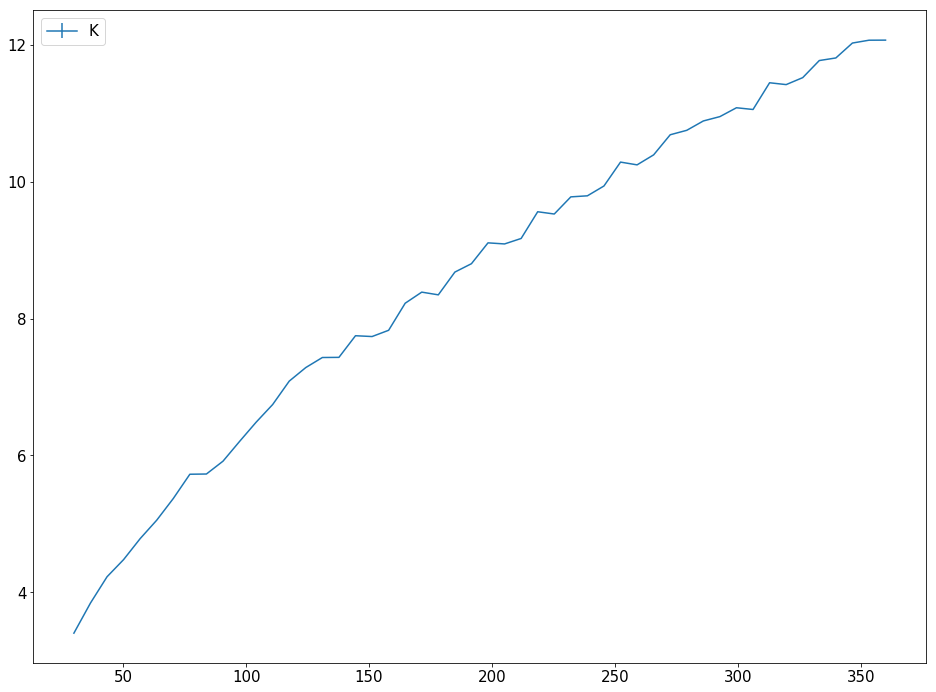

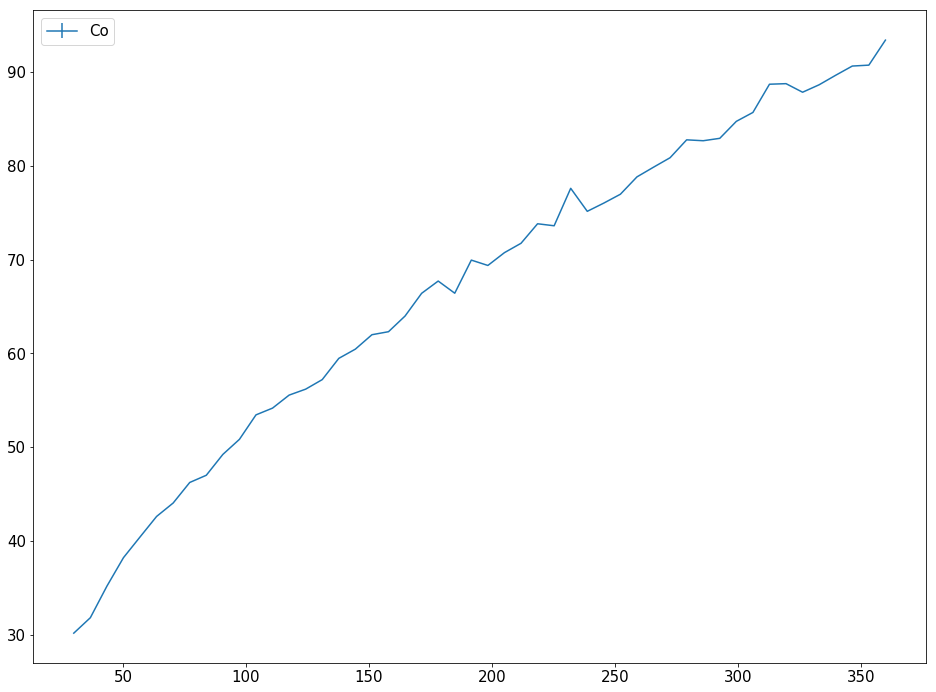

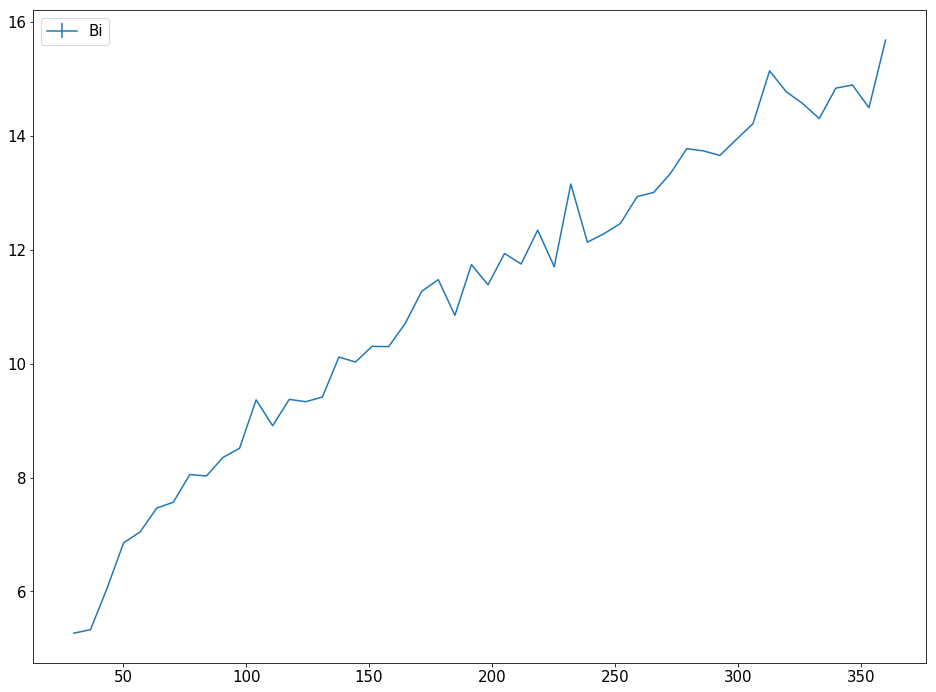

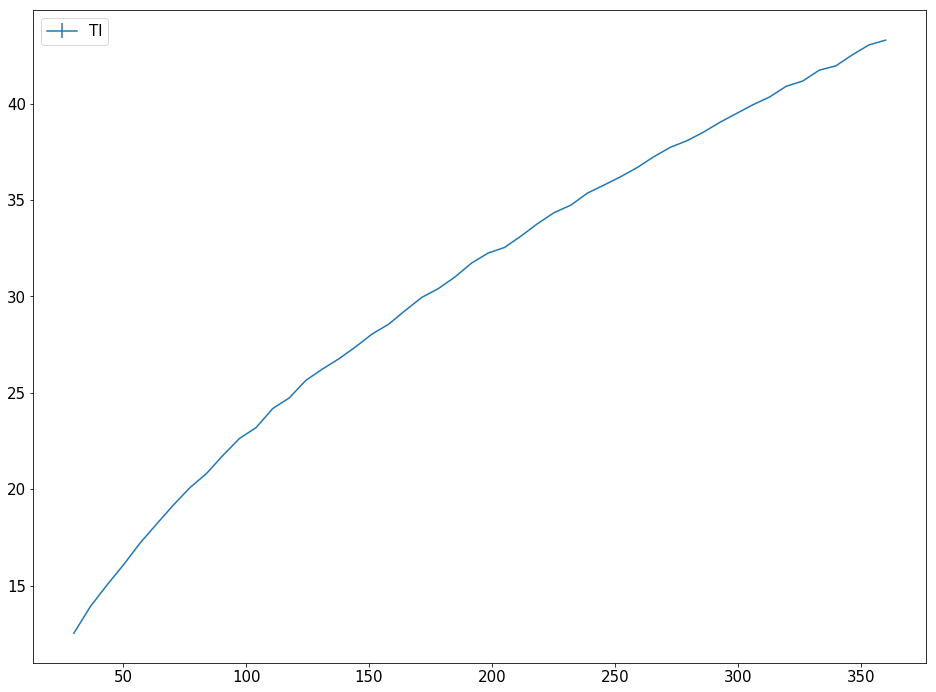

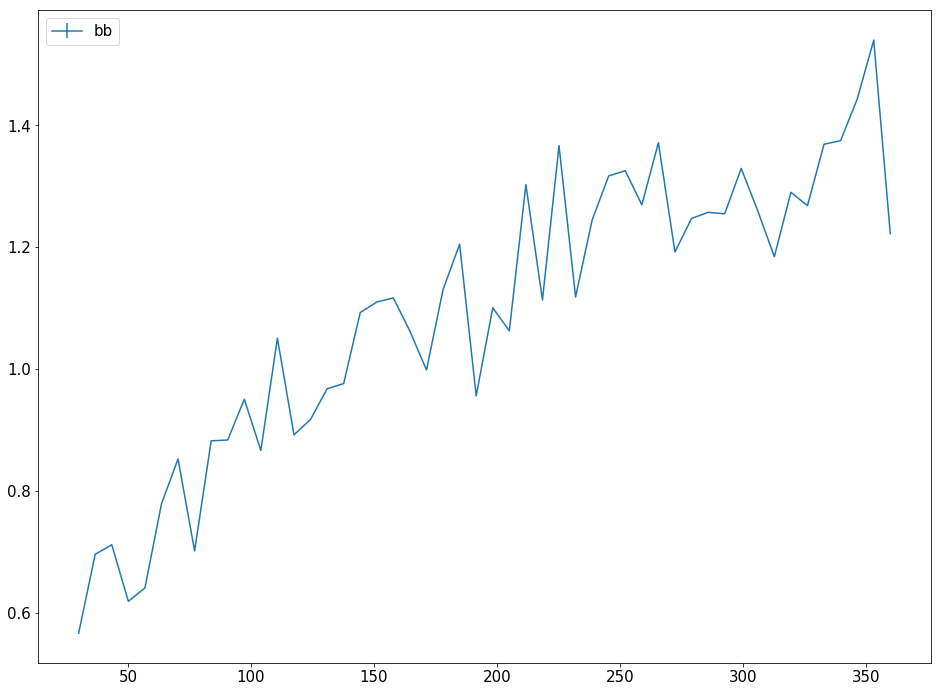

In [30]:
for i in aux_n.keys():
    n = np.array(aux_n[i])
    
    plt.figure()
    plt.errorbar(res_list.keys(), n ,0, label=i)
    plt.title =i
    plt.legend()
    plt.show()

aux_n = {'K':[], 'Co':[], 'Bi':[], 'Tl':[], 'bb':[]}
aux_e = {'K':[], 'Co':[], 'Bi':[], 'Tl':[], 'bb':[]}
for key in res_list.keys():
    for items in res_list[key][1]:
        aux_n[items.name].append(items.value)
        aux_e[items.name].append(items.error)


for i in aux_n.keys():
    n = np.array(aux_n[i])
    e = np.array(aux_e[i])
    
    plt.figure()
    plt.plot(res_list.keys(), n/e,label=i)
    plt.title =i
    plt.legend()
    plt.show()